In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf

c:\python\python37\lib\site-packages\tensorflow\python\framework\dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
c:\python\python37\lib\site-packages\tensorflow\python\framework\dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
c:\python\python37\lib\site-packages\tensorflow\python\framework\dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
c:\python\python37\lib\site-packages\tensorflow\python\framework\dtypes.py:529: FutureWarning: Passing (type, 1) or '1type' 

In [3]:
x_data = np.linspace(0.0, 10.0, 1000000)

In [4]:
noise = np.random.randn(len(x_data))

In [10]:
#y=mx+b ,b = 5
y_true = (0.5 * x_data) + 5 + noise


In [16]:
x_df = pd.DataFrame(data = x_data, columns=['x-Data'])
x_df

,x-Data
0,0.00000
1,0.00001
2,0.00002
3,0.00003
4,0.00004
...,...
999995,9.99996
999996,9.99997
999997,9.99998
999998,9.99999


In [17]:
y_df = pd.DataFrame(data = y_true, columns=['Y'])
y_df

,Y
0,4.942436
1,3.998339
2,6.733833
3,5.237771
4,4.537560
...,...
999995,11.986126
999996,10.354061
999997,11.110320
999998,9.687486


In [18]:
# x_df.head()
# # y_df.head()

In [20]:
my_data = pd.concat([x_df, y_df], axis=1)

my_data.head()

,x-Data,Y
0,0.00000,4.942436
1,0.00001,3.998339
2,0.00002,6.733833
3,0.00003,5.237771
4,0.00004,4.537560


In [21]:
my_data.sample(n=250)

,x-Data,Y
886014,8.860149,7.508061
213853,2.138532,6.826722
158497,1.584972,5.266510
607330,6.073306,8.380809
10554,0.105540,6.267991
...,...,...
838710,8.387108,9.535892
446403,4.464034,6.201162
923763,9.237639,8.403837
664766,6.647667,7.775518


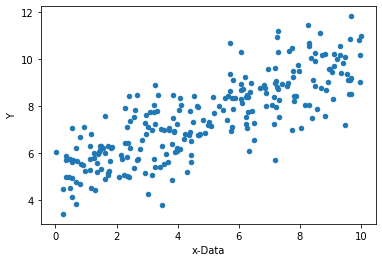

In [109]:
my_data.sample(250).plot(kind='scatter',x="x-Data" ,y="Y")

In [110]:
batch_size = 8

In [111]:
m = tf.Variable(0.5)
b = tf.Variable(1.0)

In [112]:
xph = tf.placeholder(tf.float32, [batch_size])
yph = tf.placeholder(tf.float32, [batch_size])

In [113]:
y_model = m*xph + b

In [114]:
#cost function
error = tf.reduce_sum(tf.square(yph-y_model))


In [115]:
optimizer = tf.train.GradientDescentOptimizer(learning_rate=0.001)
train = optimizer.minimize(error)

In [116]:
init = tf.global_variables_initializer() #to initialize the variable

In [117]:
with tf.Session() as sess:
    sess.run(init)
    
    batches = 10000
    for i in range(batches):
        rand_ind = np.random.randint(len(x_data), size=batch_size)
        feed = {xph:x_data[rand_ind], yph:y_true[rand_ind]}
        sess.run(train, feed_dict=feed)
    model_m, model_b = sess.run([m,b])
    

In [118]:
model_m

0.52580726

In [119]:
model_b

4.986395

In [120]:
y_hat = x_data * model_m + model_b
y_hat

array([ 4.98639488,  4.98640014,  4.9864054 , ..., 10.24445698,
       10.24446224, 10.2444675 ])

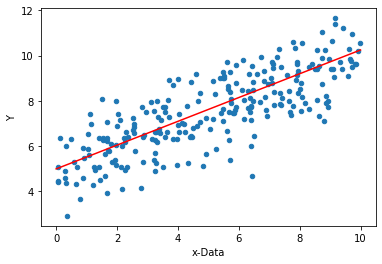

In [121]:
my_data.sample(n=250).plot(kind='scatter', x='x-Data', y='Y')
plt.plot(x_data, y_hat, 'r')

In [23]:
#estimator api

feat_cols = [tf.feature_column.numeric_column('x', shape=[1])]

In [26]:
estimator = tf.estimator.LinearRegressor(feature_columns=feat_cols)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\elaklak\\AppData\\Local\\Temp\\tmpsmtexa_b', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x000001E40578E988>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}


In [27]:
#train test split
from sklearn.model_selection import train_test_split

In [30]:
x_train, x_eval, y_train, y_eval = train_test_split(x_data, y_true, test_size=0.3, random_state=0)

In [34]:
(x_train.shape)
x_eval.shape

(300000,)

In [49]:
input_func = tf.estimator.inputs.numpy_input_fn({'x':x_train}, y_train, batch_size=4, num_epochs=None, shuffle=True)

train_input_func = tf.estimator.inputs.numpy_input_fn({'x':x_train}, y_train, batch_size=4, num_epochs=1000, shuffle=False)

eval_input_func = tf.estimator.inputs.numpy_input_fn({'x':x_train}, y_train, batch_size=4, num_epochs=1000, shuffle=False)


In [ ]:
estimator.train(input_fn=input_func)

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
To construct input pipelines, use the `tf.data` module.
Instructions for updating:
To construct input pipelines, use the `tf.data` module.
INFO:tensorflow:Calling model_fn.
Instructions for updating:
Use tf.cast instead.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Instructions for updating:
To construct input pipelines, use the `tf.data` module.
INFO:tensorflow:Saving checkpoints for 0 into C:\Users\elaklak\AppData\Local\Temp\tmpsmtexa_b\model.ckpt.
INFO:tensorflow:loss = 255.1067, step = 1
INFO:tensorflow:global_step/sec: 871.937
INFO:tensorflow:loss = 50.81235, step = 101 (0.118 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 20.428116, step = 201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tenso

INFO:tensorflow:loss = 6.903697, step = 6401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 6.8833647, step = 6501 (0.091 sec)
INFO:tensorflow:global_step/sec: 935.871
INFO:tensorflow:loss = 5.39789, step = 6601 (0.108 sec)
INFO:tensorflow:global_step/sec: 821.305
INFO:tensorflow:loss = 3.1322663, step = 6701 (0.122 sec)
INFO:tensorflow:global_step/sec: 1767.81
INFO:tensorflow:loss = 1.3034836, step = 6801 (0.056 sec)
INFO:tensorflow:global_step/sec: 1566.63
INFO:tensorflow:loss = 4.678499, step = 6901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1759.02
INFO:tensorflow:loss = 1.9714446, step = 7001 (0.057 sec)
INFO:tensorflow:global_step/sec: 1759.07
INFO:tensorflow:loss = 5.441943, step = 7101 (0.058 sec)
INFO:tensorflow:global_step/sec: 1617.17
INFO:tensorflow:loss = 3.809229, step = 7201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 5.715826, step = 7301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1728.69
INFO:tensorflow:lo

INFO:tensorflow:loss = 5.079915, step = 14701 (0.058 sec)
INFO:tensorflow:global_step/sec: 1790.46
INFO:tensorflow:loss = 8.95916, step = 14801 (0.057 sec)
INFO:tensorflow:global_step/sec: 1699.41
INFO:tensorflow:loss = 4.6004806, step = 14901 (0.058 sec)
INFO:tensorflow:global_step/sec: 1728.72
INFO:tensorflow:loss = 1.4197011, step = 15001 (0.059 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 2.7857227, step = 15101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1699.42
INFO:tensorflow:loss = 2.9122944, step = 15201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1566.64
INFO:tensorflow:loss = 2.563775, step = 15301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 2.6636798, step = 15401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.09
INFO:tensorflow:loss = 2.9795365, step = 15501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1617.16
INFO:tensorflow:loss = 1.7107779, step = 15601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1790.46
INFO

INFO:tensorflow:global_step/sec: 1113.88
INFO:tensorflow:loss = 3.7475905, step = 23001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1107.64
INFO:tensorflow:loss = 3.3539886, step = 23101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1108.45
INFO:tensorflow:loss = 0.73974484, step = 23201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.81
INFO:tensorflow:loss = 5.6449056, step = 23301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 4.056449, step = 23401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 1.0931655, step = 23501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1095.09
INFO:tensorflow:loss = 2.5669904, step = 23601 (0.091 sec)
INFO:tensorflow:global_step/sec: 967.6
INFO:tensorflow:loss = 3.5600088, step = 23701 (0.104 sec)
INFO:tensorflow:global_step/sec: 850.177
INFO:tensorflow:loss = 5.6731663, step = 23801 (0.119 sec)
INFO:tensorflow:global_step/sec: 1023.11
INFO:tensorflow:loss = 1.7063161, step = 23901 (0.097 sec)
IN

INFO:tensorflow:loss = 4.8796425, step = 31201 (0.056 sec)
INFO:tensorflow:global_step/sec: 1868.9
INFO:tensorflow:loss = 1.2302675, step = 31301 (0.055 sec)
INFO:tensorflow:global_step/sec: 1790.42
INFO:tensorflow:loss = 2.3135853, step = 31401 (0.055 sec)
INFO:tensorflow:global_step/sec: 1966.04
INFO:tensorflow:loss = 5.0569015, step = 31501 (0.052 sec)
INFO:tensorflow:global_step/sec: 1891.77
INFO:tensorflow:loss = 1.2408209, step = 31601 (0.052 sec)
INFO:tensorflow:global_step/sec: 1856.76
INFO:tensorflow:loss = 6.869111, step = 31701 (0.055 sec)
INFO:tensorflow:global_step/sec: 1759.05
INFO:tensorflow:loss = 0.68743163, step = 31801 (0.056 sec)
INFO:tensorflow:global_step/sec: 1790.45
INFO:tensorflow:loss = 1.7660202, step = 31901 (0.056 sec)
INFO:tensorflow:global_step/sec: 1891.81
INFO:tensorflow:loss = 1.7847584, step = 32001 (0.053 sec)
INFO:tensorflow:global_step/sec: 1790.43
INFO:tensorflow:loss = 8.231976, step = 32101 (0.056 sec)
INFO:tensorflow:global_step/sec: 1856.7
INF

INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 6.3735323, step = 39501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 4.0982623, step = 39601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 7.4403667, step = 39701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 7.2451944, step = 39801 (0.060 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 2.3633723, step = 39901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1700.77
INFO:tensorflow:loss = 11.14243, step = 40001 (0.060 sec)
INFO:tensorflow:global_step/sec: 1617.17
INFO:tensorflow:loss = 3.6342173, step = 40101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 3.7964916, step = 40201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 6.9427147, step = 40301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.49
INFO:tensorflow:loss = 6.3282638, step = 40401 (0.063 sec)
IN

INFO:tensorflow:loss = 5.9645314, step = 47701 (0.058 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 4.1790895, step = 47801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 1.0962775, step = 47901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1728.71
INFO:tensorflow:loss = 0.9942522, step = 48001 (0.059 sec)
INFO:tensorflow:global_step/sec: 1790.44
INFO:tensorflow:loss = 6.7533627, step = 48101 (0.056 sec)
INFO:tensorflow:global_step/sec: 1759.05
INFO:tensorflow:loss = 4.0813518, step = 48201 (0.057 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 5.7834883, step = 48301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 1.774842, step = 48401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 6.8153486, step = 48501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 2.3568017, step = 48601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1671.06
IN

INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 5.751499, step = 56001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 5.5439515, step = 56101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1728.71
INFO:tensorflow:loss = 6.732918, step = 56201 (0.058 sec)
INFO:tensorflow:global_step/sec: 1699.4
INFO:tensorflow:loss = 1.3757615, step = 56301 (0.060 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 4.640499, step = 56401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 1.1675516, step = 56501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1671.09
INFO:tensorflow:loss = 1.7171191, step = 56601 (0.059 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 4.5159516, step = 56701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1728.71
INFO:tensorflow:loss = 9.057487, step = 56801 (0.058 sec)
INFO:tensorflow:global_step/sec: 1671.06
INFO:tensorflow:loss = 9.409303, step = 56901 (0.061 sec)
INFO:t

INFO:tensorflow:loss = 7.4203854, step = 64201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1617.16
INFO:tensorflow:loss = 8.85122, step = 64301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 3.2509031, step = 64401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1699.43
INFO:tensorflow:loss = 0.6826766, step = 64501 (0.059 sec)
INFO:tensorflow:global_step/sec: 1699.39
INFO:tensorflow:loss = 4.4756374, step = 64601 (0.059 sec)
INFO:tensorflow:global_step/sec: 1699.42
INFO:tensorflow:loss = 2.2326107, step = 64701 (0.060 sec)
INFO:tensorflow:global_step/sec: 1643.69
INFO:tensorflow:loss = 4.909498, step = 64801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 2.4145539, step = 64901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1728.69
INFO:tensorflow:loss = 6.0416646, step = 65001 (0.058 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 5.298921, step = 65101 (0.059 sec)
INFO:tensorflow:global_step/sec: 1728.7
INFO:t

INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 2.5057554, step = 72501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1671.09
INFO:tensorflow:loss = 0.36494452, step = 72601 (0.059 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 2.4895058, step = 72701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 10.638861, step = 72801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1728.72
INFO:tensorflow:loss = 3.985309, step = 72901 (0.058 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 4.0173955, step = 73001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 5.6360407, step = 73101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.5282804, step = 73201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1728.7
INFO:tensorflow:loss = 3.1437197, step = 73301 (0.059 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 0.43803743, step = 73401 (0.063 sec)


INFO:tensorflow:loss = 2.613081, step = 80701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 0.364825, step = 80801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 3.383423, step = 80901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 0.62533975, step = 81001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 3.5088046, step = 81101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 0.78343695, step = 81201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 2.390171, step = 81301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 0.7696482, step = 81401 (0.059 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 6.105996, step = 81501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 5.435861, step = 81601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1728.71
INFO

INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 6.029497, step = 89001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 9.117949, step = 89101 (0.059 sec)
INFO:tensorflow:global_step/sec: 1728.68
INFO:tensorflow:loss = 5.412925, step = 89201 (0.059 sec)
INFO:tensorflow:global_step/sec: 1699.43
INFO:tensorflow:loss = 5.6036882, step = 89301 (0.059 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 4.8105726, step = 89401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1759.04
INFO:tensorflow:loss = 3.8391857, step = 89501 (0.057 sec)
INFO:tensorflow:global_step/sec: 1671.07
INFO:tensorflow:loss = 4.171989, step = 89601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 1.392971, step = 89701 (0.059 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 5.054651, step = 89801 (0.060 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 2.4689932, step = 89901 (0.062 sec)
INFO:tens

INFO:tensorflow:loss = 5.9015355, step = 97201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 4.441974, step = 97301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.17
INFO:tensorflow:loss = 1.4423318, step = 97401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.52
INFO:tensorflow:loss = 5.529555, step = 97501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1699.44
INFO:tensorflow:loss = 3.169332, step = 97601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1790.46
INFO:tensorflow:loss = 4.225679, step = 97701 (0.055 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 3.9642496, step = 97801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1617.17
INFO:tensorflow:loss = 2.5324302, step = 97901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 7.779124, step = 98001 (0.060 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 4.091758, step = 98101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:ten

INFO:tensorflow:loss = 4.497782, step = 105401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 2.935748, step = 105501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 3.7587547, step = 105601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 3.1872618, step = 105701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 4.454919, step = 105801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 1.5996089, step = 105901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1699.41
INFO:tensorflow:loss = 1.8241439, step = 106001 (0.059 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 5.630655, step = 106101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.67
INFO:tensorflow:loss = 1.3850656, step = 106201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 2.3512635, step = 106301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643

INFO:tensorflow:loss = 6.3716135, step = 113601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 4.7224207, step = 113701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1790.43
INFO:tensorflow:loss = 0.9040226, step = 113801 (0.057 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 2.84966, step = 113901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 5.9308257, step = 114001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 3.0291333, step = 114101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.9960544, step = 114201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 7.706415, step = 114301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 5.4848948, step = 114401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 6.4914193, step = 114501 (0.061 sec)
INFO:tensorflow:global_step/sec: 16

INFO:tensorflow:global_step/sec: 1561.4
INFO:tensorflow:loss = 1.8874803, step = 121801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1596.96
INFO:tensorflow:loss = 1.2177997, step = 121901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 3.899485, step = 122001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.2594625, step = 122101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1699.42
INFO:tensorflow:loss = 10.768839, step = 122201 (0.059 sec)
INFO:tensorflow:global_step/sec: 1643.69
INFO:tensorflow:loss = 10.132062, step = 122301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 0.7623643, step = 122401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1823.01
INFO:tensorflow:loss = 3.2469628, step = 122501 (0.055 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 2.6708944, step = 122601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 1.8558799, step = 122701 (0.0

INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 2.6058254, step = 130001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1728.68
INFO:tensorflow:loss = 0.891103, step = 130101 (0.059 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 3.7111406, step = 130201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.69
INFO:tensorflow:loss = 4.9287252, step = 130301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 2.7968743, step = 130401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 5.2736716, step = 130501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.0021465, step = 130601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.63
INFO:tensorflow:loss = 2.219102, step = 130701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.48
INFO:tensorflow:loss = 8.046256, step = 130801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.42673066, step = 130901 (0.0

INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.0853808, step = 138201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 2.608408, step = 138301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 3.3920846, step = 138401 (0.059 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.9763958, step = 138501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1728.73
INFO:tensorflow:loss = 7.244173, step = 138601 (0.059 sec)
INFO:tensorflow:global_step/sec: 1856.79
INFO:tensorflow:loss = 0.8020285, step = 138701 (0.054 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 1.2735465, step = 138801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 2.3851469, step = 138901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 4.6636353, step = 139001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 0.21205205, step = 139101 (0.063

INFO:tensorflow:global_step/sec: 1699.41
INFO:tensorflow:loss = 2.976919, step = 146401 (0.059 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 0.7244655, step = 146501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 7.5429125, step = 146601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 7.997076, step = 146701 (0.060 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.569455, step = 146801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 2.826197, step = 146901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 1.7539822, step = 147001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1790.45
INFO:tensorflow:loss = 0.18344375, step = 147101 (0.057 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 0.97437847, step = 147201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 3.0812707, step = 147301 (0.06

INFO:tensorflow:global_step/sec: 940.208
INFO:tensorflow:loss = 1.4277353, step = 154601 (0.108 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 3.551288, step = 154701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1255.68
INFO:tensorflow:loss = 2.7776568, step = 154801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1126.45
INFO:tensorflow:loss = 2.2068408, step = 154901 (0.088 sec)
INFO:tensorflow:global_step/sec: 946.014
INFO:tensorflow:loss = 1.2742634, step = 155001 (0.106 sec)
INFO:tensorflow:global_step/sec: 748.248
INFO:tensorflow:loss = 4.7059174, step = 155101 (0.135 sec)
INFO:tensorflow:global_step/sec: 777.268
INFO:tensorflow:loss = 8.499795, step = 155201 (0.128 sec)
INFO:tensorflow:global_step/sec: 835.55
INFO:tensorflow:loss = 1.2057805, step = 155301 (0.120 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 6.1932693, step = 155401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 3.3376796, step = 155501 (0.09

INFO:tensorflow:global_step/sec: 1429.01
INFO:tensorflow:loss = 3.70101, step = 162801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1384.98
INFO:tensorflow:loss = 4.213708, step = 162901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.05
INFO:tensorflow:loss = 1.2072227, step = 163001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.4264662, step = 163101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.4491782, step = 163201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 5.1664085, step = 163301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1354.88
INFO:tensorflow:loss = 9.060557, step = 163401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.93
INFO:tensorflow:loss = 3.5123138, step = 163501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.2790794, step = 163601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 7.9030614, step = 163701 (0.077 s

INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 6.409665, step = 171001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.0313497, step = 171101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 2.2335315, step = 171201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 4.3110933, step = 171301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.2603004, step = 171401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.0709395, step = 171501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.3158934, step = 171601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1642.28
INFO:tensorflow:loss = 8.485149, step = 171701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1515.28
INFO:tensorflow:loss = 1.4753425, step = 171801 (0.057 sec)
INFO:tensorflow:global_step/sec: 1230.78
INFO:tensorflow:loss = 2.3358989, step = 171901 (0.0

INFO:tensorflow:loss = 7.5123425, step = 179101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1656.58
INFO:tensorflow:loss = 2.206573, step = 179201 (0.058 sec)
INFO:tensorflow:global_step/sec: 1306.45
INFO:tensorflow:loss = 5.7885356, step = 179301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1479.02
INFO:tensorflow:loss = 1.8499519, step = 179401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1467.96
INFO:tensorflow:loss = 1.7150115, step = 179501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 3.1207395, step = 179601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 7.654967, step = 179701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 0.9360393, step = 179801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.903116, step = 179901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.64
INFO:tensorflow:loss = 1.6286399, step = 180001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1

INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 2.7324147, step = 187301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 2.0814633, step = 187401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.322092, step = 187501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.1349916, step = 187601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.8157145, step = 187701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 3.0958245, step = 187801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.321227, step = 187901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.164474, step = 188001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 3.5490317, step = 188101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 15.008876, step = 188201 (0.07

INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.8562098, step = 195501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.610471, step = 195601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 1.9214077, step = 195701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.002467, step = 195801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 4.60349, step = 195901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1679.61
INFO:tensorflow:loss = 2.338964, step = 196001 (0.058 sec)
INFO:tensorflow:global_step/sec: 1556.32
INFO:tensorflow:loss = 1.7507143, step = 196101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1342.28
INFO:tensorflow:loss = 4.811356, step = 196201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.6507099, step = 196301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.970309, step = 196401 (0.069 sec

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.6587496, step = 203701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.9107041, step = 203801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1820.49
INFO:tensorflow:loss = 1.8477981, step = 203901 (0.053 sec)
INFO:tensorflow:global_step/sec: 1146.46
INFO:tensorflow:loss = 2.1506693, step = 204001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.1336, step = 204101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.620533, step = 204201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 1.5568396, step = 204301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.2943726, step = 204401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.9705505, step = 204501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.7256804, step = 204601 (0.067 se

INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 4.504468, step = 211901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 5.568159, step = 212001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 5.3898306, step = 212101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1728.73
INFO:tensorflow:loss = 1.7738502, step = 212201 (0.058 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.0734344, step = 212301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 4.196414, step = 212401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1668.27
INFO:tensorflow:loss = 8.083767, step = 212501 (0.058 sec)
INFO:tensorflow:global_step/sec: 1722.68
INFO:tensorflow:loss = 1.4803532, step = 212601 (0.058 sec)
INFO:tensorflow:global_step/sec: 1360.67
INFO:tensorflow:loss = 2.6618547, step = 212701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 4.564333, step = 212801 (0.061 

INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 5.1570716, step = 220101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.8572197, step = 220201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.1823165, step = 220301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.2523916, step = 220401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.9621954, step = 220501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1391.67
INFO:tensorflow:loss = 2.6634307, step = 220601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1437.54
INFO:tensorflow:loss = 13.076688, step = 220701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.449938, step = 220801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 2.2177413, step = 220901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.1254618, step = 221001 (0.

INFO:tensorflow:global_step/sec: 1268.04
INFO:tensorflow:loss = 3.447208, step = 228301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.9689639, step = 228401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 7.9803653, step = 228501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 1.4534631, step = 228601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.6194396, step = 228701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.6886667, step = 228801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 5.238832, step = 228901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.8291063, step = 229001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 8.893416, step = 229101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.043034, step = 229201 (0.062

INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 3.7478893, step = 236501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 4.1071806, step = 236601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.4546647, step = 236701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.2201905, step = 236801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.56
INFO:tensorflow:loss = 7.239599, step = 236901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.77
INFO:tensorflow:loss = 1.6349877, step = 237001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 0.6712045, step = 237101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.8300667, step = 237201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.6242533, step = 237301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 0.20868696, step = 237401 (0.

INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.146373, step = 244701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.9093108, step = 244801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1706.94
INFO:tensorflow:loss = 0.6586505, step = 244901 (0.057 sec)
INFO:tensorflow:global_step/sec: 1348.95
INFO:tensorflow:loss = 0.30163026, step = 245001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.8689198, step = 245101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.866189, step = 245201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.94791174, step = 245301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 1.9138646, step = 245401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.9316504, step = 245501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.8451165, step = 245601 (0

INFO:tensorflow:loss = 7.73698, step = 252801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.491587, step = 252901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.272591, step = 253001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 11.777006, step = 253101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.5980477, step = 253201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 4.630246, step = 253301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.8860471, step = 253401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1340.79
INFO:tensorflow:loss = 8.397962, step = 253501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1508.04
INFO:tensorflow:loss = 4.8647366, step = 253601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.68718666, step = 253701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.

INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 4.7365994, step = 261001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 9.550334, step = 261101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.6979518, step = 261201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1493
INFO:tensorflow:loss = 1.016555, step = 261301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.94550896, step = 261401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.7013516, step = 261501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 3.9929676, step = 261601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1484.01
INFO:tensorflow:loss = 2.1172817, step = 261701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1279.34
INFO:tensorflow:loss = 3.9187527, step = 261801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.4644098, step = 261901 (0.066 

INFO:tensorflow:global_step/sec: 1963.89
INFO:tensorflow:loss = 4.149929, step = 269201 (0.050 sec)
INFO:tensorflow:global_step/sec: 1399.58
INFO:tensorflow:loss = 1.055935, step = 269301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.8231342, step = 269401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.9482355, step = 269501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 2.775747, step = 269601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 4.9284163, step = 269701 (0.059 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.3942428, step = 269801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.0356488, step = 269901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 10.286527, step = 270001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 0.4246989, step = 270101 (0.07

INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 4.439166, step = 277401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 8.523051, step = 277501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 2.2278743, step = 277601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.4449534, step = 277701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 1.9243932, step = 277801 (0.060 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 4.520511, step = 277901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.1537635, step = 278001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 5.666978, step = 278101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 7.5067577, step = 278201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 0.7803105, step = 278301 (0.061 

INFO:tensorflow:global_step/sec: 1671.13
INFO:tensorflow:loss = 1.9716618, step = 285601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 10.059212, step = 285701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.16
INFO:tensorflow:loss = 3.0622814, step = 285801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 4.172452, step = 285901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1706.95
INFO:tensorflow:loss = 0.863536, step = 286001 (0.057 sec)
INFO:tensorflow:global_step/sec: 1529.28
INFO:tensorflow:loss = 2.9339359, step = 286101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 1.4257667, step = 286201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.829792, step = 286301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 1.771106, step = 286401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 0.6944133, step = 286501 (0.062

INFO:tensorflow:loss = 1.2106171, step = 293701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.5085143, step = 293801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 6.4167385, step = 293901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0134835, step = 294001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.4252613, step = 294101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.4353743, step = 294201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 7.040585, step = 294301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.019376, step = 294401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.765324, step = 294501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 10.8449335, step = 294601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.9235672, step = 301901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 4.5313873, step = 302001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 1.7166075, step = 302101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 3.7373219, step = 302201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 1.7165881, step = 302301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.419514, step = 302401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.2909772, step = 302501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.5171711, step = 302601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.8785586, step = 302701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 5.1033134, step = 302801 (0.0

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.8091432, step = 310101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.395273, step = 310201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 3.2292378, step = 310301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.2433958, step = 310401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.2473779, step = 310501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.8210154, step = 310601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.1428363, step = 310701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.306117, step = 310801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 7.191821, step = 310901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.0535452, step = 311001 (0.067 

INFO:tensorflow:loss = 0.9097939, step = 318201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.4758417, step = 318301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.6458932, step = 318401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 3.2742653, step = 318501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.3329134, step = 318601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 3.7861147, step = 318701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 4.2038126, step = 318801 (0.059 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 5.1425085, step = 318901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 6.2586164, step = 319001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 0.9902687, step = 319101 (0.063 sec)
INFO:tensorflow:global_step/sec

INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.2028673, step = 326401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 0.35532138, step = 326501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.0152884, step = 326601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 7.223806, step = 326701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 2.084139, step = 326801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.809556, step = 326901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.5810604, step = 327001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 9.420059, step = 327101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.781955, step = 327201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.6994922, step = 327301 (0.069 

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.7880087, step = 334601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.3571564, step = 334701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.906998, step = 334801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.1147087, step = 334901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.9888859, step = 335001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 5.944884, step = 335101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.1316555, step = 335201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.2219036, step = 335301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.290767, step = 335401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 2.449886, step = 335501 (0.081

INFO:tensorflow:loss = 3.3052065, step = 342701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.03014, step = 342801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 4.2130117, step = 342901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 3.652289, step = 343001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 11.201397, step = 343101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 6.0425186, step = 343201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.5505319, step = 343301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.8758616, step = 343401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 11.068418, step = 343501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.703318, step = 343601 (0.066 sec)
INFO:tensorflow:global_step/sec: 156

INFO:tensorflow:global_step/sec: 1284.02
INFO:tensorflow:loss = 8.608752, step = 350901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1615
INFO:tensorflow:loss = 2.0648973, step = 351001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1182.41
INFO:tensorflow:loss = 4.9250956, step = 351101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1512.83
INFO:tensorflow:loss = 4.985641, step = 351201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1020.16
INFO:tensorflow:loss = 1.0343282, step = 351301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1326.83
INFO:tensorflow:loss = 5.166829, step = 351401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1622.27
INFO:tensorflow:loss = 3.926511, step = 351501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1256.59
INFO:tensorflow:loss = 6.277272, step = 351601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1456.07
INFO:tensorflow:loss = 8.350075, step = 351701 (0.053 sec)
INFO:tensorflow:global_step/sec: 1351.56
INFO:tensorflow:loss = 2.4896326, step = 351801 (0.074 sec)

INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.4051665, step = 359101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1820.05
INFO:tensorflow:loss = 5.3088784, step = 359201 (0.054 sec)
INFO:tensorflow:global_step/sec: 1500.17
INFO:tensorflow:loss = 3.2456071, step = 359301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1301.52
INFO:tensorflow:loss = 1.1593533, step = 359401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1520.82
INFO:tensorflow:loss = 0.5080718, step = 359501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1469.84
INFO:tensorflow:loss = 8.207377, step = 359601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1493.86
INFO:tensorflow:loss = 2.6632845, step = 359701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1543.08
INFO:tensorflow:loss = 4.5176725, step = 359801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1309.66
INFO:tensorflow:loss = 5.184649, step = 359901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.9291964, step = 360001 (0.0

INFO:tensorflow:loss = 4.4626446, step = 367201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1220.07
INFO:tensorflow:loss = 6.261936, step = 367301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.2093554, step = 367401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.543472, step = 367501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.297846, step = 367601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 5.4872565, step = 367701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 9.856833, step = 367801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 0.9496673, step = 367901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.615732, step = 368001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1549.74
INFO:tensorflow:loss = 5.790538, step = 368101 (0.063 sec)
INFO:tensorflow:global_step/sec: 2067.

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.5820034, step = 375401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 8.293442, step = 375501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 9.838482, step = 375601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 0.90409595, step = 375701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.6955156, step = 375801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 3.3838353, step = 375901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1679.7
INFO:tensorflow:loss = 4.4552073, step = 376001 (0.058 sec)
INFO:tensorflow:global_step/sec: 1708.08
INFO:tensorflow:loss = 3.788425, step = 376101 (0.059 sec)
INFO:tensorflow:global_step/sec: 1801.96
INFO:tensorflow:loss = 1.9364879, step = 376201 (0.055 sec)
INFO:tensorflow:global_step/sec: 1362.69
INFO:tensorflow:loss = 4.4225893, step = 376301 (0.07

INFO:tensorflow:loss = 1.1153052, step = 383501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1348.04
INFO:tensorflow:loss = 3.2558417, step = 383601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1926.31
INFO:tensorflow:loss = 5.706938, step = 383701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1463.37
INFO:tensorflow:loss = 5.832194, step = 383801 (0.053 sec)
INFO:tensorflow:global_step/sec: 1399.83
INFO:tensorflow:loss = 1.8092991, step = 383901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1750.08
INFO:tensorflow:loss = 5.9421883, step = 384001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.77
INFO:tensorflow:loss = 7.7136364, step = 384101 (0.056 sec)
INFO:tensorflow:global_step/sec: 1607.45
INFO:tensorflow:loss = 10.937469, step = 384201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1298.06
INFO:tensorflow:loss = 2.476547, step = 384301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 8.141534, step = 384401 (0.064 sec)
INFO:tensorflow:global_step/sec: 15

INFO:tensorflow:global_step/sec: 1470.28
INFO:tensorflow:loss = 1.7140031, step = 391701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1597.88
INFO:tensorflow:loss = 5.6023345, step = 391801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1493.91
INFO:tensorflow:loss = 1.3977708, step = 391901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1724.5
INFO:tensorflow:loss = 2.3940217, step = 392001 (0.058 sec)
INFO:tensorflow:global_step/sec: 1518.26
INFO:tensorflow:loss = 3.6647553, step = 392101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.6276226, step = 392201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.264519, step = 392301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 1.987214, step = 392401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.4763606, step = 392501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 2.4253807, step = 392601 (0.06

INFO:tensorflow:loss = 3.1113868, step = 399801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 12.086281, step = 399901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1469.74
INFO:tensorflow:loss = 4.66364, step = 400001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.5669597, step = 400101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 9.502783, step = 400201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.5436993, step = 400301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.2857394, step = 400401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 3.1809804, step = 400501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1617.17
INFO:tensorflow:loss = 1.1427921, step = 400601 (0.062 sec)
INFO:tensorflow:global_step/sec: 2043.46
INFO:tensorflow:loss = 6.4935837, step = 400701 (0.064 sec)
INFO:tensorflow:global_step/sec: 135

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.791269, step = 408001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.9937353, step = 408101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.7606841, step = 408201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1565.2
INFO:tensorflow:loss = 2.3152182, step = 408301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1735.9
INFO:tensorflow:loss = 2.071054, step = 408401 (0.058 sec)
INFO:tensorflow:global_step/sec: 1501.74
INFO:tensorflow:loss = 5.0327907, step = 408501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1666.64
INFO:tensorflow:loss = 2.2074137, step = 408601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1345.95
INFO:tensorflow:loss = 2.0190282, step = 408701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1685.33
INFO:tensorflow:loss = 2.8395302, step = 408801 (0.059 sec)
INFO:tensorflow:global_step/sec: 1222.29
INFO:tensorflow:loss = 2.830064, step = 408901 (0.083 

INFO:tensorflow:global_step/sec: 1288.58
INFO:tensorflow:loss = 2.0750349, step = 416201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1499.56
INFO:tensorflow:loss = 8.347137, step = 416301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1396.6
INFO:tensorflow:loss = 4.6422625, step = 416401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1335.65
INFO:tensorflow:loss = 1.0155073, step = 416501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 3.1683924, step = 416601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.1712637, step = 416701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.1711309, step = 416801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.6199536, step = 416901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.69
INFO:tensorflow:loss = 10.378707, step = 417001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.9262083, step = 417101 (0.06

INFO:tensorflow:loss = 2.651171, step = 424301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.367086, step = 424401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 4.1496525, step = 424501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.92204, step = 424601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 1.1174467, step = 424701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.13
INFO:tensorflow:loss = 1.4637246, step = 424801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1670.17
INFO:tensorflow:loss = 2.210652, step = 424901 (0.058 sec)
INFO:tensorflow:global_step/sec: 1841.61
INFO:tensorflow:loss = 4.336658, step = 425001 (0.054 sec)
INFO:tensorflow:global_step/sec: 1465.09
INFO:tensorflow:loss = 4.262396, step = 425101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1478.56
INFO:tensorflow:loss = 2.976474, step = 425201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1552.87

INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.3863177, step = 432501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1549.61
INFO:tensorflow:loss = 0.7865978, step = 432601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1749.49
INFO:tensorflow:loss = 5.507423, step = 432701 (0.057 sec)
INFO:tensorflow:global_step/sec: 1499.93
INFO:tensorflow:loss = 1.673253, step = 432801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1455.71
INFO:tensorflow:loss = 3.5662959, step = 432901 (0.053 sec)
INFO:tensorflow:global_step/sec: 1236.2
INFO:tensorflow:loss = 10.730387, step = 433001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1679.2
INFO:tensorflow:loss = 5.1049485, step = 433101 (0.059 sec)
INFO:tensorflow:global_step/sec: 984.518
INFO:tensorflow:loss = 3.3074498, step = 433201 (0.104 sec)
INFO:tensorflow:global_step/sec: 992.735
INFO:tensorflow:loss = 2.106283, step = 433301 (0.101 sec)
INFO:tensorflow:global_step/sec: 1066.65
INFO:tensorflow:loss = 8.533302, step = 433401 (0.094 s

INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.8695087, step = 440701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.0054674, step = 440801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 3.0235722, step = 440901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.573948, step = 441001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.9094253, step = 441101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.8360846, step = 441201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1139.31
INFO:tensorflow:loss = 11.725358, step = 441301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1012.85
INFO:tensorflow:loss = 3.229154, step = 441401 (0.099 sec)
INFO:tensorflow:global_step/sec: 1190.02
INFO:tensorflow:loss = 9.18956, step = 441501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1299.14
INFO:tensorflow:loss = 1.8223692, step = 441601 (0.078

INFO:tensorflow:global_step/sec: 919.866
INFO:tensorflow:loss = 6.548511, step = 448901 (0.109 sec)
INFO:tensorflow:global_step/sec: 964.115
INFO:tensorflow:loss = 0.4768614, step = 449001 (0.103 sec)
INFO:tensorflow:global_step/sec: 964.057
INFO:tensorflow:loss = 2.052853, step = 449101 (0.105 sec)
INFO:tensorflow:global_step/sec: 1002.71
INFO:tensorflow:loss = 3.3454616, step = 449201 (0.101 sec)
INFO:tensorflow:global_step/sec: 937.076
INFO:tensorflow:loss = 2.8042903, step = 449301 (0.105 sec)
INFO:tensorflow:global_step/sec: 928.249
INFO:tensorflow:loss = 1.4443316, step = 449401 (0.109 sec)
INFO:tensorflow:global_step/sec: 944.276
INFO:tensorflow:loss = 8.062767, step = 449501 (0.105 sec)
INFO:tensorflow:global_step/sec: 873.398
INFO:tensorflow:loss = 4.2102284, step = 449601 (0.115 sec)
INFO:tensorflow:global_step/sec: 963.501
INFO:tensorflow:loss = 1.0826294, step = 449701 (0.104 sec)
INFO:tensorflow:global_step/sec: 940.52
INFO:tensorflow:loss = 2.7379236, step = 449801 (0.106

INFO:tensorflow:loss = 8.173949, step = 457001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 0.31674117, step = 457101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 16.487625, step = 457201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 8.286998, step = 457301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.4708166, step = 457401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1520.14
INFO:tensorflow:loss = 3.297977, step = 457501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 11.522685, step = 457601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.5479188, step = 457701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 7.890729, step = 457801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1480.9
INFO:tensorflow:loss = 1.384602, step = 457901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.5653377, step = 465201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 6.253278, step = 465301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.242911, step = 465401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 6.9094505, step = 465501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.4398727, step = 465601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.515721, step = 465701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.203715, step = 465801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 3.1104455, step = 465901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.5816145, step = 466001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.372271, step = 466101 (0.065 s

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 19.540323, step = 473401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 0.45709184, step = 473501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.912877, step = 473601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 5.6302867, step = 473701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.1164513, step = 473801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.4507942, step = 473901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 4.062563, step = 474001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.5633309, step = 474101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.023924, step = 474201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.2873158, step = 474301 (0.06

INFO:tensorflow:loss = 7.564983, step = 481501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.4766074, step = 481601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.6292322, step = 481701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.091345, step = 481801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.4437857, step = 481901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.18
INFO:tensorflow:loss = 5.891594, step = 482001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.32
INFO:tensorflow:loss = 0.5005511, step = 482101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.6881056, step = 482201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 10.332587, step = 482301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.8791814, step = 482401 (0.069 sec)
INFO:tensorflow:global_step/sec: 14

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.2398283, step = 489701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.43545, step = 489801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 12.448708, step = 489901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.7430334, step = 490001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 7.6571774, step = 490101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.6922917, step = 490201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 4.6703897, step = 490301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.3207952, step = 490401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 3.1730783, step = 490501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 3.2428079, step = 490601 (0.06

INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 6.0247717, step = 497901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.691512, step = 498001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.591125, step = 498101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.5883803, step = 498201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 10.486156, step = 498301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1699.4
INFO:tensorflow:loss = 11.003989, step = 498401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 10.0728855, step = 498501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.875041, step = 498601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.2982523, step = 498701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 3.750266, step = 498801 (0.060 s

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0776377, step = 506101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.5458587, step = 506201 (0.078 sec)
INFO:tensorflow:global_step/sec: 759.586
INFO:tensorflow:loss = 1.8071603, step = 506301 (0.133 sec)
INFO:tensorflow:global_step/sec: 871.886
INFO:tensorflow:loss = 0.5795821, step = 506401 (0.115 sec)
INFO:tensorflow:global_step/sec: 634.599
INFO:tensorflow:loss = 1.6465207, step = 506501 (0.159 sec)
INFO:tensorflow:global_step/sec: 789.504
INFO:tensorflow:loss = 2.89353, step = 506601 (0.126 sec)
INFO:tensorflow:global_step/sec: 856.653
INFO:tensorflow:loss = 0.9432435, step = 506701 (0.118 sec)
INFO:tensorflow:global_step/sec: 927.25
INFO:tensorflow:loss = 4.400959, step = 506801 (0.107 sec)
INFO:tensorflow:global_step/sec: 879.53
INFO:tensorflow:loss = 1.3215016, step = 506901 (0.114 sec)
INFO:tensorflow:global_step/sec: 911.512
INFO:tensorflow:loss = 3.3972597, step = 507001 (0.110 s

INFO:tensorflow:global_step/sec: 500.071
INFO:tensorflow:loss = 5.3072114, step = 514301 (0.200 sec)
INFO:tensorflow:global_step/sec: 655.347
INFO:tensorflow:loss = 4.581744, step = 514401 (0.152 sec)
INFO:tensorflow:global_step/sec: 919.779
INFO:tensorflow:loss = 2.4517882, step = 514501 (0.109 sec)
INFO:tensorflow:global_step/sec: 955.033
INFO:tensorflow:loss = 1.5007589, step = 514601 (0.105 sec)
INFO:tensorflow:global_step/sec: 982.998
INFO:tensorflow:loss = 1.1453621, step = 514701 (0.102 sec)
INFO:tensorflow:global_step/sec: 783.339
INFO:tensorflow:loss = 4.0644364, step = 514801 (0.128 sec)
INFO:tensorflow:global_step/sec: 777.258
INFO:tensorflow:loss = 5.0064235, step = 514901 (0.129 sec)
INFO:tensorflow:global_step/sec: 849.715
INFO:tensorflow:loss = 2.7103682, step = 515001 (0.118 sec)
INFO:tensorflow:global_step/sec: 738.204
INFO:tensorflow:loss = 0.75828373, step = 515101 (0.135 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 1.3276714, step = 515201 (0

INFO:tensorflow:loss = 3.6881216, step = 522401 (0.109 sec)
INFO:tensorflow:global_step/sec: 911.308
INFO:tensorflow:loss = 5.6766186, step = 522501 (0.110 sec)
INFO:tensorflow:global_step/sec: 946.142
INFO:tensorflow:loss = 3.3416612, step = 522601 (0.106 sec)
INFO:tensorflow:global_step/sec: 928.321
INFO:tensorflow:loss = 6.652366, step = 522701 (0.108 sec)
INFO:tensorflow:global_step/sec: 954.992
INFO:tensorflow:loss = 3.5977967, step = 522801 (0.106 sec)
INFO:tensorflow:global_step/sec: 968.597
INFO:tensorflow:loss = 3.436894, step = 522901 (0.103 sec)
INFO:tensorflow:global_step/sec: 751.724
INFO:tensorflow:loss = 4.358157, step = 523001 (0.132 sec)
INFO:tensorflow:global_step/sec: 1285.69
INFO:tensorflow:loss = 1.4008089, step = 523101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.3711436, step = 523201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.80557287, step = 523301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.5960003, step = 530601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.252541, step = 530701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 3.5684428, step = 530801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 0.83867484, step = 530901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.8274045, step = 531001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.9217114, step = 531101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.492617, step = 531201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 6.659284, step = 531301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.4674757, step = 531401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1307158, step = 531501 (0.069

INFO:tensorflow:global_step/sec: 1369.52
INFO:tensorflow:loss = 2.3471556, step = 538801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 3.690448, step = 538901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1478.72
INFO:tensorflow:loss = 4.648329, step = 539001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1413.75
INFO:tensorflow:loss = 3.9651227, step = 539101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.098346, step = 539201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.3370428, step = 539301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.29
INFO:tensorflow:loss = 1.1940805, step = 539401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.3393579, step = 539501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.4825234, step = 539601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.75976, step = 539701 (0.070 se

INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.7640123, step = 547001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.318874, step = 547101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.879416, step = 547201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.8485998, step = 547301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.071608104, step = 547401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.76
INFO:tensorflow:loss = 5.598146, step = 547501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.38
INFO:tensorflow:loss = 7.9383535, step = 547601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.8741711, step = 547701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.5477958, step = 547801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1343.26
INFO:tensorflow:loss = 6.938485, step = 547901 (0.073

INFO:tensorflow:loss = 6.8157682, step = 555101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.675301, step = 555201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.690227, step = 555301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 5.21189, step = 555401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2993593, step = 555501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.11028, step = 555601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.422491, step = 555701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.04
INFO:tensorflow:loss = 5.339531, step = 555801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.49
INFO:tensorflow:loss = 3.5129533, step = 555901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1458.58
INFO:tensorflow:loss = 2.299926, step = 556001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
IN

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.677258, step = 563301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.5612903, step = 563401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.4406228, step = 563501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.6077013, step = 563601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.9031897, step = 563701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.546755, step = 563801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7966514, step = 563901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.431682, step = 564001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1380.04
INFO:tensorflow:loss = 2.555764, step = 564101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.748946, step = 564201 (0.071 se

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.06568587, step = 571501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.203144, step = 571601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.7991844, step = 571701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 4.201598, step = 571801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.4330754, step = 571901 (0.069 sec)
INFO:tensorflow:global_step/sec: 945.907
INFO:tensorflow:loss = 1.5463407, step = 572001 (0.107 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 2.3222504, step = 572101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.69
INFO:tensorflow:loss = 3.6447182, step = 572201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.84
INFO:tensorflow:loss = 2.1918054, step = 572301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.66872, step = 572401 (0.075

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.5299523, step = 579701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.8741078, step = 579801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.98467994, step = 579901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.3408747, step = 580001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.4438565, step = 580101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1362.69
INFO:tensorflow:loss = 1.2283587, step = 580201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1339.76
INFO:tensorflow:loss = 0.40799797, step = 580301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.79260767, step = 580401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.75959396, step = 580501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1394.52
INFO:tensorflow:loss = 2.5645318, step = 580601 

INFO:tensorflow:loss = 4.936418, step = 587801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.201582, step = 587901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.1358006, step = 588001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 9.232357, step = 588101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.7415164, step = 588201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 3.1292558, step = 588301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 2.0580397, step = 588401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1381.44
INFO:tensorflow:loss = 1.6087968, step = 588501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.4007298, step = 588601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 1.0911311, step = 588701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1241.

INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.071347, step = 596001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.72768915, step = 596101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1360.25
INFO:tensorflow:loss = 2.4363973, step = 596201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1329.92
INFO:tensorflow:loss = 5.823723, step = 596301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.414837, step = 596401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.82
INFO:tensorflow:loss = 6.8304377, step = 596501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 8.1111, step = 596601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1340.31
INFO:tensorflow:loss = 1.075629, step = 596701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.7436476, step = 596801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 14.469047, step = 596901 (0.080 sec

INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.2952514, step = 604201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.07129, step = 604301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 3.0796545, step = 604401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 2.7804556, step = 604501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.7434758, step = 604601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.7770796, step = 604701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.6630926, step = 604801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.629625, step = 604901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.2
INFO:tensorflow:loss = 6.2854214, step = 605001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.7431479, step = 605101 (0.071 

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.379699, step = 612401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.0448002, step = 612501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.67061, step = 612601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.1922594, step = 612701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.7833917, step = 612801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.2682563, step = 612901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.1814003, step = 613001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.43941578, step = 613101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.9865727, step = 613201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.6089306, step = 613301 (0.07

INFO:tensorflow:loss = 0.8276112, step = 620501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.668163, step = 620601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.3347063, step = 620701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1071.37
INFO:tensorflow:loss = 0.65959203, step = 620801 (0.094 sec)
INFO:tensorflow:global_step/sec: 731.823
INFO:tensorflow:loss = 0.7265524, step = 620901 (0.136 sec)
INFO:tensorflow:global_step/sec: 646.93
INFO:tensorflow:loss = 4.876018, step = 621001 (0.157 sec)
INFO:tensorflow:global_step/sec: 828.657
INFO:tensorflow:loss = 4.03796, step = 621101 (0.118 sec)
INFO:tensorflow:global_step/sec: 963.298
INFO:tensorflow:loss = 3.0083659, step = 621201 (0.105 sec)
INFO:tensorflow:global_step/sec: 900.403
INFO:tensorflow:loss = 5.251067, step = 621301 (0.111 sec)
INFO:tensorflow:global_step/sec: 742.719
INFO:tensorflow:loss = 2.8698525, step = 621401 (0.135 sec)
INFO:tensorflow:global_step/sec: 850

INFO:tensorflow:global_step/sec: 817.16
INFO:tensorflow:loss = 0.11832568, step = 628701 (0.122 sec)
INFO:tensorflow:global_step/sec: 903.314
INFO:tensorflow:loss = 3.4865932, step = 628801 (0.111 sec)
INFO:tensorflow:global_step/sec: 919.88
INFO:tensorflow:loss = 13.02264, step = 628901 (0.109 sec)
INFO:tensorflow:global_step/sec: 917.123
INFO:tensorflow:loss = 1.8937204, step = 629001 (0.109 sec)
INFO:tensorflow:global_step/sec: 930.777
INFO:tensorflow:loss = 2.4582887, step = 629101 (0.106 sec)
INFO:tensorflow:global_step/sec: 964.073
INFO:tensorflow:loss = 2.3191175, step = 629201 (0.105 sec)
INFO:tensorflow:global_step/sec: 919.804
INFO:tensorflow:loss = 3.419597, step = 629301 (0.109 sec)
INFO:tensorflow:global_step/sec: 887.404
INFO:tensorflow:loss = 4.6963487, step = 629401 (0.113 sec)
INFO:tensorflow:global_step/sec: 992.758
INFO:tensorflow:loss = 0.233471, step = 629501 (0.101 sec)
INFO:tensorflow:global_step/sec: 762.423
INFO:tensorflow:loss = 4.517847, step = 629601 (0.131 

INFO:tensorflow:global_step/sec: 828.644
INFO:tensorflow:loss = 3.9745893, step = 636901 (0.123 sec)
INFO:tensorflow:global_step/sec: 703.42
INFO:tensorflow:loss = 7.2440667, step = 637001 (0.141 sec)
INFO:tensorflow:global_step/sec: 763.36
INFO:tensorflow:loss = 3.137746, step = 637101 (0.132 sec)
INFO:tensorflow:global_step/sec: 867.868
INFO:tensorflow:loss = 2.7873225, step = 637201 (0.113 sec)
INFO:tensorflow:global_step/sec: 654.718
INFO:tensorflow:loss = 4.213082, step = 637301 (0.154 sec)
INFO:tensorflow:global_step/sec: 881.968
INFO:tensorflow:loss = 0.8114649, step = 637401 (0.112 sec)
INFO:tensorflow:global_step/sec: 903.324
INFO:tensorflow:loss = 1.9821237, step = 637501 (0.112 sec)
INFO:tensorflow:global_step/sec: 880.557
INFO:tensorflow:loss = 1.5960217, step = 637601 (0.113 sec)
INFO:tensorflow:global_step/sec: 928.391
INFO:tensorflow:loss = 4.7527437, step = 637701 (0.109 sec)
INFO:tensorflow:global_step/sec: 973.491
INFO:tensorflow:loss = 1.6744183, step = 637801 (0.102

INFO:tensorflow:global_step/sec: 906.253
INFO:tensorflow:loss = 5.8898544, step = 645101 (0.110 sec)
INFO:tensorflow:global_step/sec: 923.699
INFO:tensorflow:loss = 3.8823373, step = 645201 (0.109 sec)
INFO:tensorflow:global_step/sec: 875.427
INFO:tensorflow:loss = 2.5113783, step = 645301 (0.114 sec)
INFO:tensorflow:global_step/sec: 642.458
INFO:tensorflow:loss = 4.4032516, step = 645401 (0.155 sec)
INFO:tensorflow:global_step/sec: 815.262
INFO:tensorflow:loss = 1.6053911, step = 645501 (0.124 sec)
INFO:tensorflow:global_step/sec: 902.912
INFO:tensorflow:loss = 2.7521062, step = 645601 (0.111 sec)
INFO:tensorflow:global_step/sec: 906.637
INFO:tensorflow:loss = 2.2137794, step = 645701 (0.109 sec)
INFO:tensorflow:global_step/sec: 964.115
INFO:tensorflow:loss = 2.0026267, step = 645801 (0.105 sec)
INFO:tensorflow:global_step/sec: 911.516
INFO:tensorflow:loss = 0.7395295, step = 645901 (0.111 sec)
INFO:tensorflow:global_step/sec: 919.868
INFO:tensorflow:loss = 0.33179638, step = 646001 (

INFO:tensorflow:loss = 1.836107, step = 653201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1046.96
INFO:tensorflow:loss = 1.6701907, step = 653301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 7.549508, step = 653401 (0.100 sec)
INFO:tensorflow:global_step/sec: 1025.18
INFO:tensorflow:loss = 8.312764, step = 653501 (0.098 sec)
INFO:tensorflow:global_step/sec: 833.544
INFO:tensorflow:loss = 0.80178225, step = 653601 (0.120 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 5.9199543, step = 653701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 1.5902721, step = 653801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 2.7483923, step = 653901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.8219557, step = 654001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1291.93
INFO:tensorflow:loss = 2.6301205, step = 654101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1

INFO:tensorflow:global_step/sec: 772.423
INFO:tensorflow:loss = 1.1412297, step = 661401 (0.129 sec)
INFO:tensorflow:global_step/sec: 868.028
INFO:tensorflow:loss = 2.605789, step = 661501 (0.116 sec)
INFO:tensorflow:global_step/sec: 919.88
INFO:tensorflow:loss = 3.5846155, step = 661601 (0.109 sec)
INFO:tensorflow:global_step/sec: 903.312
INFO:tensorflow:loss = 0.8519692, step = 661701 (0.111 sec)
INFO:tensorflow:global_step/sec: 871.884
INFO:tensorflow:loss = 3.208034, step = 661801 (0.114 sec)
INFO:tensorflow:global_step/sec: 928.403
INFO:tensorflow:loss = 4.269553, step = 661901 (0.109 sec)
INFO:tensorflow:global_step/sec: 677.48
INFO:tensorflow:loss = 3.9972756, step = 662001 (0.147 sec)
INFO:tensorflow:global_step/sec: 835.555
INFO:tensorflow:loss = 5.4608536, step = 662101 (0.121 sec)
INFO:tensorflow:global_step/sec: 846.006
INFO:tensorflow:loss = 10.290432, step = 662201 (0.118 sec)
INFO:tensorflow:global_step/sec: 818.431
INFO:tensorflow:loss = 0.52645856, step = 662301 (0.121

INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.162882, step = 669601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1378.5
INFO:tensorflow:loss = 1.2714653, step = 669701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.1708746, step = 669801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.8587859, step = 669901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1371.14
INFO:tensorflow:loss = 2.717469, step = 670001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 4.638726, step = 670101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 3.4344006, step = 670201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.5726721, step = 670301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 3.145346, step = 670401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 6.204771, step = 670501 (0.077 s

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.4049373, step = 677801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 5.522978, step = 677901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.7493812, step = 678001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.09535488, step = 678101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.7144685, step = 678201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1310.46
INFO:tensorflow:loss = 2.258381, step = 678301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.1858716, step = 678401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.4803233, step = 678501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 1.6328801, step = 678601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 10.855568, step = 678701 (0.0

INFO:tensorflow:loss = 3.199698, step = 685901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 4.3488064, step = 686001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 7.3226213, step = 686101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1400.01
INFO:tensorflow:loss = 7.6040487, step = 686201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.6827607, step = 686301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.726972, step = 686401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.6931148, step = 686501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.512044, step = 686601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.7475157, step = 686701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.3205585, step = 686801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354

INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 3.6591344, step = 694101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.0195947, step = 694201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.3716, step = 694301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.6951637, step = 694401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1345.19
INFO:tensorflow:loss = 2.8759604, step = 694501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.7917395, step = 694601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1488.05
INFO:tensorflow:loss = 6.3573594, step = 694701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1363.05
INFO:tensorflow:loss = 0.2889079, step = 694801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.673939, step = 694901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.4817859, step = 695001 (0.078

INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 7.3724027, step = 702301 (0.070 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 1.4900825, step = 702401 (0.102 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.8847198, step = 702501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 6.6587753, step = 702601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 4.0340004, step = 702701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.63
INFO:tensorflow:loss = 1.5136491, step = 702801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 0.45633388, step = 702901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 4.6299353, step = 703001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 14.83571, step = 703101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1324.18
INFO:tensorflow:loss = 2.7863579, step = 703201 (0.07

INFO:tensorflow:loss = 3.1213741, step = 710401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.7505888, step = 710501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 2.5637188, step = 710601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1033.74
INFO:tensorflow:loss = 1.175497, step = 710701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1193.72
INFO:tensorflow:loss = 4.6436253, step = 710801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 1.6026683, step = 710901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 6.1790743, step = 711001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.41
INFO:tensorflow:loss = 4.2077565, step = 711101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 5.223545, step = 711201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 1.8591479, step = 711301 (0.073 sec)
INFO:tensorflow:global_step/sec: 13

INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 2.5630448, step = 718601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 6.3826103, step = 718701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 5.011849, step = 718801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 1.4678278, step = 718901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.7355533, step = 719001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.62
INFO:tensorflow:loss = 5.6295276, step = 719101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1152.54
INFO:tensorflow:loss = 3.3744884, step = 719201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 5.0976686, step = 719301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 7.5079126, step = 719401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1400.3
INFO:tensorflow:loss = 1.2323883, step = 719501 (0.0

INFO:tensorflow:loss = 5.0376253, step = 726701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1379.77
INFO:tensorflow:loss = 2.1526222, step = 726801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 3.5141819, step = 726901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 1.3412235, step = 727001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 7.148214, step = 727101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 3.1748178, step = 727201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.3464234, step = 727301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 5.6145926, step = 727401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 0.80343145, step = 727501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 2.012519, step = 727601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373

INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 3.3823986, step = 734901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 2.9123688, step = 735001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1414.08
INFO:tensorflow:loss = 5.0352345, step = 735101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 5.922424, step = 735201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 1.4560981, step = 735301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1396.14
INFO:tensorflow:loss = 9.188663, step = 735401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 5.5006824, step = 735501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 0.70673114, step = 735601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1338.8
INFO:tensorflow:loss = 5.3754096, step = 735701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 2.72655, step = 735801 (0.069 

INFO:tensorflow:global_step/sec: 1617.31
INFO:tensorflow:loss = 1.8111148, step = 743101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.0837476, step = 743201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 2.8463125, step = 743301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1505.6
INFO:tensorflow:loss = 6.613411, step = 743401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1484.27
INFO:tensorflow:loss = 4.2103696, step = 743501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.61
INFO:tensorflow:loss = 2.6170485, step = 743601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 6.2487993, step = 743701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 1.7313532, step = 743801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 5.1903515, step = 743901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 3.5746496, step = 744001 (0.0

INFO:tensorflow:global_step/sec: 1566.78
INFO:tensorflow:loss = 1.8103395, step = 751301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.63
INFO:tensorflow:loss = 6.8797164, step = 751401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 1.4296935, step = 751501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 4.2788873, step = 751601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.77
INFO:tensorflow:loss = 1.1029477, step = 751701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 3.279689, step = 751801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 4.220692, step = 751901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1671.18
INFO:tensorflow:loss = 2.8965309, step = 752001 (0.059 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 8.687551, step = 752101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 0.9863994, step = 752201 (0.069

INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 1.7117858, step = 759501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 4.1447625, step = 759601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 4.7465444, step = 759701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 4.1513243, step = 759801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.5813181, step = 759901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.69
INFO:tensorflow:loss = 5.612485, step = 760001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.6
INFO:tensorflow:loss = 6.182055, step = 760101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 2.67531, step = 760201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 3.4823408, step = 760301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.8
INFO:tensorflow:loss = 5.7706227, step = 760401 (0.061 s

INFO:tensorflow:loss = 2.0777633, step = 767601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 4.518614, step = 767701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 8.440893, step = 767801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 2.6129405, step = 767901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 7.0965376, step = 768001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.81
INFO:tensorflow:loss = 7.771405, step = 768101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 11.204638, step = 768201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 2.9074252, step = 768301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 5.8263044, step = 768401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1699.54
INFO:tensorflow:loss = 1.3506187, step = 768501 (0.060 sec)
INFO:tensorflow:global_step/sec: 156

INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 0.8620911, step = 775801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 1.6363026, step = 775901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 3.0398314, step = 776001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 5.7630844, step = 776101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 1.4279718, step = 776201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 4.84869, step = 776301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 5.7443624, step = 776401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.3
INFO:tensorflow:loss = 3.2429194, step = 776501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.6079683, step = 776601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 5.1553774, step = 776701 (0.066

INFO:tensorflow:loss = 4.224194, step = 783901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 3.5441675, step = 784001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 4.5224934, step = 784101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 5.4802494, step = 784201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.8878114, step = 784301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.36
INFO:tensorflow:loss = 3.1190395, step = 784401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.89
INFO:tensorflow:loss = 3.6553388, step = 784501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.29
INFO:tensorflow:loss = 5.3765507, step = 784601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 5.667985, step = 784701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 3.096088, step = 784801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1

INFO:tensorflow:global_step/sec: 1617.32
INFO:tensorflow:loss = 4.690977, step = 792101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 0.7500013, step = 792201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 6.5769277, step = 792301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.8
INFO:tensorflow:loss = 2.4041407, step = 792401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 5.698451, step = 792501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.19
INFO:tensorflow:loss = 0.6733587, step = 792601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 1.2376062, step = 792701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 4.043508, step = 792801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 0.5452789, step = 792901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.5525525, step = 793001 (0.067 se

INFO:tensorflow:global_step/sec: 1474.61
INFO:tensorflow:loss = 5.9506164, step = 800301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 5.437577, step = 800401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 3.4959157, step = 800501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 3.152025, step = 800601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.2
INFO:tensorflow:loss = 9.420776, step = 800701 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 1.5185181, step = 800801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 6.765342, step = 800901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.64
INFO:tensorflow:loss = 2.0301325, step = 801001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 2.5030913, step = 801101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 2.527167, step = 801201 (0.064 s

INFO:tensorflow:global_step/sec: 1542.67
INFO:tensorflow:loss = 7.4620442, step = 808501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 0.5082627, step = 808601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 2.0091286, step = 808701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 4.0027094, step = 808801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 7.3177853, step = 808901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 3.0201995, step = 809001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 4.446761, step = 809101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1699.52
INFO:tensorflow:loss = 0.39716214, step = 809201 (0.059 sec)
INFO:tensorflow:global_step/sec: 1643.8
INFO:tensorflow:loss = 3.3229263, step = 809301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 1.8243926, step = 809401 (0.0

INFO:tensorflow:loss = 1.661417, step = 816601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 1.6984801, step = 816701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 3.3715172, step = 816801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 1.9266007, step = 816901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.2
INFO:tensorflow:loss = 9.747338, step = 817001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 3.0552616, step = 817101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 1.5827999, step = 817201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 6.4060516, step = 817301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1078.21
INFO:tensorflow:loss = 5.713269, step = 817401 (0.093 sec)
INFO:tensorflow:global_step/sec: 945.95
INFO:tensorflow:loss = 1.9244341, step = 817501 (0.106 sec)
INFO:tensorflow:global_step/sec: 973

INFO:tensorflow:global_step/sec: 1495.88
INFO:tensorflow:loss = 7.702844, step = 824801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1475.27
INFO:tensorflow:loss = 2.8864946, step = 824901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 4.053728, step = 825001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.67
INFO:tensorflow:loss = 2.4123535, step = 825101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 2.667678, step = 825201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.720773, step = 825301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.69
INFO:tensorflow:loss = 4.0117984, step = 825401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.3
INFO:tensorflow:loss = 9.937111, step = 825501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 4.477592, step = 825601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 1.0377396, step = 825701 (0.062 se

INFO:tensorflow:loss = 6.3254437, step = 832801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.1263124, step = 832901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.0080147, step = 833001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.63
INFO:tensorflow:loss = 10.996833, step = 833101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 2.0287814, step = 833201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 4.1848536, step = 833301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.24
INFO:tensorflow:loss = 5.5071545, step = 833401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 3.1075058, step = 833501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 7.0946627, step = 833601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.69
INFO:tensorflow:loss = 2.7480106, step = 833701 (0.066 sec)
INFO:tensorflow:global_step/sec:

INFO:tensorflow:global_step/sec: 1542.68
INFO:tensorflow:loss = 2.459738, step = 841001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 9.39504, step = 841101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 2.5722866, step = 841201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 3.2587664, step = 841301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.31
INFO:tensorflow:loss = 7.466148, step = 841401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 1.7039874, step = 841501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.29
INFO:tensorflow:loss = 0.5309753, step = 841601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 1.8134515, step = 841701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.62
INFO:tensorflow:loss = 5.5773735, step = 841801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.79
INFO:tensorflow:loss = 2.0726457, step = 841901 (0.061

INFO:tensorflow:loss = 6.101012, step = 849101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.3
INFO:tensorflow:loss = 4.9129434, step = 849201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 2.4028323, step = 849301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 5.4413233, step = 849401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.81
INFO:tensorflow:loss = 4.9575925, step = 849501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1671.19
INFO:tensorflow:loss = 4.9928083, step = 849601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 1.7136598, step = 849701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 1.0966918, step = 849801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.55
INFO:tensorflow:loss = 0.96259224, step = 849901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 3.0112038, step = 850001 (0.069 sec)
INFO:tensorflow:global_step/sec:

INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 3.2876577, step = 857301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1671.18
INFO:tensorflow:loss = 7.643169, step = 857401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 2.7465136, step = 857501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1671.18
INFO:tensorflow:loss = 9.217521, step = 857601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1671.22
INFO:tensorflow:loss = 4.640257, step = 857701 (0.060 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 0.90903854, step = 857801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 6.381579, step = 857901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.26
INFO:tensorflow:loss = 1.3441386, step = 858001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.79
INFO:tensorflow:loss = 0.97749007, step = 858101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 1.6776485, step = 858201 (0.0

INFO:tensorflow:global_step/sec: 1412.3
INFO:tensorflow:loss = 8.430222, step = 865501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1193.71
INFO:tensorflow:loss = 7.4798465, step = 865601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 0.6052616, step = 865701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 6.5627413, step = 865801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 0.6750498, step = 865901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 4.614166, step = 866001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.18
INFO:tensorflow:loss = 4.124174, step = 866101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 3.5766273, step = 866201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 1.8290606, step = 866301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 12.255726, step = 866401 (0.064

INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 7.950089, step = 873701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 1.8594154, step = 873801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 3.841252, step = 873901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 2.180606, step = 874001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 0.85408103, step = 874101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.81
INFO:tensorflow:loss = 1.5075219, step = 874201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 6.726696, step = 874301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 1.6144439, step = 874401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 3.7587287, step = 874501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 2.8327787, step = 874601 (0.06

INFO:tensorflow:loss = 1.9422601, step = 881801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1139.47
INFO:tensorflow:loss = 0.530246, step = 881901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.49
INFO:tensorflow:loss = 3.6393871, step = 882001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1066.71
INFO:tensorflow:loss = 0.18715924, step = 882101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.14
INFO:tensorflow:loss = 1.6796725, step = 882201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 1.3778716, step = 882301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 4.4008136, step = 882401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 7.44081, step = 882501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 7.4417133, step = 882601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 1.8704481, step = 882701 (0.069 sec)
INFO:tensorflow:global_step/sec: 

INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 2.017677, step = 890001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 1.1298914, step = 890101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 0.7847045, step = 890201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.7173743, step = 890301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1367.67
INFO:tensorflow:loss = 3.0318136, step = 890401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 5.6276608, step = 890501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 3.2240303, step = 890601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 8.963129, step = 890701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 5.3562346, step = 890801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 4.061326, step = 890901 (0.065 

INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 3.499513, step = 898201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 4.270831, step = 898301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 7.567834, step = 898401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.3
INFO:tensorflow:loss = 1.4966877, step = 898501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 4.789401, step = 898601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.7126853, step = 898701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 4.5829053, step = 898801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 3.0921323, step = 898901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 5.781054, step = 899001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 2.0511684, step = 899101 (0.070 se

INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 5.567972, step = 906401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 6.0237937, step = 906501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 1.8121212, step = 906601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.29
INFO:tensorflow:loss = 2.2226944, step = 906701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 4.8940997, step = 906801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.96
INFO:tensorflow:loss = 3.7163417, step = 906901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 4.3130875, step = 907001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 5.5612445, step = 907101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 10.97333, step = 907201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 4.7343497, step = 907301 (0.06

INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 8.018311, step = 914601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 1.1239228, step = 914701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 6.104242, step = 914801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 1.6477753, step = 914901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.3398285, step = 915001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.83
INFO:tensorflow:loss = 7.421148, step = 915101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 2.952576, step = 915201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.3
INFO:tensorflow:loss = 7.186469, step = 915301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 5.9405766, step = 915401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 0.5461555, step = 915501 (0.063 s

INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.8022432, step = 922801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 2.7827327, step = 922901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 7.730397, step = 923001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 0.8469655, step = 923101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 1.4106209, step = 923201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1671.23
INFO:tensorflow:loss = 1.8798668, step = 923301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 7.011282, step = 923401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 6.7713947, step = 923501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 1.9916866, step = 923601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1699.54
INFO:tensorflow:loss = 2.1821473, step = 923701 (0.05

INFO:tensorflow:loss = 4.9298005, step = 930901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.464309, step = 931001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.32
INFO:tensorflow:loss = 3.5345447, step = 931101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 1.2318366, step = 931201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1472.98
INFO:tensorflow:loss = 6.086901, step = 931301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 6.895291, step = 931401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 5.254637, step = 931501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 2.8157778, step = 931601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 4.6975513, step = 931701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 8.276035, step = 931801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474

INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 1.0533192, step = 939101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.6
INFO:tensorflow:loss = 1.5273786, step = 939201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.6227586, step = 939301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.61
INFO:tensorflow:loss = 2.1124394, step = 939401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 2.5469406, step = 939501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 2.7990756, step = 939601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 2.7564137, step = 939701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 1.622133, step = 939801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 8.385005, step = 939901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 7.6467204, step = 940001 (0.06

INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 4.4182158, step = 947301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 0.51431507, step = 947401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 10.196398, step = 947501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 7.355795, step = 947601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 3.155344, step = 947701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.63
INFO:tensorflow:loss = 4.019908, step = 947801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 0.5214683, step = 947901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 7.4466257, step = 948001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.73
INFO:tensorflow:loss = 4.4414196, step = 948101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 0.3708744, step = 948201 (0.0

INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 4.3647604, step = 955501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 10.813189, step = 955601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.81
INFO:tensorflow:loss = 1.8906426, step = 955701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 13.271778, step = 955801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 7.019219, step = 955901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 10.15997, step = 956001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.64
INFO:tensorflow:loss = 1.5249822, step = 956101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 2.1872392, step = 956201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 1.8037922, step = 956301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 6.58741, step = 956401 (0.066

INFO:tensorflow:loss = 4.2331195, step = 963601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 0.76422036, step = 963701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 4.114812, step = 963801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 2.8504248, step = 963901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 3.4576015, step = 964001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 8.618142, step = 964101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 2.4542437, step = 964201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 1.0032934, step = 964301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.28
INFO:tensorflow:loss = 7.137961, step = 964401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 2.202169, step = 964501 (0.076 sec)
INFO:tensorflow:global_step/sec: 139

INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 4.763242, step = 971801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 0.43685994, step = 971901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 1.2547643, step = 972001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 2.2724895, step = 972101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 5.75016, step = 972201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.63
INFO:tensorflow:loss = 6.7507896, step = 972301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 1.9082787, step = 972401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.81
INFO:tensorflow:loss = 6.8691807, step = 972501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1643.78
INFO:tensorflow:loss = 1.5190622, step = 972601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.6986896, step = 972701 (0.0

INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 3.648395, step = 980001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 3.4922616, step = 980101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 3.574168, step = 980201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1222.84
INFO:tensorflow:loss = 6.884627, step = 980301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 3.7267396, step = 980401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 7.920351, step = 980501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 3.98159, step = 980601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.2
INFO:tensorflow:loss = 0.74781114, step = 980701 (0.060 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 4.4566264, step = 980801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 2.983795, step = 980901 (0.064 se

INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.5331814, step = 988201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.6479654, step = 988301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 1.6882079, step = 988401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 6.748448, step = 988501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.6
INFO:tensorflow:loss = 2.5908782, step = 988601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 3.240808, step = 988701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 1.4077543, step = 988801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.28
INFO:tensorflow:loss = 4.14335, step = 988901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 2.0899506, step = 989001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 1.105504, step = 989101 (0.067 se

INFO:tensorflow:global_step/sec: 1336.96
INFO:tensorflow:loss = 10.846484, step = 996401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 4.756469, step = 996501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 2.1415477, step = 996601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 4.651036, step = 996701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 5.422429, step = 996801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.3
INFO:tensorflow:loss = 0.7062643, step = 996901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 2.6542723, step = 997001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.61
INFO:tensorflow:loss = 2.3175797, step = 997101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 5.7409177, step = 997201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 1.570538, step = 997301 (0.065 

INFO:tensorflow:loss = 4.256873, step = 1004501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 2.4652967, step = 1004601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 3.2924035, step = 1004701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 2.2025783, step = 1004801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 10.486416, step = 1004901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 1.6647352, step = 1005001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 1.9928578, step = 1005101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 1.9980686, step = 1005201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.26
INFO:tensorflow:loss = 2.2451007, step = 1005301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.77
INFO:tensorflow:loss = 8.053984, step = 1005401 (0.061 sec)
INFO:tensorflow:global_s

INFO:tensorflow:loss = 2.286033, step = 1012601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 8.696661, step = 1012701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.31
INFO:tensorflow:loss = 1.1759778, step = 1012801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 1.8032112, step = 1012901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 4.5782027, step = 1013001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 0.5229851, step = 1013101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 3.9223351, step = 1013201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.23
INFO:tensorflow:loss = 9.524256, step = 1013301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 4.0829053, step = 1013401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.23
INFO:tensorflow:loss = 7.3247514, step = 1013501 (0.069 sec)
INFO:tensorflow:global_st

INFO:tensorflow:loss = 4.559182, step = 1020701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 5.4543815, step = 1020801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 1.32238, step = 1020901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 0.83418214, step = 1021001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 5.918821, step = 1021101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 2.610541, step = 1021201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 3.5442944, step = 1021301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.3
INFO:tensorflow:loss = 5.2348776, step = 1021401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 3.7494807, step = 1021501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 6.5367746, step = 1021601 (0.064 sec)
INFO:tensorflow:global_ste

INFO:tensorflow:loss = 5.9422994, step = 1028801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 5.4136934, step = 1028901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.8528948, step = 1029001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.81
INFO:tensorflow:loss = 1.2605685, step = 1029101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 8.882265, step = 1029201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.5433577, step = 1029301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 2.4747648, step = 1029401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.81
INFO:tensorflow:loss = 6.600717, step = 1029501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 1.5391624, step = 1029601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 4.467423, step = 1029701 (0.066 sec)
INFO:tensorflow:global_st

INFO:tensorflow:loss = 10.8815, step = 1036901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 3.3531737, step = 1037001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 2.6899273, step = 1037101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 0.6676783, step = 1037201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.24
INFO:tensorflow:loss = 6.164832, step = 1037301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 1.3692846, step = 1037401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 3.0977306, step = 1037501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 3.1761713, step = 1037601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 2.5261426, step = 1037701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 1.0614011, step = 1037801 (0.066 sec)
INFO:tensorflow:global_st

INFO:tensorflow:loss = 7.6732087, step = 1045001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 2.3392897, step = 1045101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 5.5315356, step = 1045201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 11.709196, step = 1045301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.68
INFO:tensorflow:loss = 1.1313837, step = 1045401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 3.5817893, step = 1045501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 12.785089, step = 1045601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.61
INFO:tensorflow:loss = 5.99434, step = 1045701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 1.0469475, step = 1045801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 6.4882555, step = 1045901 (0.063 sec)
INFO:tensorflow:global_

INFO:tensorflow:loss = 1.4563713, step = 1053101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 1.8450274, step = 1053201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.31
INFO:tensorflow:loss = 2.0661242, step = 1053301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 2.239103, step = 1053401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.0797725, step = 1053501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1152.57
INFO:tensorflow:loss = 3.9276237, step = 1053601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 3.9583988, step = 1053701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 5.155524, step = 1053801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 0.8994246, step = 1053901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.01
INFO:tensorflow:loss = 9.274775, step = 1054001 (0.066 sec)
INFO:tensorflow:global_st

INFO:tensorflow:global_step/sec: 1355.05
INFO:tensorflow:loss = 6.3781404, step = 1061201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 4.5972223, step = 1061301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.2015709, step = 1061401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 3.5090759, step = 1061501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 4.2396502, step = 1061601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 3.484891, step = 1061701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 7.0075655, step = 1061801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1671.2
INFO:tensorflow:loss = 2.001442, step = 1061901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1617.3
INFO:tensorflow:loss = 3.2707381, step = 1062001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 4.304126, step = 1062101 

INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 9.557923, step = 1069301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 3.911995, step = 1069401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 3.6072114, step = 1069501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.0516505, step = 1069601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 4.1255546, step = 1069701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 6.667848, step = 1069801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.63
INFO:tensorflow:loss = 1.372748, step = 1069901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 5.3361955, step = 1070001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 5.812566, step = 1070101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 5.199609, step = 107020

INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 0.8053446, step = 1077401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 0.73127735, step = 1077501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 1.4681121, step = 1077601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 6.4650526, step = 1077701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 2.5921254, step = 1077801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 6.046303, step = 1077901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 4.14886, step = 1078001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.61
INFO:tensorflow:loss = 4.396474, step = 1078101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.2447588, step = 1078201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.62
INFO:tensorflow:loss = 2.31417, step = 10783

INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 9.125194, step = 1085501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 1.5712339, step = 1085601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 1.5849853, step = 1085701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 5.7568703, step = 1085801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 4.1237392, step = 1085901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 1.6986948, step = 1086001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 8.4888315, step = 1086101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.31
INFO:tensorflow:loss = 3.1097567, step = 1086201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1671.2
INFO:tensorflow:loss = 4.5844126, step = 1086301 (0.059 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 5.0185738, step = 10

INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 6.928204, step = 1093601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 6.871261, step = 1093701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.78
INFO:tensorflow:loss = 0.41235992, step = 1093801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 6.820568, step = 1093901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1699.53
INFO:tensorflow:loss = 1.0825721, step = 1094001 (0.060 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 2.3415117, step = 1094101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 3.916652, step = 1094201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 0.1869604, step = 1094301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 3.421365, step = 1094401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 6.186181, step = 109450

INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 1.2661612, step = 1101701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.26
INFO:tensorflow:loss = 1.6665726, step = 1101801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 1.8789494, step = 1101901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 0.7867904, step = 1102001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1543.02
INFO:tensorflow:loss = 11.914434, step = 1102101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.28
INFO:tensorflow:loss = 4.6015997, step = 1102201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 6.812521, step = 1102301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 2.2338724, step = 1102401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 5.11486, step = 1102501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 9.952983, step = 11026

INFO:tensorflow:global_step/sec: 1432.48
INFO:tensorflow:loss = 0.7474394, step = 1109801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 2.9431024, step = 1109901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 1.284866, step = 1110001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 6.0283875, step = 1110101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.42
INFO:tensorflow:loss = 1.0798563, step = 1110201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1496.61
INFO:tensorflow:loss = 0.7396513, step = 1110301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 0.59290165, step = 1110401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 7.2896004, step = 1110501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 5.8710093, step = 1110601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 5.3032656, step = 1

INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 2.10786, step = 1117901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 6.7423663, step = 1118001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 1.9960338, step = 1118101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.31
INFO:tensorflow:loss = 4.4907713, step = 1118201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 0.92222846, step = 1118301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 0.3734513, step = 1118401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 14.488992, step = 1118501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 6.5565443, step = 1118601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 7.4829345, step = 1118701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 4.381749, step = 111

INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 1.2595783, step = 1126001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 1.7656467, step = 1126101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 1.9371164, step = 1126201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 6.268447, step = 1126301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 8.755979, step = 1126401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1066.73
INFO:tensorflow:loss = 4.997589, step = 1126501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 5.2291365, step = 1126601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 6.887967, step = 1126701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 4.6048565, step = 1126801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 2.2636626, step = 1126

INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 1.7456012, step = 1134101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 5.38398, step = 1134201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.31
INFO:tensorflow:loss = 6.5113306, step = 1134301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 0.8466346, step = 1134401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.61
INFO:tensorflow:loss = 3.9428003, step = 1134501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 3.0789492, step = 1134601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 3.7812014, step = 1134701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 10.349096, step = 1134801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 2.2579336, step = 1134901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 8.950994, step = 1135

INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.2976038, step = 1142201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.5580304, step = 1142301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.177317, step = 1142401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.5830398, step = 1142501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 4.8794365, step = 1142601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.5356188, step = 1142701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.435272, step = 1142801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 4.678354, step = 1142901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.932039, step = 1143001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 8.243852, step = 11431

INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 4.4336233, step = 1150301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 4.6346817, step = 1150401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.2536676, step = 1150501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.8103926, step = 1150601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.6621861, step = 1150701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.77
INFO:tensorflow:loss = 2.2803311, step = 1150801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.9716755, step = 1150901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 1.5245763, step = 1151001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.7821068, step = 1151101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.5018673, step = 1

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.0925624, step = 1158401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.7316663, step = 1158501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 3.8949988, step = 1158601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 1.9720894, step = 1158701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 1.9820307, step = 1158801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 5.5828943, step = 1158901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.2778379, step = 1159001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 1.6758991, step = 1159101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.471642, step = 1159201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.202923, step = 115

INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.7395072, step = 1166501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 11.9505005, step = 1166601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 7.957149, step = 1166701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.2828035, step = 1166801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 1.058198, step = 1166901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.183416, step = 1167001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.2598295, step = 1167101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 2.867531, step = 1167201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.209337, step = 1167301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 6.5996437, step = 116740

INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 12.047249, step = 1174601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.51383364, step = 1174701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 0.76231706, step = 1174801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.9705167, step = 1174901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.539296, step = 1175001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 1.6758577, step = 1175101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.3765116, step = 1175201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.046134, step = 1175301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.690538, step = 1175401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 6.5634675, step = 1

INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.772804, step = 1182701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.1107473, step = 1182801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.240712, step = 1182901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.3332224, step = 1183001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 0.440857, step = 1183101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.49632916, step = 1183201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 13.408375, step = 1183301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.6509525, step = 1183401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 1.9576045, step = 1183501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 4.854476, step = 11836

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.9365733, step = 1190801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.5703994, step = 1190901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.7392108, step = 1191001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 4.1123247, step = 1191101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 1.0407205, step = 1191201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.8332706, step = 1191301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.75
INFO:tensorflow:loss = 9.155273, step = 1191401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.3140044, step = 1191501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 1.2719741, step = 1191601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 0.21279228, step = 1

INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 0.69399965, step = 1198901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.4359064, step = 1199001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 2.1686413, step = 1199101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.63266486, step = 1199201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.211719, step = 1199301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 9.423987, step = 1199401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.96130836, step = 1199501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 3.4766436, step = 1199601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.6927457, step = 1199701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 0.5553651, step = 

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.785933, step = 1207001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.21323, step = 1207101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 2.415927, step = 1207201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 0.13854402, step = 1207301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.321571, step = 1207401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 3.6076746, step = 1207501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 4.613639, step = 1207601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.3471467, step = 1207701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 3.9592128, step = 1207801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.6939738, step = 12079

INFO:tensorflow:global_step/sec: 1485.22
INFO:tensorflow:loss = 3.1121445, step = 1215101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 9.707306, step = 1215201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.7481556, step = 1215301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.82107174, step = 1215401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 11.9128475, step = 1215501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.7101603, step = 1215601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.3442549, step = 1215701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.642961, step = 1215801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.0202596, step = 1215901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.8100834, step = 

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 9.532328, step = 1223201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.4830594, step = 1223301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.2808353, step = 1223401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 4.446719, step = 1223501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 12.655922, step = 1223601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 5.8647537, step = 1223701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 0.90137976, step = 1223801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.718203, step = 1223901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.043325, step = 1224001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 7.358922, step = 1224101

INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.0339633, step = 1231301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 3.6618943, step = 1231401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.8869708, step = 1231501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 5.901824, step = 1231601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.0012987, step = 1231701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.4384842, step = 1231801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.3542378, step = 1231901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.218829, step = 1232001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.8551502, step = 1232101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 3.0288215, step = 12

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.3983, step = 1239401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 0.34343466, step = 1239501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.566679, step = 1239601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.8004353, step = 1239701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.3365465, step = 1239801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.8899446, step = 1239901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 3.3691175, step = 1240001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.049807, step = 1240101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.1688906, step = 1240201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.2210875, step = 12403

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.4602942, step = 1247501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 6.490383, step = 1247601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.66455424, step = 1247701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 9.805133, step = 1247801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 4.3517246, step = 1247901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.659176, step = 1248001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.6675146, step = 1248101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 2.5263956, step = 1248201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.413416, step = 1248301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 2.8767562, step = 12484

INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.5741491, step = 1255601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.7835748, step = 1255701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 2.3748183, step = 1255801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.8333783, step = 1255901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 6.971527, step = 1256001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 5.8517284, step = 1256101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 8.001958, step = 1256201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 0.23296149, step = 1256301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 13.717405, step = 1256401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.502881, step = 125

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6743236, step = 1263701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 6.7190876, step = 1263801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.6170115, step = 1263901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.7596807, step = 1264001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.7114947, step = 1264101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.03
INFO:tensorflow:loss = 6.7716537, step = 1264201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 5.9924803, step = 1264301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.5668733, step = 1264401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.6745827, step = 1264501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 6.461672, step = 1

INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 9.244876, step = 1271801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 3.8107054, step = 1271901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.2487297, step = 1272001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.8117957, step = 1272101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 1.5128428, step = 1272201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 2.7863777, step = 1272301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.739423, step = 1272401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.725233, step = 1272501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.8848369, step = 1272601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.46292, step = 1272701 (

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.523687, step = 1279901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.5143855, step = 1280001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 0.5833336, step = 1280101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.021767, step = 1280201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.5510577, step = 1280301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 0.7417507, step = 1280401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.1628127, step = 1280501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1671.16
INFO:tensorflow:loss = 9.854918, step = 1280601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 4.657713, step = 1280701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 2.8575363, step = 1280

INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.1157744, step = 1288001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.294701, step = 1288101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1564.74
INFO:tensorflow:loss = 5.694623, step = 1288201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.2308874, step = 1288301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.8635246, step = 1288401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.0063074, step = 1288501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.2301521, step = 1288601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.4400988, step = 1288701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.01601, step = 1288801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.6029037, step = 128890

INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.6626658, step = 1296101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 8.882835, step = 1296201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 11.456197, step = 1296301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 1.0915396, step = 1296401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 7.2206182, step = 1296501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 9.110872, step = 1296601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 9.533121, step = 1296701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 4.446475, step = 1296801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 3.0553813, step = 1296901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 0.43300363, step = 1297001

INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 4.242524, step = 1304201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 8.636269, step = 1304301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 5.372118, step = 1304401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.3736415, step = 1304501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.7249615, step = 1304601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 3.384221, step = 1304701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.0680763, step = 1304801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.795046, step = 1304901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 4.9287553, step = 1305001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 5.4147224, step = 1305101

INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.1760161, step = 1312301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.0610442, step = 1312401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 2.206699, step = 1312501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.9733477, step = 1312601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.8509636, step = 1312701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.711577, step = 1312801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.6852736, step = 1312901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 10.475829, step = 1313001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.708656, step = 1313101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.1498342, step = 1313

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.063457, step = 1320401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 3.6129901, step = 1320501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 0.989129, step = 1320601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.6413395, step = 1320701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.440649, step = 1320801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.455559, step = 1320901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 1.3862836, step = 1321001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 3.277836, step = 1321101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.0895154, step = 1321201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.5334244, step = 13213

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.377374, step = 1328501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.2911122, step = 1328601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 0.2310558, step = 1328701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.2627559, step = 1328801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.1080446, step = 1328901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5593055, step = 1329001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 1.4727521, step = 1329101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 4.748068, step = 1329201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.8040586, step = 1329301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.416092, step = 132

INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 7.140774, step = 1336601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.5892368, step = 1336701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.2360535, step = 1336801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 0.8466958, step = 1336901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.370676, step = 1337001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.280249, step = 1337101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.1650639, step = 1337201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 7.139906, step = 1337301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 11.232058, step = 1337401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 9.167261, step = 13375

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.6311893, step = 1344701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 5.834631, step = 1344801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.2827907, step = 1344901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.1154441, step = 1345001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 6.98202, step = 1345101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.0726676, step = 1345201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 9.939507, step = 1345301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.5073242, step = 1345401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 2.9182363, step = 1345501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 0.6745484, step = 134560

INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 3.597601, step = 1352801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.8800259, step = 1352901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.9985971, step = 1353001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.000056, step = 1353101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 0.08195965, step = 1353201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.9249873, step = 1353301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.077977, step = 1353401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.3833412, step = 1353501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.6660182, step = 1353601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 3.473882, step = 13537

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.2544088, step = 1360901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 1.7448479, step = 1361001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.5412316, step = 1361101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 1.7561923, step = 1361201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.355857, step = 1361301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 1.3197206, step = 1361401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.3232446, step = 1361501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 6.1079645, step = 1361601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 7.8032913, step = 1361701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.9256845, step = 1361

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.1376449, step = 1369001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 2.2815595, step = 1369101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.3480406, step = 1369201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 14.4461355, step = 1369301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 7.0324802, step = 1369401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.3028636, step = 1369501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.2529917, step = 1369601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.7596632, step = 1369701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9806763, step = 1369801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 1.9696678, step = 1

INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 8.611879, step = 1377101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 4.422186, step = 1377201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 3.3478453, step = 1377301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.155679, step = 1377401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 14.763071, step = 1377501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.000053, step = 1377601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.330275, step = 1377701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 1.3075895, step = 1377801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 7.07143, step = 1377901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.1800604, step = 1378001 (0

INFO:tensorflow:global_step/sec: 1542.63
INFO:tensorflow:loss = 6.457289, step = 1385201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 2.7202125, step = 1385301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 2.712701, step = 1385401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.69725585, step = 1385501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.68557, step = 1385601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 3.7403011, step = 1385701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.838663, step = 1385801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 4.8309383, step = 1385901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 1.5903225, step = 1386001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.1643343, step = 13861

INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 2.1162796, step = 1393301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 3.9525042, step = 1393401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.8899074, step = 1393501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.77
INFO:tensorflow:loss = 1.3004459, step = 1393601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.7020369, step = 1393701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.5465813, step = 1393801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 3.7556233, step = 1393901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 2.7452075, step = 1394001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.4881647, step = 1394101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 11.1385975, step = 

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.7230065, step = 1401401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.263366, step = 1401501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 1.880135, step = 1401601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.926141, step = 1401701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 3.3783119, step = 1401801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.092306, step = 1401901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 1.1251637, step = 1402001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.4253366, step = 1402101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 5.728653, step = 1402201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 0.9210456, step = 140230

INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 4.0517836, step = 1409501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 5.2361846, step = 1409601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.6839137, step = 1409701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 8.078067, step = 1409801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 6.9715805, step = 1409901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.069114, step = 1410001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 5.473708, step = 1410101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 5.5604362, step = 1410201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.79463345, step = 1410301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 2.00452, step = 14104

INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.6178101, step = 1417601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.1940982, step = 1417701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 3.2405035, step = 1417801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 4.6707573, step = 1417901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 3.568328, step = 1418001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.303482, step = 1418101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.019487, step = 1418201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 1.8820922, step = 1418301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 0.9355859, step = 1418401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.2862024, step = 1418

INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.3101134, step = 1425701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.610794, step = 1425801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.1611547, step = 1425901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.9013457, step = 1426001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.82
INFO:tensorflow:loss = 6.0260787, step = 1426101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.699749, step = 1426201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.26
INFO:tensorflow:loss = 0.451655, step = 1426301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.5852163, step = 1426401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.4899784, step = 1426501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.7842197, step = 1426

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.6725473, step = 1433801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.1595867, step = 1433901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.7259024, step = 1434001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 12.564399, step = 1434101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.77
INFO:tensorflow:loss = 6.713129, step = 1434201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.4233117, step = 1434301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 2.682025, step = 1434401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 4.188204, step = 1434501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 6.4420905, step = 1434601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 7.502749, step = 1434

INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 10.061389, step = 1441901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 3.0179253, step = 1442001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 10.243496, step = 1442101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 5.2766504, step = 1442201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1452.31
INFO:tensorflow:loss = 10.5783205, step = 1442301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 3.281598, step = 1442401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.2167559, step = 1442501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 3.2934008, step = 1442601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.1603353, step = 1442701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 9.614566, step = 14

INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 5.615966, step = 1450001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.1440597, step = 1450101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 1.8112905, step = 1450201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 9.1698, step = 1450301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 7.190414, step = 1450401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 4.2181144, step = 1450501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 8.209169, step = 1450601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.1229305, step = 1450701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.5781436, step = 1450801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.887993, step = 1450901 (

INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 1.1362593, step = 1458101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.4897685, step = 1458201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6040454, step = 1458301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.9461546, step = 1458401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 5.029722, step = 1458501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.255825, step = 1458601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 5.305736, step = 1458701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.0387182, step = 1458801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.13943, step = 1458901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1498.52
INFO:tensorflow:loss = 5.055033, step = 1459001 

INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.1488729, step = 1466201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.6262033, step = 1466301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 6.079734, step = 1466401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.1522274, step = 1466501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.7565547, step = 1466601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.9953575, step = 1466701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 3.2028956, step = 1466801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.351475, step = 1466901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 6.1383348, step = 1467001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.4911156, step = 14671

INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.012621, step = 1474301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.5865617, step = 1474401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.4037081, step = 1474501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.83
INFO:tensorflow:loss = 3.85224, step = 1474601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.5406146, step = 1474701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 1.0031435, step = 1474801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.3256412, step = 1474901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.8885653, step = 1475001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.885763, step = 1475101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 9.818642, step = 1475201

INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.4154363, step = 1482401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.0269082, step = 1482501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.8483253, step = 1482601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 6.401592, step = 1482701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 2.1520646, step = 1482801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.5628924, step = 1482901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 1.7023096, step = 1483001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.0074415, step = 1483101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.6063554, step = 1483201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.5087414, step = 1

INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 5.8419476, step = 1490501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.7484064, step = 1490601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 1.0056721, step = 1490701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 6.5372787, step = 1490801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.2044692, step = 1490901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 0.6882491, step = 1491001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 6.513958, step = 1491101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 1.1171955, step = 1491201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.63
INFO:tensorflow:loss = 6.742145, step = 1491301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.7928977, step = 14

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.8631437, step = 1498601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 5.358761, step = 1498701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.164224, step = 1498801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 8.966085, step = 1498901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 1.8314388, step = 1499001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 8.139249, step = 1499101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.605151, step = 1499201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 6.8030243, step = 1499301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.7399287, step = 1499401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.581784, step = 1499501 

INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 2.0659907, step = 1506701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.0882502, step = 1506801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.4360491, step = 1506901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4655385, step = 1507001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 4.9541955, step = 1507101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.8488107, step = 1507201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 7.7311196, step = 1507301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 4.7672687, step = 1507401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.207127, step = 1507501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.9705933, step = 1507

INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 3.454202, step = 1514801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 7.312749, step = 1514901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 8.493187, step = 1515001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.55
INFO:tensorflow:loss = 2.6965027, step = 1515101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.82
INFO:tensorflow:loss = 3.6804037, step = 1515201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 3.666974, step = 1515301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 4.693631, step = 1515401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.6843474, step = 1515501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 4.6163607, step = 1515601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 8.504614, step = 1515701 

INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 5.5227556, step = 1522901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.0412927, step = 1523001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.1296126, step = 1523101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.59921324, step = 1523201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 7.372262, step = 1523301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.6619034, step = 1523401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 2.229837, step = 1523501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.0484767, step = 1523601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.625508, step = 1523701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.4778676, step = 152

INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.8129385, step = 1531001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.259988, step = 1531101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 4.7531996, step = 1531201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.4424696, step = 1531301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 4.8212724, step = 1531401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.2823075, step = 1531501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 7.9201093, step = 1531601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.1135716, step = 1531701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.8373661, step = 1531801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.0054727, step = 1

INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.2468133, step = 1539101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.2297668, step = 1539201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1759.1
INFO:tensorflow:loss = 0.24502483, step = 1539301 (0.057 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.7611688, step = 1539401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 1.9633204, step = 1539501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.9252822, step = 1539601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.77
INFO:tensorflow:loss = 2.554091, step = 1539701 (0.060 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.659556, step = 1539801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.086323, step = 1539901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1534.28
INFO:tensorflow:loss = 4.9155684, step = 154

INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.1307287, step = 1547201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 2.6027546, step = 1547301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.7974167, step = 1547401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.9192078, step = 1547501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.99561036, step = 1547601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.4526424, step = 1547701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.2950575, step = 1547801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 3.007863, step = 1547901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.86835235, step = 1548001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 8.599826, step = 

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.0505836, step = 1555301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.35740355, step = 1555401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.008818, step = 1555501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 5.9481807, step = 1555601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.4219507, step = 1555701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 6.355097, step = 1555801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.9284935, step = 1555901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 4.4567885, step = 1556001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 4.566382, step = 1556101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.9068673, step = 15

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.5593426, step = 1563401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.6151457, step = 1563501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 5.9648347, step = 1563601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.86341727, step = 1563701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.8579895, step = 1563801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.159149, step = 1563901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 7.3893023, step = 1564001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.0100968, step = 1564101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 0.7194853, step = 1564201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.6770019, step = 1

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.8269942, step = 1571501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 3.2031803, step = 1571601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.2520065, step = 1571701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.8055427, step = 1571801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.8473308, step = 1571901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.0407073, step = 1572001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.4375374, step = 1572101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 6.966991, step = 1572201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.084708, step = 1572301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.2608473, step = 15724

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.232313, step = 1579601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.26
INFO:tensorflow:loss = 2.796791, step = 1579701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.3500485, step = 1579801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.98551345, step = 1579901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.5234203, step = 1580001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 0.85609084, step = 1580101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.9972723, step = 1580201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.2782626, step = 1580301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.4924903, step = 1580401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.815504, step = 15

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.1586087, step = 1587701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.9103334, step = 1587801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.066274, step = 1587901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.41719, step = 1588001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.894224, step = 1588101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6893556, step = 1588201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 5.7627854, step = 1588301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.332595, step = 1588401 (0.067 sec)
INFO:tensorflow:global_step/sec: 919.888
INFO:tensorflow:loss = 1.150717, step = 1588501 (0.109 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 0.78861463, step = 158860

INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.5682437, step = 1595801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 0.6792637, step = 1595901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.5836096, step = 1596001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.552224, step = 1596101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 12.684198, step = 1596201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.4815451, step = 1596301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.8298454, step = 1596401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.5591646, step = 1596501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 9.25857, step = 1596601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 2.4842958, step = 1596

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.971936, step = 1603901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 11.574297, step = 1604001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.3144836, step = 1604101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.172406, step = 1604201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.4894507, step = 1604301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.6620119, step = 1604401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.504223, step = 1604501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.2931545, step = 1604601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.1901486, step = 1604701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.569044, step = 1604

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.6335096, step = 1612001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.9902062, step = 1612101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.6215706, step = 1612201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 2.2087297, step = 1612301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.7053077, step = 1612401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 7.456644, step = 1612501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.8550837, step = 1612601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.3844633, step = 1612701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.5031762, step = 1612801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.0760603, step = 1

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.62600076, step = 1620101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.4217315, step = 1620201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0826116, step = 1620301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 8.166492, step = 1620401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.3767747, step = 1620501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 4.8484507, step = 1620601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.8634907, step = 1620701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.197889, step = 1620801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.5266829, step = 1620901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.847648, step = 1621

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 8.289969, step = 1628201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.759475, step = 1628301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 6.1311865, step = 1628401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.2577627, step = 1628501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 13.6629, step = 1628601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.3378963, step = 1628701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.3320956, step = 1628801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.0775242, step = 1628901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 3.5033696, step = 1629001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 4.6471586, step = 1629

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.0199138, step = 1636301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.620834, step = 1636401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.4941093, step = 1636501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.6292415, step = 1636601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.9460489, step = 1636701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.757936, step = 1636801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.2192364, step = 1636901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.1866117, step = 1637001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.4777417, step = 1637101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.6451845, step = 16

INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 2.9840393, step = 1644401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 2.5021667, step = 1644501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.8132172, step = 1644601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.0154494, step = 1644701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 12.743989, step = 1644801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.5717677, step = 1644901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 3.5722268, step = 1645001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 4.587746, step = 1645101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 0.7668848, step = 1645201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.5740466, step = 16

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.26940727, step = 1652501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.8908968, step = 1652601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 6.7633166, step = 1652701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.081114, step = 1652801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.8925405, step = 1652901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.711828, step = 1653001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.463085, step = 1653101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.0728903, step = 1653201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.3913765, step = 1653301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.084303, step = 165

INFO:tensorflow:global_step/sec: 1489.83
INFO:tensorflow:loss = 2.1168754, step = 1660601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1481.1
INFO:tensorflow:loss = 13.461274, step = 1660701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.4542084, step = 1660801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.829091, step = 1660901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 5.4390903, step = 1661001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.6780753, step = 1661101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.0285773, step = 1661201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.925802, step = 1661301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.97571987, step = 1661401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.1462595, step = 166

INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 3.2395144, step = 1668701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 2.6959543, step = 1668801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.8640244, step = 1668901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.44797182, step = 1669001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.73025554, step = 1669101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.4109616, step = 1669201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 3.6138968, step = 1669301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.253702, step = 1669401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.6914315, step = 1669501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.6744142, step =

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.08957, step = 1676801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.3373165, step = 1676901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.5106225, step = 1677001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.51978415, step = 1677101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.358866, step = 1677201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.2199273, step = 1677301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.8737097, step = 1677401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.5599527, step = 1677501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.3227916, step = 1677601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.7957839, step = 16

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.5205506, step = 1684901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.855359, step = 1685001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.379778, step = 1685101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.63708, step = 1685201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.7570816, step = 1685301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.877983, step = 1685401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.53407264, step = 1685501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.9975411, step = 1685601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.501461, step = 1685701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.445733, step = 1685801 

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.1048403, step = 1693001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 13.692034, step = 1693101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.0613587, step = 1693201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5773988, step = 1693301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.765417, step = 1693401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.1070383, step = 1693501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.3410202, step = 1693601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6084714, step = 1693701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.722444, step = 1693801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.0077124, step = 169

INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 1.7567561, step = 1701101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.8530042, step = 1701201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.9151506, step = 1701301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.1070187, step = 1701401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.6752129, step = 1701501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.9154922, step = 1701601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.0008831, step = 1701701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 0.33894184, step = 1701801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 18.202574, step = 1701901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.022322, step = 1

INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.6762989, step = 1709101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.045651, step = 1709201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 6.935214, step = 1709301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.233001, step = 1709401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.239379, step = 1709501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 0.39724168, step = 1709601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.4818225, step = 1709701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.3906782, step = 1709801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.8714833, step = 1709901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.9905586, step = 171000

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.3009453, step = 1717201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.7354009, step = 1717301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.227785, step = 1717401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.097635, step = 1717501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.178452, step = 1717601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.8651567, step = 1717701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.5609313, step = 1717801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.47495377, step = 1717901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.8406894, step = 1718001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.4564762, step = 1718

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 11.404284, step = 1725301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 8.535977, step = 1725401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 9.128509, step = 1725501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 10.906809, step = 1725601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.86466265, step = 1725701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.7042513, step = 1725801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.7582316, step = 1725901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.5881236, step = 1726001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.523047, step = 1726101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.5436487, step = 172

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.8660908, step = 1733401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.200694, step = 1733501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.1591005, step = 1733601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 3.7021527, step = 1733701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9223719, step = 1733801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.9006585, step = 1733901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.265484, step = 1734001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.3720022, step = 1734101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.7012625, step = 1734201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.6226037, step = 173

INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.308247, step = 1741501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 10.092584, step = 1741601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.7120452, step = 1741701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.5651176, step = 1741801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.5254729, step = 1741901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.6371107, step = 1742001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.8004761, step = 1742101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.457607, step = 1742201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.896634, step = 1742301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9683673, step = 17424

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.1139235, step = 1749601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9705533, step = 1749701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.2307777, step = 1749801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.81542, step = 1749901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.72686267, step = 1750001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 6.0075026, step = 1750101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.4210075, step = 1750201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 7.7468863, step = 1750301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.6179578, step = 1750401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 10.14753, step = 17

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.998942, step = 1757701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 13.651723, step = 1757801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.4804978, step = 1757901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.8003643, step = 1758001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.8262744, step = 1758101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 10.912985, step = 1758201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.1014678, step = 1758301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.595593, step = 1758401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.7580214, step = 1758501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.6346449, step = 1758

INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 6.108109, step = 1765801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.5080585, step = 1765901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.45411, step = 1766001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.4408286, step = 1766101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.1669282, step = 1766201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.4339252, step = 1766301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.9476666, step = 1766401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.141, step = 1766501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 10.242831, step = 1766601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.028574, step = 1766701 (

INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 3.0110576, step = 1773901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.49257743, step = 1774001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.6498938, step = 1774101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.1972039, step = 1774201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.978856, step = 1774301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.0523455, step = 1774401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.8279948, step = 1774501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.9352577, step = 1774601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.0032148, step = 1774701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 9.957292, step = 17

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.9418592, step = 1782001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.0481844, step = 1782101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.45989522, step = 1782201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.90596926, step = 1782301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 1.531298, step = 1782401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 6.535719, step = 1782501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.407594, step = 1782601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.616037, step = 1782701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 5.784043, step = 1782801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 4.6879315, step = 1782

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.0279717, step = 1790101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.86820924, step = 1790201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 2.0860548, step = 1790301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.9759483, step = 1790401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1699.44
INFO:tensorflow:loss = 7.372107, step = 1790501 (0.059 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 4.465013, step = 1790601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1462.87
INFO:tensorflow:loss = 1.6854618, step = 1790701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 6.1129913, step = 1790801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.8969195, step = 1790901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.2649655, step = 17

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.8414295, step = 1798201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 11.010266, step = 1798301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.925115, step = 1798401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.4368777, step = 1798501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.2722354, step = 1798601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.0664515, step = 1798701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 7.506712, step = 1798801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.3486753, step = 1798901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 4.060376, step = 1799001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.9800873, step = 179

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.82786834, step = 1806301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.7195954, step = 1806401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.6036497, step = 1806501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.59126985, step = 1806601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.3049524, step = 1806701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.6761246, step = 1806801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.1728978, step = 1806901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.4987755, step = 1807001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.54137146, step = 1807101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 3.154512, step =

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.64926285, step = 1814401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 9.090674, step = 1814501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.7350819, step = 1814601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.7937787, step = 1814701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.6779907, step = 1814801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.3110423, step = 1814901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 15.087499, step = 1815001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 4.24369, step = 1815101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.407944, step = 1815201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.2173076, step = 181530

INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 6.1185584, step = 1822501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.8
INFO:tensorflow:loss = 5.209761, step = 1822601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.9086676, step = 1822701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.7794394, step = 1822801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.7754793, step = 1822901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.307924, step = 1823001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.9407899, step = 1823101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.5262785, step = 1823201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.3347304, step = 1823301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 4.857294, step = 18234

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.0924993, step = 1830601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.5244787, step = 1830701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 8.184568, step = 1830801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.131969, step = 1830901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.8114402, step = 1831001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.1754959, step = 1831101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 2.3154418, step = 1831201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.8214548, step = 1831301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 11.173456, step = 1831401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.447602, step = 18315

INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 3.6861017, step = 1838701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.4896722, step = 1838801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.162712, step = 1838901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 7.96937, step = 1839001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.7023196, step = 1839101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.2497418, step = 1839201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.286427, step = 1839301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.766588, step = 1839401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 2.052206, step = 1839501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.7863634, step = 183960

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 8.213574, step = 1846801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 9.700996, step = 1846901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.125273, step = 1847001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.5034432, step = 1847101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.9117109, step = 1847201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.3180747, step = 1847301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 4.8087893, step = 1847401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0709667, step = 1847501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.5248203, step = 1847601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.0478523, step = 18477

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.1746309, step = 1854901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.3371081, step = 1855001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 9.845517, step = 1855101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 3.9834828, step = 1855201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.4710984, step = 1855301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.5486655, step = 1855401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.3069685, step = 1855501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.1514785, step = 1855601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.298999, step = 1855701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.7460835, step = 1855

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.7929673, step = 1863001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 10.047054, step = 1863101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.4964519, step = 1863201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.65374076, step = 1863301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.3173046, step = 1863401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.1106634, step = 1863501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.856969, step = 1863601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.4798381, step = 1863701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 3.7400868, step = 1863801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.5375884, step = 18

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.4250166, step = 1871101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 1.6085951, step = 1871201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 11.496705, step = 1871301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.34425, step = 1871401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.248447, step = 1871501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.7372923, step = 1871601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.3392847, step = 1871701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 11.755668, step = 1871801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.2266545, step = 1871901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 7.374349, step = 187200

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.8652062, step = 1879201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.3112392, step = 1879301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.28898, step = 1879401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.4585037, step = 1879501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.276135, step = 1879601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.4660654, step = 1879701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 3.6556458, step = 1879801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 3.8245406, step = 1879901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.7601983, step = 1880001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.5575087, step = 1880

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.8615468, step = 1887301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.3007057, step = 1887401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 1.56861, step = 1887501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 3.0315216, step = 1887601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.4354274, step = 1887701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.7085705, step = 1887801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.8857112, step = 1887901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.739092, step = 1888001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.9250903, step = 1888101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.4592727, step = 188

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.18147, step = 1895401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.2537434, step = 1895501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 4.6072025, step = 1895601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.603807, step = 1895701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.686694, step = 1895801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.2444415, step = 1895901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.1672618, step = 1896001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.3222637, step = 1896101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.559846, step = 1896201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 7.793047, step = 189630

INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.9179889, step = 1903501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 8.778191, step = 1903601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 3.2780497, step = 1903701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.2227862, step = 1903801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.073696, step = 1903901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.820181, step = 1904001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 11.010196, step = 1904101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.1663938, step = 1904201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.8369701, step = 1904301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.8290446, step = 190

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4021138, step = 1911601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.4627247, step = 1911701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.065854, step = 1911801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.1221895, step = 1911901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.051887, step = 1912001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.67295384, step = 1912101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.137975, step = 1912201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.8812244, step = 1912301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 13.658882, step = 1912401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.9391721, step = 19

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.9359325, step = 1919701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7489529, step = 1919801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.525357, step = 1919901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.5323334, step = 1920001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.9656656, step = 1920101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.2985945, step = 1920201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.1999375, step = 1920301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.2765045, step = 1920401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.702069, step = 1920501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.6357634, step = 192

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.9798794, step = 1927801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.4061931, step = 1927901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.1120012, step = 1928001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 6.8081045, step = 1928101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.2679796, step = 1928201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.8075933, step = 1928301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 5.1823196, step = 1928401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.338004, step = 1928501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.1805515, step = 1928601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 16.972538, step = 19

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.6575887, step = 1935901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 1.1147624, step = 1936001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 9.296786, step = 1936101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.7643738, step = 1936201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.0091057, step = 1936301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.3912606, step = 1936401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 11.248865, step = 1936501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.061529, step = 1936601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.47095, step = 1936701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.3342488, step = 19368

INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.688352, step = 1944001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.9174294, step = 1944101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.965008, step = 1944201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 0.74062264, step = 1944301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.338947, step = 1944401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.0956345, step = 1944501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.9074332, step = 1944601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.66138023, step = 1944701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.3945472, step = 1944801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.291299, step = 194

INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 6.632754, step = 1952101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 3.3249261, step = 1952201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.419547, step = 1952301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.6051197, step = 1952401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 3.955541, step = 1952501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 10.614143, step = 1952601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 8.89478, step = 1952701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.280423, step = 1952801 (0.083 sec)
INFO:tensorflow:global_step/sec: 983.03
INFO:tensorflow:loss = 5.2926702, step = 1952901 (0.101 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 6.9595947, step = 1953001 

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.200307, step = 1960201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.3455758, step = 1960301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 0.533871, step = 1960401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.4007684, step = 1960501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.2133913, step = 1960601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.39984968, step = 1960701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.0082283, step = 1960801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.9047568, step = 1960901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.221605, step = 1961001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.4561934, step = 19611

INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 4.28432, step = 1968301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.638487, step = 1968401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.65406, step = 1968501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.3181257, step = 1968601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 11.185418, step = 1968701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.117568, step = 1968801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 6.0480785, step = 1968901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.722479, step = 1969001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1414.05
INFO:tensorflow:loss = 2.4615448, step = 1969101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.2185414, step = 1969201 

INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 5.4533963, step = 1976401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 10.806965, step = 1976501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.24837399, step = 1976601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.823283, step = 1976701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 12.985837, step = 1976801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 11.028561, step = 1976901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.075922, step = 1977001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.7376058, step = 1977101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.6313531, step = 1977201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.713435, step = 197

INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.933797, step = 1984501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3584368, step = 1984601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.9248915, step = 1984701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.0836754, step = 1984801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 7.640602, step = 1984901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.9828444, step = 1985001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.7472377, step = 1985101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5311542, step = 1985201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.0746093, step = 1985301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.1612163, step = 1985

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.2069016, step = 1992601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.8955278, step = 1992701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.2259293, step = 1992801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.969545, step = 1992901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.21967326, step = 1993001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 3.161378, step = 1993101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.4462857, step = 1993201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.9576442, step = 1993301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.587065, step = 1993401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.0984082, step = 199

INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 1.8477367, step = 2000701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9690084, step = 2000801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.25800297, step = 2000901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.438527, step = 2001001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.10531252, step = 2001101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 5.8606677, step = 2001201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.8651185, step = 2001301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 7.5932198, step = 2001401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.77003, step = 2001501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.739226, step = 200

INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 6.159604, step = 2008801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.3101287, step = 2008901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.255269, step = 2009001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.11713, step = 2009101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.506735, step = 2009201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.3818395, step = 2009301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 2.8288794, step = 2009401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.5643489, step = 2009501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 6.1198406, step = 2009601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.678633, step = 200970

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.9482427, step = 2016901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.114613, step = 2017001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.6975706, step = 2017101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.0798097, step = 2017201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0693395, step = 2017301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.433214, step = 2017401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.90161, step = 2017501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 2.706863, step = 2017601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.3244402, step = 2017701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.2621531, step = 2017801 (

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.9202787, step = 2025001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.7759347, step = 2025101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.8392477, step = 2025201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.8213804, step = 2025301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.59059, step = 2025401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.040489, step = 2025501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 11.62126, step = 2025601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 7.8803563, step = 2025701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.408109, step = 2025801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.8922929, step = 20259

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.697167, step = 2033101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 5.190986, step = 2033201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 5.726961, step = 2033301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.193453, step = 2033401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 6.290988, step = 2033501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.6212387, step = 2033601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.2448843, step = 2033701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.73474395, step = 2033801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.375035, step = 2033901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.1396332, step = 20340

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.8139257, step = 2041201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.621359, step = 2041301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.2126827, step = 2041401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.007838, step = 2041501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.8937693, step = 2041601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.6187339, step = 2041701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.6273978, step = 2041801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.3998117, step = 2041901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.57464594, step = 2042001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.6482375, step = 20

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.0144228, step = 2049301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 5.693878, step = 2049401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.8570091, step = 2049501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.1512809, step = 2049601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5595868, step = 2049701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.2125483, step = 2049801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 7.580722, step = 2049901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.1918511, step = 2050001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.8443804, step = 2050101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.882559, step = 205

INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.7891245, step = 2057401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.1258526, step = 2057501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5339047, step = 2057601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.355921, step = 2057701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1452.66
INFO:tensorflow:loss = 2.7524877, step = 2057801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1497.07
INFO:tensorflow:loss = 2.1133974, step = 2057901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.736593, step = 2058001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.6989646, step = 2058101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 9.987875, step = 2058201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.416767, step = 2058

INFO:tensorflow:global_step/sec: 1617.38
INFO:tensorflow:loss = 7.244567, step = 2065501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.1564765, step = 2065601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.2570195, step = 2065701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.5031533, step = 2065801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.8226466, step = 2065901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.096678, step = 2066001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.2040057, step = 2066101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.1996384, step = 2066201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.693658, step = 2066301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.6697812, step = 206

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.858846, step = 2073601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.70547, step = 2073701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.590605, step = 2073801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.8784138, step = 2073901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 16.422215, step = 2074001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.5741916, step = 2074101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 1.5607039, step = 2074201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 6.363295, step = 2074301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.1079535, step = 2074401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.312761, step = 2074501 

INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 8.222952, step = 2081701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.644285, step = 2081801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.3550858, step = 2081901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.9287167, step = 2082001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.17852199, step = 2082101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.887229, step = 2082201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0890546, step = 2082301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 11.652538, step = 2082401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.12047658, step = 2082501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.8384767, step = 20

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6736796, step = 2089801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 2.128841, step = 2089901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 5.278918, step = 2090001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.2538943, step = 2090101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0343413, step = 2090201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.2298274, step = 2090301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 12.048611, step = 2090401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.6391551, step = 2090501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.7042117, step = 2090601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.0869036, step = 20

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.334909, step = 2097901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.7688556, step = 2098001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.9026926, step = 2098101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.821135, step = 2098201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.9250163, step = 2098301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.436801, step = 2098401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.63
INFO:tensorflow:loss = 1.0222744, step = 2098501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.1046731, step = 2098601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.0078986, step = 2098701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 0.9630042, step = 209

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.9264386, step = 2106001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.198226, step = 2106101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.8854057, step = 2106201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.602317, step = 2106301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.3475869, step = 2106401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.813652, step = 2106501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.2916822, step = 2106601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2255573, step = 2106701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 12.516651, step = 2106801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 2.5429068, step = 2106

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.607237, step = 2114101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.8027093, step = 2114201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1222.65
INFO:tensorflow:loss = 3.4712963, step = 2114301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1238.01
INFO:tensorflow:loss = 8.452466, step = 2114401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.062633, step = 2114501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.91461, step = 2114601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.2046276, step = 2114701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.64269066, step = 2114801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.1635156, step = 2114901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.4218466, step = 211500

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.541315, step = 2122201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.5644546, step = 2122301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.29769188, step = 2122401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 5.9929123, step = 2122501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.8822896, step = 2122601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 4.853262, step = 2122701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.7976334, step = 2122801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.275788, step = 2122901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 4.579141, step = 2123001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.4978824, step = 2123

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 7.311258, step = 2130301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.391338, step = 2130401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 6.142067, step = 2130501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 12.068237, step = 2130601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.788555, step = 2130701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.5819287, step = 2130801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7500234, step = 2130901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.2057934, step = 2131001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.1285288, step = 2131101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 10.301881, step = 21312

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.9201211, step = 2138401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0208585, step = 2138501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.525975, step = 2138601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.0104034, step = 2138701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.594768, step = 2138801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.6562986, step = 2138901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1375036, step = 2139001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.1241336, step = 2139101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5100859, step = 2139201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.271347, step = 21393

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.445675, step = 2146501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.8931384, step = 2146601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.0625124, step = 2146701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.5110003, step = 2146801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.8554971, step = 2146901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 5.471971, step = 2147001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.5799028, step = 2147101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.402048, step = 2147201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.0331528, step = 2147301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.0495565, step = 2147

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.7298765, step = 2154601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.6243102, step = 2154701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.5968869, step = 2154801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.6601672, step = 2154901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 5.1993637, step = 2155001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.9505553, step = 2155101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.8825774, step = 2155201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.131592, step = 2155301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.4734144, step = 2155401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.6253147, step = 215

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 11.537108, step = 2162701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.133369, step = 2162801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.997922, step = 2162901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.9387906, step = 2163001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.6840248, step = 2163101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.7868233, step = 2163201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.4669797, step = 2163301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.9546435, step = 2163401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.879881, step = 2163501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.8885478, step = 21636

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.7168465, step = 2170801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.572498, step = 2170901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.2476428, step = 2171001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.9404701, step = 2171101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.6224825, step = 2171201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.1264458, step = 2171301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 11.348835, step = 2171401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.7486176, step = 2171501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.79088044, step = 2171601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 6.017242, step = 21

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.2284613, step = 2178901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1184785, step = 2179001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.736604, step = 2179101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.3490996, step = 2179201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.416485, step = 2179301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.3515077, step = 2179401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 1.8656342, step = 2179501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.286181, step = 2179601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 11.9642315, step = 2179701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.7955103, step = 21

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.21298, step = 2187001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.329484, step = 2187101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.6300839, step = 2187201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 7.500168, step = 2187301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 3.0599034, step = 2187401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1136.31
INFO:tensorflow:loss = 1.3511558, step = 2187501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 11.730634, step = 2187601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 9.534917, step = 2187701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 0.2872672, step = 2187801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 13.153212, step = 2187901 

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.7113891, step = 2195101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.030194, step = 2195201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.4705496, step = 2195301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.9476814, step = 2195401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.3813887, step = 2195501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 8.240825, step = 2195601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.3707614, step = 2195701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 0.29802686, step = 2195801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.0676979, step = 2195901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.8141088, step = 2196

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.628749, step = 2203201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.920199, step = 2203301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.8684886, step = 2203401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.0570054, step = 2203501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.020668, step = 2203601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.010749, step = 2203701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.8796465, step = 2203801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.1772637, step = 2203901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.076015, step = 2204001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.065128, step = 220410

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7623782, step = 2211301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.410702, step = 2211401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.4112787, step = 2211501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.352225, step = 2211601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.5072348, step = 2211701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.064935, step = 2211801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1391.3
INFO:tensorflow:loss = 9.480264, step = 2211901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 4.9056044, step = 2212001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 3.0441298, step = 2212101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.9191811, step = 221220

INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 0.0468788, step = 2219401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 7.3319597, step = 2219501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.1658351, step = 2219601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.638834, step = 2219701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.9659996, step = 2219801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.751578, step = 2219901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.0187081, step = 2220001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.0682594, step = 2220101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.3474083, step = 2220201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.7428367, step = 22

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.026328, step = 2227501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.4860034, step = 2227601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 0.59684074, step = 2227701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.8022187, step = 2227801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.6078638, step = 2227901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.5025384, step = 2228001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.0243099, step = 2228101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.4594183, step = 2228201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.016605, step = 2228301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.744982, step = 22

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.8253016, step = 2235601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.993577, step = 2235701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.3845854, step = 2235801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.8225393, step = 2235901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.240569, step = 2236001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 10.445523, step = 2236101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.2596335, step = 2236201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 9.037416, step = 2236301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 5.3163157, step = 2236401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.3153968, step = 22365

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 8.5099535, step = 2243701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 1.86469, step = 2243801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 9.159073, step = 2243901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.2848387, step = 2244001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.088044, step = 2244101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.5094085, step = 2244201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.2729048, step = 2244301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.24544147, step = 2244401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.8243415, step = 2244501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 0.92725646, step = 224460

INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.764232, step = 2251801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.2700238, step = 2251901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.07
INFO:tensorflow:loss = 7.71648, step = 2252001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 5.177718, step = 2252101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 7.0050406, step = 2252201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.92168456, step = 2252301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 2.7070599, step = 2252401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.996472, step = 2252501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 12.330667, step = 2252601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 2.6251636, step = 22527

INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.6649647, step = 2259901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.043568, step = 2260001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 5.670799, step = 2260101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 5.8807797, step = 2260201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 4.9649897, step = 2260301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 2.8330529, step = 2260401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 0.6006974, step = 2260501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 6.2500615, step = 2260601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 7.64729, step = 2260701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 7.619172, step = 226080

INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 1.1835175, step = 2268001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 7.227755, step = 2268101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.2261987, step = 2268201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 1.7086878, step = 2268301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.2157886, step = 2268401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 6.5106616, step = 2268501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.9986331, step = 2268601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 0.47502133, step = 2268701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 1.3916633, step = 2268801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 12.073048, step = 

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.7037549, step = 2276101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.060313, step = 2276201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.909943, step = 2276301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 9.9230175, step = 2276401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0699681, step = 2276501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.5852188, step = 2276601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.2549957, step = 2276701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.9431353, step = 2276801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.557193, step = 2276901 (0.076 sec)
INFO:tensorflow:global_step/sec: 992.761
INFO:tensorflow:loss = 0.64989495, step = 227

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.0663881, step = 2284201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.4226208, step = 2284301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.557087, step = 2284401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.3287482, step = 2284501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.1115994, step = 2284601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.5978093, step = 2284701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.9412242, step = 2284801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.802764, step = 2284901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 1.7320763, step = 2285001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.601875, step = 228

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.769157, step = 2292301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.550907, step = 2292401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.4423203, step = 2292501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.6047502, step = 2292601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1210685, step = 2292701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.0291965, step = 2292801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.3761697, step = 2292901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.0345044, step = 2293001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.9973833, step = 2293101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.0180645, step = 22

INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.3524138, step = 2300401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.76821506, step = 2300501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.8445907, step = 2300601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.3595505, step = 2300701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 14.333262, step = 2300801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.867229, step = 2300901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.2867994, step = 2301001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.4848733, step = 2301101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.7359936, step = 2301201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.7618103, step = 23

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.3847466, step = 2308501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.0527077, step = 2308601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 4.7514243, step = 2308701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.325179, step = 2308801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.6743984, step = 2308901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.7386694, step = 2309001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.693069, step = 2309101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.0326715, step = 2309201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.1155849, step = 2309301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.6879478, step = 2309

INFO:tensorflow:global_step/sec: 919.884
INFO:tensorflow:loss = 4.9051046, step = 2316601 (0.109 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 0.27108762, step = 2316701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.8349905, step = 2316801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.93174, step = 2316901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.944548, step = 2317001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.667404, step = 2317101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.4478955, step = 2317201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.0536385, step = 2317301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 9.00705, step = 2317401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7714944, step = 2317501

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.5715296, step = 2324701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.15
INFO:tensorflow:loss = 3.6353283, step = 2324801 (0.060 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.7366626, step = 2324901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.356003, step = 2325001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.6268346, step = 2325101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 9.719285, step = 2325201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.8709576, step = 2325301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.586815, step = 2325401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.8216629, step = 2325501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.7391741, step = 23256

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.3808775, step = 2332801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.190539, step = 2332901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.407707, step = 2333001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.9795732, step = 2333101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.2390733, step = 2333201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 9.634304, step = 2333301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 4.0136437, step = 2333401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.56514, step = 2333501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.1480713, step = 2333601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 5.611263, step = 233370

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6800282, step = 2340901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 16.082775, step = 2341001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 10.970614, step = 2341101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 11.292744, step = 2341201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.6552956, step = 2341301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.9392516, step = 2341401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.7810988, step = 2341501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.2436761, step = 2341601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 6.3615613, step = 2341701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.124551, step = 23418

INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 3.0911317, step = 2349001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.9497738, step = 2349101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.459342, step = 2349201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.2405405, step = 2349301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.3363388, step = 2349401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.7966285, step = 2349501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.3317904, step = 2349601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.5150875, step = 2349701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.60872835, step = 2349801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7705078, step = 23

INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 6.0968647, step = 2357101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.5406027, step = 2357201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.9365929, step = 2357301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.5084443, step = 2357401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.993579, step = 2357501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 6.733821, step = 2357601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.76134, step = 2357701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.2799385, step = 2357801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.366134, step = 2357901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0645533, step = 2358001

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 8.815569, step = 2365201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.139826, step = 2365301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.6484838, step = 2365401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.2144136, step = 2365501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6115806, step = 2365601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3319757, step = 2365701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 9.873943, step = 2365801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.1971695, step = 2365901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.3686757, step = 2366001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 9.129562, step = 23661

INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 10.523166, step = 2373301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0471919, step = 2373401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.675936, step = 2373501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.5416207, step = 2373601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.6632986, step = 2373701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.71596485, step = 2373801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 14.893944, step = 2373901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.6484201, step = 2374001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.871222, step = 2374101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.1008799, step = 23

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.208379, step = 2381401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.0369925, step = 2381501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.1883554, step = 2381601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1422.02
INFO:tensorflow:loss = 4.021038, step = 2381701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.5746307, step = 2381801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.3226767, step = 2381901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2891722, step = 2382001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.364527, step = 2382101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6975105, step = 2382201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.1143634, step = 23823

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.6138124, step = 2389501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5751324, step = 2389601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.4361222, step = 2389701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.5629807, step = 2389801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.027791, step = 2389901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.4142637, step = 2390001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.141859, step = 2390101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 10.228279, step = 2390201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.2549943, step = 2390301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.7255507, step = 2390

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.9580927, step = 2397601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.3931795, step = 2397701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.532549, step = 2397801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6429663, step = 2397901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.439456, step = 2398001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.8094144, step = 2398101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.0947886, step = 2398201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.8065305, step = 2398301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.1445217, step = 2398401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.31960487, step = 23

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.917352, step = 2405701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.07045, step = 2405801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.942171, step = 2405901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5781302, step = 2406001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.6513007, step = 2406101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 6.9841843, step = 2406201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.2640684, step = 2406301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 5.3129854, step = 2406401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 6.647306, step = 2406501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.4863763, step = 240660

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.2442365, step = 2413801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.063678, step = 2413901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.1490382, step = 2414001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 10.373087, step = 2414101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 10.283581, step = 2414201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 1.3751796, step = 2414301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.984956, step = 2414401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.4451342, step = 2414501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.380601, step = 2414601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.684075, step = 241470

INFO:tensorflow:global_step/sec: 1699.44
INFO:tensorflow:loss = 8.684857, step = 2421901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 6.181305, step = 2422001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.313511, step = 2422101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 5.0863223, step = 2422201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 0.95774555, step = 2422301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.1397, step = 2422401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.9820123, step = 2422501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.3107138, step = 2422601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5857143, step = 2422701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5450692, step = 24228

INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 5.129812, step = 2430001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.5009856, step = 2430101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.028639, step = 2430201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.3659973, step = 2430301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.4617437, step = 2430401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.6774428, step = 2430501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.3582344, step = 2430601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.44038, step = 2430701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.8699307, step = 2430801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.4191546, step = 243090

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.390008, step = 2438101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.864741, step = 2438201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1327.84
INFO:tensorflow:loss = 2.086656, step = 2438301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.817805, step = 2438401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.5865071, step = 2438501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.2843763, step = 2438601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 14.440525, step = 2438701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.8706151, step = 2438801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.9556652, step = 2438901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.2513337, step = 24390

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.527736, step = 2446201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6798058, step = 2446301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.3633547, step = 2446401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.682781, step = 2446501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2079766, step = 2446601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.9487405, step = 2446701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.50473, step = 2446801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.7258781, step = 2446901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.6276588, step = 2447001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.7461883, step = 24471

INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 0.7414173, step = 2454301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 2.7388303, step = 2454401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.387252, step = 2454501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.3310313, step = 2454601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.143386, step = 2454701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.157675, step = 2454801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.7476406, step = 2454901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.90809715, step = 2455001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.73786664, step = 2455101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.099961, step = 24

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4730246, step = 2462401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.508062, step = 2462501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2545009, step = 2462601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 10.394579, step = 2462701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.8246815, step = 2462801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.8441126, step = 2462901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.9774776, step = 2463001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.8237305, step = 2463101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 13.620902, step = 2463201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.6395004, step = 24

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.369542, step = 2470501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.4491816, step = 2470601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.9637549, step = 2470701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.7528, step = 2470801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 6.7191267, step = 2470901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.7714539, step = 2471001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.6520085, step = 2471101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.62982976, step = 2471201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.7268806, step = 2471301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.3178895, step = 24714

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.2593105, step = 2478601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.7164483, step = 2478701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.0328761, step = 2478801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.23361215, step = 2478901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.3366987, step = 2479001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.5025446, step = 2479101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.115377, step = 2479201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4769764, step = 2479301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 4.3519554, step = 2479401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 20.459667, step = 

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.2822037, step = 2486701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.9356766, step = 2486801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.298877, step = 2486901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.8584518, step = 2487001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.3256636, step = 2487101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.5029306, step = 2487201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.5831804, step = 2487301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.80567825, step = 2487401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.184208, step = 2487501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 9.584988, step = 248

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.730107, step = 2494801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6521779, step = 2494901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.370115, step = 2495001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.3215203, step = 2495101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.1959434, step = 2495201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.053435, step = 2495301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.8415163, step = 2495401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 11.804336, step = 2495501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.156556, step = 2495601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 1.0682583, step = 2495

INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 3.4685175, step = 2502901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.6703632, step = 2503001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.0174854, step = 2503101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.493112, step = 2503201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.814697, step = 2503301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4848032, step = 2503401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.3168097, step = 2503501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 0.7468654, step = 2503601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.5690749, step = 2503701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.1337848, step = 2503

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.2184806, step = 2511001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 2.8840444, step = 2511101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.3766673, step = 2511201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.5403562, step = 2511301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.4035494, step = 2511401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.7910538, step = 2511501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9754846, step = 2511601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.155291, step = 2511701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 12.68633, step = 2511801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.5421627, step = 25119

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.662854, step = 2519101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.13387068, step = 2519201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.1428688, step = 2519301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.805643, step = 2519401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.0958815, step = 2519501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.49081457, step = 2519601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 6.9173183, step = 2519701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.886993, step = 2519801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.3280394, step = 2519901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.896357, step = 252

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.5426412, step = 2527201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 9.233639, step = 2527301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.7820253, step = 2527401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.776997, step = 2527501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.523822, step = 2527601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.524424, step = 2527701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.1631646, step = 2527801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.2996752, step = 2527901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.9968846, step = 2528001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 4.920895, step = 252810

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.8921266, step = 2535301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8479792, step = 2535401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9462475, step = 2535501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 10.9953, step = 2535601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.9795637, step = 2535701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.159772, step = 2535801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.667932, step = 2535901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.41430104, step = 2536001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.896779, step = 2536101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.4017754, step = 253620

INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 5.25229, step = 2543401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7532818, step = 2543501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.3185287, step = 2543601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.943046, step = 2543701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.1734989, step = 2543801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.0804162, step = 2543901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.822563, step = 2544001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.56122, step = 2544101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.5134783, step = 2544201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 2.8164845, step = 254430

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.2627726, step = 2551501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.3464502, step = 2551601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.2154815, step = 2551701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 2.4899368, step = 2551801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.2785422, step = 2551901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 0.97523326, step = 2552001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 3.573311, step = 2552101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0545557, step = 2552201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.930916, step = 2552301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 10.575838, step = 255

INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.8212543, step = 2559601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 11.999716, step = 2559701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.0365005, step = 2559801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.644923, step = 2559901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.468939, step = 2560001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.978606, step = 2560101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.6137228, step = 2560201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.6406717, step = 2560301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.4050794, step = 2560401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0466151, step = 2560

INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.3980465, step = 2567701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.7558477, step = 2567801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.74087346, step = 2567901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.6217997, step = 2568001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.039729, step = 2568101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.845498, step = 2568201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.200955, step = 2568301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.5556121, step = 2568401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5056567, step = 2568501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.1781678, step = 25

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.75133, step = 2575701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.853015, step = 2575801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 16.178343, step = 2575901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.9115422, step = 2576001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.4958916, step = 2576101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.7063236, step = 2576201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.0689676, step = 2576301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 1.3180631, step = 2576401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.27457, step = 2576501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.0017043, step = 25766

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.490452, step = 2583801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.495156, step = 2583901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.12839, step = 2584001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.9354662, step = 2584101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.1100025, step = 2584201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.9913788, step = 2584301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.95942, step = 2584401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.8301543, step = 2584501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0920584, step = 2584601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.383331, step = 2584701 (0.

INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.2608085, step = 2591901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.801012, step = 2592001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.1846204, step = 2592101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.32836, step = 2592201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.7403829, step = 2592301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.5312211, step = 2592401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.8766768, step = 2592501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.0281246, step = 2592601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.8861794, step = 2592701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.7431002, step = 2592

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7046756, step = 2600001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.99812, step = 2600101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.3260827, step = 2600201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.6333203, step = 2600301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.4919386, step = 2600401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.3011671, step = 2600501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.021344, step = 2600601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.2224852, step = 2600701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.093918, step = 2600801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 15.313782, step = 2600

INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 1.6099132, step = 2608101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 6.18971, step = 2608201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.5185941, step = 2608301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.422552, step = 2608401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.9087112, step = 2608501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.1796174, step = 2608601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.7176776, step = 2608701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.0517144, step = 2608801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.691878, step = 2608901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.8691177, step = 2609

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.980135, step = 2616201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.9323957, step = 2616301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.2162871, step = 2616401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.0454338, step = 2616501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 0.8617707, step = 2616601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.8490562, step = 2616701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.8412323, step = 2616801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.624116, step = 2616901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 12.417894, step = 2617001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 5.891903, step = 2617

INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.7547657, step = 2624301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 6.7483854, step = 2624401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1453.01
INFO:tensorflow:loss = 1.4060304, step = 2624501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.65
INFO:tensorflow:loss = 2.1777246, step = 2624601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.2003665, step = 2624701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.8658051, step = 2624801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.4892458, step = 2624901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 6.936533, step = 2625001 (0.086 sec)
INFO:tensorflow:global_step/sec: 964.124
INFO:tensorflow:loss = 3.3223233, step = 2625101 (0.103 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.1607997, step = 26

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.2054137, step = 2632401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.3517497, step = 2632501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0538244, step = 2632601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 9.378214, step = 2632701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.5106059, step = 2632801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.145998, step = 2632901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.6815, step = 2633001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.1860266, step = 2633101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.97721875, step = 2633201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.427648, step = 263330

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.306985, step = 2640501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0166345, step = 2640601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.017127, step = 2640701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.976725, step = 2640801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.3045044, step = 2640901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.352979, step = 2641001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0751092, step = 2641101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.1377153, step = 2641201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.5086651, step = 2641301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 10.955499, step = 26414

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.9012513, step = 2648601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 3.206589, step = 2648701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.2221727, step = 2648801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.6160064, step = 2648901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.0732636, step = 2649001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.074401, step = 2649101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 11.1958475, step = 2649201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 11.31324, step = 2649301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.4323153, step = 2649401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 7.9340043, step = 264

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.875661, step = 2656701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.777751, step = 2656801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.201993, step = 2656901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.6126797, step = 2657001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.4842644, step = 2657101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.9163897, step = 2657201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.6982856, step = 2657301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.721652, step = 2657401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.35161433, step = 2657501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.6381283, step = 265

INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 1.36278, step = 2664801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.097276, step = 2664901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.810908, step = 2665001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.0549664, step = 2665101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 10.368381, step = 2665201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.9784062, step = 2665301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.8117712, step = 2665401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 2.0017686, step = 2665501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.082272, step = 2665601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.4564545, step = 2665701 

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.6044052, step = 2672901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.3956032, step = 2673001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0505934, step = 2673101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 12.416148, step = 2673201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8205471, step = 2673301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.4190346, step = 2673401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.9310327, step = 2673501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.9321325, step = 2673601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.4661, step = 2673701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.28381902, step = 267

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.3841567, step = 2681001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.7579463, step = 2681101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.46633458, step = 2681201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 3.9100857, step = 2681301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 4.021199, step = 2681401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.7662382, step = 2681501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.5678425, step = 2681601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 10.941783, step = 2681701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.435015, step = 2681801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 10.437998, step = 2

INFO:tensorflow:global_step/sec: 871.895
INFO:tensorflow:loss = 7.7806644, step = 2689101 (0.114 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.6366503, step = 2689201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.302841, step = 2689301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.0228205, step = 2689401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.239492, step = 2689501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.1735296, step = 2689601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.6481161, step = 2689701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.0991195, step = 2689801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.047354, step = 2689901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.8486496, step = 2690

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.191064, step = 2697201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 10.934971, step = 2697301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.3077445, step = 2697401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.5654773, step = 2697501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.806703, step = 2697601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.0866394, step = 2697701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 9.389248, step = 2697801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 7.071674, step = 2697901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.493965, step = 2698001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.0424232, step = 2698101

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.2055707, step = 2705301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.8680193, step = 2705401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.119511, step = 2705501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.4272326, step = 2705601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8084724, step = 2705701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 9.748444, step = 2705801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.47720534, step = 2705901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1411.89
INFO:tensorflow:loss = 0.56164104, step = 2706001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.77
INFO:tensorflow:loss = 0.6764753, step = 2706101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.6911566, step = 270

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.6322785, step = 2713401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.4192586, step = 2713501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 4.001577, step = 2713601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.9056606, step = 2713701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.1280558, step = 2713801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.8851747, step = 2713901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.319571, step = 2714001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.2062864, step = 2714101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.6930416, step = 2714201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 5.929518, step = 2714

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.5880823, step = 2721501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.9563704, step = 2721601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.4149303, step = 2721701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.524708, step = 2721801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.6592975, step = 2721901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.910607, step = 2722001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.508134, step = 2722101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.0501004, step = 2722201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1624627, step = 2722301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.9793929, step = 2722401

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.7342211, step = 2729601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4802742, step = 2729701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.685069, step = 2729801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.724459, step = 2729901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.49726525, step = 2730001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.096008, step = 2730101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.968118, step = 2730201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0162934, step = 2730301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.8178853, step = 2730401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.922153, step = 273050

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.5191317, step = 2737701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3954527, step = 2737801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.043329, step = 2737901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.0108366, step = 2738001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.2000859, step = 2738101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.1108804, step = 2738201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.4550877, step = 2738301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.0141957, step = 2738401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.13
INFO:tensorflow:loss = 4.8042026, step = 2738501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 10.88925, step = 27

INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.2200603, step = 2745801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.3753185, step = 2745901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 0.35487294, step = 2746001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.9258134, step = 2746101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.67299896, step = 2746201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.699409, step = 2746301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 10.315378, step = 2746401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.90045494, step = 2746501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.5575601, step = 2746601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 6.9346437, step = 2

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.661982, step = 2753901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.1516033, step = 2754001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.3509583, step = 2754101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6838727, step = 2754201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.5095874, step = 2754301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.701767, step = 2754401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.537528, step = 2754501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.544957, step = 2754601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.1180487, step = 2754701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 4.1921563, step = 27548

INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 10.526687, step = 2762001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1410.94
INFO:tensorflow:loss = 3.9780855, step = 2762101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.7993197, step = 2762201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.632827, step = 2762301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.2455425, step = 2762401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.9023491, step = 2762501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.3033047, step = 2762601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.377797, step = 2762701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.8621693, step = 2762801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0280589, step = 2762

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.704154, step = 2770101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.2029777, step = 2770201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.354885, step = 2770301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 7.7683997, step = 2770401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.3619771, step = 2770501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.4553038, step = 2770601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 10.858646, step = 2770701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.9445887, step = 2770801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.5991375, step = 2770901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.5955486, step = 2771

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.473038, step = 2778201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 12.245651, step = 2778301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.7782025, step = 2778401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.99129313, step = 2778501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 1.021163, step = 2778601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.34004945, step = 2778701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 9.116205, step = 2778801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.3707795, step = 2778901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.530697, step = 2779001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.694612, step = 27791

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.3003716, step = 2786301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.092071, step = 2786401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.5746362, step = 2786501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0749142, step = 2786601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.323492, step = 2786701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.073706, step = 2786801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.3597784, step = 2786901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2803342, step = 2787001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.462264, step = 2787101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 0.118784755, step = 27

INFO:tensorflow:global_step/sec: 1728.72
INFO:tensorflow:loss = 2.9384282, step = 2794401 (0.059 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.3668194, step = 2794501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.1356764, step = 2794601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.8417125, step = 2794701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 2.1802497, step = 2794801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.2615852, step = 2794901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.8043828, step = 2795001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.2994336, step = 2795101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.2022436, step = 2795201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.1461864, step = 2

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.334326, step = 2802501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.719433, step = 2802601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1402.07
INFO:tensorflow:loss = 3.130372, step = 2802701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.74701566, step = 2802801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.610826, step = 2802901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.646657, step = 2803001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.1063128, step = 2803101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.5447972, step = 2803201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.922762, step = 2803301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.0644417, step = 280340

INFO:tensorflow:global_step/sec: 1141.86
INFO:tensorflow:loss = 6.142386, step = 2810601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.71
INFO:tensorflow:loss = 2.037685, step = 2810701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.1728554, step = 2810801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 0.30819392, step = 2810901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.7255938, step = 2811001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 3.192955, step = 2811101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.7377653, step = 2811201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.6240556, step = 2811301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.078741, step = 2811401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.4559488, step = 28115

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.847875, step = 2818701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.667477, step = 2818801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.3261833, step = 2818901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.1626906, step = 2819001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.514526, step = 2819101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.7853923, step = 2819201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.8534513, step = 2819301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.377721, step = 2819401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.913462, step = 2819501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.3511405, step = 2819601

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.847393, step = 2826801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.712866, step = 2826901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 12.92557, step = 2827001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.061822, step = 2827101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.2998965, step = 2827201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.7451604, step = 2827301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.742305, step = 2827401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.071005, step = 2827501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0158844, step = 2827601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.7305737, step = 2827701 

INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.1621256, step = 2834901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.630056, step = 2835001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.5790055, step = 2835101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 3.5403752, step = 2835201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.1763453, step = 2835301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 2.7084832, step = 2835401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.7089732, step = 2835501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.958321, step = 2835601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1599271, step = 2835701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.642781, step = 283

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.426591, step = 2843001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.182714, step = 2843101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.031053, step = 2843201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 10.906106, step = 2843301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 15.194022, step = 2843401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.8246117, step = 2843501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1184034, step = 2843601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.3558714, step = 2843701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4656394, step = 2843801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.0061445, step = 284

INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 5.2821035, step = 2851101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.7805887, step = 2851201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.1683607, step = 2851301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.3612556, step = 2851401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.7788506, step = 2851501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.9007826, step = 2851601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.203317, step = 2851701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.818474, step = 2851801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.294259, step = 2851901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.8110557, step = 285

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.6400082, step = 2859201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 7.81879, step = 2859301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 12.627682, step = 2859401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 0.90142864, step = 2859501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.1596935, step = 2859601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2214577, step = 2859701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.484177, step = 2859801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.978928, step = 2859901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.309312, step = 2860001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.6625762, step = 2860

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1677814, step = 2867301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6104383, step = 2867401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.2661166, step = 2867501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.7566153, step = 2867601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.839018, step = 2867701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.3503547, step = 2867801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 8.142682, step = 2867901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.7289323, step = 2868001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 1.4514959, step = 2868101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.1178503, step = 2868

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.964488, step = 2875401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 6.3126297, step = 2875501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.345079, step = 2875601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.9620476, step = 2875701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 1.5757048, step = 2875801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 1.8595684, step = 2875901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.10815807, step = 2876001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.104464, step = 2876101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.139856, step = 2876201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.748521, step = 2876

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 10.072849, step = 2883501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 8.929448, step = 2883601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.7198253, step = 2883701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.1286607, step = 2883801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.6172857, step = 2883901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.0863044, step = 2884001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.8729844, step = 2884101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.1046982, step = 2884201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 7.777498, step = 2884301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.61
INFO:tensorflow:loss = 4.184821, step = 288

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.4717462, step = 2891601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.5717714, step = 2891701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.045637, step = 2891801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2076252, step = 2891901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.6831784, step = 2892001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.612926, step = 2892101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.8618684, step = 2892201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.877202, step = 2892301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.5164827, step = 2892401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.455298, step = 2892

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.667359, step = 2899701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 4.733085, step = 2899801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.91726494, step = 2899901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.8158198, step = 2900001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.749317, step = 2900101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.983013, step = 2900201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.2911491, step = 2900301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5328093, step = 2900401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 10.434691, step = 2900501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.800162, step = 290060

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.9448571, step = 2907801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 9.574863, step = 2907901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.8612943, step = 2908001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.7450376, step = 2908101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 0.90782535, step = 2908201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.990642, step = 2908301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 0.8031987, step = 2908401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.8200703, step = 2908501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.2732997, step = 2908601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.81481, step = 290

INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 0.8052888, step = 2915901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.11165, step = 2916001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5099688, step = 2916101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.814218, step = 2916201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.248033, step = 2916301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.322424, step = 2916401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.24931622, step = 2916501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 14.808822, step = 2916601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.4457581, step = 2916701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.0827, step = 2916801 

INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 4.4334855, step = 2924001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.0339065, step = 2924101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.309764, step = 2924201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.1634588, step = 2924301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.419308, step = 2924401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.3974247, step = 2924501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.7185873, step = 2924601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 11.30368, step = 2924701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 11.347311, step = 2924801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.4973683, step = 2924

INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 6.168708, step = 2932101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2126174, step = 2932201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.5425956, step = 2932301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1936011, step = 2932401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.0733297, step = 2932501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.520721, step = 2932601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3773838, step = 2932701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.7856843, step = 2932801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.9712491, step = 2932901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.8870575, step = 293

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.792003, step = 2940201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.5657954, step = 2940301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2861073, step = 2940401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.3136973, step = 2940501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.2571535, step = 2940601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 7.986631, step = 2940701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.8564353, step = 2940801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.26
INFO:tensorflow:loss = 1.9102579, step = 2940901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.36
INFO:tensorflow:loss = 0.6920603, step = 2941001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.558939, step = 2941

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.0366235, step = 2948301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1759.08
INFO:tensorflow:loss = 2.7396507, step = 2948401 (0.057 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.1174725, step = 2948501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.7736784, step = 2948601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.85023, step = 2948701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.34608692, step = 2948801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 3.3349352, step = 2948901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.57861, step = 2949001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.5790493, step = 2949101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.792261, step = 2949

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.16114852, step = 2956401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.1024641, step = 2956501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.8001347, step = 2956601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 4.3348837, step = 2956701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.889821, step = 2956801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.712491, step = 2956901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.4268088, step = 2957001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.3942256, step = 2957101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.2413917, step = 2957201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.923977, step = 2957

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.4591017, step = 2964501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.75
INFO:tensorflow:loss = 2.351841, step = 2964601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.3254912, step = 2964701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 8.963453, step = 2964801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.2815621, step = 2964901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 0.41089398, step = 2965001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 5.5879774, step = 2965101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.7766032, step = 2965201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 10.289051, step = 2965301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.1979144, step = 2965

INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.7928088, step = 2972601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.9902294, step = 2972701 (0.085 sec)
INFO:tensorflow:global_step/sec: 973.466
INFO:tensorflow:loss = 2.0021498, step = 2972801 (0.103 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.5524274, step = 2972901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9145546, step = 2973001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.255392, step = 2973101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.061114, step = 2973201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.2616609, step = 2973301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.765803, step = 2973401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.4419546, step = 2973

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.2310758, step = 2980701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.0273647, step = 2980801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.2952347, step = 2980901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.2347817, step = 2981001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.4834437, step = 2981101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.539234, step = 2981201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.5638947, step = 2981301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.109423, step = 2981401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.8933196, step = 2981501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.978666, step = 2981

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.239198, step = 2988801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.0521874, step = 2988901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.2922567, step = 2989001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6461148, step = 2989101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.004708, step = 2989201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 0.6945716, step = 2989301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0470057, step = 2989401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.075745, step = 2989501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.132391, step = 2989601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.194205, step = 298970

INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.433978, step = 2996901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.691565, step = 2997001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.703216, step = 2997101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 5.3129106, step = 2997201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.1685966, step = 2997301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.2586474, step = 2997401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.5970364, step = 2997501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.2791495, step = 2997601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.248963, step = 2997701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.498041, step = 2997801

INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 4.4309955, step = 3005001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.9616175, step = 3005101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 10.043255, step = 3005201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.6411781, step = 3005301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.2509882, step = 3005401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.215918, step = 3005501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.947044, step = 3005601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 4.098871, step = 3005701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.4515395, step = 3005801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 11.985174, step = 300

INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 10.041629, step = 3013101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.783917, step = 3013201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.2948704, step = 3013301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.165984, step = 3013401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.8336096, step = 3013501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 10.568886, step = 3013601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.4340678, step = 3013701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.945591, step = 3013801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.44389266, step = 3013901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 6.261289, step = 3014

INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 1.8398478, step = 3021201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.79
INFO:tensorflow:loss = 2.1122015, step = 3021301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.5232768, step = 3021401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 9.940842, step = 3021501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.9788935, step = 3021601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.2965679, step = 3021701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 0.93766177, step = 3021801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.9375051, step = 3021901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.191913, step = 3022001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6643379, step = 30

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.001934, step = 3029301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.7374642, step = 3029401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.778096, step = 3029501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.716557, step = 3029601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.7855175, step = 3029701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.6471887, step = 3029801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.6415386, step = 3029901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 9.036856, step = 3030001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.9006899, step = 3030101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 8.174622, step = 303020

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.5126271, step = 3037401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.6877456, step = 3037501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 8.002591, step = 3037601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.3404524, step = 3037701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.9003129, step = 3037801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.369802, step = 3037901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 5.1112456, step = 3038001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.1482804, step = 3038101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.4417374, step = 3038201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.0802236, step = 30

INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.1451263, step = 3045501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.45
INFO:tensorflow:loss = 1.345863, step = 3045601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 4.271651, step = 3045701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 10.031988, step = 3045801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 1.5542364, step = 3045901 (0.059 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.101277, step = 3046001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.58915037, step = 3046101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.6702883, step = 3046201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.7947116, step = 3046301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.868939, step = 30464

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.0851893, step = 3053601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 4.986392, step = 3053701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.585453, step = 3053801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.227818, step = 3053901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.9938564, step = 3054001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.236625, step = 3054101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.30391103, step = 3054201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 7.744002, step = 3054301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.1563067, step = 3054401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 6.046041, step = 3054501

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.788442, step = 3061701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.789252, step = 3061801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.4577098, step = 3061901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.5243006, step = 3062001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.16
INFO:tensorflow:loss = 0.99413395, step = 3062101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 9.82118, step = 3062201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.7067704, step = 3062301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.62541765, step = 3062401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.6246696, step = 3062501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7861819, step = 306

INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 1.952734, step = 3069801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 2.316645, step = 3069901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.8164865, step = 3070001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.0371737, step = 3070101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.967685, step = 3070201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.037396, step = 3070301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.3193865, step = 3070401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.6261787, step = 3070501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 11.970331, step = 3070601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 2.419328, step = 3070701

INFO:tensorflow:global_step/sec: 1566.61
INFO:tensorflow:loss = 0.19031031, step = 3077901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.76
INFO:tensorflow:loss = 3.8417382, step = 3078001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.1644136, step = 3078101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.1047335, step = 3078201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.5190906, step = 3078301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 2.2551315, step = 3078401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.5099173, step = 3078501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.6320353, step = 3078601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 4.0148315, step = 3078701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 3.730026, step = 3

INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 4.3053713, step = 3086001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 1.5068123, step = 3086101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 10.333945, step = 3086201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.5673528, step = 3086301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 0.6640717, step = 3086401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.7679466, step = 3086501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 10.155689, step = 3086601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.5483274, step = 3086701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.1781839, step = 3086801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.5744724, step = 

INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 7.103668, step = 3094101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.885802, step = 3094201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 13.654528, step = 3094301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.1173179, step = 3094401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.0708891, step = 3094501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.6957636, step = 3094601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.3525862, step = 3094701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.3370028, step = 3094801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.0749593, step = 3094901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.4910818, step = 30

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0465045, step = 3102201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.794101, step = 3102301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.5015664, step = 3102401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.3635817, step = 3102501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.64
INFO:tensorflow:loss = 10.086861, step = 3102601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 1.0104669, step = 3102701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 7.4708357, step = 3102801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.801637, step = 3102901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.8493776, step = 3103001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 3.9012237, step = 31

INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.60052097, step = 3110301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.0787767, step = 3110401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.1087515, step = 3110501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 5.0114884, step = 3110601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.5421009, step = 3110701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1728.78
INFO:tensorflow:loss = 4.645002, step = 3110801 (0.059 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.8357785, step = 3110901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 8.92791, step = 3111001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.452645, step = 3111101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.725773, step = 31112

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.7192826, step = 3118401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 6.0237327, step = 3118501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.3357, step = 3118601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.8664134, step = 3118701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4507513, step = 3118801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.6187887, step = 3118901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.9306793, step = 3119001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 1.2458985, step = 3119101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.51
INFO:tensorflow:loss = 2.115322, step = 3119201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 4.724934, step = 311930

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.698926, step = 3126501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1262512, step = 3126601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.149335, step = 3126701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2312248, step = 3126801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.0613964, step = 3126901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.128906, step = 3127001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.0913732, step = 3127101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.784638, step = 3127201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.9918113, step = 3127301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 8.198823, step = 3127401

INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 0.7357135, step = 3134601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.562211, step = 3134701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.935756, step = 3134801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.6181526, step = 3134901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5505943, step = 3135001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.32168472, step = 3135101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.846116, step = 3135201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.6734858, step = 3135301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.5027676, step = 3135401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 5.3021717, step = 31

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.3998353, step = 3142701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 3.808699, step = 3142801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.41161337, step = 3142901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 1.7758073, step = 3143001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.12696677, step = 3143101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.9209547, step = 3143201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.3657038, step = 3143301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.7398443, step = 3143401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.4068139, step = 3143501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.971595, step = 3

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.14762023, step = 3150801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4048749, step = 3150901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.302744, step = 3151001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.8198051, step = 3151101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.1682496, step = 3151201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 2.4420161, step = 3151301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.5884104, step = 3151401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.5401402, step = 3151501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 9.487931, step = 3151601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.6425836, step = 3

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3701618, step = 3158901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.9225551, step = 3159001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.349403, step = 3159101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.3912565, step = 3159201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.7329874, step = 3159301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.7711487, step = 3159401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.0409493, step = 3159501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.8501205, step = 3159601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.74424803, step = 3159701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 6.7565684, step = 3

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.8997041, step = 3167001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1076386, step = 3167101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.83845854, step = 3167201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.728365, step = 3167301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 4.380904, step = 3167401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.88744557, step = 3167501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.488553, step = 3167601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 2.667191, step = 3167701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 13.928603, step = 3167801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.7158169, step = 3167

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.892517, step = 3175101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.5057073, step = 3175201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.5439625, step = 3175301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 1.6454977, step = 3175401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.79
INFO:tensorflow:loss = 5.8305235, step = 3175501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 11.807244, step = 3175601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 6.1755204, step = 3175701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.025965, step = 3175801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.2473104, step = 3175901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.806691, step = 317

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.7249231, step = 3183201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.938925, step = 3183301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 8.679487, step = 3183401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.2566442, step = 3183501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.7560102, step = 3183601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.7115567, step = 3183701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 5.4476986, step = 3183801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.2150444, step = 3183901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 1.9748393, step = 3184001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.7054024, step = 318

INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 1.657702, step = 3191301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 8.529444, step = 3191401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.893921, step = 3191501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.865116, step = 3191601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.0495079, step = 3191701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.31696153, step = 3191801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.511778, step = 3191901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.4852176, step = 3192001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 13.182, step = 3192101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.50368, step = 3192201 (0.

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.0318694, step = 3199401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.157075, step = 3199501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.311008, step = 3199601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 6.0629354, step = 3199701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.7269465, step = 3199801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.408779, step = 3199901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 3.5660002, step = 3200001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.5651789, step = 3200101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.1113834, step = 3200201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.5062282, step = 3200

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.462098, step = 3207501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.105402, step = 3207601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.6210918, step = 3207701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.691974, step = 3207801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.8732498, step = 3207901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.5969257, step = 3208001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 2.8912559, step = 3208101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.128473, step = 3208201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.59927, step = 3208301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.961839, step = 3208401 (0

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.3900785, step = 3215601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1728.74
INFO:tensorflow:loss = 2.686215, step = 3215701 (0.059 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.5055714, step = 3215801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.7184168, step = 3215901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.2222953, step = 3216001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 10.774247, step = 3216101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.274478, step = 3216201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.3249943, step = 3216301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 5.5753145, step = 3216401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.32
INFO:tensorflow:loss = 8.209173, step = 321

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 13.148996, step = 3223701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.1544952, step = 3223801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.0837682, step = 3223901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.295357, step = 3224001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.5243535, step = 3224101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.955073, step = 3224201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.509972, step = 3224301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.6330776, step = 3224401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 4.579794, step = 3224501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.8462689, step = 322460

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.8536034, step = 3231801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.0594509, step = 3231901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 5.544022, step = 3232001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.31473583, step = 3232101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0843344, step = 3232201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 6.194283, step = 3232301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.6536412, step = 3232401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.9611945, step = 3232501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0485482, step = 3232601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 4.980599, step = 3232

INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 6.598465, step = 3239901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.5903616, step = 3240001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.4933114, step = 3240101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 11.368252, step = 3240201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.54777, step = 3240301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.2579184, step = 3240401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.9059923, step = 3240501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.6872026, step = 3240601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.2298336, step = 3240701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 11.061363, step = 324

INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.071435, step = 3248001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5903095, step = 3248101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.7397656, step = 3248201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 4.6018596, step = 3248301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.3704726, step = 3248401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.6968315, step = 3248501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.42
INFO:tensorflow:loss = 6.3146553, step = 3248601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.26
INFO:tensorflow:loss = 2.8512838, step = 3248701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.2468927, step = 3248801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.3309107, step = 32

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.1479385, step = 3256101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.0435942, step = 3256201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.8919084, step = 3256301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.21025307, step = 3256401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.8417265, step = 3256501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.5132186, step = 3256601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.95503044, step = 3256701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 5.1509495, step = 3256801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 11.33531, step = 3256901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.913037, step = 

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.3169441, step = 3264201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.7942495, step = 3264301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.1353145, step = 3264401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.510441, step = 3264501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6073923, step = 3264601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0017844, step = 3264701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.853408, step = 3264801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.6898174, step = 3264901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.463509, step = 3265001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.957531, step = 3265101

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.2319407, step = 3272301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 7.826724, step = 3272401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.7811556, step = 3272501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.6902432, step = 3272601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.322057, step = 3272701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 3.7932925, step = 3272801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.9418747, step = 3272901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.5723987, step = 3273001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 7.761684, step = 3273101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 1.2017916, step = 327

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.032884, step = 3280401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.35924, step = 3280501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.776781, step = 3280601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.7023401, step = 3280701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.7218697, step = 3280801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.19637679, step = 3280901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 5.57219, step = 3281001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.0596132, step = 3281101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.5049236, step = 3281201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.8654999, step = 32813

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.095535, step = 3288501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 4.5818505, step = 3288601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.1102438, step = 3288701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.2555084, step = 3288801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.395023, step = 3288901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.2938656, step = 3289001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.376853, step = 3289101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 1.9254528, step = 3289201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 3.7480602, step = 3289301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.4023365, step = 328

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.450263, step = 3296601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.4165258, step = 3296701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.2394557, step = 3296801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.707586, step = 3296901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.3593168, step = 3297001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.8331314, step = 3297101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.9487295, step = 3297201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.3026886, step = 3297301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.9860625, step = 3297401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.1177964, step = 3297

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.2340593, step = 3304701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 4.736637, step = 3304801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.052267, step = 3304901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.5256722, step = 3305001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.13
INFO:tensorflow:loss = 1.6674346, step = 3305101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.927345, step = 3305201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.020879, step = 3305301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 11.935136, step = 3305401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 1.2616243, step = 3305501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.053088, step = 3305601

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.7084947, step = 3312801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.1115575, step = 3312901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.284413, step = 3313001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.7701201, step = 3313101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8679885, step = 3313201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.7598379, step = 3313301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.2521567, step = 3313401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.88947314, step = 3313501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.8775978, step = 3313601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 5.173546, step = 3

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.0418344, step = 3320901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 5.1147985, step = 3321001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.724574, step = 3321101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.054574, step = 3321201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 4.3560243, step = 3321301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.041317, step = 3321401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.5914617, step = 3321501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.89
INFO:tensorflow:loss = 3.4324694, step = 3321601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.49
INFO:tensorflow:loss = 1.7134686, step = 3321701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 2.243875, step = 332180

INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.2503667, step = 3329001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.7804065, step = 3329101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.7745786, step = 3329201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.5863447, step = 3329301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 9.897709, step = 3329401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1671.16
INFO:tensorflow:loss = 0.9809676, step = 3329501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.876784, step = 3329601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 7.3195477, step = 3329701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.473776, step = 3329801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 8.936592, step = 33299

INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 5.4609127, step = 3337101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.46019107, step = 3337201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.298198, step = 3337301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.3390937, step = 3337401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.09
INFO:tensorflow:loss = 3.9509752, step = 3337501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 7.723117, step = 3337601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.707473, step = 3337701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 6.508263, step = 3337801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.2996159, step = 3337901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 3.191353, step = 3338

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.5446641, step = 3345201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 2.7417707, step = 3345301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 2.5679379, step = 3345401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 7.774861, step = 3345501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 1.515632, step = 3345601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.2993321, step = 3345701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 8.427468, step = 3345801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.6576483, step = 3345901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.6658213, step = 3346001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.815153, step = 33461

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.072491, step = 3353301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.8186083, step = 3353401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.4049087, step = 3353501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8857418, step = 3353601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2481542, step = 3353701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.1472154, step = 3353801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.1954741, step = 3353901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.4665956, step = 3354001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.3228226, step = 3354101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.3176394, step = 3354

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.3930688, step = 3361401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.595527, step = 3361501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.5093913, step = 3361601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.1210344, step = 3361701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.8394156, step = 3361801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.7728252, step = 3361901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.11005, step = 3362001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.9031749, step = 3362101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.5003726, step = 3362201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.206065, step = 336230

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.30038783, step = 3369501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5398564, step = 3369601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 10.98521, step = 3369701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.876127, step = 3369801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.211199, step = 3369901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 9.170327, step = 3370001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.4782143, step = 3370101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 5.7294273, step = 3370201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.2424138, step = 3370301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.9450545, step = 337

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.5578675, step = 3377601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.1738157, step = 3377701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.2173915, step = 3377801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 4.032792, step = 3377901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.8129641, step = 3378001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.3225849, step = 3378101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.1701317, step = 3378201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 13.732935, step = 3378301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 0.2667428, step = 3378401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1703424, step = 3

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.219202, step = 3385701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1671.13
INFO:tensorflow:loss = 4.242176, step = 3385801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.446332, step = 3385901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 3.043313, step = 3386001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.0130012, step = 3386101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.16
INFO:tensorflow:loss = 6.42343, step = 3386201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 0.9222648, step = 3386301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.986248, step = 3386401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5542321, step = 3386501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3268311, step = 3386601 

INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 1.6810223, step = 3393801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.1817307, step = 3393901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.0487614, step = 3394001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.8409157, step = 3394101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.676407, step = 3394201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.2433953, step = 3394301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.21089764, step = 3394401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 1.1551917, step = 3394501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.5620205, step = 3394601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 3.1667802, step = 

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 5.342033, step = 3401901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.446063, step = 3402001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.029801, step = 3402101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.541576, step = 3402201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.979876, step = 3402301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.21480884, step = 3402401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.3754017, step = 3402501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6855727, step = 3402601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.876985, step = 3402701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2564052, step = 340280

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 9.81299, step = 3410001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.89501154, step = 3410101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 8.075998, step = 3410201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.731369, step = 3410301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.2503028, step = 3410401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.1698694, step = 3410501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.135406, step = 3410601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.339543, step = 3410701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 5.0764723, step = 3410801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.4823139, step = 3410901

INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.612848, step = 3418101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 6.860895, step = 3418201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.234129, step = 3418301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.9806426, step = 3418401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 4.046481, step = 3418501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.1070013, step = 3418601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.21247, step = 3418701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.1957707, step = 3418801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 3.4558465, step = 3418901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.141941, step = 3419001

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.7843087, step = 3426201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.3424149, step = 3426301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.5224857, step = 3426401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 2.4352283, step = 3426501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.560005, step = 3426601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.81859857, step = 3426701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.7896523, step = 3426801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.0724266, step = 3426901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.744468, step = 3427001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 5.3118124, step = 3

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.237207, step = 3434301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.8611994, step = 3434401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 3.2094145, step = 3434501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 3.0110483, step = 3434601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.6368456, step = 3434701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 3.3838701, step = 3434801 (0.060 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.3185854, step = 3434901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 5.905165, step = 3435001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 8.847512, step = 3435101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.2639556, step = 343

INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 6.0493016, step = 3442401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 3.716494, step = 3442501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 3.2315366, step = 3442601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 4.028298, step = 3442701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.9960425, step = 3442801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.5479622, step = 3442901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 4.6228814, step = 3443001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.2681813, step = 3443101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.204462, step = 3443201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 9.651966, step = 34433

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.420307, step = 3450401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.1897464, step = 3450501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.7814984, step = 3450601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.9123125, step = 3450701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.6694945, step = 3450801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.489463, step = 3450901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.1957815, step = 3451001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.6008217, step = 3451101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 4.5964622, step = 3451201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.405217, step = 3451

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.6965942, step = 3458501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 3.4536843, step = 3458601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.0032086, step = 3458701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.2856505, step = 3458801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.2344296, step = 3458901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.6321895, step = 3459001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.4102297, step = 3459101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.64422184, step = 3459201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.6462407, step = 3459301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.7301002, step =

INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 1.9794924, step = 3466601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.698648, step = 3466701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.683241, step = 3466801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 5.1186914, step = 3466901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.786234, step = 3467001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 4.437836, step = 3467101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.520397, step = 3467201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.155314, step = 3467301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.68704, step = 3467401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.3219333, step = 3467501 (0.06

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.838453, step = 3474701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.6916609, step = 3474801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.4755538, step = 3474901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 3.124428, step = 3475001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.6117895, step = 3475101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.0652552, step = 3475201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.5914726, step = 3475301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.7043141, step = 3475401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.6876526, step = 3475501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.150437, step = 347

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.703282, step = 3482801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.925377, step = 3482901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.2339973, step = 3483001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 8.690884, step = 3483101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 5.775096, step = 3483201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 3.3444326, step = 3483301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.0449347, step = 3483401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.0810347, step = 3483501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.623941, step = 3483601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.271756, step = 3483701 

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.2878804, step = 3490901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.955424, step = 3491001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.6719303, step = 3491101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.23
INFO:tensorflow:loss = 1.3070849, step = 3491201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.86
INFO:tensorflow:loss = 2.6441436, step = 3491301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.2128235, step = 3491401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 0.2341261, step = 3491501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.4107703, step = 3491601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.7838905, step = 3491701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8988775, step = 34

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.0159817, step = 3499001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.146093, step = 3499101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.9749152, step = 3499201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.320676, step = 3499301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.484571, step = 3499401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.5454044, step = 3499501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 4.7584963, step = 3499601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 0.9717215, step = 3499701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 8.924872, step = 3499801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 2.3452814, step = 349990

INFO:tensorflow:global_step/sec: 1671.16
INFO:tensorflow:loss = 4.620826, step = 3507101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.94862735, step = 3507201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.3229117, step = 3507301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.492628, step = 3507401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.3728256, step = 3507501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.6116545, step = 3507601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5596814, step = 3507701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.0187268, step = 3507801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.2916217, step = 3507901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.0803716, step = 35

INFO:tensorflow:global_step/sec: 1522.15
INFO:tensorflow:loss = 4.199654, step = 3515201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.7632828, step = 3515301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.517918, step = 3515401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.1384249, step = 3515501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.249665, step = 3515601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.9918481, step = 3515701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.258508, step = 3515801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 2.510178, step = 3515901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.719555, step = 3516001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.383338, step = 3516101 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.19492051, step = 3523301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 11.361, step = 3523401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.34488234, step = 3523501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5495346, step = 3523601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.2629733, step = 3523701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.20083, step = 3523801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 3.3117661, step = 3523901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1411.33
INFO:tensorflow:loss = 7.5179152, step = 3524001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1475.52
INFO:tensorflow:loss = 12.830177, step = 3524101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.9700344, step = 352

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.0283747, step = 3531401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.5866106, step = 3531501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.8621821, step = 3531601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.3718387, step = 3531701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.5153165, step = 3531801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.5702763, step = 3531901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.2592137, step = 3532001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 2.8445468, step = 3532101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.9275677, step = 3532201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.8915617, step = 3

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.636478, step = 3539501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.1619976, step = 3539601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 9.286843, step = 3539701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 6.273606, step = 3539801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.96426713, step = 3539901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.73238, step = 3540001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.2699618, step = 3540101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1699.47
INFO:tensorflow:loss = 3.5109556, step = 3540201 (0.059 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.256256, step = 3540301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.107759, step = 3540401 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.0207105, step = 3547601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.8636312, step = 3547701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 5.4153476, step = 3547801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.754442, step = 3547901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.489387, step = 3548001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.1929317, step = 3548101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 5.85862, step = 3548201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 15.1213455, step = 3548301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.309106, step = 3548401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 2.4624114, step = 354850

INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.2145448, step = 3555701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.213764, step = 3555801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 6.2343955, step = 3555901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.782723, step = 3556001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 10.553913, step = 3556101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.1389527, step = 3556201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.7915378, step = 3556301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.5674853, step = 3556401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.8796401, step = 3556501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.3299794, step = 35

INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.3201032, step = 3563801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.5243456, step = 3563901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.1315799, step = 3564001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 6.330965, step = 3564101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.1128473, step = 3564201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 3.8647528, step = 3564301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.034279, step = 3564401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.7289333, step = 3564501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.555161, step = 3564601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.222094, step = 35647

INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.59660435, step = 3571901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.031081, step = 3572001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.2921536, step = 3572101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 5.34041, step = 3572201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.5265026, step = 3572301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.2941245, step = 3572401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.1569314, step = 3572501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.65974, step = 3572601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 10.226926, step = 3572701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.225168, step = 357280

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.5515637, step = 3580001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.9393114, step = 3580101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 10.932286, step = 3580201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.3793793, step = 3580301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.8224437, step = 3580401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 1.0664827, step = 3580501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.7879905, step = 3580601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.1276515, step = 3580701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.5773858, step = 3580801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.47
INFO:tensorflow:loss = 5.7743654, step = 358

INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 4.0973644, step = 3588101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.539071, step = 3588201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 12.876085, step = 3588301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.307101, step = 3588401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 0.2782962, step = 3588501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.913091, step = 3588601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.1273208, step = 3588701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.1493273, step = 3588801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.0160317, step = 3588901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 4.020107, step = 358900

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.9247434, step = 3596201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5238342, step = 3596301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.6696675, step = 3596401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 8.039726, step = 3596501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.639963, step = 3596601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.1364136, step = 3596701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.37326, step = 3596801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1699.34
INFO:tensorflow:loss = 7.9690022, step = 3596901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 3.263537, step = 3597001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.0704226, step = 35971

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.9676647, step = 3604301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.264289, step = 3604401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.9545023, step = 3604501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 10.802173, step = 3604601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.623064, step = 3604701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.8000607, step = 3604801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.8065283, step = 3604901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.3622327, step = 3605001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.1110055, step = 3605101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.7266707, step = 36

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.4622574, step = 3612401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 2.9048414, step = 3612501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6081638, step = 3612601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.9995723, step = 3612701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1728.75
INFO:tensorflow:loss = 3.2148783, step = 3612801 (0.059 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.015027, step = 3612901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.2578843, step = 3613001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.4147253, step = 3613101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 12.978148, step = 3613201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.0453949, step = 3

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6298623, step = 3620501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.4729047, step = 3620601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.6162415, step = 3620701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.9372463, step = 3620801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.6795838, step = 3620901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.415798, step = 3621001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.2908914, step = 3621101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.1260977, step = 3621201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.5665727, step = 3621301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 8.195153, step = 362

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.0425907, step = 3628601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.1903384, step = 3628701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.4865348, step = 3628801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.3259275, step = 3628901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 0.7364913, step = 3629001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.558478, step = 3629101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.7361221, step = 3629201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 2.2785194, step = 3629301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 5.8413754, step = 3629401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.5246558, step = 36

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.3350848, step = 3636701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.6597146, step = 3636801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.4001865, step = 3636901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.7979302, step = 3637001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.0857134, step = 3637101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.909564, step = 3637201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6761434, step = 3637301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 6.7126923, step = 3637401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 5.2607555, step = 3637501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 10.514742, step = 363

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.8333483, step = 3644801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.0962323, step = 3644901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 2.6330976, step = 3645001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.870041, step = 3645101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.112887, step = 3645201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.2241012, step = 3645301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.7232487, step = 3645401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 1.5776552, step = 3645501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.353378, step = 3645601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.9238563, step = 36457

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.51588976, step = 3652901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.1943955, step = 3653001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.9421394, step = 3653101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.09428948, step = 3653201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.55773, step = 3653301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.8033123, step = 3653401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.927474, step = 3653501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.2826462, step = 3653601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 4.2412505, step = 3653701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.5629334, step = 3

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.9172668, step = 3661001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3642473, step = 3661101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 10.193989, step = 3661201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.1486735, step = 3661301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.96728903, step = 3661401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.5825806, step = 3661501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.5142759, step = 3661601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.7341862, step = 3661701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 4.5422673, step = 3661801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.62
INFO:tensorflow:loss = 11.534564, step = 

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.8494712, step = 3669101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.53
INFO:tensorflow:loss = 2.5062816, step = 3669201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1395.85
INFO:tensorflow:loss = 2.3465164, step = 3669301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 19.402325, step = 3669401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 6.1196566, step = 3669501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 1.4544706, step = 3669601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.2953513, step = 3669701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 7.903886, step = 3669801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.2085748, step = 3669901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.1311297, step = 3

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.3407354, step = 3677201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.430765, step = 3677301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.5093322, step = 3677401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.5728555, step = 3677501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.4596584, step = 3677601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 1.6675936, step = 3677701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.448924, step = 3677801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.9893694, step = 3677901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 15.627827, step = 3678001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1728.72
INFO:tensorflow:loss = 15.44593, step = 3678

INFO:tensorflow:global_step/sec: 1643.59
INFO:tensorflow:loss = 3.0678546, step = 3685301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.27
INFO:tensorflow:loss = 5.2803807, step = 3685401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.147218, step = 3685501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.0547667, step = 3685601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.571709, step = 3685701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.8439674, step = 3685801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.869497, step = 3685901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.2846, step = 3686001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.9187331, step = 3686101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.2374344, step = 3686201 (

INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.4849302, step = 3693401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.77
INFO:tensorflow:loss = 2.8773808, step = 3693501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.1914946, step = 3693601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 9.197377, step = 3693701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.978424, step = 3693801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.880261, step = 3693901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.7647638, step = 3694001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.6555297, step = 3694101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.651914, step = 3694201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.0672534, step = 36943

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.3619542, step = 3701501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.5028806, step = 3701601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.3351703, step = 3701701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 5.263033, step = 3701801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.6682338, step = 3701901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.288372, step = 3702001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.9230027, step = 3702101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.7829313, step = 3702201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.787819, step = 3702301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.855736, step = 370240

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.6012044, step = 3709601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.423721, step = 3709701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.7996532, step = 3709801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.7416604, step = 3709901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 1.0309898, step = 3710001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.8257532, step = 3710101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.4914498, step = 3710201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 13.960259, step = 3710301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 11.066306, step = 3710401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4174898, step = 3

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.943003, step = 3717701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 7.391838, step = 3717801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.354466, step = 3717901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.1306477, step = 3718001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3668246, step = 3718101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 10.793623, step = 3718201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.1117792, step = 3718301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.252954, step = 3718401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 2.9137218, step = 3718501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.5568647, step = 3718

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.5512857, step = 3725801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7378342, step = 3725901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.3827145, step = 3726001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.2555904, step = 3726101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 7.4724402, step = 3726201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.1928997, step = 3726301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.842864, step = 3726401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5297675, step = 3726501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 4.171995, step = 3726601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.8155378, step = 3726

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.657677, step = 3733901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.624303, step = 3734001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 12.514738, step = 3734101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 5.211647, step = 3734201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.5879214, step = 3734301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.5996592, step = 3734401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.1996264, step = 3734501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.7672458, step = 3734601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.47402, step = 3734701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.8439124, step = 373480

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.8030508, step = 3742001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.582177, step = 3742101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.045704, step = 3742201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.0660257, step = 3742301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.052623726, step = 3742401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.9453278, step = 3742501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.6341696, step = 3742601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 8.434846, step = 3742701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 3.9537582, step = 3742801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.80232644, step = 37

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.339457, step = 3750101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.2849483, step = 3750201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.918557, step = 3750301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.9838233, step = 3750401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.0157479, step = 3750501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.57771, step = 3750601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 1.2169713, step = 3750701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.8841796, step = 3750801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.095476, step = 3750901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.3355246, step = 37510

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.0780087, step = 3758201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 10.853369, step = 3758301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.4163936, step = 3758401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.181306, step = 3758501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.8540921, step = 3758601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.733032, step = 3758701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.1883101, step = 3758801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.2017778, step = 3758901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 8.445521, step = 3759001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.75
INFO:tensorflow:loss = 7.145548, step = 3759101

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.0186089, step = 3766301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 11.683607, step = 3766401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.5325589, step = 3766501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.8722775, step = 3766601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1099644, step = 3766701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 1.1895404, step = 3766801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5100764, step = 3766901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5501848, step = 3767001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4424248, step = 3767101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.043495, step = 37

INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 7.325498, step = 3774401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2087815, step = 3774501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.9727339, step = 3774601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.3496985, step = 3774701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 2.7701838, step = 3774801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.7621484, step = 3774901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.9698157, step = 3775001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.3703794, step = 3775101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5969665, step = 3775201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.7949264, step = 3

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.57891965, step = 3782501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.7441769, step = 3782601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.4541386, step = 3782701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1699.44
INFO:tensorflow:loss = 3.7159922, step = 3782801 (0.059 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 10.97868, step = 3782901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.792463, step = 3783001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 3.0015712, step = 3783101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 9.128542, step = 3783201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3887413, step = 3783301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.248416, step = 37834

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3029835, step = 3790601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.0202339, step = 3790701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.8443904, step = 3790801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 4.75716, step = 3790901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.7317116, step = 3791001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.8470268, step = 3791101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1179.59
INFO:tensorflow:loss = 2.4169075, step = 3791201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.7029939, step = 3791301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.70827603, step = 3791401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9782289, step = 3791

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.9266511, step = 3798701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 4.4348845, step = 3798801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.9617264, step = 3798901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 1.1743951, step = 3799001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.3221262, step = 3799101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.5658185, step = 3799201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.218235, step = 3799301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.4935837, step = 3799401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.6199684, step = 3799501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.387773, step = 37

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2472217, step = 3806801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.8616571, step = 3806901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.7236853, step = 3807001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8025964, step = 3807101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.4623458, step = 3807201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.97001743, step = 3807301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.2718081, step = 3807401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 3.5674653, step = 3807501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.9657054, step = 3807601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.5129826, step =

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.507073, step = 3814901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.6398504, step = 3815001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.433994, step = 3815101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.88628566, step = 3815201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.228751, step = 3815301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.098529994, step = 3815401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 11.514145, step = 3815501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.9570212, step = 3815601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.6510468, step = 3815701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7656283, step = 3

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 9.12731, step = 3823001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.3583374, step = 3823101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 5.978556, step = 3823201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1635454, step = 3823301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.54269004, step = 3823401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.3047123, step = 3823501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 2.7746496, step = 3823601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.4301214, step = 3823701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.7550907, step = 3823801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.6589753, step = 38239

INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 6.8423853, step = 3831101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.59186465, step = 3831201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.357209, step = 3831301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.3752518, step = 3831401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.534146, step = 3831501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.2797427, step = 3831601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 10.813679, step = 3831701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.4282496, step = 3831801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.6523906, step = 3831901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.0368183, step = 38

INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 6.4489903, step = 3839201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.1093626, step = 3839301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.7730913, step = 3839401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1319.18
INFO:tensorflow:loss = 3.6678557, step = 3839501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 1.378913, step = 3839601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1432.51
INFO:tensorflow:loss = 4.1372285, step = 3839701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 1.1281682, step = 3839801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.8357134, step = 3839901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.2217817, step = 3840001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6130986, step = 3

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.8458078, step = 3847301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 0.7258788, step = 3847401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.983547, step = 3847501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.344391, step = 3847601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.4152293, step = 3847701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9546556, step = 3847801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.779042, step = 3847901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.28895152, step = 3848001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.391221, step = 3848101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.189842, step = 384820

INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 0.7125095, step = 3855401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.351327, step = 3855501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.792008, step = 3855601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 9.288482, step = 3855701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.1132915, step = 3855801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.5799142, step = 3855901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.1845374, step = 3856001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 1.3976681, step = 3856101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.2622672, step = 3856201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.7549477, step = 38563

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.5760624, step = 3863501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.8297948, step = 3863601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453
INFO:tensorflow:loss = 4.1679316, step = 3863701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.37
INFO:tensorflow:loss = 1.4865649, step = 3863801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.4386762, step = 3863901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.4515696, step = 3864001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 9.327538, step = 3864101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 7.0161686, step = 3864201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.7240224, step = 3864301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 0.35290357, step = 3864

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.069344, step = 3871601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 13.307328, step = 3871701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.4771683, step = 3871801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.855434, step = 3871901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.5697255, step = 3872001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.6558523, step = 3872101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.6725276, step = 3872201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.205299, step = 3872301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 7.1896067, step = 3872401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.083239, step = 387250

INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 7.98474, step = 3879701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.691596, step = 3879801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.5208576, step = 3879901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.7052047, step = 3880001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.180828, step = 3880101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.3417158, step = 3880201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 20.996294, step = 3880301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.274498, step = 3880401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.1910002, step = 3880501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.301223, step = 388060

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.8845615, step = 3887801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 11.447805, step = 3887901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 2.0982249, step = 3888001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0384607, step = 3888101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.6210257, step = 3888201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.97707754, step = 3888301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.029421, step = 3888401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.4042068, step = 3888501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1638.57
INFO:tensorflow:loss = 1.187006, step = 3888601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1436.34
INFO:tensorflow:loss = 3.6662025, step = 388

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.890374, step = 3895901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.3024397, step = 3896001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.129905, step = 3896101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.6311877, step = 3896201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.9915515, step = 3896301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.7876964, step = 3896401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.64
INFO:tensorflow:loss = 3.772215, step = 3896501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 2.4257302, step = 3896601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 16.262962, step = 3896701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.12
INFO:tensorflow:loss = 8.956944, step = 38968

INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 5.5061655, step = 3904001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.351408, step = 3904101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.090898, step = 3904201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.140068, step = 3904301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.269533, step = 3904401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.523253, step = 3904501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.6758575, step = 3904601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.6231966, step = 3904701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 3.9532938, step = 3904801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.210496, step = 3904901 (

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.3539298, step = 3912101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 16.768078, step = 3912201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.0940423, step = 3912301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 8.309664, step = 3912401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 10.465489, step = 3912501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.6828524, step = 3912601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.6398787, step = 3912701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 5.236342, step = 3912801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.2091184, step = 3912901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.55429, step = 391300

INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.6895363, step = 3920201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.9781618, step = 3920301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.80951905, step = 3920401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.6665223, step = 3920501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.7226567, step = 3920601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.6963267, step = 3920701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.2277274, step = 3920801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.1522074, step = 3920901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9963896, step = 3921001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 10.710501, step =

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.7558706, step = 3928301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.1563723, step = 3928401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.9413266, step = 3928501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5405982, step = 3928601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.5175724, step = 3928701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.9007921, step = 3928801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.1805664, step = 3928901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.92448163, step = 3929001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.4832993, step = 3929101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.8567624, step = 

INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.9277186, step = 3936401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 5.1038866, step = 3936501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.21432, step = 3936601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.6314273, step = 3936701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 14.987502, step = 3936801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.446578, step = 3936901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.7445312, step = 3937001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.8286326, step = 3937101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.930034, step = 3937201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.6632502, step = 39373

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.482942, step = 3944501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 9.156981, step = 3944601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.3429742, step = 3944701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.7285303, step = 3944801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.16
INFO:tensorflow:loss = 0.5406265, step = 3944901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 11.81774, step = 3945001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.811354, step = 3945101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.064315, step = 3945201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.7647858, step = 3945301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1759.07
INFO:tensorflow:loss = 3.851677, step = 3945401

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.6769333, step = 3952601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.759883, step = 3952701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.2535825, step = 3952801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.1501427, step = 3952901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 15.498315, step = 3953001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.7411549, step = 3953101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.2442818, step = 3953201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.8371534, step = 3953301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.7365212, step = 3953401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.1718535, step = 39

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.380902, step = 3960701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.1081765, step = 3960801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.9264283, step = 3960901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.8363295, step = 3961001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 8.638345, step = 3961101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 2.625329, step = 3961201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 6.084747, step = 3961301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.8417377, step = 3961401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 7.3041067, step = 3961501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.1819334, step = 396160

INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 10.0689335, step = 3968801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 9.003006, step = 3968901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.6200526, step = 3969001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.355179, step = 3969101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.674022, step = 3969201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.4751873, step = 3969301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 10.175083, step = 3969401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.782174, step = 3969501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.38984865, step = 3969601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 10.835659, step = 396

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.2786481, step = 3976901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.3369746, step = 3977001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5381293, step = 3977101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0593817, step = 3977201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.8874362, step = 3977301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.6979731, step = 3977401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.447614, step = 3977501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 1.8626896, step = 3977601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.924814, step = 3977701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.937846, step = 397

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.618638, step = 3985001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.6496236, step = 3985101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 7.9900837, step = 3985201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.9801059, step = 3985301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.0028315, step = 3985401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 11.200328, step = 3985501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.095375, step = 3985601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1846988, step = 3985701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1699.45
INFO:tensorflow:loss = 6.694828, step = 3985801 (0.059 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.9292866, step = 3985

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.847247, step = 3993101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1699.47
INFO:tensorflow:loss = 2.3297458, step = 3993201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.853572, step = 3993301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.914087, step = 3993401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 1.960818, step = 3993501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.152628, step = 3993601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.5468986, step = 3993701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 8.967102, step = 3993801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 6.4732795, step = 3993901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.956627, step = 3994001 (0

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.6595936, step = 4001201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 6.547822, step = 4001301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.1832702, step = 4001401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.8647735, step = 4001501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.11141366, step = 4001601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.924335, step = 4001701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 11.172164, step = 4001801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.2663417, step = 4001901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.4210877, step = 4002001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.0088247, step = 40

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.600521, step = 4009301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.7913136, step = 4009401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1699.45
INFO:tensorflow:loss = 2.9687047, step = 4009501 (0.059 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.6515894, step = 4009601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 10.970074, step = 4009701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.7134706, step = 4009801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.4409714, step = 4009901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.9080151, step = 4010001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.529806, step = 4010101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.4154973, step = 4010

INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 0.86463374, step = 4017401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 5.412972, step = 4017501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.028776, step = 4017601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.6492376, step = 4017701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.7489443, step = 4017801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.6408904, step = 4017901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.1757692, step = 4018001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.5205739, step = 4018101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.6248146, step = 4018201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.280437, step = 401

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.706962, step = 4025501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.5742266, step = 4025601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 4.3149166, step = 4025701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.3306556, step = 4025801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.0676844, step = 4025901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.312045, step = 4026001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.8076759, step = 4026101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 6.8124027, step = 4026201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.5774624, step = 4026301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.2315446, step = 40264

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.9862347, step = 4033601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9900231, step = 4033701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.362414, step = 4033801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.63909, step = 4033901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3049432, step = 4034001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.545678, step = 4034101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.695475, step = 4034201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1490963, step = 4034301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.771956, step = 4034401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.709997, step = 4034501

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.495994, step = 4041701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 1.957936, step = 4041801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.5281973, step = 4041901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.3417406, step = 4042001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.433294, step = 4042101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.6039848, step = 4042201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3553851, step = 4042301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.9169009, step = 4042401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.49653807, step = 4042501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1699.47
INFO:tensorflow:loss = 4.671335, step = 4042

INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 8.643569, step = 4049801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.903343, step = 4049901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.9764992, step = 4050001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.5776672, step = 4050101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 11.315218, step = 4050201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 6.2658124, step = 4050301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.481961, step = 4050401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.4263897, step = 4050501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.2443657, step = 4050601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.4616423, step = 4050

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.256464, step = 4057901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.474017, step = 4058001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 1.3462352, step = 4058101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 3.0259314, step = 4058201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.5337539, step = 4058301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.7487788, step = 4058401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.0467591, step = 4058501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.19158728, step = 4058601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.7586422, step = 4058701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.1695806, step = 4

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.7597886, step = 4066001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.646965, step = 4066101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.4321012, step = 4066201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1872835, step = 4066301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.9855136, step = 4066401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.9454846, step = 4066501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.3390839, step = 4066601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.831924, step = 4066701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.3076415, step = 4066801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.3905556, step = 4066

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.057005, step = 4074101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.3478198, step = 4074201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.6139011, step = 4074301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.2805486, step = 4074401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.1370435, step = 4074501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.61
INFO:tensorflow:loss = 5.5267677, step = 4074601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 11.767132, step = 4074701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.330619, step = 4074801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 14.074761, step = 4074901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.9516651, step = 4075

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.959865, step = 4082201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.6774127, step = 4082301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.2629921, step = 4082401 (0.062 sec)
INFO:tensorflow:global_step/sec: 992.728
INFO:tensorflow:loss = 4.91461, step = 4082501 (0.102 sec)
INFO:tensorflow:global_step/sec: 919.89
INFO:tensorflow:loss = 2.180496, step = 4082601 (0.109 sec)
INFO:tensorflow:global_step/sec: 887.319
INFO:tensorflow:loss = 3.8266473, step = 4082701 (0.112 sec)
INFO:tensorflow:global_step/sec: 911.532
INFO:tensorflow:loss = 3.9738343, step = 4082801 (0.111 sec)
INFO:tensorflow:global_step/sec: 895.236
INFO:tensorflow:loss = 0.8827455, step = 4082901 (0.111 sec)
INFO:tensorflow:global_step/sec: 919.896
INFO:tensorflow:loss = 6.7680025, step = 4083001 (0.109 sec)
INFO:tensorflow:global_step/sec: 856.977
INFO:tensorflow:loss = 2.1377077, step = 40831

INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.2091355, step = 4090301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9348109, step = 4090401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.0941854, step = 4090501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 4.0612636, step = 4090601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.52566, step = 4090701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.1480994, step = 4090801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.239253, step = 4090901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.3971858, step = 4091001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 2.8120959, step = 4091101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.790283, step = 4091

INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.289196, step = 4098401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1485.07
INFO:tensorflow:loss = 10.03521, step = 4098501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 9.327484, step = 4098601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.9403893, step = 4098701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.075586, step = 4098801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.737233, step = 4098901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 0.82766277, step = 4099001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.4013293, step = 4099101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 1.9322982, step = 4099201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.789795, step = 4099301 

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.322438, step = 4106501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 3.3627625, step = 4106601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 3.2000718, step = 4106701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 9.954778, step = 4106801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.770624, step = 4106901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.22067584, step = 4107001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.5400523, step = 4107101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.2639196, step = 4107201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.190905, step = 4107301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.576988, step = 41074

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3790411, step = 4114601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 3.0874782, step = 4114701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.4423285, step = 4114801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.922376, step = 4114901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.3284082, step = 4115001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.1367145, step = 4115101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 4.3043747, step = 4115201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.124091, step = 4115301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.030088, step = 4115401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.9167728, step = 411

INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 4.1744366, step = 4122701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 7.322328, step = 4122801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 0.7450008, step = 4122901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 1.9641907, step = 4123001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.0732205, step = 4123101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 10.944155, step = 4123201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 1.2981013, step = 4123301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.5715322, step = 4123401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.3340654, step = 4123501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.653269, step = 412

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.834414, step = 4130801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.6795411, step = 4130901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.1003604, step = 4131001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.3020138, step = 4131101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 8.991731, step = 4131201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.6524894, step = 4131301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 6.761923, step = 4131401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5543123, step = 4131501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 2.999101, step = 4131601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.3170254, step = 41317

INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 3.8643308, step = 4138901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.236498, step = 4139001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.8053174, step = 4139101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.0917635, step = 4139201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.8208444, step = 4139301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.309369, step = 4139401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.8201995, step = 4139501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.3727427, step = 4139601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.75393647, step = 4139701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.553817, step = 413

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.5008018, step = 4147001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 11.01712, step = 4147101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.7642459, step = 4147201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 3.6135092, step = 4147301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.6080275, step = 4147401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.481786, step = 4147501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.4558039, step = 4147601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.998856, step = 4147701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.5112572, step = 4147801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 5.529228, step = 41479

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.6106472, step = 4155101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 5.105599, step = 4155201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.1735, step = 4155301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.409722, step = 4155401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.1770229, step = 4155501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.8325361, step = 4155601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.79815, step = 4155701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.0918462, step = 4155801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2360958, step = 4155901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 1.9918046, step = 4156001 (

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.1407228, step = 4163201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.8147659, step = 4163301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 11.960914, step = 4163401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.32476, step = 4163501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.382687, step = 4163601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.404586, step = 4163701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.1401486, step = 4163801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 6.0011353, step = 4163901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 9.503892, step = 4164001 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.8980439, step = 416410

INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.1966562, step = 4171301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.4137242, step = 4171401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.1786757, step = 4171501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.3721195, step = 4171601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 3.7398717, step = 4171701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7551444, step = 4171801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.7769766, step = 4171901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.8140249, step = 4172001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.7959716, step = 4172101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.562142, step = 4172

INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 0.74878156, step = 4179401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 11.294412, step = 4179501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.6324303, step = 4179601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.410718, step = 4179701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 6.128224, step = 4179801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.4744976, step = 4179901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.7226318, step = 4180001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.3014495, step = 4180101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.2879393, step = 4180201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.810891, step = 418

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.0215535, step = 4187501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.836812, step = 4187601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 11.139467, step = 4187701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.5824728, step = 4187801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 3.920954, step = 4187901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.1748567, step = 4188001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 0.596094, step = 4188101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 10.591909, step = 4188201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 5.995573, step = 4188301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 7.787261, step = 41884

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.67661, step = 4195601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.434578, step = 4195701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 5.320182, step = 4195801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.4579339, step = 4195901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.1214354, step = 4196001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.2002568, step = 4196101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.4905626, step = 4196201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.24328, step = 4196301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 10.52219, step = 4196401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 1.4633875, step = 4196501 (

INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.0170815, step = 4203701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.7677197, step = 4203801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.1666449, step = 4203901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.164907, step = 4204001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 1.3831309, step = 4204101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.5031796, step = 4204201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.67757, step = 4204301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 6.718741, step = 4204401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.120772, step = 4204501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.0147164, step = 42046

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.9091816, step = 4211801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.8125633, step = 4211901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.9667547, step = 4212001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.555736, step = 4212101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 5.0745325, step = 4212201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.9967794, step = 4212301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.935376, step = 4212401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.1427103, step = 4212501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.7190185, step = 4212601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.085086, step = 4212

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.2242448, step = 4219901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.277375, step = 4220001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.693399, step = 4220101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.9964747, step = 4220201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.4206336, step = 4220301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.5864398, step = 4220401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 5.427732, step = 4220501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4348729, step = 4220601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.914601, step = 4220701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 1.0600994, step = 422080

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.1196985, step = 4228001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.3701887, step = 4228101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.519789, step = 4228201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.2190723, step = 4228301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.8021593, step = 4228401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.6747111, step = 4228501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.880404, step = 4228601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.336828, step = 4228701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.1744485, step = 4228801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 0.88663363, step = 42

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.2948909, step = 4236101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6551026, step = 4236201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0119224, step = 4236301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.085971, step = 4236401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.721294, step = 4236501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.62303257, step = 4236601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.5625763, step = 4236701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.4396381, step = 4236801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.982521, step = 4236901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.053726, step = 423

INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 1.2593564, step = 4244201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.3787212, step = 4244301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.8584671, step = 4244401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 5.1390853, step = 4244501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 1.7530929, step = 4244601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.98724496, step = 4244701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.8556204, step = 4244801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 0.99431705, step = 4244901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.8410974, step = 4245001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 2.8038483, step = 4

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.0583825, step = 4252301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 12.3177185, step = 4252401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 4.555992, step = 4252501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.69290435, step = 4252601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.99922, step = 4252701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.2185941, step = 4252801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.8176185, step = 4252901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.0573487, step = 4253001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.0589616, step = 4253101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.738288, step = 425

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.9618758, step = 4260401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.6605208, step = 4260501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6104088, step = 4260601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.3761995, step = 4260701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 3.8302646, step = 4260801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 5.2300634, step = 4260901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.2308757, step = 4261001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.071196, step = 4261101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.4650187, step = 4261201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.1660485, step = 42

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.184286, step = 4268501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.923419, step = 4268601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3238006, step = 4268701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.3247828, step = 4268801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.82130104, step = 4268901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.639492, step = 4269001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 5.4637513, step = 4269101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8857751, step = 4269201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.56818676, step = 4269301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.7280636, step = 42

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 14.452925, step = 4276601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.272236, step = 4276701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 10.267904, step = 4276801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1984696, step = 4276901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.6326518, step = 4277001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.650765, step = 4277101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.403804, step = 4277201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 4.5178776, step = 4277301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2473385, step = 4277401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.7245855, step = 4277

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.991896, step = 4284701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.9600081, step = 4284801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 4.5841327, step = 4284901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.348527, step = 4285001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 2.6652043, step = 4285101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.6355863, step = 4285201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.9718297, step = 4285301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.6981354, step = 4285401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 9.146849, step = 4285501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.5326123, step = 428

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.2586496, step = 4292801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.2964516, step = 4292901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.2724967, step = 4293001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.9014788, step = 4293101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.4115429, step = 4293201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.2865, step = 4293301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 1.2730482, step = 4293401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 6.2230535, step = 4293501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.031884, step = 4293601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.776315, step = 42937

INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 2.3827188, step = 4300901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.1564703, step = 4301001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.4931836, step = 4301101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.6522349, step = 4301201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.206329, step = 4301301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 9.431245, step = 4301401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.438037, step = 4301501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 12.640849, step = 4301601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.9369662, step = 4301701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.3504806, step = 430

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.7614276, step = 4309001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0198555, step = 4309101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.9818196, step = 4309201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.66535866, step = 4309301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4454908, step = 4309401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 1.84555, step = 4309501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 0.49378088, step = 4309601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.3862314, step = 4309701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 4.461871, step = 4309801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 6.1860504, step = 43099

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.356951, step = 4316701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 11.553266, step = 4316801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2521796, step = 4316901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.640385, step = 4317001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4856672, step = 4317101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.1791962, step = 4317201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.093479, step = 4317301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.402236, step = 4317401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 10.018166, step = 4317501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.9967453, step = 43176

INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.197034, step = 4324801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7508106, step = 4324901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 11.642209, step = 4325001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.5330424, step = 4325101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.667838, step = 4325201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.8245041, step = 4325301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.73823833, step = 4325401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.9970244, step = 4325501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.872817, step = 4325601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.0140548, step = 432

INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.0809307, step = 4332901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.5811744, step = 4333001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 5.9907126, step = 4333101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 3.0595627, step = 4333201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.265582, step = 4333301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.2198153, step = 4333401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.7769504, step = 4333501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.455462, step = 4333601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.977041, step = 4333701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 3.882637, step = 43338

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.803532, step = 4341001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.3493316, step = 4341101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.8362348, step = 4341201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5833528, step = 4341301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.1997375, step = 4341401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.018364, step = 4341501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.85011375, step = 4341601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.500713, step = 4341701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.73519987, step = 4341801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.5072075, step = 434

INFO:tensorflow:global_step/sec: 1354.48
INFO:tensorflow:loss = 4.3819156, step = 4349101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.62063, step = 4349201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.8530893, step = 4349301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.921827, step = 4349401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.9398339, step = 4349501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.015479, step = 4349601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.9801922, step = 4349701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.534696, step = 4349801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1386.29
INFO:tensorflow:loss = 2.209859, step = 4349901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1460.09
INFO:tensorflow:loss = 3.337894, step = 4350001

INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 3.1448765, step = 4357201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.14231, step = 4357301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.0983598, step = 4357401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.9266415, step = 4357501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 17.430721, step = 4357601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.129886, step = 4357701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.4060163, step = 4357801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.6019895, step = 4357901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.81846327, step = 4358001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.356467, step = 435810

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.5119843, step = 4365301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.1892195, step = 4365401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 9.648014, step = 4365501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 4.992867, step = 4365601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 7.5476155, step = 4365701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.1918597, step = 4365801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.31467655, step = 4365901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.5399916, step = 4366001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 12.70264, step = 4366101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.31247175, step = 43

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.1492753, step = 4373401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.60141, step = 4373501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 4.3861556, step = 4373601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 1.3698832, step = 4373701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0891662, step = 4373801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.75981134, step = 4373901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 5.348743, step = 4374001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 1.0457948, step = 4374101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.2646918, step = 4374201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.5585191, step = 437

INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.4021134, step = 4381501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.9763517, step = 4381601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 8.655464, step = 4381701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.23111, step = 4381801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1640465, step = 4381901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.5658674, step = 4382001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 3.4738758, step = 4382101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 5.3207827, step = 4382201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.8826468, step = 4382301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.6947274, step = 43824

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.8564376, step = 4389601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.1204486, step = 4389701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7376149, step = 4389801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7452962, step = 4389901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.446022, step = 4390001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.86194, step = 4390101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.9815882, step = 4390201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.6995063, step = 4390301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.7929082, step = 4390401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.6878614, step = 4390

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.7706565, step = 4397701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.0096984, step = 4397801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.544839, step = 4397901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 4.896647, step = 4398001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.8836527, step = 4398101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 12.612461, step = 4398201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 4.7447047, step = 4398301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.2705164, step = 4398401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 4.0896764, step = 4398501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.9042945, step = 43986

INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 5.943925, step = 4405801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.37246, step = 4405901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.9171128, step = 4406001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.2616961, step = 4406101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 3.695302, step = 4406201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.77800936, step = 4406301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.9155922, step = 4406401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.022615, step = 4406501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.3829594, step = 4406601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.1509331, step = 44067

INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 4.267104, step = 4413901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.439699, step = 4414001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1699.48
INFO:tensorflow:loss = 2.1122913, step = 4414101 (0.059 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.299374, step = 4414201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.038012, step = 4414301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.5080562, step = 4414401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 6.7035284, step = 4414501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.895909, step = 4414601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 14.607302, step = 4414701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.326943, step = 4414801

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.4032745, step = 4422001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 18.600006, step = 4422101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.1517243, step = 4422201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.9033763, step = 4422301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.2066717, step = 4422401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.7226214, step = 4422501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.810787, step = 4422601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.6158943, step = 4422701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.9969229, step = 4422801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.1620922, step = 44

INFO:tensorflow:global_step/sec: 808.648
INFO:tensorflow:loss = 8.711625, step = 4430101 (0.124 sec)
INFO:tensorflow:global_step/sec: 864.375
INFO:tensorflow:loss = 1.72485, step = 4430201 (0.116 sec)
INFO:tensorflow:global_step/sec: 871.893
INFO:tensorflow:loss = 3.0092554, step = 4430301 (0.115 sec)
INFO:tensorflow:global_step/sec: 879.534
INFO:tensorflow:loss = 3.5409372, step = 4430401 (0.113 sec)
INFO:tensorflow:global_step/sec: 887.325
INFO:tensorflow:loss = 4.2382593, step = 4430501 (0.114 sec)
INFO:tensorflow:global_step/sec: 895.243
INFO:tensorflow:loss = 4.787861, step = 4430601 (0.112 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.853568, step = 4430701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.4863834, step = 4430801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.330066, step = 4430901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.9486704, step = 443100

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.9483372, step = 4438201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.73685676, step = 4438301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.010931, step = 4438401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9874599, step = 4438501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.627314, step = 4438601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.5471082, step = 4438701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.2198644, step = 4438801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.833013, step = 4438901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.5437966, step = 4439001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.0874052, step = 4439

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.396495, step = 4446301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.1234212, step = 4446401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.5447261, step = 4446501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.1118913, step = 4446601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 4.954389, step = 4446701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.3641768, step = 4446801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.3695402, step = 4446901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.3154826, step = 4447001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.9629574, step = 4447101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.1607747, step = 44

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.883582, step = 4454401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.293314, step = 4454501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.7569837, step = 4454601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.8140593, step = 4454701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 10.081373, step = 4454801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.4081006, step = 4454901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.085597, step = 4455001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 4.0215, step = 4455101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.5167608, step = 4455201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.7753264, step = 4455301

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.441489, step = 4462501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.4153767, step = 4462601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.29718077, step = 4462701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.646715, step = 4462801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 12.610688, step = 4462901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.303165, step = 4463001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.7891501, step = 4463101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.35673356, step = 4463201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.4473915, step = 4463301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.9214144, step = 44

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.8138804, step = 4470601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.501133, step = 4470701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.170706, step = 4470801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.4554515, step = 4470901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.30523, step = 4471001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.3629866, step = 4471101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.0294716, step = 4471201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.5485005, step = 4471301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 10.649545, step = 4471401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.035408, step = 447150

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.6373384, step = 4478701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.098296, step = 4478801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 13.586578, step = 4478901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 3.427672, step = 4479001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.0761552, step = 4479101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.352923, step = 4479201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.9462, step = 4479301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.7964972, step = 4479401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 1.8869375, step = 4479501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1643.78
INFO:tensorflow:loss = 7.1912217, step = 447960

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.2459931, step = 4486801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.7217383, step = 4486901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.003548, step = 4487001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.5619382, step = 4487101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.5321493, step = 4487201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3017168, step = 4487301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.49903932, step = 4487401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.9977736, step = 4487501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.9634668, step = 4487601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.8287542, step = 44

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.3985442, step = 4494901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.2583313, step = 4495001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.6063762, step = 4495101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.3682272, step = 4495201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 14.686595, step = 4495301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.9123917, step = 4495401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.4802957, step = 4495501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.8865778, step = 4495601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 7.236352, step = 4495701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.284925, step = 449

INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.517937, step = 4503001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.701346, step = 4503101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.5920603, step = 4503201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.3024116, step = 4503301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.6010425, step = 4503401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 2.137476, step = 4503501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.4464397, step = 4503601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.3939824, step = 4503701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.2248186, step = 4503801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.858089, step = 4503

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.15641767, step = 4511101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.8192674, step = 4511201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.0319494, step = 4511301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 6.2192507, step = 4511401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.9267036, step = 4511501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.970095, step = 4511601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 2.5381155, step = 4511701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.2871349, step = 4511801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.0440674, step = 4511901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.857255, step = 45

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.6085258, step = 4519201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7765183, step = 4519301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.9127329, step = 4519401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.4943632, step = 4519501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.9233785, step = 4519601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.2537199, step = 4519701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.9199212, step = 4519801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.72526, step = 4519901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.8711362, step = 4520001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.4060633, step = 452010

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.7506998, step = 4527301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.9060764, step = 4527401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.207172, step = 4527501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.6118648, step = 4527601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.380545, step = 4527701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.1440983, step = 4527801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6642742, step = 4527901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.1101537, step = 4528001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.4327452, step = 4528101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.1173797, step = 45

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.9275064, step = 4535401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.578937, step = 4535501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.3016464, step = 4535601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.24744469, step = 4535701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 3.4972866, step = 4535801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 8.4979515, step = 4535901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8420412, step = 4536001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 16.42914, step = 4536101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 10.805802, step = 4536201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.9388948, step = 45

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.209234, step = 4543501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 3.0739107, step = 4543601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.1879065, step = 4543701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.5293353, step = 4543801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 12.251201, step = 4543901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.413888, step = 4544001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.9716582, step = 4544101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.025814, step = 4544201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4765303, step = 4544301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9930696, step = 454

INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 4.4861026, step = 4551601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1186.29
INFO:tensorflow:loss = 2.1646836, step = 4551701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 5.239427, step = 4551801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.644078, step = 4551901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.1944003, step = 4552001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.8076515, step = 4552101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7319083, step = 4552201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.5283937, step = 4552301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 3.4851737, step = 4552401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 0.74502563, step = 45

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.9188277, step = 4559701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 4.153655, step = 4559801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.5449777, step = 4559901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.3099465, step = 4560001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.49308, step = 4560101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 1.1048745, step = 4560201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 4.7938323, step = 4560301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1040.49
INFO:tensorflow:loss = 1.3445309, step = 4560401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1070.84
INFO:tensorflow:loss = 7.5473275, step = 4560501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.0933777, step = 4560

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 11.900417, step = 4567801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.7762566, step = 4567901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.107596, step = 4568001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 0.753391, step = 4568101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.92421025, step = 4568201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.4046357, step = 4568301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 5.466781, step = 4568401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 9.740943, step = 4568501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5943885, step = 4568601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.1372564, step = 456

INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 4.4056807, step = 4575901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.927179, step = 4576001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.3043303, step = 4576101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 9.65663, step = 4576201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.75010806, step = 4576301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.6867148, step = 4576401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 14.264972, step = 4576501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.5818303, step = 4576601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.7551833, step = 4576701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.2856088, step = 457

INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 0.68243206, step = 4584001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.4973516, step = 4584101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.256097, step = 4584201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.265716, step = 4584301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.0168147, step = 4584401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.325234, step = 4584501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.224969, step = 4584601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.105666, step = 4584701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.8240082, step = 4584801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.2346632, step = 45849

INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 2.7766218, step = 4592101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.0478873, step = 4592201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.1742665, step = 4592301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 4.684848, step = 4592401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.9785333, step = 4592501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.230017, step = 4592601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.8028882, step = 4592701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.9432383, step = 4592801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.918029, step = 4592901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.6645137, step = 4593

INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.1508317, step = 4600201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.5522466, step = 4600301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.770264, step = 4600401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.6500614, step = 4600501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.4725695, step = 4600601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.4703765, step = 4600701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 9.537081, step = 4600801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 4.642245, step = 4600901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.3999705, step = 4601001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.61
INFO:tensorflow:loss = 1.5942721, step = 4601

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.9162073, step = 4608301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.425638, step = 4608401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.051938, step = 4608501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.274588, step = 4608601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.543511, step = 4608701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.96318, step = 4608801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 6.1984468, step = 4608901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9058362, step = 4609001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 9.949318, step = 4609101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.208252, step = 4609201 

INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 3.3217716, step = 4616401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.1835337, step = 4616501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 10.200174, step = 4616601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.6353827, step = 4616701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 6.203454, step = 4616801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.7251161, step = 4616901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0900927, step = 4617001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9670035, step = 4617101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 8.102263, step = 4617201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 9.370693, step = 461

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.0133274, step = 4624501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.4748101, step = 4624601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.7719817, step = 4624701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1497.8
INFO:tensorflow:loss = 2.9350648, step = 4624801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.5372863, step = 4624901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.1994743, step = 4625001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.5816458, step = 4625101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.7631955, step = 4625201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.2867496, step = 4625301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.2105098, step = 4

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.354605, step = 4632601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.8597486, step = 4632701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.5402171, step = 4632801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 1.6912835, step = 4632901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 0.93583447, step = 4633001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.8357363, step = 4633101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1671.13
INFO:tensorflow:loss = 3.6197286, step = 4633201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.745289, step = 4633301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.0143704, step = 4633401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.461207, step = 46

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.2886426, step = 4640701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 4.0288453, step = 4640801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.7416725, step = 4640901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.052565, step = 4641001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.3380454, step = 4641101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.0911355, step = 4641201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.1390843, step = 4641301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.897787, step = 4641401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.6694014, step = 4641501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.245353, step = 464

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.3668593, step = 4648801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.60532296, step = 4648901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.786215, step = 4649001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.824759, step = 4649101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.750522, step = 4649201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.7500738, step = 4649301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.095373735, step = 4649401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.594498, step = 4649501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5015347, step = 4649601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.188151, step = 4649

INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 6.085918, step = 4656901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1457.64
INFO:tensorflow:loss = 1.0772703, step = 4657001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 10.437371, step = 4657101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.101578, step = 4657201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1643.77
INFO:tensorflow:loss = 1.2326398, step = 4657301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.8540545, step = 4657401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.1119711, step = 4657501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.2817435, step = 4657601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 14.584421, step = 4657701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.75
INFO:tensorflow:loss = 13.072755, step = 46

INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 3.9883466, step = 4665001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 1.6260183, step = 4665101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.8226933, step = 4665201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.9459767, step = 4665301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.6894894, step = 4665401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.8887868, step = 4665501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.9917123, step = 4665601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 5.6158175, step = 4665701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.4543405, step = 4665801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.2649007, step = 4

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.3564868, step = 4673101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6679602, step = 4673201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 12.983341, step = 4673301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.9059916, step = 4673401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1634147, step = 4673501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 6.3198485, step = 4673601 (0.100 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 9.329316, step = 4673701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 2.3390584, step = 4673801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 9.775437, step = 4673901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.666168, step = 46

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.633286, step = 4681201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.9804428, step = 4681301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.2286224, step = 4681401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.8347914, step = 4681501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 0.3657318, step = 4681601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.1597295, step = 4681701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.5077543, step = 4681801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.83304, step = 4681901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.73838, step = 4682001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.9249303, step = 4682101

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 8.301511, step = 4689301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.8470945, step = 4689401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.34550944, step = 4689501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.551469, step = 4689601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 3.0204427, step = 4689701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.2408605, step = 4689801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.835376, step = 4689901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.191825, step = 4690001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.4203472, step = 4690101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4939463, step = 4690

INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.5710316, step = 4697401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.068746, step = 4697501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3396434, step = 4697601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.8917532, step = 4697701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.563012, step = 4697801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.6691747, step = 4697901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.3113377, step = 4698001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.356626, step = 4698101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.4370449, step = 4698201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 10.770911, step = 4698

INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 1.0954921, step = 4705501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.568163, step = 4705601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.1023164, step = 4705701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.1697745, step = 4705801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.3178244, step = 4705901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.3683784, step = 4706001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.427131, step = 4706101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.088923, step = 4706201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.608617, step = 4706301 (0.076 sec)
INFO:tensorflow:global_step/sec: 937.072
INFO:tensorflow:loss = 3.1315868, step = 4706

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.9999516, step = 4713601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3456397, step = 4713701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 6.572569, step = 4713801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.9195147, step = 4713901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 1.5729266, step = 4714001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.4484007, step = 4714101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.4457564, step = 4714201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.73191845, step = 4714301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.456894, step = 4714401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.3585328, step = 47

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.5271316, step = 4721701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.7397666, step = 4721801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.3526938, step = 4721901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4448814, step = 4722001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.730895, step = 4722101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.947679, step = 4722201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 5.085125, step = 4722301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.744728, step = 4722401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.8285878, step = 4722501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.3131313, step = 47226

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0586805, step = 4729801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.8219662, step = 4729901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6751164, step = 4730001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7735323, step = 4730101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.3768775, step = 4730201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.681869, step = 4730301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.168451, step = 4730401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.583531, step = 4730501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 6.707923, step = 4730601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.864254, step = 4730

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.8320546, step = 4737901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 5.6923842, step = 4738001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.7023551, step = 4738101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.797985, step = 4738201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 0.8513808, step = 4738301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.6389267, step = 4738401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.2085485, step = 4738501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.0434654, step = 4738601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 12.753661, step = 4738701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 0.8365655, step = 4

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.620729, step = 4746001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.0917274, step = 4746101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.338182, step = 4746201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.499716, step = 4746301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.719667, step = 4746401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 12.497004, step = 4746501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.0132527, step = 4746601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2548919, step = 4746701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1620288, step = 4746801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1113031, step = 474690

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.5934434, step = 4754101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.985164, step = 4754201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 9.961664, step = 4754301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.6147652, step = 4754401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.34609568, step = 4754501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.302457, step = 4754601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.360109, step = 4754701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.9544344, step = 4754801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.4998887, step = 4754901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.994041, step = 47550

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.655735, step = 4762201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.602172, step = 4762301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.5434685, step = 4762401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.341677, step = 4762501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 4.0134406, step = 4762601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.6487923, step = 4762701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.706554, step = 4762801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 1.9035223, step = 4762901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 1.4553891, step = 4763001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 0.8318189, step = 476310

INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 5.8591437, step = 4770301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 8.896607, step = 4770401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.311421, step = 4770501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 7.944943, step = 4770601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.437466, step = 4770701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.192055, step = 4770801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.1400127, step = 4770901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.4110076, step = 4771001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.511284, step = 4771101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.634281, step = 4771201 

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.057715, step = 4778401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 11.3957815, step = 4778501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1363.99
INFO:tensorflow:loss = 2.4195342, step = 4778601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.8208614, step = 4778701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 5.7721453, step = 4778801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.641595, step = 4778901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.0696561, step = 4779001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.1872592, step = 4779101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 9.827061, step = 4779201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 3.3694205, step = 47793

INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.2074904, step = 4786501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.363066, step = 4786601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.2010984, step = 4786701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.736761, step = 4786801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4890301, step = 4786901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.1163394, step = 4787001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 4.5646963, step = 4787101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1462.88
INFO:tensorflow:loss = 2.7966166, step = 4787201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.4924898, step = 4787301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.203419, step = 478740

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.2298765, step = 4794601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.5110035, step = 4794701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.2907214, step = 4794801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.045842, step = 4794901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.057382, step = 4795001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 3.939048, step = 4795101 (0.059 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.33913895, step = 4795201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.3582106, step = 4795301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.778879, step = 4795401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.7090473, step = 479550

INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.9125886, step = 4802701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.26824307, step = 4802801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 2.1997635, step = 4802901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 6.900959, step = 4803001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.0660796, step = 4803101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.2230333, step = 4803201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 5.0196514, step = 4803301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.6673646, step = 4803401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.1266962, step = 4803501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.421505, step = 480

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.15017, step = 4810801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9124446, step = 4810901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.8719501, step = 4811001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 8.217649, step = 4811101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.312053, step = 4811201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.9122376, step = 4811301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.972615, step = 4811401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.000495, step = 4811501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.0176, step = 4811601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.69785, step = 4811701 (0.070

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.1008362, step = 4818901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 5.0544024, step = 4819001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 8.810802, step = 4819101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.6635609, step = 4819201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.0059476, step = 4819301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.0905461, step = 4819401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 0.5604197, step = 4819501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 2.2285798, step = 4819601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.9808905, step = 4819701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8307577, step = 481

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.132555, step = 4827001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.356161, step = 4827101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.83271015, step = 4827201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1671.09
INFO:tensorflow:loss = 2.3607306, step = 4827301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.0492387, step = 4827401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 4.541707, step = 4827501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 2.9204059, step = 4827601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.3098927, step = 4827701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.303569, step = 4827801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.5137829, step = 48279

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.1400918, step = 4835101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.8048055, step = 4835201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 19.919712, step = 4835301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.5929465, step = 4835401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.521627, step = 4835501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.1505747, step = 4835601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6863062, step = 4835701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.31053, step = 4835801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.9151256, step = 4835901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1642.92
INFO:tensorflow:loss = 6.6466365, step = 483

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.832215, step = 4843201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.1653454, step = 4843301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.0519586, step = 4843401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2707639, step = 4843501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.7112844, step = 4843601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.1458075, step = 4843701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.8369644, step = 4843801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.7531204, step = 4843901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.7217468, step = 4844001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 0.880684, step = 48441

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.3844883, step = 4851301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.4373417, step = 4851401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.7382703, step = 4851501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 10.26553, step = 4851601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.324927, step = 4851701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5167066, step = 4851801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.36928844, step = 4851901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5564275, step = 4852001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 17.58858, step = 4852101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.9066358, step = 48

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.4244659, step = 4859401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 8.135855, step = 4859501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.360971, step = 4859601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.199672, step = 4859701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4465077, step = 4859801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 10.033455, step = 4859901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.5145772, step = 4860001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.0624447, step = 4860101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.6190543, step = 4860201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.8432126, step = 486

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.4832962, step = 4867501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.3046756, step = 4867601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.614533, step = 4867701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.5029807, step = 4867801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 4.2125926, step = 4867901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.6213026, step = 4868001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 3.3490674, step = 4868101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.5399374, step = 4868201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.3576384, step = 4868301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.061741, step = 48

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.9652334, step = 4875601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.4452996, step = 4875701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.6064596, step = 4875801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.4732018, step = 4875901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3899267, step = 4876001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5292484, step = 4876101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.6876712, step = 4876201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.3899083, step = 4876301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.990199, step = 4876401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.6873746, step = 48

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 11.605449, step = 4883701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.4427152, step = 4883801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 0.68922436, step = 4883901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.6842904, step = 4884001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.841404, step = 4884101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.3215103, step = 4884201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.897749, step = 4884301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.3930063, step = 4884401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3160617, step = 4884501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.2672906, step = 4

INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.336772, step = 4891801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.255991, step = 4891901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 8.545764, step = 4892001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.2854686, step = 4892101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.6399015, step = 4892201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.195959, step = 4892301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.8080206, step = 4892401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 7.021264, step = 4892501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.2416525, step = 4892601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.0917723, step = 48927

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1855886, step = 4899901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.7686877, step = 4900001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.9456254, step = 4900101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.7053547, step = 4900201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.230549, step = 4900301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.2582183, step = 4900401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 2.7621622, step = 4900501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 13.462574, step = 4900601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0290174, step = 4900701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.458516, step = 4900

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 7.5399065, step = 4908001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.96954066, step = 4908101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.6946951, step = 4908201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 4.3228173, step = 4908301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 4.484119, step = 4908401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 6.0018454, step = 4908501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.8882952, step = 4908601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.4
INFO:tensorflow:loss = 3.060686, step = 4908701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.34
INFO:tensorflow:loss = 3.6500785, step = 4908801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.375111, step = 49089

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.7607745, step = 4916101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.931213, step = 4916201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.8581884, step = 4916301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.4531643, step = 4916401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.210793, step = 4916501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.9893675, step = 4916601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.6950269, step = 4916701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.30266568, step = 4916801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.6393657, step = 4916901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.4745686, step = 491

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.399039, step = 4924201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.1776729, step = 4924301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.4074316, step = 4924401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.8386793, step = 4924501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.720275, step = 4924601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.1478802, step = 4924701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.160877, step = 4924801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.319628, step = 4924901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.532666, step = 4925001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.174897, step = 4925101 

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.25773, step = 4932301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.8663144, step = 4932401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.6356742, step = 4932501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9958297, step = 4932601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 0.9904159, step = 4932701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.0588174, step = 4932801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.5362053, step = 4932901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.73270905, step = 4933001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.534205, step = 4933101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.9903139, step = 49

INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 1.7581335, step = 4940401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.892109, step = 4940501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 10.991734, step = 4940601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.92138, step = 4940701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.196996, step = 4940801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.0806501, step = 4940901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.15956, step = 4941001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.980363, step = 4941101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 3.9051182, step = 4941201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6603646, step = 4941301 (

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.4722047, step = 4948501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 7.5086355, step = 4948601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.9089622, step = 4948701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.1918563, step = 4948801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.1828141, step = 4948901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.5120262, step = 4949001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.687312, step = 4949101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 7.5358143, step = 4949201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.1074657, step = 4949301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.79916, step = 49494

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.239971, step = 4956601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.1160469, step = 4956701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.927262, step = 4956801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.9312084, step = 4956901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.5251164, step = 4957001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.15936, step = 4957101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 8.691745, step = 4957201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 0.96842027, step = 4957301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 4.6994705, step = 4957401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.12427, step = 4957501 

INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 4.0526614, step = 4964701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2753301, step = 4964801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.7786627, step = 4964901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.551467, step = 4965001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.0297608, step = 4965101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.4802327, step = 4965201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 9.400489, step = 4965301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 2.0439951, step = 4965401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 5.6309147, step = 4965501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.4447646, step = 49

INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.2960145, step = 4972801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.983777, step = 4972901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.4423947, step = 4973001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.357291, step = 4973101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 14.815555, step = 4973201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5654299, step = 4973301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.7514777, step = 4973401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.7435806, step = 4973501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.7707543, step = 4973601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.011321, step = 4973

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1418465, step = 4980901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.24434, step = 4981001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 5.7287064, step = 4981101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.9514031, step = 4981201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.804833, step = 4981301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.7676382, step = 4981401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.058496, step = 4981501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 15.559521, step = 4981601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.5094774, step = 4981701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7185082, step = 4981

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.1401405, step = 4989001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0889328, step = 4989101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.3291097, step = 4989201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.0807848, step = 4989301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.91026, step = 4989401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.2321432, step = 4989501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.6764344, step = 4989601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.1899991, step = 4989701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.1971302, step = 4989801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.516629, step = 4989

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5343485, step = 4997101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.8476386, step = 4997201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.7955325, step = 4997301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.5692215, step = 4997401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.4540567, step = 4997501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 6.5444613, step = 4997601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 4.0708466, step = 4997701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.891103, step = 4997801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.779003, step = 4997901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.1211557, step = 4998

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9548832, step = 5005201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.9855506, step = 5005301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.3271933, step = 5005401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.056808, step = 5005501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.4593048, step = 5005601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 3.815733, step = 5005701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1159.02
INFO:tensorflow:loss = 3.5271978, step = 5005801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.1648145, step = 5005901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.9410144, step = 5006001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 8.816172, step = 500

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.5786883, step = 5013301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.385019, step = 5013401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.8422856, step = 5013501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.5461054, step = 5013601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.566462, step = 5013701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.2113776, step = 5013801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.1083368, step = 5013901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.88584304, step = 5014001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.072913, step = 5014101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.2351265, step = 501

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.37016138, step = 5021401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.8582582, step = 5021501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.1703053, step = 5021601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.75455, step = 5021701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.8187475, step = 5021801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5244496, step = 5021901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.207601, step = 5022001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.909356, step = 5022101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.32630864, step = 5022201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.8376417, step = 50

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.8722954, step = 5029501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.6605296, step = 5029601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.5232594, step = 5029701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.4071186, step = 5029801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.849493, step = 5029901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 6.3421, step = 5030001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.672453, step = 5030101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.0847127, step = 5030201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.0863774, step = 5030301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.2073224, step = 503040

INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 4.0777955, step = 5037601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.710583, step = 5037701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.4900591, step = 5037801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.441, step = 5037901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.3324955, step = 5038001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.5357294, step = 5038101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.1511645, step = 5038201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.1768775, step = 5038301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.9334967, step = 5038401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.894032, step = 503850

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.096753, step = 5045701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.653049, step = 5045801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.9729657, step = 5045901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.161546, step = 5046001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.6714895, step = 5046101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.82458824, step = 5046201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.6402516, step = 5046301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 11.4005785, step = 5046401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.6006731, step = 5046501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 6.9529366, step = 50

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.0438967, step = 5053801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.1536665, step = 5053901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.291696, step = 5054001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.9996014, step = 5054101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.7427587, step = 5054201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.7905025, step = 5054301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.790328, step = 5054401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.0896873, step = 5054501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.398805, step = 5054601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.559135, step = 5054

INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.6580358, step = 5061901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 4.3399262, step = 5062001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.089709, step = 5062101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.4487724, step = 5062201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2059859, step = 5062301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.317708, step = 5062401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.5778876, step = 5062501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 9.093273, step = 5062601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 8.374432, step = 5062701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 13.009834, step = 5062801

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.855433, step = 5070001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2965178, step = 5070101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 3.0840998, step = 5070201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.7319535, step = 5070301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.6184442, step = 5070401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.4280353, step = 5070501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.3679136, step = 5070601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.3000345, step = 5070701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.5046406, step = 5070801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.9353921, step = 50

INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.8218398, step = 5078101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 12.987338, step = 5078201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 12.121997, step = 5078301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.7112089, step = 5078401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.88133144, step = 5078501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.0249043, step = 5078601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.644641, step = 5078701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.7857475, step = 5078801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.9669473, step = 5078901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.8418512, step = 5

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.1670206, step = 5086201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.84567, step = 5086301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.66914505, step = 5086401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.032825, step = 5086501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.82579243, step = 5086601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.5340815, step = 5086701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.1947215, step = 5086801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 6.9968715, step = 5086901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.415558, step = 5087001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.3964112, step = 5087

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.3186092, step = 5094301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3841162, step = 5094401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.6575172, step = 5094501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 3.8293734, step = 5094601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.118988, step = 5094701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.356443, step = 5094801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.30585, step = 5094901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.4327154, step = 5095001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4286053, step = 5095101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.2272253, step = 5095

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 10.532809, step = 5102401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.3394756, step = 5102501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.467243, step = 5102601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6190463, step = 5102701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.96142066, step = 5102801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.4563575, step = 5102901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.2907085, step = 5103001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.4999442, step = 5103101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5926017, step = 5103201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 10.385804, step = 5

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.8405597, step = 5110501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.9825463, step = 5110601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.2005999, step = 5110701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.5840425, step = 5110801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.3684225, step = 5110901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.6000583, step = 5111001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.2762885, step = 5111101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 4.5208163, step = 5111201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.230163, step = 5111301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.0886602, step = 51114

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.3398337, step = 5118601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 10.829603, step = 5118701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.2394137, step = 5118801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.179219, step = 5118901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.5685596, step = 5119001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.5271132, step = 5119101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.8044105, step = 5119201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.995054, step = 5119301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.3786316, step = 5119401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.197573, step = 51195

INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.8173068, step = 5126701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.9052014, step = 5126801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 12.635992, step = 5126901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.45
INFO:tensorflow:loss = 9.787254, step = 5127001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 4.8238025, step = 5127101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.4977609, step = 5127201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.8951726, step = 5127301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.0704305, step = 5127401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.0587006, step = 5127501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.1341095, step = 512

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.2082686, step = 5134801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 7.005997, step = 5134901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.3586197, step = 5135001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 2.9415426, step = 5135101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.8270266, step = 5135201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.082742, step = 5135301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 4.2425675, step = 5135401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.2601466, step = 5135501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.6851279, step = 5135601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.552002, step = 513

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.341587, step = 5142901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.52
INFO:tensorflow:loss = 2.273843, step = 5143001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 6.043892, step = 5143101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.1358993, step = 5143201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.8842802, step = 5143301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 5.013092, step = 5143401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.89963317, step = 5143501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.086987, step = 5143601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.443425, step = 5143701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 2.4739199, step = 51438

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.020194, step = 5151001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.096365, step = 5151101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 4.616879, step = 5151201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.980859, step = 5151301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.5519726, step = 5151401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.238428, step = 5151501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.4095006, step = 5151601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.028566, step = 5151701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.0290484, step = 5151801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.6963885, step = 5151901

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.024929, step = 5159001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.8686833, step = 5159101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.1908216, step = 5159201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.134446, step = 5159301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.2099977, step = 5159401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.6123433, step = 5159501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 5.986959, step = 5159601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.6486053, step = 5159701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.2292316, step = 5159801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.853668, step = 51599

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.3617629, step = 5167101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.97662914, step = 5167201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.3093135, step = 5167301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.6896296, step = 5167401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 4.528364, step = 5167501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.3305588, step = 5167601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.542463, step = 5167701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.379104, step = 5167801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.6336894, step = 5167901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 5.6528583, step = 516

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 7.756457, step = 5175201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.51770407, step = 5175301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 1.2003212, step = 5175401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 0.7374104, step = 5175501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.5079422, step = 5175601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 10.361328, step = 5175701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5472682, step = 5175801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.9885383, step = 5175901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.6820159, step = 5176001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 5.1326723, step = 517

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.6665745, step = 5183301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.9815809, step = 5183401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.4996777, step = 5183501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.528884, step = 5183601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.2961364, step = 5183701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.088203, step = 5183801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.75863755, step = 5183901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.8428955, step = 5184001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.6676475, step = 5184101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.91663194, step = 51

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7527828, step = 5191401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.282178, step = 5191501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 4.43314, step = 5191601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.2629843, step = 5191701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.1568162, step = 5191801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.51
INFO:tensorflow:loss = 0.34327137, step = 5191901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.25
INFO:tensorflow:loss = 4.435908, step = 5192001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.32862762, step = 5192101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.312048, step = 5192201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.1694897, step = 519

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.602471, step = 5199501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.3045728, step = 5199601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.5987582, step = 5199701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.439972, step = 5199801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.268584, step = 5199901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.4971328, step = 5200001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.351622, step = 5200101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.778527, step = 5200201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.3037963, step = 5200301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.0140834, step = 520040

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.6529636, step = 5207601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.714253, step = 5207701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 0.15107661, step = 5207801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1327.94
INFO:tensorflow:loss = 2.9681828, step = 5207901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.617258, step = 5208001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.601564, step = 5208101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.810116, step = 5208201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.3286886, step = 5208301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1554.34
INFO:tensorflow:loss = 1.2598877, step = 5208401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1728.76
INFO:tensorflow:loss = 7.182111, step = 5208

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.8808355, step = 5215701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.0120504, step = 5215801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.6082197, step = 5215901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.49572247, step = 5216001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.116542, step = 5216101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.19351296, step = 5216201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.1209135, step = 5216301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.0416193, step = 5216401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.225142, step = 5216501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.546918, step = 52

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.4784031, step = 5223801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 4.824938, step = 5223901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 1.1045612, step = 5224001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.8148754, step = 5224101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 12.820896, step = 5224201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.4173565, step = 5224301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 1.3430388, step = 5224401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.5272424, step = 5224501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.576548, step = 5224601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8123367, step = 522

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.3319333, step = 5231901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 6.343182, step = 5232001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.4157443, step = 5232101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.9607759, step = 5232201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.59351397, step = 5232301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.7001941, step = 5232401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1452.97
INFO:tensorflow:loss = 3.7910242, step = 5232501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.33
INFO:tensorflow:loss = 2.9200783, step = 5232601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.418919, step = 5232701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.3581147, step = 52

INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 7.4577665, step = 5240001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.858186, step = 5240101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.8540897, step = 5240201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.5217276, step = 5240301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 5.8273387, step = 5240401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.405369, step = 5240501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7912523, step = 5240601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5339638, step = 5240701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 12.542791, step = 5240801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.3374865, step = 524

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.6805797, step = 5248101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.064757, step = 5248201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.33259, step = 5248301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.9509818, step = 5248401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 8.807149, step = 5248501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 9.661869, step = 5248601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0495558, step = 5248701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.059658, step = 5248801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.62069607, step = 5248901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 3.748267, step = 5249001

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.2504482, step = 5256201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8100884, step = 5256301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.5301805, step = 5256401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.43743035, step = 5256501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.6272616, step = 5256601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 8.902088, step = 5256701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 8.795042, step = 5256801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.391906, step = 5256901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.2683688, step = 5257001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 7.0835524, step = 525

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3807607, step = 5264301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.2008247, step = 5264401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.159537, step = 5264501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.5384568, step = 5264601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.422824, step = 5264701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.41284966, step = 5264801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.7026315, step = 5264901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.220109, step = 5265001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.767904, step = 5265101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.53
INFO:tensorflow:loss = 1.7609444, step = 5265

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.3074107, step = 5272401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.0072312, step = 5272501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.887539, step = 5272601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 2.544704, step = 5272701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 5.7706923, step = 5272801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.6985962, step = 5272901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.6392546, step = 5273001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 5.2902575, step = 5273101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.77714866, step = 5273201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 5.5529504, step = 527

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.7468204, step = 5280501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.764286, step = 5280601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.7096515, step = 5280701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 9.996196, step = 5280801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.91235125, step = 5280901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 10.892923, step = 5281001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.084148, step = 5281101 (0.094 sec)
INFO:tensorflow:global_step/sec: 911.526
INFO:tensorflow:loss = 1.0980043, step = 5281201 (0.110 sec)
INFO:tensorflow:global_step/sec: 871.893
INFO:tensorflow:loss = 6.246614, step = 5281301 (0.116 sec)
INFO:tensorflow:global_step/sec: 911.522
INFO:tensorflow:loss = 2.4497893, step = 528

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.115691, step = 5288601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.194229, step = 5288701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.429908, step = 5288801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.3713489, step = 5288901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.7332335, step = 5289001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.9243536, step = 5289101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.815402, step = 5289201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.5175352, step = 5289301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.852257, step = 5289401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.740749, step = 5289501

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.900979, step = 5296701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.7084107, step = 5296801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.365899, step = 5296901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.5933647, step = 5297001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 3.7164636, step = 5297101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.716099, step = 5297201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.7769647, step = 5297301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.7145357, step = 5297401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.6393057, step = 5297501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 12.436085, step = 5297

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.0258603, step = 5304801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.53
INFO:tensorflow:loss = 1.0050994, step = 5304901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 1.392611, step = 5305001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.6159573, step = 5305101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.6985347, step = 5305201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.4777235, step = 5305301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.2951791, step = 5305401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.0528855, step = 5305501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.44101, step = 5305601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 10.48124, step = 53057

INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.6195183, step = 5312901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.8831335, step = 5313001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.6174245, step = 5313101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.511676, step = 5313201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.0559027, step = 5313301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 12.37294, step = 5313401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.343857, step = 5313501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 0.77147406, step = 5313601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.525304, step = 5313701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.2514317, step = 53138

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 8.554476, step = 5321001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 8.688427, step = 5321101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.3964949, step = 5321201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.8906007, step = 5321301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.20796, step = 5321401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.5108376, step = 5321501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 6.2989397, step = 5321601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.3832073, step = 5321701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.5781975, step = 5321801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.6713247, step = 532190

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 12.850875, step = 5329101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.542895, step = 5329201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.7989929, step = 5329301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.0586166, step = 5329401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.9419436, step = 5329501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.8075784, step = 5329601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0642502, step = 5329701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.5476537, step = 5329801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.4359062, step = 5329901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.2498422, step = 53300

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.04383, step = 5337201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 9.276918, step = 5337301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8626413, step = 5337401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.7979069, step = 5337501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.0594401, step = 5337601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.0666015, step = 5337701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.9742556, step = 5337801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.0680194, step = 5337901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.1151032, step = 5338001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.7593615, step = 533

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.680203, step = 5345301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.12
INFO:tensorflow:loss = 1.9900424, step = 5345401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 2.9190784, step = 5345501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.7336895, step = 5345601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.641128, step = 5345701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5651145, step = 5345801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.2286644, step = 5345901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.6281327, step = 5346001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.847978, step = 5346101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.2389457, step = 5346

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.8318765, step = 5353401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.855672, step = 5353501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.9432948, step = 5353601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 1.6219954, step = 5353701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.3558826, step = 5353801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.213572, step = 5353901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.4733133, step = 5354001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.38614708, step = 5354101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.9749543, step = 5354201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.6865695, step = 53

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.4739919, step = 5361501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.814267, step = 5361601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.641633, step = 5361701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 7.226475, step = 5361801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.3967896, step = 5361901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.7031138, step = 5362001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 0.6414377, step = 5362101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 2.6894546, step = 5362201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.0160747, step = 5362301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.4282293, step = 5362

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.2431984, step = 5369601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.8239126, step = 5369701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.9481373, step = 5369801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.912736, step = 5369901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.94902086, step = 5370001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.0404508, step = 5370101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.494156, step = 5370201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 8.770937, step = 5370301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.0296588, step = 5370401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.6023026, step = 53

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.308595, step = 5377701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.793182, step = 5377801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 3.2693362, step = 5377901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.7295876, step = 5378001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.3638659, step = 5378101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.795884, step = 5378201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 15.793543, step = 5378301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 11.356038, step = 5378401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.2656937, step = 5378501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 8.261298, step = 53786

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.3250494, step = 5385801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.8298788, step = 5385901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.7919075, step = 5386001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.6677017, step = 5386101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.350357, step = 5386201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8596946, step = 5386301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 7.0569515, step = 5386401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 4.7021093, step = 5386501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.5669405, step = 5386601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 8.099454, step = 53

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 10.709129, step = 5393901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.136569, step = 5394001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.304141, step = 5394101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.6679995, step = 5394201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.9781878, step = 5394301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.427904, step = 5394401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 9.261772, step = 5394501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 13.233765, step = 5394601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.8135394, step = 5394701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.079918, step = 5394801

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.565414, step = 5402001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.2335484, step = 5402101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.8206215, step = 5402201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.4052515, step = 5402301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 5.5958323, step = 5402401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.0486856, step = 5402501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.2789686, step = 5402601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.81365085, step = 5402701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.46158564, step = 5402801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0057399, step = 

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.1967049, step = 5410101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.4259357, step = 5410201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.6280851, step = 5410301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.1505604, step = 5410401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.701069, step = 5410501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.0696115, step = 5410601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.27
INFO:tensorflow:loss = 4.241461, step = 5410701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1337.01
INFO:tensorflow:loss = 21.14105, step = 5410801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.5873684, step = 5410901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 2.4787395, step = 54110

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.3722233, step = 5418201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.116142, step = 5418301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 0.48472255, step = 5418401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.14074, step = 5418501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.4401646, step = 5418601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.1777916, step = 5418701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.947393, step = 5418801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.1929352, step = 5418901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.357047, step = 5419001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.9968997, step = 5419

INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 3.9728267, step = 5426301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.22167, step = 5426401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.5415764, step = 5426501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.74019295, step = 5426601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.360333, step = 5426701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.9297075, step = 5426801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.8523304, step = 5426901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.7700808, step = 5427001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4807205, step = 5427101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.3853574, step = 54

INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 1.7631229, step = 5434401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.630465, step = 5434501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.102789, step = 5434601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.4519296, step = 5434701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.597721, step = 5434801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.7377925, step = 5434901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.7676785, step = 5435001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.881789, step = 5435101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.2004378, step = 5435201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2359352, step = 5435

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.8959837, step = 5442501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 12.563932, step = 5442601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.5822525, step = 5442701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.4657595, step = 5442801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 8.359285, step = 5442901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.9432716, step = 5443001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.6132731, step = 5443101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 6.1928706, step = 5443201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.855562, step = 5443301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 1.7895355, step = 544

INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 6.4197283, step = 5450601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 5.2515736, step = 5450701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 3.9550877, step = 5450801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 6.529066, step = 5450901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1132.83
INFO:tensorflow:loss = 1.4815216, step = 5451001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 3.2332015, step = 5451101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 6.926278, step = 5451201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 2.4084775, step = 5451301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.82523507, step = 5451401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.7718311, step = 5

INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.0702088, step = 5458701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.99804324, step = 5458801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 0.44370204, step = 5458901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 6.8540583, step = 5459001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.0307932, step = 5459101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 6.7789803, step = 5459201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 0.3264564, step = 5459301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.633373, step = 5459401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1165.87
INFO:tensorflow:loss = 1.9642487, step = 5459501 (0.087 sec)
INFO:tensorflow:global_step/sec: 802.154
INFO:tensorflow:loss = 5.747332, step = 

INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.6833752, step = 5466801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.7346492, step = 5466901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.7570791, step = 5467001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.7987347, step = 5467101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.736065, step = 5467201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6150231, step = 5467301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.253717, step = 5467401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.2995176, step = 5467501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.4938967, step = 5467601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 7.55487, step = 5467701

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.147153, step = 5474901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 5.9233603, step = 5475001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 8.521065, step = 5475101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.6295034, step = 5475201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.7340307, step = 5475301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.0365868, step = 5475401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.4671662, step = 5475501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.6946397, step = 5475601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.255159, step = 5475701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.8826933, step = 54758

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.9892232, step = 5483001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.667325, step = 5483101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 5.2490473, step = 5483201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 7.1063805, step = 5483301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.2781124, step = 5483401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.477179, step = 5483501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4077365, step = 5483601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 8.027915, step = 5483701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.967767, step = 5483801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.6356316, step = 54839

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.9720325, step = 5491101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.796906, step = 5491201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.0438054, step = 5491301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 8.764424, step = 5491401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 0.8405652, step = 5491501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 2.8559904, step = 5491601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.0102887, step = 5491701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.8231055, step = 5491801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.1424, step = 5491901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 4.725152, step = 5492001 

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1384406, step = 5499201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.2388568, step = 5499301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 6.234785, step = 5499401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.3162563, step = 5499501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.726238, step = 5499601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 22.42961, step = 5499701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.516256, step = 5499801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.1288059, step = 5499901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.042174, step = 5500001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 4.5944643, step = 5500101

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.996005, step = 5507301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.4772165, step = 5507401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 0.81701356, step = 5507501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 5.035623, step = 5507601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.76167774, step = 5507701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 4.6140184, step = 5507801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.6353745, step = 5507901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.75476295, step = 5508001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 7.7473154, step = 5508101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 4.3906755, step = 

INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 0.02883264, step = 5515401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.2554636, step = 5515501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.040662, step = 5515601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.0312877, step = 5515701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 7.7454743, step = 5515801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 9.176017, step = 5515901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.9530535, step = 5516001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.1255925, step = 5516101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.9886312, step = 5516201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 9.341513, step = 5516

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 7.613035, step = 5523501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 7.26133, step = 5523601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 12.239534, step = 5523701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.8373632, step = 5523801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.29
INFO:tensorflow:loss = 16.874825, step = 5523901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.7617643, step = 5524001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 5.506546, step = 5524101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.778326, step = 5524201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.558241, step = 5524301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.9626887, step = 552440

INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 9.782495, step = 5531601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.4788046, step = 5531701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.6856921, step = 5531801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.74940896, step = 5531901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.3743863, step = 5532001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.6186552, step = 5532101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.004077, step = 5532201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.2320557, step = 5532301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.2013358, step = 5532401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 6.1052084, step = 55

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.39426234, step = 5539701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.41594, step = 5539801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.5774026, step = 5539901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.856596, step = 5540001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.780625, step = 5540101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.1187186, step = 5540201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.0290625, step = 5540301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.598486, step = 5540401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.7355237, step = 5540501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.31017, step = 5540601

INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.1933804, step = 5547801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.2415179, step = 5547901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.9148362, step = 5548001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.7895142, step = 5548101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.738841, step = 5548201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 8.285056, step = 5548301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 5.708756, step = 5548401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 0.7827438, step = 5548501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 2.0044892, step = 5548601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.8661816, step = 5548

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.2800965, step = 5555901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.9188542, step = 5556001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 10.867224, step = 5556101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.0222301, step = 5556201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.524779, step = 5556301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.96233463, step = 5556401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 6.510568, step = 5556501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.5059786, step = 5556601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.6898296, step = 5556701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.2651434, step = 55

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.9636562, step = 5564001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.6179059, step = 5564101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 16.972813, step = 5564201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.735266, step = 5564301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.3966265, step = 5564401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.7970963, step = 5564501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.8943354, step = 5564601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 5.2037334, step = 5564701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 3.1855881, step = 5564801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.178314, step = 556

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.0922956, step = 5572101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.116965, step = 5572201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9271355, step = 5572301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.2585933, step = 5572401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.0942328, step = 5572501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.111393, step = 5572601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.1405373, step = 5572701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.2865915, step = 5572801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.0538232, step = 5572901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0244381, step = 557

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.0723133, step = 5580201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.799997, step = 5580301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.6674727, step = 5580401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 9.262973, step = 5580501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.5785841, step = 5580601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.5954847, step = 5580701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 11.909049, step = 5580801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 4.4987173, step = 5580901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.008436, step = 5581001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.7304113, step = 5581

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.2893522, step = 5588301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.28124, step = 5588401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.7449002, step = 5588501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 0.120162874, step = 5588601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.2368788, step = 5588701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.6341486, step = 5588801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 9.077564, step = 5588901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.195748, step = 5589001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 6.3627295, step = 5589101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 2.0135443, step = 5589

INFO:tensorflow:global_step/sec: 1373.41
INFO:tensorflow:loss = 11.65546, step = 5596401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.67
INFO:tensorflow:loss = 4.861737, step = 5596501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 2.019491, step = 5596601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 13.414482, step = 5596701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.349093, step = 5596801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.54042935, step = 5596901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.4471716, step = 5597001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.735407, step = 5597101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.7359389, step = 5597201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 4.710057, step = 559730

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2652197, step = 5604501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.8258483, step = 5604601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.699489, step = 5604701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.45067215, step = 5604801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.2912874, step = 5604901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.9858875, step = 5605001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.552966, step = 5605101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.7222978, step = 5605201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.8121246, step = 5605301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0668349, step = 560

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.4156346, step = 5612601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 7.4706903, step = 5612701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.8253217, step = 5612801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 0.21482739, step = 5612901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 2.7563872, step = 5613001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.1914923, step = 5613101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.891795, step = 5613201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.999216, step = 5613301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.1820391, step = 5613401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.0666323, step = 56

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.8371363, step = 5620701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7133777, step = 5620801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.3217416, step = 5620901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.5074587, step = 5621001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.190268, step = 5621101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 4.5594707, step = 5621201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.7480632, step = 5621301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.8875248, step = 5621401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.059473, step = 5621501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.681986, step = 56216

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 11.930231, step = 5628801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 2.0434358, step = 5628901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.7679093, step = 5629001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.9227772, step = 5629101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.678954, step = 5629201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.886371, step = 5629301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.617408, step = 5629401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.23032889, step = 5629501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.5071743, step = 5629601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.2606497, step = 56

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.438594, step = 5636901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.7591767, step = 5637001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.1464505, step = 5637101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8678448, step = 5637201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.081349, step = 5637301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 2.9374356, step = 5637401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.7465086, step = 5637501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.8
INFO:tensorflow:loss = 7.768501, step = 5637601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.51
INFO:tensorflow:loss = 6.7210083, step = 5637701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.0829152, step = 563780

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.1754057, step = 5645001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.9181247, step = 5645101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.960391, step = 5645201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 6.7912264, step = 5645301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8051369, step = 5645401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.1771479, step = 5645501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.0497417, step = 5645601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.17535996, step = 5645701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 7.980388, step = 5645801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.910591, step = 5645

INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 2.9364557, step = 5653101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.0312314, step = 5653201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.435499, step = 5653301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4301693, step = 5653401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.2692726, step = 5653501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.7361517, step = 5653601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.42809188, step = 5653701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.4689794, step = 5653801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.2645023, step = 5653901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.2606382, step = 

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.789872, step = 5661201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.4005094, step = 5661301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.1054893, step = 5661401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.904979, step = 5661501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 5.8380775, step = 5661601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 7.2954135, step = 5661701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.9211545, step = 5661801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.9341917, step = 5661901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.5302858, step = 5662001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.64043754, step = 56

INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.4591396, step = 5669301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.9503202, step = 5669401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.7043583, step = 5669501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 11.047614, step = 5669601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.4192855, step = 5669701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.6541433, step = 5669801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.2361882, step = 5669901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.944982, step = 5670001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.101892255, step = 5670101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.1769884, step = 

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 11.687293, step = 5677401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 9.839279, step = 5677501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.774003, step = 5677601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 10.451517, step = 5677701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.98787993, step = 5677801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.2212396, step = 5677901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.1272016, step = 5678001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 6.591696, step = 5678101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 1.4541512, step = 5678201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.9721723, step = 56

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.413965, step = 5685501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.2277355, step = 5685601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.6494182, step = 5685701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.6493242, step = 5685801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.4497664, step = 5685901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.395113, step = 5686001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.402084, step = 5686101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 4.011108, step = 5686201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.391174, step = 5686301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.6740327, step = 5686401

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.8842208, step = 5693601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.156356, step = 5693701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.2747948, step = 5693801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.964585, step = 5693901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5243862, step = 5694001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.63033867, step = 5694101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.6171393, step = 5694201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.0863266, step = 5694301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.84160566, step = 5694401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.7453432, step = 

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.7907884, step = 5701701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 12.293356, step = 5701801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.1177689, step = 5701901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.40854, step = 5702001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.9938874, step = 5702101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 9.294735, step = 5702201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0492923, step = 5702301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.4307952, step = 5702401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.69655013, step = 5702501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.0096762, step = 570260

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.408327, step = 5709801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.172432, step = 5709901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 8.343997, step = 5710001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.777093, step = 5710101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.177085, step = 5710201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.2134595, step = 5710301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 6.8113575, step = 5710401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 5.9161954, step = 5710501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.3196874, step = 5710601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5756749, step = 57107

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6848738, step = 5717901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.2452536, step = 5718001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.8646213, step = 5718101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9334233, step = 5718201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.9598126, step = 5718301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.921058, step = 5718401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.667993, step = 5718501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.8303753, step = 5718601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.6843119, step = 5718701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.779064, step = 571

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.7224348, step = 5726001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 14.446556, step = 5726101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.4535527, step = 5726201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 3.1683998, step = 5726301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.593223, step = 5726401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 5.45303, step = 5726501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.5707636, step = 5726601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3748791, step = 5726701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1993952, step = 5726801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.3357358, step = 572

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.100136, step = 5734101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.0557791, step = 5734201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.3587441, step = 5734301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.9097633, step = 5734401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9347196, step = 5734501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.9053526, step = 5734601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.862614, step = 5734701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.7689934, step = 5734801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.4985647, step = 5734901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.585747, step = 573

INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 4.669401, step = 5742201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.5554137, step = 5742301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.5166078, step = 5742401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.2508087, step = 5742501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2714593, step = 5742601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.590972, step = 5742701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.7547026, step = 5742801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.592635, step = 5742901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.7935953, step = 5743001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.972802, step = 57431

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.22863993, step = 5750301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.0666785, step = 5750401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.6343193, step = 5750501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.041692, step = 5750601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.0349298, step = 5750701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 3.5060444, step = 5750801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.671178, step = 5750901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 9.358866, step = 5751001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 2.6557732, step = 5751101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.643108, step = 575120

INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 1.8667917, step = 5758401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 5.958395, step = 5758501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 5.676152, step = 5758601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.5876595, step = 5758701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.2520437, step = 5758801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.772133, step = 5758901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5327761, step = 5759001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.7082977, step = 5759101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.2491937, step = 5759201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.3845086, step = 57593

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.799451, step = 5766501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.0727384, step = 5766601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.0817122, step = 5766701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.676646, step = 5766801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.923814, step = 5766901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.6021686, step = 5767001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.0310507, step = 5767101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 8.909456, step = 5767201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 8.00758, step = 5767301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.7857883, step = 5767401 

INFO:tensorflow:global_step/sec: 1432.29
INFO:tensorflow:loss = 6.3558345, step = 5774601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.72
INFO:tensorflow:loss = 7.3618455, step = 5774701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.791333, step = 5774801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.7839785, step = 5774901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.8762529, step = 5775001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.4809165, step = 5775101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.6401463, step = 5775201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.4692655, step = 5775301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.489055, step = 5775401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.8857765, step = 577

INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 3.2965584, step = 5782701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.7651259, step = 5782801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 3.1640348, step = 5782901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.889212, step = 5783001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.5073533, step = 5783101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.5741522, step = 5783201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 3.7455235, step = 5783301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 10.12951, step = 5783401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 0.4796308, step = 5783501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.2565709, step = 578

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 8.949799, step = 5790801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.2754188, step = 5790901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.5839195, step = 5791001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.9452548, step = 5791101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2354016, step = 5791201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 7.9521236, step = 5791301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.28
INFO:tensorflow:loss = 2.0029118, step = 5791401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.73
INFO:tensorflow:loss = 3.9962215, step = 5791501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.5990038, step = 5791601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.3903687, step = 5

INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 3.2585876, step = 5798901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.7168453, step = 5799001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 9.346657, step = 5799101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.0749147, step = 5799201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 1.8197157, step = 5799301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 4.499257, step = 5799401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 16.881275, step = 5799501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.0565586, step = 5799601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 4.2359953, step = 5799701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 4.6403165, step = 5799

INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.1228538, step = 5807001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.2817955, step = 5807101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.1493868, step = 5807201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.3521993, step = 5807301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 12.190627, step = 5807401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6106358, step = 5807501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.7015615, step = 5807601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 4.595357, step = 5807701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 12.419971, step = 5807801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.3274674, step = 58

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.599703, step = 5815101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 0.5059239, step = 5815201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.0847235, step = 5815301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.8976088, step = 5815401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.8689876, step = 5815501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 1.1887499, step = 5815601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.4887096, step = 5815701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.908059, step = 5815801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 10.892773, step = 5815901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1452.32
INFO:tensorflow:loss = 3.8334117, step = 58

INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.9964699, step = 5823201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.931658, step = 5823301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.177474, step = 5823401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.124268, step = 5823501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.3507128, step = 5823601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.6629915, step = 5823701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.6479683, step = 5823801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.5775547, step = 5823901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.369508, step = 5824001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5732822, step = 58241

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.71791583, step = 5831301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.6132421, step = 5831401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.4692512, step = 5831501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.3316784, step = 5831601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.928192, step = 5831701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.518377, step = 5831801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 14.252409, step = 5831901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.0611508, step = 5832001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.75
INFO:tensorflow:loss = 1.6720083, step = 5832101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 4.152582, step = 583

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.060726378, step = 5839401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.7725425, step = 5839501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.668068, step = 5839601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.99952495, step = 5839701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.391806, step = 5839801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.8070536, step = 5839901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4168456, step = 5840001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.880761, step = 5840101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.5970025, step = 5840201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4704401, step = 5840

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 9.149018, step = 5847501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.3725865, step = 5847601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.9718814, step = 5847701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.167673, step = 5847801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 9.72736, step = 5847901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.234231, step = 5848001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.0363383, step = 5848101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 9.2895355, step = 5848201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.79992366, step = 5848301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.447978, step = 584840

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 6.114598, step = 5855601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2119112, step = 5855701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6893597, step = 5855801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.0463123, step = 5855901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.8618593, step = 5856001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.186491, step = 5856101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.721957, step = 5856201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.4480722, step = 5856301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7075168, step = 5856401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.9255903, step = 5856

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.2509449, step = 5863701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 3.668315, step = 5863801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 2.8135986, step = 5863901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.2877684, step = 5864001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.1066978, step = 5864101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.4902697, step = 5864201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.3976974, step = 5864301 (0.075 sec)
INFO:tensorflow:global_step/sec: 973.455
INFO:tensorflow:loss = 3.2422624, step = 5864401 (0.104 sec)
INFO:tensorflow:global_step/sec: 871.908
INFO:tensorflow:loss = 5.8803053, step = 5864501 (0.114 sec)
INFO:tensorflow:global_step/sec: 964.097
INFO:tensorflow:loss = 4.203221, step = 5864

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.392507, step = 5871801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 13.831028, step = 5871901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.719683, step = 5872001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.511299, step = 5872101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 4.16736, step = 5872201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.4865059, step = 5872301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.468397, step = 5872401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.4982967, step = 5872501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.0845428, step = 5872601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.5324903, step = 5872701 

INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 1.3585875, step = 5879901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.3031464, step = 5880001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 3.5121195, step = 5880101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.843248, step = 5880201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1671088, step = 5880301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.299365, step = 5880401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.685417, step = 5880501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.533853, step = 5880601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.159135, step = 5880701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.5096107, step = 58808

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.9696282, step = 5888001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 1.5740029, step = 5888101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.2929227, step = 5888201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.565514, step = 5888301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 1.9073696, step = 5888401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 4.9444036, step = 5888501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.5518012, step = 5888601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.5924354, step = 5888701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.1276402, step = 5888801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.526643, step = 58

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 12.241947, step = 5896101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.7758942, step = 5896201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.600762, step = 5896301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 9.478767, step = 5896401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.696311, step = 5896501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.2145658, step = 5896601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.383533, step = 5896701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.2393994, step = 5896801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.5376248, step = 5896901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.077162, step = 5897001

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 15.228453, step = 5904201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.738017, step = 5904301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.894383, step = 5904401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.019609, step = 5904501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.8638621, step = 5904601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.2171144, step = 5904701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.3920215, step = 5904801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.5245953, step = 5904901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 2.6681893, step = 5905001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.5353396, step = 590510

INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.8489404, step = 5912301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.1039548, step = 5912401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.5447302, step = 5912501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.9147995, step = 5912601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.039459, step = 5912701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.571185, step = 5912801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.50579756, step = 5912901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 9.214594, step = 5913001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.812136, step = 5913101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.4446713, step = 59132

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.4068136, step = 5920401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.276577, step = 5920501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.93851733, step = 5920601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.7847571, step = 5920701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.6643153, step = 5920801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.1536179, step = 5920901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.327412, step = 5921001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.8137827, step = 5921101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.6887364, step = 5921201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.6305475, step = 59

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.2923124, step = 5928501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.9627931, step = 5928601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 0.40313074, step = 5928701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.8811934, step = 5928801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.8216767, step = 5928901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 5.5073657, step = 5929001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.2440538, step = 5929101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.9457011, step = 5929201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.5261776, step = 5929301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.1488998, step = 

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.6283453, step = 5936601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.8016058, step = 5936701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.771276, step = 5936801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.1601253, step = 5936901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.1636007, step = 5937001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.4309778, step = 5937101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.342854, step = 5937201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 14.059013, step = 5937301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0761979, step = 5937401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.756056, step = 593750

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.6412195, step = 5944701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.9533615, step = 5944801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.6746817, step = 5944901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.615818, step = 5945001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.423961, step = 5945101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.9922345, step = 5945201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.319956, step = 5945301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.496271, step = 5945401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.5665884, step = 5945501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 6.6085644, step = 594560

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0662901, step = 5952801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.6276822, step = 5952901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.879181, step = 5953001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.538102, step = 5953101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.6908739, step = 5953201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.3641121, step = 5953301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.0577322, step = 5953401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 6.3575974, step = 5953501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.8740567, step = 5953601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.7677214, step = 595

INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.8741822, step = 5960901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.4923544, step = 5961001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.7009063, step = 5961101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.8048453, step = 5961201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.5160015, step = 5961301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.7798836, step = 5961401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1463.55
INFO:tensorflow:loss = 1.224606, step = 5961501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.2744884, step = 5961601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7757878, step = 5961701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.7277305, step = 596

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.3264084, step = 5969001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.373723, step = 5969101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 1.1504573, step = 5969201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.75
INFO:tensorflow:loss = 7.548, step = 5969301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 10.358267, step = 5969401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.8148513, step = 5969501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.0754232, step = 5969601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.0296206, step = 5969701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.3096302, step = 5969801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.7157393, step = 596990

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.3723158, step = 5977101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.6903496, step = 5977201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.762871, step = 5977301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.9378507, step = 5977401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.2002525, step = 5977501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 7.7247825, step = 5977601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.796265, step = 5977701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.5073617, step = 5977801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.993459, step = 5977901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.803759, step = 59780

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.590889, step = 5985101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.5918064, step = 5985201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.162672, step = 5985301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.825319, step = 5985401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.4068067, step = 5985501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.6051335, step = 5985601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.9388473, step = 5985701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 1.0998718, step = 5985801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1161.87
INFO:tensorflow:loss = 2.8725975, step = 5985901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1418.2
INFO:tensorflow:loss = 0.49162138, step = 598600

INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.010588, step = 5993201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.945485, step = 5993301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 10.724552, step = 5993401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.9313934, step = 5993501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.077794, step = 5993601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.494749, step = 5993701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.3480387, step = 5993801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.270919, step = 5993901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.4375339, step = 5994001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.503804, step = 5994101

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.9899433, step = 6001301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.5161548, step = 6001401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 7.1169105, step = 6001501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.9294057, step = 6001601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.3195324, step = 6001701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.2500396, step = 6001801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5991855, step = 6001901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.8048807, step = 6002001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1441.17
INFO:tensorflow:loss = 0.85896754, step = 6002101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.370777, step = 600

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.699274, step = 6009401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 10.742101, step = 6009501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.194688, step = 6009601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4187582, step = 6009701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 13.111038, step = 6009801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.594957, step = 6009901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.3174715, step = 6010001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.6510549, step = 6010101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 3.023803, step = 6010201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.7239945, step = 6010301

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.3348556, step = 6017501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.5606894, step = 6017601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.230445, step = 6017701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.305124, step = 6017801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.6367788, step = 6017901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.8229003, step = 6018001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 5.0649204, step = 6018101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.216582, step = 6018201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.146665, step = 6018301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.65874547, step = 60184

INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.562129, step = 6025601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.0071516, step = 6025701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.8034499, step = 6025801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.3854802, step = 6025901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.4082794, step = 6026001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 7.2314286, step = 6026101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.8332317, step = 6026201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.5967164, step = 6026301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 4.7353983, step = 6026401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.554034, step = 602

INFO:tensorflow:global_step/sec: 835.564
INFO:tensorflow:loss = 3.2094822, step = 6033701 (0.119 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 3.3294501, step = 6033801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.3245416, step = 6033901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.338213, step = 6034001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.7982621, step = 6034101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.5549683, step = 6034201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.855667, step = 6034301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.883853, step = 6034401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.90689564, step = 6034501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.7657526, step = 60

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.663971, step = 6041801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.9879189, step = 6041901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4563253, step = 6042001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.899521, step = 6042101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.97084284, step = 6042201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.8847035, step = 6042301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.4015265, step = 6042401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.305155, step = 6042501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.6439538, step = 6042601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2208142, step = 6042

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.1150093, step = 6049901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.48711795, step = 6050001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.419573, step = 6050101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.0311682, step = 6050201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 13.687857, step = 6050301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.1847305, step = 6050401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.801063, step = 6050501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.287997, step = 6050601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5418032, step = 6050701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.7450144, step = 60

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.9645429, step = 6058001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.4019032, step = 6058101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.5089465, step = 6058201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.7673912, step = 6058301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.0384793, step = 6058401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 8.280327, step = 6058501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.024952, step = 6058601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.7240705, step = 6058701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.5063124, step = 6058801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.1045303, step = 605

INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.7680538, step = 6066101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 4.281295, step = 6066201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 10.986143, step = 6066301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.4575043, step = 6066401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.6986833, step = 6066501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.0124488, step = 6066601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.8341632, step = 6066701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.730089, step = 6066801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 5.803301, step = 6066901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 3.1722817, step = 606

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.2945623, step = 6074201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 6.3642454, step = 6074301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.208743, step = 6074401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.6044064, step = 6074501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.4921572, step = 6074601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 11.558152, step = 6074701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.3384256, step = 6074801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.579953, step = 6074901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.5005383, step = 6075001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.1777124, step = 607

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.4560337, step = 6082301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.4431195, step = 6082401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.2506886, step = 6082501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 7.3314724, step = 6082601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.3119726, step = 6082701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 7.7631764, step = 6082801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.7288685, step = 6082901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.548201, step = 6083001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.07237, step = 6083101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.0761387, step = 608

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.5337565, step = 6090401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.6189785, step = 6090501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.8173809, step = 6090601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 11.49432, step = 6090701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.5921388, step = 6090801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 8.446604, step = 6090901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.923045, step = 6091001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.442162, step = 6091101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.4202454, step = 6091201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 10.9304495, step = 609130

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.6789808, step = 6098501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.7463183, step = 6098601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.9454312, step = 6098701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 10.3789625, step = 6098801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.667617, step = 6098901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.324624, step = 6099001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.3394647, step = 6099101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.6172385, step = 6099201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.59119016, step = 6099301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.885478, step = 60

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 11.4283085, step = 6106601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.5115101, step = 6106701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 11.101828, step = 6106801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.4543333, step = 6106901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.2442474, step = 6107001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.4475737, step = 6107101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5895498, step = 6107201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.9212031, step = 6107301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.3976388, step = 6107401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.775355, step = 6

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.0556726, step = 6114701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.4007103, step = 6114801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 3.9180825, step = 6114901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 0.224388, step = 6115001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.8406844, step = 6115101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.6421711, step = 6115201 (0.077 sec)
INFO:tensorflow:global_step/sec: 815.178
INFO:tensorflow:loss = 1.3982362, step = 6115301 (0.124 sec)
INFO:tensorflow:global_step/sec: 919.878
INFO:tensorflow:loss = 2.803077, step = 6115401 (0.109 sec)
INFO:tensorflow:global_step/sec: 856.993
INFO:tensorflow:loss = 12.101025, step = 6115501 (0.116 sec)
INFO:tensorflow:global_step/sec: 954.935
INFO:tensorflow:loss = 3.7354605, step = 611

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.0086278, step = 6122801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.9215126, step = 6122901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 4.0986357, step = 6123001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 2.6875036, step = 6123101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 13.354932, step = 6123201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 7.0735006, step = 6123301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.4096314, step = 6123401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.1399217, step = 6123501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.8000197, step = 6123601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.4111323, step = 6

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.875308, step = 6130901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.9015667, step = 6131001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 11.238281, step = 6131101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4232156, step = 6131201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.2434072, step = 6131301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.687235, step = 6131401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.3588114, step = 6131501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.9771297, step = 6131601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.793714, step = 6131701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 9.332159, step = 6131

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.2545602, step = 6139001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.7521462, step = 6139101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1388106, step = 6139201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.3906004, step = 6139301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.870296, step = 6139401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.541436, step = 6139501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 3.3428354, step = 6139601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 5.824463, step = 6139701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.1675646, step = 6139801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.0743442, step = 6139

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4635079, step = 6147101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.8837137, step = 6147201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.8861576, step = 6147301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.4941106, step = 6147401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.276552, step = 6147501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.9723992, step = 6147601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.9892297, step = 6147701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.9059744, step = 6147801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 8.66467, step = 6147901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.34654397, step = 614800

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.555894, step = 6155201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 1.3653404, step = 6155301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.5593715, step = 6155401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.3295383, step = 6155501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.52266484, step = 6155601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 10.618018, step = 6155701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.8139751, step = 6155801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.070441, step = 6155901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.1143413, step = 6156001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.1555703, step = 61

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.8626175, step = 6163301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.206215, step = 6163401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.8666605, step = 6163501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.9703522, step = 6163601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.166938, step = 6163701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.2699183, step = 6163801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.1166325, step = 6163901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.8037143, step = 6164001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.0001616, step = 6164101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.901338, step = 6164

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.6644306, step = 6171401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.2
INFO:tensorflow:loss = 1.8310708, step = 6171501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355.08
INFO:tensorflow:loss = 6.7217293, step = 6171601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.32738, step = 6171701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.9809246, step = 6171801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.6621572, step = 6171901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.5317049, step = 6172001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.2151423, step = 6172101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.559234, step = 6172201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.6120831, step = 6172301

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.5789695, step = 6179501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.8842058, step = 6179601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.822309, step = 6179701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.40478, step = 6179801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.9168129, step = 6179901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 1.1402633, step = 6180001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.5761433, step = 6180101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1376.76
INFO:tensorflow:loss = 1.7980123, step = 6180201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 0.8792726, step = 6180301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 0.45201558, step = 6180

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.2206645, step = 6187601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.0547957, step = 6187701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.3738472, step = 6187801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.6836271, step = 6187901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.308622, step = 6188001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.8931735, step = 6188101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.109234, step = 6188201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.7380805, step = 6188301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.636475, step = 6188401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.0532217, step = 6188501

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.6871738, step = 6195701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.4636583, step = 6195801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8980606, step = 6195901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.1505713, step = 6196001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 7.970316, step = 6196101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.959213, step = 6196201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.2527285, step = 6196301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 0.7090441, step = 6196401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 9.009057, step = 6196501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.8802212, step = 619660

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.7840728, step = 6203801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.0119295, step = 6203901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.789795, step = 6204001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.2557068, step = 6204101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.5571885, step = 6204201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.8523095, step = 6204301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 10.270744, step = 6204401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.19766, step = 6204501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.7709494, step = 6204601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.6098558, step = 62047

INFO:tensorflow:global_step/sec: 1388.83
INFO:tensorflow:loss = 2.6161907, step = 6211901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1116.53
INFO:tensorflow:loss = 5.267567, step = 6212001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 5.540499, step = 6212101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 3.236762, step = 6212201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.637993, step = 6212301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.1514907, step = 6212401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.074716, step = 6212501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 8.949623, step = 6212601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 5.072265, step = 6212701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.3140733, step = 6212801

INFO:tensorflow:global_step/sec: 1336.83
INFO:tensorflow:loss = 1.5157166, step = 6220001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 6.140178, step = 6220101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.5030444, step = 6220201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.2820396, step = 6220301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.9430852, step = 6220401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 2.8508837, step = 6220501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.1067197, step = 6220601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.341344, step = 6220701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1310.48
INFO:tensorflow:loss = 3.6639397, step = 6220801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.806967, step = 622

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.96160334, step = 6228101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.4187813, step = 6228201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.94723237, step = 6228301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.0632684, step = 6228401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.2499611, step = 6228501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.173688, step = 6228601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 9.107033, step = 6228701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.6854148, step = 6228801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.629795, step = 6228901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.98806286, step = 622

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.5676749, step = 6236201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.4240587, step = 6236301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.9520607, step = 6236401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.27791262, step = 6236501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.703041, step = 6236601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.5263727, step = 6236701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.655807, step = 6236801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 2.6970139, step = 6236901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.1548266, step = 6237001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.10658881, step = 62

INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 2.9958959, step = 6244301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 5.4401574, step = 6244401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.1683934, step = 6244501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.0259976, step = 6244601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.823037, step = 6244701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.87850505, step = 6244801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.7742548, step = 6244901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8853452, step = 6245001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.249963, step = 6245101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.99124, step = 62452

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 7.0201707, step = 6252401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.542567, step = 6252501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.4819088, step = 6252601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.688442, step = 6252701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.120011, step = 6252801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.545827, step = 6252901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.4827795, step = 6253001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.3473957, step = 6253101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.394832, step = 6253201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.416497, step = 6253301 

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.9399228, step = 6260501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.4424322, step = 6260601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.96548754, step = 6260701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.7689085, step = 6260801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.1655684, step = 6260901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.2167263, step = 6261001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 21.653578, step = 6261101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.9400309, step = 6261201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.9401481, step = 6261301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.40521112, step = 62

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2690258, step = 6268601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5601206, step = 6268701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 9.740782, step = 6268801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.1623454, step = 6268901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.5990844, step = 6269001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.599677, step = 6269101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.8396354, step = 6269201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.3707659, step = 6269301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.6634722, step = 6269401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.8010235, step = 6269

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.5769598, step = 6276701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.2670784, step = 6276801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.735801, step = 6276901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.82641983, step = 6277001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.8601155, step = 6277101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.5273168, step = 6277201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.0266707, step = 6277301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.5311668, step = 6277401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.71779, step = 6277501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.667117, step = 62776

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.703703, step = 6284801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.5867326, step = 6284901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.0741441, step = 6285001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.200966, step = 6285101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2855225, step = 6285201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.8637137, step = 6285301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.612323, step = 6285401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.7928996, step = 6285501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 7.985508, step = 6285601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 6.0637746, step = 62857

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.7639976, step = 6292901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8831766, step = 6293001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.24
INFO:tensorflow:loss = 3.1045833, step = 6293101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 8.66166, step = 6293201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.6613884, step = 6293301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.0925522, step = 6293401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.99174005, step = 6293501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.831873, step = 6293601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.7914433, step = 6293701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9634562, step = 62

INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.2154665, step = 6301001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.6528692, step = 6301101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.9960356, step = 6301201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.49460292, step = 6301301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.3604608, step = 6301401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.8607714, step = 6301501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.3508017, step = 6301601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.784613, step = 6301701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.0851772, step = 6301801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.38666, step = 630

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.0626285, step = 6309101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.2473536, step = 6309201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.744184, step = 6309301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.933528, step = 6309401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.6372313, step = 6309501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.13
INFO:tensorflow:loss = 1.9600134, step = 6309601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.62
INFO:tensorflow:loss = 8.573703, step = 6309701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.4817188, step = 6309801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1546433, step = 6309901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.6047297, step = 631

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.8305345, step = 6317201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 6.8838654, step = 6317301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.3090754, step = 6317401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453
INFO:tensorflow:loss = 1.1746979, step = 6317501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.67
INFO:tensorflow:loss = 2.2513187, step = 6317601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 8.95964, step = 6317701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6223578, step = 6317801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.989972, step = 6317901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.5969276, step = 6318001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.2099035, step = 6318101 

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.8186407, step = 6325301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.0565596, step = 6325401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.9956117, step = 6325501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.5964828, step = 6325601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.4377542, step = 6325701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 7.539935, step = 6325801 (0.084 sec)
INFO:tensorflow:global_step/sec: 968.65
INFO:tensorflow:loss = 5.741688, step = 6325901 (0.102 sec)
INFO:tensorflow:global_step/sec: 783.351
INFO:tensorflow:loss = 2.8502786, step = 6326001 (0.129 sec)
INFO:tensorflow:global_step/sec: 847.154
INFO:tensorflow:loss = 5.822309, step = 6326101 (0.118 sec)
INFO:tensorflow:global_step/sec: 919.886
INFO:tensorflow:loss = 1.2036891, step = 6326

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.4829898, step = 6333401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2126578, step = 6333501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.6735096, step = 6333601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.4803634, step = 6333701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.9508924, step = 6333801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.6307743, step = 6333901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.137289, step = 6334001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.064632, step = 6334101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.80103827, step = 6334201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 13.049931, step = 6

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.2773099, step = 6341501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.675345, step = 6341601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.2823848, step = 6341701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3095909, step = 6341801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.3841345, step = 6341901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.6426816, step = 6342001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.128765, step = 6342101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.6289753, step = 6342201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.4802978, step = 6342301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.8803489, step = 634

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.8787813, step = 6349601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.4651365, step = 6349701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.2856805, step = 6349801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.55923694, step = 6349901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.6748796, step = 6350001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1376.82
INFO:tensorflow:loss = 4.8886886, step = 6350101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.3358637, step = 6350201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.588512, step = 6350301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9471487, step = 6350401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7913814, step = 

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.198658, step = 6357701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.4002085, step = 6357801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.3673344, step = 6357901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.7864785, step = 6358001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 17.675095, step = 6358101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.9482348, step = 6358201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4899554, step = 6358301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.93017, step = 6358401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.568925, step = 6358501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.8422184, step = 6358601

INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 16.616793, step = 6365801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.410073, step = 6365901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 6.988805, step = 6366001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.3304875, step = 6366101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.3870354, step = 6366201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.4763935, step = 6366301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.0410535, step = 6366401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.2582579, step = 6366501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.3129296, step = 6366601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.704029, step = 636670

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.9554528, step = 6373901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.1892161, step = 6374001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 7.72708, step = 6374101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.54481834, step = 6374201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.3386245, step = 6374301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.8735914, step = 6374401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.46909505, step = 6374501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.2102978, step = 6374601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.9755793, step = 6374701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.4375772, step = 6

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.886675, step = 6382001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.3075914, step = 6382101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.8700852, step = 6382201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.1772978, step = 6382301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.8933456, step = 6382401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.88374, step = 6382501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.7291822, step = 6382601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.2018642, step = 6382701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.3389384, step = 6382801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 8.246413, step = 6382901

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.2898969, step = 6390101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3004072, step = 6390201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.112545, step = 6390301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.6875486, step = 6390401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.952015, step = 6390501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.3336766, step = 6390601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8450515, step = 6390701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.316244, step = 6390801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.9815397, step = 6390901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.1078367, step = 639100

INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.3426023, step = 6398201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 6.093583, step = 6398301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.180909, step = 6398401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 13.9714155, step = 6398501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.019614, step = 6398601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.0185447, step = 6398701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 14.389203, step = 6398801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.256585, step = 6398901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.6596894, step = 6399001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.2111928, step = 63991

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.1121392, step = 6406301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.5544322, step = 6406401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.8604546, step = 6406501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.27602538, step = 6406601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1282.52
INFO:tensorflow:loss = 4.162902, step = 6406701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.7875733, step = 6406801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 5.6195955, step = 6406901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.639516, step = 6407001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.3108983, step = 6407101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.4473993, step = 64

INFO:tensorflow:global_step/sec: 1369.68
INFO:tensorflow:loss = 2.2652864, step = 6414401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1046.68
INFO:tensorflow:loss = 1.4541357, step = 6414501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6583622, step = 6414601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.827922, step = 6414701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.566365, step = 6414801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.1615515, step = 6414901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5498066, step = 6415001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.215337, step = 6415101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 11.425869, step = 6415201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.806444, step = 6415

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.0067725, step = 6422501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 9.920029, step = 6422601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.164833, step = 6422701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.6502867, step = 6422801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.421669, step = 6422901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.7827604, step = 6423001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 6.206347, step = 6423101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.3667936, step = 6423201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.3933716, step = 6423301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.2511852, step = 6423401

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.26228, step = 6430601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.1377552, step = 6430701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.8471289, step = 6430801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.339754, step = 6430901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.70632, step = 6431001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.6610477, step = 6431101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.1765192, step = 6431201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.123142, step = 6431301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.6752661, step = 6431401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.6773515, step = 6431501 

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.771799, step = 6438701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6124794, step = 6438801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.4318671, step = 6438901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.4112291, step = 6439001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.729766, step = 6439101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 4.2888856, step = 6439201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.4477606, step = 6439301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.8624885, step = 6439401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2465875, step = 6439501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 11.541567, step = 643

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 8.995779, step = 6446801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.205557, step = 6446901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.122408, step = 6447001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.4944744, step = 6447101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1387.06
INFO:tensorflow:loss = 5.885474, step = 6447201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1459.25
INFO:tensorflow:loss = 10.47472, step = 6447301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.1512127, step = 6447401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.178262, step = 6447501 (0.075 sec)
INFO:tensorflow:global_step/sec: 864.377
INFO:tensorflow:loss = 10.295402, step = 6447601 (0.117 sec)
INFO:tensorflow:global_step/sec: 871.882
INFO:tensorflow:loss = 3.9000297, step = 6447701 

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.1061494, step = 6454901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.4911077, step = 6455001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.217989, step = 6455101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.51906884, step = 6455201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.5969715, step = 6455301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 9.142234, step = 6455401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.976944, step = 6455501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.73961294, step = 6455601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 8.473151, step = 6455701 (0.098 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.5724919, step = 645

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.9607565, step = 6463001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 9.544542, step = 6463101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.0117233, step = 6463201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 9.933726, step = 6463301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1422.05
INFO:tensorflow:loss = 2.0867505, step = 6463401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.241282, step = 6463501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.1288546, step = 6463601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1235.41
INFO:tensorflow:loss = 6.863282, step = 6463701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 2.8225892, step = 6463801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.3441681, step = 6463

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.44928, step = 6471101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.17908, step = 6471201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.187654, step = 6471301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.338789, step = 6471401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.359295, step = 6471501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.773073, step = 6471601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.5934772, step = 6471701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.211721, step = 6471801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.590852, step = 6471901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.117412, step = 6472001 (0.0

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.31887, step = 6479201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.7590976, step = 6479301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.588929, step = 6479401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 8.730074, step = 6479501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.9164448, step = 6479601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.2329326, step = 6479701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.9596014, step = 6479801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.448654, step = 6479901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0040014, step = 6480001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.9319857, step = 64801

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.2600808, step = 6487301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.60225534, step = 6487401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.96771, step = 6487501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.705361, step = 6487601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.201581, step = 6487701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 7.675862, step = 6487801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.97494334, step = 6487901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.9747853, step = 6488001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 3.1597705, step = 6488101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.216284, step = 648820

INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 6.897249, step = 6495401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.422849, step = 6495501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.3178906, step = 6495601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.99183357, step = 6495701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.2416458, step = 6495801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 10.796337, step = 6495901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.777626, step = 6496001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.6647215, step = 6496101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.158881, step = 6496201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.9705224, step = 6496

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.576258, step = 6503501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.3951313, step = 6503601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.5077357, step = 6503701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.5657525, step = 6503801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1489.16
INFO:tensorflow:loss = 4.3984456, step = 6503901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1460.16
INFO:tensorflow:loss = 1.0912528, step = 6504001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.1405888, step = 6504101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.875552, step = 6504201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.4891024, step = 6504301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.8671336, step = 6504

INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 5.21568, step = 6511601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.9518387, step = 6511701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.1169822, step = 6511801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.8943334, step = 6511901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.560555, step = 6512001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.7372823, step = 6512101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 15.24759, step = 6512201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 9.014446, step = 6512301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.784067, step = 6512401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.9153113, step = 6512501

INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.5484464, step = 6519701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 8.17683, step = 6519801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 8.577495, step = 6519901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 7.2704954, step = 6520001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 5.7784595, step = 6520101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.2899623, step = 6520201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.2265847, step = 6520301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.1786747, step = 6520401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.1539636, step = 6520501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.4230976, step = 6520

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.893145, step = 6527801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.7012277, step = 6527901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 16.391157, step = 6528001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 6.475519, step = 6528101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.2408743, step = 6528201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.1388113, step = 6528301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7859511, step = 6528401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.1196282, step = 6528501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.1936092, step = 6528601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 17.343327, step = 65

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.8821044, step = 6535901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.1057924, step = 6536001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.7384295, step = 6536101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.236993, step = 6536201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.3026752, step = 6536301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.7985277, step = 6536401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.3040211, step = 6536501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.1456, step = 6536601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 12.4807415, step = 6536701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1363.87
INFO:tensorflow:loss = 2.2461822, step = 65368

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.3938508, step = 6544001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.6918325, step = 6544101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.1275691, step = 6544201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 7.698305, step = 6544301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.236337, step = 6544401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.583606, step = 6544501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.2689316, step = 6544601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.390561, step = 6544701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.3675294, step = 6544801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.344219, step = 654490

INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.9980723, step = 6552101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 10.694368, step = 6552201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.6639547, step = 6552301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.6715574, step = 6552401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.7130623, step = 6552501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.938499, step = 6552601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.6653827, step = 6552701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 7.269551, step = 6552801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.2642803, step = 6552901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.67839, step = 65530

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.710223, step = 6560201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.7952487, step = 6560301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 13.11698, step = 6560401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.36268225, step = 6560501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.0468874, step = 6560601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 6.2424207, step = 6560701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.5878838, step = 6560801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 8.107733, step = 6560901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 5.3459806, step = 6561001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 7.7011404, step = 656

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 6.1790257, step = 6568301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.933244, step = 6568401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2255304, step = 6568501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.1227822, step = 6568601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.2866316, step = 6568701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.53521, step = 6568801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.4797895, step = 6568901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.472024, step = 6569001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.515901, step = 6569101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.6282997, step = 6569201

INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.0089803, step = 6576401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 2.540741, step = 6576501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 5.277646, step = 6576601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.5148728, step = 6576701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.3967466, step = 6576801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.181407, step = 6576901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.5037689, step = 6577001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.342387, step = 6577101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.88
INFO:tensorflow:loss = 2.5713274, step = 6577201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.49
INFO:tensorflow:loss = 11.820064, step = 6577

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7501168, step = 6584501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.4781893, step = 6584601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.6798661, step = 6584701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.4512113, step = 6584801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.9084899, step = 6584901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.7692165, step = 6585001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.8368094, step = 6585101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1348.59
INFO:tensorflow:loss = 1.5049174, step = 6585201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.476217, step = 6585301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7952436, step = 6

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.1775467, step = 6592601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.7921033, step = 6592701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.53261, step = 6592801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.38602468, step = 6592901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.7541966, step = 6593001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.316521, step = 6593101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 9.250812, step = 6593201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.8803908, step = 6593301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.79478776, step = 6593401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.8022251, step = 6593

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.066105, step = 6600701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 9.890612, step = 6600801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.418657, step = 6600901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 0.6931427, step = 6601001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.63799, step = 6601101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 11.82568, step = 6601201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.313625, step = 6601301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.1179608, step = 6601401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.3010366, step = 6601501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5256133, step = 6601601 

INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.079292, step = 6608801 (0.084 sec)
INFO:tensorflow:global_step/sec: 730.858
INFO:tensorflow:loss = 2.4397035, step = 6608901 (0.140 sec)
INFO:tensorflow:global_step/sec: 249.697
INFO:tensorflow:loss = 3.0203278, step = 6609001 (0.406 sec)
INFO:tensorflow:global_step/sec: 349.956
INFO:tensorflow:loss = 21.946888, step = 6609101 (0.280 sec)
INFO:tensorflow:global_step/sec: 385.644
INFO:tensorflow:loss = 2.5161862, step = 6609201 (0.267 sec)
INFO:tensorflow:global_step/sec: 354.302
INFO:tensorflow:loss = 14.814743, step = 6609301 (0.272 sec)
INFO:tensorflow:global_step/sec: 748.259
INFO:tensorflow:loss = 5.2345066, step = 6609401 (0.134 sec)
INFO:tensorflow:global_step/sec: 815.199
INFO:tensorflow:loss = 1.1441165, step = 6609501 (0.123 sec)
INFO:tensorflow:global_step/sec: 992.742
INFO:tensorflow:loss = 5.2655725, step = 6609601 (0.101 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.9244142, step = 6

INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.870026, step = 6616901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.4371223, step = 6617001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 5.149328, step = 6617101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.2367344, step = 6617201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.6089445, step = 6617301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.6876302, step = 6617401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.5818754, step = 6617501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 1.2991813, step = 6617601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 5.2671223, step = 6617701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 7.3271494, step = 66

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.1347659, step = 6625001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.4213626, step = 6625101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.6337037, step = 6625201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.085466, step = 6625301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.682614, step = 6625401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.7905118, step = 6625501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.3811946, step = 6625601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 3.8512921, step = 6625701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 5.7966766, step = 6625801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.895028, step = 66259

INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.21056409, step = 6633101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.3330956, step = 6633201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 5.0503445, step = 6633301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.090908, step = 6633401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4123015, step = 6633501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.0718695, step = 6633601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.6872133, step = 6633701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.516888, step = 6633801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.876167, step = 6633901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.9669561, step = 66

INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 1.8648248, step = 6641201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.9870467, step = 6641301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 12.137999, step = 6641401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.552984, step = 6641501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.167801, step = 6641601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0098903, step = 6641701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.7363653, step = 6641801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.65193397, step = 6641901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1565.74
INFO:tensorflow:loss = 3.8731449, step = 6642001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1395.64
INFO:tensorflow:loss = 5.422962, step = 6642

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.639281, step = 6649301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1420.83
INFO:tensorflow:loss = 6.3382854, step = 6649401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.1131685, step = 6649501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1387.28
INFO:tensorflow:loss = 2.815349, step = 6649601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.8564095, step = 6649701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.7605922, step = 6649801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1292.37
INFO:tensorflow:loss = 0.9447154, step = 6649901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.054286, step = 6650001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.295788, step = 6650101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.0332594, step = 66502

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.0718298, step = 6657401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.6184425, step = 6657501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.1121407, step = 6657601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1311.02
INFO:tensorflow:loss = 2.2330868, step = 6657701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.0124884, step = 6657801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.443568, step = 6657901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.9332857, step = 6658001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.6154313, step = 6658101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.3603842, step = 6658201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.9267626, step = 66

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.6826558, step = 6665501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.1175582, step = 6665601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.9185502, step = 6665701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.229453, step = 6665801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.3311534, step = 6665901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1419.69
INFO:tensorflow:loss = 1.7616507, step = 6666001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.81
INFO:tensorflow:loss = 3.7882075, step = 6666101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1433.99
INFO:tensorflow:loss = 10.50669, step = 6666201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1518.5
INFO:tensorflow:loss = 0.80417955, step = 6666301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1402.06
INFO:tensorflow:loss = 3.5798683, step = 66

INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 4.06658, step = 6673601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 0.30736384, step = 6673701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 8.006152, step = 6673801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 2.5757384, step = 6673901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.57505065, step = 6674001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.37
INFO:tensorflow:loss = 2.8180275, step = 6674101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1139.52
INFO:tensorflow:loss = 7.8598356, step = 6674201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1002.53
INFO:tensorflow:loss = 4.470994, step = 6674301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1090.03
INFO:tensorflow:loss = 8.682225, step = 6674401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 1.1911767, step = 6674

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 11.052812, step = 6681701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.9258237, step = 6681801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.9700482, step = 6681901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.3092096, step = 6682001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.862577, step = 6682101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 7.065915, step = 6682201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.093622, step = 6682301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.8342178, step = 6682401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 7.54988, step = 6682501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.2095537, step = 6682601

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.0189085, step = 6689801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.3433304, step = 6689901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1327.89
INFO:tensorflow:loss = 3.3736858, step = 6690001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.4833465, step = 6690101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.28156048, step = 6690201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.686359, step = 6690301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.400017, step = 6690401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.794385, step = 6690501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1347.27
INFO:tensorflow:loss = 7.0553875, step = 6690601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.350114, step = 66907

INFO:tensorflow:global_step/sec: 536.117
INFO:tensorflow:loss = 6.287805, step = 6697901 (0.188 sec)
INFO:tensorflow:global_step/sec: 634.6
INFO:tensorflow:loss = 3.2187603, step = 6698001 (0.155 sec)
INFO:tensorflow:global_step/sec: 681.09
INFO:tensorflow:loss = 5.1367784, step = 6698101 (0.149 sec)
INFO:tensorflow:global_step/sec: 677.48
INFO:tensorflow:loss = 0.5204432, step = 6698201 (0.148 sec)
INFO:tensorflow:global_step/sec: 590.897
INFO:tensorflow:loss = 7.5171556, step = 6698301 (0.168 sec)
INFO:tensorflow:global_step/sec: 716.19
INFO:tensorflow:loss = 1.4424634, step = 6698401 (0.140 sec)
INFO:tensorflow:global_step/sec: 945.937
INFO:tensorflow:loss = 9.093625, step = 6698501 (0.106 sec)
INFO:tensorflow:global_step/sec: 1144.04
INFO:tensorflow:loss = 2.6049066, step = 6698601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1145.62
INFO:tensorflow:loss = 1.4546456, step = 6698701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.35
INFO:tensorflow:loss = 1.4148452, step = 6698801

INFO:tensorflow:global_step/sec: 536.187
INFO:tensorflow:loss = 0.8895658, step = 6706001 (0.187 sec)
INFO:tensorflow:global_step/sec: 516.845
INFO:tensorflow:loss = 2.4357, step = 6706101 (0.193 sec)
INFO:tensorflow:global_step/sec: 536.204
INFO:tensorflow:loss = 3.8335578, step = 6706201 (0.186 sec)
INFO:tensorflow:global_step/sec: 593.326
INFO:tensorflow:loss = 2.0570476, step = 6706301 (0.169 sec)
INFO:tensorflow:global_step/sec: 569.729
INFO:tensorflow:loss = 1.9622875, step = 6706401 (0.178 sec)
INFO:tensorflow:global_step/sec: 365.955
INFO:tensorflow:loss = 3.2279842, step = 6706501 (0.274 sec)
INFO:tensorflow:global_step/sec: 421.312
INFO:tensorflow:loss = 3.4168499, step = 6706601 (0.235 sec)
INFO:tensorflow:global_step/sec: 470.762
INFO:tensorflow:loss = 5.447706, step = 6706701 (0.211 sec)
INFO:tensorflow:global_step/sec: 496.376
INFO:tensorflow:loss = 2.362051, step = 6706801 (0.234 sec)
INFO:tensorflow:global_step/sec: 320.365
INFO:tensorflow:loss = 5.981369, step = 670690

INFO:tensorflow:global_step/sec: 871.924
INFO:tensorflow:loss = 3.0323095, step = 6714101 (0.116 sec)
INFO:tensorflow:global_step/sec: 911.569
INFO:tensorflow:loss = 6.5944586, step = 6714201 (0.111 sec)
INFO:tensorflow:global_step/sec: 927.086
INFO:tensorflow:loss = 4.0249157, step = 6714301 (0.106 sec)
INFO:tensorflow:global_step/sec: 1023.19
INFO:tensorflow:loss = 5.6064496, step = 6714401 (0.099 sec)
INFO:tensorflow:global_step/sec: 857.026
INFO:tensorflow:loss = 0.30538982, step = 6714501 (0.117 sec)
INFO:tensorflow:global_step/sec: 879.582
INFO:tensorflow:loss = 1.6980668, step = 6714601 (0.113 sec)
INFO:tensorflow:global_step/sec: 983.044
INFO:tensorflow:loss = 7.094264, step = 6714701 (0.103 sec)
INFO:tensorflow:global_step/sec: 1127.9
INFO:tensorflow:loss = 5.300129, step = 6714801 (0.087 sec)
INFO:tensorflow:global_step/sec: 960.184
INFO:tensorflow:loss = 6.1913333, step = 6714901 (0.105 sec)
INFO:tensorflow:global_step/sec: 1033.23
INFO:tensorflow:loss = 1.666957, step = 671

INFO:tensorflow:global_step/sec: 527.745
INFO:tensorflow:loss = 2.6550317, step = 6722201 (0.189 sec)
INFO:tensorflow:global_step/sec: 1023.18
INFO:tensorflow:loss = 3.6693003, step = 6722301 (0.098 sec)
INFO:tensorflow:global_step/sec: 742.758
INFO:tensorflow:loss = 4.3854895, step = 6722401 (0.135 sec)
INFO:tensorflow:global_step/sec: 759.627
INFO:tensorflow:loss = 8.426963, step = 6722501 (0.133 sec)
INFO:tensorflow:global_step/sec: 779.815
INFO:tensorflow:loss = 2.8610332, step = 6722601 (0.125 sec)
INFO:tensorflow:global_step/sec: 789.587
INFO:tensorflow:loss = 8.864857, step = 6722701 (0.129 sec)
INFO:tensorflow:global_step/sec: 789.54
INFO:tensorflow:loss = 3.6296315, step = 6722801 (0.127 sec)
INFO:tensorflow:global_step/sec: 753.937
INFO:tensorflow:loss = 0.27294308, step = 6722901 (0.133 sec)
INFO:tensorflow:global_step/sec: 672.964
INFO:tensorflow:loss = 2.5818887, step = 6723001 (0.149 sec)
INFO:tensorflow:global_step/sec: 542.012
INFO:tensorflow:loss = 3.3823411, step = 67

INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 5.7546735, step = 6730301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 5.2998357, step = 6730401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.25
INFO:tensorflow:loss = 7.2477727, step = 6730501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.27
INFO:tensorflow:loss = 7.355565, step = 6730601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.92
INFO:tensorflow:loss = 3.226782, step = 6730701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.84
INFO:tensorflow:loss = 2.4465811, step = 6730801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 4.668746, step = 6730901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.96
INFO:tensorflow:loss = 5.2805314, step = 6731001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.0457056, step = 6731101 (0.077 sec)
INFO:tensorflow:global_step/sec: 911.563
INFO:tensorflow:loss = 3.975933, step = 673120

INFO:tensorflow:global_step/sec: 911.569
INFO:tensorflow:loss = 1.0836222, step = 6738401 (0.108 sec)
INFO:tensorflow:global_step/sec: 903.343
INFO:tensorflow:loss = 1.200339, step = 6738501 (0.111 sec)
INFO:tensorflow:global_step/sec: 808.653
INFO:tensorflow:loss = 4.0421305, step = 6738601 (0.123 sec)
INFO:tensorflow:global_step/sec: 842.626
INFO:tensorflow:loss = 1.7600002, step = 6738701 (0.120 sec)
INFO:tensorflow:global_step/sec: 835.599
INFO:tensorflow:loss = 0.52757955, step = 6738801 (0.123 sec)
INFO:tensorflow:global_step/sec: 435.965
INFO:tensorflow:loss = 4.9230237, step = 6738901 (0.227 sec)
INFO:tensorflow:global_step/sec: 496.397
INFO:tensorflow:loss = 11.45916, step = 6739001 (0.199 sec)
INFO:tensorflow:global_step/sec: 569.724
INFO:tensorflow:loss = 4.6825633, step = 6739101 (0.176 sec)
INFO:tensorflow:global_step/sec: 771.315
INFO:tensorflow:loss = 1.7264112, step = 6739201 (0.131 sec)
INFO:tensorflow:global_step/sec: 895.301
INFO:tensorflow:loss = 3.9292674, step = 6

INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 3.2041726, step = 6746401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.14
INFO:tensorflow:loss = 4.999129, step = 6746501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1044.51
INFO:tensorflow:loss = 5.4589763, step = 6746601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1319.38
INFO:tensorflow:loss = 5.6160517, step = 6746701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.27
INFO:tensorflow:loss = 1.4608928, step = 6746801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 1.6723852, step = 6746901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.67
INFO:tensorflow:loss = 4.890714, step = 6747001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.69
INFO:tensorflow:loss = 5.6382623, step = 6747101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.1897845, step = 6747201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.27
INFO:tensorflow:loss = 0.98162204, step = 6

INFO:tensorflow:global_step/sec: 1161.23
INFO:tensorflow:loss = 6.785383, step = 6754501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1412.31
INFO:tensorflow:loss = 3.7058504, step = 6754601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1080.57
INFO:tensorflow:loss = 5.5019817, step = 6754701 (0.093 sec)
INFO:tensorflow:global_step/sec: 726.616
INFO:tensorflow:loss = 1.5845903, step = 6754801 (0.138 sec)
INFO:tensorflow:global_step/sec: 919.925
INFO:tensorflow:loss = 3.264182, step = 6754901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 5.8355, step = 6755001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 6.6167397, step = 6755101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.62
INFO:tensorflow:loss = 2.5350988, step = 6755201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.25
INFO:tensorflow:loss = 6.2469854, step = 6755301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 3.7672453, step = 67554

INFO:tensorflow:global_step/sec: 1193.73
INFO:tensorflow:loss = 3.23772, step = 6762601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 3.26287, step = 6762701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.41
INFO:tensorflow:loss = 1.5681031, step = 6762801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 10.660714, step = 6762901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 1.8215384, step = 6763001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 3.8673801, step = 6763101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.0845582, step = 6763201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.71
INFO:tensorflow:loss = 4.7812753, step = 6763301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.92
INFO:tensorflow:loss = 9.336273, step = 6763401 (0.081 sec)
INFO:tensorflow:global_step/sec: 540.491
INFO:tensorflow:loss = 3.123754, step = 676350

INFO:tensorflow:global_step/sec: 607.753
INFO:tensorflow:loss = 5.2131042, step = 6770701 (0.164 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 1.0149957, step = 6770801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1063.98
INFO:tensorflow:loss = 3.087153, step = 6770901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 6.277899, step = 6771001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1078.19
INFO:tensorflow:loss = 4.7541094, step = 6771101 (0.094 sec)
INFO:tensorflow:global_step/sec: 774.125
INFO:tensorflow:loss = 6.556067, step = 6771201 (0.129 sec)
INFO:tensorflow:global_step/sec: 973.522
INFO:tensorflow:loss = 2.8083777, step = 6771301 (0.103 sec)
INFO:tensorflow:global_step/sec: 1208.09
INFO:tensorflow:loss = 2.194694, step = 6771401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1002.73
INFO:tensorflow:loss = 7.2090106, step = 6771501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1078.19
INFO:tensorflow:loss = 3.6096883, step = 6771601 

INFO:tensorflow:global_step/sec: 1237.93
INFO:tensorflow:loss = 3.1438956, step = 6778801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 4.4958873, step = 6778901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 6.7159476, step = 6779001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 2.4454317, step = 6779101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1306.47
INFO:tensorflow:loss = 3.1427014, step = 6779201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.82
INFO:tensorflow:loss = 4.076969, step = 6779301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.38
INFO:tensorflow:loss = 3.955872, step = 6779401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1327.88
INFO:tensorflow:loss = 1.1329663, step = 6779501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 1.2157557, step = 6779601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 2.934486, step = 677

INFO:tensorflow:global_step/sec: 1259.53
INFO:tensorflow:loss = 5.3888044, step = 6786901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1259.09
INFO:tensorflow:loss = 4.9963274, step = 6787001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 12.378792, step = 6787101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 3.8207657, step = 6787201 (0.081 sec)
INFO:tensorflow:global_step/sec: 983.067
INFO:tensorflow:loss = 1.7831963, step = 6787301 (0.102 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 12.359649, step = 6787401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.38
INFO:tensorflow:loss = 1.1860161, step = 6787501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 1.4815404, step = 6787601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.39
INFO:tensorflow:loss = 3.9202752, step = 6787701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 6.1094127, step = 

INFO:tensorflow:global_step/sec: 846.083
INFO:tensorflow:loss = 7.4426737, step = 6795001 (0.117 sec)
INFO:tensorflow:global_step/sec: 907.33
INFO:tensorflow:loss = 2.6343307, step = 6795101 (0.111 sec)
INFO:tensorflow:global_step/sec: 860.554
INFO:tensorflow:loss = 4.5742664, step = 6795201 (0.117 sec)
INFO:tensorflow:global_step/sec: 928.525
INFO:tensorflow:loss = 9.418771, step = 6795301 (0.107 sec)
INFO:tensorflow:global_step/sec: 659.684
INFO:tensorflow:loss = 4.2437563, step = 6795401 (0.152 sec)
INFO:tensorflow:global_step/sec: 748.289
INFO:tensorflow:loss = 9.250448, step = 6795501 (0.134 sec)
INFO:tensorflow:global_step/sec: 857.033
INFO:tensorflow:loss = 6.9397745, step = 6795601 (0.120 sec)
INFO:tensorflow:global_step/sec: 686.791
INFO:tensorflow:loss = 3.4699626, step = 6795701 (0.142 sec)
INFO:tensorflow:global_step/sec: 871.937
INFO:tensorflow:loss = 0.6441434, step = 6795801 (0.116 sec)
INFO:tensorflow:global_step/sec: 950.348
INFO:tensorflow:loss = 7.3747473, step = 679

INFO:tensorflow:global_step/sec: 765.43
INFO:tensorflow:loss = 2.312007, step = 6803101 (0.131 sec)
INFO:tensorflow:global_step/sec: 731.868
INFO:tensorflow:loss = 2.1533656, step = 6803201 (0.139 sec)
INFO:tensorflow:global_step/sec: 802.231
INFO:tensorflow:loss = 3.7525992, step = 6803301 (0.122 sec)
INFO:tensorflow:global_step/sec: 842.585
INFO:tensorflow:loss = 3.8600757, step = 6803401 (0.121 sec)
INFO:tensorflow:global_step/sec: 721.406
INFO:tensorflow:loss = 2.5869431, step = 6803501 (0.138 sec)
INFO:tensorflow:global_step/sec: 928.465
INFO:tensorflow:loss = 4.998549, step = 6803601 (0.108 sec)
INFO:tensorflow:global_step/sec: 748.293
INFO:tensorflow:loss = 1.140507, step = 6803701 (0.134 sec)
INFO:tensorflow:global_step/sec: 871.933
INFO:tensorflow:loss = 9.544823, step = 6803801 (0.115 sec)
INFO:tensorflow:global_step/sec: 857.026
INFO:tensorflow:loss = 3.8386588, step = 6803901 (0.116 sec)
INFO:tensorflow:global_step/sec: 1080.42
INFO:tensorflow:loss = 5.573612, step = 680400

INFO:tensorflow:global_step/sec: 611.417
INFO:tensorflow:loss = 0.16007264, step = 6811201 (0.166 sec)
INFO:tensorflow:global_step/sec: 623.972
INFO:tensorflow:loss = 4.1325307, step = 6811301 (0.159 sec)
INFO:tensorflow:global_step/sec: 618.959
INFO:tensorflow:loss = 8.793924, step = 6811401 (0.162 sec)
INFO:tensorflow:global_step/sec: 783.383
INFO:tensorflow:loss = 5.091966, step = 6811501 (0.128 sec)
INFO:tensorflow:global_step/sec: 849.758
INFO:tensorflow:loss = 0.45095518, step = 6811601 (0.119 sec)
INFO:tensorflow:global_step/sec: 783.382
INFO:tensorflow:loss = 0.9989334, step = 6811701 (0.126 sec)
INFO:tensorflow:global_step/sec: 821.894
INFO:tensorflow:loss = 5.074002, step = 6811801 (0.124 sec)
INFO:tensorflow:global_step/sec: 815.221
INFO:tensorflow:loss = 4.3265285, step = 6811901 (0.124 sec)
INFO:tensorflow:global_step/sec: 795.803
INFO:tensorflow:loss = 2.6387148, step = 6812001 (0.124 sec)
INFO:tensorflow:global_step/sec: 864.411
INFO:tensorflow:loss = 1.0733316, step = 6

INFO:tensorflow:global_step/sec: 849.758
INFO:tensorflow:loss = 13.434925, step = 6819301 (0.119 sec)
INFO:tensorflow:global_step/sec: 800.467
INFO:tensorflow:loss = 2.882134, step = 6819401 (0.123 sec)
INFO:tensorflow:global_step/sec: 899.21
INFO:tensorflow:loss = 7.4807634, step = 6819501 (0.112 sec)
INFO:tensorflow:global_step/sec: 808.642
INFO:tensorflow:loss = 7.775986, step = 6819601 (0.124 sec)
INFO:tensorflow:global_step/sec: 815.221
INFO:tensorflow:loss = 0.32548717, step = 6819701 (0.122 sec)
INFO:tensorflow:global_step/sec: 871.928
INFO:tensorflow:loss = 4.134336, step = 6819801 (0.116 sec)
INFO:tensorflow:global_step/sec: 759.573
INFO:tensorflow:loss = 3.8052838, step = 6819901 (0.133 sec)
INFO:tensorflow:global_step/sec: 860.554
INFO:tensorflow:loss = 5.5175276, step = 6820001 (0.115 sec)
INFO:tensorflow:global_step/sec: 644.176
INFO:tensorflow:loss = 2.5671735, step = 6820101 (0.154 sec)
INFO:tensorflow:global_step/sec: 1101.89
INFO:tensorflow:loss = 5.0645537, step = 682

INFO:tensorflow:global_step/sec: 1372.9
INFO:tensorflow:loss = 7.553156, step = 6827401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1288.89
INFO:tensorflow:loss = 6.1283183, step = 6827501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 2.7068083, step = 6827601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1178.34
INFO:tensorflow:loss = 1.6052116, step = 6827701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.71
INFO:tensorflow:loss = 1.5001322, step = 6827801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.55
INFO:tensorflow:loss = 6.3781686, step = 6827901 (0.088 sec)
INFO:tensorflow:global_step/sec: 875.654
INFO:tensorflow:loss = 4.103767, step = 6828001 (0.113 sec)
INFO:tensorflow:global_step/sec: 734.401
INFO:tensorflow:loss = 6.453822, step = 6828101 (0.135 sec)
INFO:tensorflow:global_step/sec: 701.199
INFO:tensorflow:loss = 1.5140431, step = 6828201 (0.144 sec)
INFO:tensorflow:global_step/sec: 638.674
INFO:tensorflow:loss = 2.3136, step = 6828301

INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 1.0723732, step = 6835501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 7.264221, step = 6835601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 1.2064315, step = 6835701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 2.625962, step = 6835801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 0.28550324, step = 6835901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 3.1276598, step = 6836001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1414.08
INFO:tensorflow:loss = 1.4876078, step = 6836101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 3.379099, step = 6836201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 1.4078851, step = 6836301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 1.83875, step = 6836

INFO:tensorflow:global_step/sec: 1285.56
INFO:tensorflow:loss = 3.9977417, step = 6843601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 6.0144463, step = 6843701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.69
INFO:tensorflow:loss = 2.7586467, step = 6843801 (0.072 sec)
INFO:tensorflow:global_step/sec: 983.048
INFO:tensorflow:loss = 21.345867, step = 6843901 (0.103 sec)
INFO:tensorflow:global_step/sec: 1089.9
INFO:tensorflow:loss = 2.5938168, step = 6844001 (0.092 sec)
INFO:tensorflow:global_step/sec: 789.543
INFO:tensorflow:loss = 1.9989706, step = 6844101 (0.127 sec)
INFO:tensorflow:global_step/sec: 733.288
INFO:tensorflow:loss = 0.6029441, step = 6844201 (0.136 sec)
INFO:tensorflow:global_step/sec: 635.858
INFO:tensorflow:loss = 12.933664, step = 6844301 (0.157 sec)
INFO:tensorflow:global_step/sec: 802.173
INFO:tensorflow:loss = 4.978346, step = 6844401 (0.124 sec)
INFO:tensorflow:global_step/sec: 887.379
INFO:tensorflow:loss = 3.7306948, step = 68

INFO:tensorflow:global_step/sec: 954.955
INFO:tensorflow:loss = 3.2306242, step = 6851701 (0.105 sec)
INFO:tensorflow:global_step/sec: 973.54
INFO:tensorflow:loss = 5.3528476, step = 6851801 (0.103 sec)
INFO:tensorflow:global_step/sec: 1012.84
INFO:tensorflow:loss = 3.2428756, step = 6851901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1023.19
INFO:tensorflow:loss = 7.479658, step = 6852001 (0.098 sec)
INFO:tensorflow:global_step/sec: 937.12
INFO:tensorflow:loss = 3.114449, step = 6852101 (0.107 sec)
INFO:tensorflow:global_step/sec: 1066.73
INFO:tensorflow:loss = 6.8729897, step = 6852201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1066.72
INFO:tensorflow:loss = 2.6189318, step = 6852301 (0.095 sec)
INFO:tensorflow:global_step/sec: 945.946
INFO:tensorflow:loss = 4.1623716, step = 6852401 (0.105 sec)
INFO:tensorflow:global_step/sec: 745.284
INFO:tensorflow:loss = 4.870908, step = 6852501 (0.135 sec)
INFO:tensorflow:global_step/sec: 662.05
INFO:tensorflow:loss = 1.6403981, step = 685260

INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 8.1820965, step = 6859801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.56
INFO:tensorflow:loss = 4.7428265, step = 6859901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.55
INFO:tensorflow:loss = 5.758991, step = 6860001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1293.67
INFO:tensorflow:loss = 2.2217689, step = 6860101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 1.2435837, step = 6860201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 3.0146084, step = 6860301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1325.14
INFO:tensorflow:loss = 3.304548, step = 6860401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.25
INFO:tensorflow:loss = 4.112361, step = 6860501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 1.2950594, step = 6860601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1310.57
INFO:tensorflow:loss = 3.1567876, step = 686

INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 1.7443477, step = 6867901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1089.96
INFO:tensorflow:loss = 2.9296708, step = 6868001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1158.71
INFO:tensorflow:loss = 2.280932, step = 6868101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1081.53
INFO:tensorflow:loss = 3.5069942, step = 6868201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1022.11
INFO:tensorflow:loss = 7.4443135, step = 6868301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1049.83
INFO:tensorflow:loss = 1.4190683, step = 6868401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1089.91
INFO:tensorflow:loss = 4.670942, step = 6868501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.92
INFO:tensorflow:loss = 2.0476882, step = 6868601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1066.72
INFO:tensorflow:loss = 7.405651, step = 6868701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 3.008092, step = 68688

INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 5.971544, step = 6876001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.98
INFO:tensorflow:loss = 2.0708475, step = 6876101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 6.5276194, step = 6876201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 3.6553335, step = 6876301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.25
INFO:tensorflow:loss = 5.605414, step = 6876401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 3.5603948, step = 6876501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 6.0871816, step = 6876601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 6.1744905, step = 6876701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 5.902287, step = 6876801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1095.75
INFO:tensorflow:loss = 3.3951526, step = 687

INFO:tensorflow:global_step/sec: 954.262
INFO:tensorflow:loss = 7.58781, step = 6884101 (0.105 sec)
INFO:tensorflow:global_step/sec: 1034.36
INFO:tensorflow:loss = 4.7323055, step = 6884201 (0.098 sec)
INFO:tensorflow:global_step/sec: 1193.73
INFO:tensorflow:loss = 3.971385, step = 6884301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.83
INFO:tensorflow:loss = 1.9747632, step = 6884401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.38
INFO:tensorflow:loss = 1.7515796, step = 6884501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.83
INFO:tensorflow:loss = 1.7204977, step = 6884601 (0.082 sec)
INFO:tensorflow:global_step/sec: 802.168
INFO:tensorflow:loss = 1.7150128, step = 6884701 (0.125 sec)
INFO:tensorflow:global_step/sec: 937.128
INFO:tensorflow:loss = 1.5899354, step = 6884801 (0.107 sec)
INFO:tensorflow:global_step/sec: 1139.46
INFO:tensorflow:loss = 2.480243, step = 6884901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 2.1298254, step = 6885

INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 4.9981823, step = 6892201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.49
INFO:tensorflow:loss = 3.3585703, step = 6892301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.03
INFO:tensorflow:loss = 1.1606557, step = 6892401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.74
INFO:tensorflow:loss = 3.2622032, step = 6892501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 0.66822165, step = 6892601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.55
INFO:tensorflow:loss = 9.8978615, step = 6892701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 3.277694, step = 6892801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 3.685002, step = 6892901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 4.6748676, step = 6893001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1344.55
INFO:tensorflow:loss = 6.762554, step = 689

INFO:tensorflow:global_step/sec: 1126.65
INFO:tensorflow:loss = 5.72357, step = 6900301 (0.090 sec)
INFO:tensorflow:global_step/sec: 857.025
INFO:tensorflow:loss = 1.5947735, step = 6900401 (0.117 sec)
INFO:tensorflow:global_step/sec: 945.956
INFO:tensorflow:loss = 3.1691394, step = 6900501 (0.105 sec)
INFO:tensorflow:global_step/sec: 895.297
INFO:tensorflow:loss = 4.272872, step = 6900601 (0.113 sec)
INFO:tensorflow:global_step/sec: 789.541
INFO:tensorflow:loss = 2.8494177, step = 6900701 (0.128 sec)
INFO:tensorflow:global_step/sec: 864.4
INFO:tensorflow:loss = 0.8141432, step = 6900801 (0.115 sec)
INFO:tensorflow:global_step/sec: 765.444
INFO:tensorflow:loss = 4.6695065, step = 6900901 (0.130 sec)
INFO:tensorflow:global_step/sec: 582.912
INFO:tensorflow:loss = 4.724434, step = 6901001 (0.175 sec)
INFO:tensorflow:global_step/sec: 675.234
INFO:tensorflow:loss = 5.6480627, step = 6901101 (0.147 sec)
INFO:tensorflow:global_step/sec: 856.986
INFO:tensorflow:loss = 9.746966, step = 6901201

INFO:tensorflow:global_step/sec: 1237.93
INFO:tensorflow:loss = 2.296888, step = 6908401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1066.73
INFO:tensorflow:loss = 4.6805234, step = 6908501 (0.093 sec)
INFO:tensorflow:global_step/sec: 887.272
INFO:tensorflow:loss = 6.761337, step = 6908601 (0.114 sec)
INFO:tensorflow:global_step/sec: 1002.73
INFO:tensorflow:loss = 5.193828, step = 6908701 (0.100 sec)
INFO:tensorflow:global_step/sec: 992.789
INFO:tensorflow:loss = 7.1225953, step = 6908801 (0.101 sec)
INFO:tensorflow:global_step/sec: 922.141
INFO:tensorflow:loss = 3.2081714, step = 6908901 (0.108 sec)
INFO:tensorflow:global_step/sec: 884.178
INFO:tensorflow:loss = 4.134599, step = 6909001 (0.112 sec)
INFO:tensorflow:global_step/sec: 1191.4
INFO:tensorflow:loss = 2.7731698, step = 6909101 (0.085 sec)
INFO:tensorflow:global_step/sec: 839.012
INFO:tensorflow:loss = 8.873234, step = 6909201 (0.118 sec)
INFO:tensorflow:global_step/sec: 410.951
INFO:tensorflow:loss = 6.0208697, step = 690930

INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 3.5049841, step = 6916501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 0.99020046, step = 6916601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.900592, step = 6916701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.29
INFO:tensorflow:loss = 2.5232143, step = 6916801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.96
INFO:tensorflow:loss = 5.5897436, step = 6916901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 1.9417887, step = 6917001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.23
INFO:tensorflow:loss = 9.389128, step = 6917101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 3.8093178, step = 6917201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 2.3010168, step = 6917301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 6.7625694, step = 6

INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 2.797527, step = 6924601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 5.058503, step = 6924701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 4.3910275, step = 6924801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 3.8981752, step = 6924901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.04
INFO:tensorflow:loss = 0.75672656, step = 6925001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 11.360853, step = 6925101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 4.4994397, step = 6925201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 7.5120497, step = 6925301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 5.0569053, step = 6925401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1265.27
INFO:tensorflow:loss = 2.4170678, step = 69

INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 3.6740534, step = 6932701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.96
INFO:tensorflow:loss = 4.274595, step = 6932801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 0.74271923, step = 6932901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1464.76
INFO:tensorflow:loss = 3.350025, step = 6933001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1475.83
INFO:tensorflow:loss = 2.497879, step = 6933101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1409.24
INFO:tensorflow:loss = 1.7201946, step = 6933201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 3.7225323, step = 6933301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 2.5446205, step = 6933401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.681124, step = 6933501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.64
INFO:tensorflow:loss = 7.8053718, step = 693

INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 7.608573, step = 6940801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 5.919916, step = 6940901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 3.635408, step = 6941001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 4.138804, step = 6941101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1572.06
INFO:tensorflow:loss = 3.0601983, step = 6941201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1312.07
INFO:tensorflow:loss = 9.03683, step = 6941301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1277.88
INFO:tensorflow:loss = 4.4047375, step = 6941401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.1
INFO:tensorflow:loss = 2.8323388, step = 6941501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1296.36
INFO:tensorflow:loss = 3.9530344, step = 6941601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 5.9118276, step = 6941701 

INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 6.7468615, step = 6948901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 9.572668, step = 6949001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1340.14
INFO:tensorflow:loss = 2.168733, step = 6949101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.98
INFO:tensorflow:loss = 3.7996173, step = 6949201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 6.852316, step = 6949301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 5.928148, step = 6949401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1397.55
INFO:tensorflow:loss = 2.1077132, step = 6949501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 9.002334, step = 6949601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.96
INFO:tensorflow:loss = 0.55714315, step = 6949701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 4.9067593, step = 6949

INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 10.120497, step = 6957001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 1.0856808, step = 6957101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 11.440658, step = 6957201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 8.60573, step = 6957301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 5.948583, step = 6957401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 3.0205178, step = 6957501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 2.6618857, step = 6957601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 3.8489423, step = 6957701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 5.4266944, step = 6957801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 3.6114244, step = 6957

INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 3.7889407, step = 6965101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 9.064974, step = 6965201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.71
INFO:tensorflow:loss = 3.2432654, step = 6965301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 2.332058, step = 6965401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.247494, step = 6965501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.34
INFO:tensorflow:loss = 4.1559925, step = 6965601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 4.6849165, step = 6965701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 2.2068925, step = 6965801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 5.4731445, step = 6965901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1440.72
INFO:tensorflow:loss = 3.623311, step = 69660

INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 6.777213, step = 6973201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 3.1240463, step = 6973301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 6.780565, step = 6973401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 21.241758, step = 6973501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 2.6930976, step = 6973601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.39
INFO:tensorflow:loss = 5.6780562, step = 6973701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.96
INFO:tensorflow:loss = 2.9338293, step = 6973801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355.04
INFO:tensorflow:loss = 6.546034, step = 6973901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 4.64293, step = 6974001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1002.72
INFO:tensorflow:loss = 1.5297362, step = 69741

INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 1.6745209, step = 6981301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1406.62
INFO:tensorflow:loss = 3.9492705, step = 6981401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 4.256056, step = 6981501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.27
INFO:tensorflow:loss = 2.7131772, step = 6981601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 8.817408, step = 6981701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.55
INFO:tensorflow:loss = 1.545224, step = 6981801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 13.464558, step = 6981901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 1.492271, step = 6982001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 1.086881, step = 6982101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 2.3026273, step = 698220

INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 6.579198, step = 6989401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 3.8783908, step = 6989501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.61
INFO:tensorflow:loss = 0.9258701, step = 6989601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1234.98
INFO:tensorflow:loss = 0.7925447, step = 6989701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 1.940119, step = 6989801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 7.280446, step = 6989901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.6
INFO:tensorflow:loss = 2.5451806, step = 6990001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 6.451892, step = 6990101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 6.8955846, step = 6990201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.5
INFO:tensorflow:loss = 3.6314914, step = 6990301 (

INFO:tensorflow:global_step/sec: 1355.06
INFO:tensorflow:loss = 6.4511046, step = 6997501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 2.1181097, step = 6997601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 1.7048401, step = 6997701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 8.053647, step = 6997801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.2867254, step = 6997901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 1.8927345, step = 6998001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 2.1953328, step = 6998101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 1.8408179, step = 6998201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 2.2918165, step = 6998301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 6.663411, step = 69

INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 0.31827432, step = 7005601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1355.04
INFO:tensorflow:loss = 3.7224581, step = 7005701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 8.138124, step = 7005801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 1.2701098, step = 7005901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 8.392117, step = 7006001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 1.7724566, step = 7006101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 8.557631, step = 7006201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 3.0301497, step = 7006301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 4.2869625, step = 7006401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 3.3711686, step = 70065

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.3582398, step = 7013701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1337
INFO:tensorflow:loss = 1.67189, step = 7013801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 1.8451426, step = 7013901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1327.79
INFO:tensorflow:loss = 0.7085548, step = 7014001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.769957, step = 7014101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.66
INFO:tensorflow:loss = 6.5170774, step = 7014201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1179.67
INFO:tensorflow:loss = 8.752211, step = 7014301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 2.2999163, step = 7014401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 3.8566175, step = 7014501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 5.5877347, step = 7014601 

INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 3.3986275, step = 7021801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0815585, step = 7021901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.6
INFO:tensorflow:loss = 3.6909208, step = 7022001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 0.75416, step = 7022101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 1.6502898, step = 7022201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 3.4198306, step = 7022301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 4.0128536, step = 7022401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 9.858261, step = 7022501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 2.6879735, step = 7022601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.05
INFO:tensorflow:loss = 8.647995, step = 7022701 (

INFO:tensorflow:global_step/sec: 945.95
INFO:tensorflow:loss = 9.304266, step = 7029901 (0.106 sec)
INFO:tensorflow:global_step/sec: 978.079
INFO:tensorflow:loss = 4.0345774, step = 7030001 (0.103 sec)
INFO:tensorflow:global_step/sec: 1044.41
INFO:tensorflow:loss = 5.6799555, step = 7030101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1023.17
INFO:tensorflow:loss = 1.2539501, step = 7030201 (0.098 sec)
INFO:tensorflow:global_step/sec: 964.141
INFO:tensorflow:loss = 3.1673431, step = 7030301 (0.103 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 8.999773, step = 7030401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1002.72
INFO:tensorflow:loss = 3.1611888, step = 7030501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 0.5660733, step = 7030601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 0.3582299, step = 7030701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1139.44
INFO:tensorflow:loss = 5.877756, step = 7030

INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 1.8649806, step = 7038001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 2.9346206, step = 7038101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 3.2009883, step = 7038201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 9.43154, step = 7038301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 7.763542, step = 7038401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.66
INFO:tensorflow:loss = 3.624981, step = 7038501 (0.088 sec)
INFO:tensorflow:global_step/sec: 983.016
INFO:tensorflow:loss = 0.5328911, step = 7038601 (0.103 sec)
INFO:tensorflow:global_step/sec: 1023.18
INFO:tensorflow:loss = 5.554351, step = 7038701 (0.098 sec)
INFO:tensorflow:global_step/sec: 771.324
INFO:tensorflow:loss = 5.4606056, step = 7038801 (0.130 sec)
INFO:tensorflow:global_step/sec: 770.25
INFO:tensorflow:loss = 2.5583396, step = 7038901

INFO:tensorflow:global_step/sec: 1038.39
INFO:tensorflow:loss = 5.9362745, step = 7046101 (0.096 sec)
INFO:tensorflow:global_step/sec: 887.826
INFO:tensorflow:loss = 11.485973, step = 7046201 (0.113 sec)
INFO:tensorflow:global_step/sec: 1055.58
INFO:tensorflow:loss = 3.8388593, step = 7046301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 1.276346, step = 7046401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1330.41
INFO:tensorflow:loss = 10.3473215, step = 7046501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 3.2704692, step = 7046601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 1.3671203, step = 7046701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 3.753349, step = 7046801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 7.014763, step = 7046901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 2.352872, step = 7047

INFO:tensorflow:global_step/sec: 1089.9
INFO:tensorflow:loss = 1.6223278, step = 7054201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 0.650735, step = 7054301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 6.0793567, step = 7054401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1107.8
INFO:tensorflow:loss = 0.64201844, step = 7054501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1089.91
INFO:tensorflow:loss = 0.8406424, step = 7054601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1002.71
INFO:tensorflow:loss = 4.1201305, step = 7054701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 3.429595, step = 7054801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1313.66
INFO:tensorflow:loss = 3.644192, step = 7054901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.6
INFO:tensorflow:loss = 1.4356005, step = 7055001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1248.9
INFO:tensorflow:loss = 4.1299467, step = 705510

INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 3.575186, step = 7062301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 0.38572714, step = 7062401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 2.556738, step = 7062501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 1.0814923, step = 7062601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 4.9807863, step = 7062701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 3.375639, step = 7062801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 3.7590668, step = 7062901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 4.2744336, step = 7063001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.060198, step = 7063101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.27
INFO:tensorflow:loss = 2.7298336, step = 706

INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 5.1330094, step = 7070401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 3.311677, step = 7070501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.4604597, step = 7070601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.32
INFO:tensorflow:loss = 3.8444343, step = 7070701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.314463, step = 7070801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 6.111408, step = 7070901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.5654094, step = 7071001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 1.6051106, step = 7071101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 2.8035967, step = 7071201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.8930194, step = 707

INFO:tensorflow:global_step/sec: 511.586
INFO:tensorflow:loss = 4.735238, step = 7078501 (0.191 sec)
INFO:tensorflow:global_step/sec: 531.885
INFO:tensorflow:loss = 2.5783074, step = 7078601 (0.189 sec)
INFO:tensorflow:global_step/sec: 586.467
INFO:tensorflow:loss = 1.5950737, step = 7078701 (0.171 sec)
INFO:tensorflow:global_step/sec: 689.09
INFO:tensorflow:loss = 3.5512707, step = 7078801 (0.143 sec)
INFO:tensorflow:global_step/sec: 593.318
INFO:tensorflow:loss = 0.6730055, step = 7078901 (0.169 sec)
INFO:tensorflow:global_step/sec: 954.944
INFO:tensorflow:loss = 6.4909577, step = 7079001 (0.106 sec)
INFO:tensorflow:global_step/sec: 1089.9
INFO:tensorflow:loss = 1.3565271, step = 7079101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1012.84
INFO:tensorflow:loss = 9.387815, step = 7079201 (0.100 sec)
INFO:tensorflow:global_step/sec: 748.288
INFO:tensorflow:loss = 5.667887, step = 7079301 (0.134 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 0.33613607, step = 70794

INFO:tensorflow:global_step/sec: 795.806
INFO:tensorflow:loss = 2.7360106, step = 7086601 (0.129 sec)
INFO:tensorflow:global_step/sec: 911.554
INFO:tensorflow:loss = 3.140892, step = 7086701 (0.108 sec)
INFO:tensorflow:global_step/sec: 1055.48
INFO:tensorflow:loss = 1.4281142, step = 7086801 (0.095 sec)
INFO:tensorflow:global_step/sec: 887.345
INFO:tensorflow:loss = 6.151428, step = 7086901 (0.113 sec)
INFO:tensorflow:global_step/sec: 696.325
INFO:tensorflow:loss = 3.236691, step = 7087001 (0.146 sec)
INFO:tensorflow:global_step/sec: 638.664
INFO:tensorflow:loss = 4.5752916, step = 7087101 (0.156 sec)
INFO:tensorflow:global_step/sec: 753.921
INFO:tensorflow:loss = 7.3609886, step = 7087201 (0.133 sec)
INFO:tensorflow:global_step/sec: 672.954
INFO:tensorflow:loss = 1.3372158, step = 7087301 (0.148 sec)
INFO:tensorflow:global_step/sec: 954.957
INFO:tensorflow:loss = 3.7477374, step = 7087401 (0.105 sec)
INFO:tensorflow:global_step/sec: 964.139
INFO:tensorflow:loss = 4.767063, step = 7087

INFO:tensorflow:global_step/sec: 1392.84
INFO:tensorflow:loss = 6.8406034, step = 7094701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 3.849494, step = 7094801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.61232173, step = 7094901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1139.46
INFO:tensorflow:loss = 2.4011135, step = 7095001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1083.76
INFO:tensorflow:loss = 7.5508313, step = 7095101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 1.5825512, step = 7095201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 0.72724694, step = 7095301 (0.082 sec)
INFO:tensorflow:global_step/sec: 937.107
INFO:tensorflow:loss = 1.9623933, step = 7095401 (0.106 sec)
INFO:tensorflow:global_step/sec: 519.536
INFO:tensorflow:loss = 8.1935625, step = 7095501 (0.193 sec)
INFO:tensorflow:global_step/sec: 857.012
INFO:tensorflow:loss = 3.918504, step = 7

INFO:tensorflow:global_step/sec: 1302.27
INFO:tensorflow:loss = 1.6882548, step = 7102801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 6.2578273, step = 7102901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 1.6037431, step = 7103001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1355.38
INFO:tensorflow:loss = 7.0622206, step = 7103101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 1.9320335, step = 7103201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 2.4782526, step = 7103301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 2.4791741, step = 7103401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1186.47
INFO:tensorflow:loss = 7.4488125, step = 7103501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 8.859693, step = 7103601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.82
INFO:tensorflow:loss = 1.7850926, step = 7

INFO:tensorflow:global_step/sec: 871.853
INFO:tensorflow:loss = 5.4218163, step = 7110901 (0.115 sec)
INFO:tensorflow:global_step/sec: 849.808
INFO:tensorflow:loss = 3.5451002, step = 7111001 (0.118 sec)
INFO:tensorflow:global_step/sec: 849.758
INFO:tensorflow:loss = 4.876285, step = 7111101 (0.117 sec)
INFO:tensorflow:global_step/sec: 926.656
INFO:tensorflow:loss = 2.2716815, step = 7111201 (0.109 sec)
INFO:tensorflow:global_step/sec: 774.01
INFO:tensorflow:loss = 3.9962974, step = 7111301 (0.129 sec)
INFO:tensorflow:global_step/sec: 911.552
INFO:tensorflow:loss = 5.2485795, step = 7111401 (0.110 sec)
INFO:tensorflow:global_step/sec: 1169.74
INFO:tensorflow:loss = 6.0408316, step = 7111501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1159.06
INFO:tensorflow:loss = 7.4088025, step = 7111601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.54
INFO:tensorflow:loss = 5.9203386, step = 7111701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 1.5440222, step = 71

INFO:tensorflow:global_step/sec: 1012.84
INFO:tensorflow:loss = 5.6773453, step = 7119001 (0.098 sec)
INFO:tensorflow:global_step/sec: 1044.49
INFO:tensorflow:loss = 11.439833, step = 7119101 (0.097 sec)
INFO:tensorflow:global_step/sec: 968.552
INFO:tensorflow:loss = 1.954489, step = 7119201 (0.102 sec)
INFO:tensorflow:global_step/sec: 1208.09
INFO:tensorflow:loss = 5.9817524, step = 7119301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1401.59
INFO:tensorflow:loss = 10.033099, step = 7119401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.0190482, step = 7119501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1310.57
INFO:tensorflow:loss = 5.580685, step = 7119601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1363.98
INFO:tensorflow:loss = 4.2071266, step = 7119701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 7.125712, step = 7119801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 6.129763, step = 7119

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 7.7742653, step = 7127101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 4.280545, step = 7127201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 2.5232031, step = 7127301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1282.73
INFO:tensorflow:loss = 2.7660165, step = 7127401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 2.41551, step = 7127501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 3.9570918, step = 7127601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 8.221516, step = 7127701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1132.78
INFO:tensorflow:loss = 3.2828553, step = 7127801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.44
INFO:tensorflow:loss = 0.74651086, step = 7127901 (0.081 sec)
INFO:tensorflow:global_step/sec: 945.941
INFO:tensorflow:loss = 11.712572, step = 712

INFO:tensorflow:global_step/sec: 569.721
INFO:tensorflow:loss = 4.2834888, step = 7135201 (0.175 sec)
INFO:tensorflow:global_step/sec: 821.894
INFO:tensorflow:loss = 6.610112, step = 7135301 (0.123 sec)
INFO:tensorflow:global_step/sec: 828.689
INFO:tensorflow:loss = 1.7822661, step = 7135401 (0.121 sec)
INFO:tensorflow:global_step/sec: 857.004
INFO:tensorflow:loss = 1.0327693, step = 7135501 (0.117 sec)
INFO:tensorflow:global_step/sec: 833.674
INFO:tensorflow:loss = 7.907543, step = 7135601 (0.120 sec)
INFO:tensorflow:global_step/sec: 835.336
INFO:tensorflow:loss = 4.1830597, step = 7135701 (0.120 sec)
INFO:tensorflow:global_step/sec: 659.663
INFO:tensorflow:loss = 5.2429137, step = 7135801 (0.153 sec)
INFO:tensorflow:global_step/sec: 582.984
INFO:tensorflow:loss = 2.4439025, step = 7135901 (0.171 sec)
INFO:tensorflow:global_step/sec: 879.563
INFO:tensorflow:loss = 4.959609, step = 7136001 (0.122 sec)
INFO:tensorflow:global_step/sec: 815.215
INFO:tensorflow:loss = 1.9885405, step = 713

INFO:tensorflow:global_step/sec: 1019.49
INFO:tensorflow:loss = 5.4504385, step = 7143301 (0.098 sec)
INFO:tensorflow:global_step/sec: 992.777
INFO:tensorflow:loss = 4.13546, step = 7143401 (0.101 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 4.837297, step = 7143501 (0.097 sec)
INFO:tensorflow:global_step/sec: 1012.84
INFO:tensorflow:loss = 6.05899, step = 7143601 (0.100 sec)
INFO:tensorflow:global_step/sec: 1033.66
INFO:tensorflow:loss = 3.3143256, step = 7143701 (0.096 sec)
INFO:tensorflow:global_step/sec: 1055.54
INFO:tensorflow:loss = 1.3502194, step = 7143801 (0.096 sec)
INFO:tensorflow:global_step/sec: 655.365
INFO:tensorflow:loss = 0.19528551, step = 7143901 (0.154 sec)
INFO:tensorflow:global_step/sec: 711.144
INFO:tensorflow:loss = 2.0331044, step = 7144001 (0.140 sec)
INFO:tensorflow:global_step/sec: 730.101
INFO:tensorflow:loss = 8.269213, step = 7144101 (0.136 sec)
INFO:tensorflow:global_step/sec: 739.89
INFO:tensorflow:loss = 2.5208015, step = 7144201

INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 3.2257404, step = 7151401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 2.0329187, step = 7151501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 2.5932667, step = 7151601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 1.2558228, step = 7151701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.5372267, step = 7151801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1135.19
INFO:tensorflow:loss = 3.7983384, step = 7151901 (0.089 sec)
INFO:tensorflow:global_step/sec: 815.215
INFO:tensorflow:loss = 7.8339567, step = 7152001 (0.123 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 1.7932363, step = 7152101 (0.087 sec)
INFO:tensorflow:global_step/sec: 887.328
INFO:tensorflow:loss = 1.5951632, step = 7152201 (0.115 sec)
INFO:tensorflow:global_step/sec: 945.973
INFO:tensorflow:loss = 0.47168672, step =

INFO:tensorflow:global_step/sec: 1066.71
INFO:tensorflow:loss = 9.16098, step = 7159501 (0.093 sec)
INFO:tensorflow:global_step/sec: 992.772
INFO:tensorflow:loss = 3.7905707, step = 7159601 (0.103 sec)
INFO:tensorflow:global_step/sec: 579.6
INFO:tensorflow:loss = 3.0169573, step = 7159701 (0.172 sec)
INFO:tensorflow:global_step/sec: 675.149
INFO:tensorflow:loss = 1.3845518, step = 7159801 (0.149 sec)
INFO:tensorflow:global_step/sec: 713.996
INFO:tensorflow:loss = 3.0658934, step = 7159901 (0.140 sec)
INFO:tensorflow:global_step/sec: 748.287
INFO:tensorflow:loss = 1.8439193, step = 7160001 (0.134 sec)
INFO:tensorflow:global_step/sec: 759.553
INFO:tensorflow:loss = 3.8883078, step = 7160101 (0.130 sec)
INFO:tensorflow:global_step/sec: 798.436
INFO:tensorflow:loss = 3.3420818, step = 7160201 (0.126 sec)
INFO:tensorflow:global_step/sec: 922.681
INFO:tensorflow:loss = 1.1759957, step = 7160301 (0.108 sec)
INFO:tensorflow:global_step/sec: 928.56
INFO:tensorflow:loss = 2.2161734, step = 71604

INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 3.4104257, step = 7167601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.64
INFO:tensorflow:loss = 0.38259792, step = 7167701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 20.085123, step = 7167801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1126.57
INFO:tensorflow:loss = 3.04834, step = 7167901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.78
INFO:tensorflow:loss = 5.1926317, step = 7168001 (0.094 sec)
INFO:tensorflow:global_step/sec: 842.615
INFO:tensorflow:loss = 2.9761937, step = 7168101 (0.119 sec)
INFO:tensorflow:global_step/sec: 646.898
INFO:tensorflow:loss = 5.892208, step = 7168201 (0.155 sec)
INFO:tensorflow:global_step/sec: 801.992
INFO:tensorflow:loss = 7.190179, step = 7168301 (0.126 sec)
INFO:tensorflow:global_step/sec: 691.504
INFO:tensorflow:loss = 2.6433582, step = 7168401 (0.146 sec)
INFO:tensorflow:global_step/sec: 1007.65
INFO:tensorflow:loss = 4.3915243, step = 716

INFO:tensorflow:global_step/sec: 1382.85
INFO:tensorflow:loss = 6.303866, step = 7175701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 4.1393113, step = 7175801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 9.880655, step = 7175901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1525.69
INFO:tensorflow:loss = 2.3463378, step = 7176001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1817.97
INFO:tensorflow:loss = 5.3741536, step = 7176101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1279.78
INFO:tensorflow:loss = 3.1636736, step = 7176201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.535928, step = 7176301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.23
INFO:tensorflow:loss = 1.5315216, step = 7176401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.63
INFO:tensorflow:loss = 8.800631, step = 7176501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 8.984002, step = 71766

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.4418468, step = 7183801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 4.7189136, step = 7183901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.138278, step = 7184001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.8286533, step = 7184101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1340.71
INFO:tensorflow:loss = 2.6038837, step = 7184201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 1.8484572, step = 7184301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 3.9539354, step = 7184401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.3423511, step = 7184501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.7719016, step = 7184601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 4.1147227, step = 7

INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.8897424, step = 7191901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 4.3400245, step = 7192001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1364.02
INFO:tensorflow:loss = 7.6820097, step = 7192101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1287.15
INFO:tensorflow:loss = 0.7591744, step = 7192201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 1.4555922, step = 7192301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1381.66
INFO:tensorflow:loss = 4.9308305, step = 7192401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.87
INFO:tensorflow:loss = 1.0655468, step = 7192501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.72
INFO:tensorflow:loss = 1.9272848, step = 7192601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.2491384, step = 7192701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.23
INFO:tensorflow:loss = 1.4519489, step = 

INFO:tensorflow:global_step/sec: 1114.12
INFO:tensorflow:loss = 2.7998157, step = 7200001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 0.75881153, step = 7200101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 7.2938128, step = 7200201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.9753072, step = 7200301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1089.91
INFO:tensorflow:loss = 0.42976272, step = 7200401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 4.020332, step = 7200501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1078.18
INFO:tensorflow:loss = 3.4773993, step = 7200601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1034.2
INFO:tensorflow:loss = 0.3916034, step = 7200701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1095.73
INFO:tensorflow:loss = 8.918299, step = 7200801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1158.9
INFO:tensorflow:loss = 5.077004, step = 720

INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 2.2462468, step = 7208101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 7.059985, step = 7208201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 2.5130823, step = 7208301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 11.8749485, step = 7208401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.23468804, step = 7208501 (0.074 sec)
INFO:tensorflow:global_step/sec: 973.513
INFO:tensorflow:loss = 4.54739, step = 7208601 (0.102 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 6.433176, step = 7208701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 3.4588861, step = 7208801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 9.351661, step = 7208901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1012.84
INFO:tensorflow:loss = 3.5534344, step = 720

INFO:tensorflow:global_step/sec: 1078.21
INFO:tensorflow:loss = 2.9062853, step = 7216201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1035.74
INFO:tensorflow:loss = 5.200099, step = 7216301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1149.03
INFO:tensorflow:loss = 5.759966, step = 7216401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1098.46
INFO:tensorflow:loss = 3.9598973, step = 7216501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1049.83
INFO:tensorflow:loss = 1.3298401, step = 7216601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1130.24
INFO:tensorflow:loss = 4.2347007, step = 7216701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1055.49
INFO:tensorflow:loss = 6.307269, step = 7216801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.12
INFO:tensorflow:loss = 1.5320402, step = 7216901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1055.49
INFO:tensorflow:loss = 2.1116636, step = 7217001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 10.802241, step = 721

INFO:tensorflow:global_step/sec: 992.864
INFO:tensorflow:loss = 1.3860574, step = 7224301 (0.102 sec)
INFO:tensorflow:global_step/sec: 668.398
INFO:tensorflow:loss = 3.4105525, step = 7224401 (0.151 sec)
INFO:tensorflow:global_step/sec: 156.675
INFO:tensorflow:loss = 5.820994, step = 7224501 (0.644 sec)
INFO:tensorflow:global_step/sec: 376.969
INFO:tensorflow:loss = 1.5080823, step = 7224601 (0.258 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 6.168667, step = 7224701 (0.091 sec)
INFO:tensorflow:global_step/sec: 664.044
INFO:tensorflow:loss = 2.0061476, step = 7224801 (0.151 sec)
INFO:tensorflow:global_step/sec: 721.372
INFO:tensorflow:loss = 4.2024417, step = 7224901 (0.138 sec)
INFO:tensorflow:global_step/sec: 1078.19
INFO:tensorflow:loss = 1.8850422, step = 7225001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 3.6277652, step = 7225101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 1.8589623, step = 722

INFO:tensorflow:global_step/sec: 1044.54
INFO:tensorflow:loss = 8.617282, step = 7232401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 4.064797, step = 7232501 (0.099 sec)
INFO:tensorflow:global_step/sec: 941.277
INFO:tensorflow:loss = 8.601415, step = 7232601 (0.106 sec)
INFO:tensorflow:global_step/sec: 1023.29
INFO:tensorflow:loss = 5.55602, step = 7232701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 6.9897757, step = 7232801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 2.2572675, step = 7232901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.9
INFO:tensorflow:loss = 1.0165552, step = 7233001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 5.753024, step = 7233101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 1.1326562, step = 7233201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1012.84
INFO:tensorflow:loss = 2.1329656, step = 7233301

INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 6.0505137, step = 7240501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 4.340955, step = 7240601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 1.9733781, step = 7240701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1165.94
INFO:tensorflow:loss = 2.5582182, step = 7240801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 2.5414824, step = 7240901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 2.5251539, step = 7241001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 6.048092, step = 7241101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 2.034214, step = 7241201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.88
INFO:tensorflow:loss = 4.591802, step = 7241301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 7.3465853, step = 7241

INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 2.3513923, step = 7248601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1023.17
INFO:tensorflow:loss = 10.240687, step = 7248701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1126.65
INFO:tensorflow:loss = 2.4144313, step = 7248801 (0.088 sec)
INFO:tensorflow:global_step/sec: 992.777
INFO:tensorflow:loss = 6.95248, step = 7248901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1044.48
INFO:tensorflow:loss = 7.4951096, step = 7249001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1222.82
INFO:tensorflow:loss = 0.7533348, step = 7249101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1049.81
INFO:tensorflow:loss = 1.7646652, step = 7249201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 4.1631327, step = 7249301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 0.69364, step = 7249401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 4.7161617, step = 72495

INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 7.571889, step = 7256701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1055.49
INFO:tensorflow:loss = 1.2971578, step = 7256801 (0.095 sec)
INFO:tensorflow:global_step/sec: 973.495
INFO:tensorflow:loss = 6.014702, step = 7256901 (0.103 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 4.147187, step = 7257001 (0.091 sec)
INFO:tensorflow:global_step/sec: 771.317
INFO:tensorflow:loss = 2.8448172, step = 7257101 (0.129 sec)
INFO:tensorflow:global_step/sec: 987.409
INFO:tensorflow:loss = 5.989747, step = 7257201 (0.102 sec)
INFO:tensorflow:global_step/sec: 958.273
INFO:tensorflow:loss = 5.763557, step = 7257301 (0.103 sec)
INFO:tensorflow:global_step/sec: 1055.49
INFO:tensorflow:loss = 6.797201, step = 7257401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1023.18
INFO:tensorflow:loss = 0.6802966, step = 7257501 (0.098 sec)
INFO:tensorflow:global_step/sec: 1023.18
INFO:tensorflow:loss = 4.6894464, step = 725760

INFO:tensorflow:global_step/sec: 802.16
INFO:tensorflow:loss = 12.578088, step = 7264801 (0.125 sec)
INFO:tensorflow:global_step/sec: 895.28
INFO:tensorflow:loss = 5.9881315, step = 7264901 (0.111 sec)
INFO:tensorflow:global_step/sec: 911.558
INFO:tensorflow:loss = 1.62222, step = 7265001 (0.110 sec)
INFO:tensorflow:global_step/sec: 928.434
INFO:tensorflow:loss = 8.279411, step = 7265101 (0.107 sec)
INFO:tensorflow:global_step/sec: 928.422
INFO:tensorflow:loss = 14.657299, step = 7265201 (0.109 sec)
INFO:tensorflow:global_step/sec: 777.294
INFO:tensorflow:loss = 2.5595052, step = 7265301 (0.130 sec)
INFO:tensorflow:global_step/sec: 795.8
INFO:tensorflow:loss = 3.5071588, step = 7265401 (0.125 sec)
INFO:tensorflow:global_step/sec: 882.098
INFO:tensorflow:loss = 5.7794623, step = 7265501 (0.112 sec)
INFO:tensorflow:global_step/sec: 854.97
INFO:tensorflow:loss = 9.622584, step = 7265601 (0.117 sec)
INFO:tensorflow:global_step/sec: 992.777
INFO:tensorflow:loss = 1.2217456, step = 7265701 (

INFO:tensorflow:global_step/sec: 1002.72
INFO:tensorflow:loss = 2.1660085, step = 7272901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1114.12
INFO:tensorflow:loss = 4.238943, step = 7273001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.66
INFO:tensorflow:loss = 1.6878922, step = 7273101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1071.56
INFO:tensorflow:loss = 2.4897816, step = 7273201 (0.093 sec)
INFO:tensorflow:global_step/sec: 932.631
INFO:tensorflow:loss = 6.0592146, step = 7273301 (0.107 sec)
INFO:tensorflow:global_step/sec: 1012.83
INFO:tensorflow:loss = 6.8677087, step = 7273401 (0.099 sec)
INFO:tensorflow:global_step/sec: 1012.85
INFO:tensorflow:loss = 2.2746, step = 7273501 (0.098 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 2.4291794, step = 7273601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1078.2
INFO:tensorflow:loss = 6.6260214, step = 7273701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 3.2171748, step = 72738

INFO:tensorflow:global_step/sec: 1382.01
INFO:tensorflow:loss = 1.1650492, step = 7281001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1256.86
INFO:tensorflow:loss = 3.1406627, step = 7281101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 3.5086937, step = 7281201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 3.341383, step = 7281301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 9.728674, step = 7281401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 1.0458019, step = 7281501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 9.324078, step = 7281601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 2.519005, step = 7281701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 3.5493221, step = 7281801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1276.78
INFO:tensorflow:loss = 5.877331, step = 72819

INFO:tensorflow:global_step/sec: 1392.77
INFO:tensorflow:loss = 0.57334095, step = 7289101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 1.5685151, step = 7289201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 6.176554, step = 7289301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 2.110812, step = 7289401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 8.140026, step = 7289501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 0.43898216, step = 7289601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 2.2299364, step = 7289701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 2.4006944, step = 7289801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.64
INFO:tensorflow:loss = 11.70497, step = 7289901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1089.91
INFO:tensorflow:loss = 3.0758226, step = 72

INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 4.100069, step = 7297201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.2285391, step = 7297301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 2.6678843, step = 7297401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4349642, step = 7297501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.58
INFO:tensorflow:loss = 1.9350717, step = 7297601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 4.103266, step = 7297701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 2.5033002, step = 7297801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 5.9181952, step = 7297901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 1.8770885, step = 7298001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 0.2541135, step = 729

INFO:tensorflow:global_step/sec: 1207.98
INFO:tensorflow:loss = 3.2327745, step = 7305301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1033.79
INFO:tensorflow:loss = 9.236436, step = 7305401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1089.68
INFO:tensorflow:loss = 1.1035459, step = 7305501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 8.800394, step = 7305601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 3.98965, step = 7305701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 2.688282, step = 7305801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 2.195077, step = 7305901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 1.8109345, step = 7306001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 3.2849135, step = 7306101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.07
INFO:tensorflow:loss = 4.6185164, step = 730620

INFO:tensorflow:global_step/sec: 1208.08
INFO:tensorflow:loss = 2.420744, step = 7313401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 6.313803, step = 7313501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 2.4465299, step = 7313601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 0.39947683, step = 7313701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 1.1161507, step = 7313801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.7257521, step = 7313901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.98
INFO:tensorflow:loss = 3.2629511, step = 7314001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 0.8519333, step = 7314101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.7599548, step = 7314201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 2.5478368, step = 7

INFO:tensorflow:global_step/sec: 937.22
INFO:tensorflow:loss = 1.5059338, step = 7321501 (0.107 sec)
INFO:tensorflow:global_step/sec: 887.353
INFO:tensorflow:loss = 3.6959481, step = 7321601 (0.112 sec)
INFO:tensorflow:global_step/sec: 911.556
INFO:tensorflow:loss = 3.525557, step = 7321701 (0.111 sec)
INFO:tensorflow:global_step/sec: 945.95
INFO:tensorflow:loss = 3.2304912, step = 7321801 (0.105 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.34498, step = 7321901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.14
INFO:tensorflow:loss = 4.6073046, step = 7322001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 3.3428535, step = 7322101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1211.79
INFO:tensorflow:loss = 3.2357008, step = 7322201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 3.8971186, step = 7322301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1081.94
INFO:tensorflow:loss = 9.403588, step = 732240

INFO:tensorflow:global_step/sec: 1044.49
INFO:tensorflow:loss = 5.0875716, step = 7329601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 1.1848484, step = 7329701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 5.2104197, step = 7329801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.18
INFO:tensorflow:loss = 2.7662735, step = 7329901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1078.19
INFO:tensorflow:loss = 4.5014925, step = 7330001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1049.57
INFO:tensorflow:loss = 1.9815583, step = 7330101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.87
INFO:tensorflow:loss = 0.75632817, step = 7330201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 8.020441, step = 7330301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1089.92
INFO:tensorflow:loss = 1.4337227, step = 7330401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1207.94
INFO:tensorflow:loss = 3.1240056, step = 

INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 0.70057774, step = 7337701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1132.86
INFO:tensorflow:loss = 8.794647, step = 7337801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1055.48
INFO:tensorflow:loss = 1.2407513, step = 7337901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1103.11
INFO:tensorflow:loss = 1.056106, step = 7338001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1101.93
INFO:tensorflow:loss = 3.8140025, step = 7338101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1094.34
INFO:tensorflow:loss = 6.008566, step = 7338201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1101.41
INFO:tensorflow:loss = 1.6492136, step = 7338301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1095.77
INFO:tensorflow:loss = 8.620263, step = 7338401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1030.15
INFO:tensorflow:loss = 5.977111, step = 7338501 (0.098 sec)
INFO:tensorflow:global_step/sec: 1152.54
INFO:tensorflow:loss = 7.613838, step = 73386

INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 2.0681334, step = 7345801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1120.17
INFO:tensorflow:loss = 4.4282293, step = 7345901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 1.5510864, step = 7346001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 18.731686, step = 7346101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1102.32
INFO:tensorflow:loss = 0.58289343, step = 7346201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1165.94
INFO:tensorflow:loss = 2.6350822, step = 7346301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 2.2932746, step = 7346401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 4.1672163, step = 7346501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1106.86
INFO:tensorflow:loss = 3.175558, step = 7346601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 20.823652, step = 

INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 2.2393649, step = 7353901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 8.186157, step = 7354001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.3612206, step = 7354101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 2.7900836, step = 7354201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 2.0523274, step = 7354301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.597642, step = 7354401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1027.39
INFO:tensorflow:loss = 3.576286, step = 7354501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1009.18
INFO:tensorflow:loss = 8.677146, step = 7354601 (0.100 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 1.0764463, step = 7354701 (0.090 sec)
INFO:tensorflow:global_step/sec: 983.037
INFO:tensorflow:loss = 2.4929805, step = 73548

INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 9.62707, step = 7362001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.12
INFO:tensorflow:loss = 8.666134, step = 7362101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 0.9612187, step = 7362201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.54
INFO:tensorflow:loss = 1.6205335, step = 7362301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.94
INFO:tensorflow:loss = 6.1012506, step = 7362401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1165.97
INFO:tensorflow:loss = 4.1347485, step = 7362501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.8124237, step = 7362601 (0.091 sec)
INFO:tensorflow:global_step/sec: 919.916
INFO:tensorflow:loss = 6.8332777, step = 7362701 (0.110 sec)
INFO:tensorflow:global_step/sec: 945.021
INFO:tensorflow:loss = 3.0272584, step = 7362801 (0.106 sec)
INFO:tensorflow:global_step/sec: 802.423
INFO:tensorflow:loss = 3.3001094, step = 736

INFO:tensorflow:global_step/sec: 711.618
INFO:tensorflow:loss = 4.142732, step = 7370101 (0.143 sec)
INFO:tensorflow:global_step/sec: 701.186
INFO:tensorflow:loss = 0.9555978, step = 7370201 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.984
INFO:tensorflow:loss = 2.915558, step = 7370301 (0.149 sec)
INFO:tensorflow:global_step/sec: 672.947
INFO:tensorflow:loss = 1.0184066, step = 7370401 (0.147 sec)
INFO:tensorflow:global_step/sec: 777.284
INFO:tensorflow:loss = 3.5604985, step = 7370501 (0.131 sec)
INFO:tensorflow:global_step/sec: 726.597
INFO:tensorflow:loss = 2.9670515, step = 7370601 (0.137 sec)
INFO:tensorflow:global_step/sec: 864.383
INFO:tensorflow:loss = 8.894198, step = 7370701 (0.117 sec)
INFO:tensorflow:global_step/sec: 839.01
INFO:tensorflow:loss = 5.4637947, step = 7370801 (0.118 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 2.9435372, step = 7370901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 7.8712425, step = 7371

INFO:tensorflow:global_step/sec: 802.229
INFO:tensorflow:loss = 17.097656, step = 7378201 (0.125 sec)
INFO:tensorflow:global_step/sec: 895.276
INFO:tensorflow:loss = 0.9671395, step = 7378301 (0.113 sec)
INFO:tensorflow:global_step/sec: 783.344
INFO:tensorflow:loss = 4.775687, step = 7378401 (0.127 sec)
INFO:tensorflow:global_step/sec: 897.531
INFO:tensorflow:loss = 7.244099, step = 7378501 (0.111 sec)
INFO:tensorflow:global_step/sec: 859.319
INFO:tensorflow:loss = 4.8093023, step = 7378601 (0.116 sec)
INFO:tensorflow:global_step/sec: 1157.46
INFO:tensorflow:loss = 0.26414445, step = 7378701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 3.7784495, step = 7378801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1012.83
INFO:tensorflow:loss = 0.9412314, step = 7378901 (0.098 sec)
INFO:tensorflow:global_step/sec: 1149.57
INFO:tensorflow:loss = 2.4968214, step = 7379001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 4.6551356, step = 7

INFO:tensorflow:global_step/sec: 1017.81
INFO:tensorflow:loss = 3.10541, step = 7386301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1058.73
INFO:tensorflow:loss = 1.7043021, step = 7386401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 8.1843815, step = 7386501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 3.7218523, step = 7386601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.48
INFO:tensorflow:loss = 7.6922617, step = 7386701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 0.98562926, step = 7386801 (0.094 sec)
INFO:tensorflow:global_step/sec: 954.966
INFO:tensorflow:loss = 3.37679, step = 7386901 (0.105 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 3.0034459, step = 7387001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 2.8856964, step = 7387101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 4.5358653, step = 7387

INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 1.3628578, step = 7394401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1078.2
INFO:tensorflow:loss = 4.8947496, step = 7394501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 2.7478073, step = 7394601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 4.1217074, step = 7394701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 3.199736, step = 7394801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1185.92
INFO:tensorflow:loss = 1.5326381, step = 7394901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1139.44
INFO:tensorflow:loss = 7.632583, step = 7395001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 14.254159, step = 7395101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1077.23
INFO:tensorflow:loss = 18.786232, step = 7395201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 4.836665, step = 739530

INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 0.65713584, step = 7402401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1159.01
INFO:tensorflow:loss = 1.1490115, step = 7402501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 4.8927627, step = 7402601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 2.0155573, step = 7402701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 2.9319088, step = 7402801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1023.16
INFO:tensorflow:loss = 5.074418, step = 7402901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 2.1737814, step = 7403001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 0.55035543, step = 7403101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.310881, step = 7403201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.3342311, step = 74

INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 8.887613, step = 7410501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.633706, step = 7410601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 4.1257925, step = 7410701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 4.262467, step = 7410801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 8.042385, step = 7410901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 7.7882414, step = 7411001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.82
INFO:tensorflow:loss = 1.869894, step = 7411101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 4.0720987, step = 7411201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 5.1462355, step = 7411301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 3.9116137, step = 7411401

INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.4498513, step = 7418601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 1.3652537, step = 7418701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 7.010572, step = 7418801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 1.5515743, step = 7418901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 0.86241645, step = 7419001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.07
INFO:tensorflow:loss = 2.1315084, step = 7419101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 10.889612, step = 7419201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.6341422, step = 7419301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1139.44
INFO:tensorflow:loss = 6.3620744, step = 7419401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 2.2534332, step = 7

INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 6.392863, step = 7426701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 2.0829835, step = 7426801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.179454, step = 7426901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.2319303, step = 7427001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 1.6797584, step = 7427101 (0.081 sec)
INFO:tensorflow:global_step/sec: 879.562
INFO:tensorflow:loss = 2.1495242, step = 7427201 (0.114 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 4.081752, step = 7427301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1215.28
INFO:tensorflow:loss = 7.3909807, step = 7427401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 1.749498, step = 7427501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 0.8363324, step = 74276

INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 9.027598, step = 7434801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1230.12
INFO:tensorflow:loss = 0.7865211, step = 7434901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 4.4663973, step = 7435001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 4.154042, step = 7435101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1185.45
INFO:tensorflow:loss = 0.5528804, step = 7435201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 8.756522, step = 7435301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.43
INFO:tensorflow:loss = 2.5049872, step = 7435401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 6.470194, step = 7435501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.03
INFO:tensorflow:loss = 7.7954965, step = 7435601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 1.6711504, step = 7435701

INFO:tensorflow:global_step/sec: 883.35
INFO:tensorflow:loss = 6.068738, step = 7442901 (0.113 sec)
INFO:tensorflow:global_step/sec: 716.211
INFO:tensorflow:loss = 3.9756916, step = 7443001 (0.142 sec)
INFO:tensorflow:global_step/sec: 937.105
INFO:tensorflow:loss = 6.3350086, step = 7443101 (0.105 sec)
INFO:tensorflow:global_step/sec: 721.36
INFO:tensorflow:loss = 1.7409507, step = 7443201 (0.139 sec)
INFO:tensorflow:global_step/sec: 1007.04
INFO:tensorflow:loss = 2.1228664, step = 7443301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1226.71
INFO:tensorflow:loss = 5.3846426, step = 7443401 (0.082 sec)
INFO:tensorflow:global_step/sec: 881.423
INFO:tensorflow:loss = 3.6679578, step = 7443501 (0.113 sec)
INFO:tensorflow:global_step/sec: 651.109
INFO:tensorflow:loss = 2.3088622, step = 7443601 (0.154 sec)
INFO:tensorflow:global_step/sec: 716.218
INFO:tensorflow:loss = 1.3490068, step = 7443701 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.319
INFO:tensorflow:loss = 3.796266, step = 7443

INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 3.1218324, step = 7451001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 1.1068335, step = 7451101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 1.7748142, step = 7451201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.1253417, step = 7451301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.5110738, step = 7451401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 1.4088302, step = 7451501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 1.1183329, step = 7451601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 2.7210135, step = 7451701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.13
INFO:tensorflow:loss = 2.49104, step = 7451801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1215.14
INFO:tensorflow:loss = 4.1614575, step = 745

INFO:tensorflow:global_step/sec: 524.976
INFO:tensorflow:loss = 11.625025, step = 7459101 (0.191 sec)
INFO:tensorflow:global_step/sec: 864.383
INFO:tensorflow:loss = 7.2259617, step = 7459201 (0.115 sec)
INFO:tensorflow:global_step/sec: 1078.18
INFO:tensorflow:loss = 2.2655392, step = 7459301 (0.092 sec)
INFO:tensorflow:global_step/sec: 753.903
INFO:tensorflow:loss = 7.883356, step = 7459401 (0.134 sec)
INFO:tensorflow:global_step/sec: 992.782
INFO:tensorflow:loss = 2.611984, step = 7459501 (0.100 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 3.0760143, step = 7459601 (0.097 sec)
INFO:tensorflow:global_step/sec: 589.808
INFO:tensorflow:loss = 4.7696333, step = 7459701 (0.171 sec)
INFO:tensorflow:global_step/sec: 771.329
INFO:tensorflow:loss = 1.6459941, step = 7459801 (0.129 sec)
INFO:tensorflow:global_step/sec: 964.132
INFO:tensorflow:loss = 6.1447864, step = 7459901 (0.103 sec)
INFO:tensorflow:global_step/sec: 835.582
INFO:tensorflow:loss = 4.5048437, step = 74

INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 5.938438, step = 7467201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 0.7216086, step = 7467301 (0.078 sec)
INFO:tensorflow:global_step/sec: 903.326
INFO:tensorflow:loss = 1.4976312, step = 7467401 (0.113 sec)
INFO:tensorflow:global_step/sec: 716.215
INFO:tensorflow:loss = 0.7164837, step = 7467501 (0.139 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 2.8953843, step = 7467601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1312.55
INFO:tensorflow:loss = 4.9158416, step = 7467701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 3.3863347, step = 7467801 (0.092 sec)
INFO:tensorflow:global_step/sec: 992.779
INFO:tensorflow:loss = 1.5661279, step = 7467901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1044.39
INFO:tensorflow:loss = 1.8763165, step = 7468001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1222.92
INFO:tensorflow:loss = 1.9211752, step = 7

INFO:tensorflow:global_step/sec: 1078.18
INFO:tensorflow:loss = 6.1548376, step = 7475301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 7.429262, step = 7475401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 1.3149515, step = 7475501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1078.2
INFO:tensorflow:loss = 2.1208625, step = 7475601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 5.8733087, step = 7475701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1083.87
INFO:tensorflow:loss = 4.423759, step = 7475801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 3.88483, step = 7475901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1012.83
INFO:tensorflow:loss = 1.8002474, step = 7476001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 7.3625417, step = 7476101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1087.23
INFO:tensorflow:loss = 6.345004, step = 747620

INFO:tensorflow:global_step/sec: 936.954
INFO:tensorflow:loss = 2.6731176, step = 7483401 (0.107 sec)
INFO:tensorflow:global_step/sec: 887.238
INFO:tensorflow:loss = 0.6986125, step = 7483501 (0.113 sec)
INFO:tensorflow:global_step/sec: 992.808
INFO:tensorflow:loss = 6.467246, step = 7483601 (0.101 sec)
INFO:tensorflow:global_step/sec: 1100.82
INFO:tensorflow:loss = 5.881535, step = 7483701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1095.68
INFO:tensorflow:loss = 0.2970572, step = 7483801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 9.19799, step = 7483901 (0.091 sec)
INFO:tensorflow:global_step/sec: 992.782
INFO:tensorflow:loss = 3.9830542, step = 7484001 (0.100 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 8.993713, step = 7484101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 4.3288603, step = 7484201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.65
INFO:tensorflow:loss = 0.39936006, step = 74843

INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 4.5203424, step = 7491501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 3.1190643, step = 7491601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.145102, step = 7491701 (0.090 sec)
INFO:tensorflow:global_step/sec: 992.793
INFO:tensorflow:loss = 3.875191, step = 7491801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1049.78
INFO:tensorflow:loss = 4.612912, step = 7491901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1044.51
INFO:tensorflow:loss = 3.1449938, step = 7492001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1015.87
INFO:tensorflow:loss = 5.0456314, step = 7492101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1023.17
INFO:tensorflow:loss = 2.2723439, step = 7492201 (0.098 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.418454, step = 7492301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1045.1
INFO:tensorflow:loss = 2.1901062, step = 749240

INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 1.0832558, step = 7499601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 10.047688, step = 7499701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 0.9611049, step = 7499801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 0.76446927, step = 7499901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 0.4041403, step = 7500001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 4.589819, step = 7500101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1083.88
INFO:tensorflow:loss = 5.250333, step = 7500201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1145.8
INFO:tensorflow:loss = 5.0315967, step = 7500301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1078.06
INFO:tensorflow:loss = 6.3364735, step = 7500401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1130.56
INFO:tensorflow:loss = 2.8149319, step = 75

INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 5.794555, step = 7507701 (0.085 sec)
INFO:tensorflow:global_step/sec: 911.53
INFO:tensorflow:loss = 1.0964847, step = 7507801 (0.111 sec)
INFO:tensorflow:global_step/sec: 1033.73
INFO:tensorflow:loss = 5.8433795, step = 7507901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 4.3063927, step = 7508001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1044.5
INFO:tensorflow:loss = 4.820239, step = 7508101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 3.2348857, step = 7508201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 6.1255527, step = 7508301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 0.3064181, step = 7508401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 8.469352, step = 7508501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1023.16
INFO:tensorflow:loss = 6.9633045, step = 7508601

INFO:tensorflow:global_step/sec: 1083.13
INFO:tensorflow:loss = 5.8251953, step = 7515801 (0.091 sec)
INFO:tensorflow:global_step/sec: 954.935
INFO:tensorflow:loss = 4.522846, step = 7515901 (0.107 sec)
INFO:tensorflow:global_step/sec: 919.921
INFO:tensorflow:loss = 8.260064, step = 7516001 (0.109 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 5.5790977, step = 7516101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 2.8333414, step = 7516201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 2.9981825, step = 7516301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 1.8942466, step = 7516401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 0.35367835, step = 7516501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.4623172, step = 7516601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1066.71
INFO:tensorflow:loss = 3.829615, step = 75

INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 2.2170486, step = 7523901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.3702788, step = 7524001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1079.49
INFO:tensorflow:loss = 1.7537805, step = 7524101 (0.093 sec)
INFO:tensorflow:global_step/sec: 808.611
INFO:tensorflow:loss = 5.189057, step = 7524201 (0.124 sec)
INFO:tensorflow:global_step/sec: 651.108
INFO:tensorflow:loss = 3.9192069, step = 7524301 (0.156 sec)
INFO:tensorflow:global_step/sec: 604.039
INFO:tensorflow:loss = 2.8636775, step = 7524401 (0.164 sec)
INFO:tensorflow:global_step/sec: 642.751
INFO:tensorflow:loss = 9.845673, step = 7524501 (0.156 sec)
INFO:tensorflow:global_step/sec: 634.616
INFO:tensorflow:loss = 2.3201754, step = 7524601 (0.158 sec)
INFO:tensorflow:global_step/sec: 672.939
INFO:tensorflow:loss = 2.2356339, step = 7524701 (0.150 sec)
INFO:tensorflow:global_step/sec: 677.517
INFO:tensorflow:loss = 6.4594617, step = 75

INFO:tensorflow:global_step/sec: 1126.47
INFO:tensorflow:loss = 4.176764, step = 7532001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.14
INFO:tensorflow:loss = 4.312755, step = 7532101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1105.08
INFO:tensorflow:loss = 2.6954675, step = 7532201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1001.34
INFO:tensorflow:loss = 1.1859641, step = 7532301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 3.1069655, step = 7532401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 0.41442618, step = 7532501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 11.856115, step = 7532601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 0.6769052, step = 7532701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 5.0419164, step = 7532801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 3.3686886, step = 753

INFO:tensorflow:global_step/sec: 1126.67
INFO:tensorflow:loss = 5.3414054, step = 7540101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 3.9396858, step = 7540201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1066.71
INFO:tensorflow:loss = 1.6983672, step = 7540301 (0.094 sec)
INFO:tensorflow:global_step/sec: 928.403
INFO:tensorflow:loss = 1.8334045, step = 7540401 (0.109 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 1.8526337, step = 7540501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1055.13
INFO:tensorflow:loss = 2.724592, step = 7540601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1100.64
INFO:tensorflow:loss = 3.7097964, step = 7540701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 1.851372, step = 7540801 (0.088 sec)
INFO:tensorflow:global_step/sec: 950.303
INFO:tensorflow:loss = 3.6707528, step = 7540901 (0.104 sec)
INFO:tensorflow:global_step/sec: 1078.18
INFO:tensorflow:loss = 3.0060475, step = 754

INFO:tensorflow:global_step/sec: 1120.03
INFO:tensorflow:loss = 4.076539, step = 7548201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.239217, step = 7548301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1078.19
INFO:tensorflow:loss = 1.4912605, step = 7548401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 2.848988, step = 7548501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1066.71
INFO:tensorflow:loss = 3.0881462, step = 7548601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 0.7353784, step = 7548701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 1.2195181, step = 7548801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.9
INFO:tensorflow:loss = 1.3457578, step = 7548901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 10.847461, step = 7549001 (0.092 sec)
INFO:tensorflow:global_step/sec: 963.707
INFO:tensorflow:loss = 2.494772, step = 75491

INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 5.622246, step = 7556301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1081.23
INFO:tensorflow:loss = 1.4139029, step = 7556401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1083.03
INFO:tensorflow:loss = 2.1962998, step = 7556501 (0.091 sec)
INFO:tensorflow:global_step/sec: 973.482
INFO:tensorflow:loss = 2.680933, step = 7556601 (0.105 sec)
INFO:tensorflow:global_step/sec: 1126.65
INFO:tensorflow:loss = 1.6117897, step = 7556701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1082.19
INFO:tensorflow:loss = 4.3395267, step = 7556801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1055.48
INFO:tensorflow:loss = 3.3978224, step = 7556901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1017.84
INFO:tensorflow:loss = 3.397839, step = 7557001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1023.18
INFO:tensorflow:loss = 3.0241294, step = 7557101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 1.6513361, step = 7557

INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 4.8110147, step = 7564401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.7887666, step = 7564501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 1.378271, step = 7564601 (0.082 sec)
INFO:tensorflow:global_step/sec: 742.735
INFO:tensorflow:loss = 5.46551, step = 7564701 (0.134 sec)
INFO:tensorflow:global_step/sec: 968.639
INFO:tensorflow:loss = 2.484277, step = 7564801 (0.105 sec)
INFO:tensorflow:global_step/sec: 721.357
INFO:tensorflow:loss = 3.7419236, step = 7564901 (0.137 sec)
INFO:tensorflow:global_step/sec: 1066.71
INFO:tensorflow:loss = 3.4416306, step = 7565001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1032.77
INFO:tensorflow:loss = 3.0609016, step = 7565101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 1.184717, step = 7565201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 7.0127397, step = 756530

INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 6.120115, step = 7572501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1131.75
INFO:tensorflow:loss = 13.261852, step = 7572601 (0.087 sec)
INFO:tensorflow:global_step/sec: 995.404
INFO:tensorflow:loss = 3.0286872, step = 7572701 (0.101 sec)
INFO:tensorflow:global_step/sec: 835.594
INFO:tensorflow:loss = 1.2515929, step = 7572801 (0.120 sec)
INFO:tensorflow:global_step/sec: 932.664
INFO:tensorflow:loss = 3.5452323, step = 7572901 (0.107 sec)
INFO:tensorflow:global_step/sec: 602.169
INFO:tensorflow:loss = 2.8683257, step = 7573001 (0.166 sec)
INFO:tensorflow:global_step/sec: 992.777
INFO:tensorflow:loss = 2.0932622, step = 7573101 (0.101 sec)
INFO:tensorflow:global_step/sec: 903.332
INFO:tensorflow:loss = 2.3625066, step = 7573201 (0.111 sec)
INFO:tensorflow:global_step/sec: 808.631
INFO:tensorflow:loss = 1.3613633, step = 7573301 (0.124 sec)
INFO:tensorflow:global_step/sec: 983.042
INFO:tensorflow:loss = 6.9069133, step = 7

INFO:tensorflow:global_step/sec: 1152.55
INFO:tensorflow:loss = 1.6177881, step = 7580601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 7.1915565, step = 7580701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 0.6752412, step = 7580801 (0.091 sec)
INFO:tensorflow:global_step/sec: 903.322
INFO:tensorflow:loss = 1.0082862, step = 7580901 (0.111 sec)
INFO:tensorflow:global_step/sec: 1139.44
INFO:tensorflow:loss = 3.5846915, step = 7581001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 8.654904, step = 7581101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 6.9024234, step = 7581201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 5.218433, step = 7581301 (0.082 sec)
INFO:tensorflow:global_step/sec: 894.535
INFO:tensorflow:loss = 4.3571744, step = 7581401 (0.112 sec)
INFO:tensorflow:global_step/sec: 992.791
INFO:tensorflow:loss = 3.3932889, step = 7581

INFO:tensorflow:global_step/sec: 1137.65
INFO:tensorflow:loss = 5.733428, step = 7588701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 8.4076, step = 7588801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1099.49
INFO:tensorflow:loss = 3.0078075, step = 7588901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1101.74
INFO:tensorflow:loss = 7.665053, step = 7589001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1090
INFO:tensorflow:loss = 10.3189335, step = 7589101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 2.2473161, step = 7589201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 2.852366, step = 7589301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 3.0418243, step = 7589401 (0.092 sec)
INFO:tensorflow:global_step/sec: 828.667
INFO:tensorflow:loss = 0.799528, step = 7589501 (0.122 sec)
INFO:tensorflow:global_step/sec: 992.789
INFO:tensorflow:loss = 1.1778908, step = 7589601 (

INFO:tensorflow:global_step/sec: 1066.72
INFO:tensorflow:loss = 0.43971196, step = 7596801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 4.281979, step = 7596901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1101.89
INFO:tensorflow:loss = 2.1667094, step = 7597001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1023.17
INFO:tensorflow:loss = 1.6535714, step = 7597101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 1.7364641, step = 7597201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 0.6413077, step = 7597301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1017.69
INFO:tensorflow:loss = 7.553492, step = 7597401 (0.099 sec)
INFO:tensorflow:global_step/sec: 982.963
INFO:tensorflow:loss = 3.1521628, step = 7597501 (0.102 sec)
INFO:tensorflow:global_step/sec: 1055.65
INFO:tensorflow:loss = 2.922253, step = 7597601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 9.539648, step = 759770

INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 1.7434732, step = 7604901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1055.5
INFO:tensorflow:loss = 2.9265332, step = 7605001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1037.22
INFO:tensorflow:loss = 3.9504416, step = 7605101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1158.99
INFO:tensorflow:loss = 2.7186255, step = 7605201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.55
INFO:tensorflow:loss = 2.1025603, step = 7605301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1023.17
INFO:tensorflow:loss = 3.8856895, step = 7605401 (0.099 sec)
INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 9.733019, step = 7605501 (0.097 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 3.3665102, step = 7605601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 4.1935787, step = 7605701 (0.097 sec)
INFO:tensorflow:global_step/sec: 919.914
INFO:tensorflow:loss = 4.548723, step = 7605

INFO:tensorflow:global_step/sec: 1391.15
INFO:tensorflow:loss = 9.115727, step = 7613001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.4160647, step = 7613101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 2.420638, step = 7613201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1291.97
INFO:tensorflow:loss = 1.4015216, step = 7613301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.25
INFO:tensorflow:loss = 10.230133, step = 7613401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 4.283404, step = 7613501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.03
INFO:tensorflow:loss = 1.8111267, step = 7613601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1291.33
INFO:tensorflow:loss = 2.0625389, step = 7613701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 2.6793904, step = 7613801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.5555654, step = 7613

INFO:tensorflow:global_step/sec: 1249.42
INFO:tensorflow:loss = 1.1333492, step = 7621101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 0.33801877, step = 7621201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1379.88
INFO:tensorflow:loss = 2.3400059, step = 7621301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 0.89848363, step = 7621401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 7.9183154, step = 7621501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.09
INFO:tensorflow:loss = 1.2198632, step = 7621601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 0.45331168, step = 7621701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 1.8461586, step = 7621801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 2.926405, step = 7621901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 1.2769175, step =

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.6434698, step = 7629201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 0.44213802, step = 7629301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 8.932507, step = 7629401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 3.1826687, step = 7629501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.6528068, step = 7629601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 2.8834953, step = 7629701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.1184738, step = 7629801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.2659905, step = 7629901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 1.6921368, step = 7630001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 1.6993065, step = 

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.37876877, step = 7637301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.6297657, step = 7637401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.8370514, step = 7637501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 2.5263286, step = 7637601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 3.826281, step = 7637701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.7063974, step = 7637801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.225786, step = 7637901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 3.7130797, step = 7638001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.7665465, step = 7638101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.7585251, step = 7

INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 0.62850755, step = 7645401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 16.532251, step = 7645501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.1023238, step = 7645601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.240965, step = 7645701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 5.3967047, step = 7645801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.134769, step = 7645901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 3.3393035, step = 7646001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.85918677, step = 7646101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 0.17756554, step = 7646201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 6.839324, step = 

INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 6.6845565, step = 7653501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 5.8123693, step = 7653601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 0.6628083, step = 7653701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 2.750584, step = 7653801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 5.043764, step = 7653901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 0.6198942, step = 7654001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 0.52478486, step = 7654101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.412068, step = 7654201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1383.9
INFO:tensorflow:loss = 1.325383, step = 7654301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.2651794, step = 76544

INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 4.118108, step = 7661601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.49
INFO:tensorflow:loss = 3.2418013, step = 7661701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1078.34
INFO:tensorflow:loss = 2.6253767, step = 7661801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1083.56
INFO:tensorflow:loss = 1.9999063, step = 7661901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.64
INFO:tensorflow:loss = 1.2816089, step = 7662001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.70355, step = 7662101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1106.9
INFO:tensorflow:loss = 2.4405842, step = 7662201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1093.51
INFO:tensorflow:loss = 4.455557, step = 7662301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.94
INFO:tensorflow:loss = 1.5502292, step = 7662401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 3.53103, step = 7662501

INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 1.0568227, step = 7669701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 3.164686, step = 7669801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.2691617, step = 7669901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1095.7
INFO:tensorflow:loss = 1.9840025, step = 7670001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.2045999, step = 7670101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1145.18
INFO:tensorflow:loss = 5.671151, step = 7670201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 4.639979, step = 7670301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.4988217, step = 7670401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1165.94
INFO:tensorflow:loss = 8.208785, step = 7670501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1071.79
INFO:tensorflow:loss = 2.9892416, step = 767060

INFO:tensorflow:global_step/sec: 1114.12
INFO:tensorflow:loss = 3.461687, step = 7677801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 3.3029041, step = 7677901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 6.8807063, step = 7678001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.04
INFO:tensorflow:loss = 2.5142398, step = 7678101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.66
INFO:tensorflow:loss = 8.613108, step = 7678201 (0.090 sec)
INFO:tensorflow:global_step/sec: 864.404
INFO:tensorflow:loss = 2.6006114, step = 7678301 (0.116 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.7198598, step = 7678401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1454.86
INFO:tensorflow:loss = 4.201492, step = 7678501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.2283138, step = 7678601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.5672169, step = 767

INFO:tensorflow:global_step/sec: 1152.59
INFO:tensorflow:loss = 6.55846, step = 7685901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1382.8
INFO:tensorflow:loss = 8.984138, step = 7686001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 7.629797, step = 7686101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.4784904, step = 7686201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 3.6038613, step = 7686301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.199111, step = 7686401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.3228648, step = 7686501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.04
INFO:tensorflow:loss = 3.1080346, step = 7686601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1358.93
INFO:tensorflow:loss = 0.4665202, step = 7686701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 4.8504467, step = 7686801 (0

INFO:tensorflow:global_step/sec: 1126.65
INFO:tensorflow:loss = 1.4378188, step = 7694001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 0.85342497, step = 7694101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1117.1
INFO:tensorflow:loss = 9.7399645, step = 7694201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1058.1
INFO:tensorflow:loss = 8.886524, step = 7694301 (0.095 sec)
INFO:tensorflow:global_step/sec: 864.395
INFO:tensorflow:loss = 2.9555433, step = 7694401 (0.116 sec)
INFO:tensorflow:global_step/sec: 920.613
INFO:tensorflow:loss = 6.2129383, step = 7694501 (0.109 sec)
INFO:tensorflow:global_step/sec: 1047.27
INFO:tensorflow:loss = 4.3620315, step = 7694601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 2.3302104, step = 7694701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 7.884561, step = 7694801 (0.097 sec)
INFO:tensorflow:global_step/sec: 887.336
INFO:tensorflow:loss = 3.576864, step = 76949

INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.9021897, step = 7702101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 4.095638, step = 7702201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 4.1983967, step = 7702301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 5.30919, step = 7702401 (0.083 sec)
INFO:tensorflow:global_step/sec: 911.524
INFO:tensorflow:loss = 2.05198, step = 7702501 (0.110 sec)
INFO:tensorflow:global_step/sec: 808.628
INFO:tensorflow:loss = 13.840837, step = 7702601 (0.125 sec)
INFO:tensorflow:global_step/sec: 911.54
INFO:tensorflow:loss = 3.9044037, step = 7702701 (0.109 sec)
INFO:tensorflow:global_step/sec: 1195.15
INFO:tensorflow:loss = 1.8184379, step = 7702801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.262697, step = 7702901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1185.21
INFO:tensorflow:loss = 1.0629767, step = 7703001 

INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 2.5261054, step = 7710201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.97
INFO:tensorflow:loss = 10.625185, step = 7710301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 7.4384046, step = 7710401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 7.1429243, step = 7710501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 6.723093, step = 7710601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 7.5274487, step = 7710701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1152.56
INFO:tensorflow:loss = 0.47540632, step = 7710801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 4.8900313, step = 7710901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 3.0380611, step = 7711001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 2.9289768, step = 

INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 3.320109, step = 7718301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1072.14
INFO:tensorflow:loss = 1.9246547, step = 7718401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1023.16
INFO:tensorflow:loss = 1.6196436, step = 7718501 (0.097 sec)
INFO:tensorflow:global_step/sec: 1158.93
INFO:tensorflow:loss = 1.4500728, step = 7718601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1036.29
INFO:tensorflow:loss = 7.3064175, step = 7718701 (0.096 sec)
INFO:tensorflow:global_step/sec: 983.032
INFO:tensorflow:loss = 3.292233, step = 7718801 (0.103 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 1.8223536, step = 7718901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1044.48
INFO:tensorflow:loss = 1.9086614, step = 7719001 (0.097 sec)
INFO:tensorflow:global_step/sec: 937.076
INFO:tensorflow:loss = 9.295777, step = 7719101 (0.107 sec)
INFO:tensorflow:global_step/sec: 1033.72
INFO:tensorflow:loss = 10.034525, step = 7719

INFO:tensorflow:global_step/sec: 1066.48
INFO:tensorflow:loss = 3.9214754, step = 7726401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1144.02
INFO:tensorflow:loss = 6.745213, step = 7726501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.7496388, step = 7726601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 3.6407182, step = 7726701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.69
INFO:tensorflow:loss = 4.1591597, step = 7726801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 0.5131563, step = 7726901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 4.748515, step = 7727001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 7.7296095, step = 7727101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 4.1516566, step = 7727201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 3.5441358, step = 772

INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 4.244207, step = 7734501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1221.33
INFO:tensorflow:loss = 1.2199789, step = 7734601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 4.947133, step = 7734701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 1.3469605, step = 7734801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 1.4372747, step = 7734901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.6513567, step = 7735001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.4618769, step = 7735101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1403.11
INFO:tensorflow:loss = 4.2373652, step = 7735201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 4.2852135, step = 7735301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 9.642274, step = 77354

INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 6.706159, step = 7742601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0349759, step = 7742701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 3.2924836, step = 7742801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 5.4329205, step = 7742901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.2562557, step = 7743001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.9100711, step = 7743101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.91817147, step = 7743201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.751226, step = 7743301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 4.0660453, step = 7743401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.5084503, step = 7

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.4613266, step = 7750701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.9521626, step = 7750801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.454088, step = 7750901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.8699865, step = 7751001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.140233, step = 7751101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.635747, step = 7751201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.3926387, step = 7751301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 0.9467861, step = 7751401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1422.11
INFO:tensorflow:loss = 2.48814, step = 7751501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.9903378, step = 77516

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.029083, step = 7758801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1237.92
INFO:tensorflow:loss = 5.2581263, step = 7758901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 4.5074234, step = 7759001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.6323733, step = 7759101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.6320145, step = 7759201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 6.4387054, step = 7759301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.6435165, step = 7759401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 4.288518, step = 7759501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.6012446, step = 7759601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.753615, step = 7759

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 8.572479, step = 7766901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.815083, step = 7767001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.494107, step = 7767101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 2.40648, step = 7767201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.2321415, step = 7767301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.468411, step = 7767401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.6535137, step = 7767501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.2695106, step = 7767601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.7704551, step = 7767701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 5.360282, step = 7767801 

INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.5481522, step = 7775001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.8725731, step = 7775101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 3.2846336, step = 7775201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1434.89
INFO:tensorflow:loss = 5.5488415, step = 7775301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 7.9176, step = 7775401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.6151443, step = 7775501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 1.6564183, step = 7775601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.1287446, step = 7775701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.902001, step = 7775801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.1230674, step = 7775901

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.6757808, step = 7783101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 8.921839, step = 7783201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.585733, step = 7783301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 0.47542584, step = 7783401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.061096, step = 7783501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 7.7061844, step = 7783601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.687361, step = 7783701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.1919582, step = 7783801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 8.030589, step = 7783901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 1.7543843, step = 7784

INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 6.2129927, step = 7791201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.4495833, step = 7791301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1044.5
INFO:tensorflow:loss = 2.692542, step = 7791401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 6.9130826, step = 7791501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 10.500058, step = 7791601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.8652637, step = 7791701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.5784264, step = 7791801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.161681, step = 7791901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 4.287416, step = 7792001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1492.49
INFO:tensorflow:loss = 0.7729684, step = 7792

INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.7414284, step = 7799301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1355.04
INFO:tensorflow:loss = 2.0892484, step = 7799401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.3479705, step = 7799501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.40882, step = 7799601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 4.2714963, step = 7799701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.627345, step = 7799801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1288.57
INFO:tensorflow:loss = 6.184681, step = 7799901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 7.736519, step = 7800001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 2.4753864, step = 7800101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9637256, step = 780020

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.404641, step = 7807401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.145075, step = 7807501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 3.7109432, step = 7807601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.3653996, step = 7807701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 5.1376586, step = 7807801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 5.2653446, step = 7807901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.89
INFO:tensorflow:loss = 1.1083609, step = 7808001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.35
INFO:tensorflow:loss = 8.356497, step = 7808101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.6313133, step = 7808201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.053577, step = 78083

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.526221, step = 7815501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 5.9417305, step = 7815601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.597284, step = 7815701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.9618278, step = 7815801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 1.657656, step = 7815901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.18291745, step = 7816001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 7.474342, step = 7816101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.8058689, step = 7816201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.6370202, step = 7816301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 3.617481, step = 781640

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.0381527, step = 7823601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 6.616915, step = 7823701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.29253408, step = 7823801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 5.912462, step = 7823901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.143835, step = 7824001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.2689338, step = 7824101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 7.5096273, step = 7824201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.834647, step = 7824301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 7.9405723, step = 7824401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.8234167, step = 7824501 

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.8102734, step = 7831701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 1.5466157, step = 7831801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.6972668, step = 7831901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.391253, step = 7832001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.1177096, step = 7832101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 4.2907467, step = 7832201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.0610433, step = 7832301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.9469428, step = 7832401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.5340824, step = 7832501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 7.872347, step = 78

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.2969112, step = 7839801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1408
INFO:tensorflow:loss = 1.9949498, step = 7839901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.2168324, step = 7840001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 11.874546, step = 7840101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 6.0932236, step = 7840201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 7.9623165, step = 7840301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 3.636576, step = 7840401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.32
INFO:tensorflow:loss = 2.9236143, step = 7840501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.008587, step = 7840601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.5743476, step = 784070

INFO:tensorflow:global_step/sec: 1012.83
INFO:tensorflow:loss = 6.960075, step = 7847901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.4582174, step = 7848001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1327.87
INFO:tensorflow:loss = 4.858093, step = 7848101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 12.390278, step = 7848201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.6985955, step = 7848301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 1.416444, step = 7848401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 1.1904922, step = 7848501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.2444718, step = 7848601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 13.741698, step = 7848701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.51925, step = 784880

INFO:tensorflow:global_step/sec: 1298.08
INFO:tensorflow:loss = 1.9021158, step = 7856001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1212.14
INFO:tensorflow:loss = 1.8869147, step = 7856101 (0.083 sec)
INFO:tensorflow:global_step/sec: 667.083
INFO:tensorflow:loss = 7.360586, step = 7856201 (0.151 sec)
INFO:tensorflow:global_step/sec: 634.607
INFO:tensorflow:loss = 2.6705177, step = 7856301 (0.159 sec)
INFO:tensorflow:global_step/sec: 1078.18
INFO:tensorflow:loss = 11.710376, step = 7856401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.5771823, step = 7856501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 7.0719976, step = 7856601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 0.70291317, step = 7856701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 5.615244, step = 7856801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.751578, step = 78

INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 6.703814, step = 7864101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 0.80289096, step = 7864201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.95744, step = 7864301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 2.5752666, step = 7864401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.3602921, step = 7864501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 4.7987633, step = 7864601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.1913903, step = 7864701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.818523, step = 7864801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.3109584, step = 7864901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 6.9767365, step = 78650

INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 3.2106512, step = 7872201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.5334163, step = 7872301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.2490721, step = 7872401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.4283159, step = 7872501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 13.478883, step = 7872601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.6624756, step = 7872701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 1.5094147, step = 7872801 (0.074 sec)
INFO:tensorflow:global_step/sec: 945.937
INFO:tensorflow:loss = 7.299026, step = 7872901 (0.105 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.3534746, step = 7873001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 2.184227, step = 78731

INFO:tensorflow:global_step/sec: 1165.94
INFO:tensorflow:loss = 7.175711, step = 7880301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.8524566, step = 7880401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.0923421, step = 7880501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.27
INFO:tensorflow:loss = 2.317269, step = 7880601 (0.080 sec)
INFO:tensorflow:global_step/sec: 655.314
INFO:tensorflow:loss = 6.763743, step = 7880701 (0.155 sec)
INFO:tensorflow:global_step/sec: 928.477
INFO:tensorflow:loss = 5.443445, step = 7880801 (0.106 sec)
INFO:tensorflow:global_step/sec: 1089.91
INFO:tensorflow:loss = 8.1026535, step = 7880901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.7812793, step = 7881001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.3913646, step = 7881101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 2.34735, step = 788120

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.541737, step = 7888401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.769687, step = 7888501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 13.103336, step = 7888601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.5813498, step = 7888701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.2138724, step = 7888801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.09566429, step = 7888901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5508049, step = 7889001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 0.84266245, step = 7889101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1466.52
INFO:tensorflow:loss = 0.8086762, step = 7889201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1122.32
INFO:tensorflow:loss = 2.9984646, step = 

INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 1.5519598, step = 7896501 (0.088 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 2.7255523, step = 7896601 (0.102 sec)
INFO:tensorflow:global_step/sec: 530.528
INFO:tensorflow:loss = 5.4485917, step = 7896701 (0.187 sec)
INFO:tensorflow:global_step/sec: 821.876
INFO:tensorflow:loss = 3.0848014, step = 7896801 (0.123 sec)
INFO:tensorflow:global_step/sec: 879.556
INFO:tensorflow:loss = 1.445493, step = 7896901 (0.113 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 0.6690314, step = 7897001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1012.84
INFO:tensorflow:loss = 0.9007707, step = 7897101 (0.098 sec)
INFO:tensorflow:global_step/sec: 973.479
INFO:tensorflow:loss = 2.5653079, step = 7897201 (0.104 sec)
INFO:tensorflow:global_step/sec: 1245.36
INFO:tensorflow:loss = 3.263208, step = 7897301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1250.2
INFO:tensorflow:loss = 3.3284113, step = 789

INFO:tensorflow:global_step/sec: 1336.83
INFO:tensorflow:loss = 8.360802, step = 7904601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.3909316, step = 7904701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 0.67387426, step = 7904801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.043349, step = 7904901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.36852637, step = 7905001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.6250339, step = 7905101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.879037, step = 7905201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 8.755728, step = 7905301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.6937327, step = 7905401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.6856647, step = 790

INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 2.5408573, step = 7912701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 4.017577, step = 7912801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.01
INFO:tensorflow:loss = 9.139221, step = 7912901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.75
INFO:tensorflow:loss = 1.3308485, step = 7913001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 6.054473, step = 7913101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 1.1895128, step = 7913201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 3.555572, step = 7913301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1126.55
INFO:tensorflow:loss = 8.191831, step = 7913401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.61
INFO:tensorflow:loss = 11.3655205, step = 7913501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 4.4097934, step = 7913

INFO:tensorflow:global_step/sec: 1139.08
INFO:tensorflow:loss = 1.4160119, step = 7920801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.14
INFO:tensorflow:loss = 2.5812175, step = 7920901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.05
INFO:tensorflow:loss = 5.112589, step = 7921001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1113.7
INFO:tensorflow:loss = 2.1928325, step = 7921101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1145.78
INFO:tensorflow:loss = 3.373008, step = 7921201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 7.5883746, step = 7921301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1146.72
INFO:tensorflow:loss = 3.3362672, step = 7921401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1184.31
INFO:tensorflow:loss = 3.1578753, step = 7921501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 3.4412127, step = 7921601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 0.84190965, step = 79

INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 5.856455, step = 7928901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 1.2256075, step = 7929001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 2.541459, step = 7929101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 3.55563, step = 7929201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 9.724149, step = 7929301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1152.44
INFO:tensorflow:loss = 4.622812, step = 7929401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.18
INFO:tensorflow:loss = 2.6573133, step = 7929501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 6.595808, step = 7929601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 6.9811907, step = 7929701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1082.33
INFO:tensorflow:loss = 3.4100342, step = 7929801 (

INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 8.604247, step = 7937001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 10.546686, step = 7937101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 4.898908, step = 7937201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.9
INFO:tensorflow:loss = 0.22647338, step = 7937301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 5.442005, step = 7937401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 7.288342, step = 7937501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1126.53
INFO:tensorflow:loss = 2.5549412, step = 7937601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1101.94
INFO:tensorflow:loss = 2.381532, step = 7937701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 2.0026045, step = 7937801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.7843447, step = 7937901

INFO:tensorflow:global_step/sec: 1078.22
INFO:tensorflow:loss = 10.866032, step = 7945101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 3.10179, step = 7945201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 4.166753, step = 7945301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 1.5880773, step = 7945401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 4.754079, step = 7945501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 4.7097406, step = 7945601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 0.91331446, step = 7945701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1164.47
INFO:tensorflow:loss = 6.4031525, step = 7945801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1142.03
INFO:tensorflow:loss = 1.8287858, step = 7945901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 2.4687858, step = 79460

INFO:tensorflow:global_step/sec: 1166.03
INFO:tensorflow:loss = 7.0601454, step = 7953201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1145.26
INFO:tensorflow:loss = 2.9476786, step = 7953301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1012.97
INFO:tensorflow:loss = 3.4149103, step = 7953401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1055.37
INFO:tensorflow:loss = 1.6542981, step = 7953501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1095.68
INFO:tensorflow:loss = 2.323814, step = 7953601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.9
INFO:tensorflow:loss = 0.24948326, step = 7953701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 4.4547997, step = 7953801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.7866442, step = 7953901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 2.8930883, step = 7954001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 4.346576, step = 79

INFO:tensorflow:global_step/sec: 1168.46
INFO:tensorflow:loss = 4.0869503, step = 7961301 (0.087 sec)
INFO:tensorflow:global_step/sec: 937.208
INFO:tensorflow:loss = 7.5288124, step = 7961401 (0.107 sec)
INFO:tensorflow:global_step/sec: 1114.13
INFO:tensorflow:loss = 2.948557, step = 7961501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1036.03
INFO:tensorflow:loss = 1.9394875, step = 7961601 (0.096 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 0.45545512, step = 7961701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1095.71
INFO:tensorflow:loss = 1.7469606, step = 7961801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 5.542345, step = 7961901 (0.095 sec)
INFO:tensorflow:global_step/sec: 842.599
INFO:tensorflow:loss = 5.084454, step = 7962001 (0.119 sec)
INFO:tensorflow:global_step/sec: 864.372
INFO:tensorflow:loss = 0.83598065, step = 7962101 (0.116 sec)
INFO:tensorflow:global_step/sec: 911.561
INFO:tensorflow:loss = 6.821187, step = 79

INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.455257, step = 7969401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 1.7431358, step = 7969501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.7788167, step = 7969601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.7816616, step = 7969701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 10.309774, step = 7969801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 2.795501, step = 7969901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.534602, step = 7970001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 5.1513567, step = 7970101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1291.85
INFO:tensorflow:loss = 13.030061, step = 7970201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1137323, step = 7970

INFO:tensorflow:global_step/sec: 857
INFO:tensorflow:loss = 4.2123227, step = 7977501 (0.117 sec)
INFO:tensorflow:global_step/sec: 825.217
INFO:tensorflow:loss = 3.2195039, step = 7977601 (0.119 sec)
INFO:tensorflow:global_step/sec: 888.853
INFO:tensorflow:loss = 0.7524084, step = 7977701 (0.114 sec)
INFO:tensorflow:global_step/sec: 808.612
INFO:tensorflow:loss = 3.6851563, step = 7977801 (0.123 sec)
INFO:tensorflow:global_step/sec: 815.197
INFO:tensorflow:loss = 2.2585196, step = 7977901 (0.123 sec)
INFO:tensorflow:global_step/sec: 862.397
INFO:tensorflow:loss = 2.1798892, step = 7978001 (0.115 sec)
INFO:tensorflow:global_step/sec: 867.556
INFO:tensorflow:loss = 3.0073628, step = 7978101 (0.116 sec)
INFO:tensorflow:global_step/sec: 953.426
INFO:tensorflow:loss = 1.8671584, step = 7978201 (0.105 sec)
INFO:tensorflow:global_step/sec: 1066.74
INFO:tensorflow:loss = 13.024368, step = 7978301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 4.3349204, step = 7978

INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 5.623585, step = 7985601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 4.141559, step = 7985701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 6.5951343, step = 7985801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 3.3772206, step = 7985901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 1.2272385, step = 7986001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1053.84
INFO:tensorflow:loss = 2.8259597, step = 7986101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 0.43535414, step = 7986201 (0.092 sec)
INFO:tensorflow:global_step/sec: 849.734
INFO:tensorflow:loss = 1.0572308, step = 7986301 (0.119 sec)
INFO:tensorflow:global_step/sec: 804.451
INFO:tensorflow:loss = 2.549972, step = 7986401 (0.122 sec)
INFO:tensorflow:global_step/sec: 660.979
INFO:tensorflow:loss = 1.4320446, step = 79

INFO:tensorflow:global_step/sec: 864.365
INFO:tensorflow:loss = 1.0607009, step = 7993701 (0.116 sec)
INFO:tensorflow:global_step/sec: 748.292
INFO:tensorflow:loss = 2.9331648, step = 7993801 (0.134 sec)
INFO:tensorflow:global_step/sec: 954.937
INFO:tensorflow:loss = 2.4010568, step = 7993901 (0.105 sec)
INFO:tensorflow:global_step/sec: 825.584
INFO:tensorflow:loss = 1.9077306, step = 7994001 (0.121 sec)
INFO:tensorflow:global_step/sec: 780.247
INFO:tensorflow:loss = 0.8904346, step = 7994101 (0.128 sec)
INFO:tensorflow:global_step/sec: 753.905
INFO:tensorflow:loss = 10.612939, step = 7994201 (0.133 sec)
INFO:tensorflow:global_step/sec: 716.206
INFO:tensorflow:loss = 2.8136644, step = 7994301 (0.141 sec)
INFO:tensorflow:global_step/sec: 574.563
INFO:tensorflow:loss = 4.650921, step = 7994401 (0.174 sec)
INFO:tensorflow:global_step/sec: 964.119
INFO:tensorflow:loss = 4.1723447, step = 7994501 (0.104 sec)
INFO:tensorflow:global_step/sec: 911.534
INFO:tensorflow:loss = 4.129522, step = 79

INFO:tensorflow:global_step/sec: 753.909
INFO:tensorflow:loss = 0.5004231, step = 8001801 (0.134 sec)
INFO:tensorflow:global_step/sec: 828.671
INFO:tensorflow:loss = 7.0935545, step = 8001901 (0.119 sec)
INFO:tensorflow:global_step/sec: 891.15
INFO:tensorflow:loss = 0.9413946, step = 8002001 (0.114 sec)
INFO:tensorflow:global_step/sec: 677.495
INFO:tensorflow:loss = 3.2706602, step = 8002101 (0.148 sec)
INFO:tensorflow:global_step/sec: 686.631
INFO:tensorflow:loss = 2.9240859, step = 8002201 (0.145 sec)
INFO:tensorflow:global_step/sec: 701.185
INFO:tensorflow:loss = 11.028955, step = 8002301 (0.143 sec)
INFO:tensorflow:global_step/sec: 475.183
INFO:tensorflow:loss = 1.9123855, step = 8002401 (0.211 sec)
INFO:tensorflow:global_step/sec: 753.968
INFO:tensorflow:loss = 1.9754753, step = 8002501 (0.132 sec)
INFO:tensorflow:global_step/sec: 390.15
INFO:tensorflow:loss = 1.3337871, step = 8002601 (0.256 sec)
INFO:tensorflow:global_step/sec: 911.552
INFO:tensorflow:loss = 11.34532, step = 800

INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.149808, step = 8009901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 1.9007052, step = 8010001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.2064354, step = 8010101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 10.759362, step = 8010201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 2.17913, step = 8010301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 7.0631423, step = 8010401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 1.4894044, step = 8010501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 3.3130994, step = 8010601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.8188686, step = 8010701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 3.4338365, step = 801

INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 0.92212343, step = 8018001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.0538154, step = 8018101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 4.5090423, step = 8018201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 0.4301929, step = 8018301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 1.9526759, step = 8018401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.42
INFO:tensorflow:loss = 3.8406525, step = 8018501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 3.101283, step = 8018601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 2.0329244, step = 8018701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 7.0780144, step = 8018801 (0.095 sec)
INFO:tensorflow:global_step/sec: 895.259
INFO:tensorflow:loss = 3.1671827, step = 

INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 1.6767626, step = 8026101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 3.2327132, step = 8026201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 6.591917, step = 8026301 (0.084 sec)
INFO:tensorflow:global_step/sec: 981.62
INFO:tensorflow:loss = 3.6181865, step = 8026401 (0.103 sec)
INFO:tensorflow:global_step/sec: 1300.35
INFO:tensorflow:loss = 4.569249, step = 8026501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.596351, step = 8026601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 2.969482, step = 8026701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 2.947126, step = 8026801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1072
INFO:tensorflow:loss = 6.8530893, step = 8026901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1070.26
INFO:tensorflow:loss = 10.046388, step = 8027001 (

INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.5598176, step = 8034201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 1.5777253, step = 8034301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 5.164888, step = 8034401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 0.999981, step = 8034501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.426536, step = 8034601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 3.1601462, step = 8034701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 2.2902985, step = 8034801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1152.54
INFO:tensorflow:loss = 6.1183677, step = 8034901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 1.9432001, step = 8035001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 3.5197535, step = 803510

INFO:tensorflow:global_step/sec: 519.531
INFO:tensorflow:loss = 5.777108, step = 8042301 (0.190 sec)
INFO:tensorflow:global_step/sec: 857
INFO:tensorflow:loss = 4.7374725, step = 8042401 (0.118 sec)
INFO:tensorflow:global_step/sec: 944.91
INFO:tensorflow:loss = 1.0678701, step = 8042501 (0.106 sec)
INFO:tensorflow:global_step/sec: 919.89
INFO:tensorflow:loss = 3.9772682, step = 8042601 (0.108 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.7845008, step = 8042701 (0.091 sec)
INFO:tensorflow:global_step/sec: 857.005
INFO:tensorflow:loss = 1.4468935, step = 8042801 (0.116 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 0.96654457, step = 8042901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 1.7763604, step = 8043001 (0.085 sec)
INFO:tensorflow:global_step/sec: 911.488
INFO:tensorflow:loss = 4.674962, step = 8043101 (0.110 sec)
INFO:tensorflow:global_step/sec: 954.992
INFO:tensorflow:loss = 1.109899, step = 8043201 (

INFO:tensorflow:global_step/sec: 1165.97
INFO:tensorflow:loss = 1.7993107, step = 8050401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 0.5639325, step = 8050501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 1.6543815, step = 8050601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.66
INFO:tensorflow:loss = 1.1967838, step = 8050701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 5.762035, step = 8050801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 3.9457848, step = 8050901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 1.1085749, step = 8051001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 6.298052, step = 8051101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1187.12
INFO:tensorflow:loss = 3.1520061, step = 8051201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1023.18
INFO:tensorflow:loss = 5.210314, step = 80513

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.8744507, step = 8058501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.707895, step = 8058601 (0.069 sec)
INFO:tensorflow:global_step/sec: 759.553
INFO:tensorflow:loss = 0.9375869, step = 8058701 (0.132 sec)
INFO:tensorflow:global_step/sec: 1114.21
INFO:tensorflow:loss = 1.9461169, step = 8058801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.6893864, step = 8058901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.370754, step = 8059001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 7.1470566, step = 8059101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.053347, step = 8059201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.6706476, step = 8059301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 0.41162246, step = 80594

INFO:tensorflow:global_step/sec: 1274.16
INFO:tensorflow:loss = 8.164641, step = 8066601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.3735914, step = 8066701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1275.79
INFO:tensorflow:loss = 2.7282152, step = 8066801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 5.765383, step = 8066901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1327.28
INFO:tensorflow:loss = 8.386464, step = 8067001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 6.2220397, step = 8067101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1321.91
INFO:tensorflow:loss = 1.8177805, step = 8067201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1347.04
INFO:tensorflow:loss = 0.667213, step = 8067301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.9798295, step = 8067401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 2.6831107, step = 806750

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.7716812, step = 8074601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.6752644, step = 8074701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.1384795, step = 8074801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 2.5833216, step = 8074901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1323.25
INFO:tensorflow:loss = 2.9882627, step = 8075001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.2209802, step = 8075101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1342.05
INFO:tensorflow:loss = 5.4414287, step = 8075201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.0217505, step = 8075301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 0.9019784, step = 8075401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1327.85
INFO:tensorflow:loss = 7.785473, step = 8

INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 4.66362, step = 8082701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.13
INFO:tensorflow:loss = 0.6465481, step = 8082801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 0.8661947, step = 8082901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1062.45
INFO:tensorflow:loss = 5.0219913, step = 8083001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1016.39
INFO:tensorflow:loss = 1.1488628, step = 8083101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1066.72
INFO:tensorflow:loss = 9.721617, step = 8083201 (0.094 sec)
INFO:tensorflow:global_step/sec: 945.92
INFO:tensorflow:loss = 2.7292821, step = 8083301 (0.107 sec)
INFO:tensorflow:global_step/sec: 1132.37
INFO:tensorflow:loss = 3.5981936, step = 8083401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 2.4995914, step = 8083501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1112.03
INFO:tensorflow:loss = 2.9993238, step = 8083

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.361864, step = 8090801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 1.5552927, step = 8090901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1289.88
INFO:tensorflow:loss = 14.425547, step = 8091001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.39
INFO:tensorflow:loss = 4.0079813, step = 8091101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 7.2373533, step = 8091201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.0681529, step = 8091301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.534438, step = 8091401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 10.414765, step = 8091501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.082618, step = 8091601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 3.677952, step = 8091

INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 0.737364, step = 8098901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.3719895, step = 8099001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 9.687561, step = 8099101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.8480158, step = 8099201 (0.083 sec)
INFO:tensorflow:global_step/sec: 919.902
INFO:tensorflow:loss = 4.49972, step = 8099301 (0.109 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 5.6411886, step = 8099401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1339.52
INFO:tensorflow:loss = 0.72479445, step = 8099501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1288.84
INFO:tensorflow:loss = 4.0857344, step = 8099601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.0486271, step = 8099701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.9025304, step = 809

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 7.3303742, step = 8107001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1404.6
INFO:tensorflow:loss = 3.794818, step = 8107101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.885997, step = 8107201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 0.9831084, step = 8107301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 2.3279178, step = 8107401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 0.70960116, step = 8107501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 5.087761, step = 8107601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.1523134, step = 8107701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.6747718, step = 8107801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1363.19
INFO:tensorflow:loss = 1.8673189, step = 8107

INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 5.330718, step = 8115101 (0.097 sec)
INFO:tensorflow:global_step/sec: 992.768
INFO:tensorflow:loss = 0.7224678, step = 8115201 (0.101 sec)
INFO:tensorflow:global_step/sec: 1083.87
INFO:tensorflow:loss = 4.328695, step = 8115301 (0.093 sec)
INFO:tensorflow:global_step/sec: 813.679
INFO:tensorflow:loss = 4.6159406, step = 8115401 (0.123 sec)
INFO:tensorflow:global_step/sec: 857
INFO:tensorflow:loss = 3.6830251, step = 8115501 (0.117 sec)
INFO:tensorflow:global_step/sec: 996.717
INFO:tensorflow:loss = 2.8656807, step = 8115601 (0.100 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.242361, step = 8115701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.613906, step = 8115801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1183.98
INFO:tensorflow:loss = 0.42622522, step = 8115901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 0.99924445, step = 8116001 (

INFO:tensorflow:global_step/sec: 1290.53
INFO:tensorflow:loss = 2.6089, step = 8123201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.9764662, step = 8123301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.2442968, step = 8123401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 10.254128, step = 8123501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1325.11
INFO:tensorflow:loss = 1.9814035, step = 8123601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.590039, step = 8123701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 7.6685514, step = 8123801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1065.48
INFO:tensorflow:loss = 8.033388, step = 8123901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 5.461514, step = 8124001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 0.63650227, step = 812410

INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 3.8309183, step = 8131301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 3.3404846, step = 8131401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 2.557582, step = 8131501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.4783378, step = 8131601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1106.7
INFO:tensorflow:loss = 3.874002, step = 8131701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 3.9085107, step = 8131801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 3.3614056, step = 8131901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1024.86
INFO:tensorflow:loss = 3.6516504, step = 8132001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 0.9695944, step = 8132101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1083.7
INFO:tensorflow:loss = 5.001172, step = 81322

INFO:tensorflow:global_step/sec: 1060.9
INFO:tensorflow:loss = 3.369832, step = 8139401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 9.2175865, step = 8139501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1059.08
INFO:tensorflow:loss = 1.6754348, step = 8139601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1055.48
INFO:tensorflow:loss = 2.9611044, step = 8139701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1113.66
INFO:tensorflow:loss = 7.0699596, step = 8139801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1067.08
INFO:tensorflow:loss = 0.86197, step = 8139901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1086.8
INFO:tensorflow:loss = 10.740635, step = 8140001 (0.092 sec)
INFO:tensorflow:global_step/sec: 973.506
INFO:tensorflow:loss = 3.6800852, step = 8140101 (0.105 sec)
INFO:tensorflow:global_step/sec: 710.793
INFO:tensorflow:loss = 9.60904, step = 8140201 (0.140 sec)
INFO:tensorflow:global_step/sec: 875.338
INFO:tensorflow:loss = 2.3582413, step = 8140301

INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.940249, step = 8147501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 10.350286, step = 8147601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.08
INFO:tensorflow:loss = 0.97315377, step = 8147701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.2445674, step = 8147801 (0.093 sec)
INFO:tensorflow:global_step/sec: 560.125
INFO:tensorflow:loss = 2.3196378, step = 8147901 (0.180 sec)
INFO:tensorflow:global_step/sec: 558.517
INFO:tensorflow:loss = 0.7381872, step = 8148001 (0.177 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 4.28681, step = 8148101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.17202522, step = 8148201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 0.5495287, step = 8148301 (0.094 sec)
INFO:tensorflow:global_step/sec: 726.572
INFO:tensorflow:loss = 2.293947, step = 814

INFO:tensorflow:global_step/sec: 1044.49
INFO:tensorflow:loss = 1.8892701, step = 8155601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 5.4453764, step = 8155701 (0.097 sec)
INFO:tensorflow:global_step/sec: 992.763
INFO:tensorflow:loss = 0.3056647, step = 8155801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 5.9743233, step = 8155901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 6.2375336, step = 8156001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 4.719378, step = 8156101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 11.448913, step = 8156201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 3.3432672, step = 8156301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 1.0548037, step = 8156401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.6035774, step = 8

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 10.18675, step = 8163701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.4749765, step = 8163801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 0.095951945, step = 8163901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.7600224, step = 8164001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 2.1562872, step = 8164101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.6865945, step = 8164201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 8.658903, step = 8164301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 0.49455363, step = 8164401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.3539996, step = 8164501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 2.4278767, step = 81

INFO:tensorflow:global_step/sec: 1050.58
INFO:tensorflow:loss = 9.216595, step = 8171801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1343.45
INFO:tensorflow:loss = 5.283183, step = 8171901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.83037895, step = 8172001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.0237293, step = 8172101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.9090004, step = 8172201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1397.22
INFO:tensorflow:loss = 0.29332662, step = 8172301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1337.12
INFO:tensorflow:loss = 3.8073902, step = 8172401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.9992825, step = 8172501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 1.6041285, step = 8172601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 6.6455555, step = 

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.0188179, step = 8179901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.6905918, step = 8180001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.348511, step = 8180101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 8.164577, step = 8180201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.6410575, step = 8180301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.7499106, step = 8180401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 6.159924, step = 8180501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 11.465715, step = 8180601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.784379, step = 8180701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 3.4718301, step = 8180

INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 2.8541377, step = 8188001 (0.092 sec)
INFO:tensorflow:global_step/sec: 795.777
INFO:tensorflow:loss = 0.34073395, step = 8188101 (0.126 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 3.2560973, step = 8188201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1106.77
INFO:tensorflow:loss = 2.691294, step = 8188301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1043.64
INFO:tensorflow:loss = 3.6840663, step = 8188401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1158.46
INFO:tensorflow:loss = 0.46975914, step = 8188501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 2.0920064, step = 8188601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 0.44714355, step = 8188701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 3.396912, step = 8188801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1088.09
INFO:tensorflow:loss = 3.923494, step = 

INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 3.3169496, step = 8196101 (0.099 sec)
INFO:tensorflow:global_step/sec: 945.769
INFO:tensorflow:loss = 3.7227597, step = 8196201 (0.106 sec)
INFO:tensorflow:global_step/sec: 1090.09
INFO:tensorflow:loss = 5.240117, step = 8196301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.810782, step = 8196401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.5730748, step = 8196501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 0.46850538, step = 8196601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 9.669475, step = 8196701 (0.089 sec)
INFO:tensorflow:global_step/sec: 919.691
INFO:tensorflow:loss = 6.2182865, step = 8196801 (0.109 sec)
INFO:tensorflow:global_step/sec: 923.609
INFO:tensorflow:loss = 9.092866, step = 8196901 (0.108 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 1.1236678, step = 8197

INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 6.819733, step = 8204201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.7883043, step = 8204301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 5.9850616, step = 8204401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.4951077, step = 8204501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1188.4
INFO:tensorflow:loss = 0.56985736, step = 8204601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.4094148, step = 8204701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.3609614, step = 8204801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.3169769, step = 8204901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.4945228, step = 8205001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.037548, step = 820

INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 0.37131193, step = 8212301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.49
INFO:tensorflow:loss = 6.7316937, step = 8212401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.5705485, step = 8212501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 1.8223343, step = 8212601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 5.8702903, step = 8212701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.435683, step = 8212801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 3.1390643, step = 8212901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.12
INFO:tensorflow:loss = 2.357083, step = 8213001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 4.7887993, step = 8213101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 6.3883, step = 8213

INFO:tensorflow:global_step/sec: 1353.81
INFO:tensorflow:loss = 0.58983827, step = 8220401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.3036861, step = 8220501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 11.517086, step = 8220601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 5.4182477, step = 8220701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 2.4892282, step = 8220801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.9056857, step = 8220901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 3.167386, step = 8221001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.917601, step = 8221101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.71652544, step = 8221201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 0.5995754, step = 822

INFO:tensorflow:global_step/sec: 1327.31
INFO:tensorflow:loss = 1.264117, step = 8228501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 1.4793285, step = 8228601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.8006678, step = 8228701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 4.6254396, step = 8228801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1104.89
INFO:tensorflow:loss = 8.509265, step = 8228901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1055.85
INFO:tensorflow:loss = 7.7744894, step = 8229001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 1.8053081, step = 8229101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1012.15
INFO:tensorflow:loss = 3.8734918, step = 8229201 (0.099 sec)
INFO:tensorflow:global_step/sec: 925.268
INFO:tensorflow:loss = 2.8536243, step = 8229301 (0.108 sec)
INFO:tensorflow:global_step/sec: 903.334
INFO:tensorflow:loss = 2.4946687, step = 82

INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 7.4480777, step = 8236601 (0.094 sec)
INFO:tensorflow:global_step/sec: 937.082
INFO:tensorflow:loss = 4.8358154, step = 8236701 (0.106 sec)
INFO:tensorflow:global_step/sec: 871.908
INFO:tensorflow:loss = 3.8582077, step = 8236801 (0.115 sec)
INFO:tensorflow:global_step/sec: 887.338
INFO:tensorflow:loss = 18.06525, step = 8236901 (0.114 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 1.9436381, step = 8237001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 4.7866893, step = 8237101 (0.100 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 1.5858355, step = 8237201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1042.3
INFO:tensorflow:loss = 0.2200197, step = 8237301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 2.872899, step = 8237401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 1.5329409, step = 8237

INFO:tensorflow:global_step/sec: 821.874
INFO:tensorflow:loss = 6.9829025, step = 8244701 (0.122 sec)
INFO:tensorflow:global_step/sec: 950.301
INFO:tensorflow:loss = 1.0985732, step = 8244801 (0.105 sec)
INFO:tensorflow:global_step/sec: 1527.78
INFO:tensorflow:loss = 4.863107, step = 8244901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1250.01
INFO:tensorflow:loss = 8.255556, step = 8245001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1433.47
INFO:tensorflow:loss = 13.076796, step = 8245101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1368.53
INFO:tensorflow:loss = 2.2552853, step = 8245201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 10.498089, step = 8245301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 1.1808007, step = 8245401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.165487, step = 8245501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.9559555, step = 824

INFO:tensorflow:global_step/sec: 1081.81
INFO:tensorflow:loss = 1.4411725, step = 8252801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1091.77
INFO:tensorflow:loss = 1.1339437, step = 8252901 (0.093 sec)
INFO:tensorflow:global_step/sec: 983.032
INFO:tensorflow:loss = 3.947577, step = 8253001 (0.102 sec)
INFO:tensorflow:global_step/sec: 987.799
INFO:tensorflow:loss = 1.2041566, step = 8253101 (0.100 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 4.7725487, step = 8253201 (0.100 sec)
INFO:tensorflow:global_step/sec: 765.374
INFO:tensorflow:loss = 1.4245948, step = 8253301 (0.131 sec)
INFO:tensorflow:global_step/sec: 864.424
INFO:tensorflow:loss = 3.863761, step = 8253401 (0.116 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.2409134, step = 8253501 (0.091 sec)
INFO:tensorflow:global_step/sec: 973.486
INFO:tensorflow:loss = 3.8964744, step = 8253601 (0.104 sec)
INFO:tensorflow:global_step/sec: 842.6
INFO:tensorflow:loss = 1.8719964, step = 8253

INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 5.096362, step = 8260901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.91
INFO:tensorflow:loss = 0.5342063, step = 8261001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 3.4487026, step = 8261101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1078.19
INFO:tensorflow:loss = 1.7487093, step = 8261201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 2.070759, step = 8261301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1049.8
INFO:tensorflow:loss = 5.7909803, step = 8261401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 8.485879, step = 8261501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1084.12
INFO:tensorflow:loss = 2.3505838, step = 8261601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1128.01
INFO:tensorflow:loss = 1.8222485, step = 8261701 (0.089 sec)
INFO:tensorflow:global_step/sec: 846.233
INFO:tensorflow:loss = 3.7556105, step = 8261

INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.4577668, step = 8269001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 6.3599215, step = 8269101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1180.48
INFO:tensorflow:loss = 8.348696, step = 8269201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.67
INFO:tensorflow:loss = 6.610043, step = 8269301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1060.75
INFO:tensorflow:loss = 17.638134, step = 8269401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 3.710251, step = 8269501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.919729, step = 8269601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 1.7882843, step = 8269701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.8669152, step = 8269801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1065.11
INFO:tensorflow:loss = 3.6069794, step = 82699

INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 4.245925, step = 8277101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.4
INFO:tensorflow:loss = 2.0607371, step = 8277201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.2
INFO:tensorflow:loss = 6.683678, step = 8277301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.9958367, step = 8277401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.58
INFO:tensorflow:loss = 2.3378692, step = 8277501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.67
INFO:tensorflow:loss = 4.9659767, step = 8277601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 6.0063453, step = 8277701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 11.814042, step = 8277801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 9.795208, step = 8277901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1104.81
INFO:tensorflow:loss = 3.9687662, step = 827800

INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 0.26537842, step = 8285201 (0.091 sec)
INFO:tensorflow:global_step/sec: 890.836
INFO:tensorflow:loss = 3.9847803, step = 8285301 (0.113 sec)
INFO:tensorflow:global_step/sec: 934.443
INFO:tensorflow:loss = 2.7754617, step = 8285401 (0.106 sec)
INFO:tensorflow:global_step/sec: 1222.68
INFO:tensorflow:loss = 0.8324953, step = 8285501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 4.8750315, step = 8285601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 3.0818212, step = 8285701 (0.096 sec)
INFO:tensorflow:global_step/sec: 1158.26
INFO:tensorflow:loss = 2.2287033, step = 8285801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1107.76
INFO:tensorflow:loss = 3.0745366, step = 8285901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1145.86
INFO:tensorflow:loss = 7.426744, step = 8286001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 2.0415075, step = 

INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 3.4993694, step = 8293301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.138445, step = 8293401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 7.093459, step = 8293501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 2.6166716, step = 8293601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 11.749679, step = 8293701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 7.4199066, step = 8293801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 1.8089143, step = 8293901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 5.8077044, step = 8294001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 11.728452, step = 8294101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1117.97
INFO:tensorflow:loss = 3.8040953, step = 8294

INFO:tensorflow:global_step/sec: 1107.71
INFO:tensorflow:loss = 2.203948, step = 8301401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.44
INFO:tensorflow:loss = 0.77754307, step = 8301501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 2.8525488, step = 8301601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 5.7143044, step = 8301701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 7.4529724, step = 8301801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 3.1647568, step = 8301901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 1.073023, step = 8302001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 8.298832, step = 8302101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1155.53
INFO:tensorflow:loss = 8.269398, step = 8302201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 7.295282, step = 83023

INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 5.246927, step = 8309501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1113.53
INFO:tensorflow:loss = 8.114308, step = 8309601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.81
INFO:tensorflow:loss = 5.6230164, step = 8309701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 0.22510707, step = 8309801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.8323503, step = 8309901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1114.13
INFO:tensorflow:loss = 7.9882965, step = 8310001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 7.4595423, step = 8310101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1055.48
INFO:tensorflow:loss = 9.511691, step = 8310201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 2.8887236, step = 8310301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.0503445, step = 831

INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.7680697, step = 8317601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 4.2175236, step = 8317701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 1.5717338, step = 8317801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.0925837, step = 8317901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 5.5488615, step = 8318001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 11.023603, step = 8318101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.1760395, step = 8318201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.77
INFO:tensorflow:loss = 2.3703744, step = 8318301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.65
INFO:tensorflow:loss = 2.1479738, step = 8318401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 2.1226, step = 83185

INFO:tensorflow:global_step/sec: 1002.75
INFO:tensorflow:loss = 4.9288464, step = 8325701 (0.101 sec)
INFO:tensorflow:global_step/sec: 954.931
INFO:tensorflow:loss = 5.429453, step = 8325801 (0.105 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 13.655329, step = 8325901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1082.66
INFO:tensorflow:loss = 1.9122685, step = 8326001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1190.39
INFO:tensorflow:loss = 3.5549843, step = 8326101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 2.6370354, step = 8326201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.8639514, step = 8326301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 2.018847, step = 8326401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 3.4330807, step = 8326501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.951888, step = 8326

INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 2.904556, step = 8333801 (0.090 sec)
INFO:tensorflow:global_step/sec: 945.922
INFO:tensorflow:loss = 1.9743247, step = 8333901 (0.106 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 8.744649, step = 8334001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1178.98
INFO:tensorflow:loss = 0.9300381, step = 8334101 (0.086 sec)
INFO:tensorflow:global_step/sec: 973.473
INFO:tensorflow:loss = 5.7274694, step = 8334201 (0.101 sec)
INFO:tensorflow:global_step/sec: 1068.27
INFO:tensorflow:loss = 4.327109, step = 8334301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 4.9384604, step = 8334401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1172.57
INFO:tensorflow:loss = 0.33907095, step = 8334501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 4.5530148, step = 8334601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.1471736, step = 8334

INFO:tensorflow:global_step/sec: 526.035
INFO:tensorflow:loss = 1.9798312, step = 8341901 (0.190 sec)
INFO:tensorflow:global_step/sec: 466.36
INFO:tensorflow:loss = 3.2791758, step = 8342001 (0.214 sec)
INFO:tensorflow:global_step/sec: 603.196
INFO:tensorflow:loss = 8.382452, step = 8342101 (0.167 sec)
INFO:tensorflow:global_step/sec: 655.355
INFO:tensorflow:loss = 1.8279667, step = 8342201 (0.152 sec)
INFO:tensorflow:global_step/sec: 609.447
INFO:tensorflow:loss = 1.5923103, step = 8342301 (0.165 sec)
INFO:tensorflow:global_step/sec: 711.122
INFO:tensorflow:loss = 7.286492, step = 8342401 (0.140 sec)
INFO:tensorflow:global_step/sec: 802.145
INFO:tensorflow:loss = 5.752877, step = 8342501 (0.126 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 0.8798047, step = 8342601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 0.5318115, step = 8342701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 2.7989836, step = 8342

INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.5356884, step = 8350001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.2696247, step = 8350101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1228.88
INFO:tensorflow:loss = 1.7148149, step = 8350201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.8210413, step = 8350301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.3220944, step = 8350401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 14.161766, step = 8350501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1359.15
INFO:tensorflow:loss = 0.5497362, step = 8350601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 3.009797, step = 8350701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1078.2
INFO:tensorflow:loss = 5.0172954, step = 8350801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1083.26
INFO:tensorflow:loss = 6.4037366, step = 83

INFO:tensorflow:global_step/sec: 932.633
INFO:tensorflow:loss = 4.15964, step = 8358101 (0.105 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 5.799615, step = 8358201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 2.7332652, step = 8358301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 9.045085, step = 8358401 (0.082 sec)
INFO:tensorflow:global_step/sec: 864.377
INFO:tensorflow:loss = 5.4345036, step = 8358501 (0.115 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 0.913009, step = 8358601 (0.098 sec)
INFO:tensorflow:global_step/sec: 973.468
INFO:tensorflow:loss = 8.588679, step = 8358701 (0.102 sec)
INFO:tensorflow:global_step/sec: 937.105
INFO:tensorflow:loss = 2.2483478, step = 8358801 (0.108 sec)
INFO:tensorflow:global_step/sec: 992.763
INFO:tensorflow:loss = 1.5068742, step = 8358901 (0.101 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.5278528, step = 8359001 

INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 2.8790526, step = 8366201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1186.12
INFO:tensorflow:loss = 8.5622835, step = 8366301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1118.61
INFO:tensorflow:loss = 1.1352603, step = 8366401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1143.42
INFO:tensorflow:loss = 4.421674, step = 8366501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 4.238043, step = 8366601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 3.8862264, step = 8366701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.4781125, step = 8366801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1101.74
INFO:tensorflow:loss = 0.789605, step = 8366901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.7
INFO:tensorflow:loss = 0.9207606, step = 8367001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.34
INFO:tensorflow:loss = 6.2084866, step = 83671

INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 2.0959482, step = 8374301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 0.99019545, step = 8374401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1025.3
INFO:tensorflow:loss = 10.428885, step = 8374501 (0.098 sec)
INFO:tensorflow:global_step/sec: 954.553
INFO:tensorflow:loss = 9.200046, step = 8374601 (0.106 sec)
INFO:tensorflow:global_step/sec: 815.199
INFO:tensorflow:loss = 7.3366127, step = 8374701 (0.122 sec)
INFO:tensorflow:global_step/sec: 928.414
INFO:tensorflow:loss = 2.4377248, step = 8374801 (0.109 sec)
INFO:tensorflow:global_step/sec: 945.931
INFO:tensorflow:loss = 4.9284606, step = 8374901 (0.106 sec)
INFO:tensorflow:global_step/sec: 992.753
INFO:tensorflow:loss = 2.3275383, step = 8375001 (0.101 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 2.4068108, step = 8375101 (0.102 sec)
INFO:tensorflow:global_step/sec: 954.911
INFO:tensorflow:loss = 1.5492702, step = 8

INFO:tensorflow:global_step/sec: 1169.22
INFO:tensorflow:loss = 2.4033613, step = 8382401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.6554432, step = 8382501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 7.9869213, step = 8382601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 0.73504364, step = 8382701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.8313704, step = 8382801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 1.3222629, step = 8382901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 2.5203125, step = 8383001 (0.085 sec)
INFO:tensorflow:global_step/sec: 954.907
INFO:tensorflow:loss = 2.8416917, step = 8383101 (0.105 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 0.3079203, step = 8383201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.4227536, step =

INFO:tensorflow:global_step/sec: 1237.99
INFO:tensorflow:loss = 3.5171561, step = 8390501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1439.38
INFO:tensorflow:loss = 1.6490872, step = 8390601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1293.35
INFO:tensorflow:loss = 6.0400825, step = 8390701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.371598, step = 8390801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.3016577, step = 8390901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 1.2969589, step = 8391001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 2.7263994, step = 8391101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.8078172, step = 8391201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.1783564, step = 8391301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.0689101, step = 8

INFO:tensorflow:global_step/sec: 1222.53
INFO:tensorflow:loss = 0.99279755, step = 8398601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1044.7
INFO:tensorflow:loss = 3.908421, step = 8398701 (0.096 sec)
INFO:tensorflow:global_step/sec: 928.412
INFO:tensorflow:loss = 2.067956, step = 8398801 (0.107 sec)
INFO:tensorflow:global_step/sec: 928.418
INFO:tensorflow:loss = 0.7103143, step = 8398901 (0.108 sec)
INFO:tensorflow:global_step/sec: 923.644
INFO:tensorflow:loss = 6.490987, step = 8399001 (0.109 sec)
INFO:tensorflow:global_step/sec: 927.402
INFO:tensorflow:loss = 6.14284, step = 8399101 (0.107 sec)
INFO:tensorflow:global_step/sec: 916.696
INFO:tensorflow:loss = 3.1557937, step = 8399201 (0.110 sec)
INFO:tensorflow:global_step/sec: 914.359
INFO:tensorflow:loss = 1.1938953, step = 8399301 (0.109 sec)
INFO:tensorflow:global_step/sec: 879.538
INFO:tensorflow:loss = 1.2366507, step = 8399401 (0.113 sec)
INFO:tensorflow:global_step/sec: 983.028
INFO:tensorflow:loss = 8.060304, step = 839950

INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 3.2815433, step = 8406701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 2.8917592, step = 8406801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 4.422828, step = 8406901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1101.79
INFO:tensorflow:loss = 0.18499286, step = 8407001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1144.68
INFO:tensorflow:loss = 3.6320744, step = 8407101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.89
INFO:tensorflow:loss = 2.6056294, step = 8407201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1103.9
INFO:tensorflow:loss = 2.344202, step = 8407301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1066.99
INFO:tensorflow:loss = 1.1015245, step = 8407401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 1.5105646, step = 8407501 (0.098 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 4.3927374, step = 8407

INFO:tensorflow:global_step/sec: 895.003
INFO:tensorflow:loss = 7.873261, step = 8414801 (0.112 sec)
INFO:tensorflow:global_step/sec: 983.341
INFO:tensorflow:loss = 7.1883583, step = 8414901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 5.6850176, step = 8415001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.8918576, step = 8415101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 7.5979924, step = 8415201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.76
INFO:tensorflow:loss = 0.87417865, step = 8415301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1157.76
INFO:tensorflow:loss = 1.7855244, step = 8415401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1079.75
INFO:tensorflow:loss = 3.4935355, step = 8415501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.861451, step = 8415601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 1.3285778, step = 8

INFO:tensorflow:global_step/sec: 1193.72
INFO:tensorflow:loss = 1.6529303, step = 8422901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 3.7948382, step = 8423001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 3.932661, step = 8423101 (0.097 sec)
INFO:tensorflow:global_step/sec: 945.914
INFO:tensorflow:loss = 2.80795, step = 8423201 (0.106 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 0.914899, step = 8423301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1107.79
INFO:tensorflow:loss = 2.2081418, step = 8423401 (0.090 sec)
INFO:tensorflow:global_step/sec: 928.66
INFO:tensorflow:loss = 0.74347925, step = 8423501 (0.107 sec)
INFO:tensorflow:global_step/sec: 1024.55
INFO:tensorflow:loss = 1.5177498, step = 8423601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 4.0567055, step = 8423701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1179.66
INFO:tensorflow:loss = 2.9487014, step = 8423

INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 4.0451136, step = 8431001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1195.39
INFO:tensorflow:loss = 9.921165, step = 8431101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1101.87
INFO:tensorflow:loss = 3.9076028, step = 8431201 (0.090 sec)
INFO:tensorflow:global_step/sec: 935.256
INFO:tensorflow:loss = 2.1975856, step = 8431301 (0.108 sec)
INFO:tensorflow:global_step/sec: 1152.02
INFO:tensorflow:loss = 5.0629396, step = 8431401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1088.35
INFO:tensorflow:loss = 0.30967197, step = 8431501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1096.25
INFO:tensorflow:loss = 7.4531426, step = 8431601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1120.24
INFO:tensorflow:loss = 5.931984, step = 8431701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.57
INFO:tensorflow:loss = 1.5744603, step = 8431801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.46
INFO:tensorflow:loss = 0.64464694, step = 

INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.068178, step = 8439101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.46158355, step = 8439201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1083.74
INFO:tensorflow:loss = 3.465718, step = 8439301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1130.52
INFO:tensorflow:loss = 4.141319, step = 8439401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1132.9
INFO:tensorflow:loss = 1.7797501, step = 8439501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1070.62
INFO:tensorflow:loss = 4.1336756, step = 8439601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.156882, step = 8439701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1133.95
INFO:tensorflow:loss = 2.7878742, step = 8439801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 11.824315, step = 8439901 (0.086 sec)
INFO:tensorflow:global_step/sec: 973.468
INFO:tensorflow:loss = 1.8118484, step = 84400

INFO:tensorflow:global_step/sec: 1152.56
INFO:tensorflow:loss = 4.0854616, step = 8447201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1095.61
INFO:tensorflow:loss = 1.9002749, step = 8447301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.448227, step = 8447401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1095.47
INFO:tensorflow:loss = 3.6775699, step = 8447501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.14
INFO:tensorflow:loss = 1.9870651, step = 8447601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1193.86
INFO:tensorflow:loss = 1.5091735, step = 8447701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 4.5897145, step = 8447801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1157.28
INFO:tensorflow:loss = 6.942868, step = 8447901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.3557258, step = 8448001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1119.99
INFO:tensorflow:loss = 3.8721771, step = 8448

INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 9.683732, step = 8455301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 3.8688877, step = 8455401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 1.4986448, step = 8455501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 3.109221, step = 8455601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 0.67967904, step = 8455701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 2.6912353, step = 8455801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 6.5479856, step = 8455901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 0.9624263, step = 8456001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1101.71
INFO:tensorflow:loss = 6.0790124, step = 8456101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 7.473494, step = 84

INFO:tensorflow:global_step/sec: 1091.92
INFO:tensorflow:loss = 6.734313, step = 8463401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.29
INFO:tensorflow:loss = 2.967186, step = 8463501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.73
INFO:tensorflow:loss = 0.6373975, step = 8463601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 9.955101, step = 8463701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.5758374, step = 8463801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 2.5264878, step = 8463901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 13.957029, step = 8464001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 4.201542, step = 8464101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1179.66
INFO:tensorflow:loss = 0.31587747, step = 8464201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 7.2818704, step = 846

INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 2.4712317, step = 8471501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 6.074337, step = 8471601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.5513716, step = 8471701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 0.55550945, step = 8471801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 2.1502733, step = 8471901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.64
INFO:tensorflow:loss = 1.7508194, step = 8472001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 6.9763756, step = 8472101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 5.2351575, step = 8472201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 5.1363683, step = 8472301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1179.34
INFO:tensorflow:loss = 4.064217, step = 8

INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 2.7433887, step = 8479601 (0.099 sec)
INFO:tensorflow:global_step/sec: 1121.25
INFO:tensorflow:loss = 1.3602018, step = 8479701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1078.3
INFO:tensorflow:loss = 5.5525875, step = 8479801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.29
INFO:tensorflow:loss = 2.2347503, step = 8479901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.53
INFO:tensorflow:loss = 6.8960347, step = 8480001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.0499332, step = 8480101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 9.886697, step = 8480201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 1.8666799, step = 8480301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 2.805919, step = 8480401 (0.084 sec)
INFO:tensorflow:global_step/sec: 937.088
INFO:tensorflow:loss = 2.6895094, step = 848

INFO:tensorflow:global_step/sec: 1139.37
INFO:tensorflow:loss = 2.4560692, step = 8487701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.45
INFO:tensorflow:loss = 1.1260922, step = 8487801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 6.2092123, step = 8487901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1092.75
INFO:tensorflow:loss = 2.1888046, step = 8488001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1009.88
INFO:tensorflow:loss = 0.60176075, step = 8488101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.5991365, step = 8488201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.0678444, step = 8488301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 2.4635348, step = 8488401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.9583797, step = 8488501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.656598, step = 84

INFO:tensorflow:global_step/sec: 1286.88
INFO:tensorflow:loss = 1.1384513, step = 8495801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 5.0171666, step = 8495901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.617201, step = 8496001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.868514, step = 8496101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1357.61
INFO:tensorflow:loss = 1.1042758, step = 8496201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.570612, step = 8496301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.129147, step = 8496401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1246.85
INFO:tensorflow:loss = 9.163247, step = 8496501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.9255428, step = 8496601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 16.578789, step = 84967

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.396462, step = 8503901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.234435, step = 8504001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.5077825, step = 8504101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 1.9396827, step = 8504201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 7.082972, step = 8504301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1383.37
INFO:tensorflow:loss = 2.657495, step = 8504401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1371.11
INFO:tensorflow:loss = 3.3494122, step = 8504501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.9276757, step = 8504601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.4419496, step = 8504701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.237939, step = 850480

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.4531617, step = 8512001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 8.199365, step = 8512101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.5466752, step = 8512201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.5098226, step = 8512301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.6710749, step = 8512401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.272477, step = 8512501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.102955, step = 8512601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 11.419956, step = 8512701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.869666, step = 8512801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.444684, step = 85129

INFO:tensorflow:global_step/sec: 497.575
INFO:tensorflow:loss = 1.8363732, step = 8520101 (0.199 sec)
INFO:tensorflow:global_step/sec: 668.462
INFO:tensorflow:loss = 7.6826844, step = 8520201 (0.151 sec)
INFO:tensorflow:global_step/sec: 642.744
INFO:tensorflow:loss = 2.9319794, step = 8520301 (0.159 sec)
INFO:tensorflow:global_step/sec: 506.403
INFO:tensorflow:loss = 2.0196857, step = 8520401 (0.193 sec)
INFO:tensorflow:global_step/sec: 815.188
INFO:tensorflow:loss = 1.5219461, step = 8520501 (0.124 sec)
INFO:tensorflow:global_step/sec: 379.803
INFO:tensorflow:loss = 4.74575, step = 8520601 (0.266 sec)
INFO:tensorflow:global_step/sec: 486.744
INFO:tensorflow:loss = 7.1899776, step = 8520701 (0.201 sec)
INFO:tensorflow:global_step/sec: 624.683
INFO:tensorflow:loss = 3.3152914, step = 8520801 (0.160 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 6.532626, step = 8520901 (0.083 sec)
INFO:tensorflow:global_step/sec: 983.007
INFO:tensorflow:loss = 4.924417, step = 8521

INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 3.3940542, step = 8528201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.721654, step = 8528301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.03236, step = 8528401 (0.078 sec)
INFO:tensorflow:global_step/sec: 642.728
INFO:tensorflow:loss = 1.8367732, step = 8528501 (0.159 sec)
INFO:tensorflow:global_step/sec: 577.813
INFO:tensorflow:loss = 1.5041226, step = 8528601 (0.171 sec)
INFO:tensorflow:global_step/sec: 569.754
INFO:tensorflow:loss = 7.9515095, step = 8528701 (0.176 sec)
INFO:tensorflow:global_step/sec: 711.124
INFO:tensorflow:loss = 2.2912483, step = 8528801 (0.140 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 3.837422, step = 8528901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.1501062, step = 8529001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.047217, step = 85291

INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.097416, step = 8536301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.9627023, step = 8536401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 9.963739, step = 8536501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.1085296, step = 8536601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.281863, step = 8536701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.5445592, step = 8536801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 7.8236856, step = 8536901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.4537873, step = 8537001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.210623, step = 8537101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.0478697, step = 85372

INFO:tensorflow:global_step/sec: 748.267
INFO:tensorflow:loss = 2.193711, step = 8544401 (0.134 sec)
INFO:tensorflow:global_step/sec: 1023.17
INFO:tensorflow:loss = 2.5192194, step = 8544501 (0.098 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 3.7505982, step = 8544601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.4299717, step = 8544701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.84
INFO:tensorflow:loss = 4.475505, step = 8544801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 0.889942, step = 8544901 (0.094 sec)
INFO:tensorflow:global_step/sec: 903.176
INFO:tensorflow:loss = 3.2135046, step = 8545001 (0.111 sec)
INFO:tensorflow:global_step/sec: 1235.78
INFO:tensorflow:loss = 3.0306587, step = 8545101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 5.2887917, step = 8545201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 3.1615026, step = 854

INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.7207406, step = 8552501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0737796, step = 8552601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.2023482, step = 8552701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 8.950653, step = 8552801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.018195, step = 8552901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.419534, step = 8553001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.5662277, step = 8553101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.4495673, step = 8553201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.649301, step = 8553301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1359.47
INFO:tensorflow:loss = 5.791881, step = 855340

INFO:tensorflow:global_step/sec: 1058.62
INFO:tensorflow:loss = 0.47021168, step = 8560601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1156.26
INFO:tensorflow:loss = 2.9740183, step = 8560701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.372848, step = 8560801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1198.03
INFO:tensorflow:loss = 1.9274594, step = 8560901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 5.6832595, step = 8561001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 3.6474156, step = 8561101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1066.63
INFO:tensorflow:loss = 5.4172115, step = 8561201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 9.014135, step = 8561301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1078.18
INFO:tensorflow:loss = 8.51276, step = 8561401 (0.092 sec)
INFO:tensorflow:global_step/sec: 911.516
INFO:tensorflow:loss = 2.439585, step = 8561

INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 6.488611, step = 8568701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1007.57
INFO:tensorflow:loss = 4.0476856, step = 8568801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.355292, step = 8568901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.5103665, step = 8569001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 12.511362, step = 8569101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.012704, step = 8569201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.0079838, step = 8569301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1275.41
INFO:tensorflow:loss = 3.8819199, step = 8569401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.259716, step = 8569501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.1164064, step = 8569

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.028617, step = 8576801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 4.7167406, step = 8576901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1417.78
INFO:tensorflow:loss = 5.9115243, step = 8577001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1292.63
INFO:tensorflow:loss = 2.9801612, step = 8577101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.31
INFO:tensorflow:loss = 4.4165173, step = 8577201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.558327, step = 8577301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 12.2332535, step = 8577401 (0.099 sec)
INFO:tensorflow:global_step/sec: 1241.37
INFO:tensorflow:loss = 1.45153, step = 8577501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 0.8401892, step = 8577601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.7574472, step = 857

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.6257946, step = 8584901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 8.583545, step = 8585001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.5930853, step = 8585101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.5562428, step = 8585201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1184.35
INFO:tensorflow:loss = 6.8119307, step = 8585301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1156.27
INFO:tensorflow:loss = 3.034329, step = 8585401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 8.169525, step = 8585501 (0.097 sec)
INFO:tensorflow:global_step/sec: 964.073
INFO:tensorflow:loss = 0.960765, step = 8585601 (0.104 sec)
INFO:tensorflow:global_step/sec: 1015.44
INFO:tensorflow:loss = 3.2306275, step = 8585701 (0.098 sec)
INFO:tensorflow:global_step/sec: 992.77
INFO:tensorflow:loss = 6.177102, step = 858580

INFO:tensorflow:global_step/sec: 1285.56
INFO:tensorflow:loss = 6.9986877, step = 8593001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 15.795695, step = 8593101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.6699235, step = 8593201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.0486798, step = 8593301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 8.558649, step = 8593401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.7427063, step = 8593501 (0.077 sec)
INFO:tensorflow:global_step/sec: 978.088
INFO:tensorflow:loss = 18.962345, step = 8593601 (0.101 sec)
INFO:tensorflow:global_step/sec: 944.357
INFO:tensorflow:loss = 0.22520986, step = 8593701 (0.106 sec)
INFO:tensorflow:global_step/sec: 950.574
INFO:tensorflow:loss = 5.756644, step = 8593801 (0.109 sec)
INFO:tensorflow:global_step/sec: 646.901
INFO:tensorflow:loss = 7.7463484, step = 85

INFO:tensorflow:global_step/sec: 1089.66
INFO:tensorflow:loss = 4.969022, step = 8601101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1130.24
INFO:tensorflow:loss = 1.6092391, step = 8601201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.13
INFO:tensorflow:loss = 4.6551137, step = 8601301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 2.6314015, step = 8601401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1083.63
INFO:tensorflow:loss = 5.0858994, step = 8601501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 6.0986004, step = 8601601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 5.4537764, step = 8601701 (0.093 sec)
INFO:tensorflow:global_step/sec: 911.518
INFO:tensorflow:loss = 4.2457156, step = 8601801 (0.110 sec)
INFO:tensorflow:global_step/sec: 1044.48
INFO:tensorflow:loss = 3.9786773, step = 8601901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 3.5978034, step = 8

INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.8189986, step = 8609201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1195.39
INFO:tensorflow:loss = 8.03831, step = 8609301 (0.084 sec)
INFO:tensorflow:global_step/sec: 849.727
INFO:tensorflow:loss = 2.0997677, step = 8609401 (0.119 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 0.80140615, step = 8609501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1071.87
INFO:tensorflow:loss = 2.0627604, step = 8609601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1129.73
INFO:tensorflow:loss = 2.5616052, step = 8609701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1083.69
INFO:tensorflow:loss = 5.0568175, step = 8609801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 7.057846, step = 8609901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 6.395284, step = 8610001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1055.84
INFO:tensorflow:loss = 4.7037463, step = 861

INFO:tensorflow:global_step/sec: 686.77
INFO:tensorflow:loss = 1.3214892, step = 8617301 (0.145 sec)
INFO:tensorflow:global_step/sec: 777.277
INFO:tensorflow:loss = 2.8244774, step = 8617401 (0.129 sec)
INFO:tensorflow:global_step/sec: 936.946
INFO:tensorflow:loss = 2.096055, step = 8617501 (0.108 sec)
INFO:tensorflow:global_step/sec: 1039.09
INFO:tensorflow:loss = 2.8725717, step = 8617601 (0.096 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 7.158226, step = 8617701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 6.53455, step = 8617801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 7.466908, step = 8617901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1119.33
INFO:tensorflow:loss = 0.16182043, step = 8618001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1184.85
INFO:tensorflow:loss = 4.9293933, step = 8618101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 4.6470027, step = 861820

INFO:tensorflow:global_step/sec: 988.12
INFO:tensorflow:loss = 7.739754, step = 8625401 (0.102 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 4.4768634, step = 8625501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.4872267, step = 8625601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 3.0101306, step = 8625701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.000891, step = 8625801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 7.8225174, step = 8625901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1078.06
INFO:tensorflow:loss = 2.491851, step = 8626001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1083.9
INFO:tensorflow:loss = 0.026119743, step = 8626101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 6.312235, step = 8626201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.2134136, step = 8626

INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 2.8928683, step = 8633501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 2.0045805, step = 8633601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1083.87
INFO:tensorflow:loss = 1.887615, step = 8633701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 3.5043612, step = 8633801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 2.1080709, step = 8633901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 3.4229932, step = 8634001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 0.7072836, step = 8634101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 0.96786714, step = 8634201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 0.8431287, step = 8634301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 0.8801661, step = 

INFO:tensorflow:global_step/sec: 937.107
INFO:tensorflow:loss = 2.6381254, step = 8641601 (0.106 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 2.9368477, step = 8641701 (0.095 sec)
INFO:tensorflow:global_step/sec: 915.561
INFO:tensorflow:loss = 3.2242293, step = 8641801 (0.108 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 17.21193, step = 8641901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.614864, step = 8642001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 6.9149323, step = 8642101 (0.095 sec)
INFO:tensorflow:global_step/sec: 846.062
INFO:tensorflow:loss = 6.3116755, step = 8642201 (0.117 sec)
INFO:tensorflow:global_step/sec: 992.77
INFO:tensorflow:loss = 3.5564191, step = 8642301 (0.101 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 9.921545, step = 8642401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 0.3201264, step = 86425

INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 0.7138958, step = 8649701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 3.8300061, step = 8649801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 0.9056569, step = 8649901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1075.15
INFO:tensorflow:loss = 7.788255, step = 8650001 (0.092 sec)
INFO:tensorflow:global_step/sec: 997.601
INFO:tensorflow:loss = 2.7115383, step = 8650101 (0.100 sec)
INFO:tensorflow:global_step/sec: 875.632
INFO:tensorflow:loss = 3.2725964, step = 8650201 (0.114 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 4.9315424, step = 8650301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 3.8496234, step = 8650401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 8.940088, step = 8650501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 5.6515493, step = 86

INFO:tensorflow:global_step/sec: 1083.17
INFO:tensorflow:loss = 4.8677015, step = 8657801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 3.5300393, step = 8657901 (0.095 sec)
INFO:tensorflow:global_step/sec: 753.89
INFO:tensorflow:loss = 0.3910009, step = 8658001 (0.132 sec)
INFO:tensorflow:global_step/sec: 765.039
INFO:tensorflow:loss = 2.658666, step = 8658101 (0.131 sec)
INFO:tensorflow:global_step/sec: 857.194
INFO:tensorflow:loss = 0.32849127, step = 8658201 (0.116 sec)
INFO:tensorflow:global_step/sec: 809.822
INFO:tensorflow:loss = 8.05673, step = 8658301 (0.124 sec)
INFO:tensorflow:global_step/sec: 842.595
INFO:tensorflow:loss = 5.38209, step = 8658401 (0.118 sec)
INFO:tensorflow:global_step/sec: 1061.46
INFO:tensorflow:loss = 4.715606, step = 8658501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 3.7890792, step = 8658601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 8.798874, step = 8658701

INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 3.03258, step = 8665901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.29831013, step = 8666001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 1.0599736, step = 8666101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 7.9525733, step = 8666201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1007.48
INFO:tensorflow:loss = 7.1631417, step = 8666301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 5.9985747, step = 8666401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 0.26374206, step = 8666501 (0.094 sec)
INFO:tensorflow:global_step/sec: 903.33
INFO:tensorflow:loss = 2.8363333, step = 8666601 (0.109 sec)
INFO:tensorflow:global_step/sec: 815.189
INFO:tensorflow:loss = 1.8812797, step = 8666701 (0.124 sec)
INFO:tensorflow:global_step/sec: 1093.57
INFO:tensorflow:loss = 3.153984, step = 86

INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 0.7547956, step = 8674001 (0.099 sec)
INFO:tensorflow:global_step/sec: 973.464
INFO:tensorflow:loss = 6.180818, step = 8674101 (0.104 sec)
INFO:tensorflow:global_step/sec: 771.3
INFO:tensorflow:loss = 4.4477215, step = 8674201 (0.130 sec)
INFO:tensorflow:global_step/sec: 808.611
INFO:tensorflow:loss = 4.735653, step = 8674301 (0.124 sec)
INFO:tensorflow:global_step/sec: 703.576
INFO:tensorflow:loss = 4.906075, step = 8674401 (0.141 sec)
INFO:tensorflow:global_step/sec: 743.115
INFO:tensorflow:loss = 5.9658737, step = 8674501 (0.136 sec)
INFO:tensorflow:global_step/sec: 808.6
INFO:tensorflow:loss = 0.4353646, step = 8674601 (0.124 sec)
INFO:tensorflow:global_step/sec: 928.432
INFO:tensorflow:loss = 1.3367931, step = 8674701 (0.108 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 3.3277943, step = 8674801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1037.22
INFO:tensorflow:loss = 12.499517, step = 8674901

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.7750662, step = 8682101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.78
INFO:tensorflow:loss = 0.9495646, step = 8682201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 5.997975, step = 8682301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1145.54
INFO:tensorflow:loss = 3.211964, step = 8682401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.61
INFO:tensorflow:loss = 3.2831795, step = 8682501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1119.51
INFO:tensorflow:loss = 0.75605243, step = 8682601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.16
INFO:tensorflow:loss = 2.0495396, step = 8682701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1122.01
INFO:tensorflow:loss = 2.893787, step = 8682801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 3.6689875, step = 8682901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1082.39
INFO:tensorflow:loss = 5.1759887, step = 86

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.0879569, step = 8690201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 0.9150171, step = 8690301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.443435, step = 8690401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 1.4456049, step = 8690501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.1863008, step = 8690601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.4200764, step = 8690701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.0074677, step = 8690801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1310.12
INFO:tensorflow:loss = 2.4417949, step = 8690901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1403.77
INFO:tensorflow:loss = 7.2277164, step = 8691001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1327.43
INFO:tensorflow:loss = 1.1894581, step = 86

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.7867036, step = 8698301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.031612, step = 8698401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.6160643, step = 8698501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.758803, step = 8698601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1049.8
INFO:tensorflow:loss = 0.5070545, step = 8698701 (0.096 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 11.887669, step = 8698801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.5643826, step = 8698901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.121279, step = 8699001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.93
INFO:tensorflow:loss = 2.4267018, step = 8699101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1289.53
INFO:tensorflow:loss = 1.1448514, step = 8699

INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.1443853, step = 8706401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 2.1546464, step = 8706501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 2.7452672, step = 8706601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 3.275808, step = 8706701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.4673443, step = 8706801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.0673413, step = 8706901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.8091757, step = 8707001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1319.21
INFO:tensorflow:loss = 6.8567486, step = 8707101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.74
INFO:tensorflow:loss = 4.9576507, step = 8707201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3487613, step = 8

INFO:tensorflow:global_step/sec: 1358.48
INFO:tensorflow:loss = 2.2206755, step = 8714501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.6687307, step = 8714601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.3531003, step = 8714701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2053444, step = 8714801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.8124604, step = 8714901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.8698147, step = 8715001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.1787484, step = 8715101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1261.01
INFO:tensorflow:loss = 2.5802355, step = 8715201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2200059, step = 8715301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.275304, step = 8

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.0211587, step = 8722601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.62538, step = 8722701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.9594126, step = 8722801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 8.366501, step = 8722901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.4660122, step = 8723001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 10.132178, step = 8723101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9744043, step = 8723201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.550596, step = 8723301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.9874072, step = 8723401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.6364582, step = 872350

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.5359359, step = 8730701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.6898394, step = 8730801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1261.09
INFO:tensorflow:loss = 4.6483197, step = 8730901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 6.9990335, step = 8731001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 3.5459766, step = 8731101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 3.0159142, step = 8731201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 11.653473, step = 8731301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.433363, step = 8731401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 0.6874089, step = 8731501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 8.031399, step = 8731

INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 1.7175442, step = 8738701 (0.098 sec)
INFO:tensorflow:global_step/sec: 937.086
INFO:tensorflow:loss = 8.420688, step = 8738801 (0.106 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 3.3718739, step = 8738901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 4.493493, step = 8739001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 3.0176144, step = 8739101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 4.035415, step = 8739201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 5.9196925, step = 8739301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.4472347, step = 8739401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.8516055, step = 8739501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 3.7039857, step = 8739

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7339256, step = 8746801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.1636705, step = 8746901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.2984332, step = 8747001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.739945, step = 8747101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 7.234084, step = 8747201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.5905619, step = 8747301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.9720104, step = 8747401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.335337, step = 8747501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 6.4020605, step = 8747601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.5399218, step = 87477

INFO:tensorflow:global_step/sec: 775.552
INFO:tensorflow:loss = 0.460824, step = 8754901 (0.127 sec)
INFO:tensorflow:global_step/sec: 756.498
INFO:tensorflow:loss = 10.053066, step = 8755001 (0.137 sec)
INFO:tensorflow:global_step/sec: 705.702
INFO:tensorflow:loss = 6.7891874, step = 8755101 (0.141 sec)
INFO:tensorflow:global_step/sec: 719.367
INFO:tensorflow:loss = 1.4976096, step = 8755201 (0.137 sec)
INFO:tensorflow:global_step/sec: 710.375
INFO:tensorflow:loss = 4.6559935, step = 8755301 (0.141 sec)
INFO:tensorflow:global_step/sec: 677.07
INFO:tensorflow:loss = 2.0781815, step = 8755401 (0.148 sec)
INFO:tensorflow:global_step/sec: 719.984
INFO:tensorflow:loss = 4.897181, step = 8755501 (0.138 sec)
INFO:tensorflow:global_step/sec: 708.159
INFO:tensorflow:loss = 7.771823, step = 8755601 (0.145 sec)
INFO:tensorflow:global_step/sec: 699.805
INFO:tensorflow:loss = 3.2101157, step = 8755701 (0.139 sec)
INFO:tensorflow:global_step/sec: 750.766
INFO:tensorflow:loss = 5.0500484, step = 8755

INFO:tensorflow:global_step/sec: 671.973
INFO:tensorflow:loss = 3.253705, step = 8763001 (0.151 sec)
INFO:tensorflow:global_step/sec: 695.613
INFO:tensorflow:loss = 3.3957791, step = 8763101 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.807
INFO:tensorflow:loss = 2.5213265, step = 8763201 (0.146 sec)
INFO:tensorflow:global_step/sec: 699.824
INFO:tensorflow:loss = 1.0998149, step = 8763301 (0.142 sec)
INFO:tensorflow:global_step/sec: 717.564
INFO:tensorflow:loss = 9.700634, step = 8763401 (0.143 sec)
INFO:tensorflow:global_step/sec: 663.471
INFO:tensorflow:loss = 5.035808, step = 8763501 (0.150 sec)
INFO:tensorflow:global_step/sec: 678.405
INFO:tensorflow:loss = 5.275468, step = 8763601 (0.146 sec)
INFO:tensorflow:global_step/sec: 730.714
INFO:tensorflow:loss = 2.8497927, step = 8763701 (0.139 sec)
INFO:tensorflow:global_step/sec: 682.329
INFO:tensorflow:loss = 3.246814, step = 8763801 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.538
INFO:tensorflow:loss = 4.2494726, step = 87639

INFO:tensorflow:global_step/sec: 713.425
INFO:tensorflow:loss = 2.3508813, step = 8771101 (0.140 sec)
INFO:tensorflow:global_step/sec: 810.699
INFO:tensorflow:loss = 3.346089, step = 8771201 (0.128 sec)
INFO:tensorflow:global_step/sec: 740.467
INFO:tensorflow:loss = 1.9731829, step = 8771301 (0.136 sec)
INFO:tensorflow:global_step/sec: 682.562
INFO:tensorflow:loss = 1.4491374, step = 8771401 (0.140 sec)
INFO:tensorflow:global_step/sec: 784.464
INFO:tensorflow:loss = 6.2945037, step = 8771501 (0.131 sec)
INFO:tensorflow:global_step/sec: 754.535
INFO:tensorflow:loss = 1.6006764, step = 8771601 (0.129 sec)
INFO:tensorflow:global_step/sec: 812.075
INFO:tensorflow:loss = 2.3975003, step = 8771701 (0.123 sec)
INFO:tensorflow:global_step/sec: 671.079
INFO:tensorflow:loss = 3.4470456, step = 8771801 (0.151 sec)
INFO:tensorflow:global_step/sec: 646.131
INFO:tensorflow:loss = 7.53362, step = 8771901 (0.157 sec)
INFO:tensorflow:global_step/sec: 715
INFO:tensorflow:loss = 0.39204064, step = 877200

INFO:tensorflow:global_step/sec: 731.551
INFO:tensorflow:loss = 1.6198002, step = 8779201 (0.134 sec)
INFO:tensorflow:global_step/sec: 701.87
INFO:tensorflow:loss = 0.582603, step = 8779301 (0.141 sec)
INFO:tensorflow:global_step/sec: 696.836
INFO:tensorflow:loss = 0.24528766, step = 8779401 (0.144 sec)
INFO:tensorflow:global_step/sec: 578.88
INFO:tensorflow:loss = 4.8112617, step = 8779501 (0.173 sec)
INFO:tensorflow:global_step/sec: 750.006
INFO:tensorflow:loss = 1.5054312, step = 8779601 (0.138 sec)
INFO:tensorflow:global_step/sec: 662.972
INFO:tensorflow:loss = 4.0375676, step = 8779701 (0.146 sec)
INFO:tensorflow:global_step/sec: 720.922
INFO:tensorflow:loss = 3.5153208, step = 8779801 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.007
INFO:tensorflow:loss = 3.598288, step = 8779901 (0.147 sec)
INFO:tensorflow:global_step/sec: 654.477
INFO:tensorflow:loss = 2.0368462, step = 8780001 (0.154 sec)
INFO:tensorflow:global_step/sec: 755.913
INFO:tensorflow:loss = 3.5858672, step = 878

INFO:tensorflow:global_step/sec: 672.133
INFO:tensorflow:loss = 1.5296742, step = 8787301 (0.150 sec)
INFO:tensorflow:global_step/sec: 722.384
INFO:tensorflow:loss = 1.4293354, step = 8787401 (0.141 sec)
INFO:tensorflow:global_step/sec: 690.315
INFO:tensorflow:loss = 2.411204, step = 8787501 (0.143 sec)
INFO:tensorflow:global_step/sec: 684.607
INFO:tensorflow:loss = 2.2668445, step = 8787601 (0.145 sec)
INFO:tensorflow:global_step/sec: 660.627
INFO:tensorflow:loss = 5.337481, step = 8787701 (0.153 sec)
INFO:tensorflow:global_step/sec: 656.451
INFO:tensorflow:loss = 2.0663705, step = 8787801 (0.155 sec)
INFO:tensorflow:global_step/sec: 677.899
INFO:tensorflow:loss = 6.054292, step = 8787901 (0.145 sec)
INFO:tensorflow:global_step/sec: 732.553
INFO:tensorflow:loss = 1.2110717, step = 8788001 (0.138 sec)
INFO:tensorflow:global_step/sec: 710.91
INFO:tensorflow:loss = 3.0048616, step = 8788101 (0.138 sec)
INFO:tensorflow:global_step/sec: 706.271
INFO:tensorflow:loss = 2.647641, step = 87882

INFO:tensorflow:global_step/sec: 691.034
INFO:tensorflow:loss = 2.473828, step = 8795401 (0.146 sec)
INFO:tensorflow:global_step/sec: 731.093
INFO:tensorflow:loss = 12.127634, step = 8795501 (0.136 sec)
INFO:tensorflow:global_step/sec: 678.569
INFO:tensorflow:loss = 0.13305725, step = 8795601 (0.148 sec)
INFO:tensorflow:global_step/sec: 648.409
INFO:tensorflow:loss = 4.9342785, step = 8795701 (0.152 sec)
INFO:tensorflow:global_step/sec: 700.948
INFO:tensorflow:loss = 1.4058276, step = 8795801 (0.143 sec)
INFO:tensorflow:global_step/sec: 661.414
INFO:tensorflow:loss = 3.958597, step = 8795901 (0.155 sec)
INFO:tensorflow:global_step/sec: 556.984
INFO:tensorflow:loss = 1.0888836, step = 8796001 (0.180 sec)
INFO:tensorflow:global_step/sec: 586.351
INFO:tensorflow:loss = 1.0943593, step = 8796101 (0.169 sec)
INFO:tensorflow:global_step/sec: 680.229
INFO:tensorflow:loss = 2.5143285, step = 8796201 (0.148 sec)
INFO:tensorflow:global_step/sec: 649.529
INFO:tensorflow:loss = 6.314577, step = 87

INFO:tensorflow:global_step/sec: 667.522
INFO:tensorflow:loss = 2.4446955, step = 8803501 (0.155 sec)
INFO:tensorflow:global_step/sec: 686.77
INFO:tensorflow:loss = 7.716057, step = 8803601 (0.144 sec)
INFO:tensorflow:global_step/sec: 737.088
INFO:tensorflow:loss = 4.7239966, step = 8803701 (0.136 sec)
INFO:tensorflow:global_step/sec: 688.51
INFO:tensorflow:loss = 2.9857397, step = 8803801 (0.147 sec)
INFO:tensorflow:global_step/sec: 669.492
INFO:tensorflow:loss = 1.9848385, step = 8803901 (0.148 sec)
INFO:tensorflow:global_step/sec: 667.84
INFO:tensorflow:loss = 3.4235888, step = 8804001 (0.151 sec)
INFO:tensorflow:global_step/sec: 671.005
INFO:tensorflow:loss = 6.8443956, step = 8804101 (0.148 sec)
INFO:tensorflow:global_step/sec: 667.331
INFO:tensorflow:loss = 5.725842, step = 8804201 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.416
INFO:tensorflow:loss = 2.1043854, step = 8804301 (0.152 sec)
INFO:tensorflow:global_step/sec: 675.779
INFO:tensorflow:loss = 1.885993, step = 880440

INFO:tensorflow:global_step/sec: 671.418
INFO:tensorflow:loss = 2.7728724, step = 8811601 (0.148 sec)
INFO:tensorflow:global_step/sec: 659.796
INFO:tensorflow:loss = 4.3900843, step = 8811701 (0.153 sec)
INFO:tensorflow:global_step/sec: 634.982
INFO:tensorflow:loss = 0.6305115, step = 8811801 (0.155 sec)
INFO:tensorflow:global_step/sec: 683.205
INFO:tensorflow:loss = 0.92239165, step = 8811901 (0.144 sec)
INFO:tensorflow:global_step/sec: 673.532
INFO:tensorflow:loss = 3.9322274, step = 8812001 (0.146 sec)
INFO:tensorflow:global_step/sec: 681.121
INFO:tensorflow:loss = 3.8085847, step = 8812101 (0.147 sec)
INFO:tensorflow:global_step/sec: 654.016
INFO:tensorflow:loss = 2.8381298, step = 8812201 (0.154 sec)
INFO:tensorflow:global_step/sec: 652.921
INFO:tensorflow:loss = 3.8638072, step = 8812301 (0.154 sec)
INFO:tensorflow:global_step/sec: 801.374
INFO:tensorflow:loss = 5.154936, step = 8812401 (0.125 sec)
INFO:tensorflow:global_step/sec: 627.585
INFO:tensorflow:loss = 3.190995, step = 8

INFO:tensorflow:global_step/sec: 690.967
INFO:tensorflow:loss = 2.7571769, step = 8819701 (0.145 sec)
INFO:tensorflow:global_step/sec: 684.128
INFO:tensorflow:loss = 3.6605704, step = 8819801 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.561
INFO:tensorflow:loss = 1.9871489, step = 8819901 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.635
INFO:tensorflow:loss = 2.1418633, step = 8820001 (0.148 sec)
INFO:tensorflow:global_step/sec: 689.388
INFO:tensorflow:loss = 1.7895582, step = 8820101 (0.145 sec)
INFO:tensorflow:global_step/sec: 669.174
INFO:tensorflow:loss = 1.2165654, step = 8820201 (0.150 sec)
INFO:tensorflow:global_step/sec: 711.903
INFO:tensorflow:loss = 6.552924, step = 8820301 (0.137 sec)
INFO:tensorflow:global_step/sec: 710.256
INFO:tensorflow:loss = 3.1296263, step = 8820401 (0.144 sec)
INFO:tensorflow:global_step/sec: 677.028
INFO:tensorflow:loss = 4.5665197, step = 8820501 (0.145 sec)
INFO:tensorflow:global_step/sec: 695.932
INFO:tensorflow:loss = 1.1716094, step = 8

INFO:tensorflow:global_step/sec: 687.06
INFO:tensorflow:loss = 8.072922, step = 8827801 (0.146 sec)
INFO:tensorflow:global_step/sec: 682.406
INFO:tensorflow:loss = 15.930817, step = 8827901 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.654
INFO:tensorflow:loss = 4.9470615, step = 8828001 (0.142 sec)
INFO:tensorflow:global_step/sec: 640.006
INFO:tensorflow:loss = 8.9852, step = 8828101 (0.162 sec)
INFO:tensorflow:global_step/sec: 655.884
INFO:tensorflow:loss = 6.14983, step = 8828201 (0.146 sec)
INFO:tensorflow:global_step/sec: 673.387
INFO:tensorflow:loss = 11.116649, step = 8828301 (0.149 sec)
INFO:tensorflow:global_step/sec: 712.281
INFO:tensorflow:loss = 6.725459, step = 8828401 (0.142 sec)
INFO:tensorflow:global_step/sec: 717.958
INFO:tensorflow:loss = 2.6615787, step = 8828501 (0.140 sec)
INFO:tensorflow:global_step/sec: 623.088
INFO:tensorflow:loss = 3.6335917, step = 8828601 (0.161 sec)
INFO:tensorflow:global_step/sec: 627.482
INFO:tensorflow:loss = 2.11839, step = 8828701 (0

INFO:tensorflow:global_step/sec: 744.611
INFO:tensorflow:loss = 3.8307054, step = 8835901 (0.134 sec)
INFO:tensorflow:global_step/sec: 672.33
INFO:tensorflow:loss = 2.186671, step = 8836001 (0.149 sec)
INFO:tensorflow:global_step/sec: 712.717
INFO:tensorflow:loss = 2.2968369, step = 8836101 (0.139 sec)
INFO:tensorflow:global_step/sec: 679.038
INFO:tensorflow:loss = 0.97668266, step = 8836201 (0.152 sec)
INFO:tensorflow:global_step/sec: 686.486
INFO:tensorflow:loss = 4.0139503, step = 8836301 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.071
INFO:tensorflow:loss = 9.787409, step = 8836401 (0.149 sec)
INFO:tensorflow:global_step/sec: 671.478
INFO:tensorflow:loss = 3.2332122, step = 8836501 (0.150 sec)
INFO:tensorflow:global_step/sec: 677.786
INFO:tensorflow:loss = 2.6100345, step = 8836601 (0.150 sec)
INFO:tensorflow:global_step/sec: 674.675
INFO:tensorflow:loss = 1.7963512, step = 8836701 (0.146 sec)
INFO:tensorflow:global_step/sec: 700.964
INFO:tensorflow:loss = 0.8976825, step = 88

INFO:tensorflow:global_step/sec: 667.271
INFO:tensorflow:loss = 1.6203922, step = 8844001 (0.148 sec)
INFO:tensorflow:global_step/sec: 693.383
INFO:tensorflow:loss = 3.154458, step = 8844101 (0.143 sec)
INFO:tensorflow:global_step/sec: 662.548
INFO:tensorflow:loss = 6.325252, step = 8844201 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.299
INFO:tensorflow:loss = 4.209796, step = 8844301 (0.149 sec)
INFO:tensorflow:global_step/sec: 695.205
INFO:tensorflow:loss = 6.720865, step = 8844401 (0.147 sec)
INFO:tensorflow:global_step/sec: 675.517
INFO:tensorflow:loss = 2.2023, step = 8844501 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.012
INFO:tensorflow:loss = 2.3522303, step = 8844601 (0.145 sec)
INFO:tensorflow:global_step/sec: 720.031
INFO:tensorflow:loss = 1.7738137, step = 8844701 (0.141 sec)
INFO:tensorflow:global_step/sec: 652.702
INFO:tensorflow:loss = 3.1044931, step = 8844801 (0.149 sec)
INFO:tensorflow:global_step/sec: 672.482
INFO:tensorflow:loss = 5.911215, step = 8844901 

INFO:tensorflow:global_step/sec: 704.268
INFO:tensorflow:loss = 2.8357368, step = 8852101 (0.143 sec)
INFO:tensorflow:global_step/sec: 645.526
INFO:tensorflow:loss = 0.6268548, step = 8852201 (0.153 sec)
INFO:tensorflow:global_step/sec: 814.736
INFO:tensorflow:loss = 3.4681904, step = 8852301 (0.124 sec)
INFO:tensorflow:global_step/sec: 813.07
INFO:tensorflow:loss = 1.7152839, step = 8852401 (0.125 sec)
INFO:tensorflow:global_step/sec: 959.652
INFO:tensorflow:loss = 3.7107587, step = 8852501 (0.104 sec)
INFO:tensorflow:global_step/sec: 856.711
INFO:tensorflow:loss = 4.7688255, step = 8852601 (0.119 sec)
INFO:tensorflow:global_step/sec: 840.315
INFO:tensorflow:loss = 3.1063879, step = 8852701 (0.117 sec)
INFO:tensorflow:global_step/sec: 703.692
INFO:tensorflow:loss = 4.5051785, step = 8852801 (0.140 sec)
INFO:tensorflow:global_step/sec: 828.897
INFO:tensorflow:loss = 5.217408, step = 8852901 (0.122 sec)
INFO:tensorflow:global_step/sec: 728.144
INFO:tensorflow:loss = 6.920183, step = 885

INFO:tensorflow:global_step/sec: 714.795
INFO:tensorflow:loss = 2.2773623, step = 8860201 (0.141 sec)
INFO:tensorflow:global_step/sec: 680
INFO:tensorflow:loss = 6.2758074, step = 8860301 (0.148 sec)
INFO:tensorflow:global_step/sec: 692.882
INFO:tensorflow:loss = 2.8940718, step = 8860401 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.01
INFO:tensorflow:loss = 2.6652644, step = 8860501 (0.145 sec)
INFO:tensorflow:global_step/sec: 662.687
INFO:tensorflow:loss = 2.077845, step = 8860601 (0.152 sec)
INFO:tensorflow:global_step/sec: 657.923
INFO:tensorflow:loss = 3.0872278, step = 8860701 (0.152 sec)
INFO:tensorflow:global_step/sec: 671.427
INFO:tensorflow:loss = 1.6574756, step = 8860801 (0.150 sec)
INFO:tensorflow:global_step/sec: 698.826
INFO:tensorflow:loss = 3.6057081, step = 8860901 (0.146 sec)
INFO:tensorflow:global_step/sec: 668.43
INFO:tensorflow:loss = 2.6158352, step = 8861001 (0.147 sec)
INFO:tensorflow:global_step/sec: 677.681
INFO:tensorflow:loss = 4.148263, step = 8861101 

INFO:tensorflow:global_step/sec: 687.274
INFO:tensorflow:loss = 7.1119266, step = 8868301 (0.147 sec)
INFO:tensorflow:global_step/sec: 684.181
INFO:tensorflow:loss = 3.270499, step = 8868401 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.845
INFO:tensorflow:loss = 4.022976, step = 8868501 (0.151 sec)
INFO:tensorflow:global_step/sec: 678.364
INFO:tensorflow:loss = 0.3616361, step = 8868601 (0.147 sec)
INFO:tensorflow:global_step/sec: 909.358
INFO:tensorflow:loss = 3.745554, step = 8868701 (0.108 sec)
INFO:tensorflow:global_step/sec: 908.773
INFO:tensorflow:loss = 6.840861, step = 8868801 (0.114 sec)
INFO:tensorflow:global_step/sec: 779.405
INFO:tensorflow:loss = 9.339907, step = 8868901 (0.127 sec)
INFO:tensorflow:global_step/sec: 710.687
INFO:tensorflow:loss = 5.923277, step = 8869001 (0.140 sec)
INFO:tensorflow:global_step/sec: 708.164
INFO:tensorflow:loss = 6.211165, step = 8869101 (0.144 sec)
INFO:tensorflow:global_step/sec: 742.804
INFO:tensorflow:loss = 3.398163, step = 8869201 

INFO:tensorflow:global_step/sec: 511.453
INFO:tensorflow:loss = 7.720328, step = 8876401 (0.197 sec)
INFO:tensorflow:global_step/sec: 558.814
INFO:tensorflow:loss = 3.0926147, step = 8876501 (0.175 sec)
INFO:tensorflow:global_step/sec: 611.77
INFO:tensorflow:loss = 2.5504231, step = 8876601 (0.167 sec)
INFO:tensorflow:global_step/sec: 560.767
INFO:tensorflow:loss = 0.89096457, step = 8876701 (0.181 sec)
INFO:tensorflow:global_step/sec: 531.398
INFO:tensorflow:loss = 3.2544062, step = 8876801 (0.186 sec)
INFO:tensorflow:global_step/sec: 464.727
INFO:tensorflow:loss = 5.2271013, step = 8876901 (0.217 sec)
INFO:tensorflow:global_step/sec: 500.887
INFO:tensorflow:loss = 4.984571, step = 8877001 (0.199 sec)
INFO:tensorflow:global_step/sec: 596.281
INFO:tensorflow:loss = 0.9934402, step = 8877101 (0.167 sec)
INFO:tensorflow:global_step/sec: 533.325
INFO:tensorflow:loss = 2.392601, step = 8877201 (0.186 sec)
INFO:tensorflow:global_step/sec: 547.216
INFO:tensorflow:loss = 1.8230989, step = 887

INFO:tensorflow:global_step/sec: 596.009
INFO:tensorflow:loss = 5.143101, step = 8884501 (0.166 sec)
INFO:tensorflow:global_step/sec: 621.181
INFO:tensorflow:loss = 1.9620045, step = 8884601 (0.164 sec)
INFO:tensorflow:global_step/sec: 650.675
INFO:tensorflow:loss = 4.0482893, step = 8884701 (0.151 sec)
INFO:tensorflow:global_step/sec: 648.527
INFO:tensorflow:loss = 4.014887, step = 8884801 (0.156 sec)
INFO:tensorflow:global_step/sec: 627.996
INFO:tensorflow:loss = 24.348879, step = 8884901 (0.159 sec)
INFO:tensorflow:global_step/sec: 653.316
INFO:tensorflow:loss = 10.800098, step = 8885001 (0.156 sec)
INFO:tensorflow:global_step/sec: 629.676
INFO:tensorflow:loss = 5.09587, step = 8885101 (0.155 sec)
INFO:tensorflow:global_step/sec: 626.944
INFO:tensorflow:loss = 6.16416, step = 8885201 (0.160 sec)
INFO:tensorflow:global_step/sec: 676.055
INFO:tensorflow:loss = 3.1295009, step = 8885301 (0.147 sec)
INFO:tensorflow:global_step/sec: 611.456
INFO:tensorflow:loss = 2.5203748, step = 888540

INFO:tensorflow:global_step/sec: 636.461
INFO:tensorflow:loss = 2.265694, step = 8892601 (0.156 sec)
INFO:tensorflow:global_step/sec: 681.348
INFO:tensorflow:loss = 3.4861822, step = 8892701 (0.149 sec)
INFO:tensorflow:global_step/sec: 615.505
INFO:tensorflow:loss = 3.6928582, step = 8892801 (0.161 sec)
INFO:tensorflow:global_step/sec: 619.513
INFO:tensorflow:loss = 4.0934434, step = 8892901 (0.161 sec)
INFO:tensorflow:global_step/sec: 635.99
INFO:tensorflow:loss = 0.44199687, step = 8893001 (0.156 sec)
INFO:tensorflow:global_step/sec: 653.777
INFO:tensorflow:loss = 7.182345, step = 8893101 (0.151 sec)
INFO:tensorflow:global_step/sec: 635.548
INFO:tensorflow:loss = 2.927778, step = 8893201 (0.164 sec)
INFO:tensorflow:global_step/sec: 556.439
INFO:tensorflow:loss = 11.895285, step = 8893301 (0.176 sec)
INFO:tensorflow:global_step/sec: 785.399
INFO:tensorflow:loss = 1.7943602, step = 8893401 (0.130 sec)
INFO:tensorflow:global_step/sec: 745.69
INFO:tensorflow:loss = 5.552204, step = 88935

INFO:tensorflow:global_step/sec: 640.248
INFO:tensorflow:loss = 0.61843276, step = 8900701 (0.158 sec)
INFO:tensorflow:global_step/sec: 634.939
INFO:tensorflow:loss = 3.563681, step = 8900801 (0.159 sec)
INFO:tensorflow:global_step/sec: 526.368
INFO:tensorflow:loss = 1.2635107, step = 8900901 (0.188 sec)
INFO:tensorflow:global_step/sec: 589.051
INFO:tensorflow:loss = 3.4838264, step = 8901001 (0.169 sec)
INFO:tensorflow:global_step/sec: 508.332
INFO:tensorflow:loss = 7.0568323, step = 8901101 (0.199 sec)
INFO:tensorflow:global_step/sec: 588.648
INFO:tensorflow:loss = 3.6202633, step = 8901201 (0.170 sec)
INFO:tensorflow:global_step/sec: 632.081
INFO:tensorflow:loss = 2.6658401, step = 8901301 (0.158 sec)
INFO:tensorflow:global_step/sec: 683.115
INFO:tensorflow:loss = 0.930707, step = 8901401 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.614
INFO:tensorflow:loss = 1.4030981, step = 8901501 (0.143 sec)
INFO:tensorflow:global_step/sec: 645.502
INFO:tensorflow:loss = 3.1275096, step = 8

INFO:tensorflow:global_step/sec: 807.568
INFO:tensorflow:loss = 9.954443, step = 8908801 (0.126 sec)
INFO:tensorflow:global_step/sec: 706.033
INFO:tensorflow:loss = 2.564249, step = 8908901 (0.137 sec)
INFO:tensorflow:global_step/sec: 585.327
INFO:tensorflow:loss = 2.1545415, step = 8909001 (0.176 sec)
INFO:tensorflow:global_step/sec: 679.716
INFO:tensorflow:loss = 0.6556765, step = 8909101 (0.144 sec)
INFO:tensorflow:global_step/sec: 709.073
INFO:tensorflow:loss = 1.1821648, step = 8909201 (0.141 sec)
INFO:tensorflow:global_step/sec: 704.868
INFO:tensorflow:loss = 6.1560793, step = 8909301 (0.141 sec)
INFO:tensorflow:global_step/sec: 641.059
INFO:tensorflow:loss = 6.4314575, step = 8909401 (0.158 sec)
INFO:tensorflow:global_step/sec: 701.09
INFO:tensorflow:loss = 1.2302938, step = 8909501 (0.140 sec)
INFO:tensorflow:global_step/sec: 671.854
INFO:tensorflow:loss = 2.8379664, step = 8909601 (0.150 sec)
INFO:tensorflow:global_step/sec: 815.394
INFO:tensorflow:loss = 8.746325, step = 8909

INFO:tensorflow:global_step/sec: 667.875
INFO:tensorflow:loss = 0.5476619, step = 8916901 (0.150 sec)
INFO:tensorflow:global_step/sec: 691.52
INFO:tensorflow:loss = 21.025517, step = 8917001 (0.146 sec)
INFO:tensorflow:global_step/sec: 681.888
INFO:tensorflow:loss = 3.7022645, step = 8917101 (0.147 sec)
INFO:tensorflow:global_step/sec: 665.149
INFO:tensorflow:loss = 2.4139361, step = 8917201 (0.149 sec)
INFO:tensorflow:global_step/sec: 666.66
INFO:tensorflow:loss = 2.4518232, step = 8917301 (0.154 sec)
INFO:tensorflow:global_step/sec: 667.989
INFO:tensorflow:loss = 8.467379, step = 8917401 (0.149 sec)
INFO:tensorflow:global_step/sec: 598.347
INFO:tensorflow:loss = 0.9199481, step = 8917501 (0.168 sec)
INFO:tensorflow:global_step/sec: 902.894
INFO:tensorflow:loss = 3.2678497, step = 8917601 (0.110 sec)
INFO:tensorflow:global_step/sec: 888.39
INFO:tensorflow:loss = 2.731171, step = 8917701 (0.108 sec)
INFO:tensorflow:global_step/sec: 706.117
INFO:tensorflow:loss = 7.5400953, step = 89178

INFO:tensorflow:global_step/sec: 686.286
INFO:tensorflow:loss = 0.7629423, step = 8925001 (0.146 sec)
INFO:tensorflow:global_step/sec: 749.944
INFO:tensorflow:loss = 4.7042313, step = 8925101 (0.134 sec)
INFO:tensorflow:global_step/sec: 680.311
INFO:tensorflow:loss = 2.7520483, step = 8925201 (0.146 sec)
INFO:tensorflow:global_step/sec: 733.91
INFO:tensorflow:loss = 1.3288707, step = 8925301 (0.141 sec)
INFO:tensorflow:global_step/sec: 671.032
INFO:tensorflow:loss = 5.6358585, step = 8925401 (0.146 sec)
INFO:tensorflow:global_step/sec: 688.765
INFO:tensorflow:loss = 4.1097507, step = 8925501 (0.147 sec)
INFO:tensorflow:global_step/sec: 577.64
INFO:tensorflow:loss = 3.5201664, step = 8925601 (0.169 sec)
INFO:tensorflow:global_step/sec: 673.439
INFO:tensorflow:loss = 0.15625629, step = 8925701 (0.151 sec)
INFO:tensorflow:global_step/sec: 630.579
INFO:tensorflow:loss = 4.484499, step = 8925801 (0.156 sec)
INFO:tensorflow:global_step/sec: 793.447
INFO:tensorflow:loss = 3.4693265, step = 89

INFO:tensorflow:global_step/sec: 721.868
INFO:tensorflow:loss = 7.5413427, step = 8933101 (0.142 sec)
INFO:tensorflow:global_step/sec: 646.243
INFO:tensorflow:loss = 4.8510695, step = 8933201 (0.151 sec)
INFO:tensorflow:global_step/sec: 670.686
INFO:tensorflow:loss = 3.696146, step = 8933301 (0.151 sec)
INFO:tensorflow:global_step/sec: 712.158
INFO:tensorflow:loss = 6.7003965, step = 8933401 (0.139 sec)
INFO:tensorflow:global_step/sec: 662.407
INFO:tensorflow:loss = 0.5082828, step = 8933501 (0.150 sec)
INFO:tensorflow:global_step/sec: 667.295
INFO:tensorflow:loss = 1.1074638, step = 8933601 (0.150 sec)
INFO:tensorflow:global_step/sec: 643.788
INFO:tensorflow:loss = 0.96197724, step = 8933701 (0.158 sec)
INFO:tensorflow:global_step/sec: 707.348
INFO:tensorflow:loss = 5.207117, step = 8933801 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.862
INFO:tensorflow:loss = 2.6026707, step = 8933901 (0.141 sec)
INFO:tensorflow:global_step/sec: 744.908
INFO:tensorflow:loss = 4.6397185, step = 8

INFO:tensorflow:global_step/sec: 681.729
INFO:tensorflow:loss = 2.8667042, step = 8941201 (0.146 sec)
INFO:tensorflow:global_step/sec: 665.988
INFO:tensorflow:loss = 4.5365343, step = 8941301 (0.150 sec)
INFO:tensorflow:global_step/sec: 686.56
INFO:tensorflow:loss = 6.223426, step = 8941401 (0.145 sec)
INFO:tensorflow:global_step/sec: 706.032
INFO:tensorflow:loss = 3.538499, step = 8941501 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.754
INFO:tensorflow:loss = 1.7714394, step = 8941601 (0.152 sec)
INFO:tensorflow:global_step/sec: 666.897
INFO:tensorflow:loss = 3.9600148, step = 8941701 (0.148 sec)
INFO:tensorflow:global_step/sec: 665.813
INFO:tensorflow:loss = 7.500758, step = 8941801 (0.152 sec)
INFO:tensorflow:global_step/sec: 689.485
INFO:tensorflow:loss = 3.9912972, step = 8941901 (0.144 sec)
INFO:tensorflow:global_step/sec: 684.232
INFO:tensorflow:loss = 2.6261163, step = 8942001 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.87
INFO:tensorflow:loss = 2.5822039, step = 89421

INFO:tensorflow:global_step/sec: 726.896
INFO:tensorflow:loss = 3.3181398, step = 8949301 (0.140 sec)
INFO:tensorflow:global_step/sec: 667.314
INFO:tensorflow:loss = 3.0487633, step = 8949401 (0.145 sec)
INFO:tensorflow:global_step/sec: 636.407
INFO:tensorflow:loss = 3.1183317, step = 8949501 (0.157 sec)
INFO:tensorflow:global_step/sec: 705.916
INFO:tensorflow:loss = 0.6683445, step = 8949601 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.549
INFO:tensorflow:loss = 2.2667515, step = 8949701 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.551
INFO:tensorflow:loss = 5.8723354, step = 8949801 (0.141 sec)
INFO:tensorflow:global_step/sec: 701.207
INFO:tensorflow:loss = 4.098448, step = 8949901 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.287
INFO:tensorflow:loss = 1.2405589, step = 8950001 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.379
INFO:tensorflow:loss = 1.6214637, step = 8950101 (0.151 sec)
INFO:tensorflow:global_step/sec: 730.963
INFO:tensorflow:loss = 5.0323505, step = 8

INFO:tensorflow:global_step/sec: 684.191
INFO:tensorflow:loss = 2.45537, step = 8957401 (0.148 sec)
INFO:tensorflow:global_step/sec: 661.746
INFO:tensorflow:loss = 4.322852, step = 8957501 (0.151 sec)
INFO:tensorflow:global_step/sec: 677.369
INFO:tensorflow:loss = 5.2899904, step = 8957601 (0.148 sec)
INFO:tensorflow:global_step/sec: 648.708
INFO:tensorflow:loss = 1.9829493, step = 8957701 (0.152 sec)
INFO:tensorflow:global_step/sec: 640.021
INFO:tensorflow:loss = 11.77418, step = 8957801 (0.160 sec)
INFO:tensorflow:global_step/sec: 745.665
INFO:tensorflow:loss = 0.942029, step = 8957901 (0.136 sec)
INFO:tensorflow:global_step/sec: 793.527
INFO:tensorflow:loss = 3.4398217, step = 8958001 (0.127 sec)
INFO:tensorflow:global_step/sec: 644.593
INFO:tensorflow:loss = 6.298129, step = 8958101 (0.151 sec)
INFO:tensorflow:global_step/sec: 666.98
INFO:tensorflow:loss = 3.8312564, step = 8958201 (0.149 sec)
INFO:tensorflow:global_step/sec: 718.496
INFO:tensorflow:loss = 1.7520523, step = 8958301

INFO:tensorflow:global_step/sec: 586.97
INFO:tensorflow:loss = 1.1609355, step = 8965501 (0.170 sec)
INFO:tensorflow:global_step/sec: 733.305
INFO:tensorflow:loss = 1.2721999, step = 8965601 (0.136 sec)
INFO:tensorflow:global_step/sec: 845.636
INFO:tensorflow:loss = 5.271019, step = 8965701 (0.119 sec)
INFO:tensorflow:global_step/sec: 734.558
INFO:tensorflow:loss = 5.4243255, step = 8965801 (0.134 sec)
INFO:tensorflow:global_step/sec: 637.952
INFO:tensorflow:loss = 4.2928696, step = 8965901 (0.162 sec)
INFO:tensorflow:global_step/sec: 495.659
INFO:tensorflow:loss = 5.807393, step = 8966001 (0.199 sec)
INFO:tensorflow:global_step/sec: 539.785
INFO:tensorflow:loss = 5.459982, step = 8966101 (0.188 sec)
INFO:tensorflow:global_step/sec: 544.869
INFO:tensorflow:loss = 2.1888561, step = 8966201 (0.180 sec)
INFO:tensorflow:global_step/sec: 531.435
INFO:tensorflow:loss = 3.5483854, step = 8966301 (0.190 sec)
INFO:tensorflow:global_step/sec: 671.282
INFO:tensorflow:loss = 1.2832278, step = 8966

INFO:tensorflow:global_step/sec: 712.855
INFO:tensorflow:loss = 5.5323772, step = 8973601 (0.137 sec)
INFO:tensorflow:global_step/sec: 667.753
INFO:tensorflow:loss = 2.081647, step = 8973701 (0.156 sec)
INFO:tensorflow:global_step/sec: 600.464
INFO:tensorflow:loss = 6.1199393, step = 8973801 (0.161 sec)
INFO:tensorflow:global_step/sec: 686.062
INFO:tensorflow:loss = 2.2797267, step = 8973901 (0.147 sec)
INFO:tensorflow:global_step/sec: 726.47
INFO:tensorflow:loss = 4.5902724, step = 8974001 (0.140 sec)
INFO:tensorflow:global_step/sec: 663.171
INFO:tensorflow:loss = 7.20322, step = 8974101 (0.149 sec)
INFO:tensorflow:global_step/sec: 644.002
INFO:tensorflow:loss = 2.8348935, step = 8974201 (0.155 sec)
INFO:tensorflow:global_step/sec: 632.116
INFO:tensorflow:loss = 6.2397575, step = 8974301 (0.157 sec)
INFO:tensorflow:global_step/sec: 565.045
INFO:tensorflow:loss = 6.434562, step = 8974401 (0.177 sec)
INFO:tensorflow:global_step/sec: 562.605
INFO:tensorflow:loss = 3.562863, step = 897450

INFO:tensorflow:global_step/sec: 530.811
INFO:tensorflow:loss = 6.0036077, step = 8981701 (0.188 sec)
INFO:tensorflow:global_step/sec: 508.225
INFO:tensorflow:loss = 1.9935883, step = 8981801 (0.198 sec)
INFO:tensorflow:global_step/sec: 498.068
INFO:tensorflow:loss = 2.1005347, step = 8981901 (0.200 sec)
INFO:tensorflow:global_step/sec: 734.415
INFO:tensorflow:loss = 2.3815675, step = 8982001 (0.135 sec)
INFO:tensorflow:global_step/sec: 725.652
INFO:tensorflow:loss = 7.440318, step = 8982101 (0.137 sec)
INFO:tensorflow:global_step/sec: 915.377
INFO:tensorflow:loss = 6.490126, step = 8982201 (0.112 sec)
INFO:tensorflow:global_step/sec: 756.262
INFO:tensorflow:loss = 3.8556197, step = 8982301 (0.130 sec)
INFO:tensorflow:global_step/sec: 738.763
INFO:tensorflow:loss = 1.133273, step = 8982401 (0.134 sec)
INFO:tensorflow:global_step/sec: 599.882
INFO:tensorflow:loss = 3.3987758, step = 8982501 (0.168 sec)
INFO:tensorflow:global_step/sec: 538.529
INFO:tensorflow:loss = 5.5260983, step = 898

INFO:tensorflow:global_step/sec: 563.013
INFO:tensorflow:loss = 7.388872, step = 8989801 (0.179 sec)
INFO:tensorflow:global_step/sec: 541.847
INFO:tensorflow:loss = 4.551213, step = 8989901 (0.184 sec)
INFO:tensorflow:global_step/sec: 541.597
INFO:tensorflow:loss = 1.3454323, step = 8990001 (0.186 sec)
INFO:tensorflow:global_step/sec: 530.052
INFO:tensorflow:loss = 1.5043119, step = 8990101 (0.187 sec)
INFO:tensorflow:global_step/sec: 522.616
INFO:tensorflow:loss = 2.1578069, step = 8990201 (0.192 sec)
INFO:tensorflow:global_step/sec: 463.273
INFO:tensorflow:loss = 11.661543, step = 8990301 (0.216 sec)
INFO:tensorflow:global_step/sec: 497.238
INFO:tensorflow:loss = 3.2087483, step = 8990401 (0.201 sec)
INFO:tensorflow:global_step/sec: 524.94
INFO:tensorflow:loss = 1.9206437, step = 8990501 (0.192 sec)
INFO:tensorflow:global_step/sec: 470.423
INFO:tensorflow:loss = 5.841222, step = 8990601 (0.212 sec)
INFO:tensorflow:global_step/sec: 506.822
INFO:tensorflow:loss = 7.2706513, step = 8990

INFO:tensorflow:global_step/sec: 612.051
INFO:tensorflow:loss = 1.1082742, step = 8997901 (0.160 sec)
INFO:tensorflow:global_step/sec: 618.116
INFO:tensorflow:loss = 3.0299127, step = 8998001 (0.161 sec)
INFO:tensorflow:global_step/sec: 649.018
INFO:tensorflow:loss = 1.5126727, step = 8998101 (0.155 sec)
INFO:tensorflow:global_step/sec: 658.531
INFO:tensorflow:loss = 2.9666586, step = 8998201 (0.152 sec)
INFO:tensorflow:global_step/sec: 604.969
INFO:tensorflow:loss = 2.164845, step = 8998301 (0.167 sec)
INFO:tensorflow:global_step/sec: 599.092
INFO:tensorflow:loss = 2.650412, step = 8998401 (0.165 sec)
INFO:tensorflow:global_step/sec: 600.674
INFO:tensorflow:loss = 2.5838442, step = 8998501 (0.168 sec)
INFO:tensorflow:global_step/sec: 603.034
INFO:tensorflow:loss = 2.7540917, step = 8998601 (0.164 sec)
INFO:tensorflow:global_step/sec: 620.517
INFO:tensorflow:loss = 7.834634, step = 8998701 (0.163 sec)
INFO:tensorflow:global_step/sec: 597.324
INFO:tensorflow:loss = 2.574229, step = 8998

INFO:tensorflow:global_step/sec: 598.412
INFO:tensorflow:loss = 5.187405, step = 9006001 (0.168 sec)
INFO:tensorflow:global_step/sec: 585.202
INFO:tensorflow:loss = 1.7086223, step = 9006101 (0.172 sec)
INFO:tensorflow:global_step/sec: 563.757
INFO:tensorflow:loss = 3.492282, step = 9006201 (0.178 sec)
INFO:tensorflow:global_step/sec: 531.542
INFO:tensorflow:loss = 0.6964114, step = 9006301 (0.186 sec)
INFO:tensorflow:global_step/sec: 574.965
INFO:tensorflow:loss = 10.207878, step = 9006401 (0.175 sec)
INFO:tensorflow:global_step/sec: 567.061
INFO:tensorflow:loss = 0.76074195, step = 9006501 (0.178 sec)
INFO:tensorflow:global_step/sec: 594.443
INFO:tensorflow:loss = 1.6120834, step = 9006601 (0.167 sec)
INFO:tensorflow:global_step/sec: 549.218
INFO:tensorflow:loss = 4.4445105, step = 9006701 (0.183 sec)
INFO:tensorflow:global_step/sec: 541.712
INFO:tensorflow:loss = 4.610244, step = 9006801 (0.184 sec)
INFO:tensorflow:global_step/sec: 535.004
INFO:tensorflow:loss = 2.5211377, step = 90

INFO:tensorflow:global_step/sec: 620.162
INFO:tensorflow:loss = 3.563234, step = 9014101 (0.161 sec)
INFO:tensorflow:global_step/sec: 557.865
INFO:tensorflow:loss = 9.070858, step = 9014201 (0.180 sec)
INFO:tensorflow:global_step/sec: 556.956
INFO:tensorflow:loss = 2.4127398, step = 9014301 (0.179 sec)
INFO:tensorflow:global_step/sec: 563.088
INFO:tensorflow:loss = 1.5104256, step = 9014401 (0.179 sec)
INFO:tensorflow:global_step/sec: 558.815
INFO:tensorflow:loss = 2.519067, step = 9014501 (0.180 sec)
INFO:tensorflow:global_step/sec: 552.407
INFO:tensorflow:loss = 1.662658, step = 9014601 (0.180 sec)
INFO:tensorflow:global_step/sec: 563.22
INFO:tensorflow:loss = 1.6121418, step = 9014701 (0.178 sec)
INFO:tensorflow:global_step/sec: 529.037
INFO:tensorflow:loss = 1.7802885, step = 9014801 (0.188 sec)
INFO:tensorflow:global_step/sec: 545.99
INFO:tensorflow:loss = 3.327714, step = 9014901 (0.185 sec)
INFO:tensorflow:global_step/sec: 524.694
INFO:tensorflow:loss = 1.639705, step = 9015001 

INFO:tensorflow:global_step/sec: 611.72
INFO:tensorflow:loss = 3.9468222, step = 9022201 (0.168 sec)
INFO:tensorflow:global_step/sec: 613.496
INFO:tensorflow:loss = 1.2711471, step = 9022301 (0.162 sec)
INFO:tensorflow:global_step/sec: 591.138
INFO:tensorflow:loss = 6.8167963, step = 9022401 (0.169 sec)
INFO:tensorflow:global_step/sec: 646.848
INFO:tensorflow:loss = 1.5252678, step = 9022501 (0.157 sec)
INFO:tensorflow:global_step/sec: 617.627
INFO:tensorflow:loss = 1.7283839, step = 9022601 (0.159 sec)
INFO:tensorflow:global_step/sec: 599.939
INFO:tensorflow:loss = 3.7132192, step = 9022701 (0.167 sec)
INFO:tensorflow:global_step/sec: 660.228
INFO:tensorflow:loss = 3.3706172, step = 9022801 (0.152 sec)
INFO:tensorflow:global_step/sec: 674.435
INFO:tensorflow:loss = 1.8883008, step = 9022901 (0.148 sec)
INFO:tensorflow:global_step/sec: 623.61
INFO:tensorflow:loss = 5.4987073, step = 9023001 (0.160 sec)
INFO:tensorflow:global_step/sec: 552.815
INFO:tensorflow:loss = 2.0686734, step = 90

INFO:tensorflow:global_step/sec: 553.763
INFO:tensorflow:loss = 1.432982, step = 9030301 (0.183 sec)
INFO:tensorflow:global_step/sec: 589.606
INFO:tensorflow:loss = 0.69650584, step = 9030401 (0.172 sec)
INFO:tensorflow:global_step/sec: 639.168
INFO:tensorflow:loss = 5.1826887, step = 9030501 (0.154 sec)
INFO:tensorflow:global_step/sec: 658.944
INFO:tensorflow:loss = 4.7846975, step = 9030601 (0.152 sec)
INFO:tensorflow:global_step/sec: 582.055
INFO:tensorflow:loss = 6.933749, step = 9030701 (0.172 sec)
INFO:tensorflow:global_step/sec: 502.26
INFO:tensorflow:loss = 4.281938, step = 9030801 (0.199 sec)
INFO:tensorflow:global_step/sec: 539.7
INFO:tensorflow:loss = 5.8850493, step = 9030901 (0.182 sec)
INFO:tensorflow:global_step/sec: 650.472
INFO:tensorflow:loss = 1.0701079, step = 9031001 (0.156 sec)
INFO:tensorflow:global_step/sec: 596.484
INFO:tensorflow:loss = 7.1652637, step = 9031101 (0.168 sec)
INFO:tensorflow:global_step/sec: 611.535
INFO:tensorflow:loss = 2.4840865, step = 90312

INFO:tensorflow:global_step/sec: 665.438
INFO:tensorflow:loss = 3.455688, step = 9038401 (0.149 sec)
INFO:tensorflow:global_step/sec: 654.74
INFO:tensorflow:loss = 2.161243, step = 9038501 (0.154 sec)
INFO:tensorflow:global_step/sec: 654.682
INFO:tensorflow:loss = 3.820458, step = 9038601 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.925
INFO:tensorflow:loss = 4.444609, step = 9038701 (0.151 sec)
INFO:tensorflow:global_step/sec: 663.151
INFO:tensorflow:loss = 2.0575764, step = 9038801 (0.148 sec)
INFO:tensorflow:global_step/sec: 672.115
INFO:tensorflow:loss = 2.453688, step = 9038901 (0.154 sec)
INFO:tensorflow:global_step/sec: 655.046
INFO:tensorflow:loss = 5.634843, step = 9039001 (0.149 sec)
INFO:tensorflow:global_step/sec: 653.104
INFO:tensorflow:loss = 0.34654003, step = 9039101 (0.152 sec)
INFO:tensorflow:global_step/sec: 691.741
INFO:tensorflow:loss = 1.4068415, step = 9039201 (0.144 sec)
INFO:tensorflow:global_step/sec: 645.224
INFO:tensorflow:loss = 1.8396578, step = 903930

INFO:tensorflow:global_step/sec: 786.317
INFO:tensorflow:loss = 1.6557438, step = 9046501 (0.126 sec)
INFO:tensorflow:global_step/sec: 756.965
INFO:tensorflow:loss = 2.171541, step = 9046601 (0.132 sec)
INFO:tensorflow:global_step/sec: 823.16
INFO:tensorflow:loss = 0.9600739, step = 9046701 (0.121 sec)
INFO:tensorflow:global_step/sec: 898.44
INFO:tensorflow:loss = 2.5581675, step = 9046801 (0.113 sec)
INFO:tensorflow:global_step/sec: 829.343
INFO:tensorflow:loss = 2.9398742, step = 9046901 (0.118 sec)
INFO:tensorflow:global_step/sec: 828.932
INFO:tensorflow:loss = 5.4498057, step = 9047001 (0.120 sec)
INFO:tensorflow:global_step/sec: 665.552
INFO:tensorflow:loss = 8.638361, step = 9047101 (0.153 sec)
INFO:tensorflow:global_step/sec: 859.198
INFO:tensorflow:loss = 5.888484, step = 9047201 (0.115 sec)
INFO:tensorflow:global_step/sec: 999.789
INFO:tensorflow:loss = 1.8161194, step = 9047301 (0.101 sec)
INFO:tensorflow:global_step/sec: 889.989
INFO:tensorflow:loss = 10.921175, step = 90474

INFO:tensorflow:global_step/sec: 597.158
INFO:tensorflow:loss = 12.901633, step = 9054601 (0.167 sec)
INFO:tensorflow:global_step/sec: 631.122
INFO:tensorflow:loss = 5.123203, step = 9054701 (0.162 sec)
INFO:tensorflow:global_step/sec: 613.236
INFO:tensorflow:loss = 1.8230566, step = 9054801 (0.162 sec)
INFO:tensorflow:global_step/sec: 561.251
INFO:tensorflow:loss = 2.0903082, step = 9054901 (0.176 sec)
INFO:tensorflow:global_step/sec: 534.188
INFO:tensorflow:loss = 4.490604, step = 9055001 (0.186 sec)
INFO:tensorflow:global_step/sec: 506.109
INFO:tensorflow:loss = 10.011939, step = 9055101 (0.199 sec)
INFO:tensorflow:global_step/sec: 503.358
INFO:tensorflow:loss = 1.7819759, step = 9055201 (0.199 sec)
INFO:tensorflow:global_step/sec: 534.3
INFO:tensorflow:loss = 3.8215637, step = 9055301 (0.188 sec)
INFO:tensorflow:global_step/sec: 502.824
INFO:tensorflow:loss = 4.2642655, step = 9055401 (0.198 sec)
INFO:tensorflow:global_step/sec: 539.442
INFO:tensorflow:loss = 2.533628, step = 90555

INFO:tensorflow:global_step/sec: 626.56
INFO:tensorflow:loss = 3.8115015, step = 9062701 (0.159 sec)
INFO:tensorflow:global_step/sec: 558.438
INFO:tensorflow:loss = 5.3402805, step = 9062801 (0.179 sec)
INFO:tensorflow:global_step/sec: 636.569
INFO:tensorflow:loss = 1.7957284, step = 9062901 (0.158 sec)
INFO:tensorflow:global_step/sec: 566.15
INFO:tensorflow:loss = 2.735316, step = 9063001 (0.177 sec)
INFO:tensorflow:global_step/sec: 574.02
INFO:tensorflow:loss = 6.5344977, step = 9063101 (0.174 sec)
INFO:tensorflow:global_step/sec: 596.926
INFO:tensorflow:loss = 5.648397, step = 9063201 (0.168 sec)
INFO:tensorflow:global_step/sec: 588.069
INFO:tensorflow:loss = 4.473544, step = 9063301 (0.171 sec)
INFO:tensorflow:global_step/sec: 620.373
INFO:tensorflow:loss = 8.435927, step = 9063401 (0.160 sec)
INFO:tensorflow:global_step/sec: 579.198
INFO:tensorflow:loss = 1.9617585, step = 9063501 (0.172 sec)
INFO:tensorflow:global_step/sec: 597.321
INFO:tensorflow:loss = 2.9039955, step = 9063601

INFO:tensorflow:global_step/sec: 603.646
INFO:tensorflow:loss = 4.53577, step = 9070801 (0.169 sec)
INFO:tensorflow:global_step/sec: 615.838
INFO:tensorflow:loss = 4.22541, step = 9070901 (0.161 sec)
INFO:tensorflow:global_step/sec: 618.255
INFO:tensorflow:loss = 2.7305918, step = 9071001 (0.164 sec)
INFO:tensorflow:global_step/sec: 569.45
INFO:tensorflow:loss = 2.3621683, step = 9071101 (0.173 sec)
INFO:tensorflow:global_step/sec: 605.721
INFO:tensorflow:loss = 1.3400648, step = 9071201 (0.164 sec)
INFO:tensorflow:global_step/sec: 553.315
INFO:tensorflow:loss = 5.9840093, step = 9071301 (0.184 sec)
INFO:tensorflow:global_step/sec: 553.276
INFO:tensorflow:loss = 2.4382906, step = 9071401 (0.179 sec)
INFO:tensorflow:global_step/sec: 594.229
INFO:tensorflow:loss = 4.7455797, step = 9071501 (0.171 sec)
INFO:tensorflow:global_step/sec: 582.748
INFO:tensorflow:loss = 1.5007077, step = 9071601 (0.170 sec)
INFO:tensorflow:global_step/sec: 603.48
INFO:tensorflow:loss = 2.6254592, step = 907170

INFO:tensorflow:global_step/sec: 683.618
INFO:tensorflow:loss = 4.2155113, step = 9078901 (0.145 sec)
INFO:tensorflow:global_step/sec: 647.34
INFO:tensorflow:loss = 1.3979703, step = 9079001 (0.153 sec)
INFO:tensorflow:global_step/sec: 667.709
INFO:tensorflow:loss = 19.828302, step = 9079101 (0.154 sec)
INFO:tensorflow:global_step/sec: 670.856
INFO:tensorflow:loss = 1.2987452, step = 9079201 (0.146 sec)
INFO:tensorflow:global_step/sec: 662.827
INFO:tensorflow:loss = 5.581936, step = 9079301 (0.152 sec)
INFO:tensorflow:global_step/sec: 675.46
INFO:tensorflow:loss = 6.0532446, step = 9079401 (0.148 sec)
INFO:tensorflow:global_step/sec: 663.409
INFO:tensorflow:loss = 1.6665373, step = 9079501 (0.150 sec)
INFO:tensorflow:global_step/sec: 666.59
INFO:tensorflow:loss = 5.361218, step = 9079601 (0.151 sec)
INFO:tensorflow:global_step/sec: 701.153
INFO:tensorflow:loss = 6.2415037, step = 9079701 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.727
INFO:tensorflow:loss = 2.245285, step = 907980

INFO:tensorflow:global_step/sec: 698.392
INFO:tensorflow:loss = 8.215058, step = 9087001 (0.144 sec)
INFO:tensorflow:global_step/sec: 659.731
INFO:tensorflow:loss = 3.8588486, step = 9087101 (0.154 sec)
INFO:tensorflow:global_step/sec: 658.949
INFO:tensorflow:loss = 2.8102753, step = 9087201 (0.149 sec)
INFO:tensorflow:global_step/sec: 653.298
INFO:tensorflow:loss = 4.045543, step = 9087301 (0.152 sec)
INFO:tensorflow:global_step/sec: 678.471
INFO:tensorflow:loss = 1.7784555, step = 9087401 (0.149 sec)
INFO:tensorflow:global_step/sec: 689.276
INFO:tensorflow:loss = 5.2186046, step = 9087501 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.605
INFO:tensorflow:loss = 0.24015759, step = 9087601 (0.150 sec)
INFO:tensorflow:global_step/sec: 615.903
INFO:tensorflow:loss = 3.7392027, step = 9087701 (0.161 sec)
INFO:tensorflow:global_step/sec: 689.536
INFO:tensorflow:loss = 0.6590056, step = 9087801 (0.145 sec)
INFO:tensorflow:global_step/sec: 677.52
INFO:tensorflow:loss = 2.9973643, step = 90

INFO:tensorflow:global_step/sec: 638.49
INFO:tensorflow:loss = 5.1851997, step = 9095101 (0.153 sec)
INFO:tensorflow:global_step/sec: 589.296
INFO:tensorflow:loss = 9.399182, step = 9095201 (0.171 sec)
INFO:tensorflow:global_step/sec: 511.44
INFO:tensorflow:loss = 8.841913, step = 9095301 (0.196 sec)
INFO:tensorflow:global_step/sec: 530.004
INFO:tensorflow:loss = 2.5866358, step = 9095401 (0.185 sec)
INFO:tensorflow:global_step/sec: 488.796
INFO:tensorflow:loss = 0.87339413, step = 9095501 (0.206 sec)
INFO:tensorflow:global_step/sec: 536.065
INFO:tensorflow:loss = 0.924872, step = 9095601 (0.187 sec)
INFO:tensorflow:global_step/sec: 497.628
INFO:tensorflow:loss = 4.485773, step = 9095701 (0.203 sec)
INFO:tensorflow:global_step/sec: 587.446
INFO:tensorflow:loss = 5.802677, step = 9095801 (0.167 sec)
INFO:tensorflow:global_step/sec: 592.096
INFO:tensorflow:loss = 7.5817337, step = 9095901 (0.173 sec)
INFO:tensorflow:global_step/sec: 610.066
INFO:tensorflow:loss = 2.7146065, step = 909600

INFO:tensorflow:global_step/sec: 574.144
INFO:tensorflow:loss = 6.047352, step = 9103201 (0.174 sec)
INFO:tensorflow:global_step/sec: 608.229
INFO:tensorflow:loss = 8.171988, step = 9103301 (0.163 sec)
INFO:tensorflow:global_step/sec: 587.475
INFO:tensorflow:loss = 5.4952993, step = 9103401 (0.171 sec)
INFO:tensorflow:global_step/sec: 500.039
INFO:tensorflow:loss = 1.3878082, step = 9103501 (0.200 sec)
INFO:tensorflow:global_step/sec: 524.695
INFO:tensorflow:loss = 5.123212, step = 9103601 (0.191 sec)
INFO:tensorflow:global_step/sec: 539.66
INFO:tensorflow:loss = 1.8462024, step = 9103701 (0.185 sec)
INFO:tensorflow:global_step/sec: 514.317
INFO:tensorflow:loss = 4.9421687, step = 9103801 (0.195 sec)
INFO:tensorflow:global_step/sec: 499.745
INFO:tensorflow:loss = 7.694717, step = 9103901 (0.200 sec)
INFO:tensorflow:global_step/sec: 520.518
INFO:tensorflow:loss = 3.698815, step = 9104001 (0.192 sec)
INFO:tensorflow:global_step/sec: 575.196
INFO:tensorflow:loss = 5.1194386, step = 910410

INFO:tensorflow:global_step/sec: 632.067
INFO:tensorflow:loss = 7.3970466, step = 9111301 (0.157 sec)
INFO:tensorflow:global_step/sec: 597.004
INFO:tensorflow:loss = 4.539433, step = 9111401 (0.167 sec)
INFO:tensorflow:global_step/sec: 617.259
INFO:tensorflow:loss = 10.343082, step = 9111501 (0.162 sec)
INFO:tensorflow:global_step/sec: 611.227
INFO:tensorflow:loss = 7.729992, step = 9111601 (0.164 sec)
INFO:tensorflow:global_step/sec: 576.916
INFO:tensorflow:loss = 6.9499993, step = 9111701 (0.172 sec)
INFO:tensorflow:global_step/sec: 600.1
INFO:tensorflow:loss = 0.9320041, step = 9111801 (0.166 sec)
INFO:tensorflow:global_step/sec: 630.544
INFO:tensorflow:loss = 0.88149506, step = 9111901 (0.160 sec)
INFO:tensorflow:global_step/sec: 607.381
INFO:tensorflow:loss = 5.498511, step = 9112001 (0.164 sec)
INFO:tensorflow:global_step/sec: 641.833
INFO:tensorflow:loss = 3.541094, step = 9112101 (0.159 sec)
INFO:tensorflow:global_step/sec: 575.143
INFO:tensorflow:loss = 12.907089, step = 91122

INFO:tensorflow:global_step/sec: 604.89
INFO:tensorflow:loss = 3.0808923, step = 9119401 (0.165 sec)
INFO:tensorflow:global_step/sec: 606.274
INFO:tensorflow:loss = 3.8204544, step = 9119501 (0.165 sec)
INFO:tensorflow:global_step/sec: 608.426
INFO:tensorflow:loss = 2.1610904, step = 9119601 (0.164 sec)
INFO:tensorflow:global_step/sec: 613.528
INFO:tensorflow:loss = 9.707896, step = 9119701 (0.165 sec)
INFO:tensorflow:global_step/sec: 606.335
INFO:tensorflow:loss = 0.27356192, step = 9119801 (0.164 sec)
INFO:tensorflow:global_step/sec: 574.959
INFO:tensorflow:loss = 2.3697338, step = 9119901 (0.173 sec)
INFO:tensorflow:global_step/sec: 592.583
INFO:tensorflow:loss = 9.312258, step = 9120001 (0.169 sec)
INFO:tensorflow:global_step/sec: 584.826
INFO:tensorflow:loss = 1.9434774, step = 9120101 (0.171 sec)
INFO:tensorflow:global_step/sec: 580.572
INFO:tensorflow:loss = 1.1785849, step = 9120201 (0.172 sec)
INFO:tensorflow:global_step/sec: 604.092
INFO:tensorflow:loss = 3.6028047, step = 91

INFO:tensorflow:global_step/sec: 608.872
INFO:tensorflow:loss = 0.30996478, step = 9127401 (0.164 sec)
INFO:tensorflow:global_step/sec: 610.859
INFO:tensorflow:loss = 5.204908, step = 9127501 (0.161 sec)
INFO:tensorflow:global_step/sec: 599.184
INFO:tensorflow:loss = 2.298678, step = 9127601 (0.171 sec)
INFO:tensorflow:global_step/sec: 602
INFO:tensorflow:loss = 7.1928816, step = 9127701 (0.166 sec)
INFO:tensorflow:global_step/sec: 612.348
INFO:tensorflow:loss = 1.6859288, step = 9127801 (0.162 sec)
INFO:tensorflow:global_step/sec: 561.602
INFO:tensorflow:loss = 4.7503343, step = 9127901 (0.178 sec)
INFO:tensorflow:global_step/sec: 655.224
INFO:tensorflow:loss = 4.93255, step = 9128001 (0.151 sec)
INFO:tensorflow:global_step/sec: 635.736
INFO:tensorflow:loss = 2.734365, step = 9128101 (0.158 sec)
INFO:tensorflow:global_step/sec: 634.685
INFO:tensorflow:loss = 2.6740243, step = 9128201 (0.158 sec)
INFO:tensorflow:global_step/sec: 633.294
INFO:tensorflow:loss = 2.955927, step = 9128301 (

INFO:tensorflow:global_step/sec: 628.956
INFO:tensorflow:loss = 1.8230382, step = 9135501 (0.161 sec)
INFO:tensorflow:global_step/sec: 610.073
INFO:tensorflow:loss = 5.949512, step = 9135601 (0.162 sec)
INFO:tensorflow:global_step/sec: 624.477
INFO:tensorflow:loss = 8.615491, step = 9135701 (0.162 sec)
INFO:tensorflow:global_step/sec: 593.203
INFO:tensorflow:loss = 0.70219624, step = 9135801 (0.167 sec)
INFO:tensorflow:global_step/sec: 597.036
INFO:tensorflow:loss = 1.6101333, step = 9135901 (0.169 sec)
INFO:tensorflow:global_step/sec: 581.345
INFO:tensorflow:loss = 2.7157698, step = 9136001 (0.173 sec)
INFO:tensorflow:global_step/sec: 619.081
INFO:tensorflow:loss = 3.9342165, step = 9136101 (0.159 sec)
INFO:tensorflow:global_step/sec: 565.805
INFO:tensorflow:loss = 2.519325, step = 9136201 (0.175 sec)
INFO:tensorflow:global_step/sec: 578.171
INFO:tensorflow:loss = 1.8266251, step = 9136301 (0.176 sec)
INFO:tensorflow:global_step/sec: 565.857
INFO:tensorflow:loss = 6.3785477, step = 91

INFO:tensorflow:global_step/sec: 637.965
INFO:tensorflow:loss = 4.427589, step = 9143601 (0.157 sec)
INFO:tensorflow:global_step/sec: 651.266
INFO:tensorflow:loss = 0.7486507, step = 9143701 (0.154 sec)
INFO:tensorflow:global_step/sec: 655.34
INFO:tensorflow:loss = 2.6624951, step = 9143801 (0.153 sec)
INFO:tensorflow:global_step/sec: 660.966
INFO:tensorflow:loss = 5.385471, step = 9143901 (0.151 sec)
INFO:tensorflow:global_step/sec: 648.559
INFO:tensorflow:loss = 2.3195918, step = 9144001 (0.153 sec)
INFO:tensorflow:global_step/sec: 664.811
INFO:tensorflow:loss = 1.8869858, step = 9144101 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.213
INFO:tensorflow:loss = 4.272687, step = 9144201 (0.156 sec)
INFO:tensorflow:global_step/sec: 647.771
INFO:tensorflow:loss = 8.665201, step = 9144301 (0.153 sec)
INFO:tensorflow:global_step/sec: 662.008
INFO:tensorflow:loss = 3.5298438, step = 9144401 (0.150 sec)
INFO:tensorflow:global_step/sec: 666.612
INFO:tensorflow:loss = 2.7205966, step = 91445

INFO:tensorflow:global_step/sec: 699.53
INFO:tensorflow:loss = 2.1523755, step = 9151701 (0.144 sec)
INFO:tensorflow:global_step/sec: 592.76
INFO:tensorflow:loss = 3.741088, step = 9151801 (0.168 sec)
INFO:tensorflow:global_step/sec: 577.554
INFO:tensorflow:loss = 5.750274, step = 9151901 (0.174 sec)
INFO:tensorflow:global_step/sec: 549.237
INFO:tensorflow:loss = 5.5748277, step = 9152001 (0.180 sec)
INFO:tensorflow:global_step/sec: 592.219
INFO:tensorflow:loss = 2.4036345, step = 9152101 (0.171 sec)
INFO:tensorflow:global_step/sec: 605.798
INFO:tensorflow:loss = 1.694081, step = 9152201 (0.164 sec)
INFO:tensorflow:global_step/sec: 592.709
INFO:tensorflow:loss = 8.263502, step = 9152301 (0.168 sec)
INFO:tensorflow:global_step/sec: 606.158
INFO:tensorflow:loss = 6.575911, step = 9152401 (0.162 sec)
INFO:tensorflow:global_step/sec: 567.215
INFO:tensorflow:loss = 1.6036137, step = 9152501 (0.179 sec)
INFO:tensorflow:global_step/sec: 627.407
INFO:tensorflow:loss = 3.8598118, step = 9152601

INFO:tensorflow:global_step/sec: 599.307
INFO:tensorflow:loss = 13.929445, step = 9159801 (0.171 sec)
INFO:tensorflow:global_step/sec: 597.777
INFO:tensorflow:loss = 2.195145, step = 9159901 (0.164 sec)
INFO:tensorflow:global_step/sec: 598.599
INFO:tensorflow:loss = 3.6571712, step = 9160001 (0.172 sec)
INFO:tensorflow:global_step/sec: 579.27
INFO:tensorflow:loss = 4.185181, step = 9160101 (0.172 sec)
INFO:tensorflow:global_step/sec: 566.128
INFO:tensorflow:loss = 5.8153677, step = 9160201 (0.174 sec)
INFO:tensorflow:global_step/sec: 573.833
INFO:tensorflow:loss = 2.5094795, step = 9160301 (0.177 sec)
INFO:tensorflow:global_step/sec: 534.382
INFO:tensorflow:loss = 1.304006, step = 9160401 (0.184 sec)
INFO:tensorflow:global_step/sec: 580.396
INFO:tensorflow:loss = 15.891864, step = 9160501 (0.171 sec)
INFO:tensorflow:global_step/sec: 568.911
INFO:tensorflow:loss = 10.203526, step = 9160601 (0.177 sec)
INFO:tensorflow:global_step/sec: 597.958
INFO:tensorflow:loss = 1.3782094, step = 9160

INFO:tensorflow:global_step/sec: 522.882
INFO:tensorflow:loss = 10.244544, step = 9167901 (0.191 sec)
INFO:tensorflow:global_step/sec: 623.089
INFO:tensorflow:loss = 4.1377554, step = 9168001 (0.162 sec)
INFO:tensorflow:global_step/sec: 602.794
INFO:tensorflow:loss = 4.949196, step = 9168101 (0.166 sec)
INFO:tensorflow:global_step/sec: 611.106
INFO:tensorflow:loss = 1.1174865, step = 9168201 (0.160 sec)
INFO:tensorflow:global_step/sec: 592.119
INFO:tensorflow:loss = 0.8229328, step = 9168301 (0.170 sec)
INFO:tensorflow:global_step/sec: 571.429
INFO:tensorflow:loss = 3.7253897, step = 9168401 (0.177 sec)
INFO:tensorflow:global_step/sec: 569.991
INFO:tensorflow:loss = 3.858136, step = 9168501 (0.175 sec)
INFO:tensorflow:global_step/sec: 592.518
INFO:tensorflow:loss = 4.103249, step = 9168601 (0.168 sec)
INFO:tensorflow:global_step/sec: 599.921
INFO:tensorflow:loss = 2.6412427, step = 9168701 (0.168 sec)
INFO:tensorflow:global_step/sec: 588.725
INFO:tensorflow:loss = 4.1161485, step = 916

INFO:tensorflow:global_step/sec: 493.976
INFO:tensorflow:loss = 6.472574, step = 9176001 (0.202 sec)
INFO:tensorflow:global_step/sec: 499.339
INFO:tensorflow:loss = 2.4848022, step = 9176101 (0.201 sec)
INFO:tensorflow:global_step/sec: 530.538
INFO:tensorflow:loss = 6.357828, step = 9176201 (0.184 sec)
INFO:tensorflow:global_step/sec: 604.448
INFO:tensorflow:loss = 2.5899165, step = 9176301 (0.167 sec)
INFO:tensorflow:global_step/sec: 605.971
INFO:tensorflow:loss = 3.5020614, step = 9176401 (0.166 sec)
INFO:tensorflow:global_step/sec: 568.236
INFO:tensorflow:loss = 1.2285782, step = 9176501 (0.176 sec)
INFO:tensorflow:global_step/sec: 610.011
INFO:tensorflow:loss = 5.7211637, step = 9176601 (0.163 sec)
INFO:tensorflow:global_step/sec: 551.91
INFO:tensorflow:loss = 4.172115, step = 9176701 (0.181 sec)
INFO:tensorflow:global_step/sec: 612.707
INFO:tensorflow:loss = 4.439312, step = 9176801 (0.163 sec)
INFO:tensorflow:global_step/sec: 559.661
INFO:tensorflow:loss = 2.7433207, step = 91769

INFO:tensorflow:global_step/sec: 700.197
INFO:tensorflow:loss = 0.9261118, step = 9184101 (0.142 sec)
INFO:tensorflow:global_step/sec: 648.872
INFO:tensorflow:loss = 5.2293816, step = 9184201 (0.157 sec)
INFO:tensorflow:global_step/sec: 688.947
INFO:tensorflow:loss = 4.0714345, step = 9184301 (0.147 sec)
INFO:tensorflow:global_step/sec: 676.958
INFO:tensorflow:loss = 2.979811, step = 9184401 (0.147 sec)
INFO:tensorflow:global_step/sec: 692.587
INFO:tensorflow:loss = 3.424687, step = 9184501 (0.142 sec)
INFO:tensorflow:global_step/sec: 657.08
INFO:tensorflow:loss = 0.45282635, step = 9184601 (0.153 sec)
INFO:tensorflow:global_step/sec: 663.813
INFO:tensorflow:loss = 1.0349276, step = 9184701 (0.150 sec)
INFO:tensorflow:global_step/sec: 711.38
INFO:tensorflow:loss = 3.9070368, step = 9184801 (0.144 sec)
INFO:tensorflow:global_step/sec: 645.723
INFO:tensorflow:loss = 2.7152493, step = 9184901 (0.153 sec)
INFO:tensorflow:global_step/sec: 688.139
INFO:tensorflow:loss = 3.4622278, step = 918

INFO:tensorflow:global_step/sec: 672.365
INFO:tensorflow:loss = 1.0744228, step = 9192201 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.756
INFO:tensorflow:loss = 3.3289268, step = 9192301 (0.148 sec)
INFO:tensorflow:global_step/sec: 713.049
INFO:tensorflow:loss = 2.040981, step = 9192401 (0.139 sec)
INFO:tensorflow:global_step/sec: 682.704
INFO:tensorflow:loss = 5.275891, step = 9192501 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.567
INFO:tensorflow:loss = 3.1024842, step = 9192601 (0.150 sec)
INFO:tensorflow:global_step/sec: 712.095
INFO:tensorflow:loss = 2.4552512, step = 9192701 (0.140 sec)
INFO:tensorflow:global_step/sec: 676.717
INFO:tensorflow:loss = 1.1612415, step = 9192801 (0.150 sec)
INFO:tensorflow:global_step/sec: 685.067
INFO:tensorflow:loss = 2.0720596, step = 9192901 (0.147 sec)
INFO:tensorflow:global_step/sec: 685
INFO:tensorflow:loss = 1.2616107, step = 9193001 (0.144 sec)
INFO:tensorflow:global_step/sec: 688.627
INFO:tensorflow:loss = 9.872961, step = 9193101

INFO:tensorflow:global_step/sec: 606.381
INFO:tensorflow:loss = 3.527842, step = 9200301 (0.171 sec)
INFO:tensorflow:global_step/sec: 578.727
INFO:tensorflow:loss = 6.0209336, step = 9200401 (0.167 sec)
INFO:tensorflow:global_step/sec: 606.077
INFO:tensorflow:loss = 0.2930218, step = 9200501 (0.166 sec)
INFO:tensorflow:global_step/sec: 606.103
INFO:tensorflow:loss = 2.6446009, step = 9200601 (0.165 sec)
INFO:tensorflow:global_step/sec: 643.968
INFO:tensorflow:loss = 7.3376093, step = 9200701 (0.154 sec)
INFO:tensorflow:global_step/sec: 586.829
INFO:tensorflow:loss = 10.671777, step = 9200801 (0.170 sec)
INFO:tensorflow:global_step/sec: 590.774
INFO:tensorflow:loss = 6.7364025, step = 9200901 (0.169 sec)
INFO:tensorflow:global_step/sec: 623.457
INFO:tensorflow:loss = 6.8473673, step = 9201001 (0.160 sec)
INFO:tensorflow:global_step/sec: 622.367
INFO:tensorflow:loss = 4.1762733, step = 9201101 (0.162 sec)
INFO:tensorflow:global_step/sec: 603.954
INFO:tensorflow:loss = 2.5750873, step = 9

INFO:tensorflow:global_step/sec: 517.228
INFO:tensorflow:loss = 2.4283433, step = 9208401 (0.194 sec)
INFO:tensorflow:global_step/sec: 598.887
INFO:tensorflow:loss = 1.6490443, step = 9208501 (0.165 sec)
INFO:tensorflow:global_step/sec: 609.891
INFO:tensorflow:loss = 6.8076324, step = 9208601 (0.166 sec)
INFO:tensorflow:global_step/sec: 579.422
INFO:tensorflow:loss = 0.6242841, step = 9208701 (0.174 sec)
INFO:tensorflow:global_step/sec: 588.718
INFO:tensorflow:loss = 1.2097992, step = 9208801 (0.169 sec)
INFO:tensorflow:global_step/sec: 602.724
INFO:tensorflow:loss = 13.48436, step = 9208901 (0.165 sec)
INFO:tensorflow:global_step/sec: 588.35
INFO:tensorflow:loss = 0.6510437, step = 9209001 (0.170 sec)
INFO:tensorflow:global_step/sec: 595.451
INFO:tensorflow:loss = 6.672735, step = 9209101 (0.171 sec)
INFO:tensorflow:global_step/sec: 591.215
INFO:tensorflow:loss = 5.8072906, step = 9209201 (0.166 sec)
INFO:tensorflow:global_step/sec: 607.626
INFO:tensorflow:loss = 1.4825459, step = 920

INFO:tensorflow:global_step/sec: 557.876
INFO:tensorflow:loss = 0.9648685, step = 9216501 (0.178 sec)
INFO:tensorflow:global_step/sec: 599.415
INFO:tensorflow:loss = 5.071076, step = 9216601 (0.168 sec)
INFO:tensorflow:global_step/sec: 534.797
INFO:tensorflow:loss = 1.7767117, step = 9216701 (0.187 sec)
INFO:tensorflow:global_step/sec: 551.371
INFO:tensorflow:loss = 2.675779, step = 9216801 (0.179 sec)
INFO:tensorflow:global_step/sec: 571.943
INFO:tensorflow:loss = 3.367445, step = 9216901 (0.177 sec)
INFO:tensorflow:global_step/sec: 578.209
INFO:tensorflow:loss = 5.989947, step = 9217001 (0.173 sec)
INFO:tensorflow:global_step/sec: 595.758
INFO:tensorflow:loss = 4.5104465, step = 9217101 (0.170 sec)
INFO:tensorflow:global_step/sec: 600.49
INFO:tensorflow:loss = 2.2273674, step = 9217201 (0.166 sec)
INFO:tensorflow:global_step/sec: 547.722
INFO:tensorflow:loss = 5.4234657, step = 9217301 (0.182 sec)
INFO:tensorflow:global_step/sec: 544.308
INFO:tensorflow:loss = 4.615403, step = 921740

INFO:tensorflow:global_step/sec: 594.532
INFO:tensorflow:loss = 3.9762473, step = 9224601 (0.167 sec)
INFO:tensorflow:global_step/sec: 610.302
INFO:tensorflow:loss = 10.034355, step = 9224701 (0.166 sec)
INFO:tensorflow:global_step/sec: 692.181
INFO:tensorflow:loss = 2.8916512, step = 9224801 (0.142 sec)
INFO:tensorflow:global_step/sec: 647.538
INFO:tensorflow:loss = 2.9444776, step = 9224901 (0.157 sec)
INFO:tensorflow:global_step/sec: 657.946
INFO:tensorflow:loss = 4.6379023, step = 9225001 (0.151 sec)
INFO:tensorflow:global_step/sec: 690.089
INFO:tensorflow:loss = 5.6637607, step = 9225101 (0.145 sec)
INFO:tensorflow:global_step/sec: 579.417
INFO:tensorflow:loss = 3.3902242, step = 9225201 (0.173 sec)
INFO:tensorflow:global_step/sec: 568.971
INFO:tensorflow:loss = 2.4876497, step = 9225301 (0.176 sec)
INFO:tensorflow:global_step/sec: 607.164
INFO:tensorflow:loss = 5.05355, step = 9225401 (0.165 sec)
INFO:tensorflow:global_step/sec: 552.447
INFO:tensorflow:loss = 3.797069, step = 922

INFO:tensorflow:global_step/sec: 613.249
INFO:tensorflow:loss = 3.5311806, step = 9232701 (0.163 sec)
INFO:tensorflow:global_step/sec: 609.402
INFO:tensorflow:loss = 4.1847315, step = 9232801 (0.163 sec)
INFO:tensorflow:global_step/sec: 575.545
INFO:tensorflow:loss = 1.5675824, step = 9232901 (0.173 sec)
INFO:tensorflow:global_step/sec: 572.12
INFO:tensorflow:loss = 2.5426056, step = 9233001 (0.174 sec)
INFO:tensorflow:global_step/sec: 591.022
INFO:tensorflow:loss = 4.914414, step = 9233101 (0.171 sec)
INFO:tensorflow:global_step/sec: 601.152
INFO:tensorflow:loss = 6.7120757, step = 9233201 (0.165 sec)
INFO:tensorflow:global_step/sec: 615.712
INFO:tensorflow:loss = 11.289133, step = 9233301 (0.164 sec)
INFO:tensorflow:global_step/sec: 593.837
INFO:tensorflow:loss = 8.092141, step = 9233401 (0.169 sec)
INFO:tensorflow:global_step/sec: 553.165
INFO:tensorflow:loss = 1.8987195, step = 9233501 (0.181 sec)
INFO:tensorflow:global_step/sec: 575.752
INFO:tensorflow:loss = 5.764635, step = 9233

INFO:tensorflow:global_step/sec: 617.757
INFO:tensorflow:loss = 4.068075, step = 9240801 (0.159 sec)
INFO:tensorflow:global_step/sec: 558.755
INFO:tensorflow:loss = 3.941567, step = 9240901 (0.178 sec)
INFO:tensorflow:global_step/sec: 613.18
INFO:tensorflow:loss = 1.5313394, step = 9241001 (0.164 sec)
INFO:tensorflow:global_step/sec: 698.224
INFO:tensorflow:loss = 1.0061977, step = 9241101 (0.143 sec)
INFO:tensorflow:global_step/sec: 611.582
INFO:tensorflow:loss = 7.7924495, step = 9241201 (0.161 sec)
INFO:tensorflow:global_step/sec: 628.964
INFO:tensorflow:loss = 0.2942959, step = 9241301 (0.161 sec)
INFO:tensorflow:global_step/sec: 601.345
INFO:tensorflow:loss = 3.627299, step = 9241401 (0.169 sec)
INFO:tensorflow:global_step/sec: 602.717
INFO:tensorflow:loss = 3.47557, step = 9241501 (0.164 sec)
INFO:tensorflow:global_step/sec: 558.533
INFO:tensorflow:loss = 6.099498, step = 9241601 (0.179 sec)
INFO:tensorflow:global_step/sec: 686.841
INFO:tensorflow:loss = 7.2470846, step = 9241701

INFO:tensorflow:global_step/sec: 702.965
INFO:tensorflow:loss = 0.7893326, step = 9248901 (0.141 sec)
INFO:tensorflow:global_step/sec: 663.138
INFO:tensorflow:loss = 3.0860133, step = 9249001 (0.151 sec)
INFO:tensorflow:global_step/sec: 661.76
INFO:tensorflow:loss = 3.7604609, step = 9249101 (0.152 sec)
INFO:tensorflow:global_step/sec: 727.953
INFO:tensorflow:loss = 3.1699085, step = 9249201 (0.136 sec)
INFO:tensorflow:global_step/sec: 611.317
INFO:tensorflow:loss = 1.9333811, step = 9249301 (0.166 sec)
INFO:tensorflow:global_step/sec: 654.477
INFO:tensorflow:loss = 0.72256243, step = 9249401 (0.150 sec)
INFO:tensorflow:global_step/sec: 623.336
INFO:tensorflow:loss = 1.7506688, step = 9249501 (0.163 sec)
INFO:tensorflow:global_step/sec: 627.434
INFO:tensorflow:loss = 1.8348839, step = 9249601 (0.161 sec)
INFO:tensorflow:global_step/sec: 626.416
INFO:tensorflow:loss = 2.9828022, step = 9249701 (0.161 sec)
INFO:tensorflow:global_step/sec: 601.66
INFO:tensorflow:loss = 7.45487, step = 924

INFO:tensorflow:global_step/sec: 633.769
INFO:tensorflow:loss = 2.8858008, step = 9257001 (0.159 sec)
INFO:tensorflow:global_step/sec: 590.561
INFO:tensorflow:loss = 1.6580571, step = 9257101 (0.169 sec)
INFO:tensorflow:global_step/sec: 600.007
INFO:tensorflow:loss = 1.2696536, step = 9257201 (0.167 sec)
INFO:tensorflow:global_step/sec: 501.091
INFO:tensorflow:loss = 6.5642314, step = 9257301 (0.202 sec)
INFO:tensorflow:global_step/sec: 478.145
INFO:tensorflow:loss = 1.2485167, step = 9257401 (0.206 sec)
INFO:tensorflow:global_step/sec: 475.022
INFO:tensorflow:loss = 6.1680446, step = 9257501 (0.212 sec)
INFO:tensorflow:global_step/sec: 489.886
INFO:tensorflow:loss = 3.2851331, step = 9257601 (0.204 sec)
INFO:tensorflow:global_step/sec: 459
INFO:tensorflow:loss = 7.1814494, step = 9257701 (0.218 sec)
INFO:tensorflow:global_step/sec: 537.92
INFO:tensorflow:loss = 1.523075, step = 9257801 (0.184 sec)
INFO:tensorflow:global_step/sec: 620.506
INFO:tensorflow:loss = 0.48353264, step = 92579

INFO:tensorflow:global_step/sec: 523.809
INFO:tensorflow:loss = 2.786398, step = 9265101 (0.191 sec)
INFO:tensorflow:global_step/sec: 577.629
INFO:tensorflow:loss = 1.6781017, step = 9265201 (0.173 sec)
INFO:tensorflow:global_step/sec: 454.611
INFO:tensorflow:loss = 5.9202156, step = 9265301 (0.216 sec)
INFO:tensorflow:global_step/sec: 477.113
INFO:tensorflow:loss = 11.365261, step = 9265401 (0.213 sec)
INFO:tensorflow:global_step/sec: 579.682
INFO:tensorflow:loss = 2.623399, step = 9265501 (0.171 sec)
INFO:tensorflow:global_step/sec: 732.819
INFO:tensorflow:loss = 2.9872658, step = 9265601 (0.137 sec)
INFO:tensorflow:global_step/sec: 481.623
INFO:tensorflow:loss = 1.3574269, step = 9265701 (0.210 sec)
INFO:tensorflow:global_step/sec: 309.733
INFO:tensorflow:loss = 1.5894245, step = 9265801 (0.321 sec)
INFO:tensorflow:global_step/sec: 490.614
INFO:tensorflow:loss = 1.917314, step = 9265901 (0.206 sec)
INFO:tensorflow:global_step/sec: 643.66
INFO:tensorflow:loss = 4.6982365, step = 9266

INFO:tensorflow:global_step/sec: 615.712
INFO:tensorflow:loss = 3.8707128, step = 9273201 (0.160 sec)
INFO:tensorflow:global_step/sec: 601.02
INFO:tensorflow:loss = 1.2658024, step = 9273301 (0.165 sec)
INFO:tensorflow:global_step/sec: 645.396
INFO:tensorflow:loss = 3.9085777, step = 9273401 (0.159 sec)
INFO:tensorflow:global_step/sec: 597.088
INFO:tensorflow:loss = 6.976181, step = 9273501 (0.164 sec)
INFO:tensorflow:global_step/sec: 568.284
INFO:tensorflow:loss = 10.632115, step = 9273601 (0.176 sec)
INFO:tensorflow:global_step/sec: 607.993
INFO:tensorflow:loss = 3.515915, step = 9273701 (0.164 sec)
INFO:tensorflow:global_step/sec: 623.355
INFO:tensorflow:loss = 6.0349603, step = 9273801 (0.165 sec)
INFO:tensorflow:global_step/sec: 581.979
INFO:tensorflow:loss = 3.7362726, step = 9273901 (0.168 sec)
INFO:tensorflow:global_step/sec: 565.233
INFO:tensorflow:loss = 2.590783, step = 9274001 (0.179 sec)
INFO:tensorflow:global_step/sec: 590.964
INFO:tensorflow:loss = 4.1584096, step = 9274

INFO:tensorflow:global_step/sec: 537.476
INFO:tensorflow:loss = 1.918968, step = 9281301 (0.181 sec)
INFO:tensorflow:global_step/sec: 596.518
INFO:tensorflow:loss = 4.1542244, step = 9281401 (0.166 sec)
INFO:tensorflow:global_step/sec: 649.513
INFO:tensorflow:loss = 4.9712796, step = 9281501 (0.154 sec)
INFO:tensorflow:global_step/sec: 605.286
INFO:tensorflow:loss = 2.9955764, step = 9281601 (0.166 sec)
INFO:tensorflow:global_step/sec: 586.133
INFO:tensorflow:loss = 5.5002656, step = 9281701 (0.169 sec)
INFO:tensorflow:global_step/sec: 604.781
INFO:tensorflow:loss = 2.5338547, step = 9281801 (0.165 sec)
INFO:tensorflow:global_step/sec: 629.797
INFO:tensorflow:loss = 3.180667, step = 9281901 (0.159 sec)
INFO:tensorflow:global_step/sec: 595.105
INFO:tensorflow:loss = 7.2672577, step = 9282001 (0.169 sec)
INFO:tensorflow:global_step/sec: 595.832
INFO:tensorflow:loss = 5.9937463, step = 9282101 (0.167 sec)
INFO:tensorflow:global_step/sec: 619.853
INFO:tensorflow:loss = 1.9522525, step = 92

INFO:tensorflow:global_step/sec: 528.19
INFO:tensorflow:loss = 1.2361426, step = 9289401 (0.188 sec)
INFO:tensorflow:global_step/sec: 707.565
INFO:tensorflow:loss = 3.829648, step = 9289501 (0.141 sec)
INFO:tensorflow:global_step/sec: 579.922
INFO:tensorflow:loss = 3.8797383, step = 9289601 (0.170 sec)
INFO:tensorflow:global_step/sec: 613.087
INFO:tensorflow:loss = 7.944011, step = 9289701 (0.167 sec)
INFO:tensorflow:global_step/sec: 619.79
INFO:tensorflow:loss = 1.3217504, step = 9289801 (0.160 sec)
INFO:tensorflow:global_step/sec: 806.692
INFO:tensorflow:loss = 8.528776, step = 9289901 (0.123 sec)
INFO:tensorflow:global_step/sec: 880.792
INFO:tensorflow:loss = 1.8173382, step = 9290001 (0.116 sec)
INFO:tensorflow:global_step/sec: 877.947
INFO:tensorflow:loss = 2.514536, step = 9290101 (0.111 sec)
INFO:tensorflow:global_step/sec: 865.742
INFO:tensorflow:loss = 4.9651084, step = 9290201 (0.118 sec)
INFO:tensorflow:global_step/sec: 801.025
INFO:tensorflow:loss = 3.2696218, step = 929030

INFO:tensorflow:global_step/sec: 602.017
INFO:tensorflow:loss = 2.24774, step = 9297501 (0.167 sec)
INFO:tensorflow:global_step/sec: 586.331
INFO:tensorflow:loss = 0.6106007, step = 9297601 (0.170 sec)
INFO:tensorflow:global_step/sec: 607.359
INFO:tensorflow:loss = 1.6770018, step = 9297701 (0.164 sec)
INFO:tensorflow:global_step/sec: 580.814
INFO:tensorflow:loss = 1.9021256, step = 9297801 (0.171 sec)
INFO:tensorflow:global_step/sec: 546.477
INFO:tensorflow:loss = 6.89041, step = 9297901 (0.184 sec)
INFO:tensorflow:global_step/sec: 557.704
INFO:tensorflow:loss = 8.73507, step = 9298001 (0.178 sec)
INFO:tensorflow:global_step/sec: 584.35
INFO:tensorflow:loss = 4.332657, step = 9298101 (0.172 sec)
INFO:tensorflow:global_step/sec: 585.163
INFO:tensorflow:loss = 3.811864, step = 9298201 (0.170 sec)
INFO:tensorflow:global_step/sec: 670.508
INFO:tensorflow:loss = 1.907589, step = 9298301 (0.149 sec)
INFO:tensorflow:global_step/sec: 600.584
INFO:tensorflow:loss = 2.622941, step = 9298401 (0.

INFO:tensorflow:global_step/sec: 575.865
INFO:tensorflow:loss = 7.7492323, step = 9305601 (0.173 sec)
INFO:tensorflow:global_step/sec: 395.019
INFO:tensorflow:loss = 4.3016896, step = 9305701 (0.252 sec)
INFO:tensorflow:global_step/sec: 424.074
INFO:tensorflow:loss = 6.725627, step = 9305801 (0.238 sec)
INFO:tensorflow:global_step/sec: 495.563
INFO:tensorflow:loss = 1.4971418, step = 9305901 (0.201 sec)
INFO:tensorflow:global_step/sec: 634.155
INFO:tensorflow:loss = 1.9521173, step = 9306001 (0.159 sec)
INFO:tensorflow:global_step/sec: 690.667
INFO:tensorflow:loss = 8.044738, step = 9306101 (0.141 sec)
INFO:tensorflow:global_step/sec: 626.786
INFO:tensorflow:loss = 7.5984607, step = 9306201 (0.164 sec)
INFO:tensorflow:global_step/sec: 489.06
INFO:tensorflow:loss = 8.849023, step = 9306301 (0.203 sec)
INFO:tensorflow:global_step/sec: 675.998
INFO:tensorflow:loss = 2.8441834, step = 9306401 (0.148 sec)
INFO:tensorflow:global_step/sec: 566.526
INFO:tensorflow:loss = 11.062704, step = 9306

INFO:tensorflow:global_step/sec: 640.934
INFO:tensorflow:loss = 1.9643388, step = 9313701 (0.154 sec)
INFO:tensorflow:global_step/sec: 575.303
INFO:tensorflow:loss = 4.047422, step = 9313801 (0.174 sec)
INFO:tensorflow:global_step/sec: 630.521
INFO:tensorflow:loss = 2.725501, step = 9313901 (0.160 sec)
INFO:tensorflow:global_step/sec: 613.111
INFO:tensorflow:loss = 5.311249, step = 9314001 (0.160 sec)
INFO:tensorflow:global_step/sec: 607.699
INFO:tensorflow:loss = 2.7054172, step = 9314101 (0.168 sec)
INFO:tensorflow:global_step/sec: 648.249
INFO:tensorflow:loss = 3.323276, step = 9314201 (0.151 sec)
INFO:tensorflow:global_step/sec: 645.62
INFO:tensorflow:loss = 4.555194, step = 9314301 (0.155 sec)
INFO:tensorflow:global_step/sec: 610.597
INFO:tensorflow:loss = 2.0970006, step = 9314401 (0.166 sec)
INFO:tensorflow:global_step/sec: 582.53
INFO:tensorflow:loss = 2.9712822, step = 9314501 (0.174 sec)
INFO:tensorflow:global_step/sec: 572.418
INFO:tensorflow:loss = 3.2812738, step = 9314601

INFO:tensorflow:global_step/sec: 766.24
INFO:tensorflow:loss = 2.288896, step = 9321801 (0.131 sec)
INFO:tensorflow:global_step/sec: 683.091
INFO:tensorflow:loss = 2.3937037, step = 9321901 (0.145 sec)
INFO:tensorflow:global_step/sec: 637.442
INFO:tensorflow:loss = 0.26564485, step = 9322001 (0.157 sec)
INFO:tensorflow:global_step/sec: 668.17
INFO:tensorflow:loss = 2.85674, step = 9322101 (0.150 sec)
INFO:tensorflow:global_step/sec: 691.352
INFO:tensorflow:loss = 1.4614954, step = 9322201 (0.143 sec)
INFO:tensorflow:global_step/sec: 701.3
INFO:tensorflow:loss = 3.230308, step = 9322301 (0.145 sec)
INFO:tensorflow:global_step/sec: 641.451
INFO:tensorflow:loss = 7.838114, step = 9322401 (0.153 sec)
INFO:tensorflow:global_step/sec: 665.128
INFO:tensorflow:loss = 1.025153, step = 9322501 (0.150 sec)
INFO:tensorflow:global_step/sec: 655.149
INFO:tensorflow:loss = 2.8521974, step = 9322601 (0.151 sec)
INFO:tensorflow:global_step/sec: 689.464
INFO:tensorflow:loss = 3.6998005, step = 9322701 (

INFO:tensorflow:global_step/sec: 704.623
INFO:tensorflow:loss = 3.5719247, step = 9329901 (0.145 sec)
INFO:tensorflow:global_step/sec: 687.708
INFO:tensorflow:loss = 4.7432675, step = 9330001 (0.145 sec)
INFO:tensorflow:global_step/sec: 727.01
INFO:tensorflow:loss = 1.323922, step = 9330101 (0.135 sec)
INFO:tensorflow:global_step/sec: 805.661
INFO:tensorflow:loss = 0.21164079, step = 9330201 (0.123 sec)
INFO:tensorflow:global_step/sec: 752.186
INFO:tensorflow:loss = 1.8828535, step = 9330301 (0.133 sec)
INFO:tensorflow:global_step/sec: 704.236
INFO:tensorflow:loss = 0.47956008, step = 9330401 (0.146 sec)
INFO:tensorflow:global_step/sec: 707.598
INFO:tensorflow:loss = 3.9811099, step = 9330501 (0.137 sec)
INFO:tensorflow:global_step/sec: 650.114
INFO:tensorflow:loss = 0.6536805, step = 9330601 (0.154 sec)
INFO:tensorflow:global_step/sec: 716.902
INFO:tensorflow:loss = 9.60442, step = 9330701 (0.143 sec)
INFO:tensorflow:global_step/sec: 711.012
INFO:tensorflow:loss = 10.458713, step = 93

INFO:tensorflow:global_step/sec: 544.982
INFO:tensorflow:loss = 1.4148684, step = 9338001 (0.181 sec)
INFO:tensorflow:global_step/sec: 847.065
INFO:tensorflow:loss = 11.204627, step = 9338101 (0.116 sec)
INFO:tensorflow:global_step/sec: 637.28
INFO:tensorflow:loss = 9.74619, step = 9338201 (0.156 sec)
INFO:tensorflow:global_step/sec: 623.534
INFO:tensorflow:loss = 1.426005, step = 9338301 (0.160 sec)
INFO:tensorflow:global_step/sec: 680.324
INFO:tensorflow:loss = 5.7755127, step = 9338401 (0.147 sec)
INFO:tensorflow:global_step/sec: 683.466
INFO:tensorflow:loss = 4.7811728, step = 9338501 (0.147 sec)
INFO:tensorflow:global_step/sec: 691.779
INFO:tensorflow:loss = 3.833784, step = 9338601 (0.143 sec)
INFO:tensorflow:global_step/sec: 686.715
INFO:tensorflow:loss = 2.348755, step = 9338701 (0.149 sec)
INFO:tensorflow:global_step/sec: 645.991
INFO:tensorflow:loss = 2.6641653, step = 9338801 (0.152 sec)
INFO:tensorflow:global_step/sec: 686.419
INFO:tensorflow:loss = 1.3902552, step = 933890

INFO:tensorflow:global_step/sec: 599.721
INFO:tensorflow:loss = 2.257338, step = 9346101 (0.168 sec)
INFO:tensorflow:global_step/sec: 599.004
INFO:tensorflow:loss = 4.1484604, step = 9346201 (0.171 sec)
INFO:tensorflow:global_step/sec: 596.293
INFO:tensorflow:loss = 2.6793737, step = 9346301 (0.166 sec)
INFO:tensorflow:global_step/sec: 604.015
INFO:tensorflow:loss = 4.6652517, step = 9346401 (0.165 sec)
INFO:tensorflow:global_step/sec: 587.632
INFO:tensorflow:loss = 1.6233832, step = 9346501 (0.169 sec)
INFO:tensorflow:global_step/sec: 622.423
INFO:tensorflow:loss = 14.457085, step = 9346601 (0.164 sec)
INFO:tensorflow:global_step/sec: 579.749
INFO:tensorflow:loss = 5.5711184, step = 9346701 (0.170 sec)
INFO:tensorflow:global_step/sec: 586.106
INFO:tensorflow:loss = 1.1495359, step = 9346801 (0.169 sec)
INFO:tensorflow:global_step/sec: 642.032
INFO:tensorflow:loss = 0.63381267, step = 9346901 (0.160 sec)
INFO:tensorflow:global_step/sec: 606.549
INFO:tensorflow:loss = 4.377405, step = 9

INFO:tensorflow:global_step/sec: 615.471
INFO:tensorflow:loss = 2.5065198, step = 9354201 (0.161 sec)
INFO:tensorflow:global_step/sec: 710.948
INFO:tensorflow:loss = 3.9073787, step = 9354301 (0.144 sec)
INFO:tensorflow:global_step/sec: 464.82
INFO:tensorflow:loss = 4.1711774, step = 9354401 (0.214 sec)
INFO:tensorflow:global_step/sec: 517.099
INFO:tensorflow:loss = 13.350569, step = 9354501 (0.189 sec)
INFO:tensorflow:global_step/sec: 568.618
INFO:tensorflow:loss = 4.1791754, step = 9354601 (0.180 sec)
INFO:tensorflow:global_step/sec: 635.857
INFO:tensorflow:loss = 4.0345, step = 9354701 (0.153 sec)
INFO:tensorflow:global_step/sec: 600.997
INFO:tensorflow:loss = 5.8422804, step = 9354801 (0.168 sec)
INFO:tensorflow:global_step/sec: 607.006
INFO:tensorflow:loss = 1.2022206, step = 9354901 (0.164 sec)
INFO:tensorflow:global_step/sec: 600.167
INFO:tensorflow:loss = 5.223252, step = 9355001 (0.169 sec)
INFO:tensorflow:global_step/sec: 614.162
INFO:tensorflow:loss = 2.7092905, step = 93551

INFO:tensorflow:global_step/sec: 589.545
INFO:tensorflow:loss = 3.95079, step = 9362301 (0.171 sec)
INFO:tensorflow:global_step/sec: 535.471
INFO:tensorflow:loss = 3.9134603, step = 9362401 (0.185 sec)
INFO:tensorflow:global_step/sec: 650.342
INFO:tensorflow:loss = 0.57160854, step = 9362501 (0.157 sec)
INFO:tensorflow:global_step/sec: 577.137
INFO:tensorflow:loss = 15.356226, step = 9362601 (0.170 sec)
INFO:tensorflow:global_step/sec: 619.68
INFO:tensorflow:loss = 2.3692846, step = 9362701 (0.163 sec)
INFO:tensorflow:global_step/sec: 602.73
INFO:tensorflow:loss = 2.6525683, step = 9362801 (0.165 sec)
INFO:tensorflow:global_step/sec: 599.456
INFO:tensorflow:loss = 4.3173623, step = 9362901 (0.167 sec)
INFO:tensorflow:global_step/sec: 594.347
INFO:tensorflow:loss = 2.2657926, step = 9363001 (0.167 sec)
INFO:tensorflow:global_step/sec: 591.691
INFO:tensorflow:loss = 2.5461447, step = 9363101 (0.170 sec)
INFO:tensorflow:global_step/sec: 572.265
INFO:tensorflow:loss = 3.8073447, step = 936

INFO:tensorflow:global_step/sec: 596.023
INFO:tensorflow:loss = 6.064331, step = 9370401 (0.168 sec)
INFO:tensorflow:global_step/sec: 602.79
INFO:tensorflow:loss = 3.2167006, step = 9370501 (0.165 sec)
INFO:tensorflow:global_step/sec: 628.691
INFO:tensorflow:loss = 1.2432569, step = 9370601 (0.160 sec)
INFO:tensorflow:global_step/sec: 583.999
INFO:tensorflow:loss = 1.8304844, step = 9370701 (0.169 sec)
INFO:tensorflow:global_step/sec: 589.283
INFO:tensorflow:loss = 0.8050171, step = 9370801 (0.173 sec)
INFO:tensorflow:global_step/sec: 502.851
INFO:tensorflow:loss = 2.9869857, step = 9370901 (0.197 sec)
INFO:tensorflow:global_step/sec: 625.932
INFO:tensorflow:loss = 2.2405496, step = 9371001 (0.160 sec)
INFO:tensorflow:global_step/sec: 609.291
INFO:tensorflow:loss = 3.677137, step = 9371101 (0.168 sec)
INFO:tensorflow:global_step/sec: 584.647
INFO:tensorflow:loss = 1.708421, step = 9371201 (0.168 sec)
INFO:tensorflow:global_step/sec: 539.639
INFO:tensorflow:loss = 4.6977444, step = 9371

INFO:tensorflow:global_step/sec: 625.748
INFO:tensorflow:loss = 4.7085786, step = 9378501 (0.157 sec)
INFO:tensorflow:global_step/sec: 589.333
INFO:tensorflow:loss = 0.35674864, step = 9378601 (0.170 sec)
INFO:tensorflow:global_step/sec: 595.794
INFO:tensorflow:loss = 0.11889402, step = 9378701 (0.169 sec)
INFO:tensorflow:global_step/sec: 607.644
INFO:tensorflow:loss = 7.6185327, step = 9378801 (0.168 sec)
INFO:tensorflow:global_step/sec: 623.566
INFO:tensorflow:loss = 7.765084, step = 9378901 (0.158 sec)
INFO:tensorflow:global_step/sec: 513.505
INFO:tensorflow:loss = 3.034886, step = 9379001 (0.195 sec)
INFO:tensorflow:global_step/sec: 640.928
INFO:tensorflow:loss = 0.5912638, step = 9379101 (0.156 sec)
INFO:tensorflow:global_step/sec: 632.093
INFO:tensorflow:loss = 0.6844234, step = 9379201 (0.160 sec)
INFO:tensorflow:global_step/sec: 586.86
INFO:tensorflow:loss = 2.57471, step = 9379301 (0.166 sec)
INFO:tensorflow:global_step/sec: 642.281
INFO:tensorflow:loss = 2.348939, step = 9379

INFO:tensorflow:global_step/sec: 590.328
INFO:tensorflow:loss = 0.6845858, step = 9386601 (0.165 sec)
INFO:tensorflow:global_step/sec: 632.395
INFO:tensorflow:loss = 1.8421856, step = 9386701 (0.160 sec)
INFO:tensorflow:global_step/sec: 607.199
INFO:tensorflow:loss = 8.542705, step = 9386801 (0.166 sec)
INFO:tensorflow:global_step/sec: 545.767
INFO:tensorflow:loss = 3.1928554, step = 9386901 (0.184 sec)
INFO:tensorflow:global_step/sec: 587.484
INFO:tensorflow:loss = 2.005528, step = 9387001 (0.168 sec)
INFO:tensorflow:global_step/sec: 584.971
INFO:tensorflow:loss = 3.1650753, step = 9387101 (0.170 sec)
INFO:tensorflow:global_step/sec: 634.116
INFO:tensorflow:loss = 5.8301344, step = 9387201 (0.159 sec)
INFO:tensorflow:global_step/sec: 632.669
INFO:tensorflow:loss = 2.2071059, step = 9387301 (0.160 sec)
INFO:tensorflow:global_step/sec: 593.611
INFO:tensorflow:loss = 3.1586561, step = 9387401 (0.167 sec)
INFO:tensorflow:global_step/sec: 630.668
INFO:tensorflow:loss = 4.8211756, step = 93

INFO:tensorflow:global_step/sec: 590.175
INFO:tensorflow:loss = 4.1614485, step = 9394701 (0.172 sec)
INFO:tensorflow:global_step/sec: 587.003
INFO:tensorflow:loss = 7.735735, step = 9394801 (0.170 sec)
INFO:tensorflow:global_step/sec: 573.64
INFO:tensorflow:loss = 11.014631, step = 9394901 (0.176 sec)
INFO:tensorflow:global_step/sec: 604.255
INFO:tensorflow:loss = 4.6452947, step = 9395001 (0.162 sec)
INFO:tensorflow:global_step/sec: 623.957
INFO:tensorflow:loss = 1.1326946, step = 9395101 (0.161 sec)
INFO:tensorflow:global_step/sec: 607.953
INFO:tensorflow:loss = 3.6339207, step = 9395201 (0.166 sec)
INFO:tensorflow:global_step/sec: 660.079
INFO:tensorflow:loss = 4.4679174, step = 9395301 (0.153 sec)
INFO:tensorflow:global_step/sec: 584.909
INFO:tensorflow:loss = 0.27177164, step = 9395401 (0.167 sec)
INFO:tensorflow:global_step/sec: 613.719
INFO:tensorflow:loss = 2.4035127, step = 9395501 (0.164 sec)
INFO:tensorflow:global_step/sec: 604.031
INFO:tensorflow:loss = 2.8039074, step = 9

INFO:tensorflow:global_step/sec: 565.836
INFO:tensorflow:loss = 6.037785, step = 9402801 (0.174 sec)
INFO:tensorflow:global_step/sec: 561.948
INFO:tensorflow:loss = 3.3891926, step = 9402901 (0.176 sec)
INFO:tensorflow:global_step/sec: 705.303
INFO:tensorflow:loss = 3.3331888, step = 9403001 (0.144 sec)
INFO:tensorflow:global_step/sec: 684.113
INFO:tensorflow:loss = 3.0281913, step = 9403101 (0.147 sec)
INFO:tensorflow:global_step/sec: 658.479
INFO:tensorflow:loss = 1.3165247, step = 9403201 (0.151 sec)
INFO:tensorflow:global_step/sec: 653.005
INFO:tensorflow:loss = 1.9277285, step = 9403301 (0.154 sec)
INFO:tensorflow:global_step/sec: 606.406
INFO:tensorflow:loss = 4.8523116, step = 9403401 (0.166 sec)
INFO:tensorflow:global_step/sec: 600.234
INFO:tensorflow:loss = 19.44357, step = 9403501 (0.165 sec)
INFO:tensorflow:global_step/sec: 611.258
INFO:tensorflow:loss = 4.803041, step = 9403601 (0.167 sec)
INFO:tensorflow:global_step/sec: 526.458
INFO:tensorflow:loss = 0.7302101, step = 940

INFO:tensorflow:global_step/sec: 595.734
INFO:tensorflow:loss = 0.5060016, step = 9410901 (0.167 sec)
INFO:tensorflow:global_step/sec: 583.822
INFO:tensorflow:loss = 1.8064063, step = 9411001 (0.170 sec)
INFO:tensorflow:global_step/sec: 554.007
INFO:tensorflow:loss = 3.4847896, step = 9411101 (0.181 sec)
INFO:tensorflow:global_step/sec: 547.032
INFO:tensorflow:loss = 3.4157138, step = 9411201 (0.181 sec)
INFO:tensorflow:global_step/sec: 559.414
INFO:tensorflow:loss = 2.0073974, step = 9411301 (0.182 sec)
INFO:tensorflow:global_step/sec: 566.769
INFO:tensorflow:loss = 1.7100391, step = 9411401 (0.174 sec)
INFO:tensorflow:global_step/sec: 578.818
INFO:tensorflow:loss = 2.1269917, step = 9411501 (0.177 sec)
INFO:tensorflow:global_step/sec: 545.387
INFO:tensorflow:loss = 2.2209306, step = 9411601 (0.181 sec)
INFO:tensorflow:global_step/sec: 557.964
INFO:tensorflow:loss = 0.37211794, step = 9411701 (0.179 sec)
INFO:tensorflow:global_step/sec: 609.989
INFO:tensorflow:loss = 1.9778864, step =

INFO:tensorflow:global_step/sec: 594.674
INFO:tensorflow:loss = 0.8407075, step = 9419001 (0.165 sec)
INFO:tensorflow:global_step/sec: 599.906
INFO:tensorflow:loss = 0.9358889, step = 9419101 (0.169 sec)
INFO:tensorflow:global_step/sec: 588.106
INFO:tensorflow:loss = 4.3074274, step = 9419201 (0.170 sec)
INFO:tensorflow:global_step/sec: 624.639
INFO:tensorflow:loss = 2.1882913, step = 9419301 (0.160 sec)
INFO:tensorflow:global_step/sec: 590.1
INFO:tensorflow:loss = 4.8134966, step = 9419401 (0.171 sec)
INFO:tensorflow:global_step/sec: 571.501
INFO:tensorflow:loss = 4.465976, step = 9419501 (0.175 sec)
INFO:tensorflow:global_step/sec: 596.906
INFO:tensorflow:loss = 6.8920174, step = 9419601 (0.166 sec)
INFO:tensorflow:global_step/sec: 612.991
INFO:tensorflow:loss = 12.461231, step = 9419701 (0.164 sec)
INFO:tensorflow:global_step/sec: 614.276
INFO:tensorflow:loss = 3.5654879, step = 9419801 (0.162 sec)
INFO:tensorflow:global_step/sec: 616.045
INFO:tensorflow:loss = 7.937104, step = 9419

INFO:tensorflow:global_step/sec: 582.911
INFO:tensorflow:loss = 7.1372375, step = 9427101 (0.173 sec)
INFO:tensorflow:global_step/sec: 633.223
INFO:tensorflow:loss = 0.75789106, step = 9427201 (0.158 sec)
INFO:tensorflow:global_step/sec: 684.09
INFO:tensorflow:loss = 5.6097107, step = 9427301 (0.145 sec)
INFO:tensorflow:global_step/sec: 650.922
INFO:tensorflow:loss = 1.8469113, step = 9427401 (0.153 sec)
INFO:tensorflow:global_step/sec: 613.883
INFO:tensorflow:loss = 9.491595, step = 9427501 (0.161 sec)
INFO:tensorflow:global_step/sec: 615.405
INFO:tensorflow:loss = 1.9104946, step = 9427601 (0.165 sec)
INFO:tensorflow:global_step/sec: 623.387
INFO:tensorflow:loss = 1.1459743, step = 9427701 (0.160 sec)
INFO:tensorflow:global_step/sec: 605.241
INFO:tensorflow:loss = 9.672281, step = 9427801 (0.166 sec)
INFO:tensorflow:global_step/sec: 623.04
INFO:tensorflow:loss = 3.0976045, step = 9427901 (0.159 sec)
INFO:tensorflow:global_step/sec: 596.007
INFO:tensorflow:loss = 3.1316385, step = 942

INFO:tensorflow:global_step/sec: 691.146
INFO:tensorflow:loss = 13.723884, step = 9435201 (0.144 sec)
INFO:tensorflow:global_step/sec: 655.768
INFO:tensorflow:loss = 4.6771483, step = 9435301 (0.153 sec)
INFO:tensorflow:global_step/sec: 646.65
INFO:tensorflow:loss = 2.6542268, step = 9435401 (0.155 sec)
INFO:tensorflow:global_step/sec: 663.101
INFO:tensorflow:loss = 8.35836, step = 9435501 (0.155 sec)
INFO:tensorflow:global_step/sec: 666.786
INFO:tensorflow:loss = 3.061957, step = 9435601 (0.149 sec)
INFO:tensorflow:global_step/sec: 655.202
INFO:tensorflow:loss = 1.5252826, step = 9435701 (0.150 sec)
INFO:tensorflow:global_step/sec: 654.653
INFO:tensorflow:loss = 8.33219, step = 9435801 (0.151 sec)
INFO:tensorflow:global_step/sec: 692.736
INFO:tensorflow:loss = 9.045621, step = 9435901 (0.145 sec)
INFO:tensorflow:global_step/sec: 627.974
INFO:tensorflow:loss = 3.8155231, step = 9436001 (0.158 sec)
INFO:tensorflow:global_step/sec: 667.254
INFO:tensorflow:loss = 4.2997084, step = 9436101

INFO:tensorflow:global_step/sec: 832.266
INFO:tensorflow:loss = 8.312856, step = 9443301 (0.118 sec)
INFO:tensorflow:global_step/sec: 669.145
INFO:tensorflow:loss = 0.6763959, step = 9443401 (0.150 sec)
INFO:tensorflow:global_step/sec: 676.588
INFO:tensorflow:loss = 3.1174936, step = 9443501 (0.151 sec)
INFO:tensorflow:global_step/sec: 662.994
INFO:tensorflow:loss = 4.2215815, step = 9443601 (0.149 sec)
INFO:tensorflow:global_step/sec: 671.409
INFO:tensorflow:loss = 2.8487747, step = 9443701 (0.149 sec)
INFO:tensorflow:global_step/sec: 701.195
INFO:tensorflow:loss = 0.9374662, step = 9443801 (0.141 sec)
INFO:tensorflow:global_step/sec: 649.45
INFO:tensorflow:loss = 4.980842, step = 9443901 (0.155 sec)
INFO:tensorflow:global_step/sec: 647.946
INFO:tensorflow:loss = 5.2058277, step = 9444001 (0.157 sec)
INFO:tensorflow:global_step/sec: 659.566
INFO:tensorflow:loss = 2.5699787, step = 9444101 (0.147 sec)
INFO:tensorflow:global_step/sec: 671.991
INFO:tensorflow:loss = 2.120678, step = 9444

INFO:tensorflow:global_step/sec: 667.532
INFO:tensorflow:loss = 1.5679172, step = 9451401 (0.151 sec)
INFO:tensorflow:global_step/sec: 560.651
INFO:tensorflow:loss = 2.6112914, step = 9451501 (0.178 sec)
INFO:tensorflow:global_step/sec: 687.078
INFO:tensorflow:loss = 7.9810295, step = 9451601 (0.146 sec)
INFO:tensorflow:global_step/sec: 732.813
INFO:tensorflow:loss = 7.90512, step = 9451701 (0.139 sec)
INFO:tensorflow:global_step/sec: 632.356
INFO:tensorflow:loss = 1.0817064, step = 9451801 (0.153 sec)
INFO:tensorflow:global_step/sec: 702.365
INFO:tensorflow:loss = 3.5531063, step = 9451901 (0.148 sec)
INFO:tensorflow:global_step/sec: 714.884
INFO:tensorflow:loss = 4.7619567, step = 9452001 (0.138 sec)
INFO:tensorflow:global_step/sec: 703.804
INFO:tensorflow:loss = 5.2068925, step = 9452101 (0.139 sec)
INFO:tensorflow:global_step/sec: 683.504
INFO:tensorflow:loss = 2.7728708, step = 9452201 (0.147 sec)
INFO:tensorflow:global_step/sec: 650.759
INFO:tensorflow:loss = 5.965472, step = 945

INFO:tensorflow:global_step/sec: 649.381
INFO:tensorflow:loss = 3.7572618, step = 9459501 (0.151 sec)
INFO:tensorflow:global_step/sec: 670.409
INFO:tensorflow:loss = 2.4334445, step = 9459601 (0.148 sec)
INFO:tensorflow:global_step/sec: 691.745
INFO:tensorflow:loss = 4.6838064, step = 9459701 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.151
INFO:tensorflow:loss = 2.2549374, step = 9459801 (0.149 sec)
INFO:tensorflow:global_step/sec: 703.071
INFO:tensorflow:loss = 5.715735, step = 9459901 (0.142 sec)
INFO:tensorflow:global_step/sec: 680.586
INFO:tensorflow:loss = 1.5652925, step = 9460001 (0.147 sec)
INFO:tensorflow:global_step/sec: 690.713
INFO:tensorflow:loss = 3.8265672, step = 9460101 (0.145 sec)
INFO:tensorflow:global_step/sec: 689.043
INFO:tensorflow:loss = 2.2612903, step = 9460201 (0.146 sec)
INFO:tensorflow:global_step/sec: 658.753
INFO:tensorflow:loss = 2.6061172, step = 9460301 (0.150 sec)
INFO:tensorflow:global_step/sec: 696.646
INFO:tensorflow:loss = 1.6796012, step = 9

INFO:tensorflow:global_step/sec: 687.847
INFO:tensorflow:loss = 3.0131724, step = 9467601 (0.143 sec)
INFO:tensorflow:global_step/sec: 701.454
INFO:tensorflow:loss = 4.2175984, step = 9467701 (0.146 sec)
INFO:tensorflow:global_step/sec: 640.394
INFO:tensorflow:loss = 4.8861456, step = 9467801 (0.154 sec)
INFO:tensorflow:global_step/sec: 704.2
INFO:tensorflow:loss = 3.8249936, step = 9467901 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.015
INFO:tensorflow:loss = 4.283387, step = 9468001 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.602
INFO:tensorflow:loss = 7.008445, step = 9468101 (0.157 sec)
INFO:tensorflow:global_step/sec: 639.583
INFO:tensorflow:loss = 1.7495354, step = 9468201 (0.155 sec)
INFO:tensorflow:global_step/sec: 647.943
INFO:tensorflow:loss = 8.657894, step = 9468301 (0.153 sec)
INFO:tensorflow:global_step/sec: 723.996
INFO:tensorflow:loss = 2.8071394, step = 9468401 (0.141 sec)
INFO:tensorflow:global_step/sec: 637.908
INFO:tensorflow:loss = 7.3534455, step = 94685

INFO:tensorflow:global_step/sec: 702.621
INFO:tensorflow:loss = 0.7980677, step = 9475701 (0.144 sec)
INFO:tensorflow:global_step/sec: 665.523
INFO:tensorflow:loss = 1.2024565, step = 9475801 (0.150 sec)
INFO:tensorflow:global_step/sec: 682.274
INFO:tensorflow:loss = 5.1821337, step = 9475901 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.081
INFO:tensorflow:loss = 2.9098294, step = 9476001 (0.147 sec)
INFO:tensorflow:global_step/sec: 635.238
INFO:tensorflow:loss = 0.59021163, step = 9476101 (0.154 sec)
INFO:tensorflow:global_step/sec: 626.432
INFO:tensorflow:loss = 4.0754104, step = 9476201 (0.162 sec)
INFO:tensorflow:global_step/sec: 678.52
INFO:tensorflow:loss = 3.4207618, step = 9476301 (0.146 sec)
INFO:tensorflow:global_step/sec: 549.837
INFO:tensorflow:loss = 9.362818, step = 9476401 (0.183 sec)
INFO:tensorflow:global_step/sec: 588.366
INFO:tensorflow:loss = 4.5485616, step = 9476501 (0.168 sec)
INFO:tensorflow:global_step/sec: 582.866
INFO:tensorflow:loss = 4.553733, step = 94

INFO:tensorflow:global_step/sec: 592.505
INFO:tensorflow:loss = 3.52672, step = 9483801 (0.166 sec)
INFO:tensorflow:global_step/sec: 548.047
INFO:tensorflow:loss = 3.770105, step = 9483901 (0.182 sec)
INFO:tensorflow:global_step/sec: 673.572
INFO:tensorflow:loss = 3.139642, step = 9484001 (0.148 sec)
INFO:tensorflow:global_step/sec: 602.684
INFO:tensorflow:loss = 6.243314, step = 9484101 (0.169 sec)
INFO:tensorflow:global_step/sec: 648.706
INFO:tensorflow:loss = 2.949494, step = 9484201 (0.156 sec)
INFO:tensorflow:global_step/sec: 640.069
INFO:tensorflow:loss = 2.771327, step = 9484301 (0.153 sec)
INFO:tensorflow:global_step/sec: 645.325
INFO:tensorflow:loss = 9.948103, step = 9484401 (0.155 sec)
INFO:tensorflow:global_step/sec: 645.256
INFO:tensorflow:loss = 1.7349331, step = 9484501 (0.155 sec)
INFO:tensorflow:global_step/sec: 611.421
INFO:tensorflow:loss = 4.3823843, step = 9484601 (0.162 sec)
INFO:tensorflow:global_step/sec: 639.436
INFO:tensorflow:loss = 3.0662065, step = 9484701 

INFO:tensorflow:global_step/sec: 626.148
INFO:tensorflow:loss = 1.6776056, step = 9491901 (0.159 sec)
INFO:tensorflow:global_step/sec: 623.414
INFO:tensorflow:loss = 1.8192877, step = 9492001 (0.161 sec)
INFO:tensorflow:global_step/sec: 625.774
INFO:tensorflow:loss = 4.1682825, step = 9492101 (0.158 sec)
INFO:tensorflow:global_step/sec: 658.156
INFO:tensorflow:loss = 10.390238, step = 9492201 (0.152 sec)
INFO:tensorflow:global_step/sec: 626.972
INFO:tensorflow:loss = 1.4954118, step = 9492301 (0.160 sec)
INFO:tensorflow:global_step/sec: 641.538
INFO:tensorflow:loss = 7.387281, step = 9492401 (0.159 sec)
INFO:tensorflow:global_step/sec: 620.675
INFO:tensorflow:loss = 3.6196153, step = 9492501 (0.160 sec)
INFO:tensorflow:global_step/sec: 639.019
INFO:tensorflow:loss = 3.2798305, step = 9492601 (0.158 sec)
INFO:tensorflow:global_step/sec: 608.857
INFO:tensorflow:loss = 1.9474163, step = 9492701 (0.161 sec)
INFO:tensorflow:global_step/sec: 665.278
INFO:tensorflow:loss = 5.513849, step = 94

INFO:tensorflow:global_step/sec: 663.862
INFO:tensorflow:loss = 2.6693084, step = 9499901 (0.151 sec)
INFO:tensorflow:global_step/sec: 622.737
INFO:tensorflow:loss = 2.2736902, step = 9500001 (0.160 sec)
INFO:tensorflow:global_step/sec: 662.638
INFO:tensorflow:loss = 4.3245544, step = 9500101 (0.153 sec)
INFO:tensorflow:global_step/sec: 636.107
INFO:tensorflow:loss = 2.078807, step = 9500201 (0.155 sec)
INFO:tensorflow:global_step/sec: 659.931
INFO:tensorflow:loss = 1.3472444, step = 9500301 (0.153 sec)
INFO:tensorflow:global_step/sec: 647.768
INFO:tensorflow:loss = 3.40554, step = 9500401 (0.151 sec)
INFO:tensorflow:global_step/sec: 603.84
INFO:tensorflow:loss = 7.0221624, step = 9500501 (0.169 sec)
INFO:tensorflow:global_step/sec: 663.027
INFO:tensorflow:loss = 1.3317196, step = 9500601 (0.148 sec)
INFO:tensorflow:global_step/sec: 655.727
INFO:tensorflow:loss = 3.3947985, step = 9500701 (0.157 sec)
INFO:tensorflow:global_step/sec: 667.252
INFO:tensorflow:loss = 3.3372598, step = 9500

INFO:tensorflow:global_step/sec: 690.981
INFO:tensorflow:loss = 6.873159, step = 9508001 (0.143 sec)
INFO:tensorflow:global_step/sec: 638.395
INFO:tensorflow:loss = 11.928144, step = 9508101 (0.159 sec)
INFO:tensorflow:global_step/sec: 620.651
INFO:tensorflow:loss = 7.1945357, step = 9508201 (0.161 sec)
INFO:tensorflow:global_step/sec: 642.442
INFO:tensorflow:loss = 4.9720345, step = 9508301 (0.154 sec)
INFO:tensorflow:global_step/sec: 637.707
INFO:tensorflow:loss = 0.8216437, step = 9508401 (0.162 sec)
INFO:tensorflow:global_step/sec: 619.271
INFO:tensorflow:loss = 3.4337626, step = 9508501 (0.156 sec)
INFO:tensorflow:global_step/sec: 656.539
INFO:tensorflow:loss = 6.734462, step = 9508601 (0.155 sec)
INFO:tensorflow:global_step/sec: 609.194
INFO:tensorflow:loss = 0.8784467, step = 9508701 (0.166 sec)
INFO:tensorflow:global_step/sec: 625.361
INFO:tensorflow:loss = 7.0423355, step = 9508801 (0.158 sec)
INFO:tensorflow:global_step/sec: 665.844
INFO:tensorflow:loss = 3.5916386, step = 95

INFO:tensorflow:global_step/sec: 634.49
INFO:tensorflow:loss = 2.9031532, step = 9516101 (0.155 sec)
INFO:tensorflow:global_step/sec: 647.245
INFO:tensorflow:loss = 2.9279041, step = 9516201 (0.159 sec)
INFO:tensorflow:global_step/sec: 625.064
INFO:tensorflow:loss = 2.4376607, step = 9516301 (0.159 sec)
INFO:tensorflow:global_step/sec: 673.207
INFO:tensorflow:loss = 3.2923973, step = 9516401 (0.148 sec)
INFO:tensorflow:global_step/sec: 616.679
INFO:tensorflow:loss = 3.3981578, step = 9516501 (0.163 sec)
INFO:tensorflow:global_step/sec: 632.569
INFO:tensorflow:loss = 2.3612127, step = 9516601 (0.156 sec)
INFO:tensorflow:global_step/sec: 631.204
INFO:tensorflow:loss = 1.4385796, step = 9516701 (0.160 sec)
INFO:tensorflow:global_step/sec: 626.658
INFO:tensorflow:loss = 10.058961, step = 9516801 (0.160 sec)
INFO:tensorflow:global_step/sec: 687.511
INFO:tensorflow:loss = 3.4061837, step = 9516901 (0.142 sec)
INFO:tensorflow:global_step/sec: 660.581
INFO:tensorflow:loss = 4.629554, step = 95

INFO:tensorflow:global_step/sec: 651.793
INFO:tensorflow:loss = 1.7124566, step = 9524201 (0.151 sec)
INFO:tensorflow:global_step/sec: 625.413
INFO:tensorflow:loss = 3.1259804, step = 9524301 (0.160 sec)
INFO:tensorflow:global_step/sec: 635.138
INFO:tensorflow:loss = 6.956734, step = 9524401 (0.160 sec)
INFO:tensorflow:global_step/sec: 636.764
INFO:tensorflow:loss = 1.9189779, step = 9524501 (0.156 sec)
INFO:tensorflow:global_step/sec: 680.448
INFO:tensorflow:loss = 1.4591025, step = 9524601 (0.151 sec)
INFO:tensorflow:global_step/sec: 623.615
INFO:tensorflow:loss = 5.459481, step = 9524701 (0.155 sec)
INFO:tensorflow:global_step/sec: 648.531
INFO:tensorflow:loss = 1.9403996, step = 9524801 (0.157 sec)
INFO:tensorflow:global_step/sec: 654.163
INFO:tensorflow:loss = 1.6608536, step = 9524901 (0.153 sec)
INFO:tensorflow:global_step/sec: 656.25
INFO:tensorflow:loss = 6.399354, step = 9525001 (0.154 sec)
INFO:tensorflow:global_step/sec: 603.25
INFO:tensorflow:loss = 6.8453875, step = 95251

INFO:tensorflow:global_step/sec: 610.083
INFO:tensorflow:loss = 2.5656633, step = 9532301 (0.163 sec)
INFO:tensorflow:global_step/sec: 601.108
INFO:tensorflow:loss = 8.20118, step = 9532401 (0.167 sec)
INFO:tensorflow:global_step/sec: 652.031
INFO:tensorflow:loss = 11.135124, step = 9532501 (0.150 sec)
INFO:tensorflow:global_step/sec: 622.521
INFO:tensorflow:loss = 4.1764574, step = 9532601 (0.163 sec)
INFO:tensorflow:global_step/sec: 604.561
INFO:tensorflow:loss = 1.5226283, step = 9532701 (0.165 sec)
INFO:tensorflow:global_step/sec: 663.707
INFO:tensorflow:loss = 5.334054, step = 9532801 (0.151 sec)
INFO:tensorflow:global_step/sec: 644.861
INFO:tensorflow:loss = 7.9210424, step = 9532901 (0.156 sec)
INFO:tensorflow:global_step/sec: 625.569
INFO:tensorflow:loss = 1.8254004, step = 9533001 (0.160 sec)
INFO:tensorflow:global_step/sec: 640.886
INFO:tensorflow:loss = 9.018101, step = 9533101 (0.154 sec)
INFO:tensorflow:global_step/sec: 626.907
INFO:tensorflow:loss = 2.0074947, step = 9533

INFO:tensorflow:global_step/sec: 630.387
INFO:tensorflow:loss = 2.1619732, step = 9540401 (0.156 sec)
INFO:tensorflow:global_step/sec: 678.197
INFO:tensorflow:loss = 9.096162, step = 9540501 (0.147 sec)
INFO:tensorflow:global_step/sec: 610.226
INFO:tensorflow:loss = 0.73077625, step = 9540601 (0.163 sec)
INFO:tensorflow:global_step/sec: 657.584
INFO:tensorflow:loss = 2.7338471, step = 9540701 (0.152 sec)
INFO:tensorflow:global_step/sec: 656.385
INFO:tensorflow:loss = 3.7382698, step = 9540801 (0.155 sec)
INFO:tensorflow:global_step/sec: 676.742
INFO:tensorflow:loss = 3.8267095, step = 9540901 (0.148 sec)
INFO:tensorflow:global_step/sec: 633.267
INFO:tensorflow:loss = 11.327556, step = 9541001 (0.154 sec)
INFO:tensorflow:global_step/sec: 627.841
INFO:tensorflow:loss = 2.4945707, step = 9541101 (0.160 sec)
INFO:tensorflow:global_step/sec: 662.549
INFO:tensorflow:loss = 0.8889521, step = 9541201 (0.150 sec)
INFO:tensorflow:global_step/sec: 631.376
INFO:tensorflow:loss = 3.8898191, step = 

INFO:tensorflow:global_step/sec: 618.232
INFO:tensorflow:loss = 2.8968186, step = 9548501 (0.162 sec)
INFO:tensorflow:global_step/sec: 638.829
INFO:tensorflow:loss = 5.309227, step = 9548601 (0.156 sec)
INFO:tensorflow:global_step/sec: 625.08
INFO:tensorflow:loss = 7.523308, step = 9548701 (0.159 sec)
INFO:tensorflow:global_step/sec: 562.462
INFO:tensorflow:loss = 2.2508426, step = 9548801 (0.178 sec)
INFO:tensorflow:global_step/sec: 533.187
INFO:tensorflow:loss = 2.308017, step = 9548901 (0.187 sec)
INFO:tensorflow:global_step/sec: 672.379
INFO:tensorflow:loss = 9.488945, step = 9549001 (0.149 sec)
INFO:tensorflow:global_step/sec: 677.854
INFO:tensorflow:loss = 2.497974, step = 9549101 (0.147 sec)
INFO:tensorflow:global_step/sec: 644.961
INFO:tensorflow:loss = 2.7144592, step = 9549201 (0.157 sec)
INFO:tensorflow:global_step/sec: 673.756
INFO:tensorflow:loss = 6.3134947, step = 9549301 (0.148 sec)
INFO:tensorflow:global_step/sec: 608.86
INFO:tensorflow:loss = 1.5388827, step = 9549401

INFO:tensorflow:global_step/sec: 736.895
INFO:tensorflow:loss = 0.10015866, step = 9556601 (0.136 sec)
INFO:tensorflow:global_step/sec: 707.994
INFO:tensorflow:loss = 2.8574655, step = 9556701 (0.141 sec)
INFO:tensorflow:global_step/sec: 722.535
INFO:tensorflow:loss = 2.1306286, step = 9556801 (0.139 sec)
INFO:tensorflow:global_step/sec: 738.318
INFO:tensorflow:loss = 1.5976585, step = 9556901 (0.135 sec)
INFO:tensorflow:global_step/sec: 687.195
INFO:tensorflow:loss = 3.0026164, step = 9557001 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.91
INFO:tensorflow:loss = 3.5352707, step = 9557101 (0.146 sec)
INFO:tensorflow:global_step/sec: 656.012
INFO:tensorflow:loss = 5.315789, step = 9557201 (0.154 sec)
INFO:tensorflow:global_step/sec: 688.342
INFO:tensorflow:loss = 15.099739, step = 9557301 (0.145 sec)
INFO:tensorflow:global_step/sec: 721.946
INFO:tensorflow:loss = 0.7363666, step = 9557401 (0.142 sec)
INFO:tensorflow:global_step/sec: 676.553
INFO:tensorflow:loss = 7.250642, step = 95

INFO:tensorflow:global_step/sec: 682.345
INFO:tensorflow:loss = 4.3212442, step = 9564701 (0.145 sec)
INFO:tensorflow:global_step/sec: 716.752
INFO:tensorflow:loss = 5.957806, step = 9564801 (0.142 sec)
INFO:tensorflow:global_step/sec: 659.902
INFO:tensorflow:loss = 3.4237287, step = 9564901 (0.148 sec)
INFO:tensorflow:global_step/sec: 688.533
INFO:tensorflow:loss = 7.972541, step = 9565001 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.213
INFO:tensorflow:loss = 1.881702, step = 9565101 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.106
INFO:tensorflow:loss = 1.3785839, step = 9565201 (0.150 sec)
INFO:tensorflow:global_step/sec: 691.163
INFO:tensorflow:loss = 4.86842, step = 9565301 (0.147 sec)
INFO:tensorflow:global_step/sec: 696.732
INFO:tensorflow:loss = 2.8185055, step = 9565401 (0.140 sec)
INFO:tensorflow:global_step/sec: 678.159
INFO:tensorflow:loss = 7.51262, step = 9565501 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.733
INFO:tensorflow:loss = 0.4042062, step = 9565601

INFO:tensorflow:global_step/sec: 681.534
INFO:tensorflow:loss = 1.5029979, step = 9572801 (0.143 sec)
INFO:tensorflow:global_step/sec: 715.842
INFO:tensorflow:loss = 1.8190342, step = 9572901 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.913
INFO:tensorflow:loss = 1.5875753, step = 9573001 (0.149 sec)
INFO:tensorflow:global_step/sec: 666.695
INFO:tensorflow:loss = 9.900042, step = 9573101 (0.150 sec)
INFO:tensorflow:global_step/sec: 639.426
INFO:tensorflow:loss = 4.489836, step = 9573201 (0.157 sec)
INFO:tensorflow:global_step/sec: 697.696
INFO:tensorflow:loss = 6.6529584, step = 9573301 (0.143 sec)
INFO:tensorflow:global_step/sec: 688.035
INFO:tensorflow:loss = 1.0213667, step = 9573401 (0.145 sec)
INFO:tensorflow:global_step/sec: 698.656
INFO:tensorflow:loss = 3.6632886, step = 9573501 (0.145 sec)
INFO:tensorflow:global_step/sec: 657.023
INFO:tensorflow:loss = 8.324706, step = 9573601 (0.151 sec)
INFO:tensorflow:global_step/sec: 686.96
INFO:tensorflow:loss = 1.763885, step = 95737

INFO:tensorflow:global_step/sec: 593.229
INFO:tensorflow:loss = 1.888879, step = 9580901 (0.167 sec)
INFO:tensorflow:global_step/sec: 802.19
INFO:tensorflow:loss = 4.7515435, step = 9581001 (0.122 sec)
INFO:tensorflow:global_step/sec: 822.622
INFO:tensorflow:loss = 1.7366399, step = 9581101 (0.122 sec)
INFO:tensorflow:global_step/sec: 813.461
INFO:tensorflow:loss = 5.866388, step = 9581201 (0.125 sec)
INFO:tensorflow:global_step/sec: 750.43
INFO:tensorflow:loss = 3.4502711, step = 9581301 (0.132 sec)
INFO:tensorflow:global_step/sec: 700.859
INFO:tensorflow:loss = 8.85665, step = 9581401 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.957
INFO:tensorflow:loss = 7.2236166, step = 9581501 (0.137 sec)
INFO:tensorflow:global_step/sec: 676.897
INFO:tensorflow:loss = 2.8354466, step = 9581601 (0.150 sec)
INFO:tensorflow:global_step/sec: 695.999
INFO:tensorflow:loss = 9.686666, step = 9581701 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.738
INFO:tensorflow:loss = 2.7748435, step = 9581801

INFO:tensorflow:global_step/sec: 773.81
INFO:tensorflow:loss = 0.9846302, step = 9589001 (0.128 sec)
INFO:tensorflow:global_step/sec: 761.784
INFO:tensorflow:loss = 16.76748, step = 9589101 (0.133 sec)
INFO:tensorflow:global_step/sec: 744.894
INFO:tensorflow:loss = 5.4075503, step = 9589201 (0.132 sec)
INFO:tensorflow:global_step/sec: 829.015
INFO:tensorflow:loss = 1.5069014, step = 9589301 (0.122 sec)
INFO:tensorflow:global_step/sec: 806.73
INFO:tensorflow:loss = 2.6624599, step = 9589401 (0.122 sec)
INFO:tensorflow:global_step/sec: 848.558
INFO:tensorflow:loss = 3.1335108, step = 9589501 (0.121 sec)
INFO:tensorflow:global_step/sec: 706.13
INFO:tensorflow:loss = 3.2687767, step = 9589601 (0.138 sec)
INFO:tensorflow:global_step/sec: 712.756
INFO:tensorflow:loss = 3.032449, step = 9589701 (0.141 sec)
INFO:tensorflow:global_step/sec: 674.834
INFO:tensorflow:loss = 5.2607875, step = 9589801 (0.149 sec)
INFO:tensorflow:global_step/sec: 692.851
INFO:tensorflow:loss = 3.308882, step = 958990

INFO:tensorflow:global_step/sec: 672.813
INFO:tensorflow:loss = 2.4048011, step = 9597101 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.192
INFO:tensorflow:loss = 4.941873, step = 9597201 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.24
INFO:tensorflow:loss = 1.6348556, step = 9597301 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.317
INFO:tensorflow:loss = 3.2916856, step = 9597401 (0.155 sec)
INFO:tensorflow:global_step/sec: 658.276
INFO:tensorflow:loss = 3.6780753, step = 9597501 (0.149 sec)
INFO:tensorflow:global_step/sec: 740.349
INFO:tensorflow:loss = 1.5797774, step = 9597601 (0.136 sec)
INFO:tensorflow:global_step/sec: 688.738
INFO:tensorflow:loss = 1.5866339, step = 9597701 (0.143 sec)
INFO:tensorflow:global_step/sec: 670.184
INFO:tensorflow:loss = 2.8132725, step = 9597801 (0.149 sec)
INFO:tensorflow:global_step/sec: 678.915
INFO:tensorflow:loss = 0.8777834, step = 9597901 (0.146 sec)
INFO:tensorflow:global_step/sec: 596.307
INFO:tensorflow:loss = 3.2204099, step = 95

INFO:tensorflow:global_step/sec: 677.89
INFO:tensorflow:loss = 2.6465867, step = 9605201 (0.150 sec)
INFO:tensorflow:global_step/sec: 690.035
INFO:tensorflow:loss = 1.4932278, step = 9605301 (0.143 sec)
INFO:tensorflow:global_step/sec: 616.651
INFO:tensorflow:loss = 5.51937, step = 9605401 (0.165 sec)
INFO:tensorflow:global_step/sec: 583.387
INFO:tensorflow:loss = 4.256653, step = 9605501 (0.168 sec)
INFO:tensorflow:global_step/sec: 687.854
INFO:tensorflow:loss = 3.1087973, step = 9605601 (0.151 sec)
INFO:tensorflow:global_step/sec: 690.427
INFO:tensorflow:loss = 5.6090903, step = 9605701 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.917
INFO:tensorflow:loss = 4.386482, step = 9605801 (0.149 sec)
INFO:tensorflow:global_step/sec: 662.735
INFO:tensorflow:loss = 3.169289, step = 9605901 (0.148 sec)
INFO:tensorflow:global_step/sec: 716.758
INFO:tensorflow:loss = 6.492692, step = 9606001 (0.141 sec)
INFO:tensorflow:global_step/sec: 732.03
INFO:tensorflow:loss = 3.3807187, step = 9606101 

INFO:tensorflow:global_step/sec: 671.65
INFO:tensorflow:loss = 5.479385, step = 9613301 (0.150 sec)
INFO:tensorflow:global_step/sec: 662.946
INFO:tensorflow:loss = 1.6469419, step = 9613401 (0.150 sec)
INFO:tensorflow:global_step/sec: 711.653
INFO:tensorflow:loss = 1.3026749, step = 9613501 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.064
INFO:tensorflow:loss = 2.3081114, step = 9613601 (0.150 sec)
INFO:tensorflow:global_step/sec: 665.143
INFO:tensorflow:loss = 6.138446, step = 9613701 (0.148 sec)
INFO:tensorflow:global_step/sec: 702.709
INFO:tensorflow:loss = 4.9882927, step = 9613801 (0.144 sec)
INFO:tensorflow:global_step/sec: 673.063
INFO:tensorflow:loss = 9.013852, step = 9613901 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.541
INFO:tensorflow:loss = 10.187121, step = 9614001 (0.143 sec)
INFO:tensorflow:global_step/sec: 699.708
INFO:tensorflow:loss = 9.45188, step = 9614101 (0.148 sec)
INFO:tensorflow:global_step/sec: 675.891
INFO:tensorflow:loss = 6.7426634, step = 961420

INFO:tensorflow:global_step/sec: 737.753
INFO:tensorflow:loss = 2.4411688, step = 9621401 (0.135 sec)
INFO:tensorflow:global_step/sec: 630.601
INFO:tensorflow:loss = 8.218875, step = 9621501 (0.159 sec)
INFO:tensorflow:global_step/sec: 609.497
INFO:tensorflow:loss = 4.103955, step = 9621601 (0.166 sec)
INFO:tensorflow:global_step/sec: 616.985
INFO:tensorflow:loss = 4.7907047, step = 9621701 (0.161 sec)
INFO:tensorflow:global_step/sec: 663.584
INFO:tensorflow:loss = 2.7197378, step = 9621801 (0.149 sec)
INFO:tensorflow:global_step/sec: 706.379
INFO:tensorflow:loss = 3.924461, step = 9621901 (0.147 sec)
INFO:tensorflow:global_step/sec: 664.177
INFO:tensorflow:loss = 2.2612772, step = 9622001 (0.146 sec)
INFO:tensorflow:global_step/sec: 709.1
INFO:tensorflow:loss = 0.17798658, step = 9622101 (0.143 sec)
INFO:tensorflow:global_step/sec: 707.323
INFO:tensorflow:loss = 3.180667, step = 9622201 (0.138 sec)
INFO:tensorflow:global_step/sec: 706.689
INFO:tensorflow:loss = 4.742154, step = 962230

INFO:tensorflow:global_step/sec: 649.138
INFO:tensorflow:loss = 0.5019937, step = 9629501 (0.150 sec)
INFO:tensorflow:global_step/sec: 700.404
INFO:tensorflow:loss = 1.8288426, step = 9629601 (0.144 sec)
INFO:tensorflow:global_step/sec: 691.566
INFO:tensorflow:loss = 1.7322494, step = 9629701 (0.149 sec)
INFO:tensorflow:global_step/sec: 671.569
INFO:tensorflow:loss = 5.7785964, step = 9629801 (0.147 sec)
INFO:tensorflow:global_step/sec: 691.65
INFO:tensorflow:loss = 7.0128016, step = 9629901 (0.141 sec)
INFO:tensorflow:global_step/sec: 622.147
INFO:tensorflow:loss = 0.68747777, step = 9630001 (0.163 sec)
INFO:tensorflow:global_step/sec: 659.323
INFO:tensorflow:loss = 5.741999, step = 9630101 (0.150 sec)
INFO:tensorflow:global_step/sec: 586.609
INFO:tensorflow:loss = 1.6603699, step = 9630201 (0.172 sec)
INFO:tensorflow:global_step/sec: 683.111
INFO:tensorflow:loss = 4.896314, step = 9630301 (0.146 sec)
INFO:tensorflow:global_step/sec: 655.128
INFO:tensorflow:loss = 6.2467246, step = 96

INFO:tensorflow:global_step/sec: 864.197
INFO:tensorflow:loss = 4.773263, step = 9637601 (0.110 sec)
INFO:tensorflow:global_step/sec: 745.712
INFO:tensorflow:loss = 6.6090436, step = 9637701 (0.136 sec)
INFO:tensorflow:global_step/sec: 784.55
INFO:tensorflow:loss = 2.1934016, step = 9637801 (0.128 sec)
INFO:tensorflow:global_step/sec: 776.07
INFO:tensorflow:loss = 2.7062042, step = 9637901 (0.126 sec)
INFO:tensorflow:global_step/sec: 800.78
INFO:tensorflow:loss = 1.7577901, step = 9638001 (0.126 sec)
INFO:tensorflow:global_step/sec: 695.756
INFO:tensorflow:loss = 3.1920907, step = 9638101 (0.143 sec)
INFO:tensorflow:global_step/sec: 667.745
INFO:tensorflow:loss = 1.2888178, step = 9638201 (0.153 sec)
INFO:tensorflow:global_step/sec: 716.063
INFO:tensorflow:loss = 5.4233303, step = 9638301 (0.139 sec)
INFO:tensorflow:global_step/sec: 750.736
INFO:tensorflow:loss = 11.589138, step = 9638401 (0.136 sec)
INFO:tensorflow:global_step/sec: 671.892
INFO:tensorflow:loss = 8.162343, step = 96385

INFO:tensorflow:global_step/sec: 701.536
INFO:tensorflow:loss = 0.5667157, step = 9645701 (0.145 sec)
INFO:tensorflow:global_step/sec: 652.048
INFO:tensorflow:loss = 6.6747575, step = 9645801 (0.152 sec)
INFO:tensorflow:global_step/sec: 723.549
INFO:tensorflow:loss = 4.593956, step = 9645901 (0.140 sec)
INFO:tensorflow:global_step/sec: 680.816
INFO:tensorflow:loss = 8.209128, step = 9646001 (0.148 sec)
INFO:tensorflow:global_step/sec: 711.419
INFO:tensorflow:loss = 7.3458486, step = 9646101 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.965
INFO:tensorflow:loss = 11.117899, step = 9646201 (0.143 sec)
INFO:tensorflow:global_step/sec: 661.614
INFO:tensorflow:loss = 5.982709, step = 9646301 (0.152 sec)
INFO:tensorflow:global_step/sec: 711.51
INFO:tensorflow:loss = 0.6963856, step = 9646401 (0.144 sec)
INFO:tensorflow:global_step/sec: 658.882
INFO:tensorflow:loss = 5.6464024, step = 9646501 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.138
INFO:tensorflow:loss = 5.143532, step = 96466

INFO:tensorflow:global_step/sec: 690.173
INFO:tensorflow:loss = 4.9656124, step = 9653801 (0.147 sec)
INFO:tensorflow:global_step/sec: 691.88
INFO:tensorflow:loss = 9.775273, step = 9653901 (0.147 sec)
INFO:tensorflow:global_step/sec: 768.779
INFO:tensorflow:loss = 1.6654583, step = 9654001 (0.142 sec)
INFO:tensorflow:global_step/sec: 615.279
INFO:tensorflow:loss = 3.3633742, step = 9654101 (0.149 sec)
INFO:tensorflow:global_step/sec: 662.071
INFO:tensorflow:loss = 1.4998456, step = 9654201 (0.149 sec)
INFO:tensorflow:global_step/sec: 600.969
INFO:tensorflow:loss = 2.287757, step = 9654301 (0.168 sec)
INFO:tensorflow:global_step/sec: 618.189
INFO:tensorflow:loss = 3.7398303, step = 9654401 (0.162 sec)
INFO:tensorflow:global_step/sec: 698.138
INFO:tensorflow:loss = 2.018019, step = 9654501 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.072
INFO:tensorflow:loss = 3.7477665, step = 9654601 (0.147 sec)
INFO:tensorflow:global_step/sec: 677.094
INFO:tensorflow:loss = 2.5863755, step = 9654

INFO:tensorflow:global_step/sec: 621.411
INFO:tensorflow:loss = 11.527994, step = 9661901 (0.159 sec)
INFO:tensorflow:global_step/sec: 562.155
INFO:tensorflow:loss = 3.766502, step = 9662001 (0.181 sec)
INFO:tensorflow:global_step/sec: 559.796
INFO:tensorflow:loss = 3.3013034, step = 9662101 (0.178 sec)
INFO:tensorflow:global_step/sec: 614.438
INFO:tensorflow:loss = 6.7538133, step = 9662201 (0.163 sec)
INFO:tensorflow:global_step/sec: 552.245
INFO:tensorflow:loss = 8.633605, step = 9662301 (0.179 sec)
INFO:tensorflow:global_step/sec: 557.094
INFO:tensorflow:loss = 7.444153, step = 9662401 (0.180 sec)
INFO:tensorflow:global_step/sec: 543.079
INFO:tensorflow:loss = 0.74972725, step = 9662501 (0.183 sec)
INFO:tensorflow:global_step/sec: 575.077
INFO:tensorflow:loss = 2.8735921, step = 9662601 (0.175 sec)
INFO:tensorflow:global_step/sec: 691.143
INFO:tensorflow:loss = 2.3683128, step = 9662701 (0.148 sec)
INFO:tensorflow:global_step/sec: 636.622
INFO:tensorflow:loss = 1.2989649, step = 96

INFO:tensorflow:global_step/sec: 629.996
INFO:tensorflow:loss = 1.85239, step = 9670001 (0.160 sec)
INFO:tensorflow:global_step/sec: 590.144
INFO:tensorflow:loss = 3.707619, step = 9670101 (0.168 sec)
INFO:tensorflow:global_step/sec: 589.926
INFO:tensorflow:loss = 2.8235996, step = 9670201 (0.169 sec)
INFO:tensorflow:global_step/sec: 661.94
INFO:tensorflow:loss = 4.618405, step = 9670301 (0.149 sec)
INFO:tensorflow:global_step/sec: 667.664
INFO:tensorflow:loss = 1.3211284, step = 9670401 (0.150 sec)
INFO:tensorflow:global_step/sec: 705.741
INFO:tensorflow:loss = 2.5766003, step = 9670501 (0.144 sec)
INFO:tensorflow:global_step/sec: 632.239
INFO:tensorflow:loss = 6.391394, step = 9670601 (0.157 sec)
INFO:tensorflow:global_step/sec: 697.085
INFO:tensorflow:loss = 2.9130352, step = 9670701 (0.144 sec)
INFO:tensorflow:global_step/sec: 653.828
INFO:tensorflow:loss = 9.3202915, step = 9670801 (0.151 sec)
INFO:tensorflow:global_step/sec: 620.078
INFO:tensorflow:loss = 12.029329, step = 967090

INFO:tensorflow:global_step/sec: 600.841
INFO:tensorflow:loss = 3.1625602, step = 9678101 (0.164 sec)
INFO:tensorflow:global_step/sec: 625.056
INFO:tensorflow:loss = 1.8472064, step = 9678201 (0.159 sec)
INFO:tensorflow:global_step/sec: 563.086
INFO:tensorflow:loss = 1.765208, step = 9678301 (0.179 sec)
INFO:tensorflow:global_step/sec: 591.764
INFO:tensorflow:loss = 7.6347165, step = 9678401 (0.168 sec)
INFO:tensorflow:global_step/sec: 627.483
INFO:tensorflow:loss = 3.0737045, step = 9678501 (0.160 sec)
INFO:tensorflow:global_step/sec: 616.094
INFO:tensorflow:loss = 3.7656972, step = 9678601 (0.162 sec)
INFO:tensorflow:global_step/sec: 619.757
INFO:tensorflow:loss = 3.972834, step = 9678701 (0.161 sec)
INFO:tensorflow:global_step/sec: 620.235
INFO:tensorflow:loss = 1.6200455, step = 9678801 (0.164 sec)
INFO:tensorflow:global_step/sec: 536.595
INFO:tensorflow:loss = 3.7439058, step = 9678901 (0.185 sec)
INFO:tensorflow:global_step/sec: 648.97
INFO:tensorflow:loss = 13.012404, step = 967

INFO:tensorflow:global_step/sec: 654.907
INFO:tensorflow:loss = 2.1040456, step = 9686201 (0.155 sec)
INFO:tensorflow:global_step/sec: 641.322
INFO:tensorflow:loss = 2.4802382, step = 9686301 (0.156 sec)
INFO:tensorflow:global_step/sec: 639.854
INFO:tensorflow:loss = 9.316014, step = 9686401 (0.158 sec)
INFO:tensorflow:global_step/sec: 630.577
INFO:tensorflow:loss = 1.6318451, step = 9686501 (0.157 sec)
INFO:tensorflow:global_step/sec: 647.374
INFO:tensorflow:loss = 4.560961, step = 9686601 (0.157 sec)
INFO:tensorflow:global_step/sec: 648.547
INFO:tensorflow:loss = 2.5797927, step = 9686701 (0.151 sec)
INFO:tensorflow:global_step/sec: 640.813
INFO:tensorflow:loss = 6.8464317, step = 9686801 (0.156 sec)
INFO:tensorflow:global_step/sec: 647.274
INFO:tensorflow:loss = 1.7803334, step = 9686901 (0.159 sec)
INFO:tensorflow:global_step/sec: 630.22
INFO:tensorflow:loss = 8.02241, step = 9687001 (0.156 sec)
INFO:tensorflow:global_step/sec: 620.067
INFO:tensorflow:loss = 11.637452, step = 96871

INFO:tensorflow:global_step/sec: 623.226
INFO:tensorflow:loss = 10.299289, step = 9694301 (0.158 sec)
INFO:tensorflow:global_step/sec: 644.665
INFO:tensorflow:loss = 8.757523, step = 9694401 (0.156 sec)
INFO:tensorflow:global_step/sec: 653.885
INFO:tensorflow:loss = 3.6101472, step = 9694501 (0.152 sec)
INFO:tensorflow:global_step/sec: 632.286
INFO:tensorflow:loss = 12.639009, step = 9694601 (0.158 sec)
INFO:tensorflow:global_step/sec: 675.422
INFO:tensorflow:loss = 0.96785855, step = 9694701 (0.149 sec)
INFO:tensorflow:global_step/sec: 631.86
INFO:tensorflow:loss = 5.755078, step = 9694801 (0.156 sec)
INFO:tensorflow:global_step/sec: 632.536
INFO:tensorflow:loss = 3.3146632, step = 9694901 (0.162 sec)
INFO:tensorflow:global_step/sec: 629.848
INFO:tensorflow:loss = 4.6932883, step = 9695001 (0.156 sec)
INFO:tensorflow:global_step/sec: 652.19
INFO:tensorflow:loss = 4.6945252, step = 9695101 (0.155 sec)
INFO:tensorflow:global_step/sec: 634.297
INFO:tensorflow:loss = 6.079362, step = 9695

INFO:tensorflow:global_step/sec: 644.102
INFO:tensorflow:loss = 3.1540306, step = 9702401 (0.156 sec)
INFO:tensorflow:global_step/sec: 644.083
INFO:tensorflow:loss = 1.4544206, step = 9702501 (0.159 sec)
INFO:tensorflow:global_step/sec: 637.053
INFO:tensorflow:loss = 14.705199, step = 9702601 (0.156 sec)
INFO:tensorflow:global_step/sec: 646.837
INFO:tensorflow:loss = 3.8403625, step = 9702701 (0.152 sec)
INFO:tensorflow:global_step/sec: 591.034
INFO:tensorflow:loss = 6.3976374, step = 9702801 (0.169 sec)
INFO:tensorflow:global_step/sec: 644.222
INFO:tensorflow:loss = 5.3142953, step = 9702901 (0.156 sec)
INFO:tensorflow:global_step/sec: 643.332
INFO:tensorflow:loss = 6.360985, step = 9703001 (0.157 sec)
INFO:tensorflow:global_step/sec: 613.521
INFO:tensorflow:loss = 6.0288873, step = 9703101 (0.163 sec)
INFO:tensorflow:global_step/sec: 639.616
INFO:tensorflow:loss = 2.5925832, step = 9703201 (0.153 sec)
INFO:tensorflow:global_step/sec: 536.383
INFO:tensorflow:loss = 9.379293, step = 97

INFO:tensorflow:global_step/sec: 625.963
INFO:tensorflow:loss = 0.2675178, step = 9710501 (0.161 sec)
INFO:tensorflow:global_step/sec: 617.772
INFO:tensorflow:loss = 2.2320077, step = 9710601 (0.160 sec)
INFO:tensorflow:global_step/sec: 585.48
INFO:tensorflow:loss = 4.9057436, step = 9710701 (0.172 sec)
INFO:tensorflow:global_step/sec: 663.905
INFO:tensorflow:loss = 1.5957503, step = 9710801 (0.151 sec)
INFO:tensorflow:global_step/sec: 660.455
INFO:tensorflow:loss = 3.6613321, step = 9710901 (0.154 sec)
INFO:tensorflow:global_step/sec: 614.961
INFO:tensorflow:loss = 3.4411774, step = 9711001 (0.163 sec)
INFO:tensorflow:global_step/sec: 642.553
INFO:tensorflow:loss = 6.0337577, step = 9711101 (0.152 sec)
INFO:tensorflow:global_step/sec: 630.551
INFO:tensorflow:loss = 3.9253912, step = 9711201 (0.158 sec)
INFO:tensorflow:global_step/sec: 635.674
INFO:tensorflow:loss = 8.951705, step = 9711301 (0.157 sec)
INFO:tensorflow:global_step/sec: 612.508
INFO:tensorflow:loss = 6.2551355, step = 97

INFO:tensorflow:global_step/sec: 600.132
INFO:tensorflow:loss = 2.0541873, step = 9718601 (0.166 sec)
INFO:tensorflow:global_step/sec: 606.683
INFO:tensorflow:loss = 10.604547, step = 9718701 (0.163 sec)
INFO:tensorflow:global_step/sec: 667.932
INFO:tensorflow:loss = 1.9910213, step = 9718801 (0.151 sec)
INFO:tensorflow:global_step/sec: 642.588
INFO:tensorflow:loss = 2.2757318, step = 9718901 (0.156 sec)
INFO:tensorflow:global_step/sec: 622.369
INFO:tensorflow:loss = 9.949506, step = 9719001 (0.161 sec)
INFO:tensorflow:global_step/sec: 643.286
INFO:tensorflow:loss = 2.6294856, step = 9719101 (0.152 sec)
INFO:tensorflow:global_step/sec: 659.294
INFO:tensorflow:loss = 6.171877, step = 9719201 (0.157 sec)
INFO:tensorflow:global_step/sec: 631.447
INFO:tensorflow:loss = 6.2959123, step = 9719301 (0.158 sec)
INFO:tensorflow:global_step/sec: 615.519
INFO:tensorflow:loss = 7.458731, step = 9719401 (0.158 sec)
INFO:tensorflow:global_step/sec: 692.232
INFO:tensorflow:loss = 4.351741, step = 9719

INFO:tensorflow:global_step/sec: 683.459
INFO:tensorflow:loss = 5.5393615, step = 9726701 (0.145 sec)
INFO:tensorflow:global_step/sec: 699.29
INFO:tensorflow:loss = 1.8915517, step = 9726801 (0.146 sec)
INFO:tensorflow:global_step/sec: 685.763
INFO:tensorflow:loss = 1.61426, step = 9726901 (0.143 sec)
INFO:tensorflow:global_step/sec: 680.086
INFO:tensorflow:loss = 12.120493, step = 9727001 (0.145 sec)
INFO:tensorflow:global_step/sec: 718.033
INFO:tensorflow:loss = 5.722292, step = 9727101 (0.147 sec)
INFO:tensorflow:global_step/sec: 649.325
INFO:tensorflow:loss = 1.6590511, step = 9727201 (0.150 sec)
INFO:tensorflow:global_step/sec: 686.206
INFO:tensorflow:loss = 2.1760688, step = 9727301 (0.143 sec)
INFO:tensorflow:global_step/sec: 664.757
INFO:tensorflow:loss = 1.78685, step = 9727401 (0.154 sec)
INFO:tensorflow:global_step/sec: 630.791
INFO:tensorflow:loss = 3.2920878, step = 9727501 (0.157 sec)
INFO:tensorflow:global_step/sec: 700.332
INFO:tensorflow:loss = 0.9732563, step = 972760

INFO:tensorflow:global_step/sec: 723.632
INFO:tensorflow:loss = 1.5833962, step = 9734801 (0.140 sec)
INFO:tensorflow:global_step/sec: 644.073
INFO:tensorflow:loss = 4.54167, step = 9734901 (0.151 sec)
INFO:tensorflow:global_step/sec: 744.364
INFO:tensorflow:loss = 2.3166432, step = 9735001 (0.138 sec)
INFO:tensorflow:global_step/sec: 666.961
INFO:tensorflow:loss = 3.8273976, step = 9735101 (0.146 sec)
INFO:tensorflow:global_step/sec: 667.802
INFO:tensorflow:loss = 4.576332, step = 9735201 (0.150 sec)
INFO:tensorflow:global_step/sec: 666.723
INFO:tensorflow:loss = 6.001349, step = 9735301 (0.149 sec)
INFO:tensorflow:global_step/sec: 667.129
INFO:tensorflow:loss = 2.3915758, step = 9735401 (0.150 sec)
INFO:tensorflow:global_step/sec: 685.044
INFO:tensorflow:loss = 6.898011, step = 9735501 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.532
INFO:tensorflow:loss = 5.80283, step = 9735601 (0.144 sec)
INFO:tensorflow:global_step/sec: 706.328
INFO:tensorflow:loss = 1.414529, step = 9735701 

INFO:tensorflow:global_step/sec: 671.329
INFO:tensorflow:loss = 1.3614434, step = 9742901 (0.151 sec)
INFO:tensorflow:global_step/sec: 662.712
INFO:tensorflow:loss = 4.363051, step = 9743001 (0.149 sec)
INFO:tensorflow:global_step/sec: 711.465
INFO:tensorflow:loss = 9.138124, step = 9743101 (0.145 sec)
INFO:tensorflow:global_step/sec: 688.875
INFO:tensorflow:loss = 1.7371179, step = 9743201 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.85
INFO:tensorflow:loss = 3.903002, step = 9743301 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.817
INFO:tensorflow:loss = 1.9876754, step = 9743401 (0.148 sec)
INFO:tensorflow:global_step/sec: 729.456
INFO:tensorflow:loss = 2.236674, step = 9743501 (0.139 sec)
INFO:tensorflow:global_step/sec: 739.17
INFO:tensorflow:loss = 7.0370374, step = 9743601 (0.136 sec)
INFO:tensorflow:global_step/sec: 666.583
INFO:tensorflow:loss = 4.858555, step = 9743701 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.862
INFO:tensorflow:loss = 7.28332, step = 9743801 (

INFO:tensorflow:global_step/sec: 667.187
INFO:tensorflow:loss = 1.0269511, step = 9751001 (0.150 sec)
INFO:tensorflow:global_step/sec: 704.664
INFO:tensorflow:loss = 6.6353626, step = 9751101 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.689
INFO:tensorflow:loss = 1.704553, step = 9751201 (0.141 sec)
INFO:tensorflow:global_step/sec: 685.893
INFO:tensorflow:loss = 2.9366107, step = 9751301 (0.150 sec)
INFO:tensorflow:global_step/sec: 603.786
INFO:tensorflow:loss = 1.5604107, step = 9751401 (0.159 sec)
INFO:tensorflow:global_step/sec: 701.319
INFO:tensorflow:loss = 1.9612648, step = 9751501 (0.149 sec)
INFO:tensorflow:global_step/sec: 663.553
INFO:tensorflow:loss = 2.3572705, step = 9751601 (0.144 sec)
INFO:tensorflow:global_step/sec: 714.652
INFO:tensorflow:loss = 4.783594, step = 9751701 (0.140 sec)
INFO:tensorflow:global_step/sec: 684.829
INFO:tensorflow:loss = 4.1978045, step = 9751801 (0.146 sec)
INFO:tensorflow:global_step/sec: 650.989
INFO:tensorflow:loss = 17.328009, step = 97

INFO:tensorflow:global_step/sec: 733.818
INFO:tensorflow:loss = 2.8121543, step = 9759101 (0.135 sec)
INFO:tensorflow:global_step/sec: 701.837
INFO:tensorflow:loss = 2.4953952, step = 9759201 (0.141 sec)
INFO:tensorflow:global_step/sec: 709.512
INFO:tensorflow:loss = 9.451993, step = 9759301 (0.140 sec)
INFO:tensorflow:global_step/sec: 647.231
INFO:tensorflow:loss = 1.5390714, step = 9759401 (0.157 sec)
INFO:tensorflow:global_step/sec: 668.424
INFO:tensorflow:loss = 6.1385465, step = 9759501 (0.150 sec)
INFO:tensorflow:global_step/sec: 860.427
INFO:tensorflow:loss = 3.72084, step = 9759601 (0.116 sec)
INFO:tensorflow:global_step/sec: 775.712
INFO:tensorflow:loss = 7.870094, step = 9759701 (0.127 sec)
INFO:tensorflow:global_step/sec: 865.333
INFO:tensorflow:loss = 6.9519935, step = 9759801 (0.116 sec)
INFO:tensorflow:global_step/sec: 739.942
INFO:tensorflow:loss = 7.0134225, step = 9759901 (0.135 sec)
INFO:tensorflow:global_step/sec: 690.202
INFO:tensorflow:loss = 2.8422594, step = 9760

INFO:tensorflow:global_step/sec: 677.622
INFO:tensorflow:loss = 2.0660079, step = 9767201 (0.148 sec)
INFO:tensorflow:global_step/sec: 605.866
INFO:tensorflow:loss = 2.1501455, step = 9767301 (0.163 sec)
INFO:tensorflow:global_step/sec: 625.992
INFO:tensorflow:loss = 0.5986738, step = 9767401 (0.160 sec)
INFO:tensorflow:global_step/sec: 655.307
INFO:tensorflow:loss = 1.0817981, step = 9767501 (0.153 sec)
INFO:tensorflow:global_step/sec: 536.399
INFO:tensorflow:loss = 5.2633667, step = 9767601 (0.186 sec)
INFO:tensorflow:global_step/sec: 647.661
INFO:tensorflow:loss = 1.5850548, step = 9767701 (0.154 sec)
INFO:tensorflow:global_step/sec: 646.234
INFO:tensorflow:loss = 3.7324553, step = 9767801 (0.156 sec)
INFO:tensorflow:global_step/sec: 728.919
INFO:tensorflow:loss = 3.3293622, step = 9767901 (0.138 sec)
INFO:tensorflow:global_step/sec: 666.327
INFO:tensorflow:loss = 2.9639482, step = 9768001 (0.145 sec)
INFO:tensorflow:global_step/sec: 569.96
INFO:tensorflow:loss = 12.168602, step = 9

INFO:tensorflow:global_step/sec: 608.706
INFO:tensorflow:loss = 2.7624245, step = 9775301 (0.164 sec)
INFO:tensorflow:global_step/sec: 610.16
INFO:tensorflow:loss = 0.6685424, step = 9775401 (0.165 sec)
INFO:tensorflow:global_step/sec: 582.262
INFO:tensorflow:loss = 2.8506541, step = 9775501 (0.171 sec)
INFO:tensorflow:global_step/sec: 563.804
INFO:tensorflow:loss = 4.152908, step = 9775601 (0.178 sec)
INFO:tensorflow:global_step/sec: 580.149
INFO:tensorflow:loss = 2.850071, step = 9775701 (0.171 sec)
INFO:tensorflow:global_step/sec: 544.919
INFO:tensorflow:loss = 1.854053, step = 9775801 (0.185 sec)
INFO:tensorflow:global_step/sec: 622.348
INFO:tensorflow:loss = 6.0334144, step = 9775901 (0.160 sec)
INFO:tensorflow:global_step/sec: 552.914
INFO:tensorflow:loss = 1.5527209, step = 9776001 (0.180 sec)
INFO:tensorflow:global_step/sec: 547.696
INFO:tensorflow:loss = 4.6635866, step = 9776101 (0.182 sec)
INFO:tensorflow:global_step/sec: 512.071
INFO:tensorflow:loss = 4.7858834, step = 9776

INFO:tensorflow:global_step/sec: 601.093
INFO:tensorflow:loss = 1.9934093, step = 9783401 (0.166 sec)
INFO:tensorflow:global_step/sec: 619.654
INFO:tensorflow:loss = 0.7824239, step = 9783501 (0.160 sec)
INFO:tensorflow:global_step/sec: 634.413
INFO:tensorflow:loss = 14.220952, step = 9783601 (0.160 sec)
INFO:tensorflow:global_step/sec: 594.666
INFO:tensorflow:loss = 5.083147, step = 9783701 (0.168 sec)
INFO:tensorflow:global_step/sec: 628.497
INFO:tensorflow:loss = 6.389792, step = 9783801 (0.160 sec)
INFO:tensorflow:global_step/sec: 525.251
INFO:tensorflow:loss = 0.70711565, step = 9783901 (0.190 sec)
INFO:tensorflow:global_step/sec: 646.07
INFO:tensorflow:loss = 7.671717, step = 9784001 (0.155 sec)
INFO:tensorflow:global_step/sec: 692.535
INFO:tensorflow:loss = 0.88138664, step = 9784101 (0.143 sec)
INFO:tensorflow:global_step/sec: 640.826
INFO:tensorflow:loss = 3.5473046, step = 9784201 (0.154 sec)
INFO:tensorflow:global_step/sec: 636.193
INFO:tensorflow:loss = 7.3492603, step = 97

INFO:tensorflow:global_step/sec: 606.177
INFO:tensorflow:loss = 3.6533203, step = 9791501 (0.166 sec)
INFO:tensorflow:global_step/sec: 613.031
INFO:tensorflow:loss = 3.5179086, step = 9791601 (0.162 sec)
INFO:tensorflow:global_step/sec: 612.573
INFO:tensorflow:loss = 3.2415843, step = 9791701 (0.164 sec)
INFO:tensorflow:global_step/sec: 598.789
INFO:tensorflow:loss = 1.3214246, step = 9791801 (0.168 sec)
INFO:tensorflow:global_step/sec: 624.158
INFO:tensorflow:loss = 2.4683611, step = 9791901 (0.160 sec)
INFO:tensorflow:global_step/sec: 557.435
INFO:tensorflow:loss = 3.6191576, step = 9792001 (0.181 sec)
INFO:tensorflow:global_step/sec: 541.542
INFO:tensorflow:loss = 3.0388412, step = 9792101 (0.183 sec)
INFO:tensorflow:global_step/sec: 606.787
INFO:tensorflow:loss = 2.4813418, step = 9792201 (0.165 sec)
INFO:tensorflow:global_step/sec: 596.188
INFO:tensorflow:loss = 6.377219, step = 9792301 (0.166 sec)
INFO:tensorflow:global_step/sec: 516.661
INFO:tensorflow:loss = 2.4763348, step = 9

INFO:tensorflow:global_step/sec: 567.503
INFO:tensorflow:loss = 6.876406, step = 9799601 (0.180 sec)
INFO:tensorflow:global_step/sec: 635.802
INFO:tensorflow:loss = 7.075648, step = 9799701 (0.152 sec)
INFO:tensorflow:global_step/sec: 500.82
INFO:tensorflow:loss = 1.6950055, step = 9799801 (0.202 sec)
INFO:tensorflow:global_step/sec: 497.531
INFO:tensorflow:loss = 2.7047174, step = 9799901 (0.202 sec)
INFO:tensorflow:global_step/sec: 516.672
INFO:tensorflow:loss = 4.1690454, step = 9800001 (0.194 sec)
INFO:tensorflow:global_step/sec: 422.323
INFO:tensorflow:loss = 7.809948, step = 9800101 (0.235 sec)
INFO:tensorflow:global_step/sec: 533.358
INFO:tensorflow:loss = 14.418013, step = 9800201 (0.188 sec)
INFO:tensorflow:global_step/sec: 568.872
INFO:tensorflow:loss = 3.611534, step = 9800301 (0.176 sec)
INFO:tensorflow:global_step/sec: 658.701
INFO:tensorflow:loss = 8.413967, step = 9800401 (0.149 sec)
INFO:tensorflow:global_step/sec: 627.943
INFO:tensorflow:loss = 1.2469893, step = 980050

INFO:tensorflow:global_step/sec: 605.954
INFO:tensorflow:loss = 3.78938, step = 9807701 (0.168 sec)
INFO:tensorflow:global_step/sec: 599.555
INFO:tensorflow:loss = 6.90194, step = 9807801 (0.166 sec)
INFO:tensorflow:global_step/sec: 628.461
INFO:tensorflow:loss = 1.6212183, step = 9807901 (0.161 sec)
INFO:tensorflow:global_step/sec: 595.938
INFO:tensorflow:loss = 8.139895, step = 9808001 (0.166 sec)
INFO:tensorflow:global_step/sec: 609.056
INFO:tensorflow:loss = 4.2099457, step = 9808101 (0.164 sec)
INFO:tensorflow:global_step/sec: 583.792
INFO:tensorflow:loss = 2.5407603, step = 9808201 (0.172 sec)
INFO:tensorflow:global_step/sec: 548.649
INFO:tensorflow:loss = 9.673131, step = 9808301 (0.181 sec)
INFO:tensorflow:global_step/sec: 593.577
INFO:tensorflow:loss = 2.3974853, step = 9808401 (0.169 sec)
INFO:tensorflow:global_step/sec: 643.133
INFO:tensorflow:loss = 10.584851, step = 9808501 (0.154 sec)
INFO:tensorflow:global_step/sec: 584.517
INFO:tensorflow:loss = 4.73073, step = 9808601 

INFO:tensorflow:global_step/sec: 489.04
INFO:tensorflow:loss = 4.6922264, step = 9815801 (0.205 sec)
INFO:tensorflow:global_step/sec: 569.068
INFO:tensorflow:loss = 6.1750073, step = 9815901 (0.175 sec)
INFO:tensorflow:global_step/sec: 556.169
INFO:tensorflow:loss = 12.625846, step = 9816001 (0.179 sec)
INFO:tensorflow:global_step/sec: 529.54
INFO:tensorflow:loss = 5.1577253, step = 9816101 (0.188 sec)
INFO:tensorflow:global_step/sec: 637.017
INFO:tensorflow:loss = 1.6812476, step = 9816201 (0.158 sec)
INFO:tensorflow:global_step/sec: 623.394
INFO:tensorflow:loss = 10.002054, step = 9816301 (0.161 sec)
INFO:tensorflow:global_step/sec: 604.372
INFO:tensorflow:loss = 2.964005, step = 9816401 (0.164 sec)
INFO:tensorflow:global_step/sec: 644.92
INFO:tensorflow:loss = 6.867948, step = 9816501 (0.155 sec)
INFO:tensorflow:global_step/sec: 642.126
INFO:tensorflow:loss = 8.199173, step = 9816601 (0.160 sec)
INFO:tensorflow:global_step/sec: 590.135
INFO:tensorflow:loss = 5.1478996, step = 981670

INFO:tensorflow:global_step/sec: 621.264
INFO:tensorflow:loss = 3.967016, step = 9823901 (0.163 sec)
INFO:tensorflow:global_step/sec: 581.283
INFO:tensorflow:loss = 11.426047, step = 9824001 (0.171 sec)
INFO:tensorflow:global_step/sec: 705.9
INFO:tensorflow:loss = 5.038577, step = 9824101 (0.140 sec)
INFO:tensorflow:global_step/sec: 666.377
INFO:tensorflow:loss = 6.7488027, step = 9824201 (0.151 sec)
INFO:tensorflow:global_step/sec: 626.368
INFO:tensorflow:loss = 2.5755396, step = 9824301 (0.158 sec)
INFO:tensorflow:global_step/sec: 605.563
INFO:tensorflow:loss = 1.858898, step = 9824401 (0.167 sec)
INFO:tensorflow:global_step/sec: 597.149
INFO:tensorflow:loss = 6.9754934, step = 9824501 (0.168 sec)
INFO:tensorflow:global_step/sec: 622.094
INFO:tensorflow:loss = 0.80886555, step = 9824601 (0.162 sec)
INFO:tensorflow:global_step/sec: 582.07
INFO:tensorflow:loss = 1.2342093, step = 9824701 (0.171 sec)
INFO:tensorflow:global_step/sec: 601.158
INFO:tensorflow:loss = 2.8588626, step = 98248

INFO:tensorflow:global_step/sec: 681.441
INFO:tensorflow:loss = 2.1586764, step = 9832001 (0.148 sec)
INFO:tensorflow:global_step/sec: 662.916
INFO:tensorflow:loss = 4.5725303, step = 9832101 (0.150 sec)
INFO:tensorflow:global_step/sec: 636.275
INFO:tensorflow:loss = 0.5011255, step = 9832201 (0.159 sec)
INFO:tensorflow:global_step/sec: 532.978
INFO:tensorflow:loss = 6.5618315, step = 9832301 (0.186 sec)
INFO:tensorflow:global_step/sec: 649.816
INFO:tensorflow:loss = 1.4265676, step = 9832401 (0.154 sec)
INFO:tensorflow:global_step/sec: 627.518
INFO:tensorflow:loss = 3.3547907, step = 9832501 (0.159 sec)
INFO:tensorflow:global_step/sec: 723.478
INFO:tensorflow:loss = 1.8513308, step = 9832601 (0.137 sec)
INFO:tensorflow:global_step/sec: 649.153
INFO:tensorflow:loss = 4.4926643, step = 9832701 (0.156 sec)
INFO:tensorflow:global_step/sec: 618.747
INFO:tensorflow:loss = 3.272685, step = 9832801 (0.160 sec)
INFO:tensorflow:global_step/sec: 604.224
INFO:tensorflow:loss = 3.1281843, step = 9

INFO:tensorflow:global_step/sec: 506.349
INFO:tensorflow:loss = 8.84207, step = 9840101 (0.199 sec)
INFO:tensorflow:global_step/sec: 503.21
INFO:tensorflow:loss = 5.5297647, step = 9840201 (0.199 sec)
INFO:tensorflow:global_step/sec: 504.749
INFO:tensorflow:loss = 8.025182, step = 9840301 (0.196 sec)
INFO:tensorflow:global_step/sec: 664.389
INFO:tensorflow:loss = 6.940755, step = 9840401 (0.151 sec)
INFO:tensorflow:global_step/sec: 567.596
INFO:tensorflow:loss = 6.6110373, step = 9840501 (0.180 sec)
INFO:tensorflow:global_step/sec: 632.08
INFO:tensorflow:loss = 3.9550354, step = 9840601 (0.155 sec)
INFO:tensorflow:global_step/sec: 623.763
INFO:tensorflow:loss = 1.1390994, step = 9840701 (0.160 sec)
INFO:tensorflow:global_step/sec: 573.216
INFO:tensorflow:loss = 5.560724, step = 9840801 (0.175 sec)
INFO:tensorflow:global_step/sec: 546.363
INFO:tensorflow:loss = 4.3443913, step = 9840901 (0.182 sec)
INFO:tensorflow:global_step/sec: 573.196
INFO:tensorflow:loss = 2.3761733, step = 9841001

INFO:tensorflow:global_step/sec: 487.933
INFO:tensorflow:loss = 6.2692356, step = 9848201 (0.202 sec)
INFO:tensorflow:global_step/sec: 430.688
INFO:tensorflow:loss = 1.3543248, step = 9848301 (0.232 sec)
INFO:tensorflow:global_step/sec: 670.436
INFO:tensorflow:loss = 2.533419, step = 9848401 (0.149 sec)
INFO:tensorflow:global_step/sec: 646.038
INFO:tensorflow:loss = 3.504581, step = 9848501 (0.155 sec)
INFO:tensorflow:global_step/sec: 639.222
INFO:tensorflow:loss = 10.386934, step = 9848601 (0.156 sec)
INFO:tensorflow:global_step/sec: 592.06
INFO:tensorflow:loss = 6.5137, step = 9848701 (0.170 sec)
INFO:tensorflow:global_step/sec: 621.691
INFO:tensorflow:loss = 0.51382756, step = 9848801 (0.160 sec)
INFO:tensorflow:global_step/sec: 568.843
INFO:tensorflow:loss = 1.8764727, step = 9848901 (0.178 sec)
INFO:tensorflow:global_step/sec: 608.586
INFO:tensorflow:loss = 2.7182224, step = 9849001 (0.162 sec)
INFO:tensorflow:global_step/sec: 571.732
INFO:tensorflow:loss = 2.5815916, step = 98491

INFO:tensorflow:global_step/sec: 538.29
INFO:tensorflow:loss = 5.766626, step = 9856301 (0.185 sec)
INFO:tensorflow:global_step/sec: 570.053
INFO:tensorflow:loss = 5.2278824, step = 9856401 (0.176 sec)
INFO:tensorflow:global_step/sec: 627.754
INFO:tensorflow:loss = 4.781851, step = 9856501 (0.157 sec)
INFO:tensorflow:global_step/sec: 535.96
INFO:tensorflow:loss = 2.2223458, step = 9856601 (0.191 sec)
INFO:tensorflow:global_step/sec: 514.645
INFO:tensorflow:loss = 0.90688854, step = 9856701 (0.191 sec)
INFO:tensorflow:global_step/sec: 589.834
INFO:tensorflow:loss = 3.3443081, step = 9856801 (0.168 sec)
INFO:tensorflow:global_step/sec: 457.682
INFO:tensorflow:loss = 5.324093, step = 9856901 (0.222 sec)
INFO:tensorflow:global_step/sec: 465.713
INFO:tensorflow:loss = 2.358597, step = 9857001 (0.213 sec)
INFO:tensorflow:global_step/sec: 417.832
INFO:tensorflow:loss = 9.010399, step = 9857101 (0.237 sec)
INFO:tensorflow:global_step/sec: 533.648
INFO:tensorflow:loss = 1.2348118, step = 985720

INFO:tensorflow:global_step/sec: 676.635
INFO:tensorflow:loss = 2.171435, step = 9864401 (0.145 sec)
INFO:tensorflow:global_step/sec: 479.902
INFO:tensorflow:loss = 2.1000733, step = 9864501 (0.210 sec)
INFO:tensorflow:global_step/sec: 623.323
INFO:tensorflow:loss = 4.14316, step = 9864601 (0.162 sec)
INFO:tensorflow:global_step/sec: 770.076
INFO:tensorflow:loss = 6.634407, step = 9864701 (0.130 sec)
INFO:tensorflow:global_step/sec: 708.343
INFO:tensorflow:loss = 6.3396883, step = 9864801 (0.141 sec)
INFO:tensorflow:global_step/sec: 578.961
INFO:tensorflow:loss = 3.0684214, step = 9864901 (0.172 sec)
INFO:tensorflow:global_step/sec: 609.526
INFO:tensorflow:loss = 1.6146345, step = 9865001 (0.166 sec)
INFO:tensorflow:global_step/sec: 590.017
INFO:tensorflow:loss = 0.5592123, step = 9865101 (0.168 sec)
INFO:tensorflow:global_step/sec: 654.981
INFO:tensorflow:loss = 6.343837, step = 9865201 (0.151 sec)
INFO:tensorflow:global_step/sec: 606.445
INFO:tensorflow:loss = 4.19953, step = 9865301

INFO:tensorflow:global_step/sec: 637.072
INFO:tensorflow:loss = 7.1658325, step = 9872501 (0.152 sec)
INFO:tensorflow:global_step/sec: 498.621
INFO:tensorflow:loss = 4.095919, step = 9872601 (0.203 sec)
INFO:tensorflow:global_step/sec: 569.379
INFO:tensorflow:loss = 5.8787613, step = 9872701 (0.177 sec)
INFO:tensorflow:global_step/sec: 600.472
INFO:tensorflow:loss = 4.007432, step = 9872801 (0.166 sec)
INFO:tensorflow:global_step/sec: 594.075
INFO:tensorflow:loss = 4.2631645, step = 9872901 (0.169 sec)
INFO:tensorflow:global_step/sec: 623.145
INFO:tensorflow:loss = 2.1523843, step = 9873001 (0.160 sec)
INFO:tensorflow:global_step/sec: 590.2
INFO:tensorflow:loss = 5.153602, step = 9873101 (0.170 sec)
INFO:tensorflow:global_step/sec: 344.775
INFO:tensorflow:loss = 7.404016, step = 9873201 (0.289 sec)
INFO:tensorflow:global_step/sec: 402.633
INFO:tensorflow:loss = 6.391945, step = 9873301 (0.248 sec)
INFO:tensorflow:global_step/sec: 463.472
INFO:tensorflow:loss = 3.89895, step = 9873401 (

INFO:tensorflow:global_step/sec: 671.461
INFO:tensorflow:loss = 2.1803617, step = 9880501 (0.153 sec)
INFO:tensorflow:global_step/sec: 686.021
INFO:tensorflow:loss = 6.34089, step = 9880601 (0.141 sec)
INFO:tensorflow:global_step/sec: 706.44
INFO:tensorflow:loss = 6.201319, step = 9880701 (0.146 sec)
INFO:tensorflow:global_step/sec: 676.646
INFO:tensorflow:loss = 0.6298662, step = 9880801 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.365
INFO:tensorflow:loss = 2.183574, step = 9880901 (0.144 sec)
INFO:tensorflow:global_step/sec: 686.662
INFO:tensorflow:loss = 1.3007824, step = 9881001 (0.150 sec)
INFO:tensorflow:global_step/sec: 671.068
INFO:tensorflow:loss = 6.3207846, step = 9881101 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.974
INFO:tensorflow:loss = 5.1797576, step = 9881201 (0.143 sec)
INFO:tensorflow:global_step/sec: 675.655
INFO:tensorflow:loss = 0.70733696, step = 9881301 (0.149 sec)
INFO:tensorflow:global_step/sec: 673.105
INFO:tensorflow:loss = 4.8748646, step = 9881

INFO:tensorflow:global_step/sec: 492.49
INFO:tensorflow:loss = 5.535387, step = 9888601 (0.202 sec)
INFO:tensorflow:global_step/sec: 600.054
INFO:tensorflow:loss = 3.0646389, step = 9888701 (0.164 sec)
INFO:tensorflow:global_step/sec: 759.327
INFO:tensorflow:loss = 5.185449, step = 9888801 (0.134 sec)
INFO:tensorflow:global_step/sec: 743.745
INFO:tensorflow:loss = 1.8434049, step = 9888901 (0.136 sec)
INFO:tensorflow:global_step/sec: 696.439
INFO:tensorflow:loss = 5.343798, step = 9889001 (0.143 sec)
INFO:tensorflow:global_step/sec: 761.656
INFO:tensorflow:loss = 10.891525, step = 9889101 (0.131 sec)
INFO:tensorflow:global_step/sec: 711.84
INFO:tensorflow:loss = 1.8179264, step = 9889201 (0.142 sec)
INFO:tensorflow:global_step/sec: 663.198
INFO:tensorflow:loss = 1.973574, step = 9889301 (0.147 sec)
INFO:tensorflow:global_step/sec: 669.552
INFO:tensorflow:loss = 1.8950577, step = 9889401 (0.152 sec)
INFO:tensorflow:global_step/sec: 625.771
INFO:tensorflow:loss = 1.3909953, step = 988950

INFO:tensorflow:global_step/sec: 714.638
INFO:tensorflow:loss = 9.203767, step = 9896701 (0.139 sec)
INFO:tensorflow:global_step/sec: 650.21
INFO:tensorflow:loss = 3.779332, step = 9896801 (0.157 sec)
INFO:tensorflow:global_step/sec: 667.868
INFO:tensorflow:loss = 3.3832762, step = 9896901 (0.145 sec)
INFO:tensorflow:global_step/sec: 640.615
INFO:tensorflow:loss = 4.935094, step = 9897001 (0.159 sec)
INFO:tensorflow:global_step/sec: 587.329
INFO:tensorflow:loss = 1.4860774, step = 9897101 (0.170 sec)
INFO:tensorflow:global_step/sec: 697.198
INFO:tensorflow:loss = 2.8487458, step = 9897201 (0.142 sec)
INFO:tensorflow:global_step/sec: 836.886
INFO:tensorflow:loss = 6.2456627, step = 9897301 (0.120 sec)
INFO:tensorflow:global_step/sec: 829.721
INFO:tensorflow:loss = 3.3333323, step = 9897401 (0.119 sec)
INFO:tensorflow:global_step/sec: 827.803
INFO:tensorflow:loss = 4.6776967, step = 9897501 (0.123 sec)
INFO:tensorflow:global_step/sec: 716.168
INFO:tensorflow:loss = 5.1014557, step = 9897

INFO:tensorflow:global_step/sec: 707.854
INFO:tensorflow:loss = 1.9296037, step = 9904801 (0.140 sec)
INFO:tensorflow:global_step/sec: 626.979
INFO:tensorflow:loss = 1.0242865, step = 9904901 (0.161 sec)
INFO:tensorflow:global_step/sec: 669.29
INFO:tensorflow:loss = 7.575075, step = 9905001 (0.148 sec)
INFO:tensorflow:global_step/sec: 806.099
INFO:tensorflow:loss = 2.185492, step = 9905101 (0.123 sec)
INFO:tensorflow:global_step/sec: 751.771
INFO:tensorflow:loss = 4.5835047, step = 9905201 (0.135 sec)
INFO:tensorflow:global_step/sec: 644.749
INFO:tensorflow:loss = 1.4467952, step = 9905301 (0.155 sec)
INFO:tensorflow:global_step/sec: 690.96
INFO:tensorflow:loss = 1.6566371, step = 9905401 (0.145 sec)
INFO:tensorflow:global_step/sec: 673.708
INFO:tensorflow:loss = 3.6777103, step = 9905501 (0.146 sec)
INFO:tensorflow:global_step/sec: 667.132
INFO:tensorflow:loss = 13.376606, step = 9905601 (0.150 sec)
INFO:tensorflow:global_step/sec: 656.56
INFO:tensorflow:loss = 12.323572, step = 99057

INFO:tensorflow:global_step/sec: 725.321
INFO:tensorflow:loss = 5.993737, step = 9912901 (0.136 sec)
INFO:tensorflow:global_step/sec: 890.764
INFO:tensorflow:loss = 3.1995714, step = 9913001 (0.116 sec)
INFO:tensorflow:global_step/sec: 922.833
INFO:tensorflow:loss = 7.4920177, step = 9913101 (0.108 sec)
INFO:tensorflow:global_step/sec: 748.179
INFO:tensorflow:loss = 0.8220561, step = 9913201 (0.133 sec)
INFO:tensorflow:global_step/sec: 789.118
INFO:tensorflow:loss = 2.3520129, step = 9913301 (0.125 sec)
INFO:tensorflow:global_step/sec: 736.065
INFO:tensorflow:loss = 2.6929312, step = 9913401 (0.139 sec)
INFO:tensorflow:global_step/sec: 712.462
INFO:tensorflow:loss = 3.7911887, step = 9913501 (0.136 sec)
INFO:tensorflow:global_step/sec: 712.906
INFO:tensorflow:loss = 0.11005473, step = 9913601 (0.142 sec)
INFO:tensorflow:global_step/sec: 651.967
INFO:tensorflow:loss = 9.653197, step = 9913701 (0.151 sec)
INFO:tensorflow:global_step/sec: 688.2
INFO:tensorflow:loss = 6.2422924, step = 991

INFO:tensorflow:global_step/sec: 674.136
INFO:tensorflow:loss = 1.8244956, step = 9921001 (0.148 sec)
INFO:tensorflow:global_step/sec: 673.213
INFO:tensorflow:loss = 3.7847393, step = 9921101 (0.150 sec)
INFO:tensorflow:global_step/sec: 659.843
INFO:tensorflow:loss = 6.226906, step = 9921201 (0.149 sec)
INFO:tensorflow:global_step/sec: 646.386
INFO:tensorflow:loss = 3.1182196, step = 9921301 (0.153 sec)
INFO:tensorflow:global_step/sec: 602.671
INFO:tensorflow:loss = 2.3757057, step = 9921401 (0.169 sec)
INFO:tensorflow:global_step/sec: 804.792
INFO:tensorflow:loss = 1.1948276, step = 9921501 (0.123 sec)
INFO:tensorflow:global_step/sec: 729.256
INFO:tensorflow:loss = 0.7514673, step = 9921601 (0.138 sec)
INFO:tensorflow:global_step/sec: 664.896
INFO:tensorflow:loss = 1.0667834, step = 9921701 (0.151 sec)
INFO:tensorflow:global_step/sec: 659.812
INFO:tensorflow:loss = 4.795223, step = 9921801 (0.152 sec)
INFO:tensorflow:global_step/sec: 669.565
INFO:tensorflow:loss = 4.4142714, step = 99

INFO:tensorflow:global_step/sec: 702.26
INFO:tensorflow:loss = 1.5732899, step = 9929101 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.047
INFO:tensorflow:loss = 4.788079, step = 9929201 (0.147 sec)
INFO:tensorflow:global_step/sec: 671.317
INFO:tensorflow:loss = 9.533334, step = 9929301 (0.149 sec)
INFO:tensorflow:global_step/sec: 707.355
INFO:tensorflow:loss = 1.2206599, step = 9929401 (0.142 sec)
INFO:tensorflow:global_step/sec: 679.905
INFO:tensorflow:loss = 1.3288627, step = 9929501 (0.145 sec)
INFO:tensorflow:global_step/sec: 729.178
INFO:tensorflow:loss = 2.5537403, step = 9929601 (0.134 sec)
INFO:tensorflow:global_step/sec: 711.829
INFO:tensorflow:loss = 5.3856406, step = 9929701 (0.141 sec)
INFO:tensorflow:global_step/sec: 722.706
INFO:tensorflow:loss = 1.5002444, step = 9929801 (0.141 sec)
INFO:tensorflow:global_step/sec: 681.486
INFO:tensorflow:loss = 2.7484884, step = 9929901 (0.149 sec)
INFO:tensorflow:global_step/sec: 690.713
INFO:tensorflow:loss = 0.3812607, step = 993

INFO:tensorflow:global_step/sec: 691.48
INFO:tensorflow:loss = 1.1591969, step = 9937201 (0.147 sec)
INFO:tensorflow:global_step/sec: 678.105
INFO:tensorflow:loss = 5.977502, step = 9937301 (0.145 sec)
INFO:tensorflow:global_step/sec: 709.656
INFO:tensorflow:loss = 0.87678105, step = 9937401 (0.143 sec)
INFO:tensorflow:global_step/sec: 691.105
INFO:tensorflow:loss = 7.60039, step = 9937501 (0.145 sec)
INFO:tensorflow:global_step/sec: 706.052
INFO:tensorflow:loss = 1.4126695, step = 9937601 (0.143 sec)
INFO:tensorflow:global_step/sec: 662.031
INFO:tensorflow:loss = 4.8173814, step = 9937701 (0.150 sec)
INFO:tensorflow:global_step/sec: 672.469
INFO:tensorflow:loss = 8.8654785, step = 9937801 (0.145 sec)
INFO:tensorflow:global_step/sec: 689.216
INFO:tensorflow:loss = 5.4521213, step = 9937901 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.649
INFO:tensorflow:loss = 2.5632389, step = 9938001 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.884
INFO:tensorflow:loss = 4.2658954, step = 993

INFO:tensorflow:global_step/sec: 682.95
INFO:tensorflow:loss = 1.7396117, step = 9945301 (0.143 sec)
INFO:tensorflow:global_step/sec: 689.316
INFO:tensorflow:loss = 7.657403, step = 9945401 (0.146 sec)
INFO:tensorflow:global_step/sec: 692.63
INFO:tensorflow:loss = 0.925118, step = 9945501 (0.141 sec)
INFO:tensorflow:global_step/sec: 685.268
INFO:tensorflow:loss = 2.0512123, step = 9945601 (0.146 sec)
INFO:tensorflow:global_step/sec: 681.485
INFO:tensorflow:loss = 5.011018, step = 9945701 (0.150 sec)
INFO:tensorflow:global_step/sec: 652.785
INFO:tensorflow:loss = 4.964798, step = 9945801 (0.156 sec)
INFO:tensorflow:global_step/sec: 635.681
INFO:tensorflow:loss = 16.851074, step = 9945901 (0.153 sec)
INFO:tensorflow:global_step/sec: 704.23
INFO:tensorflow:loss = 4.913458, step = 9946001 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.793
INFO:tensorflow:loss = 4.599425, step = 9946101 (0.137 sec)
INFO:tensorflow:global_step/sec: 666.734
INFO:tensorflow:loss = 4.517549, step = 9946201 (0

INFO:tensorflow:global_step/sec: 218.293
INFO:tensorflow:loss = 2.0218887, step = 9953401 (0.454 sec)
INFO:tensorflow:global_step/sec: 301.736
INFO:tensorflow:loss = 6.2293415, step = 9953501 (0.331 sec)
INFO:tensorflow:global_step/sec: 431.936
INFO:tensorflow:loss = 1.7747957, step = 9953601 (0.233 sec)
INFO:tensorflow:global_step/sec: 312.328
INFO:tensorflow:loss = 4.2708325, step = 9953701 (0.322 sec)
INFO:tensorflow:global_step/sec: 347.928
INFO:tensorflow:loss = 5.4597607, step = 9953801 (0.286 sec)
INFO:tensorflow:global_step/sec: 380.087
INFO:tensorflow:loss = 8.685627, step = 9953901 (0.263 sec)
INFO:tensorflow:global_step/sec: 465.717
INFO:tensorflow:loss = 4.8984323, step = 9954001 (0.213 sec)
INFO:tensorflow:global_step/sec: 377.631
INFO:tensorflow:loss = 3.3407955, step = 9954101 (0.266 sec)
INFO:tensorflow:global_step/sec: 327.963
INFO:tensorflow:loss = 9.024155, step = 9954201 (0.305 sec)
INFO:tensorflow:global_step/sec: 672.63
INFO:tensorflow:loss = 12.849402, step = 995

INFO:tensorflow:global_step/sec: 666.558
INFO:tensorflow:loss = 2.01399, step = 9961501 (0.149 sec)
INFO:tensorflow:global_step/sec: 662.232
INFO:tensorflow:loss = 3.6794343, step = 9961601 (0.152 sec)
INFO:tensorflow:global_step/sec: 681.314
INFO:tensorflow:loss = 7.7885084, step = 9961701 (0.146 sec)
INFO:tensorflow:global_step/sec: 687.717
INFO:tensorflow:loss = 1.214094, step = 9961801 (0.145 sec)
INFO:tensorflow:global_step/sec: 658.461
INFO:tensorflow:loss = 6.2925234, step = 9961901 (0.151 sec)
INFO:tensorflow:global_step/sec: 698.723
INFO:tensorflow:loss = 7.4347258, step = 9962001 (0.144 sec)
INFO:tensorflow:global_step/sec: 656.319
INFO:tensorflow:loss = 9.519686, step = 9962101 (0.152 sec)
INFO:tensorflow:global_step/sec: 639.014
INFO:tensorflow:loss = 0.5864675, step = 9962201 (0.156 sec)
INFO:tensorflow:global_step/sec: 670.827
INFO:tensorflow:loss = 3.9118104, step = 9962301 (0.150 sec)
INFO:tensorflow:global_step/sec: 630.683
INFO:tensorflow:loss = 0.21884722, step = 996

INFO:tensorflow:global_step/sec: 900.811
INFO:tensorflow:loss = 1.3116939, step = 9969601 (0.108 sec)
INFO:tensorflow:global_step/sec: 794.079
INFO:tensorflow:loss = 3.2440414, step = 9969701 (0.128 sec)
INFO:tensorflow:global_step/sec: 704.501
INFO:tensorflow:loss = 1.1451751, step = 9969801 (0.142 sec)
INFO:tensorflow:global_step/sec: 678.846
INFO:tensorflow:loss = 0.89894617, step = 9969901 (0.146 sec)
INFO:tensorflow:global_step/sec: 674.962
INFO:tensorflow:loss = 2.0406182, step = 9970001 (0.148 sec)
INFO:tensorflow:global_step/sec: 641.537
INFO:tensorflow:loss = 4.5597706, step = 9970101 (0.157 sec)
INFO:tensorflow:global_step/sec: 675.399
INFO:tensorflow:loss = 1.4462898, step = 9970201 (0.147 sec)
INFO:tensorflow:global_step/sec: 627.935
INFO:tensorflow:loss = 0.45764345, step = 9970301 (0.160 sec)
INFO:tensorflow:global_step/sec: 711.913
INFO:tensorflow:loss = 2.3955126, step = 9970401 (0.142 sec)
INFO:tensorflow:global_step/sec: 865.294
INFO:tensorflow:loss = 2.694779, step =

INFO:tensorflow:global_step/sec: 591.054
INFO:tensorflow:loss = 3.6703253, step = 9977701 (0.169 sec)
INFO:tensorflow:global_step/sec: 685.253
INFO:tensorflow:loss = 0.6604122, step = 9977801 (0.143 sec)
INFO:tensorflow:global_step/sec: 711.194
INFO:tensorflow:loss = 4.6948233, step = 9977901 (0.145 sec)
INFO:tensorflow:global_step/sec: 658.691
INFO:tensorflow:loss = 9.083854, step = 9978001 (0.148 sec)
INFO:tensorflow:global_step/sec: 521.882
INFO:tensorflow:loss = 6.1864786, step = 9978101 (0.195 sec)
INFO:tensorflow:global_step/sec: 630.974
INFO:tensorflow:loss = 0.7423274, step = 9978201 (0.155 sec)
INFO:tensorflow:global_step/sec: 655.344
INFO:tensorflow:loss = 3.0954347, step = 9978301 (0.154 sec)
INFO:tensorflow:global_step/sec: 610.867
INFO:tensorflow:loss = 5.397262, step = 9978401 (0.163 sec)
INFO:tensorflow:global_step/sec: 702.659
INFO:tensorflow:loss = 4.395775, step = 9978501 (0.147 sec)
INFO:tensorflow:global_step/sec: 665.513
INFO:tensorflow:loss = 6.179102, step = 9978

INFO:tensorflow:global_step/sec: 547.641
INFO:tensorflow:loss = 3.379686, step = 9985801 (0.184 sec)
INFO:tensorflow:global_step/sec: 630.382
INFO:tensorflow:loss = 6.072468, step = 9985901 (0.157 sec)
INFO:tensorflow:global_step/sec: 614.615
INFO:tensorflow:loss = 5.2022786, step = 9986001 (0.161 sec)
INFO:tensorflow:global_step/sec: 730.523
INFO:tensorflow:loss = 4.0251293, step = 9986101 (0.137 sec)
INFO:tensorflow:global_step/sec: 900.672
INFO:tensorflow:loss = 2.2159567, step = 9986201 (0.112 sec)
INFO:tensorflow:global_step/sec: 306.407
INFO:tensorflow:loss = 1.58449, step = 9986301 (0.329 sec)
INFO:tensorflow:global_step/sec: 329.073
INFO:tensorflow:loss = 2.724986, step = 9986401 (0.307 sec)
INFO:tensorflow:global_step/sec: 328.954
INFO:tensorflow:loss = 4.5807724, step = 9986501 (0.301 sec)
INFO:tensorflow:global_step/sec: 345.358
INFO:tensorflow:loss = 5.5117564, step = 9986601 (0.291 sec)
INFO:tensorflow:global_step/sec: 439.412
INFO:tensorflow:loss = 8.250014, step = 998670

INFO:tensorflow:global_step/sec: 474.212
INFO:tensorflow:loss = 5.2710285, step = 9993901 (0.209 sec)
INFO:tensorflow:global_step/sec: 687.005
INFO:tensorflow:loss = 2.6098208, step = 9994001 (0.144 sec)
INFO:tensorflow:global_step/sec: 726.431
INFO:tensorflow:loss = 3.595673, step = 9994101 (0.143 sec)
INFO:tensorflow:global_step/sec: 682.566
INFO:tensorflow:loss = 7.6693816, step = 9994201 (0.143 sec)
INFO:tensorflow:global_step/sec: 656.729
INFO:tensorflow:loss = 1.5009538, step = 9994301 (0.153 sec)
INFO:tensorflow:global_step/sec: 729.944
INFO:tensorflow:loss = 0.21198216, step = 9994401 (0.137 sec)
INFO:tensorflow:global_step/sec: 645.815
INFO:tensorflow:loss = 2.8391876, step = 9994501 (0.154 sec)
INFO:tensorflow:global_step/sec: 648.762
INFO:tensorflow:loss = 2.9288986, step = 9994601 (0.154 sec)
INFO:tensorflow:global_step/sec: 626.752
INFO:tensorflow:loss = 0.8924298, step = 9994701 (0.160 sec)
INFO:tensorflow:global_step/sec: 646.321
INFO:tensorflow:loss = 8.201482, step = 9

INFO:tensorflow:loss = 3.8273125, step = 10001901 (0.148 sec)
INFO:tensorflow:global_step/sec: 678.04
INFO:tensorflow:loss = 8.951845, step = 10002001 (0.150 sec)
INFO:tensorflow:global_step/sec: 659.379
INFO:tensorflow:loss = 1.9108703, step = 10002101 (0.149 sec)
INFO:tensorflow:global_step/sec: 671.58
INFO:tensorflow:loss = 0.27375427, step = 10002201 (0.150 sec)
INFO:tensorflow:global_step/sec: 596.592
INFO:tensorflow:loss = 12.321076, step = 10002301 (0.167 sec)
INFO:tensorflow:global_step/sec: 519.941
INFO:tensorflow:loss = 0.7781732, step = 10002401 (0.193 sec)
INFO:tensorflow:global_step/sec: 465.58
INFO:tensorflow:loss = 5.736561, step = 10002501 (0.215 sec)
INFO:tensorflow:global_step/sec: 842.472
INFO:tensorflow:loss = 2.1343656, step = 10002601 (0.120 sec)
INFO:tensorflow:global_step/sec: 618.541
INFO:tensorflow:loss = 2.0035818, step = 10002701 (0.160 sec)
INFO:tensorflow:global_step/sec: 594.038
INFO:tensorflow:loss = 1.7898057, step = 10002801 (0.165 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.9070644, step = 10009901 (0.115 sec)
INFO:tensorflow:global_step/sec: 917.321
INFO:tensorflow:loss = 3.012976, step = 10010001 (0.112 sec)
INFO:tensorflow:global_step/sec: 754.903
INFO:tensorflow:loss = 0.6348803, step = 10010101 (0.128 sec)
INFO:tensorflow:global_step/sec: 589.935
INFO:tensorflow:loss = 8.03445, step = 10010201 (0.173 sec)
INFO:tensorflow:global_step/sec: 525.21
INFO:tensorflow:loss = 2.1507945, step = 10010301 (0.189 sec)
INFO:tensorflow:global_step/sec: 664.558
INFO:tensorflow:loss = 3.8321524, step = 10010401 (0.149 sec)
INFO:tensorflow:global_step/sec: 660.712
INFO:tensorflow:loss = 3.8928735, step = 10010501 (0.150 sec)
INFO:tensorflow:global_step/sec: 643.167
INFO:tensorflow:loss = 0.7219448, step = 10010601 (0.157 sec)
INFO:tensorflow:global_step/sec: 629.886
INFO:tensorflow:loss = 0.3463006, step = 10010701 (0.159 sec)
INFO:tensorflow:global_step/sec: 650.299
INFO:tensorflow:loss = 3.8568048, step = 10010801 (0.156 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.7413573, step = 10017901 (0.147 sec)
INFO:tensorflow:global_step/sec: 669.086
INFO:tensorflow:loss = 5.826261, step = 10018001 (0.149 sec)
INFO:tensorflow:global_step/sec: 668.597
INFO:tensorflow:loss = 3.0354857, step = 10018101 (0.151 sec)
INFO:tensorflow:global_step/sec: 682.811
INFO:tensorflow:loss = 0.2932687, step = 10018201 (0.142 sec)
INFO:tensorflow:global_step/sec: 657.198
INFO:tensorflow:loss = 2.4023194, step = 10018301 (0.152 sec)
INFO:tensorflow:global_step/sec: 599.848
INFO:tensorflow:loss = 3.709801, step = 10018401 (0.169 sec)
INFO:tensorflow:global_step/sec: 621.937
INFO:tensorflow:loss = 1.2796013, step = 10018501 (0.160 sec)
INFO:tensorflow:global_step/sec: 769.711
INFO:tensorflow:loss = 2.0308547, step = 10018601 (0.129 sec)
INFO:tensorflow:global_step/sec: 829.637
INFO:tensorflow:loss = 2.269975, step = 10018701 (0.122 sec)
INFO:tensorflow:global_step/sec: 742.699
INFO:tensorflow:loss = 0.7429775, step = 10018801 (0.135 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.7981647, step = 10025901 (0.147 sec)
INFO:tensorflow:global_step/sec: 692.424
INFO:tensorflow:loss = 0.5656928, step = 10026001 (0.144 sec)
INFO:tensorflow:global_step/sec: 693.81
INFO:tensorflow:loss = 2.4040015, step = 10026101 (0.141 sec)
INFO:tensorflow:global_step/sec: 668.178
INFO:tensorflow:loss = 1.1134093, step = 10026201 (0.150 sec)
INFO:tensorflow:global_step/sec: 686.625
INFO:tensorflow:loss = 4.41987, step = 10026301 (0.148 sec)
INFO:tensorflow:global_step/sec: 653.533
INFO:tensorflow:loss = 9.511118, step = 10026401 (0.152 sec)
INFO:tensorflow:global_step/sec: 701.377
INFO:tensorflow:loss = 2.0043664, step = 10026501 (0.142 sec)
INFO:tensorflow:global_step/sec: 705.859
INFO:tensorflow:loss = 5.038227, step = 10026601 (0.146 sec)
INFO:tensorflow:global_step/sec: 701.094
INFO:tensorflow:loss = 2.8370752, step = 10026701 (0.138 sec)
INFO:tensorflow:global_step/sec: 707.151
INFO:tensorflow:loss = 5.467076, step = 10026801 (0.145 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 9.638211, step = 10033901 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.999
INFO:tensorflow:loss = 5.583941, step = 10034001 (0.150 sec)
INFO:tensorflow:global_step/sec: 662.809
INFO:tensorflow:loss = 5.112404, step = 10034101 (0.149 sec)
INFO:tensorflow:global_step/sec: 670.522
INFO:tensorflow:loss = 5.9742613, step = 10034201 (0.152 sec)
INFO:tensorflow:global_step/sec: 658.15
INFO:tensorflow:loss = 3.9710119, step = 10034301 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.082
INFO:tensorflow:loss = 3.3904543, step = 10034401 (0.149 sec)
INFO:tensorflow:global_step/sec: 666.725
INFO:tensorflow:loss = 7.9729795, step = 10034501 (0.155 sec)
INFO:tensorflow:global_step/sec: 696.501
INFO:tensorflow:loss = 3.5826244, step = 10034601 (0.138 sec)
INFO:tensorflow:global_step/sec: 667.857
INFO:tensorflow:loss = 5.456249, step = 10034701 (0.150 sec)
INFO:tensorflow:global_step/sec: 696.519
INFO:tensorflow:loss = 1.3949974, step = 10034801 (0.149 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 9.676037, step = 10041901 (0.150 sec)
INFO:tensorflow:global_step/sec: 708.789
INFO:tensorflow:loss = 0.5923603, step = 10042001 (0.138 sec)
INFO:tensorflow:global_step/sec: 690.349
INFO:tensorflow:loss = 1.468581, step = 10042101 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.794
INFO:tensorflow:loss = 3.3795962, step = 10042201 (0.141 sec)
INFO:tensorflow:global_step/sec: 706.479
INFO:tensorflow:loss = 3.5272655, step = 10042301 (0.143 sec)
INFO:tensorflow:global_step/sec: 687.81
INFO:tensorflow:loss = 2.2460938, step = 10042401 (0.147 sec)
INFO:tensorflow:global_step/sec: 698.072
INFO:tensorflow:loss = 0.72634894, step = 10042501 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.458
INFO:tensorflow:loss = 5.4622235, step = 10042601 (0.141 sec)
INFO:tensorflow:global_step/sec: 706.188
INFO:tensorflow:loss = 3.3338857, step = 10042701 (0.142 sec)
INFO:tensorflow:global_step/sec: 696.244
INFO:tensorflow:loss = 2.2202694, step = 10042801 (0.146 sec)
INFO:tensorfl

INFO:tensorflow:loss = 12.319092, step = 10049901 (0.142 sec)
INFO:tensorflow:global_step/sec: 702.721
INFO:tensorflow:loss = 2.0646813, step = 10050001 (0.141 sec)
INFO:tensorflow:global_step/sec: 673.106
INFO:tensorflow:loss = 4.8283973, step = 10050101 (0.150 sec)
INFO:tensorflow:global_step/sec: 683.087
INFO:tensorflow:loss = 2.384834, step = 10050201 (0.146 sec)
INFO:tensorflow:global_step/sec: 701.386
INFO:tensorflow:loss = 2.4353702, step = 10050301 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.224
INFO:tensorflow:loss = 5.409629, step = 10050401 (0.148 sec)
INFO:tensorflow:global_step/sec: 709.691
INFO:tensorflow:loss = 1.5064462, step = 10050501 (0.141 sec)
INFO:tensorflow:global_step/sec: 686.4
INFO:tensorflow:loss = 0.8679013, step = 10050601 (0.148 sec)
INFO:tensorflow:global_step/sec: 723.814
INFO:tensorflow:loss = 5.32099, step = 10050701 (0.136 sec)
INFO:tensorflow:global_step/sec: 680.717
INFO:tensorflow:loss = 3.6592164, step = 10050801 (0.149 sec)
INFO:tensorflow:g

INFO:tensorflow:global_step/sec: 681.78
INFO:tensorflow:loss = 7.0827503, step = 10058001 (0.143 sec)
INFO:tensorflow:global_step/sec: 712.224
INFO:tensorflow:loss = 3.0820374, step = 10058101 (0.147 sec)
INFO:tensorflow:global_step/sec: 669.981
INFO:tensorflow:loss = 7.6219826, step = 10058201 (0.147 sec)
INFO:tensorflow:global_step/sec: 685.675
INFO:tensorflow:loss = 1.2980613, step = 10058301 (0.144 sec)
INFO:tensorflow:global_step/sec: 716.081
INFO:tensorflow:loss = 1.6953506, step = 10058401 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.215
INFO:tensorflow:loss = 4.35704, step = 10058501 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.396
INFO:tensorflow:loss = 2.6742754, step = 10058601 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.637
INFO:tensorflow:loss = 5.6146717, step = 10058701 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.103
INFO:tensorflow:loss = 7.552822, step = 10058801 (0.146 sec)
INFO:tensorflow:global_step/sec: 657.781
INFO:tensorflow:loss = 3.021759, ste

INFO:tensorflow:global_step/sec: 750.171
INFO:tensorflow:loss = 4.088086, step = 10066001 (0.134 sec)
INFO:tensorflow:global_step/sec: 727.805
INFO:tensorflow:loss = 3.9664087, step = 10066101 (0.140 sec)
INFO:tensorflow:global_step/sec: 634.017
INFO:tensorflow:loss = 6.4949813, step = 10066201 (0.155 sec)
INFO:tensorflow:global_step/sec: 624.899
INFO:tensorflow:loss = 6.454359, step = 10066301 (0.163 sec)
INFO:tensorflow:global_step/sec: 739.264
INFO:tensorflow:loss = 6.2722855, step = 10066401 (0.132 sec)
INFO:tensorflow:global_step/sec: 801.083
INFO:tensorflow:loss = 5.580504, step = 10066501 (0.127 sec)
INFO:tensorflow:global_step/sec: 698.707
INFO:tensorflow:loss = 1.1583328, step = 10066601 (0.141 sec)
INFO:tensorflow:global_step/sec: 665.268
INFO:tensorflow:loss = 3.3921165, step = 10066701 (0.152 sec)
INFO:tensorflow:global_step/sec: 687.502
INFO:tensorflow:loss = 3.8514066, step = 10066801 (0.148 sec)
INFO:tensorflow:global_step/sec: 709.619
INFO:tensorflow:loss = 4.342732, st

INFO:tensorflow:global_step/sec: 893.597
INFO:tensorflow:loss = 3.2790036, step = 10074001 (0.114 sec)
INFO:tensorflow:global_step/sec: 889.393
INFO:tensorflow:loss = 2.205794, step = 10074101 (0.110 sec)
INFO:tensorflow:global_step/sec: 687.121
INFO:tensorflow:loss = 2.7936583, step = 10074201 (0.146 sec)
INFO:tensorflow:global_step/sec: 685.314
INFO:tensorflow:loss = 2.3837614, step = 10074301 (0.148 sec)
INFO:tensorflow:global_step/sec: 705.701
INFO:tensorflow:loss = 5.9135647, step = 10074401 (0.145 sec)
INFO:tensorflow:global_step/sec: 623.852
INFO:tensorflow:loss = 1.9871259, step = 10074501 (0.155 sec)
INFO:tensorflow:global_step/sec: 654.863
INFO:tensorflow:loss = 2.2812908, step = 10074601 (0.157 sec)
INFO:tensorflow:global_step/sec: 705.601
INFO:tensorflow:loss = 4.731703, step = 10074701 (0.140 sec)
INFO:tensorflow:global_step/sec: 668.41
INFO:tensorflow:loss = 0.78321296, step = 10074801 (0.151 sec)
INFO:tensorflow:global_step/sec: 677.037
INFO:tensorflow:loss = 5.0670214, 

INFO:tensorflow:global_step/sec: 728.893
INFO:tensorflow:loss = 4.1911755, step = 10082001 (0.136 sec)
INFO:tensorflow:global_step/sec: 755.623
INFO:tensorflow:loss = 5.517923, step = 10082101 (0.129 sec)
INFO:tensorflow:global_step/sec: 690.915
INFO:tensorflow:loss = 1.8144928, step = 10082201 (0.148 sec)
INFO:tensorflow:global_step/sec: 672.051
INFO:tensorflow:loss = 1.250096, step = 10082301 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.968
INFO:tensorflow:loss = 2.008249, step = 10082401 (0.151 sec)
INFO:tensorflow:global_step/sec: 699.446
INFO:tensorflow:loss = 1.7242379, step = 10082501 (0.144 sec)
INFO:tensorflow:global_step/sec: 708.484
INFO:tensorflow:loss = 2.5739708, step = 10082601 (0.138 sec)
INFO:tensorflow:global_step/sec: 672.189
INFO:tensorflow:loss = 3.2306912, step = 10082701 (0.151 sec)
INFO:tensorflow:global_step/sec: 697.39
INFO:tensorflow:loss = 2.9693394, step = 10082801 (0.141 sec)
INFO:tensorflow:global_step/sec: 706.025
INFO:tensorflow:loss = 2.1414003, st

INFO:tensorflow:global_step/sec: 792.597
INFO:tensorflow:loss = 6.007876, step = 10090001 (0.126 sec)
INFO:tensorflow:global_step/sec: 717.349
INFO:tensorflow:loss = 0.9022865, step = 10090101 (0.141 sec)
INFO:tensorflow:global_step/sec: 755.937
INFO:tensorflow:loss = 4.3741646, step = 10090201 (0.133 sec)
INFO:tensorflow:global_step/sec: 671.292
INFO:tensorflow:loss = 3.225813, step = 10090301 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.766
INFO:tensorflow:loss = 7.1859407, step = 10090401 (0.151 sec)
INFO:tensorflow:global_step/sec: 706.938
INFO:tensorflow:loss = 5.3329635, step = 10090501 (0.137 sec)
INFO:tensorflow:global_step/sec: 674.922
INFO:tensorflow:loss = 0.64624923, step = 10090601 (0.149 sec)
INFO:tensorflow:global_step/sec: 698.021
INFO:tensorflow:loss = 1.4364219, step = 10090701 (0.146 sec)
INFO:tensorflow:global_step/sec: 646.335
INFO:tensorflow:loss = 9.420166, step = 10090801 (0.152 sec)
INFO:tensorflow:global_step/sec: 730.976
INFO:tensorflow:loss = 4.749625, s

INFO:tensorflow:global_step/sec: 867.215
INFO:tensorflow:loss = 6.4232154, step = 10098001 (0.116 sec)
INFO:tensorflow:global_step/sec: 893.205
INFO:tensorflow:loss = 2.1634498, step = 10098101 (0.107 sec)
INFO:tensorflow:global_step/sec: 918.852
INFO:tensorflow:loss = 3.4169326, step = 10098201 (0.113 sec)
INFO:tensorflow:global_step/sec: 850.463
INFO:tensorflow:loss = 6.6791697, step = 10098301 (0.116 sec)
INFO:tensorflow:global_step/sec: 863.854
INFO:tensorflow:loss = 2.1140037, step = 10098401 (0.114 sec)
INFO:tensorflow:global_step/sec: 834.819
INFO:tensorflow:loss = 0.94912595, step = 10098501 (0.121 sec)
INFO:tensorflow:global_step/sec: 701.33
INFO:tensorflow:loss = 11.641509, step = 10098601 (0.141 sec)
INFO:tensorflow:global_step/sec: 858.34
INFO:tensorflow:loss = 1.602394, step = 10098701 (0.117 sec)
INFO:tensorflow:global_step/sec: 857.501
INFO:tensorflow:loss = 8.557335, step = 10098801 (0.117 sec)
INFO:tensorflow:global_step/sec: 905.172
INFO:tensorflow:loss = 1.2443817, s

INFO:tensorflow:global_step/sec: 671.423
INFO:tensorflow:loss = 6.2885036, step = 10106001 (0.151 sec)
INFO:tensorflow:global_step/sec: 661.739
INFO:tensorflow:loss = 4.242182, step = 10106101 (0.149 sec)
INFO:tensorflow:global_step/sec: 695.671
INFO:tensorflow:loss = 4.75213, step = 10106201 (0.144 sec)
INFO:tensorflow:global_step/sec: 667.815
INFO:tensorflow:loss = 3.55524, step = 10106301 (0.150 sec)
INFO:tensorflow:global_step/sec: 614.27
INFO:tensorflow:loss = 3.524263, step = 10106401 (0.163 sec)
INFO:tensorflow:global_step/sec: 643.065
INFO:tensorflow:loss = 3.3172388, step = 10106501 (0.153 sec)
INFO:tensorflow:global_step/sec: 644.415
INFO:tensorflow:loss = 0.8283102, step = 10106601 (0.158 sec)
INFO:tensorflow:global_step/sec: 573.18
INFO:tensorflow:loss = 4.4458756, step = 10106701 (0.173 sec)
INFO:tensorflow:global_step/sec: 672.152
INFO:tensorflow:loss = 2.2154398, step = 10106801 (0.148 sec)
INFO:tensorflow:global_step/sec: 602.967
INFO:tensorflow:loss = 2.5431776, step =

INFO:tensorflow:global_step/sec: 688.154
INFO:tensorflow:loss = 2.7891898, step = 10114001 (0.147 sec)
INFO:tensorflow:global_step/sec: 708.378
INFO:tensorflow:loss = 8.321679, step = 10114101 (0.140 sec)
INFO:tensorflow:global_step/sec: 680.199
INFO:tensorflow:loss = 6.134029, step = 10114201 (0.145 sec)
INFO:tensorflow:global_step/sec: 653.322
INFO:tensorflow:loss = 4.4413595, step = 10114301 (0.156 sec)
INFO:tensorflow:global_step/sec: 680.871
INFO:tensorflow:loss = 11.528542, step = 10114401 (0.148 sec)
INFO:tensorflow:global_step/sec: 671.66
INFO:tensorflow:loss = 6.334717, step = 10114501 (0.146 sec)
INFO:tensorflow:global_step/sec: 723.518
INFO:tensorflow:loss = 1.5140721, step = 10114601 (0.140 sec)
INFO:tensorflow:global_step/sec: 710.468
INFO:tensorflow:loss = 1.572238, step = 10114701 (0.141 sec)
INFO:tensorflow:global_step/sec: 678.884
INFO:tensorflow:loss = 6.891152, step = 10114801 (0.143 sec)
INFO:tensorflow:global_step/sec: 719.851
INFO:tensorflow:loss = 2.6685064, step

INFO:tensorflow:global_step/sec: 648.2
INFO:tensorflow:loss = 4.7605696, step = 10122001 (0.153 sec)
INFO:tensorflow:global_step/sec: 688.623
INFO:tensorflow:loss = 10.851184, step = 10122101 (0.149 sec)
INFO:tensorflow:global_step/sec: 631.836
INFO:tensorflow:loss = 1.5489976, step = 10122201 (0.153 sec)
INFO:tensorflow:global_step/sec: 627.831
INFO:tensorflow:loss = 2.1081853, step = 10122301 (0.159 sec)
INFO:tensorflow:global_step/sec: 593.446
INFO:tensorflow:loss = 9.095526, step = 10122401 (0.169 sec)
INFO:tensorflow:global_step/sec: 632.93
INFO:tensorflow:loss = 0.61571383, step = 10122501 (0.161 sec)
INFO:tensorflow:global_step/sec: 625.576
INFO:tensorflow:loss = 4.9170823, step = 10122601 (0.162 sec)
INFO:tensorflow:global_step/sec: 648.744
INFO:tensorflow:loss = 2.7916677, step = 10122701 (0.153 sec)
INFO:tensorflow:global_step/sec: 702.329
INFO:tensorflow:loss = 6.3092237, step = 10122801 (0.143 sec)
INFO:tensorflow:global_step/sec: 710.865
INFO:tensorflow:loss = 3.9007816, s

INFO:tensorflow:global_step/sec: 692.767
INFO:tensorflow:loss = 17.924688, step = 10130001 (0.142 sec)
INFO:tensorflow:global_step/sec: 719.873
INFO:tensorflow:loss = 2.0560565, step = 10130101 (0.140 sec)
INFO:tensorflow:global_step/sec: 768.797
INFO:tensorflow:loss = 4.4349394, step = 10130201 (0.131 sec)
INFO:tensorflow:global_step/sec: 559.983
INFO:tensorflow:loss = 5.7993693, step = 10130301 (0.178 sec)
INFO:tensorflow:global_step/sec: 735.563
INFO:tensorflow:loss = 1.1047319, step = 10130401 (0.137 sec)
INFO:tensorflow:global_step/sec: 751.506
INFO:tensorflow:loss = 4.0899167, step = 10130501 (0.131 sec)
INFO:tensorflow:global_step/sec: 825.579
INFO:tensorflow:loss = 3.4295237, step = 10130601 (0.120 sec)
INFO:tensorflow:global_step/sec: 614.056
INFO:tensorflow:loss = 3.1085496, step = 10130701 (0.164 sec)
INFO:tensorflow:global_step/sec: 720.66
INFO:tensorflow:loss = 9.702234, step = 10130801 (0.138 sec)
INFO:tensorflow:global_step/sec: 727.651
INFO:tensorflow:loss = 6.140543, s

INFO:tensorflow:global_step/sec: 826.221
INFO:tensorflow:loss = 5.703531, step = 10138001 (0.120 sec)
INFO:tensorflow:global_step/sec: 881.664
INFO:tensorflow:loss = 5.8037663, step = 10138101 (0.114 sec)
INFO:tensorflow:global_step/sec: 718.986
INFO:tensorflow:loss = 4.242677, step = 10138201 (0.143 sec)
INFO:tensorflow:global_step/sec: 776.411
INFO:tensorflow:loss = 1.5563554, step = 10138301 (0.124 sec)
INFO:tensorflow:global_step/sec: 699.122
INFO:tensorflow:loss = 7.4562984, step = 10138401 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.082
INFO:tensorflow:loss = 6.7709894, step = 10138501 (0.144 sec)
INFO:tensorflow:global_step/sec: 788.344
INFO:tensorflow:loss = 3.4118757, step = 10138601 (0.127 sec)
INFO:tensorflow:global_step/sec: 701.764
INFO:tensorflow:loss = 1.0723464, step = 10138701 (0.142 sec)
INFO:tensorflow:global_step/sec: 678.48
INFO:tensorflow:loss = 1.8000784, step = 10138801 (0.150 sec)
INFO:tensorflow:global_step/sec: 553.823
INFO:tensorflow:loss = 1.5819794, s

INFO:tensorflow:global_step/sec: 567.796
INFO:tensorflow:loss = 1.7668581, step = 10146001 (0.176 sec)
INFO:tensorflow:global_step/sec: 769.385
INFO:tensorflow:loss = 1.6031578, step = 10146101 (0.131 sec)
INFO:tensorflow:global_step/sec: 694.434
INFO:tensorflow:loss = 0.7552661, step = 10146201 (0.143 sec)
INFO:tensorflow:global_step/sec: 718.925
INFO:tensorflow:loss = 2.7498715, step = 10146301 (0.140 sec)
INFO:tensorflow:global_step/sec: 855.049
INFO:tensorflow:loss = 1.5316224, step = 10146401 (0.116 sec)
INFO:tensorflow:global_step/sec: 769.58
INFO:tensorflow:loss = 0.84711266, step = 10146501 (0.131 sec)
INFO:tensorflow:global_step/sec: 887.992
INFO:tensorflow:loss = 1.7775825, step = 10146601 (0.112 sec)
INFO:tensorflow:global_step/sec: 761.338
INFO:tensorflow:loss = 7.7708626, step = 10146701 (0.131 sec)
INFO:tensorflow:global_step/sec: 703.706
INFO:tensorflow:loss = 1.8744314, step = 10146801 (0.143 sec)
INFO:tensorflow:global_step/sec: 772.924
INFO:tensorflow:loss = 2.9670517

INFO:tensorflow:global_step/sec: 695.688
INFO:tensorflow:loss = 1.5876052, step = 10154001 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.009
INFO:tensorflow:loss = 4.0134873, step = 10154101 (0.140 sec)
INFO:tensorflow:global_step/sec: 719.871
INFO:tensorflow:loss = 1.4481176, step = 10154201 (0.143 sec)
INFO:tensorflow:global_step/sec: 655.882
INFO:tensorflow:loss = 7.885, step = 10154301 (0.150 sec)
INFO:tensorflow:global_step/sec: 677.005
INFO:tensorflow:loss = 1.5626963, step = 10154401 (0.147 sec)
INFO:tensorflow:global_step/sec: 671.012
INFO:tensorflow:loss = 0.7813639, step = 10154501 (0.149 sec)
INFO:tensorflow:global_step/sec: 706.453
INFO:tensorflow:loss = 3.2241826, step = 10154601 (0.142 sec)
INFO:tensorflow:global_step/sec: 681.312
INFO:tensorflow:loss = 10.733625, step = 10154701 (0.148 sec)
INFO:tensorflow:global_step/sec: 653.216
INFO:tensorflow:loss = 1.8324668, step = 10154801 (0.152 sec)
INFO:tensorflow:global_step/sec: 700.624
INFO:tensorflow:loss = 2.8671854, st

INFO:tensorflow:global_step/sec: 367.379
INFO:tensorflow:loss = 9.486013, step = 10162001 (0.268 sec)
INFO:tensorflow:global_step/sec: 553.475
INFO:tensorflow:loss = 3.6890788, step = 10162101 (0.181 sec)
INFO:tensorflow:global_step/sec: 376.551
INFO:tensorflow:loss = 4.649168, step = 10162201 (0.267 sec)
INFO:tensorflow:global_step/sec: 528.482
INFO:tensorflow:loss = 0.4274279, step = 10162301 (0.187 sec)
INFO:tensorflow:global_step/sec: 504.33
INFO:tensorflow:loss = 2.231842, step = 10162401 (0.198 sec)
INFO:tensorflow:global_step/sec: 581.473
INFO:tensorflow:loss = 4.6090946, step = 10162501 (0.173 sec)
INFO:tensorflow:global_step/sec: 496.774
INFO:tensorflow:loss = 2.2075472, step = 10162601 (0.201 sec)
INFO:tensorflow:global_step/sec: 314.06
INFO:tensorflow:loss = 4.145168, step = 10162701 (0.318 sec)
INFO:tensorflow:global_step/sec: 327.803
INFO:tensorflow:loss = 6.073395, step = 10162801 (0.308 sec)
INFO:tensorflow:global_step/sec: 399.073
INFO:tensorflow:loss = 4.0561132, step 

INFO:tensorflow:global_step/sec: 309.453
INFO:tensorflow:loss = 3.231397, step = 10170001 (0.322 sec)
INFO:tensorflow:global_step/sec: 360.311
INFO:tensorflow:loss = 4.2583294, step = 10170101 (0.292 sec)
INFO:tensorflow:global_step/sec: 324.54
INFO:tensorflow:loss = 3.1462133, step = 10170201 (0.295 sec)
INFO:tensorflow:global_step/sec: 383.595
INFO:tensorflow:loss = 5.841915, step = 10170301 (0.260 sec)
INFO:tensorflow:global_step/sec: 382.009
INFO:tensorflow:loss = 0.46101952, step = 10170401 (0.264 sec)
INFO:tensorflow:global_step/sec: 492.415
INFO:tensorflow:loss = 1.614686, step = 10170501 (0.201 sec)
INFO:tensorflow:global_step/sec: 500.586
INFO:tensorflow:loss = 2.1981516, step = 10170601 (0.200 sec)
INFO:tensorflow:global_step/sec: 404.876
INFO:tensorflow:loss = 0.9667215, step = 10170701 (0.246 sec)
INFO:tensorflow:global_step/sec: 435.225
INFO:tensorflow:loss = 3.3327677, step = 10170801 (0.231 sec)
INFO:tensorflow:global_step/sec: 453.511
INFO:tensorflow:loss = 8.233356, st

INFO:tensorflow:global_step/sec: 574.98
INFO:tensorflow:loss = 5.616438, step = 10178001 (0.173 sec)
INFO:tensorflow:global_step/sec: 472.561
INFO:tensorflow:loss = 3.6576262, step = 10178101 (0.212 sec)
INFO:tensorflow:global_step/sec: 507.975
INFO:tensorflow:loss = 8.146905, step = 10178201 (0.196 sec)
INFO:tensorflow:global_step/sec: 344.216
INFO:tensorflow:loss = 7.9063315, step = 10178301 (0.292 sec)
INFO:tensorflow:global_step/sec: 496.871
INFO:tensorflow:loss = 2.5063972, step = 10178401 (0.198 sec)
INFO:tensorflow:global_step/sec: 268.283
INFO:tensorflow:loss = 1.7711023, step = 10178501 (0.376 sec)
INFO:tensorflow:global_step/sec: 509.332
INFO:tensorflow:loss = 3.8233426, step = 10178601 (0.196 sec)
INFO:tensorflow:global_step/sec: 548.336
INFO:tensorflow:loss = 2.8722537, step = 10178701 (0.182 sec)
INFO:tensorflow:global_step/sec: 602.552
INFO:tensorflow:loss = 2.3912532, step = 10178801 (0.166 sec)
INFO:tensorflow:global_step/sec: 532.837
INFO:tensorflow:loss = 2.511413, st

INFO:tensorflow:global_step/sec: 600.225
INFO:tensorflow:loss = 3.7257462, step = 10186001 (0.168 sec)
INFO:tensorflow:global_step/sec: 553.485
INFO:tensorflow:loss = 4.9756207, step = 10186101 (0.182 sec)
INFO:tensorflow:global_step/sec: 603.454
INFO:tensorflow:loss = 1.0262764, step = 10186201 (0.166 sec)
INFO:tensorflow:global_step/sec: 607.288
INFO:tensorflow:loss = 1.113287, step = 10186301 (0.164 sec)
INFO:tensorflow:global_step/sec: 569.002
INFO:tensorflow:loss = 3.1615214, step = 10186401 (0.176 sec)
INFO:tensorflow:global_step/sec: 557.333
INFO:tensorflow:loss = 1.4321746, step = 10186501 (0.181 sec)
INFO:tensorflow:global_step/sec: 589.575
INFO:tensorflow:loss = 7.775197, step = 10186601 (0.169 sec)
INFO:tensorflow:global_step/sec: 625.993
INFO:tensorflow:loss = 5.7032323, step = 10186701 (0.160 sec)
INFO:tensorflow:global_step/sec: 617.823
INFO:tensorflow:loss = 6.659035, step = 10186801 (0.161 sec)
INFO:tensorflow:global_step/sec: 608.362
INFO:tensorflow:loss = 7.2916603, s

INFO:tensorflow:global_step/sec: 731.013
INFO:tensorflow:loss = 2.873466, step = 10194001 (0.138 sec)
INFO:tensorflow:global_step/sec: 763.179
INFO:tensorflow:loss = 8.136425, step = 10194101 (0.132 sec)
INFO:tensorflow:global_step/sec: 708.95
INFO:tensorflow:loss = 5.7886724, step = 10194201 (0.144 sec)
INFO:tensorflow:global_step/sec: 632.008
INFO:tensorflow:loss = 6.2220364, step = 10194301 (0.159 sec)
INFO:tensorflow:global_step/sec: 706.952
INFO:tensorflow:loss = 7.7324376, step = 10194401 (0.142 sec)
INFO:tensorflow:global_step/sec: 757.241
INFO:tensorflow:loss = 4.58136, step = 10194501 (0.127 sec)
INFO:tensorflow:global_step/sec: 763.29
INFO:tensorflow:loss = 7.511857, step = 10194601 (0.132 sec)
INFO:tensorflow:global_step/sec: 731.245
INFO:tensorflow:loss = 1.2192949, step = 10194701 (0.134 sec)
INFO:tensorflow:global_step/sec: 815.51
INFO:tensorflow:loss = 2.8505254, step = 10194801 (0.123 sec)
INFO:tensorflow:global_step/sec: 815.465
INFO:tensorflow:loss = 5.0937443, step =

INFO:tensorflow:loss = 4.2611895, step = 10202001 (0.146 sec)
INFO:tensorflow:global_step/sec: 648.421
INFO:tensorflow:loss = 4.0254626, step = 10202101 (0.153 sec)
INFO:tensorflow:global_step/sec: 671.004
INFO:tensorflow:loss = 1.7718719, step = 10202201 (0.148 sec)
INFO:tensorflow:global_step/sec: 681.034
INFO:tensorflow:loss = 1.8505099, step = 10202301 (0.146 sec)
INFO:tensorflow:global_step/sec: 743.42
INFO:tensorflow:loss = 2.5129604, step = 10202401 (0.136 sec)
INFO:tensorflow:global_step/sec: 704.208
INFO:tensorflow:loss = 11.171242, step = 10202501 (0.142 sec)
INFO:tensorflow:global_step/sec: 616.848
INFO:tensorflow:loss = 5.6850634, step = 10202601 (0.159 sec)
INFO:tensorflow:global_step/sec: 711.646
INFO:tensorflow:loss = 3.0872161, step = 10202701 (0.142 sec)
INFO:tensorflow:global_step/sec: 653.994
INFO:tensorflow:loss = 2.664648, step = 10202801 (0.154 sec)
INFO:tensorflow:global_step/sec: 837.155
INFO:tensorflow:loss = 1.3505752, step = 10202901 (0.122 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.5949936, step = 10210001 (0.136 sec)
INFO:tensorflow:global_step/sec: 759.73
INFO:tensorflow:loss = 3.4302378, step = 10210101 (0.130 sec)
INFO:tensorflow:global_step/sec: 803.702
INFO:tensorflow:loss = 0.46207285, step = 10210201 (0.124 sec)
INFO:tensorflow:global_step/sec: 780.998
INFO:tensorflow:loss = 4.1781955, step = 10210301 (0.130 sec)
INFO:tensorflow:global_step/sec: 716.954
INFO:tensorflow:loss = 4.872201, step = 10210401 (0.139 sec)
INFO:tensorflow:global_step/sec: 682.279
INFO:tensorflow:loss = 4.2980814, step = 10210501 (0.142 sec)
INFO:tensorflow:global_step/sec: 767.215
INFO:tensorflow:loss = 8.0958805, step = 10210601 (0.130 sec)
INFO:tensorflow:global_step/sec: 725.823
INFO:tensorflow:loss = 6.5415287, step = 10210701 (0.140 sec)
INFO:tensorflow:global_step/sec: 789.209
INFO:tensorflow:loss = 4.7212486, step = 10210801 (0.126 sec)
INFO:tensorflow:global_step/sec: 784.453
INFO:tensorflow:loss = 3.82645, step = 10210901 (0.130 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.2586784, step = 10218001 (0.136 sec)
INFO:tensorflow:global_step/sec: 781.854
INFO:tensorflow:loss = 5.2617702, step = 10218101 (0.127 sec)
INFO:tensorflow:global_step/sec: 636.02
INFO:tensorflow:loss = 0.78915787, step = 10218201 (0.157 sec)
INFO:tensorflow:global_step/sec: 616.506
INFO:tensorflow:loss = 1.9585831, step = 10218301 (0.166 sec)
INFO:tensorflow:global_step/sec: 584.909
INFO:tensorflow:loss = 4.078588, step = 10218401 (0.171 sec)
INFO:tensorflow:global_step/sec: 786.624
INFO:tensorflow:loss = 2.6502848, step = 10218501 (0.123 sec)
INFO:tensorflow:global_step/sec: 754.217
INFO:tensorflow:loss = 11.112295, step = 10218601 (0.133 sec)
INFO:tensorflow:global_step/sec: 863.095
INFO:tensorflow:loss = 3.53837, step = 10218701 (0.132 sec)
INFO:tensorflow:global_step/sec: 644.429
INFO:tensorflow:loss = 2.3409438, step = 10218801 (0.139 sec)
INFO:tensorflow:global_step/sec: 762.861
INFO:tensorflow:loss = 4.3687086, step = 10218901 (0.131 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.5629795, step = 10226001 (0.149 sec)
INFO:tensorflow:global_step/sec: 663.687
INFO:tensorflow:loss = 4.0142174, step = 10226101 (0.149 sec)
INFO:tensorflow:global_step/sec: 648.102
INFO:tensorflow:loss = 3.4061885, step = 10226201 (0.158 sec)
INFO:tensorflow:global_step/sec: 658.982
INFO:tensorflow:loss = 2.7298589, step = 10226301 (0.152 sec)
INFO:tensorflow:global_step/sec: 630.681
INFO:tensorflow:loss = 3.0074258, step = 10226401 (0.155 sec)
INFO:tensorflow:global_step/sec: 664.332
INFO:tensorflow:loss = 3.8406963, step = 10226501 (0.151 sec)
INFO:tensorflow:global_step/sec: 685.464
INFO:tensorflow:loss = 7.440263, step = 10226601 (0.146 sec)
INFO:tensorflow:global_step/sec: 663.591
INFO:tensorflow:loss = 1.1985656, step = 10226701 (0.152 sec)
INFO:tensorflow:global_step/sec: 707.201
INFO:tensorflow:loss = 3.0502796, step = 10226801 (0.140 sec)
INFO:tensorflow:global_step/sec: 664.104
INFO:tensorflow:loss = 8.61408, step = 10226901 (0.155 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.7949362, step = 10234001 (0.158 sec)
INFO:tensorflow:global_step/sec: 652.704
INFO:tensorflow:loss = 6.9743185, step = 10234101 (0.151 sec)
INFO:tensorflow:global_step/sec: 595.506
INFO:tensorflow:loss = 4.490507, step = 10234201 (0.167 sec)
INFO:tensorflow:global_step/sec: 676.483
INFO:tensorflow:loss = 8.464224, step = 10234301 (0.152 sec)
INFO:tensorflow:global_step/sec: 686.178
INFO:tensorflow:loss = 1.8013921, step = 10234401 (0.145 sec)
INFO:tensorflow:global_step/sec: 694.16
INFO:tensorflow:loss = 7.6159387, step = 10234501 (0.142 sec)
INFO:tensorflow:global_step/sec: 657.303
INFO:tensorflow:loss = 7.0094986, step = 10234601 (0.152 sec)
INFO:tensorflow:global_step/sec: 685.461
INFO:tensorflow:loss = 3.6696305, step = 10234701 (0.144 sec)
INFO:tensorflow:global_step/sec: 691.841
INFO:tensorflow:loss = 10.587534, step = 10234801 (0.145 sec)
INFO:tensorflow:global_step/sec: 613.163
INFO:tensorflow:loss = 1.7293328, step = 10234901 (0.167 sec)
INFO:tensorflo

INFO:tensorflow:loss = 9.708122, step = 10242001 (0.170 sec)
INFO:tensorflow:global_step/sec: 635.532
INFO:tensorflow:loss = 3.6392798, step = 10242101 (0.156 sec)
INFO:tensorflow:global_step/sec: 625.121
INFO:tensorflow:loss = 1.1965103, step = 10242201 (0.164 sec)
INFO:tensorflow:global_step/sec: 640.25
INFO:tensorflow:loss = 0.761063, step = 10242301 (0.155 sec)
INFO:tensorflow:global_step/sec: 375.892
INFO:tensorflow:loss = 2.3558865, step = 10242401 (0.267 sec)
INFO:tensorflow:global_step/sec: 537.85
INFO:tensorflow:loss = 0.68577397, step = 10242501 (0.184 sec)
INFO:tensorflow:global_step/sec: 611.736
INFO:tensorflow:loss = 4.8791647, step = 10242601 (0.164 sec)
INFO:tensorflow:global_step/sec: 678.657
INFO:tensorflow:loss = 9.782214, step = 10242701 (0.149 sec)
INFO:tensorflow:global_step/sec: 595.509
INFO:tensorflow:loss = 2.0453289, step = 10242801 (0.163 sec)
INFO:tensorflow:global_step/sec: 626.684
INFO:tensorflow:loss = 4.2913456, step = 10242901 (0.161 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.088709, step = 10250001 (0.146 sec)
INFO:tensorflow:global_step/sec: 679.306
INFO:tensorflow:loss = 2.582809, step = 10250101 (0.149 sec)
INFO:tensorflow:global_step/sec: 654.245
INFO:tensorflow:loss = 2.3175318, step = 10250201 (0.153 sec)
INFO:tensorflow:global_step/sec: 671.904
INFO:tensorflow:loss = 3.0979552, step = 10250301 (0.147 sec)
INFO:tensorflow:global_step/sec: 662.532
INFO:tensorflow:loss = 5.805419, step = 10250401 (0.149 sec)
INFO:tensorflow:global_step/sec: 705.552
INFO:tensorflow:loss = 1.3221121, step = 10250501 (0.146 sec)
INFO:tensorflow:global_step/sec: 689.67
INFO:tensorflow:loss = 10.690345, step = 10250601 (0.141 sec)
INFO:tensorflow:global_step/sec: 693.057
INFO:tensorflow:loss = 1.0452656, step = 10250701 (0.146 sec)
INFO:tensorflow:global_step/sec: 601.752
INFO:tensorflow:loss = 2.466396, step = 10250801 (0.166 sec)
INFO:tensorflow:global_step/sec: 550.845
INFO:tensorflow:loss = 2.177274, step = 10250901 (0.182 sec)
INFO:tensorflow:g

INFO:tensorflow:global_step/sec: 713.282
INFO:tensorflow:loss = 1.9506178, step = 10258101 (0.137 sec)
INFO:tensorflow:global_step/sec: 636.857
INFO:tensorflow:loss = 2.3280895, step = 10258201 (0.158 sec)
INFO:tensorflow:global_step/sec: 673.491
INFO:tensorflow:loss = 4.933446, step = 10258301 (0.149 sec)
INFO:tensorflow:global_step/sec: 693.253
INFO:tensorflow:loss = 7.139625, step = 10258401 (0.144 sec)
INFO:tensorflow:global_step/sec: 679.647
INFO:tensorflow:loss = 10.149572, step = 10258501 (0.149 sec)
INFO:tensorflow:global_step/sec: 687.377
INFO:tensorflow:loss = 4.2278566, step = 10258601 (0.148 sec)
INFO:tensorflow:global_step/sec: 632.313
INFO:tensorflow:loss = 4.822301, step = 10258701 (0.156 sec)
INFO:tensorflow:global_step/sec: 793.19
INFO:tensorflow:loss = 4.1775837, step = 10258801 (0.128 sec)
INFO:tensorflow:global_step/sec: 880.992
INFO:tensorflow:loss = 3.904355, step = 10258901 (0.110 sec)
INFO:tensorflow:global_step/sec: 900.075
INFO:tensorflow:loss = 1.0903687, ste

INFO:tensorflow:global_step/sec: 711.595
INFO:tensorflow:loss = 2.7273672, step = 10266101 (0.141 sec)
INFO:tensorflow:global_step/sec: 702.74
INFO:tensorflow:loss = 3.7693374, step = 10266201 (0.142 sec)
INFO:tensorflow:global_step/sec: 660.574
INFO:tensorflow:loss = 1.3926827, step = 10266301 (0.149 sec)
INFO:tensorflow:global_step/sec: 688.197
INFO:tensorflow:loss = 10.623556, step = 10266401 (0.149 sec)
INFO:tensorflow:global_step/sec: 686.75
INFO:tensorflow:loss = 2.0546954, step = 10266501 (0.144 sec)
INFO:tensorflow:global_step/sec: 651.578
INFO:tensorflow:loss = 8.989887, step = 10266601 (0.153 sec)
INFO:tensorflow:global_step/sec: 690.31
INFO:tensorflow:loss = 4.003061, step = 10266701 (0.147 sec)
INFO:tensorflow:global_step/sec: 676.263
INFO:tensorflow:loss = 7.258218, step = 10266801 (0.148 sec)
INFO:tensorflow:global_step/sec: 671.311
INFO:tensorflow:loss = 3.793861, step = 10266901 (0.146 sec)
INFO:tensorflow:global_step/sec: 708.508
INFO:tensorflow:loss = 2.6525984, step 

INFO:tensorflow:global_step/sec: 716.545
INFO:tensorflow:loss = 3.7675908, step = 10274001 (0.144 sec)
INFO:tensorflow:global_step/sec: 682.756
INFO:tensorflow:loss = 2.1590366, step = 10274101 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.781
INFO:tensorflow:loss = 2.9807231, step = 10274201 (0.141 sec)
INFO:tensorflow:global_step/sec: 659.672
INFO:tensorflow:loss = 3.661391, step = 10274301 (0.151 sec)
INFO:tensorflow:global_step/sec: 699.442
INFO:tensorflow:loss = 1.1589539, step = 10274401 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.719
INFO:tensorflow:loss = 4.664001, step = 10274501 (0.144 sec)
INFO:tensorflow:global_step/sec: 644.818
INFO:tensorflow:loss = 0.76632893, step = 10274601 (0.154 sec)
INFO:tensorflow:global_step/sec: 728.111
INFO:tensorflow:loss = 6.671402, step = 10274701 (0.141 sec)
INFO:tensorflow:global_step/sec: 652.05
INFO:tensorflow:loss = 1.063129, step = 10274801 (0.152 sec)
INFO:tensorflow:global_step/sec: 716.251
INFO:tensorflow:loss = 6.736103, ste

INFO:tensorflow:global_step/sec: 701.146
INFO:tensorflow:loss = 1.5984468, step = 10282001 (0.139 sec)
INFO:tensorflow:global_step/sec: 675.737
INFO:tensorflow:loss = 2.37611, step = 10282101 (0.153 sec)
INFO:tensorflow:global_step/sec: 682.205
INFO:tensorflow:loss = 4.211103, step = 10282201 (0.146 sec)
INFO:tensorflow:global_step/sec: 669.977
INFO:tensorflow:loss = 3.3119652, step = 10282301 (0.146 sec)
INFO:tensorflow:global_step/sec: 639.811
INFO:tensorflow:loss = 0.9219493, step = 10282401 (0.157 sec)
INFO:tensorflow:global_step/sec: 708.262
INFO:tensorflow:loss = 6.19951, step = 10282501 (0.143 sec)
INFO:tensorflow:global_step/sec: 712.252
INFO:tensorflow:loss = 6.026986, step = 10282601 (0.141 sec)
INFO:tensorflow:global_step/sec: 696.029
INFO:tensorflow:loss = 0.994178, step = 10282701 (0.144 sec)
INFO:tensorflow:global_step/sec: 657.461
INFO:tensorflow:loss = 3.5556545, step = 10282801 (0.149 sec)
INFO:tensorflow:global_step/sec: 722.995
INFO:tensorflow:loss = 2.599638, step =

INFO:tensorflow:global_step/sec: 615.744
INFO:tensorflow:loss = 0.79867876, step = 10290001 (0.162 sec)
INFO:tensorflow:global_step/sec: 511.806
INFO:tensorflow:loss = 0.6035773, step = 10290101 (0.204 sec)
INFO:tensorflow:global_step/sec: 375.81
INFO:tensorflow:loss = 4.3302054, step = 10290201 (0.258 sec)
INFO:tensorflow:global_step/sec: 623.603
INFO:tensorflow:loss = 2.7774603, step = 10290301 (0.161 sec)
INFO:tensorflow:global_step/sec: 739.389
INFO:tensorflow:loss = 1.1606855, step = 10290401 (0.132 sec)
INFO:tensorflow:global_step/sec: 697.226
INFO:tensorflow:loss = 1.4624681, step = 10290501 (0.147 sec)
INFO:tensorflow:global_step/sec: 697.226
INFO:tensorflow:loss = 1.2583858, step = 10290601 (0.142 sec)
INFO:tensorflow:global_step/sec: 621.75
INFO:tensorflow:loss = 1.4320123, step = 10290701 (0.161 sec)
INFO:tensorflow:global_step/sec: 705.886
INFO:tensorflow:loss = 2.7538896, step = 10290801 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.167
INFO:tensorflow:loss = 5.6048656,

INFO:tensorflow:global_step/sec: 762.848
INFO:tensorflow:loss = 0.5311078, step = 10298001 (0.130 sec)
INFO:tensorflow:global_step/sec: 711.181
INFO:tensorflow:loss = 5.852701, step = 10298101 (0.146 sec)
INFO:tensorflow:global_step/sec: 766.287
INFO:tensorflow:loss = 3.0114338, step = 10298201 (0.130 sec)
INFO:tensorflow:global_step/sec: 716.318
INFO:tensorflow:loss = 1.785931, step = 10298301 (0.135 sec)
INFO:tensorflow:global_step/sec: 663.056
INFO:tensorflow:loss = 2.2502806, step = 10298401 (0.155 sec)
INFO:tensorflow:global_step/sec: 829.721
INFO:tensorflow:loss = 2.2938693, step = 10298501 (0.117 sec)
INFO:tensorflow:global_step/sec: 749.321
INFO:tensorflow:loss = 7.0920014, step = 10298601 (0.138 sec)
INFO:tensorflow:global_step/sec: 667.705
INFO:tensorflow:loss = 18.071379, step = 10298701 (0.145 sec)
INFO:tensorflow:global_step/sec: 682.254
INFO:tensorflow:loss = 2.5575855, step = 10298801 (0.150 sec)
INFO:tensorflow:global_step/sec: 689.671
INFO:tensorflow:loss = 3.8373253, 

INFO:tensorflow:global_step/sec: 728.316
INFO:tensorflow:loss = 1.5065039, step = 10306001 (0.136 sec)
INFO:tensorflow:global_step/sec: 647.716
INFO:tensorflow:loss = 6.736017, step = 10306101 (0.154 sec)
INFO:tensorflow:global_step/sec: 705.191
INFO:tensorflow:loss = 2.7155814, step = 10306201 (0.141 sec)
INFO:tensorflow:global_step/sec: 904.939
INFO:tensorflow:loss = 1.6322331, step = 10306301 (0.115 sec)
INFO:tensorflow:global_step/sec: 848.663
INFO:tensorflow:loss = 0.59230584, step = 10306401 (0.113 sec)
INFO:tensorflow:global_step/sec: 739.397
INFO:tensorflow:loss = 3.6879096, step = 10306501 (0.137 sec)
INFO:tensorflow:global_step/sec: 939.42
INFO:tensorflow:loss = 1.450716, step = 10306601 (0.104 sec)
INFO:tensorflow:global_step/sec: 858.168
INFO:tensorflow:loss = 5.706723, step = 10306701 (0.119 sec)
INFO:tensorflow:global_step/sec: 767.971
INFO:tensorflow:loss = 7.092855, step = 10306801 (0.131 sec)
INFO:tensorflow:global_step/sec: 774.766
INFO:tensorflow:loss = 7.4651427, st

INFO:tensorflow:global_step/sec: 671.495
INFO:tensorflow:loss = 0.5879704, step = 10314001 (0.147 sec)
INFO:tensorflow:global_step/sec: 717.479
INFO:tensorflow:loss = 9.510603, step = 10314101 (0.145 sec)
INFO:tensorflow:global_step/sec: 715.476
INFO:tensorflow:loss = 1.7955711, step = 10314201 (0.139 sec)
INFO:tensorflow:global_step/sec: 685.008
INFO:tensorflow:loss = 1.1008208, step = 10314301 (0.146 sec)
INFO:tensorflow:global_step/sec: 683.131
INFO:tensorflow:loss = 9.072546, step = 10314401 (0.146 sec)
INFO:tensorflow:global_step/sec: 688.056
INFO:tensorflow:loss = 2.6248436, step = 10314501 (0.143 sec)
INFO:tensorflow:global_step/sec: 688.258
INFO:tensorflow:loss = 0.36624417, step = 10314601 (0.144 sec)
INFO:tensorflow:global_step/sec: 728.79
INFO:tensorflow:loss = 5.0777645, step = 10314701 (0.136 sec)
INFO:tensorflow:global_step/sec: 699.645
INFO:tensorflow:loss = 7.0898294, step = 10314801 (0.147 sec)
INFO:tensorflow:global_step/sec: 614.57
INFO:tensorflow:loss = 0.8245871, s

INFO:tensorflow:global_step/sec: 681.157
INFO:tensorflow:loss = 5.141032, step = 10322001 (0.149 sec)
INFO:tensorflow:global_step/sec: 658.378
INFO:tensorflow:loss = 4.6393747, step = 10322101 (0.152 sec)
INFO:tensorflow:global_step/sec: 710.017
INFO:tensorflow:loss = 8.084006, step = 10322201 (0.140 sec)
INFO:tensorflow:global_step/sec: 702.269
INFO:tensorflow:loss = 4.5254025, step = 10322301 (0.145 sec)
INFO:tensorflow:global_step/sec: 635.864
INFO:tensorflow:loss = 5.4839597, step = 10322401 (0.153 sec)
INFO:tensorflow:global_step/sec: 706.91
INFO:tensorflow:loss = 3.977172, step = 10322501 (0.145 sec)
INFO:tensorflow:global_step/sec: 681.034
INFO:tensorflow:loss = 3.272594, step = 10322601 (0.143 sec)
INFO:tensorflow:global_step/sec: 653.807
INFO:tensorflow:loss = 1.7130425, step = 10322701 (0.153 sec)
INFO:tensorflow:global_step/sec: 666.73
INFO:tensorflow:loss = 9.212843, step = 10322801 (0.151 sec)
INFO:tensorflow:global_step/sec: 695.5
INFO:tensorflow:loss = 2.3346438, step = 

INFO:tensorflow:global_step/sec: 699.832
INFO:tensorflow:loss = 1.6127614, step = 10330001 (0.149 sec)
INFO:tensorflow:global_step/sec: 713.358
INFO:tensorflow:loss = 2.8299022, step = 10330101 (0.139 sec)
INFO:tensorflow:global_step/sec: 694.345
INFO:tensorflow:loss = 1.352665, step = 10330201 (0.146 sec)
INFO:tensorflow:global_step/sec: 698.684
INFO:tensorflow:loss = 4.837697, step = 10330301 (0.140 sec)
INFO:tensorflow:global_step/sec: 684.706
INFO:tensorflow:loss = 2.0126834, step = 10330401 (0.148 sec)
INFO:tensorflow:global_step/sec: 704.053
INFO:tensorflow:loss = 4.0415573, step = 10330501 (0.137 sec)
INFO:tensorflow:global_step/sec: 686.825
INFO:tensorflow:loss = 1.7591301, step = 10330601 (0.146 sec)
INFO:tensorflow:global_step/sec: 669.808
INFO:tensorflow:loss = 4.470401, step = 10330701 (0.151 sec)
INFO:tensorflow:global_step/sec: 695.957
INFO:tensorflow:loss = 2.4839735, step = 10330801 (0.144 sec)
INFO:tensorflow:global_step/sec: 685.786
INFO:tensorflow:loss = 2.8700314, s

INFO:tensorflow:global_step/sec: 645.343
INFO:tensorflow:loss = 0.122239485, step = 10338001 (0.151 sec)
INFO:tensorflow:global_step/sec: 628.056
INFO:tensorflow:loss = 1.5526776, step = 10338101 (0.161 sec)
INFO:tensorflow:global_step/sec: 684.753
INFO:tensorflow:loss = 5.327566, step = 10338201 (0.147 sec)
INFO:tensorflow:global_step/sec: 687.471
INFO:tensorflow:loss = 4.2293983, step = 10338301 (0.141 sec)
INFO:tensorflow:global_step/sec: 671.26
INFO:tensorflow:loss = 4.063224, step = 10338401 (0.151 sec)
INFO:tensorflow:global_step/sec: 681.786
INFO:tensorflow:loss = 3.7285233, step = 10338501 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.049
INFO:tensorflow:loss = 2.997545, step = 10338601 (0.147 sec)
INFO:tensorflow:global_step/sec: 671.803
INFO:tensorflow:loss = 2.2734876, step = 10338701 (0.146 sec)
INFO:tensorflow:global_step/sec: 667.26
INFO:tensorflow:loss = 5.6254673, step = 10338801 (0.154 sec)
INFO:tensorflow:global_step/sec: 684.486
INFO:tensorflow:loss = 1.4594207, s

INFO:tensorflow:global_step/sec: 693.086
INFO:tensorflow:loss = 3.6646028, step = 10346001 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.912
INFO:tensorflow:loss = 0.98244894, step = 10346101 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.794
INFO:tensorflow:loss = 7.990555, step = 10346201 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.908
INFO:tensorflow:loss = 4.3528733, step = 10346301 (0.154 sec)
INFO:tensorflow:global_step/sec: 706.244
INFO:tensorflow:loss = 2.5757084, step = 10346401 (0.138 sec)
INFO:tensorflow:global_step/sec: 666.293
INFO:tensorflow:loss = 0.035546556, step = 10346501 (0.148 sec)
INFO:tensorflow:global_step/sec: 671.267
INFO:tensorflow:loss = 4.1366916, step = 10346601 (0.151 sec)
INFO:tensorflow:global_step/sec: 665.356
INFO:tensorflow:loss = 3.5006244, step = 10346701 (0.150 sec)
INFO:tensorflow:global_step/sec: 704.268
INFO:tensorflow:loss = 0.054056544, step = 10346801 (0.144 sec)
INFO:tensorflow:global_step/sec: 695.917
INFO:tensorflow:loss = 2.683

INFO:tensorflow:global_step/sec: 807.184
INFO:tensorflow:loss = 0.689891, step = 10354001 (0.124 sec)
INFO:tensorflow:global_step/sec: 745.014
INFO:tensorflow:loss = 0.554111, step = 10354101 (0.134 sec)
INFO:tensorflow:global_step/sec: 603.787
INFO:tensorflow:loss = 4.446059, step = 10354201 (0.169 sec)
INFO:tensorflow:global_step/sec: 800.657
INFO:tensorflow:loss = 3.2770915, step = 10354301 (0.123 sec)
INFO:tensorflow:global_step/sec: 755.419
INFO:tensorflow:loss = 6.4187746, step = 10354401 (0.133 sec)
INFO:tensorflow:global_step/sec: 794.547
INFO:tensorflow:loss = 3.9627407, step = 10354501 (0.128 sec)
INFO:tensorflow:global_step/sec: 706.627
INFO:tensorflow:loss = 2.2962012, step = 10354601 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.621
INFO:tensorflow:loss = 0.5480467, step = 10354701 (0.142 sec)
INFO:tensorflow:global_step/sec: 675.933
INFO:tensorflow:loss = 4.758588, step = 10354801 (0.149 sec)
INFO:tensorflow:global_step/sec: 695.802
INFO:tensorflow:loss = 5.9799757, st

INFO:tensorflow:global_step/sec: 666.872
INFO:tensorflow:loss = 4.7289515, step = 10362001 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.039
INFO:tensorflow:loss = 14.59086, step = 10362101 (0.146 sec)
INFO:tensorflow:global_step/sec: 722.624
INFO:tensorflow:loss = 1.2780511, step = 10362201 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.949
INFO:tensorflow:loss = 3.600799, step = 10362301 (0.141 sec)
INFO:tensorflow:global_step/sec: 682.276
INFO:tensorflow:loss = 1.7529302, step = 10362401 (0.147 sec)
INFO:tensorflow:global_step/sec: 659.707
INFO:tensorflow:loss = 4.4153547, step = 10362501 (0.153 sec)
INFO:tensorflow:global_step/sec: 678.649
INFO:tensorflow:loss = 2.3914492, step = 10362601 (0.148 sec)
INFO:tensorflow:global_step/sec: 739.276
INFO:tensorflow:loss = 2.475276, step = 10362701 (0.136 sec)
INFO:tensorflow:global_step/sec: 666.898
INFO:tensorflow:loss = 7.649614, step = 10362801 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.492
INFO:tensorflow:loss = 4.502588, ste

INFO:tensorflow:global_step/sec: 717.641
INFO:tensorflow:loss = 10.47703, step = 10370001 (0.137 sec)
INFO:tensorflow:global_step/sec: 703.617
INFO:tensorflow:loss = 4.514289, step = 10370101 (0.142 sec)
INFO:tensorflow:global_step/sec: 913.199
INFO:tensorflow:loss = 8.392221, step = 10370201 (0.112 sec)
INFO:tensorflow:global_step/sec: 827.24
INFO:tensorflow:loss = 4.6139336, step = 10370301 (0.119 sec)
INFO:tensorflow:global_step/sec: 676.655
INFO:tensorflow:loss = 4.0361876, step = 10370401 (0.150 sec)
INFO:tensorflow:global_step/sec: 674.631
INFO:tensorflow:loss = 2.5319772, step = 10370501 (0.149 sec)
INFO:tensorflow:global_step/sec: 688.017
INFO:tensorflow:loss = 6.283861, step = 10370601 (0.143 sec)
INFO:tensorflow:global_step/sec: 636.378
INFO:tensorflow:loss = 3.1289988, step = 10370701 (0.161 sec)
INFO:tensorflow:global_step/sec: 744.994
INFO:tensorflow:loss = 1.2021214, step = 10370801 (0.135 sec)
INFO:tensorflow:global_step/sec: 814.21
INFO:tensorflow:loss = 2.3105953, step

INFO:tensorflow:global_step/sec: 666.779
INFO:tensorflow:loss = 7.428181, step = 10378001 (0.150 sec)
INFO:tensorflow:global_step/sec: 728.034
INFO:tensorflow:loss = 1.5225403, step = 10378101 (0.134 sec)
INFO:tensorflow:global_step/sec: 682
INFO:tensorflow:loss = 4.7832046, step = 10378201 (0.149 sec)
INFO:tensorflow:global_step/sec: 732.256
INFO:tensorflow:loss = 0.908339, step = 10378301 (0.134 sec)
INFO:tensorflow:global_step/sec: 696.372
INFO:tensorflow:loss = 2.071678, step = 10378401 (0.149 sec)
INFO:tensorflow:global_step/sec: 644.459
INFO:tensorflow:loss = 0.399012, step = 10378501 (0.151 sec)
INFO:tensorflow:global_step/sec: 696.164
INFO:tensorflow:loss = 2.6016848, step = 10378601 (0.143 sec)
INFO:tensorflow:global_step/sec: 592.402
INFO:tensorflow:loss = 2.3723314, step = 10378701 (0.172 sec)
INFO:tensorflow:global_step/sec: 649.653
INFO:tensorflow:loss = 2.2104564, step = 10378801 (0.153 sec)
INFO:tensorflow:global_step/sec: 662.002
INFO:tensorflow:loss = 9.202723, step = 

INFO:tensorflow:global_step/sec: 673.931
INFO:tensorflow:loss = 0.1397135, step = 10386001 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.705
INFO:tensorflow:loss = 1.4911413, step = 10386101 (0.146 sec)
INFO:tensorflow:global_step/sec: 659.749
INFO:tensorflow:loss = 3.1843963, step = 10386201 (0.147 sec)
INFO:tensorflow:global_step/sec: 694.605
INFO:tensorflow:loss = 1.9111282, step = 10386301 (0.147 sec)
INFO:tensorflow:global_step/sec: 634.428
INFO:tensorflow:loss = 2.606663, step = 10386401 (0.154 sec)
INFO:tensorflow:global_step/sec: 682.542
INFO:tensorflow:loss = 2.3951635, step = 10386501 (0.147 sec)
INFO:tensorflow:global_step/sec: 706.213
INFO:tensorflow:loss = 1.6173453, step = 10386601 (0.146 sec)
INFO:tensorflow:global_step/sec: 676.909
INFO:tensorflow:loss = 0.9619471, step = 10386701 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.14
INFO:tensorflow:loss = 1.0693303, step = 10386801 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.897
INFO:tensorflow:loss = 0.80865324,

INFO:tensorflow:global_step/sec: 656.184
INFO:tensorflow:loss = 11.271929, step = 10394001 (0.152 sec)
INFO:tensorflow:global_step/sec: 678.012
INFO:tensorflow:loss = 1.146028, step = 10394101 (0.147 sec)
INFO:tensorflow:global_step/sec: 640.132
INFO:tensorflow:loss = 1.6921241, step = 10394201 (0.159 sec)
INFO:tensorflow:global_step/sec: 706.354
INFO:tensorflow:loss = 3.4913027, step = 10394301 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.63
INFO:tensorflow:loss = 2.748329, step = 10394401 (0.147 sec)
INFO:tensorflow:global_step/sec: 706.594
INFO:tensorflow:loss = 2.4393485, step = 10394501 (0.147 sec)
INFO:tensorflow:global_step/sec: 639.757
INFO:tensorflow:loss = 1.7727209, step = 10394601 (0.152 sec)
INFO:tensorflow:global_step/sec: 670.682
INFO:tensorflow:loss = 2.1482112, step = 10394701 (0.150 sec)
INFO:tensorflow:global_step/sec: 683.51
INFO:tensorflow:loss = 8.523277, step = 10394801 (0.143 sec)
INFO:tensorflow:global_step/sec: 716.657
INFO:tensorflow:loss = 8.517673, step

INFO:tensorflow:global_step/sec: 671.947
INFO:tensorflow:loss = 5.152748, step = 10402001 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.055
INFO:tensorflow:loss = 3.873504, step = 10402101 (0.148 sec)
INFO:tensorflow:global_step/sec: 652.69
INFO:tensorflow:loss = 3.650926, step = 10402201 (0.150 sec)
INFO:tensorflow:global_step/sec: 684.69
INFO:tensorflow:loss = 12.839698, step = 10402301 (0.146 sec)
INFO:tensorflow:global_step/sec: 708.671
INFO:tensorflow:loss = 4.40983, step = 10402401 (0.142 sec)
INFO:tensorflow:global_step/sec: 662.088
INFO:tensorflow:loss = 4.907889, step = 10402501 (0.151 sec)
INFO:tensorflow:global_step/sec: 706.406
INFO:tensorflow:loss = 1.0701394, step = 10402601 (0.140 sec)
INFO:tensorflow:global_step/sec: 695.79
INFO:tensorflow:loss = 1.5700623, step = 10402701 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.279
INFO:tensorflow:loss = 1.6355791, step = 10402801 (0.149 sec)
INFO:tensorflow:global_step/sec: 711.602
INFO:tensorflow:loss = 1.4873269, step = 

INFO:tensorflow:global_step/sec: 711.656
INFO:tensorflow:loss = 9.711129, step = 10410001 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.824
INFO:tensorflow:loss = 1.0508106, step = 10410101 (0.154 sec)
INFO:tensorflow:global_step/sec: 710.611
INFO:tensorflow:loss = 1.9373872, step = 10410201 (0.141 sec)
INFO:tensorflow:global_step/sec: 707
INFO:tensorflow:loss = 3.7358317, step = 10410301 (0.139 sec)
INFO:tensorflow:global_step/sec: 662.816
INFO:tensorflow:loss = 1.1482234, step = 10410401 (0.149 sec)
INFO:tensorflow:global_step/sec: 705.644
INFO:tensorflow:loss = 2.1138153, step = 10410501 (0.146 sec)
INFO:tensorflow:global_step/sec: 592.107
INFO:tensorflow:loss = 2.8296115, step = 10410601 (0.169 sec)
INFO:tensorflow:global_step/sec: 638.492
INFO:tensorflow:loss = 6.4373493, step = 10410701 (0.157 sec)
INFO:tensorflow:global_step/sec: 674.883
INFO:tensorflow:loss = 0.51302433, step = 10410801 (0.147 sec)
INFO:tensorflow:global_step/sec: 743.869
INFO:tensorflow:loss = 2.8231683, st

INFO:tensorflow:global_step/sec: 685.711
INFO:tensorflow:loss = 6.7238, step = 10418001 (0.141 sec)
INFO:tensorflow:global_step/sec: 927.937
INFO:tensorflow:loss = 1.7989187, step = 10418101 (0.112 sec)
INFO:tensorflow:global_step/sec: 846.867
INFO:tensorflow:loss = 4.1281323, step = 10418201 (0.118 sec)
INFO:tensorflow:global_step/sec: 753.337
INFO:tensorflow:loss = 9.472651, step = 10418301 (0.131 sec)
INFO:tensorflow:global_step/sec: 755.666
INFO:tensorflow:loss = 16.896008, step = 10418401 (0.131 sec)
INFO:tensorflow:global_step/sec: 875.075
INFO:tensorflow:loss = 2.6467984, step = 10418501 (0.116 sec)
INFO:tensorflow:global_step/sec: 773.727
INFO:tensorflow:loss = 8.813505, step = 10418601 (0.127 sec)
INFO:tensorflow:global_step/sec: 807.42
INFO:tensorflow:loss = 10.667289, step = 10418701 (0.124 sec)
INFO:tensorflow:global_step/sec: 830.644
INFO:tensorflow:loss = 7.117749, step = 10418801 (0.124 sec)
INFO:tensorflow:global_step/sec: 693.473
INFO:tensorflow:loss = 1.4031508, step 

INFO:tensorflow:global_step/sec: 653.279
INFO:tensorflow:loss = 3.3612216, step = 10426001 (0.152 sec)
INFO:tensorflow:global_step/sec: 700.876
INFO:tensorflow:loss = 14.383369, step = 10426101 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.24
INFO:tensorflow:loss = 6.8557653, step = 10426201 (0.151 sec)
INFO:tensorflow:global_step/sec: 709.386
INFO:tensorflow:loss = 2.2103848, step = 10426301 (0.140 sec)
INFO:tensorflow:global_step/sec: 673.666
INFO:tensorflow:loss = 4.1726093, step = 10426401 (0.149 sec)
INFO:tensorflow:global_step/sec: 680.325
INFO:tensorflow:loss = 4.403513, step = 10426501 (0.146 sec)
INFO:tensorflow:global_step/sec: 723.515
INFO:tensorflow:loss = 1.4827044, step = 10426601 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.377
INFO:tensorflow:loss = 2.0934854, step = 10426701 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.366
INFO:tensorflow:loss = 1.9643259, step = 10426801 (0.150 sec)
INFO:tensorflow:global_step/sec: 675.655
INFO:tensorflow:loss = 4.6860404, 

INFO:tensorflow:global_step/sec: 675.521
INFO:tensorflow:loss = 6.9478874, step = 10434001 (0.150 sec)
INFO:tensorflow:global_step/sec: 692.208
INFO:tensorflow:loss = 2.2317882, step = 10434101 (0.142 sec)
INFO:tensorflow:global_step/sec: 665.313
INFO:tensorflow:loss = 1.3734046, step = 10434201 (0.154 sec)
INFO:tensorflow:global_step/sec: 669.884
INFO:tensorflow:loss = 5.6327353, step = 10434301 (0.149 sec)
INFO:tensorflow:global_step/sec: 672.282
INFO:tensorflow:loss = 0.7881471, step = 10434401 (0.146 sec)
INFO:tensorflow:global_step/sec: 848.448
INFO:tensorflow:loss = 1.201322, step = 10434501 (0.118 sec)
INFO:tensorflow:global_step/sec: 687.483
INFO:tensorflow:loss = 4.7897635, step = 10434601 (0.145 sec)
INFO:tensorflow:global_step/sec: 895.117
INFO:tensorflow:loss = 5.4341936, step = 10434701 (0.116 sec)
INFO:tensorflow:global_step/sec: 867.628
INFO:tensorflow:loss = 11.446482, step = 10434801 (0.116 sec)
INFO:tensorflow:global_step/sec: 817.729
INFO:tensorflow:loss = 5.467152, 

INFO:tensorflow:global_step/sec: 660.758
INFO:tensorflow:loss = 5.74354, step = 10442001 (0.145 sec)
INFO:tensorflow:global_step/sec: 695.819
INFO:tensorflow:loss = 5.4463263, step = 10442101 (0.143 sec)
INFO:tensorflow:global_step/sec: 701.147
INFO:tensorflow:loss = 7.5937285, step = 10442201 (0.144 sec)
INFO:tensorflow:global_step/sec: 710.691
INFO:tensorflow:loss = 6.8438983, step = 10442301 (0.138 sec)
INFO:tensorflow:global_step/sec: 697.115
INFO:tensorflow:loss = 3.0142686, step = 10442401 (0.143 sec)
INFO:tensorflow:global_step/sec: 720.777
INFO:tensorflow:loss = 0.7343895, step = 10442501 (0.142 sec)
INFO:tensorflow:global_step/sec: 697.225
INFO:tensorflow:loss = 0.33830833, step = 10442601 (0.145 sec)
INFO:tensorflow:global_step/sec: 673.602
INFO:tensorflow:loss = 1.6256998, step = 10442701 (0.147 sec)
INFO:tensorflow:global_step/sec: 490.832
INFO:tensorflow:loss = 6.5278697, step = 10442801 (0.202 sec)
INFO:tensorflow:global_step/sec: 645.902
INFO:tensorflow:loss = 1.088348, 

INFO:tensorflow:global_step/sec: 696.119
INFO:tensorflow:loss = 6.184987, step = 10450001 (0.144 sec)
INFO:tensorflow:global_step/sec: 655.893
INFO:tensorflow:loss = 1.6270566, step = 10450101 (0.147 sec)
INFO:tensorflow:global_step/sec: 689.628
INFO:tensorflow:loss = 15.085491, step = 10450201 (0.150 sec)
INFO:tensorflow:global_step/sec: 667.255
INFO:tensorflow:loss = 10.877174, step = 10450301 (0.147 sec)
INFO:tensorflow:global_step/sec: 704.541
INFO:tensorflow:loss = 1.399313, step = 10450401 (0.145 sec)
INFO:tensorflow:global_step/sec: 654.059
INFO:tensorflow:loss = 0.75523895, step = 10450501 (0.151 sec)
INFO:tensorflow:global_step/sec: 716.099
INFO:tensorflow:loss = 3.2728486, step = 10450601 (0.137 sec)
INFO:tensorflow:global_step/sec: 646.601
INFO:tensorflow:loss = 2.948715, step = 10450701 (0.157 sec)
INFO:tensorflow:global_step/sec: 736.343
INFO:tensorflow:loss = 2.1495507, step = 10450801 (0.137 sec)
INFO:tensorflow:global_step/sec: 648.432
INFO:tensorflow:loss = 2.7306542, 

INFO:tensorflow:global_step/sec: 724.926
INFO:tensorflow:loss = 4.8138943, step = 10458001 (0.140 sec)
INFO:tensorflow:global_step/sec: 638.785
INFO:tensorflow:loss = 4.8461704, step = 10458101 (0.154 sec)
INFO:tensorflow:global_step/sec: 639.938
INFO:tensorflow:loss = 2.5266871, step = 10458201 (0.160 sec)
INFO:tensorflow:global_step/sec: 756.763
INFO:tensorflow:loss = 2.428222, step = 10458301 (0.128 sec)
INFO:tensorflow:global_step/sec: 739.015
INFO:tensorflow:loss = 2.695158, step = 10458401 (0.135 sec)
INFO:tensorflow:global_step/sec: 657.197
INFO:tensorflow:loss = 1.5352366, step = 10458501 (0.152 sec)
INFO:tensorflow:global_step/sec: 681.717
INFO:tensorflow:loss = 3.5561469, step = 10458601 (0.151 sec)
INFO:tensorflow:global_step/sec: 706.85
INFO:tensorflow:loss = 3.3532138, step = 10458701 (0.143 sec)
INFO:tensorflow:global_step/sec: 670.819
INFO:tensorflow:loss = 3.0603485, step = 10458801 (0.147 sec)
INFO:tensorflow:global_step/sec: 660.885
INFO:tensorflow:loss = 5.448755, st

INFO:tensorflow:global_step/sec: 667.118
INFO:tensorflow:loss = 1.8812375, step = 10466001 (0.149 sec)
INFO:tensorflow:global_step/sec: 666.163
INFO:tensorflow:loss = 3.7967165, step = 10466101 (0.151 sec)
INFO:tensorflow:global_step/sec: 687.468
INFO:tensorflow:loss = 4.5437117, step = 10466201 (0.148 sec)
INFO:tensorflow:global_step/sec: 685.431
INFO:tensorflow:loss = 1.0220112, step = 10466301 (0.142 sec)
INFO:tensorflow:global_step/sec: 691.191
INFO:tensorflow:loss = 2.1588488, step = 10466401 (0.144 sec)
INFO:tensorflow:global_step/sec: 657.537
INFO:tensorflow:loss = 3.4420505, step = 10466501 (0.155 sec)
INFO:tensorflow:global_step/sec: 717.543
INFO:tensorflow:loss = 1.2677722, step = 10466601 (0.140 sec)
INFO:tensorflow:global_step/sec: 671.878
INFO:tensorflow:loss = 3.418881, step = 10466701 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.379
INFO:tensorflow:loss = 1.1445924, step = 10466801 (0.150 sec)
INFO:tensorflow:global_step/sec: 677.82
INFO:tensorflow:loss = 5.2076116, 

INFO:tensorflow:global_step/sec: 697.828
INFO:tensorflow:loss = 1.9191062, step = 10474001 (0.145 sec)
INFO:tensorflow:global_step/sec: 658.278
INFO:tensorflow:loss = 6.440636, step = 10474101 (0.147 sec)
INFO:tensorflow:global_step/sec: 711.882
INFO:tensorflow:loss = 3.5498414, step = 10474201 (0.141 sec)
INFO:tensorflow:global_step/sec: 671.36
INFO:tensorflow:loss = 8.290267, step = 10474301 (0.148 sec)
INFO:tensorflow:global_step/sec: 671.147
INFO:tensorflow:loss = 2.5820248, step = 10474401 (0.152 sec)
INFO:tensorflow:global_step/sec: 701.761
INFO:tensorflow:loss = 5.945752, step = 10474501 (0.141 sec)
INFO:tensorflow:global_step/sec: 555.895
INFO:tensorflow:loss = 8.781273, step = 10474601 (0.179 sec)
INFO:tensorflow:global_step/sec: 773.47
INFO:tensorflow:loss = 4.5106378, step = 10474701 (0.129 sec)
INFO:tensorflow:global_step/sec: 777.685
INFO:tensorflow:loss = 3.2749815, step = 10474801 (0.129 sec)
INFO:tensorflow:global_step/sec: 752.08
INFO:tensorflow:loss = 7.930949, step =

INFO:tensorflow:global_step/sec: 739.13
INFO:tensorflow:loss = 2.2487686, step = 10482001 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.863
INFO:tensorflow:loss = 0.096121624, step = 10482101 (0.144 sec)
INFO:tensorflow:global_step/sec: 678.479
INFO:tensorflow:loss = 3.9871423, step = 10482201 (0.141 sec)
INFO:tensorflow:global_step/sec: 719.509
INFO:tensorflow:loss = 4.1916304, step = 10482301 (0.142 sec)
INFO:tensorflow:global_step/sec: 687.885
INFO:tensorflow:loss = 16.923668, step = 10482401 (0.146 sec)
INFO:tensorflow:global_step/sec: 648.118
INFO:tensorflow:loss = 3.088145, step = 10482501 (0.152 sec)
INFO:tensorflow:global_step/sec: 669.873
INFO:tensorflow:loss = 7.472368, step = 10482601 (0.150 sec)
INFO:tensorflow:global_step/sec: 694.94
INFO:tensorflow:loss = 0.69200665, step = 10482701 (0.144 sec)
INFO:tensorflow:global_step/sec: 657.792
INFO:tensorflow:loss = 1.3786108, step = 10482801 (0.150 sec)
INFO:tensorflow:global_step/sec: 672.153
INFO:tensorflow:loss = 1.5783784,

INFO:tensorflow:global_step/sec: 702.131
INFO:tensorflow:loss = 1.8498298, step = 10490001 (0.143 sec)
INFO:tensorflow:global_step/sec: 721.55
INFO:tensorflow:loss = 4.049168, step = 10490101 (0.141 sec)
INFO:tensorflow:global_step/sec: 651.714
INFO:tensorflow:loss = 5.434402, step = 10490201 (0.151 sec)
INFO:tensorflow:global_step/sec: 702.373
INFO:tensorflow:loss = 6.981819, step = 10490301 (0.141 sec)
INFO:tensorflow:global_step/sec: 722.375
INFO:tensorflow:loss = 8.52914, step = 10490401 (0.137 sec)
INFO:tensorflow:global_step/sec: 686.389
INFO:tensorflow:loss = 2.4290574, step = 10490501 (0.150 sec)
INFO:tensorflow:global_step/sec: 662.108
INFO:tensorflow:loss = 2.2666202, step = 10490601 (0.151 sec)
INFO:tensorflow:global_step/sec: 687.033
INFO:tensorflow:loss = 4.010572, step = 10490701 (0.144 sec)
INFO:tensorflow:global_step/sec: 665.289
INFO:tensorflow:loss = 5.621581, step = 10490801 (0.150 sec)
INFO:tensorflow:global_step/sec: 697.1
INFO:tensorflow:loss = 5.218871, step = 10

INFO:tensorflow:global_step/sec: 730.609
INFO:tensorflow:loss = 1.8528963, step = 10498001 (0.138 sec)
INFO:tensorflow:global_step/sec: 619.87
INFO:tensorflow:loss = 9.060623, step = 10498101 (0.158 sec)
INFO:tensorflow:global_step/sec: 680.543
INFO:tensorflow:loss = 2.9239562, step = 10498201 (0.148 sec)
INFO:tensorflow:global_step/sec: 707.091
INFO:tensorflow:loss = 1.1787012, step = 10498301 (0.144 sec)
INFO:tensorflow:global_step/sec: 632.926
INFO:tensorflow:loss = 1.9498746, step = 10498401 (0.153 sec)
INFO:tensorflow:global_step/sec: 661.191
INFO:tensorflow:loss = 1.5376768, step = 10498501 (0.152 sec)
INFO:tensorflow:global_step/sec: 711.485
INFO:tensorflow:loss = 5.4095435, step = 10498601 (0.144 sec)
INFO:tensorflow:global_step/sec: 679.777
INFO:tensorflow:loss = 4.57031, step = 10498701 (0.144 sec)
INFO:tensorflow:global_step/sec: 683.51
INFO:tensorflow:loss = 7.188365, step = 10498801 (0.145 sec)
INFO:tensorflow:global_step/sec: 660.018
INFO:tensorflow:loss = 3.956657, step 

INFO:tensorflow:global_step/sec: 700.835
INFO:tensorflow:loss = 2.773643, step = 10506001 (0.142 sec)
INFO:tensorflow:global_step/sec: 671.31
INFO:tensorflow:loss = 2.7701826, step = 10506101 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.451
INFO:tensorflow:loss = 6.287912, step = 10506201 (0.151 sec)
INFO:tensorflow:global_step/sec: 700.528
INFO:tensorflow:loss = 2.172165, step = 10506301 (0.142 sec)
INFO:tensorflow:global_step/sec: 697.088
INFO:tensorflow:loss = 3.3796291, step = 10506401 (0.143 sec)
INFO:tensorflow:global_step/sec: 716.448
INFO:tensorflow:loss = 8.874487, step = 10506501 (0.140 sec)
INFO:tensorflow:global_step/sec: 680.866
INFO:tensorflow:loss = 2.9402645, step = 10506601 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.155
INFO:tensorflow:loss = 3.0449116, step = 10506701 (0.150 sec)
INFO:tensorflow:global_step/sec: 675.193
INFO:tensorflow:loss = 3.7452219, step = 10506801 (0.148 sec)
INFO:tensorflow:global_step/sec: 649.288
INFO:tensorflow:loss = 1.3575963, ste

INFO:tensorflow:global_step/sec: 706.09
INFO:tensorflow:loss = 16.927494, step = 10514001 (0.141 sec)
INFO:tensorflow:global_step/sec: 691.501
INFO:tensorflow:loss = 3.911405, step = 10514101 (0.148 sec)
INFO:tensorflow:global_step/sec: 721.599
INFO:tensorflow:loss = 2.61108, step = 10514201 (0.141 sec)
INFO:tensorflow:global_step/sec: 662.721
INFO:tensorflow:loss = 0.906313, step = 10514301 (0.150 sec)
INFO:tensorflow:global_step/sec: 671.721
INFO:tensorflow:loss = 2.705166, step = 10514401 (0.148 sec)
INFO:tensorflow:global_step/sec: 667.241
INFO:tensorflow:loss = 2.5993202, step = 10514501 (0.150 sec)
INFO:tensorflow:global_step/sec: 671.408
INFO:tensorflow:loss = 3.4389715, step = 10514601 (0.147 sec)
INFO:tensorflow:global_step/sec: 745.384
INFO:tensorflow:loss = 3.5229306, step = 10514701 (0.132 sec)
INFO:tensorflow:global_step/sec: 864.917
INFO:tensorflow:loss = 8.019151, step = 10514801 (0.120 sec)
INFO:tensorflow:global_step/sec: 857.629
INFO:tensorflow:loss = 1.4123526, step 

INFO:tensorflow:global_step/sec: 706.016
INFO:tensorflow:loss = 5.645926, step = 10522001 (0.145 sec)
INFO:tensorflow:global_step/sec: 678.065
INFO:tensorflow:loss = 1.7752067, step = 10522101 (0.146 sec)
INFO:tensorflow:global_step/sec: 706.906
INFO:tensorflow:loss = 0.49504524, step = 10522201 (0.141 sec)
INFO:tensorflow:global_step/sec: 735.546
INFO:tensorflow:loss = 2.5686984, step = 10522301 (0.138 sec)
INFO:tensorflow:global_step/sec: 645.618
INFO:tensorflow:loss = 4.6402397, step = 10522401 (0.153 sec)
INFO:tensorflow:global_step/sec: 690.049
INFO:tensorflow:loss = 3.8952682, step = 10522501 (0.143 sec)
INFO:tensorflow:global_step/sec: 682.567
INFO:tensorflow:loss = 2.5183866, step = 10522601 (0.149 sec)
INFO:tensorflow:global_step/sec: 680.158
INFO:tensorflow:loss = 5.4482107, step = 10522701 (0.150 sec)
INFO:tensorflow:global_step/sec: 697.287
INFO:tensorflow:loss = 11.946172, step = 10522801 (0.143 sec)
INFO:tensorflow:global_step/sec: 685.161
INFO:tensorflow:loss = 5.1099834

INFO:tensorflow:global_step/sec: 728.312
INFO:tensorflow:loss = 4.5177226, step = 10530001 (0.139 sec)
INFO:tensorflow:global_step/sec: 707.496
INFO:tensorflow:loss = 2.6814291, step = 10530101 (0.144 sec)
INFO:tensorflow:global_step/sec: 669.032
INFO:tensorflow:loss = 2.4670289, step = 10530201 (0.148 sec)
INFO:tensorflow:global_step/sec: 738.84
INFO:tensorflow:loss = 1.431435, step = 10530301 (0.132 sec)
INFO:tensorflow:global_step/sec: 649.831
INFO:tensorflow:loss = 1.4384181, step = 10530401 (0.156 sec)
INFO:tensorflow:global_step/sec: 623.464
INFO:tensorflow:loss = 1.5216553, step = 10530501 (0.160 sec)
INFO:tensorflow:global_step/sec: 853.293
INFO:tensorflow:loss = 6.215477, step = 10530601 (0.116 sec)
INFO:tensorflow:global_step/sec: 846.929
INFO:tensorflow:loss = 3.5327137, step = 10530701 (0.121 sec)
INFO:tensorflow:global_step/sec: 687.042
INFO:tensorflow:loss = 0.34260955, step = 10530801 (0.146 sec)
INFO:tensorflow:global_step/sec: 730.911
INFO:tensorflow:loss = 4.3658752, 

INFO:tensorflow:global_step/sec: 693.489
INFO:tensorflow:loss = 3.532691, step = 10538001 (0.142 sec)
INFO:tensorflow:global_step/sec: 758.418
INFO:tensorflow:loss = 3.366867, step = 10538101 (0.136 sec)
INFO:tensorflow:global_step/sec: 649.241
INFO:tensorflow:loss = 6.5007987, step = 10538201 (0.154 sec)
INFO:tensorflow:global_step/sec: 686.773
INFO:tensorflow:loss = 4.1601996, step = 10538301 (0.143 sec)
INFO:tensorflow:global_step/sec: 700.515
INFO:tensorflow:loss = 7.8306785, step = 10538401 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.293
INFO:tensorflow:loss = 4.6222043, step = 10538501 (0.147 sec)
INFO:tensorflow:global_step/sec: 679.814
INFO:tensorflow:loss = 4.5621758, step = 10538601 (0.147 sec)
INFO:tensorflow:global_step/sec: 692.271
INFO:tensorflow:loss = 3.9684584, step = 10538701 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.628
INFO:tensorflow:loss = 2.1745014, step = 10538801 (0.151 sec)
INFO:tensorflow:global_step/sec: 686.906
INFO:tensorflow:loss = 8.706593, s

INFO:tensorflow:global_step/sec: 706.709
INFO:tensorflow:loss = 3.77673, step = 10546001 (0.142 sec)
INFO:tensorflow:global_step/sec: 700.574
INFO:tensorflow:loss = 0.90457505, step = 10546101 (0.145 sec)
INFO:tensorflow:global_step/sec: 749.958
INFO:tensorflow:loss = 5.1263657, step = 10546201 (0.134 sec)
INFO:tensorflow:global_step/sec: 794.057
INFO:tensorflow:loss = 5.551768, step = 10546301 (0.124 sec)
INFO:tensorflow:global_step/sec: 761.063
INFO:tensorflow:loss = 2.1932201, step = 10546401 (0.129 sec)
INFO:tensorflow:global_step/sec: 758.155
INFO:tensorflow:loss = 3.5083144, step = 10546501 (0.136 sec)
INFO:tensorflow:global_step/sec: 765.647
INFO:tensorflow:loss = 3.9045074, step = 10546601 (0.131 sec)
INFO:tensorflow:global_step/sec: 773.179
INFO:tensorflow:loss = 3.2119265, step = 10546701 (0.125 sec)
INFO:tensorflow:global_step/sec: 752.282
INFO:tensorflow:loss = 4.158987, step = 10546801 (0.137 sec)
INFO:tensorflow:global_step/sec: 696.768
INFO:tensorflow:loss = 4.8012547, s

INFO:tensorflow:global_step/sec: 719.387
INFO:tensorflow:loss = 3.4069355, step = 10554001 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.936
INFO:tensorflow:loss = 3.7533054, step = 10554101 (0.142 sec)
INFO:tensorflow:global_step/sec: 693.715
INFO:tensorflow:loss = 0.5635191, step = 10554201 (0.146 sec)
INFO:tensorflow:global_step/sec: 662.329
INFO:tensorflow:loss = 7.974175, step = 10554301 (0.146 sec)
INFO:tensorflow:global_step/sec: 756.978
INFO:tensorflow:loss = 10.84415, step = 10554401 (0.136 sec)
INFO:tensorflow:global_step/sec: 658.093
INFO:tensorflow:loss = 10.795463, step = 10554501 (0.152 sec)
INFO:tensorflow:global_step/sec: 716.351
INFO:tensorflow:loss = 8.127799, step = 10554601 (0.141 sec)
INFO:tensorflow:global_step/sec: 615.885
INFO:tensorflow:loss = 1.5297668, step = 10554701 (0.156 sec)
INFO:tensorflow:global_step/sec: 690.194
INFO:tensorflow:loss = 2.185839, step = 10554801 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.976
INFO:tensorflow:loss = 9.784656, ste

INFO:tensorflow:global_step/sec: 795.856
INFO:tensorflow:loss = 6.829318, step = 10562001 (0.123 sec)
INFO:tensorflow:global_step/sec: 741.751
INFO:tensorflow:loss = 5.227787, step = 10562101 (0.137 sec)
INFO:tensorflow:global_step/sec: 808.784
INFO:tensorflow:loss = 2.8116124, step = 10562201 (0.125 sec)
INFO:tensorflow:global_step/sec: 781.189
INFO:tensorflow:loss = 2.6221492, step = 10562301 (0.127 sec)
INFO:tensorflow:global_step/sec: 722.56
INFO:tensorflow:loss = 3.466368, step = 10562401 (0.140 sec)
INFO:tensorflow:global_step/sec: 786.965
INFO:tensorflow:loss = 2.3824644, step = 10562501 (0.126 sec)
INFO:tensorflow:global_step/sec: 809.03
INFO:tensorflow:loss = 5.32157, step = 10562601 (0.124 sec)
INFO:tensorflow:global_step/sec: 738.293
INFO:tensorflow:loss = 3.0594747, step = 10562701 (0.134 sec)
INFO:tensorflow:global_step/sec: 875.897
INFO:tensorflow:loss = 4.1549664, step = 10562801 (0.115 sec)
INFO:tensorflow:global_step/sec: 925.991
INFO:tensorflow:loss = 2.9243894, step 

INFO:tensorflow:global_step/sec: 664.883
INFO:tensorflow:loss = 4.054627, step = 10570001 (0.152 sec)
INFO:tensorflow:global_step/sec: 629.474
INFO:tensorflow:loss = 11.298514, step = 10570101 (0.158 sec)
INFO:tensorflow:global_step/sec: 654.964
INFO:tensorflow:loss = 3.8801384, step = 10570201 (0.152 sec)
INFO:tensorflow:global_step/sec: 980.617
INFO:tensorflow:loss = 3.0514846, step = 10570301 (0.104 sec)
INFO:tensorflow:global_step/sec: 806.684
INFO:tensorflow:loss = 0.3635612, step = 10570401 (0.125 sec)
INFO:tensorflow:global_step/sec: 722.351
INFO:tensorflow:loss = 2.1685965, step = 10570501 (0.136 sec)
INFO:tensorflow:global_step/sec: 690.692
INFO:tensorflow:loss = 3.8002758, step = 10570601 (0.144 sec)
INFO:tensorflow:global_step/sec: 703.189
INFO:tensorflow:loss = 1.9161391, step = 10570701 (0.143 sec)
INFO:tensorflow:global_step/sec: 703.019
INFO:tensorflow:loss = 3.573958, step = 10570801 (0.140 sec)
INFO:tensorflow:global_step/sec: 699.285
INFO:tensorflow:loss = 4.073141, s

INFO:tensorflow:global_step/sec: 639.87
INFO:tensorflow:loss = 0.79544187, step = 10578001 (0.152 sec)
INFO:tensorflow:global_step/sec: 667.481
INFO:tensorflow:loss = 5.718359, step = 10578101 (0.150 sec)
INFO:tensorflow:global_step/sec: 721.245
INFO:tensorflow:loss = 1.3045855, step = 10578201 (0.137 sec)
INFO:tensorflow:global_step/sec: 682.406
INFO:tensorflow:loss = 8.654284, step = 10578301 (0.152 sec)
INFO:tensorflow:global_step/sec: 668.875
INFO:tensorflow:loss = 2.867991, step = 10578401 (0.144 sec)
INFO:tensorflow:global_step/sec: 709.608
INFO:tensorflow:loss = 6.108076, step = 10578501 (0.145 sec)
INFO:tensorflow:global_step/sec: 726.017
INFO:tensorflow:loss = 3.3743255, step = 10578601 (0.137 sec)
INFO:tensorflow:global_step/sec: 663.588
INFO:tensorflow:loss = 0.66227984, step = 10578701 (0.150 sec)
INFO:tensorflow:global_step/sec: 680.849
INFO:tensorflow:loss = 6.8062544, step = 10578801 (0.148 sec)
INFO:tensorflow:global_step/sec: 690.838
INFO:tensorflow:loss = 5.4670258, s

INFO:tensorflow:global_step/sec: 666.802
INFO:tensorflow:loss = 5.488945, step = 10586001 (0.149 sec)
INFO:tensorflow:global_step/sec: 671.749
INFO:tensorflow:loss = 3.693564, step = 10586101 (0.147 sec)
INFO:tensorflow:global_step/sec: 696.085
INFO:tensorflow:loss = 1.7932111, step = 10586201 (0.142 sec)
INFO:tensorflow:global_step/sec: 703.031
INFO:tensorflow:loss = 5.863528, step = 10586301 (0.142 sec)
INFO:tensorflow:global_step/sec: 674.131
INFO:tensorflow:loss = 1.9518068, step = 10586401 (0.147 sec)
INFO:tensorflow:global_step/sec: 662.939
INFO:tensorflow:loss = 1.0738984, step = 10586501 (0.152 sec)
INFO:tensorflow:global_step/sec: 676.384
INFO:tensorflow:loss = 0.49209484, step = 10586601 (0.149 sec)
INFO:tensorflow:global_step/sec: 662.31
INFO:tensorflow:loss = 7.7337523, step = 10586701 (0.150 sec)
INFO:tensorflow:global_step/sec: 613.539
INFO:tensorflow:loss = 1.1446892, step = 10586801 (0.164 sec)
INFO:tensorflow:global_step/sec: 773.118
INFO:tensorflow:loss = 3.4142542, s

INFO:tensorflow:global_step/sec: 866.595
INFO:tensorflow:loss = 3.8171751, step = 10594001 (0.117 sec)
INFO:tensorflow:global_step/sec: 856.942
INFO:tensorflow:loss = 2.467393, step = 10594101 (0.114 sec)
INFO:tensorflow:global_step/sec: 721.364
INFO:tensorflow:loss = 3.9957962, step = 10594201 (0.140 sec)
INFO:tensorflow:global_step/sec: 729.201
INFO:tensorflow:loss = 1.841685, step = 10594301 (0.134 sec)
INFO:tensorflow:global_step/sec: 755.477
INFO:tensorflow:loss = 3.5489235, step = 10594401 (0.132 sec)
INFO:tensorflow:global_step/sec: 720.649
INFO:tensorflow:loss = 5.4068604, step = 10594501 (0.142 sec)
INFO:tensorflow:global_step/sec: 649.463
INFO:tensorflow:loss = 2.2460167, step = 10594601 (0.154 sec)
INFO:tensorflow:global_step/sec: 887.757
INFO:tensorflow:loss = 6.861139, step = 10594701 (0.112 sec)
INFO:tensorflow:global_step/sec: 867.947
INFO:tensorflow:loss = 0.8460338, step = 10594801 (0.116 sec)
INFO:tensorflow:global_step/sec: 822.153
INFO:tensorflow:loss = 4.8402085, s

INFO:tensorflow:global_step/sec: 667.154
INFO:tensorflow:loss = 3.6702216, step = 10602001 (0.146 sec)
INFO:tensorflow:global_step/sec: 701.276
INFO:tensorflow:loss = 2.5072253, step = 10602101 (0.147 sec)
INFO:tensorflow:global_step/sec: 662.97
INFO:tensorflow:loss = 5.6915903, step = 10602201 (0.147 sec)
INFO:tensorflow:global_step/sec: 671.107
INFO:tensorflow:loss = 0.61512375, step = 10602301 (0.149 sec)
INFO:tensorflow:global_step/sec: 671.63
INFO:tensorflow:loss = 3.473302, step = 10602401 (0.152 sec)
INFO:tensorflow:global_step/sec: 722.828
INFO:tensorflow:loss = 2.8787425, step = 10602501 (0.138 sec)
INFO:tensorflow:global_step/sec: 678.702
INFO:tensorflow:loss = 9.638842, step = 10602601 (0.149 sec)
INFO:tensorflow:global_step/sec: 663.549
INFO:tensorflow:loss = 15.74217, step = 10602701 (0.149 sec)
INFO:tensorflow:global_step/sec: 723.105
INFO:tensorflow:loss = 4.1896834, step = 10602801 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.389
INFO:tensorflow:loss = 3.8571277, st

INFO:tensorflow:global_step/sec: 711.664
INFO:tensorflow:loss = 1.656086, step = 10610001 (0.139 sec)
INFO:tensorflow:global_step/sec: 719.485
INFO:tensorflow:loss = 5.17082, step = 10610101 (0.144 sec)
INFO:tensorflow:global_step/sec: 658.913
INFO:tensorflow:loss = 2.3026574, step = 10610201 (0.146 sec)
INFO:tensorflow:global_step/sec: 672.627
INFO:tensorflow:loss = 6.4131937, step = 10610301 (0.149 sec)
INFO:tensorflow:global_step/sec: 696.201
INFO:tensorflow:loss = 2.4719472, step = 10610401 (0.148 sec)
INFO:tensorflow:global_step/sec: 693.041
INFO:tensorflow:loss = 5.7861238, step = 10610501 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.013
INFO:tensorflow:loss = 4.5370474, step = 10610601 (0.147 sec)
INFO:tensorflow:global_step/sec: 682.965
INFO:tensorflow:loss = 1.7932712, step = 10610701 (0.147 sec)
INFO:tensorflow:global_step/sec: 653.994
INFO:tensorflow:loss = 3.180408, step = 10610801 (0.153 sec)
INFO:tensorflow:global_step/sec: 703.315
INFO:tensorflow:loss = 2.650803, ste

INFO:tensorflow:global_step/sec: 684.757
INFO:tensorflow:loss = 0.3795562, step = 10618001 (0.146 sec)
INFO:tensorflow:global_step/sec: 704.823
INFO:tensorflow:loss = 2.7679749, step = 10618101 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.163
INFO:tensorflow:loss = 5.6455874, step = 10618201 (0.142 sec)
INFO:tensorflow:global_step/sec: 682.349
INFO:tensorflow:loss = 3.4710913, step = 10618301 (0.150 sec)
INFO:tensorflow:global_step/sec: 652.639
INFO:tensorflow:loss = 3.315195, step = 10618401 (0.151 sec)
INFO:tensorflow:global_step/sec: 744.994
INFO:tensorflow:loss = 2.279777, step = 10618501 (0.138 sec)
INFO:tensorflow:global_step/sec: 625.427
INFO:tensorflow:loss = 1.7279515, step = 10618601 (0.154 sec)
INFO:tensorflow:global_step/sec: 713.702
INFO:tensorflow:loss = 5.7897763, step = 10618701 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.702
INFO:tensorflow:loss = 4.272241, step = 10618801 (0.146 sec)
INFO:tensorflow:global_step/sec: 711.338
INFO:tensorflow:loss = 3.4415314, s

INFO:tensorflow:global_step/sec: 702.285
INFO:tensorflow:loss = 4.0205092, step = 10626001 (0.142 sec)
INFO:tensorflow:global_step/sec: 805.681
INFO:tensorflow:loss = 3.3060338, step = 10626101 (0.128 sec)
INFO:tensorflow:global_step/sec: 755.159
INFO:tensorflow:loss = 6.5962563, step = 10626201 (0.129 sec)
INFO:tensorflow:global_step/sec: 745.781
INFO:tensorflow:loss = 1.8863593, step = 10626301 (0.136 sec)
INFO:tensorflow:global_step/sec: 961.738
INFO:tensorflow:loss = 1.1770314, step = 10626401 (0.104 sec)
INFO:tensorflow:global_step/sec: 715.577
INFO:tensorflow:loss = 4.5067225, step = 10626501 (0.138 sec)
INFO:tensorflow:global_step/sec: 781.561
INFO:tensorflow:loss = 4.1395845, step = 10626601 (0.128 sec)
INFO:tensorflow:global_step/sec: 835.179
INFO:tensorflow:loss = 1.3160436, step = 10626701 (0.119 sec)
INFO:tensorflow:global_step/sec: 857.107
INFO:tensorflow:loss = 4.269962, step = 10626801 (0.116 sec)
INFO:tensorflow:global_step/sec: 905.508
INFO:tensorflow:loss = 4.1736584,

INFO:tensorflow:global_step/sec: 882.088
INFO:tensorflow:loss = 3.6077151, step = 10634001 (0.112 sec)
INFO:tensorflow:global_step/sec: 807.824
INFO:tensorflow:loss = 1.0877506, step = 10634101 (0.123 sec)
INFO:tensorflow:global_step/sec: 796.061
INFO:tensorflow:loss = 7.3761377, step = 10634201 (0.130 sec)
INFO:tensorflow:global_step/sec: 673.151
INFO:tensorflow:loss = 2.1241698, step = 10634301 (0.145 sec)
INFO:tensorflow:global_step/sec: 723.125
INFO:tensorflow:loss = 4.921084, step = 10634401 (0.136 sec)
INFO:tensorflow:global_step/sec: 745.588
INFO:tensorflow:loss = 0.24219534, step = 10634501 (0.134 sec)
INFO:tensorflow:global_step/sec: 865.242
INFO:tensorflow:loss = 3.181448, step = 10634601 (0.119 sec)
INFO:tensorflow:global_step/sec: 844.65
INFO:tensorflow:loss = 4.5488157, step = 10634701 (0.118 sec)
INFO:tensorflow:global_step/sec: 880.113
INFO:tensorflow:loss = 6.834799, step = 10634801 (0.111 sec)
INFO:tensorflow:global_step/sec: 820.686
INFO:tensorflow:loss = 3.6716475, s

INFO:tensorflow:global_step/sec: 691.204
INFO:tensorflow:loss = 3.4456098, step = 10642001 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.31
INFO:tensorflow:loss = 0.7232897, step = 10642101 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.931
INFO:tensorflow:loss = 1.6682804, step = 10642201 (0.150 sec)
INFO:tensorflow:global_step/sec: 690.89
INFO:tensorflow:loss = 1.3569765, step = 10642301 (0.144 sec)
INFO:tensorflow:global_step/sec: 710.713
INFO:tensorflow:loss = 2.2078419, step = 10642401 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.892
INFO:tensorflow:loss = 6.66156, step = 10642501 (0.147 sec)
INFO:tensorflow:global_step/sec: 674.023
INFO:tensorflow:loss = 1.7910292, step = 10642601 (0.149 sec)
INFO:tensorflow:global_step/sec: 674.5
INFO:tensorflow:loss = 2.5769334, step = 10642701 (0.149 sec)
INFO:tensorflow:global_step/sec: 672.854
INFO:tensorflow:loss = 2.76393, step = 10642801 (0.149 sec)
INFO:tensorflow:global_step/sec: 730.644
INFO:tensorflow:loss = 3.8421574, step =

INFO:tensorflow:global_step/sec: 704.382
INFO:tensorflow:loss = 5.9219565, step = 10650001 (0.141 sec)
INFO:tensorflow:global_step/sec: 707.099
INFO:tensorflow:loss = 1.9847088, step = 10650101 (0.141 sec)
INFO:tensorflow:global_step/sec: 687.405
INFO:tensorflow:loss = 1.2197427, step = 10650201 (0.149 sec)
INFO:tensorflow:global_step/sec: 653.071
INFO:tensorflow:loss = 1.6335568, step = 10650301 (0.151 sec)
INFO:tensorflow:global_step/sec: 724.666
INFO:tensorflow:loss = 1.1383909, step = 10650401 (0.140 sec)
INFO:tensorflow:global_step/sec: 683.686
INFO:tensorflow:loss = 2.2735047, step = 10650501 (0.143 sec)
INFO:tensorflow:global_step/sec: 687.079
INFO:tensorflow:loss = 2.2848616, step = 10650601 (0.148 sec)
INFO:tensorflow:global_step/sec: 710.798
INFO:tensorflow:loss = 3.166027, step = 10650701 (0.138 sec)
INFO:tensorflow:global_step/sec: 685.969
INFO:tensorflow:loss = 1.8442333, step = 10650801 (0.150 sec)
INFO:tensorflow:global_step/sec: 671.993
INFO:tensorflow:loss = 1.6178896,

INFO:tensorflow:global_step/sec: 649.965
INFO:tensorflow:loss = 4.4996643, step = 10658001 (0.154 sec)
INFO:tensorflow:global_step/sec: 775.267
INFO:tensorflow:loss = 3.1085927, step = 10658101 (0.127 sec)
INFO:tensorflow:global_step/sec: 726.163
INFO:tensorflow:loss = 2.6476717, step = 10658201 (0.142 sec)
INFO:tensorflow:global_step/sec: 672.637
INFO:tensorflow:loss = 0.84673893, step = 10658301 (0.145 sec)
INFO:tensorflow:global_step/sec: 742.882
INFO:tensorflow:loss = 7.9485145, step = 10658401 (0.137 sec)
INFO:tensorflow:global_step/sec: 677.308
INFO:tensorflow:loss = 1.1567211, step = 10658501 (0.146 sec)
INFO:tensorflow:global_step/sec: 726.654
INFO:tensorflow:loss = 0.98666257, step = 10658601 (0.136 sec)
INFO:tensorflow:global_step/sec: 708.021
INFO:tensorflow:loss = 6.1510572, step = 10658701 (0.145 sec)
INFO:tensorflow:global_step/sec: 675.709
INFO:tensorflow:loss = 3.7658863, step = 10658801 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.397
INFO:tensorflow:loss = 1.82471

INFO:tensorflow:global_step/sec: 694.409
INFO:tensorflow:loss = 9.734865, step = 10666001 (0.145 sec)
INFO:tensorflow:global_step/sec: 644.744
INFO:tensorflow:loss = 2.5231616, step = 10666101 (0.152 sec)
INFO:tensorflow:global_step/sec: 700.683
INFO:tensorflow:loss = 1.0886503, step = 10666201 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.457
INFO:tensorflow:loss = 2.7617705, step = 10666301 (0.151 sec)
INFO:tensorflow:global_step/sec: 661.483
INFO:tensorflow:loss = 4.6556134, step = 10666401 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.885
INFO:tensorflow:loss = 2.4280114, step = 10666501 (0.149 sec)
INFO:tensorflow:global_step/sec: 681.227
INFO:tensorflow:loss = 2.7164705, step = 10666601 (0.150 sec)
INFO:tensorflow:global_step/sec: 703.629
INFO:tensorflow:loss = 6.203111, step = 10666701 (0.141 sec)
INFO:tensorflow:global_step/sec: 647.229
INFO:tensorflow:loss = 4.3646107, step = 10666801 (0.152 sec)
INFO:tensorflow:global_step/sec: 727.959
INFO:tensorflow:loss = 8.223656, s

INFO:tensorflow:global_step/sec: 711.101
INFO:tensorflow:loss = 2.7047083, step = 10674001 (0.141 sec)
INFO:tensorflow:global_step/sec: 675.944
INFO:tensorflow:loss = 3.6956427, step = 10674101 (0.151 sec)
INFO:tensorflow:global_step/sec: 686.95
INFO:tensorflow:loss = 6.096385, step = 10674201 (0.148 sec)
INFO:tensorflow:global_step/sec: 671.554
INFO:tensorflow:loss = 6.8910885, step = 10674301 (0.144 sec)
INFO:tensorflow:global_step/sec: 711.583
INFO:tensorflow:loss = 6.0720954, step = 10674401 (0.145 sec)
INFO:tensorflow:global_step/sec: 654.278
INFO:tensorflow:loss = 1.3329625, step = 10674501 (0.151 sec)
INFO:tensorflow:global_step/sec: 726.212
INFO:tensorflow:loss = 3.0763018, step = 10674601 (0.135 sec)
INFO:tensorflow:global_step/sec: 662.039
INFO:tensorflow:loss = 1.2729647, step = 10674701 (0.151 sec)
INFO:tensorflow:global_step/sec: 686.382
INFO:tensorflow:loss = 4.2880235, step = 10674801 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.135
INFO:tensorflow:loss = 8.789119, s

INFO:tensorflow:global_step/sec: 774.436
INFO:tensorflow:loss = 1.5305693, step = 10682001 (0.128 sec)
INFO:tensorflow:global_step/sec: 701.718
INFO:tensorflow:loss = 2.4821038, step = 10682101 (0.146 sec)
INFO:tensorflow:global_step/sec: 811.141
INFO:tensorflow:loss = 1.5716944, step = 10682201 (0.123 sec)
INFO:tensorflow:global_step/sec: 859.651
INFO:tensorflow:loss = 7.662962, step = 10682301 (0.114 sec)
INFO:tensorflow:global_step/sec: 861.271
INFO:tensorflow:loss = 1.2362924, step = 10682401 (0.115 sec)
INFO:tensorflow:global_step/sec: 747.399
INFO:tensorflow:loss = 5.3569107, step = 10682501 (0.135 sec)
INFO:tensorflow:global_step/sec: 666.487
INFO:tensorflow:loss = 6.2772293, step = 10682601 (0.149 sec)
INFO:tensorflow:global_step/sec: 707.083
INFO:tensorflow:loss = 2.7062206, step = 10682701 (0.141 sec)
INFO:tensorflow:global_step/sec: 662.539
INFO:tensorflow:loss = 0.9937418, step = 10682801 (0.154 sec)
INFO:tensorflow:global_step/sec: 705.219
INFO:tensorflow:loss = 0.379362, 

INFO:tensorflow:global_step/sec: 707.704
INFO:tensorflow:loss = 3.9070258, step = 10689901 (0.145 sec)
INFO:tensorflow:global_step/sec: 704.438
INFO:tensorflow:loss = 4.4575453, step = 10690001 (0.142 sec)
INFO:tensorflow:global_step/sec: 646.367
INFO:tensorflow:loss = 1.4177222, step = 10690101 (0.152 sec)
INFO:tensorflow:global_step/sec: 671.267
INFO:tensorflow:loss = 0.56943536, step = 10690201 (0.151 sec)
INFO:tensorflow:global_step/sec: 680.264
INFO:tensorflow:loss = 0.9303586, step = 10690301 (0.146 sec)
INFO:tensorflow:global_step/sec: 654.356
INFO:tensorflow:loss = 4.9393597, step = 10690401 (0.152 sec)
INFO:tensorflow:global_step/sec: 681.012
INFO:tensorflow:loss = 3.1439912, step = 10690501 (0.148 sec)
INFO:tensorflow:global_step/sec: 695.268
INFO:tensorflow:loss = 3.5283961, step = 10690601 (0.144 sec)
INFO:tensorflow:global_step/sec: 669.319
INFO:tensorflow:loss = 1.0843015, step = 10690701 (0.150 sec)
INFO:tensorflow:global_step/sec: 699.893
INFO:tensorflow:loss = 4.558086

INFO:tensorflow:global_step/sec: 658.169
INFO:tensorflow:loss = 1.9474934, step = 10697901 (0.149 sec)
INFO:tensorflow:global_step/sec: 931.782
INFO:tensorflow:loss = 4.616684, step = 10698001 (0.105 sec)
INFO:tensorflow:global_step/sec: 931.724
INFO:tensorflow:loss = 3.3813426, step = 10698101 (0.108 sec)
INFO:tensorflow:global_step/sec: 722.738
INFO:tensorflow:loss = 4.1949024, step = 10698201 (0.137 sec)
INFO:tensorflow:global_step/sec: 695.164
INFO:tensorflow:loss = 4.2086163, step = 10698301 (0.146 sec)
INFO:tensorflow:global_step/sec: 719.546
INFO:tensorflow:loss = 6.741836, step = 10698401 (0.141 sec)
INFO:tensorflow:global_step/sec: 704.325
INFO:tensorflow:loss = 0.5943639, step = 10698501 (0.141 sec)
INFO:tensorflow:global_step/sec: 681.02
INFO:tensorflow:loss = 2.6923943, step = 10698601 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.898
INFO:tensorflow:loss = 1.0002732, step = 10698701 (0.147 sec)
INFO:tensorflow:global_step/sec: 665.643
INFO:tensorflow:loss = 11.595598, s

INFO:tensorflow:global_step/sec: 722.183
INFO:tensorflow:loss = 3.107304, step = 10705901 (0.142 sec)
INFO:tensorflow:global_step/sec: 653.829
INFO:tensorflow:loss = 6.831264, step = 10706001 (0.151 sec)
INFO:tensorflow:global_step/sec: 679.352
INFO:tensorflow:loss = 13.459261, step = 10706101 (0.148 sec)
INFO:tensorflow:global_step/sec: 672.649
INFO:tensorflow:loss = 5.009235, step = 10706201 (0.151 sec)
INFO:tensorflow:global_step/sec: 677.461
INFO:tensorflow:loss = 2.5505054, step = 10706301 (0.143 sec)
INFO:tensorflow:global_step/sec: 675.841
INFO:tensorflow:loss = 5.871884, step = 10706401 (0.148 sec)
INFO:tensorflow:global_step/sec: 657.775
INFO:tensorflow:loss = 1.1219203, step = 10706501 (0.152 sec)
INFO:tensorflow:global_step/sec: 667.218
INFO:tensorflow:loss = 5.8775826, step = 10706601 (0.152 sec)
INFO:tensorflow:global_step/sec: 689.856
INFO:tensorflow:loss = 1.8436652, step = 10706701 (0.144 sec)
INFO:tensorflow:global_step/sec: 694.75
INFO:tensorflow:loss = 9.134163, step

INFO:tensorflow:global_step/sec: 769.079
INFO:tensorflow:loss = 3.6512444, step = 10713901 (0.137 sec)
INFO:tensorflow:global_step/sec: 777.594
INFO:tensorflow:loss = 10.417491, step = 10714001 (0.121 sec)
INFO:tensorflow:global_step/sec: 748.784
INFO:tensorflow:loss = 6.0244803, step = 10714101 (0.134 sec)
INFO:tensorflow:global_step/sec: 721.869
INFO:tensorflow:loss = 5.203697, step = 10714201 (0.143 sec)
INFO:tensorflow:global_step/sec: 709.68
INFO:tensorflow:loss = 3.2650223, step = 10714301 (0.137 sec)
INFO:tensorflow:global_step/sec: 762.812
INFO:tensorflow:loss = 6.345898, step = 10714401 (0.135 sec)
INFO:tensorflow:global_step/sec: 724.288
INFO:tensorflow:loss = 2.6538253, step = 10714501 (0.138 sec)
INFO:tensorflow:global_step/sec: 683.821
INFO:tensorflow:loss = 9.227924, step = 10714601 (0.142 sec)
INFO:tensorflow:global_step/sec: 584.949
INFO:tensorflow:loss = 3.150156, step = 10714701 (0.174 sec)
INFO:tensorflow:global_step/sec: 759.556
INFO:tensorflow:loss = 4.843935, step

INFO:tensorflow:global_step/sec: 735.032
INFO:tensorflow:loss = 2.8461328, step = 10721901 (0.136 sec)
INFO:tensorflow:global_step/sec: 759.461
INFO:tensorflow:loss = 13.528945, step = 10722001 (0.130 sec)
INFO:tensorflow:global_step/sec: 702.653
INFO:tensorflow:loss = 3.4392126, step = 10722101 (0.148 sec)
INFO:tensorflow:global_step/sec: 675.217
INFO:tensorflow:loss = 6.93347, step = 10722201 (0.148 sec)
INFO:tensorflow:global_step/sec: 686.601
INFO:tensorflow:loss = 2.589322, step = 10722301 (0.144 sec)
INFO:tensorflow:global_step/sec: 667.476
INFO:tensorflow:loss = 1.0403094, step = 10722401 (0.146 sec)
INFO:tensorflow:global_step/sec: 688.369
INFO:tensorflow:loss = 0.44362444, step = 10722501 (0.147 sec)
INFO:tensorflow:global_step/sec: 661.352
INFO:tensorflow:loss = 3.061382, step = 10722601 (0.150 sec)
INFO:tensorflow:global_step/sec: 709.397
INFO:tensorflow:loss = 7.020509, step = 10722701 (0.140 sec)
INFO:tensorflow:global_step/sec: 705.825
INFO:tensorflow:loss = 4.2336287, st

INFO:tensorflow:global_step/sec: 716.492
INFO:tensorflow:loss = 1.2869556, step = 10729901 (0.145 sec)
INFO:tensorflow:global_step/sec: 705.949
INFO:tensorflow:loss = 1.0276339, step = 10730001 (0.137 sec)
INFO:tensorflow:global_step/sec: 711.934
INFO:tensorflow:loss = 1.0455623, step = 10730101 (0.145 sec)
INFO:tensorflow:global_step/sec: 623.351
INFO:tensorflow:loss = 1.2093964, step = 10730201 (0.157 sec)
INFO:tensorflow:global_step/sec: 695.268
INFO:tensorflow:loss = 2.5945892, step = 10730301 (0.146 sec)
INFO:tensorflow:global_step/sec: 719.796
INFO:tensorflow:loss = 13.94836, step = 10730401 (0.137 sec)
INFO:tensorflow:global_step/sec: 708.968
INFO:tensorflow:loss = 5.366211, step = 10730501 (0.139 sec)
INFO:tensorflow:global_step/sec: 676.85
INFO:tensorflow:loss = 3.6894994, step = 10730601 (0.150 sec)
INFO:tensorflow:global_step/sec: 731.878
INFO:tensorflow:loss = 3.216762, step = 10730701 (0.140 sec)
INFO:tensorflow:global_step/sec: 677.965
INFO:tensorflow:loss = 5.531995, ste

INFO:tensorflow:global_step/sec: 691.458
INFO:tensorflow:loss = 2.174434, step = 10737901 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.228
INFO:tensorflow:loss = 0.20829715, step = 10738001 (0.146 sec)
INFO:tensorflow:global_step/sec: 645.354
INFO:tensorflow:loss = 5.298025, step = 10738101 (0.157 sec)
INFO:tensorflow:global_step/sec: 690.251
INFO:tensorflow:loss = 6.529751, step = 10738201 (0.147 sec)
INFO:tensorflow:global_step/sec: 933.237
INFO:tensorflow:loss = 7.4288907, step = 10738301 (0.105 sec)
INFO:tensorflow:global_step/sec: 800.443
INFO:tensorflow:loss = 2.9235003, step = 10738401 (0.125 sec)
INFO:tensorflow:global_step/sec: 706.139
INFO:tensorflow:loss = 1.0619292, step = 10738501 (0.142 sec)
INFO:tensorflow:global_step/sec: 734.211
INFO:tensorflow:loss = 0.6910493, step = 10738601 (0.140 sec)
INFO:tensorflow:global_step/sec: 670.886
INFO:tensorflow:loss = 1.4820579, step = 10738701 (0.144 sec)
INFO:tensorflow:global_step/sec: 710.782
INFO:tensorflow:loss = 3.6600227, 

INFO:tensorflow:global_step/sec: 678.205
INFO:tensorflow:loss = 4.2092957, step = 10745901 (0.148 sec)
INFO:tensorflow:global_step/sec: 723.349
INFO:tensorflow:loss = 3.084129, step = 10746001 (0.139 sec)
INFO:tensorflow:global_step/sec: 684.216
INFO:tensorflow:loss = 1.1165315, step = 10746101 (0.146 sec)
INFO:tensorflow:global_step/sec: 703.788
INFO:tensorflow:loss = 0.72421676, step = 10746201 (0.143 sec)
INFO:tensorflow:global_step/sec: 685.83
INFO:tensorflow:loss = 0.35901123, step = 10746301 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.78
INFO:tensorflow:loss = 1.694128, step = 10746401 (0.146 sec)
INFO:tensorflow:global_step/sec: 656.114
INFO:tensorflow:loss = 9.403787, step = 10746501 (0.151 sec)
INFO:tensorflow:global_step/sec: 697.676
INFO:tensorflow:loss = 5.8651094, step = 10746601 (0.144 sec)
INFO:tensorflow:global_step/sec: 733.619
INFO:tensorflow:loss = 1.9120886, step = 10746701 (0.139 sec)
INFO:tensorflow:global_step/sec: 672.112
INFO:tensorflow:loss = 1.0358248, s

INFO:tensorflow:global_step/sec: 661.78
INFO:tensorflow:loss = 5.019518, step = 10753901 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.974
INFO:tensorflow:loss = 6.6234245, step = 10754001 (0.148 sec)
INFO:tensorflow:global_step/sec: 667.323
INFO:tensorflow:loss = 2.37188, step = 10754101 (0.151 sec)
INFO:tensorflow:global_step/sec: 690.801
INFO:tensorflow:loss = 2.2169154, step = 10754201 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.424
INFO:tensorflow:loss = 5.658383, step = 10754301 (0.143 sec)
INFO:tensorflow:global_step/sec: 675.49
INFO:tensorflow:loss = 3.8937192, step = 10754401 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.652
INFO:tensorflow:loss = 9.289964, step = 10754501 (0.152 sec)
INFO:tensorflow:global_step/sec: 690.183
INFO:tensorflow:loss = 4.426663, step = 10754601 (0.145 sec)
INFO:tensorflow:global_step/sec: 677.844
INFO:tensorflow:loss = 7.209606, step = 10754701 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.624
INFO:tensorflow:loss = 3.6399493, step = 

INFO:tensorflow:global_step/sec: 666.73
INFO:tensorflow:loss = 0.83090603, step = 10761901 (0.148 sec)
INFO:tensorflow:global_step/sec: 707.252
INFO:tensorflow:loss = 3.7239265, step = 10762001 (0.147 sec)
INFO:tensorflow:global_step/sec: 670.946
INFO:tensorflow:loss = 15.456181, step = 10762101 (0.145 sec)
INFO:tensorflow:global_step/sec: 706.7
INFO:tensorflow:loss = 1.1485666, step = 10762201 (0.142 sec)
INFO:tensorflow:global_step/sec: 712.423
INFO:tensorflow:loss = 3.88406, step = 10762301 (0.142 sec)
INFO:tensorflow:global_step/sec: 727.015
INFO:tensorflow:loss = 2.4885664, step = 10762401 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.854
INFO:tensorflow:loss = 3.3751366, step = 10762501 (0.146 sec)
INFO:tensorflow:global_step/sec: 755.921
INFO:tensorflow:loss = 1.2371848, step = 10762601 (0.132 sec)
INFO:tensorflow:global_step/sec: 706.822
INFO:tensorflow:loss = 1.6478391, step = 10762701 (0.141 sec)
INFO:tensorflow:global_step/sec: 695.489
INFO:tensorflow:loss = 2.297858, ste

INFO:tensorflow:global_step/sec: 701.966
INFO:tensorflow:loss = 6.4638257, step = 10769901 (0.146 sec)
INFO:tensorflow:global_step/sec: 734.263
INFO:tensorflow:loss = 3.1099658, step = 10770001 (0.136 sec)
INFO:tensorflow:global_step/sec: 690.156
INFO:tensorflow:loss = 6.5411954, step = 10770101 (0.144 sec)
INFO:tensorflow:global_step/sec: 677.61
INFO:tensorflow:loss = 5.4417, step = 10770201 (0.149 sec)
INFO:tensorflow:global_step/sec: 647.931
INFO:tensorflow:loss = 0.9379492, step = 10770301 (0.152 sec)
INFO:tensorflow:global_step/sec: 671.782
INFO:tensorflow:loss = 6.359479, step = 10770401 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.885
INFO:tensorflow:loss = 10.211655, step = 10770501 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.614
INFO:tensorflow:loss = 3.5828254, step = 10770601 (0.152 sec)
INFO:tensorflow:global_step/sec: 711.925
INFO:tensorflow:loss = 3.4993148, step = 10770701 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.756
INFO:tensorflow:loss = 3.255256, step

INFO:tensorflow:global_step/sec: 731.325
INFO:tensorflow:loss = 4.430258, step = 10777901 (0.138 sec)
INFO:tensorflow:global_step/sec: 685.875
INFO:tensorflow:loss = 3.3302581, step = 10778001 (0.142 sec)
INFO:tensorflow:global_step/sec: 744.897
INFO:tensorflow:loss = 5.9000053, step = 10778101 (0.137 sec)
INFO:tensorflow:global_step/sec: 671.364
INFO:tensorflow:loss = 7.554706, step = 10778201 (0.145 sec)
INFO:tensorflow:global_step/sec: 616.218
INFO:tensorflow:loss = 2.5649297, step = 10778301 (0.163 sec)
INFO:tensorflow:global_step/sec: 896.181
INFO:tensorflow:loss = 3.5464318, step = 10778401 (0.112 sec)
INFO:tensorflow:global_step/sec: 680.934
INFO:tensorflow:loss = 8.977883, step = 10778501 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.919
INFO:tensorflow:loss = 6.0440035, step = 10778601 (0.149 sec)
INFO:tensorflow:global_step/sec: 685.917
INFO:tensorflow:loss = 11.001835, step = 10778701 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.024
INFO:tensorflow:loss = 2.2386403, s

INFO:tensorflow:global_step/sec: 685.046
INFO:tensorflow:loss = 1.0896245, step = 10785901 (0.146 sec)
INFO:tensorflow:global_step/sec: 692.399
INFO:tensorflow:loss = 0.34185916, step = 10786001 (0.146 sec)
INFO:tensorflow:global_step/sec: 737.114
INFO:tensorflow:loss = 1.8972474, step = 10786101 (0.135 sec)
INFO:tensorflow:global_step/sec: 632.873
INFO:tensorflow:loss = 5.7449093, step = 10786201 (0.158 sec)
INFO:tensorflow:global_step/sec: 708.356
INFO:tensorflow:loss = 3.1966352, step = 10786301 (0.141 sec)
INFO:tensorflow:global_step/sec: 709.025
INFO:tensorflow:loss = 2.4388537, step = 10786401 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.647
INFO:tensorflow:loss = 2.5051775, step = 10786501 (0.142 sec)
INFO:tensorflow:global_step/sec: 672.469
INFO:tensorflow:loss = 6.538946, step = 10786601 (0.150 sec)
INFO:tensorflow:global_step/sec: 662.103
INFO:tensorflow:loss = 2.554951, step = 10786701 (0.151 sec)
INFO:tensorflow:global_step/sec: 668.754
INFO:tensorflow:loss = 1.2851117,

INFO:tensorflow:global_step/sec: 685.183
INFO:tensorflow:loss = 4.7979183, step = 10793901 (0.142 sec)
INFO:tensorflow:global_step/sec: 742.37
INFO:tensorflow:loss = 0.33148012, step = 10794001 (0.137 sec)
INFO:tensorflow:global_step/sec: 658.285
INFO:tensorflow:loss = 7.9534764, step = 10794101 (0.150 sec)
INFO:tensorflow:global_step/sec: 683.059
INFO:tensorflow:loss = 7.191963, step = 10794201 (0.149 sec)
INFO:tensorflow:global_step/sec: 690.641
INFO:tensorflow:loss = 7.1258407, step = 10794301 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.337
INFO:tensorflow:loss = 0.6077831, step = 10794401 (0.153 sec)
INFO:tensorflow:global_step/sec: 667.009
INFO:tensorflow:loss = 3.8188536, step = 10794501 (0.149 sec)
INFO:tensorflow:global_step/sec: 696.792
INFO:tensorflow:loss = 2.1651907, step = 10794601 (0.142 sec)
INFO:tensorflow:global_step/sec: 756.374
INFO:tensorflow:loss = 3.632873, step = 10794701 (0.137 sec)
INFO:tensorflow:global_step/sec: 648.005
INFO:tensorflow:loss = 4.3297157, 

INFO:tensorflow:global_step/sec: 709.593
INFO:tensorflow:loss = 3.7988138, step = 10801901 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.914
INFO:tensorflow:loss = 3.3322566, step = 10802001 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.826
INFO:tensorflow:loss = 4.1052613, step = 10802101 (0.144 sec)
INFO:tensorflow:global_step/sec: 678.934
INFO:tensorflow:loss = 8.214651, step = 10802201 (0.145 sec)
INFO:tensorflow:global_step/sec: 693.381
INFO:tensorflow:loss = 1.5370474, step = 10802301 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.005
INFO:tensorflow:loss = 3.9763505, step = 10802401 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.874
INFO:tensorflow:loss = 0.8936323, step = 10802501 (0.137 sec)
INFO:tensorflow:global_step/sec: 672.145
INFO:tensorflow:loss = 0.14968222, step = 10802601 (0.152 sec)
INFO:tensorflow:global_step/sec: 657.871
INFO:tensorflow:loss = 0.8171153, step = 10802701 (0.153 sec)
INFO:tensorflow:global_step/sec: 695.024
INFO:tensorflow:loss = 2.1713965

INFO:tensorflow:global_step/sec: 667.998
INFO:tensorflow:loss = 4.22861, step = 10809901 (0.149 sec)
INFO:tensorflow:global_step/sec: 667.68
INFO:tensorflow:loss = 7.0618224, step = 10810001 (0.153 sec)
INFO:tensorflow:global_step/sec: 773.67
INFO:tensorflow:loss = 2.1539102, step = 10810101 (0.143 sec)
INFO:tensorflow:global_step/sec: 631.532
INFO:tensorflow:loss = 2.7766743, step = 10810201 (0.146 sec)
INFO:tensorflow:global_step/sec: 663.601
INFO:tensorflow:loss = 1.718668, step = 10810301 (0.147 sec)
INFO:tensorflow:global_step/sec: 677.577
INFO:tensorflow:loss = 3.507298, step = 10810401 (0.150 sec)
INFO:tensorflow:global_step/sec: 680.198
INFO:tensorflow:loss = 3.7626903, step = 10810501 (0.150 sec)
INFO:tensorflow:global_step/sec: 711.155
INFO:tensorflow:loss = 5.52188, step = 10810601 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.315
INFO:tensorflow:loss = 7.305447, step = 10810701 (0.142 sec)
INFO:tensorflow:global_step/sec: 673.79
INFO:tensorflow:loss = 4.1440997, step = 1

INFO:tensorflow:global_step/sec: 702.632
INFO:tensorflow:loss = 1.8148293, step = 10817901 (0.141 sec)
INFO:tensorflow:global_step/sec: 662.262
INFO:tensorflow:loss = 11.25746, step = 10818001 (0.147 sec)
INFO:tensorflow:global_step/sec: 704.475
INFO:tensorflow:loss = 2.1822538, step = 10818101 (0.146 sec)
INFO:tensorflow:global_step/sec: 707.816
INFO:tensorflow:loss = 1.8530859, step = 10818201 (0.141 sec)
INFO:tensorflow:global_step/sec: 641.31
INFO:tensorflow:loss = 8.874762, step = 10818301 (0.152 sec)
INFO:tensorflow:global_step/sec: 733.828
INFO:tensorflow:loss = 1.9051759, step = 10818401 (0.140 sec)
INFO:tensorflow:global_step/sec: 685.604
INFO:tensorflow:loss = 3.8609498, step = 10818501 (0.142 sec)
INFO:tensorflow:global_step/sec: 673.029
INFO:tensorflow:loss = 2.0853798, step = 10818601 (0.153 sec)
INFO:tensorflow:global_step/sec: 677.83
INFO:tensorflow:loss = 3.3984938, step = 10818701 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.524
INFO:tensorflow:loss = 11.420629, st

INFO:tensorflow:global_step/sec: 641.64
INFO:tensorflow:loss = 3.9032583, step = 10825901 (0.152 sec)
INFO:tensorflow:global_step/sec: 691.544
INFO:tensorflow:loss = 1.5205859, step = 10826001 (0.145 sec)
INFO:tensorflow:global_step/sec: 747.965
INFO:tensorflow:loss = 0.7205756, step = 10826101 (0.136 sec)
INFO:tensorflow:global_step/sec: 755.461
INFO:tensorflow:loss = 0.8733951, step = 10826201 (0.134 sec)
INFO:tensorflow:global_step/sec: 699.25
INFO:tensorflow:loss = 6.652482, step = 10826301 (0.143 sec)
INFO:tensorflow:global_step/sec: 688.525
INFO:tensorflow:loss = 2.0779314, step = 10826401 (0.141 sec)
INFO:tensorflow:global_step/sec: 683.268
INFO:tensorflow:loss = 3.1959999, step = 10826501 (0.150 sec)
INFO:tensorflow:global_step/sec: 707.468
INFO:tensorflow:loss = 3.7648451, step = 10826601 (0.141 sec)
INFO:tensorflow:global_step/sec: 711.245
INFO:tensorflow:loss = 6.4611964, step = 10826701 (0.137 sec)
INFO:tensorflow:global_step/sec: 753.4
INFO:tensorflow:loss = 3.103962, step

INFO:tensorflow:global_step/sec: 693.159
INFO:tensorflow:loss = 2.361256, step = 10833901 (0.143 sec)
INFO:tensorflow:global_step/sec: 697.607
INFO:tensorflow:loss = 2.180318, step = 10834001 (0.145 sec)
INFO:tensorflow:global_step/sec: 652.922
INFO:tensorflow:loss = 2.341254, step = 10834101 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.497
INFO:tensorflow:loss = 8.72265, step = 10834201 (0.147 sec)
INFO:tensorflow:global_step/sec: 663.124
INFO:tensorflow:loss = 3.5353692, step = 10834301 (0.151 sec)
INFO:tensorflow:global_step/sec: 686.932
INFO:tensorflow:loss = 2.4335313, step = 10834401 (0.146 sec)
INFO:tensorflow:global_step/sec: 623.356
INFO:tensorflow:loss = 3.1148124, step = 10834501 (0.164 sec)
INFO:tensorflow:global_step/sec: 645.151
INFO:tensorflow:loss = 7.7590547, step = 10834601 (0.155 sec)
INFO:tensorflow:global_step/sec: 695.733
INFO:tensorflow:loss = 3.2802815, step = 10834701 (0.140 sec)
INFO:tensorflow:global_step/sec: 648.08
INFO:tensorflow:loss = 1.5612535, step

INFO:tensorflow:global_step/sec: 713.875
INFO:tensorflow:loss = 1.8105147, step = 10841901 (0.145 sec)
INFO:tensorflow:global_step/sec: 634.323
INFO:tensorflow:loss = 2.6604197, step = 10842001 (0.157 sec)
INFO:tensorflow:global_step/sec: 670.592
INFO:tensorflow:loss = 4.1181455, step = 10842101 (0.150 sec)
INFO:tensorflow:global_step/sec: 697.833
INFO:tensorflow:loss = 3.9392276, step = 10842201 (0.138 sec)
INFO:tensorflow:global_step/sec: 572.495
INFO:tensorflow:loss = 5.3498187, step = 10842301 (0.175 sec)
INFO:tensorflow:global_step/sec: 729.932
INFO:tensorflow:loss = 6.0916996, step = 10842401 (0.141 sec)
INFO:tensorflow:global_step/sec: 679.111
INFO:tensorflow:loss = 8.534167, step = 10842501 (0.147 sec)
INFO:tensorflow:global_step/sec: 565.439
INFO:tensorflow:loss = 0.5228867, step = 10842601 (0.177 sec)
INFO:tensorflow:global_step/sec: 656.806
INFO:tensorflow:loss = 4.597172, step = 10842701 (0.148 sec)
INFO:tensorflow:global_step/sec: 735.271
INFO:tensorflow:loss = 5.4081173, 

INFO:tensorflow:global_step/sec: 670.936
INFO:tensorflow:loss = 4.5886292, step = 10849901 (0.150 sec)
INFO:tensorflow:global_step/sec: 674.397
INFO:tensorflow:loss = 2.1143432, step = 10850001 (0.148 sec)
INFO:tensorflow:global_step/sec: 709.514
INFO:tensorflow:loss = 12.783313, step = 10850101 (0.143 sec)
INFO:tensorflow:global_step/sec: 684.659
INFO:tensorflow:loss = 1.5786257, step = 10850201 (0.148 sec)
INFO:tensorflow:global_step/sec: 582.179
INFO:tensorflow:loss = 4.546362, step = 10850301 (0.168 sec)
INFO:tensorflow:global_step/sec: 609.129
INFO:tensorflow:loss = 8.182328, step = 10850401 (0.164 sec)
INFO:tensorflow:global_step/sec: 630.461
INFO:tensorflow:loss = 1.1096818, step = 10850501 (0.163 sec)
INFO:tensorflow:global_step/sec: 685.788
INFO:tensorflow:loss = 9.976903, step = 10850601 (0.146 sec)
INFO:tensorflow:global_step/sec: 658.422
INFO:tensorflow:loss = 7.315446, step = 10850701 (0.148 sec)
INFO:tensorflow:global_step/sec: 641.478
INFO:tensorflow:loss = 5.036867, ste

INFO:tensorflow:global_step/sec: 697.566
INFO:tensorflow:loss = 5.920693, step = 10857901 (0.143 sec)
INFO:tensorflow:global_step/sec: 726.032
INFO:tensorflow:loss = 1.6960168, step = 10858001 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.359
INFO:tensorflow:loss = 2.1263435, step = 10858101 (0.148 sec)
INFO:tensorflow:global_step/sec: 734.508
INFO:tensorflow:loss = 3.1319356, step = 10858201 (0.138 sec)
INFO:tensorflow:global_step/sec: 681.115
INFO:tensorflow:loss = 0.18326733, step = 10858301 (0.145 sec)
INFO:tensorflow:global_step/sec: 746.63
INFO:tensorflow:loss = 6.2907476, step = 10858401 (0.136 sec)
INFO:tensorflow:global_step/sec: 667.965
INFO:tensorflow:loss = 1.3091966, step = 10858501 (0.146 sec)
INFO:tensorflow:global_step/sec: 697.822
INFO:tensorflow:loss = 3.912199, step = 10858601 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.603
INFO:tensorflow:loss = 9.013469, step = 10858701 (0.144 sec)
INFO:tensorflow:global_step/sec: 690.433
INFO:tensorflow:loss = 5.007037, st

INFO:tensorflow:global_step/sec: 666.124
INFO:tensorflow:loss = 1.1488389, step = 10865901 (0.150 sec)
INFO:tensorflow:global_step/sec: 670.388
INFO:tensorflow:loss = 6.6900444, step = 10866001 (0.149 sec)
INFO:tensorflow:global_step/sec: 615.307
INFO:tensorflow:loss = 5.944125, step = 10866101 (0.167 sec)
INFO:tensorflow:global_step/sec: 567.795
INFO:tensorflow:loss = 5.9101925, step = 10866201 (0.174 sec)
INFO:tensorflow:global_step/sec: 533.987
INFO:tensorflow:loss = 1.8530736, step = 10866301 (0.188 sec)
INFO:tensorflow:global_step/sec: 635.891
INFO:tensorflow:loss = 2.4067683, step = 10866401 (0.158 sec)
INFO:tensorflow:global_step/sec: 564.266
INFO:tensorflow:loss = 5.9592495, step = 10866501 (0.178 sec)
INFO:tensorflow:global_step/sec: 576.96
INFO:tensorflow:loss = 6.210135, step = 10866601 (0.172 sec)
INFO:tensorflow:global_step/sec: 571.186
INFO:tensorflow:loss = 3.2968078, step = 10866701 (0.177 sec)
INFO:tensorflow:global_step/sec: 687.98
INFO:tensorflow:loss = 2.6393075, st

INFO:tensorflow:global_step/sec: 676.908
INFO:tensorflow:loss = 5.5101995, step = 10873901 (0.149 sec)
INFO:tensorflow:global_step/sec: 698.447
INFO:tensorflow:loss = 7.1448884, step = 10874001 (0.146 sec)
INFO:tensorflow:global_step/sec: 667.316
INFO:tensorflow:loss = 3.9549367, step = 10874101 (0.146 sec)
INFO:tensorflow:global_step/sec: 693.044
INFO:tensorflow:loss = 1.6977782, step = 10874201 (0.148 sec)
INFO:tensorflow:global_step/sec: 680.361
INFO:tensorflow:loss = 2.3728058, step = 10874301 (0.145 sec)
INFO:tensorflow:global_step/sec: 709.114
INFO:tensorflow:loss = 3.7432013, step = 10874401 (0.139 sec)
INFO:tensorflow:global_step/sec: 674.559
INFO:tensorflow:loss = 4.808905, step = 10874501 (0.152 sec)
INFO:tensorflow:global_step/sec: 731.314
INFO:tensorflow:loss = 9.54877, step = 10874601 (0.134 sec)
INFO:tensorflow:global_step/sec: 706.363
INFO:tensorflow:loss = 0.89175415, step = 10874701 (0.144 sec)
INFO:tensorflow:global_step/sec: 682.756
INFO:tensorflow:loss = 1.7265669, 

INFO:tensorflow:global_step/sec: 700.75
INFO:tensorflow:loss = 8.355058, step = 10881901 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.69
INFO:tensorflow:loss = 10.597611, step = 10882001 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.274
INFO:tensorflow:loss = 4.1275253, step = 10882101 (0.148 sec)
INFO:tensorflow:global_step/sec: 666.816
INFO:tensorflow:loss = 2.29694, step = 10882201 (0.150 sec)
INFO:tensorflow:global_step/sec: 693.097
INFO:tensorflow:loss = 3.415937, step = 10882301 (0.145 sec)
INFO:tensorflow:global_step/sec: 657.102
INFO:tensorflow:loss = 1.1626302, step = 10882401 (0.152 sec)
INFO:tensorflow:global_step/sec: 730.294
INFO:tensorflow:loss = 0.794408, step = 10882501 (0.137 sec)
INFO:tensorflow:global_step/sec: 676.011
INFO:tensorflow:loss = 1.4813396, step = 10882601 (0.144 sec)
INFO:tensorflow:global_step/sec: 610.214
INFO:tensorflow:loss = 2.9104118, step = 10882701 (0.168 sec)
INFO:tensorflow:global_step/sec: 700.638
INFO:tensorflow:loss = 1.7231921, step 

INFO:tensorflow:global_step/sec: 731.994
INFO:tensorflow:loss = 2.089925, step = 10889901 (0.134 sec)
INFO:tensorflow:global_step/sec: 699.877
INFO:tensorflow:loss = 5.942683, step = 10890001 (0.143 sec)
INFO:tensorflow:global_step/sec: 691.959
INFO:tensorflow:loss = 8.362406, step = 10890101 (0.149 sec)
INFO:tensorflow:global_step/sec: 666.882
INFO:tensorflow:loss = 5.491807, step = 10890201 (0.151 sec)
INFO:tensorflow:global_step/sec: 668.503
INFO:tensorflow:loss = 3.7525492, step = 10890301 (0.145 sec)
INFO:tensorflow:global_step/sec: 692.973
INFO:tensorflow:loss = 1.0585158, step = 10890401 (0.144 sec)
INFO:tensorflow:global_step/sec: 699.848
INFO:tensorflow:loss = 7.3701963, step = 10890501 (0.144 sec)
INFO:tensorflow:global_step/sec: 688.1
INFO:tensorflow:loss = 3.029004, step = 10890601 (0.144 sec)
INFO:tensorflow:global_step/sec: 726.473
INFO:tensorflow:loss = 5.122921, step = 10890701 (0.142 sec)
INFO:tensorflow:global_step/sec: 683.158
INFO:tensorflow:loss = 2.9070392, step =

INFO:tensorflow:global_step/sec: 681.506
INFO:tensorflow:loss = 2.4395857, step = 10897901 (0.147 sec)
INFO:tensorflow:global_step/sec: 734.764
INFO:tensorflow:loss = 12.895022, step = 10898001 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.979
INFO:tensorflow:loss = 3.138138, step = 10898101 (0.139 sec)
INFO:tensorflow:global_step/sec: 652.416
INFO:tensorflow:loss = 5.01206, step = 10898201 (0.153 sec)
INFO:tensorflow:global_step/sec: 668.817
INFO:tensorflow:loss = 1.6924515, step = 10898301 (0.154 sec)
INFO:tensorflow:global_step/sec: 692.901
INFO:tensorflow:loss = 3.6021612, step = 10898401 (0.140 sec)
INFO:tensorflow:global_step/sec: 702.894
INFO:tensorflow:loss = 1.2750335, step = 10898501 (0.146 sec)
INFO:tensorflow:global_step/sec: 722.04
INFO:tensorflow:loss = 3.289072, step = 10898601 (0.134 sec)
INFO:tensorflow:global_step/sec: 693.505
INFO:tensorflow:loss = 9.460715, step = 10898701 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.252
INFO:tensorflow:loss = 2.7228057, step

INFO:tensorflow:global_step/sec: 712.209
INFO:tensorflow:loss = 3.482808, step = 10905901 (0.144 sec)
INFO:tensorflow:global_step/sec: 679.473
INFO:tensorflow:loss = 2.1359963, step = 10906001 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.821
INFO:tensorflow:loss = 5.1449866, step = 10906101 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.973
INFO:tensorflow:loss = 0.48632604, step = 10906201 (0.153 sec)
INFO:tensorflow:global_step/sec: 700.18
INFO:tensorflow:loss = 1.4199979, step = 10906301 (0.142 sec)
INFO:tensorflow:global_step/sec: 664.027
INFO:tensorflow:loss = 2.168254, step = 10906401 (0.149 sec)
INFO:tensorflow:global_step/sec: 724.156
INFO:tensorflow:loss = 1.7071724, step = 10906501 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.212
INFO:tensorflow:loss = 1.1270171, step = 10906601 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.391
INFO:tensorflow:loss = 2.5725892, step = 10906701 (0.146 sec)
INFO:tensorflow:global_step/sec: 669.582
INFO:tensorflow:loss = 7.795099, s

INFO:tensorflow:global_step/sec: 707.158
INFO:tensorflow:loss = 3.5657697, step = 10913901 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.166
INFO:tensorflow:loss = 1.9647241, step = 10914001 (0.144 sec)
INFO:tensorflow:global_step/sec: 715.521
INFO:tensorflow:loss = 3.2261763, step = 10914101 (0.140 sec)
INFO:tensorflow:global_step/sec: 693.56
INFO:tensorflow:loss = 1.5872327, step = 10914201 (0.140 sec)
INFO:tensorflow:global_step/sec: 734.625
INFO:tensorflow:loss = 13.018287, step = 10914301 (0.138 sec)
INFO:tensorflow:global_step/sec: 653.464
INFO:tensorflow:loss = 7.381053, step = 10914401 (0.151 sec)
INFO:tensorflow:global_step/sec: 696.552
INFO:tensorflow:loss = 4.9536905, step = 10914501 (0.144 sec)
INFO:tensorflow:global_step/sec: 710.977
INFO:tensorflow:loss = 9.85194, step = 10914601 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.962
INFO:tensorflow:loss = 4.1705565, step = 10914701 (0.141 sec)
INFO:tensorflow:global_step/sec: 696.935
INFO:tensorflow:loss = 6.3896294, st

INFO:tensorflow:global_step/sec: 644.447
INFO:tensorflow:loss = 4.032976, step = 10921901 (0.151 sec)
INFO:tensorflow:global_step/sec: 706.073
INFO:tensorflow:loss = 2.5688035, step = 10922001 (0.142 sec)
INFO:tensorflow:global_step/sec: 660.888
INFO:tensorflow:loss = 0.3151176, step = 10922101 (0.151 sec)
INFO:tensorflow:global_step/sec: 697.202
INFO:tensorflow:loss = 2.472657, step = 10922201 (0.143 sec)
INFO:tensorflow:global_step/sec: 729.194
INFO:tensorflow:loss = 1.9261384, step = 10922301 (0.137 sec)
INFO:tensorflow:global_step/sec: 736.696
INFO:tensorflow:loss = 3.715168, step = 10922401 (0.140 sec)
INFO:tensorflow:global_step/sec: 651.044
INFO:tensorflow:loss = 2.256645, step = 10922501 (0.154 sec)
INFO:tensorflow:global_step/sec: 694.831
INFO:tensorflow:loss = 11.751526, step = 10922601 (0.140 sec)
INFO:tensorflow:global_step/sec: 658.826
INFO:tensorflow:loss = 3.8343048, step = 10922701 (0.152 sec)
INFO:tensorflow:global_step/sec: 714.357
INFO:tensorflow:loss = 2.8548107, st

INFO:tensorflow:global_step/sec: 679.754
INFO:tensorflow:loss = 2.3524766, step = 10929901 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.811
INFO:tensorflow:loss = 1.3136871, step = 10930001 (0.152 sec)
INFO:tensorflow:global_step/sec: 663.425
INFO:tensorflow:loss = 6.598064, step = 10930101 (0.150 sec)
INFO:tensorflow:global_step/sec: 663.427
INFO:tensorflow:loss = 1.8211461, step = 10930201 (0.150 sec)
INFO:tensorflow:global_step/sec: 656.704
INFO:tensorflow:loss = 0.9170579, step = 10930301 (0.152 sec)
INFO:tensorflow:global_step/sec: 719.678
INFO:tensorflow:loss = 2.5430267, step = 10930401 (0.143 sec)
INFO:tensorflow:global_step/sec: 705.214
INFO:tensorflow:loss = 4.5005827, step = 10930501 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.462
INFO:tensorflow:loss = 2.3238535, step = 10930601 (0.140 sec)
INFO:tensorflow:global_step/sec: 664.766
INFO:tensorflow:loss = 1.3420898, step = 10930701 (0.151 sec)
INFO:tensorflow:global_step/sec: 688.375
INFO:tensorflow:loss = 1.504042, 

INFO:tensorflow:global_step/sec: 691.474
INFO:tensorflow:loss = 4.301234, step = 10937901 (0.141 sec)
INFO:tensorflow:global_step/sec: 681.492
INFO:tensorflow:loss = 1.8305676, step = 10938001 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.65
INFO:tensorflow:loss = 6.1314945, step = 10938101 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.561
INFO:tensorflow:loss = 1.1256224, step = 10938201 (0.145 sec)
INFO:tensorflow:global_step/sec: 553.238
INFO:tensorflow:loss = 11.050462, step = 10938301 (0.177 sec)
INFO:tensorflow:global_step/sec: 693.831
INFO:tensorflow:loss = 2.5759947, step = 10938401 (0.148 sec)
INFO:tensorflow:global_step/sec: 653.638
INFO:tensorflow:loss = 1.1391628, step = 10938501 (0.153 sec)
INFO:tensorflow:global_step/sec: 671.286
INFO:tensorflow:loss = 5.8098063, step = 10938601 (0.149 sec)
INFO:tensorflow:global_step/sec: 695.291
INFO:tensorflow:loss = 1.1465997, step = 10938701 (0.144 sec)
INFO:tensorflow:global_step/sec: 687.193
INFO:tensorflow:loss = 5.95203, st

INFO:tensorflow:global_step/sec: 707.878
INFO:tensorflow:loss = 1.2538613, step = 10945901 (0.139 sec)
INFO:tensorflow:global_step/sec: 665.66
INFO:tensorflow:loss = 4.941234, step = 10946001 (0.151 sec)
INFO:tensorflow:global_step/sec: 700.742
INFO:tensorflow:loss = 3.080481, step = 10946101 (0.142 sec)
INFO:tensorflow:global_step/sec: 688.035
INFO:tensorflow:loss = 2.9579346, step = 10946201 (0.150 sec)
INFO:tensorflow:global_step/sec: 679.456
INFO:tensorflow:loss = 1.7840105, step = 10946301 (0.144 sec)
INFO:tensorflow:global_step/sec: 710.812
INFO:tensorflow:loss = 8.809, step = 10946401 (0.145 sec)
INFO:tensorflow:global_step/sec: 673.679
INFO:tensorflow:loss = 7.6812205, step = 10946501 (0.142 sec)
INFO:tensorflow:global_step/sec: 739.884
INFO:tensorflow:loss = 2.3776255, step = 10946601 (0.135 sec)
INFO:tensorflow:global_step/sec: 708.847
INFO:tensorflow:loss = 5.4932384, step = 10946701 (0.141 sec)
INFO:tensorflow:global_step/sec: 679.227
INFO:tensorflow:loss = 4.8515544, step 

INFO:tensorflow:loss = 3.6753669, step = 10953901 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.501
INFO:tensorflow:loss = 1.6348711, step = 10954001 (0.146 sec)
INFO:tensorflow:global_step/sec: 679.507
INFO:tensorflow:loss = 5.920726, step = 10954101 (0.147 sec)
INFO:tensorflow:global_step/sec: 696.226
INFO:tensorflow:loss = 12.831929, step = 10954201 (0.148 sec)
INFO:tensorflow:global_step/sec: 710.939
INFO:tensorflow:loss = 9.401656, step = 10954301 (0.137 sec)
INFO:tensorflow:global_step/sec: 647.194
INFO:tensorflow:loss = 2.1421256, step = 10954401 (0.157 sec)
INFO:tensorflow:global_step/sec: 738.122
INFO:tensorflow:loss = 8.408086, step = 10954501 (0.137 sec)
INFO:tensorflow:global_step/sec: 674.463
INFO:tensorflow:loss = 0.44066575, step = 10954601 (0.146 sec)
INFO:tensorflow:global_step/sec: 675.768
INFO:tensorflow:loss = 12.453627, step = 10954701 (0.148 sec)
INFO:tensorflow:global_step/sec: 707.963
INFO:tensorflow:loss = 1.9724554, step = 10954801 (0.143 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.04763, step = 10961901 (0.128 sec)
INFO:tensorflow:global_step/sec: 765.932
INFO:tensorflow:loss = 1.1256282, step = 10962001 (0.131 sec)
INFO:tensorflow:global_step/sec: 708.424
INFO:tensorflow:loss = 3.1525984, step = 10962101 (0.141 sec)
INFO:tensorflow:global_step/sec: 677.716
INFO:tensorflow:loss = 2.1632347, step = 10962201 (0.148 sec)
INFO:tensorflow:global_step/sec: 652.868
INFO:tensorflow:loss = 4.17833, step = 10962301 (0.153 sec)
INFO:tensorflow:global_step/sec: 738.278
INFO:tensorflow:loss = 1.1705914, step = 10962401 (0.135 sec)
INFO:tensorflow:global_step/sec: 632.996
INFO:tensorflow:loss = 2.0274968, step = 10962501 (0.159 sec)
INFO:tensorflow:global_step/sec: 709.034
INFO:tensorflow:loss = 6.6352534, step = 10962601 (0.141 sec)
INFO:tensorflow:global_step/sec: 758.28
INFO:tensorflow:loss = 3.3918667, step = 10962701 (0.132 sec)
INFO:tensorflow:global_step/sec: 785.274
INFO:tensorflow:loss = 5.498168, step = 10962801 (0.126 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.1323476, step = 10969901 (0.141 sec)
INFO:tensorflow:global_step/sec: 687.964
INFO:tensorflow:loss = 3.4641473, step = 10970001 (0.141 sec)
INFO:tensorflow:global_step/sec: 701.056
INFO:tensorflow:loss = 2.4903972, step = 10970101 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.772
INFO:tensorflow:loss = 4.2216115, step = 10970201 (0.148 sec)
INFO:tensorflow:global_step/sec: 698.23
INFO:tensorflow:loss = 4.938602, step = 10970301 (0.147 sec)
INFO:tensorflow:global_step/sec: 687.28
INFO:tensorflow:loss = 4.1687303, step = 10970401 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.68
INFO:tensorflow:loss = 4.0105534, step = 10970501 (0.151 sec)
INFO:tensorflow:global_step/sec: 668.513
INFO:tensorflow:loss = 2.7852435, step = 10970601 (0.147 sec)
INFO:tensorflow:global_step/sec: 678.653
INFO:tensorflow:loss = 4.0870113, step = 10970701 (0.148 sec)
INFO:tensorflow:global_step/sec: 691.02
INFO:tensorflow:loss = 4.5048046, step = 10970801 (0.148 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.4165922, step = 10977901 (0.155 sec)
INFO:tensorflow:global_step/sec: 708.265
INFO:tensorflow:loss = 6.742424, step = 10978001 (0.138 sec)
INFO:tensorflow:global_step/sec: 684.603
INFO:tensorflow:loss = 1.192714, step = 10978101 (0.146 sec)
INFO:tensorflow:global_step/sec: 707.362
INFO:tensorflow:loss = 3.0308304, step = 10978201 (0.145 sec)
INFO:tensorflow:global_step/sec: 658.832
INFO:tensorflow:loss = 1.3230813, step = 10978301 (0.148 sec)
INFO:tensorflow:global_step/sec: 688.128
INFO:tensorflow:loss = 3.27018, step = 10978401 (0.145 sec)
INFO:tensorflow:global_step/sec: 660.674
INFO:tensorflow:loss = 8.484595, step = 10978501 (0.151 sec)
INFO:tensorflow:global_step/sec: 683.723
INFO:tensorflow:loss = 3.7410989, step = 10978601 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.188
INFO:tensorflow:loss = 1.8906077, step = 10978701 (0.149 sec)
INFO:tensorflow:global_step/sec: 673.567
INFO:tensorflow:loss = 3.3499675, step = 10978801 (0.144 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 13.179972, step = 10985901 (0.146 sec)
INFO:tensorflow:global_step/sec: 689.034
INFO:tensorflow:loss = 2.1352181, step = 10986001 (0.141 sec)
INFO:tensorflow:global_step/sec: 728.595
INFO:tensorflow:loss = 4.1175714, step = 10986101 (0.142 sec)
INFO:tensorflow:global_step/sec: 677.207
INFO:tensorflow:loss = 7.9744916, step = 10986201 (0.143 sec)
INFO:tensorflow:global_step/sec: 646.7
INFO:tensorflow:loss = 2.5830226, step = 10986301 (0.155 sec)
INFO:tensorflow:global_step/sec: 675.048
INFO:tensorflow:loss = 2.1024508, step = 10986401 (0.152 sec)
INFO:tensorflow:global_step/sec: 691.882
INFO:tensorflow:loss = 3.1272223, step = 10986501 (0.140 sec)
INFO:tensorflow:global_step/sec: 665.863
INFO:tensorflow:loss = 9.313259, step = 10986601 (0.150 sec)
INFO:tensorflow:global_step/sec: 660.328
INFO:tensorflow:loss = 1.8661072, step = 10986701 (0.155 sec)
INFO:tensorflow:global_step/sec: 690.281
INFO:tensorflow:loss = 2.75785, step = 10986801 (0.141 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 10.028524, step = 10993901 (0.150 sec)
INFO:tensorflow:global_step/sec: 694.259
INFO:tensorflow:loss = 7.0768723, step = 10994001 (0.144 sec)
INFO:tensorflow:global_step/sec: 684.848
INFO:tensorflow:loss = 6.9237623, step = 10994101 (0.146 sec)
INFO:tensorflow:global_step/sec: 722.625
INFO:tensorflow:loss = 1.6114308, step = 10994201 (0.139 sec)
INFO:tensorflow:global_step/sec: 682.02
INFO:tensorflow:loss = 8.828298, step = 10994301 (0.146 sec)
INFO:tensorflow:global_step/sec: 748.01
INFO:tensorflow:loss = 2.560381, step = 10994401 (0.130 sec)
INFO:tensorflow:global_step/sec: 679.826
INFO:tensorflow:loss = 5.488667, step = 10994501 (0.151 sec)
INFO:tensorflow:global_step/sec: 708.926
INFO:tensorflow:loss = 1.7128416, step = 10994601 (0.141 sec)
INFO:tensorflow:global_step/sec: 686.714
INFO:tensorflow:loss = 5.376691, step = 10994701 (0.146 sec)
INFO:tensorflow:global_step/sec: 694.014
INFO:tensorflow:loss = 5.9638577, step = 10994801 (0.140 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.809518, step = 11001901 (0.149 sec)
INFO:tensorflow:global_step/sec: 693.916
INFO:tensorflow:loss = 7.117649, step = 11002001 (0.148 sec)
INFO:tensorflow:global_step/sec: 662.006
INFO:tensorflow:loss = 3.1422024, step = 11002101 (0.148 sec)
INFO:tensorflow:global_step/sec: 696.651
INFO:tensorflow:loss = 6.306015, step = 11002201 (0.148 sec)
INFO:tensorflow:global_step/sec: 689.39
INFO:tensorflow:loss = 9.522012, step = 11002301 (0.141 sec)
INFO:tensorflow:global_step/sec: 722.783
INFO:tensorflow:loss = 2.9785676, step = 11002401 (0.138 sec)
INFO:tensorflow:global_step/sec: 679.097
INFO:tensorflow:loss = 3.9154484, step = 11002501 (0.147 sec)
INFO:tensorflow:global_step/sec: 677.152
INFO:tensorflow:loss = 1.934748, step = 11002601 (0.152 sec)
INFO:tensorflow:global_step/sec: 673.147
INFO:tensorflow:loss = 4.3299556, step = 11002701 (0.145 sec)
INFO:tensorflow:global_step/sec: 667.688
INFO:tensorflow:loss = 4.2478576, step = 11002801 (0.150 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.810596, step = 11009901 (0.177 sec)
INFO:tensorflow:global_step/sec: 595.564
INFO:tensorflow:loss = 3.461235, step = 11010001 (0.168 sec)
INFO:tensorflow:global_step/sec: 661.71
INFO:tensorflow:loss = 1.4197133, step = 11010101 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.775
INFO:tensorflow:loss = 7.8993206, step = 11010201 (0.147 sec)
INFO:tensorflow:global_step/sec: 671.789
INFO:tensorflow:loss = 1.1000603, step = 11010301 (0.153 sec)
INFO:tensorflow:global_step/sec: 634.603
INFO:tensorflow:loss = 1.9238734, step = 11010401 (0.158 sec)
INFO:tensorflow:global_step/sec: 738.409
INFO:tensorflow:loss = 4.8664737, step = 11010501 (0.135 sec)
INFO:tensorflow:global_step/sec: 672.346
INFO:tensorflow:loss = 5.1785984, step = 11010601 (0.149 sec)
INFO:tensorflow:global_step/sec: 717.701
INFO:tensorflow:loss = 2.1386905, step = 11010701 (0.135 sec)
INFO:tensorflow:global_step/sec: 703.726
INFO:tensorflow:loss = 2.5325027, step = 11010801 (0.142 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.2541122, step = 11017901 (0.149 sec)
INFO:tensorflow:global_step/sec: 649.242
INFO:tensorflow:loss = 7.8777447, step = 11018001 (0.150 sec)
INFO:tensorflow:global_step/sec: 690.305
INFO:tensorflow:loss = 1.1890153, step = 11018101 (0.145 sec)
INFO:tensorflow:global_step/sec: 688.121
INFO:tensorflow:loss = 5.9736204, step = 11018201 (0.152 sec)
INFO:tensorflow:global_step/sec: 674.997
INFO:tensorflow:loss = 6.4889493, step = 11018301 (0.145 sec)
INFO:tensorflow:global_step/sec: 655.472
INFO:tensorflow:loss = 5.446114, step = 11018401 (0.150 sec)
INFO:tensorflow:global_step/sec: 692.093
INFO:tensorflow:loss = 4.6125727, step = 11018501 (0.149 sec)
INFO:tensorflow:global_step/sec: 666.913
INFO:tensorflow:loss = 3.3739688, step = 11018601 (0.146 sec)
INFO:tensorflow:global_step/sec: 659.258
INFO:tensorflow:loss = 0.19770004, step = 11018701 (0.156 sec)
INFO:tensorflow:global_step/sec: 654.972
INFO:tensorflow:loss = 3.2852473, step = 11018801 (0.150 sec)
INFO:tensor

INFO:tensorflow:loss = 1.7598481, step = 11025901 (0.147 sec)
INFO:tensorflow:global_step/sec: 664.174
INFO:tensorflow:loss = 10.439198, step = 11026001 (0.147 sec)
INFO:tensorflow:global_step/sec: 727.008
INFO:tensorflow:loss = 2.1075826, step = 11026101 (0.138 sec)
INFO:tensorflow:global_step/sec: 688.407
INFO:tensorflow:loss = 1.5500306, step = 11026201 (0.144 sec)
INFO:tensorflow:global_step/sec: 690.66
INFO:tensorflow:loss = 1.4920293, step = 11026301 (0.148 sec)
INFO:tensorflow:global_step/sec: 738.837
INFO:tensorflow:loss = 3.4364152, step = 11026401 (0.136 sec)
INFO:tensorflow:global_step/sec: 661.945
INFO:tensorflow:loss = 3.0530634, step = 11026501 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.863
INFO:tensorflow:loss = 0.42283234, step = 11026601 (0.149 sec)
INFO:tensorflow:global_step/sec: 664.73
INFO:tensorflow:loss = 3.8685803, step = 11026701 (0.147 sec)
INFO:tensorflow:global_step/sec: 671.063
INFO:tensorflow:loss = 4.442459, step = 11026801 (0.148 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.695061, step = 11033901 (0.145 sec)
INFO:tensorflow:global_step/sec: 692.574
INFO:tensorflow:loss = 7.364104, step = 11034001 (0.146 sec)
INFO:tensorflow:global_step/sec: 687.021
INFO:tensorflow:loss = 4.8149815, step = 11034101 (0.144 sec)
INFO:tensorflow:global_step/sec: 663.507
INFO:tensorflow:loss = 2.399122, step = 11034201 (0.152 sec)
INFO:tensorflow:global_step/sec: 720.385
INFO:tensorflow:loss = 5.844847, step = 11034301 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.711
INFO:tensorflow:loss = 6.6257343, step = 11034401 (0.146 sec)
INFO:tensorflow:global_step/sec: 697.879
INFO:tensorflow:loss = 11.890567, step = 11034501 (0.145 sec)
INFO:tensorflow:global_step/sec: 692.194
INFO:tensorflow:loss = 2.7902896, step = 11034601 (0.142 sec)
INFO:tensorflow:global_step/sec: 736.63
INFO:tensorflow:loss = 3.4438763, step = 11034701 (0.136 sec)
INFO:tensorflow:global_step/sec: 631.48
INFO:tensorflow:loss = 4.782693, step = 11034801 (0.162 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.444268, step = 11041901 (0.129 sec)
INFO:tensorflow:global_step/sec: 639.888
INFO:tensorflow:loss = 5.854097, step = 11042001 (0.156 sec)
INFO:tensorflow:global_step/sec: 637.127
INFO:tensorflow:loss = 5.1550236, step = 11042101 (0.157 sec)
INFO:tensorflow:global_step/sec: 655.197
INFO:tensorflow:loss = 8.592288, step = 11042201 (0.149 sec)
INFO:tensorflow:global_step/sec: 696.471
INFO:tensorflow:loss = 5.439919, step = 11042301 (0.148 sec)
INFO:tensorflow:global_step/sec: 653.816
INFO:tensorflow:loss = 2.0693436, step = 11042401 (0.153 sec)
INFO:tensorflow:global_step/sec: 714.078
INFO:tensorflow:loss = 1.0247341, step = 11042501 (0.141 sec)
INFO:tensorflow:global_step/sec: 710.26
INFO:tensorflow:loss = 9.779065, step = 11042601 (0.140 sec)
INFO:tensorflow:global_step/sec: 678.262
INFO:tensorflow:loss = 2.272106, step = 11042701 (0.143 sec)
INFO:tensorflow:global_step/sec: 683.105
INFO:tensorflow:loss = 3.9765165, step = 11042801 (0.152 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.18394354, step = 11049901 (0.147 sec)
INFO:tensorflow:global_step/sec: 652.444
INFO:tensorflow:loss = 3.3886702, step = 11050001 (0.158 sec)
INFO:tensorflow:global_step/sec: 659.857
INFO:tensorflow:loss = 5.1884103, step = 11050101 (0.151 sec)
INFO:tensorflow:global_step/sec: 766.793
INFO:tensorflow:loss = 1.0547138, step = 11050201 (0.131 sec)
INFO:tensorflow:global_step/sec: 686.759
INFO:tensorflow:loss = 9.222193, step = 11050301 (0.142 sec)
INFO:tensorflow:global_step/sec: 681.901
INFO:tensorflow:loss = 5.1954937, step = 11050401 (0.150 sec)
INFO:tensorflow:global_step/sec: 715.24
INFO:tensorflow:loss = 1.8623314, step = 11050501 (0.141 sec)
INFO:tensorflow:global_step/sec: 685.627
INFO:tensorflow:loss = 10.523982, step = 11050601 (0.142 sec)
INFO:tensorflow:global_step/sec: 702.568
INFO:tensorflow:loss = 3.3930197, step = 11050701 (0.146 sec)
INFO:tensorflow:global_step/sec: 656.694
INFO:tensorflow:loss = 4.0521593, step = 11050801 (0.148 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.71088046, step = 11057901 (0.136 sec)
INFO:tensorflow:global_step/sec: 691.533
INFO:tensorflow:loss = 7.3288474, step = 11058001 (0.147 sec)
INFO:tensorflow:global_step/sec: 725.308
INFO:tensorflow:loss = 1.6910481, step = 11058101 (0.136 sec)
INFO:tensorflow:global_step/sec: 670.322
INFO:tensorflow:loss = 7.935523, step = 11058201 (0.151 sec)
INFO:tensorflow:global_step/sec: 674.617
INFO:tensorflow:loss = 3.2592015, step = 11058301 (0.150 sec)
INFO:tensorflow:global_step/sec: 645.463
INFO:tensorflow:loss = 1.1515198, step = 11058401 (0.151 sec)
INFO:tensorflow:global_step/sec: 710.73
INFO:tensorflow:loss = 3.3147748, step = 11058501 (0.141 sec)
INFO:tensorflow:global_step/sec: 725.983
INFO:tensorflow:loss = 5.3819027, step = 11058601 (0.139 sec)
INFO:tensorflow:global_step/sec: 727.534
INFO:tensorflow:loss = 3.06382, step = 11058701 (0.142 sec)
INFO:tensorflow:global_step/sec: 647.383
INFO:tensorflow:loss = 4.9522085, step = 11058801 (0.151 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0684333, step = 11065901 (0.145 sec)
INFO:tensorflow:global_step/sec: 714.63
INFO:tensorflow:loss = 1.9150753, step = 11066001 (0.140 sec)
INFO:tensorflow:global_step/sec: 617.959
INFO:tensorflow:loss = 3.8081717, step = 11066101 (0.158 sec)
INFO:tensorflow:global_step/sec: 702.03
INFO:tensorflow:loss = 8.938915, step = 11066201 (0.147 sec)
INFO:tensorflow:global_step/sec: 663.92
INFO:tensorflow:loss = 8.635673, step = 11066301 (0.148 sec)
INFO:tensorflow:global_step/sec: 674.491
INFO:tensorflow:loss = 3.0840383, step = 11066401 (0.147 sec)
INFO:tensorflow:global_step/sec: 637.066
INFO:tensorflow:loss = 1.8241479, step = 11066501 (0.157 sec)
INFO:tensorflow:global_step/sec: 680.324
INFO:tensorflow:loss = 1.8987049, step = 11066601 (0.151 sec)
INFO:tensorflow:global_step/sec: 708.247
INFO:tensorflow:loss = 2.602513, step = 11066701 (0.141 sec)
INFO:tensorflow:global_step/sec: 632.017
INFO:tensorflow:loss = 2.6452885, step = 11066801 (0.154 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.8361749, step = 11073901 (0.147 sec)
INFO:tensorflow:global_step/sec: 702.104
INFO:tensorflow:loss = 2.4705596, step = 11074001 (0.142 sec)
INFO:tensorflow:global_step/sec: 659.139
INFO:tensorflow:loss = 2.302412, step = 11074101 (0.152 sec)
INFO:tensorflow:global_step/sec: 718.771
INFO:tensorflow:loss = 3.3105028, step = 11074201 (0.143 sec)
INFO:tensorflow:global_step/sec: 621.921
INFO:tensorflow:loss = 2.069439, step = 11074301 (0.159 sec)
INFO:tensorflow:global_step/sec: 711.387
INFO:tensorflow:loss = 6.6443887, step = 11074401 (0.142 sec)
INFO:tensorflow:global_step/sec: 685.771
INFO:tensorflow:loss = 3.0039907, step = 11074501 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.221
INFO:tensorflow:loss = 2.728372, step = 11074601 (0.149 sec)
INFO:tensorflow:global_step/sec: 673.46
INFO:tensorflow:loss = 7.9698863, step = 11074701 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.472
INFO:tensorflow:loss = 0.73570704, step = 11074801 (0.143 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.354335, step = 11081901 (0.137 sec)
INFO:tensorflow:global_step/sec: 673.19
INFO:tensorflow:loss = 11.25817, step = 11082001 (0.148 sec)
INFO:tensorflow:global_step/sec: 703.09
INFO:tensorflow:loss = 7.484128, step = 11082101 (0.140 sec)
INFO:tensorflow:global_step/sec: 701.824
INFO:tensorflow:loss = 4.122041, step = 11082201 (0.141 sec)
INFO:tensorflow:global_step/sec: 690.966
INFO:tensorflow:loss = 4.640501, step = 11082301 (0.149 sec)
INFO:tensorflow:global_step/sec: 662.539
INFO:tensorflow:loss = 3.5482755, step = 11082401 (0.147 sec)
INFO:tensorflow:global_step/sec: 712.793
INFO:tensorflow:loss = 3.2160442, step = 11082501 (0.144 sec)
INFO:tensorflow:global_step/sec: 648.489
INFO:tensorflow:loss = 3.9577188, step = 11082601 (0.150 sec)
INFO:tensorflow:global_step/sec: 705.395
INFO:tensorflow:loss = 1.5344049, step = 11082701 (0.142 sec)
INFO:tensorflow:global_step/sec: 721.429
INFO:tensorflow:loss = 2.1837223, step = 11082801 (0.143 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.1393647, step = 11089901 (0.140 sec)
INFO:tensorflow:global_step/sec: 657.968
INFO:tensorflow:loss = 0.9474687, step = 11090001 (0.148 sec)
INFO:tensorflow:global_step/sec: 690.927
INFO:tensorflow:loss = 2.23391, step = 11090101 (0.149 sec)
INFO:tensorflow:global_step/sec: 678.186
INFO:tensorflow:loss = 4.6682987, step = 11090201 (0.147 sec)
INFO:tensorflow:global_step/sec: 710.41
INFO:tensorflow:loss = 0.934776, step = 11090301 (0.141 sec)
INFO:tensorflow:global_step/sec: 664.737
INFO:tensorflow:loss = 4.3653364, step = 11090401 (0.147 sec)
INFO:tensorflow:global_step/sec: 650.576
INFO:tensorflow:loss = 2.3963544, step = 11090501 (0.154 sec)
INFO:tensorflow:global_step/sec: 617.351
INFO:tensorflow:loss = 3.8682642, step = 11090601 (0.165 sec)
INFO:tensorflow:global_step/sec: 717.38
INFO:tensorflow:loss = 3.9919465, step = 11090701 (0.135 sec)
INFO:tensorflow:global_step/sec: 692.89
INFO:tensorflow:loss = 2.8872037, step = 11090801 (0.146 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 9.114375, step = 11097901 (0.150 sec)
INFO:tensorflow:global_step/sec: 710.927
INFO:tensorflow:loss = 3.9249635, step = 11098001 (0.145 sec)
INFO:tensorflow:global_step/sec: 647.88
INFO:tensorflow:loss = 1.5099812, step = 11098101 (0.150 sec)
INFO:tensorflow:global_step/sec: 703.297
INFO:tensorflow:loss = 0.6022538, step = 11098201 (0.148 sec)
INFO:tensorflow:global_step/sec: 683.965
INFO:tensorflow:loss = 2.6050053, step = 11098301 (0.145 sec)
INFO:tensorflow:global_step/sec: 697.848
INFO:tensorflow:loss = 8.49963, step = 11098401 (0.140 sec)
INFO:tensorflow:global_step/sec: 703.729
INFO:tensorflow:loss = 7.0965147, step = 11098501 (0.145 sec)
INFO:tensorflow:global_step/sec: 659.795
INFO:tensorflow:loss = 4.660856, step = 11098601 (0.152 sec)
INFO:tensorflow:global_step/sec: 705.811
INFO:tensorflow:loss = 2.9241858, step = 11098701 (0.142 sec)
INFO:tensorflow:global_step/sec: 704.098
INFO:tensorflow:loss = 6.414667, step = 11098801 (0.142 sec)
INFO:tensorflow:S

INFO:tensorflow:loss = 7.471572, step = 11105801 (0.141 sec)
INFO:tensorflow:global_step/sec: 670.266
INFO:tensorflow:loss = 13.770286, step = 11105901 (0.149 sec)
INFO:tensorflow:global_step/sec: 648.942
INFO:tensorflow:loss = 1.9498999, step = 11106001 (0.152 sec)
INFO:tensorflow:global_step/sec: 712.677
INFO:tensorflow:loss = 4.944376, step = 11106101 (0.139 sec)
INFO:tensorflow:global_step/sec: 661.781
INFO:tensorflow:loss = 2.974231, step = 11106201 (0.153 sec)
INFO:tensorflow:global_step/sec: 713.854
INFO:tensorflow:loss = 2.8619688, step = 11106301 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.583
INFO:tensorflow:loss = 1.5076809, step = 11106401 (0.148 sec)
INFO:tensorflow:global_step/sec: 678.38
INFO:tensorflow:loss = 4.6296678, step = 11106501 (0.142 sec)
INFO:tensorflow:global_step/sec: 679.222
INFO:tensorflow:loss = 1.2974346, step = 11106601 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.682
INFO:tensorflow:loss = 5.807319, step = 11106701 (0.144 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 11.037588, step = 11113801 (0.150 sec)
INFO:tensorflow:global_step/sec: 738.871
INFO:tensorflow:loss = 1.8413843, step = 11113901 (0.138 sec)
INFO:tensorflow:global_step/sec: 671.525
INFO:tensorflow:loss = 1.4820427, step = 11114001 (0.147 sec)
INFO:tensorflow:global_step/sec: 710.627
INFO:tensorflow:loss = 0.38422057, step = 11114101 (0.139 sec)
INFO:tensorflow:global_step/sec: 670.577
INFO:tensorflow:loss = 12.274142, step = 11114201 (0.149 sec)
INFO:tensorflow:global_step/sec: 665.832
INFO:tensorflow:loss = 3.1946983, step = 11114301 (0.150 sec)
INFO:tensorflow:global_step/sec: 650.531
INFO:tensorflow:loss = 1.8104204, step = 11114401 (0.158 sec)
INFO:tensorflow:global_step/sec: 700.832
INFO:tensorflow:loss = 0.37105656, step = 11114501 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.295
INFO:tensorflow:loss = 0.90079963, step = 11114601 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.702
INFO:tensorflow:loss = 9.323528, step = 11114701 (0.152 sec)
INFO:tens

INFO:tensorflow:loss = 5.1290927, step = 11121801 (0.146 sec)
INFO:tensorflow:global_step/sec: 706.897
INFO:tensorflow:loss = 0.9343529, step = 11121901 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.461
INFO:tensorflow:loss = 3.9628105, step = 11122001 (0.143 sec)
INFO:tensorflow:global_step/sec: 651.861
INFO:tensorflow:loss = 1.3836913, step = 11122101 (0.153 sec)
INFO:tensorflow:global_step/sec: 702.581
INFO:tensorflow:loss = 6.0891843, step = 11122201 (0.138 sec)
INFO:tensorflow:global_step/sec: 708.527
INFO:tensorflow:loss = 2.8368068, step = 11122301 (0.141 sec)
INFO:tensorflow:global_step/sec: 715.186
INFO:tensorflow:loss = 3.3568065, step = 11122401 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.837
INFO:tensorflow:loss = 3.8062334, step = 11122501 (0.144 sec)
INFO:tensorflow:global_step/sec: 664.073
INFO:tensorflow:loss = 2.4299867, step = 11122601 (0.151 sec)
INFO:tensorflow:global_step/sec: 671.341
INFO:tensorflow:loss = 8.533741, step = 11122701 (0.153 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.1837192, step = 11129801 (0.158 sec)
INFO:tensorflow:global_step/sec: 695.493
INFO:tensorflow:loss = 6.6873937, step = 11129901 (0.148 sec)
INFO:tensorflow:global_step/sec: 726.141
INFO:tensorflow:loss = 8.432987, step = 11130001 (0.139 sec)
INFO:tensorflow:global_step/sec: 706.576
INFO:tensorflow:loss = 4.5280447, step = 11130101 (0.136 sec)
INFO:tensorflow:global_step/sec: 677.135
INFO:tensorflow:loss = 6.8670216, step = 11130201 (0.148 sec)
INFO:tensorflow:global_step/sec: 679.017
INFO:tensorflow:loss = 7.3317237, step = 11130301 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.649
INFO:tensorflow:loss = 2.2966626, step = 11130401 (0.150 sec)
INFO:tensorflow:global_step/sec: 684.951
INFO:tensorflow:loss = 2.8981233, step = 11130501 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.145
INFO:tensorflow:loss = 5.9585404, step = 11130601 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.166
INFO:tensorflow:loss = 4.1010284, step = 11130701 (0.144 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.0925016, step = 11137801 (0.134 sec)
INFO:tensorflow:global_step/sec: 668.776
INFO:tensorflow:loss = 0.48617914, step = 11137901 (0.153 sec)
INFO:tensorflow:global_step/sec: 710.73
INFO:tensorflow:loss = 1.7951685, step = 11138001 (0.141 sec)
INFO:tensorflow:global_step/sec: 694.451
INFO:tensorflow:loss = 4.3053427, step = 11138101 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.382
INFO:tensorflow:loss = 6.14423, step = 11138201 (0.139 sec)
INFO:tensorflow:global_step/sec: 714.564
INFO:tensorflow:loss = 4.909696, step = 11138301 (0.140 sec)
INFO:tensorflow:global_step/sec: 680.027
INFO:tensorflow:loss = 1.5550845, step = 11138401 (0.151 sec)
INFO:tensorflow:global_step/sec: 687.771
INFO:tensorflow:loss = 2.8328967, step = 11138501 (0.141 sec)
INFO:tensorflow:global_step/sec: 784.939
INFO:tensorflow:loss = 2.9474308, step = 11138601 (0.131 sec)
INFO:tensorflow:global_step/sec: 689.928
INFO:tensorflow:loss = 14.077636, step = 11138701 (0.142 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0777004, step = 11145801 (0.159 sec)
INFO:tensorflow:global_step/sec: 668.89
INFO:tensorflow:loss = 4.6806746, step = 11145901 (0.150 sec)
INFO:tensorflow:global_step/sec: 697.838
INFO:tensorflow:loss = 1.8111424, step = 11146001 (0.139 sec)
INFO:tensorflow:global_step/sec: 749.047
INFO:tensorflow:loss = 0.65207434, step = 11146101 (0.138 sec)
INFO:tensorflow:global_step/sec: 637.575
INFO:tensorflow:loss = 1.018341, step = 11146201 (0.157 sec)
INFO:tensorflow:global_step/sec: 593.256
INFO:tensorflow:loss = 3.6278925, step = 11146301 (0.166 sec)
INFO:tensorflow:global_step/sec: 730.214
INFO:tensorflow:loss = 5.163842, step = 11146401 (0.135 sec)
INFO:tensorflow:global_step/sec: 699.44
INFO:tensorflow:loss = 2.3425565, step = 11146501 (0.144 sec)
INFO:tensorflow:global_step/sec: 691.68
INFO:tensorflow:loss = 4.1153135, step = 11146601 (0.148 sec)
INFO:tensorflow:global_step/sec: 734.26
INFO:tensorflow:loss = 1.0022303, step = 11146701 (0.137 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.9259295, step = 11153801 (0.144 sec)
INFO:tensorflow:global_step/sec: 728.457
INFO:tensorflow:loss = 2.7644224, step = 11153901 (0.137 sec)
INFO:tensorflow:global_step/sec: 664.396
INFO:tensorflow:loss = 3.3589768, step = 11154001 (0.151 sec)
INFO:tensorflow:global_step/sec: 729.89
INFO:tensorflow:loss = 5.0289936, step = 11154101 (0.137 sec)
INFO:tensorflow:global_step/sec: 687.247
INFO:tensorflow:loss = 3.9386232, step = 11154201 (0.150 sec)
INFO:tensorflow:global_step/sec: 689.118
INFO:tensorflow:loss = 1.4371859, step = 11154301 (0.141 sec)
INFO:tensorflow:global_step/sec: 723.362
INFO:tensorflow:loss = 3.3999407, step = 11154401 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.242
INFO:tensorflow:loss = 3.1694486, step = 11154501 (0.146 sec)
INFO:tensorflow:global_step/sec: 705.686
INFO:tensorflow:loss = 4.5807695, step = 11154601 (0.142 sec)
INFO:tensorflow:global_step/sec: 680.89
INFO:tensorflow:loss = 2.612729, step = 11154701 (0.143 sec)
INFO:tensorflo

INFO:tensorflow:loss = 10.722316, step = 11161801 (0.142 sec)
INFO:tensorflow:global_step/sec: 704.831
INFO:tensorflow:loss = 3.6599689, step = 11161901 (0.142 sec)
INFO:tensorflow:global_step/sec: 683.047
INFO:tensorflow:loss = 2.6597679, step = 11162001 (0.146 sec)
INFO:tensorflow:global_step/sec: 713.33
INFO:tensorflow:loss = 3.5303419, step = 11162101 (0.144 sec)
INFO:tensorflow:global_step/sec: 706.702
INFO:tensorflow:loss = 2.5674553, step = 11162201 (0.142 sec)
INFO:tensorflow:global_step/sec: 678.84
INFO:tensorflow:loss = 1.1094522, step = 11162301 (0.146 sec)
INFO:tensorflow:global_step/sec: 641.854
INFO:tensorflow:loss = 2.0001724, step = 11162401 (0.152 sec)
INFO:tensorflow:global_step/sec: 705.099
INFO:tensorflow:loss = 1.7778981, step = 11162501 (0.143 sec)
INFO:tensorflow:global_step/sec: 710.947
INFO:tensorflow:loss = 10.530122, step = 11162601 (0.147 sec)
INFO:tensorflow:global_step/sec: 675.782
INFO:tensorflow:loss = 4.2323203, step = 11162701 (0.141 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.330668, step = 11169801 (0.150 sec)
INFO:tensorflow:global_step/sec: 683.725
INFO:tensorflow:loss = 3.2886477, step = 11169901 (0.150 sec)
INFO:tensorflow:global_step/sec: 660.054
INFO:tensorflow:loss = 5.0567646, step = 11170001 (0.147 sec)
INFO:tensorflow:global_step/sec: 720.672
INFO:tensorflow:loss = 4.5420504, step = 11170101 (0.139 sec)
INFO:tensorflow:global_step/sec: 679.588
INFO:tensorflow:loss = 0.7062266, step = 11170201 (0.147 sec)
INFO:tensorflow:global_step/sec: 642.158
INFO:tensorflow:loss = 2.9102235, step = 11170301 (0.160 sec)
INFO:tensorflow:global_step/sec: 725.536
INFO:tensorflow:loss = 1.7477453, step = 11170401 (0.134 sec)
INFO:tensorflow:global_step/sec: 675.117
INFO:tensorflow:loss = 2.7715805, step = 11170501 (0.148 sec)
INFO:tensorflow:global_step/sec: 719.267
INFO:tensorflow:loss = 3.3160772, step = 11170601 (0.143 sec)
INFO:tensorflow:global_step/sec: 645.703
INFO:tensorflow:loss = 8.492918, step = 11170701 (0.152 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.528629, step = 11177801 (0.146 sec)
INFO:tensorflow:global_step/sec: 723.409
INFO:tensorflow:loss = 3.07557, step = 11177901 (0.138 sec)
INFO:tensorflow:global_step/sec: 665.336
INFO:tensorflow:loss = 6.099804, step = 11178001 (0.147 sec)
INFO:tensorflow:global_step/sec: 668.985
INFO:tensorflow:loss = 0.095613234, step = 11178101 (0.152 sec)
INFO:tensorflow:global_step/sec: 658.027
INFO:tensorflow:loss = 2.5062633, step = 11178201 (0.148 sec)
INFO:tensorflow:global_step/sec: 686.16
INFO:tensorflow:loss = 2.7508426, step = 11178301 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.75
INFO:tensorflow:loss = 11.113042, step = 11178401 (0.146 sec)
INFO:tensorflow:global_step/sec: 728.443
INFO:tensorflow:loss = 5.0265346, step = 11178501 (0.141 sec)
INFO:tensorflow:global_step/sec: 697.413
INFO:tensorflow:loss = 3.2034163, step = 11178601 (0.144 sec)
INFO:tensorflow:global_step/sec: 723.624
INFO:tensorflow:loss = 1.0159622, step = 11178701 (0.138 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.5045037, step = 11185801 (0.141 sec)
INFO:tensorflow:global_step/sec: 688.322
INFO:tensorflow:loss = 3.1627667, step = 11185901 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.221
INFO:tensorflow:loss = 0.93364143, step = 11186001 (0.141 sec)
INFO:tensorflow:global_step/sec: 745.416
INFO:tensorflow:loss = 4.478756, step = 11186101 (0.135 sec)
INFO:tensorflow:global_step/sec: 652.146
INFO:tensorflow:loss = 7.5334044, step = 11186201 (0.152 sec)
INFO:tensorflow:global_step/sec: 679.86
INFO:tensorflow:loss = 4.417534, step = 11186301 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.981
INFO:tensorflow:loss = 17.46118, step = 11186401 (0.142 sec)
INFO:tensorflow:global_step/sec: 717.511
INFO:tensorflow:loss = 1.0087858, step = 11186501 (0.140 sec)
INFO:tensorflow:global_step/sec: 714.862
INFO:tensorflow:loss = 3.4046717, step = 11186601 (0.139 sec)
INFO:tensorflow:global_step/sec: 678.757
INFO:tensorflow:loss = 1.5488607, step = 11186701 (0.147 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.1618466, step = 11193801 (0.140 sec)
INFO:tensorflow:global_step/sec: 654.718
INFO:tensorflow:loss = 2.7042701, step = 11193901 (0.157 sec)
INFO:tensorflow:global_step/sec: 691.628
INFO:tensorflow:loss = 3.454194, step = 11194001 (0.145 sec)
INFO:tensorflow:global_step/sec: 705.559
INFO:tensorflow:loss = 2.0916972, step = 11194101 (0.142 sec)
INFO:tensorflow:global_step/sec: 679.746
INFO:tensorflow:loss = 1.227994, step = 11194201 (0.143 sec)
INFO:tensorflow:global_step/sec: 666.327
INFO:tensorflow:loss = 2.8665152, step = 11194301 (0.150 sec)
INFO:tensorflow:global_step/sec: 694.953
INFO:tensorflow:loss = 5.924803, step = 11194401 (0.144 sec)
INFO:tensorflow:global_step/sec: 675.1
INFO:tensorflow:loss = 1.1739154, step = 11194501 (0.152 sec)
INFO:tensorflow:global_step/sec: 693.724
INFO:tensorflow:loss = 7.463076, step = 11194601 (0.140 sec)
INFO:tensorflow:global_step/sec: 660.301
INFO:tensorflow:loss = 4.7237825, step = 11194701 (0.155 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.8628645, step = 11201801 (0.164 sec)
INFO:tensorflow:global_step/sec: 597.163
INFO:tensorflow:loss = 3.350507, step = 11201901 (0.163 sec)
INFO:tensorflow:global_step/sec: 674.98
INFO:tensorflow:loss = 0.11374257, step = 11202001 (0.152 sec)
INFO:tensorflow:global_step/sec: 669.818
INFO:tensorflow:loss = 2.9368796, step = 11202101 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.759
INFO:tensorflow:loss = 1.7406222, step = 11202201 (0.142 sec)
INFO:tensorflow:global_step/sec: 713.634
INFO:tensorflow:loss = 4.6771793, step = 11202301 (0.144 sec)
INFO:tensorflow:global_step/sec: 678.564
INFO:tensorflow:loss = 2.118347, step = 11202401 (0.147 sec)
INFO:tensorflow:global_step/sec: 729.037
INFO:tensorflow:loss = 2.436607, step = 11202501 (0.137 sec)
INFO:tensorflow:global_step/sec: 678.786
INFO:tensorflow:loss = 0.62642896, step = 11202601 (0.146 sec)
INFO:tensorflow:global_step/sec: 676.119
INFO:tensorflow:loss = 4.882594, step = 11202701 (0.145 sec)
INFO:tensorflo

INFO:tensorflow:loss = 11.862247, step = 11209801 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.85
INFO:tensorflow:loss = 4.746023, step = 11209901 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.613
INFO:tensorflow:loss = 1.5755776, step = 11210001 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.707
INFO:tensorflow:loss = 3.595358, step = 11210101 (0.143 sec)
INFO:tensorflow:global_step/sec: 698.537
INFO:tensorflow:loss = 1.7436969, step = 11210201 (0.139 sec)
INFO:tensorflow:global_step/sec: 620.2
INFO:tensorflow:loss = 1.1668128, step = 11210301 (0.165 sec)
INFO:tensorflow:global_step/sec: 620.088
INFO:tensorflow:loss = 11.227529, step = 11210401 (0.159 sec)
INFO:tensorflow:global_step/sec: 643.832
INFO:tensorflow:loss = 9.560022, step = 11210501 (0.158 sec)
INFO:tensorflow:global_step/sec: 729.698
INFO:tensorflow:loss = 4.233322, step = 11210601 (0.137 sec)
INFO:tensorflow:global_step/sec: 709.536
INFO:tensorflow:loss = 13.612574, step = 11210701 (0.137 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.5123518, step = 11217801 (0.163 sec)
INFO:tensorflow:global_step/sec: 659.266
INFO:tensorflow:loss = 3.2909932, step = 11217901 (0.150 sec)
INFO:tensorflow:global_step/sec: 716.827
INFO:tensorflow:loss = 6.9330387, step = 11218001 (0.141 sec)
INFO:tensorflow:global_step/sec: 651.062
INFO:tensorflow:loss = 3.2957354, step = 11218101 (0.151 sec)
INFO:tensorflow:global_step/sec: 687.506
INFO:tensorflow:loss = 0.6952639, step = 11218201 (0.145 sec)
INFO:tensorflow:global_step/sec: 731.735
INFO:tensorflow:loss = 3.9145768, step = 11218301 (0.137 sec)
INFO:tensorflow:global_step/sec: 647.716
INFO:tensorflow:loss = 1.1049316, step = 11218401 (0.156 sec)
INFO:tensorflow:global_step/sec: 696.754
INFO:tensorflow:loss = 2.513758, step = 11218501 (0.144 sec)
INFO:tensorflow:global_step/sec: 620.218
INFO:tensorflow:loss = 3.9374466, step = 11218601 (0.162 sec)
INFO:tensorflow:global_step/sec: 749.471
INFO:tensorflow:loss = 5.0683055, step = 11218701 (0.134 sec)
INFO:tensorf

INFO:tensorflow:loss = 7.705859, step = 11225801 (0.146 sec)
INFO:tensorflow:global_step/sec: 679.336
INFO:tensorflow:loss = 1.5205352, step = 11225901 (0.147 sec)
INFO:tensorflow:global_step/sec: 733.285
INFO:tensorflow:loss = 2.1614065, step = 11226001 (0.137 sec)
INFO:tensorflow:global_step/sec: 700.037
INFO:tensorflow:loss = 2.294814, step = 11226101 (0.146 sec)
INFO:tensorflow:global_step/sec: 643.552
INFO:tensorflow:loss = 1.3722082, step = 11226201 (0.156 sec)
INFO:tensorflow:global_step/sec: 675.657
INFO:tensorflow:loss = 1.1038167, step = 11226301 (0.144 sec)
INFO:tensorflow:global_step/sec: 742.307
INFO:tensorflow:loss = 0.5923493, step = 11226401 (0.134 sec)
INFO:tensorflow:global_step/sec: 701.612
INFO:tensorflow:loss = 4.9967756, step = 11226501 (0.143 sec)
INFO:tensorflow:global_step/sec: 693.042
INFO:tensorflow:loss = 2.5640113, step = 11226601 (0.149 sec)
INFO:tensorflow:global_step/sec: 687.72
INFO:tensorflow:loss = 11.118349, step = 11226701 (0.146 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.3014941, step = 11233801 (0.148 sec)
INFO:tensorflow:global_step/sec: 688.192
INFO:tensorflow:loss = 6.6925573, step = 11233901 (0.145 sec)
INFO:tensorflow:global_step/sec: 737.165
INFO:tensorflow:loss = 5.5761776, step = 11234001 (0.140 sec)
INFO:tensorflow:global_step/sec: 680.673
INFO:tensorflow:loss = 6.4338503, step = 11234101 (0.147 sec)
INFO:tensorflow:global_step/sec: 712.977
INFO:tensorflow:loss = 1.8636847, step = 11234201 (0.140 sec)
INFO:tensorflow:global_step/sec: 683.677
INFO:tensorflow:loss = 4.437709, step = 11234301 (0.144 sec)
INFO:tensorflow:global_step/sec: 774.002
INFO:tensorflow:loss = 1.1039321, step = 11234401 (0.131 sec)
INFO:tensorflow:global_step/sec: 681.219
INFO:tensorflow:loss = 1.6491516, step = 11234501 (0.143 sec)
INFO:tensorflow:global_step/sec: 694.917
INFO:tensorflow:loss = 3.2179713, step = 11234601 (0.148 sec)
INFO:tensorflow:global_step/sec: 714.165
INFO:tensorflow:loss = 2.4082196, step = 11234701 (0.140 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.0076704, step = 11241801 (0.147 sec)
INFO:tensorflow:global_step/sec: 682.015
INFO:tensorflow:loss = 5.3364606, step = 11241901 (0.145 sec)
INFO:tensorflow:global_step/sec: 655.832
INFO:tensorflow:loss = 5.7584066, step = 11242001 (0.148 sec)
INFO:tensorflow:global_step/sec: 674.741
INFO:tensorflow:loss = 2.3244333, step = 11242101 (0.152 sec)
INFO:tensorflow:global_step/sec: 691.779
INFO:tensorflow:loss = 7.0382223, step = 11242201 (0.141 sec)
INFO:tensorflow:global_step/sec: 492.906
INFO:tensorflow:loss = 3.7274168, step = 11242301 (0.205 sec)
INFO:tensorflow:global_step/sec: 622.926
INFO:tensorflow:loss = 2.365069, step = 11242401 (0.161 sec)
INFO:tensorflow:global_step/sec: 617.404
INFO:tensorflow:loss = 1.2201767, step = 11242501 (0.163 sec)
INFO:tensorflow:global_step/sec: 560.812
INFO:tensorflow:loss = 4.544215, step = 11242601 (0.176 sec)
INFO:tensorflow:global_step/sec: 577.174
INFO:tensorflow:loss = 1.197046, step = 11242701 (0.175 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.508027, step = 11249801 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.305
INFO:tensorflow:loss = 1.3762711, step = 11249901 (0.147 sec)
INFO:tensorflow:global_step/sec: 729.651
INFO:tensorflow:loss = 2.7782698, step = 11250001 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.832
INFO:tensorflow:loss = 4.1239805, step = 11250101 (0.140 sec)
INFO:tensorflow:global_step/sec: 600.134
INFO:tensorflow:loss = 2.7123322, step = 11250201 (0.168 sec)
INFO:tensorflow:global_step/sec: 663.174
INFO:tensorflow:loss = 2.4057524, step = 11250301 (0.153 sec)
INFO:tensorflow:global_step/sec: 655.189
INFO:tensorflow:loss = 2.989481, step = 11250401 (0.153 sec)
INFO:tensorflow:global_step/sec: 688.028
INFO:tensorflow:loss = 1.8067687, step = 11250501 (0.145 sec)
INFO:tensorflow:global_step/sec: 679.072
INFO:tensorflow:loss = 5.0988626, step = 11250601 (0.147 sec)
INFO:tensorflow:global_step/sec: 735.297
INFO:tensorflow:loss = 6.450198, step = 11250701 (0.136 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.0949445, step = 11257801 (0.152 sec)
INFO:tensorflow:global_step/sec: 734.733
INFO:tensorflow:loss = 3.2531385, step = 11257901 (0.139 sec)
INFO:tensorflow:global_step/sec: 778.261
INFO:tensorflow:loss = 1.100461, step = 11258001 (0.126 sec)
INFO:tensorflow:global_step/sec: 723.138
INFO:tensorflow:loss = 1.854958, step = 11258101 (0.141 sec)
INFO:tensorflow:global_step/sec: 704.388
INFO:tensorflow:loss = 7.2092433, step = 11258201 (0.144 sec)
INFO:tensorflow:global_step/sec: 719.251
INFO:tensorflow:loss = 5.962603, step = 11258301 (0.133 sec)
INFO:tensorflow:global_step/sec: 674.725
INFO:tensorflow:loss = 1.2828526, step = 11258401 (0.152 sec)
INFO:tensorflow:global_step/sec: 649.786
INFO:tensorflow:loss = 6.372077, step = 11258501 (0.150 sec)
INFO:tensorflow:global_step/sec: 695.91
INFO:tensorflow:loss = 1.7074544, step = 11258601 (0.148 sec)
INFO:tensorflow:global_step/sec: 668.664
INFO:tensorflow:loss = 5.65909, step = 11258701 (0.146 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 6.553051, step = 11265801 (0.144 sec)
INFO:tensorflow:global_step/sec: 719.648
INFO:tensorflow:loss = 14.117795, step = 11265901 (0.139 sec)
INFO:tensorflow:global_step/sec: 710.756
INFO:tensorflow:loss = 0.61565346, step = 11266001 (0.145 sec)
INFO:tensorflow:global_step/sec: 663.518
INFO:tensorflow:loss = 11.341101, step = 11266101 (0.147 sec)
INFO:tensorflow:global_step/sec: 697.183
INFO:tensorflow:loss = 6.639914, step = 11266201 (0.143 sec)
INFO:tensorflow:global_step/sec: 705.639
INFO:tensorflow:loss = 2.4412403, step = 11266301 (0.142 sec)
INFO:tensorflow:global_step/sec: 716.074
INFO:tensorflow:loss = 2.3830767, step = 11266401 (0.140 sec)
INFO:tensorflow:global_step/sec: 735.813
INFO:tensorflow:loss = 0.6697293, step = 11266501 (0.140 sec)
INFO:tensorflow:global_step/sec: 708.761
INFO:tensorflow:loss = 4.4201846, step = 11266601 (0.137 sec)
INFO:tensorflow:global_step/sec: 668.305
INFO:tensorflow:loss = 6.9061723, step = 11266701 (0.150 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.103441, step = 11273801 (0.142 sec)
INFO:tensorflow:global_step/sec: 713.753
INFO:tensorflow:loss = 4.2918167, step = 11273901 (0.144 sec)
INFO:tensorflow:global_step/sec: 666.2
INFO:tensorflow:loss = 2.7875776, step = 11274001 (0.146 sec)
INFO:tensorflow:global_step/sec: 698.651
INFO:tensorflow:loss = 0.9752991, step = 11274101 (0.147 sec)
INFO:tensorflow:global_step/sec: 684.176
INFO:tensorflow:loss = 4.296072, step = 11274201 (0.142 sec)
INFO:tensorflow:global_step/sec: 674.383
INFO:tensorflow:loss = 6.0317254, step = 11274301 (0.148 sec)
INFO:tensorflow:global_step/sec: 699.404
INFO:tensorflow:loss = 0.604038, step = 11274401 (0.144 sec)
INFO:tensorflow:global_step/sec: 687.444
INFO:tensorflow:loss = 2.8524277, step = 11274501 (0.146 sec)
INFO:tensorflow:global_step/sec: 703.904
INFO:tensorflow:loss = 4.8085175, step = 11274601 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.39
INFO:tensorflow:loss = 2.7565966, step = 11274701 (0.144 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.301661, step = 11281801 (0.148 sec)
INFO:tensorflow:global_step/sec: 683.572
INFO:tensorflow:loss = 0.46448684, step = 11281901 (0.146 sec)
INFO:tensorflow:global_step/sec: 632.253
INFO:tensorflow:loss = 3.0795076, step = 11282001 (0.158 sec)
INFO:tensorflow:global_step/sec: 709.224
INFO:tensorflow:loss = 2.3095546, step = 11282101 (0.145 sec)
INFO:tensorflow:global_step/sec: 691.941
INFO:tensorflow:loss = 3.9980457, step = 11282201 (0.145 sec)
INFO:tensorflow:global_step/sec: 683.478
INFO:tensorflow:loss = 2.4347978, step = 11282301 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.81
INFO:tensorflow:loss = 5.1127768, step = 11282401 (0.142 sec)
INFO:tensorflow:global_step/sec: 704.086
INFO:tensorflow:loss = 5.086175, step = 11282501 (0.142 sec)
INFO:tensorflow:global_step/sec: 673.325
INFO:tensorflow:loss = 2.731566, step = 11282601 (0.146 sec)
INFO:tensorflow:global_step/sec: 700.542
INFO:tensorflow:loss = 7.732614, step = 11282701 (0.142 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.66315824, step = 11289801 (0.150 sec)
INFO:tensorflow:global_step/sec: 732.205
INFO:tensorflow:loss = 7.6214333, step = 11289901 (0.133 sec)
INFO:tensorflow:global_step/sec: 787.092
INFO:tensorflow:loss = 2.2504382, step = 11290001 (0.127 sec)
INFO:tensorflow:global_step/sec: 710.184
INFO:tensorflow:loss = 9.027147, step = 11290101 (0.146 sec)
INFO:tensorflow:global_step/sec: 787.36
INFO:tensorflow:loss = 3.1446443, step = 11290201 (0.126 sec)
INFO:tensorflow:global_step/sec: 686.406
INFO:tensorflow:loss = 4.887614, step = 11290301 (0.142 sec)
INFO:tensorflow:global_step/sec: 788.483
INFO:tensorflow:loss = 5.182904, step = 11290401 (0.131 sec)
INFO:tensorflow:global_step/sec: 770.737
INFO:tensorflow:loss = 0.26962203, step = 11290501 (0.130 sec)
INFO:tensorflow:global_step/sec: 724.596
INFO:tensorflow:loss = 3.1568031, step = 11290601 (0.138 sec)
INFO:tensorflow:global_step/sec: 731.207
INFO:tensorflow:loss = 4.169932, step = 11290701 (0.133 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.58759236, step = 11297801 (0.142 sec)
INFO:tensorflow:global_step/sec: 676.883
INFO:tensorflow:loss = 3.985839, step = 11297901 (0.148 sec)
INFO:tensorflow:global_step/sec: 666.837
INFO:tensorflow:loss = 5.0008655, step = 11298001 (0.150 sec)
INFO:tensorflow:global_step/sec: 687.883
INFO:tensorflow:loss = 6.547055, step = 11298101 (0.145 sec)
INFO:tensorflow:global_step/sec: 688.477
INFO:tensorflow:loss = 3.6408587, step = 11298201 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.466
INFO:tensorflow:loss = 1.6018574, step = 11298301 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.433
INFO:tensorflow:loss = 3.3682768, step = 11298401 (0.144 sec)
INFO:tensorflow:global_step/sec: 690.331
INFO:tensorflow:loss = 7.2516756, step = 11298501 (0.145 sec)
INFO:tensorflow:global_step/sec: 682.602
INFO:tensorflow:loss = 5.3383727, step = 11298601 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.247
INFO:tensorflow:loss = 1.180548, step = 11298701 (0.149 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.1624897, step = 11305801 (0.141 sec)
INFO:tensorflow:global_step/sec: 674.459
INFO:tensorflow:loss = 9.308765, step = 11305901 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.802
INFO:tensorflow:loss = 3.5027506, step = 11306001 (0.148 sec)
INFO:tensorflow:global_step/sec: 605.558
INFO:tensorflow:loss = 1.5314606, step = 11306101 (0.160 sec)
INFO:tensorflow:global_step/sec: 710.699
INFO:tensorflow:loss = 7.4969316, step = 11306201 (0.141 sec)
INFO:tensorflow:global_step/sec: 730.64
INFO:tensorflow:loss = 2.299369, step = 11306301 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.672
INFO:tensorflow:loss = 6.5862656, step = 11306401 (0.139 sec)
INFO:tensorflow:global_step/sec: 693.56
INFO:tensorflow:loss = 4.053011, step = 11306501 (0.148 sec)
INFO:tensorflow:global_step/sec: 675.188
INFO:tensorflow:loss = 9.480016, step = 11306601 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.807
INFO:tensorflow:loss = 5.51768, step = 11306701 (0.143 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.1717854, step = 11313801 (0.151 sec)
INFO:tensorflow:global_step/sec: 678.485
INFO:tensorflow:loss = 9.206727, step = 11313901 (0.144 sec)
INFO:tensorflow:global_step/sec: 703.573
INFO:tensorflow:loss = 1.4799799, step = 11314001 (0.142 sec)
INFO:tensorflow:global_step/sec: 711.846
INFO:tensorflow:loss = 3.6621425, step = 11314101 (0.144 sec)
INFO:tensorflow:global_step/sec: 717.188
INFO:tensorflow:loss = 2.9718862, step = 11314201 (0.139 sec)
INFO:tensorflow:global_step/sec: 678.304
INFO:tensorflow:loss = 1.9050528, step = 11314301 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.556
INFO:tensorflow:loss = 6.907888, step = 11314401 (0.148 sec)
INFO:tensorflow:global_step/sec: 705.743
INFO:tensorflow:loss = 1.4506624, step = 11314501 (0.147 sec)
INFO:tensorflow:global_step/sec: 687.737
INFO:tensorflow:loss = 3.5443888, step = 11314601 (0.140 sec)
INFO:tensorflow:global_step/sec: 700.617
INFO:tensorflow:loss = 8.624938, step = 11314701 (0.143 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.921967, step = 11321801 (0.146 sec)
INFO:tensorflow:global_step/sec: 683.058
INFO:tensorflow:loss = 2.5478992, step = 11321901 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.342
INFO:tensorflow:loss = 8.9333105, step = 11322001 (0.147 sec)
INFO:tensorflow:global_step/sec: 703.83
INFO:tensorflow:loss = 3.923965, step = 11322101 (0.138 sec)
INFO:tensorflow:global_step/sec: 674.432
INFO:tensorflow:loss = 5.0016956, step = 11322201 (0.152 sec)
INFO:tensorflow:global_step/sec: 720.125
INFO:tensorflow:loss = 2.4454856, step = 11322301 (0.139 sec)
INFO:tensorflow:global_step/sec: 713.096
INFO:tensorflow:loss = 3.5592957, step = 11322401 (0.136 sec)
INFO:tensorflow:global_step/sec: 660.305
INFO:tensorflow:loss = 4.298751, step = 11322501 (0.156 sec)
INFO:tensorflow:global_step/sec: 724.67
INFO:tensorflow:loss = 3.2351613, step = 11322601 (0.138 sec)
INFO:tensorflow:global_step/sec: 672.751
INFO:tensorflow:loss = 1.2729594, step = 11322701 (0.149 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.867993, step = 11329801 (0.147 sec)
INFO:tensorflow:global_step/sec: 682.877
INFO:tensorflow:loss = 5.391956, step = 11329901 (0.147 sec)
INFO:tensorflow:global_step/sec: 698.552
INFO:tensorflow:loss = 5.222105, step = 11330001 (0.146 sec)
INFO:tensorflow:global_step/sec: 640.245
INFO:tensorflow:loss = 2.1804361, step = 11330101 (0.152 sec)
INFO:tensorflow:global_step/sec: 707.933
INFO:tensorflow:loss = 5.0664005, step = 11330201 (0.145 sec)
INFO:tensorflow:global_step/sec: 669.963
INFO:tensorflow:loss = 5.45626, step = 11330301 (0.145 sec)
INFO:tensorflow:global_step/sec: 699.427
INFO:tensorflow:loss = 1.6286188, step = 11330401 (0.143 sec)
INFO:tensorflow:global_step/sec: 649.72
INFO:tensorflow:loss = 4.7939253, step = 11330501 (0.154 sec)
INFO:tensorflow:global_step/sec: 742.825
INFO:tensorflow:loss = 4.1526985, step = 11330601 (0.139 sec)
INFO:tensorflow:global_step/sec: 616.388
INFO:tensorflow:loss = 2.1527085, step = 11330701 (0.158 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.1035384, step = 11337801 (0.134 sec)
INFO:tensorflow:global_step/sec: 701.863
INFO:tensorflow:loss = 3.8814962, step = 11337901 (0.146 sec)
INFO:tensorflow:global_step/sec: 706.444
INFO:tensorflow:loss = 8.972983, step = 11338001 (0.142 sec)
INFO:tensorflow:global_step/sec: 650.277
INFO:tensorflow:loss = 2.1992862, step = 11338101 (0.151 sec)
INFO:tensorflow:global_step/sec: 736.755
INFO:tensorflow:loss = 1.3534588, step = 11338201 (0.139 sec)
INFO:tensorflow:global_step/sec: 634.763
INFO:tensorflow:loss = 6.8520393, step = 11338301 (0.154 sec)
INFO:tensorflow:global_step/sec: 711.944
INFO:tensorflow:loss = 1.1138276, step = 11338401 (0.144 sec)
INFO:tensorflow:global_step/sec: 713.617
INFO:tensorflow:loss = 10.51505, step = 11338501 (0.138 sec)
INFO:tensorflow:global_step/sec: 696.548
INFO:tensorflow:loss = 6.430523, step = 11338601 (0.142 sec)
INFO:tensorflow:global_step/sec: 712.984
INFO:tensorflow:loss = 6.286225, step = 11338701 (0.140 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.507924, step = 11345801 (0.140 sec)
INFO:tensorflow:global_step/sec: 716.243
INFO:tensorflow:loss = 4.371735, step = 11345901 (0.140 sec)
INFO:tensorflow:global_step/sec: 772.107
INFO:tensorflow:loss = 4.1677384, step = 11346001 (0.130 sec)
INFO:tensorflow:global_step/sec: 767.176
INFO:tensorflow:loss = 6.8824363, step = 11346101 (0.135 sec)
INFO:tensorflow:global_step/sec: 716.215
INFO:tensorflow:loss = 7.6458883, step = 11346201 (0.135 sec)
INFO:tensorflow:global_step/sec: 721.798
INFO:tensorflow:loss = 6.404477, step = 11346301 (0.143 sec)
INFO:tensorflow:global_step/sec: 674.022
INFO:tensorflow:loss = 0.72222334, step = 11346401 (0.148 sec)
INFO:tensorflow:global_step/sec: 686.662
INFO:tensorflow:loss = 4.537903, step = 11346501 (0.142 sec)
INFO:tensorflow:global_step/sec: 659.46
INFO:tensorflow:loss = 3.96313, step = 11346601 (0.153 sec)
INFO:tensorflow:global_step/sec: 698.772
INFO:tensorflow:loss = 4.486417, step = 11346701 (0.146 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 12.251924, step = 11353801 (0.158 sec)
INFO:tensorflow:global_step/sec: 682.312
INFO:tensorflow:loss = 5.539631, step = 11353901 (0.151 sec)
INFO:tensorflow:global_step/sec: 677.91
INFO:tensorflow:loss = 4.9580393, step = 11354001 (0.144 sec)
INFO:tensorflow:global_step/sec: 712.09
INFO:tensorflow:loss = 7.9012337, step = 11354101 (0.143 sec)
INFO:tensorflow:global_step/sec: 674.676
INFO:tensorflow:loss = 6.0338383, step = 11354201 (0.146 sec)
INFO:tensorflow:global_step/sec: 673.717
INFO:tensorflow:loss = 3.2856433, step = 11354301 (0.150 sec)
INFO:tensorflow:global_step/sec: 617.281
INFO:tensorflow:loss = 2.9810119, step = 11354401 (0.160 sec)
INFO:tensorflow:global_step/sec: 682.382
INFO:tensorflow:loss = 0.38785124, step = 11354501 (0.145 sec)
INFO:tensorflow:global_step/sec: 697.67
INFO:tensorflow:loss = 4.8855615, step = 11354601 (0.147 sec)
INFO:tensorflow:global_step/sec: 643.623
INFO:tensorflow:loss = 2.825018, step = 11354701 (0.152 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.8898125, step = 11361801 (0.148 sec)
INFO:tensorflow:global_step/sec: 711.306
INFO:tensorflow:loss = 5.747649, step = 11361901 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.46
INFO:tensorflow:loss = 12.329204, step = 11362001 (0.146 sec)
INFO:tensorflow:global_step/sec: 617.9
INFO:tensorflow:loss = 1.9541761, step = 11362101 (0.166 sec)
INFO:tensorflow:global_step/sec: 710.337
INFO:tensorflow:loss = 2.3422287, step = 11362201 (0.137 sec)
INFO:tensorflow:global_step/sec: 733.056
INFO:tensorflow:loss = 3.594054, step = 11362301 (0.140 sec)
INFO:tensorflow:global_step/sec: 693.21
INFO:tensorflow:loss = 2.332545, step = 11362401 (0.144 sec)
INFO:tensorflow:global_step/sec: 682.526
INFO:tensorflow:loss = 4.280792, step = 11362501 (0.148 sec)
INFO:tensorflow:global_step/sec: 697.528
INFO:tensorflow:loss = 0.5901445, step = 11362601 (0.138 sec)
INFO:tensorflow:global_step/sec: 715.705
INFO:tensorflow:loss = 2.9225702, step = 11362701 (0.140 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 0.62098503, step = 11369801 (0.134 sec)
INFO:tensorflow:global_step/sec: 676.124
INFO:tensorflow:loss = 8.653915, step = 11369901 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.106
INFO:tensorflow:loss = 1.630913, step = 11370001 (0.153 sec)
INFO:tensorflow:global_step/sec: 689.912
INFO:tensorflow:loss = 2.7000623, step = 11370101 (0.145 sec)
INFO:tensorflow:global_step/sec: 681.844
INFO:tensorflow:loss = 2.855442, step = 11370201 (0.147 sec)
INFO:tensorflow:global_step/sec: 679.311
INFO:tensorflow:loss = 1.1947252, step = 11370301 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.572
INFO:tensorflow:loss = 1.6428567, step = 11370401 (0.147 sec)
INFO:tensorflow:global_step/sec: 690.734
INFO:tensorflow:loss = 2.0006833, step = 11370501 (0.145 sec)
INFO:tensorflow:global_step/sec: 690.102
INFO:tensorflow:loss = 6.414395, step = 11370601 (0.141 sec)
INFO:tensorflow:global_step/sec: 608.087
INFO:tensorflow:loss = 2.6792207, step = 11370701 (0.164 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.9550126, step = 11377801 (0.130 sec)
INFO:tensorflow:global_step/sec: 727.724
INFO:tensorflow:loss = 4.0051584, step = 11377901 (0.137 sec)
INFO:tensorflow:global_step/sec: 701.801
INFO:tensorflow:loss = 7.1778564, step = 11378001 (0.147 sec)
INFO:tensorflow:global_step/sec: 704.623
INFO:tensorflow:loss = 2.4998305, step = 11378101 (0.138 sec)
INFO:tensorflow:global_step/sec: 721.451
INFO:tensorflow:loss = 1.9488735, step = 11378201 (0.139 sec)
INFO:tensorflow:global_step/sec: 729.763
INFO:tensorflow:loss = 1.8224895, step = 11378301 (0.141 sec)
INFO:tensorflow:global_step/sec: 664.129
INFO:tensorflow:loss = 2.4798431, step = 11378401 (0.150 sec)
INFO:tensorflow:global_step/sec: 723.737
INFO:tensorflow:loss = 6.699254, step = 11378501 (0.135 sec)
INFO:tensorflow:global_step/sec: 747.281
INFO:tensorflow:loss = 1.483214, step = 11378601 (0.139 sec)
INFO:tensorflow:global_step/sec: 666.384
INFO:tensorflow:loss = 2.1936586, step = 11378701 (0.149 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.041772, step = 11385801 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.279
INFO:tensorflow:loss = 5.9661484, step = 11385901 (0.146 sec)
INFO:tensorflow:global_step/sec: 649.556
INFO:tensorflow:loss = 6.271137, step = 11386001 (0.154 sec)
INFO:tensorflow:global_step/sec: 718.257
INFO:tensorflow:loss = 3.8266332, step = 11386101 (0.146 sec)
INFO:tensorflow:global_step/sec: 676.037
INFO:tensorflow:loss = 5.5230365, step = 11386201 (0.141 sec)
INFO:tensorflow:global_step/sec: 711.35
INFO:tensorflow:loss = 4.479926, step = 11386301 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.172
INFO:tensorflow:loss = 4.0464573, step = 11386401 (0.143 sec)
INFO:tensorflow:global_step/sec: 722.34
INFO:tensorflow:loss = 5.7336617, step = 11386501 (0.138 sec)
INFO:tensorflow:global_step/sec: 665.03
INFO:tensorflow:loss = 2.3571897, step = 11386601 (0.152 sec)
INFO:tensorflow:global_step/sec: 706.889
INFO:tensorflow:loss = 1.9513063, step = 11386701 (0.139 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.1884258, step = 11393801 (0.146 sec)
INFO:tensorflow:global_step/sec: 663.19
INFO:tensorflow:loss = 3.4323542, step = 11393901 (0.151 sec)
INFO:tensorflow:global_step/sec: 706.316
INFO:tensorflow:loss = 1.3349203, step = 11394001 (0.144 sec)
INFO:tensorflow:global_step/sec: 682.646
INFO:tensorflow:loss = 5.483939, step = 11394101 (0.144 sec)
INFO:tensorflow:global_step/sec: 659.668
INFO:tensorflow:loss = 0.5287547, step = 11394201 (0.153 sec)
INFO:tensorflow:global_step/sec: 651.624
INFO:tensorflow:loss = 2.1950052, step = 11394301 (0.156 sec)
INFO:tensorflow:global_step/sec: 655.698
INFO:tensorflow:loss = 2.3482416, step = 11394401 (0.149 sec)
INFO:tensorflow:global_step/sec: 718.548
INFO:tensorflow:loss = 4.124262, step = 11394501 (0.139 sec)
INFO:tensorflow:global_step/sec: 720.154
INFO:tensorflow:loss = 2.376888, step = 11394601 (0.144 sec)
INFO:tensorflow:global_step/sec: 712.399
INFO:tensorflow:loss = 14.315669, step = 11394701 (0.135 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.766174, step = 11401801 (0.160 sec)
INFO:tensorflow:global_step/sec: 659.327
INFO:tensorflow:loss = 5.0848804, step = 11401901 (0.147 sec)
INFO:tensorflow:global_step/sec: 684.563
INFO:tensorflow:loss = 2.5068107, step = 11402001 (0.144 sec)
INFO:tensorflow:global_step/sec: 711.483
INFO:tensorflow:loss = 9.51914, step = 11402101 (0.141 sec)
INFO:tensorflow:global_step/sec: 735.127
INFO:tensorflow:loss = 2.751068, step = 11402201 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.332
INFO:tensorflow:loss = 7.847101, step = 11402301 (0.138 sec)
INFO:tensorflow:global_step/sec: 677.537
INFO:tensorflow:loss = 6.3669734, step = 11402401 (0.151 sec)
INFO:tensorflow:global_step/sec: 660.176
INFO:tensorflow:loss = 3.1952863, step = 11402501 (0.147 sec)
INFO:tensorflow:global_step/sec: 694.222
INFO:tensorflow:loss = 0.8372531, step = 11402601 (0.148 sec)
INFO:tensorflow:global_step/sec: 676.182
INFO:tensorflow:loss = 5.534608, step = 11402701 (0.148 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.138029, step = 11409801 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.744
INFO:tensorflow:loss = 2.9244938, step = 11409901 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.587
INFO:tensorflow:loss = 6.245057, step = 11410001 (0.147 sec)
INFO:tensorflow:global_step/sec: 696.288
INFO:tensorflow:loss = 11.805454, step = 11410101 (0.148 sec)
INFO:tensorflow:global_step/sec: 683.695
INFO:tensorflow:loss = 8.748644, step = 11410201 (0.142 sec)
INFO:tensorflow:global_step/sec: 696.261
INFO:tensorflow:loss = 5.2479, step = 11410301 (0.144 sec)
INFO:tensorflow:global_step/sec: 531.846
INFO:tensorflow:loss = 1.9453831, step = 11410401 (0.190 sec)
INFO:tensorflow:global_step/sec: 627.831
INFO:tensorflow:loss = 3.9729168, step = 11410501 (0.160 sec)
INFO:tensorflow:global_step/sec: 573.331
INFO:tensorflow:loss = 15.23416, step = 11410601 (0.175 sec)
INFO:tensorflow:global_step/sec: 566.038
INFO:tensorflow:loss = 5.64705, step = 11410701 (0.176 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 3.726109, step = 11417801 (0.151 sec)
INFO:tensorflow:global_step/sec: 733.025
INFO:tensorflow:loss = 7.830655, step = 11417901 (0.141 sec)
INFO:tensorflow:global_step/sec: 661.104
INFO:tensorflow:loss = 1.6417019, step = 11418001 (0.148 sec)
INFO:tensorflow:global_step/sec: 611.277
INFO:tensorflow:loss = 1.1242728, step = 11418101 (0.163 sec)
INFO:tensorflow:global_step/sec: 675.916
INFO:tensorflow:loss = 3.7079468, step = 11418201 (0.149 sec)
INFO:tensorflow:global_step/sec: 700.72
INFO:tensorflow:loss = 3.6962037, step = 11418301 (0.146 sec)
INFO:tensorflow:global_step/sec: 693.016
INFO:tensorflow:loss = 4.6500063, step = 11418401 (0.143 sec)
INFO:tensorflow:global_step/sec: 715.054
INFO:tensorflow:loss = 3.8006105, step = 11418501 (0.141 sec)
INFO:tensorflow:global_step/sec: 695.643
INFO:tensorflow:loss = 2.126186, step = 11418601 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.216
INFO:tensorflow:loss = 3.185466, step = 11418701 (0.141 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.0296128, step = 11425801 (0.148 sec)
INFO:tensorflow:global_step/sec: 675.394
INFO:tensorflow:loss = 5.8116407, step = 11425901 (0.150 sec)
INFO:tensorflow:global_step/sec: 672.11
INFO:tensorflow:loss = 0.9090966, step = 11426001 (0.150 sec)
INFO:tensorflow:global_step/sec: 653.624
INFO:tensorflow:loss = 3.3457615, step = 11426101 (0.150 sec)
INFO:tensorflow:global_step/sec: 707.201
INFO:tensorflow:loss = 8.850863, step = 11426201 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.476
INFO:tensorflow:loss = 1.5904624, step = 11426301 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.161
INFO:tensorflow:loss = 0.43617555, step = 11426401 (0.158 sec)
INFO:tensorflow:global_step/sec: 627.92
INFO:tensorflow:loss = 1.3055698, step = 11426501 (0.147 sec)
INFO:tensorflow:global_step/sec: 687.299
INFO:tensorflow:loss = 1.7018974, step = 11426601 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.402
INFO:tensorflow:loss = 2.79617, step = 11426701 (0.148 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.8152876, step = 11433801 (0.148 sec)
INFO:tensorflow:global_step/sec: 675.595
INFO:tensorflow:loss = 2.1640024, step = 11433901 (0.144 sec)
INFO:tensorflow:global_step/sec: 698.749
INFO:tensorflow:loss = 5.230313, step = 11434001 (0.147 sec)
INFO:tensorflow:global_step/sec: 739.28
INFO:tensorflow:loss = 2.6535056, step = 11434101 (0.135 sec)
INFO:tensorflow:global_step/sec: 655.862
INFO:tensorflow:loss = 4.4868336, step = 11434201 (0.153 sec)
INFO:tensorflow:global_step/sec: 663.332
INFO:tensorflow:loss = 4.9402256, step = 11434301 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.118
INFO:tensorflow:loss = 3.6109576, step = 11434401 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.551
INFO:tensorflow:loss = 5.3471594, step = 11434501 (0.150 sec)
INFO:tensorflow:global_step/sec: 655.485
INFO:tensorflow:loss = 4.3236365, step = 11434601 (0.149 sec)
INFO:tensorflow:global_step/sec: 657.254
INFO:tensorflow:loss = 5.785837, step = 11434701 (0.156 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.514326, step = 11441801 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.301
INFO:tensorflow:loss = 3.7852588, step = 11441901 (0.140 sec)
INFO:tensorflow:global_step/sec: 743.359
INFO:tensorflow:loss = 3.383639, step = 11442001 (0.139 sec)
INFO:tensorflow:global_step/sec: 685.064
INFO:tensorflow:loss = 5.111662, step = 11442101 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.821
INFO:tensorflow:loss = 9.014172, step = 11442201 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.801
INFO:tensorflow:loss = 4.893213, step = 11442301 (0.147 sec)
INFO:tensorflow:global_step/sec: 597.446
INFO:tensorflow:loss = 5.2492824, step = 11442401 (0.168 sec)
INFO:tensorflow:global_step/sec: 603.986
INFO:tensorflow:loss = 2.7848396, step = 11442501 (0.165 sec)
INFO:tensorflow:global_step/sec: 635.308
INFO:tensorflow:loss = 9.934242, step = 11442601 (0.159 sec)
INFO:tensorflow:global_step/sec: 568.298
INFO:tensorflow:loss = 1.5733718, step = 11442701 (0.176 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.596655, step = 11449801 (0.138 sec)
INFO:tensorflow:global_step/sec: 730.836
INFO:tensorflow:loss = 7.11419, step = 11449901 (0.139 sec)
INFO:tensorflow:global_step/sec: 718.822
INFO:tensorflow:loss = 6.909047, step = 11450001 (0.135 sec)
INFO:tensorflow:global_step/sec: 686.967
INFO:tensorflow:loss = 3.4914045, step = 11450101 (0.150 sec)
INFO:tensorflow:global_step/sec: 647.343
INFO:tensorflow:loss = 5.122667, step = 11450201 (0.154 sec)
INFO:tensorflow:global_step/sec: 618.709
INFO:tensorflow:loss = 8.128491, step = 11450301 (0.158 sec)
INFO:tensorflow:global_step/sec: 604.284
INFO:tensorflow:loss = 1.3214816, step = 11450401 (0.170 sec)
INFO:tensorflow:global_step/sec: 655.33
INFO:tensorflow:loss = 2.8553352, step = 11450501 (0.148 sec)
INFO:tensorflow:global_step/sec: 589.329
INFO:tensorflow:loss = 7.5831604, step = 11450601 (0.173 sec)
INFO:tensorflow:global_step/sec: 649.319
INFO:tensorflow:loss = 5.3375683, step = 11450701 (0.152 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 11.013474, step = 11457801 (0.152 sec)
INFO:tensorflow:global_step/sec: 689.297
INFO:tensorflow:loss = 3.0187469, step = 11457901 (0.145 sec)
INFO:tensorflow:global_step/sec: 675.375
INFO:tensorflow:loss = 4.0254135, step = 11458001 (0.149 sec)
INFO:tensorflow:global_step/sec: 687.94
INFO:tensorflow:loss = 3.2473428, step = 11458101 (0.148 sec)
INFO:tensorflow:global_step/sec: 681.412
INFO:tensorflow:loss = 1.3250215, step = 11458201 (0.143 sec)
INFO:tensorflow:global_step/sec: 713.493
INFO:tensorflow:loss = 3.824667, step = 11458301 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.987
INFO:tensorflow:loss = 0.31392533, step = 11458401 (0.149 sec)
INFO:tensorflow:global_step/sec: 708.623
INFO:tensorflow:loss = 1.7050289, step = 11458501 (0.139 sec)
INFO:tensorflow:global_step/sec: 721.431
INFO:tensorflow:loss = 2.7125912, step = 11458601 (0.135 sec)
INFO:tensorflow:global_step/sec: 711.484
INFO:tensorflow:loss = 5.0973525, step = 11458701 (0.142 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.9858453, step = 11465801 (0.136 sec)
INFO:tensorflow:global_step/sec: 695.755
INFO:tensorflow:loss = 2.9764042, step = 11465901 (0.144 sec)
INFO:tensorflow:global_step/sec: 658.228
INFO:tensorflow:loss = 3.6026294, step = 11466001 (0.156 sec)
INFO:tensorflow:global_step/sec: 676.349
INFO:tensorflow:loss = 4.5936937, step = 11466101 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.853
INFO:tensorflow:loss = 3.3066006, step = 11466201 (0.143 sec)
INFO:tensorflow:global_step/sec: 732.992
INFO:tensorflow:loss = 5.769146, step = 11466301 (0.139 sec)
INFO:tensorflow:global_step/sec: 661.266
INFO:tensorflow:loss = 3.490375, step = 11466401 (0.148 sec)
INFO:tensorflow:global_step/sec: 697.977
INFO:tensorflow:loss = 6.7082353, step = 11466501 (0.142 sec)
INFO:tensorflow:global_step/sec: 589.853
INFO:tensorflow:loss = 4.0562716, step = 11466601 (0.172 sec)
INFO:tensorflow:global_step/sec: 695.117
INFO:tensorflow:loss = 4.8409724, step = 11466701 (0.142 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.416983, step = 11473801 (0.149 sec)
INFO:tensorflow:global_step/sec: 658.177
INFO:tensorflow:loss = 1.3508413, step = 11473901 (0.153 sec)
INFO:tensorflow:global_step/sec: 696.63
INFO:tensorflow:loss = 11.758436, step = 11474001 (0.147 sec)
INFO:tensorflow:global_step/sec: 727.671
INFO:tensorflow:loss = 2.723215, step = 11474101 (0.137 sec)
INFO:tensorflow:global_step/sec: 713.454
INFO:tensorflow:loss = 1.6581023, step = 11474201 (0.136 sec)
INFO:tensorflow:global_step/sec: 664.83
INFO:tensorflow:loss = 4.419252, step = 11474301 (0.154 sec)
INFO:tensorflow:global_step/sec: 675.116
INFO:tensorflow:loss = 5.0118074, step = 11474401 (0.144 sec)
INFO:tensorflow:global_step/sec: 673.057
INFO:tensorflow:loss = 6.9293, step = 11474501 (0.149 sec)
INFO:tensorflow:global_step/sec: 709.063
INFO:tensorflow:loss = 5.650458, step = 11474601 (0.143 sec)
INFO:tensorflow:global_step/sec: 677.966
INFO:tensorflow:loss = 1.2222488, step = 11474701 (0.145 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 3.4763155, step = 11481801 (0.144 sec)
INFO:tensorflow:global_step/sec: 679.565
INFO:tensorflow:loss = 8.784072, step = 11481901 (0.144 sec)
INFO:tensorflow:global_step/sec: 723.315
INFO:tensorflow:loss = 2.2708921, step = 11482001 (0.137 sec)
INFO:tensorflow:global_step/sec: 700.68
INFO:tensorflow:loss = 1.8931417, step = 11482101 (0.143 sec)
INFO:tensorflow:global_step/sec: 651.671
INFO:tensorflow:loss = 3.4289982, step = 11482201 (0.157 sec)
INFO:tensorflow:global_step/sec: 701.635
INFO:tensorflow:loss = 10.296281, step = 11482301 (0.143 sec)
INFO:tensorflow:global_step/sec: 670.87
INFO:tensorflow:loss = 2.6406152, step = 11482401 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.604
INFO:tensorflow:loss = 1.2896043, step = 11482501 (0.153 sec)
INFO:tensorflow:global_step/sec: 670.004
INFO:tensorflow:loss = 2.7007093, step = 11482601 (0.146 sec)
INFO:tensorflow:global_step/sec: 707.336
INFO:tensorflow:loss = 4.56051, step = 11482701 (0.140 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.3727694, step = 11489801 (0.142 sec)
INFO:tensorflow:global_step/sec: 678.248
INFO:tensorflow:loss = 3.1101708, step = 11489901 (0.143 sec)
INFO:tensorflow:global_step/sec: 677.368
INFO:tensorflow:loss = 4.640463, step = 11490001 (0.155 sec)
INFO:tensorflow:global_step/sec: 697.457
INFO:tensorflow:loss = 5.259039, step = 11490101 (0.140 sec)
INFO:tensorflow:global_step/sec: 678.433
INFO:tensorflow:loss = 5.671582, step = 11490201 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.519
INFO:tensorflow:loss = 0.50253075, step = 11490301 (0.142 sec)
INFO:tensorflow:global_step/sec: 676.481
INFO:tensorflow:loss = 1.8818196, step = 11490401 (0.149 sec)
INFO:tensorflow:global_step/sec: 716.097
INFO:tensorflow:loss = 4.3011518, step = 11490501 (0.143 sec)
INFO:tensorflow:global_step/sec: 727.178
INFO:tensorflow:loss = 4.3492956, step = 11490601 (0.137 sec)
INFO:tensorflow:global_step/sec: 668.206
INFO:tensorflow:loss = 5.931229, step = 11490701 (0.150 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.4222665, step = 11497801 (0.142 sec)
INFO:tensorflow:global_step/sec: 722.273
INFO:tensorflow:loss = 17.193289, step = 11497901 (0.142 sec)
INFO:tensorflow:global_step/sec: 690.148
INFO:tensorflow:loss = 5.7214394, step = 11498001 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.246
INFO:tensorflow:loss = 5.4850693, step = 11498101 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.685
INFO:tensorflow:loss = 8.830528, step = 11498201 (0.148 sec)
INFO:tensorflow:global_step/sec: 666.498
INFO:tensorflow:loss = 0.6124646, step = 11498301 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.388
INFO:tensorflow:loss = 9.508387, step = 11498401 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.085
INFO:tensorflow:loss = 3.8957877, step = 11498501 (0.148 sec)
INFO:tensorflow:global_step/sec: 673.951
INFO:tensorflow:loss = 1.5895233, step = 11498601 (0.146 sec)
INFO:tensorflow:global_step/sec: 741.254
INFO:tensorflow:loss = 2.0077322, step = 11498701 (0.133 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.5000226, step = 11505801 (0.145 sec)
INFO:tensorflow:global_step/sec: 676.664
INFO:tensorflow:loss = 2.6353333, step = 11505901 (0.143 sec)
INFO:tensorflow:global_step/sec: 691.306
INFO:tensorflow:loss = 1.0335668, step = 11506001 (0.149 sec)
INFO:tensorflow:global_step/sec: 686.204
INFO:tensorflow:loss = 4.955838, step = 11506101 (0.142 sec)
INFO:tensorflow:global_step/sec: 704.328
INFO:tensorflow:loss = 2.596887, step = 11506201 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.382
INFO:tensorflow:loss = 4.5098667, step = 11506301 (0.145 sec)
INFO:tensorflow:global_step/sec: 681.581
INFO:tensorflow:loss = 4.289068, step = 11506401 (0.143 sec)
INFO:tensorflow:global_step/sec: 713.389
INFO:tensorflow:loss = 0.12662363, step = 11506501 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.585
INFO:tensorflow:loss = 2.512332, step = 11506601 (0.149 sec)
INFO:tensorflow:global_step/sec: 663.168
INFO:tensorflow:loss = 2.2349637, step = 11506701 (0.147 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.96631896, step = 11513701 (0.146 sec)
INFO:tensorflow:global_step/sec: 660.862
INFO:tensorflow:loss = 1.2104435, step = 11513801 (0.148 sec)
INFO:tensorflow:global_step/sec: 704.614
INFO:tensorflow:loss = 5.045702, step = 11513901 (0.145 sec)
INFO:tensorflow:global_step/sec: 673.534
INFO:tensorflow:loss = 6.736684, step = 11514001 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.064
INFO:tensorflow:loss = 1.3600613, step = 11514101 (0.147 sec)
INFO:tensorflow:global_step/sec: 672.119
INFO:tensorflow:loss = 0.69729567, step = 11514201 (0.149 sec)
INFO:tensorflow:global_step/sec: 700.956
INFO:tensorflow:loss = 5.1666327, step = 11514301 (0.141 sec)
INFO:tensorflow:global_step/sec: 640.276
INFO:tensorflow:loss = 5.506689, step = 11514401 (0.154 sec)
INFO:tensorflow:global_step/sec: 704.798
INFO:tensorflow:loss = 5.5960455, step = 11514501 (0.146 sec)
INFO:tensorflow:global_step/sec: 660.348
INFO:tensorflow:loss = 2.354652, step = 11514601 (0.151 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.484614, step = 11521701 (0.138 sec)
INFO:tensorflow:global_step/sec: 706.534
INFO:tensorflow:loss = 5.2402377, step = 11521801 (0.146 sec)
INFO:tensorflow:global_step/sec: 648.843
INFO:tensorflow:loss = 4.054429, step = 11521901 (0.150 sec)
INFO:tensorflow:global_step/sec: 707.872
INFO:tensorflow:loss = 4.324923, step = 11522001 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.65
INFO:tensorflow:loss = 2.490547, step = 11522101 (0.148 sec)
INFO:tensorflow:global_step/sec: 554.658
INFO:tensorflow:loss = 5.6308365, step = 11522201 (0.176 sec)
INFO:tensorflow:global_step/sec: 687.612
INFO:tensorflow:loss = 4.8468866, step = 11522301 (0.149 sec)
INFO:tensorflow:global_step/sec: 708.964
INFO:tensorflow:loss = 7.1233206, step = 11522401 (0.137 sec)
INFO:tensorflow:global_step/sec: 736.064
INFO:tensorflow:loss = 3.1701913, step = 11522501 (0.139 sec)
INFO:tensorflow:global_step/sec: 722.671
INFO:tensorflow:loss = 4.2567387, step = 11522601 (0.139 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.9326313, step = 11529701 (0.146 sec)
INFO:tensorflow:global_step/sec: 693.208
INFO:tensorflow:loss = 7.0286436, step = 11529801 (0.143 sec)
INFO:tensorflow:global_step/sec: 682.391
INFO:tensorflow:loss = 1.1337926, step = 11529901 (0.144 sec)
INFO:tensorflow:global_step/sec: 699.589
INFO:tensorflow:loss = 0.37901667, step = 11530001 (0.147 sec)
INFO:tensorflow:global_step/sec: 693.088
INFO:tensorflow:loss = 11.383329, step = 11530101 (0.141 sec)
INFO:tensorflow:global_step/sec: 745.152
INFO:tensorflow:loss = 8.448562, step = 11530201 (0.137 sec)
INFO:tensorflow:global_step/sec: 670.843
INFO:tensorflow:loss = 2.6656833, step = 11530301 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.65
INFO:tensorflow:loss = 5.2073116, step = 11530401 (0.148 sec)
INFO:tensorflow:global_step/sec: 611.35
INFO:tensorflow:loss = 8.222589, step = 11530501 (0.158 sec)
INFO:tensorflow:global_step/sec: 728.771
INFO:tensorflow:loss = 4.5958505, step = 11530601 (0.137 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.4476686, step = 11537701 (0.139 sec)
INFO:tensorflow:global_step/sec: 794.832
INFO:tensorflow:loss = 7.0593557, step = 11537801 (0.122 sec)
INFO:tensorflow:global_step/sec: 719.636
INFO:tensorflow:loss = 2.3147085, step = 11537901 (0.144 sec)
INFO:tensorflow:global_step/sec: 734.685
INFO:tensorflow:loss = 2.7707143, step = 11538001 (0.135 sec)
INFO:tensorflow:global_step/sec: 712.996
INFO:tensorflow:loss = 3.6597965, step = 11538101 (0.138 sec)
INFO:tensorflow:global_step/sec: 729.453
INFO:tensorflow:loss = 1.6785582, step = 11538201 (0.138 sec)
INFO:tensorflow:global_step/sec: 725.631
INFO:tensorflow:loss = 1.8983059, step = 11538301 (0.143 sec)
INFO:tensorflow:global_step/sec: 737.46
INFO:tensorflow:loss = 7.0580807, step = 11538401 (0.133 sec)
INFO:tensorflow:global_step/sec: 704.996
INFO:tensorflow:loss = 1.1017334, step = 11538501 (0.138 sec)
INFO:tensorflow:global_step/sec: 751.538
INFO:tensorflow:loss = 2.2457032, step = 11538601 (0.133 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.7740567, step = 11545701 (0.151 sec)
INFO:tensorflow:global_step/sec: 687.211
INFO:tensorflow:loss = 1.792629, step = 11545801 (0.145 sec)
INFO:tensorflow:global_step/sec: 677.78
INFO:tensorflow:loss = 0.91907084, step = 11545901 (0.148 sec)
INFO:tensorflow:global_step/sec: 668.614
INFO:tensorflow:loss = 0.8553386, step = 11546001 (0.146 sec)
INFO:tensorflow:global_step/sec: 643.384
INFO:tensorflow:loss = 6.2898974, step = 11546101 (0.155 sec)
INFO:tensorflow:global_step/sec: 676.359
INFO:tensorflow:loss = 2.6891994, step = 11546201 (0.152 sec)
INFO:tensorflow:global_step/sec: 632.075
INFO:tensorflow:loss = 4.937951, step = 11546301 (0.154 sec)
INFO:tensorflow:global_step/sec: 661.108
INFO:tensorflow:loss = 3.654829, step = 11546401 (0.155 sec)
INFO:tensorflow:global_step/sec: 635.272
INFO:tensorflow:loss = 1.8017111, step = 11546501 (0.153 sec)
INFO:tensorflow:global_step/sec: 686.759
INFO:tensorflow:loss = 2.420558, step = 11546601 (0.150 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.0231724, step = 11553701 (0.144 sec)
INFO:tensorflow:global_step/sec: 724.215
INFO:tensorflow:loss = 3.570905, step = 11553801 (0.138 sec)
INFO:tensorflow:global_step/sec: 725.986
INFO:tensorflow:loss = 5.494241, step = 11553901 (0.134 sec)
INFO:tensorflow:global_step/sec: 718.579
INFO:tensorflow:loss = 3.9227066, step = 11554001 (0.139 sec)
INFO:tensorflow:global_step/sec: 681.171
INFO:tensorflow:loss = 1.457988, step = 11554101 (0.151 sec)
INFO:tensorflow:global_step/sec: 665.791
INFO:tensorflow:loss = 3.535464, step = 11554201 (0.146 sec)
INFO:tensorflow:global_step/sec: 668.45
INFO:tensorflow:loss = 2.166907, step = 11554301 (0.150 sec)
INFO:tensorflow:global_step/sec: 671.41
INFO:tensorflow:loss = 3.5872278, step = 11554401 (0.149 sec)
INFO:tensorflow:global_step/sec: 715.356
INFO:tensorflow:loss = 4.402642, step = 11554501 (0.140 sec)
INFO:tensorflow:global_step/sec: 695.183
INFO:tensorflow:loss = 3.8457282, step = 11554601 (0.144 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.4315538, step = 11561701 (0.147 sec)
INFO:tensorflow:global_step/sec: 694.456
INFO:tensorflow:loss = 8.349966, step = 11561801 (0.145 sec)
INFO:tensorflow:global_step/sec: 670.968
INFO:tensorflow:loss = 4.1027555, step = 11561901 (0.150 sec)
INFO:tensorflow:global_step/sec: 710.694
INFO:tensorflow:loss = 5.2940664, step = 11562001 (0.142 sec)
INFO:tensorflow:global_step/sec: 660.126
INFO:tensorflow:loss = 4.884738, step = 11562101 (0.147 sec)
INFO:tensorflow:global_step/sec: 692.649
INFO:tensorflow:loss = 3.7385316, step = 11562201 (0.148 sec)
INFO:tensorflow:global_step/sec: 669.1
INFO:tensorflow:loss = 5.290252, step = 11562301 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.823
INFO:tensorflow:loss = 4.2483387, step = 11562401 (0.143 sec)
INFO:tensorflow:global_step/sec: 682.995
INFO:tensorflow:loss = 13.013734, step = 11562501 (0.152 sec)
INFO:tensorflow:global_step/sec: 717.921
INFO:tensorflow:loss = 1.4110003, step = 11562601 (0.138 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.9244061, step = 11569701 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.948
INFO:tensorflow:loss = 2.8858607, step = 11569801 (0.143 sec)
INFO:tensorflow:global_step/sec: 679.001
INFO:tensorflow:loss = 15.60997, step = 11569901 (0.145 sec)
INFO:tensorflow:global_step/sec: 726.539
INFO:tensorflow:loss = 7.7895517, step = 11570001 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.617
INFO:tensorflow:loss = 1.095222, step = 11570101 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.574
INFO:tensorflow:loss = 3.589631, step = 11570201 (0.152 sec)
INFO:tensorflow:global_step/sec: 705.524
INFO:tensorflow:loss = 5.977882, step = 11570301 (0.138 sec)
INFO:tensorflow:global_step/sec: 700.942
INFO:tensorflow:loss = 2.0893388, step = 11570401 (0.143 sec)
INFO:tensorflow:global_step/sec: 738.153
INFO:tensorflow:loss = 0.5632568, step = 11570501 (0.140 sec)
INFO:tensorflow:global_step/sec: 710.488
INFO:tensorflow:loss = 0.6713457, step = 11570601 (0.141 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3012474, step = 11577701 (0.148 sec)
INFO:tensorflow:global_step/sec: 676.563
INFO:tensorflow:loss = 2.342339, step = 11577801 (0.147 sec)
INFO:tensorflow:global_step/sec: 638.969
INFO:tensorflow:loss = 3.796271, step = 11577901 (0.157 sec)
INFO:tensorflow:global_step/sec: 691.082
INFO:tensorflow:loss = 9.471069, step = 11578001 (0.146 sec)
INFO:tensorflow:global_step/sec: 534.353
INFO:tensorflow:loss = 0.47110066, step = 11578101 (0.188 sec)
INFO:tensorflow:global_step/sec: 563.709
INFO:tensorflow:loss = 6.0151625, step = 11578201 (0.178 sec)
INFO:tensorflow:global_step/sec: 640.02
INFO:tensorflow:loss = 1.1199789, step = 11578301 (0.156 sec)
INFO:tensorflow:global_step/sec: 653.451
INFO:tensorflow:loss = 5.0020466, step = 11578401 (0.153 sec)
INFO:tensorflow:global_step/sec: 585.652
INFO:tensorflow:loss = 2.8258848, step = 11578501 (0.171 sec)
INFO:tensorflow:global_step/sec: 669.321
INFO:tensorflow:loss = 1.2957661, step = 11578601 (0.149 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.6211449, step = 11585701 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.704
INFO:tensorflow:loss = 13.076369, step = 11585801 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.266
INFO:tensorflow:loss = 2.2814324, step = 11585901 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.517
INFO:tensorflow:loss = 2.7681537, step = 11586001 (0.140 sec)
INFO:tensorflow:global_step/sec: 682.412
INFO:tensorflow:loss = 2.4558342, step = 11586101 (0.152 sec)
INFO:tensorflow:global_step/sec: 709.025
INFO:tensorflow:loss = 0.4165537, step = 11586201 (0.140 sec)
INFO:tensorflow:global_step/sec: 686.931
INFO:tensorflow:loss = 2.6157794, step = 11586301 (0.143 sec)
INFO:tensorflow:global_step/sec: 683.368
INFO:tensorflow:loss = 1.5688558, step = 11586401 (0.149 sec)
INFO:tensorflow:global_step/sec: 700.276
INFO:tensorflow:loss = 8.425071, step = 11586501 (0.143 sec)
INFO:tensorflow:global_step/sec: 677.243
INFO:tensorflow:loss = 3.671013, step = 11586601 (0.144 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.0517206, step = 11593701 (0.152 sec)
INFO:tensorflow:global_step/sec: 642.16
INFO:tensorflow:loss = 5.5551834, step = 11593801 (0.155 sec)
INFO:tensorflow:global_step/sec: 631.047
INFO:tensorflow:loss = 1.5756423, step = 11593901 (0.159 sec)
INFO:tensorflow:global_step/sec: 592.143
INFO:tensorflow:loss = 5.014071, step = 11594001 (0.165 sec)
INFO:tensorflow:global_step/sec: 688.611
INFO:tensorflow:loss = 7.557316, step = 11594101 (0.148 sec)
INFO:tensorflow:global_step/sec: 647.2
INFO:tensorflow:loss = 1.0208648, step = 11594201 (0.154 sec)
INFO:tensorflow:global_step/sec: 693.163
INFO:tensorflow:loss = 1.0078213, step = 11594301 (0.146 sec)
INFO:tensorflow:global_step/sec: 668.938
INFO:tensorflow:loss = 8.985293, step = 11594401 (0.146 sec)
INFO:tensorflow:global_step/sec: 688.435
INFO:tensorflow:loss = 4.1117578, step = 11594501 (0.145 sec)
INFO:tensorflow:global_step/sec: 641.955
INFO:tensorflow:loss = 9.106432, step = 11594601 (0.157 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.7538705, step = 11601701 (0.154 sec)
INFO:tensorflow:global_step/sec: 737.752
INFO:tensorflow:loss = 4.0209193, step = 11601801 (0.140 sec)
INFO:tensorflow:global_step/sec: 657.393
INFO:tensorflow:loss = 3.5866866, step = 11601901 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.994
INFO:tensorflow:loss = 4.2619724, step = 11602001 (0.146 sec)
INFO:tensorflow:global_step/sec: 704.262
INFO:tensorflow:loss = 11.972867, step = 11602101 (0.144 sec)
INFO:tensorflow:global_step/sec: 749.9
INFO:tensorflow:loss = 0.23633607, step = 11602201 (0.133 sec)
INFO:tensorflow:global_step/sec: 694.371
INFO:tensorflow:loss = 5.394743, step = 11602301 (0.140 sec)
INFO:tensorflow:global_step/sec: 680.902
INFO:tensorflow:loss = 3.7931929, step = 11602401 (0.147 sec)
INFO:tensorflow:global_step/sec: 699.829
INFO:tensorflow:loss = 11.555941, step = 11602501 (0.147 sec)
INFO:tensorflow:global_step/sec: 677.413
INFO:tensorflow:loss = 4.566061, step = 11602601 (0.148 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.9840796, step = 11609701 (0.151 sec)
INFO:tensorflow:global_step/sec: 739.967
INFO:tensorflow:loss = 3.3389273, step = 11609801 (0.134 sec)
INFO:tensorflow:global_step/sec: 724.556
INFO:tensorflow:loss = 3.63691, step = 11609901 (0.141 sec)
INFO:tensorflow:global_step/sec: 650.591
INFO:tensorflow:loss = 1.5290945, step = 11610001 (0.150 sec)
INFO:tensorflow:global_step/sec: 724.07
INFO:tensorflow:loss = 11.238323, step = 11610101 (0.142 sec)
INFO:tensorflow:global_step/sec: 691.578
INFO:tensorflow:loss = 1.2821609, step = 11610201 (0.141 sec)
INFO:tensorflow:global_step/sec: 698.018
INFO:tensorflow:loss = 2.955542, step = 11610301 (0.147 sec)
INFO:tensorflow:global_step/sec: 685.28
INFO:tensorflow:loss = 3.276639, step = 11610401 (0.147 sec)
INFO:tensorflow:global_step/sec: 656.237
INFO:tensorflow:loss = 2.0448825, step = 11610501 (0.149 sec)
INFO:tensorflow:global_step/sec: 705.102
INFO:tensorflow:loss = 4.6748266, step = 11610601 (0.141 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.7307274, step = 11617701 (0.157 sec)
INFO:tensorflow:global_step/sec: 656.465
INFO:tensorflow:loss = 0.29005462, step = 11617801 (0.148 sec)
INFO:tensorflow:global_step/sec: 693.815
INFO:tensorflow:loss = 1.8533502, step = 11617901 (0.145 sec)
INFO:tensorflow:global_step/sec: 665.205
INFO:tensorflow:loss = 3.460093, step = 11618001 (0.153 sec)
INFO:tensorflow:global_step/sec: 593.31
INFO:tensorflow:loss = 0.8428106, step = 11618101 (0.167 sec)
INFO:tensorflow:global_step/sec: 661.596
INFO:tensorflow:loss = 5.8217716, step = 11618201 (0.150 sec)
INFO:tensorflow:global_step/sec: 762.373
INFO:tensorflow:loss = 4.036249, step = 11618301 (0.129 sec)
INFO:tensorflow:global_step/sec: 641.88
INFO:tensorflow:loss = 2.460986, step = 11618401 (0.156 sec)
INFO:tensorflow:global_step/sec: 728.867
INFO:tensorflow:loss = 2.7543206, step = 11618501 (0.137 sec)
INFO:tensorflow:global_step/sec: 688.364
INFO:tensorflow:loss = 6.156727, step = 11618601 (0.145 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.005631, step = 11625701 (0.143 sec)
INFO:tensorflow:global_step/sec: 708.085
INFO:tensorflow:loss = 5.535673, step = 11625801 (0.144 sec)
INFO:tensorflow:global_step/sec: 702.774
INFO:tensorflow:loss = 1.2487833, step = 11625901 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.012
INFO:tensorflow:loss = 5.794858, step = 11626001 (0.142 sec)
INFO:tensorflow:global_step/sec: 653.431
INFO:tensorflow:loss = 5.40137, step = 11626101 (0.155 sec)
INFO:tensorflow:global_step/sec: 699.511
INFO:tensorflow:loss = 1.5448853, step = 11626201 (0.141 sec)
INFO:tensorflow:global_step/sec: 658.418
INFO:tensorflow:loss = 3.1148343, step = 11626301 (0.156 sec)
INFO:tensorflow:global_step/sec: 701.897
INFO:tensorflow:loss = 2.5163054, step = 11626401 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.168
INFO:tensorflow:loss = 13.468222, step = 11626501 (0.146 sec)
INFO:tensorflow:global_step/sec: 699.839
INFO:tensorflow:loss = 5.126664, step = 11626601 (0.143 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.69653964, step = 11633701 (0.155 sec)
INFO:tensorflow:global_step/sec: 704.52
INFO:tensorflow:loss = 8.873716, step = 11633801 (0.145 sec)
INFO:tensorflow:global_step/sec: 646.931
INFO:tensorflow:loss = 7.172093, step = 11633901 (0.151 sec)
INFO:tensorflow:global_step/sec: 670.553
INFO:tensorflow:loss = 0.8965615, step = 11634001 (0.149 sec)
INFO:tensorflow:global_step/sec: 690.491
INFO:tensorflow:loss = 4.3994327, step = 11634101 (0.147 sec)
INFO:tensorflow:global_step/sec: 711.725
INFO:tensorflow:loss = 3.5349529, step = 11634201 (0.142 sec)
INFO:tensorflow:global_step/sec: 694.383
INFO:tensorflow:loss = 1.5207245, step = 11634301 (0.140 sec)
INFO:tensorflow:global_step/sec: 674.501
INFO:tensorflow:loss = 0.64385825, step = 11634401 (0.149 sec)
INFO:tensorflow:global_step/sec: 715.252
INFO:tensorflow:loss = 1.4361582, step = 11634501 (0.139 sec)
INFO:tensorflow:global_step/sec: 697.309
INFO:tensorflow:loss = 3.0355039, step = 11634601 (0.148 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.222566, step = 11641701 (0.154 sec)
INFO:tensorflow:global_step/sec: 683.872
INFO:tensorflow:loss = 3.622058, step = 11641801 (0.146 sec)
INFO:tensorflow:global_step/sec: 685.832
INFO:tensorflow:loss = 0.6779587, step = 11641901 (0.145 sec)
INFO:tensorflow:global_step/sec: 733.849
INFO:tensorflow:loss = 2.6057534, step = 11642001 (0.137 sec)
INFO:tensorflow:global_step/sec: 707.397
INFO:tensorflow:loss = 1.5030866, step = 11642101 (0.141 sec)
INFO:tensorflow:global_step/sec: 670.553
INFO:tensorflow:loss = 8.340542, step = 11642201 (0.145 sec)
INFO:tensorflow:global_step/sec: 694.985
INFO:tensorflow:loss = 7.1993036, step = 11642301 (0.147 sec)
INFO:tensorflow:global_step/sec: 717.974
INFO:tensorflow:loss = 1.6668978, step = 11642401 (0.136 sec)
INFO:tensorflow:global_step/sec: 686.49
INFO:tensorflow:loss = 2.0286133, step = 11642501 (0.150 sec)
INFO:tensorflow:global_step/sec: 651.625
INFO:tensorflow:loss = 3.7772715, step = 11642601 (0.149 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.5455954, step = 11649701 (0.157 sec)
INFO:tensorflow:global_step/sec: 679.241
INFO:tensorflow:loss = 2.5062063, step = 11649801 (0.150 sec)
INFO:tensorflow:global_step/sec: 714.372
INFO:tensorflow:loss = 5.9501953, step = 11649901 (0.140 sec)
INFO:tensorflow:global_step/sec: 701.69
INFO:tensorflow:loss = 10.429648, step = 11650001 (0.139 sec)
INFO:tensorflow:global_step/sec: 686.315
INFO:tensorflow:loss = 1.0832856, step = 11650101 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.977
INFO:tensorflow:loss = 3.6595242, step = 11650201 (0.144 sec)
INFO:tensorflow:global_step/sec: 688.586
INFO:tensorflow:loss = 2.70715, step = 11650301 (0.141 sec)
INFO:tensorflow:global_step/sec: 729.855
INFO:tensorflow:loss = 7.880906, step = 11650401 (0.137 sec)
INFO:tensorflow:global_step/sec: 728.33
INFO:tensorflow:loss = 0.8586759, step = 11650501 (0.142 sec)
INFO:tensorflow:global_step/sec: 694.522
INFO:tensorflow:loss = 7.6185093, step = 11650601 (0.143 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.2795115, step = 11657701 (0.149 sec)
INFO:tensorflow:global_step/sec: 645.531
INFO:tensorflow:loss = 2.5866027, step = 11657801 (0.155 sec)
INFO:tensorflow:global_step/sec: 666.007
INFO:tensorflow:loss = 4.7132707, step = 11657901 (0.150 sec)
INFO:tensorflow:global_step/sec: 615.501
INFO:tensorflow:loss = 1.1967833, step = 11658001 (0.158 sec)
INFO:tensorflow:global_step/sec: 678.834
INFO:tensorflow:loss = 4.185432, step = 11658101 (0.149 sec)
INFO:tensorflow:global_step/sec: 681.763
INFO:tensorflow:loss = 1.5382314, step = 11658201 (0.146 sec)
INFO:tensorflow:global_step/sec: 706.395
INFO:tensorflow:loss = 7.9189076, step = 11658301 (0.142 sec)
INFO:tensorflow:global_step/sec: 699.411
INFO:tensorflow:loss = 3.1634934, step = 11658401 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.129
INFO:tensorflow:loss = 5.5144787, step = 11658501 (0.147 sec)
INFO:tensorflow:global_step/sec: 771.003
INFO:tensorflow:loss = 3.8279428, step = 11658601 (0.131 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.0022652, step = 11665701 (0.139 sec)
INFO:tensorflow:global_step/sec: 694.674
INFO:tensorflow:loss = 3.5979831, step = 11665801 (0.148 sec)
INFO:tensorflow:global_step/sec: 682.54
INFO:tensorflow:loss = 7.7934966, step = 11665901 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.786
INFO:tensorflow:loss = 5.9503713, step = 11666001 (0.142 sec)
INFO:tensorflow:global_step/sec: 658.505
INFO:tensorflow:loss = 2.0367815, step = 11666101 (0.155 sec)
INFO:tensorflow:global_step/sec: 700.302
INFO:tensorflow:loss = 0.7686093, step = 11666201 (0.139 sec)
INFO:tensorflow:global_step/sec: 692.835
INFO:tensorflow:loss = 2.0598154, step = 11666301 (0.144 sec)
INFO:tensorflow:global_step/sec: 708.672
INFO:tensorflow:loss = 0.74722266, step = 11666401 (0.145 sec)
INFO:tensorflow:global_step/sec: 662.139
INFO:tensorflow:loss = 2.1948085, step = 11666501 (0.147 sec)
INFO:tensorflow:global_step/sec: 699.319
INFO:tensorflow:loss = 5.5072174, step = 11666601 (0.143 sec)
INFO:tensor

INFO:tensorflow:loss = 0.5559302, step = 11673701 (0.137 sec)
INFO:tensorflow:global_step/sec: 709.846
INFO:tensorflow:loss = 6.9751043, step = 11673801 (0.141 sec)
INFO:tensorflow:global_step/sec: 746.124
INFO:tensorflow:loss = 4.7851887, step = 11673901 (0.133 sec)
INFO:tensorflow:global_step/sec: 707.405
INFO:tensorflow:loss = 9.582228, step = 11674001 (0.142 sec)
INFO:tensorflow:global_step/sec: 645.305
INFO:tensorflow:loss = 4.1352735, step = 11674101 (0.157 sec)
INFO:tensorflow:global_step/sec: 674.312
INFO:tensorflow:loss = 4.9020724, step = 11674201 (0.142 sec)
INFO:tensorflow:global_step/sec: 696.836
INFO:tensorflow:loss = 4.1862173, step = 11674301 (0.144 sec)
INFO:tensorflow:global_step/sec: 686.34
INFO:tensorflow:loss = 2.4338121, step = 11674401 (0.150 sec)
INFO:tensorflow:global_step/sec: 674.182
INFO:tensorflow:loss = 3.0931735, step = 11674501 (0.144 sec)
INFO:tensorflow:global_step/sec: 638.944
INFO:tensorflow:loss = 2.4495416, step = 11674601 (0.158 sec)
INFO:tensorfl

INFO:tensorflow:global_step/sec: 758.667
INFO:tensorflow:loss = 3.0983672, step = 11681801 (0.132 sec)
INFO:tensorflow:global_step/sec: 667.8
INFO:tensorflow:loss = 0.6138584, step = 11681901 (0.152 sec)
INFO:tensorflow:global_step/sec: 680.349
INFO:tensorflow:loss = 2.3003378, step = 11682001 (0.141 sec)
INFO:tensorflow:global_step/sec: 648.438
INFO:tensorflow:loss = 5.0217066, step = 11682101 (0.154 sec)
INFO:tensorflow:global_step/sec: 704.943
INFO:tensorflow:loss = 1.8924744, step = 11682201 (0.146 sec)
INFO:tensorflow:global_step/sec: 621.493
INFO:tensorflow:loss = 4.434642, step = 11682301 (0.158 sec)
INFO:tensorflow:global_step/sec: 672.059
INFO:tensorflow:loss = 2.9483166, step = 11682401 (0.148 sec)
INFO:tensorflow:global_step/sec: 655.353
INFO:tensorflow:loss = 2.913687, step = 11682501 (0.157 sec)
INFO:tensorflow:global_step/sec: 652.704
INFO:tensorflow:loss = 3.25214, step = 11682601 (0.149 sec)
INFO:tensorflow:global_step/sec: 657.153
INFO:tensorflow:loss = 2.8988535, step

INFO:tensorflow:global_step/sec: 677.467
INFO:tensorflow:loss = 5.478519, step = 11689801 (0.148 sec)
INFO:tensorflow:global_step/sec: 733.385
INFO:tensorflow:loss = 4.1882, step = 11689901 (0.136 sec)
INFO:tensorflow:global_step/sec: 682.542
INFO:tensorflow:loss = 3.0014095, step = 11690001 (0.147 sec)
INFO:tensorflow:global_step/sec: 723.538
INFO:tensorflow:loss = 3.458528, step = 11690101 (0.138 sec)
INFO:tensorflow:global_step/sec: 679.917
INFO:tensorflow:loss = 0.8069648, step = 11690201 (0.143 sec)
INFO:tensorflow:global_step/sec: 721.488
INFO:tensorflow:loss = 2.5716872, step = 11690301 (0.139 sec)
INFO:tensorflow:global_step/sec: 688.564
INFO:tensorflow:loss = 2.2607253, step = 11690401 (0.147 sec)
INFO:tensorflow:global_step/sec: 735.149
INFO:tensorflow:loss = 4.7253666, step = 11690501 (0.138 sec)
INFO:tensorflow:global_step/sec: 678.599
INFO:tensorflow:loss = 2.4331229, step = 11690601 (0.148 sec)
INFO:tensorflow:global_step/sec: 678.728
INFO:tensorflow:loss = 1.2368093, ste

INFO:tensorflow:global_step/sec: 666.707
INFO:tensorflow:loss = 13.723359, step = 11697801 (0.151 sec)
INFO:tensorflow:global_step/sec: 706.627
INFO:tensorflow:loss = 2.6136608, step = 11697901 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.191
INFO:tensorflow:loss = 2.0607545, step = 11698001 (0.146 sec)
INFO:tensorflow:global_step/sec: 683.984
INFO:tensorflow:loss = 1.5393757, step = 11698101 (0.148 sec)
INFO:tensorflow:global_step/sec: 712.851
INFO:tensorflow:loss = 2.381037, step = 11698201 (0.138 sec)
INFO:tensorflow:global_step/sec: 692.357
INFO:tensorflow:loss = 0.91378915, step = 11698301 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.627
INFO:tensorflow:loss = 7.8609314, step = 11698401 (0.144 sec)
INFO:tensorflow:global_step/sec: 693.495
INFO:tensorflow:loss = 1.9403642, step = 11698501 (0.150 sec)
INFO:tensorflow:global_step/sec: 675.022
INFO:tensorflow:loss = 4.8384414, step = 11698601 (0.147 sec)
INFO:tensorflow:global_step/sec: 646.329
INFO:tensorflow:loss = 2.3962538

INFO:tensorflow:global_step/sec: 648.002
INFO:tensorflow:loss = 3.8858812, step = 11705801 (0.158 sec)
INFO:tensorflow:global_step/sec: 690.858
INFO:tensorflow:loss = 4.222097, step = 11705901 (0.141 sec)
INFO:tensorflow:global_step/sec: 680.495
INFO:tensorflow:loss = 12.202848, step = 11706001 (0.149 sec)
INFO:tensorflow:global_step/sec: 704.648
INFO:tensorflow:loss = 3.4729311, step = 11706101 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.26
INFO:tensorflow:loss = 1.7941321, step = 11706201 (0.148 sec)
INFO:tensorflow:global_step/sec: 663.721
INFO:tensorflow:loss = 1.0046017, step = 11706301 (0.151 sec)
INFO:tensorflow:global_step/sec: 742.602
INFO:tensorflow:loss = 4.446073, step = 11706401 (0.139 sec)
INFO:tensorflow:global_step/sec: 646.202
INFO:tensorflow:loss = 2.6899314, step = 11706501 (0.155 sec)
INFO:tensorflow:global_step/sec: 607.623
INFO:tensorflow:loss = 0.8254026, step = 11706601 (0.166 sec)
INFO:tensorflow:global_step/sec: 615.02
INFO:tensorflow:loss = 2.984767, ste

INFO:tensorflow:global_step/sec: 710.941
INFO:tensorflow:loss = 1.5643098, step = 11713801 (0.141 sec)
INFO:tensorflow:global_step/sec: 701.979
INFO:tensorflow:loss = 6.4494495, step = 11713901 (0.146 sec)
INFO:tensorflow:global_step/sec: 739.663
INFO:tensorflow:loss = 5.940086, step = 11714001 (0.135 sec)
INFO:tensorflow:global_step/sec: 676.902
INFO:tensorflow:loss = 6.0094604, step = 11714101 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.54
INFO:tensorflow:loss = 17.379759, step = 11714201 (0.145 sec)
INFO:tensorflow:global_step/sec: 738.358
INFO:tensorflow:loss = 5.7506304, step = 11714301 (0.139 sec)
INFO:tensorflow:global_step/sec: 680.766
INFO:tensorflow:loss = 3.107015, step = 11714401 (0.148 sec)
INFO:tensorflow:global_step/sec: 689.974
INFO:tensorflow:loss = 4.3143115, step = 11714501 (0.140 sec)
INFO:tensorflow:global_step/sec: 678.045
INFO:tensorflow:loss = 0.87838346, step = 11714601 (0.150 sec)
INFO:tensorflow:global_step/sec: 722.973
INFO:tensorflow:loss = 2.4493155, 

INFO:tensorflow:global_step/sec: 725.88
INFO:tensorflow:loss = 9.018625, step = 11721801 (0.144 sec)
INFO:tensorflow:global_step/sec: 682.97
INFO:tensorflow:loss = 6.8139715, step = 11721901 (0.140 sec)
INFO:tensorflow:global_step/sec: 721.014
INFO:tensorflow:loss = 0.51568896, step = 11722001 (0.139 sec)
INFO:tensorflow:global_step/sec: 697.248
INFO:tensorflow:loss = 2.1586754, step = 11722101 (0.145 sec)
INFO:tensorflow:global_step/sec: 704.865
INFO:tensorflow:loss = 6.673738, step = 11722201 (0.144 sec)
INFO:tensorflow:global_step/sec: 661.076
INFO:tensorflow:loss = 8.074221, step = 11722301 (0.147 sec)
INFO:tensorflow:global_step/sec: 708.459
INFO:tensorflow:loss = 2.7097657, step = 11722401 (0.145 sec)
INFO:tensorflow:global_step/sec: 677.51
INFO:tensorflow:loss = 1.4205719, step = 11722501 (0.148 sec)
INFO:tensorflow:global_step/sec: 655.133
INFO:tensorflow:loss = 0.9114815, step = 11722601 (0.153 sec)
INFO:tensorflow:global_step/sec: 691.718
INFO:tensorflow:loss = 4.3544645, ste

INFO:tensorflow:global_step/sec: 705.855
INFO:tensorflow:loss = 3.8505845, step = 11729801 (0.141 sec)
INFO:tensorflow:global_step/sec: 663.723
INFO:tensorflow:loss = 4.9332395, step = 11729901 (0.153 sec)
INFO:tensorflow:global_step/sec: 671.348
INFO:tensorflow:loss = 4.2416205, step = 11730001 (0.145 sec)
INFO:tensorflow:global_step/sec: 699.029
INFO:tensorflow:loss = 7.042752, step = 11730101 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.372
INFO:tensorflow:loss = 4.883587, step = 11730201 (0.150 sec)
INFO:tensorflow:global_step/sec: 638.865
INFO:tensorflow:loss = 4.9814906, step = 11730301 (0.156 sec)
INFO:tensorflow:global_step/sec: 747.889
INFO:tensorflow:loss = 4.118183, step = 11730401 (0.131 sec)
INFO:tensorflow:global_step/sec: 611.918
INFO:tensorflow:loss = 3.913679, step = 11730501 (0.167 sec)
INFO:tensorflow:global_step/sec: 739.657
INFO:tensorflow:loss = 6.3758564, step = 11730601 (0.135 sec)
INFO:tensorflow:global_step/sec: 693.092
INFO:tensorflow:loss = 3.2260923, st

INFO:tensorflow:global_step/sec: 712.63
INFO:tensorflow:loss = 2.8313246, step = 11737801 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.249
INFO:tensorflow:loss = 3.1555333, step = 11737901 (0.146 sec)
INFO:tensorflow:global_step/sec: 665.763
INFO:tensorflow:loss = 1.9098498, step = 11738001 (0.149 sec)
INFO:tensorflow:global_step/sec: 729.718
INFO:tensorflow:loss = 2.908177, step = 11738101 (0.139 sec)
INFO:tensorflow:global_step/sec: 672.143
INFO:tensorflow:loss = 3.8091705, step = 11738201 (0.150 sec)
INFO:tensorflow:global_step/sec: 704.453
INFO:tensorflow:loss = 2.3276203, step = 11738301 (0.140 sec)
INFO:tensorflow:global_step/sec: 727.803
INFO:tensorflow:loss = 4.462933, step = 11738401 (0.137 sec)
INFO:tensorflow:global_step/sec: 645.752
INFO:tensorflow:loss = 2.5317297, step = 11738501 (0.151 sec)
INFO:tensorflow:global_step/sec: 714.155
INFO:tensorflow:loss = 6.3082747, step = 11738601 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.181
INFO:tensorflow:loss = 3.5500169, s

INFO:tensorflow:global_step/sec: 730.688
INFO:tensorflow:loss = 13.994685, step = 11745801 (0.141 sec)
INFO:tensorflow:global_step/sec: 724.827
INFO:tensorflow:loss = 1.0493157, step = 11745901 (0.134 sec)
INFO:tensorflow:global_step/sec: 705.981
INFO:tensorflow:loss = 0.09326957, step = 11746001 (0.146 sec)
INFO:tensorflow:global_step/sec: 721.757
INFO:tensorflow:loss = 2.6944964, step = 11746101 (0.139 sec)
INFO:tensorflow:global_step/sec: 687.387
INFO:tensorflow:loss = 4.7221527, step = 11746201 (0.141 sec)
INFO:tensorflow:global_step/sec: 724.896
INFO:tensorflow:loss = 3.6601157, step = 11746301 (0.138 sec)
INFO:tensorflow:global_step/sec: 682.299
INFO:tensorflow:loss = 3.3067539, step = 11746401 (0.147 sec)
INFO:tensorflow:global_step/sec: 674.31
INFO:tensorflow:loss = 6.763061, step = 11746501 (0.149 sec)
INFO:tensorflow:global_step/sec: 706.111
INFO:tensorflow:loss = 0.36600518, step = 11746601 (0.141 sec)
INFO:tensorflow:global_step/sec: 664.701
INFO:tensorflow:loss = 5.425123,

INFO:tensorflow:global_step/sec: 721.966
INFO:tensorflow:loss = 2.0352237, step = 11753801 (0.143 sec)
INFO:tensorflow:global_step/sec: 712.862
INFO:tensorflow:loss = 3.0423927, step = 11753901 (0.140 sec)
INFO:tensorflow:global_step/sec: 721.83
INFO:tensorflow:loss = 2.225636, step = 11754001 (0.139 sec)
INFO:tensorflow:global_step/sec: 706.534
INFO:tensorflow:loss = 5.4929686, step = 11754101 (0.138 sec)
INFO:tensorflow:global_step/sec: 682.031
INFO:tensorflow:loss = 3.7021997, step = 11754201 (0.149 sec)
INFO:tensorflow:global_step/sec: 706.238
INFO:tensorflow:loss = 2.468172, step = 11754301 (0.143 sec)
INFO:tensorflow:global_step/sec: 694.994
INFO:tensorflow:loss = 2.7818696, step = 11754401 (0.140 sec)
INFO:tensorflow:global_step/sec: 676.315
INFO:tensorflow:loss = 4.3306403, step = 11754501 (0.153 sec)
INFO:tensorflow:global_step/sec: 727.811
INFO:tensorflow:loss = 3.0964556, step = 11754601 (0.137 sec)
INFO:tensorflow:global_step/sec: 652.212
INFO:tensorflow:loss = 2.4294062, s

INFO:tensorflow:global_step/sec: 722.543
INFO:tensorflow:loss = 2.3236134, step = 11761801 (0.143 sec)
INFO:tensorflow:global_step/sec: 668.05
INFO:tensorflow:loss = 1.6593887, step = 11761901 (0.145 sec)
INFO:tensorflow:global_step/sec: 683.206
INFO:tensorflow:loss = 2.072853, step = 11762001 (0.147 sec)
INFO:tensorflow:global_step/sec: 664.735
INFO:tensorflow:loss = 2.2676525, step = 11762101 (0.151 sec)
INFO:tensorflow:global_step/sec: 696.434
INFO:tensorflow:loss = 3.0262291, step = 11762201 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.519
INFO:tensorflow:loss = 0.1723185, step = 11762301 (0.146 sec)
INFO:tensorflow:global_step/sec: 661.864
INFO:tensorflow:loss = 3.1913426, step = 11762401 (0.151 sec)
INFO:tensorflow:global_step/sec: 705.886
INFO:tensorflow:loss = 1.4797016, step = 11762501 (0.142 sec)
INFO:tensorflow:global_step/sec: 713.792
INFO:tensorflow:loss = 4.068866, step = 11762601 (0.140 sec)
INFO:tensorflow:global_step/sec: 697.677
INFO:tensorflow:loss = 4.2375946, s

INFO:tensorflow:global_step/sec: 662.584
INFO:tensorflow:loss = 2.7941356, step = 11769801 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.964
INFO:tensorflow:loss = 1.0619612, step = 11769901 (0.148 sec)
INFO:tensorflow:global_step/sec: 714.921
INFO:tensorflow:loss = 2.4109316, step = 11770001 (0.139 sec)
INFO:tensorflow:global_step/sec: 669.338
INFO:tensorflow:loss = 10.467555, step = 11770101 (0.151 sec)
INFO:tensorflow:global_step/sec: 737.993
INFO:tensorflow:loss = 2.1656163, step = 11770201 (0.133 sec)
INFO:tensorflow:global_step/sec: 713.097
INFO:tensorflow:loss = 0.8744141, step = 11770301 (0.140 sec)
INFO:tensorflow:global_step/sec: 681.39
INFO:tensorflow:loss = 1.3935544, step = 11770401 (0.147 sec)
INFO:tensorflow:global_step/sec: 695.455
INFO:tensorflow:loss = 1.3430592, step = 11770501 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.16
INFO:tensorflow:loss = 0.315526, step = 11770601 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.47
INFO:tensorflow:loss = 5.2226706, st

INFO:tensorflow:global_step/sec: 704.612
INFO:tensorflow:loss = 1.4109266, step = 11777801 (0.138 sec)
INFO:tensorflow:global_step/sec: 672.515
INFO:tensorflow:loss = 4.371981, step = 11777901 (0.149 sec)
INFO:tensorflow:global_step/sec: 669.78
INFO:tensorflow:loss = 7.6274533, step = 11778001 (0.153 sec)
INFO:tensorflow:global_step/sec: 695.049
INFO:tensorflow:loss = 2.3221726, step = 11778101 (0.144 sec)
INFO:tensorflow:global_step/sec: 703.811
INFO:tensorflow:loss = 1.5949433, step = 11778201 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.225
INFO:tensorflow:loss = 6.000245, step = 11778301 (0.141 sec)
INFO:tensorflow:global_step/sec: 674.341
INFO:tensorflow:loss = 5.8366904, step = 11778401 (0.147 sec)
INFO:tensorflow:global_step/sec: 747.344
INFO:tensorflow:loss = 6.286319, step = 11778501 (0.138 sec)
INFO:tensorflow:global_step/sec: 725.428
INFO:tensorflow:loss = 3.207345, step = 11778601 (0.134 sec)
INFO:tensorflow:global_step/sec: 671.498
INFO:tensorflow:loss = 5.3856792, ste

INFO:tensorflow:global_step/sec: 724.409
INFO:tensorflow:loss = 8.199585, step = 11785801 (0.142 sec)
INFO:tensorflow:global_step/sec: 675.228
INFO:tensorflow:loss = 5.634549, step = 11785901 (0.145 sec)
INFO:tensorflow:global_step/sec: 716.93
INFO:tensorflow:loss = 4.519871, step = 11786001 (0.143 sec)
INFO:tensorflow:global_step/sec: 698.379
INFO:tensorflow:loss = 0.8238071, step = 11786101 (0.143 sec)
INFO:tensorflow:global_step/sec: 698.359
INFO:tensorflow:loss = 3.0691936, step = 11786201 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.784
INFO:tensorflow:loss = 5.998033, step = 11786301 (0.145 sec)
INFO:tensorflow:global_step/sec: 669.694
INFO:tensorflow:loss = 6.6572204, step = 11786401 (0.149 sec)
INFO:tensorflow:global_step/sec: 741.874
INFO:tensorflow:loss = 2.8868876, step = 11786501 (0.139 sec)
INFO:tensorflow:global_step/sec: 583.546
INFO:tensorflow:loss = 2.6556883, step = 11786601 (0.167 sec)
INFO:tensorflow:global_step/sec: 691.078
INFO:tensorflow:loss = 16.96948, step

INFO:tensorflow:global_step/sec: 686.949
INFO:tensorflow:loss = 8.503672, step = 11793801 (0.144 sec)
INFO:tensorflow:global_step/sec: 708.822
INFO:tensorflow:loss = 1.9185287, step = 11793901 (0.137 sec)
INFO:tensorflow:global_step/sec: 703.197
INFO:tensorflow:loss = 5.313783, step = 11794001 (0.146 sec)
INFO:tensorflow:global_step/sec: 673.743
INFO:tensorflow:loss = 1.1961459, step = 11794101 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.366
INFO:tensorflow:loss = 8.582338, step = 11794201 (0.148 sec)
INFO:tensorflow:global_step/sec: 689.006
INFO:tensorflow:loss = 4.2608323, step = 11794301 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.98
INFO:tensorflow:loss = 0.78932434, step = 11794401 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.611
INFO:tensorflow:loss = 1.7944064, step = 11794501 (0.150 sec)
INFO:tensorflow:global_step/sec: 683.658
INFO:tensorflow:loss = 3.1723173, step = 11794601 (0.144 sec)
INFO:tensorflow:global_step/sec: 691.495
INFO:tensorflow:loss = 2.773196, st

INFO:tensorflow:global_step/sec: 634.343
INFO:tensorflow:loss = 2.893031, step = 11801801 (0.159 sec)
INFO:tensorflow:global_step/sec: 669.144
INFO:tensorflow:loss = 5.9120927, step = 11801901 (0.152 sec)
INFO:tensorflow:global_step/sec: 717.943
INFO:tensorflow:loss = 1.50823, step = 11802001 (0.135 sec)
INFO:tensorflow:global_step/sec: 694.34
INFO:tensorflow:loss = 2.2163308, step = 11802101 (0.144 sec)
INFO:tensorflow:global_step/sec: 684.181
INFO:tensorflow:loss = 9.291348, step = 11802201 (0.147 sec)
INFO:tensorflow:global_step/sec: 648.448
INFO:tensorflow:loss = 3.2221391, step = 11802301 (0.153 sec)
INFO:tensorflow:global_step/sec: 727.039
INFO:tensorflow:loss = 3.9384656, step = 11802401 (0.138 sec)
INFO:tensorflow:global_step/sec: 710.795
INFO:tensorflow:loss = 1.7964141, step = 11802501 (0.141 sec)
INFO:tensorflow:global_step/sec: 691.044
INFO:tensorflow:loss = 12.094061, step = 11802601 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.884
INFO:tensorflow:loss = 2.463552, step

INFO:tensorflow:global_step/sec: 704.133
INFO:tensorflow:loss = 1.5855664, step = 11809801 (0.146 sec)
INFO:tensorflow:global_step/sec: 675.192
INFO:tensorflow:loss = 2.5283191, step = 11809901 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.258
INFO:tensorflow:loss = 3.1481853, step = 11810001 (0.141 sec)
INFO:tensorflow:global_step/sec: 714.983
INFO:tensorflow:loss = 0.51852775, step = 11810101 (0.136 sec)
INFO:tensorflow:global_step/sec: 732.138
INFO:tensorflow:loss = 3.1324787, step = 11810201 (0.141 sec)
INFO:tensorflow:global_step/sec: 702.588
INFO:tensorflow:loss = 4.179019, step = 11810301 (0.138 sec)
INFO:tensorflow:global_step/sec: 672.316
INFO:tensorflow:loss = 3.0441601, step = 11810401 (0.152 sec)
INFO:tensorflow:global_step/sec: 723.389
INFO:tensorflow:loss = 2.849455, step = 11810501 (0.135 sec)
INFO:tensorflow:global_step/sec: 679.694
INFO:tensorflow:loss = 4.496444, step = 11810601 (0.151 sec)
INFO:tensorflow:global_step/sec: 683.606
INFO:tensorflow:loss = 2.720503, s

INFO:tensorflow:global_step/sec: 701.219
INFO:tensorflow:loss = 1.7150364, step = 11817801 (0.145 sec)
INFO:tensorflow:global_step/sec: 690.009
INFO:tensorflow:loss = 2.7892842, step = 11817901 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.209
INFO:tensorflow:loss = 6.4563837, step = 11818001 (0.146 sec)
INFO:tensorflow:global_step/sec: 717.372
INFO:tensorflow:loss = 3.0276635, step = 11818101 (0.135 sec)
INFO:tensorflow:global_step/sec: 680.827
INFO:tensorflow:loss = 2.1669378, step = 11818201 (0.147 sec)
INFO:tensorflow:global_step/sec: 736.688
INFO:tensorflow:loss = 2.1599026, step = 11818301 (0.140 sec)
INFO:tensorflow:global_step/sec: 654.306
INFO:tensorflow:loss = 5.8980646, step = 11818401 (0.153 sec)
INFO:tensorflow:global_step/sec: 670.581
INFO:tensorflow:loss = 2.7012417, step = 11818501 (0.149 sec)
INFO:tensorflow:global_step/sec: 708.409
INFO:tensorflow:loss = 4.429636, step = 11818601 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.536
INFO:tensorflow:loss = 1.826574, 

INFO:tensorflow:global_step/sec: 703.25
INFO:tensorflow:loss = 8.390866, step = 11825801 (0.138 sec)
INFO:tensorflow:global_step/sec: 668.206
INFO:tensorflow:loss = 1.5038366, step = 11825901 (0.152 sec)
INFO:tensorflow:global_step/sec: 708.661
INFO:tensorflow:loss = 6.278355, step = 11826001 (0.139 sec)
INFO:tensorflow:global_step/sec: 722.927
INFO:tensorflow:loss = 10.292073, step = 11826101 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.215
INFO:tensorflow:loss = 7.451847, step = 11826201 (0.142 sec)
INFO:tensorflow:global_step/sec: 726.388
INFO:tensorflow:loss = 4.0429797, step = 11826301 (0.138 sec)
INFO:tensorflow:global_step/sec: 705.903
INFO:tensorflow:loss = 4.591468, step = 11826401 (0.144 sec)
INFO:tensorflow:global_step/sec: 702.493
INFO:tensorflow:loss = 3.935002, step = 11826501 (0.143 sec)
INFO:tensorflow:global_step/sec: 685.541
INFO:tensorflow:loss = 5.865041, step = 11826601 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.772
INFO:tensorflow:loss = 5.2214117, step 

INFO:tensorflow:global_step/sec: 594.374
INFO:tensorflow:loss = 3.67091, step = 11833801 (0.166 sec)
INFO:tensorflow:global_step/sec: 665.561
INFO:tensorflow:loss = 7.183232, step = 11833901 (0.152 sec)
INFO:tensorflow:global_step/sec: 659.876
INFO:tensorflow:loss = 4.5832973, step = 11834001 (0.151 sec)
INFO:tensorflow:global_step/sec: 645.19
INFO:tensorflow:loss = 0.37369117, step = 11834101 (0.151 sec)
INFO:tensorflow:global_step/sec: 726.941
INFO:tensorflow:loss = 4.6576586, step = 11834201 (0.141 sec)
INFO:tensorflow:global_step/sec: 681.663
INFO:tensorflow:loss = 5.8193398, step = 11834301 (0.146 sec)
INFO:tensorflow:global_step/sec: 650.246
INFO:tensorflow:loss = 6.079281, step = 11834401 (0.150 sec)
INFO:tensorflow:global_step/sec: 606.188
INFO:tensorflow:loss = 2.6208732, step = 11834501 (0.166 sec)
INFO:tensorflow:global_step/sec: 744.908
INFO:tensorflow:loss = 1.850464, step = 11834601 (0.138 sec)
INFO:tensorflow:global_step/sec: 686.933
INFO:tensorflow:loss = 1.7064574, ste

INFO:tensorflow:global_step/sec: 675.441
INFO:tensorflow:loss = 2.2840617, step = 11841801 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.55
INFO:tensorflow:loss = 2.2208004, step = 11841901 (0.148 sec)
INFO:tensorflow:global_step/sec: 624.609
INFO:tensorflow:loss = 7.673374, step = 11842001 (0.160 sec)
INFO:tensorflow:global_step/sec: 585.607
INFO:tensorflow:loss = 4.270455, step = 11842101 (0.171 sec)
INFO:tensorflow:global_step/sec: 691.554
INFO:tensorflow:loss = 4.0630636, step = 11842201 (0.146 sec)
INFO:tensorflow:global_step/sec: 665.681
INFO:tensorflow:loss = 0.7557309, step = 11842301 (0.149 sec)
INFO:tensorflow:global_step/sec: 674.303
INFO:tensorflow:loss = 7.203496, step = 11842401 (0.144 sec)
INFO:tensorflow:global_step/sec: 688.381
INFO:tensorflow:loss = 3.5249624, step = 11842501 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.594
INFO:tensorflow:loss = 4.908015, step = 11842601 (0.149 sec)
INFO:tensorflow:global_step/sec: 650.368
INFO:tensorflow:loss = 3.6111114, ste

INFO:tensorflow:global_step/sec: 671.844
INFO:tensorflow:loss = 6.1623173, step = 11849801 (0.145 sec)
INFO:tensorflow:global_step/sec: 668.311
INFO:tensorflow:loss = 1.0385404, step = 11849901 (0.150 sec)
INFO:tensorflow:global_step/sec: 683.615
INFO:tensorflow:loss = 7.7770724, step = 11850001 (0.146 sec)
INFO:tensorflow:global_step/sec: 707.486
INFO:tensorflow:loss = 3.2121704, step = 11850101 (0.145 sec)
INFO:tensorflow:global_step/sec: 670.13
INFO:tensorflow:loss = 6.7402563, step = 11850201 (0.145 sec)
INFO:tensorflow:global_step/sec: 720.051
INFO:tensorflow:loss = 0.8470819, step = 11850301 (0.143 sec)
INFO:tensorflow:global_step/sec: 674.464
INFO:tensorflow:loss = 6.208739, step = 11850401 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.911
INFO:tensorflow:loss = 6.960085, step = 11850501 (0.147 sec)
INFO:tensorflow:global_step/sec: 676.304
INFO:tensorflow:loss = 0.12984611, step = 11850601 (0.145 sec)
INFO:tensorflow:global_step/sec: 728.77
INFO:tensorflow:loss = 1.206988, st

INFO:tensorflow:global_step/sec: 717.342
INFO:tensorflow:loss = 8.315263, step = 11857801 (0.138 sec)
INFO:tensorflow:global_step/sec: 715.777
INFO:tensorflow:loss = 4.1960726, step = 11857901 (0.136 sec)
INFO:tensorflow:global_step/sec: 663.285
INFO:tensorflow:loss = 4.2488203, step = 11858001 (0.155 sec)
INFO:tensorflow:global_step/sec: 751.736
INFO:tensorflow:loss = 6.695695, step = 11858101 (0.133 sec)
INFO:tensorflow:global_step/sec: 716.871
INFO:tensorflow:loss = 8.777638, step = 11858201 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.251
INFO:tensorflow:loss = 4.3025866, step = 11858301 (0.144 sec)
INFO:tensorflow:global_step/sec: 672.167
INFO:tensorflow:loss = 2.3618608, step = 11858401 (0.149 sec)
INFO:tensorflow:global_step/sec: 725.303
INFO:tensorflow:loss = 0.94830227, step = 11858501 (0.142 sec)
INFO:tensorflow:global_step/sec: 680.056
INFO:tensorflow:loss = 2.3198686, step = 11858601 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.404
INFO:tensorflow:loss = 2.7793534, 

INFO:tensorflow:global_step/sec: 654.026
INFO:tensorflow:loss = 7.186943, step = 11865801 (0.157 sec)
INFO:tensorflow:global_step/sec: 797.584
INFO:tensorflow:loss = 3.916405, step = 11865901 (0.121 sec)
INFO:tensorflow:global_step/sec: 704.307
INFO:tensorflow:loss = 2.962328, step = 11866001 (0.143 sec)
INFO:tensorflow:global_step/sec: 750.07
INFO:tensorflow:loss = 3.0956402, step = 11866101 (0.133 sec)
INFO:tensorflow:global_step/sec: 766.458
INFO:tensorflow:loss = 7.728678, step = 11866201 (0.129 sec)
INFO:tensorflow:global_step/sec: 830.361
INFO:tensorflow:loss = 9.575564, step = 11866301 (0.136 sec)
INFO:tensorflow:global_step/sec: 759.513
INFO:tensorflow:loss = 9.159282, step = 11866401 (0.133 sec)
INFO:tensorflow:global_step/sec: 644.327
INFO:tensorflow:loss = 2.1839585, step = 11866501 (0.141 sec)
INFO:tensorflow:global_step/sec: 738.55
INFO:tensorflow:loss = 2.061029, step = 11866601 (0.135 sec)
INFO:tensorflow:global_step/sec: 741.563
INFO:tensorflow:loss = 1.3471907, step = 

INFO:tensorflow:global_step/sec: 703.236
INFO:tensorflow:loss = 3.6145563, step = 11873801 (0.142 sec)
INFO:tensorflow:global_step/sec: 637.041
INFO:tensorflow:loss = 10.752041, step = 11873901 (0.154 sec)
INFO:tensorflow:global_step/sec: 736.736
INFO:tensorflow:loss = 6.591781, step = 11874001 (0.139 sec)
INFO:tensorflow:global_step/sec: 658.633
INFO:tensorflow:loss = 4.699122, step = 11874101 (0.149 sec)
INFO:tensorflow:global_step/sec: 658.908
INFO:tensorflow:loss = 0.9572066, step = 11874201 (0.155 sec)
INFO:tensorflow:global_step/sec: 697.186
INFO:tensorflow:loss = 3.5760896, step = 11874301 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.567
INFO:tensorflow:loss = 11.511763, step = 11874401 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.961
INFO:tensorflow:loss = 2.4492173, step = 11874501 (0.152 sec)
INFO:tensorflow:global_step/sec: 678.451
INFO:tensorflow:loss = 10.4458, step = 11874601 (0.148 sec)
INFO:tensorflow:global_step/sec: 641.429
INFO:tensorflow:loss = 5.03134, step

INFO:tensorflow:global_step/sec: 679.55
INFO:tensorflow:loss = 11.234924, step = 11881801 (0.147 sec)
INFO:tensorflow:global_step/sec: 683.199
INFO:tensorflow:loss = 4.364703, step = 11881901 (0.151 sec)
INFO:tensorflow:global_step/sec: 672.92
INFO:tensorflow:loss = 5.8940153, step = 11882001 (0.148 sec)
INFO:tensorflow:global_step/sec: 707.065
INFO:tensorflow:loss = 3.1482534, step = 11882101 (0.137 sec)
INFO:tensorflow:global_step/sec: 707.186
INFO:tensorflow:loss = 3.0319219, step = 11882201 (0.141 sec)
INFO:tensorflow:global_step/sec: 690.078
INFO:tensorflow:loss = 2.2215073, step = 11882301 (0.149 sec)
INFO:tensorflow:global_step/sec: 692.465
INFO:tensorflow:loss = 2.1571176, step = 11882401 (0.144 sec)
INFO:tensorflow:global_step/sec: 683.898
INFO:tensorflow:loss = 2.9660175, step = 11882501 (0.146 sec)
INFO:tensorflow:global_step/sec: 675.206
INFO:tensorflow:loss = 5.647578, step = 11882601 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.091
INFO:tensorflow:loss = 6.701853, ste

INFO:tensorflow:global_step/sec: 695.096
INFO:tensorflow:loss = 1.6745136, step = 11889801 (0.140 sec)
INFO:tensorflow:global_step/sec: 691.893
INFO:tensorflow:loss = 2.9751477, step = 11889901 (0.149 sec)
INFO:tensorflow:global_step/sec: 662.289
INFO:tensorflow:loss = 2.269085, step = 11890001 (0.148 sec)
INFO:tensorflow:global_step/sec: 626.511
INFO:tensorflow:loss = 5.670089, step = 11890101 (0.163 sec)
INFO:tensorflow:global_step/sec: 714.751
INFO:tensorflow:loss = 2.4341917, step = 11890201 (0.142 sec)
INFO:tensorflow:global_step/sec: 672.269
INFO:tensorflow:loss = 6.824189, step = 11890301 (0.147 sec)
INFO:tensorflow:global_step/sec: 693.708
INFO:tensorflow:loss = 3.045079, step = 11890401 (0.144 sec)
INFO:tensorflow:global_step/sec: 680.011
INFO:tensorflow:loss = 8.291, step = 11890501 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.82
INFO:tensorflow:loss = 2.5229042, step = 11890601 (0.142 sec)
INFO:tensorflow:global_step/sec: 682.304
INFO:tensorflow:loss = 8.931365, step = 1

INFO:tensorflow:global_step/sec: 765.207
INFO:tensorflow:loss = 1.4310975, step = 11897801 (0.131 sec)
INFO:tensorflow:global_step/sec: 776.481
INFO:tensorflow:loss = 6.402264, step = 11897901 (0.127 sec)
INFO:tensorflow:global_step/sec: 728.567
INFO:tensorflow:loss = 0.98780715, step = 11898001 (0.139 sec)
INFO:tensorflow:global_step/sec: 680.664
INFO:tensorflow:loss = 5.799851, step = 11898101 (0.146 sec)
INFO:tensorflow:global_step/sec: 673.533
INFO:tensorflow:loss = 1.2546406, step = 11898201 (0.149 sec)
INFO:tensorflow:global_step/sec: 720.884
INFO:tensorflow:loss = 7.629268, step = 11898301 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.727
INFO:tensorflow:loss = 1.957089, step = 11898401 (0.146 sec)
INFO:tensorflow:global_step/sec: 714.17
INFO:tensorflow:loss = 5.750266, step = 11898501 (0.140 sec)
INFO:tensorflow:global_step/sec: 674.724
INFO:tensorflow:loss = 2.2888188, step = 11898601 (0.148 sec)
INFO:tensorflow:global_step/sec: 675.494
INFO:tensorflow:loss = 5.4782915, ste

INFO:tensorflow:global_step/sec: 750.508
INFO:tensorflow:loss = 1.3203981, step = 11905801 (0.137 sec)
INFO:tensorflow:global_step/sec: 706.426
INFO:tensorflow:loss = 3.4348247, step = 11905901 (0.142 sec)
INFO:tensorflow:global_step/sec: 690.232
INFO:tensorflow:loss = 1.2422838, step = 11906001 (0.145 sec)
INFO:tensorflow:global_step/sec: 719.319
INFO:tensorflow:loss = 4.8299074, step = 11906101 (0.139 sec)
INFO:tensorflow:global_step/sec: 676.462
INFO:tensorflow:loss = 2.4438703, step = 11906201 (0.148 sec)
INFO:tensorflow:global_step/sec: 670.279
INFO:tensorflow:loss = 6.4586573, step = 11906301 (0.145 sec)
INFO:tensorflow:global_step/sec: 710.279
INFO:tensorflow:loss = 3.2960582, step = 11906401 (0.146 sec)
INFO:tensorflow:global_step/sec: 641.649
INFO:tensorflow:loss = 3.9146297, step = 11906501 (0.151 sec)
INFO:tensorflow:global_step/sec: 649.234
INFO:tensorflow:loss = 1.0552844, step = 11906601 (0.154 sec)
INFO:tensorflow:global_step/sec: 717.145
INFO:tensorflow:loss = 1.9759636

INFO:tensorflow:global_step/sec: 646.334
INFO:tensorflow:loss = 1.7536232, step = 11913801 (0.155 sec)
INFO:tensorflow:global_step/sec: 624.263
INFO:tensorflow:loss = 1.7933464, step = 11913901 (0.156 sec)
INFO:tensorflow:global_step/sec: 686.387
INFO:tensorflow:loss = 1.2994202, step = 11914001 (0.150 sec)
INFO:tensorflow:global_step/sec: 712.865
INFO:tensorflow:loss = 1.4175638, step = 11914101 (0.140 sec)
INFO:tensorflow:global_step/sec: 695.453
INFO:tensorflow:loss = 7.1864424, step = 11914201 (0.140 sec)
INFO:tensorflow:global_step/sec: 691.952
INFO:tensorflow:loss = 5.58055, step = 11914301 (0.149 sec)
INFO:tensorflow:global_step/sec: 689.671
INFO:tensorflow:loss = 4.7563076, step = 11914401 (0.145 sec)
INFO:tensorflow:global_step/sec: 707.208
INFO:tensorflow:loss = 7.0095415, step = 11914501 (0.138 sec)
INFO:tensorflow:global_step/sec: 734.627
INFO:tensorflow:loss = 1.7354764, step = 11914601 (0.140 sec)
INFO:tensorflow:global_step/sec: 667.441
INFO:tensorflow:loss = 1.488021, s

INFO:tensorflow:global_step/sec: 663.03
INFO:tensorflow:loss = 1.5259274, step = 11921701 (0.151 sec)
INFO:tensorflow:global_step/sec: 611.379
INFO:tensorflow:loss = 12.151218, step = 11921801 (0.160 sec)
INFO:tensorflow:global_step/sec: 676.16
INFO:tensorflow:loss = 6.26244, step = 11921901 (0.148 sec)
INFO:tensorflow:global_step/sec: 726.392
INFO:tensorflow:loss = 4.121367, step = 11922001 (0.138 sec)
INFO:tensorflow:global_step/sec: 706.264
INFO:tensorflow:loss = 0.4512685, step = 11922101 (0.145 sec)
INFO:tensorflow:global_step/sec: 688.841
INFO:tensorflow:loss = 0.9414338, step = 11922201 (0.142 sec)
INFO:tensorflow:global_step/sec: 708.477
INFO:tensorflow:loss = 6.3316593, step = 11922301 (0.141 sec)
INFO:tensorflow:global_step/sec: 682.153
INFO:tensorflow:loss = 11.69143, step = 11922401 (0.147 sec)
INFO:tensorflow:global_step/sec: 749.798
INFO:tensorflow:loss = 8.477372, step = 11922501 (0.133 sec)
INFO:tensorflow:global_step/sec: 698.692
INFO:tensorflow:loss = 5.1624603, step 

INFO:tensorflow:global_step/sec: 664.221
INFO:tensorflow:loss = 1.2026787, step = 11929701 (0.151 sec)
INFO:tensorflow:global_step/sec: 678.632
INFO:tensorflow:loss = 1.1219915, step = 11929801 (0.147 sec)
INFO:tensorflow:global_step/sec: 690.039
INFO:tensorflow:loss = 14.699769, step = 11929901 (0.147 sec)
INFO:tensorflow:global_step/sec: 689.098
INFO:tensorflow:loss = 1.9364318, step = 11930001 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.127
INFO:tensorflow:loss = 4.365134, step = 11930101 (0.142 sec)
INFO:tensorflow:global_step/sec: 654.992
INFO:tensorflow:loss = 2.5130792, step = 11930201 (0.153 sec)
INFO:tensorflow:global_step/sec: 645.276
INFO:tensorflow:loss = 1.907864, step = 11930301 (0.161 sec)
INFO:tensorflow:global_step/sec: 634.074
INFO:tensorflow:loss = 1.4049567, step = 11930401 (0.154 sec)
INFO:tensorflow:global_step/sec: 756.658
INFO:tensorflow:loss = 4.8143024, step = 11930501 (0.134 sec)
INFO:tensorflow:global_step/sec: 691.588
INFO:tensorflow:loss = 6.4518623, 

INFO:tensorflow:global_step/sec: 708.38
INFO:tensorflow:loss = 5.0073752, step = 11937701 (0.145 sec)
INFO:tensorflow:global_step/sec: 742.881
INFO:tensorflow:loss = 1.1242167, step = 11937801 (0.135 sec)
INFO:tensorflow:global_step/sec: 688.507
INFO:tensorflow:loss = 4.26568, step = 11937901 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.641
INFO:tensorflow:loss = 3.252174, step = 11938001 (0.142 sec)
INFO:tensorflow:global_step/sec: 737.1
INFO:tensorflow:loss = 0.8592347, step = 11938101 (0.140 sec)
INFO:tensorflow:global_step/sec: 709.652
INFO:tensorflow:loss = 1.0730844, step = 11938201 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.167
INFO:tensorflow:loss = 3.0251591, step = 11938301 (0.140 sec)
INFO:tensorflow:global_step/sec: 706.844
INFO:tensorflow:loss = 7.3469467, step = 11938401 (0.137 sec)
INFO:tensorflow:global_step/sec: 687.054
INFO:tensorflow:loss = 4.313075, step = 11938501 (0.146 sec)
INFO:tensorflow:global_step/sec: 683.076
INFO:tensorflow:loss = 4.7356877, step 

INFO:tensorflow:global_step/sec: 722.026
INFO:tensorflow:loss = 8.092599, step = 11945701 (0.143 sec)
INFO:tensorflow:global_step/sec: 717.139
INFO:tensorflow:loss = 5.206406, step = 11945801 (0.135 sec)
INFO:tensorflow:global_step/sec: 698.84
INFO:tensorflow:loss = 8.751715, step = 11945901 (0.147 sec)
INFO:tensorflow:global_step/sec: 704.664
INFO:tensorflow:loss = 3.0847483, step = 11946001 (0.142 sec)
INFO:tensorflow:global_step/sec: 651.475
INFO:tensorflow:loss = 0.7318467, step = 11946101 (0.150 sec)
INFO:tensorflow:global_step/sec: 632.894
INFO:tensorflow:loss = 4.5192947, step = 11946201 (0.163 sec)
INFO:tensorflow:global_step/sec: 668.425
INFO:tensorflow:loss = 2.868926, step = 11946301 (0.145 sec)
INFO:tensorflow:global_step/sec: 708.027
INFO:tensorflow:loss = 3.2793562, step = 11946401 (0.144 sec)
INFO:tensorflow:global_step/sec: 631.382
INFO:tensorflow:loss = 0.56253713, step = 11946501 (0.154 sec)
INFO:tensorflow:global_step/sec: 520.044
INFO:tensorflow:loss = 12.025641, st

INFO:tensorflow:global_step/sec: 723.143
INFO:tensorflow:loss = 1.0938114, step = 11953701 (0.137 sec)
INFO:tensorflow:global_step/sec: 578.655
INFO:tensorflow:loss = 2.2017326, step = 11953801 (0.174 sec)
INFO:tensorflow:global_step/sec: 738.569
INFO:tensorflow:loss = 2.978407, step = 11953901 (0.138 sec)
INFO:tensorflow:global_step/sec: 710.675
INFO:tensorflow:loss = 1.9386404, step = 11954001 (0.137 sec)
INFO:tensorflow:global_step/sec: 687.461
INFO:tensorflow:loss = 3.2507048, step = 11954101 (0.148 sec)
INFO:tensorflow:global_step/sec: 696.497
INFO:tensorflow:loss = 8.447927, step = 11954201 (0.141 sec)
INFO:tensorflow:global_step/sec: 720.091
INFO:tensorflow:loss = 4.7751803, step = 11954301 (0.139 sec)
INFO:tensorflow:global_step/sec: 715.477
INFO:tensorflow:loss = 3.0386782, step = 11954401 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.861
INFO:tensorflow:loss = 4.1213565, step = 11954501 (0.140 sec)
INFO:tensorflow:global_step/sec: 715.271
INFO:tensorflow:loss = 2.7352505, 

INFO:tensorflow:global_step/sec: 660.331
INFO:tensorflow:loss = 1.1936032, step = 11961701 (0.151 sec)
INFO:tensorflow:global_step/sec: 700.81
INFO:tensorflow:loss = 1.2896785, step = 11961801 (0.146 sec)
INFO:tensorflow:global_step/sec: 673.167
INFO:tensorflow:loss = 1.1685894, step = 11961901 (0.149 sec)
INFO:tensorflow:global_step/sec: 660.142
INFO:tensorflow:loss = 1.0612419, step = 11962001 (0.152 sec)
INFO:tensorflow:global_step/sec: 699.823
INFO:tensorflow:loss = 2.4976254, step = 11962101 (0.144 sec)
INFO:tensorflow:global_step/sec: 658.118
INFO:tensorflow:loss = 7.655635, step = 11962201 (0.151 sec)
INFO:tensorflow:global_step/sec: 708.598
INFO:tensorflow:loss = 6.5285997, step = 11962301 (0.142 sec)
INFO:tensorflow:global_step/sec: 682.087
INFO:tensorflow:loss = 7.1620955, step = 11962401 (0.142 sec)
INFO:tensorflow:global_step/sec: 697.681
INFO:tensorflow:loss = 1.4887707, step = 11962501 (0.147 sec)
INFO:tensorflow:global_step/sec: 662.803
INFO:tensorflow:loss = 0.25315508,

INFO:tensorflow:global_step/sec: 673.174
INFO:tensorflow:loss = 4.434043, step = 11969701 (0.145 sec)
INFO:tensorflow:global_step/sec: 670.195
INFO:tensorflow:loss = 2.4462276, step = 11969801 (0.151 sec)
INFO:tensorflow:global_step/sec: 726.407
INFO:tensorflow:loss = 15.59123, step = 11969901 (0.136 sec)
INFO:tensorflow:global_step/sec: 717.529
INFO:tensorflow:loss = 6.469014, step = 11970001 (0.139 sec)
INFO:tensorflow:global_step/sec: 724.226
INFO:tensorflow:loss = 4.8589616, step = 11970101 (0.138 sec)
INFO:tensorflow:global_step/sec: 695.562
INFO:tensorflow:loss = 12.437205, step = 11970201 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.583
INFO:tensorflow:loss = 5.3938594, step = 11970301 (0.147 sec)
INFO:tensorflow:global_step/sec: 704.672
INFO:tensorflow:loss = 5.037799, step = 11970401 (0.143 sec)
INFO:tensorflow:global_step/sec: 697.862
INFO:tensorflow:loss = 1.6222812, step = 11970501 (0.146 sec)
INFO:tensorflow:global_step/sec: 653.13
INFO:tensorflow:loss = 3.6316392, ste

INFO:tensorflow:global_step/sec: 706.347
INFO:tensorflow:loss = 9.048026, step = 11977701 (0.145 sec)
INFO:tensorflow:global_step/sec: 718.012
INFO:tensorflow:loss = 1.0132563, step = 11977801 (0.135 sec)
INFO:tensorflow:global_step/sec: 698.229
INFO:tensorflow:loss = 1.7257868, step = 11977901 (0.144 sec)
INFO:tensorflow:global_step/sec: 694.708
INFO:tensorflow:loss = 5.359604, step = 11978001 (0.143 sec)
INFO:tensorflow:global_step/sec: 669.601
INFO:tensorflow:loss = 4.0197344, step = 11978101 (0.153 sec)
INFO:tensorflow:global_step/sec: 642.185
INFO:tensorflow:loss = 3.4591255, step = 11978201 (0.152 sec)
INFO:tensorflow:global_step/sec: 680.964
INFO:tensorflow:loss = 1.4572787, step = 11978301 (0.147 sec)
INFO:tensorflow:global_step/sec: 674.317
INFO:tensorflow:loss = 1.640359, step = 11978401 (0.152 sec)
INFO:tensorflow:global_step/sec: 712.741
INFO:tensorflow:loss = 1.6009792, step = 11978501 (0.136 sec)
INFO:tensorflow:global_step/sec: 673.915
INFO:tensorflow:loss = 2.3284016, s

INFO:tensorflow:global_step/sec: 687.742
INFO:tensorflow:loss = 6.0463095, step = 11985701 (0.141 sec)
INFO:tensorflow:global_step/sec: 662.692
INFO:tensorflow:loss = 5.5905166, step = 11985801 (0.151 sec)
INFO:tensorflow:global_step/sec: 694.027
INFO:tensorflow:loss = 1.7906351, step = 11985901 (0.148 sec)
INFO:tensorflow:global_step/sec: 708.852
INFO:tensorflow:loss = 3.3130536, step = 11986001 (0.141 sec)
INFO:tensorflow:global_step/sec: 694.809
INFO:tensorflow:loss = 4.766653, step = 11986101 (0.140 sec)
INFO:tensorflow:global_step/sec: 733.813
INFO:tensorflow:loss = 7.4799137, step = 11986201 (0.140 sec)
INFO:tensorflow:global_step/sec: 685.127
INFO:tensorflow:loss = 3.9606214, step = 11986301 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.042
INFO:tensorflow:loss = 3.690526, step = 11986401 (0.144 sec)
INFO:tensorflow:global_step/sec: 723.181
INFO:tensorflow:loss = 2.8269534, step = 11986501 (0.140 sec)
INFO:tensorflow:global_step/sec: 647.339
INFO:tensorflow:loss = 2.8234034, 

INFO:tensorflow:global_step/sec: 660.372
INFO:tensorflow:loss = 1.2225218, step = 11993701 (0.148 sec)
INFO:tensorflow:global_step/sec: 716.877
INFO:tensorflow:loss = 1.1855185, step = 11993801 (0.142 sec)
INFO:tensorflow:global_step/sec: 699.238
INFO:tensorflow:loss = 4.076527, step = 11993901 (0.139 sec)
INFO:tensorflow:global_step/sec: 729.405
INFO:tensorflow:loss = 3.7653542, step = 11994001 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.431
INFO:tensorflow:loss = 6.43314, step = 11994101 (0.138 sec)
INFO:tensorflow:global_step/sec: 676.913
INFO:tensorflow:loss = 2.5900402, step = 11994201 (0.152 sec)
INFO:tensorflow:global_step/sec: 679.447
INFO:tensorflow:loss = 1.6862612, step = 11994301 (0.146 sec)
INFO:tensorflow:global_step/sec: 722.888
INFO:tensorflow:loss = 5.4410048, step = 11994401 (0.136 sec)
INFO:tensorflow:global_step/sec: 688.066
INFO:tensorflow:loss = 12.022025, step = 11994501 (0.149 sec)
INFO:tensorflow:global_step/sec: 695.38
INFO:tensorflow:loss = 1.2434716, st

INFO:tensorflow:global_step/sec: 716.605
INFO:tensorflow:loss = 9.502365, step = 12001701 (0.140 sec)
INFO:tensorflow:global_step/sec: 683.624
INFO:tensorflow:loss = 3.135949, step = 12001801 (0.146 sec)
INFO:tensorflow:global_step/sec: 663.034
INFO:tensorflow:loss = 1.3758926, step = 12001901 (0.147 sec)
INFO:tensorflow:global_step/sec: 697.232
INFO:tensorflow:loss = 8.271799, step = 12002001 (0.148 sec)
INFO:tensorflow:global_step/sec: 658.798
INFO:tensorflow:loss = 1.1224649, step = 12002101 (0.148 sec)
INFO:tensorflow:global_step/sec: 688.581
INFO:tensorflow:loss = 5.1464224, step = 12002201 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.274
INFO:tensorflow:loss = 1.2941586, step = 12002301 (0.146 sec)
INFO:tensorflow:global_step/sec: 732.362
INFO:tensorflow:loss = 5.472956, step = 12002401 (0.137 sec)
INFO:tensorflow:global_step/sec: 607.26
INFO:tensorflow:loss = 3.8634818, step = 12002501 (0.164 sec)
INFO:tensorflow:global_step/sec: 668.234
INFO:tensorflow:loss = 4.1036506, ste

INFO:tensorflow:global_step/sec: 712.217
INFO:tensorflow:loss = 4.5190415, step = 12009701 (0.140 sec)
INFO:tensorflow:global_step/sec: 707.361
INFO:tensorflow:loss = 3.741365, step = 12009801 (0.145 sec)
INFO:tensorflow:global_step/sec: 720.485
INFO:tensorflow:loss = 4.6760235, step = 12009901 (0.136 sec)
INFO:tensorflow:global_step/sec: 692.72
INFO:tensorflow:loss = 5.959375, step = 12010001 (0.143 sec)
INFO:tensorflow:global_step/sec: 698.834
INFO:tensorflow:loss = 2.7869816, step = 12010101 (0.147 sec)
INFO:tensorflow:global_step/sec: 699.586
INFO:tensorflow:loss = 5.8342557, step = 12010201 (0.145 sec)
INFO:tensorflow:global_step/sec: 699.456
INFO:tensorflow:loss = 2.8981462, step = 12010301 (0.141 sec)
INFO:tensorflow:global_step/sec: 694.379
INFO:tensorflow:loss = 4.4830713, step = 12010401 (0.142 sec)
INFO:tensorflow:global_step/sec: 719.23
INFO:tensorflow:loss = 1.7115827, step = 12010501 (0.139 sec)
INFO:tensorflow:global_step/sec: 704.592
INFO:tensorflow:loss = 2.7734585, st

INFO:tensorflow:global_step/sec: 729.221
INFO:tensorflow:loss = 6.510939, step = 12017701 (0.138 sec)
INFO:tensorflow:global_step/sec: 730.251
INFO:tensorflow:loss = 5.0776725, step = 12017801 (0.136 sec)
INFO:tensorflow:global_step/sec: 671.984
INFO:tensorflow:loss = 6.605483, step = 12017901 (0.149 sec)
INFO:tensorflow:global_step/sec: 716.179
INFO:tensorflow:loss = 3.6661997, step = 12018001 (0.140 sec)
INFO:tensorflow:global_step/sec: 717.642
INFO:tensorflow:loss = 2.4333577, step = 12018101 (0.143 sec)
INFO:tensorflow:global_step/sec: 665.737
INFO:tensorflow:loss = 6.498037, step = 12018201 (0.146 sec)
INFO:tensorflow:global_step/sec: 646.237
INFO:tensorflow:loss = 6.06133, step = 12018301 (0.159 sec)
INFO:tensorflow:global_step/sec: 680.064
INFO:tensorflow:loss = 5.895303, step = 12018401 (0.143 sec)
INFO:tensorflow:global_step/sec: 694.194
INFO:tensorflow:loss = 5.121856, step = 12018501 (0.148 sec)
INFO:tensorflow:global_step/sec: 665.216
INFO:tensorflow:loss = 0.63971865, step

INFO:tensorflow:global_step/sec: 695.165
INFO:tensorflow:loss = 1.9779146, step = 12025701 (0.144 sec)
INFO:tensorflow:global_step/sec: 705.797
INFO:tensorflow:loss = 3.4850638, step = 12025801 (0.140 sec)
INFO:tensorflow:global_step/sec: 660.789
INFO:tensorflow:loss = 3.7213802, step = 12025901 (0.154 sec)
INFO:tensorflow:global_step/sec: 690.153
INFO:tensorflow:loss = 5.8642507, step = 12026001 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.304
INFO:tensorflow:loss = 2.598088, step = 12026101 (0.139 sec)
INFO:tensorflow:global_step/sec: 706.268
INFO:tensorflow:loss = 9.720034, step = 12026201 (0.142 sec)
INFO:tensorflow:global_step/sec: 720.23
INFO:tensorflow:loss = 3.0694573, step = 12026301 (0.139 sec)
INFO:tensorflow:global_step/sec: 665.886
INFO:tensorflow:loss = 1.8981452, step = 12026401 (0.153 sec)
INFO:tensorflow:global_step/sec: 691.471
INFO:tensorflow:loss = 4.4756956, step = 12026501 (0.143 sec)
INFO:tensorflow:global_step/sec: 736.528
INFO:tensorflow:loss = 2.834726, st

INFO:tensorflow:global_step/sec: 646.872
INFO:tensorflow:loss = 3.1137974, step = 12033701 (0.151 sec)
INFO:tensorflow:global_step/sec: 683.851
INFO:tensorflow:loss = 3.3847218, step = 12033801 (0.148 sec)
INFO:tensorflow:global_step/sec: 679.014
INFO:tensorflow:loss = 4.730015, step = 12033901 (0.149 sec)
INFO:tensorflow:global_step/sec: 680.85
INFO:tensorflow:loss = 1.7808163, step = 12034001 (0.147 sec)
INFO:tensorflow:global_step/sec: 695.47
INFO:tensorflow:loss = 6.0078897, step = 12034101 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.482
INFO:tensorflow:loss = 10.650413, step = 12034201 (0.143 sec)
INFO:tensorflow:global_step/sec: 656.78
INFO:tensorflow:loss = 5.6594763, step = 12034301 (0.152 sec)
INFO:tensorflow:global_step/sec: 680.917
INFO:tensorflow:loss = 3.7731724, step = 12034401 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.109
INFO:tensorflow:loss = 4.0633135, step = 12034501 (0.148 sec)
INFO:tensorflow:global_step/sec: 717.677
INFO:tensorflow:loss = 6.8505664, st

INFO:tensorflow:global_step/sec: 588.426
INFO:tensorflow:loss = 1.7301064, step = 12041701 (0.170 sec)
INFO:tensorflow:global_step/sec: 602.433
INFO:tensorflow:loss = 0.8761056, step = 12041801 (0.166 sec)
INFO:tensorflow:global_step/sec: 651.052
INFO:tensorflow:loss = 1.4410439, step = 12041901 (0.153 sec)
INFO:tensorflow:global_step/sec: 692.937
INFO:tensorflow:loss = 8.3905, step = 12042001 (0.142 sec)
INFO:tensorflow:global_step/sec: 879.291
INFO:tensorflow:loss = 3.8444602, step = 12042101 (0.114 sec)
INFO:tensorflow:global_step/sec: 689.081
INFO:tensorflow:loss = 4.558917, step = 12042201 (0.145 sec)
INFO:tensorflow:global_step/sec: 712.654
INFO:tensorflow:loss = 2.0687866, step = 12042301 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.366
INFO:tensorflow:loss = 3.7306504, step = 12042401 (0.141 sec)
INFO:tensorflow:global_step/sec: 698.128
INFO:tensorflow:loss = 4.7050076, step = 12042501 (0.143 sec)
INFO:tensorflow:global_step/sec: 813.054
INFO:tensorflow:loss = 7.167818, ste

INFO:tensorflow:global_step/sec: 668.741
INFO:tensorflow:loss = 6.226903, step = 12049701 (0.149 sec)
INFO:tensorflow:global_step/sec: 673.121
INFO:tensorflow:loss = 2.5643916, step = 12049801 (0.149 sec)
INFO:tensorflow:global_step/sec: 705.27
INFO:tensorflow:loss = 6.575985, step = 12049901 (0.143 sec)
INFO:tensorflow:global_step/sec: 661.985
INFO:tensorflow:loss = 2.1341329, step = 12050001 (0.149 sec)
INFO:tensorflow:global_step/sec: 671.173
INFO:tensorflow:loss = 6.382519, step = 12050101 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.525
INFO:tensorflow:loss = 3.8029532, step = 12050201 (0.144 sec)
INFO:tensorflow:global_step/sec: 695.22
INFO:tensorflow:loss = 4.2213116, step = 12050301 (0.148 sec)
INFO:tensorflow:global_step/sec: 709.332
INFO:tensorflow:loss = 2.4254205, step = 12050401 (0.137 sec)
INFO:tensorflow:global_step/sec: 698.893
INFO:tensorflow:loss = 0.59233904, step = 12050501 (0.147 sec)
INFO:tensorflow:global_step/sec: 706.853
INFO:tensorflow:loss = 0.69924307, s

INFO:tensorflow:global_step/sec: 722.657
INFO:tensorflow:loss = 3.8801227, step = 12057701 (0.134 sec)
INFO:tensorflow:global_step/sec: 694.952
INFO:tensorflow:loss = 1.9648354, step = 12057801 (0.148 sec)
INFO:tensorflow:global_step/sec: 673.88
INFO:tensorflow:loss = 2.6453006, step = 12057901 (0.146 sec)
INFO:tensorflow:global_step/sec: 699.502
INFO:tensorflow:loss = 6.5016007, step = 12058001 (0.145 sec)
INFO:tensorflow:global_step/sec: 682.841
INFO:tensorflow:loss = 1.5595251, step = 12058101 (0.146 sec)
INFO:tensorflow:global_step/sec: 653.546
INFO:tensorflow:loss = 0.90728325, step = 12058201 (0.153 sec)
INFO:tensorflow:global_step/sec: 578.556
INFO:tensorflow:loss = 2.8116624, step = 12058301 (0.171 sec)
INFO:tensorflow:global_step/sec: 739.413
INFO:tensorflow:loss = 5.405927, step = 12058401 (0.137 sec)
INFO:tensorflow:global_step/sec: 666.467
INFO:tensorflow:loss = 1.5400798, step = 12058501 (0.152 sec)
INFO:tensorflow:global_step/sec: 695.122
INFO:tensorflow:loss = 1.2977723,

INFO:tensorflow:global_step/sec: 709.142
INFO:tensorflow:loss = 11.435604, step = 12065701 (0.141 sec)
INFO:tensorflow:global_step/sec: 687.274
INFO:tensorflow:loss = 14.322614, step = 12065801 (0.150 sec)
INFO:tensorflow:global_step/sec: 681.646
INFO:tensorflow:loss = 1.3016095, step = 12065901 (0.145 sec)
INFO:tensorflow:global_step/sec: 731.314
INFO:tensorflow:loss = 1.3462682, step = 12066001 (0.135 sec)
INFO:tensorflow:global_step/sec: 721.544
INFO:tensorflow:loss = 8.08032, step = 12066101 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.501
INFO:tensorflow:loss = 4.1457205, step = 12066201 (0.144 sec)
INFO:tensorflow:global_step/sec: 674.097
INFO:tensorflow:loss = 2.5360708, step = 12066301 (0.148 sec)
INFO:tensorflow:global_step/sec: 702.026
INFO:tensorflow:loss = 0.9161385, step = 12066401 (0.142 sec)
INFO:tensorflow:global_step/sec: 682.936
INFO:tensorflow:loss = 2.103983, step = 12066501 (0.150 sec)
INFO:tensorflow:global_step/sec: 699.542
INFO:tensorflow:loss = 1.1416938, s

INFO:tensorflow:global_step/sec: 703.319
INFO:tensorflow:loss = 6.465495, step = 12073701 (0.140 sec)
INFO:tensorflow:global_step/sec: 720.486
INFO:tensorflow:loss = 4.023939, step = 12073801 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.706
INFO:tensorflow:loss = 0.8829604, step = 12073901 (0.150 sec)
INFO:tensorflow:global_step/sec: 671.389
INFO:tensorflow:loss = 2.811315, step = 12074001 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.526
INFO:tensorflow:loss = 2.2393844, step = 12074101 (0.148 sec)
INFO:tensorflow:global_step/sec: 681.314
INFO:tensorflow:loss = 1.3979037, step = 12074201 (0.149 sec)
INFO:tensorflow:global_step/sec: 719.856
INFO:tensorflow:loss = 2.302363, step = 12074301 (0.135 sec)
INFO:tensorflow:global_step/sec: 662.113
INFO:tensorflow:loss = 3.1801453, step = 12074401 (0.151 sec)
INFO:tensorflow:global_step/sec: 642.411
INFO:tensorflow:loss = 0.6399621, step = 12074501 (0.156 sec)
INFO:tensorflow:global_step/sec: 702.491
INFO:tensorflow:loss = 8.500737, ste

INFO:tensorflow:global_step/sec: 697.049
INFO:tensorflow:loss = 0.7393879, step = 12081701 (0.145 sec)
INFO:tensorflow:global_step/sec: 718.914
INFO:tensorflow:loss = 8.330694, step = 12081801 (0.140 sec)
INFO:tensorflow:global_step/sec: 649.739
INFO:tensorflow:loss = 4.8421535, step = 12081901 (0.149 sec)
INFO:tensorflow:global_step/sec: 685.198
INFO:tensorflow:loss = 2.2417934, step = 12082001 (0.146 sec)
INFO:tensorflow:global_step/sec: 722.13
INFO:tensorflow:loss = 3.2646003, step = 12082101 (0.142 sec)
INFO:tensorflow:global_step/sec: 687.869
INFO:tensorflow:loss = 3.5687363, step = 12082201 (0.147 sec)
INFO:tensorflow:global_step/sec: 664.033
INFO:tensorflow:loss = 0.9207754, step = 12082301 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.121
INFO:tensorflow:loss = 3.820356, step = 12082401 (0.149 sec)
INFO:tensorflow:global_step/sec: 694.475
INFO:tensorflow:loss = 4.1868086, step = 12082501 (0.140 sec)
INFO:tensorflow:global_step/sec: 712.739
INFO:tensorflow:loss = 8.422694, st

INFO:tensorflow:global_step/sec: 699.441
INFO:tensorflow:loss = 5.8660502, step = 12089701 (0.139 sec)
INFO:tensorflow:global_step/sec: 691.708
INFO:tensorflow:loss = 2.2219262, step = 12089801 (0.145 sec)
INFO:tensorflow:global_step/sec: 685.606
INFO:tensorflow:loss = 2.6523478, step = 12089901 (0.146 sec)
INFO:tensorflow:global_step/sec: 756.15
INFO:tensorflow:loss = 1.8491182, step = 12090001 (0.136 sec)
INFO:tensorflow:global_step/sec: 657.708
INFO:tensorflow:loss = 1.3169967, step = 12090101 (0.152 sec)
INFO:tensorflow:global_step/sec: 694.687
INFO:tensorflow:loss = 1.4172184, step = 12090201 (0.144 sec)
INFO:tensorflow:global_step/sec: 570.273
INFO:tensorflow:loss = 1.7971462, step = 12090301 (0.177 sec)
INFO:tensorflow:global_step/sec: 679.886
INFO:tensorflow:loss = 2.496391, step = 12090401 (0.142 sec)
INFO:tensorflow:global_step/sec: 736.455
INFO:tensorflow:loss = 1.8614378, step = 12090501 (0.139 sec)
INFO:tensorflow:global_step/sec: 640.148
INFO:tensorflow:loss = 3.0934412, 

INFO:tensorflow:global_step/sec: 689.214
INFO:tensorflow:loss = 10.119686, step = 12097701 (0.149 sec)
INFO:tensorflow:global_step/sec: 720.459
INFO:tensorflow:loss = 2.607314, step = 12097801 (0.135 sec)
INFO:tensorflow:global_step/sec: 701.853
INFO:tensorflow:loss = 1.3545367, step = 12097901 (0.142 sec)
INFO:tensorflow:global_step/sec: 668.158
INFO:tensorflow:loss = 10.558161, step = 12098001 (0.152 sec)
INFO:tensorflow:global_step/sec: 707.115
INFO:tensorflow:loss = 6.145341, step = 12098101 (0.143 sec)
INFO:tensorflow:global_step/sec: 714.449
INFO:tensorflow:loss = 5.579863, step = 12098201 (0.136 sec)
INFO:tensorflow:global_step/sec: 719.658
INFO:tensorflow:loss = 4.996396, step = 12098301 (0.141 sec)
INFO:tensorflow:global_step/sec: 719.741
INFO:tensorflow:loss = 5.877165, step = 12098401 (0.137 sec)
INFO:tensorflow:global_step/sec: 738.819
INFO:tensorflow:loss = 3.3685956, step = 12098501 (0.139 sec)
INFO:tensorflow:global_step/sec: 688.057
INFO:tensorflow:loss = 7.233219, step

INFO:tensorflow:global_step/sec: 670.757
INFO:tensorflow:loss = 6.9749265, step = 12105701 (0.153 sec)
INFO:tensorflow:global_step/sec: 668.412
INFO:tensorflow:loss = 12.5709095, step = 12105801 (0.147 sec)
INFO:tensorflow:global_step/sec: 702.813
INFO:tensorflow:loss = 1.3014789, step = 12105901 (0.142 sec)
INFO:tensorflow:global_step/sec: 699.347
INFO:tensorflow:loss = 4.3132124, step = 12106001 (0.142 sec)
INFO:tensorflow:global_step/sec: 708.563
INFO:tensorflow:loss = 9.783567, step = 12106101 (0.142 sec)
INFO:tensorflow:global_step/sec: 715.205
INFO:tensorflow:loss = 2.8850327, step = 12106201 (0.140 sec)
INFO:tensorflow:global_step/sec: 702.768
INFO:tensorflow:loss = 4.3720655, step = 12106301 (0.141 sec)
INFO:tensorflow:global_step/sec: 678.154
INFO:tensorflow:loss = 5.5187883, step = 12106401 (0.147 sec)
INFO:tensorflow:global_step/sec: 724.838
INFO:tensorflow:loss = 3.7685122, step = 12106501 (0.138 sec)
INFO:tensorflow:global_step/sec: 704.751
INFO:tensorflow:loss = 2.0360022

INFO:tensorflow:global_step/sec: 711.695
INFO:tensorflow:loss = 7.0521536, step = 12113701 (0.141 sec)
INFO:tensorflow:global_step/sec: 728.05
INFO:tensorflow:loss = 1.1402806, step = 12113801 (0.140 sec)
INFO:tensorflow:global_step/sec: 718.946
INFO:tensorflow:loss = 4.418209, step = 12113901 (0.136 sec)
INFO:tensorflow:global_step/sec: 767.327
INFO:tensorflow:loss = 3.3766282, step = 12114001 (0.146 sec)
INFO:tensorflow:global_step/sec: 585.652
INFO:tensorflow:loss = 3.874509, step = 12114101 (0.156 sec)
INFO:tensorflow:global_step/sec: 872.859
INFO:tensorflow:loss = 2.2354813, step = 12114201 (0.114 sec)
INFO:tensorflow:global_step/sec: 711.495
INFO:tensorflow:loss = 0.645156, step = 12114301 (0.141 sec)
INFO:tensorflow:global_step/sec: 783.901
INFO:tensorflow:loss = 0.71023196, step = 12114401 (0.128 sec)
INFO:tensorflow:global_step/sec: 737.045
INFO:tensorflow:loss = 4.60201, step = 12114501 (0.136 sec)
INFO:tensorflow:global_step/sec: 776.175
INFO:tensorflow:loss = 4.3284883, ste

INFO:tensorflow:global_step/sec: 636.239
INFO:tensorflow:loss = 3.3392804, step = 12121701 (0.158 sec)
INFO:tensorflow:global_step/sec: 663.272
INFO:tensorflow:loss = 5.58974, step = 12121801 (0.154 sec)
INFO:tensorflow:global_step/sec: 666.2
INFO:tensorflow:loss = 11.176586, step = 12121901 (0.150 sec)
INFO:tensorflow:global_step/sec: 642.214
INFO:tensorflow:loss = 7.126809, step = 12122001 (0.154 sec)
INFO:tensorflow:global_step/sec: 674.106
INFO:tensorflow:loss = 1.9601274, step = 12122101 (0.152 sec)
INFO:tensorflow:global_step/sec: 682.453
INFO:tensorflow:loss = 4.51938, step = 12122201 (0.141 sec)
INFO:tensorflow:global_step/sec: 665.471
INFO:tensorflow:loss = 2.1718085, step = 12122301 (0.150 sec)
INFO:tensorflow:global_step/sec: 756.026
INFO:tensorflow:loss = 10.441279, step = 12122401 (0.132 sec)
INFO:tensorflow:global_step/sec: 713.021
INFO:tensorflow:loss = 0.34687662, step = 12122501 (0.140 sec)
INFO:tensorflow:global_step/sec: 705.932
INFO:tensorflow:loss = 3.8561897, step

INFO:tensorflow:global_step/sec: 689.252
INFO:tensorflow:loss = 0.17704551, step = 12129701 (0.145 sec)
INFO:tensorflow:global_step/sec: 719.326
INFO:tensorflow:loss = 2.9387524, step = 12129801 (0.139 sec)
INFO:tensorflow:global_step/sec: 685.608
INFO:tensorflow:loss = 1.9975893, step = 12129901 (0.150 sec)
INFO:tensorflow:global_step/sec: 718.695
INFO:tensorflow:loss = 5.560978, step = 12130001 (0.139 sec)
INFO:tensorflow:global_step/sec: 666.124
INFO:tensorflow:loss = 2.1583414, step = 12130101 (0.150 sec)
INFO:tensorflow:global_step/sec: 698.17
INFO:tensorflow:loss = 6.2575607, step = 12130201 (0.144 sec)
INFO:tensorflow:global_step/sec: 710.475
INFO:tensorflow:loss = 4.3506393, step = 12130301 (0.136 sec)
INFO:tensorflow:global_step/sec: 651.889
INFO:tensorflow:loss = 1.8165913, step = 12130401 (0.153 sec)
INFO:tensorflow:global_step/sec: 682.903
INFO:tensorflow:loss = 3.9417078, step = 12130501 (0.146 sec)
INFO:tensorflow:global_step/sec: 691.696
INFO:tensorflow:loss = 0.49161914

INFO:tensorflow:global_step/sec: 664.895
INFO:tensorflow:loss = 10.620403, step = 12137701 (0.146 sec)
INFO:tensorflow:global_step/sec: 697.208
INFO:tensorflow:loss = 1.7862221, step = 12137801 (0.143 sec)
INFO:tensorflow:global_step/sec: 654.79
INFO:tensorflow:loss = 2.6363845, step = 12137901 (0.153 sec)
INFO:tensorflow:global_step/sec: 709.005
INFO:tensorflow:loss = 4.7814264, step = 12138001 (0.145 sec)
INFO:tensorflow:global_step/sec: 640.63
INFO:tensorflow:loss = 7.8195558, step = 12138101 (0.156 sec)
INFO:tensorflow:global_step/sec: 674.266
INFO:tensorflow:loss = 3.3065052, step = 12138201 (0.144 sec)
INFO:tensorflow:global_step/sec: 691.103
INFO:tensorflow:loss = 2.37738, step = 12138301 (0.149 sec)
INFO:tensorflow:global_step/sec: 679.509
INFO:tensorflow:loss = 2.7618153, step = 12138401 (0.145 sec)
INFO:tensorflow:global_step/sec: 721.722
INFO:tensorflow:loss = 3.8450508, step = 12138501 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.109
INFO:tensorflow:loss = 2.5797234, st

INFO:tensorflow:global_step/sec: 695.19
INFO:tensorflow:loss = 7.628145, step = 12145701 (0.140 sec)
INFO:tensorflow:global_step/sec: 686.651
INFO:tensorflow:loss = 6.1844974, step = 12145801 (0.146 sec)
INFO:tensorflow:global_step/sec: 641.207
INFO:tensorflow:loss = 2.7768, step = 12145901 (0.156 sec)
INFO:tensorflow:global_step/sec: 752.697
INFO:tensorflow:loss = 1.3935153, step = 12146001 (0.137 sec)
INFO:tensorflow:global_step/sec: 644.961
INFO:tensorflow:loss = 2.399747, step = 12146101 (0.151 sec)
INFO:tensorflow:global_step/sec: 702.412
INFO:tensorflow:loss = 1.2618756, step = 12146201 (0.143 sec)
INFO:tensorflow:global_step/sec: 722.858
INFO:tensorflow:loss = 5.5813217, step = 12146301 (0.137 sec)
INFO:tensorflow:global_step/sec: 734.46
INFO:tensorflow:loss = 4.444297, step = 12146401 (0.140 sec)
INFO:tensorflow:global_step/sec: 729.635
INFO:tensorflow:loss = 2.522423, step = 12146501 (0.137 sec)
INFO:tensorflow:global_step/sec: 692.38
INFO:tensorflow:loss = 12.023008, step = 1

INFO:tensorflow:global_step/sec: 703.921
INFO:tensorflow:loss = 1.5891203, step = 12153701 (0.139 sec)
INFO:tensorflow:global_step/sec: 747.86
INFO:tensorflow:loss = 0.12888914, step = 12153801 (0.138 sec)
INFO:tensorflow:global_step/sec: 698.022
INFO:tensorflow:loss = 1.630337, step = 12153901 (0.139 sec)
INFO:tensorflow:global_step/sec: 697.608
INFO:tensorflow:loss = 3.1316292, step = 12154001 (0.147 sec)
INFO:tensorflow:global_step/sec: 726.627
INFO:tensorflow:loss = 1.0986111, step = 12154101 (0.138 sec)
INFO:tensorflow:global_step/sec: 657.186
INFO:tensorflow:loss = 4.40238, step = 12154201 (0.152 sec)
INFO:tensorflow:global_step/sec: 667.382
INFO:tensorflow:loss = 4.10752, step = 12154301 (0.146 sec)
INFO:tensorflow:global_step/sec: 725.265
INFO:tensorflow:loss = 5.1644573, step = 12154401 (0.142 sec)
INFO:tensorflow:global_step/sec: 759.6
INFO:tensorflow:loss = 3.0850935, step = 12154501 (0.128 sec)
INFO:tensorflow:global_step/sec: 699.641
INFO:tensorflow:loss = 2.708509, step =

INFO:tensorflow:global_step/sec: 677.295
INFO:tensorflow:loss = 0.90963125, step = 12161701 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.057
INFO:tensorflow:loss = 1.8933852, step = 12161801 (0.147 sec)
INFO:tensorflow:global_step/sec: 653.124
INFO:tensorflow:loss = 2.212228, step = 12161901 (0.151 sec)
INFO:tensorflow:global_step/sec: 684.221
INFO:tensorflow:loss = 4.085722, step = 12162001 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.707
INFO:tensorflow:loss = 1.8337318, step = 12162101 (0.142 sec)
INFO:tensorflow:global_step/sec: 701.066
INFO:tensorflow:loss = 2.1260006, step = 12162201 (0.139 sec)
INFO:tensorflow:global_step/sec: 632.778
INFO:tensorflow:loss = 4.0629396, step = 12162301 (0.160 sec)
INFO:tensorflow:global_step/sec: 693.918
INFO:tensorflow:loss = 2.8964674, step = 12162401 (0.146 sec)
INFO:tensorflow:global_step/sec: 721.917
INFO:tensorflow:loss = 6.6825213, step = 12162501 (0.138 sec)
INFO:tensorflow:global_step/sec: 705.07
INFO:tensorflow:loss = 5.228043, s

INFO:tensorflow:global_step/sec: 703.775
INFO:tensorflow:loss = 8.925918, step = 12169701 (0.139 sec)
INFO:tensorflow:global_step/sec: 704.674
INFO:tensorflow:loss = 1.7462541, step = 12169801 (0.146 sec)
INFO:tensorflow:global_step/sec: 667.098
INFO:tensorflow:loss = 2.595865, step = 12169901 (0.150 sec)
INFO:tensorflow:global_step/sec: 709.504
INFO:tensorflow:loss = 1.279637, step = 12170001 (0.137 sec)
INFO:tensorflow:global_step/sec: 722.433
INFO:tensorflow:loss = 6.318542, step = 12170101 (0.142 sec)
INFO:tensorflow:global_step/sec: 700.84
INFO:tensorflow:loss = 1.3292322, step = 12170201 (0.141 sec)
INFO:tensorflow:global_step/sec: 715.957
INFO:tensorflow:loss = 1.6380187, step = 12170301 (0.141 sec)
INFO:tensorflow:global_step/sec: 675.944
INFO:tensorflow:loss = 9.941803, step = 12170401 (0.144 sec)
INFO:tensorflow:global_step/sec: 688.838
INFO:tensorflow:loss = 3.1848497, step = 12170501 (0.149 sec)
INFO:tensorflow:global_step/sec: 691.672
INFO:tensorflow:loss = 1.3948433, step

INFO:tensorflow:global_step/sec: 712.292
INFO:tensorflow:loss = 5.447388, step = 12177701 (0.140 sec)
INFO:tensorflow:global_step/sec: 692.033
INFO:tensorflow:loss = 4.287955, step = 12177801 (0.146 sec)
INFO:tensorflow:global_step/sec: 749.261
INFO:tensorflow:loss = 3.8415036, step = 12177901 (0.136 sec)
INFO:tensorflow:global_step/sec: 689.92
INFO:tensorflow:loss = 6.6114397, step = 12178001 (0.140 sec)
INFO:tensorflow:global_step/sec: 734.294
INFO:tensorflow:loss = 4.8727064, step = 12178101 (0.140 sec)
INFO:tensorflow:global_step/sec: 692.662
INFO:tensorflow:loss = 3.9436967, step = 12178201 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.734
INFO:tensorflow:loss = 2.3112116, step = 12178301 (0.140 sec)
INFO:tensorflow:global_step/sec: 672.094
INFO:tensorflow:loss = 2.7597578, step = 12178401 (0.149 sec)
INFO:tensorflow:global_step/sec: 721.278
INFO:tensorflow:loss = 6.8691726, step = 12178501 (0.139 sec)
INFO:tensorflow:global_step/sec: 697.191
INFO:tensorflow:loss = 0.6784307, s

INFO:tensorflow:global_step/sec: 726.452
INFO:tensorflow:loss = 8.416413, step = 12185701 (0.140 sec)
INFO:tensorflow:global_step/sec: 663.057
INFO:tensorflow:loss = 8.970965, step = 12185801 (0.147 sec)
INFO:tensorflow:global_step/sec: 649.535
INFO:tensorflow:loss = 5.912682, step = 12185901 (0.156 sec)
INFO:tensorflow:global_step/sec: 724.669
INFO:tensorflow:loss = 6.5375233, step = 12186001 (0.140 sec)
INFO:tensorflow:global_step/sec: 672.948
INFO:tensorflow:loss = 4.3792086, step = 12186101 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.314
INFO:tensorflow:loss = 5.7373023, step = 12186201 (0.148 sec)
INFO:tensorflow:global_step/sec: 704.901
INFO:tensorflow:loss = 3.5306587, step = 12186301 (0.146 sec)
INFO:tensorflow:global_step/sec: 617.72
INFO:tensorflow:loss = 2.818098, step = 12186401 (0.162 sec)
INFO:tensorflow:global_step/sec: 677.8
INFO:tensorflow:loss = 1.3263302, step = 12186501 (0.144 sec)
INFO:tensorflow:global_step/sec: 672.527
INFO:tensorflow:loss = 10.89031, step =

INFO:tensorflow:global_step/sec: 603.732
INFO:tensorflow:loss = 3.8797395, step = 12193701 (0.166 sec)
INFO:tensorflow:global_step/sec: 571.993
INFO:tensorflow:loss = 3.357529, step = 12193801 (0.175 sec)
INFO:tensorflow:global_step/sec: 714.845
INFO:tensorflow:loss = 0.12843677, step = 12193901 (0.156 sec)
INFO:tensorflow:global_step/sec: 649.066
INFO:tensorflow:loss = 6.565486, step = 12194001 (0.142 sec)
INFO:tensorflow:global_step/sec: 727.242
INFO:tensorflow:loss = 6.8089657, step = 12194101 (0.138 sec)
INFO:tensorflow:global_step/sec: 740.12
INFO:tensorflow:loss = 2.6781704, step = 12194201 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.113
INFO:tensorflow:loss = 12.952458, step = 12194301 (0.134 sec)
INFO:tensorflow:global_step/sec: 623.941
INFO:tensorflow:loss = 3.6228588, step = 12194401 (0.161 sec)
INFO:tensorflow:global_step/sec: 646.491
INFO:tensorflow:loss = 10.12114, step = 12194501 (0.155 sec)
INFO:tensorflow:global_step/sec: 704.505
INFO:tensorflow:loss = 3.8970394, s

INFO:tensorflow:global_step/sec: 664.732
INFO:tensorflow:loss = 6.1025066, step = 12201701 (0.146 sec)
INFO:tensorflow:global_step/sec: 707.195
INFO:tensorflow:loss = 3.2275245, step = 12201801 (0.145 sec)
INFO:tensorflow:global_step/sec: 685.819
INFO:tensorflow:loss = 5.8210998, step = 12201901 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.29
INFO:tensorflow:loss = 6.6489134, step = 12202001 (0.150 sec)
INFO:tensorflow:global_step/sec: 728.594
INFO:tensorflow:loss = 5.0845757, step = 12202101 (0.137 sec)
INFO:tensorflow:global_step/sec: 712.401
INFO:tensorflow:loss = 6.8159723, step = 12202201 (0.144 sec)
INFO:tensorflow:global_step/sec: 678.256
INFO:tensorflow:loss = 4.667665, step = 12202301 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.081
INFO:tensorflow:loss = 5.1473784, step = 12202401 (0.148 sec)
INFO:tensorflow:global_step/sec: 693.083
INFO:tensorflow:loss = 3.9564083, step = 12202501 (0.141 sec)
INFO:tensorflow:global_step/sec: 669.187
INFO:tensorflow:loss = 10.526041, 

INFO:tensorflow:global_step/sec: 719.715
INFO:tensorflow:loss = 2.3428876, step = 12209701 (0.138 sec)
INFO:tensorflow:global_step/sec: 690.998
INFO:tensorflow:loss = 0.59082836, step = 12209801 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.301
INFO:tensorflow:loss = 2.391694, step = 12209901 (0.145 sec)
INFO:tensorflow:global_step/sec: 701.268
INFO:tensorflow:loss = 2.5341384, step = 12210001 (0.144 sec)
INFO:tensorflow:global_step/sec: 733.995
INFO:tensorflow:loss = 4.397968, step = 12210101 (0.135 sec)
INFO:tensorflow:global_step/sec: 697.401
INFO:tensorflow:loss = 4.8625317, step = 12210201 (0.147 sec)
INFO:tensorflow:global_step/sec: 658.653
INFO:tensorflow:loss = 2.622511, step = 12210301 (0.148 sec)
INFO:tensorflow:global_step/sec: 678.865
INFO:tensorflow:loss = 3.447382, step = 12210401 (0.152 sec)
INFO:tensorflow:global_step/sec: 703.448
INFO:tensorflow:loss = 6.159336, step = 12210501 (0.137 sec)
INFO:tensorflow:global_step/sec: 678.501
INFO:tensorflow:loss = 3.450668, ste

INFO:tensorflow:global_step/sec: 730.387
INFO:tensorflow:loss = 0.54780865, step = 12217701 (0.139 sec)
INFO:tensorflow:global_step/sec: 683.484
INFO:tensorflow:loss = 4.3340783, step = 12217801 (0.148 sec)
INFO:tensorflow:global_step/sec: 690.081
INFO:tensorflow:loss = 10.997851, step = 12217901 (0.141 sec)
INFO:tensorflow:global_step/sec: 721.967
INFO:tensorflow:loss = 3.6510084, step = 12218001 (0.144 sec)
INFO:tensorflow:global_step/sec: 641.155
INFO:tensorflow:loss = 3.8131747, step = 12218101 (0.152 sec)
INFO:tensorflow:global_step/sec: 623.104
INFO:tensorflow:loss = 1.7657168, step = 12218201 (0.163 sec)
INFO:tensorflow:global_step/sec: 672.332
INFO:tensorflow:loss = 4.103752, step = 12218301 (0.145 sec)
INFO:tensorflow:global_step/sec: 714.08
INFO:tensorflow:loss = 1.272721, step = 12218401 (0.140 sec)
INFO:tensorflow:global_step/sec: 721.524
INFO:tensorflow:loss = 3.8716881, step = 12218501 (0.143 sec)
INFO:tensorflow:global_step/sec: 639.342
INFO:tensorflow:loss = 3.5473728, 

INFO:tensorflow:global_step/sec: 589.779
INFO:tensorflow:loss = 4.66725, step = 12225701 (0.170 sec)
INFO:tensorflow:global_step/sec: 711.369
INFO:tensorflow:loss = 3.6290717, step = 12225801 (0.140 sec)
INFO:tensorflow:global_step/sec: 720.766
INFO:tensorflow:loss = 2.7328906, step = 12225901 (0.135 sec)
INFO:tensorflow:global_step/sec: 708.028
INFO:tensorflow:loss = 5.787409, step = 12226001 (0.141 sec)
INFO:tensorflow:global_step/sec: 702.438
INFO:tensorflow:loss = 2.497079, step = 12226101 (0.142 sec)
INFO:tensorflow:global_step/sec: 676.798
INFO:tensorflow:loss = 1.9147605, step = 12226201 (0.152 sec)
INFO:tensorflow:global_step/sec: 661.539
INFO:tensorflow:loss = 0.89134145, step = 12226301 (0.147 sec)
INFO:tensorflow:global_step/sec: 600.456
INFO:tensorflow:loss = 6.6372466, step = 12226401 (0.167 sec)
INFO:tensorflow:global_step/sec: 798.131
INFO:tensorflow:loss = 0.64770293, step = 12226501 (0.129 sec)
INFO:tensorflow:global_step/sec: 740.396
INFO:tensorflow:loss = 4.658723, s

INFO:tensorflow:global_step/sec: 683.218
INFO:tensorflow:loss = 3.9673684, step = 12233701 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.579
INFO:tensorflow:loss = 17.221935, step = 12233801 (0.146 sec)
INFO:tensorflow:global_step/sec: 692.173
INFO:tensorflow:loss = 0.79876137, step = 12233901 (0.140 sec)
INFO:tensorflow:global_step/sec: 685.382
INFO:tensorflow:loss = 9.039588, step = 12234001 (0.152 sec)
INFO:tensorflow:global_step/sec: 696.232
INFO:tensorflow:loss = 4.9216404, step = 12234101 (0.138 sec)
INFO:tensorflow:global_step/sec: 706.301
INFO:tensorflow:loss = 6.122551, step = 12234201 (0.146 sec)
INFO:tensorflow:global_step/sec: 712.38
INFO:tensorflow:loss = 2.510349, step = 12234301 (0.140 sec)
INFO:tensorflow:global_step/sec: 697.975
INFO:tensorflow:loss = 3.088341, step = 12234401 (0.139 sec)
INFO:tensorflow:global_step/sec: 656.705
INFO:tensorflow:loss = 14.380848, step = 12234501 (0.155 sec)
INFO:tensorflow:global_step/sec: 691.561
INFO:tensorflow:loss = 4.9399414, st

INFO:tensorflow:global_step/sec: 729.169
INFO:tensorflow:loss = 2.7741368, step = 12241701 (0.137 sec)
INFO:tensorflow:global_step/sec: 709.57
INFO:tensorflow:loss = 0.4556893, step = 12241801 (0.141 sec)
INFO:tensorflow:global_step/sec: 688.867
INFO:tensorflow:loss = 2.2901115, step = 12241901 (0.141 sec)
INFO:tensorflow:global_step/sec: 715.49
INFO:tensorflow:loss = 2.240703, step = 12242001 (0.140 sec)
INFO:tensorflow:global_step/sec: 679.245
INFO:tensorflow:loss = 2.687853, step = 12242101 (0.151 sec)
INFO:tensorflow:global_step/sec: 703.522
INFO:tensorflow:loss = 2.5304677, step = 12242201 (0.142 sec)
INFO:tensorflow:global_step/sec: 722.932
INFO:tensorflow:loss = 8.434137, step = 12242301 (0.139 sec)
INFO:tensorflow:global_step/sec: 645.225
INFO:tensorflow:loss = 3.9133403, step = 12242401 (0.150 sec)
INFO:tensorflow:global_step/sec: 717.684
INFO:tensorflow:loss = 2.5946817, step = 12242501 (0.143 sec)
INFO:tensorflow:global_step/sec: 670.338
INFO:tensorflow:loss = 1.4407017, ste

INFO:tensorflow:global_step/sec: 698.825
INFO:tensorflow:loss = 0.4950903, step = 12249701 (0.145 sec)
INFO:tensorflow:global_step/sec: 710.827
INFO:tensorflow:loss = 2.7704222, step = 12249801 (0.141 sec)
INFO:tensorflow:global_step/sec: 665.561
INFO:tensorflow:loss = 1.1161805, step = 12249901 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.118
INFO:tensorflow:loss = 11.409541, step = 12250001 (0.140 sec)
INFO:tensorflow:global_step/sec: 734.152
INFO:tensorflow:loss = 1.1308483, step = 12250101 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.552
INFO:tensorflow:loss = 4.8875265, step = 12250201 (0.149 sec)
INFO:tensorflow:global_step/sec: 679.22
INFO:tensorflow:loss = 2.793808, step = 12250301 (0.143 sec)
INFO:tensorflow:global_step/sec: 657.125
INFO:tensorflow:loss = 4.1626534, step = 12250401 (0.153 sec)
INFO:tensorflow:global_step/sec: 690.172
INFO:tensorflow:loss = 7.6453695, step = 12250501 (0.148 sec)
INFO:tensorflow:global_step/sec: 657.621
INFO:tensorflow:loss = 10.120459, 

INFO:tensorflow:global_step/sec: 723.563
INFO:tensorflow:loss = 2.2400422, step = 12257701 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.786
INFO:tensorflow:loss = 4.6809573, step = 12257801 (0.141 sec)
INFO:tensorflow:global_step/sec: 634.078
INFO:tensorflow:loss = 0.9067442, step = 12257901 (0.154 sec)
INFO:tensorflow:global_step/sec: 728.714
INFO:tensorflow:loss = 4.913698, step = 12258001 (0.137 sec)
INFO:tensorflow:global_step/sec: 678.62
INFO:tensorflow:loss = 8.180262, step = 12258101 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.32
INFO:tensorflow:loss = 4.499138, step = 12258201 (0.144 sec)
INFO:tensorflow:global_step/sec: 702.235
INFO:tensorflow:loss = 0.37691283, step = 12258301 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.326
INFO:tensorflow:loss = 4.7864923, step = 12258401 (0.142 sec)
INFO:tensorflow:global_step/sec: 716.201
INFO:tensorflow:loss = 2.4215143, step = 12258501 (0.140 sec)
INFO:tensorflow:global_step/sec: 760.221
INFO:tensorflow:loss = 2.235635, ste

INFO:tensorflow:global_step/sec: 721.737
INFO:tensorflow:loss = 3.3705745, step = 12265701 (0.138 sec)
INFO:tensorflow:global_step/sec: 688.749
INFO:tensorflow:loss = 3.3780296, step = 12265801 (0.145 sec)
INFO:tensorflow:global_step/sec: 687.386
INFO:tensorflow:loss = 0.8984543, step = 12265901 (0.145 sec)
INFO:tensorflow:global_step/sec: 722.679
INFO:tensorflow:loss = 2.8772707, step = 12266001 (0.141 sec)
INFO:tensorflow:global_step/sec: 697.552
INFO:tensorflow:loss = 0.67184407, step = 12266101 (0.137 sec)
INFO:tensorflow:global_step/sec: 709.837
INFO:tensorflow:loss = 0.8979188, step = 12266201 (0.145 sec)
INFO:tensorflow:global_step/sec: 676.729
INFO:tensorflow:loss = 5.382042, step = 12266301 (0.148 sec)
INFO:tensorflow:global_step/sec: 664.088
INFO:tensorflow:loss = 4.1897583, step = 12266401 (0.151 sec)
INFO:tensorflow:global_step/sec: 659.07
INFO:tensorflow:loss = 1.4023428, step = 12266501 (0.148 sec)
INFO:tensorflow:global_step/sec: 670.894
INFO:tensorflow:loss = 4.00441, s

INFO:tensorflow:global_step/sec: 585.069
INFO:tensorflow:loss = 1.0695943, step = 12273701 (0.174 sec)
INFO:tensorflow:global_step/sec: 678.228
INFO:tensorflow:loss = 7.126893, step = 12273801 (0.147 sec)
INFO:tensorflow:global_step/sec: 648.678
INFO:tensorflow:loss = 1.5234671, step = 12273901 (0.150 sec)
INFO:tensorflow:global_step/sec: 758.151
INFO:tensorflow:loss = 9.353136, step = 12274001 (0.136 sec)
INFO:tensorflow:global_step/sec: 673.72
INFO:tensorflow:loss = 0.5797855, step = 12274101 (0.148 sec)
INFO:tensorflow:global_step/sec: 691.954
INFO:tensorflow:loss = 1.9975781, step = 12274201 (0.141 sec)
INFO:tensorflow:global_step/sec: 655.571
INFO:tensorflow:loss = 11.532684, step = 12274301 (0.159 sec)
INFO:tensorflow:global_step/sec: 696.713
INFO:tensorflow:loss = 1.6524994, step = 12274401 (0.142 sec)
INFO:tensorflow:global_step/sec: 756.431
INFO:tensorflow:loss = 0.91565454, step = 12274501 (0.132 sec)
INFO:tensorflow:global_step/sec: 714.442
INFO:tensorflow:loss = 7.8459597, 

INFO:tensorflow:global_step/sec: 751.216
INFO:tensorflow:loss = 3.7902908, step = 12281701 (0.133 sec)
INFO:tensorflow:global_step/sec: 771.907
INFO:tensorflow:loss = 0.6487776, step = 12281801 (0.131 sec)
INFO:tensorflow:global_step/sec: 690.031
INFO:tensorflow:loss = 14.332201, step = 12281901 (0.140 sec)
INFO:tensorflow:global_step/sec: 695.998
INFO:tensorflow:loss = 1.6427915, step = 12282001 (0.148 sec)
INFO:tensorflow:global_step/sec: 671.428
INFO:tensorflow:loss = 0.9943733, step = 12282101 (0.147 sec)
INFO:tensorflow:global_step/sec: 696.011
INFO:tensorflow:loss = 5.340941, step = 12282201 (0.146 sec)
INFO:tensorflow:global_step/sec: 740.551
INFO:tensorflow:loss = 10.6406, step = 12282301 (0.135 sec)
INFO:tensorflow:global_step/sec: 690.646
INFO:tensorflow:loss = 6.398462, step = 12282401 (0.143 sec)
INFO:tensorflow:global_step/sec: 687.563
INFO:tensorflow:loss = 3.8910124, step = 12282501 (0.143 sec)
INFO:tensorflow:global_step/sec: 694.878
INFO:tensorflow:loss = 1.2058355, st

INFO:tensorflow:global_step/sec: 664.334
INFO:tensorflow:loss = 1.8314068, step = 12289701 (0.152 sec)
INFO:tensorflow:global_step/sec: 688.175
INFO:tensorflow:loss = 2.9970121, step = 12289801 (0.144 sec)
INFO:tensorflow:global_step/sec: 725.972
INFO:tensorflow:loss = 2.3519943, step = 12289901 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.74
INFO:tensorflow:loss = 3.0702348, step = 12290001 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.271
INFO:tensorflow:loss = 1.2020798, step = 12290101 (0.135 sec)
INFO:tensorflow:global_step/sec: 716.092
INFO:tensorflow:loss = 8.655277, step = 12290201 (0.141 sec)
INFO:tensorflow:global_step/sec: 665.323
INFO:tensorflow:loss = 4.9370365, step = 12290301 (0.149 sec)
INFO:tensorflow:global_step/sec: 698.459
INFO:tensorflow:loss = 10.283608, step = 12290401 (0.147 sec)
INFO:tensorflow:global_step/sec: 683.909
INFO:tensorflow:loss = 6.0804844, step = 12290501 (0.144 sec)
INFO:tensorflow:global_step/sec: 659.295
INFO:tensorflow:loss = 5.355718, s

INFO:tensorflow:global_step/sec: 654.928
INFO:tensorflow:loss = 1.6745813, step = 12297701 (0.149 sec)
INFO:tensorflow:global_step/sec: 696.835
INFO:tensorflow:loss = 4.951391, step = 12297801 (0.144 sec)
INFO:tensorflow:global_step/sec: 667.452
INFO:tensorflow:loss = 2.018288, step = 12297901 (0.150 sec)
INFO:tensorflow:global_step/sec: 729.003
INFO:tensorflow:loss = 7.697207, step = 12298001 (0.141 sec)
INFO:tensorflow:global_step/sec: 695.187
INFO:tensorflow:loss = 9.278341, step = 12298101 (0.144 sec)
INFO:tensorflow:global_step/sec: 656.28
INFO:tensorflow:loss = 2.5369802, step = 12298201 (0.152 sec)
INFO:tensorflow:global_step/sec: 673.822
INFO:tensorflow:loss = 7.4022756, step = 12298301 (0.148 sec)
INFO:tensorflow:global_step/sec: 646.438
INFO:tensorflow:loss = 5.943391, step = 12298401 (0.151 sec)
INFO:tensorflow:global_step/sec: 692.346
INFO:tensorflow:loss = 1.4886261, step = 12298501 (0.148 sec)
INFO:tensorflow:global_step/sec: 695.942
INFO:tensorflow:loss = 2.0252404, step

INFO:tensorflow:global_step/sec: 710.47
INFO:tensorflow:loss = 1.8685286, step = 12305701 (0.142 sec)
INFO:tensorflow:global_step/sec: 654.112
INFO:tensorflow:loss = 3.6889179, step = 12305801 (0.153 sec)
INFO:tensorflow:global_step/sec: 690.653
INFO:tensorflow:loss = 5.2383585, step = 12305901 (0.143 sec)
INFO:tensorflow:global_step/sec: 603.878
INFO:tensorflow:loss = 2.513894, step = 12306001 (0.163 sec)
INFO:tensorflow:global_step/sec: 656.35
INFO:tensorflow:loss = 2.5210629, step = 12306101 (0.152 sec)
INFO:tensorflow:global_step/sec: 674.958
INFO:tensorflow:loss = 2.186738, step = 12306201 (0.153 sec)
INFO:tensorflow:global_step/sec: 710.903
INFO:tensorflow:loss = 9.424099, step = 12306301 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.586
INFO:tensorflow:loss = 1.0980768, step = 12306401 (0.150 sec)
INFO:tensorflow:global_step/sec: 668.233
INFO:tensorflow:loss = 3.3941092, step = 12306501 (0.149 sec)
INFO:tensorflow:global_step/sec: 641.87
INFO:tensorflow:loss = 4.0738697, step

INFO:tensorflow:global_step/sec: 671.909
INFO:tensorflow:loss = 4.4413457, step = 12313701 (0.150 sec)
INFO:tensorflow:global_step/sec: 663.699
INFO:tensorflow:loss = 10.087819, step = 12313801 (0.150 sec)
INFO:tensorflow:global_step/sec: 629.511
INFO:tensorflow:loss = 4.5367312, step = 12313901 (0.161 sec)
INFO:tensorflow:global_step/sec: 640.209
INFO:tensorflow:loss = 4.7847347, step = 12314001 (0.157 sec)
INFO:tensorflow:global_step/sec: 624.036
INFO:tensorflow:loss = 4.0487328, step = 12314101 (0.157 sec)
INFO:tensorflow:global_step/sec: 650.065
INFO:tensorflow:loss = 4.921895, step = 12314201 (0.156 sec)
INFO:tensorflow:global_step/sec: 697.745
INFO:tensorflow:loss = 4.085655, step = 12314301 (0.143 sec)
INFO:tensorflow:global_step/sec: 668.843
INFO:tensorflow:loss = 2.0001361, step = 12314401 (0.151 sec)
INFO:tensorflow:global_step/sec: 647.193
INFO:tensorflow:loss = 9.480011, step = 12314501 (0.156 sec)
INFO:tensorflow:global_step/sec: 651.099
INFO:tensorflow:loss = 5.3178577, s

INFO:tensorflow:global_step/sec: 659.344
INFO:tensorflow:loss = 2.7865007, step = 12321701 (0.148 sec)
INFO:tensorflow:global_step/sec: 709.605
INFO:tensorflow:loss = 1.0839274, step = 12321801 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.374
INFO:tensorflow:loss = 2.548739, step = 12321901 (0.142 sec)
INFO:tensorflow:global_step/sec: 713.11
INFO:tensorflow:loss = 8.59097, step = 12322001 (0.140 sec)
INFO:tensorflow:global_step/sec: 684.173
INFO:tensorflow:loss = 7.600153, step = 12322101 (0.148 sec)
INFO:tensorflow:global_step/sec: 669.061
INFO:tensorflow:loss = 4.8418217, step = 12322201 (0.150 sec)
INFO:tensorflow:global_step/sec: 569.578
INFO:tensorflow:loss = 1.8830692, step = 12322301 (0.169 sec)
INFO:tensorflow:global_step/sec: 729.562
INFO:tensorflow:loss = 4.4451375, step = 12322401 (0.143 sec)
INFO:tensorflow:global_step/sec: 705.411
INFO:tensorflow:loss = 1.6826236, step = 12322501 (0.142 sec)
INFO:tensorflow:global_step/sec: 698.52
INFO:tensorflow:loss = 5.227027, step 

INFO:tensorflow:global_step/sec: 654.034
INFO:tensorflow:loss = 2.6591597, step = 12329701 (0.157 sec)
INFO:tensorflow:global_step/sec: 631.452
INFO:tensorflow:loss = 1.197851, step = 12329801 (0.159 sec)
INFO:tensorflow:global_step/sec: 660.342
INFO:tensorflow:loss = 2.4080262, step = 12329901 (0.151 sec)
INFO:tensorflow:global_step/sec: 632.432
INFO:tensorflow:loss = 8.602266, step = 12330001 (0.155 sec)
INFO:tensorflow:global_step/sec: 666.225
INFO:tensorflow:loss = 5.030437, step = 12330101 (0.151 sec)
INFO:tensorflow:global_step/sec: 695.971
INFO:tensorflow:loss = 2.6105802, step = 12330201 (0.144 sec)
INFO:tensorflow:global_step/sec: 610.752
INFO:tensorflow:loss = 2.5850103, step = 12330301 (0.162 sec)
INFO:tensorflow:global_step/sec: 707.293
INFO:tensorflow:loss = 2.9307578, step = 12330401 (0.145 sec)
INFO:tensorflow:global_step/sec: 627.179
INFO:tensorflow:loss = 3.940466, step = 12330501 (0.153 sec)
INFO:tensorflow:global_step/sec: 639.366
INFO:tensorflow:loss = 1.7052042, st

INFO:tensorflow:global_step/sec: 675.504
INFO:tensorflow:loss = 6.229023, step = 12337601 (0.148 sec)
INFO:tensorflow:global_step/sec: 680.464
INFO:tensorflow:loss = 6.062791, step = 12337701 (0.150 sec)
INFO:tensorflow:global_step/sec: 666.874
INFO:tensorflow:loss = 3.8621116, step = 12337801 (0.143 sec)
INFO:tensorflow:global_step/sec: 713.321
INFO:tensorflow:loss = 2.8038208, step = 12337901 (0.140 sec)
INFO:tensorflow:global_step/sec: 691.031
INFO:tensorflow:loss = 3.3220658, step = 12338001 (0.149 sec)
INFO:tensorflow:global_step/sec: 683.461
INFO:tensorflow:loss = 3.461542, step = 12338101 (0.146 sec)
INFO:tensorflow:global_step/sec: 697.839
INFO:tensorflow:loss = 1.1170685, step = 12338201 (0.144 sec)
INFO:tensorflow:global_step/sec: 753.524
INFO:tensorflow:loss = 2.6858165, step = 12338301 (0.133 sec)
INFO:tensorflow:global_step/sec: 642.443
INFO:tensorflow:loss = 8.899467, step = 12338401 (0.151 sec)
INFO:tensorflow:global_step/sec: 706.108
INFO:tensorflow:loss = 0.6988576, st

INFO:tensorflow:global_step/sec: 587.527
INFO:tensorflow:loss = 10.155748, step = 12345601 (0.166 sec)
INFO:tensorflow:global_step/sec: 639.123
INFO:tensorflow:loss = 7.2448297, step = 12345701 (0.157 sec)
INFO:tensorflow:global_step/sec: 664.692
INFO:tensorflow:loss = 5.985933, step = 12345801 (0.151 sec)
INFO:tensorflow:global_step/sec: 657.923
INFO:tensorflow:loss = 1.1646659, step = 12345901 (0.155 sec)
INFO:tensorflow:global_step/sec: 603.516
INFO:tensorflow:loss = 4.2651715, step = 12346001 (0.166 sec)
INFO:tensorflow:global_step/sec: 649.049
INFO:tensorflow:loss = 3.2805243, step = 12346101 (0.153 sec)
INFO:tensorflow:global_step/sec: 620.711
INFO:tensorflow:loss = 1.2140577, step = 12346201 (0.162 sec)
INFO:tensorflow:global_step/sec: 629.244
INFO:tensorflow:loss = 0.8145413, step = 12346301 (0.158 sec)
INFO:tensorflow:global_step/sec: 604.991
INFO:tensorflow:loss = 5.1023083, step = 12346401 (0.164 sec)
INFO:tensorflow:global_step/sec: 631.009
INFO:tensorflow:loss = 11.4294, s

INFO:tensorflow:global_step/sec: 625.973
INFO:tensorflow:loss = 1.4459993, step = 12353601 (0.157 sec)
INFO:tensorflow:global_step/sec: 595.429
INFO:tensorflow:loss = 3.4590156, step = 12353701 (0.168 sec)
INFO:tensorflow:global_step/sec: 624.401
INFO:tensorflow:loss = 2.1691566, step = 12353801 (0.160 sec)
INFO:tensorflow:global_step/sec: 648.703
INFO:tensorflow:loss = 2.1268637, step = 12353901 (0.159 sec)
INFO:tensorflow:global_step/sec: 607.141
INFO:tensorflow:loss = 2.1192465, step = 12354001 (0.167 sec)
INFO:tensorflow:global_step/sec: 636.867
INFO:tensorflow:loss = 2.9839172, step = 12354101 (0.151 sec)
INFO:tensorflow:global_step/sec: 623.572
INFO:tensorflow:loss = 4.7756414, step = 12354201 (0.163 sec)
INFO:tensorflow:global_step/sec: 613.958
INFO:tensorflow:loss = 4.191406, step = 12354301 (0.164 sec)
INFO:tensorflow:global_step/sec: 597.526
INFO:tensorflow:loss = 2.9531193, step = 12354401 (0.169 sec)
INFO:tensorflow:global_step/sec: 549.554
INFO:tensorflow:loss = 2.2206593,

INFO:tensorflow:global_step/sec: 691.62
INFO:tensorflow:loss = 3.0658147, step = 12361601 (0.150 sec)
INFO:tensorflow:global_step/sec: 539.216
INFO:tensorflow:loss = 3.9328759, step = 12361701 (0.180 sec)
INFO:tensorflow:global_step/sec: 654.452
INFO:tensorflow:loss = 4.692967, step = 12361801 (0.156 sec)
INFO:tensorflow:global_step/sec: 652.428
INFO:tensorflow:loss = 10.392323, step = 12361901 (0.154 sec)
INFO:tensorflow:global_step/sec: 598.476
INFO:tensorflow:loss = 5.6815557, step = 12362001 (0.168 sec)
INFO:tensorflow:global_step/sec: 645.636
INFO:tensorflow:loss = 1.2653201, step = 12362101 (0.153 sec)
INFO:tensorflow:global_step/sec: 626.432
INFO:tensorflow:loss = 3.377524, step = 12362201 (0.158 sec)
INFO:tensorflow:global_step/sec: 643.424
INFO:tensorflow:loss = 4.9966145, step = 12362301 (0.155 sec)
INFO:tensorflow:global_step/sec: 709.108
INFO:tensorflow:loss = 1.1341364, step = 12362401 (0.140 sec)
INFO:tensorflow:global_step/sec: 626.024
INFO:tensorflow:loss = 7.1985693, s

INFO:tensorflow:global_step/sec: 644.681
INFO:tensorflow:loss = 0.4963482, step = 12369601 (0.154 sec)
INFO:tensorflow:global_step/sec: 679.495
INFO:tensorflow:loss = 2.7217693, step = 12369701 (0.147 sec)
INFO:tensorflow:global_step/sec: 641.98
INFO:tensorflow:loss = 1.0289786, step = 12369801 (0.156 sec)
INFO:tensorflow:global_step/sec: 579.172
INFO:tensorflow:loss = 1.0516199, step = 12369901 (0.172 sec)
INFO:tensorflow:global_step/sec: 580.842
INFO:tensorflow:loss = 2.783204, step = 12370001 (0.175 sec)
INFO:tensorflow:global_step/sec: 603.726
INFO:tensorflow:loss = 3.8302064, step = 12370101 (0.164 sec)
INFO:tensorflow:global_step/sec: 566.079
INFO:tensorflow:loss = 5.020348, step = 12370201 (0.173 sec)
INFO:tensorflow:global_step/sec: 539.801
INFO:tensorflow:loss = 4.477603, step = 12370301 (0.187 sec)
INFO:tensorflow:global_step/sec: 545.074
INFO:tensorflow:loss = 1.104533, step = 12370401 (0.184 sec)
INFO:tensorflow:global_step/sec: 583.388
INFO:tensorflow:loss = 8.572303, step

INFO:tensorflow:global_step/sec: 672.11
INFO:tensorflow:loss = 6.908743, step = 12377601 (0.152 sec)
INFO:tensorflow:global_step/sec: 623.131
INFO:tensorflow:loss = 1.705241, step = 12377701 (0.159 sec)
INFO:tensorflow:global_step/sec: 672.718
INFO:tensorflow:loss = 1.9462594, step = 12377801 (0.145 sec)
INFO:tensorflow:global_step/sec: 682.425
INFO:tensorflow:loss = 5.3910236, step = 12377901 (0.151 sec)
INFO:tensorflow:global_step/sec: 649.667
INFO:tensorflow:loss = 5.9983864, step = 12378001 (0.154 sec)
INFO:tensorflow:global_step/sec: 651.609
INFO:tensorflow:loss = 1.0312818, step = 12378101 (0.153 sec)
INFO:tensorflow:global_step/sec: 629.361
INFO:tensorflow:loss = 7.142014, step = 12378201 (0.158 sec)
INFO:tensorflow:global_step/sec: 675.597
INFO:tensorflow:loss = 6.191376, step = 12378301 (0.151 sec)
INFO:tensorflow:global_step/sec: 659.437
INFO:tensorflow:loss = 2.0686283, step = 12378401 (0.149 sec)
INFO:tensorflow:global_step/sec: 650.305
INFO:tensorflow:loss = 7.8348117, ste

INFO:tensorflow:global_step/sec: 642.949
INFO:tensorflow:loss = 3.1974716, step = 12385601 (0.155 sec)
INFO:tensorflow:global_step/sec: 662.17
INFO:tensorflow:loss = 1.6675965, step = 12385701 (0.151 sec)
INFO:tensorflow:global_step/sec: 665.98
INFO:tensorflow:loss = 3.734892, step = 12385801 (0.146 sec)
INFO:tensorflow:global_step/sec: 664.756
INFO:tensorflow:loss = 9.200945, step = 12385901 (0.154 sec)
INFO:tensorflow:global_step/sec: 622.951
INFO:tensorflow:loss = 5.968485, step = 12386001 (0.161 sec)
INFO:tensorflow:global_step/sec: 643.874
INFO:tensorflow:loss = 2.8068583, step = 12386101 (0.153 sec)
INFO:tensorflow:global_step/sec: 663.219
INFO:tensorflow:loss = 7.3027368, step = 12386201 (0.154 sec)
INFO:tensorflow:global_step/sec: 647.671
INFO:tensorflow:loss = 0.70590925, step = 12386301 (0.155 sec)
INFO:tensorflow:global_step/sec: 656.57
INFO:tensorflow:loss = 2.5361743, step = 12386401 (0.149 sec)
INFO:tensorflow:global_step/sec: 657.142
INFO:tensorflow:loss = 8.715215, step

INFO:tensorflow:global_step/sec: 669.528
INFO:tensorflow:loss = 3.607914, step = 12393601 (0.145 sec)
INFO:tensorflow:global_step/sec: 662.346
INFO:tensorflow:loss = 3.76802, step = 12393701 (0.151 sec)
INFO:tensorflow:global_step/sec: 699.326
INFO:tensorflow:loss = 3.0489852, step = 12393801 (0.146 sec)
INFO:tensorflow:global_step/sec: 666.061
INFO:tensorflow:loss = 7.2294493, step = 12393901 (0.148 sec)
INFO:tensorflow:global_step/sec: 693
INFO:tensorflow:loss = 2.6772387, step = 12394001 (0.146 sec)
INFO:tensorflow:global_step/sec: 650.258
INFO:tensorflow:loss = 10.722585, step = 12394101 (0.154 sec)
INFO:tensorflow:global_step/sec: 658.653
INFO:tensorflow:loss = 8.4498825, step = 12394201 (0.151 sec)
INFO:tensorflow:global_step/sec: 657.285
INFO:tensorflow:loss = 3.3436809, step = 12394301 (0.151 sec)
INFO:tensorflow:global_step/sec: 562.723
INFO:tensorflow:loss = 6.070937, step = 12394401 (0.179 sec)
INFO:tensorflow:global_step/sec: 677.62
INFO:tensorflow:loss = 2.1786199, step = 

INFO:tensorflow:global_step/sec: 670.043
INFO:tensorflow:loss = 2.363428, step = 12401601 (0.152 sec)
INFO:tensorflow:global_step/sec: 642.718
INFO:tensorflow:loss = 0.31057078, step = 12401701 (0.156 sec)
INFO:tensorflow:global_step/sec: 658.993
INFO:tensorflow:loss = 2.1673977, step = 12401801 (0.153 sec)
INFO:tensorflow:global_step/sec: 645.398
INFO:tensorflow:loss = 4.2258444, step = 12401901 (0.152 sec)
INFO:tensorflow:global_step/sec: 630.207
INFO:tensorflow:loss = 5.585143, step = 12402001 (0.161 sec)
INFO:tensorflow:global_step/sec: 660.289
INFO:tensorflow:loss = 3.8326669, step = 12402101 (0.151 sec)
INFO:tensorflow:global_step/sec: 633.373
INFO:tensorflow:loss = 2.6381536, step = 12402201 (0.160 sec)
INFO:tensorflow:global_step/sec: 642.883
INFO:tensorflow:loss = 0.69243807, step = 12402301 (0.153 sec)
INFO:tensorflow:global_step/sec: 659.165
INFO:tensorflow:loss = 1.8030925, step = 12402401 (0.153 sec)
INFO:tensorflow:global_step/sec: 647.028
INFO:tensorflow:loss = 5.5876293

INFO:tensorflow:global_step/sec: 641.723
INFO:tensorflow:loss = 4.663769, step = 12409601 (0.152 sec)
INFO:tensorflow:global_step/sec: 686.365
INFO:tensorflow:loss = 0.87636364, step = 12409701 (0.150 sec)
INFO:tensorflow:global_step/sec: 698.305
INFO:tensorflow:loss = 4.018067, step = 12409801 (0.139 sec)
INFO:tensorflow:global_step/sec: 660.081
INFO:tensorflow:loss = 4.7162, step = 12409901 (0.153 sec)
INFO:tensorflow:global_step/sec: 696.197
INFO:tensorflow:loss = 3.0101721, step = 12410001 (0.144 sec)
INFO:tensorflow:global_step/sec: 682.359
INFO:tensorflow:loss = 3.0285916, step = 12410101 (0.145 sec)
INFO:tensorflow:global_step/sec: 676.348
INFO:tensorflow:loss = 0.48104915, step = 12410201 (0.153 sec)
INFO:tensorflow:global_step/sec: 522.128
INFO:tensorflow:loss = 2.5286179, step = 12410301 (0.188 sec)
INFO:tensorflow:global_step/sec: 566.203
INFO:tensorflow:loss = 3.441509, step = 12410401 (0.177 sec)
INFO:tensorflow:global_step/sec: 585.993
INFO:tensorflow:loss = 1.830806, ste

INFO:tensorflow:global_step/sec: 712.5
INFO:tensorflow:loss = 1.4579375, step = 12417601 (0.140 sec)
INFO:tensorflow:global_step/sec: 720.348
INFO:tensorflow:loss = 3.7366924, step = 12417701 (0.139 sec)
INFO:tensorflow:global_step/sec: 709.443
INFO:tensorflow:loss = 4.648912, step = 12417801 (0.141 sec)
INFO:tensorflow:global_step/sec: 634.137
INFO:tensorflow:loss = 5.0374527, step = 12417901 (0.159 sec)
INFO:tensorflow:global_step/sec: 681.143
INFO:tensorflow:loss = 1.1031994, step = 12418001 (0.145 sec)
INFO:tensorflow:global_step/sec: 683.133
INFO:tensorflow:loss = 11.275032, step = 12418101 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.377
INFO:tensorflow:loss = 3.053513, step = 12418201 (0.141 sec)
INFO:tensorflow:global_step/sec: 668.898
INFO:tensorflow:loss = 6.114466, step = 12418301 (0.150 sec)
INFO:tensorflow:global_step/sec: 617.736
INFO:tensorflow:loss = 2.8882005, step = 12418401 (0.165 sec)
INFO:tensorflow:global_step/sec: 633.281
INFO:tensorflow:loss = 7.39519, step 

INFO:tensorflow:global_step/sec: 672.66
INFO:tensorflow:loss = 3.7513304, step = 12425601 (0.154 sec)
INFO:tensorflow:global_step/sec: 695.288
INFO:tensorflow:loss = 2.8827128, step = 12425701 (0.143 sec)
INFO:tensorflow:global_step/sec: 634.928
INFO:tensorflow:loss = 2.1235857, step = 12425801 (0.157 sec)
INFO:tensorflow:global_step/sec: 647.4
INFO:tensorflow:loss = 2.929571, step = 12425901 (0.155 sec)
INFO:tensorflow:global_step/sec: 664.785
INFO:tensorflow:loss = 12.737021, step = 12426001 (0.152 sec)
INFO:tensorflow:global_step/sec: 676.402
INFO:tensorflow:loss = 6.288462, step = 12426101 (0.146 sec)
INFO:tensorflow:global_step/sec: 672.553
INFO:tensorflow:loss = 2.5314336, step = 12426201 (0.149 sec)
INFO:tensorflow:global_step/sec: 655.177
INFO:tensorflow:loss = 3.8786244, step = 12426301 (0.149 sec)
INFO:tensorflow:global_step/sec: 672.32
INFO:tensorflow:loss = 2.978872, step = 12426401 (0.153 sec)
INFO:tensorflow:global_step/sec: 667.281
INFO:tensorflow:loss = 5.822584, step =

INFO:tensorflow:global_step/sec: 640.661
INFO:tensorflow:loss = 8.609049, step = 12433601 (0.159 sec)
INFO:tensorflow:global_step/sec: 596.268
INFO:tensorflow:loss = 7.2160063, step = 12433701 (0.166 sec)
INFO:tensorflow:global_step/sec: 631.939
INFO:tensorflow:loss = 1.3975024, step = 12433801 (0.154 sec)
INFO:tensorflow:global_step/sec: 672.52
INFO:tensorflow:loss = 3.7165852, step = 12433901 (0.150 sec)
INFO:tensorflow:global_step/sec: 770.735
INFO:tensorflow:loss = 4.210335, step = 12434001 (0.143 sec)
INFO:tensorflow:global_step/sec: 677.657
INFO:tensorflow:loss = 4.3316813, step = 12434101 (0.133 sec)
INFO:tensorflow:global_step/sec: 683.277
INFO:tensorflow:loss = 4.8785152, step = 12434201 (0.146 sec)
INFO:tensorflow:global_step/sec: 601.824
INFO:tensorflow:loss = 5.073312, step = 12434301 (0.170 sec)
INFO:tensorflow:global_step/sec: 531.138
INFO:tensorflow:loss = 1.4824567, step = 12434401 (0.187 sec)
INFO:tensorflow:global_step/sec: 645.572
INFO:tensorflow:loss = 4.125916, ste

INFO:tensorflow:global_step/sec: 703.697
INFO:tensorflow:loss = 1.2733288, step = 12441601 (0.141 sec)
INFO:tensorflow:global_step/sec: 660.889
INFO:tensorflow:loss = 0.59983176, step = 12441701 (0.154 sec)
INFO:tensorflow:global_step/sec: 655.971
INFO:tensorflow:loss = 4.0214796, step = 12441801 (0.150 sec)
INFO:tensorflow:global_step/sec: 642.296
INFO:tensorflow:loss = 3.5623393, step = 12441901 (0.160 sec)
INFO:tensorflow:global_step/sec: 675.338
INFO:tensorflow:loss = 0.30746546, step = 12442001 (0.148 sec)
INFO:tensorflow:global_step/sec: 695.695
INFO:tensorflow:loss = 9.232067, step = 12442101 (0.145 sec)
INFO:tensorflow:global_step/sec: 668.847
INFO:tensorflow:loss = 4.574265, step = 12442201 (0.149 sec)
INFO:tensorflow:global_step/sec: 633.56
INFO:tensorflow:loss = 8.005722, step = 12442301 (0.157 sec)
INFO:tensorflow:global_step/sec: 698.652
INFO:tensorflow:loss = 3.43538, step = 12442401 (0.139 sec)
INFO:tensorflow:global_step/sec: 691.236
INFO:tensorflow:loss = 1.9933388, st

INFO:tensorflow:global_step/sec: 629.05
INFO:tensorflow:loss = 3.8288436, step = 12449601 (0.160 sec)
INFO:tensorflow:global_step/sec: 630.379
INFO:tensorflow:loss = 5.316066, step = 12449701 (0.159 sec)
INFO:tensorflow:global_step/sec: 657.317
INFO:tensorflow:loss = 2.0606768, step = 12449801 (0.154 sec)
INFO:tensorflow:global_step/sec: 577.748
INFO:tensorflow:loss = 5.4783516, step = 12449901 (0.174 sec)
INFO:tensorflow:global_step/sec: 604.648
INFO:tensorflow:loss = 2.3961315, step = 12450001 (0.162 sec)
INFO:tensorflow:global_step/sec: 695.19
INFO:tensorflow:loss = 4.3911214, step = 12450101 (0.146 sec)
INFO:tensorflow:global_step/sec: 637.721
INFO:tensorflow:loss = 2.858246, step = 12450201 (0.155 sec)
INFO:tensorflow:global_step/sec: 663.422
INFO:tensorflow:loss = 1.0770345, step = 12450301 (0.149 sec)
INFO:tensorflow:global_step/sec: 710.74
INFO:tensorflow:loss = 4.452143, step = 12450401 (0.142 sec)
INFO:tensorflow:global_step/sec: 657.161
INFO:tensorflow:loss = 2.8946958, step

INFO:tensorflow:global_step/sec: 682.888
INFO:tensorflow:loss = 3.6563785, step = 12457601 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.989
INFO:tensorflow:loss = 1.8661336, step = 12457701 (0.147 sec)
INFO:tensorflow:global_step/sec: 658.742
INFO:tensorflow:loss = 5.723033, step = 12457801 (0.155 sec)
INFO:tensorflow:global_step/sec: 707.235
INFO:tensorflow:loss = 6.5161552, step = 12457901 (0.142 sec)
INFO:tensorflow:global_step/sec: 681.534
INFO:tensorflow:loss = 5.8772907, step = 12458001 (0.146 sec)
INFO:tensorflow:global_step/sec: 662.024
INFO:tensorflow:loss = 1.379815, step = 12458101 (0.152 sec)
INFO:tensorflow:global_step/sec: 635.739
INFO:tensorflow:loss = 1.0456225, step = 12458201 (0.152 sec)
INFO:tensorflow:global_step/sec: 686.844
INFO:tensorflow:loss = 4.448498, step = 12458301 (0.150 sec)
INFO:tensorflow:global_step/sec: 633.376
INFO:tensorflow:loss = 0.8470643, step = 12458401 (0.156 sec)
INFO:tensorflow:global_step/sec: 643.382
INFO:tensorflow:loss = 3.889587, st

INFO:tensorflow:global_step/sec: 655.261
INFO:tensorflow:loss = 5.7587314, step = 12465601 (0.154 sec)
INFO:tensorflow:global_step/sec: 609.86
INFO:tensorflow:loss = 1.8739635, step = 12465701 (0.167 sec)
INFO:tensorflow:global_step/sec: 664.94
INFO:tensorflow:loss = 3.7416441, step = 12465801 (0.150 sec)
INFO:tensorflow:global_step/sec: 644.094
INFO:tensorflow:loss = 7.8616676, step = 12465901 (0.151 sec)
INFO:tensorflow:global_step/sec: 660.244
INFO:tensorflow:loss = 1.1320245, step = 12466001 (0.155 sec)
INFO:tensorflow:global_step/sec: 655.668
INFO:tensorflow:loss = 2.108984, step = 12466101 (0.153 sec)
INFO:tensorflow:global_step/sec: 663.478
INFO:tensorflow:loss = 1.041396, step = 12466201 (0.151 sec)
INFO:tensorflow:global_step/sec: 662.645
INFO:tensorflow:loss = 3.9120035, step = 12466301 (0.151 sec)
INFO:tensorflow:global_step/sec: 635.775
INFO:tensorflow:loss = 4.6954327, step = 12466401 (0.153 sec)
INFO:tensorflow:global_step/sec: 642.834
INFO:tensorflow:loss = 3.6305757, st

INFO:tensorflow:global_step/sec: 594.58
INFO:tensorflow:loss = 7.2733994, step = 12473601 (0.168 sec)
INFO:tensorflow:global_step/sec: 632.362
INFO:tensorflow:loss = 2.417434, step = 12473701 (0.160 sec)
INFO:tensorflow:global_step/sec: 779.479
INFO:tensorflow:loss = 10.412343, step = 12473801 (0.129 sec)
INFO:tensorflow:global_step/sec: 695.729
INFO:tensorflow:loss = 2.3167493, step = 12473901 (0.144 sec)
INFO:tensorflow:global_step/sec: 619.17
INFO:tensorflow:loss = 1.5961571, step = 12474001 (0.161 sec)
INFO:tensorflow:global_step/sec: 636.348
INFO:tensorflow:loss = 9.903745, step = 12474101 (0.158 sec)
INFO:tensorflow:global_step/sec: 676.563
INFO:tensorflow:loss = 5.533764, step = 12474201 (0.144 sec)
INFO:tensorflow:global_step/sec: 686.098
INFO:tensorflow:loss = 3.8604944, step = 12474301 (0.152 sec)
INFO:tensorflow:global_step/sec: 566.698
INFO:tensorflow:loss = 4.6736507, step = 12474401 (0.170 sec)
INFO:tensorflow:global_step/sec: 573.129
INFO:tensorflow:loss = 3.109037, step

INFO:tensorflow:global_step/sec: 683.964
INFO:tensorflow:loss = 10.532524, step = 12481601 (0.152 sec)
INFO:tensorflow:global_step/sec: 661.188
INFO:tensorflow:loss = 7.3560014, step = 12481701 (0.148 sec)
INFO:tensorflow:global_step/sec: 718.869
INFO:tensorflow:loss = 2.596198, step = 12481801 (0.136 sec)
INFO:tensorflow:global_step/sec: 713.732
INFO:tensorflow:loss = 4.5873485, step = 12481901 (0.142 sec)
INFO:tensorflow:global_step/sec: 648.76
INFO:tensorflow:loss = 10.871734, step = 12482001 (0.152 sec)
INFO:tensorflow:global_step/sec: 713.455
INFO:tensorflow:loss = 2.7679398, step = 12482101 (0.145 sec)
INFO:tensorflow:global_step/sec: 635.209
INFO:tensorflow:loss = 2.3849716, step = 12482201 (0.152 sec)
INFO:tensorflow:global_step/sec: 677.627
INFO:tensorflow:loss = 7.455948, step = 12482301 (0.148 sec)
INFO:tensorflow:global_step/sec: 688.88
INFO:tensorflow:loss = 1.6255678, step = 12482401 (0.145 sec)
INFO:tensorflow:global_step/sec: 719.189
INFO:tensorflow:loss = 3.0333395, st

INFO:tensorflow:global_step/sec: 717.76
INFO:tensorflow:loss = 3.309004, step = 12489601 (0.139 sec)
INFO:tensorflow:global_step/sec: 699.915
INFO:tensorflow:loss = 1.9609041, step = 12489701 (0.147 sec)
INFO:tensorflow:global_step/sec: 683.575
INFO:tensorflow:loss = 4.811675, step = 12489801 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.155
INFO:tensorflow:loss = 1.8807331, step = 12489901 (0.152 sec)
INFO:tensorflow:global_step/sec: 697.744
INFO:tensorflow:loss = 1.1715012, step = 12490001 (0.141 sec)
INFO:tensorflow:global_step/sec: 688.805
INFO:tensorflow:loss = 1.1544973, step = 12490101 (0.147 sec)
INFO:tensorflow:global_step/sec: 739.355
INFO:tensorflow:loss = 6.6049166, step = 12490201 (0.138 sec)
INFO:tensorflow:global_step/sec: 705.954
INFO:tensorflow:loss = 3.2289953, step = 12490301 (0.137 sec)
INFO:tensorflow:global_step/sec: 717.525
INFO:tensorflow:loss = 5.3633103, step = 12490401 (0.143 sec)
INFO:tensorflow:global_step/sec: 698.971
INFO:tensorflow:loss = 5.5122614, s

INFO:tensorflow:global_step/sec: 703.823
INFO:tensorflow:loss = 1.8041316, step = 12497601 (0.142 sec)
INFO:tensorflow:global_step/sec: 755.547
INFO:tensorflow:loss = 1.3774899, step = 12497701 (0.136 sec)
INFO:tensorflow:global_step/sec: 753.727
INFO:tensorflow:loss = 3.261004, step = 12497801 (0.129 sec)
INFO:tensorflow:global_step/sec: 700.994
INFO:tensorflow:loss = 3.3314538, step = 12497901 (0.147 sec)
INFO:tensorflow:global_step/sec: 692.45
INFO:tensorflow:loss = 3.4688962, step = 12498001 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.203
INFO:tensorflow:loss = 3.8364408, step = 12498101 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.028
INFO:tensorflow:loss = 8.512178, step = 12498201 (0.141 sec)
INFO:tensorflow:global_step/sec: 696.737
INFO:tensorflow:loss = 5.107517, step = 12498301 (0.148 sec)
INFO:tensorflow:global_step/sec: 674.345
INFO:tensorflow:loss = 1.1606274, step = 12498401 (0.148 sec)
INFO:tensorflow:global_step/sec: 675.191
INFO:tensorflow:loss = 1.1231668, st

INFO:tensorflow:global_step/sec: 671.244
INFO:tensorflow:loss = 3.9331613, step = 12505601 (0.148 sec)
INFO:tensorflow:global_step/sec: 656.538
INFO:tensorflow:loss = 2.5269928, step = 12505701 (0.149 sec)
INFO:tensorflow:global_step/sec: 684.444
INFO:tensorflow:loss = 2.585308, step = 12505801 (0.145 sec)
INFO:tensorflow:global_step/sec: 685.179
INFO:tensorflow:loss = 0.31954676, step = 12505901 (0.150 sec)
INFO:tensorflow:global_step/sec: 690.871
INFO:tensorflow:loss = 1.8398944, step = 12506001 (0.145 sec)
INFO:tensorflow:global_step/sec: 675.843
INFO:tensorflow:loss = 5.612996, step = 12506101 (0.149 sec)
INFO:tensorflow:global_step/sec: 675.4
INFO:tensorflow:loss = 11.908723, step = 12506201 (0.143 sec)
INFO:tensorflow:global_step/sec: 667.685
INFO:tensorflow:loss = 3.6265898, step = 12506301 (0.154 sec)
INFO:tensorflow:global_step/sec: 675.948
INFO:tensorflow:loss = 0.88147974, step = 12506401 (0.145 sec)
INFO:tensorflow:global_step/sec: 685.46
INFO:tensorflow:loss = 3.5422308, s

INFO:tensorflow:global_step/sec: 630.543
INFO:tensorflow:loss = 0.7431018, step = 12513601 (0.162 sec)
INFO:tensorflow:global_step/sec: 667.664
INFO:tensorflow:loss = 2.4985151, step = 12513701 (0.149 sec)
INFO:tensorflow:global_step/sec: 663.83
INFO:tensorflow:loss = 0.70280564, step = 12513801 (0.148 sec)
INFO:tensorflow:global_step/sec: 753.568
INFO:tensorflow:loss = 4.686785, step = 12513901 (0.136 sec)
INFO:tensorflow:global_step/sec: 765.106
INFO:tensorflow:loss = 5.6230555, step = 12514001 (0.127 sec)
INFO:tensorflow:global_step/sec: 724.307
INFO:tensorflow:loss = 1.2548634, step = 12514101 (0.138 sec)
INFO:tensorflow:global_step/sec: 688.362
INFO:tensorflow:loss = 6.4702797, step = 12514201 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.996
INFO:tensorflow:loss = 2.5082016, step = 12514301 (0.148 sec)
INFO:tensorflow:global_step/sec: 676.573
INFO:tensorflow:loss = 5.677138, step = 12514401 (0.148 sec)
INFO:tensorflow:global_step/sec: 665.152
INFO:tensorflow:loss = 10.307831, 

INFO:tensorflow:global_step/sec: 689.214
INFO:tensorflow:loss = 0.10061027, step = 12521601 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.274
INFO:tensorflow:loss = 1.6554905, step = 12521701 (0.138 sec)
INFO:tensorflow:global_step/sec: 692.709
INFO:tensorflow:loss = 2.0606735, step = 12521801 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.407
INFO:tensorflow:loss = 6.6780386, step = 12521901 (0.146 sec)
INFO:tensorflow:global_step/sec: 624.263
INFO:tensorflow:loss = 4.826142, step = 12522001 (0.156 sec)
INFO:tensorflow:global_step/sec: 709.29
INFO:tensorflow:loss = 3.6048784, step = 12522101 (0.141 sec)
INFO:tensorflow:global_step/sec: 671.01
INFO:tensorflow:loss = 10.250739, step = 12522201 (0.154 sec)
INFO:tensorflow:global_step/sec: 688.697
INFO:tensorflow:loss = 1.8813472, step = 12522301 (0.140 sec)
INFO:tensorflow:global_step/sec: 722.151
INFO:tensorflow:loss = 4.0046844, step = 12522401 (0.142 sec)
INFO:tensorflow:global_step/sec: 682.19
INFO:tensorflow:loss = 10.737185, s

INFO:tensorflow:global_step/sec: 667.132
INFO:tensorflow:loss = 4.395417, step = 12529601 (0.154 sec)
INFO:tensorflow:global_step/sec: 661.123
INFO:tensorflow:loss = 1.0200577, step = 12529701 (0.149 sec)
INFO:tensorflow:global_step/sec: 685.019
INFO:tensorflow:loss = 7.6677527, step = 12529801 (0.144 sec)
INFO:tensorflow:global_step/sec: 606.881
INFO:tensorflow:loss = 1.5113664, step = 12529901 (0.167 sec)
INFO:tensorflow:global_step/sec: 694.05
INFO:tensorflow:loss = 4.2488074, step = 12530001 (0.142 sec)
INFO:tensorflow:global_step/sec: 711.896
INFO:tensorflow:loss = 10.414068, step = 12530101 (0.145 sec)
INFO:tensorflow:global_step/sec: 683.236
INFO:tensorflow:loss = 3.1185546, step = 12530201 (0.146 sec)
INFO:tensorflow:global_step/sec: 642.192
INFO:tensorflow:loss = 4.4527774, step = 12530301 (0.153 sec)
INFO:tensorflow:global_step/sec: 693.122
INFO:tensorflow:loss = 4.8554816, step = 12530401 (0.147 sec)
INFO:tensorflow:global_step/sec: 669.671
INFO:tensorflow:loss = 6.9228992, 

INFO:tensorflow:global_step/sec: 650.091
INFO:tensorflow:loss = 5.590391, step = 12537601 (0.149 sec)
INFO:tensorflow:global_step/sec: 746.654
INFO:tensorflow:loss = 2.5251954, step = 12537701 (0.142 sec)
INFO:tensorflow:global_step/sec: 685.651
INFO:tensorflow:loss = 1.8780764, step = 12537801 (0.142 sec)
INFO:tensorflow:global_step/sec: 686.485
INFO:tensorflow:loss = 3.3155441, step = 12537901 (0.147 sec)
INFO:tensorflow:global_step/sec: 630.425
INFO:tensorflow:loss = 7.183557, step = 12538001 (0.153 sec)
INFO:tensorflow:global_step/sec: 701.693
INFO:tensorflow:loss = 3.6674757, step = 12538101 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.868
INFO:tensorflow:loss = 4.8393836, step = 12538201 (0.149 sec)
INFO:tensorflow:global_step/sec: 692.893
INFO:tensorflow:loss = 8.177775, step = 12538301 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.644
INFO:tensorflow:loss = 10.306502, step = 12538401 (0.148 sec)
INFO:tensorflow:global_step/sec: 655.527
INFO:tensorflow:loss = 3.9973912, s

INFO:tensorflow:global_step/sec: 659.89
INFO:tensorflow:loss = 1.6297464, step = 12545601 (0.152 sec)
INFO:tensorflow:global_step/sec: 608.005
INFO:tensorflow:loss = 7.849924, step = 12545701 (0.164 sec)
INFO:tensorflow:global_step/sec: 623.86
INFO:tensorflow:loss = 1.7954954, step = 12545801 (0.160 sec)
INFO:tensorflow:global_step/sec: 635.288
INFO:tensorflow:loss = 5.5114746, step = 12545901 (0.157 sec)
INFO:tensorflow:global_step/sec: 645.47
INFO:tensorflow:loss = 2.684189, step = 12546001 (0.155 sec)
INFO:tensorflow:global_step/sec: 638.38
INFO:tensorflow:loss = 8.3032055, step = 12546101 (0.157 sec)
INFO:tensorflow:global_step/sec: 577.494
INFO:tensorflow:loss = 3.0842154, step = 12546201 (0.172 sec)
INFO:tensorflow:global_step/sec: 592.575
INFO:tensorflow:loss = 1.2573773, step = 12546301 (0.170 sec)
INFO:tensorflow:global_step/sec: 676.837
INFO:tensorflow:loss = 3.6768067, step = 12546401 (0.148 sec)
INFO:tensorflow:global_step/sec: 664.08
INFO:tensorflow:loss = 1.5623593, step 

INFO:tensorflow:global_step/sec: 716.297
INFO:tensorflow:loss = 10.362062, step = 12553601 (0.138 sec)
INFO:tensorflow:global_step/sec: 696.3
INFO:tensorflow:loss = 4.3998456, step = 12553701 (0.145 sec)
INFO:tensorflow:global_step/sec: 679.051
INFO:tensorflow:loss = 0.05584293, step = 12553801 (0.143 sec)
INFO:tensorflow:global_step/sec: 685.084
INFO:tensorflow:loss = 3.3566468, step = 12553901 (0.146 sec)
INFO:tensorflow:global_step/sec: 708.7
INFO:tensorflow:loss = 2.0881598, step = 12554001 (0.147 sec)
INFO:tensorflow:global_step/sec: 614.618
INFO:tensorflow:loss = 2.2715456, step = 12554101 (0.158 sec)
INFO:tensorflow:global_step/sec: 694.811
INFO:tensorflow:loss = 3.5244372, step = 12554201 (0.147 sec)
INFO:tensorflow:global_step/sec: 717.459
INFO:tensorflow:loss = 1.6691618, step = 12554301 (0.140 sec)
INFO:tensorflow:global_step/sec: 690.453
INFO:tensorflow:loss = 1.3464998, step = 12554401 (0.140 sec)
INFO:tensorflow:global_step/sec: 678.939
INFO:tensorflow:loss = 2.5516684, s

INFO:tensorflow:global_step/sec: 699.001
INFO:tensorflow:loss = 2.8285592, step = 12561601 (0.143 sec)
INFO:tensorflow:global_step/sec: 683.834
INFO:tensorflow:loss = 6.85579, step = 12561701 (0.146 sec)
INFO:tensorflow:global_step/sec: 689.503
INFO:tensorflow:loss = 3.8799965, step = 12561801 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.03
INFO:tensorflow:loss = 2.7993622, step = 12561901 (0.146 sec)
INFO:tensorflow:global_step/sec: 675.369
INFO:tensorflow:loss = 14.4190035, step = 12562001 (0.148 sec)
INFO:tensorflow:global_step/sec: 699.128
INFO:tensorflow:loss = 3.8163686, step = 12562101 (0.147 sec)
INFO:tensorflow:global_step/sec: 736
INFO:tensorflow:loss = 4.180455, step = 12562201 (0.136 sec)
INFO:tensorflow:global_step/sec: 665.269
INFO:tensorflow:loss = 1.5403221, step = 12562301 (0.150 sec)
INFO:tensorflow:global_step/sec: 631.649
INFO:tensorflow:loss = 0.34458247, step = 12562401 (0.159 sec)
INFO:tensorflow:global_step/sec: 651.79
INFO:tensorflow:loss = 2.8974226, step 

INFO:tensorflow:global_step/sec: 711.952
INFO:tensorflow:loss = 6.1013093, step = 12569601 (0.138 sec)
INFO:tensorflow:global_step/sec: 711.083
INFO:tensorflow:loss = 2.809926, step = 12569701 (0.140 sec)
INFO:tensorflow:global_step/sec: 705.049
INFO:tensorflow:loss = 3.5064528, step = 12569801 (0.141 sec)
INFO:tensorflow:global_step/sec: 696.532
INFO:tensorflow:loss = 2.242999, step = 12569901 (0.146 sec)
INFO:tensorflow:global_step/sec: 719.719
INFO:tensorflow:loss = 7.8229194, step = 12570001 (0.141 sec)
INFO:tensorflow:global_step/sec: 680.106
INFO:tensorflow:loss = 1.1718035, step = 12570101 (0.143 sec)
INFO:tensorflow:global_step/sec: 680.303
INFO:tensorflow:loss = 2.287596, step = 12570201 (0.147 sec)
INFO:tensorflow:global_step/sec: 697.602
INFO:tensorflow:loss = 5.5677843, step = 12570301 (0.143 sec)
INFO:tensorflow:global_step/sec: 722.106
INFO:tensorflow:loss = 5.3846073, step = 12570401 (0.142 sec)
INFO:tensorflow:global_step/sec: 643.535
INFO:tensorflow:loss = 3.555861, st

INFO:tensorflow:global_step/sec: 650.467
INFO:tensorflow:loss = 6.1367826, step = 12577601 (0.153 sec)
INFO:tensorflow:global_step/sec: 647.657
INFO:tensorflow:loss = 1.1795095, step = 12577701 (0.156 sec)
INFO:tensorflow:global_step/sec: 715.833
INFO:tensorflow:loss = 6.1998534, step = 12577801 (0.134 sec)
INFO:tensorflow:global_step/sec: 745.042
INFO:tensorflow:loss = 3.5433147, step = 12577901 (0.134 sec)
INFO:tensorflow:global_step/sec: 756.849
INFO:tensorflow:loss = 4.4946623, step = 12578001 (0.136 sec)
INFO:tensorflow:global_step/sec: 674.334
INFO:tensorflow:loss = 2.1768832, step = 12578101 (0.145 sec)
INFO:tensorflow:global_step/sec: 745.245
INFO:tensorflow:loss = 2.3699257, step = 12578201 (0.137 sec)
INFO:tensorflow:global_step/sec: 641.667
INFO:tensorflow:loss = 3.556684, step = 12578301 (0.156 sec)
INFO:tensorflow:global_step/sec: 680.885
INFO:tensorflow:loss = 0.5417617, step = 12578401 (0.148 sec)
INFO:tensorflow:global_step/sec: 603.32
INFO:tensorflow:loss = 0.26482722,

INFO:tensorflow:global_step/sec: 717.082
INFO:tensorflow:loss = 4.1151195, step = 12585601 (0.141 sec)
INFO:tensorflow:global_step/sec: 634.667
INFO:tensorflow:loss = 2.90596, step = 12585701 (0.155 sec)
INFO:tensorflow:global_step/sec: 725.756
INFO:tensorflow:loss = 1.4867773, step = 12585801 (0.145 sec)
INFO:tensorflow:global_step/sec: 643.118
INFO:tensorflow:loss = 3.3664587, step = 12585901 (0.150 sec)
INFO:tensorflow:global_step/sec: 634.845
INFO:tensorflow:loss = 1.2900232, step = 12586001 (0.157 sec)
INFO:tensorflow:global_step/sec: 625.466
INFO:tensorflow:loss = 2.9358335, step = 12586101 (0.163 sec)
INFO:tensorflow:global_step/sec: 558.345
INFO:tensorflow:loss = 7.023551, step = 12586201 (0.176 sec)
INFO:tensorflow:global_step/sec: 671.008
INFO:tensorflow:loss = 0.6666049, step = 12586301 (0.154 sec)
INFO:tensorflow:global_step/sec: 582.01
INFO:tensorflow:loss = 5.1013064, step = 12586401 (0.171 sec)
INFO:tensorflow:global_step/sec: 588.655
INFO:tensorflow:loss = 0.4539273, st

INFO:tensorflow:global_step/sec: 588.292
INFO:tensorflow:loss = 0.47621435, step = 12593601 (0.167 sec)
INFO:tensorflow:global_step/sec: 592.173
INFO:tensorflow:loss = 1.8627453, step = 12593701 (0.172 sec)
INFO:tensorflow:global_step/sec: 644.621
INFO:tensorflow:loss = 2.2923906, step = 12593801 (0.151 sec)
INFO:tensorflow:global_step/sec: 553.377
INFO:tensorflow:loss = 4.542535, step = 12593901 (0.186 sec)
INFO:tensorflow:global_step/sec: 579.385
INFO:tensorflow:loss = 0.8480421, step = 12594001 (0.172 sec)
INFO:tensorflow:global_step/sec: 581.473
INFO:tensorflow:loss = 3.0674868, step = 12594101 (0.173 sec)
INFO:tensorflow:global_step/sec: 551.445
INFO:tensorflow:loss = 5.2918983, step = 12594201 (0.176 sec)
INFO:tensorflow:global_step/sec: 703.246
INFO:tensorflow:loss = 2.5158238, step = 12594301 (0.146 sec)
INFO:tensorflow:global_step/sec: 708.331
INFO:tensorflow:loss = 11.205968, step = 12594401 (0.137 sec)
INFO:tensorflow:global_step/sec: 653.472
INFO:tensorflow:loss = 6.207664,

INFO:tensorflow:global_step/sec: 653.819
INFO:tensorflow:loss = 5.9455194, step = 12601601 (0.149 sec)
INFO:tensorflow:global_step/sec: 698.905
INFO:tensorflow:loss = 0.37808874, step = 12601701 (0.147 sec)
INFO:tensorflow:global_step/sec: 716.948
INFO:tensorflow:loss = 3.6137762, step = 12601801 (0.140 sec)
INFO:tensorflow:global_step/sec: 660.666
INFO:tensorflow:loss = 7.442633, step = 12601901 (0.151 sec)
INFO:tensorflow:global_step/sec: 702.165
INFO:tensorflow:loss = 1.9354224, step = 12602001 (0.143 sec)
INFO:tensorflow:global_step/sec: 680.638
INFO:tensorflow:loss = 2.2116694, step = 12602101 (0.147 sec)
INFO:tensorflow:global_step/sec: 608.73
INFO:tensorflow:loss = 3.920725, step = 12602201 (0.164 sec)
INFO:tensorflow:global_step/sec: 685.723
INFO:tensorflow:loss = 3.9392653, step = 12602301 (0.146 sec)
INFO:tensorflow:global_step/sec: 659.425
INFO:tensorflow:loss = 1.9713764, step = 12602401 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.862
INFO:tensorflow:loss = 1.073077, s

INFO:tensorflow:global_step/sec: 701.074
INFO:tensorflow:loss = 0.17857972, step = 12609601 (0.139 sec)
INFO:tensorflow:global_step/sec: 693.706
INFO:tensorflow:loss = 4.9312587, step = 12609701 (0.148 sec)
INFO:tensorflow:global_step/sec: 695.752
INFO:tensorflow:loss = 10.49484, step = 12609801 (0.140 sec)
INFO:tensorflow:global_step/sec: 734.334
INFO:tensorflow:loss = 14.33803, step = 12609901 (0.140 sec)
INFO:tensorflow:global_step/sec: 649.532
INFO:tensorflow:loss = 4.4867435, step = 12610001 (0.152 sec)
INFO:tensorflow:global_step/sec: 723.056
INFO:tensorflow:loss = 5.707469, step = 12610101 (0.138 sec)
INFO:tensorflow:global_step/sec: 658.918
INFO:tensorflow:loss = 4.135109, step = 12610201 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.469
INFO:tensorflow:loss = 14.691971, step = 12610301 (0.152 sec)
INFO:tensorflow:global_step/sec: 708.026
INFO:tensorflow:loss = 7.020376, step = 12610401 (0.143 sec)
INFO:tensorflow:global_step/sec: 686.011
INFO:tensorflow:loss = 2.7788343, st

INFO:tensorflow:global_step/sec: 688.594
INFO:tensorflow:loss = 15.052565, step = 12617601 (0.146 sec)
INFO:tensorflow:global_step/sec: 646.829
INFO:tensorflow:loss = 10.470018, step = 12617701 (0.154 sec)
INFO:tensorflow:global_step/sec: 670.185
INFO:tensorflow:loss = 3.7811842, step = 12617801 (0.149 sec)
INFO:tensorflow:global_step/sec: 696.024
INFO:tensorflow:loss = 8.991012, step = 12617901 (0.147 sec)
INFO:tensorflow:global_step/sec: 657.719
INFO:tensorflow:loss = 3.313469, step = 12618001 (0.148 sec)
INFO:tensorflow:global_step/sec: 725.845
INFO:tensorflow:loss = 4.9273973, step = 12618101 (0.142 sec)
INFO:tensorflow:global_step/sec: 709.968
INFO:tensorflow:loss = 4.7462606, step = 12618201 (0.138 sec)
INFO:tensorflow:global_step/sec: 683.458
INFO:tensorflow:loss = 10.033457, step = 12618301 (0.149 sec)
INFO:tensorflow:global_step/sec: 661.537
INFO:tensorflow:loss = 0.33054596, step = 12618401 (0.147 sec)
INFO:tensorflow:global_step/sec: 584.324
INFO:tensorflow:loss = 1.4575467,

INFO:tensorflow:global_step/sec: 698.564
INFO:tensorflow:loss = 6.1987057, step = 12625601 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.665
INFO:tensorflow:loss = 1.4079934, step = 12625701 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.231
INFO:tensorflow:loss = 4.361029, step = 12625801 (0.140 sec)
INFO:tensorflow:global_step/sec: 697.666
INFO:tensorflow:loss = 2.1466112, step = 12625901 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.991
INFO:tensorflow:loss = 0.8164751, step = 12626001 (0.141 sec)
INFO:tensorflow:global_step/sec: 687.01
INFO:tensorflow:loss = 4.8450966, step = 12626101 (0.152 sec)
INFO:tensorflow:global_step/sec: 733.037
INFO:tensorflow:loss = 6.7860794, step = 12626201 (0.134 sec)
INFO:tensorflow:global_step/sec: 679.094
INFO:tensorflow:loss = 4.470068, step = 12626301 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.861
INFO:tensorflow:loss = 12.464332, step = 12626401 (0.153 sec)
INFO:tensorflow:global_step/sec: 727.409
INFO:tensorflow:loss = 2.9714842, s

INFO:tensorflow:global_step/sec: 696.261
INFO:tensorflow:loss = 3.674563, step = 12633601 (0.143 sec)
INFO:tensorflow:global_step/sec: 657.963
INFO:tensorflow:loss = 2.4511106, step = 12633701 (0.152 sec)
INFO:tensorflow:global_step/sec: 696.54
INFO:tensorflow:loss = 4.459525, step = 12633801 (0.144 sec)
INFO:tensorflow:global_step/sec: 685.494
INFO:tensorflow:loss = 3.984139, step = 12633901 (0.148 sec)
INFO:tensorflow:global_step/sec: 682.016
INFO:tensorflow:loss = 4.270384, step = 12634001 (0.149 sec)
INFO:tensorflow:global_step/sec: 711.783
INFO:tensorflow:loss = 2.1335187, step = 12634101 (0.136 sec)
INFO:tensorflow:global_step/sec: 669.667
INFO:tensorflow:loss = 1.4958869, step = 12634201 (0.152 sec)
INFO:tensorflow:global_step/sec: 729.864
INFO:tensorflow:loss = 3.7468646, step = 12634301 (0.139 sec)
INFO:tensorflow:global_step/sec: 669.125
INFO:tensorflow:loss = 1.5480645, step = 12634401 (0.146 sec)
INFO:tensorflow:global_step/sec: 688.953
INFO:tensorflow:loss = 3.2441034, ste

INFO:tensorflow:global_step/sec: 713.188
INFO:tensorflow:loss = 4.133749, step = 12641601 (0.140 sec)
INFO:tensorflow:global_step/sec: 749.57
INFO:tensorflow:loss = 3.5354006, step = 12641701 (0.135 sec)
INFO:tensorflow:global_step/sec: 676.285
INFO:tensorflow:loss = 6.0136757, step = 12641801 (0.144 sec)
INFO:tensorflow:global_step/sec: 676.732
INFO:tensorflow:loss = 0.86128205, step = 12641901 (0.152 sec)
INFO:tensorflow:global_step/sec: 635.465
INFO:tensorflow:loss = 1.8567468, step = 12642001 (0.154 sec)
INFO:tensorflow:global_step/sec: 709.023
INFO:tensorflow:loss = 5.0921264, step = 12642101 (0.140 sec)
INFO:tensorflow:global_step/sec: 655.574
INFO:tensorflow:loss = 3.396601, step = 12642201 (0.153 sec)
INFO:tensorflow:global_step/sec: 714.306
INFO:tensorflow:loss = 3.1548538, step = 12642301 (0.144 sec)
INFO:tensorflow:global_step/sec: 725
INFO:tensorflow:loss = 2.546811, step = 12642401 (0.134 sec)
INFO:tensorflow:global_step/sec: 683.179
INFO:tensorflow:loss = 1.3300103, step 

INFO:tensorflow:global_step/sec: 651.253
INFO:tensorflow:loss = 2.790229, step = 12649601 (0.155 sec)
INFO:tensorflow:global_step/sec: 701.957
INFO:tensorflow:loss = 2.2483008, step = 12649701 (0.145 sec)
INFO:tensorflow:global_step/sec: 667.547
INFO:tensorflow:loss = 1.5014217, step = 12649801 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.913
INFO:tensorflow:loss = 2.150278, step = 12649901 (0.145 sec)
INFO:tensorflow:global_step/sec: 677.695
INFO:tensorflow:loss = 3.664038, step = 12650001 (0.152 sec)
INFO:tensorflow:global_step/sec: 669.235
INFO:tensorflow:loss = 1.8085562, step = 12650101 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.161
INFO:tensorflow:loss = 0.9971523, step = 12650201 (0.147 sec)
INFO:tensorflow:global_step/sec: 659.145
INFO:tensorflow:loss = 3.0099063, step = 12650301 (0.152 sec)
INFO:tensorflow:global_step/sec: 665.871
INFO:tensorflow:loss = 2.9191532, step = 12650401 (0.151 sec)
INFO:tensorflow:global_step/sec: 684.686
INFO:tensorflow:loss = 0.37800372, 

INFO:tensorflow:global_step/sec: 766.766
INFO:tensorflow:loss = 2.2388072, step = 12657601 (0.132 sec)
INFO:tensorflow:global_step/sec: 704.606
INFO:tensorflow:loss = 2.34771, step = 12657701 (0.138 sec)
INFO:tensorflow:global_step/sec: 755.594
INFO:tensorflow:loss = 2.1209707, step = 12657801 (0.136 sec)
INFO:tensorflow:global_step/sec: 718.341
INFO:tensorflow:loss = 4.3984146, step = 12657901 (0.139 sec)
INFO:tensorflow:global_step/sec: 702.937
INFO:tensorflow:loss = 1.4515862, step = 12658001 (0.142 sec)
INFO:tensorflow:global_step/sec: 717.554
INFO:tensorflow:loss = 3.8825479, step = 12658101 (0.142 sec)
INFO:tensorflow:global_step/sec: 719.118
INFO:tensorflow:loss = 2.5044265, step = 12658201 (0.133 sec)
INFO:tensorflow:global_step/sec: 718.596
INFO:tensorflow:loss = 7.144209, step = 12658301 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.765
INFO:tensorflow:loss = 5.846273, step = 12658401 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.735
INFO:tensorflow:loss = 6.512124, ste

INFO:tensorflow:global_step/sec: 703.365
INFO:tensorflow:loss = 1.9809341, step = 12665601 (0.146 sec)
INFO:tensorflow:global_step/sec: 708.777
INFO:tensorflow:loss = 0.22476406, step = 12665701 (0.141 sec)
INFO:tensorflow:global_step/sec: 720.277
INFO:tensorflow:loss = 0.95819587, step = 12665801 (0.135 sec)
INFO:tensorflow:global_step/sec: 689.347
INFO:tensorflow:loss = 6.418414, step = 12665901 (0.145 sec)
INFO:tensorflow:global_step/sec: 756.427
INFO:tensorflow:loss = 4.0441732, step = 12666001 (0.132 sec)
INFO:tensorflow:global_step/sec: 698.721
INFO:tensorflow:loss = 5.7821445, step = 12666101 (0.143 sec)
INFO:tensorflow:global_step/sec: 680.448
INFO:tensorflow:loss = 1.587945, step = 12666201 (0.147 sec)
INFO:tensorflow:global_step/sec: 652.156
INFO:tensorflow:loss = 4.532386, step = 12666301 (0.157 sec)
INFO:tensorflow:global_step/sec: 699.795
INFO:tensorflow:loss = 4.9572315, step = 12666401 (0.145 sec)
INFO:tensorflow:global_step/sec: 622.056
INFO:tensorflow:loss = 0.70080096

INFO:tensorflow:global_step/sec: 653.866
INFO:tensorflow:loss = 8.897999, step = 12673601 (0.153 sec)
INFO:tensorflow:global_step/sec: 644.627
INFO:tensorflow:loss = 5.3753095, step = 12673701 (0.155 sec)
INFO:tensorflow:global_step/sec: 619.069
INFO:tensorflow:loss = 2.5722427, step = 12673801 (0.162 sec)
INFO:tensorflow:global_step/sec: 753.767
INFO:tensorflow:loss = 3.7899394, step = 12673901 (0.133 sec)
INFO:tensorflow:global_step/sec: 597.056
INFO:tensorflow:loss = 2.1908438, step = 12674001 (0.170 sec)
INFO:tensorflow:global_step/sec: 727.255
INFO:tensorflow:loss = 0.91101974, step = 12674101 (0.135 sec)
INFO:tensorflow:global_step/sec: 661.638
INFO:tensorflow:loss = 0.34255317, step = 12674201 (0.155 sec)
INFO:tensorflow:global_step/sec: 697.811
INFO:tensorflow:loss = 0.96994215, step = 12674301 (0.143 sec)
INFO:tensorflow:global_step/sec: 693.788
INFO:tensorflow:loss = 2.3965316, step = 12674401 (0.140 sec)
INFO:tensorflow:global_step/sec: 686.668
INFO:tensorflow:loss = 1.17850

INFO:tensorflow:global_step/sec: 701.886
INFO:tensorflow:loss = 0.4908777, step = 12681601 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.243
INFO:tensorflow:loss = 1.592047, step = 12681701 (0.144 sec)
INFO:tensorflow:global_step/sec: 687.587
INFO:tensorflow:loss = 3.2897959, step = 12681801 (0.145 sec)
INFO:tensorflow:global_step/sec: 676.134
INFO:tensorflow:loss = 3.1435673, step = 12681901 (0.144 sec)
INFO:tensorflow:global_step/sec: 630.339
INFO:tensorflow:loss = 2.7551022, step = 12682001 (0.159 sec)
INFO:tensorflow:global_step/sec: 669.911
INFO:tensorflow:loss = 3.2313886, step = 12682101 (0.149 sec)
INFO:tensorflow:global_step/sec: 675.553
INFO:tensorflow:loss = 1.320453, step = 12682201 (0.152 sec)
INFO:tensorflow:global_step/sec: 679.714
INFO:tensorflow:loss = 14.622518, step = 12682301 (0.144 sec)
INFO:tensorflow:global_step/sec: 715.902
INFO:tensorflow:loss = 1.7338032, step = 12682401 (0.139 sec)
INFO:tensorflow:global_step/sec: 704.275
INFO:tensorflow:loss = 4.630685, s

INFO:tensorflow:global_step/sec: 709.569
INFO:tensorflow:loss = 6.0985374, step = 12689601 (0.145 sec)
INFO:tensorflow:global_step/sec: 678.04
INFO:tensorflow:loss = 2.976073, step = 12689701 (0.143 sec)
INFO:tensorflow:global_step/sec: 697.434
INFO:tensorflow:loss = 0.24275811, step = 12689801 (0.143 sec)
INFO:tensorflow:global_step/sec: 668.5
INFO:tensorflow:loss = 5.9940133, step = 12689901 (0.155 sec)
INFO:tensorflow:global_step/sec: 667.084
INFO:tensorflow:loss = 6.309714, step = 12690001 (0.150 sec)
INFO:tensorflow:global_step/sec: 700.116
INFO:tensorflow:loss = 5.9533005, step = 12690101 (0.142 sec)
INFO:tensorflow:global_step/sec: 657.983
INFO:tensorflow:loss = 7.641744, step = 12690201 (0.149 sec)
INFO:tensorflow:global_step/sec: 689.236
INFO:tensorflow:loss = 2.1447644, step = 12690301 (0.144 sec)
INFO:tensorflow:global_step/sec: 634.463
INFO:tensorflow:loss = 6.1335106, step = 12690401 (0.158 sec)
INFO:tensorflow:global_step/sec: 622.533
INFO:tensorflow:loss = 0.70024943, st

INFO:tensorflow:global_step/sec: 710.269
INFO:tensorflow:loss = 5.5988646, step = 12697601 (0.137 sec)
INFO:tensorflow:global_step/sec: 685.236
INFO:tensorflow:loss = 1.7993991, step = 12697701 (0.148 sec)
INFO:tensorflow:global_step/sec: 657.023
INFO:tensorflow:loss = 4.158847, step = 12697801 (0.152 sec)
INFO:tensorflow:global_step/sec: 696.697
INFO:tensorflow:loss = 7.0934463, step = 12697901 (0.145 sec)
INFO:tensorflow:global_step/sec: 730.08
INFO:tensorflow:loss = 7.691555, step = 12698001 (0.138 sec)
INFO:tensorflow:global_step/sec: 665.934
INFO:tensorflow:loss = 2.7635255, step = 12698101 (0.146 sec)
INFO:tensorflow:global_step/sec: 713.413
INFO:tensorflow:loss = 2.3733265, step = 12698201 (0.144 sec)
INFO:tensorflow:global_step/sec: 749.019
INFO:tensorflow:loss = 4.0732937, step = 12698301 (0.129 sec)
INFO:tensorflow:global_step/sec: 704.008
INFO:tensorflow:loss = 3.1554418, step = 12698401 (0.146 sec)
INFO:tensorflow:global_step/sec: 605.782
INFO:tensorflow:loss = 8.96183, ste

INFO:tensorflow:global_step/sec: 700.063
INFO:tensorflow:loss = 4.5386505, step = 12705601 (0.139 sec)
INFO:tensorflow:global_step/sec: 686.019
INFO:tensorflow:loss = 3.9284413, step = 12705701 (0.150 sec)
INFO:tensorflow:global_step/sec: 719.633
INFO:tensorflow:loss = 7.2960477, step = 12705801 (0.135 sec)
INFO:tensorflow:global_step/sec: 705.383
INFO:tensorflow:loss = 3.6873102, step = 12705901 (0.146 sec)
INFO:tensorflow:global_step/sec: 691.704
INFO:tensorflow:loss = 2.3356893, step = 12706001 (0.141 sec)
INFO:tensorflow:global_step/sec: 649.605
INFO:tensorflow:loss = 0.49663687, step = 12706101 (0.156 sec)
INFO:tensorflow:global_step/sec: 662.911
INFO:tensorflow:loss = 5.827856, step = 12706201 (0.150 sec)
INFO:tensorflow:global_step/sec: 654.962
INFO:tensorflow:loss = 7.8178782, step = 12706301 (0.152 sec)
INFO:tensorflow:global_step/sec: 708.768
INFO:tensorflow:loss = 13.849439, step = 12706401 (0.145 sec)
INFO:tensorflow:global_step/sec: 684.439
INFO:tensorflow:loss = 8.567493,

INFO:tensorflow:global_step/sec: 689.143
INFO:tensorflow:loss = 0.49426466, step = 12713601 (0.144 sec)
INFO:tensorflow:global_step/sec: 722.256
INFO:tensorflow:loss = 3.7120695, step = 12713701 (0.137 sec)
INFO:tensorflow:global_step/sec: 703.102
INFO:tensorflow:loss = 3.1305287, step = 12713801 (0.142 sec)
INFO:tensorflow:global_step/sec: 673.982
INFO:tensorflow:loss = 3.97658, step = 12713901 (0.150 sec)
INFO:tensorflow:global_step/sec: 750.697
INFO:tensorflow:loss = 5.5745354, step = 12714001 (0.137 sec)
INFO:tensorflow:global_step/sec: 693.799
INFO:tensorflow:loss = 6.9619617, step = 12714101 (0.139 sec)
INFO:tensorflow:global_step/sec: 708.323
INFO:tensorflow:loss = 6.7448745, step = 12714201 (0.142 sec)
INFO:tensorflow:global_step/sec: 701.574
INFO:tensorflow:loss = 4.0683126, step = 12714301 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.795
INFO:tensorflow:loss = 1.2793977, step = 12714401 (0.142 sec)
INFO:tensorflow:global_step/sec: 699.701
INFO:tensorflow:loss = 0.27425575

INFO:tensorflow:global_step/sec: 648.803
INFO:tensorflow:loss = 11.709049, step = 12721601 (0.151 sec)
INFO:tensorflow:global_step/sec: 589.709
INFO:tensorflow:loss = 2.0551972, step = 12721701 (0.173 sec)
INFO:tensorflow:global_step/sec: 710.983
INFO:tensorflow:loss = 7.65354, step = 12721801 (0.139 sec)
INFO:tensorflow:global_step/sec: 704.699
INFO:tensorflow:loss = 4.737873, step = 12721901 (0.141 sec)
INFO:tensorflow:global_step/sec: 682.654
INFO:tensorflow:loss = 2.1760907, step = 12722001 (0.146 sec)
INFO:tensorflow:global_step/sec: 709.601
INFO:tensorflow:loss = 3.0048854, step = 12722101 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.316
INFO:tensorflow:loss = 0.7375254, step = 12722201 (0.152 sec)
INFO:tensorflow:global_step/sec: 606.228
INFO:tensorflow:loss = 7.188476, step = 12722301 (0.161 sec)
INFO:tensorflow:global_step/sec: 665.678
INFO:tensorflow:loss = 3.4049659, step = 12722401 (0.150 sec)
INFO:tensorflow:global_step/sec: 711.952
INFO:tensorflow:loss = 3.5587635, st

INFO:tensorflow:global_step/sec: 623.31
INFO:tensorflow:loss = 1.879703, step = 12729601 (0.167 sec)
INFO:tensorflow:global_step/sec: 604.246
INFO:tensorflow:loss = 3.6616428, step = 12729701 (0.159 sec)
INFO:tensorflow:global_step/sec: 647.579
INFO:tensorflow:loss = 3.0060363, step = 12729801 (0.154 sec)
INFO:tensorflow:global_step/sec: 720.818
INFO:tensorflow:loss = 0.40383044, step = 12729901 (0.143 sec)
INFO:tensorflow:global_step/sec: 716.518
INFO:tensorflow:loss = 8.674937, step = 12730001 (0.140 sec)
INFO:tensorflow:global_step/sec: 668.467
INFO:tensorflow:loss = 2.1886976, step = 12730101 (0.146 sec)
INFO:tensorflow:global_step/sec: 677.443
INFO:tensorflow:loss = 3.206091, step = 12730201 (0.152 sec)
INFO:tensorflow:global_step/sec: 688.492
INFO:tensorflow:loss = 2.9230185, step = 12730301 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.054
INFO:tensorflow:loss = 0.71712005, step = 12730401 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.779
INFO:tensorflow:loss = 5.5893593, 

INFO:tensorflow:global_step/sec: 728.259
INFO:tensorflow:loss = 10.047093, step = 12737501 (0.137 sec)
INFO:tensorflow:global_step/sec: 701.005
INFO:tensorflow:loss = 8.513411, step = 12737601 (0.143 sec)
INFO:tensorflow:global_step/sec: 694.006
INFO:tensorflow:loss = 1.2946148, step = 12737701 (0.144 sec)
INFO:tensorflow:global_step/sec: 703.748
INFO:tensorflow:loss = 2.7711592, step = 12737801 (0.138 sec)
INFO:tensorflow:global_step/sec: 659.131
INFO:tensorflow:loss = 6.3151765, step = 12737901 (0.152 sec)
INFO:tensorflow:global_step/sec: 725.064
INFO:tensorflow:loss = 10.98399, step = 12738001 (0.142 sec)
INFO:tensorflow:global_step/sec: 691.065
INFO:tensorflow:loss = 5.2536974, step = 12738101 (0.142 sec)
INFO:tensorflow:global_step/sec: 696.788
INFO:tensorflow:loss = 1.8236191, step = 12738201 (0.146 sec)
INFO:tensorflow:global_step/sec: 731.379
INFO:tensorflow:loss = 0.46293926, step = 12738301 (0.137 sec)
INFO:tensorflow:global_step/sec: 708.405
INFO:tensorflow:loss = 1.7314823,

INFO:tensorflow:global_step/sec: 711.278
INFO:tensorflow:loss = 2.049722, step = 12745501 (0.139 sec)
INFO:tensorflow:global_step/sec: 698.548
INFO:tensorflow:loss = 1.9500974, step = 12745601 (0.142 sec)
INFO:tensorflow:global_step/sec: 700.889
INFO:tensorflow:loss = 3.0721142, step = 12745701 (0.144 sec)
INFO:tensorflow:global_step/sec: 673.103
INFO:tensorflow:loss = 3.8759038, step = 12745801 (0.148 sec)
INFO:tensorflow:global_step/sec: 699.833
INFO:tensorflow:loss = 3.4876878, step = 12745901 (0.147 sec)
INFO:tensorflow:global_step/sec: 699.719
INFO:tensorflow:loss = 2.8649046, step = 12746001 (0.143 sec)
INFO:tensorflow:global_step/sec: 716.626
INFO:tensorflow:loss = 2.9143, step = 12746101 (0.140 sec)
INFO:tensorflow:global_step/sec: 691.363
INFO:tensorflow:loss = 4.6298437, step = 12746201 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.509
INFO:tensorflow:loss = 1.9983339, step = 12746301 (0.143 sec)
INFO:tensorflow:global_step/sec: 648.186
INFO:tensorflow:loss = 5.436829, ste

INFO:tensorflow:global_step/sec: 747.543
INFO:tensorflow:loss = 1.1816288, step = 12753501 (0.139 sec)
INFO:tensorflow:global_step/sec: 714.522
INFO:tensorflow:loss = 4.352694, step = 12753601 (0.139 sec)
INFO:tensorflow:global_step/sec: 664.303
INFO:tensorflow:loss = 10.653005, step = 12753701 (0.148 sec)
INFO:tensorflow:global_step/sec: 684.602
INFO:tensorflow:loss = 1.1092305, step = 12753801 (0.144 sec)
INFO:tensorflow:global_step/sec: 698.494
INFO:tensorflow:loss = 5.4950314, step = 12753901 (0.143 sec)
INFO:tensorflow:global_step/sec: 698.987
INFO:tensorflow:loss = 1.6998038, step = 12754001 (0.149 sec)
INFO:tensorflow:global_step/sec: 664.352
INFO:tensorflow:loss = 3.2322135, step = 12754101 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.393
INFO:tensorflow:loss = 1.7803954, step = 12754201 (0.142 sec)
INFO:tensorflow:global_step/sec: 683.667
INFO:tensorflow:loss = 0.6891852, step = 12754301 (0.146 sec)
INFO:tensorflow:global_step/sec: 674.877
INFO:tensorflow:loss = 0.9794649,

INFO:tensorflow:global_step/sec: 750.054
INFO:tensorflow:loss = 5.087181, step = 12761501 (0.133 sec)
INFO:tensorflow:global_step/sec: 653.584
INFO:tensorflow:loss = 3.0884547, step = 12761601 (0.153 sec)
INFO:tensorflow:global_step/sec: 718.816
INFO:tensorflow:loss = 1.2771045, step = 12761701 (0.141 sec)
INFO:tensorflow:global_step/sec: 627.418
INFO:tensorflow:loss = 2.9226782, step = 12761801 (0.159 sec)
INFO:tensorflow:global_step/sec: 685.399
INFO:tensorflow:loss = 0.47651803, step = 12761901 (0.145 sec)
INFO:tensorflow:global_step/sec: 710.527
INFO:tensorflow:loss = 4.017498, step = 12762001 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.357
INFO:tensorflow:loss = 7.5224876, step = 12762101 (0.148 sec)
INFO:tensorflow:global_step/sec: 680.986
INFO:tensorflow:loss = 4.136736, step = 12762201 (0.149 sec)
INFO:tensorflow:global_step/sec: 669.879
INFO:tensorflow:loss = 1.6955069, step = 12762301 (0.149 sec)
INFO:tensorflow:global_step/sec: 662.683
INFO:tensorflow:loss = 2.6801672, 

INFO:tensorflow:global_step/sec: 661.956
INFO:tensorflow:loss = 3.1781316, step = 12769501 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.415
INFO:tensorflow:loss = 0.30332297, step = 12769601 (0.140 sec)
INFO:tensorflow:global_step/sec: 705.669
INFO:tensorflow:loss = 3.3119268, step = 12769701 (0.146 sec)
INFO:tensorflow:global_step/sec: 661.356
INFO:tensorflow:loss = 1.0484383, step = 12769801 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.894
INFO:tensorflow:loss = 1.5897336, step = 12769901 (0.146 sec)
INFO:tensorflow:global_step/sec: 706.068
INFO:tensorflow:loss = 13.519982, step = 12770001 (0.141 sec)
INFO:tensorflow:global_step/sec: 687.13
INFO:tensorflow:loss = 9.790903, step = 12770101 (0.143 sec)
INFO:tensorflow:global_step/sec: 725.075
INFO:tensorflow:loss = 4.374013, step = 12770201 (0.137 sec)
INFO:tensorflow:global_step/sec: 714.481
INFO:tensorflow:loss = 7.918836, step = 12770301 (0.140 sec)
INFO:tensorflow:global_step/sec: 707.17
INFO:tensorflow:loss = 4.651136, ste

INFO:tensorflow:global_step/sec: 622.921
INFO:tensorflow:loss = 2.3603673, step = 12777501 (0.161 sec)
INFO:tensorflow:global_step/sec: 600.784
INFO:tensorflow:loss = 1.3425679, step = 12777601 (0.167 sec)
INFO:tensorflow:global_step/sec: 625.468
INFO:tensorflow:loss = 2.927617, step = 12777701 (0.157 sec)
INFO:tensorflow:global_step/sec: 627.036
INFO:tensorflow:loss = 2.1057038, step = 12777801 (0.164 sec)
INFO:tensorflow:global_step/sec: 649.411
INFO:tensorflow:loss = 8.829706, step = 12777901 (0.150 sec)
INFO:tensorflow:global_step/sec: 643.159
INFO:tensorflow:loss = 4.42057, step = 12778001 (0.157 sec)
INFO:tensorflow:global_step/sec: 664.105
INFO:tensorflow:loss = 8.539664, step = 12778101 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.967
INFO:tensorflow:loss = 5.8237166, step = 12778201 (0.142 sec)
INFO:tensorflow:global_step/sec: 731.716
INFO:tensorflow:loss = 6.57026, step = 12778301 (0.137 sec)
INFO:tensorflow:global_step/sec: 707.489
INFO:tensorflow:loss = 6.2911205, step 

INFO:tensorflow:global_step/sec: 723.704
INFO:tensorflow:loss = 1.1801661, step = 12785501 (0.142 sec)
INFO:tensorflow:global_step/sec: 650.015
INFO:tensorflow:loss = 2.4442992, step = 12785601 (0.152 sec)
INFO:tensorflow:global_step/sec: 650.039
INFO:tensorflow:loss = 1.7102323, step = 12785701 (0.156 sec)
INFO:tensorflow:global_step/sec: 660.956
INFO:tensorflow:loss = 1.204077, step = 12785801 (0.151 sec)
INFO:tensorflow:global_step/sec: 698.764
INFO:tensorflow:loss = 0.45170853, step = 12785901 (0.139 sec)
INFO:tensorflow:global_step/sec: 686.131
INFO:tensorflow:loss = 4.637959, step = 12786001 (0.150 sec)
INFO:tensorflow:global_step/sec: 691.649
INFO:tensorflow:loss = 2.882111, step = 12786101 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.857
INFO:tensorflow:loss = 1.9191898, step = 12786201 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.878
INFO:tensorflow:loss = 3.5372043, step = 12786301 (0.144 sec)
INFO:tensorflow:global_step/sec: 621.639
INFO:tensorflow:loss = 0.99164593,

INFO:tensorflow:global_step/sec: 620.766
INFO:tensorflow:loss = 2.243991, step = 12793501 (0.161 sec)
INFO:tensorflow:global_step/sec: 659.364
INFO:tensorflow:loss = 2.476316, step = 12793601 (0.150 sec)
INFO:tensorflow:global_step/sec: 655.013
INFO:tensorflow:loss = 4.253471, step = 12793701 (0.156 sec)
INFO:tensorflow:global_step/sec: 682.669
INFO:tensorflow:loss = 10.718111, step = 12793801 (0.145 sec)
INFO:tensorflow:global_step/sec: 715.207
INFO:tensorflow:loss = 2.629259, step = 12793901 (0.142 sec)
INFO:tensorflow:global_step/sec: 615.093
INFO:tensorflow:loss = 2.7210977, step = 12794001 (0.159 sec)
INFO:tensorflow:global_step/sec: 652.063
INFO:tensorflow:loss = 6.4443707, step = 12794101 (0.154 sec)
INFO:tensorflow:global_step/sec: 593.473
INFO:tensorflow:loss = 0.97448814, step = 12794201 (0.169 sec)
INFO:tensorflow:global_step/sec: 617.49
INFO:tensorflow:loss = 4.7770805, step = 12794301 (0.160 sec)
INFO:tensorflow:global_step/sec: 639.024
INFO:tensorflow:loss = 1.2282051, st

INFO:tensorflow:global_step/sec: 674.549
INFO:tensorflow:loss = 3.8342798, step = 12801501 (0.149 sec)
INFO:tensorflow:global_step/sec: 692.181
INFO:tensorflow:loss = 3.8474038, step = 12801601 (0.145 sec)
INFO:tensorflow:global_step/sec: 683.677
INFO:tensorflow:loss = 1.5013013, step = 12801701 (0.142 sec)
INFO:tensorflow:global_step/sec: 675.938
INFO:tensorflow:loss = 4.413717, step = 12801801 (0.153 sec)
INFO:tensorflow:global_step/sec: 723.68
INFO:tensorflow:loss = 3.1471586, step = 12801901 (0.137 sec)
INFO:tensorflow:global_step/sec: 699.489
INFO:tensorflow:loss = 5.545185, step = 12802001 (0.139 sec)
INFO:tensorflow:global_step/sec: 736.305
INFO:tensorflow:loss = 0.74877137, step = 12802101 (0.136 sec)
INFO:tensorflow:global_step/sec: 668.087
INFO:tensorflow:loss = 6.733552, step = 12802201 (0.154 sec)
INFO:tensorflow:global_step/sec: 673.345
INFO:tensorflow:loss = 2.2440984, step = 12802301 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.436
INFO:tensorflow:loss = 0.15751462, 

INFO:tensorflow:global_step/sec: 670.073
INFO:tensorflow:loss = 2.103822, step = 12809501 (0.150 sec)
INFO:tensorflow:global_step/sec: 667.333
INFO:tensorflow:loss = 3.2877467, step = 12809601 (0.153 sec)
INFO:tensorflow:global_step/sec: 660.835
INFO:tensorflow:loss = 2.9394963, step = 12809701 (0.147 sec)
INFO:tensorflow:global_step/sec: 672.245
INFO:tensorflow:loss = 4.1034555, step = 12809801 (0.153 sec)
INFO:tensorflow:global_step/sec: 648.946
INFO:tensorflow:loss = 4.07698, step = 12809901 (0.150 sec)
INFO:tensorflow:global_step/sec: 714.319
INFO:tensorflow:loss = 1.0505686, step = 12810001 (0.140 sec)
INFO:tensorflow:global_step/sec: 695.953
INFO:tensorflow:loss = 4.4841895, step = 12810101 (0.148 sec)
INFO:tensorflow:global_step/sec: 685.216
INFO:tensorflow:loss = 6.024249, step = 12810201 (0.142 sec)
INFO:tensorflow:global_step/sec: 691.177
INFO:tensorflow:loss = 4.0774784, step = 12810301 (0.149 sec)
INFO:tensorflow:global_step/sec: 675.009
INFO:tensorflow:loss = 3.3758557, st

INFO:tensorflow:global_step/sec: 721.242
INFO:tensorflow:loss = 1.666393, step = 12817501 (0.136 sec)
INFO:tensorflow:global_step/sec: 711.439
INFO:tensorflow:loss = 1.7799042, step = 12817601 (0.145 sec)
INFO:tensorflow:global_step/sec: 702.653
INFO:tensorflow:loss = 2.8826635, step = 12817701 (0.138 sec)
INFO:tensorflow:global_step/sec: 713.097
INFO:tensorflow:loss = 2.2316384, step = 12817801 (0.140 sec)
INFO:tensorflow:global_step/sec: 685.316
INFO:tensorflow:loss = 2.0572119, step = 12817901 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.817
INFO:tensorflow:loss = 5.8029265, step = 12818001 (0.140 sec)
INFO:tensorflow:global_step/sec: 706.821
INFO:tensorflow:loss = 1.2186, step = 12818101 (0.145 sec)
INFO:tensorflow:global_step/sec: 679.74
INFO:tensorflow:loss = 2.143204, step = 12818201 (0.143 sec)
INFO:tensorflow:global_step/sec: 666.268
INFO:tensorflow:loss = 3.6114988, step = 12818301 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.615
INFO:tensorflow:loss = 5.29395, step =

INFO:tensorflow:global_step/sec: 677.688
INFO:tensorflow:loss = 1.0902345, step = 12825501 (0.152 sec)
INFO:tensorflow:global_step/sec: 606.597
INFO:tensorflow:loss = 4.725996, step = 12825601 (0.164 sec)
INFO:tensorflow:global_step/sec: 701.201
INFO:tensorflow:loss = 5.2422976, step = 12825701 (0.144 sec)
INFO:tensorflow:global_step/sec: 675.729
INFO:tensorflow:loss = 6.9982247, step = 12825801 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.754
INFO:tensorflow:loss = 4.46108, step = 12825901 (0.144 sec)
INFO:tensorflow:global_step/sec: 695.972
INFO:tensorflow:loss = 7.016838, step = 12826001 (0.144 sec)
INFO:tensorflow:global_step/sec: 653.125
INFO:tensorflow:loss = 2.5563884, step = 12826101 (0.153 sec)
INFO:tensorflow:global_step/sec: 693.302
INFO:tensorflow:loss = 7.4978747, step = 12826201 (0.144 sec)
INFO:tensorflow:global_step/sec: 685.371
INFO:tensorflow:loss = 1.790516, step = 12826301 (0.150 sec)
INFO:tensorflow:global_step/sec: 697.706
INFO:tensorflow:loss = 3.6878848, ste

INFO:tensorflow:global_step/sec: 703.734
INFO:tensorflow:loss = 0.15836658, step = 12833501 (0.138 sec)
INFO:tensorflow:global_step/sec: 689.685
INFO:tensorflow:loss = 3.416956, step = 12833601 (0.149 sec)
INFO:tensorflow:global_step/sec: 702.536
INFO:tensorflow:loss = 4.7029757, step = 12833701 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.701
INFO:tensorflow:loss = 2.2522035, step = 12833801 (0.141 sec)
INFO:tensorflow:global_step/sec: 637.906
INFO:tensorflow:loss = 2.1433866, step = 12833901 (0.153 sec)
INFO:tensorflow:global_step/sec: 733.624
INFO:tensorflow:loss = 3.035321, step = 12834001 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.303
INFO:tensorflow:loss = 1.204769, step = 12834101 (0.144 sec)
INFO:tensorflow:global_step/sec: 707.843
INFO:tensorflow:loss = 0.95215535, step = 12834201 (0.140 sec)
INFO:tensorflow:global_step/sec: 692.333
INFO:tensorflow:loss = 2.7746072, step = 12834301 (0.148 sec)
INFO:tensorflow:global_step/sec: 737.579
INFO:tensorflow:loss = 5.657062, 

INFO:tensorflow:global_step/sec: 720.142
INFO:tensorflow:loss = 3.5660152, step = 12841501 (0.139 sec)
INFO:tensorflow:global_step/sec: 780.527
INFO:tensorflow:loss = 4.9233227, step = 12841601 (0.132 sec)
INFO:tensorflow:global_step/sec: 717.981
INFO:tensorflow:loss = 4.6297445, step = 12841701 (0.139 sec)
INFO:tensorflow:global_step/sec: 833.728
INFO:tensorflow:loss = 5.058507, step = 12841801 (0.116 sec)
INFO:tensorflow:global_step/sec: 708.385
INFO:tensorflow:loss = 1.3152258, step = 12841901 (0.141 sec)
INFO:tensorflow:global_step/sec: 743.104
INFO:tensorflow:loss = 7.1925178, step = 12842001 (0.135 sec)
INFO:tensorflow:global_step/sec: 802.724
INFO:tensorflow:loss = 3.1590905, step = 12842101 (0.125 sec)
INFO:tensorflow:global_step/sec: 753.637
INFO:tensorflow:loss = 7.44061, step = 12842201 (0.133 sec)
INFO:tensorflow:global_step/sec: 678.04
INFO:tensorflow:loss = 1.64123, step = 12842301 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.676
INFO:tensorflow:loss = 0.49051654, ste

INFO:tensorflow:global_step/sec: 651.689
INFO:tensorflow:loss = 1.613639, step = 12849501 (0.153 sec)
INFO:tensorflow:global_step/sec: 689.908
INFO:tensorflow:loss = 6.039109, step = 12849601 (0.147 sec)
INFO:tensorflow:global_step/sec: 641.12
INFO:tensorflow:loss = 2.833152, step = 12849701 (0.155 sec)
INFO:tensorflow:global_step/sec: 616.77
INFO:tensorflow:loss = 3.214974, step = 12849801 (0.162 sec)
INFO:tensorflow:global_step/sec: 636.26
INFO:tensorflow:loss = 3.4129736, step = 12849901 (0.157 sec)
INFO:tensorflow:global_step/sec: 633.885
INFO:tensorflow:loss = 10.190277, step = 12850001 (0.157 sec)
INFO:tensorflow:global_step/sec: 803.622
INFO:tensorflow:loss = 0.7784521, step = 12850101 (0.126 sec)
INFO:tensorflow:global_step/sec: 754.37
INFO:tensorflow:loss = 3.6697812, step = 12850201 (0.129 sec)
INFO:tensorflow:global_step/sec: 799.625
INFO:tensorflow:loss = 3.1137123, step = 12850301 (0.125 sec)
INFO:tensorflow:global_step/sec: 711.494
INFO:tensorflow:loss = 8.48949, step = 1

INFO:tensorflow:global_step/sec: 686.284
INFO:tensorflow:loss = 7.0152164, step = 12857501 (0.146 sec)
INFO:tensorflow:global_step/sec: 657.022
INFO:tensorflow:loss = 2.671238, step = 12857601 (0.157 sec)
INFO:tensorflow:global_step/sec: 676.079
INFO:tensorflow:loss = 3.2445838, step = 12857701 (0.143 sec)
INFO:tensorflow:global_step/sec: 687.737
INFO:tensorflow:loss = 5.7786474, step = 12857801 (0.147 sec)
INFO:tensorflow:global_step/sec: 726.174
INFO:tensorflow:loss = 0.6105019, step = 12857901 (0.141 sec)
INFO:tensorflow:global_step/sec: 646.782
INFO:tensorflow:loss = 4.1254272, step = 12858001 (0.150 sec)
INFO:tensorflow:global_step/sec: 699.084
INFO:tensorflow:loss = 6.669262, step = 12858101 (0.147 sec)
INFO:tensorflow:global_step/sec: 726.43
INFO:tensorflow:loss = 3.6456113, step = 12858201 (0.134 sec)
INFO:tensorflow:global_step/sec: 667.411
INFO:tensorflow:loss = 4.33753, step = 12858301 (0.150 sec)
INFO:tensorflow:global_step/sec: 696.415
INFO:tensorflow:loss = 6.2182794, ste

INFO:tensorflow:global_step/sec: 609.938
INFO:tensorflow:loss = 7.414588, step = 12865501 (0.164 sec)
INFO:tensorflow:global_step/sec: 665.417
INFO:tensorflow:loss = 7.8479457, step = 12865601 (0.153 sec)
INFO:tensorflow:global_step/sec: 724.941
INFO:tensorflow:loss = 3.2458158, step = 12865701 (0.133 sec)
INFO:tensorflow:global_step/sec: 719.224
INFO:tensorflow:loss = 9.85506, step = 12865801 (0.143 sec)
INFO:tensorflow:global_step/sec: 667.822
INFO:tensorflow:loss = 2.6738393, step = 12865901 (0.145 sec)
INFO:tensorflow:global_step/sec: 724.516
INFO:tensorflow:loss = 5.295286, step = 12866001 (0.142 sec)
INFO:tensorflow:global_step/sec: 619.914
INFO:tensorflow:loss = 2.0599532, step = 12866101 (0.159 sec)
INFO:tensorflow:global_step/sec: 708.089
INFO:tensorflow:loss = 6.3999996, step = 12866201 (0.144 sec)
INFO:tensorflow:global_step/sec: 659.881
INFO:tensorflow:loss = 1.3395162, step = 12866301 (0.148 sec)
INFO:tensorflow:global_step/sec: 685.529
INFO:tensorflow:loss = 3.468415, ste

INFO:tensorflow:global_step/sec: 707.159
INFO:tensorflow:loss = 5.5638304, step = 12873501 (0.139 sec)
INFO:tensorflow:global_step/sec: 706.326
INFO:tensorflow:loss = 2.123052, step = 12873601 (0.146 sec)
INFO:tensorflow:global_step/sec: 698.248
INFO:tensorflow:loss = 3.439672, step = 12873701 (0.143 sec)
INFO:tensorflow:global_step/sec: 670.084
INFO:tensorflow:loss = 3.014399, step = 12873801 (0.146 sec)
INFO:tensorflow:global_step/sec: 720.189
INFO:tensorflow:loss = 2.5393906, step = 12873901 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.743
INFO:tensorflow:loss = 2.7298636, step = 12874001 (0.141 sec)
INFO:tensorflow:global_step/sec: 691.697
INFO:tensorflow:loss = 1.2472348, step = 12874101 (0.146 sec)
INFO:tensorflow:global_step/sec: 703.725
INFO:tensorflow:loss = 1.6230288, step = 12874201 (0.137 sec)
INFO:tensorflow:global_step/sec: 690.649
INFO:tensorflow:loss = 6.545732, step = 12874301 (0.145 sec)
INFO:tensorflow:global_step/sec: 569.169
INFO:tensorflow:loss = 3.510093, ste

INFO:tensorflow:global_step/sec: 735.024
INFO:tensorflow:loss = 0.38563016, step = 12881501 (0.140 sec)
INFO:tensorflow:global_step/sec: 650.796
INFO:tensorflow:loss = 1.9445915, step = 12881601 (0.152 sec)
INFO:tensorflow:global_step/sec: 618.091
INFO:tensorflow:loss = 3.162724, step = 12881701 (0.159 sec)
INFO:tensorflow:global_step/sec: 697.888
INFO:tensorflow:loss = 4.5231314, step = 12881801 (0.145 sec)
INFO:tensorflow:global_step/sec: 741.443
INFO:tensorflow:loss = 4.374328, step = 12881901 (0.133 sec)
INFO:tensorflow:global_step/sec: 707.604
INFO:tensorflow:loss = 2.6527104, step = 12882001 (0.143 sec)
INFO:tensorflow:global_step/sec: 703.791
INFO:tensorflow:loss = 5.451839, step = 12882101 (0.144 sec)
INFO:tensorflow:global_step/sec: 693.473
INFO:tensorflow:loss = 1.014316, step = 12882201 (0.140 sec)
INFO:tensorflow:global_step/sec: 694.481
INFO:tensorflow:loss = 0.9135949, step = 12882301 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.749
INFO:tensorflow:loss = 1.8799899, s

INFO:tensorflow:global_step/sec: 721.433
INFO:tensorflow:loss = 2.4067197, step = 12889501 (0.138 sec)
INFO:tensorflow:global_step/sec: 696.995
INFO:tensorflow:loss = 0.20831734, step = 12889601 (0.149 sec)
INFO:tensorflow:global_step/sec: 649.181
INFO:tensorflow:loss = 5.3604665, step = 12889701 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.26
INFO:tensorflow:loss = 5.7821317, step = 12889801 (0.147 sec)
INFO:tensorflow:global_step/sec: 719.588
INFO:tensorflow:loss = 5.8424783, step = 12889901 (0.144 sec)
INFO:tensorflow:global_step/sec: 660.989
INFO:tensorflow:loss = 2.7286677, step = 12890001 (0.146 sec)
INFO:tensorflow:global_step/sec: 681.482
INFO:tensorflow:loss = 2.2492473, step = 12890101 (0.147 sec)
INFO:tensorflow:global_step/sec: 753.909
INFO:tensorflow:loss = 4.393545, step = 12890201 (0.133 sec)
INFO:tensorflow:global_step/sec: 679.608
INFO:tensorflow:loss = 6.5728416, step = 12890301 (0.148 sec)
INFO:tensorflow:global_step/sec: 680.583
INFO:tensorflow:loss = 2.9644551,

INFO:tensorflow:global_step/sec: 685.551
INFO:tensorflow:loss = 0.8376334, step = 12897501 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.605
INFO:tensorflow:loss = 3.8998928, step = 12897601 (0.141 sec)
INFO:tensorflow:global_step/sec: 685.773
INFO:tensorflow:loss = 1.6112821, step = 12897701 (0.149 sec)
INFO:tensorflow:global_step/sec: 678.634
INFO:tensorflow:loss = 3.6772556, step = 12897801 (0.145 sec)
INFO:tensorflow:global_step/sec: 707.587
INFO:tensorflow:loss = 6.3444185, step = 12897901 (0.144 sec)
INFO:tensorflow:global_step/sec: 680.454
INFO:tensorflow:loss = 2.567628, step = 12898001 (0.143 sec)
INFO:tensorflow:global_step/sec: 684.775
INFO:tensorflow:loss = 6.1386266, step = 12898101 (0.147 sec)
INFO:tensorflow:global_step/sec: 675
INFO:tensorflow:loss = 4.51015, step = 12898201 (0.149 sec)
INFO:tensorflow:global_step/sec: 686.948
INFO:tensorflow:loss = 1.7239316, step = 12898301 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.488
INFO:tensorflow:loss = 1.9878759, step 

INFO:tensorflow:global_step/sec: 723.854
INFO:tensorflow:loss = 1.5996598, step = 12905501 (0.134 sec)
INFO:tensorflow:global_step/sec: 664.174
INFO:tensorflow:loss = 1.5207951, step = 12905601 (0.154 sec)
INFO:tensorflow:global_step/sec: 692.023
INFO:tensorflow:loss = 1.7647539, step = 12905701 (0.141 sec)
INFO:tensorflow:global_step/sec: 708.605
INFO:tensorflow:loss = 1.6173782, step = 12905801 (0.141 sec)
INFO:tensorflow:global_step/sec: 727.034
INFO:tensorflow:loss = 11.077065, step = 12905901 (0.138 sec)
INFO:tensorflow:global_step/sec: 705.206
INFO:tensorflow:loss = 5.7227907, step = 12906001 (0.145 sec)
INFO:tensorflow:global_step/sec: 664.261
INFO:tensorflow:loss = 5.185753, step = 12906101 (0.151 sec)
INFO:tensorflow:global_step/sec: 677.119
INFO:tensorflow:loss = 2.0635245, step = 12906201 (0.144 sec)
INFO:tensorflow:global_step/sec: 661.502
INFO:tensorflow:loss = 2.6426396, step = 12906301 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.968
INFO:tensorflow:loss = 2.564087, 

INFO:tensorflow:global_step/sec: 687.202
INFO:tensorflow:loss = 8.823701, step = 12913501 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.479
INFO:tensorflow:loss = 8.40902, step = 12913601 (0.141 sec)
INFO:tensorflow:global_step/sec: 680.697
INFO:tensorflow:loss = 14.849812, step = 12913701 (0.148 sec)
INFO:tensorflow:global_step/sec: 690.285
INFO:tensorflow:loss = 4.0922165, step = 12913801 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.9
INFO:tensorflow:loss = 0.49617445, step = 12913901 (0.147 sec)
INFO:tensorflow:global_step/sec: 678.272
INFO:tensorflow:loss = 7.908538, step = 12914001 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.049
INFO:tensorflow:loss = 1.0362391, step = 12914101 (0.149 sec)
INFO:tensorflow:global_step/sec: 662.341
INFO:tensorflow:loss = 5.418383, step = 12914201 (0.150 sec)
INFO:tensorflow:global_step/sec: 691.669
INFO:tensorflow:loss = 4.186595, step = 12914301 (0.145 sec)
INFO:tensorflow:global_step/sec: 667.305
INFO:tensorflow:loss = 1.9432923, step 

INFO:tensorflow:global_step/sec: 729.045
INFO:tensorflow:loss = 3.3047502, step = 12921501 (0.137 sec)
INFO:tensorflow:global_step/sec: 740.573
INFO:tensorflow:loss = 12.450408, step = 12921601 (0.135 sec)
INFO:tensorflow:global_step/sec: 702.498
INFO:tensorflow:loss = 4.328828, step = 12921701 (0.142 sec)
INFO:tensorflow:global_step/sec: 732.834
INFO:tensorflow:loss = 2.5629005, step = 12921801 (0.136 sec)
INFO:tensorflow:global_step/sec: 678.779
INFO:tensorflow:loss = 2.6174598, step = 12921901 (0.147 sec)
INFO:tensorflow:global_step/sec: 678.84
INFO:tensorflow:loss = 7.40224, step = 12922001 (0.149 sec)
INFO:tensorflow:global_step/sec: 685.749
INFO:tensorflow:loss = 4.2135744, step = 12922101 (0.148 sec)
INFO:tensorflow:global_step/sec: 777.753
INFO:tensorflow:loss = 3.5594082, step = 12922201 (0.129 sec)
INFO:tensorflow:global_step/sec: 759.055
INFO:tensorflow:loss = 2.9820292, step = 12922301 (0.132 sec)
INFO:tensorflow:global_step/sec: 866.228
INFO:tensorflow:loss = 4.384552, ste

INFO:tensorflow:global_step/sec: 706.932
INFO:tensorflow:loss = 3.0054383, step = 12929501 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.247
INFO:tensorflow:loss = 0.29804787, step = 12929601 (0.148 sec)
INFO:tensorflow:global_step/sec: 676.995
INFO:tensorflow:loss = 5.3709235, step = 12929701 (0.144 sec)
INFO:tensorflow:global_step/sec: 705.856
INFO:tensorflow:loss = 2.045131, step = 12929801 (0.145 sec)
INFO:tensorflow:global_step/sec: 689.849
INFO:tensorflow:loss = 4.133646, step = 12929901 (0.142 sec)
INFO:tensorflow:global_step/sec: 712.367
INFO:tensorflow:loss = 4.2824306, step = 12930001 (0.144 sec)
INFO:tensorflow:global_step/sec: 606.657
INFO:tensorflow:loss = 4.2080417, step = 12930101 (0.164 sec)
INFO:tensorflow:global_step/sec: 693.404
INFO:tensorflow:loss = 0.5580785, step = 12930201 (0.144 sec)
INFO:tensorflow:global_step/sec: 669.426
INFO:tensorflow:loss = 4.3791227, step = 12930301 (0.150 sec)
INFO:tensorflow:global_step/sec: 696.969
INFO:tensorflow:loss = 5.178825, 

INFO:tensorflow:global_step/sec: 652.032
INFO:tensorflow:loss = 1.959863, step = 12937501 (0.156 sec)
INFO:tensorflow:global_step/sec: 671.198
INFO:tensorflow:loss = 5.5537834, step = 12937601 (0.146 sec)
INFO:tensorflow:global_step/sec: 720.243
INFO:tensorflow:loss = 4.6144004, step = 12937701 (0.139 sec)
INFO:tensorflow:global_step/sec: 718.561
INFO:tensorflow:loss = 3.9733975, step = 12937801 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.441
INFO:tensorflow:loss = 0.68697274, step = 12937901 (0.145 sec)
INFO:tensorflow:global_step/sec: 588.787
INFO:tensorflow:loss = 3.5847855, step = 12938001 (0.175 sec)
INFO:tensorflow:global_step/sec: 755.583
INFO:tensorflow:loss = 3.4701977, step = 12938101 (0.127 sec)
INFO:tensorflow:global_step/sec: 735.724
INFO:tensorflow:loss = 5.856419, step = 12938201 (0.140 sec)
INFO:tensorflow:global_step/sec: 718.012
INFO:tensorflow:loss = 3.3265843, step = 12938301 (0.135 sec)
INFO:tensorflow:global_step/sec: 722.973
INFO:tensorflow:loss = 2.915576, 

INFO:tensorflow:global_step/sec: 756.708
INFO:tensorflow:loss = 1.7121544, step = 12945501 (0.136 sec)
INFO:tensorflow:global_step/sec: 715.625
INFO:tensorflow:loss = 1.5766926, step = 12945601 (0.136 sec)
INFO:tensorflow:global_step/sec: 718.435
INFO:tensorflow:loss = 1.3618342, step = 12945701 (0.143 sec)
INFO:tensorflow:global_step/sec: 710.83
INFO:tensorflow:loss = 2.9034915, step = 12945801 (0.141 sec)
INFO:tensorflow:global_step/sec: 674.636
INFO:tensorflow:loss = 4.5273795, step = 12945901 (0.144 sec)
INFO:tensorflow:global_step/sec: 650.027
INFO:tensorflow:loss = 15.869136, step = 12946001 (0.156 sec)
INFO:tensorflow:global_step/sec: 718.445
INFO:tensorflow:loss = 3.0178611, step = 12946101 (0.141 sec)
INFO:tensorflow:global_step/sec: 708.073
INFO:tensorflow:loss = 1.7497531, step = 12946201 (0.141 sec)
INFO:tensorflow:global_step/sec: 683.968
INFO:tensorflow:loss = 4.040011, step = 12946301 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.956
INFO:tensorflow:loss = 2.6075091, 

INFO:tensorflow:global_step/sec: 709.618
INFO:tensorflow:loss = 2.2716956, step = 12953501 (0.145 sec)
INFO:tensorflow:global_step/sec: 679.562
INFO:tensorflow:loss = 0.08121183, step = 12953601 (0.143 sec)
INFO:tensorflow:global_step/sec: 706.883
INFO:tensorflow:loss = 4.058686, step = 12953701 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.615
INFO:tensorflow:loss = 3.7978508, step = 12953801 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.355
INFO:tensorflow:loss = 2.9749236, step = 12953901 (0.136 sec)
INFO:tensorflow:global_step/sec: 763.11
INFO:tensorflow:loss = 1.0873191, step = 12954001 (0.137 sec)
INFO:tensorflow:global_step/sec: 662.185
INFO:tensorflow:loss = 2.884995, step = 12954101 (0.145 sec)
INFO:tensorflow:global_step/sec: 690.352
INFO:tensorflow:loss = 12.706966, step = 12954201 (0.145 sec)
INFO:tensorflow:global_step/sec: 737.452
INFO:tensorflow:loss = 2.3981166, step = 12954301 (0.136 sec)
INFO:tensorflow:global_step/sec: 704.054
INFO:tensorflow:loss = 3.9715228, 

INFO:tensorflow:global_step/sec: 682.29
INFO:tensorflow:loss = 0.56902134, step = 12961501 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.385
INFO:tensorflow:loss = 7.7658787, step = 12961601 (0.148 sec)
INFO:tensorflow:global_step/sec: 696.895
INFO:tensorflow:loss = 1.4615254, step = 12961701 (0.139 sec)
INFO:tensorflow:global_step/sec: 737.407
INFO:tensorflow:loss = 1.9200952, step = 12961801 (0.140 sec)
INFO:tensorflow:global_step/sec: 688.676
INFO:tensorflow:loss = 1.0238373, step = 12961901 (0.145 sec)
INFO:tensorflow:global_step/sec: 730.282
INFO:tensorflow:loss = 1.7909224, step = 12962001 (0.137 sec)
INFO:tensorflow:global_step/sec: 704.623
INFO:tensorflow:loss = 1.4290311, step = 12962101 (0.138 sec)
INFO:tensorflow:global_step/sec: 686.335
INFO:tensorflow:loss = 1.8609858, step = 12962201 (0.146 sec)
INFO:tensorflow:global_step/sec: 680.789
INFO:tensorflow:loss = 9.139947, step = 12962301 (0.150 sec)
INFO:tensorflow:global_step/sec: 651.445
INFO:tensorflow:loss = 2.6706967,

INFO:tensorflow:global_step/sec: 662.597
INFO:tensorflow:loss = 3.1213646, step = 12969501 (0.147 sec)
INFO:tensorflow:global_step/sec: 678.193
INFO:tensorflow:loss = 0.700196, step = 12969601 (0.148 sec)
INFO:tensorflow:global_step/sec: 655.383
INFO:tensorflow:loss = 1.1576946, step = 12969701 (0.152 sec)
INFO:tensorflow:global_step/sec: 680.154
INFO:tensorflow:loss = 13.616156, step = 12969801 (0.146 sec)
INFO:tensorflow:global_step/sec: 652.462
INFO:tensorflow:loss = 1.8531263, step = 12969901 (0.153 sec)
INFO:tensorflow:global_step/sec: 728.627
INFO:tensorflow:loss = 3.066548, step = 12970001 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.911
INFO:tensorflow:loss = 0.79880047, step = 12970101 (0.144 sec)
INFO:tensorflow:global_step/sec: 736.992
INFO:tensorflow:loss = 6.6140575, step = 12970201 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.284
INFO:tensorflow:loss = 5.6894345, step = 12970301 (0.145 sec)
INFO:tensorflow:global_step/sec: 712.295
INFO:tensorflow:loss = 3.1166255,

INFO:tensorflow:global_step/sec: 667.638
INFO:tensorflow:loss = 2.5401626, step = 12977501 (0.146 sec)
INFO:tensorflow:global_step/sec: 700.059
INFO:tensorflow:loss = 3.85597, step = 12977601 (0.144 sec)
INFO:tensorflow:global_step/sec: 709.403
INFO:tensorflow:loss = 6.7612066, step = 12977701 (0.144 sec)
INFO:tensorflow:global_step/sec: 636.33
INFO:tensorflow:loss = 1.0414553, step = 12977801 (0.157 sec)
INFO:tensorflow:global_step/sec: 727.602
INFO:tensorflow:loss = 1.5988317, step = 12977901 (0.137 sec)
INFO:tensorflow:global_step/sec: 682.47
INFO:tensorflow:loss = 1.420108, step = 12978001 (0.148 sec)
INFO:tensorflow:global_step/sec: 684.93
INFO:tensorflow:loss = 2.9866908, step = 12978101 (0.141 sec)
INFO:tensorflow:global_step/sec: 708.9
INFO:tensorflow:loss = 5.339271, step = 12978201 (0.145 sec)
INFO:tensorflow:global_step/sec: 646.041
INFO:tensorflow:loss = 1.9586712, step = 12978301 (0.151 sec)
INFO:tensorflow:global_step/sec: 685.788
INFO:tensorflow:loss = 3.7527728, step = 

INFO:tensorflow:global_step/sec: 711.52
INFO:tensorflow:loss = 7.8016963, step = 12985501 (0.141 sec)
INFO:tensorflow:global_step/sec: 708.748
INFO:tensorflow:loss = 6.3686423, step = 12985601 (0.141 sec)
INFO:tensorflow:global_step/sec: 689.518
INFO:tensorflow:loss = 4.984564, step = 12985701 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.175
INFO:tensorflow:loss = 1.2288713, step = 12985801 (0.145 sec)
INFO:tensorflow:global_step/sec: 701.569
INFO:tensorflow:loss = 5.560131, step = 12985901 (0.146 sec)
INFO:tensorflow:global_step/sec: 657.497
INFO:tensorflow:loss = 4.8143773, step = 12986001 (0.148 sec)
INFO:tensorflow:global_step/sec: 667.277
INFO:tensorflow:loss = 3.8544512, step = 12986101 (0.155 sec)
INFO:tensorflow:global_step/sec: 590.314
INFO:tensorflow:loss = 4.3391247, step = 12986201 (0.168 sec)
INFO:tensorflow:global_step/sec: 780.706
INFO:tensorflow:loss = 5.9279976, step = 12986301 (0.124 sec)
INFO:tensorflow:global_step/sec: 714.55
INFO:tensorflow:loss = 1.6134951, st

INFO:tensorflow:global_step/sec: 712.574
INFO:tensorflow:loss = 4.4794707, step = 12993501 (0.139 sec)
INFO:tensorflow:global_step/sec: 654.945
INFO:tensorflow:loss = 1.6446503, step = 12993601 (0.153 sec)
INFO:tensorflow:global_step/sec: 689.891
INFO:tensorflow:loss = 6.087704, step = 12993701 (0.141 sec)
INFO:tensorflow:global_step/sec: 678.902
INFO:tensorflow:loss = 1.2616985, step = 12993801 (0.147 sec)
INFO:tensorflow:global_step/sec: 685.394
INFO:tensorflow:loss = 10.986613, step = 12993901 (0.150 sec)
INFO:tensorflow:global_step/sec: 690.526
INFO:tensorflow:loss = 4.6462116, step = 12994001 (0.145 sec)
INFO:tensorflow:global_step/sec: 670.771
INFO:tensorflow:loss = 3.8474047, step = 12994101 (0.149 sec)
INFO:tensorflow:global_step/sec: 637.192
INFO:tensorflow:loss = 7.5992374, step = 12994201 (0.156 sec)
INFO:tensorflow:global_step/sec: 649.797
INFO:tensorflow:loss = 7.2526736, step = 12994301 (0.153 sec)
INFO:tensorflow:global_step/sec: 667.138
INFO:tensorflow:loss = 0.8368947,

INFO:tensorflow:global_step/sec: 678.981
INFO:tensorflow:loss = 1.942853, step = 13001501 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.449
INFO:tensorflow:loss = 4.0090995, step = 13001601 (0.143 sec)
INFO:tensorflow:global_step/sec: 689.873
INFO:tensorflow:loss = 2.451323, step = 13001701 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.917
INFO:tensorflow:loss = 0.5857349, step = 13001801 (0.140 sec)
INFO:tensorflow:global_step/sec: 692.612
INFO:tensorflow:loss = 8.828744, step = 13001901 (0.144 sec)
INFO:tensorflow:global_step/sec: 655.966
INFO:tensorflow:loss = 5.0175776, step = 13002001 (0.152 sec)
INFO:tensorflow:global_step/sec: 677.241
INFO:tensorflow:loss = 2.1993723, step = 13002101 (0.150 sec)
INFO:tensorflow:global_step/sec: 677.543
INFO:tensorflow:loss = 7.8371897, step = 13002201 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.511
INFO:tensorflow:loss = 3.981459, step = 13002301 (0.149 sec)
INFO:tensorflow:global_step/sec: 699.187
INFO:tensorflow:loss = 0.8207359, st

INFO:tensorflow:global_step/sec: 708.736
INFO:tensorflow:loss = 2.825859, step = 13009501 (0.139 sec)
INFO:tensorflow:global_step/sec: 692.426
INFO:tensorflow:loss = 0.16379301, step = 13009601 (0.144 sec)
INFO:tensorflow:global_step/sec: 723.263
INFO:tensorflow:loss = 0.08607577, step = 13009701 (0.142 sec)
INFO:tensorflow:global_step/sec: 715.38
INFO:tensorflow:loss = 3.8282402, step = 13009801 (0.136 sec)
INFO:tensorflow:global_step/sec: 702.287
INFO:tensorflow:loss = 5.846489, step = 13009901 (0.146 sec)
INFO:tensorflow:global_step/sec: 679.9
INFO:tensorflow:loss = 1.5449827, step = 13010001 (0.145 sec)
INFO:tensorflow:global_step/sec: 746.477
INFO:tensorflow:loss = 6.8615713, step = 13010101 (0.136 sec)
INFO:tensorflow:global_step/sec: 689.541
INFO:tensorflow:loss = 0.39350823, step = 13010201 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.977
INFO:tensorflow:loss = 3.8156295, step = 13010301 (0.142 sec)
INFO:tensorflow:global_step/sec: 665.895
INFO:tensorflow:loss = 3.81715, st

INFO:tensorflow:global_step/sec: 697.769
INFO:tensorflow:loss = 6.160278, step = 13017501 (0.147 sec)
INFO:tensorflow:global_step/sec: 697.875
INFO:tensorflow:loss = 7.9506354, step = 13017601 (0.143 sec)
INFO:tensorflow:global_step/sec: 686.734
INFO:tensorflow:loss = 3.2891083, step = 13017701 (0.146 sec)
INFO:tensorflow:global_step/sec: 662.709
INFO:tensorflow:loss = 4.9349775, step = 13017801 (0.148 sec)
INFO:tensorflow:global_step/sec: 705.309
INFO:tensorflow:loss = 3.038152, step = 13017901 (0.144 sec)
INFO:tensorflow:global_step/sec: 714.37
INFO:tensorflow:loss = 1.4327946, step = 13018001 (0.140 sec)
INFO:tensorflow:global_step/sec: 717.596
INFO:tensorflow:loss = 3.7536852, step = 13018101 (0.139 sec)
INFO:tensorflow:global_step/sec: 516.302
INFO:tensorflow:loss = 2.0632882, step = 13018201 (0.195 sec)
INFO:tensorflow:global_step/sec: 702.365
INFO:tensorflow:loss = 7.6898007, step = 13018301 (0.141 sec)
INFO:tensorflow:global_step/sec: 697.117
INFO:tensorflow:loss = 2.784437, st

INFO:tensorflow:global_step/sec: 703.625
INFO:tensorflow:loss = 0.93589354, step = 13025501 (0.142 sec)
INFO:tensorflow:global_step/sec: 718.503
INFO:tensorflow:loss = 3.7152696, step = 13025601 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.827
INFO:tensorflow:loss = 2.8129122, step = 13025701 (0.146 sec)
INFO:tensorflow:global_step/sec: 668.379
INFO:tensorflow:loss = 10.437691, step = 13025801 (0.145 sec)
INFO:tensorflow:global_step/sec: 728.534
INFO:tensorflow:loss = 1.8935984, step = 13025901 (0.140 sec)
INFO:tensorflow:global_step/sec: 646.79
INFO:tensorflow:loss = 8.1057005, step = 13026001 (0.151 sec)
INFO:tensorflow:global_step/sec: 665.74
INFO:tensorflow:loss = 6.790247, step = 13026101 (0.151 sec)
INFO:tensorflow:global_step/sec: 698.42
INFO:tensorflow:loss = 3.0315046, step = 13026201 (0.146 sec)
INFO:tensorflow:global_step/sec: 701.918
INFO:tensorflow:loss = 3.444966, step = 13026301 (0.139 sec)
INFO:tensorflow:global_step/sec: 714.417
INFO:tensorflow:loss = 3.3973882, st

INFO:tensorflow:global_step/sec: 601.632
INFO:tensorflow:loss = 2.6259341, step = 13033501 (0.168 sec)
INFO:tensorflow:global_step/sec: 557.241
INFO:tensorflow:loss = 5.8126693, step = 13033601 (0.178 sec)
INFO:tensorflow:global_step/sec: 570.658
INFO:tensorflow:loss = 0.60830736, step = 13033701 (0.176 sec)
INFO:tensorflow:global_step/sec: 613.377
INFO:tensorflow:loss = 4.198091, step = 13033801 (0.161 sec)
INFO:tensorflow:global_step/sec: 713.255
INFO:tensorflow:loss = 5.530901, step = 13033901 (0.138 sec)
INFO:tensorflow:global_step/sec: 734.031
INFO:tensorflow:loss = 8.361682, step = 13034001 (0.137 sec)
INFO:tensorflow:global_step/sec: 734.554
INFO:tensorflow:loss = 1.2175488, step = 13034101 (0.135 sec)
INFO:tensorflow:global_step/sec: 727.571
INFO:tensorflow:loss = 4.079527, step = 13034201 (0.137 sec)
INFO:tensorflow:global_step/sec: 685.814
INFO:tensorflow:loss = 3.3812013, step = 13034301 (0.146 sec)
INFO:tensorflow:global_step/sec: 660.806
INFO:tensorflow:loss = 1.250655, st

INFO:tensorflow:global_step/sec: 687.139
INFO:tensorflow:loss = 3.411782, step = 13041501 (0.147 sec)
INFO:tensorflow:global_step/sec: 687.435
INFO:tensorflow:loss = 1.7567885, step = 13041601 (0.142 sec)
INFO:tensorflow:global_step/sec: 703.154
INFO:tensorflow:loss = 10.643365, step = 13041701 (0.145 sec)
INFO:tensorflow:global_step/sec: 723.826
INFO:tensorflow:loss = 3.0192742, step = 13041801 (0.138 sec)
INFO:tensorflow:global_step/sec: 672.366
INFO:tensorflow:loss = 4.497548, step = 13041901 (0.146 sec)
INFO:tensorflow:global_step/sec: 600.14
INFO:tensorflow:loss = 0.6120312, step = 13042001 (0.168 sec)
INFO:tensorflow:global_step/sec: 684.259
INFO:tensorflow:loss = 3.304007, step = 13042101 (0.144 sec)
INFO:tensorflow:global_step/sec: 675.195
INFO:tensorflow:loss = 7.796459, step = 13042201 (0.152 sec)
INFO:tensorflow:global_step/sec: 694.764
INFO:tensorflow:loss = 1.6891527, step = 13042301 (0.140 sec)
INFO:tensorflow:global_step/sec: 678.53
INFO:tensorflow:loss = 2.7551055, step

INFO:tensorflow:global_step/sec: 675.036
INFO:tensorflow:loss = 0.98529077, step = 13049501 (0.149 sec)
INFO:tensorflow:global_step/sec: 717.547
INFO:tensorflow:loss = 1.7725052, step = 13049601 (0.138 sec)
INFO:tensorflow:global_step/sec: 656.378
INFO:tensorflow:loss = 9.186077, step = 13049701 (0.156 sec)
INFO:tensorflow:global_step/sec: 645.646
INFO:tensorflow:loss = 2.1834464, step = 13049801 (0.155 sec)
INFO:tensorflow:global_step/sec: 699.02
INFO:tensorflow:loss = 2.7094638, step = 13049901 (0.143 sec)
INFO:tensorflow:global_step/sec: 682.175
INFO:tensorflow:loss = 6.8621016, step = 13050001 (0.147 sec)
INFO:tensorflow:global_step/sec: 652.117
INFO:tensorflow:loss = 0.7783091, step = 13050101 (0.153 sec)
INFO:tensorflow:global_step/sec: 706.207
INFO:tensorflow:loss = 4.36105, step = 13050201 (0.138 sec)
INFO:tensorflow:global_step/sec: 689.696
INFO:tensorflow:loss = 1.6395309, step = 13050301 (0.151 sec)
INFO:tensorflow:global_step/sec: 689.024
INFO:tensorflow:loss = 2.1272023, s

INFO:tensorflow:global_step/sec: 681.148
INFO:tensorflow:loss = 4.57851, step = 13057501 (0.150 sec)
INFO:tensorflow:global_step/sec: 856.194
INFO:tensorflow:loss = 0.8423979, step = 13057601 (0.113 sec)
INFO:tensorflow:global_step/sec: 738.592
INFO:tensorflow:loss = 3.4501562, step = 13057701 (0.135 sec)
INFO:tensorflow:global_step/sec: 632.761
INFO:tensorflow:loss = 3.193263, step = 13057801 (0.163 sec)
INFO:tensorflow:global_step/sec: 657.816
INFO:tensorflow:loss = 1.6348001, step = 13057901 (0.149 sec)
INFO:tensorflow:global_step/sec: 686.507
INFO:tensorflow:loss = 0.46261764, step = 13058001 (0.144 sec)
INFO:tensorflow:global_step/sec: 680.622
INFO:tensorflow:loss = 3.7445111, step = 13058101 (0.147 sec)
INFO:tensorflow:global_step/sec: 679.375
INFO:tensorflow:loss = 0.6204829, step = 13058201 (0.152 sec)
INFO:tensorflow:global_step/sec: 683.358
INFO:tensorflow:loss = 2.6631482, step = 13058301 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.394
INFO:tensorflow:loss = 0.44442558,

INFO:tensorflow:global_step/sec: 709.077
INFO:tensorflow:loss = 4.7448688, step = 13065501 (0.145 sec)
INFO:tensorflow:global_step/sec: 677.234
INFO:tensorflow:loss = 2.9626951, step = 13065601 (0.144 sec)
INFO:tensorflow:global_step/sec: 663.467
INFO:tensorflow:loss = 1.9998505, step = 13065701 (0.151 sec)
INFO:tensorflow:global_step/sec: 716.034
INFO:tensorflow:loss = 6.9229956, step = 13065801 (0.144 sec)
INFO:tensorflow:global_step/sec: 699.008
INFO:tensorflow:loss = 2.886013, step = 13065901 (0.143 sec)
INFO:tensorflow:global_step/sec: 688.408
INFO:tensorflow:loss = 1.9002527, step = 13066001 (0.141 sec)
INFO:tensorflow:global_step/sec: 670.944
INFO:tensorflow:loss = 5.873873, step = 13066101 (0.149 sec)
INFO:tensorflow:global_step/sec: 770.575
INFO:tensorflow:loss = 2.344621, step = 13066201 (0.135 sec)
INFO:tensorflow:global_step/sec: 711.502
INFO:tensorflow:loss = 1.290932, step = 13066301 (0.135 sec)
INFO:tensorflow:global_step/sec: 704.183
INFO:tensorflow:loss = 3.5585501, st

INFO:tensorflow:global_step/sec: 716.648
INFO:tensorflow:loss = 1.1939471, step = 13073501 (0.144 sec)
INFO:tensorflow:global_step/sec: 678.216
INFO:tensorflow:loss = 4.5290604, step = 13073601 (0.143 sec)
INFO:tensorflow:global_step/sec: 673.08
INFO:tensorflow:loss = 0.28363627, step = 13073701 (0.151 sec)
INFO:tensorflow:global_step/sec: 664.181
INFO:tensorflow:loss = 5.6071076, step = 13073801 (0.148 sec)
INFO:tensorflow:global_step/sec: 721.3
INFO:tensorflow:loss = 2.9938407, step = 13073901 (0.144 sec)
INFO:tensorflow:global_step/sec: 703.616
INFO:tensorflow:loss = 4.189306, step = 13074001 (0.137 sec)
INFO:tensorflow:global_step/sec: 679.718
INFO:tensorflow:loss = 3.4040797, step = 13074101 (0.148 sec)
INFO:tensorflow:global_step/sec: 721.931
INFO:tensorflow:loss = 10.583886, step = 13074201 (0.142 sec)
INFO:tensorflow:global_step/sec: 701.77
INFO:tensorflow:loss = 2.579702, step = 13074301 (0.143 sec)
INFO:tensorflow:global_step/sec: 661.54
INFO:tensorflow:loss = 10.221653, step

INFO:tensorflow:global_step/sec: 687.806
INFO:tensorflow:loss = 5.086181, step = 13081501 (0.143 sec)
INFO:tensorflow:global_step/sec: 727.69
INFO:tensorflow:loss = 6.3000765, step = 13081601 (0.139 sec)
INFO:tensorflow:global_step/sec: 690.198
INFO:tensorflow:loss = 2.7015498, step = 13081701 (0.145 sec)
INFO:tensorflow:global_step/sec: 637.948
INFO:tensorflow:loss = 3.3029468, step = 13081801 (0.153 sec)
INFO:tensorflow:global_step/sec: 720.496
INFO:tensorflow:loss = 3.3283997, step = 13081901 (0.139 sec)
INFO:tensorflow:global_step/sec: 694.476
INFO:tensorflow:loss = 5.6182933, step = 13082001 (0.148 sec)
INFO:tensorflow:global_step/sec: 627.285
INFO:tensorflow:loss = 2.6951003, step = 13082101 (0.156 sec)
INFO:tensorflow:global_step/sec: 676.648
INFO:tensorflow:loss = 6.1890106, step = 13082201 (0.148 sec)
INFO:tensorflow:global_step/sec: 566.792
INFO:tensorflow:loss = 1.6711037, step = 13082301 (0.177 sec)
INFO:tensorflow:global_step/sec: 644.741
INFO:tensorflow:loss = 4.4605923, 

INFO:tensorflow:global_step/sec: 728.898
INFO:tensorflow:loss = 4.420814, step = 13089501 (0.142 sec)
INFO:tensorflow:global_step/sec: 750.54
INFO:tensorflow:loss = 2.603576, step = 13089601 (0.128 sec)
INFO:tensorflow:global_step/sec: 757.542
INFO:tensorflow:loss = 2.6023774, step = 13089701 (0.132 sec)
INFO:tensorflow:global_step/sec: 761.629
INFO:tensorflow:loss = 5.473038, step = 13089801 (0.131 sec)
INFO:tensorflow:global_step/sec: 724.768
INFO:tensorflow:loss = 13.00201, step = 13089901 (0.138 sec)
INFO:tensorflow:global_step/sec: 740.628
INFO:tensorflow:loss = 0.6890573, step = 13090001 (0.135 sec)
INFO:tensorflow:global_step/sec: 698.636
INFO:tensorflow:loss = 12.822774, step = 13090101 (0.147 sec)
INFO:tensorflow:global_step/sec: 612.915
INFO:tensorflow:loss = 4.8400073, step = 13090201 (0.159 sec)
INFO:tensorflow:global_step/sec: 732.662
INFO:tensorflow:loss = 1.3852543, step = 13090301 (0.140 sec)
INFO:tensorflow:global_step/sec: 722.738
INFO:tensorflow:loss = 4.0551314, ste

INFO:tensorflow:global_step/sec: 649.972
INFO:tensorflow:loss = 4.6901317, step = 13097501 (0.150 sec)
INFO:tensorflow:global_step/sec: 685.408
INFO:tensorflow:loss = 1.0890903, step = 13097601 (0.150 sec)
INFO:tensorflow:global_step/sec: 673.01
INFO:tensorflow:loss = 1.6162553, step = 13097701 (0.149 sec)
INFO:tensorflow:global_step/sec: 514.415
INFO:tensorflow:loss = 7.5488625, step = 13097801 (0.193 sec)
INFO:tensorflow:global_step/sec: 705.102
INFO:tensorflow:loss = 3.7371364, step = 13097901 (0.144 sec)
INFO:tensorflow:global_step/sec: 693.573
INFO:tensorflow:loss = 8.272245, step = 13098001 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.043
INFO:tensorflow:loss = 1.6695032, step = 13098101 (0.141 sec)
INFO:tensorflow:global_step/sec: 707.57
INFO:tensorflow:loss = 2.0660398, step = 13098201 (0.140 sec)
INFO:tensorflow:global_step/sec: 687.31
INFO:tensorflow:loss = 0.440308, step = 13098301 (0.145 sec)
INFO:tensorflow:global_step/sec: 721.613
INFO:tensorflow:loss = 0.8666246, ste

INFO:tensorflow:global_step/sec: 696.813
INFO:tensorflow:loss = 2.9376054, step = 13105501 (0.146 sec)
INFO:tensorflow:global_step/sec: 711.175
INFO:tensorflow:loss = 7.006517, step = 13105601 (0.143 sec)
INFO:tensorflow:global_step/sec: 725.684
INFO:tensorflow:loss = 3.195887, step = 13105701 (0.138 sec)
INFO:tensorflow:global_step/sec: 724.147
INFO:tensorflow:loss = 2.6173766, step = 13105801 (0.138 sec)
INFO:tensorflow:global_step/sec: 698.967
INFO:tensorflow:loss = 2.6803503, step = 13105901 (0.139 sec)
INFO:tensorflow:global_step/sec: 681.157
INFO:tensorflow:loss = 4.798376, step = 13106001 (0.147 sec)
INFO:tensorflow:global_step/sec: 753.894
INFO:tensorflow:loss = 3.4553652, step = 13106101 (0.137 sec)
INFO:tensorflow:global_step/sec: 688.928
INFO:tensorflow:loss = 2.425483, step = 13106201 (0.145 sec)
INFO:tensorflow:global_step/sec: 691.221
INFO:tensorflow:loss = 4.762631, step = 13106301 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.708
INFO:tensorflow:loss = 0.32757658, st

INFO:tensorflow:global_step/sec: 714.464
INFO:tensorflow:loss = 7.9900465, step = 13113501 (0.140 sec)
INFO:tensorflow:global_step/sec: 691.763
INFO:tensorflow:loss = 5.3434167, step = 13113601 (0.141 sec)
INFO:tensorflow:global_step/sec: 685.764
INFO:tensorflow:loss = 2.888482, step = 13113701 (0.150 sec)
INFO:tensorflow:global_step/sec: 710.269
INFO:tensorflow:loss = 4.2550583, step = 13113801 (0.137 sec)
INFO:tensorflow:global_step/sec: 651.016
INFO:tensorflow:loss = 7.5734234, step = 13113901 (0.155 sec)
INFO:tensorflow:global_step/sec: 671.278
INFO:tensorflow:loss = 5.481063, step = 13114001 (0.148 sec)
INFO:tensorflow:global_step/sec: 703.729
INFO:tensorflow:loss = 6.5584464, step = 13114101 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.927
INFO:tensorflow:loss = 5.0319033, step = 13114201 (0.142 sec)
INFO:tensorflow:global_step/sec: 694.983
INFO:tensorflow:loss = 4.167014, step = 13114301 (0.144 sec)
INFO:tensorflow:global_step/sec: 703.412
INFO:tensorflow:loss = 0.68341786, 

INFO:tensorflow:loss = 5.435352, step = 13121501 (0.136 sec)
INFO:tensorflow:global_step/sec: 692.883
INFO:tensorflow:loss = 1.3656359, step = 13121601 (0.141 sec)
INFO:tensorflow:global_step/sec: 691.474
INFO:tensorflow:loss = 9.532441, step = 13121701 (0.149 sec)
INFO:tensorflow:global_step/sec: 665.866
INFO:tensorflow:loss = 1.2986403, step = 13121801 (0.150 sec)
INFO:tensorflow:global_step/sec: 719.035
INFO:tensorflow:loss = 5.1513324, step = 13121901 (0.139 sec)
INFO:tensorflow:global_step/sec: 688.81
INFO:tensorflow:loss = 1.1359365, step = 13122001 (0.141 sec)
INFO:tensorflow:global_step/sec: 708.26
INFO:tensorflow:loss = 8.919094, step = 13122101 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.048
INFO:tensorflow:loss = 3.0798507, step = 13122201 (0.145 sec)
INFO:tensorflow:global_step/sec: 633.387
INFO:tensorflow:loss = 2.4208975, step = 13122301 (0.158 sec)
INFO:tensorflow:global_step/sec: 663.679
INFO:tensorflow:loss = 1.2358164, step = 13122401 (0.149 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.1674929, step = 13129501 (0.144 sec)
INFO:tensorflow:global_step/sec: 731.802
INFO:tensorflow:loss = 1.4439768, step = 13129601 (0.137 sec)
INFO:tensorflow:global_step/sec: 671.689
INFO:tensorflow:loss = 1.5749722, step = 13129701 (0.145 sec)
INFO:tensorflow:global_step/sec: 741.995
INFO:tensorflow:loss = 3.587505, step = 13129801 (0.139 sec)
INFO:tensorflow:global_step/sec: 687.491
INFO:tensorflow:loss = 6.2764387, step = 13129901 (0.141 sec)
INFO:tensorflow:global_step/sec: 685.078
INFO:tensorflow:loss = 1.0218674, step = 13130001 (0.150 sec)
INFO:tensorflow:global_step/sec: 684.678
INFO:tensorflow:loss = 5.3138766, step = 13130101 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.622
INFO:tensorflow:loss = 4.857508, step = 13130201 (0.145 sec)
INFO:tensorflow:global_step/sec: 677.121
INFO:tensorflow:loss = 7.7018213, step = 13130301 (0.144 sec)
INFO:tensorflow:global_step/sec: 682.945
INFO:tensorflow:loss = 4.5442023, step = 13130401 (0.150 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.1825027, step = 13137501 (0.135 sec)
INFO:tensorflow:global_step/sec: 686.472
INFO:tensorflow:loss = 2.9234378, step = 13137601 (0.142 sec)
INFO:tensorflow:global_step/sec: 733.573
INFO:tensorflow:loss = 3.0134811, step = 13137701 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.83
INFO:tensorflow:loss = 2.2793515, step = 13137801 (0.136 sec)
INFO:tensorflow:global_step/sec: 626.378
INFO:tensorflow:loss = 6.3221054, step = 13137901 (0.161 sec)
INFO:tensorflow:global_step/sec: 705.27
INFO:tensorflow:loss = 2.5169492, step = 13138001 (0.143 sec)
INFO:tensorflow:global_step/sec: 703.781
INFO:tensorflow:loss = 4.4207644, step = 13138101 (0.140 sec)
INFO:tensorflow:global_step/sec: 678.506
INFO:tensorflow:loss = 2.8153086, step = 13138201 (0.151 sec)
INFO:tensorflow:global_step/sec: 636.343
INFO:tensorflow:loss = 4.30762, step = 13138301 (0.156 sec)
INFO:tensorflow:global_step/sec: 649.065
INFO:tensorflow:loss = 1.6436424, step = 13138401 (0.155 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.65693456, step = 13145401 (0.157 sec)
INFO:tensorflow:global_step/sec: 647.671
INFO:tensorflow:loss = 3.1476793, step = 13145501 (0.157 sec)
INFO:tensorflow:global_step/sec: 654.149
INFO:tensorflow:loss = 5.2773156, step = 13145601 (0.151 sec)
INFO:tensorflow:global_step/sec: 694.113
INFO:tensorflow:loss = 3.005712, step = 13145701 (0.141 sec)
INFO:tensorflow:global_step/sec: 687.832
INFO:tensorflow:loss = 4.275997, step = 13145801 (0.145 sec)
INFO:tensorflow:global_step/sec: 708.73
INFO:tensorflow:loss = 2.8359928, step = 13145901 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.647
INFO:tensorflow:loss = 7.496347, step = 13146001 (0.138 sec)
INFO:tensorflow:global_step/sec: 702.108
INFO:tensorflow:loss = 0.8299073, step = 13146101 (0.146 sec)
INFO:tensorflow:global_step/sec: 664.4
INFO:tensorflow:loss = 2.329062, step = 13146201 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.177
INFO:tensorflow:loss = 5.8580565, step = 13146301 (0.147 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.4242234, step = 13153401 (0.138 sec)
INFO:tensorflow:global_step/sec: 733.348
INFO:tensorflow:loss = 3.6901493, step = 13153501 (0.135 sec)
INFO:tensorflow:global_step/sec: 683.561
INFO:tensorflow:loss = 0.75542986, step = 13153601 (0.146 sec)
INFO:tensorflow:global_step/sec: 715.908
INFO:tensorflow:loss = 3.0293987, step = 13153701 (0.144 sec)
INFO:tensorflow:global_step/sec: 646.994
INFO:tensorflow:loss = 3.9098003, step = 13153801 (0.151 sec)
INFO:tensorflow:global_step/sec: 617.594
INFO:tensorflow:loss = 3.4068723, step = 13153901 (0.162 sec)
INFO:tensorflow:global_step/sec: 716.108
INFO:tensorflow:loss = 1.4196401, step = 13154001 (0.140 sec)
INFO:tensorflow:global_step/sec: 695.764
INFO:tensorflow:loss = 2.5752006, step = 13154101 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.818
INFO:tensorflow:loss = 5.369691, step = 13154201 (0.148 sec)
INFO:tensorflow:global_step/sec: 691.086
INFO:tensorflow:loss = 9.065799, step = 13154301 (0.145 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.1477112, step = 13161401 (0.141 sec)
INFO:tensorflow:global_step/sec: 707.594
INFO:tensorflow:loss = 6.835689, step = 13161501 (0.142 sec)
INFO:tensorflow:global_step/sec: 689.955
INFO:tensorflow:loss = 3.2490716, step = 13161601 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.949
INFO:tensorflow:loss = 1.3413877, step = 13161701 (0.136 sec)
INFO:tensorflow:global_step/sec: 670.871
INFO:tensorflow:loss = 2.3113706, step = 13161801 (0.149 sec)
INFO:tensorflow:global_step/sec: 705.648
INFO:tensorflow:loss = 4.049261, step = 13161901 (0.142 sec)
INFO:tensorflow:global_step/sec: 672.155
INFO:tensorflow:loss = 1.7718587, step = 13162001 (0.149 sec)
INFO:tensorflow:global_step/sec: 679.777
INFO:tensorflow:loss = 0.2823781, step = 13162101 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.099
INFO:tensorflow:loss = 2.508659, step = 13162201 (0.147 sec)
INFO:tensorflow:global_step/sec: 740.891
INFO:tensorflow:loss = 4.13914, step = 13162301 (0.135 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.9450507, step = 13169401 (0.152 sec)
INFO:tensorflow:global_step/sec: 694.98
INFO:tensorflow:loss = 6.902511, step = 13169501 (0.140 sec)
INFO:tensorflow:global_step/sec: 741.376
INFO:tensorflow:loss = 8.967297, step = 13169601 (0.139 sec)
INFO:tensorflow:global_step/sec: 729.508
INFO:tensorflow:loss = 12.541767, step = 13169701 (0.133 sec)
INFO:tensorflow:global_step/sec: 761.709
INFO:tensorflow:loss = 4.4047775, step = 13169801 (0.131 sec)
INFO:tensorflow:global_step/sec: 673.619
INFO:tensorflow:loss = 1.1659513, step = 13169901 (0.148 sec)
INFO:tensorflow:global_step/sec: 698.822
INFO:tensorflow:loss = 4.214241, step = 13170001 (0.147 sec)
INFO:tensorflow:global_step/sec: 675.525
INFO:tensorflow:loss = 0.75214314, step = 13170101 (0.144 sec)
INFO:tensorflow:global_step/sec: 713.609
INFO:tensorflow:loss = 3.262939, step = 13170201 (0.141 sec)
INFO:tensorflow:global_step/sec: 780.328
INFO:tensorflow:loss = 2.4314222, step = 13170301 (0.127 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.853138, step = 13177401 (0.148 sec)
INFO:tensorflow:global_step/sec: 676.68
INFO:tensorflow:loss = 5.957964, step = 13177501 (0.148 sec)
INFO:tensorflow:global_step/sec: 651.761
INFO:tensorflow:loss = 2.87737, step = 13177601 (0.157 sec)
INFO:tensorflow:global_step/sec: 662.878
INFO:tensorflow:loss = 4.099655, step = 13177701 (0.150 sec)
INFO:tensorflow:global_step/sec: 680.472
INFO:tensorflow:loss = 2.0295174, step = 13177801 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.144
INFO:tensorflow:loss = 3.689755, step = 13177901 (0.150 sec)
INFO:tensorflow:global_step/sec: 685.232
INFO:tensorflow:loss = 3.1446252, step = 13178001 (0.146 sec)
INFO:tensorflow:global_step/sec: 734.469
INFO:tensorflow:loss = 13.922719, step = 13178101 (0.136 sec)
INFO:tensorflow:global_step/sec: 721.015
INFO:tensorflow:loss = 4.111532, step = 13178201 (0.135 sec)
INFO:tensorflow:global_step/sec: 723.317
INFO:tensorflow:loss = 5.970312, step = 13178301 (0.142 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 1.6359546, step = 13185401 (0.141 sec)
INFO:tensorflow:global_step/sec: 643.363
INFO:tensorflow:loss = 3.354549, step = 13185501 (0.151 sec)
INFO:tensorflow:global_step/sec: 719.688
INFO:tensorflow:loss = 5.124376, step = 13185601 (0.143 sec)
INFO:tensorflow:global_step/sec: 614.26
INFO:tensorflow:loss = 4.6821723, step = 13185701 (0.163 sec)
INFO:tensorflow:global_step/sec: 659.358
INFO:tensorflow:loss = 1.8636098, step = 13185801 (0.148 sec)
INFO:tensorflow:global_step/sec: 632.3
INFO:tensorflow:loss = 1.9816604, step = 13185901 (0.158 sec)
INFO:tensorflow:global_step/sec: 708.851
INFO:tensorflow:loss = 3.9693449, step = 13186001 (0.141 sec)
INFO:tensorflow:global_step/sec: 688.054
INFO:tensorflow:loss = 6.5359297, step = 13186101 (0.149 sec)
INFO:tensorflow:global_step/sec: 652.01
INFO:tensorflow:loss = 3.5695446, step = 13186201 (0.149 sec)
INFO:tensorflow:global_step/sec: 697.212
INFO:tensorflow:loss = 5.3892756, step = 13186301 (0.143 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.0719593, step = 13193401 (0.150 sec)
INFO:tensorflow:global_step/sec: 720.731
INFO:tensorflow:loss = 3.664042, step = 13193501 (0.143 sec)
INFO:tensorflow:global_step/sec: 693.715
INFO:tensorflow:loss = 3.2173743, step = 13193601 (0.146 sec)
INFO:tensorflow:global_step/sec: 678.794
INFO:tensorflow:loss = 3.3009436, step = 13193701 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.305
INFO:tensorflow:loss = 2.2207503, step = 13193801 (0.151 sec)
INFO:tensorflow:global_step/sec: 689.345
INFO:tensorflow:loss = 7.271538, step = 13193901 (0.141 sec)
INFO:tensorflow:global_step/sec: 713.484
INFO:tensorflow:loss = 6.7155514, step = 13194001 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.565
INFO:tensorflow:loss = 1.2989748, step = 13194101 (0.142 sec)
INFO:tensorflow:global_step/sec: 655.601
INFO:tensorflow:loss = 5.4934883, step = 13194201 (0.151 sec)
INFO:tensorflow:global_step/sec: 717.234
INFO:tensorflow:loss = 1.1554718, step = 13194301 (0.141 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.8568316, step = 13201401 (0.148 sec)
INFO:tensorflow:global_step/sec: 695.829
INFO:tensorflow:loss = 0.88931346, step = 13201501 (0.146 sec)
INFO:tensorflow:global_step/sec: 731.617
INFO:tensorflow:loss = 6.4029036, step = 13201601 (0.134 sec)
INFO:tensorflow:global_step/sec: 508.169
INFO:tensorflow:loss = 1.8976948, step = 13201701 (0.199 sec)
INFO:tensorflow:global_step/sec: 572.983
INFO:tensorflow:loss = 0.6407484, step = 13201801 (0.176 sec)
INFO:tensorflow:global_step/sec: 641.173
INFO:tensorflow:loss = 0.8241281, step = 13201901 (0.157 sec)
INFO:tensorflow:global_step/sec: 594.667
INFO:tensorflow:loss = 2.6501822, step = 13202001 (0.168 sec)
INFO:tensorflow:global_step/sec: 582.893
INFO:tensorflow:loss = 4.364615, step = 13202101 (0.170 sec)
INFO:tensorflow:global_step/sec: 608.106
INFO:tensorflow:loss = 7.4803495, step = 13202201 (0.165 sec)
INFO:tensorflow:global_step/sec: 623.705
INFO:tensorflow:loss = 6.9095817, step = 13202301 (0.163 sec)
INFO:tensor

INFO:tensorflow:loss = 1.9061421, step = 13209401 (0.141 sec)
INFO:tensorflow:global_step/sec: 725.268
INFO:tensorflow:loss = 10.315053, step = 13209501 (0.142 sec)
INFO:tensorflow:global_step/sec: 662.789
INFO:tensorflow:loss = 4.615942, step = 13209601 (0.151 sec)
INFO:tensorflow:global_step/sec: 671.399
INFO:tensorflow:loss = 7.967057, step = 13209701 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.273
INFO:tensorflow:loss = 5.2488995, step = 13209801 (0.147 sec)
INFO:tensorflow:global_step/sec: 744.992
INFO:tensorflow:loss = 0.7824937, step = 13209901 (0.130 sec)
INFO:tensorflow:global_step/sec: 642.709
INFO:tensorflow:loss = 1.8327725, step = 13210001 (0.160 sec)
INFO:tensorflow:global_step/sec: 681.77
INFO:tensorflow:loss = 5.6275525, step = 13210101 (0.148 sec)
INFO:tensorflow:global_step/sec: 654.447
INFO:tensorflow:loss = 3.1198497, step = 13210201 (0.148 sec)
INFO:tensorflow:global_step/sec: 702.548
INFO:tensorflow:loss = 4.5883756, step = 13210301 (0.146 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0320902, step = 13217401 (0.130 sec)
INFO:tensorflow:global_step/sec: 692.64
INFO:tensorflow:loss = 5.4924664, step = 13217501 (0.145 sec)
INFO:tensorflow:global_step/sec: 710.397
INFO:tensorflow:loss = 1.0634516, step = 13217601 (0.140 sec)
INFO:tensorflow:global_step/sec: 670.208
INFO:tensorflow:loss = 4.892085, step = 13217701 (0.152 sec)
INFO:tensorflow:global_step/sec: 728.841
INFO:tensorflow:loss = 5.0295596, step = 13217801 (0.138 sec)
INFO:tensorflow:global_step/sec: 696.386
INFO:tensorflow:loss = 1.504385, step = 13217901 (0.141 sec)
INFO:tensorflow:global_step/sec: 656.916
INFO:tensorflow:loss = 3.8846695, step = 13218001 (0.151 sec)
INFO:tensorflow:global_step/sec: 716.425
INFO:tensorflow:loss = 9.248538, step = 13218101 (0.140 sec)
INFO:tensorflow:global_step/sec: 762.247
INFO:tensorflow:loss = 3.0071044, step = 13218201 (0.131 sec)
INFO:tensorflow:global_step/sec: 707.584
INFO:tensorflow:loss = 4.4509716, step = 13218301 (0.141 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.489204, step = 13225401 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.409
INFO:tensorflow:loss = 1.7013838, step = 13225501 (0.153 sec)
INFO:tensorflow:global_step/sec: 680.51
INFO:tensorflow:loss = 2.9943037, step = 13225601 (0.147 sec)
INFO:tensorflow:global_step/sec: 724.918
INFO:tensorflow:loss = 5.7809205, step = 13225701 (0.138 sec)
INFO:tensorflow:global_step/sec: 701.249
INFO:tensorflow:loss = 2.280817, step = 13225801 (0.139 sec)
INFO:tensorflow:global_step/sec: 705.102
INFO:tensorflow:loss = 1.917775, step = 13225901 (0.142 sec)
INFO:tensorflow:global_step/sec: 728.134
INFO:tensorflow:loss = 6.942308, step = 13226001 (0.137 sec)
INFO:tensorflow:global_step/sec: 688.689
INFO:tensorflow:loss = 3.28454, step = 13226101 (0.149 sec)
INFO:tensorflow:global_step/sec: 680.351
INFO:tensorflow:loss = 11.946928, step = 13226201 (0.146 sec)
INFO:tensorflow:global_step/sec: 691.096
INFO:tensorflow:loss = 4.9616814, step = 13226301 (0.146 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.0546274, step = 13233401 (0.143 sec)
INFO:tensorflow:global_step/sec: 732.321
INFO:tensorflow:loss = 2.3268056, step = 13233501 (0.138 sec)
INFO:tensorflow:global_step/sec: 685.438
INFO:tensorflow:loss = 0.34791386, step = 13233601 (0.145 sec)
INFO:tensorflow:global_step/sec: 721.768
INFO:tensorflow:loss = 3.5376923, step = 13233701 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.586
INFO:tensorflow:loss = 11.647256, step = 13233801 (0.140 sec)
INFO:tensorflow:global_step/sec: 680.785
INFO:tensorflow:loss = 2.4786367, step = 13233901 (0.151 sec)
INFO:tensorflow:global_step/sec: 624.175
INFO:tensorflow:loss = 2.3824096, step = 13234001 (0.161 sec)
INFO:tensorflow:global_step/sec: 633.235
INFO:tensorflow:loss = 11.008201, step = 13234101 (0.153 sec)
INFO:tensorflow:global_step/sec: 681.107
INFO:tensorflow:loss = 0.59534717, step = 13234201 (0.151 sec)
INFO:tensorflow:global_step/sec: 688.414
INFO:tensorflow:loss = 1.5690918, step = 13234301 (0.144 sec)
INFO:tens

INFO:tensorflow:loss = 2.3605313, step = 13241401 (0.148 sec)
INFO:tensorflow:global_step/sec: 649.176
INFO:tensorflow:loss = 3.16371, step = 13241501 (0.153 sec)
INFO:tensorflow:global_step/sec: 702.422
INFO:tensorflow:loss = 3.2180753, step = 13241601 (0.144 sec)
INFO:tensorflow:global_step/sec: 663.326
INFO:tensorflow:loss = 0.854249, step = 13241701 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.415
INFO:tensorflow:loss = 4.762514, step = 13241801 (0.143 sec)
INFO:tensorflow:global_step/sec: 693.819
INFO:tensorflow:loss = 2.976544, step = 13241901 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.073
INFO:tensorflow:loss = 3.0358171, step = 13242001 (0.149 sec)
INFO:tensorflow:global_step/sec: 717.986
INFO:tensorflow:loss = 8.344341, step = 13242101 (0.136 sec)
INFO:tensorflow:global_step/sec: 715.401
INFO:tensorflow:loss = 2.670897, step = 13242201 (0.140 sec)
INFO:tensorflow:global_step/sec: 661.573
INFO:tensorflow:loss = 0.98721623, step = 13242301 (0.152 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.2181134, step = 13249401 (0.154 sec)
INFO:tensorflow:global_step/sec: 669.324
INFO:tensorflow:loss = 5.2664137, step = 13249501 (0.150 sec)
INFO:tensorflow:global_step/sec: 763.052
INFO:tensorflow:loss = 1.8150705, step = 13249601 (0.131 sec)
INFO:tensorflow:global_step/sec: 716.655
INFO:tensorflow:loss = 12.090153, step = 13249701 (0.136 sec)
INFO:tensorflow:global_step/sec: 724.25
INFO:tensorflow:loss = 5.193262, step = 13249801 (0.140 sec)
INFO:tensorflow:global_step/sec: 694.098
INFO:tensorflow:loss = 3.5580387, step = 13249901 (0.145 sec)
INFO:tensorflow:global_step/sec: 710.043
INFO:tensorflow:loss = 1.1655502, step = 13250001 (0.143 sec)
INFO:tensorflow:global_step/sec: 700.254
INFO:tensorflow:loss = 1.8575771, step = 13250101 (0.143 sec)
INFO:tensorflow:global_step/sec: 670.866
INFO:tensorflow:loss = 1.2063007, step = 13250201 (0.145 sec)
INFO:tensorflow:global_step/sec: 631.401
INFO:tensorflow:loss = 6.832386, step = 13250301 (0.158 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.2774827, step = 13257401 (0.140 sec)
INFO:tensorflow:global_step/sec: 669.363
INFO:tensorflow:loss = 3.4580247, step = 13257501 (0.150 sec)
INFO:tensorflow:global_step/sec: 723.968
INFO:tensorflow:loss = 7.678392, step = 13257601 (0.134 sec)
INFO:tensorflow:global_step/sec: 652.607
INFO:tensorflow:loss = 1.7808905, step = 13257701 (0.153 sec)
INFO:tensorflow:global_step/sec: 731.269
INFO:tensorflow:loss = 1.0264529, step = 13257801 (0.141 sec)
INFO:tensorflow:global_step/sec: 736.25
INFO:tensorflow:loss = 4.2076564, step = 13257901 (0.132 sec)
INFO:tensorflow:global_step/sec: 719.556
INFO:tensorflow:loss = 1.299085, step = 13258001 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.311
INFO:tensorflow:loss = 2.17513, step = 13258101 (0.142 sec)
INFO:tensorflow:global_step/sec: 702.407
INFO:tensorflow:loss = 4.23034, step = 13258201 (0.138 sec)
INFO:tensorflow:global_step/sec: 714.243
INFO:tensorflow:loss = 2.9674625, step = 13258301 (0.144 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.1507318, step = 13265401 (0.149 sec)
INFO:tensorflow:global_step/sec: 690.688
INFO:tensorflow:loss = 3.2849789, step = 13265501 (0.142 sec)
INFO:tensorflow:global_step/sec: 719.088
INFO:tensorflow:loss = 5.506971, step = 13265601 (0.143 sec)
INFO:tensorflow:global_step/sec: 675.841
INFO:tensorflow:loss = 5.035288, step = 13265701 (0.143 sec)
INFO:tensorflow:global_step/sec: 706.008
INFO:tensorflow:loss = 1.7994058, step = 13265801 (0.146 sec)
INFO:tensorflow:global_step/sec: 673.395
INFO:tensorflow:loss = 4.577079, step = 13265901 (0.149 sec)
INFO:tensorflow:global_step/sec: 575.906
INFO:tensorflow:loss = 5.9657664, step = 13266001 (0.173 sec)
INFO:tensorflow:global_step/sec: 675.768
INFO:tensorflow:loss = 1.1425045, step = 13266101 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.852
INFO:tensorflow:loss = 1.7614892, step = 13266201 (0.144 sec)
INFO:tensorflow:global_step/sec: 669.886
INFO:tensorflow:loss = 3.6682038, step = 13266301 (0.152 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.6064775, step = 13273401 (0.145 sec)
INFO:tensorflow:global_step/sec: 695.001
INFO:tensorflow:loss = 12.762137, step = 13273501 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.343
INFO:tensorflow:loss = 4.145269, step = 13273601 (0.145 sec)
INFO:tensorflow:global_step/sec: 712.463
INFO:tensorflow:loss = 7.675892, step = 13273701 (0.140 sec)
INFO:tensorflow:global_step/sec: 734.534
INFO:tensorflow:loss = 11.727123, step = 13273801 (0.136 sec)
INFO:tensorflow:global_step/sec: 704.489
INFO:tensorflow:loss = 10.702265, step = 13273901 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.128
INFO:tensorflow:loss = 4.5631256, step = 13274001 (0.140 sec)
INFO:tensorflow:global_step/sec: 708.196
INFO:tensorflow:loss = 2.0328918, step = 13274101 (0.145 sec)
INFO:tensorflow:global_step/sec: 697.567
INFO:tensorflow:loss = 3.3827608, step = 13274201 (0.143 sec)
INFO:tensorflow:global_step/sec: 668.863
INFO:tensorflow:loss = 0.99806917, step = 13274301 (0.146 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.082424, step = 13281401 (0.160 sec)
INFO:tensorflow:global_step/sec: 686.682
INFO:tensorflow:loss = 3.2684252, step = 13281501 (0.141 sec)
INFO:tensorflow:global_step/sec: 738.474
INFO:tensorflow:loss = 8.647594, step = 13281601 (0.139 sec)
INFO:tensorflow:global_step/sec: 669.215
INFO:tensorflow:loss = 10.66968, step = 13281701 (0.145 sec)
INFO:tensorflow:global_step/sec: 704.948
INFO:tensorflow:loss = 2.1604605, step = 13281801 (0.142 sec)
INFO:tensorflow:global_step/sec: 712.539
INFO:tensorflow:loss = 1.6796777, step = 13281901 (0.144 sec)
INFO:tensorflow:global_step/sec: 708.19
INFO:tensorflow:loss = 3.8531551, step = 13282001 (0.137 sec)
INFO:tensorflow:global_step/sec: 729.655
INFO:tensorflow:loss = 5.272772, step = 13282101 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.86
INFO:tensorflow:loss = 3.689505, step = 13282201 (0.143 sec)
INFO:tensorflow:global_step/sec: 687.158
INFO:tensorflow:loss = 2.1865654, step = 13282301 (0.142 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.5342438, step = 13289401 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.225
INFO:tensorflow:loss = 0.7760026, step = 13289501 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.532
INFO:tensorflow:loss = 2.6488607, step = 13289601 (0.140 sec)
INFO:tensorflow:global_step/sec: 624.253
INFO:tensorflow:loss = 4.6246614, step = 13289701 (0.162 sec)
INFO:tensorflow:global_step/sec: 543.349
INFO:tensorflow:loss = 0.5331673, step = 13289801 (0.185 sec)
INFO:tensorflow:global_step/sec: 567.174
INFO:tensorflow:loss = 7.1852713, step = 13289901 (0.176 sec)
INFO:tensorflow:global_step/sec: 565.316
INFO:tensorflow:loss = 3.2643352, step = 13290001 (0.177 sec)
INFO:tensorflow:global_step/sec: 547.594
INFO:tensorflow:loss = 1.8817883, step = 13290101 (0.181 sec)
INFO:tensorflow:global_step/sec: 616.557
INFO:tensorflow:loss = 2.8580966, step = 13290201 (0.163 sec)
INFO:tensorflow:global_step/sec: 535.251
INFO:tensorflow:loss = 2.1729207, step = 13290301 (0.187 sec)
INFO:tensor

INFO:tensorflow:loss = 4.0140867, step = 13297401 (0.143 sec)
INFO:tensorflow:global_step/sec: 730.687
INFO:tensorflow:loss = 2.5427258, step = 13297501 (0.137 sec)
INFO:tensorflow:global_step/sec: 683.789
INFO:tensorflow:loss = 3.4973056, step = 13297601 (0.142 sec)
INFO:tensorflow:global_step/sec: 745.168
INFO:tensorflow:loss = 11.259777, step = 13297701 (0.134 sec)
INFO:tensorflow:global_step/sec: 700.708
INFO:tensorflow:loss = 2.0283194, step = 13297801 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.553
INFO:tensorflow:loss = 4.276614, step = 13297901 (0.143 sec)
INFO:tensorflow:global_step/sec: 697.65
INFO:tensorflow:loss = 2.0213969, step = 13298001 (0.139 sec)
INFO:tensorflow:global_step/sec: 755.679
INFO:tensorflow:loss = 3.3424454, step = 13298101 (0.136 sec)
INFO:tensorflow:global_step/sec: 649.305
INFO:tensorflow:loss = 8.748139, step = 13298201 (0.151 sec)
INFO:tensorflow:global_step/sec: 747.545
INFO:tensorflow:loss = 5.52367, step = 13298301 (0.137 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.351426, step = 13305401 (0.144 sec)
INFO:tensorflow:global_step/sec: 705.797
INFO:tensorflow:loss = 3.727396, step = 13305501 (0.144 sec)
INFO:tensorflow:global_step/sec: 667.637
INFO:tensorflow:loss = 2.1595936, step = 13305601 (0.150 sec)
INFO:tensorflow:global_step/sec: 694.719
INFO:tensorflow:loss = 1.3226157, step = 13305701 (0.144 sec)
INFO:tensorflow:global_step/sec: 653.925
INFO:tensorflow:loss = 7.2262936, step = 13305801 (0.149 sec)
INFO:tensorflow:global_step/sec: 707.754
INFO:tensorflow:loss = 1.7452871, step = 13305901 (0.145 sec)
INFO:tensorflow:global_step/sec: 688.382
INFO:tensorflow:loss = 8.916951, step = 13306001 (0.145 sec)
INFO:tensorflow:global_step/sec: 660.155
INFO:tensorflow:loss = 0.87991184, step = 13306101 (0.148 sec)
INFO:tensorflow:global_step/sec: 690.342
INFO:tensorflow:loss = 2.1277623, step = 13306201 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.292
INFO:tensorflow:loss = 2.2343907, step = 13306301 (0.145 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.5644631, step = 13313401 (0.144 sec)
INFO:tensorflow:global_step/sec: 690.619
INFO:tensorflow:loss = 7.3410482, step = 13313501 (0.145 sec)
INFO:tensorflow:global_step/sec: 695.097
INFO:tensorflow:loss = 5.23034, step = 13313601 (0.148 sec)
INFO:tensorflow:global_step/sec: 741.991
INFO:tensorflow:loss = 1.475544, step = 13313701 (0.136 sec)
INFO:tensorflow:global_step/sec: 628.896
INFO:tensorflow:loss = 1.049549, step = 13313801 (0.160 sec)
INFO:tensorflow:global_step/sec: 705.026
INFO:tensorflow:loss = 9.154481, step = 13313901 (0.141 sec)
INFO:tensorflow:global_step/sec: 685.886
INFO:tensorflow:loss = 1.4112084, step = 13314001 (0.145 sec)
INFO:tensorflow:global_step/sec: 694.304
INFO:tensorflow:loss = 1.5421722, step = 13314101 (0.140 sec)
INFO:tensorflow:global_step/sec: 674.499
INFO:tensorflow:loss = 3.4001117, step = 13314201 (0.152 sec)
INFO:tensorflow:global_step/sec: 669.848
INFO:tensorflow:loss = 10.361701, step = 13314301 (0.150 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.6136506, step = 13321401 (0.149 sec)
INFO:tensorflow:global_step/sec: 623.168
INFO:tensorflow:loss = 2.013533, step = 13321501 (0.157 sec)
INFO:tensorflow:global_step/sec: 570.176
INFO:tensorflow:loss = 9.6509695, step = 13321601 (0.175 sec)
INFO:tensorflow:global_step/sec: 740.403
INFO:tensorflow:loss = 4.1621385, step = 13321701 (0.134 sec)
INFO:tensorflow:global_step/sec: 718.834
INFO:tensorflow:loss = 2.0565186, step = 13321801 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.378
INFO:tensorflow:loss = 0.38067436, step = 13321901 (0.145 sec)
INFO:tensorflow:global_step/sec: 730.85
INFO:tensorflow:loss = 1.7660668, step = 13322001 (0.141 sec)
INFO:tensorflow:global_step/sec: 711.189
INFO:tensorflow:loss = 2.875722, step = 13322101 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.042
INFO:tensorflow:loss = 1.1991065, step = 13322201 (0.142 sec)
INFO:tensorflow:global_step/sec: 663.507
INFO:tensorflow:loss = 3.3278499, step = 13322301 (0.147 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.030188, step = 13329401 (0.141 sec)
INFO:tensorflow:global_step/sec: 680.945
INFO:tensorflow:loss = 0.39563748, step = 13329501 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.549
INFO:tensorflow:loss = 8.414759, step = 13329601 (0.150 sec)
INFO:tensorflow:global_step/sec: 683.109
INFO:tensorflow:loss = 4.6894965, step = 13329701 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.054
INFO:tensorflow:loss = 1.1055862, step = 13329801 (0.146 sec)
INFO:tensorflow:global_step/sec: 750.163
INFO:tensorflow:loss = 6.613626, step = 13329901 (0.137 sec)
INFO:tensorflow:global_step/sec: 675.426
INFO:tensorflow:loss = 1.608083, step = 13330001 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.407
INFO:tensorflow:loss = 1.6656963, step = 13330101 (0.147 sec)
INFO:tensorflow:global_step/sec: 694.549
INFO:tensorflow:loss = 1.0116274, step = 13330201 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.093
INFO:tensorflow:loss = 5.093174, step = 13330301 (0.145 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.42588273, step = 13337401 (0.151 sec)
INFO:tensorflow:global_step/sec: 760.586
INFO:tensorflow:loss = 3.1570199, step = 13337501 (0.131 sec)
INFO:tensorflow:global_step/sec: 723.666
INFO:tensorflow:loss = 6.8781295, step = 13337601 (0.138 sec)
INFO:tensorflow:global_step/sec: 726.119
INFO:tensorflow:loss = 6.475942, step = 13337701 (0.134 sec)
INFO:tensorflow:global_step/sec: 804.592
INFO:tensorflow:loss = 3.325887, step = 13337801 (0.128 sec)
INFO:tensorflow:global_step/sec: 758.705
INFO:tensorflow:loss = 5.898104, step = 13337901 (0.128 sec)
INFO:tensorflow:global_step/sec: 686.87
INFO:tensorflow:loss = 2.5624895, step = 13338001 (0.150 sec)
INFO:tensorflow:global_step/sec: 594.413
INFO:tensorflow:loss = 1.2190771, step = 13338101 (0.170 sec)
INFO:tensorflow:global_step/sec: 684.789
INFO:tensorflow:loss = 1.1329762, step = 13338201 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.626
INFO:tensorflow:loss = 3.0596087, step = 13338301 (0.141 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.416752, step = 13345401 (0.145 sec)
INFO:tensorflow:global_step/sec: 730.289
INFO:tensorflow:loss = 3.3873577, step = 13345501 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.029
INFO:tensorflow:loss = 4.2043977, step = 13345601 (0.144 sec)
INFO:tensorflow:global_step/sec: 690.021
INFO:tensorflow:loss = 1.3775475, step = 13345701 (0.149 sec)
INFO:tensorflow:global_step/sec: 666.466
INFO:tensorflow:loss = 0.38191926, step = 13345801 (0.148 sec)
INFO:tensorflow:global_step/sec: 724.505
INFO:tensorflow:loss = 0.67400205, step = 13345901 (0.136 sec)
INFO:tensorflow:global_step/sec: 702.098
INFO:tensorflow:loss = 6.270832, step = 13346001 (0.144 sec)
INFO:tensorflow:global_step/sec: 674.316
INFO:tensorflow:loss = 3.6048036, step = 13346101 (0.146 sec)
INFO:tensorflow:global_step/sec: 662.392
INFO:tensorflow:loss = 0.53326714, step = 13346201 (0.151 sec)
INFO:tensorflow:global_step/sec: 707.713
INFO:tensorflow:loss = 3.1752152, step = 13346301 (0.145 sec)
INFO:tenso

INFO:tensorflow:loss = 2.1676166, step = 13353401 (0.169 sec)
INFO:tensorflow:global_step/sec: 647.425
INFO:tensorflow:loss = 4.18625, step = 13353501 (0.152 sec)
INFO:tensorflow:global_step/sec: 662.115
INFO:tensorflow:loss = 8.47108, step = 13353601 (0.151 sec)
INFO:tensorflow:global_step/sec: 691.658
INFO:tensorflow:loss = 5.255423, step = 13353701 (0.149 sec)
INFO:tensorflow:global_step/sec: 709.618
INFO:tensorflow:loss = 7.457718, step = 13353801 (0.137 sec)
INFO:tensorflow:global_step/sec: 678.91
INFO:tensorflow:loss = 0.058537435, step = 13353901 (0.147 sec)
INFO:tensorflow:global_step/sec: 721.137
INFO:tensorflow:loss = 3.1873617, step = 13354001 (0.139 sec)
INFO:tensorflow:global_step/sec: 720.793
INFO:tensorflow:loss = 2.712673, step = 13354101 (0.139 sec)
INFO:tensorflow:global_step/sec: 695.519
INFO:tensorflow:loss = 5.870952, step = 13354201 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.829
INFO:tensorflow:loss = 0.8563282, step = 13354301 (0.146 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.929133, step = 13361401 (0.150 sec)
INFO:tensorflow:global_step/sec: 691.536
INFO:tensorflow:loss = 9.082353, step = 13361501 (0.141 sec)
INFO:tensorflow:global_step/sec: 733.728
INFO:tensorflow:loss = 2.3174522, step = 13361601 (0.140 sec)
INFO:tensorflow:global_step/sec: 715.766
INFO:tensorflow:loss = 6.3327923, step = 13361701 (0.136 sec)
INFO:tensorflow:global_step/sec: 709.099
INFO:tensorflow:loss = 1.584186, step = 13361801 (0.145 sec)
INFO:tensorflow:global_step/sec: 664.412
INFO:tensorflow:loss = 1.351201, step = 13361901 (0.150 sec)
INFO:tensorflow:global_step/sec: 672.986
INFO:tensorflow:loss = 2.3486824, step = 13362001 (0.145 sec)
INFO:tensorflow:global_step/sec: 729.197
INFO:tensorflow:loss = 1.3624467, step = 13362101 (0.137 sec)
INFO:tensorflow:global_step/sec: 683.076
INFO:tensorflow:loss = 4.797451, step = 13362201 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.877
INFO:tensorflow:loss = 1.6003643, step = 13362301 (0.146 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.1526055, step = 13369401 (0.145 sec)
INFO:tensorflow:global_step/sec: 664.464
INFO:tensorflow:loss = 2.3514056, step = 13369501 (0.153 sec)
INFO:tensorflow:global_step/sec: 711.706
INFO:tensorflow:loss = 4.691405, step = 13369601 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.451
INFO:tensorflow:loss = 1.1108303, step = 13369701 (0.140 sec)
INFO:tensorflow:global_step/sec: 694.261
INFO:tensorflow:loss = 0.17850581, step = 13369801 (0.148 sec)
INFO:tensorflow:global_step/sec: 657.723
INFO:tensorflow:loss = 0.7723976, step = 13369901 (0.150 sec)
INFO:tensorflow:global_step/sec: 523.72
INFO:tensorflow:loss = 0.55740976, step = 13370001 (0.192 sec)
INFO:tensorflow:global_step/sec: 592.512
INFO:tensorflow:loss = 3.2293365, step = 13370101 (0.169 sec)
INFO:tensorflow:global_step/sec: 597.597
INFO:tensorflow:loss = 8.8995695, step = 13370201 (0.167 sec)
INFO:tensorflow:global_step/sec: 645.572
INFO:tensorflow:loss = 9.596258, step = 13370301 (0.155 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.6641176, step = 13377401 (0.141 sec)
INFO:tensorflow:global_step/sec: 734.195
INFO:tensorflow:loss = 5.08137, step = 13377501 (0.140 sec)
INFO:tensorflow:global_step/sec: 715.215
INFO:tensorflow:loss = 2.7521057, step = 13377601 (0.136 sec)
INFO:tensorflow:global_step/sec: 572.829
INFO:tensorflow:loss = 4.6279845, step = 13377701 (0.178 sec)
INFO:tensorflow:global_step/sec: 704.453
INFO:tensorflow:loss = 3.8257613, step = 13377801 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.771
INFO:tensorflow:loss = 5.0905266, step = 13377901 (0.145 sec)
INFO:tensorflow:global_step/sec: 652.555
INFO:tensorflow:loss = 5.0338216, step = 13378001 (0.153 sec)
INFO:tensorflow:global_step/sec: 672.617
INFO:tensorflow:loss = 12.5679035, step = 13378101 (0.149 sec)
INFO:tensorflow:global_step/sec: 658.596
INFO:tensorflow:loss = 2.5994785, step = 13378201 (0.154 sec)
INFO:tensorflow:global_step/sec: 674.289
INFO:tensorflow:loss = 4.0523434, step = 13378301 (0.143 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.3258545, step = 13385401 (0.146 sec)
INFO:tensorflow:global_step/sec: 714.089
INFO:tensorflow:loss = 1.4473912, step = 13385501 (0.142 sec)
INFO:tensorflow:global_step/sec: 682.138
INFO:tensorflow:loss = 1.0845242, step = 13385601 (0.143 sec)
INFO:tensorflow:global_step/sec: 698.521
INFO:tensorflow:loss = 1.4668423, step = 13385701 (0.147 sec)
INFO:tensorflow:global_step/sec: 715.491
INFO:tensorflow:loss = 6.7181225, step = 13385801 (0.136 sec)
INFO:tensorflow:global_step/sec: 683.51
INFO:tensorflow:loss = 0.66571003, step = 13385901 (0.146 sec)
INFO:tensorflow:global_step/sec: 762.462
INFO:tensorflow:loss = 1.3350832, step = 13386001 (0.135 sec)
INFO:tensorflow:global_step/sec: 714.334
INFO:tensorflow:loss = 4.9301767, step = 13386101 (0.140 sec)
INFO:tensorflow:global_step/sec: 655.035
INFO:tensorflow:loss = 1.8811299, step = 13386201 (0.149 sec)
INFO:tensorflow:global_step/sec: 666.39
INFO:tensorflow:loss = 5.410192, step = 13386301 (0.150 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.0989056, step = 13393401 (0.144 sec)
INFO:tensorflow:global_step/sec: 699.511
INFO:tensorflow:loss = 2.082953, step = 13393501 (0.143 sec)
INFO:tensorflow:global_step/sec: 723.916
INFO:tensorflow:loss = 6.4325953, step = 13393601 (0.138 sec)
INFO:tensorflow:global_step/sec: 680.262
INFO:tensorflow:loss = 1.708836, step = 13393701 (0.143 sec)
INFO:tensorflow:global_step/sec: 664.752
INFO:tensorflow:loss = 4.2832727, step = 13393801 (0.150 sec)
INFO:tensorflow:global_step/sec: 660.77
INFO:tensorflow:loss = 1.2257488, step = 13393901 (0.152 sec)
INFO:tensorflow:global_step/sec: 738.85
INFO:tensorflow:loss = 9.114244, step = 13394001 (0.134 sec)
INFO:tensorflow:global_step/sec: 753.371
INFO:tensorflow:loss = 3.205647, step = 13394101 (0.137 sec)
INFO:tensorflow:global_step/sec: 707.161
INFO:tensorflow:loss = 7.610152, step = 13394201 (0.137 sec)
INFO:tensorflow:global_step/sec: 733.597
INFO:tensorflow:loss = 3.6547518, step = 13394301 (0.139 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.933807, step = 13401401 (0.151 sec)
INFO:tensorflow:global_step/sec: 697.755
INFO:tensorflow:loss = 3.2435849, step = 13401501 (0.141 sec)
INFO:tensorflow:global_step/sec: 714.183
INFO:tensorflow:loss = 2.3246188, step = 13401601 (0.140 sec)
INFO:tensorflow:global_step/sec: 698.747
INFO:tensorflow:loss = 3.8957872, step = 13401701 (0.143 sec)
INFO:tensorflow:global_step/sec: 700.893
INFO:tensorflow:loss = 3.123125, step = 13401801 (0.143 sec)
INFO:tensorflow:global_step/sec: 716.97
INFO:tensorflow:loss = 4.125776, step = 13401901 (0.139 sec)
INFO:tensorflow:global_step/sec: 727.752
INFO:tensorflow:loss = 7.0030622, step = 13402001 (0.137 sec)
INFO:tensorflow:global_step/sec: 704.473
INFO:tensorflow:loss = 6.3320265, step = 13402101 (0.142 sec)
INFO:tensorflow:global_step/sec: 669.926
INFO:tensorflow:loss = 1.8832555, step = 13402201 (0.152 sec)
INFO:tensorflow:global_step/sec: 676.686
INFO:tensorflow:loss = 9.935511, step = 13402301 (0.145 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.9219359, step = 13409401 (0.134 sec)
INFO:tensorflow:global_step/sec: 675.666
INFO:tensorflow:loss = 1.4823236, step = 13409501 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.137
INFO:tensorflow:loss = 9.125921, step = 13409601 (0.151 sec)
INFO:tensorflow:global_step/sec: 628.594
INFO:tensorflow:loss = 4.060817, step = 13409701 (0.155 sec)
INFO:tensorflow:global_step/sec: 679.405
INFO:tensorflow:loss = 6.385328, step = 13409801 (0.149 sec)
INFO:tensorflow:global_step/sec: 696.902
INFO:tensorflow:loss = 2.6421893, step = 13409901 (0.141 sec)
INFO:tensorflow:global_step/sec: 714.291
INFO:tensorflow:loss = 4.1308317, step = 13410001 (0.140 sec)
INFO:tensorflow:global_step/sec: 714.766
INFO:tensorflow:loss = 1.4902294, step = 13410101 (0.144 sec)
INFO:tensorflow:global_step/sec: 741.483
INFO:tensorflow:loss = 2.96163, step = 13410201 (0.135 sec)
INFO:tensorflow:global_step/sec: 699.216
INFO:tensorflow:loss = 4.105788, step = 13410301 (0.139 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 9.109928, step = 13417401 (0.162 sec)
INFO:tensorflow:global_step/sec: 835.442
INFO:tensorflow:loss = 0.5018034, step = 13417501 (0.116 sec)
INFO:tensorflow:global_step/sec: 660.536
INFO:tensorflow:loss = 1.7444122, step = 13417601 (0.151 sec)
INFO:tensorflow:global_step/sec: 728.61
INFO:tensorflow:loss = 3.1917706, step = 13417701 (0.137 sec)
INFO:tensorflow:global_step/sec: 713.871
INFO:tensorflow:loss = 3.2031715, step = 13417801 (0.144 sec)
INFO:tensorflow:global_step/sec: 702.705
INFO:tensorflow:loss = 0.5602104, step = 13417901 (0.142 sec)
INFO:tensorflow:global_step/sec: 701.458
INFO:tensorflow:loss = 5.205074, step = 13418001 (0.139 sec)
INFO:tensorflow:global_step/sec: 686.139
INFO:tensorflow:loss = 1.0975071, step = 13418101 (0.146 sec)
INFO:tensorflow:global_step/sec: 795.646
INFO:tensorflow:loss = 2.5480728, step = 13418201 (0.127 sec)
INFO:tensorflow:global_step/sec: 769.263
INFO:tensorflow:loss = 0.614844, step = 13418301 (0.129 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.687126, step = 13425401 (0.144 sec)
INFO:tensorflow:global_step/sec: 728.66
INFO:tensorflow:loss = 2.1002445, step = 13425501 (0.139 sec)
INFO:tensorflow:global_step/sec: 690.539
INFO:tensorflow:loss = 2.1737318, step = 13425601 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.796
INFO:tensorflow:loss = 3.0923085, step = 13425701 (0.152 sec)
INFO:tensorflow:global_step/sec: 693.926
INFO:tensorflow:loss = 2.454882, step = 13425801 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.496
INFO:tensorflow:loss = 7.8184986, step = 13425901 (0.149 sec)
INFO:tensorflow:global_step/sec: 675.343
INFO:tensorflow:loss = 2.567546, step = 13426001 (0.144 sec)
INFO:tensorflow:global_step/sec: 710.257
INFO:tensorflow:loss = 2.2789772, step = 13426101 (0.144 sec)
INFO:tensorflow:global_step/sec: 652.706
INFO:tensorflow:loss = 6.028296, step = 13426201 (0.150 sec)
INFO:tensorflow:global_step/sec: 692.755
INFO:tensorflow:loss = 3.708193, step = 13426301 (0.148 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.9205503, step = 13433401 (0.144 sec)
INFO:tensorflow:global_step/sec: 675.942
INFO:tensorflow:loss = 3.2043426, step = 13433501 (0.144 sec)
INFO:tensorflow:global_step/sec: 740.108
INFO:tensorflow:loss = 5.443788, step = 13433601 (0.139 sec)
INFO:tensorflow:global_step/sec: 674.837
INFO:tensorflow:loss = 2.4854312, step = 13433701 (0.144 sec)
INFO:tensorflow:global_step/sec: 740.406
INFO:tensorflow:loss = 7.337293, step = 13433801 (0.136 sec)
INFO:tensorflow:global_step/sec: 676.173
INFO:tensorflow:loss = 8.027894, step = 13433901 (0.152 sec)
INFO:tensorflow:global_step/sec: 588.936
INFO:tensorflow:loss = 2.7268353, step = 13434001 (0.164 sec)
INFO:tensorflow:global_step/sec: 756.709
INFO:tensorflow:loss = 9.775502, step = 13434101 (0.136 sec)
INFO:tensorflow:global_step/sec: 674.702
INFO:tensorflow:loss = 0.30759287, step = 13434201 (0.144 sec)
INFO:tensorflow:global_step/sec: 659.906
INFO:tensorflow:loss = 4.3675623, step = 13434301 (0.152 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.8807034, step = 13441401 (0.151 sec)
INFO:tensorflow:global_step/sec: 713.298
INFO:tensorflow:loss = 2.8367708, step = 13441501 (0.142 sec)
INFO:tensorflow:global_step/sec: 655.974
INFO:tensorflow:loss = 4.24017, step = 13441601 (0.155 sec)
INFO:tensorflow:global_step/sec: 687.629
INFO:tensorflow:loss = 6.2455225, step = 13441701 (0.144 sec)
INFO:tensorflow:global_step/sec: 631.969
INFO:tensorflow:loss = 1.5888697, step = 13441801 (0.155 sec)
INFO:tensorflow:global_step/sec: 712.702
INFO:tensorflow:loss = 1.8030593, step = 13441901 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.774
INFO:tensorflow:loss = 0.29395637, step = 13442001 (0.139 sec)
INFO:tensorflow:global_step/sec: 671.454
INFO:tensorflow:loss = 2.009394, step = 13442101 (0.152 sec)
INFO:tensorflow:global_step/sec: 703.903
INFO:tensorflow:loss = 2.6014915, step = 13442201 (0.139 sec)
INFO:tensorflow:global_step/sec: 729.894
INFO:tensorflow:loss = 2.1521997, step = 13442301 (0.141 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.3060278, step = 13449401 (0.137 sec)
INFO:tensorflow:global_step/sec: 682.02
INFO:tensorflow:loss = 2.0906854, step = 13449501 (0.151 sec)
INFO:tensorflow:global_step/sec: 703.189
INFO:tensorflow:loss = 8.637578, step = 13449601 (0.138 sec)
INFO:tensorflow:global_step/sec: 678.047
INFO:tensorflow:loss = 2.478648, step = 13449701 (0.147 sec)
INFO:tensorflow:global_step/sec: 703.181
INFO:tensorflow:loss = 5.645458, step = 13449801 (0.142 sec)
INFO:tensorflow:global_step/sec: 685.989
INFO:tensorflow:loss = 4.1925654, step = 13449901 (0.146 sec)
INFO:tensorflow:global_step/sec: 701.173
INFO:tensorflow:loss = 10.429794, step = 13450001 (0.147 sec)
INFO:tensorflow:global_step/sec: 677
INFO:tensorflow:loss = 5.4519567, step = 13450101 (0.148 sec)
INFO:tensorflow:global_step/sec: 712.408
INFO:tensorflow:loss = 0.5478706, step = 13450201 (0.136 sec)
INFO:tensorflow:global_step/sec: 694.202
INFO:tensorflow:loss = 3.0971165, step = 13450301 (0.144 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 5.5323515, step = 13457401 (0.143 sec)
INFO:tensorflow:global_step/sec: 679.634
INFO:tensorflow:loss = 2.9374287, step = 13457501 (0.143 sec)
INFO:tensorflow:global_step/sec: 729.661
INFO:tensorflow:loss = 3.1018927, step = 13457601 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.15
INFO:tensorflow:loss = 5.048514, step = 13457701 (0.150 sec)
INFO:tensorflow:global_step/sec: 652.975
INFO:tensorflow:loss = 11.542881, step = 13457801 (0.149 sec)
INFO:tensorflow:global_step/sec: 684.557
INFO:tensorflow:loss = 2.7981205, step = 13457901 (0.146 sec)
INFO:tensorflow:global_step/sec: 685.83
INFO:tensorflow:loss = 4.29335, step = 13458001 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.382
INFO:tensorflow:loss = 1.001987, step = 13458101 (0.153 sec)
INFO:tensorflow:global_step/sec: 742.767
INFO:tensorflow:loss = 0.86652386, step = 13458201 (0.132 sec)
INFO:tensorflow:global_step/sec: 675.557
INFO:tensorflow:loss = 4.766839, step = 13458301 (0.147 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.8979894, step = 13465401 (0.146 sec)
INFO:tensorflow:global_step/sec: 675.639
INFO:tensorflow:loss = 6.674515, step = 13465501 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.072
INFO:tensorflow:loss = 3.6470716, step = 13465601 (0.142 sec)
INFO:tensorflow:global_step/sec: 664.775
INFO:tensorflow:loss = 3.217442, step = 13465701 (0.150 sec)
INFO:tensorflow:global_step/sec: 719.428
INFO:tensorflow:loss = 2.0670133, step = 13465801 (0.143 sec)
INFO:tensorflow:global_step/sec: 665.789
INFO:tensorflow:loss = 9.638091, step = 13465901 (0.150 sec)
INFO:tensorflow:global_step/sec: 680.176
INFO:tensorflow:loss = 5.702597, step = 13466001 (0.143 sec)
INFO:tensorflow:global_step/sec: 670.346
INFO:tensorflow:loss = 3.2658825, step = 13466101 (0.153 sec)
INFO:tensorflow:global_step/sec: 643.225
INFO:tensorflow:loss = 8.913757, step = 13466201 (0.153 sec)
INFO:tensorflow:global_step/sec: 658.181
INFO:tensorflow:loss = 0.65083927, step = 13466301 (0.150 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2471442, step = 13473401 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.545
INFO:tensorflow:loss = 5.024157, step = 13473501 (0.149 sec)
INFO:tensorflow:global_step/sec: 623.03
INFO:tensorflow:loss = 3.5519264, step = 13473601 (0.161 sec)
INFO:tensorflow:global_step/sec: 729.788
INFO:tensorflow:loss = 2.427049, step = 13473701 (0.141 sec)
INFO:tensorflow:global_step/sec: 706.977
INFO:tensorflow:loss = 2.7219398, step = 13473801 (0.137 sec)
INFO:tensorflow:global_step/sec: 706.283
INFO:tensorflow:loss = 5.0963264, step = 13473901 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.923
INFO:tensorflow:loss = 6.0805445, step = 13474001 (0.148 sec)
INFO:tensorflow:global_step/sec: 665.061
INFO:tensorflow:loss = 8.519474, step = 13474101 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.798
INFO:tensorflow:loss = 1.5053741, step = 13474201 (0.149 sec)
INFO:tensorflow:global_step/sec: 696.356
INFO:tensorflow:loss = 6.7837787, step = 13474301 (0.145 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.3509836, step = 13481401 (0.136 sec)
INFO:tensorflow:global_step/sec: 693.511
INFO:tensorflow:loss = 3.4105654, step = 13481501 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.58
INFO:tensorflow:loss = 2.9364765, step = 13481601 (0.147 sec)
INFO:tensorflow:global_step/sec: 644.169
INFO:tensorflow:loss = 1.6105106, step = 13481701 (0.151 sec)
INFO:tensorflow:global_step/sec: 777.524
INFO:tensorflow:loss = 1.7836761, step = 13481801 (0.134 sec)
INFO:tensorflow:global_step/sec: 659.311
INFO:tensorflow:loss = 1.6440747, step = 13481901 (0.147 sec)
INFO:tensorflow:global_step/sec: 684.168
INFO:tensorflow:loss = 1.1859472, step = 13482001 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.192
INFO:tensorflow:loss = 3.1550994, step = 13482101 (0.145 sec)
INFO:tensorflow:global_step/sec: 705.217
INFO:tensorflow:loss = 1.7982454, step = 13482201 (0.140 sec)
INFO:tensorflow:global_step/sec: 691.996
INFO:tensorflow:loss = 3.2598784, step = 13482301 (0.149 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.42373106, step = 13489401 (0.135 sec)
INFO:tensorflow:global_step/sec: 701.798
INFO:tensorflow:loss = 0.27569672, step = 13489501 (0.140 sec)
INFO:tensorflow:global_step/sec: 695.731
INFO:tensorflow:loss = 10.048748, step = 13489601 (0.147 sec)
INFO:tensorflow:global_step/sec: 739.301
INFO:tensorflow:loss = 1.5702777, step = 13489701 (0.134 sec)
INFO:tensorflow:global_step/sec: 617.567
INFO:tensorflow:loss = 6.1062407, step = 13489801 (0.159 sec)
INFO:tensorflow:global_step/sec: 670.455
INFO:tensorflow:loss = 1.0632429, step = 13489901 (0.152 sec)
INFO:tensorflow:global_step/sec: 706.759
INFO:tensorflow:loss = 10.817075, step = 13490001 (0.142 sec)
INFO:tensorflow:global_step/sec: 646.724
INFO:tensorflow:loss = 0.6866977, step = 13490101 (0.153 sec)
INFO:tensorflow:global_step/sec: 668.754
INFO:tensorflow:loss = 10.424715, step = 13490201 (0.146 sec)
INFO:tensorflow:global_step/sec: 722.431
INFO:tensorflow:loss = 7.094594, step = 13490301 (0.142 sec)
INFO:tenso

INFO:tensorflow:loss = 1.3583255, step = 13497401 (0.167 sec)
INFO:tensorflow:global_step/sec: 648.475
INFO:tensorflow:loss = 3.7260501, step = 13497501 (0.153 sec)
INFO:tensorflow:global_step/sec: 595.935
INFO:tensorflow:loss = 8.194757, step = 13497601 (0.169 sec)
INFO:tensorflow:global_step/sec: 694.744
INFO:tensorflow:loss = 1.8680251, step = 13497701 (0.142 sec)
INFO:tensorflow:global_step/sec: 627.171
INFO:tensorflow:loss = 3.6193328, step = 13497801 (0.162 sec)
INFO:tensorflow:global_step/sec: 614.009
INFO:tensorflow:loss = 1.6000226, step = 13497901 (0.163 sec)
INFO:tensorflow:global_step/sec: 690.09
INFO:tensorflow:loss = 1.0962642, step = 13498001 (0.142 sec)
INFO:tensorflow:global_step/sec: 714.944
INFO:tensorflow:loss = 6.5818954, step = 13498101 (0.139 sec)
INFO:tensorflow:global_step/sec: 707.865
INFO:tensorflow:loss = 7.299648, step = 13498201 (0.145 sec)
INFO:tensorflow:global_step/sec: 685.656
INFO:tensorflow:loss = 4.6309977, step = 13498301 (0.145 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.570425, step = 13505401 (0.145 sec)
INFO:tensorflow:global_step/sec: 687.247
INFO:tensorflow:loss = 3.260924, step = 13505501 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.79
INFO:tensorflow:loss = 3.1515195, step = 13505601 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.844
INFO:tensorflow:loss = 4.297353, step = 13505701 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.082
INFO:tensorflow:loss = 0.71372694, step = 13505801 (0.140 sec)
INFO:tensorflow:global_step/sec: 713.76
INFO:tensorflow:loss = 1.8630912, step = 13505901 (0.143 sec)
INFO:tensorflow:global_step/sec: 709.938
INFO:tensorflow:loss = 0.73815614, step = 13506001 (0.142 sec)
INFO:tensorflow:global_step/sec: 621.724
INFO:tensorflow:loss = 6.7876635, step = 13506101 (0.160 sec)
INFO:tensorflow:global_step/sec: 659.422
INFO:tensorflow:loss = 7.0428424, step = 13506201 (0.148 sec)
INFO:tensorflow:global_step/sec: 686.074
INFO:tensorflow:loss = 7.4373837, step = 13506301 (0.146 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.3242979, step = 13513401 (0.143 sec)
INFO:tensorflow:global_step/sec: 677.696
INFO:tensorflow:loss = 3.0075772, step = 13513501 (0.146 sec)
INFO:tensorflow:global_step/sec: 705.099
INFO:tensorflow:loss = 5.1179795, step = 13513601 (0.142 sec)
INFO:tensorflow:global_step/sec: 689.167
INFO:tensorflow:loss = 1.3216758, step = 13513701 (0.145 sec)
INFO:tensorflow:global_step/sec: 737.503
INFO:tensorflow:loss = 3.4842474, step = 13513801 (0.140 sec)
INFO:tensorflow:global_step/sec: 666.904
INFO:tensorflow:loss = 2.9428313, step = 13513901 (0.148 sec)
INFO:tensorflow:global_step/sec: 731.365
INFO:tensorflow:loss = 3.379322, step = 13514001 (0.134 sec)
INFO:tensorflow:global_step/sec: 714.876
INFO:tensorflow:loss = 7.074832, step = 13514101 (0.140 sec)
INFO:tensorflow:global_step/sec: 732.421
INFO:tensorflow:loss = 2.0791576, step = 13514201 (0.142 sec)
INFO:tensorflow:global_step/sec: 708.594
INFO:tensorflow:loss = 7.294252, step = 13514301 (0.142 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.1622419, step = 13521401 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.941
INFO:tensorflow:loss = 3.217248, step = 13521501 (0.140 sec)
INFO:tensorflow:global_step/sec: 707.006
INFO:tensorflow:loss = 0.91112, step = 13521601 (0.137 sec)
INFO:tensorflow:global_step/sec: 756.349
INFO:tensorflow:loss = 6.1610584, step = 13521701 (0.132 sec)
INFO:tensorflow:global_step/sec: 681.925
INFO:tensorflow:loss = 4.5807676, step = 13521801 (0.152 sec)
INFO:tensorflow:global_step/sec: 699.036
INFO:tensorflow:loss = 4.319003, step = 13521901 (0.139 sec)
INFO:tensorflow:global_step/sec: 711.271
INFO:tensorflow:loss = 3.58312, step = 13522001 (0.144 sec)
INFO:tensorflow:global_step/sec: 665.029
INFO:tensorflow:loss = 1.8433347, step = 13522101 (0.146 sec)
INFO:tensorflow:global_step/sec: 697.982
INFO:tensorflow:loss = 3.5704427, step = 13522201 (0.143 sec)
INFO:tensorflow:global_step/sec: 642.004
INFO:tensorflow:loss = 6.675764, step = 13522301 (0.160 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.3100207, step = 13529401 (0.155 sec)
INFO:tensorflow:global_step/sec: 637.186
INFO:tensorflow:loss = 2.2865932, step = 13529501 (0.157 sec)
INFO:tensorflow:global_step/sec: 690.735
INFO:tensorflow:loss = 0.06598371, step = 13529601 (0.143 sec)
INFO:tensorflow:global_step/sec: 706.613
INFO:tensorflow:loss = 4.546697, step = 13529701 (0.139 sec)
INFO:tensorflow:global_step/sec: 710.259
INFO:tensorflow:loss = 4.7119884, step = 13529801 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.721
INFO:tensorflow:loss = 2.6444287, step = 13529901 (0.139 sec)
INFO:tensorflow:global_step/sec: 652.949
INFO:tensorflow:loss = 5.020797, step = 13530001 (0.157 sec)
INFO:tensorflow:global_step/sec: 685.236
INFO:tensorflow:loss = 4.7793207, step = 13530101 (0.142 sec)
INFO:tensorflow:global_step/sec: 668.532
INFO:tensorflow:loss = 4.2995434, step = 13530201 (0.150 sec)
INFO:tensorflow:global_step/sec: 686.974
INFO:tensorflow:loss = 3.0776212, step = 13530301 (0.148 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.8613709, step = 13537401 (0.137 sec)
INFO:tensorflow:global_step/sec: 683.99
INFO:tensorflow:loss = 3.4841413, step = 13537501 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.134
INFO:tensorflow:loss = 5.1821523, step = 13537601 (0.144 sec)
INFO:tensorflow:global_step/sec: 694.149
INFO:tensorflow:loss = 11.472993, step = 13537701 (0.144 sec)
INFO:tensorflow:global_step/sec: 738.854
INFO:tensorflow:loss = 6.9579725, step = 13537801 (0.135 sec)
INFO:tensorflow:global_step/sec: 689.045
INFO:tensorflow:loss = 6.3677354, step = 13537901 (0.145 sec)
INFO:tensorflow:global_step/sec: 669.874
INFO:tensorflow:loss = 1.1667637, step = 13538001 (0.149 sec)
INFO:tensorflow:global_step/sec: 716.522
INFO:tensorflow:loss = 4.901251, step = 13538101 (0.140 sec)
INFO:tensorflow:global_step/sec: 712.42
INFO:tensorflow:loss = 3.6147552, step = 13538201 (0.140 sec)
INFO:tensorflow:global_step/sec: 708.556
INFO:tensorflow:loss = 0.39008826, step = 13538301 (0.144 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.8032873, step = 13545401 (0.124 sec)
INFO:tensorflow:global_step/sec: 730.612
INFO:tensorflow:loss = 2.9884558, step = 13545501 (0.136 sec)
INFO:tensorflow:global_step/sec: 632.678
INFO:tensorflow:loss = 6.8841887, step = 13545601 (0.158 sec)
INFO:tensorflow:global_step/sec: 700.108
INFO:tensorflow:loss = 1.2498375, step = 13545701 (0.141 sec)
INFO:tensorflow:global_step/sec: 893.633
INFO:tensorflow:loss = 1.5443348, step = 13545801 (0.116 sec)
INFO:tensorflow:global_step/sec: 843.794
INFO:tensorflow:loss = 1.5033686, step = 13545901 (0.114 sec)
INFO:tensorflow:global_step/sec: 896.583
INFO:tensorflow:loss = 8.639116, step = 13546001 (0.112 sec)
INFO:tensorflow:global_step/sec: 853.931
INFO:tensorflow:loss = 0.9458914, step = 13546101 (0.117 sec)
INFO:tensorflow:global_step/sec: 895.943
INFO:tensorflow:loss = 5.4903154, step = 13546201 (0.115 sec)
INFO:tensorflow:global_step/sec: 638.876
INFO:tensorflow:loss = 1.6350216, step = 13546301 (0.157 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.6002104, step = 13553401 (0.147 sec)
INFO:tensorflow:global_step/sec: 685.399
INFO:tensorflow:loss = 5.1608677, step = 13553501 (0.146 sec)
INFO:tensorflow:global_step/sec: 668.205
INFO:tensorflow:loss = 1.6089933, step = 13553601 (0.150 sec)
INFO:tensorflow:global_step/sec: 679.941
INFO:tensorflow:loss = 5.5240993, step = 13553701 (0.143 sec)
INFO:tensorflow:global_step/sec: 697.35
INFO:tensorflow:loss = 1.4207891, step = 13553801 (0.143 sec)
INFO:tensorflow:global_step/sec: 688.237
INFO:tensorflow:loss = 2.0604815, step = 13553901 (0.149 sec)
INFO:tensorflow:global_step/sec: 642.517
INFO:tensorflow:loss = 9.098359, step = 13554001 (0.152 sec)
INFO:tensorflow:global_step/sec: 689.072
INFO:tensorflow:loss = 5.530344, step = 13554101 (0.149 sec)
INFO:tensorflow:global_step/sec: 717.956
INFO:tensorflow:loss = 10.223409, step = 13554201 (0.139 sec)
INFO:tensorflow:global_step/sec: 679.098
INFO:tensorflow:loss = 2.6730385, step = 13554301 (0.143 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.41149, step = 13561301 (0.150 sec)
INFO:tensorflow:global_step/sec: 688.4
INFO:tensorflow:loss = 1.5394874, step = 13561401 (0.145 sec)
INFO:tensorflow:global_step/sec: 620.466
INFO:tensorflow:loss = 9.788377, step = 13561501 (0.159 sec)
INFO:tensorflow:global_step/sec: 605.316
INFO:tensorflow:loss = 0.53785336, step = 13561601 (0.166 sec)
INFO:tensorflow:global_step/sec: 656.699
INFO:tensorflow:loss = 1.2979122, step = 13561701 (0.154 sec)
INFO:tensorflow:global_step/sec: 705.818
INFO:tensorflow:loss = 2.7089834, step = 13561801 (0.138 sec)
INFO:tensorflow:global_step/sec: 680.12
INFO:tensorflow:loss = 3.103518, step = 13561901 (0.147 sec)
INFO:tensorflow:global_step/sec: 689.055
INFO:tensorflow:loss = 2.7347345, step = 13562001 (0.149 sec)
INFO:tensorflow:global_step/sec: 690.784
INFO:tensorflow:loss = 1.2167346, step = 13562101 (0.145 sec)
INFO:tensorflow:global_step/sec: 712.911
INFO:tensorflow:loss = 1.6584011, step = 13562201 (0.137 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 10.6739435, step = 13569301 (0.146 sec)
INFO:tensorflow:global_step/sec: 598.612
INFO:tensorflow:loss = 1.5950649, step = 13569401 (0.165 sec)
INFO:tensorflow:global_step/sec: 695.526
INFO:tensorflow:loss = 1.9138954, step = 13569501 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.871
INFO:tensorflow:loss = 1.8768201, step = 13569601 (0.146 sec)
INFO:tensorflow:global_step/sec: 699.291
INFO:tensorflow:loss = 9.928656, step = 13569701 (0.143 sec)
INFO:tensorflow:global_step/sec: 682.451
INFO:tensorflow:loss = 5.164323, step = 13569801 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.211
INFO:tensorflow:loss = 4.626318, step = 13569901 (0.138 sec)
INFO:tensorflow:global_step/sec: 731.828
INFO:tensorflow:loss = 0.67428815, step = 13570001 (0.137 sec)
INFO:tensorflow:global_step/sec: 698.221
INFO:tensorflow:loss = 5.6454062, step = 13570101 (0.147 sec)
INFO:tensorflow:global_step/sec: 684.195
INFO:tensorflow:loss = 7.3026285, step = 13570201 (0.145 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.662095, step = 13577301 (0.138 sec)
INFO:tensorflow:global_step/sec: 715.561
INFO:tensorflow:loss = 2.1421835, step = 13577401 (0.140 sec)
INFO:tensorflow:global_step/sec: 633.527
INFO:tensorflow:loss = 5.0294247, step = 13577501 (0.158 sec)
INFO:tensorflow:global_step/sec: 695.078
INFO:tensorflow:loss = 1.9775195, step = 13577601 (0.144 sec)
INFO:tensorflow:global_step/sec: 679.226
INFO:tensorflow:loss = 3.4708467, step = 13577701 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.837
INFO:tensorflow:loss = 2.677504, step = 13577801 (0.142 sec)
INFO:tensorflow:global_step/sec: 713.696
INFO:tensorflow:loss = 2.5169635, step = 13577901 (0.140 sec)
INFO:tensorflow:global_step/sec: 683.987
INFO:tensorflow:loss = 3.7871475, step = 13578001 (0.150 sec)
INFO:tensorflow:global_step/sec: 710.089
INFO:tensorflow:loss = 0.7527765, step = 13578101 (0.141 sec)
INFO:tensorflow:global_step/sec: 686.587
INFO:tensorflow:loss = 4.3824625, step = 13578201 (0.146 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.919496, step = 13585301 (0.136 sec)
INFO:tensorflow:global_step/sec: 840.495
INFO:tensorflow:loss = 1.8250207, step = 13585401 (0.119 sec)
INFO:tensorflow:global_step/sec: 746.412
INFO:tensorflow:loss = 2.8700445, step = 13585501 (0.134 sec)
INFO:tensorflow:global_step/sec: 712.925
INFO:tensorflow:loss = 4.6315107, step = 13585601 (0.141 sec)
INFO:tensorflow:global_step/sec: 732.754
INFO:tensorflow:loss = 2.222159, step = 13585701 (0.136 sec)
INFO:tensorflow:global_step/sec: 679.79
INFO:tensorflow:loss = 5.56443, step = 13585801 (0.147 sec)
INFO:tensorflow:global_step/sec: 724.035
INFO:tensorflow:loss = 12.285303, step = 13585901 (0.137 sec)
INFO:tensorflow:global_step/sec: 764.987
INFO:tensorflow:loss = 2.79578, step = 13586001 (0.131 sec)
INFO:tensorflow:global_step/sec: 744.612
INFO:tensorflow:loss = 1.1765358, step = 13586101 (0.135 sec)
INFO:tensorflow:global_step/sec: 646.589
INFO:tensorflow:loss = 2.425347, step = 13586201 (0.158 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.139578, step = 13593301 (0.150 sec)
INFO:tensorflow:global_step/sec: 678.047
INFO:tensorflow:loss = 0.53289163, step = 13593401 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.235
INFO:tensorflow:loss = 0.93074876, step = 13593501 (0.148 sec)
INFO:tensorflow:global_step/sec: 684.171
INFO:tensorflow:loss = 2.633315, step = 13593601 (0.142 sec)
INFO:tensorflow:global_step/sec: 708.695
INFO:tensorflow:loss = 0.9463058, step = 13593701 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.822
INFO:tensorflow:loss = 1.842896, step = 13593801 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.872
INFO:tensorflow:loss = 5.7314897, step = 13593901 (0.147 sec)
INFO:tensorflow:global_step/sec: 702.881
INFO:tensorflow:loss = 1.8152612, step = 13594001 (0.141 sec)
INFO:tensorflow:global_step/sec: 677.285
INFO:tensorflow:loss = 1.5804026, step = 13594101 (0.148 sec)
INFO:tensorflow:global_step/sec: 688.144
INFO:tensorflow:loss = 3.9589374, step = 13594201 (0.145 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.8016326, step = 13601301 (0.145 sec)
INFO:tensorflow:global_step/sec: 670.652
INFO:tensorflow:loss = 0.32541284, step = 13601401 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.513
INFO:tensorflow:loss = 2.1932814, step = 13601501 (0.144 sec)
INFO:tensorflow:global_step/sec: 589.529
INFO:tensorflow:loss = 2.051536, step = 13601601 (0.174 sec)
INFO:tensorflow:global_step/sec: 660.451
INFO:tensorflow:loss = 1.6158882, step = 13601701 (0.147 sec)
INFO:tensorflow:global_step/sec: 758.995
INFO:tensorflow:loss = 7.097495, step = 13601801 (0.136 sec)
INFO:tensorflow:global_step/sec: 701.298
INFO:tensorflow:loss = 5.803965, step = 13601901 (0.142 sec)
INFO:tensorflow:global_step/sec: 688.025
INFO:tensorflow:loss = 1.3096976, step = 13602001 (0.142 sec)
INFO:tensorflow:global_step/sec: 713.635
INFO:tensorflow:loss = 7.601142, step = 13602101 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.574
INFO:tensorflow:loss = 3.6534293, step = 13602201 (0.144 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.0199428, step = 13609301 (0.149 sec)
INFO:tensorflow:global_step/sec: 708.132
INFO:tensorflow:loss = 8.919877, step = 13609401 (0.141 sec)
INFO:tensorflow:global_step/sec: 704.543
INFO:tensorflow:loss = 5.9410996, step = 13609501 (0.146 sec)
INFO:tensorflow:global_step/sec: 650.442
INFO:tensorflow:loss = 4.5325522, step = 13609601 (0.153 sec)
INFO:tensorflow:global_step/sec: 692.199
INFO:tensorflow:loss = 5.0876737, step = 13609701 (0.141 sec)
INFO:tensorflow:global_step/sec: 723.987
INFO:tensorflow:loss = 7.7523465, step = 13609801 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.89
INFO:tensorflow:loss = 11.0063, step = 13609901 (0.146 sec)
INFO:tensorflow:global_step/sec: 687.62
INFO:tensorflow:loss = 0.6982731, step = 13610001 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.835
INFO:tensorflow:loss = 2.9112942, step = 13610101 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.426
INFO:tensorflow:loss = 1.167084, step = 13610201 (0.144 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.82559085, step = 13617301 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.621
INFO:tensorflow:loss = 1.3824872, step = 13617401 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.468
INFO:tensorflow:loss = 2.9134064, step = 13617501 (0.150 sec)
INFO:tensorflow:global_step/sec: 707.971
INFO:tensorflow:loss = 2.6492906, step = 13617601 (0.146 sec)
INFO:tensorflow:global_step/sec: 672.234
INFO:tensorflow:loss = 4.2586746, step = 13617701 (0.142 sec)
INFO:tensorflow:global_step/sec: 732.039
INFO:tensorflow:loss = 4.169621, step = 13617801 (0.137 sec)
INFO:tensorflow:global_step/sec: 698.025
INFO:tensorflow:loss = 4.3700585, step = 13617901 (0.143 sec)
INFO:tensorflow:global_step/sec: 727.715
INFO:tensorflow:loss = 16.702888, step = 13618001 (0.141 sec)
INFO:tensorflow:global_step/sec: 694.218
INFO:tensorflow:loss = 1.296329, step = 13618101 (0.144 sec)
INFO:tensorflow:global_step/sec: 674.129
INFO:tensorflow:loss = 0.9258348, step = 13618201 (0.144 sec)
INFO:tensorf

INFO:tensorflow:loss = 9.967604, step = 13625301 (0.141 sec)
INFO:tensorflow:global_step/sec: 693.242
INFO:tensorflow:loss = 0.9437871, step = 13625401 (0.147 sec)
INFO:tensorflow:global_step/sec: 677.24
INFO:tensorflow:loss = 18.046465, step = 13625501 (0.145 sec)
INFO:tensorflow:global_step/sec: 650.82
INFO:tensorflow:loss = 4.13783, step = 13625601 (0.158 sec)
INFO:tensorflow:global_step/sec: 649.82
INFO:tensorflow:loss = 3.089725, step = 13625701 (0.150 sec)
INFO:tensorflow:global_step/sec: 649.392
INFO:tensorflow:loss = 0.770097, step = 13625801 (0.154 sec)
INFO:tensorflow:global_step/sec: 642.498
INFO:tensorflow:loss = 4.3163357, step = 13625901 (0.158 sec)
INFO:tensorflow:global_step/sec: 676.74
INFO:tensorflow:loss = 1.0082916, step = 13626001 (0.147 sec)
INFO:tensorflow:global_step/sec: 702.356
INFO:tensorflow:loss = 9.719224, step = 13626101 (0.145 sec)
INFO:tensorflow:global_step/sec: 620.861
INFO:tensorflow:loss = 3.7255378, step = 13626201 (0.157 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 3.1739097, step = 13633301 (0.140 sec)
INFO:tensorflow:global_step/sec: 703.7
INFO:tensorflow:loss = 3.501208, step = 13633401 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.355
INFO:tensorflow:loss = 3.209859, step = 13633501 (0.150 sec)
INFO:tensorflow:global_step/sec: 703.624
INFO:tensorflow:loss = 7.914168, step = 13633601 (0.142 sec)
INFO:tensorflow:global_step/sec: 691.461
INFO:tensorflow:loss = 1.8872522, step = 13633701 (0.145 sec)
INFO:tensorflow:global_step/sec: 689.259
INFO:tensorflow:loss = 2.8542001, step = 13633801 (0.149 sec)
INFO:tensorflow:global_step/sec: 624.947
INFO:tensorflow:loss = 1.2545384, step = 13633901 (0.157 sec)
INFO:tensorflow:global_step/sec: 663.082
INFO:tensorflow:loss = 2.8526225, step = 13634001 (0.151 sec)
INFO:tensorflow:global_step/sec: 651.489
INFO:tensorflow:loss = 1.8620639, step = 13634101 (0.156 sec)
INFO:tensorflow:global_step/sec: 665.347
INFO:tensorflow:loss = 6.6735764, step = 13634201 (0.148 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.5940332, step = 13641301 (0.137 sec)
INFO:tensorflow:global_step/sec: 730.069
INFO:tensorflow:loss = 3.4823825, step = 13641401 (0.141 sec)
INFO:tensorflow:global_step/sec: 684.07
INFO:tensorflow:loss = 1.656919, step = 13641501 (0.142 sec)
INFO:tensorflow:global_step/sec: 686.84
INFO:tensorflow:loss = 1.6031482, step = 13641601 (0.148 sec)
INFO:tensorflow:global_step/sec: 684.628
INFO:tensorflow:loss = 3.5056977, step = 13641701 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.188
INFO:tensorflow:loss = 2.424881, step = 13641801 (0.151 sec)
INFO:tensorflow:global_step/sec: 644.519
INFO:tensorflow:loss = 2.916506, step = 13641901 (0.158 sec)
INFO:tensorflow:global_step/sec: 688.097
INFO:tensorflow:loss = 2.7039433, step = 13642001 (0.141 sec)
INFO:tensorflow:global_step/sec: 728.699
INFO:tensorflow:loss = 9.6396475, step = 13642101 (0.141 sec)
INFO:tensorflow:global_step/sec: 642.82
INFO:tensorflow:loss = 4.811908, step = 13642201 (0.152 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.2220473, step = 13649301 (0.145 sec)
INFO:tensorflow:global_step/sec: 679.894
INFO:tensorflow:loss = 3.9382226, step = 13649401 (0.144 sec)
INFO:tensorflow:global_step/sec: 705.874
INFO:tensorflow:loss = 3.0480566, step = 13649501 (0.141 sec)
INFO:tensorflow:global_step/sec: 713.578
INFO:tensorflow:loss = 3.4022236, step = 13649601 (0.145 sec)
INFO:tensorflow:global_step/sec: 652.66
INFO:tensorflow:loss = 4.201002, step = 13649701 (0.150 sec)
INFO:tensorflow:global_step/sec: 717.537
INFO:tensorflow:loss = 4.3542395, step = 13649801 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.114
INFO:tensorflow:loss = 4.3495145, step = 13649901 (0.143 sec)
INFO:tensorflow:global_step/sec: 714.578
INFO:tensorflow:loss = 4.5073743, step = 13650001 (0.136 sec)
INFO:tensorflow:global_step/sec: 690.5
INFO:tensorflow:loss = 5.4802303, step = 13650101 (0.145 sec)
INFO:tensorflow:global_step/sec: 733.05
INFO:tensorflow:loss = 5.3930626, step = 13650201 (0.138 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.0907693, step = 13657301 (0.160 sec)
INFO:tensorflow:global_step/sec: 618.595
INFO:tensorflow:loss = 4.983734, step = 13657401 (0.159 sec)
INFO:tensorflow:global_step/sec: 729.525
INFO:tensorflow:loss = 1.1106734, step = 13657501 (0.141 sec)
INFO:tensorflow:global_step/sec: 714.403
INFO:tensorflow:loss = 5.7282257, step = 13657601 (0.136 sec)
INFO:tensorflow:global_step/sec: 689.066
INFO:tensorflow:loss = 6.645791, step = 13657701 (0.149 sec)
INFO:tensorflow:global_step/sec: 707.55
INFO:tensorflow:loss = 3.4599786, step = 13657801 (0.137 sec)
INFO:tensorflow:global_step/sec: 680.919
INFO:tensorflow:loss = 2.030847, step = 13657901 (0.147 sec)
INFO:tensorflow:global_step/sec: 736.246
INFO:tensorflow:loss = 0.92922944, step = 13658001 (0.140 sec)
INFO:tensorflow:global_step/sec: 669.016
INFO:tensorflow:loss = 3.6827614, step = 13658101 (0.145 sec)
INFO:tensorflow:global_step/sec: 682.841
INFO:tensorflow:loss = 8.089435, step = 13658201 (0.147 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3910985, step = 13665301 (0.133 sec)
INFO:tensorflow:global_step/sec: 670.443
INFO:tensorflow:loss = 3.858866, step = 13665401 (0.149 sec)
INFO:tensorflow:global_step/sec: 699.396
INFO:tensorflow:loss = 10.7540245, step = 13665501 (0.147 sec)
INFO:tensorflow:global_step/sec: 649.379
INFO:tensorflow:loss = 2.9528599, step = 13665601 (0.154 sec)
INFO:tensorflow:global_step/sec: 695.674
INFO:tensorflow:loss = 3.092328, step = 13665701 (0.144 sec)
INFO:tensorflow:global_step/sec: 807.49
INFO:tensorflow:loss = 1.7401092, step = 13665801 (0.120 sec)
INFO:tensorflow:global_step/sec: 718.633
INFO:tensorflow:loss = 0.43558, step = 13665901 (0.139 sec)
INFO:tensorflow:global_step/sec: 749.678
INFO:tensorflow:loss = 6.1391187, step = 13666001 (0.133 sec)
INFO:tensorflow:global_step/sec: 743.393
INFO:tensorflow:loss = 4.081962, step = 13666101 (0.135 sec)
INFO:tensorflow:global_step/sec: 754.303
INFO:tensorflow:loss = 7.1074076, step = 13666201 (0.133 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.269369, step = 13673301 (0.141 sec)
INFO:tensorflow:global_step/sec: 658.498
INFO:tensorflow:loss = 2.8285282, step = 13673401 (0.156 sec)
INFO:tensorflow:global_step/sec: 697.434
INFO:tensorflow:loss = 3.097133, step = 13673501 (0.140 sec)
INFO:tensorflow:global_step/sec: 667.304
INFO:tensorflow:loss = 3.5557687, step = 13673601 (0.149 sec)
INFO:tensorflow:global_step/sec: 684.246
INFO:tensorflow:loss = 1.1427826, step = 13673701 (0.146 sec)
INFO:tensorflow:global_step/sec: 625.225
INFO:tensorflow:loss = 0.74861306, step = 13673801 (0.161 sec)
INFO:tensorflow:global_step/sec: 610.83
INFO:tensorflow:loss = 2.3008306, step = 13673901 (0.164 sec)
INFO:tensorflow:global_step/sec: 627.315
INFO:tensorflow:loss = 10.800282, step = 13674001 (0.162 sec)
INFO:tensorflow:global_step/sec: 614.172
INFO:tensorflow:loss = 0.3861029, step = 13674101 (0.162 sec)
INFO:tensorflow:global_step/sec: 690.4
INFO:tensorflow:loss = 6.085835, step = 13674201 (0.145 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.931455, step = 13681301 (0.145 sec)
INFO:tensorflow:global_step/sec: 715.421
INFO:tensorflow:loss = 1.192932, step = 13681401 (0.140 sec)
INFO:tensorflow:global_step/sec: 699.019
INFO:tensorflow:loss = 5.616581, step = 13681501 (0.143 sec)
INFO:tensorflow:global_step/sec: 742.367
INFO:tensorflow:loss = 1.5141269, step = 13681601 (0.135 sec)
INFO:tensorflow:global_step/sec: 707.707
INFO:tensorflow:loss = 3.5704863, step = 13681701 (0.138 sec)
INFO:tensorflow:global_step/sec: 682.34
INFO:tensorflow:loss = 0.8296408, step = 13681801 (0.146 sec)
INFO:tensorflow:global_step/sec: 666.799
INFO:tensorflow:loss = 1.1991946, step = 13681901 (0.150 sec)
INFO:tensorflow:global_step/sec: 724.395
INFO:tensorflow:loss = 2.4776301, step = 13682001 (0.142 sec)
INFO:tensorflow:global_step/sec: 693.505
INFO:tensorflow:loss = 1.7781146, step = 13682101 (0.144 sec)
INFO:tensorflow:global_step/sec: 679.343
INFO:tensorflow:loss = 3.8165026, step = 13682201 (0.147 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.6190308, step = 13689301 (0.142 sec)
INFO:tensorflow:global_step/sec: 705.573
INFO:tensorflow:loss = 2.7761223, step = 13689401 (0.138 sec)
INFO:tensorflow:global_step/sec: 692.054
INFO:tensorflow:loss = 5.282792, step = 13689501 (0.148 sec)
INFO:tensorflow:global_step/sec: 695.272
INFO:tensorflow:loss = 3.8823805, step = 13689601 (0.141 sec)
INFO:tensorflow:global_step/sec: 709.61
INFO:tensorflow:loss = 1.4061124, step = 13689701 (0.140 sec)
INFO:tensorflow:global_step/sec: 758.305
INFO:tensorflow:loss = 6.611605, step = 13689801 (0.136 sec)
INFO:tensorflow:global_step/sec: 682.727
INFO:tensorflow:loss = 4.113621, step = 13689901 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.56
INFO:tensorflow:loss = 2.8240252, step = 13690001 (0.143 sec)
INFO:tensorflow:global_step/sec: 729.958
INFO:tensorflow:loss = 2.9538877, step = 13690101 (0.137 sec)
INFO:tensorflow:global_step/sec: 746.747
INFO:tensorflow:loss = 1.1941353, step = 13690201 (0.137 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 14.44235, step = 13697301 (0.142 sec)
INFO:tensorflow:global_step/sec: 715.582
INFO:tensorflow:loss = 4.312829, step = 13697401 (0.144 sec)
INFO:tensorflow:global_step/sec: 679.341
INFO:tensorflow:loss = 11.220217, step = 13697501 (0.148 sec)
INFO:tensorflow:global_step/sec: 710.766
INFO:tensorflow:loss = 4.8960705, step = 13697601 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.335
INFO:tensorflow:loss = 4.3123493, step = 13697701 (0.139 sec)
INFO:tensorflow:global_step/sec: 645.868
INFO:tensorflow:loss = 1.4581034, step = 13697801 (0.155 sec)
INFO:tensorflow:global_step/sec: 706.646
INFO:tensorflow:loss = 2.4089568, step = 13697901 (0.145 sec)
INFO:tensorflow:global_step/sec: 697.056
INFO:tensorflow:loss = 0.653932, step = 13698001 (0.140 sec)
INFO:tensorflow:global_step/sec: 724.24
INFO:tensorflow:loss = 2.3721387, step = 13698101 (0.142 sec)
INFO:tensorflow:global_step/sec: 671.113
INFO:tensorflow:loss = 4.1776485, step = 13698201 (0.145 sec)
INFO:tensorflow

INFO:tensorflow:loss = 10.464002, step = 13705301 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.029
INFO:tensorflow:loss = 3.0846887, step = 13705401 (0.151 sec)
INFO:tensorflow:global_step/sec: 681.988
INFO:tensorflow:loss = 1.896349, step = 13705501 (0.143 sec)
INFO:tensorflow:global_step/sec: 703.634
INFO:tensorflow:loss = 1.9094347, step = 13705601 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.093
INFO:tensorflow:loss = 1.2391443, step = 13705701 (0.141 sec)
INFO:tensorflow:global_step/sec: 568.733
INFO:tensorflow:loss = 3.146723, step = 13705801 (0.180 sec)
INFO:tensorflow:global_step/sec: 661.409
INFO:tensorflow:loss = 3.848322, step = 13705901 (0.151 sec)
INFO:tensorflow:global_step/sec: 655.938
INFO:tensorflow:loss = 2.0831568, step = 13706001 (0.152 sec)
INFO:tensorflow:global_step/sec: 687.177
INFO:tensorflow:loss = 10.924289, step = 13706101 (0.146 sec)
INFO:tensorflow:global_step/sec: 682.216
INFO:tensorflow:loss = 8.974196, step = 13706201 (0.147 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.5041003, step = 13713301 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.504
INFO:tensorflow:loss = 8.60231, step = 13713401 (0.146 sec)
INFO:tensorflow:global_step/sec: 707.148
INFO:tensorflow:loss = 3.2387137, step = 13713501 (0.142 sec)
INFO:tensorflow:global_step/sec: 702.864
INFO:tensorflow:loss = 3.9296942, step = 13713601 (0.141 sec)
INFO:tensorflow:global_step/sec: 713.905
INFO:tensorflow:loss = 4.6002374, step = 13713701 (0.144 sec)
INFO:tensorflow:global_step/sec: 654.997
INFO:tensorflow:loss = 2.401367, step = 13713801 (0.153 sec)
INFO:tensorflow:global_step/sec: 692.305
INFO:tensorflow:loss = 1.9678193, step = 13713901 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.657
INFO:tensorflow:loss = 0.8773104, step = 13714001 (0.146 sec)
INFO:tensorflow:global_step/sec: 715
INFO:tensorflow:loss = 7.265775, step = 13714101 (0.140 sec)
INFO:tensorflow:global_step/sec: 710.523
INFO:tensorflow:loss = 4.4000144, step = 13714201 (0.145 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 1.7970765, step = 13721301 (0.144 sec)
INFO:tensorflow:global_step/sec: 716.921
INFO:tensorflow:loss = 3.4375947, step = 13721401 (0.143 sec)
INFO:tensorflow:global_step/sec: 731.344
INFO:tensorflow:loss = 0.81152534, step = 13721501 (0.138 sec)
INFO:tensorflow:global_step/sec: 707.768
INFO:tensorflow:loss = 5.1866574, step = 13721601 (0.141 sec)
INFO:tensorflow:global_step/sec: 713.546
INFO:tensorflow:loss = 7.2183676, step = 13721701 (0.140 sec)
INFO:tensorflow:global_step/sec: 718.065
INFO:tensorflow:loss = 3.7571328, step = 13721801 (0.138 sec)
INFO:tensorflow:global_step/sec: 691.835
INFO:tensorflow:loss = 11.425314, step = 13721901 (0.141 sec)
INFO:tensorflow:global_step/sec: 691.333
INFO:tensorflow:loss = 1.7613782, step = 13722001 (0.149 sec)
INFO:tensorflow:global_step/sec: 655.864
INFO:tensorflow:loss = 8.185672, step = 13722101 (0.150 sec)
INFO:tensorflow:global_step/sec: 640.682
INFO:tensorflow:loss = 0.5837257, step = 13722201 (0.157 sec)
INFO:tensor

INFO:tensorflow:loss = 6.706752, step = 13729301 (0.144 sec)
INFO:tensorflow:global_step/sec: 714.447
INFO:tensorflow:loss = 2.671833, step = 13729401 (0.140 sec)
INFO:tensorflow:global_step/sec: 694.708
INFO:tensorflow:loss = 1.1424162, step = 13729501 (0.148 sec)
INFO:tensorflow:global_step/sec: 675.059
INFO:tensorflow:loss = 8.064876, step = 13729601 (0.148 sec)
INFO:tensorflow:global_step/sec: 717.887
INFO:tensorflow:loss = 4.087546, step = 13729701 (0.139 sec)
INFO:tensorflow:global_step/sec: 710.958
INFO:tensorflow:loss = 2.4719458, step = 13729801 (0.137 sec)
INFO:tensorflow:global_step/sec: 672.223
INFO:tensorflow:loss = 1.9152212, step = 13729901 (0.151 sec)
INFO:tensorflow:global_step/sec: 724.561
INFO:tensorflow:loss = 2.945001, step = 13730001 (0.136 sec)
INFO:tensorflow:global_step/sec: 707.628
INFO:tensorflow:loss = 5.5117855, step = 13730101 (0.145 sec)
INFO:tensorflow:global_step/sec: 662.43
INFO:tensorflow:loss = 3.152651, step = 13730201 (0.148 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.6102808, step = 13737301 (0.140 sec)
INFO:tensorflow:global_step/sec: 682.083
INFO:tensorflow:loss = 0.39972544, step = 13737401 (0.143 sec)
INFO:tensorflow:global_step/sec: 732.302
INFO:tensorflow:loss = 4.867389, step = 13737501 (0.141 sec)
INFO:tensorflow:global_step/sec: 683.824
INFO:tensorflow:loss = 0.93112475, step = 13737601 (0.144 sec)
INFO:tensorflow:global_step/sec: 721.245
INFO:tensorflow:loss = 1.8551797, step = 13737701 (0.136 sec)
INFO:tensorflow:global_step/sec: 693.905
INFO:tensorflow:loss = 5.094661, step = 13737801 (0.144 sec)
INFO:tensorflow:global_step/sec: 724.286
INFO:tensorflow:loss = 2.3201313, step = 13737901 (0.142 sec)
INFO:tensorflow:global_step/sec: 692.513
INFO:tensorflow:loss = 12.354588, step = 13738001 (0.140 sec)
INFO:tensorflow:global_step/sec: 667.422
INFO:tensorflow:loss = 3.3315425, step = 13738101 (0.154 sec)
INFO:tensorflow:global_step/sec: 674.667
INFO:tensorflow:loss = 3.115643, step = 13738201 (0.144 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.2358357, step = 13745301 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.012
INFO:tensorflow:loss = 11.285225, step = 13745401 (0.146 sec)
INFO:tensorflow:global_step/sec: 694.858
INFO:tensorflow:loss = 1.2811086, step = 13745501 (0.140 sec)
INFO:tensorflow:global_step/sec: 708.18
INFO:tensorflow:loss = 9.089548, step = 13745601 (0.147 sec)
INFO:tensorflow:global_step/sec: 694.001
INFO:tensorflow:loss = 5.42658, step = 13745701 (0.143 sec)
INFO:tensorflow:global_step/sec: 680.59
INFO:tensorflow:loss = 3.5065336, step = 13745801 (0.146 sec)
INFO:tensorflow:global_step/sec: 699.348
INFO:tensorflow:loss = 0.77320284, step = 13745901 (0.140 sec)
INFO:tensorflow:global_step/sec: 724.186
INFO:tensorflow:loss = 0.69281083, step = 13746001 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.562
INFO:tensorflow:loss = 0.24764296, step = 13746101 (0.136 sec)
INFO:tensorflow:global_step/sec: 748.883
INFO:tensorflow:loss = 5.975658, step = 13746201 (0.138 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.386924, step = 13753301 (0.148 sec)
INFO:tensorflow:global_step/sec: 650.42
INFO:tensorflow:loss = 3.9190366, step = 13753401 (0.152 sec)
INFO:tensorflow:global_step/sec: 693.536
INFO:tensorflow:loss = 2.8454876, step = 13753501 (0.142 sec)
INFO:tensorflow:global_step/sec: 669.738
INFO:tensorflow:loss = 4.3989177, step = 13753601 (0.149 sec)
INFO:tensorflow:global_step/sec: 715.871
INFO:tensorflow:loss = 2.649696, step = 13753701 (0.144 sec)
INFO:tensorflow:global_step/sec: 693.871
INFO:tensorflow:loss = 1.7326995, step = 13753801 (0.142 sec)
INFO:tensorflow:global_step/sec: 663.573
INFO:tensorflow:loss = 4.920356, step = 13753901 (0.149 sec)
INFO:tensorflow:global_step/sec: 645.783
INFO:tensorflow:loss = 3.4364576, step = 13754001 (0.156 sec)
INFO:tensorflow:global_step/sec: 716.152
INFO:tensorflow:loss = 9.117821, step = 13754101 (0.143 sec)
INFO:tensorflow:global_step/sec: 668.468
INFO:tensorflow:loss = 4.497205, step = 13754201 (0.148 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.351969, step = 13761301 (0.150 sec)
INFO:tensorflow:global_step/sec: 705.208
INFO:tensorflow:loss = 2.7738953, step = 13761401 (0.140 sec)
INFO:tensorflow:global_step/sec: 724.673
INFO:tensorflow:loss = 1.9951385, step = 13761501 (0.135 sec)
INFO:tensorflow:global_step/sec: 701.648
INFO:tensorflow:loss = 2.907618, step = 13761601 (0.145 sec)
INFO:tensorflow:global_step/sec: 721.491
INFO:tensorflow:loss = 3.012488, step = 13761701 (0.140 sec)
INFO:tensorflow:global_step/sec: 553.179
INFO:tensorflow:loss = 4.3937078, step = 13761801 (0.180 sec)
INFO:tensorflow:global_step/sec: 721.746
INFO:tensorflow:loss = 2.8713536, step = 13761901 (0.135 sec)
INFO:tensorflow:global_step/sec: 710.532
INFO:tensorflow:loss = 10.030098, step = 13762001 (0.145 sec)
INFO:tensorflow:global_step/sec: 713.068
INFO:tensorflow:loss = 1.7657747, step = 13762101 (0.141 sec)
INFO:tensorflow:global_step/sec: 672.955
INFO:tensorflow:loss = 3.4621239, step = 13762201 (0.148 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.7672572, step = 13769301 (0.145 sec)
INFO:tensorflow:global_step/sec: 698.086
INFO:tensorflow:loss = 4.303035, step = 13769401 (0.147 sec)
INFO:tensorflow:global_step/sec: 688.224
INFO:tensorflow:loss = 2.6670022, step = 13769501 (0.141 sec)
INFO:tensorflow:global_step/sec: 724.859
INFO:tensorflow:loss = 0.8671199, step = 13769601 (0.142 sec)
INFO:tensorflow:global_step/sec: 674.654
INFO:tensorflow:loss = 5.4962296, step = 13769701 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.642
INFO:tensorflow:loss = 6.890987, step = 13769801 (0.150 sec)
INFO:tensorflow:global_step/sec: 733.99
INFO:tensorflow:loss = 1.889066, step = 13769901 (0.140 sec)
INFO:tensorflow:global_step/sec: 649.535
INFO:tensorflow:loss = 0.5305389, step = 13770001 (0.154 sec)
INFO:tensorflow:global_step/sec: 668.838
INFO:tensorflow:loss = 5.5934696, step = 13770101 (0.146 sec)
INFO:tensorflow:global_step/sec: 641.799
INFO:tensorflow:loss = 4.548257, step = 13770201 (0.156 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.1032786, step = 13777301 (0.137 sec)
INFO:tensorflow:global_step/sec: 750.286
INFO:tensorflow:loss = 5.108015, step = 13777401 (0.134 sec)
INFO:tensorflow:global_step/sec: 688.879
INFO:tensorflow:loss = 2.0234163, step = 13777501 (0.144 sec)
INFO:tensorflow:global_step/sec: 688.044
INFO:tensorflow:loss = 7.89728, step = 13777601 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.544
INFO:tensorflow:loss = 3.0851786, step = 13777701 (0.146 sec)
INFO:tensorflow:global_step/sec: 712.191
INFO:tensorflow:loss = 3.7089057, step = 13777801 (0.140 sec)
INFO:tensorflow:global_step/sec: 702.195
INFO:tensorflow:loss = 7.6033835, step = 13777901 (0.143 sec)
INFO:tensorflow:global_step/sec: 663.674
INFO:tensorflow:loss = 6.418262, step = 13778001 (0.146 sec)
INFO:tensorflow:global_step/sec: 693.336
INFO:tensorflow:loss = 3.3152468, step = 13778101 (0.144 sec)
INFO:tensorflow:global_step/sec: 723.069
INFO:tensorflow:loss = 10.548588, step = 13778201 (0.139 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.8497891, step = 13785301 (0.139 sec)
INFO:tensorflow:global_step/sec: 714.84
INFO:tensorflow:loss = 9.813961, step = 13785401 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.659
INFO:tensorflow:loss = 17.748558, step = 13785501 (0.144 sec)
INFO:tensorflow:global_step/sec: 664.978
INFO:tensorflow:loss = 11.249294, step = 13785601 (0.146 sec)
INFO:tensorflow:global_step/sec: 637.232
INFO:tensorflow:loss = 8.383933, step = 13785701 (0.157 sec)
INFO:tensorflow:global_step/sec: 643.792
INFO:tensorflow:loss = 1.3369637, step = 13785801 (0.159 sec)
INFO:tensorflow:global_step/sec: 665.101
INFO:tensorflow:loss = 5.4873548, step = 13785901 (0.150 sec)
INFO:tensorflow:global_step/sec: 685.063
INFO:tensorflow:loss = 0.38123, step = 13786001 (0.142 sec)
INFO:tensorflow:global_step/sec: 655.864
INFO:tensorflow:loss = 2.4584594, step = 13786101 (0.155 sec)
INFO:tensorflow:global_step/sec: 690.058
INFO:tensorflow:loss = 2.5254097, step = 13786201 (0.146 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.8398807, step = 13793301 (0.146 sec)
INFO:tensorflow:global_step/sec: 700.162
INFO:tensorflow:loss = 1.0882518, step = 13793401 (0.141 sec)
INFO:tensorflow:global_step/sec: 681.62
INFO:tensorflow:loss = 0.5404782, step = 13793501 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.291
INFO:tensorflow:loss = 7.2503853, step = 13793601 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.128
INFO:tensorflow:loss = 3.5054736, step = 13793701 (0.143 sec)
INFO:tensorflow:global_step/sec: 673.904
INFO:tensorflow:loss = 0.90532434, step = 13793801 (0.152 sec)
INFO:tensorflow:global_step/sec: 674.986
INFO:tensorflow:loss = 7.0236654, step = 13793901 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.878
INFO:tensorflow:loss = 2.2988102, step = 13794001 (0.145 sec)
INFO:tensorflow:global_step/sec: 694.428
INFO:tensorflow:loss = 4.540865, step = 13794101 (0.144 sec)
INFO:tensorflow:global_step/sec: 715.991
INFO:tensorflow:loss = 0.952899, step = 13794201 (0.140 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.9066274, step = 13801301 (0.141 sec)
INFO:tensorflow:global_step/sec: 684.135
INFO:tensorflow:loss = 3.4506218, step = 13801401 (0.146 sec)
INFO:tensorflow:global_step/sec: 687.814
INFO:tensorflow:loss = 3.5381498, step = 13801501 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.947
INFO:tensorflow:loss = 6.9549017, step = 13801601 (0.139 sec)
INFO:tensorflow:global_step/sec: 682.073
INFO:tensorflow:loss = 9.8053875, step = 13801701 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.009
INFO:tensorflow:loss = 2.2074168, step = 13801801 (0.146 sec)
INFO:tensorflow:global_step/sec: 674.357
INFO:tensorflow:loss = 3.6802285, step = 13801901 (0.148 sec)
INFO:tensorflow:global_step/sec: 704.391
INFO:tensorflow:loss = 5.085335, step = 13802001 (0.142 sec)
INFO:tensorflow:global_step/sec: 681.14
INFO:tensorflow:loss = 1.7889843, step = 13802101 (0.147 sec)
INFO:tensorflow:global_step/sec: 663.027
INFO:tensorflow:loss = 4.3541846, step = 13802201 (0.153 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.266613, step = 13809301 (0.140 sec)
INFO:tensorflow:global_step/sec: 687.207
INFO:tensorflow:loss = 2.250346, step = 13809401 (0.150 sec)
INFO:tensorflow:global_step/sec: 730.397
INFO:tensorflow:loss = 4.628216, step = 13809501 (0.137 sec)
INFO:tensorflow:global_step/sec: 684.611
INFO:tensorflow:loss = 5.4560585, step = 13809601 (0.146 sec)
INFO:tensorflow:global_step/sec: 675.724
INFO:tensorflow:loss = 1.7897408, step = 13809701 (0.144 sec)
INFO:tensorflow:global_step/sec: 709.85
INFO:tensorflow:loss = 0.31054556, step = 13809801 (0.141 sec)
INFO:tensorflow:global_step/sec: 627.801
INFO:tensorflow:loss = 3.1152613, step = 13809901 (0.159 sec)
INFO:tensorflow:global_step/sec: 727.314
INFO:tensorflow:loss = 1.4509869, step = 13810001 (0.137 sec)
INFO:tensorflow:global_step/sec: 736.573
INFO:tensorflow:loss = 2.0365586, step = 13810101 (0.140 sec)
INFO:tensorflow:global_step/sec: 673.6
INFO:tensorflow:loss = 7.1153946, step = 13810201 (0.144 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.1175442, step = 13817301 (0.151 sec)
INFO:tensorflow:global_step/sec: 689.255
INFO:tensorflow:loss = 1.9311186, step = 13817401 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.974
INFO:tensorflow:loss = 2.653694, step = 13817501 (0.143 sec)
INFO:tensorflow:global_step/sec: 752.266
INFO:tensorflow:loss = 2.6477869, step = 13817601 (0.132 sec)
INFO:tensorflow:global_step/sec: 574.84
INFO:tensorflow:loss = 6.810831, step = 13817701 (0.177 sec)
INFO:tensorflow:global_step/sec: 690.397
INFO:tensorflow:loss = 3.8581293, step = 13817801 (0.139 sec)
INFO:tensorflow:global_step/sec: 691.658
INFO:tensorflow:loss = 4.717287, step = 13817901 (0.145 sec)
INFO:tensorflow:global_step/sec: 714.575
INFO:tensorflow:loss = 3.6509671, step = 13818001 (0.140 sec)
INFO:tensorflow:global_step/sec: 701.77
INFO:tensorflow:loss = 2.1865673, step = 13818101 (0.142 sec)
INFO:tensorflow:global_step/sec: 694.186
INFO:tensorflow:loss = 7.6779284, step = 13818201 (0.148 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.8594172, step = 13825301 (0.140 sec)
INFO:tensorflow:global_step/sec: 702.615
INFO:tensorflow:loss = 0.5620318, step = 13825401 (0.145 sec)
INFO:tensorflow:global_step/sec: 674.463
INFO:tensorflow:loss = 14.344981, step = 13825501 (0.148 sec)
INFO:tensorflow:global_step/sec: 751.167
INFO:tensorflow:loss = 2.303674, step = 13825601 (0.133 sec)
INFO:tensorflow:global_step/sec: 680.366
INFO:tensorflow:loss = 2.8880458, step = 13825701 (0.143 sec)
INFO:tensorflow:global_step/sec: 675.826
INFO:tensorflow:loss = 1.3343415, step = 13825801 (0.148 sec)
INFO:tensorflow:global_step/sec: 693.717
INFO:tensorflow:loss = 10.400045, step = 13825901 (0.149 sec)
INFO:tensorflow:global_step/sec: 678.271
INFO:tensorflow:loss = 6.901959, step = 13826001 (0.142 sec)
INFO:tensorflow:global_step/sec: 737.634
INFO:tensorflow:loss = 1.3661965, step = 13826101 (0.136 sec)
INFO:tensorflow:global_step/sec: 679.962
INFO:tensorflow:loss = 4.526906, step = 13826201 (0.149 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.9974427, step = 13833301 (0.144 sec)
INFO:tensorflow:global_step/sec: 794.469
INFO:tensorflow:loss = 3.744683, step = 13833401 (0.121 sec)
INFO:tensorflow:global_step/sec: 838.727
INFO:tensorflow:loss = 4.4480267, step = 13833501 (0.124 sec)
INFO:tensorflow:global_step/sec: 824.662
INFO:tensorflow:loss = 2.1216874, step = 13833601 (0.120 sec)
INFO:tensorflow:global_step/sec: 750.038
INFO:tensorflow:loss = 3.562264, step = 13833701 (0.129 sec)
INFO:tensorflow:global_step/sec: 679.937
INFO:tensorflow:loss = 3.189593, step = 13833801 (0.151 sec)
INFO:tensorflow:global_step/sec: 696.894
INFO:tensorflow:loss = 0.77013934, step = 13833901 (0.141 sec)
INFO:tensorflow:global_step/sec: 651.596
INFO:tensorflow:loss = 6.579699, step = 13834001 (0.156 sec)
INFO:tensorflow:global_step/sec: 680.655
INFO:tensorflow:loss = 5.817841, step = 13834101 (0.147 sec)
INFO:tensorflow:global_step/sec: 722.19
INFO:tensorflow:loss = 1.4837515, step = 13834201 (0.134 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.8236332, step = 13841301 (0.139 sec)
INFO:tensorflow:global_step/sec: 721.498
INFO:tensorflow:loss = 4.9659495, step = 13841401 (0.139 sec)
INFO:tensorflow:global_step/sec: 691.504
INFO:tensorflow:loss = 2.512968, step = 13841501 (0.145 sec)
INFO:tensorflow:global_step/sec: 717.035
INFO:tensorflow:loss = 4.414086, step = 13841601 (0.136 sec)
INFO:tensorflow:global_step/sec: 707.643
INFO:tensorflow:loss = 2.1266568, step = 13841701 (0.140 sec)
INFO:tensorflow:global_step/sec: 680.415
INFO:tensorflow:loss = 2.1533992, step = 13841801 (0.149 sec)
INFO:tensorflow:global_step/sec: 735.875
INFO:tensorflow:loss = 3.6827593, step = 13841901 (0.134 sec)
INFO:tensorflow:global_step/sec: 706.513
INFO:tensorflow:loss = 3.142301, step = 13842001 (0.146 sec)
INFO:tensorflow:global_step/sec: 627.823
INFO:tensorflow:loss = 3.255464, step = 13842101 (0.159 sec)
INFO:tensorflow:global_step/sec: 691.859
INFO:tensorflow:loss = 0.8759447, step = 13842201 (0.145 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.1484427, step = 13849301 (0.156 sec)
INFO:tensorflow:global_step/sec: 700.908
INFO:tensorflow:loss = 2.3739944, step = 13849401 (0.147 sec)
INFO:tensorflow:global_step/sec: 689.212
INFO:tensorflow:loss = 8.417547, step = 13849501 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.581
INFO:tensorflow:loss = 4.3315783, step = 13849601 (0.146 sec)
INFO:tensorflow:global_step/sec: 725.637
INFO:tensorflow:loss = 2.746673, step = 13849701 (0.134 sec)
INFO:tensorflow:global_step/sec: 677.759
INFO:tensorflow:loss = 0.6031513, step = 13849801 (0.148 sec)
INFO:tensorflow:global_step/sec: 704.423
INFO:tensorflow:loss = 4.9270773, step = 13849901 (0.142 sec)
INFO:tensorflow:global_step/sec: 709.956
INFO:tensorflow:loss = 5.7582026, step = 13850001 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.085
INFO:tensorflow:loss = 1.048261, step = 13850101 (0.151 sec)
INFO:tensorflow:global_step/sec: 705.27
INFO:tensorflow:loss = 1.5586727, step = 13850201 (0.138 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.3448102, step = 13857301 (0.137 sec)
INFO:tensorflow:global_step/sec: 685.063
INFO:tensorflow:loss = 6.3637953, step = 13857401 (0.149 sec)
INFO:tensorflow:global_step/sec: 631.797
INFO:tensorflow:loss = 9.448971, step = 13857501 (0.154 sec)
INFO:tensorflow:global_step/sec: 591.835
INFO:tensorflow:loss = 1.1906348, step = 13857601 (0.173 sec)
INFO:tensorflow:global_step/sec: 653.912
INFO:tensorflow:loss = 3.379654, step = 13857701 (0.151 sec)
INFO:tensorflow:global_step/sec: 727.748
INFO:tensorflow:loss = 4.270833, step = 13857801 (0.135 sec)
INFO:tensorflow:global_step/sec: 669.091
INFO:tensorflow:loss = 2.3762028, step = 13857901 (0.149 sec)
INFO:tensorflow:global_step/sec: 710.265
INFO:tensorflow:loss = 2.2431433, step = 13858001 (0.141 sec)
INFO:tensorflow:global_step/sec: 684.224
INFO:tensorflow:loss = 6.2065487, step = 13858101 (0.146 sec)
INFO:tensorflow:global_step/sec: 708.71
INFO:tensorflow:loss = 1.1925008, step = 13858201 (0.141 sec)
INFO:tensorflow

INFO:tensorflow:loss = 10.165224, step = 13865301 (0.143 sec)
INFO:tensorflow:global_step/sec: 748.711
INFO:tensorflow:loss = 2.2222037, step = 13865401 (0.131 sec)
INFO:tensorflow:global_step/sec: 740.859
INFO:tensorflow:loss = 2.5262055, step = 13865501 (0.135 sec)
INFO:tensorflow:global_step/sec: 712.147
INFO:tensorflow:loss = 2.8401847, step = 13865601 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.216
INFO:tensorflow:loss = 0.26608634, step = 13865701 (0.145 sec)
INFO:tensorflow:global_step/sec: 693.121
INFO:tensorflow:loss = 0.8804546, step = 13865801 (0.143 sec)
INFO:tensorflow:global_step/sec: 689.945
INFO:tensorflow:loss = 4.4748535, step = 13865901 (0.145 sec)
INFO:tensorflow:global_step/sec: 710.997
INFO:tensorflow:loss = 5.7090764, step = 13866001 (0.141 sec)
INFO:tensorflow:global_step/sec: 723.836
INFO:tensorflow:loss = 5.4919825, step = 13866101 (0.142 sec)
INFO:tensorflow:global_step/sec: 703.637
INFO:tensorflow:loss = 7.8161945, step = 13866201 (0.139 sec)
INFO:tenso

INFO:tensorflow:loss = 2.9463441, step = 13873301 (0.138 sec)
INFO:tensorflow:global_step/sec: 716.546
INFO:tensorflow:loss = 1.9135286, step = 13873401 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.033
INFO:tensorflow:loss = 4.9048295, step = 13873501 (0.148 sec)
INFO:tensorflow:global_step/sec: 684.293
INFO:tensorflow:loss = 6.935587, step = 13873601 (0.146 sec)
INFO:tensorflow:global_step/sec: 723.722
INFO:tensorflow:loss = 4.059009, step = 13873701 (0.139 sec)
INFO:tensorflow:global_step/sec: 665.894
INFO:tensorflow:loss = 3.9131155, step = 13873801 (0.146 sec)
INFO:tensorflow:global_step/sec: 628.624
INFO:tensorflow:loss = 8.496838, step = 13873901 (0.164 sec)
INFO:tensorflow:global_step/sec: 668.062
INFO:tensorflow:loss = 2.055812, step = 13874001 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.017
INFO:tensorflow:loss = 3.3245418, step = 13874101 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.984
INFO:tensorflow:loss = 5.8285294, step = 13874201 (0.139 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.9452828, step = 13881301 (0.182 sec)
INFO:tensorflow:global_step/sec: 611.555
INFO:tensorflow:loss = 5.3042846, step = 13881401 (0.164 sec)
INFO:tensorflow:global_step/sec: 658.793
INFO:tensorflow:loss = 1.0333445, step = 13881501 (0.157 sec)
INFO:tensorflow:global_step/sec: 633.953
INFO:tensorflow:loss = 3.762153, step = 13881601 (0.150 sec)
INFO:tensorflow:global_step/sec: 636.281
INFO:tensorflow:loss = 2.9865792, step = 13881701 (0.161 sec)
INFO:tensorflow:global_step/sec: 629.766
INFO:tensorflow:loss = 1.9296731, step = 13881801 (0.158 sec)
INFO:tensorflow:global_step/sec: 648.003
INFO:tensorflow:loss = 0.7589194, step = 13881901 (0.154 sec)
INFO:tensorflow:global_step/sec: 684.854
INFO:tensorflow:loss = 8.472285, step = 13882001 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.667
INFO:tensorflow:loss = 0.25324258, step = 13882101 (0.153 sec)
INFO:tensorflow:global_step/sec: 622.242
INFO:tensorflow:loss = 5.1747165, step = 13882201 (0.160 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.7159767, step = 13889301 (0.144 sec)
INFO:tensorflow:global_step/sec: 706.677
INFO:tensorflow:loss = 9.796186, step = 13889401 (0.137 sec)
INFO:tensorflow:global_step/sec: 714.709
INFO:tensorflow:loss = 1.4387255, step = 13889501 (0.144 sec)
INFO:tensorflow:global_step/sec: 708.031
INFO:tensorflow:loss = 1.1845816, step = 13889601 (0.137 sec)
INFO:tensorflow:global_step/sec: 716.327
INFO:tensorflow:loss = 4.4585495, step = 13889701 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.426
INFO:tensorflow:loss = 11.028143, step = 13889801 (0.145 sec)
INFO:tensorflow:global_step/sec: 720.696
INFO:tensorflow:loss = 1.3068968, step = 13889901 (0.141 sec)
INFO:tensorflow:global_step/sec: 709.971
INFO:tensorflow:loss = 4.388418, step = 13890001 (0.139 sec)
INFO:tensorflow:global_step/sec: 726.935
INFO:tensorflow:loss = 6.845512, step = 13890101 (0.138 sec)
INFO:tensorflow:global_step/sec: 689.108
INFO:tensorflow:loss = 1.9732748, step = 13890201 (0.143 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.967728, step = 13897301 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.183
INFO:tensorflow:loss = 10.580322, step = 13897401 (0.137 sec)
INFO:tensorflow:global_step/sec: 719.496
INFO:tensorflow:loss = 1.5538378, step = 13897501 (0.143 sec)
INFO:tensorflow:global_step/sec: 728.902
INFO:tensorflow:loss = 1.2140336, step = 13897601 (0.137 sec)
INFO:tensorflow:global_step/sec: 681.93
INFO:tensorflow:loss = 8.655976, step = 13897701 (0.143 sec)
INFO:tensorflow:global_step/sec: 673.564
INFO:tensorflow:loss = 4.009998, step = 13897801 (0.148 sec)
INFO:tensorflow:global_step/sec: 695.91
INFO:tensorflow:loss = 2.7644072, step = 13897901 (0.148 sec)
INFO:tensorflow:global_step/sec: 691.914
INFO:tensorflow:loss = 1.6216557, step = 13898001 (0.145 sec)
INFO:tensorflow:global_step/sec: 627.474
INFO:tensorflow:loss = 3.241498, step = 13898101 (0.155 sec)
INFO:tensorflow:global_step/sec: 646.749
INFO:tensorflow:loss = 2.120826, step = 13898201 (0.155 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 8.587314, step = 13905301 (0.158 sec)
INFO:tensorflow:global_step/sec: 716.044
INFO:tensorflow:loss = 7.0144873, step = 13905401 (0.141 sec)
INFO:tensorflow:global_step/sec: 710.846
INFO:tensorflow:loss = 1.6759055, step = 13905501 (0.141 sec)
INFO:tensorflow:global_step/sec: 652.114
INFO:tensorflow:loss = 3.0703626, step = 13905601 (0.150 sec)
INFO:tensorflow:global_step/sec: 676.953
INFO:tensorflow:loss = 1.9570594, step = 13905701 (0.146 sec)
INFO:tensorflow:global_step/sec: 673.457
INFO:tensorflow:loss = 4.8322253, step = 13905801 (0.152 sec)
INFO:tensorflow:global_step/sec: 717.396
INFO:tensorflow:loss = 4.9346476, step = 13905901 (0.135 sec)
INFO:tensorflow:global_step/sec: 716.996
INFO:tensorflow:loss = 7.3411903, step = 13906001 (0.143 sec)
INFO:tensorflow:global_step/sec: 673.557
INFO:tensorflow:loss = 2.0572617, step = 13906101 (0.148 sec)
INFO:tensorflow:global_step/sec: 663.566
INFO:tensorflow:loss = 3.1516228, step = 13906201 (0.147 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.7659936, step = 13913301 (0.136 sec)
INFO:tensorflow:global_step/sec: 734.217
INFO:tensorflow:loss = 2.3497248, step = 13913401 (0.136 sec)
INFO:tensorflow:global_step/sec: 745.335
INFO:tensorflow:loss = 0.91997755, step = 13913501 (0.134 sec)
INFO:tensorflow:global_step/sec: 737.73
INFO:tensorflow:loss = 1.5224543, step = 13913601 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.087
INFO:tensorflow:loss = 6.8498883, step = 13913701 (0.141 sec)
INFO:tensorflow:global_step/sec: 749.502
INFO:tensorflow:loss = 2.1120615, step = 13913801 (0.130 sec)
INFO:tensorflow:global_step/sec: 728.679
INFO:tensorflow:loss = 5.654067, step = 13913901 (0.136 sec)
INFO:tensorflow:global_step/sec: 770.68
INFO:tensorflow:loss = 0.9940022, step = 13914001 (0.130 sec)
INFO:tensorflow:global_step/sec: 734.772
INFO:tensorflow:loss = 3.2512808, step = 13914101 (0.136 sec)
INFO:tensorflow:global_step/sec: 748.85
INFO:tensorflow:loss = 0.85295814, step = 13914201 (0.138 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.967991, step = 13921301 (0.145 sec)
INFO:tensorflow:global_step/sec: 667.316
INFO:tensorflow:loss = 3.2598152, step = 13921401 (0.146 sec)
INFO:tensorflow:global_step/sec: 730.307
INFO:tensorflow:loss = 8.76408, step = 13921501 (0.141 sec)
INFO:tensorflow:global_step/sec: 698.777
INFO:tensorflow:loss = 6.2564406, step = 13921601 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.007
INFO:tensorflow:loss = 10.343542, step = 13921701 (0.142 sec)
INFO:tensorflow:global_step/sec: 697.99
INFO:tensorflow:loss = 5.1965246, step = 13921801 (0.142 sec)
INFO:tensorflow:global_step/sec: 670.694
INFO:tensorflow:loss = 0.8306031, step = 13921901 (0.149 sec)
INFO:tensorflow:global_step/sec: 716.462
INFO:tensorflow:loss = 2.1067772, step = 13922001 (0.143 sec)
INFO:tensorflow:global_step/sec: 659.308
INFO:tensorflow:loss = 7.337823, step = 13922101 (0.149 sec)
INFO:tensorflow:global_step/sec: 694.005
INFO:tensorflow:loss = 4.1664205, step = 13922201 (0.147 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.906316, step = 13929301 (0.132 sec)
INFO:tensorflow:global_step/sec: 621.937
INFO:tensorflow:loss = 1.8755269, step = 13929401 (0.162 sec)
INFO:tensorflow:global_step/sec: 551.723
INFO:tensorflow:loss = 4.122702, step = 13929501 (0.175 sec)
INFO:tensorflow:global_step/sec: 723.795
INFO:tensorflow:loss = 2.3137348, step = 13929601 (0.140 sec)
INFO:tensorflow:global_step/sec: 688.545
INFO:tensorflow:loss = 1.5872552, step = 13929701 (0.146 sec)
INFO:tensorflow:global_step/sec: 628.14
INFO:tensorflow:loss = 0.44084933, step = 13929801 (0.155 sec)
INFO:tensorflow:global_step/sec: 683.782
INFO:tensorflow:loss = 4.3605247, step = 13929901 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.383
INFO:tensorflow:loss = 0.9992044, step = 13930001 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.898
INFO:tensorflow:loss = 3.8258905, step = 13930101 (0.146 sec)
INFO:tensorflow:global_step/sec: 687.5
INFO:tensorflow:loss = 2.3937695, step = 13930201 (0.149 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2129769, step = 13937301 (0.138 sec)
INFO:tensorflow:global_step/sec: 688.968
INFO:tensorflow:loss = 2.7440028, step = 13937401 (0.145 sec)
INFO:tensorflow:global_step/sec: 705.893
INFO:tensorflow:loss = 3.7790937, step = 13937501 (0.138 sec)
INFO:tensorflow:global_step/sec: 693.563
INFO:tensorflow:loss = 3.135533, step = 13937601 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.243
INFO:tensorflow:loss = 4.620887, step = 13937701 (0.150 sec)
INFO:tensorflow:global_step/sec: 683.176
INFO:tensorflow:loss = 3.6175692, step = 13937801 (0.144 sec)
INFO:tensorflow:global_step/sec: 709.32
INFO:tensorflow:loss = 0.78425395, step = 13937901 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.628
INFO:tensorflow:loss = 6.150361, step = 13938001 (0.139 sec)
INFO:tensorflow:global_step/sec: 728.202
INFO:tensorflow:loss = 3.499711, step = 13938101 (0.141 sec)
INFO:tensorflow:global_step/sec: 681.759
INFO:tensorflow:loss = 7.735666, step = 13938201 (0.143 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.93498766, step = 13945301 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.403
INFO:tensorflow:loss = 7.90631, step = 13945401 (0.151 sec)
INFO:tensorflow:global_step/sec: 653.295
INFO:tensorflow:loss = 4.15342, step = 13945501 (0.152 sec)
INFO:tensorflow:global_step/sec: 703.045
INFO:tensorflow:loss = 2.1848648, step = 13945601 (0.139 sec)
INFO:tensorflow:global_step/sec: 708.686
INFO:tensorflow:loss = 3.165716, step = 13945701 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.21
INFO:tensorflow:loss = 2.229012, step = 13945801 (0.142 sec)
INFO:tensorflow:global_step/sec: 663.07
INFO:tensorflow:loss = 1.1460481, step = 13945901 (0.152 sec)
INFO:tensorflow:global_step/sec: 715.842
INFO:tensorflow:loss = 4.9086742, step = 13946001 (0.142 sec)
INFO:tensorflow:global_step/sec: 689.478
INFO:tensorflow:loss = 2.1445928, step = 13946101 (0.145 sec)
INFO:tensorflow:global_step/sec: 626.147
INFO:tensorflow:loss = 2.614995, step = 13946201 (0.156 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 7.4826236, step = 13953301 (0.141 sec)
INFO:tensorflow:global_step/sec: 681.219
INFO:tensorflow:loss = 2.4121141, step = 13953401 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.02
INFO:tensorflow:loss = 10.709724, step = 13953501 (0.145 sec)
INFO:tensorflow:global_step/sec: 717.598
INFO:tensorflow:loss = 1.2311614, step = 13953601 (0.143 sec)
INFO:tensorflow:global_step/sec: 701.993
INFO:tensorflow:loss = 5.5194426, step = 13953701 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.947
INFO:tensorflow:loss = 5.2134495, step = 13953801 (0.143 sec)
INFO:tensorflow:global_step/sec: 743.687
INFO:tensorflow:loss = 4.313644, step = 13953901 (0.138 sec)
INFO:tensorflow:global_step/sec: 678.675
INFO:tensorflow:loss = 5.256152, step = 13954001 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.663
INFO:tensorflow:loss = 8.033331, step = 13954101 (0.141 sec)
INFO:tensorflow:global_step/sec: 686.423
INFO:tensorflow:loss = 11.651374, step = 13954201 (0.146 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.379216, step = 13961301 (0.163 sec)
INFO:tensorflow:global_step/sec: 587.813
INFO:tensorflow:loss = 1.3779011, step = 13961401 (0.164 sec)
INFO:tensorflow:global_step/sec: 655.165
INFO:tensorflow:loss = 2.3725686, step = 13961501 (0.157 sec)
INFO:tensorflow:global_step/sec: 611.514
INFO:tensorflow:loss = 1.4692162, step = 13961601 (0.162 sec)
INFO:tensorflow:global_step/sec: 629.853
INFO:tensorflow:loss = 0.9918349, step = 13961701 (0.161 sec)
INFO:tensorflow:global_step/sec: 584.665
INFO:tensorflow:loss = 4.337042, step = 13961801 (0.168 sec)
INFO:tensorflow:global_step/sec: 667.56
INFO:tensorflow:loss = 4.0908995, step = 13961901 (0.149 sec)
INFO:tensorflow:global_step/sec: 622.784
INFO:tensorflow:loss = 5.3660784, step = 13962001 (0.161 sec)
INFO:tensorflow:global_step/sec: 608.127
INFO:tensorflow:loss = 8.375235, step = 13962101 (0.164 sec)
INFO:tensorflow:global_step/sec: 735.163
INFO:tensorflow:loss = 4.2531877, step = 13962201 (0.136 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.5299382, step = 13969201 (0.149 sec)
INFO:tensorflow:global_step/sec: 690.257
INFO:tensorflow:loss = 7.2634068, step = 13969301 (0.141 sec)
INFO:tensorflow:global_step/sec: 668.73
INFO:tensorflow:loss = 5.0859337, step = 13969401 (0.152 sec)
INFO:tensorflow:global_step/sec: 684.92
INFO:tensorflow:loss = 8.045597, step = 13969501 (0.144 sec)
INFO:tensorflow:global_step/sec: 676.051
INFO:tensorflow:loss = 3.5565028, step = 13969601 (0.152 sec)
INFO:tensorflow:global_step/sec: 673.644
INFO:tensorflow:loss = 4.1680145, step = 13969701 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.653
INFO:tensorflow:loss = 1.6903656, step = 13969801 (0.142 sec)
INFO:tensorflow:global_step/sec: 680.368
INFO:tensorflow:loss = 7.3154397, step = 13969901 (0.151 sec)
INFO:tensorflow:global_step/sec: 688.757
INFO:tensorflow:loss = 3.0619917, step = 13970001 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.564
INFO:tensorflow:loss = 4.189516, step = 13970101 (0.143 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.9852462, step = 13977201 (0.177 sec)
INFO:tensorflow:global_step/sec: 692.87
INFO:tensorflow:loss = 0.91467416, step = 13977301 (0.144 sec)
INFO:tensorflow:global_step/sec: 675.922
INFO:tensorflow:loss = 5.1384645, step = 13977401 (0.148 sec)
INFO:tensorflow:global_step/sec: 709.204
INFO:tensorflow:loss = 2.0655653, step = 13977501 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.139
INFO:tensorflow:loss = 2.4364922, step = 13977601 (0.143 sec)
INFO:tensorflow:global_step/sec: 635.926
INFO:tensorflow:loss = 3.5498075, step = 13977701 (0.157 sec)
INFO:tensorflow:global_step/sec: 589.142
INFO:tensorflow:loss = 2.6497602, step = 13977801 (0.166 sec)
INFO:tensorflow:global_step/sec: 680.706
INFO:tensorflow:loss = 2.4605138, step = 13977901 (0.151 sec)
INFO:tensorflow:global_step/sec: 682.561
INFO:tensorflow:loss = 1.8671086, step = 13978001 (0.147 sec)
INFO:tensorflow:global_step/sec: 660.533
INFO:tensorflow:loss = 2.1453373, step = 13978101 (0.147 sec)
INFO:tensor

INFO:tensorflow:loss = 7.128613, step = 13985201 (0.146 sec)
INFO:tensorflow:global_step/sec: 714.633
INFO:tensorflow:loss = 4.3275895, step = 13985301 (0.136 sec)
INFO:tensorflow:global_step/sec: 596.741
INFO:tensorflow:loss = 4.770007, step = 13985401 (0.172 sec)
INFO:tensorflow:global_step/sec: 722.537
INFO:tensorflow:loss = 3.4710863, step = 13985501 (0.134 sec)
INFO:tensorflow:global_step/sec: 743.613
INFO:tensorflow:loss = 13.46016, step = 13985601 (0.138 sec)
INFO:tensorflow:global_step/sec: 704.719
INFO:tensorflow:loss = 11.346781, step = 13985701 (0.142 sec)
INFO:tensorflow:global_step/sec: 708.052
INFO:tensorflow:loss = 4.991672, step = 13985801 (0.137 sec)
INFO:tensorflow:global_step/sec: 710.393
INFO:tensorflow:loss = 1.8327925, step = 13985901 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.902
INFO:tensorflow:loss = 8.118932, step = 13986001 (0.154 sec)
INFO:tensorflow:global_step/sec: 710.994
INFO:tensorflow:loss = 5.7108097, step = 13986101 (0.140 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.950633, step = 13993201 (0.143 sec)
INFO:tensorflow:global_step/sec: 605.936
INFO:tensorflow:loss = 8.148052, step = 13993301 (0.166 sec)
INFO:tensorflow:global_step/sec: 599.069
INFO:tensorflow:loss = 2.0083723, step = 13993401 (0.168 sec)
INFO:tensorflow:global_step/sec: 665.354
INFO:tensorflow:loss = 3.1501176, step = 13993501 (0.148 sec)
INFO:tensorflow:global_step/sec: 716.759
INFO:tensorflow:loss = 1.0775063, step = 13993601 (0.143 sec)
INFO:tensorflow:global_step/sec: 674.655
INFO:tensorflow:loss = 5.2459025, step = 13993701 (0.144 sec)
INFO:tensorflow:global_step/sec: 739.65
INFO:tensorflow:loss = 7.0094213, step = 13993801 (0.151 sec)
INFO:tensorflow:global_step/sec: 682.19
INFO:tensorflow:loss = 7.6685905, step = 13993901 (0.130 sec)
INFO:tensorflow:global_step/sec: 671.809
INFO:tensorflow:loss = 1.291322, step = 13994001 (0.149 sec)
INFO:tensorflow:global_step/sec: 700.243
INFO:tensorflow:loss = 1.2824551, step = 13994101 (0.147 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.323305, step = 14001201 (0.145 sec)
INFO:tensorflow:global_step/sec: 642.625
INFO:tensorflow:loss = 2.1594536, step = 14001301 (0.152 sec)
INFO:tensorflow:global_step/sec: 742.33
INFO:tensorflow:loss = 5.41652, step = 14001401 (0.135 sec)
INFO:tensorflow:global_step/sec: 709.653
INFO:tensorflow:loss = 2.1183174, step = 14001501 (0.144 sec)
INFO:tensorflow:global_step/sec: 732.554
INFO:tensorflow:loss = 1.2700648, step = 14001601 (0.137 sec)
INFO:tensorflow:global_step/sec: 718.96
INFO:tensorflow:loss = 1.6756308, step = 14001701 (0.139 sec)
INFO:tensorflow:global_step/sec: 720.474
INFO:tensorflow:loss = 3.5251439, step = 14001801 (0.135 sec)
INFO:tensorflow:global_step/sec: 719.135
INFO:tensorflow:loss = 1.5043406, step = 14001901 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.704
INFO:tensorflow:loss = 5.6509542, step = 14002001 (0.145 sec)
INFO:tensorflow:global_step/sec: 653.615
INFO:tensorflow:loss = 0.3901583, step = 14002101 (0.154 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.4711, step = 14009201 (0.141 sec)
INFO:tensorflow:global_step/sec: 696.573
INFO:tensorflow:loss = 2.7247114, step = 14009301 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.152
INFO:tensorflow:loss = 4.50941, step = 14009401 (0.146 sec)
INFO:tensorflow:global_step/sec: 642.611
INFO:tensorflow:loss = 4.3808727, step = 14009501 (0.152 sec)
INFO:tensorflow:global_step/sec: 633.923
INFO:tensorflow:loss = 0.9592831, step = 14009601 (0.162 sec)
INFO:tensorflow:global_step/sec: 696.556
INFO:tensorflow:loss = 14.758894, step = 14009701 (0.139 sec)
INFO:tensorflow:global_step/sec: 664.277
INFO:tensorflow:loss = 5.713851, step = 14009801 (0.151 sec)
INFO:tensorflow:global_step/sec: 703.249
INFO:tensorflow:loss = 5.4193277, step = 14009901 (0.147 sec)
INFO:tensorflow:global_step/sec: 688.814
INFO:tensorflow:loss = 0.51005, step = 14010001 (0.141 sec)
INFO:tensorflow:global_step/sec: 641.069
INFO:tensorflow:loss = 7.146078, step = 14010101 (0.160 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 5.40507, step = 14017201 (0.150 sec)
INFO:tensorflow:global_step/sec: 682.095
INFO:tensorflow:loss = 4.296848, step = 14017301 (0.148 sec)
INFO:tensorflow:global_step/sec: 641.765
INFO:tensorflow:loss = 3.356927, step = 14017401 (0.155 sec)
INFO:tensorflow:global_step/sec: 721.648
INFO:tensorflow:loss = 7.48507, step = 14017501 (0.143 sec)
INFO:tensorflow:global_step/sec: 685.788
INFO:tensorflow:loss = 8.167718, step = 14017601 (0.147 sec)
INFO:tensorflow:global_step/sec: 703.264
INFO:tensorflow:loss = 0.9207783, step = 14017701 (0.141 sec)
INFO:tensorflow:global_step/sec: 697.679
INFO:tensorflow:loss = 15.385582, step = 14017801 (0.143 sec)
INFO:tensorflow:global_step/sec: 722.085
INFO:tensorflow:loss = 4.126338, step = 14017901 (0.138 sec)
INFO:tensorflow:global_step/sec: 680.05
INFO:tensorflow:loss = 1.2412429, step = 14018001 (0.147 sec)
INFO:tensorflow:global_step/sec: 695.098
INFO:tensorflow:loss = 5.724391, step = 14018101 (0.145 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 3.3253572, step = 14025201 (0.146 sec)
INFO:tensorflow:global_step/sec: 700.909
INFO:tensorflow:loss = 3.8135645, step = 14025301 (0.139 sec)
INFO:tensorflow:global_step/sec: 661.227
INFO:tensorflow:loss = 4.3219132, step = 14025401 (0.152 sec)
INFO:tensorflow:global_step/sec: 704.006
INFO:tensorflow:loss = 5.1672363, step = 14025501 (0.141 sec)
INFO:tensorflow:global_step/sec: 749.079
INFO:tensorflow:loss = 1.9040656, step = 14025601 (0.137 sec)
INFO:tensorflow:global_step/sec: 702.857
INFO:tensorflow:loss = 7.1217823, step = 14025701 (0.138 sec)
INFO:tensorflow:global_step/sec: 689.498
INFO:tensorflow:loss = 1.0996474, step = 14025801 (0.149 sec)
INFO:tensorflow:global_step/sec: 677.839
INFO:tensorflow:loss = 4.230924, step = 14025901 (0.148 sec)
INFO:tensorflow:global_step/sec: 689.1
INFO:tensorflow:loss = 7.687648, step = 14026001 (0.140 sec)
INFO:tensorflow:global_step/sec: 681.241
INFO:tensorflow:loss = 6.5943165, step = 14026101 (0.147 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.1445427, step = 14033201 (0.138 sec)
INFO:tensorflow:global_step/sec: 723.69
INFO:tensorflow:loss = 15.434548, step = 14033301 (0.138 sec)
INFO:tensorflow:global_step/sec: 709.772
INFO:tensorflow:loss = 6.70153, step = 14033401 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.256
INFO:tensorflow:loss = 14.847595, step = 14033501 (0.145 sec)
INFO:tensorflow:global_step/sec: 652.358
INFO:tensorflow:loss = 3.6574318, step = 14033601 (0.151 sec)
INFO:tensorflow:global_step/sec: 712.191
INFO:tensorflow:loss = 3.320119, step = 14033701 (0.138 sec)
INFO:tensorflow:global_step/sec: 686.213
INFO:tensorflow:loss = 0.9774166, step = 14033801 (0.146 sec)
INFO:tensorflow:global_step/sec: 659.342
INFO:tensorflow:loss = 4.009322, step = 14033901 (0.152 sec)
INFO:tensorflow:global_step/sec: 655.632
INFO:tensorflow:loss = 3.6169205, step = 14034001 (0.156 sec)
INFO:tensorflow:global_step/sec: 688.747
INFO:tensorflow:loss = 2.2434804, step = 14034101 (0.142 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.7443262, step = 14041201 (0.182 sec)
INFO:tensorflow:global_step/sec: 536.869
INFO:tensorflow:loss = 5.6804314, step = 14041301 (0.184 sec)
INFO:tensorflow:global_step/sec: 590.502
INFO:tensorflow:loss = 4.797508, step = 14041401 (0.169 sec)
INFO:tensorflow:global_step/sec: 607.426
INFO:tensorflow:loss = 7.810069, step = 14041501 (0.166 sec)
INFO:tensorflow:global_step/sec: 627.603
INFO:tensorflow:loss = 3.8814075, step = 14041601 (0.160 sec)
INFO:tensorflow:global_step/sec: 569.036
INFO:tensorflow:loss = 5.756691, step = 14041701 (0.175 sec)
INFO:tensorflow:global_step/sec: 681.821
INFO:tensorflow:loss = 1.4422865, step = 14041801 (0.144 sec)
INFO:tensorflow:global_step/sec: 764.784
INFO:tensorflow:loss = 9.047938, step = 14041901 (0.135 sec)
INFO:tensorflow:global_step/sec: 667.983
INFO:tensorflow:loss = 0.61512136, step = 14042001 (0.150 sec)
INFO:tensorflow:global_step/sec: 678.259
INFO:tensorflow:loss = 4.676527, step = 14042101 (0.143 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.7368982, step = 14049201 (0.148 sec)
INFO:tensorflow:global_step/sec: 642.135
INFO:tensorflow:loss = 2.102241, step = 14049301 (0.160 sec)
INFO:tensorflow:global_step/sec: 632.72
INFO:tensorflow:loss = 6.2480073, step = 14049401 (0.154 sec)
INFO:tensorflow:global_step/sec: 685.502
INFO:tensorflow:loss = 3.730651, step = 14049501 (0.151 sec)
INFO:tensorflow:global_step/sec: 692.852
INFO:tensorflow:loss = 6.188022, step = 14049601 (0.144 sec)
INFO:tensorflow:global_step/sec: 715.085
INFO:tensorflow:loss = 6.1009574, step = 14049701 (0.135 sec)
INFO:tensorflow:global_step/sec: 730.551
INFO:tensorflow:loss = 4.4639072, step = 14049801 (0.141 sec)
INFO:tensorflow:global_step/sec: 671.397
INFO:tensorflow:loss = 1.7762864, step = 14049901 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.982
INFO:tensorflow:loss = 6.029905, step = 14050001 (0.149 sec)
INFO:tensorflow:global_step/sec: 681.509
INFO:tensorflow:loss = 1.258461, step = 14050101 (0.147 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.400072, step = 14057201 (0.147 sec)
INFO:tensorflow:global_step/sec: 722.823
INFO:tensorflow:loss = 3.7159495, step = 14057301 (0.134 sec)
INFO:tensorflow:global_step/sec: 664.556
INFO:tensorflow:loss = 1.6702607, step = 14057401 (0.152 sec)
INFO:tensorflow:global_step/sec: 713.319
INFO:tensorflow:loss = 2.7930713, step = 14057501 (0.138 sec)
INFO:tensorflow:global_step/sec: 655.593
INFO:tensorflow:loss = 5.0250115, step = 14057601 (0.153 sec)
INFO:tensorflow:global_step/sec: 631.298
INFO:tensorflow:loss = 11.77496, step = 14057701 (0.162 sec)
INFO:tensorflow:global_step/sec: 601.954
INFO:tensorflow:loss = 7.1389923, step = 14057801 (0.168 sec)
INFO:tensorflow:global_step/sec: 687.635
INFO:tensorflow:loss = 2.3727016, step = 14057901 (0.139 sec)
INFO:tensorflow:global_step/sec: 773.49
INFO:tensorflow:loss = 5.48383, step = 14058001 (0.129 sec)
INFO:tensorflow:global_step/sec: 714.537
INFO:tensorflow:loss = 0.61899203, step = 14058101 (0.140 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.5059938, step = 14065201 (0.153 sec)
INFO:tensorflow:global_step/sec: 631.447
INFO:tensorflow:loss = 0.9851612, step = 14065301 (0.153 sec)
INFO:tensorflow:global_step/sec: 678.738
INFO:tensorflow:loss = 5.6047935, step = 14065401 (0.147 sec)
INFO:tensorflow:global_step/sec: 720.875
INFO:tensorflow:loss = 2.9322162, step = 14065501 (0.139 sec)
INFO:tensorflow:global_step/sec: 682.935
INFO:tensorflow:loss = 11.299919, step = 14065601 (0.146 sec)
INFO:tensorflow:global_step/sec: 732.979
INFO:tensorflow:loss = 4.1407104, step = 14065701 (0.142 sec)
INFO:tensorflow:global_step/sec: 649.632
INFO:tensorflow:loss = 2.1650865, step = 14065801 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.924
INFO:tensorflow:loss = 1.153201, step = 14065901 (0.145 sec)
INFO:tensorflow:global_step/sec: 688.549
INFO:tensorflow:loss = 2.1782444, step = 14066001 (0.145 sec)
INFO:tensorflow:global_step/sec: 713.413
INFO:tensorflow:loss = 2.090075, step = 14066101 (0.144 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.8462532, step = 14073201 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.636
INFO:tensorflow:loss = 2.9770064, step = 14073301 (0.141 sec)
INFO:tensorflow:global_step/sec: 732.691
INFO:tensorflow:loss = 2.109057, step = 14073401 (0.140 sec)
INFO:tensorflow:global_step/sec: 617.854
INFO:tensorflow:loss = 2.9642239, step = 14073501 (0.158 sec)
INFO:tensorflow:global_step/sec: 666.94
INFO:tensorflow:loss = 1.1474965, step = 14073601 (0.156 sec)
INFO:tensorflow:global_step/sec: 647.351
INFO:tensorflow:loss = 1.9233042, step = 14073701 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.2
INFO:tensorflow:loss = 5.973674, step = 14073801 (0.155 sec)
INFO:tensorflow:global_step/sec: 663.376
INFO:tensorflow:loss = 0.95440286, step = 14073901 (0.151 sec)
INFO:tensorflow:global_step/sec: 670.668
INFO:tensorflow:loss = 6.7432747, step = 14074001 (0.149 sec)
INFO:tensorflow:global_step/sec: 621.1
INFO:tensorflow:loss = 5.1971555, step = 14074101 (0.161 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.8806041, step = 14081201 (0.158 sec)
INFO:tensorflow:global_step/sec: 549.344
INFO:tensorflow:loss = 2.727198, step = 14081301 (0.182 sec)
INFO:tensorflow:global_step/sec: 659.065
INFO:tensorflow:loss = 3.9703019, step = 14081401 (0.151 sec)
INFO:tensorflow:global_step/sec: 623.945
INFO:tensorflow:loss = 5.976327, step = 14081501 (0.157 sec)
INFO:tensorflow:global_step/sec: 631.884
INFO:tensorflow:loss = 0.6432625, step = 14081601 (0.157 sec)
INFO:tensorflow:global_step/sec: 640.969
INFO:tensorflow:loss = 1.4651979, step = 14081701 (0.160 sec)
INFO:tensorflow:global_step/sec: 663.228
INFO:tensorflow:loss = 3.7812324, step = 14081801 (0.152 sec)
INFO:tensorflow:global_step/sec: 568.104
INFO:tensorflow:loss = 8.903365, step = 14081901 (0.171 sec)
INFO:tensorflow:global_step/sec: 621.364
INFO:tensorflow:loss = 3.7899735, step = 14082001 (0.161 sec)
INFO:tensorflow:global_step/sec: 613.972
INFO:tensorflow:loss = 3.1216307, step = 14082101 (0.165 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.4781337, step = 14089201 (0.142 sec)
INFO:tensorflow:global_step/sec: 674.881
INFO:tensorflow:loss = 1.204083, step = 14089301 (0.144 sec)
INFO:tensorflow:global_step/sec: 721.54
INFO:tensorflow:loss = 1.6357477, step = 14089401 (0.143 sec)
INFO:tensorflow:global_step/sec: 718.291
INFO:tensorflow:loss = 4.329204, step = 14089501 (0.138 sec)
INFO:tensorflow:global_step/sec: 698.347
INFO:tensorflow:loss = 1.1932206, step = 14089601 (0.141 sec)
INFO:tensorflow:global_step/sec: 701.936
INFO:tensorflow:loss = 3.4404752, step = 14089701 (0.146 sec)
INFO:tensorflow:global_step/sec: 679.348
INFO:tensorflow:loss = 1.0250971, step = 14089801 (0.148 sec)
INFO:tensorflow:global_step/sec: 707.989
INFO:tensorflow:loss = 6.7628937, step = 14089901 (0.141 sec)
INFO:tensorflow:global_step/sec: 682.556
INFO:tensorflow:loss = 3.098073, step = 14090001 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.383
INFO:tensorflow:loss = 6.66278, step = 14090101 (0.142 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.6732044, step = 14097201 (0.145 sec)
INFO:tensorflow:global_step/sec: 689.586
INFO:tensorflow:loss = 0.4625477, step = 14097301 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.428
INFO:tensorflow:loss = 0.63499975, step = 14097401 (0.147 sec)
INFO:tensorflow:global_step/sec: 712.775
INFO:tensorflow:loss = 3.0759282, step = 14097501 (0.140 sec)
INFO:tensorflow:global_step/sec: 683.717
INFO:tensorflow:loss = 0.46790105, step = 14097601 (0.147 sec)
INFO:tensorflow:global_step/sec: 678.942
INFO:tensorflow:loss = 3.3243032, step = 14097701 (0.143 sec)
INFO:tensorflow:global_step/sec: 691.73
INFO:tensorflow:loss = 3.486945, step = 14097801 (0.145 sec)
INFO:tensorflow:global_step/sec: 642.992
INFO:tensorflow:loss = 2.651934, step = 14097901 (0.156 sec)
INFO:tensorflow:global_step/sec: 679.487
INFO:tensorflow:loss = 0.05406799, step = 14098001 (0.151 sec)
INFO:tensorflow:global_step/sec: 717.606
INFO:tensorflow:loss = 1.5631207, step = 14098101 (0.135 sec)
INFO:tensor

INFO:tensorflow:loss = 0.46520662, step = 14105201 (0.144 sec)
INFO:tensorflow:global_step/sec: 694.033
INFO:tensorflow:loss = 2.9770148, step = 14105301 (0.148 sec)
INFO:tensorflow:global_step/sec: 678.7
INFO:tensorflow:loss = 3.480101, step = 14105401 (0.143 sec)
INFO:tensorflow:global_step/sec: 726.922
INFO:tensorflow:loss = 5.2984123, step = 14105501 (0.144 sec)
INFO:tensorflow:global_step/sec: 703.825
INFO:tensorflow:loss = 3.421097, step = 14105601 (0.140 sec)
INFO:tensorflow:global_step/sec: 677.929
INFO:tensorflow:loss = 2.1546488, step = 14105701 (0.143 sec)
INFO:tensorflow:global_step/sec: 754.027
INFO:tensorflow:loss = 2.0473707, step = 14105801 (0.137 sec)
INFO:tensorflow:global_step/sec: 711.927
INFO:tensorflow:loss = 10.448395, step = 14105901 (0.136 sec)
INFO:tensorflow:global_step/sec: 663.698
INFO:tensorflow:loss = 2.5216062, step = 14106001 (0.151 sec)
INFO:tensorflow:global_step/sec: 684.488
INFO:tensorflow:loss = 2.584612, step = 14106101 (0.150 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.1777742, step = 14113201 (0.162 sec)
INFO:tensorflow:global_step/sec: 662.195
INFO:tensorflow:loss = 4.4794703, step = 14113301 (0.150 sec)
INFO:tensorflow:global_step/sec: 634.945
INFO:tensorflow:loss = 3.7608058, step = 14113401 (0.162 sec)
INFO:tensorflow:global_step/sec: 615.627
INFO:tensorflow:loss = 7.257073, step = 14113501 (0.164 sec)
INFO:tensorflow:global_step/sec: 632.314
INFO:tensorflow:loss = 0.8706692, step = 14113601 (0.152 sec)
INFO:tensorflow:global_step/sec: 736.657
INFO:tensorflow:loss = 1.6217923, step = 14113701 (0.140 sec)
INFO:tensorflow:global_step/sec: 708.026
INFO:tensorflow:loss = 9.870019, step = 14113801 (0.138 sec)
INFO:tensorflow:global_step/sec: 701.519
INFO:tensorflow:loss = 11.683155, step = 14113901 (0.144 sec)
INFO:tensorflow:global_step/sec: 718.949
INFO:tensorflow:loss = 2.454072, step = 14114001 (0.136 sec)
INFO:tensorflow:global_step/sec: 707.499
INFO:tensorflow:loss = 5.4939585, step = 14114101 (0.141 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.7642858, step = 14121201 (0.169 sec)
INFO:tensorflow:global_step/sec: 616.752
INFO:tensorflow:loss = 1.5702454, step = 14121301 (0.162 sec)
INFO:tensorflow:global_step/sec: 653.868
INFO:tensorflow:loss = 9.757445, step = 14121401 (0.152 sec)
INFO:tensorflow:global_step/sec: 615.08
INFO:tensorflow:loss = 6.9357853, step = 14121501 (0.162 sec)
INFO:tensorflow:global_step/sec: 621.304
INFO:tensorflow:loss = 4.9019628, step = 14121601 (0.160 sec)
INFO:tensorflow:global_step/sec: 620.831
INFO:tensorflow:loss = 0.14605393, step = 14121701 (0.162 sec)
INFO:tensorflow:global_step/sec: 626.253
INFO:tensorflow:loss = 4.777871, step = 14121801 (0.161 sec)
INFO:tensorflow:global_step/sec: 596.276
INFO:tensorflow:loss = 6.738954, step = 14121901 (0.167 sec)
INFO:tensorflow:global_step/sec: 640.854
INFO:tensorflow:loss = 3.4811032, step = 14122001 (0.155 sec)
INFO:tensorflow:global_step/sec: 638.049
INFO:tensorflow:loss = 3.8905828, step = 14122101 (0.159 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.9660032, step = 14129201 (0.143 sec)
INFO:tensorflow:global_step/sec: 708.262
INFO:tensorflow:loss = 4.3660145, step = 14129301 (0.137 sec)
INFO:tensorflow:global_step/sec: 752.279
INFO:tensorflow:loss = 2.2272494, step = 14129401 (0.137 sec)
INFO:tensorflow:global_step/sec: 624.694
INFO:tensorflow:loss = 7.2012544, step = 14129501 (0.161 sec)
INFO:tensorflow:global_step/sec: 566.769
INFO:tensorflow:loss = 9.394512, step = 14129601 (0.172 sec)
INFO:tensorflow:global_step/sec: 748.243
INFO:tensorflow:loss = 1.5980449, step = 14129701 (0.137 sec)
INFO:tensorflow:global_step/sec: 663.613
INFO:tensorflow:loss = 4.014859, step = 14129801 (0.151 sec)
INFO:tensorflow:global_step/sec: 690.791
INFO:tensorflow:loss = 1.6564947, step = 14129901 (0.145 sec)
INFO:tensorflow:global_step/sec: 653.071
INFO:tensorflow:loss = 1.1959574, step = 14130001 (0.151 sec)
INFO:tensorflow:global_step/sec: 724.985
INFO:tensorflow:loss = 3.5693865, step = 14130101 (0.141 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.0792503, step = 14137201 (0.152 sec)
INFO:tensorflow:global_step/sec: 730.298
INFO:tensorflow:loss = 2.343135, step = 14137301 (0.139 sec)
INFO:tensorflow:global_step/sec: 659.63
INFO:tensorflow:loss = 4.1042547, step = 14137401 (0.148 sec)
INFO:tensorflow:global_step/sec: 691.66
INFO:tensorflow:loss = 4.9017425, step = 14137501 (0.145 sec)
INFO:tensorflow:global_step/sec: 743.504
INFO:tensorflow:loss = 2.448841, step = 14137601 (0.138 sec)
INFO:tensorflow:global_step/sec: 700.224
INFO:tensorflow:loss = 4.0758743, step = 14137701 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.937
INFO:tensorflow:loss = 3.7822804, step = 14137801 (0.142 sec)
INFO:tensorflow:global_step/sec: 699.675
INFO:tensorflow:loss = 7.9426093, step = 14137901 (0.139 sec)
INFO:tensorflow:global_step/sec: 714.069
INFO:tensorflow:loss = 5.1348753, step = 14138001 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.975
INFO:tensorflow:loss = 4.806078, step = 14138101 (0.138 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.1848929, step = 14145201 (0.153 sec)
INFO:tensorflow:global_step/sec: 714.337
INFO:tensorflow:loss = 7.1785483, step = 14145301 (0.140 sec)
INFO:tensorflow:global_step/sec: 763.927
INFO:tensorflow:loss = 0.67995083, step = 14145401 (0.131 sec)
INFO:tensorflow:global_step/sec: 674.839
INFO:tensorflow:loss = 1.8998185, step = 14145501 (0.145 sec)
INFO:tensorflow:global_step/sec: 710.7
INFO:tensorflow:loss = 1.6354373, step = 14145601 (0.144 sec)
INFO:tensorflow:global_step/sec: 711.398
INFO:tensorflow:loss = 7.1777706, step = 14145701 (0.137 sec)
INFO:tensorflow:global_step/sec: 712.045
INFO:tensorflow:loss = 3.0661886, step = 14145801 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.524
INFO:tensorflow:loss = 8.068711, step = 14145901 (0.145 sec)
INFO:tensorflow:global_step/sec: 663.353
INFO:tensorflow:loss = 10.4039955, step = 14146001 (0.153 sec)
INFO:tensorflow:global_step/sec: 709.178
INFO:tensorflow:loss = 6.6859183, step = 14146101 (0.142 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.3354583, step = 14153201 (0.140 sec)
INFO:tensorflow:global_step/sec: 685.218
INFO:tensorflow:loss = 3.308347, step = 14153301 (0.147 sec)
INFO:tensorflow:global_step/sec: 682.36
INFO:tensorflow:loss = 1.3017087, step = 14153401 (0.144 sec)
INFO:tensorflow:global_step/sec: 725.791
INFO:tensorflow:loss = 2.8110828, step = 14153501 (0.138 sec)
INFO:tensorflow:global_step/sec: 716.862
INFO:tensorflow:loss = 2.385904, step = 14153601 (0.139 sec)
INFO:tensorflow:global_step/sec: 735.277
INFO:tensorflow:loss = 0.4948476, step = 14153701 (0.140 sec)
INFO:tensorflow:global_step/sec: 668.277
INFO:tensorflow:loss = 1.5757945, step = 14153801 (0.146 sec)
INFO:tensorflow:global_step/sec: 687.678
INFO:tensorflow:loss = 1.686686, step = 14153901 (0.149 sec)
INFO:tensorflow:global_step/sec: 702.474
INFO:tensorflow:loss = 1.2609519, step = 14154001 (0.139 sec)
INFO:tensorflow:global_step/sec: 621.187
INFO:tensorflow:loss = 6.956696, step = 14154101 (0.165 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.9597745, step = 14161201 (0.143 sec)
INFO:tensorflow:global_step/sec: 764.782
INFO:tensorflow:loss = 5.3435316, step = 14161301 (0.130 sec)
INFO:tensorflow:global_step/sec: 788.784
INFO:tensorflow:loss = 7.474015, step = 14161401 (0.127 sec)
INFO:tensorflow:global_step/sec: 801.342
INFO:tensorflow:loss = 3.0587673, step = 14161501 (0.125 sec)
INFO:tensorflow:global_step/sec: 616.999
INFO:tensorflow:loss = 3.6585672, step = 14161601 (0.166 sec)
INFO:tensorflow:global_step/sec: 639.897
INFO:tensorflow:loss = 12.212606, step = 14161701 (0.152 sec)
INFO:tensorflow:global_step/sec: 575.908
INFO:tensorflow:loss = 2.5368671, step = 14161801 (0.174 sec)
INFO:tensorflow:global_step/sec: 713.384
INFO:tensorflow:loss = 4.052937, step = 14161901 (0.143 sec)
INFO:tensorflow:global_step/sec: 708.661
INFO:tensorflow:loss = 6.079062, step = 14162001 (0.142 sec)
INFO:tensorflow:global_step/sec: 688.7
INFO:tensorflow:loss = 4.889661, step = 14162101 (0.141 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.684767, step = 14169201 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.878
INFO:tensorflow:loss = 6.2967634, step = 14169301 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.498
INFO:tensorflow:loss = 5.6669602, step = 14169401 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.919
INFO:tensorflow:loss = 6.498557, step = 14169501 (0.141 sec)
INFO:tensorflow:global_step/sec: 735.462
INFO:tensorflow:loss = 2.503294, step = 14169601 (0.139 sec)
INFO:tensorflow:global_step/sec: 722.453
INFO:tensorflow:loss = 9.87387, step = 14169701 (0.138 sec)
INFO:tensorflow:global_step/sec: 628.406
INFO:tensorflow:loss = 1.231529, step = 14169801 (0.157 sec)
INFO:tensorflow:global_step/sec: 686.24
INFO:tensorflow:loss = 4.3974276, step = 14169901 (0.148 sec)
INFO:tensorflow:global_step/sec: 661.487
INFO:tensorflow:loss = 4.366325, step = 14170001 (0.151 sec)
INFO:tensorflow:global_step/sec: 708.725
INFO:tensorflow:loss = 0.46166024, step = 14170101 (0.141 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.328156, step = 14177201 (0.147 sec)
INFO:tensorflow:global_step/sec: 687.527
INFO:tensorflow:loss = 3.570027, step = 14177301 (0.149 sec)
INFO:tensorflow:global_step/sec: 687.039
INFO:tensorflow:loss = 6.149833, step = 14177401 (0.144 sec)
INFO:tensorflow:global_step/sec: 726.916
INFO:tensorflow:loss = 2.0523248, step = 14177501 (0.135 sec)
INFO:tensorflow:global_step/sec: 700.464
INFO:tensorflow:loss = 7.228512, step = 14177601 (0.148 sec)
INFO:tensorflow:global_step/sec: 702.645
INFO:tensorflow:loss = 3.066502, step = 14177701 (0.137 sec)
INFO:tensorflow:global_step/sec: 714.251
INFO:tensorflow:loss = 0.35690144, step = 14177801 (0.140 sec)
INFO:tensorflow:global_step/sec: 689.453
INFO:tensorflow:loss = 0.5555005, step = 14177901 (0.149 sec)
INFO:tensorflow:global_step/sec: 683.127
INFO:tensorflow:loss = 9.311922, step = 14178001 (0.142 sec)
INFO:tensorflow:global_step/sec: 690.26
INFO:tensorflow:loss = 3.2992377, step = 14178101 (0.145 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.6534057, step = 14185201 (0.140 sec)
INFO:tensorflow:global_step/sec: 670.231
INFO:tensorflow:loss = 2.2796695, step = 14185301 (0.149 sec)
INFO:tensorflow:global_step/sec: 698.689
INFO:tensorflow:loss = 1.026907, step = 14185401 (0.143 sec)
INFO:tensorflow:global_step/sec: 711.998
INFO:tensorflow:loss = 1.9274112, step = 14185501 (0.144 sec)
INFO:tensorflow:global_step/sec: 673.305
INFO:tensorflow:loss = 8.772124, step = 14185601 (0.146 sec)
INFO:tensorflow:global_step/sec: 631.517
INFO:tensorflow:loss = 1.9619763, step = 14185701 (0.163 sec)
INFO:tensorflow:global_step/sec: 683.679
INFO:tensorflow:loss = 1.0362942, step = 14185801 (0.145 sec)
INFO:tensorflow:global_step/sec: 693.201
INFO:tensorflow:loss = 1.5013499, step = 14185901 (0.140 sec)
INFO:tensorflow:global_step/sec: 706.218
INFO:tensorflow:loss = 3.8815951, step = 14186001 (0.146 sec)
INFO:tensorflow:global_step/sec: 678.019
INFO:tensorflow:loss = 2.6535695, step = 14186101 (0.148 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.9748774, step = 14193201 (0.146 sec)
INFO:tensorflow:global_step/sec: 711.655
INFO:tensorflow:loss = 3.4436226, step = 14193301 (0.140 sec)
INFO:tensorflow:global_step/sec: 669.313
INFO:tensorflow:loss = 0.36278638, step = 14193401 (0.149 sec)
INFO:tensorflow:global_step/sec: 680.262
INFO:tensorflow:loss = 2.9867558, step = 14193501 (0.147 sec)
INFO:tensorflow:global_step/sec: 672.815
INFO:tensorflow:loss = 5.1383233, step = 14193601 (0.149 sec)
INFO:tensorflow:global_step/sec: 709.118
INFO:tensorflow:loss = 2.3007267, step = 14193701 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.062
INFO:tensorflow:loss = 2.204985, step = 14193801 (0.139 sec)
INFO:tensorflow:global_step/sec: 749.111
INFO:tensorflow:loss = 0.9419916, step = 14193901 (0.139 sec)
INFO:tensorflow:global_step/sec: 668.585
INFO:tensorflow:loss = 1.0616794, step = 14194001 (0.149 sec)
INFO:tensorflow:global_step/sec: 692.791
INFO:tensorflow:loss = 6.4115996, step = 14194101 (0.140 sec)
INFO:tensor

INFO:tensorflow:loss = 2.2023764, step = 14201201 (0.155 sec)
INFO:tensorflow:global_step/sec: 701.799
INFO:tensorflow:loss = 2.7930167, step = 14201301 (0.141 sec)
INFO:tensorflow:global_step/sec: 702.132
INFO:tensorflow:loss = 2.284402, step = 14201401 (0.146 sec)
INFO:tensorflow:global_step/sec: 662.719
INFO:tensorflow:loss = 4.86621, step = 14201501 (0.147 sec)
INFO:tensorflow:global_step/sec: 718.723
INFO:tensorflow:loss = 5.583226, step = 14201601 (0.139 sec)
INFO:tensorflow:global_step/sec: 697.879
INFO:tensorflow:loss = 3.1884358, step = 14201701 (0.147 sec)
INFO:tensorflow:global_step/sec: 658.424
INFO:tensorflow:loss = 3.3336358, step = 14201801 (0.152 sec)
INFO:tensorflow:global_step/sec: 691.068
INFO:tensorflow:loss = 1.4997195, step = 14201901 (0.140 sec)
INFO:tensorflow:global_step/sec: 673.931
INFO:tensorflow:loss = 0.1897466, step = 14202001 (0.149 sec)
INFO:tensorflow:global_step/sec: 691.821
INFO:tensorflow:loss = 6.8290195, step = 14202101 (0.148 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.7036953, step = 14209201 (0.179 sec)
INFO:tensorflow:global_step/sec: 570.999
INFO:tensorflow:loss = 7.130259, step = 14209301 (0.176 sec)
INFO:tensorflow:global_step/sec: 567.552
INFO:tensorflow:loss = 4.0442176, step = 14209401 (0.175 sec)
INFO:tensorflow:global_step/sec: 605.995
INFO:tensorflow:loss = 4.749481, step = 14209501 (0.165 sec)
INFO:tensorflow:global_step/sec: 566.165
INFO:tensorflow:loss = 3.46927, step = 14209601 (0.178 sec)
INFO:tensorflow:global_step/sec: 593.057
INFO:tensorflow:loss = 0.8221619, step = 14209701 (0.167 sec)
INFO:tensorflow:global_step/sec: 603.171
INFO:tensorflow:loss = 5.886738, step = 14209801 (0.166 sec)
INFO:tensorflow:global_step/sec: 716.971
INFO:tensorflow:loss = 2.2764122, step = 14209901 (0.137 sec)
INFO:tensorflow:global_step/sec: 714.17
INFO:tensorflow:loss = 18.077911, step = 14210001 (0.144 sec)
INFO:tensorflow:global_step/sec: 732.021
INFO:tensorflow:loss = 4.9894586, step = 14210101 (0.137 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.3296456, step = 14217201 (0.141 sec)
INFO:tensorflow:global_step/sec: 722.38
INFO:tensorflow:loss = 5.720996, step = 14217301 (0.138 sec)
INFO:tensorflow:global_step/sec: 715.244
INFO:tensorflow:loss = 2.3270445, step = 14217401 (0.136 sec)
INFO:tensorflow:global_step/sec: 686.333
INFO:tensorflow:loss = 5.088648, step = 14217501 (0.146 sec)
INFO:tensorflow:global_step/sec: 669.119
INFO:tensorflow:loss = 2.5147414, step = 14217601 (0.149 sec)
INFO:tensorflow:global_step/sec: 687.957
INFO:tensorflow:loss = 4.107831, step = 14217701 (0.145 sec)
INFO:tensorflow:global_step/sec: 661.344
INFO:tensorflow:loss = 3.5644429, step = 14217801 (0.151 sec)
INFO:tensorflow:global_step/sec: 724.793
INFO:tensorflow:loss = 1.9945258, step = 14217901 (0.144 sec)
INFO:tensorflow:global_step/sec: 662.036
INFO:tensorflow:loss = 7.4164314, step = 14218001 (0.147 sec)
INFO:tensorflow:global_step/sec: 737.986
INFO:tensorflow:loss = 3.1864684, step = 14218101 (0.137 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.5326843, step = 14225201 (0.149 sec)
INFO:tensorflow:global_step/sec: 648.832
INFO:tensorflow:loss = 2.2197595, step = 14225301 (0.151 sec)
INFO:tensorflow:global_step/sec: 708.356
INFO:tensorflow:loss = 6.909311, step = 14225401 (0.139 sec)
INFO:tensorflow:global_step/sec: 715.98
INFO:tensorflow:loss = 3.316625, step = 14225501 (0.144 sec)
INFO:tensorflow:global_step/sec: 659.415
INFO:tensorflow:loss = 5.31037, step = 14225601 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.58
INFO:tensorflow:loss = 7.0209894, step = 14225701 (0.152 sec)
INFO:tensorflow:global_step/sec: 704.798
INFO:tensorflow:loss = 2.582912, step = 14225801 (0.138 sec)
INFO:tensorflow:global_step/sec: 688.436
INFO:tensorflow:loss = 13.376659, step = 14225901 (0.145 sec)
INFO:tensorflow:global_step/sec: 681.381
INFO:tensorflow:loss = 3.5136023, step = 14226001 (0.151 sec)
INFO:tensorflow:global_step/sec: 701.326
INFO:tensorflow:loss = 2.1657116, step = 14226101 (0.143 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.8907409, step = 14233201 (0.145 sec)
INFO:tensorflow:global_step/sec: 702.918
INFO:tensorflow:loss = 11.19157, step = 14233301 (0.142 sec)
INFO:tensorflow:global_step/sec: 672.377
INFO:tensorflow:loss = 0.6661397, step = 14233401 (0.153 sec)
INFO:tensorflow:global_step/sec: 654.625
INFO:tensorflow:loss = 6.081146, step = 14233501 (0.153 sec)
INFO:tensorflow:global_step/sec: 691.212
INFO:tensorflow:loss = 6.95973, step = 14233601 (0.145 sec)
INFO:tensorflow:global_step/sec: 724.555
INFO:tensorflow:loss = 0.75687414, step = 14233701 (0.134 sec)
INFO:tensorflow:global_step/sec: 696.175
INFO:tensorflow:loss = 6.8844266, step = 14233801 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.889
INFO:tensorflow:loss = 8.848811, step = 14233901 (0.147 sec)
INFO:tensorflow:global_step/sec: 658.361
INFO:tensorflow:loss = 8.464715, step = 14234001 (0.148 sec)
INFO:tensorflow:global_step/sec: 642.03
INFO:tensorflow:loss = 3.2949004, step = 14234101 (0.157 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.2954211, step = 14241201 (0.148 sec)
INFO:tensorflow:global_step/sec: 784.877
INFO:tensorflow:loss = 5.3805537, step = 14241301 (0.127 sec)
INFO:tensorflow:global_step/sec: 775.443
INFO:tensorflow:loss = 3.456107, step = 14241401 (0.129 sec)
INFO:tensorflow:global_step/sec: 803.48
INFO:tensorflow:loss = 3.376435, step = 14241501 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.446
INFO:tensorflow:loss = 1.9576969, step = 14241601 (0.133 sec)
INFO:tensorflow:global_step/sec: 593.146
INFO:tensorflow:loss = 2.4708872, step = 14241701 (0.170 sec)
INFO:tensorflow:global_step/sec: 710.486
INFO:tensorflow:loss = 5.738173, step = 14241801 (0.139 sec)
INFO:tensorflow:global_step/sec: 690.767
INFO:tensorflow:loss = 1.8961776, step = 14241901 (0.145 sec)
INFO:tensorflow:global_step/sec: 717.791
INFO:tensorflow:loss = 0.74918884, step = 14242001 (0.139 sec)
INFO:tensorflow:global_step/sec: 780.475
INFO:tensorflow:loss = 2.010636, step = 14242101 (0.128 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.5754857, step = 14249201 (0.138 sec)
INFO:tensorflow:global_step/sec: 707.984
INFO:tensorflow:loss = 5.1216526, step = 14249301 (0.141 sec)
INFO:tensorflow:global_step/sec: 683.484
INFO:tensorflow:loss = 1.9302988, step = 14249401 (0.150 sec)
INFO:tensorflow:global_step/sec: 719.544
INFO:tensorflow:loss = 0.56435364, step = 14249501 (0.135 sec)
INFO:tensorflow:global_step/sec: 676.327
INFO:tensorflow:loss = 3.8278787, step = 14249601 (0.152 sec)
INFO:tensorflow:global_step/sec: 701.353
INFO:tensorflow:loss = 2.1424894, step = 14249701 (0.143 sec)
INFO:tensorflow:global_step/sec: 711.127
INFO:tensorflow:loss = 0.8151723, step = 14249801 (0.140 sec)
INFO:tensorflow:global_step/sec: 767.719
INFO:tensorflow:loss = 2.6197367, step = 14249901 (0.130 sec)
INFO:tensorflow:global_step/sec: 672.823
INFO:tensorflow:loss = 1.7750828, step = 14250001 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.99
INFO:tensorflow:loss = 1.0684732, step = 14250101 (0.144 sec)
INFO:tensor

INFO:tensorflow:loss = 0.9528401, step = 14257201 (0.135 sec)
INFO:tensorflow:global_step/sec: 652.915
INFO:tensorflow:loss = 2.4955454, step = 14257301 (0.158 sec)
INFO:tensorflow:global_step/sec: 739.659
INFO:tensorflow:loss = 1.3703269, step = 14257401 (0.134 sec)
INFO:tensorflow:global_step/sec: 655.224
INFO:tensorflow:loss = 4.982195, step = 14257501 (0.149 sec)
INFO:tensorflow:global_step/sec: 753.067
INFO:tensorflow:loss = 1.2403363, step = 14257601 (0.133 sec)
INFO:tensorflow:global_step/sec: 677.206
INFO:tensorflow:loss = 2.3218176, step = 14257701 (0.148 sec)
INFO:tensorflow:global_step/sec: 629.985
INFO:tensorflow:loss = 3.4965637, step = 14257801 (0.163 sec)
INFO:tensorflow:global_step/sec: 668.795
INFO:tensorflow:loss = 8.191945, step = 14257901 (0.150 sec)
INFO:tensorflow:global_step/sec: 682.174
INFO:tensorflow:loss = 5.854004, step = 14258001 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.27
INFO:tensorflow:loss = 5.135259, step = 14258101 (0.142 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.894907, step = 14265201 (0.137 sec)
INFO:tensorflow:global_step/sec: 689.336
INFO:tensorflow:loss = 5.060525, step = 14265301 (0.149 sec)
INFO:tensorflow:global_step/sec: 646.594
INFO:tensorflow:loss = 3.1135712, step = 14265401 (0.151 sec)
INFO:tensorflow:global_step/sec: 661.288
INFO:tensorflow:loss = 2.1865678, step = 14265501 (0.151 sec)
INFO:tensorflow:global_step/sec: 639.371
INFO:tensorflow:loss = 6.2081604, step = 14265601 (0.160 sec)
INFO:tensorflow:global_step/sec: 648.486
INFO:tensorflow:loss = 2.3444793, step = 14265701 (0.154 sec)
INFO:tensorflow:global_step/sec: 725.682
INFO:tensorflow:loss = 4.8162785, step = 14265801 (0.138 sec)
INFO:tensorflow:global_step/sec: 685.193
INFO:tensorflow:loss = 1.7257185, step = 14265901 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.401
INFO:tensorflow:loss = 2.374394, step = 14266001 (0.140 sec)
INFO:tensorflow:global_step/sec: 671.924
INFO:tensorflow:loss = 3.4419081, step = 14266101 (0.150 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.9871528, step = 14273201 (0.141 sec)
INFO:tensorflow:global_step/sec: 685.679
INFO:tensorflow:loss = 3.806938, step = 14273301 (0.151 sec)
INFO:tensorflow:global_step/sec: 703.05
INFO:tensorflow:loss = 1.0689054, step = 14273401 (0.141 sec)
INFO:tensorflow:global_step/sec: 660.913
INFO:tensorflow:loss = 4.76789, step = 14273501 (0.150 sec)
INFO:tensorflow:global_step/sec: 745.368
INFO:tensorflow:loss = 6.114412, step = 14273601 (0.135 sec)
INFO:tensorflow:global_step/sec: 693.705
INFO:tensorflow:loss = 4.3279285, step = 14273701 (0.140 sec)
INFO:tensorflow:global_step/sec: 688.139
INFO:tensorflow:loss = 3.706327, step = 14273801 (0.149 sec)
INFO:tensorflow:global_step/sec: 716.338
INFO:tensorflow:loss = 9.0519705, step = 14273901 (0.136 sec)
INFO:tensorflow:global_step/sec: 688.525
INFO:tensorflow:loss = 1.8679262, step = 14274001 (0.145 sec)
INFO:tensorflow:global_step/sec: 715.232
INFO:tensorflow:loss = 1.7624936, step = 14274101 (0.140 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.7564754, step = 14281201 (0.148 sec)
INFO:tensorflow:global_step/sec: 668.63
INFO:tensorflow:loss = 8.512232, step = 14281301 (0.149 sec)
INFO:tensorflow:global_step/sec: 718.366
INFO:tensorflow:loss = 6.8309827, step = 14281401 (0.138 sec)
INFO:tensorflow:global_step/sec: 683.807
INFO:tensorflow:loss = 4.9600487, step = 14281501 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.348
INFO:tensorflow:loss = 4.961414, step = 14281601 (0.149 sec)
INFO:tensorflow:global_step/sec: 671.554
INFO:tensorflow:loss = 10.821962, step = 14281701 (0.154 sec)
INFO:tensorflow:global_step/sec: 674.954
INFO:tensorflow:loss = 2.3443344, step = 14281801 (0.147 sec)
INFO:tensorflow:global_step/sec: 633.96
INFO:tensorflow:loss = 0.8673922, step = 14281901 (0.154 sec)
INFO:tensorflow:global_step/sec: 651.971
INFO:tensorflow:loss = 12.081204, step = 14282001 (0.153 sec)
INFO:tensorflow:global_step/sec: 731.532
INFO:tensorflow:loss = 17.587545, step = 14282101 (0.137 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.89938116, step = 14289201 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.11
INFO:tensorflow:loss = 12.288685, step = 14289301 (0.140 sec)
INFO:tensorflow:global_step/sec: 745.756
INFO:tensorflow:loss = 1.8980194, step = 14289401 (0.133 sec)
INFO:tensorflow:global_step/sec: 686.893
INFO:tensorflow:loss = 1.9531654, step = 14289501 (0.145 sec)
INFO:tensorflow:global_step/sec: 692.462
INFO:tensorflow:loss = 3.2584412, step = 14289601 (0.149 sec)
INFO:tensorflow:global_step/sec: 650.907
INFO:tensorflow:loss = 2.6862447, step = 14289701 (0.149 sec)
INFO:tensorflow:global_step/sec: 742.769
INFO:tensorflow:loss = 2.052669, step = 14289801 (0.139 sec)
INFO:tensorflow:global_step/sec: 646.76
INFO:tensorflow:loss = 6.3922653, step = 14289901 (0.152 sec)
INFO:tensorflow:global_step/sec: 675.864
INFO:tensorflow:loss = 1.6138575, step = 14290001 (0.147 sec)
INFO:tensorflow:global_step/sec: 740.84
INFO:tensorflow:loss = 4.832884, step = 14290101 (0.139 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.1642048, step = 14297201 (0.150 sec)
INFO:tensorflow:global_step/sec: 681.162
INFO:tensorflow:loss = 3.1327872, step = 14297301 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.942
INFO:tensorflow:loss = 4.644737, step = 14297401 (0.151 sec)
INFO:tensorflow:global_step/sec: 690.527
INFO:tensorflow:loss = 2.9781528, step = 14297501 (0.141 sec)
INFO:tensorflow:global_step/sec: 659.487
INFO:tensorflow:loss = 7.6763067, step = 14297601 (0.152 sec)
INFO:tensorflow:global_step/sec: 687.427
INFO:tensorflow:loss = 2.6375394, step = 14297701 (0.145 sec)
INFO:tensorflow:global_step/sec: 584.67
INFO:tensorflow:loss = 3.0188644, step = 14297801 (0.174 sec)
INFO:tensorflow:global_step/sec: 686.236
INFO:tensorflow:loss = 0.6931955, step = 14297901 (0.143 sec)
INFO:tensorflow:global_step/sec: 668.883
INFO:tensorflow:loss = 0.4485811, step = 14298001 (0.154 sec)
INFO:tensorflow:global_step/sec: 663.318
INFO:tensorflow:loss = 0.68335176, step = 14298101 (0.151 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.5755088, step = 14305201 (0.148 sec)
INFO:tensorflow:global_step/sec: 639.198
INFO:tensorflow:loss = 3.0155783, step = 14305301 (0.153 sec)
INFO:tensorflow:global_step/sec: 711.182
INFO:tensorflow:loss = 5.594021, step = 14305401 (0.144 sec)
INFO:tensorflow:global_step/sec: 634.405
INFO:tensorflow:loss = 2.4401886, step = 14305501 (0.154 sec)
INFO:tensorflow:global_step/sec: 644.985
INFO:tensorflow:loss = 7.6330614, step = 14305601 (0.155 sec)
INFO:tensorflow:global_step/sec: 704.98
INFO:tensorflow:loss = 1.371032, step = 14305701 (0.143 sec)
INFO:tensorflow:global_step/sec: 722.395
INFO:tensorflow:loss = 7.953581, step = 14305801 (0.141 sec)
INFO:tensorflow:global_step/sec: 649.113
INFO:tensorflow:loss = 2.807232, step = 14305901 (0.150 sec)
INFO:tensorflow:global_step/sec: 674.633
INFO:tensorflow:loss = 3.4133978, step = 14306001 (0.148 sec)
INFO:tensorflow:global_step/sec: 670.037
INFO:tensorflow:loss = 2.0008383, step = 14306101 (0.149 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.839239, step = 14313201 (0.151 sec)
INFO:tensorflow:global_step/sec: 690.53
INFO:tensorflow:loss = 6.237564, step = 14313301 (0.145 sec)
INFO:tensorflow:global_step/sec: 660.279
INFO:tensorflow:loss = 6.308685, step = 14313401 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.411
INFO:tensorflow:loss = 5.961824, step = 14313501 (0.149 sec)
INFO:tensorflow:global_step/sec: 685.746
INFO:tensorflow:loss = 10.32683, step = 14313601 (0.145 sec)
INFO:tensorflow:global_step/sec: 704.391
INFO:tensorflow:loss = 3.9012802, step = 14313701 (0.146 sec)
INFO:tensorflow:global_step/sec: 667.258
INFO:tensorflow:loss = 3.164418, step = 14313801 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.789
INFO:tensorflow:loss = 0.2178764, step = 14313901 (0.146 sec)
INFO:tensorflow:global_step/sec: 683.25
INFO:tensorflow:loss = 4.74621, step = 14314001 (0.150 sec)
INFO:tensorflow:global_step/sec: 689.148
INFO:tensorflow:loss = 12.446623, step = 14314101 (0.141 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 0.6937901, step = 14321201 (0.143 sec)
INFO:tensorflow:global_step/sec: 693.127
INFO:tensorflow:loss = 3.698433, step = 14321301 (0.148 sec)
INFO:tensorflow:global_step/sec: 686.24
INFO:tensorflow:loss = 1.0202013, step = 14321401 (0.145 sec)
INFO:tensorflow:global_step/sec: 732.932
INFO:tensorflow:loss = 5.4696693, step = 14321501 (0.139 sec)
INFO:tensorflow:global_step/sec: 707.639
INFO:tensorflow:loss = 1.8730235, step = 14321601 (0.141 sec)
INFO:tensorflow:global_step/sec: 686.305
INFO:tensorflow:loss = 2.6893477, step = 14321701 (0.141 sec)
INFO:tensorflow:global_step/sec: 707.883
INFO:tensorflow:loss = 4.5965705, step = 14321801 (0.145 sec)
INFO:tensorflow:global_step/sec: 670.722
INFO:tensorflow:loss = 3.1487584, step = 14321901 (0.147 sec)
INFO:tensorflow:global_step/sec: 664.904
INFO:tensorflow:loss = 1.3810079, step = 14322001 (0.149 sec)
INFO:tensorflow:global_step/sec: 678.141
INFO:tensorflow:loss = 3.7343047, step = 14322101 (0.149 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.311481, step = 14329201 (0.141 sec)
INFO:tensorflow:global_step/sec: 684.605
INFO:tensorflow:loss = 3.1952295, step = 14329301 (0.148 sec)
INFO:tensorflow:global_step/sec: 718.875
INFO:tensorflow:loss = 4.0560055, step = 14329401 (0.139 sec)
INFO:tensorflow:global_step/sec: 692.072
INFO:tensorflow:loss = 6.2176156, step = 14329501 (0.145 sec)
INFO:tensorflow:global_step/sec: 692.963
INFO:tensorflow:loss = 2.7773595, step = 14329601 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.705
INFO:tensorflow:loss = 3.7109334, step = 14329701 (0.146 sec)
INFO:tensorflow:global_step/sec: 613.095
INFO:tensorflow:loss = 12.478806, step = 14329801 (0.164 sec)
INFO:tensorflow:global_step/sec: 722.445
INFO:tensorflow:loss = 1.6516274, step = 14329901 (0.137 sec)
INFO:tensorflow:global_step/sec: 687.637
INFO:tensorflow:loss = 2.279964, step = 14330001 (0.145 sec)
INFO:tensorflow:global_step/sec: 702.569
INFO:tensorflow:loss = 8.728464, step = 14330101 (0.146 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.7313328, step = 14337201 (0.151 sec)
INFO:tensorflow:global_step/sec: 706.152
INFO:tensorflow:loss = 8.493239, step = 14337301 (0.142 sec)
INFO:tensorflow:global_step/sec: 685.493
INFO:tensorflow:loss = 1.2506897, step = 14337401 (0.148 sec)
INFO:tensorflow:global_step/sec: 661.2
INFO:tensorflow:loss = 3.1197445, step = 14337501 (0.146 sec)
INFO:tensorflow:global_step/sec: 727.014
INFO:tensorflow:loss = 2.9536295, step = 14337601 (0.138 sec)
INFO:tensorflow:global_step/sec: 689.392
INFO:tensorflow:loss = 2.955122, step = 14337701 (0.145 sec)
INFO:tensorflow:global_step/sec: 718.066
INFO:tensorflow:loss = 4.5238624, step = 14337801 (0.139 sec)
INFO:tensorflow:global_step/sec: 677.327
INFO:tensorflow:loss = 3.5468302, step = 14337901 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.175
INFO:tensorflow:loss = 1.4084741, step = 14338001 (0.149 sec)
INFO:tensorflow:global_step/sec: 722.746
INFO:tensorflow:loss = 2.0053008, step = 14338101 (0.137 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.611587, step = 14345201 (0.138 sec)
INFO:tensorflow:global_step/sec: 677.031
INFO:tensorflow:loss = 5.0920124, step = 14345301 (0.144 sec)
INFO:tensorflow:global_step/sec: 687.253
INFO:tensorflow:loss = 1.5884938, step = 14345401 (0.146 sec)
INFO:tensorflow:global_step/sec: 650.508
INFO:tensorflow:loss = 2.8821406, step = 14345501 (0.154 sec)
INFO:tensorflow:global_step/sec: 692.893
INFO:tensorflow:loss = 1.9889332, step = 14345601 (0.148 sec)
INFO:tensorflow:global_step/sec: 670.296
INFO:tensorflow:loss = 4.3867493, step = 14345701 (0.145 sec)
INFO:tensorflow:global_step/sec: 683.593
INFO:tensorflow:loss = 1.198929, step = 14345801 (0.150 sec)
INFO:tensorflow:global_step/sec: 696.916
INFO:tensorflow:loss = 7.07383, step = 14345901 (0.145 sec)
INFO:tensorflow:global_step/sec: 684.854
INFO:tensorflow:loss = 17.488096, step = 14346001 (0.141 sec)
INFO:tensorflow:global_step/sec: 710.413
INFO:tensorflow:loss = 4.2754498, step = 14346101 (0.141 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.9329154, step = 14353201 (0.146 sec)
INFO:tensorflow:global_step/sec: 650.245
INFO:tensorflow:loss = 1.142695, step = 14353301 (0.155 sec)
INFO:tensorflow:global_step/sec: 598.273
INFO:tensorflow:loss = 0.13978408, step = 14353401 (0.166 sec)
INFO:tensorflow:global_step/sec: 716.163
INFO:tensorflow:loss = 2.3853478, step = 14353501 (0.140 sec)
INFO:tensorflow:global_step/sec: 701.097
INFO:tensorflow:loss = 3.3757026, step = 14353601 (0.147 sec)
INFO:tensorflow:global_step/sec: 667.833
INFO:tensorflow:loss = 0.99056405, step = 14353701 (0.148 sec)
INFO:tensorflow:global_step/sec: 715.69
INFO:tensorflow:loss = 1.0201406, step = 14353801 (0.141 sec)
INFO:tensorflow:global_step/sec: 640.241
INFO:tensorflow:loss = 4.1791477, step = 14353901 (0.152 sec)
INFO:tensorflow:global_step/sec: 651.598
INFO:tensorflow:loss = 1.2551662, step = 14354001 (0.155 sec)
INFO:tensorflow:global_step/sec: 677.996
INFO:tensorflow:loss = 3.9128006, step = 14354101 (0.150 sec)
INFO:tensor

INFO:tensorflow:loss = 5.092514, step = 14361201 (0.142 sec)
INFO:tensorflow:global_step/sec: 668.548
INFO:tensorflow:loss = 9.812505, step = 14361301 (0.146 sec)
INFO:tensorflow:global_step/sec: 713.33
INFO:tensorflow:loss = 3.0561147, step = 14361401 (0.144 sec)
INFO:tensorflow:global_step/sec: 659.992
INFO:tensorflow:loss = 5.053343, step = 14361501 (0.152 sec)
INFO:tensorflow:global_step/sec: 696.03
INFO:tensorflow:loss = 11.61719, step = 14361601 (0.140 sec)
INFO:tensorflow:global_step/sec: 710.072
INFO:tensorflow:loss = 4.9704795, step = 14361701 (0.141 sec)
INFO:tensorflow:global_step/sec: 670.112
INFO:tensorflow:loss = 2.1027918, step = 14361801 (0.149 sec)
INFO:tensorflow:global_step/sec: 737.175
INFO:tensorflow:loss = 1.6151018, step = 14361901 (0.140 sec)
INFO:tensorflow:global_step/sec: 686.203
INFO:tensorflow:loss = 12.955826, step = 14362001 (0.142 sec)
INFO:tensorflow:global_step/sec: 687.812
INFO:tensorflow:loss = 10.247745, step = 14362101 (0.145 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.3344917, step = 14369201 (0.142 sec)
INFO:tensorflow:global_step/sec: 689.057
INFO:tensorflow:loss = 6.025461, step = 14369301 (0.145 sec)
INFO:tensorflow:global_step/sec: 732.49
INFO:tensorflow:loss = 3.709426, step = 14369401 (0.141 sec)
INFO:tensorflow:global_step/sec: 714.705
INFO:tensorflow:loss = 0.41410556, step = 14369501 (0.136 sec)
INFO:tensorflow:global_step/sec: 715.941
INFO:tensorflow:loss = 1.0964116, step = 14369601 (0.140 sec)
INFO:tensorflow:global_step/sec: 639.475
INFO:tensorflow:loss = 0.7100375, step = 14369701 (0.165 sec)
INFO:tensorflow:global_step/sec: 657.022
INFO:tensorflow:loss = 1.7813175, step = 14369801 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.623
INFO:tensorflow:loss = 4.299494, step = 14369901 (0.144 sec)
INFO:tensorflow:global_step/sec: 677.335
INFO:tensorflow:loss = 10.685922, step = 14370001 (0.149 sec)
INFO:tensorflow:global_step/sec: 712.486
INFO:tensorflow:loss = 3.2487652, step = 14370101 (0.139 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.7531996, step = 14377201 (0.145 sec)
INFO:tensorflow:global_step/sec: 647.309
INFO:tensorflow:loss = 1.7032125, step = 14377301 (0.155 sec)
INFO:tensorflow:global_step/sec: 724.218
INFO:tensorflow:loss = 2.9166977, step = 14377401 (0.137 sec)
INFO:tensorflow:global_step/sec: 678.124
INFO:tensorflow:loss = 3.3326154, step = 14377501 (0.147 sec)
INFO:tensorflow:global_step/sec: 558.656
INFO:tensorflow:loss = 2.0427735, step = 14377601 (0.181 sec)
INFO:tensorflow:global_step/sec: 599.38
INFO:tensorflow:loss = 1.7274076, step = 14377701 (0.168 sec)
INFO:tensorflow:global_step/sec: 592.256
INFO:tensorflow:loss = 9.772889, step = 14377801 (0.169 sec)
INFO:tensorflow:global_step/sec: 578.271
INFO:tensorflow:loss = 3.1462631, step = 14377901 (0.174 sec)
INFO:tensorflow:global_step/sec: 603.672
INFO:tensorflow:loss = 4.8856506, step = 14378001 (0.165 sec)
INFO:tensorflow:global_step/sec: 523.786
INFO:tensorflow:loss = 8.747061, step = 14378101 (0.191 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.442406, step = 14385101 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.073
INFO:tensorflow:loss = 2.3491488, step = 14385201 (0.151 sec)
INFO:tensorflow:global_step/sec: 751.502
INFO:tensorflow:loss = 3.7661757, step = 14385301 (0.133 sec)
INFO:tensorflow:global_step/sec: 665.602
INFO:tensorflow:loss = 0.9071457, step = 14385401 (0.150 sec)
INFO:tensorflow:global_step/sec: 722.385
INFO:tensorflow:loss = 2.4175463, step = 14385501 (0.138 sec)
INFO:tensorflow:global_step/sec: 722.035
INFO:tensorflow:loss = 6.1508236, step = 14385601 (0.137 sec)
INFO:tensorflow:global_step/sec: 706.514
INFO:tensorflow:loss = 6.963541, step = 14385701 (0.139 sec)
INFO:tensorflow:global_step/sec: 680.054
INFO:tensorflow:loss = 9.549885, step = 14385801 (0.148 sec)
INFO:tensorflow:global_step/sec: 737.083
INFO:tensorflow:loss = 0.81119823, step = 14385901 (0.139 sec)
INFO:tensorflow:global_step/sec: 714.502
INFO:tensorflow:loss = 4.804844, step = 14386001 (0.140 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.6635246, step = 14393101 (0.140 sec)
INFO:tensorflow:global_step/sec: 681.811
INFO:tensorflow:loss = 1.5326387, step = 14393201 (0.147 sec)
INFO:tensorflow:global_step/sec: 664.736
INFO:tensorflow:loss = 3.9605525, step = 14393301 (0.148 sec)
INFO:tensorflow:global_step/sec: 697.158
INFO:tensorflow:loss = 3.5804796, step = 14393401 (0.141 sec)
INFO:tensorflow:global_step/sec: 718.023
INFO:tensorflow:loss = 0.5717258, step = 14393501 (0.139 sec)
INFO:tensorflow:global_step/sec: 683.363
INFO:tensorflow:loss = 2.9763324, step = 14393601 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.555
INFO:tensorflow:loss = 1.512374, step = 14393701 (0.152 sec)
INFO:tensorflow:global_step/sec: 656.766
INFO:tensorflow:loss = 2.2447655, step = 14393801 (0.147 sec)
INFO:tensorflow:global_step/sec: 689.236
INFO:tensorflow:loss = 2.7762685, step = 14393901 (0.149 sec)
INFO:tensorflow:global_step/sec: 702.822
INFO:tensorflow:loss = 4.042995, step = 14394001 (0.140 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.442142, step = 14401101 (0.144 sec)
INFO:tensorflow:global_step/sec: 715.656
INFO:tensorflow:loss = 1.5740819, step = 14401201 (0.140 sec)
INFO:tensorflow:global_step/sec: 712.876
INFO:tensorflow:loss = 4.1460757, step = 14401301 (0.144 sec)
INFO:tensorflow:global_step/sec: 680.593
INFO:tensorflow:loss = 4.4092546, step = 14401401 (0.143 sec)
INFO:tensorflow:global_step/sec: 684.545
INFO:tensorflow:loss = 5.5217595, step = 14401501 (0.146 sec)
INFO:tensorflow:global_step/sec: 708.933
INFO:tensorflow:loss = 1.3151914, step = 14401601 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.448
INFO:tensorflow:loss = 1.8831236, step = 14401701 (0.149 sec)
INFO:tensorflow:global_step/sec: 673.135
INFO:tensorflow:loss = 2.1940324, step = 14401801 (0.145 sec)
INFO:tensorflow:global_step/sec: 689.185
INFO:tensorflow:loss = 6.5490265, step = 14401901 (0.145 sec)
INFO:tensorflow:global_step/sec: 685.547
INFO:tensorflow:loss = 9.669272, step = 14402001 (0.150 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.1240752, step = 14409101 (0.133 sec)
INFO:tensorflow:global_step/sec: 760.324
INFO:tensorflow:loss = 0.34122095, step = 14409201 (0.132 sec)
INFO:tensorflow:global_step/sec: 794.243
INFO:tensorflow:loss = 5.4790096, step = 14409301 (0.122 sec)
INFO:tensorflow:global_step/sec: 657.594
INFO:tensorflow:loss = 7.20704, step = 14409401 (0.155 sec)
INFO:tensorflow:global_step/sec: 610.133
INFO:tensorflow:loss = 1.377105, step = 14409501 (0.161 sec)
INFO:tensorflow:global_step/sec: 738.544
INFO:tensorflow:loss = 3.7671983, step = 14409601 (0.139 sec)
INFO:tensorflow:global_step/sec: 736.332
INFO:tensorflow:loss = 8.482312, step = 14409701 (0.136 sec)
INFO:tensorflow:global_step/sec: 663.837
INFO:tensorflow:loss = 2.0859087, step = 14409801 (0.146 sec)
INFO:tensorflow:global_step/sec: 698.292
INFO:tensorflow:loss = 3.7201598, step = 14409901 (0.147 sec)
INFO:tensorflow:global_step/sec: 738.193
INFO:tensorflow:loss = 8.894954, step = 14410001 (0.136 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.226769, step = 14417101 (0.148 sec)
INFO:tensorflow:global_step/sec: 696.697
INFO:tensorflow:loss = 4.706466, step = 14417201 (0.148 sec)
INFO:tensorflow:global_step/sec: 684.11
INFO:tensorflow:loss = 6.2026525, step = 14417301 (0.146 sec)
INFO:tensorflow:global_step/sec: 698.305
INFO:tensorflow:loss = 1.0414741, step = 14417401 (0.143 sec)
INFO:tensorflow:global_step/sec: 715.771
INFO:tensorflow:loss = 8.779171, step = 14417501 (0.140 sec)
INFO:tensorflow:global_step/sec: 687.607
INFO:tensorflow:loss = 6.1423593, step = 14417601 (0.144 sec)
INFO:tensorflow:global_step/sec: 684.083
INFO:tensorflow:loss = 12.265255, step = 14417701 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.539
INFO:tensorflow:loss = 2.263592, step = 14417801 (0.143 sec)
INFO:tensorflow:global_step/sec: 739.034
INFO:tensorflow:loss = 1.3536259, step = 14417901 (0.139 sec)
INFO:tensorflow:global_step/sec: 721.186
INFO:tensorflow:loss = 1.5315248, step = 14418001 (0.135 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.31519985, step = 14425101 (0.140 sec)
INFO:tensorflow:global_step/sec: 703.02
INFO:tensorflow:loss = 6.0034738, step = 14425201 (0.138 sec)
INFO:tensorflow:global_step/sec: 695.082
INFO:tensorflow:loss = 1.4219095, step = 14425301 (0.148 sec)
INFO:tensorflow:global_step/sec: 681.898
INFO:tensorflow:loss = 1.1733944, step = 14425401 (0.143 sec)
INFO:tensorflow:global_step/sec: 716.026
INFO:tensorflow:loss = 2.8826551, step = 14425501 (0.144 sec)
INFO:tensorflow:global_step/sec: 697.928
INFO:tensorflow:loss = 5.637098, step = 14425601 (0.143 sec)
INFO:tensorflow:global_step/sec: 689.24
INFO:tensorflow:loss = 4.2238965, step = 14425701 (0.145 sec)
INFO:tensorflow:global_step/sec: 691.58
INFO:tensorflow:loss = 3.183107, step = 14425801 (0.141 sec)
INFO:tensorflow:global_step/sec: 677.71
INFO:tensorflow:loss = 2.7250915, step = 14425901 (0.152 sec)
INFO:tensorflow:global_step/sec: 689.622
INFO:tensorflow:loss = 4.0447693, step = 14426001 (0.141 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 13.910588, step = 14433101 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.874
INFO:tensorflow:loss = 1.4181292, step = 14433201 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.078
INFO:tensorflow:loss = 2.412037, step = 14433301 (0.146 sec)
INFO:tensorflow:global_step/sec: 672.761
INFO:tensorflow:loss = 5.0406785, step = 14433401 (0.146 sec)
INFO:tensorflow:global_step/sec: 681.073
INFO:tensorflow:loss = 5.1898017, step = 14433501 (0.146 sec)
INFO:tensorflow:global_step/sec: 697.824
INFO:tensorflow:loss = 4.084343, step = 14433601 (0.143 sec)
INFO:tensorflow:global_step/sec: 661.634
INFO:tensorflow:loss = 8.693256, step = 14433701 (0.155 sec)
INFO:tensorflow:global_step/sec: 679.215
INFO:tensorflow:loss = 8.593868, step = 14433801 (0.143 sec)
INFO:tensorflow:global_step/sec: 714.65
INFO:tensorflow:loss = 1.0677353, step = 14433901 (0.144 sec)
INFO:tensorflow:global_step/sec: 722.339
INFO:tensorflow:loss = 2.201445, step = 14434001 (0.140 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.4427415, step = 14441101 (0.137 sec)
INFO:tensorflow:global_step/sec: 681.761
INFO:tensorflow:loss = 7.7546573, step = 14441201 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.594
INFO:tensorflow:loss = 4.369824, step = 14441301 (0.143 sec)
INFO:tensorflow:global_step/sec: 637.405
INFO:tensorflow:loss = 5.8060126, step = 14441401 (0.157 sec)
INFO:tensorflow:global_step/sec: 733.197
INFO:tensorflow:loss = 2.739571, step = 14441501 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.781
INFO:tensorflow:loss = 0.7852306, step = 14441601 (0.144 sec)
INFO:tensorflow:global_step/sec: 685.078
INFO:tensorflow:loss = 3.0297878, step = 14441701 (0.150 sec)
INFO:tensorflow:global_step/sec: 676.795
INFO:tensorflow:loss = 1.1069539, step = 14441801 (0.144 sec)
INFO:tensorflow:global_step/sec: 747.401
INFO:tensorflow:loss = 10.74055, step = 14441901 (0.139 sec)
INFO:tensorflow:global_step/sec: 703.174
INFO:tensorflow:loss = 2.5518377, step = 14442001 (0.137 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.86943257, step = 14449101 (0.147 sec)
INFO:tensorflow:global_step/sec: 735.509
INFO:tensorflow:loss = 3.062556, step = 14449201 (0.136 sec)
INFO:tensorflow:global_step/sec: 719.541
INFO:tensorflow:loss = 6.2930107, step = 14449301 (0.135 sec)
INFO:tensorflow:global_step/sec: 713.718
INFO:tensorflow:loss = 0.53539765, step = 14449401 (0.144 sec)
INFO:tensorflow:global_step/sec: 675.632
INFO:tensorflow:loss = 2.0354397, step = 14449501 (0.148 sec)
INFO:tensorflow:global_step/sec: 667.345
INFO:tensorflow:loss = 3.7538025, step = 14449601 (0.146 sec)
INFO:tensorflow:global_step/sec: 691.529
INFO:tensorflow:loss = 2.845211, step = 14449701 (0.145 sec)
INFO:tensorflow:global_step/sec: 718.965
INFO:tensorflow:loss = 3.3211472, step = 14449801 (0.144 sec)
INFO:tensorflow:global_step/sec: 733.501
INFO:tensorflow:loss = 2.975246, step = 14449901 (0.136 sec)
INFO:tensorflow:global_step/sec: 663.143
INFO:tensorflow:loss = 8.868655, step = 14450001 (0.148 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.5036654, step = 14457101 (0.142 sec)
INFO:tensorflow:global_step/sec: 638.349
INFO:tensorflow:loss = 0.4991603, step = 14457201 (0.156 sec)
INFO:tensorflow:global_step/sec: 632.675
INFO:tensorflow:loss = 9.035318, step = 14457301 (0.155 sec)
INFO:tensorflow:global_step/sec: 670.662
INFO:tensorflow:loss = 1.0214583, step = 14457401 (0.148 sec)
INFO:tensorflow:global_step/sec: 696.929
INFO:tensorflow:loss = 4.860842, step = 14457501 (0.143 sec)
INFO:tensorflow:global_step/sec: 743.998
INFO:tensorflow:loss = 8.857601, step = 14457601 (0.138 sec)
INFO:tensorflow:global_step/sec: 664.464
INFO:tensorflow:loss = 5.073071, step = 14457701 (0.150 sec)
INFO:tensorflow:global_step/sec: 672.703
INFO:tensorflow:loss = 1.0982969, step = 14457801 (0.145 sec)
INFO:tensorflow:global_step/sec: 689.544
INFO:tensorflow:loss = 3.0714312, step = 14457901 (0.149 sec)
INFO:tensorflow:global_step/sec: 685.064
INFO:tensorflow:loss = 11.255342, step = 14458001 (0.142 sec)
INFO:tensorflow

INFO:tensorflow:loss = 12.445566, step = 14465101 (0.139 sec)
INFO:tensorflow:global_step/sec: 695.815
INFO:tensorflow:loss = 3.88237, step = 14465201 (0.144 sec)
INFO:tensorflow:global_step/sec: 687.943
INFO:tensorflow:loss = 2.4098637, step = 14465301 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.872
INFO:tensorflow:loss = 2.4946015, step = 14465401 (0.146 sec)
INFO:tensorflow:global_step/sec: 677.39
INFO:tensorflow:loss = 14.713953, step = 14465501 (0.148 sec)
INFO:tensorflow:global_step/sec: 595.977
INFO:tensorflow:loss = 1.3939002, step = 14465601 (0.164 sec)
INFO:tensorflow:global_step/sec: 698.157
INFO:tensorflow:loss = 0.50335383, step = 14465701 (0.144 sec)
INFO:tensorflow:global_step/sec: 747.199
INFO:tensorflow:loss = 5.0344973, step = 14465801 (0.133 sec)
INFO:tensorflow:global_step/sec: 696.279
INFO:tensorflow:loss = 4.1740623, step = 14465901 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.939
INFO:tensorflow:loss = 3.0113616, step = 14466001 (0.154 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.090999, step = 14473101 (0.133 sec)
INFO:tensorflow:global_step/sec: 702.331
INFO:tensorflow:loss = 4.915773, step = 14473201 (0.138 sec)
INFO:tensorflow:global_step/sec: 700.377
INFO:tensorflow:loss = 5.1850967, step = 14473301 (0.145 sec)
INFO:tensorflow:global_step/sec: 690.556
INFO:tensorflow:loss = 3.6463284, step = 14473401 (0.143 sec)
INFO:tensorflow:global_step/sec: 655.484
INFO:tensorflow:loss = 8.8114605, step = 14473501 (0.157 sec)
INFO:tensorflow:global_step/sec: 610.814
INFO:tensorflow:loss = 6.963624, step = 14473601 (0.161 sec)
INFO:tensorflow:global_step/sec: 676.4
INFO:tensorflow:loss = 1.7502247, step = 14473701 (0.148 sec)
INFO:tensorflow:global_step/sec: 719.968
INFO:tensorflow:loss = 2.5180275, step = 14473801 (0.137 sec)
INFO:tensorflow:global_step/sec: 722.421
INFO:tensorflow:loss = 3.7146132, step = 14473901 (0.142 sec)
INFO:tensorflow:global_step/sec: 692.89
INFO:tensorflow:loss = 0.798354, step = 14474001 (0.144 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.6349697, step = 14481101 (0.138 sec)
INFO:tensorflow:global_step/sec: 705.478
INFO:tensorflow:loss = 1.2198675, step = 14481201 (0.147 sec)
INFO:tensorflow:global_step/sec: 709.93
INFO:tensorflow:loss = 2.5130036, step = 14481301 (0.136 sec)
INFO:tensorflow:global_step/sec: 665.81
INFO:tensorflow:loss = 3.8778, step = 14481401 (0.150 sec)
INFO:tensorflow:global_step/sec: 653.633
INFO:tensorflow:loss = 2.577509, step = 14481501 (0.154 sec)
INFO:tensorflow:global_step/sec: 742.474
INFO:tensorflow:loss = 0.15710673, step = 14481601 (0.133 sec)
INFO:tensorflow:global_step/sec: 719.622
INFO:tensorflow:loss = 10.575336, step = 14481701 (0.139 sec)
INFO:tensorflow:global_step/sec: 685.763
INFO:tensorflow:loss = 3.7985075, step = 14481801 (0.146 sec)
INFO:tensorflow:global_step/sec: 671.939
INFO:tensorflow:loss = 0.91341203, step = 14481901 (0.152 sec)
INFO:tensorflow:global_step/sec: 690.339
INFO:tensorflow:loss = 0.9534505, step = 14482001 (0.142 sec)
INFO:tensorflow

INFO:tensorflow:loss = 8.12645, step = 14489101 (0.157 sec)
INFO:tensorflow:global_step/sec: 667.93
INFO:tensorflow:loss = 4.1931243, step = 14489201 (0.150 sec)
INFO:tensorflow:global_step/sec: 679.157
INFO:tensorflow:loss = 8.202529, step = 14489301 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.494
INFO:tensorflow:loss = 5.0907927, step = 14489401 (0.140 sec)
INFO:tensorflow:global_step/sec: 738.344
INFO:tensorflow:loss = 3.847602, step = 14489501 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.444
INFO:tensorflow:loss = 4.6808643, step = 14489601 (0.140 sec)
INFO:tensorflow:global_step/sec: 840.331
INFO:tensorflow:loss = 3.3467975, step = 14489701 (0.135 sec)
INFO:tensorflow:global_step/sec: 674.205
INFO:tensorflow:loss = 6.8789024, step = 14489801 (0.135 sec)
INFO:tensorflow:global_step/sec: 752.444
INFO:tensorflow:loss = 4.239487, step = 14489901 (0.132 sec)
INFO:tensorflow:global_step/sec: 813.823
INFO:tensorflow:loss = 3.7480927, step = 14490001 (0.122 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.43494835, step = 14497101 (0.145 sec)
INFO:tensorflow:global_step/sec: 660.155
INFO:tensorflow:loss = 3.8469944, step = 14497201 (0.147 sec)
INFO:tensorflow:global_step/sec: 646.745
INFO:tensorflow:loss = 3.9366999, step = 14497301 (0.156 sec)
INFO:tensorflow:global_step/sec: 668.253
INFO:tensorflow:loss = 2.840656, step = 14497401 (0.150 sec)
INFO:tensorflow:global_step/sec: 674.369
INFO:tensorflow:loss = 4.243855, step = 14497501 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.814
INFO:tensorflow:loss = 1.8279767, step = 14497601 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.443
INFO:tensorflow:loss = 6.8027925, step = 14497701 (0.146 sec)
INFO:tensorflow:global_step/sec: 666.484
INFO:tensorflow:loss = 6.071255, step = 14497801 (0.150 sec)
INFO:tensorflow:global_step/sec: 666.791
INFO:tensorflow:loss = 0.7411622, step = 14497901 (0.151 sec)
INFO:tensorflow:global_step/sec: 686.079
INFO:tensorflow:loss = 0.33690843, step = 14498001 (0.145 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.820586, step = 14505101 (0.145 sec)
INFO:tensorflow:global_step/sec: 718.168
INFO:tensorflow:loss = 0.9931935, step = 14505201 (0.139 sec)
INFO:tensorflow:global_step/sec: 678.467
INFO:tensorflow:loss = 11.025063, step = 14505301 (0.147 sec)
INFO:tensorflow:global_step/sec: 624.667
INFO:tensorflow:loss = 2.0548775, step = 14505401 (0.160 sec)
INFO:tensorflow:global_step/sec: 725.447
INFO:tensorflow:loss = 1.5179801, step = 14505501 (0.138 sec)
INFO:tensorflow:global_step/sec: 681.146
INFO:tensorflow:loss = 2.947708, step = 14505601 (0.151 sec)
INFO:tensorflow:global_step/sec: 688.646
INFO:tensorflow:loss = 5.356806, step = 14505701 (0.145 sec)
INFO:tensorflow:global_step/sec: 662.628
INFO:tensorflow:loss = 2.1601932, step = 14505801 (0.147 sec)
INFO:tensorflow:global_step/sec: 696.562
INFO:tensorflow:loss = 2.9576046, step = 14505901 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.64
INFO:tensorflow:loss = 0.8005549, step = 14506001 (0.140 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.54022616, step = 14513101 (0.142 sec)
INFO:tensorflow:global_step/sec: 683.224
INFO:tensorflow:loss = 2.382387, step = 14513201 (0.143 sec)
INFO:tensorflow:global_step/sec: 710.73
INFO:tensorflow:loss = 3.2428377, step = 14513301 (0.144 sec)
INFO:tensorflow:global_step/sec: 719.795
INFO:tensorflow:loss = 3.3410718, step = 14513401 (0.139 sec)
INFO:tensorflow:global_step/sec: 752.566
INFO:tensorflow:loss = 2.6433434, step = 14513501 (0.133 sec)
INFO:tensorflow:global_step/sec: 645.208
INFO:tensorflow:loss = 2.9090428, step = 14513601 (0.151 sec)
INFO:tensorflow:global_step/sec: 664.183
INFO:tensorflow:loss = 7.416851, step = 14513701 (0.151 sec)
INFO:tensorflow:global_step/sec: 668.909
INFO:tensorflow:loss = 4.3600206, step = 14513801 (0.151 sec)
INFO:tensorflow:global_step/sec: 707.187
INFO:tensorflow:loss = 6.4356327, step = 14513901 (0.143 sec)
INFO:tensorflow:global_step/sec: 706.243
INFO:tensorflow:loss = 0.9697425, step = 14514001 (0.138 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.2387342, step = 14521101 (0.142 sec)
INFO:tensorflow:global_step/sec: 659.635
INFO:tensorflow:loss = 2.862165, step = 14521201 (0.148 sec)
INFO:tensorflow:global_step/sec: 645.69
INFO:tensorflow:loss = 4.4276557, step = 14521301 (0.155 sec)
INFO:tensorflow:global_step/sec: 677.794
INFO:tensorflow:loss = 2.1383705, step = 14521401 (0.148 sec)
INFO:tensorflow:global_step/sec: 739.152
INFO:tensorflow:loss = 1.7121311, step = 14521501 (0.139 sec)
INFO:tensorflow:global_step/sec: 679.372
INFO:tensorflow:loss = 10.093034, step = 14521601 (0.146 sec)
INFO:tensorflow:global_step/sec: 682.016
INFO:tensorflow:loss = 4.1579475, step = 14521701 (0.148 sec)
INFO:tensorflow:global_step/sec: 692.247
INFO:tensorflow:loss = 1.7370045, step = 14521801 (0.146 sec)
INFO:tensorflow:global_step/sec: 683.311
INFO:tensorflow:loss = 3.0148404, step = 14521901 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.514
INFO:tensorflow:loss = 2.658009, step = 14522001 (0.144 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.4995878, step = 14529101 (0.146 sec)
INFO:tensorflow:global_step/sec: 674.948
INFO:tensorflow:loss = 3.668351, step = 14529201 (0.143 sec)
INFO:tensorflow:global_step/sec: 691.072
INFO:tensorflow:loss = 7.1767673, step = 14529301 (0.145 sec)
INFO:tensorflow:global_step/sec: 746.365
INFO:tensorflow:loss = 3.9062111, step = 14529401 (0.139 sec)
INFO:tensorflow:global_step/sec: 668.503
INFO:tensorflow:loss = 1.5926994, step = 14529501 (0.148 sec)
INFO:tensorflow:global_step/sec: 739.354
INFO:tensorflow:loss = 3.4271827, step = 14529601 (0.135 sec)
INFO:tensorflow:global_step/sec: 729.49
INFO:tensorflow:loss = 4.1726727, step = 14529701 (0.137 sec)
INFO:tensorflow:global_step/sec: 684.831
INFO:tensorflow:loss = 0.88097334, step = 14529801 (0.143 sec)
INFO:tensorflow:global_step/sec: 675.594
INFO:tensorflow:loss = 3.4944007, step = 14529901 (0.151 sec)
INFO:tensorflow:global_step/sec: 712.653
INFO:tensorflow:loss = 2.6594934, step = 14530001 (0.140 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.8475099, step = 14537101 (0.151 sec)
INFO:tensorflow:global_step/sec: 659.832
INFO:tensorflow:loss = 1.0067264, step = 14537201 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.709
INFO:tensorflow:loss = 2.1165683, step = 14537301 (0.146 sec)
INFO:tensorflow:global_step/sec: 675.99
INFO:tensorflow:loss = 0.8590517, step = 14537401 (0.148 sec)
INFO:tensorflow:global_step/sec: 698.238
INFO:tensorflow:loss = 2.3246086, step = 14537501 (0.139 sec)
INFO:tensorflow:global_step/sec: 700.694
INFO:tensorflow:loss = 4.162654, step = 14537601 (0.143 sec)
INFO:tensorflow:global_step/sec: 718.988
INFO:tensorflow:loss = 3.7728927, step = 14537701 (0.143 sec)
INFO:tensorflow:global_step/sec: 665.131
INFO:tensorflow:loss = 0.14133929, step = 14537801 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.842
INFO:tensorflow:loss = 1.4266356, step = 14537901 (0.150 sec)
INFO:tensorflow:global_step/sec: 740.9
INFO:tensorflow:loss = 13.441956, step = 14538001 (0.135 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.1407677, step = 14545101 (0.147 sec)
INFO:tensorflow:global_step/sec: 653.04
INFO:tensorflow:loss = 8.478991, step = 14545201 (0.149 sec)
INFO:tensorflow:global_step/sec: 708.494
INFO:tensorflow:loss = 5.2567635, step = 14545301 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.261
INFO:tensorflow:loss = 3.293943, step = 14545401 (0.142 sec)
INFO:tensorflow:global_step/sec: 706.098
INFO:tensorflow:loss = 1.7708923, step = 14545501 (0.146 sec)
INFO:tensorflow:global_step/sec: 669.985
INFO:tensorflow:loss = 3.831999, step = 14545601 (0.149 sec)
INFO:tensorflow:global_step/sec: 639.358
INFO:tensorflow:loss = 3.650367, step = 14545701 (0.152 sec)
INFO:tensorflow:global_step/sec: 655.648
INFO:tensorflow:loss = 2.1957195, step = 14545801 (0.157 sec)
INFO:tensorflow:global_step/sec: 520.262
INFO:tensorflow:loss = 13.666225, step = 14545901 (0.191 sec)
INFO:tensorflow:global_step/sec: 682.264
INFO:tensorflow:loss = 1.6104116, step = 14546001 (0.148 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.6421797, step = 14553101 (0.148 sec)
INFO:tensorflow:global_step/sec: 739.846
INFO:tensorflow:loss = 0.5901108, step = 14553201 (0.136 sec)
INFO:tensorflow:global_step/sec: 696.232
INFO:tensorflow:loss = 4.1955824, step = 14553301 (0.139 sec)
INFO:tensorflow:global_step/sec: 698.134
INFO:tensorflow:loss = 4.2152095, step = 14553401 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.294
INFO:tensorflow:loss = 7.8442707, step = 14553501 (0.144 sec)
INFO:tensorflow:global_step/sec: 647.251
INFO:tensorflow:loss = 1.6037061, step = 14553601 (0.158 sec)
INFO:tensorflow:global_step/sec: 674.32
INFO:tensorflow:loss = 1.9598951, step = 14553701 (0.144 sec)
INFO:tensorflow:global_step/sec: 688.382
INFO:tensorflow:loss = 0.78975236, step = 14553801 (0.148 sec)
INFO:tensorflow:global_step/sec: 736.011
INFO:tensorflow:loss = 3.6239183, step = 14553901 (0.133 sec)
INFO:tensorflow:global_step/sec: 678.282
INFO:tensorflow:loss = 2.4274812, step = 14554001 (0.152 sec)
INFO:tensor

INFO:tensorflow:loss = 6.9710407, step = 14561101 (0.143 sec)
INFO:tensorflow:global_step/sec: 699.385
INFO:tensorflow:loss = 3.586629, step = 14561201 (0.143 sec)
INFO:tensorflow:global_step/sec: 654.454
INFO:tensorflow:loss = 4.312025, step = 14561301 (0.153 sec)
INFO:tensorflow:global_step/sec: 704.064
INFO:tensorflow:loss = 2.394936, step = 14561401 (0.138 sec)
INFO:tensorflow:global_step/sec: 711.421
INFO:tensorflow:loss = 2.8208568, step = 14561501 (0.141 sec)
INFO:tensorflow:global_step/sec: 712.06
INFO:tensorflow:loss = 2.6407843, step = 14561601 (0.144 sec)
INFO:tensorflow:global_step/sec: 702.448
INFO:tensorflow:loss = 0.60752296, step = 14561701 (0.144 sec)
INFO:tensorflow:global_step/sec: 707.813
INFO:tensorflow:loss = 1.7437359, step = 14561801 (0.140 sec)
INFO:tensorflow:global_step/sec: 738.365
INFO:tensorflow:loss = 1.8740302, step = 14561901 (0.137 sec)
INFO:tensorflow:global_step/sec: 657.114
INFO:tensorflow:loss = 2.1377313, step = 14562001 (0.146 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.94767, step = 14569101 (0.141 sec)
INFO:tensorflow:global_step/sec: 720.507
INFO:tensorflow:loss = 5.59543, step = 14569201 (0.139 sec)
INFO:tensorflow:global_step/sec: 682.678
INFO:tensorflow:loss = 3.7136009, step = 14569301 (0.147 sec)
INFO:tensorflow:global_step/sec: 672.913
INFO:tensorflow:loss = 4.490411, step = 14569401 (0.144 sec)
INFO:tensorflow:global_step/sec: 698.398
INFO:tensorflow:loss = 4.439077, step = 14569501 (0.147 sec)
INFO:tensorflow:global_step/sec: 712.721
INFO:tensorflow:loss = 4.402698, step = 14569601 (0.140 sec)
INFO:tensorflow:global_step/sec: 688.015
INFO:tensorflow:loss = 0.49706408, step = 14569701 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.928
INFO:tensorflow:loss = 11.009001, step = 14569801 (0.139 sec)
INFO:tensorflow:global_step/sec: 683.53
INFO:tensorflow:loss = 4.481614, step = 14569901 (0.150 sec)
INFO:tensorflow:global_step/sec: 678.195
INFO:tensorflow:loss = 4.0961294, step = 14570001 (0.149 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 7.3905272, step = 14577101 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.68
INFO:tensorflow:loss = 1.5460182, step = 14577201 (0.152 sec)
INFO:tensorflow:global_step/sec: 573.598
INFO:tensorflow:loss = 1.8282858, step = 14577301 (0.173 sec)
INFO:tensorflow:global_step/sec: 707.223
INFO:tensorflow:loss = 2.0203488, step = 14577401 (0.142 sec)
INFO:tensorflow:global_step/sec: 686.166
INFO:tensorflow:loss = 3.3172224, step = 14577501 (0.142 sec)
INFO:tensorflow:global_step/sec: 665.227
INFO:tensorflow:loss = 8.305428, step = 14577601 (0.155 sec)
INFO:tensorflow:global_step/sec: 699.895
INFO:tensorflow:loss = 1.3924824, step = 14577701 (0.138 sec)
INFO:tensorflow:global_step/sec: 685.901
INFO:tensorflow:loss = 4.8274302, step = 14577801 (0.146 sec)
INFO:tensorflow:global_step/sec: 713.935
INFO:tensorflow:loss = 1.3883146, step = 14577901 (0.144 sec)
INFO:tensorflow:global_step/sec: 694.854
INFO:tensorflow:loss = 11.103278, step = 14578001 (0.141 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.7819023, step = 14585101 (0.143 sec)
INFO:tensorflow:global_step/sec: 687.106
INFO:tensorflow:loss = 7.4346266, step = 14585201 (0.142 sec)
INFO:tensorflow:global_step/sec: 702.522
INFO:tensorflow:loss = 0.96384084, step = 14585301 (0.147 sec)
INFO:tensorflow:global_step/sec: 708.84
INFO:tensorflow:loss = 2.1016574, step = 14585401 (0.140 sec)
INFO:tensorflow:global_step/sec: 767.693
INFO:tensorflow:loss = 4.425071, step = 14585501 (0.130 sec)
INFO:tensorflow:global_step/sec: 687.855
INFO:tensorflow:loss = 9.735182, step = 14585601 (0.141 sec)
INFO:tensorflow:global_step/sec: 689.332
INFO:tensorflow:loss = 1.5206541, step = 14585701 (0.149 sec)
INFO:tensorflow:global_step/sec: 675.716
INFO:tensorflow:loss = 1.484719, step = 14585801 (0.148 sec)
INFO:tensorflow:global_step/sec: 665.204
INFO:tensorflow:loss = 0.35053328, step = 14585901 (0.146 sec)
INFO:tensorflow:global_step/sec: 688.25
INFO:tensorflow:loss = 1.4765006, step = 14586001 (0.149 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.6859775, step = 14593101 (0.132 sec)
INFO:tensorflow:global_step/sec: 673.084
INFO:tensorflow:loss = 4.478101, step = 14593201 (0.146 sec)
INFO:tensorflow:global_step/sec: 749.114
INFO:tensorflow:loss = 6.0008316, step = 14593301 (0.130 sec)
INFO:tensorflow:global_step/sec: 703.276
INFO:tensorflow:loss = 1.3835988, step = 14593401 (0.147 sec)
INFO:tensorflow:global_step/sec: 683.586
INFO:tensorflow:loss = 3.1723664, step = 14593501 (0.141 sec)
INFO:tensorflow:global_step/sec: 695.079
INFO:tensorflow:loss = 1.063799, step = 14593601 (0.148 sec)
INFO:tensorflow:global_step/sec: 719.563
INFO:tensorflow:loss = 2.9403393, step = 14593701 (0.139 sec)
INFO:tensorflow:global_step/sec: 681.346
INFO:tensorflow:loss = 1.5747766, step = 14593801 (0.147 sec)
INFO:tensorflow:global_step/sec: 663.434
INFO:tensorflow:loss = 8.816079, step = 14593901 (0.147 sec)
INFO:tensorflow:global_step/sec: 692.686
INFO:tensorflow:loss = 3.683848, step = 14594001 (0.148 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.5738153, step = 14601101 (0.149 sec)
INFO:tensorflow:global_step/sec: 680.762
INFO:tensorflow:loss = 4.448249, step = 14601201 (0.147 sec)
INFO:tensorflow:global_step/sec: 684.74
INFO:tensorflow:loss = 4.7167635, step = 14601301 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.881
INFO:tensorflow:loss = 1.921417, step = 14601401 (0.143 sec)
INFO:tensorflow:global_step/sec: 669.364
INFO:tensorflow:loss = 0.9932722, step = 14601501 (0.149 sec)
INFO:tensorflow:global_step/sec: 729.53
INFO:tensorflow:loss = 3.7535663, step = 14601601 (0.137 sec)
INFO:tensorflow:global_step/sec: 695.696
INFO:tensorflow:loss = 2.244866, step = 14601701 (0.144 sec)
INFO:tensorflow:global_step/sec: 671.307
INFO:tensorflow:loss = 4.9581485, step = 14601801 (0.153 sec)
INFO:tensorflow:global_step/sec: 644.793
INFO:tensorflow:loss = 0.8709474, step = 14601901 (0.151 sec)
INFO:tensorflow:global_step/sec: 666.126
INFO:tensorflow:loss = 2.5488641, step = 14602001 (0.154 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.678597, step = 14609101 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.386
INFO:tensorflow:loss = 3.374709, step = 14609201 (0.142 sec)
INFO:tensorflow:global_step/sec: 750.583
INFO:tensorflow:loss = 1.7863995, step = 14609301 (0.133 sec)
INFO:tensorflow:global_step/sec: 658.072
INFO:tensorflow:loss = 4.6185665, step = 14609401 (0.156 sec)
INFO:tensorflow:global_step/sec: 697.877
INFO:tensorflow:loss = 1.0378381, step = 14609501 (0.143 sec)
INFO:tensorflow:global_step/sec: 625.472
INFO:tensorflow:loss = 2.2526069, step = 14609601 (0.156 sec)
INFO:tensorflow:global_step/sec: 615.934
INFO:tensorflow:loss = 2.4812894, step = 14609701 (0.166 sec)
INFO:tensorflow:global_step/sec: 605.024
INFO:tensorflow:loss = 8.163825, step = 14609801 (0.161 sec)
INFO:tensorflow:global_step/sec: 639.147
INFO:tensorflow:loss = 3.096489, step = 14609901 (0.156 sec)
INFO:tensorflow:global_step/sec: 711.214
INFO:tensorflow:loss = 1.2244389, step = 14610001 (0.141 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.0602064, step = 14617101 (0.142 sec)
INFO:tensorflow:global_step/sec: 646.563
INFO:tensorflow:loss = 4.9147863, step = 14617201 (0.151 sec)
INFO:tensorflow:global_step/sec: 708.71
INFO:tensorflow:loss = 0.26164463, step = 14617301 (0.141 sec)
INFO:tensorflow:global_step/sec: 691.925
INFO:tensorflow:loss = 3.7810216, step = 14617401 (0.145 sec)
INFO:tensorflow:global_step/sec: 683.581
INFO:tensorflow:loss = 2.8122706, step = 14617501 (0.150 sec)
INFO:tensorflow:global_step/sec: 676.946
INFO:tensorflow:loss = 2.9185972, step = 14617601 (0.144 sec)
INFO:tensorflow:global_step/sec: 654.51
INFO:tensorflow:loss = 6.855686, step = 14617701 (0.154 sec)
INFO:tensorflow:global_step/sec: 703.778
INFO:tensorflow:loss = 5.8959203, step = 14617801 (0.142 sec)
INFO:tensorflow:global_step/sec: 693.451
INFO:tensorflow:loss = 4.32795, step = 14617901 (0.143 sec)
INFO:tensorflow:global_step/sec: 702.923
INFO:tensorflow:loss = 3.9344075, step = 14618001 (0.142 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2030756, step = 14625101 (0.151 sec)
INFO:tensorflow:global_step/sec: 721.226
INFO:tensorflow:loss = 8.711603, step = 14625201 (0.143 sec)
INFO:tensorflow:global_step/sec: 657.309
INFO:tensorflow:loss = 0.758248, step = 14625301 (0.148 sec)
INFO:tensorflow:global_step/sec: 728.804
INFO:tensorflow:loss = 0.6011021, step = 14625401 (0.141 sec)
INFO:tensorflow:global_step/sec: 722.028
INFO:tensorflow:loss = 5.864895, step = 14625501 (0.134 sec)
INFO:tensorflow:global_step/sec: 691.509
INFO:tensorflow:loss = 6.547706, step = 14625601 (0.145 sec)
INFO:tensorflow:global_step/sec: 737.86
INFO:tensorflow:loss = 6.6046567, step = 14625701 (0.140 sec)
INFO:tensorflow:global_step/sec: 666.388
INFO:tensorflow:loss = 4.6910963, step = 14625801 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.114
INFO:tensorflow:loss = 2.705252, step = 14625901 (0.147 sec)
INFO:tensorflow:global_step/sec: 695.247
INFO:tensorflow:loss = 2.6276383, step = 14626001 (0.146 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.213987, step = 14633101 (0.153 sec)
INFO:tensorflow:global_step/sec: 588.921
INFO:tensorflow:loss = 3.2679143, step = 14633201 (0.167 sec)
INFO:tensorflow:global_step/sec: 738.897
INFO:tensorflow:loss = 1.8717617, step = 14633301 (0.138 sec)
INFO:tensorflow:global_step/sec: 653.563
INFO:tensorflow:loss = 2.5986085, step = 14633401 (0.153 sec)
INFO:tensorflow:global_step/sec: 714.516
INFO:tensorflow:loss = 3.8190424, step = 14633501 (0.136 sec)
INFO:tensorflow:global_step/sec: 688.484
INFO:tensorflow:loss = 1.2682426, step = 14633601 (0.145 sec)
INFO:tensorflow:global_step/sec: 736.816
INFO:tensorflow:loss = 8.431531, step = 14633701 (0.140 sec)
INFO:tensorflow:global_step/sec: 693.882
INFO:tensorflow:loss = 10.192614, step = 14633801 (0.140 sec)
INFO:tensorflow:global_step/sec: 656.496
INFO:tensorflow:loss = 3.370235, step = 14633901 (0.152 sec)
INFO:tensorflow:global_step/sec: 714.766
INFO:tensorflow:loss = 1.8556113, step = 14634001 (0.140 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.4862018, step = 14641101 (0.141 sec)
INFO:tensorflow:global_step/sec: 747.634
INFO:tensorflow:loss = 3.5748813, step = 14641201 (0.130 sec)
INFO:tensorflow:global_step/sec: 679.075
INFO:tensorflow:loss = 0.43831396, step = 14641301 (0.148 sec)
INFO:tensorflow:global_step/sec: 697.785
INFO:tensorflow:loss = 0.9462766, step = 14641401 (0.142 sec)
INFO:tensorflow:global_step/sec: 661.334
INFO:tensorflow:loss = 1.4708449, step = 14641501 (0.151 sec)
INFO:tensorflow:global_step/sec: 667.204
INFO:tensorflow:loss = 6.2983284, step = 14641601 (0.150 sec)
INFO:tensorflow:global_step/sec: 680.84
INFO:tensorflow:loss = 2.0854475, step = 14641701 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.095
INFO:tensorflow:loss = 1.2309687, step = 14641801 (0.144 sec)
INFO:tensorflow:global_step/sec: 694.117
INFO:tensorflow:loss = 7.6433487, step = 14641901 (0.140 sec)
INFO:tensorflow:global_step/sec: 677.079
INFO:tensorflow:loss = 8.846137, step = 14642001 (0.148 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.294801, step = 14649101 (0.139 sec)
INFO:tensorflow:global_step/sec: 732.924
INFO:tensorflow:loss = 4.484725, step = 14649201 (0.140 sec)
INFO:tensorflow:global_step/sec: 682.586
INFO:tensorflow:loss = 2.2032518, step = 14649301 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.687
INFO:tensorflow:loss = 3.3840902, step = 14649401 (0.140 sec)
INFO:tensorflow:global_step/sec: 713.585
INFO:tensorflow:loss = 2.1899793, step = 14649501 (0.140 sec)
INFO:tensorflow:global_step/sec: 683.103
INFO:tensorflow:loss = 1.4028041, step = 14649601 (0.146 sec)
INFO:tensorflow:global_step/sec: 666.289
INFO:tensorflow:loss = 5.7318134, step = 14649701 (0.146 sec)
INFO:tensorflow:global_step/sec: 695.965
INFO:tensorflow:loss = 1.51336, step = 14649801 (0.148 sec)
INFO:tensorflow:global_step/sec: 707.812
INFO:tensorflow:loss = 8.919443, step = 14649901 (0.141 sec)
INFO:tensorflow:global_step/sec: 688.078
INFO:tensorflow:loss = 7.0936046, step = 14650001 (0.146 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.8381135, step = 14657101 (0.136 sec)
INFO:tensorflow:global_step/sec: 717.442
INFO:tensorflow:loss = 17.981522, step = 14657201 (0.139 sec)
INFO:tensorflow:global_step/sec: 734.737
INFO:tensorflow:loss = 6.2239122, step = 14657301 (0.134 sec)
INFO:tensorflow:global_step/sec: 771.338
INFO:tensorflow:loss = 3.7940457, step = 14657401 (0.132 sec)
INFO:tensorflow:global_step/sec: 620.999
INFO:tensorflow:loss = 6.114728, step = 14657501 (0.161 sec)
INFO:tensorflow:global_step/sec: 617.252
INFO:tensorflow:loss = 2.4429553, step = 14657601 (0.158 sec)
INFO:tensorflow:global_step/sec: 761.211
INFO:tensorflow:loss = 0.5876607, step = 14657701 (0.131 sec)
INFO:tensorflow:global_step/sec: 645.573
INFO:tensorflow:loss = 3.0938, step = 14657801 (0.155 sec)
INFO:tensorflow:global_step/sec: 736.981
INFO:tensorflow:loss = 10.8642235, step = 14657901 (0.140 sec)
INFO:tensorflow:global_step/sec: 700.105
INFO:tensorflow:loss = 5.592683, step = 14658001 (0.140 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.891255, step = 14665101 (0.141 sec)
INFO:tensorflow:global_step/sec: 684.368
INFO:tensorflow:loss = 2.394835, step = 14665201 (0.149 sec)
INFO:tensorflow:global_step/sec: 726.236
INFO:tensorflow:loss = 4.922353, step = 14665301 (0.138 sec)
INFO:tensorflow:global_step/sec: 664.894
INFO:tensorflow:loss = 6.602723, step = 14665401 (0.146 sec)
INFO:tensorflow:global_step/sec: 714.227
INFO:tensorflow:loss = 2.5134757, step = 14665501 (0.144 sec)
INFO:tensorflow:global_step/sec: 719.926
INFO:tensorflow:loss = 1.505231, step = 14665601 (0.135 sec)
INFO:tensorflow:global_step/sec: 694.778
INFO:tensorflow:loss = 3.856051, step = 14665701 (0.148 sec)
INFO:tensorflow:global_step/sec: 653.4
INFO:tensorflow:loss = 3.5343008, step = 14665801 (0.149 sec)
INFO:tensorflow:global_step/sec: 706.221
INFO:tensorflow:loss = 1.8761122, step = 14665901 (0.142 sec)
INFO:tensorflow:global_step/sec: 728.069
INFO:tensorflow:loss = 0.4141492, step = 14666001 (0.141 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.2050145, step = 14673101 (0.181 sec)
INFO:tensorflow:global_step/sec: 632.415
INFO:tensorflow:loss = 5.049898, step = 14673201 (0.160 sec)
INFO:tensorflow:global_step/sec: 784.111
INFO:tensorflow:loss = 6.406948, step = 14673301 (0.125 sec)
INFO:tensorflow:global_step/sec: 735.275
INFO:tensorflow:loss = 3.8799632, step = 14673401 (0.139 sec)
INFO:tensorflow:global_step/sec: 696.681
INFO:tensorflow:loss = 5.903691, step = 14673501 (0.144 sec)
INFO:tensorflow:global_step/sec: 698.92
INFO:tensorflow:loss = 2.4383757, step = 14673601 (0.139 sec)
INFO:tensorflow:global_step/sec: 680.068
INFO:tensorflow:loss = 7.8181524, step = 14673701 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.55
INFO:tensorflow:loss = 2.9682577, step = 14673801 (0.149 sec)
INFO:tensorflow:global_step/sec: 683.078
INFO:tensorflow:loss = 8.33683, step = 14673901 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.623
INFO:tensorflow:loss = 3.3958576, step = 14674001 (0.143 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.580899, step = 14681101 (0.162 sec)
INFO:tensorflow:global_step/sec: 720.577
INFO:tensorflow:loss = 13.33272, step = 14681201 (0.143 sec)
INFO:tensorflow:global_step/sec: 728.207
INFO:tensorflow:loss = 1.9797266, step = 14681301 (0.139 sec)
INFO:tensorflow:global_step/sec: 680.753
INFO:tensorflow:loss = 4.123887, step = 14681401 (0.141 sec)
INFO:tensorflow:global_step/sec: 610.406
INFO:tensorflow:loss = 5.5124207, step = 14681501 (0.164 sec)
INFO:tensorflow:global_step/sec: 621.686
INFO:tensorflow:loss = 1.1851176, step = 14681601 (0.163 sec)
INFO:tensorflow:global_step/sec: 696.34
INFO:tensorflow:loss = 4.8823814, step = 14681701 (0.142 sec)
INFO:tensorflow:global_step/sec: 701.904
INFO:tensorflow:loss = 2.2238202, step = 14681801 (0.142 sec)
INFO:tensorflow:global_step/sec: 733.694
INFO:tensorflow:loss = 3.1166239, step = 14681901 (0.141 sec)
INFO:tensorflow:global_step/sec: 688.54
INFO:tensorflow:loss = 0.7659459, step = 14682001 (0.140 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.8654528, step = 14689101 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.091
INFO:tensorflow:loss = 8.785183, step = 14689201 (0.152 sec)
INFO:tensorflow:global_step/sec: 580.107
INFO:tensorflow:loss = 1.930499, step = 14689301 (0.173 sec)
INFO:tensorflow:global_step/sec: 724.371
INFO:tensorflow:loss = 2.9362292, step = 14689401 (0.132 sec)
INFO:tensorflow:global_step/sec: 746.533
INFO:tensorflow:loss = 4.9721136, step = 14689501 (0.138 sec)
INFO:tensorflow:global_step/sec: 673.013
INFO:tensorflow:loss = 4.505538, step = 14689601 (0.145 sec)
INFO:tensorflow:global_step/sec: 690.118
INFO:tensorflow:loss = 5.2941074, step = 14689701 (0.145 sec)
INFO:tensorflow:global_step/sec: 676.715
INFO:tensorflow:loss = 1.0877929, step = 14689801 (0.148 sec)
INFO:tensorflow:global_step/sec: 694.453
INFO:tensorflow:loss = 3.1869516, step = 14689901 (0.148 sec)
INFO:tensorflow:global_step/sec: 651.471
INFO:tensorflow:loss = 5.970845, step = 14690001 (0.150 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.6267924, step = 14697101 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.753
INFO:tensorflow:loss = 4.4162455, step = 14697201 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.167
INFO:tensorflow:loss = 6.221138, step = 14697301 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.071
INFO:tensorflow:loss = 1.1979084, step = 14697401 (0.146 sec)
INFO:tensorflow:global_step/sec: 672.788
INFO:tensorflow:loss = 2.977941, step = 14697501 (0.148 sec)
INFO:tensorflow:global_step/sec: 721.447
INFO:tensorflow:loss = 1.872129, step = 14697601 (0.139 sec)
INFO:tensorflow:global_step/sec: 691.528
INFO:tensorflow:loss = 4.0851665, step = 14697701 (0.149 sec)
INFO:tensorflow:global_step/sec: 686.324
INFO:tensorflow:loss = 7.8945, step = 14697801 (0.142 sec)
INFO:tensorflow:global_step/sec: 727.42
INFO:tensorflow:loss = 0.61233896, step = 14697901 (0.141 sec)
INFO:tensorflow:global_step/sec: 724.7
INFO:tensorflow:loss = 2.9667685, step = 14698001 (0.138 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 0.38753766, step = 14705101 (0.149 sec)
INFO:tensorflow:global_step/sec: 710.62
INFO:tensorflow:loss = 5.4358244, step = 14705201 (0.138 sec)
INFO:tensorflow:global_step/sec: 658.59
INFO:tensorflow:loss = 9.125629, step = 14705301 (0.154 sec)
INFO:tensorflow:global_step/sec: 670.844
INFO:tensorflow:loss = 13.145058, step = 14705401 (0.151 sec)
INFO:tensorflow:global_step/sec: 667.409
INFO:tensorflow:loss = 2.17723, step = 14705501 (0.149 sec)
INFO:tensorflow:global_step/sec: 686.776
INFO:tensorflow:loss = 3.6179483, step = 14705601 (0.146 sec)
INFO:tensorflow:global_step/sec: 705.202
INFO:tensorflow:loss = 1.8264203, step = 14705701 (0.142 sec)
INFO:tensorflow:global_step/sec: 721.597
INFO:tensorflow:loss = 9.655479, step = 14705801 (0.139 sec)
INFO:tensorflow:global_step/sec: 672.132
INFO:tensorflow:loss = 0.8525541, step = 14705901 (0.149 sec)
INFO:tensorflow:global_step/sec: 679.791
INFO:tensorflow:loss = 2.7881093, step = 14706001 (0.143 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.7434995, step = 14713101 (0.137 sec)
INFO:tensorflow:global_step/sec: 658.619
INFO:tensorflow:loss = 3.2609334, step = 14713201 (0.159 sec)
INFO:tensorflow:global_step/sec: 684.844
INFO:tensorflow:loss = 1.7220914, step = 14713301 (0.139 sec)
INFO:tensorflow:global_step/sec: 677.74
INFO:tensorflow:loss = 0.2313098, step = 14713401 (0.148 sec)
INFO:tensorflow:global_step/sec: 681.711
INFO:tensorflow:loss = 7.914694, step = 14713501 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.064
INFO:tensorflow:loss = 4.7079806, step = 14713601 (0.144 sec)
INFO:tensorflow:global_step/sec: 669.342
INFO:tensorflow:loss = 11.519533, step = 14713701 (0.143 sec)
INFO:tensorflow:global_step/sec: 739.963
INFO:tensorflow:loss = 4.0032907, step = 14713801 (0.139 sec)
INFO:tensorflow:global_step/sec: 678.023
INFO:tensorflow:loss = 1.6040885, step = 14713901 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.339
INFO:tensorflow:loss = 2.2394178, step = 14714001 (0.149 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.189071, step = 14721101 (0.133 sec)
INFO:tensorflow:global_step/sec: 701.633
INFO:tensorflow:loss = 3.7226772, step = 14721201 (0.143 sec)
INFO:tensorflow:global_step/sec: 674.351
INFO:tensorflow:loss = 1.3521042, step = 14721301 (0.149 sec)
INFO:tensorflow:global_step/sec: 706.554
INFO:tensorflow:loss = 1.3204011, step = 14721401 (0.146 sec)
INFO:tensorflow:global_step/sec: 656.857
INFO:tensorflow:loss = 3.0463293, step = 14721501 (0.151 sec)
INFO:tensorflow:global_step/sec: 725.919
INFO:tensorflow:loss = 1.5787088, step = 14721601 (0.134 sec)
INFO:tensorflow:global_step/sec: 680.391
INFO:tensorflow:loss = 5.5479603, step = 14721701 (0.147 sec)
INFO:tensorflow:global_step/sec: 668.662
INFO:tensorflow:loss = 3.5800478, step = 14721801 (0.151 sec)
INFO:tensorflow:global_step/sec: 714.153
INFO:tensorflow:loss = 3.6665049, step = 14721901 (0.139 sec)
INFO:tensorflow:global_step/sec: 705.999
INFO:tensorflow:loss = 6.7092304, step = 14722001 (0.146 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.46669, step = 14729101 (0.149 sec)
INFO:tensorflow:global_step/sec: 687.877
INFO:tensorflow:loss = 0.34299502, step = 14729201 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.739
INFO:tensorflow:loss = 2.5425682, step = 14729301 (0.154 sec)
INFO:tensorflow:global_step/sec: 662.591
INFO:tensorflow:loss = 0.45459092, step = 14729401 (0.150 sec)
INFO:tensorflow:global_step/sec: 660.368
INFO:tensorflow:loss = 2.6114721, step = 14729501 (0.147 sec)
INFO:tensorflow:global_step/sec: 686.75
INFO:tensorflow:loss = 6.977153, step = 14729601 (0.150 sec)
INFO:tensorflow:global_step/sec: 699.197
INFO:tensorflow:loss = 5.4752917, step = 14729701 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.969
INFO:tensorflow:loss = 1.3965422, step = 14729801 (0.145 sec)
INFO:tensorflow:global_step/sec: 676.087
INFO:tensorflow:loss = 3.5112162, step = 14729901 (0.151 sec)
INFO:tensorflow:global_step/sec: 717.548
INFO:tensorflow:loss = 2.2852924, step = 14730001 (0.140 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.0383186, step = 14737101 (0.145 sec)
INFO:tensorflow:global_step/sec: 715.559
INFO:tensorflow:loss = 2.333853, step = 14737201 (0.144 sec)
INFO:tensorflow:global_step/sec: 786.068
INFO:tensorflow:loss = 1.3606479, step = 14737301 (0.140 sec)
INFO:tensorflow:global_step/sec: 629.853
INFO:tensorflow:loss = 3.6901321, step = 14737401 (0.142 sec)
INFO:tensorflow:global_step/sec: 737.605
INFO:tensorflow:loss = 1.9481424, step = 14737501 (0.136 sec)
INFO:tensorflow:global_step/sec: 808.065
INFO:tensorflow:loss = 0.86126137, step = 14737601 (0.124 sec)
INFO:tensorflow:global_step/sec: 708.756
INFO:tensorflow:loss = 1.5892705, step = 14737701 (0.157 sec)
INFO:tensorflow:global_step/sec: 597.844
INFO:tensorflow:loss = 13.1447525, step = 14737801 (0.151 sec)
INFO:tensorflow:global_step/sec: 658.918
INFO:tensorflow:loss = 10.020421, step = 14737901 (0.154 sec)
INFO:tensorflow:global_step/sec: 622.527
INFO:tensorflow:loss = 1.4700394, step = 14738001 (0.161 sec)
INFO:tenso

INFO:tensorflow:loss = 8.42725, step = 14745101 (0.139 sec)
INFO:tensorflow:global_step/sec: 709.208
INFO:tensorflow:loss = 0.42537618, step = 14745201 (0.145 sec)
INFO:tensorflow:global_step/sec: 705.732
INFO:tensorflow:loss = 2.5230758, step = 14745301 (0.138 sec)
INFO:tensorflow:global_step/sec: 691.292
INFO:tensorflow:loss = 5.935022, step = 14745401 (0.149 sec)
INFO:tensorflow:global_step/sec: 707.947
INFO:tensorflow:loss = 3.8968034, step = 14745501 (0.137 sec)
INFO:tensorflow:global_step/sec: 691.251
INFO:tensorflow:loss = 5.544226, step = 14745601 (0.145 sec)
INFO:tensorflow:global_step/sec: 724.191
INFO:tensorflow:loss = 5.324351, step = 14745701 (0.142 sec)
INFO:tensorflow:global_step/sec: 654.747
INFO:tensorflow:loss = 5.231173, step = 14745801 (0.153 sec)
INFO:tensorflow:global_step/sec: 639.608
INFO:tensorflow:loss = 2.5943887, step = 14745901 (0.154 sec)
INFO:tensorflow:global_step/sec: 695.603
INFO:tensorflow:loss = 0.65106547, step = 14746001 (0.147 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.6257782, step = 14753101 (0.145 sec)
INFO:tensorflow:global_step/sec: 695.267
INFO:tensorflow:loss = 3.3510454, step = 14753201 (0.143 sec)
INFO:tensorflow:global_step/sec: 679.438
INFO:tensorflow:loss = 2.4188612, step = 14753301 (0.149 sec)
INFO:tensorflow:global_step/sec: 693.009
INFO:tensorflow:loss = 5.3228245, step = 14753401 (0.142 sec)
INFO:tensorflow:global_step/sec: 684.976
INFO:tensorflow:loss = 4.829423, step = 14753501 (0.152 sec)
INFO:tensorflow:global_step/sec: 713.789
INFO:tensorflow:loss = 2.1438937, step = 14753601 (0.135 sec)
INFO:tensorflow:global_step/sec: 730.734
INFO:tensorflow:loss = 3.3200188, step = 14753701 (0.141 sec)
INFO:tensorflow:global_step/sec: 710.36
INFO:tensorflow:loss = 11.160559, step = 14753801 (0.136 sec)
INFO:tensorflow:global_step/sec: 709.911
INFO:tensorflow:loss = 10.668264, step = 14753901 (0.141 sec)
INFO:tensorflow:global_step/sec: 702.845
INFO:tensorflow:loss = 2.3458798, step = 14754001 (0.146 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.3809576, step = 14761101 (0.149 sec)
INFO:tensorflow:global_step/sec: 711.335
INFO:tensorflow:loss = 4.438669, step = 14761201 (0.138 sec)
INFO:tensorflow:global_step/sec: 702.74
INFO:tensorflow:loss = 11.084123, step = 14761301 (0.145 sec)
INFO:tensorflow:global_step/sec: 678.397
INFO:tensorflow:loss = 0.9660255, step = 14761401 (0.143 sec)
INFO:tensorflow:global_step/sec: 719.078
INFO:tensorflow:loss = 3.713679, step = 14761501 (0.143 sec)
INFO:tensorflow:global_step/sec: 646.277
INFO:tensorflow:loss = 2.1295848, step = 14761601 (0.155 sec)
INFO:tensorflow:global_step/sec: 668.985
INFO:tensorflow:loss = 4.553427, step = 14761701 (0.149 sec)
INFO:tensorflow:global_step/sec: 656.864
INFO:tensorflow:loss = 0.31833017, step = 14761801 (0.148 sec)
INFO:tensorflow:global_step/sec: 724.874
INFO:tensorflow:loss = 3.4638438, step = 14761901 (0.138 sec)
INFO:tensorflow:global_step/sec: 673.715
INFO:tensorflow:loss = 4.765276, step = 14762001 (0.148 sec)
INFO:tensorflow

INFO:tensorflow:loss = 8.426145, step = 14769101 (0.141 sec)
INFO:tensorflow:global_step/sec: 674.602
INFO:tensorflow:loss = 0.90139043, step = 14769201 (0.148 sec)
INFO:tensorflow:global_step/sec: 716.32
INFO:tensorflow:loss = 1.7684978, step = 14769301 (0.139 sec)
INFO:tensorflow:global_step/sec: 692.663
INFO:tensorflow:loss = 0.82197595, step = 14769401 (0.147 sec)
INFO:tensorflow:global_step/sec: 693.668
INFO:tensorflow:loss = 6.6585264, step = 14769501 (0.140 sec)
INFO:tensorflow:global_step/sec: 700.281
INFO:tensorflow:loss = 5.0112367, step = 14769601 (0.147 sec)
INFO:tensorflow:global_step/sec: 678.918
INFO:tensorflow:loss = 7.1419134, step = 14769701 (0.147 sec)
INFO:tensorflow:global_step/sec: 690.281
INFO:tensorflow:loss = 0.8515613, step = 14769801 (0.141 sec)
INFO:tensorflow:global_step/sec: 698.447
INFO:tensorflow:loss = 1.0571065, step = 14769901 (0.143 sec)
INFO:tensorflow:global_step/sec: 711.193
INFO:tensorflow:loss = 1.8050791, step = 14770001 (0.141 sec)
INFO:tensor

INFO:tensorflow:loss = 1.4112434, step = 14777101 (0.146 sec)
INFO:tensorflow:global_step/sec: 704.696
INFO:tensorflow:loss = 0.20670266, step = 14777201 (0.141 sec)
INFO:tensorflow:global_step/sec: 684.287
INFO:tensorflow:loss = 2.6486788, step = 14777301 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.147
INFO:tensorflow:loss = 2.970991, step = 14777401 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.949
INFO:tensorflow:loss = 9.217196, step = 14777501 (0.148 sec)
INFO:tensorflow:global_step/sec: 667.195
INFO:tensorflow:loss = 4.9407563, step = 14777601 (0.149 sec)
INFO:tensorflow:global_step/sec: 681.313
INFO:tensorflow:loss = 4.4728875, step = 14777701 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.847
INFO:tensorflow:loss = 1.5627062, step = 14777801 (0.137 sec)
INFO:tensorflow:global_step/sec: 664.03
INFO:tensorflow:loss = 4.578593, step = 14777901 (0.151 sec)
INFO:tensorflow:global_step/sec: 682.134
INFO:tensorflow:loss = 3.7230337, step = 14778001 (0.148 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.9834007, step = 14785101 (0.144 sec)
INFO:tensorflow:global_step/sec: 720.382
INFO:tensorflow:loss = 4.2923927, step = 14785201 (0.141 sec)
INFO:tensorflow:global_step/sec: 651.658
INFO:tensorflow:loss = 3.9654465, step = 14785301 (0.151 sec)
INFO:tensorflow:global_step/sec: 684.285
INFO:tensorflow:loss = 0.87597775, step = 14785401 (0.146 sec)
INFO:tensorflow:global_step/sec: 692.415
INFO:tensorflow:loss = 3.3075078, step = 14785501 (0.140 sec)
INFO:tensorflow:global_step/sec: 729.775
INFO:tensorflow:loss = 1.9110923, step = 14785601 (0.137 sec)
INFO:tensorflow:global_step/sec: 680.304
INFO:tensorflow:loss = 2.6228728, step = 14785701 (0.147 sec)
INFO:tensorflow:global_step/sec: 694.732
INFO:tensorflow:loss = 4.318139, step = 14785801 (0.148 sec)
INFO:tensorflow:global_step/sec: 674.718
INFO:tensorflow:loss = 6.629516, step = 14785901 (0.148 sec)
INFO:tensorflow:global_step/sec: 674.031
INFO:tensorflow:loss = 0.35525426, step = 14786001 (0.144 sec)
INFO:tensor

INFO:tensorflow:loss = 7.1657276, step = 14793001 (0.149 sec)
INFO:tensorflow:global_step/sec: 682.647
INFO:tensorflow:loss = 3.8287697, step = 14793101 (0.151 sec)
INFO:tensorflow:global_step/sec: 662.459
INFO:tensorflow:loss = 1.2461424, step = 14793201 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.067
INFO:tensorflow:loss = 2.499958, step = 14793301 (0.149 sec)
INFO:tensorflow:global_step/sec: 659.888
INFO:tensorflow:loss = 2.0844376, step = 14793401 (0.152 sec)
INFO:tensorflow:global_step/sec: 649.367
INFO:tensorflow:loss = 8.010058, step = 14793501 (0.156 sec)
INFO:tensorflow:global_step/sec: 636.836
INFO:tensorflow:loss = 4.584609, step = 14793601 (0.157 sec)
INFO:tensorflow:global_step/sec: 638.837
INFO:tensorflow:loss = 4.7025876, step = 14793701 (0.160 sec)
INFO:tensorflow:global_step/sec: 661.368
INFO:tensorflow:loss = 7.3863096, step = 14793801 (0.149 sec)
INFO:tensorflow:global_step/sec: 665.461
INFO:tensorflow:loss = 7.630321, step = 14793901 (0.146 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.748333, step = 14801001 (0.139 sec)
INFO:tensorflow:global_step/sec: 727.755
INFO:tensorflow:loss = 2.8612764, step = 14801101 (0.136 sec)
INFO:tensorflow:global_step/sec: 695.366
INFO:tensorflow:loss = 4.2654233, step = 14801201 (0.147 sec)
INFO:tensorflow:global_step/sec: 720.151
INFO:tensorflow:loss = 1.258582, step = 14801301 (0.139 sec)
INFO:tensorflow:global_step/sec: 658.084
INFO:tensorflow:loss = 3.9326208, step = 14801401 (0.152 sec)
INFO:tensorflow:global_step/sec: 707.402
INFO:tensorflow:loss = 4.414451, step = 14801501 (0.139 sec)
INFO:tensorflow:global_step/sec: 697.771
INFO:tensorflow:loss = 3.5704105, step = 14801601 (0.146 sec)
INFO:tensorflow:global_step/sec: 693.569
INFO:tensorflow:loss = 1.2539425, step = 14801701 (0.140 sec)
INFO:tensorflow:global_step/sec: 689.68
INFO:tensorflow:loss = 0.4113379, step = 14801801 (0.145 sec)
INFO:tensorflow:global_step/sec: 667.735
INFO:tensorflow:loss = 1.8225172, step = 14801901 (0.150 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.6385658, step = 14809001 (0.140 sec)
INFO:tensorflow:global_step/sec: 698.909
INFO:tensorflow:loss = 1.6451187, step = 14809101 (0.143 sec)
INFO:tensorflow:global_step/sec: 724.218
INFO:tensorflow:loss = 0.7434817, step = 14809201 (0.142 sec)
INFO:tensorflow:global_step/sec: 662.673
INFO:tensorflow:loss = 2.9777224, step = 14809301 (0.151 sec)
INFO:tensorflow:global_step/sec: 670.75
INFO:tensorflow:loss = 3.7647054, step = 14809401 (0.145 sec)
INFO:tensorflow:global_step/sec: 690.52
INFO:tensorflow:loss = 3.773148, step = 14809501 (0.147 sec)
INFO:tensorflow:global_step/sec: 720.094
INFO:tensorflow:loss = 1.7142673, step = 14809601 (0.137 sec)
INFO:tensorflow:global_step/sec: 711.004
INFO:tensorflow:loss = 5.1393986, step = 14809701 (0.141 sec)
INFO:tensorflow:global_step/sec: 670.4
INFO:tensorflow:loss = 4.6328154, step = 14809801 (0.153 sec)
INFO:tensorflow:global_step/sec: 689.153
INFO:tensorflow:loss = 4.3496046, step = 14809901 (0.146 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.3057933, step = 14817001 (0.143 sec)
INFO:tensorflow:global_step/sec: 724.405
INFO:tensorflow:loss = 1.4836278, step = 14817101 (0.142 sec)
INFO:tensorflow:global_step/sec: 656.749
INFO:tensorflow:loss = 7.3107, step = 14817201 (0.152 sec)
INFO:tensorflow:global_step/sec: 695.813
INFO:tensorflow:loss = 3.6761923, step = 14817301 (0.145 sec)
INFO:tensorflow:global_step/sec: 624.943
INFO:tensorflow:loss = 2.889041, step = 14817401 (0.155 sec)
INFO:tensorflow:global_step/sec: 682.065
INFO:tensorflow:loss = 3.2118802, step = 14817501 (0.151 sec)
INFO:tensorflow:global_step/sec: 728.966
INFO:tensorflow:loss = 1.9131025, step = 14817601 (0.133 sec)
INFO:tensorflow:global_step/sec: 676.802
INFO:tensorflow:loss = 4.318517, step = 14817701 (0.148 sec)
INFO:tensorflow:global_step/sec: 667.649
INFO:tensorflow:loss = 2.4714756, step = 14817801 (0.156 sec)
INFO:tensorflow:global_step/sec: 605.556
INFO:tensorflow:loss = 4.274507, step = 14817901 (0.159 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.1010942, step = 14825001 (0.142 sec)
INFO:tensorflow:global_step/sec: 708.585
INFO:tensorflow:loss = 1.7156097, step = 14825101 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.393
INFO:tensorflow:loss = 3.6992965, step = 14825201 (0.140 sec)
INFO:tensorflow:global_step/sec: 679.967
INFO:tensorflow:loss = 2.7947855, step = 14825301 (0.151 sec)
INFO:tensorflow:global_step/sec: 711.204
INFO:tensorflow:loss = 2.292543, step = 14825401 (0.141 sec)
INFO:tensorflow:global_step/sec: 711.519
INFO:tensorflow:loss = 1.5724729, step = 14825501 (0.141 sec)
INFO:tensorflow:global_step/sec: 693.48
INFO:tensorflow:loss = 8.90565, step = 14825601 (0.140 sec)
INFO:tensorflow:global_step/sec: 723.466
INFO:tensorflow:loss = 0.8375544, step = 14825701 (0.142 sec)
INFO:tensorflow:global_step/sec: 680.506
INFO:tensorflow:loss = 4.6470003, step = 14825801 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.641
INFO:tensorflow:loss = 3.1725273, step = 14825901 (0.144 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.159544, step = 14833001 (0.129 sec)
INFO:tensorflow:global_step/sec: 701.298
INFO:tensorflow:loss = 7.4205594, step = 14833101 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.014
INFO:tensorflow:loss = 5.014617, step = 14833201 (0.143 sec)
INFO:tensorflow:global_step/sec: 699.084
INFO:tensorflow:loss = 5.4348574, step = 14833301 (0.142 sec)
INFO:tensorflow:global_step/sec: 716.428
INFO:tensorflow:loss = 4.5269203, step = 14833401 (0.140 sec)
INFO:tensorflow:global_step/sec: 692.678
INFO:tensorflow:loss = 2.0875978, step = 14833501 (0.148 sec)
INFO:tensorflow:global_step/sec: 662.974
INFO:tensorflow:loss = 10.682399, step = 14833601 (0.148 sec)
INFO:tensorflow:global_step/sec: 683.178
INFO:tensorflow:loss = 5.8860207, step = 14833701 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.289
INFO:tensorflow:loss = 12.06975, step = 14833801 (0.149 sec)
INFO:tensorflow:global_step/sec: 680.921
INFO:tensorflow:loss = 1.6448793, step = 14833901 (0.143 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.5135875, step = 14841001 (0.171 sec)
INFO:tensorflow:global_step/sec: 626.75
INFO:tensorflow:loss = 1.7634397, step = 14841101 (0.160 sec)
INFO:tensorflow:global_step/sec: 707.131
INFO:tensorflow:loss = 3.3167164, step = 14841201 (0.142 sec)
INFO:tensorflow:global_step/sec: 741.196
INFO:tensorflow:loss = 4.0783815, step = 14841301 (0.131 sec)
INFO:tensorflow:global_step/sec: 725.59
INFO:tensorflow:loss = 1.2704282, step = 14841401 (0.138 sec)
INFO:tensorflow:global_step/sec: 653.105
INFO:tensorflow:loss = 3.1600852, step = 14841501 (0.153 sec)
INFO:tensorflow:global_step/sec: 679.786
INFO:tensorflow:loss = 3.2918518, step = 14841601 (0.151 sec)
INFO:tensorflow:global_step/sec: 671.079
INFO:tensorflow:loss = 0.49025482, step = 14841701 (0.145 sec)
INFO:tensorflow:global_step/sec: 652.833
INFO:tensorflow:loss = 3.2937748, step = 14841801 (0.153 sec)
INFO:tensorflow:global_step/sec: 689.197
INFO:tensorflow:loss = 2.387898, step = 14841901 (0.149 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.941918, step = 14849001 (0.144 sec)
INFO:tensorflow:global_step/sec: 688.004
INFO:tensorflow:loss = 4.9043484, step = 14849101 (0.147 sec)
INFO:tensorflow:global_step/sec: 679.431
INFO:tensorflow:loss = 2.9007363, step = 14849201 (0.150 sec)
INFO:tensorflow:global_step/sec: 694.602
INFO:tensorflow:loss = 12.274961, step = 14849301 (0.142 sec)
INFO:tensorflow:global_step/sec: 636.153
INFO:tensorflow:loss = 5.777512, step = 14849401 (0.159 sec)
INFO:tensorflow:global_step/sec: 579.844
INFO:tensorflow:loss = 5.6188393, step = 14849501 (0.168 sec)
INFO:tensorflow:global_step/sec: 713.931
INFO:tensorflow:loss = 1.0460706, step = 14849601 (0.144 sec)
INFO:tensorflow:global_step/sec: 705.091
INFO:tensorflow:loss = 1.0650584, step = 14849701 (0.139 sec)
INFO:tensorflow:global_step/sec: 698.961
INFO:tensorflow:loss = 5.3025017, step = 14849801 (0.142 sec)
INFO:tensorflow:global_step/sec: 679.155
INFO:tensorflow:loss = 4.203239, step = 14849901 (0.150 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.5999556, step = 14857001 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.109
INFO:tensorflow:loss = 2.5547905, step = 14857101 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.856
INFO:tensorflow:loss = 1.1788363, step = 14857201 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.27
INFO:tensorflow:loss = 10.936846, step = 14857301 (0.146 sec)
INFO:tensorflow:global_step/sec: 683.279
INFO:tensorflow:loss = 0.6184582, step = 14857401 (0.142 sec)
INFO:tensorflow:global_step/sec: 673.866
INFO:tensorflow:loss = 0.10161962, step = 14857501 (0.153 sec)
INFO:tensorflow:global_step/sec: 707.345
INFO:tensorflow:loss = 0.7541546, step = 14857601 (0.142 sec)
INFO:tensorflow:global_step/sec: 685.802
INFO:tensorflow:loss = 0.59733915, step = 14857701 (0.144 sec)
INFO:tensorflow:global_step/sec: 723.408
INFO:tensorflow:loss = 5.4649596, step = 14857801 (0.138 sec)
INFO:tensorflow:global_step/sec: 732.927
INFO:tensorflow:loss = 4.4165993, step = 14857901 (0.136 sec)
INFO:tenso

INFO:tensorflow:loss = 2.1986334, step = 14865001 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.697
INFO:tensorflow:loss = 2.0831575, step = 14865101 (0.148 sec)
INFO:tensorflow:global_step/sec: 692.068
INFO:tensorflow:loss = 4.979003, step = 14865201 (0.141 sec)
INFO:tensorflow:global_step/sec: 698.806
INFO:tensorflow:loss = 3.7579775, step = 14865301 (0.146 sec)
INFO:tensorflow:global_step/sec: 645.83
INFO:tensorflow:loss = 2.6321971, step = 14865401 (0.151 sec)
INFO:tensorflow:global_step/sec: 690.203
INFO:tensorflow:loss = 9.0738735, step = 14865501 (0.149 sec)
INFO:tensorflow:global_step/sec: 694.589
INFO:tensorflow:loss = 1.7068421, step = 14865601 (0.140 sec)
INFO:tensorflow:global_step/sec: 710.17
INFO:tensorflow:loss = 9.279915, step = 14865701 (0.141 sec)
INFO:tensorflow:global_step/sec: 690.469
INFO:tensorflow:loss = 5.5982594, step = 14865801 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.804
INFO:tensorflow:loss = 12.269654, step = 14865901 (0.145 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.757202, step = 14873001 (0.138 sec)
INFO:tensorflow:global_step/sec: 743.567
INFO:tensorflow:loss = 5.4800863, step = 14873101 (0.138 sec)
INFO:tensorflow:global_step/sec: 677.183
INFO:tensorflow:loss = 0.33767465, step = 14873201 (0.148 sec)
INFO:tensorflow:global_step/sec: 640.485
INFO:tensorflow:loss = 1.5770757, step = 14873301 (0.157 sec)
INFO:tensorflow:global_step/sec: 691.359
INFO:tensorflow:loss = 4.5326047, step = 14873401 (0.147 sec)
INFO:tensorflow:global_step/sec: 639.233
INFO:tensorflow:loss = 2.2943358, step = 14873501 (0.149 sec)
INFO:tensorflow:global_step/sec: 711.346
INFO:tensorflow:loss = 2.7375603, step = 14873601 (0.145 sec)
INFO:tensorflow:global_step/sec: 712.198
INFO:tensorflow:loss = 3.911141, step = 14873701 (0.140 sec)
INFO:tensorflow:global_step/sec: 661.884
INFO:tensorflow:loss = 1.3694973, step = 14873801 (0.151 sec)
INFO:tensorflow:global_step/sec: 690.704
INFO:tensorflow:loss = 7.3790402, step = 14873901 (0.145 sec)
INFO:tensorf

INFO:tensorflow:loss = 8.470543, step = 14881001 (0.149 sec)
INFO:tensorflow:global_step/sec: 692.041
INFO:tensorflow:loss = 1.8021811, step = 14881101 (0.151 sec)
INFO:tensorflow:global_step/sec: 677.667
INFO:tensorflow:loss = 5.498834, step = 14881201 (0.142 sec)
INFO:tensorflow:global_step/sec: 682.048
INFO:tensorflow:loss = 2.1326756, step = 14881301 (0.146 sec)
INFO:tensorflow:global_step/sec: 707.417
INFO:tensorflow:loss = 2.1430707, step = 14881401 (0.141 sec)
INFO:tensorflow:global_step/sec: 722.384
INFO:tensorflow:loss = 1.7990698, step = 14881501 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.013
INFO:tensorflow:loss = 4.1032586, step = 14881601 (0.142 sec)
INFO:tensorflow:global_step/sec: 654.847
INFO:tensorflow:loss = 1.9219924, step = 14881701 (0.149 sec)
INFO:tensorflow:global_step/sec: 702.254
INFO:tensorflow:loss = 8.877988, step = 14881801 (0.146 sec)
INFO:tensorflow:global_step/sec: 700.266
INFO:tensorflow:loss = 2.692024, step = 14881901 (0.143 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.724489, step = 14889001 (0.167 sec)
INFO:tensorflow:global_step/sec: 693.693
INFO:tensorflow:loss = 3.361073, step = 14889101 (0.147 sec)
INFO:tensorflow:global_step/sec: 688.556
INFO:tensorflow:loss = 13.548257, step = 14889201 (0.140 sec)
INFO:tensorflow:global_step/sec: 700.548
INFO:tensorflow:loss = 6.8039694, step = 14889301 (0.143 sec)
INFO:tensorflow:global_step/sec: 766.012
INFO:tensorflow:loss = 9.09996, step = 14889401 (0.135 sec)
INFO:tensorflow:global_step/sec: 673.982
INFO:tensorflow:loss = 3.995828, step = 14889501 (0.144 sec)
INFO:tensorflow:global_step/sec: 724.036
INFO:tensorflow:loss = 1.2401382, step = 14889601 (0.138 sec)
INFO:tensorflow:global_step/sec: 745.059
INFO:tensorflow:loss = 1.5000967, step = 14889701 (0.140 sec)
INFO:tensorflow:global_step/sec: 676.746
INFO:tensorflow:loss = 5.3362317, step = 14889801 (0.142 sec)
INFO:tensorflow:global_step/sec: 688.582
INFO:tensorflow:loss = 2.2204883, step = 14889901 (0.149 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.5289552, step = 14897001 (0.140 sec)
INFO:tensorflow:global_step/sec: 712.594
INFO:tensorflow:loss = 0.8427698, step = 14897101 (0.136 sec)
INFO:tensorflow:global_step/sec: 710.522
INFO:tensorflow:loss = 1.6677132, step = 14897201 (0.140 sec)
INFO:tensorflow:global_step/sec: 745.696
INFO:tensorflow:loss = 1.6525911, step = 14897301 (0.138 sec)
INFO:tensorflow:global_step/sec: 709.517
INFO:tensorflow:loss = 1.64669, step = 14897401 (0.138 sec)
INFO:tensorflow:global_step/sec: 657.29
INFO:tensorflow:loss = 2.3298943, step = 14897501 (0.150 sec)
INFO:tensorflow:global_step/sec: 672.018
INFO:tensorflow:loss = 5.3652887, step = 14897601 (0.149 sec)
INFO:tensorflow:global_step/sec: 705.844
INFO:tensorflow:loss = 5.7037683, step = 14897701 (0.146 sec)
INFO:tensorflow:global_step/sec: 660.223
INFO:tensorflow:loss = 1.7111759, step = 14897801 (0.151 sec)
INFO:tensorflow:global_step/sec: 679.975
INFO:tensorflow:loss = 2.7654583, step = 14897901 (0.147 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.5113463, step = 14905001 (0.130 sec)
INFO:tensorflow:global_step/sec: 769.507
INFO:tensorflow:loss = 2.639996, step = 14905101 (0.130 sec)
INFO:tensorflow:global_step/sec: 620.355
INFO:tensorflow:loss = 8.526471, step = 14905201 (0.165 sec)
INFO:tensorflow:global_step/sec: 669.633
INFO:tensorflow:loss = 1.2126719, step = 14905301 (0.145 sec)
INFO:tensorflow:global_step/sec: 625.066
INFO:tensorflow:loss = 2.332009, step = 14905401 (0.160 sec)
INFO:tensorflow:global_step/sec: 774.188
INFO:tensorflow:loss = 6.996986, step = 14905501 (0.133 sec)
INFO:tensorflow:global_step/sec: 700.677
INFO:tensorflow:loss = 3.601364, step = 14905601 (0.145 sec)
INFO:tensorflow:global_step/sec: 597.313
INFO:tensorflow:loss = 7.765215, step = 14905701 (0.165 sec)
INFO:tensorflow:global_step/sec: 665.718
INFO:tensorflow:loss = 6.839919, step = 14905801 (0.147 sec)
INFO:tensorflow:global_step/sec: 700.016
INFO:tensorflow:loss = 11.086484, step = 14905901 (0.142 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 12.201482, step = 14913001 (0.146 sec)
INFO:tensorflow:global_step/sec: 687.698
INFO:tensorflow:loss = 3.60999, step = 14913101 (0.145 sec)
INFO:tensorflow:global_step/sec: 659.25
INFO:tensorflow:loss = 6.214808, step = 14913201 (0.152 sec)
INFO:tensorflow:global_step/sec: 679.38
INFO:tensorflow:loss = 2.9224412, step = 14913301 (0.144 sec)
INFO:tensorflow:global_step/sec: 659.498
INFO:tensorflow:loss = 2.2745576, step = 14913401 (0.151 sec)
INFO:tensorflow:global_step/sec: 663.98
INFO:tensorflow:loss = 1.0693355, step = 14913501 (0.151 sec)
INFO:tensorflow:global_step/sec: 708.516
INFO:tensorflow:loss = 3.827513, step = 14913601 (0.141 sec)
INFO:tensorflow:global_step/sec: 668.429
INFO:tensorflow:loss = 2.6687682, step = 14913701 (0.153 sec)
INFO:tensorflow:global_step/sec: 692.934
INFO:tensorflow:loss = 0.7449438, step = 14913801 (0.143 sec)
INFO:tensorflow:global_step/sec: 677.3
INFO:tensorflow:loss = 3.4180043, step = 14913901 (0.147 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 8.214015, step = 14921001 (0.141 sec)
INFO:tensorflow:global_step/sec: 665.641
INFO:tensorflow:loss = 11.259963, step = 14921101 (0.147 sec)
INFO:tensorflow:global_step/sec: 666.708
INFO:tensorflow:loss = 2.1377525, step = 14921201 (0.151 sec)
INFO:tensorflow:global_step/sec: 669.003
INFO:tensorflow:loss = 3.4842243, step = 14921301 (0.149 sec)
INFO:tensorflow:global_step/sec: 653.007
INFO:tensorflow:loss = 2.692356, step = 14921401 (0.152 sec)
INFO:tensorflow:global_step/sec: 672.431
INFO:tensorflow:loss = 6.589621, step = 14921501 (0.149 sec)
INFO:tensorflow:global_step/sec: 683.14
INFO:tensorflow:loss = 1.6423708, step = 14921601 (0.150 sec)
INFO:tensorflow:global_step/sec: 725.609
INFO:tensorflow:loss = 2.9133155, step = 14921701 (0.135 sec)
INFO:tensorflow:global_step/sec: 766.237
INFO:tensorflow:loss = 4.3719974, step = 14921801 (0.134 sec)
INFO:tensorflow:global_step/sec: 674.511
INFO:tensorflow:loss = 2.8061414, step = 14921901 (0.144 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.8857336, step = 14929001 (0.147 sec)
INFO:tensorflow:global_step/sec: 741.761
INFO:tensorflow:loss = 3.174411, step = 14929101 (0.135 sec)
INFO:tensorflow:global_step/sec: 654.664
INFO:tensorflow:loss = 2.3234484, step = 14929201 (0.153 sec)
INFO:tensorflow:global_step/sec: 705.968
INFO:tensorflow:loss = 3.3010025, step = 14929301 (0.138 sec)
INFO:tensorflow:global_step/sec: 699.061
INFO:tensorflow:loss = 3.6309881, step = 14929401 (0.147 sec)
INFO:tensorflow:global_step/sec: 696.81
INFO:tensorflow:loss = 1.0337528, step = 14929501 (0.139 sec)
INFO:tensorflow:global_step/sec: 670.669
INFO:tensorflow:loss = 1.8601942, step = 14929601 (0.149 sec)
INFO:tensorflow:global_step/sec: 697.667
INFO:tensorflow:loss = 4.096544, step = 14929701 (0.143 sec)
INFO:tensorflow:global_step/sec: 699.25
INFO:tensorflow:loss = 14.08364, step = 14929801 (0.147 sec)
INFO:tensorflow:global_step/sec: 675.581
INFO:tensorflow:loss = 2.9379911, step = 14929901 (0.144 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.3208914, step = 14937001 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.099
INFO:tensorflow:loss = 2.530366, step = 14937101 (0.147 sec)
INFO:tensorflow:global_step/sec: 685.167
INFO:tensorflow:loss = 1.5520631, step = 14937201 (0.146 sec)
INFO:tensorflow:global_step/sec: 739.865
INFO:tensorflow:loss = 4.9193606, step = 14937301 (0.131 sec)
INFO:tensorflow:global_step/sec: 699.143
INFO:tensorflow:loss = 2.4246454, step = 14937401 (0.147 sec)
INFO:tensorflow:global_step/sec: 662.681
INFO:tensorflow:loss = 1.1519774, step = 14937501 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.769
INFO:tensorflow:loss = 6.2197685, step = 14937601 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.659
INFO:tensorflow:loss = 10.11972, step = 14937701 (0.140 sec)
INFO:tensorflow:global_step/sec: 716.599
INFO:tensorflow:loss = 2.0630863, step = 14937801 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.282
INFO:tensorflow:loss = 2.5084383, step = 14937901 (0.140 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.5993041, step = 14945001 (0.134 sec)
INFO:tensorflow:global_step/sec: 704.802
INFO:tensorflow:loss = 2.852737, step = 14945101 (0.146 sec)
INFO:tensorflow:global_step/sec: 659.282
INFO:tensorflow:loss = 5.3786774, step = 14945201 (0.151 sec)
INFO:tensorflow:global_step/sec: 647.066
INFO:tensorflow:loss = 2.8967838, step = 14945301 (0.154 sec)
INFO:tensorflow:global_step/sec: 585.229
INFO:tensorflow:loss = 3.089876, step = 14945401 (0.171 sec)
INFO:tensorflow:global_step/sec: 591.569
INFO:tensorflow:loss = 2.7541242, step = 14945501 (0.169 sec)
INFO:tensorflow:global_step/sec: 597.475
INFO:tensorflow:loss = 1.5052176, step = 14945601 (0.166 sec)
INFO:tensorflow:global_step/sec: 644.274
INFO:tensorflow:loss = 6.0206923, step = 14945701 (0.156 sec)
INFO:tensorflow:global_step/sec: 574.505
INFO:tensorflow:loss = 1.8163178, step = 14945801 (0.177 sec)
INFO:tensorflow:global_step/sec: 602.434
INFO:tensorflow:loss = 3.5419166, step = 14945901 (0.163 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.649164, step = 14953001 (0.157 sec)
INFO:tensorflow:global_step/sec: 685.791
INFO:tensorflow:loss = 6.539501, step = 14953101 (0.146 sec)
INFO:tensorflow:global_step/sec: 704.32
INFO:tensorflow:loss = 6.4230947, step = 14953201 (0.142 sec)
INFO:tensorflow:global_step/sec: 676.659
INFO:tensorflow:loss = 8.124026, step = 14953301 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.549
INFO:tensorflow:loss = 1.5686862, step = 14953401 (0.153 sec)
INFO:tensorflow:global_step/sec: 701.297
INFO:tensorflow:loss = 8.220742, step = 14953501 (0.139 sec)
INFO:tensorflow:global_step/sec: 690.453
INFO:tensorflow:loss = 2.9102585, step = 14953601 (0.149 sec)
INFO:tensorflow:global_step/sec: 721.7
INFO:tensorflow:loss = 7.890356, step = 14953701 (0.135 sec)
INFO:tensorflow:global_step/sec: 712.78
INFO:tensorflow:loss = 1.2296124, step = 14953801 (0.140 sec)
INFO:tensorflow:global_step/sec: 676.831
INFO:tensorflow:loss = 3.098262, step = 14953901 (0.148 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 1.761925, step = 14961001 (0.148 sec)
INFO:tensorflow:global_step/sec: 687.764
INFO:tensorflow:loss = 2.4114745, step = 14961101 (0.147 sec)
INFO:tensorflow:global_step/sec: 715.562
INFO:tensorflow:loss = 6.3286085, step = 14961201 (0.136 sec)
INFO:tensorflow:global_step/sec: 656.683
INFO:tensorflow:loss = 2.0917325, step = 14961301 (0.154 sec)
INFO:tensorflow:global_step/sec: 685.063
INFO:tensorflow:loss = 2.5839348, step = 14961401 (0.144 sec)
INFO:tensorflow:global_step/sec: 589.949
INFO:tensorflow:loss = 7.6801443, step = 14961501 (0.172 sec)
INFO:tensorflow:global_step/sec: 677.761
INFO:tensorflow:loss = 8.978801, step = 14961601 (0.149 sec)
INFO:tensorflow:global_step/sec: 675.143
INFO:tensorflow:loss = 1.7218181, step = 14961701 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.175
INFO:tensorflow:loss = 9.8767805, step = 14961801 (0.138 sec)
INFO:tensorflow:global_step/sec: 715.407
INFO:tensorflow:loss = 7.3924007, step = 14961901 (0.140 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.480667, step = 14969001 (0.144 sec)
INFO:tensorflow:global_step/sec: 666.282
INFO:tensorflow:loss = 3.2455034, step = 14969101 (0.149 sec)
INFO:tensorflow:global_step/sec: 730.033
INFO:tensorflow:loss = 2.8376803, step = 14969201 (0.141 sec)
INFO:tensorflow:global_step/sec: 669.783
INFO:tensorflow:loss = 6.941528, step = 14969301 (0.147 sec)
INFO:tensorflow:global_step/sec: 728.178
INFO:tensorflow:loss = 7.787689, step = 14969401 (0.139 sec)
INFO:tensorflow:global_step/sec: 720.863
INFO:tensorflow:loss = 6.8754735, step = 14969501 (0.139 sec)
INFO:tensorflow:global_step/sec: 693.354
INFO:tensorflow:loss = 12.515126, step = 14969601 (0.140 sec)
INFO:tensorflow:global_step/sec: 697.509
INFO:tensorflow:loss = 1.33131, step = 14969701 (0.147 sec)
INFO:tensorflow:global_step/sec: 675.301
INFO:tensorflow:loss = 4.473819, step = 14969801 (0.144 sec)
INFO:tensorflow:global_step/sec: 703.876
INFO:tensorflow:loss = 1.6129773, step = 14969901 (0.142 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.8696556, step = 14977001 (0.146 sec)
INFO:tensorflow:global_step/sec: 718.615
INFO:tensorflow:loss = 1.0991812, step = 14977101 (0.140 sec)
INFO:tensorflow:global_step/sec: 668.156
INFO:tensorflow:loss = 0.3136796, step = 14977201 (0.146 sec)
INFO:tensorflow:global_step/sec: 649.992
INFO:tensorflow:loss = 2.1569245, step = 14977301 (0.154 sec)
INFO:tensorflow:global_step/sec: 698.981
INFO:tensorflow:loss = 12.640834, step = 14977401 (0.143 sec)
INFO:tensorflow:global_step/sec: 685.298
INFO:tensorflow:loss = 3.1866274, step = 14977501 (0.151 sec)
INFO:tensorflow:global_step/sec: 645.881
INFO:tensorflow:loss = 2.1897554, step = 14977601 (0.150 sec)
INFO:tensorflow:global_step/sec: 709.739
INFO:tensorflow:loss = 5.4522324, step = 14977701 (0.141 sec)
INFO:tensorflow:global_step/sec: 741.662
INFO:tensorflow:loss = 3.283637, step = 14977801 (0.139 sec)
INFO:tensorflow:global_step/sec: 675.856
INFO:tensorflow:loss = 0.65375316, step = 14977901 (0.150 sec)
INFO:tensor

INFO:tensorflow:loss = 3.4342558, step = 14985001 (0.138 sec)
INFO:tensorflow:global_step/sec: 698.177
INFO:tensorflow:loss = 12.669313, step = 14985101 (0.135 sec)
INFO:tensorflow:global_step/sec: 658.773
INFO:tensorflow:loss = 2.6396992, step = 14985201 (0.153 sec)
INFO:tensorflow:global_step/sec: 778.673
INFO:tensorflow:loss = 2.0218828, step = 14985301 (0.127 sec)
INFO:tensorflow:global_step/sec: 717.328
INFO:tensorflow:loss = 9.209055, step = 14985401 (0.139 sec)
INFO:tensorflow:global_step/sec: 749.03
INFO:tensorflow:loss = 8.859399, step = 14985501 (0.134 sec)
INFO:tensorflow:global_step/sec: 728.741
INFO:tensorflow:loss = 1.2033062, step = 14985601 (0.142 sec)
INFO:tensorflow:global_step/sec: 762.215
INFO:tensorflow:loss = 8.770718, step = 14985701 (0.127 sec)
INFO:tensorflow:global_step/sec: 738.892
INFO:tensorflow:loss = 3.2727337, step = 14985801 (0.135 sec)
INFO:tensorflow:global_step/sec: 735.687
INFO:tensorflow:loss = 2.2335675, step = 14985901 (0.137 sec)
INFO:tensorflow

INFO:tensorflow:loss = 9.88054, step = 14993001 (0.141 sec)
INFO:tensorflow:global_step/sec: 688.729
INFO:tensorflow:loss = 0.7942448, step = 14993101 (0.149 sec)
INFO:tensorflow:global_step/sec: 709.201
INFO:tensorflow:loss = 7.723597, step = 14993201 (0.141 sec)
INFO:tensorflow:global_step/sec: 655.454
INFO:tensorflow:loss = 1.009519, step = 14993301 (0.149 sec)
INFO:tensorflow:global_step/sec: 676.146
INFO:tensorflow:loss = 0.7938106, step = 14993401 (0.152 sec)
INFO:tensorflow:global_step/sec: 697.343
INFO:tensorflow:loss = 8.013022, step = 14993501 (0.139 sec)
INFO:tensorflow:global_step/sec: 735.485
INFO:tensorflow:loss = 3.8449333, step = 14993601 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.622
INFO:tensorflow:loss = 3.8118672, step = 14993701 (0.148 sec)
INFO:tensorflow:global_step/sec: 639.988
INFO:tensorflow:loss = 7.420058, step = 14993801 (0.154 sec)
INFO:tensorflow:global_step/sec: 680.59
INFO:tensorflow:loss = 0.85630804, step = 14993901 (0.149 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.89503, step = 15001001 (0.158 sec)
INFO:tensorflow:global_step/sec: 702.496
INFO:tensorflow:loss = 8.481665, step = 15001101 (0.139 sec)
INFO:tensorflow:global_step/sec: 708.055
INFO:tensorflow:loss = 8.494541, step = 15001201 (0.141 sec)
INFO:tensorflow:global_step/sec: 672.345
INFO:tensorflow:loss = 3.3726473, step = 15001301 (0.149 sec)
INFO:tensorflow:global_step/sec: 715.62
INFO:tensorflow:loss = 4.030555, step = 15001401 (0.140 sec)
INFO:tensorflow:global_step/sec: 689.243
INFO:tensorflow:loss = 2.6074283, step = 15001501 (0.145 sec)
INFO:tensorflow:global_step/sec: 715.14
INFO:tensorflow:loss = 2.430523, step = 15001601 (0.140 sec)
INFO:tensorflow:global_step/sec: 656.484
INFO:tensorflow:loss = 4.8693075, step = 15001701 (0.152 sec)
INFO:tensorflow:global_step/sec: 693.776
INFO:tensorflow:loss = 2.8717055, step = 15001801 (0.148 sec)
INFO:tensorflow:global_step/sec: 708.882
INFO:tensorflow:loss = 0.47030407, step = 15001901 (0.137 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.9601754, step = 15009001 (0.147 sec)
INFO:tensorflow:global_step/sec: 536.944
INFO:tensorflow:loss = 6.84415, step = 15009101 (0.187 sec)
INFO:tensorflow:global_step/sec: 652.893
INFO:tensorflow:loss = 1.4439797, step = 15009201 (0.153 sec)
INFO:tensorflow:global_step/sec: 616.849
INFO:tensorflow:loss = 2.6794639, step = 15009301 (0.163 sec)
INFO:tensorflow:global_step/sec: 561.523
INFO:tensorflow:loss = 3.6976953, step = 15009401 (0.178 sec)
INFO:tensorflow:global_step/sec: 635.291
INFO:tensorflow:loss = 2.055128, step = 15009501 (0.157 sec)
INFO:tensorflow:global_step/sec: 551.799
INFO:tensorflow:loss = 1.8876157, step = 15009601 (0.181 sec)
INFO:tensorflow:global_step/sec: 585.566
INFO:tensorflow:loss = 3.181389, step = 15009701 (0.170 sec)
INFO:tensorflow:global_step/sec: 735.064
INFO:tensorflow:loss = 3.1976335, step = 15009801 (0.138 sec)
INFO:tensorflow:global_step/sec: 665.661
INFO:tensorflow:loss = 2.5526655, step = 15009901 (0.146 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.420595, step = 15017001 (0.159 sec)
INFO:tensorflow:global_step/sec: 635.068
INFO:tensorflow:loss = 1.0091032, step = 15017101 (0.156 sec)
INFO:tensorflow:global_step/sec: 640.06
INFO:tensorflow:loss = 2.252157, step = 15017201 (0.159 sec)
INFO:tensorflow:global_step/sec: 635.512
INFO:tensorflow:loss = 1.7006866, step = 15017301 (0.152 sec)
INFO:tensorflow:global_step/sec: 709.454
INFO:tensorflow:loss = 4.5747986, step = 15017401 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.487
INFO:tensorflow:loss = 3.6798315, step = 15017501 (0.149 sec)
INFO:tensorflow:global_step/sec: 597.96
INFO:tensorflow:loss = 0.7283192, step = 15017601 (0.163 sec)
INFO:tensorflow:global_step/sec: 581.596
INFO:tensorflow:loss = 4.983102, step = 15017701 (0.177 sec)
INFO:tensorflow:global_step/sec: 585.576
INFO:tensorflow:loss = 6.4903383, step = 15017801 (0.165 sec)
INFO:tensorflow:global_step/sec: 650.579
INFO:tensorflow:loss = 1.7218909, step = 15017901 (0.154 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.3662224, step = 15025001 (0.155 sec)
INFO:tensorflow:global_step/sec: 573.795
INFO:tensorflow:loss = 4.629196, step = 15025101 (0.175 sec)
INFO:tensorflow:global_step/sec: 698.659
INFO:tensorflow:loss = 3.329535, step = 15025201 (0.142 sec)
INFO:tensorflow:global_step/sec: 674.898
INFO:tensorflow:loss = 11.368417, step = 15025301 (0.146 sec)
INFO:tensorflow:global_step/sec: 686.305
INFO:tensorflow:loss = 12.802246, step = 15025401 (0.147 sec)
INFO:tensorflow:global_step/sec: 728.551
INFO:tensorflow:loss = 3.72222, step = 15025501 (0.137 sec)
INFO:tensorflow:global_step/sec: 689.508
INFO:tensorflow:loss = 2.8955367, step = 15025601 (0.148 sec)
INFO:tensorflow:global_step/sec: 648.766
INFO:tensorflow:loss = 0.36252674, step = 15025701 (0.155 sec)
INFO:tensorflow:global_step/sec: 666.075
INFO:tensorflow:loss = 3.4406605, step = 15025801 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.763
INFO:tensorflow:loss = 1.3188922, step = 15025901 (0.148 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.064868, step = 15033001 (0.141 sec)
INFO:tensorflow:global_step/sec: 692.04
INFO:tensorflow:loss = 10.557356, step = 15033101 (0.150 sec)
INFO:tensorflow:global_step/sec: 651.9
INFO:tensorflow:loss = 2.1891131, step = 15033201 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.614
INFO:tensorflow:loss = 5.8095202, step = 15033301 (0.152 sec)
INFO:tensorflow:global_step/sec: 710.51
INFO:tensorflow:loss = 6.540194, step = 15033401 (0.141 sec)
INFO:tensorflow:global_step/sec: 694.484
INFO:tensorflow:loss = 2.3010938, step = 15033501 (0.140 sec)
INFO:tensorflow:global_step/sec: 681.372
INFO:tensorflow:loss = 3.097917, step = 15033601 (0.151 sec)
INFO:tensorflow:global_step/sec: 693.242
INFO:tensorflow:loss = 2.0557375, step = 15033701 (0.144 sec)
INFO:tensorflow:global_step/sec: 690.15
INFO:tensorflow:loss = 7.6092854, step = 15033801 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.656
INFO:tensorflow:loss = 1.6958876, step = 15033901 (0.140 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 4.8110175, step = 15041001 (0.140 sec)
INFO:tensorflow:global_step/sec: 699.291
INFO:tensorflow:loss = 1.4963034, step = 15041101 (0.146 sec)
INFO:tensorflow:global_step/sec: 698.946
INFO:tensorflow:loss = 1.9884403, step = 15041201 (0.141 sec)
INFO:tensorflow:global_step/sec: 707.889
INFO:tensorflow:loss = 5.8652506, step = 15041301 (0.144 sec)
INFO:tensorflow:global_step/sec: 690.117
INFO:tensorflow:loss = 8.298877, step = 15041401 (0.145 sec)
INFO:tensorflow:global_step/sec: 710.024
INFO:tensorflow:loss = 1.4435061, step = 15041501 (0.137 sec)
INFO:tensorflow:global_step/sec: 702.908
INFO:tensorflow:loss = 6.921997, step = 15041601 (0.146 sec)
INFO:tensorflow:global_step/sec: 721.458
INFO:tensorflow:loss = 2.5347872, step = 15041701 (0.139 sec)
INFO:tensorflow:global_step/sec: 672.464
INFO:tensorflow:loss = 1.578464, step = 15041801 (0.149 sec)
INFO:tensorflow:global_step/sec: 706.152
INFO:tensorflow:loss = 4.6113605, step = 15041901 (0.142 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.328063, step = 15049001 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.681
INFO:tensorflow:loss = 2.2537222, step = 15049101 (0.144 sec)
INFO:tensorflow:global_step/sec: 658.648
INFO:tensorflow:loss = 10.887695, step = 15049201 (0.152 sec)
INFO:tensorflow:global_step/sec: 697.026
INFO:tensorflow:loss = 3.836281, step = 15049301 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.223
INFO:tensorflow:loss = 7.6871657, step = 15049401 (0.144 sec)
INFO:tensorflow:global_step/sec: 701.105
INFO:tensorflow:loss = 0.7709113, step = 15049501 (0.144 sec)
INFO:tensorflow:global_step/sec: 679.855
INFO:tensorflow:loss = 1.6981652, step = 15049601 (0.143 sec)
INFO:tensorflow:global_step/sec: 729.613
INFO:tensorflow:loss = 0.7767159, step = 15049701 (0.141 sec)
INFO:tensorflow:global_step/sec: 681.875
INFO:tensorflow:loss = 4.818704, step = 15049801 (0.143 sec)
INFO:tensorflow:global_step/sec: 712.083
INFO:tensorflow:loss = 5.717325, step = 15049901 (0.140 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.9686913, step = 15057001 (0.146 sec)
INFO:tensorflow:global_step/sec: 699.733
INFO:tensorflow:loss = 3.3905702, step = 15057101 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.11
INFO:tensorflow:loss = 2.569545, step = 15057201 (0.141 sec)
INFO:tensorflow:global_step/sec: 677.13
INFO:tensorflow:loss = 5.736982, step = 15057301 (0.151 sec)
INFO:tensorflow:global_step/sec: 710.73
INFO:tensorflow:loss = 4.0629854, step = 15057401 (0.138 sec)
INFO:tensorflow:global_step/sec: 718.036
INFO:tensorflow:loss = 1.6478832, step = 15057501 (0.143 sec)
INFO:tensorflow:global_step/sec: 657.897
INFO:tensorflow:loss = 2.1467412, step = 15057601 (0.148 sec)
INFO:tensorflow:global_step/sec: 689.667
INFO:tensorflow:loss = 1.16486, step = 15057701 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.869
INFO:tensorflow:loss = 1.3471434, step = 15057801 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.193
INFO:tensorflow:loss = 5.8160925, step = 15057901 (0.144 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.6282785, step = 15065001 (0.146 sec)
INFO:tensorflow:global_step/sec: 622.943
INFO:tensorflow:loss = 2.219298, step = 15065101 (0.159 sec)
INFO:tensorflow:global_step/sec: 615.959
INFO:tensorflow:loss = 3.8779, step = 15065201 (0.158 sec)
INFO:tensorflow:global_step/sec: 637.084
INFO:tensorflow:loss = 9.345482, step = 15065301 (0.161 sec)
INFO:tensorflow:global_step/sec: 680.466
INFO:tensorflow:loss = 2.4935737, step = 15065401 (0.143 sec)
INFO:tensorflow:global_step/sec: 584.196
INFO:tensorflow:loss = 4.1883917, step = 15065501 (0.174 sec)
INFO:tensorflow:global_step/sec: 678.556
INFO:tensorflow:loss = 0.8287573, step = 15065601 (0.144 sec)
INFO:tensorflow:global_step/sec: 736.819
INFO:tensorflow:loss = 3.6224532, step = 15065701 (0.151 sec)
INFO:tensorflow:global_step/sec: 539.363
INFO:tensorflow:loss = 2.1894338, step = 15065801 (0.170 sec)
INFO:tensorflow:global_step/sec: 685.58
INFO:tensorflow:loss = 11.746636, step = 15065901 (0.146 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.266532, step = 15073001 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.554
INFO:tensorflow:loss = 3.8532398, step = 15073101 (0.147 sec)
INFO:tensorflow:global_step/sec: 717.291
INFO:tensorflow:loss = 8.985835, step = 15073201 (0.135 sec)
INFO:tensorflow:global_step/sec: 687.846
INFO:tensorflow:loss = 3.3519804, step = 15073301 (0.149 sec)
INFO:tensorflow:global_step/sec: 659.528
INFO:tensorflow:loss = 5.3050766, step = 15073401 (0.148 sec)
INFO:tensorflow:global_step/sec: 730.51
INFO:tensorflow:loss = 6.115795, step = 15073501 (0.141 sec)
INFO:tensorflow:global_step/sec: 707.726
INFO:tensorflow:loss = 6.847273, step = 15073601 (0.137 sec)
INFO:tensorflow:global_step/sec: 684.707
INFO:tensorflow:loss = 6.0610194, step = 15073701 (0.147 sec)
INFO:tensorflow:global_step/sec: 708.327
INFO:tensorflow:loss = 5.1905365, step = 15073801 (0.140 sec)
INFO:tensorflow:global_step/sec: 727.628
INFO:tensorflow:loss = 2.4830537, step = 15073901 (0.141 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.626688, step = 15081001 (0.151 sec)
INFO:tensorflow:global_step/sec: 696.249
INFO:tensorflow:loss = 10.400011, step = 15081101 (0.142 sec)
INFO:tensorflow:global_step/sec: 683.33
INFO:tensorflow:loss = 2.0435386, step = 15081201 (0.142 sec)
INFO:tensorflow:global_step/sec: 626.347
INFO:tensorflow:loss = 3.0404856, step = 15081301 (0.164 sec)
INFO:tensorflow:global_step/sec: 571.186
INFO:tensorflow:loss = 3.7009811, step = 15081401 (0.172 sec)
INFO:tensorflow:global_step/sec: 736.288
INFO:tensorflow:loss = 5.8220572, step = 15081501 (0.141 sec)
INFO:tensorflow:global_step/sec: 702.041
INFO:tensorflow:loss = 6.1276407, step = 15081601 (0.139 sec)
INFO:tensorflow:global_step/sec: 668.221
INFO:tensorflow:loss = 3.0267596, step = 15081701 (0.149 sec)
INFO:tensorflow:global_step/sec: 651.991
INFO:tensorflow:loss = 2.4835525, step = 15081801 (0.151 sec)
INFO:tensorflow:global_step/sec: 637.558
INFO:tensorflow:loss = 12.365873, step = 15081901 (0.161 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.0492477, step = 15089001 (0.139 sec)
INFO:tensorflow:global_step/sec: 661.127
INFO:tensorflow:loss = 0.83319926, step = 15089101 (0.150 sec)
INFO:tensorflow:global_step/sec: 709.988
INFO:tensorflow:loss = 1.4241207, step = 15089201 (0.145 sec)
INFO:tensorflow:global_step/sec: 667.982
INFO:tensorflow:loss = 1.1566689, step = 15089301 (0.148 sec)
INFO:tensorflow:global_step/sec: 744.054
INFO:tensorflow:loss = 4.3020067, step = 15089401 (0.134 sec)
INFO:tensorflow:global_step/sec: 667.199
INFO:tensorflow:loss = 2.043652, step = 15089501 (0.148 sec)
INFO:tensorflow:global_step/sec: 660.153
INFO:tensorflow:loss = 3.1328592, step = 15089601 (0.151 sec)
INFO:tensorflow:global_step/sec: 707.927
INFO:tensorflow:loss = 7.8336706, step = 15089701 (0.141 sec)
INFO:tensorflow:global_step/sec: 716.797
INFO:tensorflow:loss = 2.8796828, step = 15089801 (0.144 sec)
INFO:tensorflow:global_step/sec: 670.826
INFO:tensorflow:loss = 0.28135222, step = 15089901 (0.149 sec)
INFO:tenso

INFO:tensorflow:loss = 10.967004, step = 15097001 (0.150 sec)
INFO:tensorflow:global_step/sec: 662.817
INFO:tensorflow:loss = 5.8268394, step = 15097101 (0.151 sec)
INFO:tensorflow:global_step/sec: 713.9
INFO:tensorflow:loss = 3.6757505, step = 15097201 (0.141 sec)
INFO:tensorflow:global_step/sec: 718.779
INFO:tensorflow:loss = 2.0943131, step = 15097301 (0.138 sec)
INFO:tensorflow:global_step/sec: 732.261
INFO:tensorflow:loss = 6.5180917, step = 15097401 (0.137 sec)
INFO:tensorflow:global_step/sec: 691.619
INFO:tensorflow:loss = 1.516552, step = 15097501 (0.145 sec)
INFO:tensorflow:global_step/sec: 721.457
INFO:tensorflow:loss = 0.87900466, step = 15097601 (0.139 sec)
INFO:tensorflow:global_step/sec: 679.465
INFO:tensorflow:loss = 2.3079624, step = 15097701 (0.151 sec)
INFO:tensorflow:global_step/sec: 679.553
INFO:tensorflow:loss = 5.5093503, step = 15097801 (0.143 sec)
INFO:tensorflow:global_step/sec: 697.423
INFO:tensorflow:loss = 2.2382183, step = 15097901 (0.143 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.4483285, step = 15105001 (0.147 sec)
INFO:tensorflow:global_step/sec: 701.295
INFO:tensorflow:loss = 5.521376, step = 15105101 (0.139 sec)
INFO:tensorflow:global_step/sec: 709.66
INFO:tensorflow:loss = 0.9207889, step = 15105201 (0.141 sec)
INFO:tensorflow:global_step/sec: 674.239
INFO:tensorflow:loss = 3.0288284, step = 15105301 (0.152 sec)
INFO:tensorflow:global_step/sec: 681.276
INFO:tensorflow:loss = 4.375639, step = 15105401 (0.147 sec)
INFO:tensorflow:global_step/sec: 681.715
INFO:tensorflow:loss = 3.3886344, step = 15105501 (0.143 sec)
INFO:tensorflow:global_step/sec: 629.114
INFO:tensorflow:loss = 4.073927, step = 15105601 (0.159 sec)
INFO:tensorflow:global_step/sec: 714.094
INFO:tensorflow:loss = 3.0162299, step = 15105701 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.824
INFO:tensorflow:loss = 1.4831499, step = 15105801 (0.137 sec)
INFO:tensorflow:global_step/sec: 710.482
INFO:tensorflow:loss = 8.405142, step = 15105901 (0.141 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.2122056, step = 15113001 (0.160 sec)
INFO:tensorflow:global_step/sec: 636.969
INFO:tensorflow:loss = 4.129326, step = 15113101 (0.160 sec)
INFO:tensorflow:global_step/sec: 607.715
INFO:tensorflow:loss = 4.9987674, step = 15113201 (0.161 sec)
INFO:tensorflow:global_step/sec: 661.482
INFO:tensorflow:loss = 1.9918246, step = 15113301 (0.152 sec)
INFO:tensorflow:global_step/sec: 689.57
INFO:tensorflow:loss = 4.36064, step = 15113401 (0.148 sec)
INFO:tensorflow:global_step/sec: 620.372
INFO:tensorflow:loss = 2.499599, step = 15113501 (0.158 sec)
INFO:tensorflow:global_step/sec: 598.263
INFO:tensorflow:loss = 3.7056575, step = 15113601 (0.169 sec)
INFO:tensorflow:global_step/sec: 708.495
INFO:tensorflow:loss = 4.193618, step = 15113701 (0.142 sec)
INFO:tensorflow:global_step/sec: 667.248
INFO:tensorflow:loss = 8.907392, step = 15113801 (0.149 sec)
INFO:tensorflow:global_step/sec: 641.425
INFO:tensorflow:loss = 3.672825, step = 15113901 (0.152 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 16.448452, step = 15121001 (0.142 sec)
INFO:tensorflow:global_step/sec: 686.514
INFO:tensorflow:loss = 3.5273507, step = 15121101 (0.142 sec)
INFO:tensorflow:global_step/sec: 727.867
INFO:tensorflow:loss = 1.3330183, step = 15121201 (0.141 sec)
INFO:tensorflow:global_step/sec: 687.381
INFO:tensorflow:loss = 2.1329246, step = 15121301 (0.141 sec)
INFO:tensorflow:global_step/sec: 717.245
INFO:tensorflow:loss = 3.8997798, step = 15121401 (0.143 sec)
INFO:tensorflow:global_step/sec: 657.763
INFO:tensorflow:loss = 1.6592902, step = 15121501 (0.150 sec)
INFO:tensorflow:global_step/sec: 692.452
INFO:tensorflow:loss = 3.5382452, step = 15121601 (0.146 sec)
INFO:tensorflow:global_step/sec: 705.476
INFO:tensorflow:loss = 4.492732, step = 15121701 (0.143 sec)
INFO:tensorflow:global_step/sec: 664.499
INFO:tensorflow:loss = 0.76772314, step = 15121801 (0.145 sec)
INFO:tensorflow:global_step/sec: 745.348
INFO:tensorflow:loss = 1.1320703, step = 15121901 (0.138 sec)
INFO:tensor

INFO:tensorflow:loss = 6.675457, step = 15129001 (0.147 sec)
INFO:tensorflow:global_step/sec: 673.361
INFO:tensorflow:loss = 1.9407539, step = 15129101 (0.145 sec)
INFO:tensorflow:global_step/sec: 698.741
INFO:tensorflow:loss = 5.9649034, step = 15129201 (0.143 sec)
INFO:tensorflow:global_step/sec: 720.098
INFO:tensorflow:loss = 0.4675362, step = 15129301 (0.139 sec)
INFO:tensorflow:global_step/sec: 632.548
INFO:tensorflow:loss = 1.640073, step = 15129401 (0.158 sec)
INFO:tensorflow:global_step/sec: 710.864
INFO:tensorflow:loss = 1.2919078, step = 15129501 (0.145 sec)
INFO:tensorflow:global_step/sec: 702.177
INFO:tensorflow:loss = 7.7400866, step = 15129601 (0.140 sec)
INFO:tensorflow:global_step/sec: 654.46
INFO:tensorflow:loss = 4.6285295, step = 15129701 (0.151 sec)
INFO:tensorflow:global_step/sec: 681.962
INFO:tensorflow:loss = 1.9372661, step = 15129801 (0.151 sec)
INFO:tensorflow:global_step/sec: 628.691
INFO:tensorflow:loss = 5.377199, step = 15129901 (0.155 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.2785237, step = 15137001 (0.135 sec)
INFO:tensorflow:global_step/sec: 687.505
INFO:tensorflow:loss = 1.6465168, step = 15137101 (0.145 sec)
INFO:tensorflow:global_step/sec: 707.331
INFO:tensorflow:loss = 1.7591438, step = 15137201 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.86
INFO:tensorflow:loss = 3.463343, step = 15137301 (0.146 sec)
INFO:tensorflow:global_step/sec: 693.087
INFO:tensorflow:loss = 0.5824693, step = 15137401 (0.139 sec)
INFO:tensorflow:global_step/sec: 705.607
INFO:tensorflow:loss = 1.4196708, step = 15137501 (0.142 sec)
INFO:tensorflow:global_step/sec: 715.341
INFO:tensorflow:loss = 0.2663063, step = 15137601 (0.140 sec)
INFO:tensorflow:global_step/sec: 671.27
INFO:tensorflow:loss = 6.9989996, step = 15137701 (0.149 sec)
INFO:tensorflow:global_step/sec: 734.944
INFO:tensorflow:loss = 7.344563, step = 15137801 (0.136 sec)
INFO:tensorflow:global_step/sec: 669.798
INFO:tensorflow:loss = 2.2357233, step = 15137901 (0.149 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.5396527, step = 15145001 (0.137 sec)
INFO:tensorflow:global_step/sec: 744.205
INFO:tensorflow:loss = 3.9538138, step = 15145101 (0.133 sec)
INFO:tensorflow:global_step/sec: 679.932
INFO:tensorflow:loss = 1.7498002, step = 15145201 (0.147 sec)
INFO:tensorflow:global_step/sec: 729.901
INFO:tensorflow:loss = 2.640375, step = 15145301 (0.141 sec)
INFO:tensorflow:global_step/sec: 714.55
INFO:tensorflow:loss = 4.1008677, step = 15145401 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.63
INFO:tensorflow:loss = 1.5499113, step = 15145501 (0.145 sec)
INFO:tensorflow:global_step/sec: 684.506
INFO:tensorflow:loss = 11.00221, step = 15145601 (0.142 sec)
INFO:tensorflow:global_step/sec: 732.447
INFO:tensorflow:loss = 3.2660372, step = 15145701 (0.139 sec)
INFO:tensorflow:global_step/sec: 711.699
INFO:tensorflow:loss = 3.1627471, step = 15145801 (0.137 sec)
INFO:tensorflow:global_step/sec: 675.836
INFO:tensorflow:loss = 2.620319, step = 15145901 (0.148 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.87201, step = 15153001 (0.140 sec)
INFO:tensorflow:global_step/sec: 729.797
INFO:tensorflow:loss = 3.1992342, step = 15153101 (0.141 sec)
INFO:tensorflow:global_step/sec: 666.062
INFO:tensorflow:loss = 4.1285176, step = 15153201 (0.150 sec)
INFO:tensorflow:global_step/sec: 694.573
INFO:tensorflow:loss = 3.4959304, step = 15153301 (0.140 sec)
INFO:tensorflow:global_step/sec: 706.513
INFO:tensorflow:loss = 8.5935955, step = 15153401 (0.146 sec)
INFO:tensorflow:global_step/sec: 713.54
INFO:tensorflow:loss = 5.012915, step = 15153501 (0.137 sec)
INFO:tensorflow:global_step/sec: 721.077
INFO:tensorflow:loss = 3.2593355, step = 15153601 (0.138 sec)
INFO:tensorflow:global_step/sec: 686.028
INFO:tensorflow:loss = 1.8168645, step = 15153701 (0.150 sec)
INFO:tensorflow:global_step/sec: 663.002
INFO:tensorflow:loss = 1.8298043, step = 15153801 (0.147 sec)
INFO:tensorflow:global_step/sec: 699.841
INFO:tensorflow:loss = 3.1357217, step = 15153901 (0.143 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.6074502, step = 15161001 (0.136 sec)
INFO:tensorflow:global_step/sec: 652.84
INFO:tensorflow:loss = 0.572367, step = 15161101 (0.152 sec)
INFO:tensorflow:global_step/sec: 756.969
INFO:tensorflow:loss = 4.5883546, step = 15161201 (0.133 sec)
INFO:tensorflow:global_step/sec: 722.181
INFO:tensorflow:loss = 3.597657, step = 15161301 (0.137 sec)
INFO:tensorflow:global_step/sec: 686.543
INFO:tensorflow:loss = 3.557187, step = 15161401 (0.146 sec)
INFO:tensorflow:global_step/sec: 697.912
INFO:tensorflow:loss = 4.460347, step = 15161501 (0.140 sec)
INFO:tensorflow:global_step/sec: 700.772
INFO:tensorflow:loss = 1.4293077, step = 15161601 (0.146 sec)
INFO:tensorflow:global_step/sec: 684.208
INFO:tensorflow:loss = 5.3086762, step = 15161701 (0.142 sec)
INFO:tensorflow:global_step/sec: 699.016
INFO:tensorflow:loss = 6.4664783, step = 15161801 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.277
INFO:tensorflow:loss = 6.8056097, step = 15161901 (0.148 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.9713305, step = 15169001 (0.135 sec)
INFO:tensorflow:global_step/sec: 697.896
INFO:tensorflow:loss = 3.1518505, step = 15169101 (0.147 sec)
INFO:tensorflow:global_step/sec: 688.813
INFO:tensorflow:loss = 2.0673268, step = 15169201 (0.145 sec)
INFO:tensorflow:global_step/sec: 702.077
INFO:tensorflow:loss = 6.4746866, step = 15169301 (0.138 sec)
INFO:tensorflow:global_step/sec: 677.592
INFO:tensorflow:loss = 2.9722981, step = 15169401 (0.153 sec)
INFO:tensorflow:global_step/sec: 574.991
INFO:tensorflow:loss = 1.556678, step = 15169501 (0.169 sec)
INFO:tensorflow:global_step/sec: 697.314
INFO:tensorflow:loss = 1.4288816, step = 15169601 (0.147 sec)
INFO:tensorflow:global_step/sec: 708.724
INFO:tensorflow:loss = 1.3782347, step = 15169701 (0.137 sec)
INFO:tensorflow:global_step/sec: 743.472
INFO:tensorflow:loss = 4.5551243, step = 15169801 (0.140 sec)
INFO:tensorflow:global_step/sec: 660.263
INFO:tensorflow:loss = 14.462099, step = 15169901 (0.146 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.6516478, step = 15177001 (0.144 sec)
INFO:tensorflow:global_step/sec: 714.453
INFO:tensorflow:loss = 6.45109, step = 15177101 (0.140 sec)
INFO:tensorflow:global_step/sec: 699.06
INFO:tensorflow:loss = 3.2982218, step = 15177201 (0.142 sec)
INFO:tensorflow:global_step/sec: 635.701
INFO:tensorflow:loss = 3.4313798, step = 15177301 (0.155 sec)
INFO:tensorflow:global_step/sec: 698.144
INFO:tensorflow:loss = 3.9519956, step = 15177401 (0.143 sec)
INFO:tensorflow:global_step/sec: 722.344
INFO:tensorflow:loss = 1.5148485, step = 15177501 (0.138 sec)
INFO:tensorflow:global_step/sec: 694.763
INFO:tensorflow:loss = 1.8325181, step = 15177601 (0.144 sec)
INFO:tensorflow:global_step/sec: 708.152
INFO:tensorflow:loss = 1.3635545, step = 15177701 (0.145 sec)
INFO:tensorflow:global_step/sec: 708.774
INFO:tensorflow:loss = 11.652342, step = 15177801 (0.141 sec)
INFO:tensorflow:global_step/sec: 667.364
INFO:tensorflow:loss = 2.183843, step = 15177901 (0.146 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.735138, step = 15185001 (0.155 sec)
INFO:tensorflow:global_step/sec: 737.799
INFO:tensorflow:loss = 4.447981, step = 15185101 (0.135 sec)
INFO:tensorflow:global_step/sec: 699.613
INFO:tensorflow:loss = 10.092743, step = 15185201 (0.139 sec)
INFO:tensorflow:global_step/sec: 709.636
INFO:tensorflow:loss = 10.291221, step = 15185301 (0.141 sec)
INFO:tensorflow:global_step/sec: 713.467
INFO:tensorflow:loss = 1.3244922, step = 15185401 (0.140 sec)
INFO:tensorflow:global_step/sec: 665.3
INFO:tensorflow:loss = 1.9449693, step = 15185501 (0.150 sec)
INFO:tensorflow:global_step/sec: 695.01
INFO:tensorflow:loss = 9.097136, step = 15185601 (0.148 sec)
INFO:tensorflow:global_step/sec: 674.263
INFO:tensorflow:loss = 1.611644, step = 15185701 (0.146 sec)
INFO:tensorflow:global_step/sec: 679.183
INFO:tensorflow:loss = 5.2909236, step = 15185801 (0.146 sec)
INFO:tensorflow:global_step/sec: 680.321
INFO:tensorflow:loss = 9.480406, step = 15185901 (0.151 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 0.39379895, step = 15193001 (0.138 sec)
INFO:tensorflow:global_step/sec: 718.264
INFO:tensorflow:loss = 0.6332328, step = 15193101 (0.138 sec)
INFO:tensorflow:global_step/sec: 709.342
INFO:tensorflow:loss = 1.50895, step = 15193201 (0.137 sec)
INFO:tensorflow:global_step/sec: 703.845
INFO:tensorflow:loss = 3.2466748, step = 15193301 (0.146 sec)
INFO:tensorflow:global_step/sec: 669.764
INFO:tensorflow:loss = 2.1786256, step = 15193401 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.71
INFO:tensorflow:loss = 7.294786, step = 15193501 (0.141 sec)
INFO:tensorflow:global_step/sec: 734.118
INFO:tensorflow:loss = 8.166879, step = 15193601 (0.140 sec)
INFO:tensorflow:global_step/sec: 672.202
INFO:tensorflow:loss = 9.619522, step = 15193701 (0.146 sec)
INFO:tensorflow:global_step/sec: 637.059
INFO:tensorflow:loss = 2.7226264, step = 15193801 (0.156 sec)
INFO:tensorflow:global_step/sec: 695.761
INFO:tensorflow:loss = 0.47955328, step = 15193901 (0.148 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2624409, step = 15201001 (0.136 sec)
INFO:tensorflow:global_step/sec: 683.304
INFO:tensorflow:loss = 4.9483795, step = 15201101 (0.142 sec)
INFO:tensorflow:global_step/sec: 679.341
INFO:tensorflow:loss = 4.82916, step = 15201201 (0.147 sec)
INFO:tensorflow:global_step/sec: 710.733
INFO:tensorflow:loss = 3.1177497, step = 15201301 (0.145 sec)
INFO:tensorflow:global_step/sec: 652.563
INFO:tensorflow:loss = 6.663574, step = 15201401 (0.149 sec)
INFO:tensorflow:global_step/sec: 693.99
INFO:tensorflow:loss = 1.3192308, step = 15201501 (0.148 sec)
INFO:tensorflow:global_step/sec: 673.939
INFO:tensorflow:loss = 2.57385, step = 15201601 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.135
INFO:tensorflow:loss = 2.2880683, step = 15201701 (0.143 sec)
INFO:tensorflow:global_step/sec: 705.924
INFO:tensorflow:loss = 0.38653684, step = 15201801 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.451
INFO:tensorflow:loss = 6.420581, step = 15201901 (0.143 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.9500364, step = 15208901 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.286
INFO:tensorflow:loss = 0.9741012, step = 15209001 (0.143 sec)
INFO:tensorflow:global_step/sec: 687.024
INFO:tensorflow:loss = 4.107041, step = 15209101 (0.146 sec)
INFO:tensorflow:global_step/sec: 729.986
INFO:tensorflow:loss = 0.9909411, step = 15209201 (0.137 sec)
INFO:tensorflow:global_step/sec: 706.127
INFO:tensorflow:loss = 3.6653347, step = 15209301 (0.142 sec)
INFO:tensorflow:global_step/sec: 675.47
INFO:tensorflow:loss = 2.7893608, step = 15209401 (0.144 sec)
INFO:tensorflow:global_step/sec: 661.907
INFO:tensorflow:loss = 4.116846, step = 15209501 (0.151 sec)
INFO:tensorflow:global_step/sec: 701.838
INFO:tensorflow:loss = 0.11357936, step = 15209601 (0.142 sec)
INFO:tensorflow:global_step/sec: 687.603
INFO:tensorflow:loss = 6.8002424, step = 15209701 (0.145 sec)
INFO:tensorflow:global_step/sec: 745.52
INFO:tensorflow:loss = 0.20054702, step = 15209801 (0.138 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.7309437, step = 15216901 (0.149 sec)
INFO:tensorflow:global_step/sec: 711.72
INFO:tensorflow:loss = 1.7638294, step = 15217001 (0.144 sec)
INFO:tensorflow:global_step/sec: 681.501
INFO:tensorflow:loss = 2.7591448, step = 15217101 (0.148 sec)
INFO:tensorflow:global_step/sec: 679.601
INFO:tensorflow:loss = 1.2809331, step = 15217201 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.552
INFO:tensorflow:loss = 1.5245136, step = 15217301 (0.145 sec)
INFO:tensorflow:global_step/sec: 706.132
INFO:tensorflow:loss = 0.92857933, step = 15217401 (0.142 sec)
INFO:tensorflow:global_step/sec: 679.674
INFO:tensorflow:loss = 4.7183914, step = 15217501 (0.146 sec)
INFO:tensorflow:global_step/sec: 670.388
INFO:tensorflow:loss = 5.827469, step = 15217601 (0.147 sec)
INFO:tensorflow:global_step/sec: 692.238
INFO:tensorflow:loss = 4.885392, step = 15217701 (0.143 sec)
INFO:tensorflow:global_step/sec: 579.15
INFO:tensorflow:loss = 2.375167, step = 15217801 (0.177 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.288873, step = 15224901 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.315
INFO:tensorflow:loss = 11.434641, step = 15225001 (0.145 sec)
INFO:tensorflow:global_step/sec: 698.898
INFO:tensorflow:loss = 6.2399282, step = 15225101 (0.143 sec)
INFO:tensorflow:global_step/sec: 555.41
INFO:tensorflow:loss = 2.1827228, step = 15225201 (0.183 sec)
INFO:tensorflow:global_step/sec: 615.184
INFO:tensorflow:loss = 3.796206, step = 15225301 (0.162 sec)
INFO:tensorflow:global_step/sec: 612.923
INFO:tensorflow:loss = 7.756907, step = 15225401 (0.163 sec)
INFO:tensorflow:global_step/sec: 669.094
INFO:tensorflow:loss = 4.246508, step = 15225501 (0.149 sec)
INFO:tensorflow:global_step/sec: 596.69
INFO:tensorflow:loss = 0.20167622, step = 15225601 (0.170 sec)
INFO:tensorflow:global_step/sec: 606.982
INFO:tensorflow:loss = 3.4432993, step = 15225701 (0.164 sec)
INFO:tensorflow:global_step/sec: 644.72
INFO:tensorflow:loss = 3.1592515, step = 15225801 (0.157 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.5248346, step = 15232901 (0.134 sec)
INFO:tensorflow:global_step/sec: 831.566
INFO:tensorflow:loss = 8.835489, step = 15233001 (0.133 sec)
INFO:tensorflow:global_step/sec: 670.237
INFO:tensorflow:loss = 4.151808, step = 15233101 (0.133 sec)
INFO:tensorflow:global_step/sec: 748.145
INFO:tensorflow:loss = 0.801402, step = 15233201 (0.134 sec)
INFO:tensorflow:global_step/sec: 853.655
INFO:tensorflow:loss = 1.9722737, step = 15233301 (0.133 sec)
INFO:tensorflow:global_step/sec: 751.007
INFO:tensorflow:loss = 7.684017, step = 15233401 (0.118 sec)
INFO:tensorflow:global_step/sec: 721.596
INFO:tensorflow:loss = 10.298333, step = 15233501 (0.139 sec)
INFO:tensorflow:global_step/sec: 718.547
INFO:tensorflow:loss = 4.8234425, step = 15233601 (0.139 sec)
INFO:tensorflow:global_step/sec: 656.74
INFO:tensorflow:loss = 8.053482, step = 15233701 (0.154 sec)
INFO:tensorflow:global_step/sec: 598.167
INFO:tensorflow:loss = 1.3247342, step = 15233801 (0.165 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.6959227, step = 15240901 (0.141 sec)
INFO:tensorflow:global_step/sec: 700.246
INFO:tensorflow:loss = 2.4895039, step = 15241001 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.149
INFO:tensorflow:loss = 0.95799834, step = 15241101 (0.144 sec)
INFO:tensorflow:global_step/sec: 678.96
INFO:tensorflow:loss = 6.7594786, step = 15241201 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.807
INFO:tensorflow:loss = 2.6911893, step = 15241301 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.702
INFO:tensorflow:loss = 4.9768314, step = 15241401 (0.139 sec)
INFO:tensorflow:global_step/sec: 659.162
INFO:tensorflow:loss = 4.102913, step = 15241501 (0.152 sec)
INFO:tensorflow:global_step/sec: 706.099
INFO:tensorflow:loss = 4.5190754, step = 15241601 (0.142 sec)
INFO:tensorflow:global_step/sec: 701.421
INFO:tensorflow:loss = 2.325644, step = 15241701 (0.143 sec)
INFO:tensorflow:global_step/sec: 725.308
INFO:tensorflow:loss = 4.8841567, step = 15241801 (0.138 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.5634747, step = 15248901 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.611
INFO:tensorflow:loss = 7.567607, step = 15249001 (0.150 sec)
INFO:tensorflow:global_step/sec: 706.375
INFO:tensorflow:loss = 7.559766, step = 15249101 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.825
INFO:tensorflow:loss = 1.9545606, step = 15249201 (0.152 sec)
INFO:tensorflow:global_step/sec: 713.76
INFO:tensorflow:loss = 5.500588, step = 15249301 (0.141 sec)
INFO:tensorflow:global_step/sec: 718.042
INFO:tensorflow:loss = 3.655613, step = 15249401 (0.138 sec)
INFO:tensorflow:global_step/sec: 703.891
INFO:tensorflow:loss = 8.001252, step = 15249501 (0.142 sec)
INFO:tensorflow:global_step/sec: 705.83
INFO:tensorflow:loss = 2.9538372, step = 15249601 (0.138 sec)
INFO:tensorflow:global_step/sec: 709.79
INFO:tensorflow:loss = 9.580864, step = 15249701 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.486
INFO:tensorflow:loss = 2.9850612, step = 15249801 (0.143 sec)
INFO:tensorflow:glob

INFO:tensorflow:global_step/sec: 698.216
INFO:tensorflow:loss = 1.4858838, step = 15257001 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.398
INFO:tensorflow:loss = 1.2569997, step = 15257101 (0.148 sec)
INFO:tensorflow:global_step/sec: 680.296
INFO:tensorflow:loss = 5.9768496, step = 15257201 (0.143 sec)
INFO:tensorflow:global_step/sec: 743.419
INFO:tensorflow:loss = 11.280112, step = 15257301 (0.139 sec)
INFO:tensorflow:global_step/sec: 699.985
INFO:tensorflow:loss = 6.918783, step = 15257401 (0.144 sec)
INFO:tensorflow:global_step/sec: 698.077
INFO:tensorflow:loss = 9.680759, step = 15257501 (0.138 sec)
INFO:tensorflow:global_step/sec: 668.356
INFO:tensorflow:loss = 4.9750934, step = 15257601 (0.150 sec)
INFO:tensorflow:global_step/sec: 718.832
INFO:tensorflow:loss = 7.411942, step = 15257701 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.984
INFO:tensorflow:loss = 5.132886, step = 15257801 (0.144 sec)
INFO:tensorflow:global_step/sec: 691.241
INFO:tensorflow:loss = 5.298026, ste

INFO:tensorflow:global_step/sec: 759.043
INFO:tensorflow:loss = 8.924067, step = 15265001 (0.136 sec)
INFO:tensorflow:global_step/sec: 690.779
INFO:tensorflow:loss = 10.311276, step = 15265101 (0.144 sec)
INFO:tensorflow:global_step/sec: 676.441
INFO:tensorflow:loss = 2.59738, step = 15265201 (0.146 sec)
INFO:tensorflow:global_step/sec: 716.887
INFO:tensorflow:loss = 8.600553, step = 15265301 (0.141 sec)
INFO:tensorflow:global_step/sec: 728.542
INFO:tensorflow:loss = 1.2986311, step = 15265401 (0.138 sec)
INFO:tensorflow:global_step/sec: 690.351
INFO:tensorflow:loss = 2.6846364, step = 15265501 (0.141 sec)
INFO:tensorflow:global_step/sec: 705.265
INFO:tensorflow:loss = 4.2040067, step = 15265601 (0.145 sec)
INFO:tensorflow:global_step/sec: 680.426
INFO:tensorflow:loss = 3.227338, step = 15265701 (0.148 sec)
INFO:tensorflow:global_step/sec: 649.869
INFO:tensorflow:loss = 6.068694, step = 15265801 (0.153 sec)
INFO:tensorflow:global_step/sec: 636.303
INFO:tensorflow:loss = 0.6484925, step

INFO:tensorflow:global_step/sec: 724.489
INFO:tensorflow:loss = 7.372109, step = 15273001 (0.138 sec)
INFO:tensorflow:global_step/sec: 737.906
INFO:tensorflow:loss = 0.7598532, step = 15273101 (0.141 sec)
INFO:tensorflow:global_step/sec: 693.955
INFO:tensorflow:loss = 2.4649675, step = 15273201 (0.142 sec)
INFO:tensorflow:global_step/sec: 668.993
INFO:tensorflow:loss = 3.7078595, step = 15273301 (0.145 sec)
INFO:tensorflow:global_step/sec: 681.462
INFO:tensorflow:loss = 4.905953, step = 15273401 (0.147 sec)
INFO:tensorflow:global_step/sec: 685.286
INFO:tensorflow:loss = 2.1613982, step = 15273501 (0.150 sec)
INFO:tensorflow:global_step/sec: 706.069
INFO:tensorflow:loss = 3.9415736, step = 15273601 (0.142 sec)
INFO:tensorflow:global_step/sec: 690.124
INFO:tensorflow:loss = 5.8200636, step = 15273701 (0.141 sec)
INFO:tensorflow:global_step/sec: 722.492
INFO:tensorflow:loss = 7.4470396, step = 15273801 (0.138 sec)
INFO:tensorflow:global_step/sec: 734.49
INFO:tensorflow:loss = 7.4959474, s

INFO:tensorflow:global_step/sec: 715.6
INFO:tensorflow:loss = 1.0182569, step = 15281001 (0.136 sec)
INFO:tensorflow:global_step/sec: 675.244
INFO:tensorflow:loss = 7.7864995, step = 15281101 (0.148 sec)
INFO:tensorflow:global_step/sec: 655.819
INFO:tensorflow:loss = 1.1083204, step = 15281201 (0.152 sec)
INFO:tensorflow:global_step/sec: 679.177
INFO:tensorflow:loss = 6.0662575, step = 15281301 (0.147 sec)
INFO:tensorflow:global_step/sec: 675.307
INFO:tensorflow:loss = 7.7906747, step = 15281401 (0.148 sec)
INFO:tensorflow:global_step/sec: 658.071
INFO:tensorflow:loss = 12.276673, step = 15281501 (0.153 sec)
INFO:tensorflow:global_step/sec: 651.506
INFO:tensorflow:loss = 9.514959, step = 15281601 (0.157 sec)
INFO:tensorflow:global_step/sec: 602.375
INFO:tensorflow:loss = 4.3956323, step = 15281701 (0.162 sec)
INFO:tensorflow:global_step/sec: 755.177
INFO:tensorflow:loss = 3.2916532, step = 15281801 (0.136 sec)
INFO:tensorflow:global_step/sec: 758.639
INFO:tensorflow:loss = 1.7304711, s

INFO:tensorflow:global_step/sec: 707.675
INFO:tensorflow:loss = 1.5382974, step = 15289001 (0.141 sec)
INFO:tensorflow:global_step/sec: 664.723
INFO:tensorflow:loss = 0.49453723, step = 15289101 (0.146 sec)
INFO:tensorflow:global_step/sec: 692.535
INFO:tensorflow:loss = 8.864784, step = 15289201 (0.144 sec)
INFO:tensorflow:global_step/sec: 691.022
INFO:tensorflow:loss = 3.9315917, step = 15289301 (0.145 sec)
INFO:tensorflow:global_step/sec: 723.746
INFO:tensorflow:loss = 5.922184, step = 15289401 (0.142 sec)
INFO:tensorflow:global_step/sec: 705.59
INFO:tensorflow:loss = 1.7785516, step = 15289501 (0.138 sec)
INFO:tensorflow:global_step/sec: 675.001
INFO:tensorflow:loss = 1.7495298, step = 15289601 (0.152 sec)
INFO:tensorflow:global_step/sec: 722.38
INFO:tensorflow:loss = 4.5851116, step = 15289701 (0.138 sec)
INFO:tensorflow:global_step/sec: 674.328
INFO:tensorflow:loss = 1.9073513, step = 15289801 (0.145 sec)
INFO:tensorflow:global_step/sec: 678.248
INFO:tensorflow:loss = 3.1604114, s

INFO:tensorflow:global_step/sec: 742.996
INFO:tensorflow:loss = 10.292667, step = 15297001 (0.135 sec)
INFO:tensorflow:global_step/sec: 718.6
INFO:tensorflow:loss = 4.3395514, step = 15297101 (0.143 sec)
INFO:tensorflow:global_step/sec: 676.754
INFO:tensorflow:loss = 2.3319774, step = 15297201 (0.148 sec)
INFO:tensorflow:global_step/sec: 711.366
INFO:tensorflow:loss = 7.8959866, step = 15297301 (0.142 sec)
INFO:tensorflow:global_step/sec: 708.992
INFO:tensorflow:loss = 3.5402877, step = 15297401 (0.140 sec)
INFO:tensorflow:global_step/sec: 722.803
INFO:tensorflow:loss = 3.143428, step = 15297501 (0.134 sec)
INFO:tensorflow:global_step/sec: 717.706
INFO:tensorflow:loss = 3.1569865, step = 15297601 (0.143 sec)
INFO:tensorflow:global_step/sec: 711.18
INFO:tensorflow:loss = 9.260857, step = 15297701 (0.141 sec)
INFO:tensorflow:global_step/sec: 709.144
INFO:tensorflow:loss = 6.991718, step = 15297801 (0.137 sec)
INFO:tensorflow:global_step/sec: 687.329
INFO:tensorflow:loss = 2.285608, step 

INFO:tensorflow:global_step/sec: 738.587
INFO:tensorflow:loss = 2.248013, step = 15305001 (0.140 sec)
INFO:tensorflow:global_step/sec: 666.365
INFO:tensorflow:loss = 1.9167011, step = 15305101 (0.149 sec)
INFO:tensorflow:global_step/sec: 692.268
INFO:tensorflow:loss = 0.4377996, step = 15305201 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.338
INFO:tensorflow:loss = 4.096204, step = 15305301 (0.143 sec)
INFO:tensorflow:global_step/sec: 739.992
INFO:tensorflow:loss = 4.1828694, step = 15305401 (0.132 sec)
INFO:tensorflow:global_step/sec: 711.163
INFO:tensorflow:loss = 1.718106, step = 15305501 (0.141 sec)
INFO:tensorflow:global_step/sec: 753.94
INFO:tensorflow:loss = 1.6367623, step = 15305601 (0.137 sec)
INFO:tensorflow:global_step/sec: 696.238
INFO:tensorflow:loss = 2.561795, step = 15305701 (0.140 sec)
INFO:tensorflow:global_step/sec: 703.962
INFO:tensorflow:loss = 4.235505, step = 15305801 (0.142 sec)
INFO:tensorflow:global_step/sec: 696.241
INFO:tensorflow:loss = 1.6070712, step

INFO:tensorflow:global_step/sec: 680.569
INFO:tensorflow:loss = 9.840174, step = 15313001 (0.147 sec)
INFO:tensorflow:global_step/sec: 737.745
INFO:tensorflow:loss = 3.2672594, step = 15313101 (0.151 sec)
INFO:tensorflow:global_step/sec: 658.24
INFO:tensorflow:loss = 0.14425892, step = 15313201 (0.136 sec)
INFO:tensorflow:global_step/sec: 706.825
INFO:tensorflow:loss = 0.088501275, step = 15313301 (0.141 sec)
INFO:tensorflow:global_step/sec: 680.184
INFO:tensorflow:loss = 5.047181, step = 15313401 (0.151 sec)
INFO:tensorflow:global_step/sec: 676.789
INFO:tensorflow:loss = 0.6074647, step = 15313501 (0.144 sec)
INFO:tensorflow:global_step/sec: 699.594
INFO:tensorflow:loss = 3.3507626, step = 15313601 (0.143 sec)
INFO:tensorflow:global_step/sec: 727.643
INFO:tensorflow:loss = 4.362614, step = 15313701 (0.139 sec)
INFO:tensorflow:global_step/sec: 771.06
INFO:tensorflow:loss = 1.9544094, step = 15313801 (0.128 sec)
INFO:tensorflow:global_step/sec: 734.429
INFO:tensorflow:loss = 11.010258, 

INFO:tensorflow:global_step/sec: 669.426
INFO:tensorflow:loss = 1.277705, step = 15321001 (0.152 sec)
INFO:tensorflow:global_step/sec: 724.636
INFO:tensorflow:loss = 1.5215145, step = 15321101 (0.139 sec)
INFO:tensorflow:global_step/sec: 620.665
INFO:tensorflow:loss = 8.729244, step = 15321201 (0.158 sec)
INFO:tensorflow:global_step/sec: 720.269
INFO:tensorflow:loss = 0.98404783, step = 15321301 (0.138 sec)
INFO:tensorflow:global_step/sec: 758.402
INFO:tensorflow:loss = 7.030423, step = 15321401 (0.135 sec)
INFO:tensorflow:global_step/sec: 736.305
INFO:tensorflow:loss = 2.4986463, step = 15321501 (0.132 sec)
INFO:tensorflow:global_step/sec: 730.614
INFO:tensorflow:loss = 3.8791175, step = 15321601 (0.137 sec)
INFO:tensorflow:global_step/sec: 667.602
INFO:tensorflow:loss = 2.733611, step = 15321701 (0.151 sec)
INFO:tensorflow:global_step/sec: 776.362
INFO:tensorflow:loss = 4.997572, step = 15321801 (0.145 sec)
INFO:tensorflow:global_step/sec: 609.603
INFO:tensorflow:loss = 4.1334157, st

INFO:tensorflow:global_step/sec: 718.434
INFO:tensorflow:loss = 13.701841, step = 15329001 (0.139 sec)
INFO:tensorflow:global_step/sec: 752.829
INFO:tensorflow:loss = 4.2971067, step = 15329101 (0.137 sec)
INFO:tensorflow:global_step/sec: 673.535
INFO:tensorflow:loss = 2.3051941, step = 15329201 (0.148 sec)
INFO:tensorflow:global_step/sec: 610.664
INFO:tensorflow:loss = 5.8214517, step = 15329301 (0.160 sec)
INFO:tensorflow:global_step/sec: 701.532
INFO:tensorflow:loss = 1.3653214, step = 15329401 (0.143 sec)
INFO:tensorflow:global_step/sec: 704.695
INFO:tensorflow:loss = 3.7486784, step = 15329501 (0.146 sec)
INFO:tensorflow:global_step/sec: 689.063
INFO:tensorflow:loss = 2.6584132, step = 15329601 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.535
INFO:tensorflow:loss = 4.6372576, step = 15329701 (0.139 sec)
INFO:tensorflow:global_step/sec: 725.632
INFO:tensorflow:loss = 6.308658, step = 15329801 (0.138 sec)
INFO:tensorflow:global_step/sec: 700.987
INFO:tensorflow:loss = 3.6189654,

INFO:tensorflow:global_step/sec: 732.792
INFO:tensorflow:loss = 3.008127, step = 15337001 (0.140 sec)
INFO:tensorflow:global_step/sec: 638.1
INFO:tensorflow:loss = 1.4250097, step = 15337101 (0.153 sec)
INFO:tensorflow:global_step/sec: 703.361
INFO:tensorflow:loss = 8.263923, step = 15337201 (0.142 sec)
INFO:tensorflow:global_step/sec: 688.004
INFO:tensorflow:loss = 1.8486484, step = 15337301 (0.145 sec)
INFO:tensorflow:global_step/sec: 697.203
INFO:tensorflow:loss = 6.386749, step = 15337401 (0.143 sec)
INFO:tensorflow:global_step/sec: 707.348
INFO:tensorflow:loss = 0.8705734, step = 15337501 (0.143 sec)
INFO:tensorflow:global_step/sec: 729.758
INFO:tensorflow:loss = 1.1376106, step = 15337601 (0.135 sec)
INFO:tensorflow:global_step/sec: 713.625
INFO:tensorflow:loss = 0.8842842, step = 15337701 (0.140 sec)
INFO:tensorflow:global_step/sec: 691.274
INFO:tensorflow:loss = 1.0639622, step = 15337801 (0.145 sec)
INFO:tensorflow:global_step/sec: 621.319
INFO:tensorflow:loss = 1.0682873, ste

INFO:tensorflow:global_step/sec: 522.87
INFO:tensorflow:loss = 6.5445275, step = 15345001 (0.189 sec)
INFO:tensorflow:global_step/sec: 640.654
INFO:tensorflow:loss = 2.7394645, step = 15345101 (0.156 sec)
INFO:tensorflow:global_step/sec: 638.098
INFO:tensorflow:loss = 4.180373, step = 15345201 (0.157 sec)
INFO:tensorflow:global_step/sec: 583.481
INFO:tensorflow:loss = 5.529979, step = 15345301 (0.170 sec)
INFO:tensorflow:global_step/sec: 542.997
INFO:tensorflow:loss = 1.0642883, step = 15345401 (0.184 sec)
INFO:tensorflow:global_step/sec: 572.609
INFO:tensorflow:loss = 1.3740232, step = 15345501 (0.176 sec)
INFO:tensorflow:global_step/sec: 565.004
INFO:tensorflow:loss = 7.2509236, step = 15345601 (0.175 sec)
INFO:tensorflow:global_step/sec: 703.807
INFO:tensorflow:loss = 4.8353677, step = 15345701 (0.144 sec)
INFO:tensorflow:global_step/sec: 777.715
INFO:tensorflow:loss = 5.5391464, step = 15345801 (0.128 sec)
INFO:tensorflow:global_step/sec: 687.516
INFO:tensorflow:loss = 3.2863045, s

INFO:tensorflow:global_step/sec: 704.15
INFO:tensorflow:loss = 2.9627564, step = 15353001 (0.142 sec)
INFO:tensorflow:global_step/sec: 685.326
INFO:tensorflow:loss = 4.669701, step = 15353101 (0.146 sec)
INFO:tensorflow:global_step/sec: 694.949
INFO:tensorflow:loss = 1.5171778, step = 15353201 (0.144 sec)
INFO:tensorflow:global_step/sec: 734.06
INFO:tensorflow:loss = 1.7598116, step = 15353301 (0.137 sec)
INFO:tensorflow:global_step/sec: 769.145
INFO:tensorflow:loss = 4.5886626, step = 15353401 (0.126 sec)
INFO:tensorflow:global_step/sec: 711.111
INFO:tensorflow:loss = 7.3084135, step = 15353501 (0.141 sec)
INFO:tensorflow:global_step/sec: 665.841
INFO:tensorflow:loss = 9.123179, step = 15353601 (0.150 sec)
INFO:tensorflow:global_step/sec: 718.294
INFO:tensorflow:loss = 1.8830714, step = 15353701 (0.141 sec)
INFO:tensorflow:global_step/sec: 661.885
INFO:tensorflow:loss = 5.332196, step = 15353801 (0.154 sec)
INFO:tensorflow:global_step/sec: 655.116
INFO:tensorflow:loss = 8.709699, step

INFO:tensorflow:global_step/sec: 705.554
INFO:tensorflow:loss = 4.395319, step = 15361001 (0.141 sec)
INFO:tensorflow:global_step/sec: 724.297
INFO:tensorflow:loss = 1.6145313, step = 15361101 (0.138 sec)
INFO:tensorflow:global_step/sec: 702.533
INFO:tensorflow:loss = 3.0007377, step = 15361201 (0.142 sec)
INFO:tensorflow:global_step/sec: 736.526
INFO:tensorflow:loss = 3.835689, step = 15361301 (0.136 sec)
INFO:tensorflow:global_step/sec: 759.348
INFO:tensorflow:loss = 9.760162, step = 15361401 (0.137 sec)
INFO:tensorflow:global_step/sec: 696.29
INFO:tensorflow:loss = 5.8764777, step = 15361501 (0.138 sec)
INFO:tensorflow:global_step/sec: 734.384
INFO:tensorflow:loss = 4.220741, step = 15361601 (0.140 sec)
INFO:tensorflow:global_step/sec: 664.789
INFO:tensorflow:loss = 5.2852235, step = 15361701 (0.147 sec)
INFO:tensorflow:global_step/sec: 706.303
INFO:tensorflow:loss = 2.876676, step = 15361801 (0.145 sec)
INFO:tensorflow:global_step/sec: 670.267
INFO:tensorflow:loss = 1.8000662, step

INFO:tensorflow:global_step/sec: 675.849
INFO:tensorflow:loss = 2.2829056, step = 15369001 (0.148 sec)
INFO:tensorflow:global_step/sec: 705.39
INFO:tensorflow:loss = 3.5822043, step = 15369101 (0.142 sec)
INFO:tensorflow:global_step/sec: 747.207
INFO:tensorflow:loss = 5.1349125, step = 15369201 (0.135 sec)
INFO:tensorflow:global_step/sec: 769.158
INFO:tensorflow:loss = 3.2520733, step = 15369301 (0.130 sec)
INFO:tensorflow:global_step/sec: 738.712
INFO:tensorflow:loss = 6.982019, step = 15369401 (0.138 sec)
INFO:tensorflow:global_step/sec: 675.455
INFO:tensorflow:loss = 4.273989, step = 15369501 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.676
INFO:tensorflow:loss = 13.531823, step = 15369601 (0.144 sec)
INFO:tensorflow:global_step/sec: 709.106
INFO:tensorflow:loss = 6.7887745, step = 15369701 (0.141 sec)
INFO:tensorflow:global_step/sec: 671.355
INFO:tensorflow:loss = 2.9330618, step = 15369801 (0.151 sec)
INFO:tensorflow:global_step/sec: 715.647
INFO:tensorflow:loss = 10.530408, s

INFO:tensorflow:global_step/sec: 725.309
INFO:tensorflow:loss = 0.8846596, step = 15377001 (0.137 sec)
INFO:tensorflow:global_step/sec: 688.072
INFO:tensorflow:loss = 10.189081, step = 15377101 (0.146 sec)
INFO:tensorflow:global_step/sec: 667.383
INFO:tensorflow:loss = 1.7921792, step = 15377201 (0.154 sec)
INFO:tensorflow:global_step/sec: 646.059
INFO:tensorflow:loss = 8.358982, step = 15377301 (0.153 sec)
INFO:tensorflow:global_step/sec: 720.509
INFO:tensorflow:loss = 1.0765338, step = 15377401 (0.139 sec)
INFO:tensorflow:global_step/sec: 696.231
INFO:tensorflow:loss = 4.158244, step = 15377501 (0.144 sec)
INFO:tensorflow:global_step/sec: 718.24
INFO:tensorflow:loss = 0.7138877, step = 15377601 (0.135 sec)
INFO:tensorflow:global_step/sec: 710.889
INFO:tensorflow:loss = 3.2857573, step = 15377701 (0.145 sec)
INFO:tensorflow:global_step/sec: 673.944
INFO:tensorflow:loss = 5.509541, step = 15377801 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.378
INFO:tensorflow:loss = 2.113247, ste

INFO:tensorflow:global_step/sec: 730.219
INFO:tensorflow:loss = 6.085839, step = 15385001 (0.137 sec)
INFO:tensorflow:global_step/sec: 677.716
INFO:tensorflow:loss = 1.6162746, step = 15385101 (0.148 sec)
INFO:tensorflow:global_step/sec: 722.646
INFO:tensorflow:loss = 3.6520314, step = 15385201 (0.142 sec)
INFO:tensorflow:global_step/sec: 671.279
INFO:tensorflow:loss = 4.984005, step = 15385301 (0.145 sec)
INFO:tensorflow:global_step/sec: 685.18
INFO:tensorflow:loss = 3.2292964, step = 15385401 (0.146 sec)
INFO:tensorflow:global_step/sec: 668.948
INFO:tensorflow:loss = 3.3835232, step = 15385501 (0.149 sec)
INFO:tensorflow:global_step/sec: 628.266
INFO:tensorflow:loss = 7.266329, step = 15385601 (0.159 sec)
INFO:tensorflow:global_step/sec: 617.651
INFO:tensorflow:loss = 1.4486711, step = 15385701 (0.162 sec)
INFO:tensorflow:global_step/sec: 681.908
INFO:tensorflow:loss = 5.254253, step = 15385801 (0.147 sec)
INFO:tensorflow:global_step/sec: 749.399
INFO:tensorflow:loss = 1.4464542, ste

INFO:tensorflow:global_step/sec: 778.186
INFO:tensorflow:loss = 4.6727977, step = 15393001 (0.133 sec)
INFO:tensorflow:global_step/sec: 700.162
INFO:tensorflow:loss = 0.68870497, step = 15393101 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.701
INFO:tensorflow:loss = 2.7498183, step = 15393201 (0.147 sec)
INFO:tensorflow:global_step/sec: 653.961
INFO:tensorflow:loss = 2.4057293, step = 15393301 (0.153 sec)
INFO:tensorflow:global_step/sec: 707.326
INFO:tensorflow:loss = 6.490478, step = 15393401 (0.144 sec)
INFO:tensorflow:global_step/sec: 718.238
INFO:tensorflow:loss = 1.7481072, step = 15393501 (0.135 sec)
INFO:tensorflow:global_step/sec: 722.516
INFO:tensorflow:loss = 6.119358, step = 15393601 (0.138 sec)
INFO:tensorflow:global_step/sec: 691.915
INFO:tensorflow:loss = 2.172792, step = 15393701 (0.145 sec)
INFO:tensorflow:global_step/sec: 673.274
INFO:tensorflow:loss = 2.5404172, step = 15393801 (0.149 sec)
INFO:tensorflow:global_step/sec: 697.338
INFO:tensorflow:loss = 6.614279, s

INFO:tensorflow:global_step/sec: 702.389
INFO:tensorflow:loss = 0.31254402, step = 15401001 (0.141 sec)
INFO:tensorflow:global_step/sec: 698.492
INFO:tensorflow:loss = 2.3015883, step = 15401101 (0.144 sec)
INFO:tensorflow:global_step/sec: 702.734
INFO:tensorflow:loss = 7.0786715, step = 15401201 (0.140 sec)
INFO:tensorflow:global_step/sec: 620.636
INFO:tensorflow:loss = 5.096468, step = 15401301 (0.163 sec)
INFO:tensorflow:global_step/sec: 734.998
INFO:tensorflow:loss = 7.868143, step = 15401401 (0.138 sec)
INFO:tensorflow:global_step/sec: 758.184
INFO:tensorflow:loss = 3.8509593, step = 15401501 (0.128 sec)
INFO:tensorflow:global_step/sec: 713.213
INFO:tensorflow:loss = 10.214203, step = 15401601 (0.144 sec)
INFO:tensorflow:global_step/sec: 693.107
INFO:tensorflow:loss = 2.9154449, step = 15401701 (0.144 sec)
INFO:tensorflow:global_step/sec: 713.682
INFO:tensorflow:loss = 2.577755, step = 15401801 (0.140 sec)
INFO:tensorflow:global_step/sec: 727.156
INFO:tensorflow:loss = 3.1709387, 

INFO:tensorflow:global_step/sec: 729.09
INFO:tensorflow:loss = 2.2427614, step = 15409001 (0.141 sec)
INFO:tensorflow:global_step/sec: 674.291
INFO:tensorflow:loss = 0.7440648, step = 15409101 (0.148 sec)
INFO:tensorflow:global_step/sec: 703.123
INFO:tensorflow:loss = 2.8167424, step = 15409201 (0.142 sec)
INFO:tensorflow:global_step/sec: 702.207
INFO:tensorflow:loss = 5.518627, step = 15409301 (0.140 sec)
INFO:tensorflow:global_step/sec: 663.402
INFO:tensorflow:loss = 2.9546156, step = 15409401 (0.153 sec)
INFO:tensorflow:global_step/sec: 717.099
INFO:tensorflow:loss = 1.2124696, step = 15409501 (0.135 sec)
INFO:tensorflow:global_step/sec: 682.912
INFO:tensorflow:loss = 1.9800987, step = 15409601 (0.150 sec)
INFO:tensorflow:global_step/sec: 699.769
INFO:tensorflow:loss = 10.638294, step = 15409701 (0.139 sec)
INFO:tensorflow:global_step/sec: 671.216
INFO:tensorflow:loss = 3.7459197, step = 15409801 (0.151 sec)
INFO:tensorflow:global_step/sec: 730.989
INFO:tensorflow:loss = 3.114572, s

INFO:tensorflow:global_step/sec: 776.379
INFO:tensorflow:loss = 1.2083492, step = 15417001 (0.133 sec)
INFO:tensorflow:global_step/sec: 693.516
INFO:tensorflow:loss = 6.921224, step = 15417101 (0.143 sec)
INFO:tensorflow:global_step/sec: 690.834
INFO:tensorflow:loss = 4.0460205, step = 15417201 (0.142 sec)
INFO:tensorflow:global_step/sec: 685.306
INFO:tensorflow:loss = 3.6535604, step = 15417301 (0.146 sec)
INFO:tensorflow:global_step/sec: 687.758
INFO:tensorflow:loss = 5.9372826, step = 15417401 (0.145 sec)
INFO:tensorflow:global_step/sec: 790.772
INFO:tensorflow:loss = 2.627322, step = 15417501 (0.126 sec)
INFO:tensorflow:global_step/sec: 699.288
INFO:tensorflow:loss = 3.6062982, step = 15417601 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.235
INFO:tensorflow:loss = 13.692421, step = 15417701 (0.145 sec)
INFO:tensorflow:global_step/sec: 694.619
INFO:tensorflow:loss = 10.243502, step = 15417801 (0.143 sec)
INFO:tensorflow:global_step/sec: 752.045
INFO:tensorflow:loss = 4.3151774, 

INFO:tensorflow:global_step/sec: 729.952
INFO:tensorflow:loss = 2.677494, step = 15425001 (0.137 sec)
INFO:tensorflow:global_step/sec: 717.637
INFO:tensorflow:loss = 4.2808094, step = 15425101 (0.135 sec)
INFO:tensorflow:global_step/sec: 708.269
INFO:tensorflow:loss = 1.520717, step = 15425201 (0.141 sec)
INFO:tensorflow:global_step/sec: 735.929
INFO:tensorflow:loss = 6.979806, step = 15425301 (0.136 sec)
INFO:tensorflow:global_step/sec: 734.621
INFO:tensorflow:loss = 1.9364663, step = 15425401 (0.136 sec)
INFO:tensorflow:global_step/sec: 712.212
INFO:tensorflow:loss = 10.3612, step = 15425501 (0.140 sec)
INFO:tensorflow:global_step/sec: 717.475
INFO:tensorflow:loss = 6.79341, step = 15425601 (0.144 sec)
INFO:tensorflow:global_step/sec: 692.061
INFO:tensorflow:loss = 1.527826, step = 15425701 (0.139 sec)
INFO:tensorflow:global_step/sec: 709.768
INFO:tensorflow:loss = 1.8149359, step = 15425801 (0.141 sec)
INFO:tensorflow:global_step/sec: 713.373
INFO:tensorflow:loss = 1.4228249, step =

INFO:tensorflow:global_step/sec: 715.255
INFO:tensorflow:loss = 5.795712, step = 15433001 (0.141 sec)
INFO:tensorflow:global_step/sec: 731.611
INFO:tensorflow:loss = 1.4238617, step = 15433101 (0.136 sec)
INFO:tensorflow:global_step/sec: 748.514
INFO:tensorflow:loss = 4.9774714, step = 15433201 (0.134 sec)
INFO:tensorflow:global_step/sec: 687.399
INFO:tensorflow:loss = 13.292775, step = 15433301 (0.145 sec)
INFO:tensorflow:global_step/sec: 690.924
INFO:tensorflow:loss = 0.9250524, step = 15433401 (0.149 sec)
INFO:tensorflow:global_step/sec: 669.771
INFO:tensorflow:loss = 10.799976, step = 15433501 (0.146 sec)
INFO:tensorflow:global_step/sec: 721.033
INFO:tensorflow:loss = 7.978892, step = 15433601 (0.142 sec)
INFO:tensorflow:global_step/sec: 671.506
INFO:tensorflow:loss = 0.69968545, step = 15433701 (0.145 sec)
INFO:tensorflow:global_step/sec: 623.516
INFO:tensorflow:loss = 6.6035748, step = 15433801 (0.164 sec)
INFO:tensorflow:global_step/sec: 709.262
INFO:tensorflow:loss = 6.0376496,

INFO:tensorflow:global_step/sec: 691.906
INFO:tensorflow:loss = 5.239633, step = 15441001 (0.145 sec)
INFO:tensorflow:global_step/sec: 752.548
INFO:tensorflow:loss = 2.7747278, step = 15441101 (0.133 sec)
INFO:tensorflow:global_step/sec: 708.924
INFO:tensorflow:loss = 2.7403789, step = 15441201 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.571
INFO:tensorflow:loss = 2.093623, step = 15441301 (0.140 sec)
INFO:tensorflow:global_step/sec: 745.163
INFO:tensorflow:loss = 3.4924574, step = 15441401 (0.135 sec)
INFO:tensorflow:global_step/sec: 709.454
INFO:tensorflow:loss = 0.42692953, step = 15441501 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.892
INFO:tensorflow:loss = 6.952741, step = 15441601 (0.145 sec)
INFO:tensorflow:global_step/sec: 663.189
INFO:tensorflow:loss = 2.8609064, step = 15441701 (0.148 sec)
INFO:tensorflow:global_step/sec: 723.777
INFO:tensorflow:loss = 1.904301, step = 15441801 (0.137 sec)
INFO:tensorflow:global_step/sec: 730.406
INFO:tensorflow:loss = 2.5125008, s

INFO:tensorflow:global_step/sec: 726.886
INFO:tensorflow:loss = 2.0191495, step = 15449001 (0.142 sec)
INFO:tensorflow:global_step/sec: 659.372
INFO:tensorflow:loss = 2.6151228, step = 15449101 (0.148 sec)
INFO:tensorflow:global_step/sec: 704.84
INFO:tensorflow:loss = 9.390249, step = 15449201 (0.142 sec)
INFO:tensorflow:global_step/sec: 671.761
INFO:tensorflow:loss = 2.7138562, step = 15449301 (0.155 sec)
INFO:tensorflow:global_step/sec: 698.897
INFO:tensorflow:loss = 0.83439726, step = 15449401 (0.141 sec)
INFO:tensorflow:global_step/sec: 688.767
INFO:tensorflow:loss = 2.8748841, step = 15449501 (0.145 sec)
INFO:tensorflow:global_step/sec: 675.466
INFO:tensorflow:loss = 2.0095148, step = 15449601 (0.144 sec)
INFO:tensorflow:global_step/sec: 714.307
INFO:tensorflow:loss = 1.2960304, step = 15449701 (0.141 sec)
INFO:tensorflow:global_step/sec: 713.848
INFO:tensorflow:loss = 0.7504686, step = 15449801 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.355
INFO:tensorflow:loss = 18.96633, 

INFO:tensorflow:global_step/sec: 716.494
INFO:tensorflow:loss = 4.80063, step = 15457001 (0.139 sec)
INFO:tensorflow:global_step/sec: 713.971
INFO:tensorflow:loss = 10.360362, step = 15457101 (0.136 sec)
INFO:tensorflow:global_step/sec: 821.43
INFO:tensorflow:loss = 4.0971127, step = 15457201 (0.122 sec)
INFO:tensorflow:global_step/sec: 657.939
INFO:tensorflow:loss = 13.324669, step = 15457301 (0.157 sec)
INFO:tensorflow:global_step/sec: 697.087
INFO:tensorflow:loss = 7.5414186, step = 15457401 (0.143 sec)
INFO:tensorflow:global_step/sec: 779.742
INFO:tensorflow:loss = 12.560459, step = 15457501 (0.139 sec)
INFO:tensorflow:global_step/sec: 656.629
INFO:tensorflow:loss = 2.7396655, step = 15457601 (0.136 sec)
INFO:tensorflow:global_step/sec: 671.288
INFO:tensorflow:loss = 13.001874, step = 15457701 (0.153 sec)
INFO:tensorflow:global_step/sec: 722.481
INFO:tensorflow:loss = 0.9773004, step = 15457801 (0.144 sec)
INFO:tensorflow:global_step/sec: 687.753
INFO:tensorflow:loss = 3.1849854, s

INFO:tensorflow:global_step/sec: 678.173
INFO:tensorflow:loss = 1.154136, step = 15465001 (0.147 sec)
INFO:tensorflow:global_step/sec: 693.106
INFO:tensorflow:loss = 2.0510306, step = 15465101 (0.144 sec)
INFO:tensorflow:global_step/sec: 649.945
INFO:tensorflow:loss = 6.122328, step = 15465201 (0.155 sec)
INFO:tensorflow:global_step/sec: 601.524
INFO:tensorflow:loss = 0.9198405, step = 15465301 (0.163 sec)
INFO:tensorflow:global_step/sec: 702.053
INFO:tensorflow:loss = 3.2785673, step = 15465401 (0.140 sec)
INFO:tensorflow:global_step/sec: 712.874
INFO:tensorflow:loss = 1.442488, step = 15465501 (0.140 sec)
INFO:tensorflow:global_step/sec: 717.208
INFO:tensorflow:loss = 4.3168197, step = 15465601 (0.143 sec)
INFO:tensorflow:global_step/sec: 679.98
INFO:tensorflow:loss = 2.3939016, step = 15465701 (0.144 sec)
INFO:tensorflow:global_step/sec: 773.453
INFO:tensorflow:loss = 2.4128425, step = 15465801 (0.132 sec)
INFO:tensorflow:global_step/sec: 679.132
INFO:tensorflow:loss = 3.6947865, st

INFO:tensorflow:global_step/sec: 602.305
INFO:tensorflow:loss = 6.9202223, step = 15473001 (0.166 sec)
INFO:tensorflow:global_step/sec: 676.539
INFO:tensorflow:loss = 0.5669296, step = 15473101 (0.148 sec)
INFO:tensorflow:global_step/sec: 636.493
INFO:tensorflow:loss = 1.5539855, step = 15473201 (0.157 sec)
INFO:tensorflow:global_step/sec: 663.731
INFO:tensorflow:loss = 6.3107667, step = 15473301 (0.152 sec)
INFO:tensorflow:global_step/sec: 652.363
INFO:tensorflow:loss = 0.8176554, step = 15473401 (0.152 sec)
INFO:tensorflow:global_step/sec: 649.578
INFO:tensorflow:loss = 2.4604702, step = 15473501 (0.154 sec)
INFO:tensorflow:global_step/sec: 812.061
INFO:tensorflow:loss = 1.480914, step = 15473601 (0.125 sec)
INFO:tensorflow:global_step/sec: 728.65
INFO:tensorflow:loss = 1.090689, step = 15473701 (0.134 sec)
INFO:tensorflow:global_step/sec: 797.014
INFO:tensorflow:loss = 1.6593574, step = 15473801 (0.129 sec)
INFO:tensorflow:global_step/sec: 725.765
INFO:tensorflow:loss = 1.232022, st

INFO:tensorflow:global_step/sec: 698.645
INFO:tensorflow:loss = 4.4681096, step = 15481001 (0.143 sec)
INFO:tensorflow:global_step/sec: 709.175
INFO:tensorflow:loss = 5.0926404, step = 15481101 (0.138 sec)
INFO:tensorflow:global_step/sec: 829.038
INFO:tensorflow:loss = 4.6760206, step = 15481201 (0.136 sec)
INFO:tensorflow:global_step/sec: 652.923
INFO:tensorflow:loss = 1.4396553, step = 15481301 (0.138 sec)
INFO:tensorflow:global_step/sec: 844.723
INFO:tensorflow:loss = 3.2806144, step = 15481401 (0.133 sec)
INFO:tensorflow:global_step/sec: 644.368
INFO:tensorflow:loss = 1.736183, step = 15481501 (0.142 sec)
INFO:tensorflow:global_step/sec: 785.452
INFO:tensorflow:loss = 0.800776, step = 15481601 (0.125 sec)
INFO:tensorflow:global_step/sec: 856.286
INFO:tensorflow:loss = 2.9500892, step = 15481701 (0.117 sec)
INFO:tensorflow:global_step/sec: 664.216
INFO:tensorflow:loss = 6.1015506, step = 15481801 (0.151 sec)
INFO:tensorflow:global_step/sec: 662.47
INFO:tensorflow:loss = 4.707225, st

INFO:tensorflow:global_step/sec: 745.336
INFO:tensorflow:loss = 4.2066483, step = 15489001 (0.136 sec)
INFO:tensorflow:global_step/sec: 716.577
INFO:tensorflow:loss = 0.99405634, step = 15489101 (0.137 sec)
INFO:tensorflow:global_step/sec: 734.821
INFO:tensorflow:loss = 7.652928, step = 15489201 (0.141 sec)
INFO:tensorflow:global_step/sec: 718.171
INFO:tensorflow:loss = 6.3469, step = 15489301 (0.139 sec)
INFO:tensorflow:global_step/sec: 692.186
INFO:tensorflow:loss = 3.9998753, step = 15489401 (0.144 sec)
INFO:tensorflow:global_step/sec: 700.964
INFO:tensorflow:loss = 1.1116412, step = 15489501 (0.143 sec)
INFO:tensorflow:global_step/sec: 730.305
INFO:tensorflow:loss = 1.9774982, step = 15489601 (0.137 sec)
INFO:tensorflow:global_step/sec: 668.856
INFO:tensorflow:loss = 3.099862, step = 15489701 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.01
INFO:tensorflow:loss = 3.365152, step = 15489801 (0.145 sec)
INFO:tensorflow:global_step/sec: 687.05
INFO:tensorflow:loss = 8.909764, step =

INFO:tensorflow:global_step/sec: 696.436
INFO:tensorflow:loss = 1.2417083, step = 15497001 (0.148 sec)
INFO:tensorflow:global_step/sec: 725.477
INFO:tensorflow:loss = 1.5523355, step = 15497101 (0.138 sec)
INFO:tensorflow:global_step/sec: 682.098
INFO:tensorflow:loss = 8.560085, step = 15497201 (0.142 sec)
INFO:tensorflow:global_step/sec: 756.582
INFO:tensorflow:loss = 2.5493002, step = 15497301 (0.132 sec)
INFO:tensorflow:global_step/sec: 680.621
INFO:tensorflow:loss = 4.4359245, step = 15497401 (0.147 sec)
INFO:tensorflow:global_step/sec: 731.517
INFO:tensorflow:loss = 0.5925108, step = 15497501 (0.142 sec)
INFO:tensorflow:global_step/sec: 698.992
INFO:tensorflow:loss = 1.962485, step = 15497601 (0.138 sec)
INFO:tensorflow:global_step/sec: 671.842
INFO:tensorflow:loss = 4.0133424, step = 15497701 (0.153 sec)
INFO:tensorflow:global_step/sec: 713.846
INFO:tensorflow:loss = 3.5136583, step = 15497801 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.76
INFO:tensorflow:loss = 5.7998934, s

INFO:tensorflow:global_step/sec: 724.606
INFO:tensorflow:loss = 1.3015422, step = 15505001 (0.142 sec)
INFO:tensorflow:global_step/sec: 688.027
INFO:tensorflow:loss = 2.4233086, step = 15505101 (0.142 sec)
INFO:tensorflow:global_step/sec: 802.193
INFO:tensorflow:loss = 11.057382, step = 15505201 (0.124 sec)
INFO:tensorflow:global_step/sec: 639.232
INFO:tensorflow:loss = 7.377816, step = 15505301 (0.158 sec)
INFO:tensorflow:global_step/sec: 689.025
INFO:tensorflow:loss = 5.973277, step = 15505401 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.746
INFO:tensorflow:loss = 2.8105192, step = 15505501 (0.142 sec)
INFO:tensorflow:global_step/sec: 680.133
INFO:tensorflow:loss = 6.494031, step = 15505601 (0.143 sec)
INFO:tensorflow:global_step/sec: 696.947
INFO:tensorflow:loss = 1.9280429, step = 15505701 (0.148 sec)
INFO:tensorflow:global_step/sec: 729.456
INFO:tensorflow:loss = 1.7586453, step = 15505801 (0.137 sec)
INFO:tensorflow:global_step/sec: 660.023
INFO:tensorflow:loss = 5.8859816, s

INFO:tensorflow:global_step/sec: 731.42
INFO:tensorflow:loss = 7.6816254, step = 15513001 (0.133 sec)
INFO:tensorflow:global_step/sec: 663.981
INFO:tensorflow:loss = 1.5945071, step = 15513101 (0.155 sec)
INFO:tensorflow:global_step/sec: 688.506
INFO:tensorflow:loss = 4.5035353, step = 15513201 (0.145 sec)
INFO:tensorflow:global_step/sec: 654.446
INFO:tensorflow:loss = 3.9439878, step = 15513301 (0.149 sec)
INFO:tensorflow:global_step/sec: 680.308
INFO:tensorflow:loss = 1.3071754, step = 15513401 (0.147 sec)
INFO:tensorflow:global_step/sec: 752.79
INFO:tensorflow:loss = 4.8286376, step = 15513501 (0.133 sec)
INFO:tensorflow:global_step/sec: 714.271
INFO:tensorflow:loss = 0.7241822, step = 15513601 (0.141 sec)
INFO:tensorflow:global_step/sec: 755.951
INFO:tensorflow:loss = 5.929224, step = 15513701 (0.147 sec)
INFO:tensorflow:global_step/sec: 670.124
INFO:tensorflow:loss = 2.9911308, step = 15513801 (0.137 sec)
INFO:tensorflow:global_step/sec: 704.252
INFO:tensorflow:loss = 4.3899384, s

INFO:tensorflow:global_step/sec: 695.973
INFO:tensorflow:loss = 4.302458, step = 15521001 (0.144 sec)
INFO:tensorflow:global_step/sec: 741.085
INFO:tensorflow:loss = 1.1391423, step = 15521101 (0.135 sec)
INFO:tensorflow:global_step/sec: 667.758
INFO:tensorflow:loss = 6.7228794, step = 15521201 (0.154 sec)
INFO:tensorflow:global_step/sec: 697.61
INFO:tensorflow:loss = 5.463463, step = 15521301 (0.139 sec)
INFO:tensorflow:global_step/sec: 725.106
INFO:tensorflow:loss = 2.5659497, step = 15521401 (0.138 sec)
INFO:tensorflow:global_step/sec: 643.65
INFO:tensorflow:loss = 0.56203574, step = 15521501 (0.158 sec)
INFO:tensorflow:global_step/sec: 667.311
INFO:tensorflow:loss = 2.2709548, step = 15521601 (0.152 sec)
INFO:tensorflow:global_step/sec: 758.877
INFO:tensorflow:loss = 0.7031914, step = 15521701 (0.131 sec)
INFO:tensorflow:global_step/sec: 674.95
INFO:tensorflow:loss = 4.0705824, step = 15521801 (0.148 sec)
INFO:tensorflow:global_step/sec: 723.967
INFO:tensorflow:loss = 1.4852792, st

INFO:tensorflow:global_step/sec: 690.339
INFO:tensorflow:loss = 1.7249724, step = 15529001 (0.143 sec)
INFO:tensorflow:global_step/sec: 659.691
INFO:tensorflow:loss = 3.401474, step = 15529101 (0.155 sec)
INFO:tensorflow:global_step/sec: 621.429
INFO:tensorflow:loss = 2.5826957, step = 15529201 (0.159 sec)
INFO:tensorflow:global_step/sec: 670.209
INFO:tensorflow:loss = 4.72739, step = 15529301 (0.149 sec)
INFO:tensorflow:global_step/sec: 745.284
INFO:tensorflow:loss = 0.7361601, step = 15529401 (0.137 sec)
INFO:tensorflow:global_step/sec: 685.272
INFO:tensorflow:loss = 4.4900227, step = 15529501 (0.143 sec)
INFO:tensorflow:global_step/sec: 698.77
INFO:tensorflow:loss = 4.7215233, step = 15529601 (0.145 sec)
INFO:tensorflow:global_step/sec: 732.361
INFO:tensorflow:loss = 1.1018744, step = 15529701 (0.135 sec)
INFO:tensorflow:global_step/sec: 678.559
INFO:tensorflow:loss = 11.847603, step = 15529801 (0.145 sec)
INFO:tensorflow:global_step/sec: 681.366
INFO:tensorflow:loss = 2.0785973, st

INFO:tensorflow:global_step/sec: 701.379
INFO:tensorflow:loss = 1.6308281, step = 15537001 (0.144 sec)
INFO:tensorflow:global_step/sec: 729.996
INFO:tensorflow:loss = 7.8962603, step = 15537101 (0.140 sec)
INFO:tensorflow:global_step/sec: 740.777
INFO:tensorflow:loss = 0.6718753, step = 15537201 (0.134 sec)
INFO:tensorflow:global_step/sec: 683.372
INFO:tensorflow:loss = 2.1855807, step = 15537301 (0.144 sec)
INFO:tensorflow:global_step/sec: 742.385
INFO:tensorflow:loss = 3.7828195, step = 15537401 (0.139 sec)
INFO:tensorflow:global_step/sec: 740.906
INFO:tensorflow:loss = 1.367677, step = 15537501 (0.135 sec)
INFO:tensorflow:global_step/sec: 694.505
INFO:tensorflow:loss = 3.0979886, step = 15537601 (0.140 sec)
INFO:tensorflow:global_step/sec: 720.848
INFO:tensorflow:loss = 8.505087, step = 15537701 (0.139 sec)
INFO:tensorflow:global_step/sec: 751.177
INFO:tensorflow:loss = 3.676751, step = 15537801 (0.139 sec)
INFO:tensorflow:global_step/sec: 666.032
INFO:tensorflow:loss = 2.764036, st

INFO:tensorflow:global_step/sec: 686.367
INFO:tensorflow:loss = 3.5111308, step = 15545001 (0.143 sec)
INFO:tensorflow:global_step/sec: 665.718
INFO:tensorflow:loss = 0.8634688, step = 15545101 (0.149 sec)
INFO:tensorflow:global_step/sec: 672.705
INFO:tensorflow:loss = 1.1399533, step = 15545201 (0.149 sec)
INFO:tensorflow:global_step/sec: 701.317
INFO:tensorflow:loss = 1.2953142, step = 15545301 (0.143 sec)
INFO:tensorflow:global_step/sec: 690.472
INFO:tensorflow:loss = 2.7056806, step = 15545401 (0.147 sec)
INFO:tensorflow:global_step/sec: 719.54
INFO:tensorflow:loss = 7.5170927, step = 15545501 (0.137 sec)
INFO:tensorflow:global_step/sec: 720.703
INFO:tensorflow:loss = 3.3924358, step = 15545601 (0.139 sec)
INFO:tensorflow:global_step/sec: 689.711
INFO:tensorflow:loss = 5.4986396, step = 15545701 (0.145 sec)
INFO:tensorflow:global_step/sec: 752.143
INFO:tensorflow:loss = 8.846153, step = 15545801 (0.133 sec)
INFO:tensorflow:global_step/sec: 683.741
INFO:tensorflow:loss = 2.9761639, 

INFO:tensorflow:global_step/sec: 702.706
INFO:tensorflow:loss = 2.746795, step = 15553001 (0.142 sec)
INFO:tensorflow:global_step/sec: 681.347
INFO:tensorflow:loss = 1.5811244, step = 15553101 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.946
INFO:tensorflow:loss = 4.062786, step = 15553201 (0.146 sec)
INFO:tensorflow:global_step/sec: 741.422
INFO:tensorflow:loss = 3.9005308, step = 15553301 (0.135 sec)
INFO:tensorflow:global_step/sec: 709.478
INFO:tensorflow:loss = 4.09569, step = 15553401 (0.139 sec)
INFO:tensorflow:global_step/sec: 670.507
INFO:tensorflow:loss = 1.5477571, step = 15553501 (0.149 sec)
INFO:tensorflow:global_step/sec: 699.063
INFO:tensorflow:loss = 3.3350606, step = 15553601 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.308
INFO:tensorflow:loss = 3.3410451, step = 15553701 (0.148 sec)
INFO:tensorflow:global_step/sec: 657.734
INFO:tensorflow:loss = 1.307484, step = 15553801 (0.151 sec)
INFO:tensorflow:global_step/sec: 746.801
INFO:tensorflow:loss = 5.1616583, ste

INFO:tensorflow:global_step/sec: 636.627
INFO:tensorflow:loss = 7.1098742, step = 15561001 (0.161 sec)
INFO:tensorflow:global_step/sec: 719.962
INFO:tensorflow:loss = 4.175645, step = 15561101 (0.135 sec)
INFO:tensorflow:global_step/sec: 773.933
INFO:tensorflow:loss = 5.479991, step = 15561201 (0.134 sec)
INFO:tensorflow:global_step/sec: 693.762
INFO:tensorflow:loss = 2.7115417, step = 15561301 (0.139 sec)
INFO:tensorflow:global_step/sec: 708.54
INFO:tensorflow:loss = 3.5385528, step = 15561401 (0.141 sec)
INFO:tensorflow:global_step/sec: 714.255
INFO:tensorflow:loss = 1.1111854, step = 15561501 (0.140 sec)
INFO:tensorflow:global_step/sec: 802.547
INFO:tensorflow:loss = 2.8459573, step = 15561601 (0.125 sec)
INFO:tensorflow:global_step/sec: 623.115
INFO:tensorflow:loss = 2.7716851, step = 15561701 (0.162 sec)
INFO:tensorflow:global_step/sec: 726.288
INFO:tensorflow:loss = 4.528266, step = 15561801 (0.136 sec)
INFO:tensorflow:global_step/sec: 720.037
INFO:tensorflow:loss = 1.3449602, st

INFO:tensorflow:global_step/sec: 685.477
INFO:tensorflow:loss = 1.3856314, step = 15569001 (0.146 sec)
INFO:tensorflow:global_step/sec: 675.832
INFO:tensorflow:loss = 6.6948266, step = 15569101 (0.148 sec)
INFO:tensorflow:global_step/sec: 699.474
INFO:tensorflow:loss = 2.1920514, step = 15569201 (0.139 sec)
INFO:tensorflow:global_step/sec: 696.785
INFO:tensorflow:loss = 12.040184, step = 15569301 (0.144 sec)
INFO:tensorflow:global_step/sec: 702.636
INFO:tensorflow:loss = 2.9617786, step = 15569401 (0.142 sec)
INFO:tensorflow:global_step/sec: 709.536
INFO:tensorflow:loss = 1.0049531, step = 15569501 (0.141 sec)
INFO:tensorflow:global_step/sec: 689.274
INFO:tensorflow:loss = 4.3349442, step = 15569601 (0.145 sec)
INFO:tensorflow:global_step/sec: 703.79
INFO:tensorflow:loss = 2.8065815, step = 15569701 (0.142 sec)
INFO:tensorflow:global_step/sec: 663.073
INFO:tensorflow:loss = 4.497011, step = 15569801 (0.153 sec)
INFO:tensorflow:global_step/sec: 626.505
INFO:tensorflow:loss = 1.6509895, 

INFO:tensorflow:global_step/sec: 650.383
INFO:tensorflow:loss = 1.5274712, step = 15577001 (0.159 sec)
INFO:tensorflow:global_step/sec: 740.686
INFO:tensorflow:loss = 1.7623024, step = 15577101 (0.134 sec)
INFO:tensorflow:global_step/sec: 685.289
INFO:tensorflow:loss = 6.702386, step = 15577201 (0.146 sec)
INFO:tensorflow:global_step/sec: 696.206
INFO:tensorflow:loss = 2.1159348, step = 15577301 (0.144 sec)
INFO:tensorflow:global_step/sec: 685.087
INFO:tensorflow:loss = 6.0103693, step = 15577401 (0.142 sec)
INFO:tensorflow:global_step/sec: 695.652
INFO:tensorflow:loss = 2.8013268, step = 15577501 (0.148 sec)
INFO:tensorflow:global_step/sec: 717.574
INFO:tensorflow:loss = 1.5025027, step = 15577601 (0.139 sec)
INFO:tensorflow:global_step/sec: 679.629
INFO:tensorflow:loss = 0.56218237, step = 15577701 (0.143 sec)
INFO:tensorflow:global_step/sec: 706.884
INFO:tensorflow:loss = 1.6534033, step = 15577801 (0.142 sec)
INFO:tensorflow:global_step/sec: 690.13
INFO:tensorflow:loss = 7.3560066,

INFO:tensorflow:global_step/sec: 623.007
INFO:tensorflow:loss = 5.477868, step = 15585001 (0.162 sec)
INFO:tensorflow:global_step/sec: 711.424
INFO:tensorflow:loss = 1.1989837, step = 15585101 (0.141 sec)
INFO:tensorflow:global_step/sec: 736.812
INFO:tensorflow:loss = 11.780965, step = 15585201 (0.133 sec)
INFO:tensorflow:global_step/sec: 645.263
INFO:tensorflow:loss = 5.5397935, step = 15585301 (0.159 sec)
INFO:tensorflow:global_step/sec: 670.914
INFO:tensorflow:loss = 1.7542903, step = 15585401 (0.145 sec)
INFO:tensorflow:global_step/sec: 726.25
INFO:tensorflow:loss = 2.5098672, step = 15585501 (0.138 sec)
INFO:tensorflow:global_step/sec: 761.412
INFO:tensorflow:loss = 1.5760899, step = 15585601 (0.131 sec)
INFO:tensorflow:global_step/sec: 713.786
INFO:tensorflow:loss = 1.6018991, step = 15585701 (0.144 sec)
INFO:tensorflow:global_step/sec: 706.158
INFO:tensorflow:loss = 6.701932, step = 15585801 (0.139 sec)
INFO:tensorflow:global_step/sec: 743.365
INFO:tensorflow:loss = 7.5754275, s

INFO:tensorflow:global_step/sec: 696.227
INFO:tensorflow:loss = 6.060093, step = 15593001 (0.144 sec)
INFO:tensorflow:global_step/sec: 666.261
INFO:tensorflow:loss = 6.387994, step = 15593101 (0.146 sec)
INFO:tensorflow:global_step/sec: 633.832
INFO:tensorflow:loss = 4.5954533, step = 15593201 (0.164 sec)
INFO:tensorflow:global_step/sec: 678.684
INFO:tensorflow:loss = 1.3215377, step = 15593301 (0.143 sec)
INFO:tensorflow:global_step/sec: 690.766
INFO:tensorflow:loss = 4.3801847, step = 15593401 (0.145 sec)
INFO:tensorflow:global_step/sec: 738.152
INFO:tensorflow:loss = 4.164405, step = 15593501 (0.134 sec)
INFO:tensorflow:global_step/sec: 694.209
INFO:tensorflow:loss = 4.9641137, step = 15593601 (0.148 sec)
INFO:tensorflow:global_step/sec: 672.056
INFO:tensorflow:loss = 2.1745565, step = 15593701 (0.145 sec)
INFO:tensorflow:global_step/sec: 689.765
INFO:tensorflow:loss = 3.5519273, step = 15593801 (0.149 sec)
INFO:tensorflow:global_step/sec: 714.256
INFO:tensorflow:loss = 2.616962, st

INFO:tensorflow:global_step/sec: 719.115
INFO:tensorflow:loss = 3.45899, step = 15601001 (0.140 sec)
INFO:tensorflow:global_step/sec: 780.988
INFO:tensorflow:loss = 2.420145, step = 15601101 (0.143 sec)
INFO:tensorflow:global_step/sec: 576.515
INFO:tensorflow:loss = 1.4728234, step = 15601201 (0.160 sec)
INFO:tensorflow:global_step/sec: 621.783
INFO:tensorflow:loss = 10.781606, step = 15601301 (0.160 sec)
INFO:tensorflow:global_step/sec: 635.638
INFO:tensorflow:loss = 3.1846821, step = 15601401 (0.156 sec)
INFO:tensorflow:global_step/sec: 667.073
INFO:tensorflow:loss = 0.46803012, step = 15601501 (0.150 sec)
INFO:tensorflow:global_step/sec: 656.317
INFO:tensorflow:loss = 1.0742949, step = 15601601 (0.155 sec)
INFO:tensorflow:global_step/sec: 675.153
INFO:tensorflow:loss = 3.52083, step = 15601701 (0.147 sec)
INFO:tensorflow:global_step/sec: 628.432
INFO:tensorflow:loss = 2.5272431, step = 15601801 (0.159 sec)
INFO:tensorflow:global_step/sec: 705.217
INFO:tensorflow:loss = 1.2195066, st

INFO:tensorflow:global_step/sec: 661.646
INFO:tensorflow:loss = 8.067484, step = 15609001 (0.146 sec)
INFO:tensorflow:global_step/sec: 746.793
INFO:tensorflow:loss = 1.331217, step = 15609101 (0.138 sec)
INFO:tensorflow:global_step/sec: 684.943
INFO:tensorflow:loss = 4.825645, step = 15609201 (0.146 sec)
INFO:tensorflow:global_step/sec: 705.909
INFO:tensorflow:loss = 0.8568696, step = 15609301 (0.138 sec)
INFO:tensorflow:global_step/sec: 716.421
INFO:tensorflow:loss = 1.2971116, step = 15609401 (0.144 sec)
INFO:tensorflow:global_step/sec: 781.39
INFO:tensorflow:loss = 5.7110853, step = 15609501 (0.124 sec)
INFO:tensorflow:global_step/sec: 715.224
INFO:tensorflow:loss = 3.8543258, step = 15609601 (0.140 sec)
INFO:tensorflow:global_step/sec: 677.814
INFO:tensorflow:loss = 5.6140275, step = 15609701 (0.152 sec)
INFO:tensorflow:global_step/sec: 725.879
INFO:tensorflow:loss = 5.635831, step = 15609801 (0.134 sec)
INFO:tensorflow:global_step/sec: 683.056
INFO:tensorflow:loss = 0.3613142, ste

INFO:tensorflow:global_step/sec: 729.594
INFO:tensorflow:loss = 1.6664715, step = 15617001 (0.154 sec)
INFO:tensorflow:global_step/sec: 686.734
INFO:tensorflow:loss = 5.032186, step = 15617101 (0.146 sec)
INFO:tensorflow:global_step/sec: 649.983
INFO:tensorflow:loss = 2.6448863, step = 15617201 (0.137 sec)
INFO:tensorflow:global_step/sec: 711.062
INFO:tensorflow:loss = 2.0098226, step = 15617301 (0.145 sec)
INFO:tensorflow:global_step/sec: 709.638
INFO:tensorflow:loss = 6.132715, step = 15617401 (0.142 sec)
INFO:tensorflow:global_step/sec: 700.855
INFO:tensorflow:loss = 7.251642, step = 15617501 (0.138 sec)
INFO:tensorflow:global_step/sec: 707.411
INFO:tensorflow:loss = 3.2929697, step = 15617601 (0.145 sec)
INFO:tensorflow:global_step/sec: 687.439
INFO:tensorflow:loss = 1.4779192, step = 15617701 (0.143 sec)
INFO:tensorflow:global_step/sec: 741.072
INFO:tensorflow:loss = 7.7991548, step = 15617801 (0.133 sec)
INFO:tensorflow:global_step/sec: 684.599
INFO:tensorflow:loss = 6.131265, st

INFO:tensorflow:global_step/sec: 671.229
INFO:tensorflow:loss = 1.424341, step = 15624901 (0.148 sec)
INFO:tensorflow:global_step/sec: 686.233
INFO:tensorflow:loss = 0.9339267, step = 15625001 (0.146 sec)
INFO:tensorflow:global_step/sec: 668.002
INFO:tensorflow:loss = 5.2695093, step = 15625101 (0.146 sec)
INFO:tensorflow:global_step/sec: 692.271
INFO:tensorflow:loss = 6.787129, step = 15625201 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.659
INFO:tensorflow:loss = 1.7505922, step = 15625301 (0.139 sec)
INFO:tensorflow:global_step/sec: 694.325
INFO:tensorflow:loss = 2.8273554, step = 15625401 (0.143 sec)
INFO:tensorflow:global_step/sec: 759.432
INFO:tensorflow:loss = 5.102335, step = 15625501 (0.131 sec)
INFO:tensorflow:global_step/sec: 689.034
INFO:tensorflow:loss = 0.5897314, step = 15625601 (0.147 sec)
INFO:tensorflow:global_step/sec: 703.007
INFO:tensorflow:loss = 7.0505505, step = 15625701 (0.144 sec)
INFO:tensorflow:global_step/sec: 695.659
INFO:tensorflow:loss = 11.826393, s

INFO:tensorflow:global_step/sec: 699.287
INFO:tensorflow:loss = 5.804025, step = 15632901 (0.143 sec)
INFO:tensorflow:global_step/sec: 715.13
INFO:tensorflow:loss = 0.9844349, step = 15633001 (0.140 sec)
INFO:tensorflow:global_step/sec: 720.895
INFO:tensorflow:loss = 4.760046, step = 15633101 (0.139 sec)
INFO:tensorflow:global_step/sec: 796.765
INFO:tensorflow:loss = 4.096637, step = 15633201 (0.126 sec)
INFO:tensorflow:global_step/sec: 667.623
INFO:tensorflow:loss = 10.662514, step = 15633301 (0.153 sec)
INFO:tensorflow:global_step/sec: 651.464
INFO:tensorflow:loss = 6.5481076, step = 15633401 (0.150 sec)
INFO:tensorflow:global_step/sec: 661.918
INFO:tensorflow:loss = 2.4019485, step = 15633501 (0.155 sec)
INFO:tensorflow:global_step/sec: 675.675
INFO:tensorflow:loss = 5.073537, step = 15633601 (0.148 sec)
INFO:tensorflow:global_step/sec: 646.005
INFO:tensorflow:loss = 7.7617474, step = 15633701 (0.151 sec)
INFO:tensorflow:global_step/sec: 709.52
INFO:tensorflow:loss = 3.9742591, step

INFO:tensorflow:global_step/sec: 754.131
INFO:tensorflow:loss = 5.387934, step = 15640901 (0.132 sec)
INFO:tensorflow:global_step/sec: 721.003
INFO:tensorflow:loss = 4.766068, step = 15641001 (0.143 sec)
INFO:tensorflow:global_step/sec: 655.102
INFO:tensorflow:loss = 12.344659, step = 15641101 (0.154 sec)
INFO:tensorflow:global_step/sec: 681.107
INFO:tensorflow:loss = 2.652101, step = 15641201 (0.145 sec)
INFO:tensorflow:global_step/sec: 634.924
INFO:tensorflow:loss = 14.076459, step = 15641301 (0.154 sec)
INFO:tensorflow:global_step/sec: 714.799
INFO:tensorflow:loss = 5.850224, step = 15641401 (0.138 sec)
INFO:tensorflow:global_step/sec: 694.712
INFO:tensorflow:loss = 6.0540915, step = 15641501 (0.148 sec)
INFO:tensorflow:global_step/sec: 665.108
INFO:tensorflow:loss = 4.4095573, step = 15641601 (0.146 sec)
INFO:tensorflow:global_step/sec: 690.999
INFO:tensorflow:loss = 5.913859, step = 15641701 (0.149 sec)
INFO:tensorflow:global_step/sec: 725.477
INFO:tensorflow:loss = 2.017815, step

INFO:tensorflow:global_step/sec: 641.921
INFO:tensorflow:loss = 2.5239267, step = 15648901 (0.152 sec)
INFO:tensorflow:global_step/sec: 667.066
INFO:tensorflow:loss = 9.437081, step = 15649001 (0.150 sec)
INFO:tensorflow:global_step/sec: 739.075
INFO:tensorflow:loss = 3.7931519, step = 15649101 (0.135 sec)
INFO:tensorflow:global_step/sec: 840.19
INFO:tensorflow:loss = 3.7329674, step = 15649201 (0.119 sec)
INFO:tensorflow:global_step/sec: 705.466
INFO:tensorflow:loss = 2.1216414, step = 15649301 (0.142 sec)
INFO:tensorflow:global_step/sec: 761.903
INFO:tensorflow:loss = 2.7023757, step = 15649401 (0.135 sec)
INFO:tensorflow:global_step/sec: 744.295
INFO:tensorflow:loss = 2.0331078, step = 15649501 (0.130 sec)
INFO:tensorflow:global_step/sec: 701.779
INFO:tensorflow:loss = 0.6311317, step = 15649601 (0.142 sec)
INFO:tensorflow:global_step/sec: 744.571
INFO:tensorflow:loss = 14.11214, step = 15649701 (0.138 sec)
INFO:tensorflow:global_step/sec: 613.036
INFO:tensorflow:loss = 0.5608626, s

INFO:tensorflow:global_step/sec: 667.427
INFO:tensorflow:loss = 1.1649718, step = 15656901 (0.150 sec)
INFO:tensorflow:global_step/sec: 710.721
INFO:tensorflow:loss = 0.53622687, step = 15657001 (0.141 sec)
INFO:tensorflow:global_step/sec: 613.58
INFO:tensorflow:loss = 4.2803946, step = 15657101 (0.166 sec)
INFO:tensorflow:global_step/sec: 675.419
INFO:tensorflow:loss = 1.1229824, step = 15657201 (0.148 sec)
INFO:tensorflow:global_step/sec: 725.955
INFO:tensorflow:loss = 2.5915656, step = 15657301 (0.139 sec)
INFO:tensorflow:global_step/sec: 710.414
INFO:tensorflow:loss = 4.8224444, step = 15657401 (0.139 sec)
INFO:tensorflow:global_step/sec: 716.751
INFO:tensorflow:loss = 4.0292788, step = 15657501 (0.137 sec)
INFO:tensorflow:global_step/sec: 713.58
INFO:tensorflow:loss = 1.5460948, step = 15657601 (0.144 sec)
INFO:tensorflow:global_step/sec: 702.363
INFO:tensorflow:loss = 5.3952336, step = 15657701 (0.142 sec)
INFO:tensorflow:global_step/sec: 704.125
INFO:tensorflow:loss = 2.853063, 

INFO:tensorflow:global_step/sec: 692.478
INFO:tensorflow:loss = 3.9952865, step = 15664901 (0.144 sec)
INFO:tensorflow:global_step/sec: 710.704
INFO:tensorflow:loss = 5.922131, step = 15665001 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.969
INFO:tensorflow:loss = 4.962827, step = 15665101 (0.143 sec)
INFO:tensorflow:global_step/sec: 725.06
INFO:tensorflow:loss = 1.2162068, step = 15665201 (0.134 sec)
INFO:tensorflow:global_step/sec: 715.622
INFO:tensorflow:loss = 8.281466, step = 15665301 (0.144 sec)
INFO:tensorflow:global_step/sec: 717.217
INFO:tensorflow:loss = 3.319426, step = 15665401 (0.139 sec)
INFO:tensorflow:global_step/sec: 687.547
INFO:tensorflow:loss = 5.9184628, step = 15665501 (0.141 sec)
INFO:tensorflow:global_step/sec: 693.157
INFO:tensorflow:loss = 2.1246612, step = 15665601 (0.148 sec)
INFO:tensorflow:global_step/sec: 648.475
INFO:tensorflow:loss = 4.336873, step = 15665701 (0.151 sec)
INFO:tensorflow:global_step/sec: 677.917
INFO:tensorflow:loss = 7.6912804, step

INFO:tensorflow:global_step/sec: 643.908
INFO:tensorflow:loss = 3.2316432, step = 15672901 (0.156 sec)
INFO:tensorflow:global_step/sec: 746.226
INFO:tensorflow:loss = 1.9793749, step = 15673001 (0.133 sec)
INFO:tensorflow:global_step/sec: 668.72
INFO:tensorflow:loss = 2.1665382, step = 15673101 (0.154 sec)
INFO:tensorflow:global_step/sec: 740.108
INFO:tensorflow:loss = 2.5054302, step = 15673201 (0.131 sec)
INFO:tensorflow:global_step/sec: 707.947
INFO:tensorflow:loss = 3.8572974, step = 15673301 (0.142 sec)
INFO:tensorflow:global_step/sec: 697.459
INFO:tensorflow:loss = 2.262474, step = 15673401 (0.142 sec)
INFO:tensorflow:global_step/sec: 717.834
INFO:tensorflow:loss = 4.9577847, step = 15673501 (0.139 sec)
INFO:tensorflow:global_step/sec: 725.047
INFO:tensorflow:loss = 1.7531775, step = 15673601 (0.142 sec)
INFO:tensorflow:global_step/sec: 764.093
INFO:tensorflow:loss = 2.685936, step = 15673701 (0.142 sec)
INFO:tensorflow:global_step/sec: 651.881
INFO:tensorflow:loss = 8.179965, st

INFO:tensorflow:global_step/sec: 714.368
INFO:tensorflow:loss = 3.676488, step = 15680901 (0.141 sec)
INFO:tensorflow:global_step/sec: 670.986
INFO:tensorflow:loss = 5.193458, step = 15681001 (0.148 sec)
INFO:tensorflow:global_step/sec: 823.081
INFO:tensorflow:loss = 2.990762, step = 15681101 (0.121 sec)
INFO:tensorflow:global_step/sec: 632.14
INFO:tensorflow:loss = 3.3105164, step = 15681201 (0.158 sec)
INFO:tensorflow:global_step/sec: 708.342
INFO:tensorflow:loss = 5.292729, step = 15681301 (0.141 sec)
INFO:tensorflow:global_step/sec: 737.297
INFO:tensorflow:loss = 4.2842436, step = 15681401 (0.136 sec)
INFO:tensorflow:global_step/sec: 720.236
INFO:tensorflow:loss = 3.4591115, step = 15681501 (0.139 sec)
INFO:tensorflow:global_step/sec: 709.965
INFO:tensorflow:loss = 3.1520283, step = 15681601 (0.145 sec)
INFO:tensorflow:global_step/sec: 695.342
INFO:tensorflow:loss = 3.475195, step = 15681701 (0.144 sec)
INFO:tensorflow:global_step/sec: 691.527
INFO:tensorflow:loss = 6.7002, step = 

INFO:tensorflow:loss = 2.0335176, step = 15688901 (0.137 sec)
INFO:tensorflow:global_step/sec: 681.506
INFO:tensorflow:loss = 0.626695, step = 15689001 (0.151 sec)
INFO:tensorflow:global_step/sec: 679.514
INFO:tensorflow:loss = 2.0194201, step = 15689101 (0.143 sec)
INFO:tensorflow:global_step/sec: 705.646
INFO:tensorflow:loss = 4.5105515, step = 15689201 (0.142 sec)
INFO:tensorflow:global_step/sec: 709.173
INFO:tensorflow:loss = 2.2219183, step = 15689301 (0.147 sec)
INFO:tensorflow:global_step/sec: 698.122
INFO:tensorflow:loss = 4.995897, step = 15689401 (0.138 sec)
INFO:tensorflow:global_step/sec: 682.512
INFO:tensorflow:loss = 6.637809, step = 15689501 (0.148 sec)
INFO:tensorflow:global_step/sec: 692.059
INFO:tensorflow:loss = 7.349071, step = 15689601 (0.143 sec)
INFO:tensorflow:global_step/sec: 721.898
INFO:tensorflow:loss = 3.5890536, step = 15689701 (0.144 sec)
INFO:tensorflow:global_step/sec: 699.735
INFO:tensorflow:loss = 1.5701451, step = 15689801 (0.142 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.5849239, step = 15696901 (0.145 sec)
INFO:tensorflow:global_step/sec: 692.866
INFO:tensorflow:loss = 5.9163914, step = 15697001 (0.148 sec)
INFO:tensorflow:global_step/sec: 680.389
INFO:tensorflow:loss = 11.617903, step = 15697101 (0.147 sec)
INFO:tensorflow:global_step/sec: 687.83
INFO:tensorflow:loss = 5.0076504, step = 15697201 (0.146 sec)
INFO:tensorflow:global_step/sec: 709.993
INFO:tensorflow:loss = 2.3636622, step = 15697301 (0.136 sec)
INFO:tensorflow:global_step/sec: 692.79
INFO:tensorflow:loss = 9.57443, step = 15697401 (0.144 sec)
INFO:tensorflow:global_step/sec: 706.039
INFO:tensorflow:loss = 5.5296, step = 15697501 (0.142 sec)
INFO:tensorflow:global_step/sec: 711.244
INFO:tensorflow:loss = 2.9884372, step = 15697601 (0.141 sec)
INFO:tensorflow:global_step/sec: 689.993
INFO:tensorflow:loss = 5.443467, step = 15697701 (0.145 sec)
INFO:tensorflow:global_step/sec: 698.882
INFO:tensorflow:loss = 3.9120286, step = 15697801 (0.143 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 7.349966, step = 15704901 (0.143 sec)
INFO:tensorflow:global_step/sec: 784.63
INFO:tensorflow:loss = 2.938281, step = 15705001 (0.124 sec)
INFO:tensorflow:global_step/sec: 653.143
INFO:tensorflow:loss = 2.423597, step = 15705101 (0.158 sec)
INFO:tensorflow:global_step/sec: 689.234
INFO:tensorflow:loss = 4.6351676, step = 15705201 (0.140 sec)
INFO:tensorflow:global_step/sec: 718.632
INFO:tensorflow:loss = 4.6555624, step = 15705301 (0.143 sec)
INFO:tensorflow:global_step/sec: 705.665
INFO:tensorflow:loss = 4.571191, step = 15705401 (0.137 sec)
INFO:tensorflow:global_step/sec: 711.713
INFO:tensorflow:loss = 2.134498, step = 15705501 (0.145 sec)
INFO:tensorflow:global_step/sec: 669.64
INFO:tensorflow:loss = 3.048354, step = 15705601 (0.145 sec)
INFO:tensorflow:global_step/sec: 701.532
INFO:tensorflow:loss = 0.6473135, step = 15705701 (0.143 sec)
INFO:tensorflow:global_step/sec: 746.339
INFO:tensorflow:loss = 0.4108039, step = 15705801 (0.135 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 4.479003, step = 15712901 (0.145 sec)
INFO:tensorflow:global_step/sec: 665.256
INFO:tensorflow:loss = 4.075092, step = 15713001 (0.150 sec)
INFO:tensorflow:global_step/sec: 721.56
INFO:tensorflow:loss = 0.7268633, step = 15713101 (0.138 sec)
INFO:tensorflow:global_step/sec: 700.944
INFO:tensorflow:loss = 3.3937993, step = 15713201 (0.139 sec)
INFO:tensorflow:global_step/sec: 708.306
INFO:tensorflow:loss = 3.6866317, step = 15713301 (0.145 sec)
INFO:tensorflow:global_step/sec: 701.46
INFO:tensorflow:loss = 3.1367548, step = 15713401 (0.139 sec)
INFO:tensorflow:global_step/sec: 769.648
INFO:tensorflow:loss = 2.8906822, step = 15713501 (0.146 sec)
INFO:tensorflow:global_step/sec: 638.397
INFO:tensorflow:loss = 0.7801676, step = 15713601 (0.144 sec)
INFO:tensorflow:global_step/sec: 695.003
INFO:tensorflow:loss = 5.068433, step = 15713701 (0.140 sec)
INFO:tensorflow:global_step/sec: 658.339
INFO:tensorflow:loss = 5.115865, step = 15713801 (0.153 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 8.965204, step = 15720901 (0.125 sec)
INFO:tensorflow:global_step/sec: 685.933
INFO:tensorflow:loss = 3.9456882, step = 15721001 (0.146 sec)
INFO:tensorflow:global_step/sec: 591.604
INFO:tensorflow:loss = 0.65231633, step = 15721101 (0.169 sec)
INFO:tensorflow:global_step/sec: 672.573
INFO:tensorflow:loss = 6.0231886, step = 15721201 (0.153 sec)
INFO:tensorflow:global_step/sec: 692.021
INFO:tensorflow:loss = 4.2885756, step = 15721301 (0.141 sec)
INFO:tensorflow:global_step/sec: 745.606
INFO:tensorflow:loss = 1.8430119, step = 15721401 (0.139 sec)
INFO:tensorflow:global_step/sec: 706.89
INFO:tensorflow:loss = 5.4617157, step = 15721501 (0.141 sec)
INFO:tensorflow:global_step/sec: 738.306
INFO:tensorflow:loss = 6.373436, step = 15721601 (0.135 sec)
INFO:tensorflow:global_step/sec: 684.794
INFO:tensorflow:loss = 5.7941494, step = 15721701 (0.143 sec)
INFO:tensorflow:global_step/sec: 724.719
INFO:tensorflow:loss = 1.8472208, step = 15721801 (0.141 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.0936584, step = 15728901 (0.143 sec)
INFO:tensorflow:global_step/sec: 683.005
INFO:tensorflow:loss = 1.8912134, step = 15729001 (0.148 sec)
INFO:tensorflow:global_step/sec: 699.72
INFO:tensorflow:loss = 0.80126405, step = 15729101 (0.143 sec)
INFO:tensorflow:global_step/sec: 700.164
INFO:tensorflow:loss = 11.849195, step = 15729201 (0.143 sec)
INFO:tensorflow:global_step/sec: 751.463
INFO:tensorflow:loss = 2.2057316, step = 15729301 (0.129 sec)
INFO:tensorflow:global_step/sec: 696.97
INFO:tensorflow:loss = 7.6301365, step = 15729401 (0.144 sec)
INFO:tensorflow:global_step/sec: 719.553
INFO:tensorflow:loss = 4.068145, step = 15729501 (0.142 sec)
INFO:tensorflow:global_step/sec: 676.14
INFO:tensorflow:loss = 12.9484825, step = 15729601 (0.147 sec)
INFO:tensorflow:global_step/sec: 601.524
INFO:tensorflow:loss = 2.2624786, step = 15729701 (0.165 sec)
INFO:tensorflow:global_step/sec: 649.804
INFO:tensorflow:loss = 0.21406494, step = 15729801 (0.154 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.3157177, step = 15736901 (0.137 sec)
INFO:tensorflow:global_step/sec: 677.219
INFO:tensorflow:loss = 2.4653351, step = 15737001 (0.148 sec)
INFO:tensorflow:global_step/sec: 688.591
INFO:tensorflow:loss = 5.5138245, step = 15737101 (0.141 sec)
INFO:tensorflow:global_step/sec: 710.76
INFO:tensorflow:loss = 9.570124, step = 15737201 (0.145 sec)
INFO:tensorflow:global_step/sec: 661.736
INFO:tensorflow:loss = 5.4791665, step = 15737301 (0.152 sec)
INFO:tensorflow:global_step/sec: 691.35
INFO:tensorflow:loss = 3.8143134, step = 15737401 (0.142 sec)
INFO:tensorflow:global_step/sec: 686.627
INFO:tensorflow:loss = 10.556268, step = 15737501 (0.143 sec)
INFO:tensorflow:global_step/sec: 697.705
INFO:tensorflow:loss = 1.9893452, step = 15737601 (0.143 sec)
INFO:tensorflow:global_step/sec: 713.129
INFO:tensorflow:loss = 2.309884, step = 15737701 (0.141 sec)
INFO:tensorflow:global_step/sec: 721.073
INFO:tensorflow:loss = 1.250875, step = 15737801 (0.142 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.5810077, step = 15744901 (0.144 sec)
INFO:tensorflow:global_step/sec: 735.915
INFO:tensorflow:loss = 0.5934642, step = 15745001 (0.136 sec)
INFO:tensorflow:global_step/sec: 675.241
INFO:tensorflow:loss = 2.4188306, step = 15745101 (0.148 sec)
INFO:tensorflow:global_step/sec: 747.837
INFO:tensorflow:loss = 5.5723214, step = 15745201 (0.134 sec)
INFO:tensorflow:global_step/sec: 670.628
INFO:tensorflow:loss = 2.0434997, step = 15745301 (0.149 sec)
INFO:tensorflow:global_step/sec: 629.721
INFO:tensorflow:loss = 3.1346686, step = 15745401 (0.159 sec)
INFO:tensorflow:global_step/sec: 728.381
INFO:tensorflow:loss = 5.7714624, step = 15745501 (0.137 sec)
INFO:tensorflow:global_step/sec: 680.128
INFO:tensorflow:loss = 3.4371395, step = 15745601 (0.147 sec)
INFO:tensorflow:global_step/sec: 747.433
INFO:tensorflow:loss = 1.8326838, step = 15745701 (0.134 sec)
INFO:tensorflow:global_step/sec: 667.991
INFO:tensorflow:loss = 6.2660117, step = 15745801 (0.150 sec)
INFO:tensor

INFO:tensorflow:loss = 1.5032866, step = 15752901 (0.135 sec)
INFO:tensorflow:global_step/sec: 798.822
INFO:tensorflow:loss = 4.4601502, step = 15753001 (0.136 sec)
INFO:tensorflow:global_step/sec: 671.768
INFO:tensorflow:loss = 6.22363, step = 15753101 (0.133 sec)
INFO:tensorflow:global_step/sec: 663.339
INFO:tensorflow:loss = 2.7712097, step = 15753201 (0.157 sec)
INFO:tensorflow:global_step/sec: 725.238
INFO:tensorflow:loss = 4.6126633, step = 15753301 (0.132 sec)
INFO:tensorflow:global_step/sec: 824.247
INFO:tensorflow:loss = 4.51971, step = 15753401 (0.138 sec)
INFO:tensorflow:global_step/sec: 692.071
INFO:tensorflow:loss = 2.1726837, step = 15753501 (0.128 sec)
INFO:tensorflow:global_step/sec: 647.717
INFO:tensorflow:loss = 11.394482, step = 15753601 (0.158 sec)
INFO:tensorflow:global_step/sec: 710.679
INFO:tensorflow:loss = 3.8499267, step = 15753701 (0.137 sec)
INFO:tensorflow:global_step/sec: 757.576
INFO:tensorflow:loss = 5.7753205, step = 15753801 (0.132 sec)
INFO:tensorflow

INFO:tensorflow:loss = 10.937162, step = 15760901 (0.149 sec)
INFO:tensorflow:global_step/sec: 746.931
INFO:tensorflow:loss = 1.8353953, step = 15761001 (0.130 sec)
INFO:tensorflow:global_step/sec: 644.11
INFO:tensorflow:loss = 7.635375, step = 15761101 (0.159 sec)
INFO:tensorflow:global_step/sec: 760.148
INFO:tensorflow:loss = 2.0078728, step = 15761201 (0.127 sec)
INFO:tensorflow:global_step/sec: 641.453
INFO:tensorflow:loss = 2.1108067, step = 15761301 (0.160 sec)
INFO:tensorflow:global_step/sec: 679.672
INFO:tensorflow:loss = 2.367696, step = 15761401 (0.143 sec)
INFO:tensorflow:global_step/sec: 706.782
INFO:tensorflow:loss = 2.7596643, step = 15761501 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.589
INFO:tensorflow:loss = 7.5349007, step = 15761601 (0.141 sec)
INFO:tensorflow:global_step/sec: 796.787
INFO:tensorflow:loss = 5.967913, step = 15761701 (0.121 sec)
INFO:tensorflow:global_step/sec: 655.702
INFO:tensorflow:loss = 1.1183739, step = 15761801 (0.157 sec)
INFO:tensorflow

INFO:tensorflow:loss = 9.850301, step = 15768901 (0.141 sec)
INFO:tensorflow:global_step/sec: 773.416
INFO:tensorflow:loss = 4.6836963, step = 15769001 (0.129 sec)
INFO:tensorflow:global_step/sec: 626.765
INFO:tensorflow:loss = 1.0303633, step = 15769101 (0.164 sec)
INFO:tensorflow:global_step/sec: 695.91
INFO:tensorflow:loss = 6.457279, step = 15769201 (0.140 sec)
INFO:tensorflow:global_step/sec: 678.099
INFO:tensorflow:loss = 2.7621458, step = 15769301 (0.147 sec)
INFO:tensorflow:global_step/sec: 714.413
INFO:tensorflow:loss = 3.1523442, step = 15769401 (0.144 sec)
INFO:tensorflow:global_step/sec: 687.404
INFO:tensorflow:loss = 5.147401, step = 15769501 (0.145 sec)
INFO:tensorflow:global_step/sec: 714.755
INFO:tensorflow:loss = 9.74106, step = 15769601 (0.136 sec)
INFO:tensorflow:global_step/sec: 681.821
INFO:tensorflow:loss = 5.606504, step = 15769701 (0.147 sec)
INFO:tensorflow:global_step/sec: 703.871
INFO:tensorflow:loss = 9.332435, step = 15769801 (0.146 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 11.809635, step = 15776901 (0.146 sec)
INFO:tensorflow:global_step/sec: 719.079
INFO:tensorflow:loss = 8.516246, step = 15777001 (0.138 sec)
INFO:tensorflow:global_step/sec: 727.158
INFO:tensorflow:loss = 5.253965, step = 15777101 (0.140 sec)
INFO:tensorflow:global_step/sec: 664.965
INFO:tensorflow:loss = 5.5509744, step = 15777201 (0.149 sec)
INFO:tensorflow:global_step/sec: 688.899
INFO:tensorflow:loss = 11.849219, step = 15777301 (0.145 sec)
INFO:tensorflow:global_step/sec: 742.706
INFO:tensorflow:loss = 1.5541908, step = 15777401 (0.131 sec)
INFO:tensorflow:global_step/sec: 670.742
INFO:tensorflow:loss = 3.7841532, step = 15777501 (0.151 sec)
INFO:tensorflow:global_step/sec: 664.599
INFO:tensorflow:loss = 15.730799, step = 15777601 (0.152 sec)
INFO:tensorflow:global_step/sec: 738.723
INFO:tensorflow:loss = 5.88363, step = 15777701 (0.133 sec)
INFO:tensorflow:global_step/sec: 659.28
INFO:tensorflow:loss = 2.80409, step = 15777801 (0.154 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.5221677, step = 15784901 (0.144 sec)
INFO:tensorflow:global_step/sec: 757.192
INFO:tensorflow:loss = 3.2029088, step = 15785001 (0.132 sec)
INFO:tensorflow:global_step/sec: 759.957
INFO:tensorflow:loss = 6.487358, step = 15785101 (0.132 sec)
INFO:tensorflow:global_step/sec: 705.028
INFO:tensorflow:loss = 6.7988863, step = 15785201 (0.137 sec)
INFO:tensorflow:global_step/sec: 712.969
INFO:tensorflow:loss = 8.875618, step = 15785301 (0.140 sec)
INFO:tensorflow:global_step/sec: 726.27
INFO:tensorflow:loss = 2.5890071, step = 15785401 (0.138 sec)
INFO:tensorflow:global_step/sec: 718.024
INFO:tensorflow:loss = 7.6903963, step = 15785501 (0.139 sec)
INFO:tensorflow:global_step/sec: 709.437
INFO:tensorflow:loss = 2.2165866, step = 15785601 (0.145 sec)
INFO:tensorflow:global_step/sec: 681.914
INFO:tensorflow:loss = 8.889063, step = 15785701 (0.143 sec)
INFO:tensorflow:global_step/sec: 762.34
INFO:tensorflow:loss = 4.7387166, step = 15785801 (0.136 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.35078245, step = 15792901 (0.146 sec)
INFO:tensorflow:global_step/sec: 662.43
INFO:tensorflow:loss = 1.6398847, step = 15793001 (0.147 sec)
INFO:tensorflow:global_step/sec: 696.969
INFO:tensorflow:loss = 1.2838278, step = 15793101 (0.143 sec)
INFO:tensorflow:global_step/sec: 699.045
INFO:tensorflow:loss = 1.2273147, step = 15793201 (0.145 sec)
INFO:tensorflow:global_step/sec: 684.923
INFO:tensorflow:loss = 5.1601243, step = 15793301 (0.144 sec)
INFO:tensorflow:global_step/sec: 687.457
INFO:tensorflow:loss = 6.326275, step = 15793401 (0.145 sec)
INFO:tensorflow:global_step/sec: 692.501
INFO:tensorflow:loss = 1.9504944, step = 15793501 (0.144 sec)
INFO:tensorflow:global_step/sec: 715.55
INFO:tensorflow:loss = 1.9459095, step = 15793601 (0.140 sec)
INFO:tensorflow:global_step/sec: 703.947
INFO:tensorflow:loss = 1.93836, step = 15793701 (0.146 sec)
INFO:tensorflow:global_step/sec: 726.197
INFO:tensorflow:loss = 5.7039866, step = 15793801 (0.139 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.9564261, step = 15800901 (0.142 sec)
INFO:tensorflow:global_step/sec: 703.181
INFO:tensorflow:loss = 6.195945, step = 15801001 (0.140 sec)
INFO:tensorflow:global_step/sec: 697.532
INFO:tensorflow:loss = 5.9724164, step = 15801101 (0.143 sec)
INFO:tensorflow:global_step/sec: 690.812
INFO:tensorflow:loss = 5.302973, step = 15801201 (0.145 sec)
INFO:tensorflow:global_step/sec: 728.402
INFO:tensorflow:loss = 2.4236984, step = 15801301 (0.137 sec)
INFO:tensorflow:global_step/sec: 709.565
INFO:tensorflow:loss = 3.3695385, step = 15801401 (0.141 sec)
INFO:tensorflow:global_step/sec: 686.87
INFO:tensorflow:loss = 6.9772234, step = 15801501 (0.146 sec)
INFO:tensorflow:global_step/sec: 704.631
INFO:tensorflow:loss = 7.665878, step = 15801601 (0.146 sec)
INFO:tensorflow:global_step/sec: 702.984
INFO:tensorflow:loss = 1.3451478, step = 15801701 (0.142 sec)
INFO:tensorflow:global_step/sec: 754.595
INFO:tensorflow:loss = 2.6766052, step = 15801801 (0.129 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.1517904, step = 15808901 (0.135 sec)
INFO:tensorflow:global_step/sec: 694.785
INFO:tensorflow:loss = 0.51684844, step = 15809001 (0.144 sec)
INFO:tensorflow:global_step/sec: 751.276
INFO:tensorflow:loss = 5.6275835, step = 15809101 (0.134 sec)
INFO:tensorflow:global_step/sec: 733.562
INFO:tensorflow:loss = 5.5872073, step = 15809201 (0.135 sec)
INFO:tensorflow:global_step/sec: 687.477
INFO:tensorflow:loss = 5.2729945, step = 15809301 (0.145 sec)
INFO:tensorflow:global_step/sec: 661.528
INFO:tensorflow:loss = 5.3830132, step = 15809401 (0.153 sec)
INFO:tensorflow:global_step/sec: 744.45
INFO:tensorflow:loss = 4.3931556, step = 15809501 (0.132 sec)
INFO:tensorflow:global_step/sec: 683.351
INFO:tensorflow:loss = 5.4148216, step = 15809601 (0.151 sec)
INFO:tensorflow:global_step/sec: 658.005
INFO:tensorflow:loss = 5.5318093, step = 15809701 (0.148 sec)
INFO:tensorflow:global_step/sec: 707.561
INFO:tensorflow:loss = 1.540093, step = 15809801 (0.142 sec)
INFO:tensorf

INFO:tensorflow:loss = 9.817047, step = 15816901 (0.144 sec)
INFO:tensorflow:global_step/sec: 661.278
INFO:tensorflow:loss = 1.4247108, step = 15817001 (0.152 sec)
INFO:tensorflow:global_step/sec: 689.562
INFO:tensorflow:loss = 2.8706832, step = 15817101 (0.141 sec)
INFO:tensorflow:global_step/sec: 741.588
INFO:tensorflow:loss = 1.6043131, step = 15817201 (0.135 sec)
INFO:tensorflow:global_step/sec: 754.62
INFO:tensorflow:loss = 3.51169, step = 15817301 (0.133 sec)
INFO:tensorflow:global_step/sec: 680.029
INFO:tensorflow:loss = 0.9877666, step = 15817401 (0.147 sec)
INFO:tensorflow:global_step/sec: 752.213
INFO:tensorflow:loss = 1.1959107, step = 15817501 (0.137 sec)
INFO:tensorflow:global_step/sec: 685.394
INFO:tensorflow:loss = 7.8429594, step = 15817601 (0.142 sec)
INFO:tensorflow:global_step/sec: 765.7
INFO:tensorflow:loss = 1.0282271, step = 15817701 (0.131 sec)
INFO:tensorflow:global_step/sec: 758.087
INFO:tensorflow:loss = 2.9799438, step = 15817801 (0.132 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.3246918, step = 15824901 (0.143 sec)
INFO:tensorflow:global_step/sec: 780.635
INFO:tensorflow:loss = 8.286104, step = 15825001 (0.128 sec)
INFO:tensorflow:global_step/sec: 671.666
INFO:tensorflow:loss = 3.1448016, step = 15825101 (0.149 sec)
INFO:tensorflow:global_step/sec: 665.122
INFO:tensorflow:loss = 1.5809095, step = 15825201 (0.152 sec)
INFO:tensorflow:global_step/sec: 733.802
INFO:tensorflow:loss = 1.7172549, step = 15825301 (0.140 sec)
INFO:tensorflow:global_step/sec: 670.341
INFO:tensorflow:loss = 1.2408897, step = 15825401 (0.144 sec)
INFO:tensorflow:global_step/sec: 744.472
INFO:tensorflow:loss = 0.8265703, step = 15825501 (0.134 sec)
INFO:tensorflow:global_step/sec: 723.034
INFO:tensorflow:loss = 4.3708224, step = 15825601 (0.143 sec)
INFO:tensorflow:global_step/sec: 721.341
INFO:tensorflow:loss = 2.2131405, step = 15825701 (0.134 sec)
INFO:tensorflow:global_step/sec: 704.863
INFO:tensorflow:loss = 8.6086035, step = 15825801 (0.142 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.7832873, step = 15832901 (0.135 sec)
INFO:tensorflow:global_step/sec: 763.68
INFO:tensorflow:loss = 2.4745777, step = 15833001 (0.147 sec)
INFO:tensorflow:global_step/sec: 637.737
INFO:tensorflow:loss = 2.8286586, step = 15833101 (0.141 sec)
INFO:tensorflow:global_step/sec: 726.483
INFO:tensorflow:loss = 1.1910596, step = 15833201 (0.138 sec)
INFO:tensorflow:global_step/sec: 712.988
INFO:tensorflow:loss = 2.6329372, step = 15833301 (0.144 sec)
INFO:tensorflow:global_step/sec: 728.478
INFO:tensorflow:loss = 5.6053944, step = 15833401 (0.133 sec)
INFO:tensorflow:global_step/sec: 741.904
INFO:tensorflow:loss = 2.509208, step = 15833501 (0.139 sec)
INFO:tensorflow:global_step/sec: 667.19
INFO:tensorflow:loss = 2.2916155, step = 15833601 (0.150 sec)
INFO:tensorflow:global_step/sec: 687.731
INFO:tensorflow:loss = 2.0892236, step = 15833701 (0.141 sec)
INFO:tensorflow:global_step/sec: 695.535
INFO:tensorflow:loss = 2.0758502, step = 15833801 (0.148 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.383394, step = 15840901 (0.138 sec)
INFO:tensorflow:global_step/sec: 691.75
INFO:tensorflow:loss = 7.2456107, step = 15841001 (0.151 sec)
INFO:tensorflow:global_step/sec: 696.373
INFO:tensorflow:loss = 10.070516, step = 15841101 (0.138 sec)
INFO:tensorflow:global_step/sec: 703.511
INFO:tensorflow:loss = 2.8835843, step = 15841201 (0.142 sec)
INFO:tensorflow:global_step/sec: 716.11
INFO:tensorflow:loss = 3.1842191, step = 15841301 (0.144 sec)
INFO:tensorflow:global_step/sec: 724.854
INFO:tensorflow:loss = 0.45093745, step = 15841401 (0.138 sec)
INFO:tensorflow:global_step/sec: 678.066
INFO:tensorflow:loss = 6.765242, step = 15841501 (0.143 sec)
INFO:tensorflow:global_step/sec: 718.523
INFO:tensorflow:loss = 1.6010426, step = 15841601 (0.139 sec)
INFO:tensorflow:global_step/sec: 704.246
INFO:tensorflow:loss = 5.369323, step = 15841701 (0.144 sec)
INFO:tensorflow:global_step/sec: 632.353
INFO:tensorflow:loss = 3.0639987, step = 15841801 (0.156 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.4837017, step = 15848901 (0.146 sec)
INFO:tensorflow:global_step/sec: 718.034
INFO:tensorflow:loss = 2.3155305, step = 15849001 (0.134 sec)
INFO:tensorflow:global_step/sec: 734.005
INFO:tensorflow:loss = 3.6078312, step = 15849101 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.931
INFO:tensorflow:loss = 2.0068936, step = 15849201 (0.141 sec)
INFO:tensorflow:global_step/sec: 696.802
INFO:tensorflow:loss = 7.5950737, step = 15849301 (0.139 sec)
INFO:tensorflow:global_step/sec: 744.916
INFO:tensorflow:loss = 5.372636, step = 15849401 (0.150 sec)
INFO:tensorflow:global_step/sec: 660.071
INFO:tensorflow:loss = 6.207352, step = 15849501 (0.139 sec)
INFO:tensorflow:global_step/sec: 717.413
INFO:tensorflow:loss = 2.22689, step = 15849601 (0.139 sec)
INFO:tensorflow:global_step/sec: 748.187
INFO:tensorflow:loss = 3.3534465, step = 15849701 (0.130 sec)
INFO:tensorflow:global_step/sec: 751.173
INFO:tensorflow:loss = 3.8080204, step = 15849801 (0.133 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.1725283, step = 15856901 (0.141 sec)
INFO:tensorflow:global_step/sec: 779.16
INFO:tensorflow:loss = 2.6979914, step = 15857001 (0.129 sec)
INFO:tensorflow:global_step/sec: 671.809
INFO:tensorflow:loss = 1.7731284, step = 15857101 (0.144 sec)
INFO:tensorflow:global_step/sec: 716.439
INFO:tensorflow:loss = 1.9945843, step = 15857201 (0.144 sec)
INFO:tensorflow:global_step/sec: 714.982
INFO:tensorflow:loss = 3.6304579, step = 15857301 (0.140 sec)
INFO:tensorflow:global_step/sec: 673.843
INFO:tensorflow:loss = 5.138076, step = 15857401 (0.149 sec)
INFO:tensorflow:global_step/sec: 698.613
INFO:tensorflow:loss = 5.7295976, step = 15857501 (0.142 sec)
INFO:tensorflow:global_step/sec: 632.63
INFO:tensorflow:loss = 1.9215434, step = 15857601 (0.157 sec)
INFO:tensorflow:global_step/sec: 612.08
INFO:tensorflow:loss = 4.5439463, step = 15857701 (0.162 sec)
INFO:tensorflow:global_step/sec: 668.033
INFO:tensorflow:loss = 3.90398, step = 15857801 (0.150 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.0140476, step = 15864901 (0.160 sec)
INFO:tensorflow:global_step/sec: 710.923
INFO:tensorflow:loss = 8.470104, step = 15865001 (0.142 sec)
INFO:tensorflow:global_step/sec: 666.842
INFO:tensorflow:loss = 2.5202518, step = 15865101 (0.144 sec)
INFO:tensorflow:global_step/sec: 698.515
INFO:tensorflow:loss = 4.2431135, step = 15865201 (0.143 sec)
INFO:tensorflow:global_step/sec: 720.277
INFO:tensorflow:loss = 5.106907, step = 15865301 (0.141 sec)
INFO:tensorflow:global_step/sec: 703.361
INFO:tensorflow:loss = 2.3523483, step = 15865401 (0.144 sec)
INFO:tensorflow:global_step/sec: 721.962
INFO:tensorflow:loss = 4.0863223, step = 15865501 (0.139 sec)
INFO:tensorflow:global_step/sec: 728.508
INFO:tensorflow:loss = 3.4656997, step = 15865601 (0.137 sec)
INFO:tensorflow:global_step/sec: 686.035
INFO:tensorflow:loss = 2.4153943, step = 15865701 (0.142 sec)
INFO:tensorflow:global_step/sec: 673.836
INFO:tensorflow:loss = 4.384803, step = 15865801 (0.152 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.5316684, step = 15872901 (0.141 sec)
INFO:tensorflow:global_step/sec: 720.321
INFO:tensorflow:loss = 4.6580677, step = 15873001 (0.143 sec)
INFO:tensorflow:global_step/sec: 674.397
INFO:tensorflow:loss = 3.438274, step = 15873101 (0.148 sec)
INFO:tensorflow:global_step/sec: 706.717
INFO:tensorflow:loss = 1.9022771, step = 15873201 (0.137 sec)
INFO:tensorflow:global_step/sec: 694.849
INFO:tensorflow:loss = 5.8002605, step = 15873301 (0.149 sec)
INFO:tensorflow:global_step/sec: 661.55
INFO:tensorflow:loss = 1.9405694, step = 15873401 (0.146 sec)
INFO:tensorflow:global_step/sec: 740.674
INFO:tensorflow:loss = 1.8056298, step = 15873501 (0.140 sec)
INFO:tensorflow:global_step/sec: 684.879
INFO:tensorflow:loss = 4.191162, step = 15873601 (0.141 sec)
INFO:tensorflow:global_step/sec: 710.81
INFO:tensorflow:loss = 4.2245636, step = 15873701 (0.145 sec)
INFO:tensorflow:global_step/sec: 670.818
INFO:tensorflow:loss = 2.347461, step = 15873801 (0.145 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.305667, step = 15880901 (0.142 sec)
INFO:tensorflow:global_step/sec: 661.204
INFO:tensorflow:loss = 3.147806, step = 15881001 (0.152 sec)
INFO:tensorflow:global_step/sec: 674.209
INFO:tensorflow:loss = 3.624666, step = 15881101 (0.153 sec)
INFO:tensorflow:global_step/sec: 704.2
INFO:tensorflow:loss = 3.291326, step = 15881201 (0.141 sec)
INFO:tensorflow:global_step/sec: 677.307
INFO:tensorflow:loss = 9.767647, step = 15881301 (0.149 sec)
INFO:tensorflow:global_step/sec: 707.258
INFO:tensorflow:loss = 1.6427424, step = 15881401 (0.136 sec)
INFO:tensorflow:global_step/sec: 748.955
INFO:tensorflow:loss = 4.670782, step = 15881501 (0.134 sec)
INFO:tensorflow:global_step/sec: 642.975
INFO:tensorflow:loss = 5.0406322, step = 15881601 (0.160 sec)
INFO:tensorflow:global_step/sec: 704.321
INFO:tensorflow:loss = 1.0590899, step = 15881701 (0.138 sec)
INFO:tensorflow:global_step/sec: 727.043
INFO:tensorflow:loss = 3.2431538, step = 15881801 (0.142 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 0.8959054, step = 15888901 (0.147 sec)
INFO:tensorflow:global_step/sec: 682.055
INFO:tensorflow:loss = 1.2995236, step = 15889001 (0.143 sec)
INFO:tensorflow:global_step/sec: 694.257
INFO:tensorflow:loss = 1.9711134, step = 15889101 (0.144 sec)
INFO:tensorflow:global_step/sec: 748.446
INFO:tensorflow:loss = 6.984955, step = 15889201 (0.139 sec)
INFO:tensorflow:global_step/sec: 706.282
INFO:tensorflow:loss = 3.0635803, step = 15889301 (0.141 sec)
INFO:tensorflow:global_step/sec: 699.062
INFO:tensorflow:loss = 6.3431168, step = 15889401 (0.139 sec)
INFO:tensorflow:global_step/sec: 702.877
INFO:tensorflow:loss = 8.135504, step = 15889501 (0.148 sec)
INFO:tensorflow:global_step/sec: 634.113
INFO:tensorflow:loss = 1.799823, step = 15889601 (0.153 sec)
INFO:tensorflow:global_step/sec: 725.456
INFO:tensorflow:loss = 1.5021983, step = 15889701 (0.141 sec)
INFO:tensorflow:global_step/sec: 672.452
INFO:tensorflow:loss = 7.3101463, step = 15889801 (0.145 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.8983588, step = 15896901 (0.148 sec)
INFO:tensorflow:global_step/sec: 731.653
INFO:tensorflow:loss = 3.4308524, step = 15897001 (0.136 sec)
INFO:tensorflow:global_step/sec: 747.373
INFO:tensorflow:loss = 3.387238, step = 15897101 (0.138 sec)
INFO:tensorflow:global_step/sec: 667.602
INFO:tensorflow:loss = 4.3339386, step = 15897201 (0.150 sec)
INFO:tensorflow:global_step/sec: 732.247
INFO:tensorflow:loss = 4.0479097, step = 15897301 (0.133 sec)
INFO:tensorflow:global_step/sec: 716.953
INFO:tensorflow:loss = 7.00143, step = 15897401 (0.144 sec)
INFO:tensorflow:global_step/sec: 680.244
INFO:tensorflow:loss = 0.8166109, step = 15897501 (0.143 sec)
INFO:tensorflow:global_step/sec: 687.434
INFO:tensorflow:loss = 5.736916, step = 15897601 (0.147 sec)
INFO:tensorflow:global_step/sec: 742.869
INFO:tensorflow:loss = 6.227572, step = 15897701 (0.137 sec)
INFO:tensorflow:global_step/sec: 665.734
INFO:tensorflow:loss = 3.5334961, step = 15897801 (0.146 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.4196048, step = 15904901 (0.150 sec)
INFO:tensorflow:global_step/sec: 693.491
INFO:tensorflow:loss = 14.361816, step = 15905001 (0.144 sec)
INFO:tensorflow:global_step/sec: 704.039
INFO:tensorflow:loss = 0.9125059, step = 15905101 (0.147 sec)
INFO:tensorflow:global_step/sec: 694.677
INFO:tensorflow:loss = 4.7972565, step = 15905201 (0.139 sec)
INFO:tensorflow:global_step/sec: 729.764
INFO:tensorflow:loss = 5.0906825, step = 15905301 (0.143 sec)
INFO:tensorflow:global_step/sec: 692.314
INFO:tensorflow:loss = 3.770011, step = 15905401 (0.138 sec)
INFO:tensorflow:global_step/sec: 706.3
INFO:tensorflow:loss = 0.9482536, step = 15905501 (0.144 sec)
INFO:tensorflow:global_step/sec: 605.454
INFO:tensorflow:loss = 5.70051, step = 15905601 (0.163 sec)
INFO:tensorflow:global_step/sec: 700.305
INFO:tensorflow:loss = 2.4177864, step = 15905701 (0.147 sec)
INFO:tensorflow:global_step/sec: 671.699
INFO:tensorflow:loss = 5.984515, step = 15905801 (0.145 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.1794655, step = 15912901 (0.138 sec)
INFO:tensorflow:global_step/sec: 784.692
INFO:tensorflow:loss = 3.2551873, step = 15913001 (0.127 sec)
INFO:tensorflow:global_step/sec: 732.655
INFO:tensorflow:loss = 4.472711, step = 15913101 (0.132 sec)
INFO:tensorflow:global_step/sec: 763.136
INFO:tensorflow:loss = 3.2997713, step = 15913201 (0.147 sec)
INFO:tensorflow:global_step/sec: 647.874
INFO:tensorflow:loss = 6.9238596, step = 15913301 (0.140 sec)
INFO:tensorflow:global_step/sec: 734.404
INFO:tensorflow:loss = 5.7227335, step = 15913401 (0.134 sec)
INFO:tensorflow:global_step/sec: 678.464
INFO:tensorflow:loss = 2.4628935, step = 15913501 (0.148 sec)
INFO:tensorflow:global_step/sec: 700.274
INFO:tensorflow:loss = 4.205881, step = 15913601 (0.146 sec)
INFO:tensorflow:global_step/sec: 663.946
INFO:tensorflow:loss = 5.3124146, step = 15913701 (0.147 sec)
INFO:tensorflow:global_step/sec: 679.38
INFO:tensorflow:loss = 0.86737764, step = 15913801 (0.148 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.1847472, step = 15920901 (0.141 sec)
INFO:tensorflow:global_step/sec: 670.8
INFO:tensorflow:loss = 2.1034389, step = 15921001 (0.148 sec)
INFO:tensorflow:global_step/sec: 703.671
INFO:tensorflow:loss = 1.0439066, step = 15921101 (0.141 sec)
INFO:tensorflow:global_step/sec: 757.438
INFO:tensorflow:loss = 2.3198113, step = 15921201 (0.135 sec)
INFO:tensorflow:global_step/sec: 766.594
INFO:tensorflow:loss = 2.5648406, step = 15921301 (0.126 sec)
INFO:tensorflow:global_step/sec: 699.574
INFO:tensorflow:loss = 5.6060495, step = 15921401 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.952
INFO:tensorflow:loss = 6.0471377, step = 15921501 (0.153 sec)
INFO:tensorflow:global_step/sec: 736.044
INFO:tensorflow:loss = 3.500989, step = 15921601 (0.132 sec)
INFO:tensorflow:global_step/sec: 655.177
INFO:tensorflow:loss = 5.164968, step = 15921701 (0.157 sec)
INFO:tensorflow:global_step/sec: 664.718
INFO:tensorflow:loss = 0.9185812, step = 15921801 (0.147 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3438599, step = 15928901 (0.142 sec)
INFO:tensorflow:global_step/sec: 668.877
INFO:tensorflow:loss = 5.8577957, step = 15929001 (0.150 sec)
INFO:tensorflow:global_step/sec: 726.794
INFO:tensorflow:loss = 2.2836428, step = 15929101 (0.134 sec)
INFO:tensorflow:global_step/sec: 704.345
INFO:tensorflow:loss = 5.6081085, step = 15929201 (0.146 sec)
INFO:tensorflow:global_step/sec: 680.33
INFO:tensorflow:loss = 3.2966878, step = 15929301 (0.147 sec)
INFO:tensorflow:global_step/sec: 689.385
INFO:tensorflow:loss = 5.484773, step = 15929401 (0.145 sec)
INFO:tensorflow:global_step/sec: 666.1
INFO:tensorflow:loss = 1.5748154, step = 15929501 (0.146 sec)
INFO:tensorflow:global_step/sec: 709.552
INFO:tensorflow:loss = 2.1014812, step = 15929601 (0.146 sec)
INFO:tensorflow:global_step/sec: 681.77
INFO:tensorflow:loss = 1.175952, step = 15929701 (0.146 sec)
INFO:tensorflow:global_step/sec: 699.209
INFO:tensorflow:loss = 4.939299, step = 15929801 (0.143 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 13.583433, step = 15936901 (0.141 sec)
INFO:tensorflow:global_step/sec: 638.262
INFO:tensorflow:loss = 1.2804985, step = 15937001 (0.158 sec)
INFO:tensorflow:global_step/sec: 681.746
INFO:tensorflow:loss = 1.4567603, step = 15937101 (0.143 sec)
INFO:tensorflow:global_step/sec: 665.544
INFO:tensorflow:loss = 5.018077, step = 15937201 (0.155 sec)
INFO:tensorflow:global_step/sec: 718.741
INFO:tensorflow:loss = 7.6507554, step = 15937301 (0.135 sec)
INFO:tensorflow:global_step/sec: 701.862
INFO:tensorflow:loss = 3.6004002, step = 15937401 (0.147 sec)
INFO:tensorflow:global_step/sec: 698.077
INFO:tensorflow:loss = 6.7673354, step = 15937501 (0.139 sec)
INFO:tensorflow:global_step/sec: 693.655
INFO:tensorflow:loss = 6.648093, step = 15937601 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.469
INFO:tensorflow:loss = 9.165992, step = 15937701 (0.150 sec)
INFO:tensorflow:global_step/sec: 724.615
INFO:tensorflow:loss = 2.0469213, step = 15937801 (0.137 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.60168, step = 15944901 (0.138 sec)
INFO:tensorflow:global_step/sec: 754.246
INFO:tensorflow:loss = 2.165883, step = 15945001 (0.132 sec)
INFO:tensorflow:global_step/sec: 757.27
INFO:tensorflow:loss = 4.289773, step = 15945101 (0.133 sec)
INFO:tensorflow:global_step/sec: 710.529
INFO:tensorflow:loss = 0.53249574, step = 15945201 (0.140 sec)
INFO:tensorflow:global_step/sec: 686.021
INFO:tensorflow:loss = 1.8654909, step = 15945301 (0.141 sec)
INFO:tensorflow:global_step/sec: 726.77
INFO:tensorflow:loss = 3.7810812, step = 15945401 (0.138 sec)
INFO:tensorflow:global_step/sec: 716.621
INFO:tensorflow:loss = 9.268603, step = 15945501 (0.144 sec)
INFO:tensorflow:global_step/sec: 645.536
INFO:tensorflow:loss = 3.443212, step = 15945601 (0.151 sec)
INFO:tensorflow:global_step/sec: 664.565
INFO:tensorflow:loss = 3.9681578, step = 15945701 (0.150 sec)
INFO:tensorflow:global_step/sec: 733.237
INFO:tensorflow:loss = 0.77511925, step = 15945801 (0.140 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.39171, step = 15952901 (0.137 sec)
INFO:tensorflow:global_step/sec: 698.897
INFO:tensorflow:loss = 4.8750043, step = 15953001 (0.143 sec)
INFO:tensorflow:global_step/sec: 744.093
INFO:tensorflow:loss = 4.1239963, step = 15953101 (0.151 sec)
INFO:tensorflow:global_step/sec: 613.769
INFO:tensorflow:loss = 12.437077, step = 15953201 (0.147 sec)
INFO:tensorflow:global_step/sec: 705.07
INFO:tensorflow:loss = 1.7371538, step = 15953301 (0.142 sec)
INFO:tensorflow:global_step/sec: 702.244
INFO:tensorflow:loss = 2.280798, step = 15953401 (0.143 sec)
INFO:tensorflow:global_step/sec: 695.8
INFO:tensorflow:loss = 3.3005795, step = 15953501 (0.147 sec)
INFO:tensorflow:global_step/sec: 713.569
INFO:tensorflow:loss = 0.7875125, step = 15953601 (0.141 sec)
INFO:tensorflow:global_step/sec: 715.502
INFO:tensorflow:loss = 3.3067389, step = 15953701 (0.139 sec)
INFO:tensorflow:global_step/sec: 703.144
INFO:tensorflow:loss = 2.3858008, step = 15953801 (0.139 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.4678707, step = 15960901 (0.136 sec)
INFO:tensorflow:global_step/sec: 618.093
INFO:tensorflow:loss = 7.146907, step = 15961001 (0.166 sec)
INFO:tensorflow:global_step/sec: 664.128
INFO:tensorflow:loss = 5.8054376, step = 15961101 (0.147 sec)
INFO:tensorflow:global_step/sec: 718.403
INFO:tensorflow:loss = 4.3044167, step = 15961201 (0.139 sec)
INFO:tensorflow:global_step/sec: 726.468
INFO:tensorflow:loss = 9.73129, step = 15961301 (0.144 sec)
INFO:tensorflow:global_step/sec: 707.552
INFO:tensorflow:loss = 1.3348312, step = 15961401 (0.139 sec)
INFO:tensorflow:global_step/sec: 703.18
INFO:tensorflow:loss = 3.253423, step = 15961501 (0.143 sec)
INFO:tensorflow:global_step/sec: 725.513
INFO:tensorflow:loss = 1.2310524, step = 15961601 (0.283 sec)
INFO:tensorflow:global_step/sec: 251.969
INFO:tensorflow:loss = 8.421269, step = 15961701 (0.251 sec)
INFO:tensorflow:global_step/sec: 524.029
INFO:tensorflow:loss = 1.038741, step = 15961801 (0.186 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.4217176, step = 15968901 (0.142 sec)
INFO:tensorflow:global_step/sec: 750.923
INFO:tensorflow:loss = 7.131716, step = 15969001 (0.137 sec)
INFO:tensorflow:global_step/sec: 634.746
INFO:tensorflow:loss = 6.7467685, step = 15969101 (0.156 sec)
INFO:tensorflow:global_step/sec: 702.891
INFO:tensorflow:loss = 1.5103364, step = 15969201 (0.141 sec)
INFO:tensorflow:global_step/sec: 778.995
INFO:tensorflow:loss = 2.3306794, step = 15969301 (0.131 sec)
INFO:tensorflow:global_step/sec: 677.836
INFO:tensorflow:loss = 3.4887383, step = 15969401 (0.143 sec)
INFO:tensorflow:global_step/sec: 711.438
INFO:tensorflow:loss = 2.4047644, step = 15969501 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.38
INFO:tensorflow:loss = 3.524775, step = 15969601 (0.138 sec)
INFO:tensorflow:global_step/sec: 694.29
INFO:tensorflow:loss = 4.8722734, step = 15969701 (0.143 sec)
INFO:tensorflow:global_step/sec: 715.651
INFO:tensorflow:loss = 8.793079, step = 15969801 (0.144 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.6236234, step = 15976901 (0.141 sec)
INFO:tensorflow:global_step/sec: 780.298
INFO:tensorflow:loss = 3.8843744, step = 15977001 (0.126 sec)
INFO:tensorflow:global_step/sec: 704.739
INFO:tensorflow:loss = 1.7669752, step = 15977101 (0.142 sec)
INFO:tensorflow:global_step/sec: 656.543
INFO:tensorflow:loss = 8.814769, step = 15977201 (0.152 sec)
INFO:tensorflow:global_step/sec: 712.113
INFO:tensorflow:loss = 0.86904305, step = 15977301 (0.144 sec)
INFO:tensorflow:global_step/sec: 673.089
INFO:tensorflow:loss = 3.1476371, step = 15977401 (0.145 sec)
INFO:tensorflow:global_step/sec: 769.631
INFO:tensorflow:loss = 5.545536, step = 15977501 (0.130 sec)
INFO:tensorflow:global_step/sec: 641.264
INFO:tensorflow:loss = 0.9542109, step = 15977601 (0.156 sec)
INFO:tensorflow:global_step/sec: 774.624
INFO:tensorflow:loss = 5.1875763, step = 15977701 (0.129 sec)
INFO:tensorflow:global_step/sec: 670.499
INFO:tensorflow:loss = 3.6249118, step = 15977801 (0.149 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.2365074, step = 15984901 (0.134 sec)
INFO:tensorflow:global_step/sec: 728.086
INFO:tensorflow:loss = 3.2581646, step = 15985001 (0.141 sec)
INFO:tensorflow:global_step/sec: 753.198
INFO:tensorflow:loss = 7.072889, step = 15985101 (0.128 sec)
INFO:tensorflow:global_step/sec: 695.268
INFO:tensorflow:loss = 10.307556, step = 15985201 (0.145 sec)
INFO:tensorflow:global_step/sec: 812.919
INFO:tensorflow:loss = 4.2516246, step = 15985301 (0.137 sec)
INFO:tensorflow:global_step/sec: 605.585
INFO:tensorflow:loss = 6.945495, step = 15985401 (0.152 sec)
INFO:tensorflow:global_step/sec: 634.564
INFO:tensorflow:loss = 11.710212, step = 15985501 (0.158 sec)
INFO:tensorflow:global_step/sec: 664.754
INFO:tensorflow:loss = 2.2117472, step = 15985601 (0.151 sec)
INFO:tensorflow:global_step/sec: 655.448
INFO:tensorflow:loss = 5.179821, step = 15985701 (0.153 sec)
INFO:tensorflow:global_step/sec: 653.531
INFO:tensorflow:loss = 1.5023143, step = 15985801 (0.153 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.733523, step = 15992901 (0.139 sec)
INFO:tensorflow:global_step/sec: 700.818
INFO:tensorflow:loss = 5.5074053, step = 15993001 (0.143 sec)
INFO:tensorflow:global_step/sec: 725.491
INFO:tensorflow:loss = 4.1863093, step = 15993101 (0.138 sec)
INFO:tensorflow:global_step/sec: 682.301
INFO:tensorflow:loss = 4.2334137, step = 15993201 (0.148 sec)
INFO:tensorflow:global_step/sec: 690.348
INFO:tensorflow:loss = 0.64525247, step = 15993301 (0.148 sec)
INFO:tensorflow:global_step/sec: 686.08
INFO:tensorflow:loss = 3.6981368, step = 15993401 (0.146 sec)
INFO:tensorflow:global_step/sec: 674.719
INFO:tensorflow:loss = 1.6202282, step = 15993501 (0.144 sec)
INFO:tensorflow:global_step/sec: 724.377
INFO:tensorflow:loss = 1.6343485, step = 15993601 (0.142 sec)
INFO:tensorflow:global_step/sec: 686.449
INFO:tensorflow:loss = 3.0330865, step = 15993701 (0.146 sec)
INFO:tensorflow:global_step/sec: 724.982
INFO:tensorflow:loss = 12.472, step = 15993801 (0.134 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.004099, step = 16000901 (0.132 sec)
INFO:tensorflow:global_step/sec: 683.967
INFO:tensorflow:loss = 5.2580132, step = 16001001 (0.150 sec)
INFO:tensorflow:global_step/sec: 710.125
INFO:tensorflow:loss = 2.818822, step = 16001101 (0.141 sec)
INFO:tensorflow:global_step/sec: 694.999
INFO:tensorflow:loss = 6.35301, step = 16001201 (0.144 sec)
INFO:tensorflow:global_step/sec: 732.983
INFO:tensorflow:loss = 2.2276952, step = 16001301 (0.136 sec)
INFO:tensorflow:global_step/sec: 703.997
INFO:tensorflow:loss = 3.149934, step = 16001401 (0.142 sec)
INFO:tensorflow:global_step/sec: 703.956
INFO:tensorflow:loss = 0.54648054, step = 16001501 (0.138 sec)
INFO:tensorflow:global_step/sec: 687.436
INFO:tensorflow:loss = 2.4107962, step = 16001601 (0.150 sec)
INFO:tensorflow:global_step/sec: 653.247
INFO:tensorflow:loss = 1.4169792, step = 16001701 (0.149 sec)
INFO:tensorflow:global_step/sec: 706.32
INFO:tensorflow:loss = 1.9816878, step = 16001801 (0.146 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.9856511, step = 16008901 (0.139 sec)
INFO:tensorflow:global_step/sec: 827.385
INFO:tensorflow:loss = 0.4852071, step = 16009001 (0.117 sec)
INFO:tensorflow:global_step/sec: 753.76
INFO:tensorflow:loss = 5.2374845, step = 16009101 (0.151 sec)
INFO:tensorflow:global_step/sec: 584.74
INFO:tensorflow:loss = 6.249117, step = 16009201 (0.154 sec)
INFO:tensorflow:global_step/sec: 745.288
INFO:tensorflow:loss = 3.2769825, step = 16009301 (0.133 sec)
INFO:tensorflow:global_step/sec: 671.052
INFO:tensorflow:loss = 3.360475, step = 16009401 (0.153 sec)
INFO:tensorflow:global_step/sec: 705.015
INFO:tensorflow:loss = 1.1739918, step = 16009501 (0.139 sec)
INFO:tensorflow:global_step/sec: 717.105
INFO:tensorflow:loss = 1.9795145, step = 16009601 (0.142 sec)
INFO:tensorflow:global_step/sec: 734.19
INFO:tensorflow:loss = 1.8106033, step = 16009701 (0.132 sec)
INFO:tensorflow:global_step/sec: 679.245
INFO:tensorflow:loss = 5.7759247, step = 16009801 (0.147 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 9.74452, step = 16016901 (0.124 sec)
INFO:tensorflow:global_step/sec: 677.957
INFO:tensorflow:loss = 5.278218, step = 16017001 (0.148 sec)
INFO:tensorflow:global_step/sec: 651.592
INFO:tensorflow:loss = 9.210763, step = 16017101 (0.160 sec)
INFO:tensorflow:global_step/sec: 701.842
INFO:tensorflow:loss = 0.6566817, step = 16017201 (0.140 sec)
INFO:tensorflow:global_step/sec: 692.613
INFO:tensorflow:loss = 2.444388, step = 16017301 (0.140 sec)
INFO:tensorflow:global_step/sec: 824.748
INFO:tensorflow:loss = 6.5986443, step = 16017401 (0.138 sec)
INFO:tensorflow:global_step/sec: 679.46
INFO:tensorflow:loss = 3.8107593, step = 16017501 (0.130 sec)
INFO:tensorflow:global_step/sec: 675.178
INFO:tensorflow:loss = 7.1980963, step = 16017601 (0.153 sec)
INFO:tensorflow:global_step/sec: 749.043
INFO:tensorflow:loss = 2.8812745, step = 16017701 (0.129 sec)
INFO:tensorflow:global_step/sec: 672.499
INFO:tensorflow:loss = 4.2628636, step = 16017801 (0.149 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.64160436, step = 16024901 (0.149 sec)
INFO:tensorflow:global_step/sec: 705.304
INFO:tensorflow:loss = 6.5734715, step = 16025001 (0.145 sec)
INFO:tensorflow:global_step/sec: 747.003
INFO:tensorflow:loss = 2.6511192, step = 16025101 (0.130 sec)
INFO:tensorflow:global_step/sec: 700.745
INFO:tensorflow:loss = 5.4840865, step = 16025201 (0.144 sec)
INFO:tensorflow:global_step/sec: 707.422
INFO:tensorflow:loss = 2.0719023, step = 16025301 (0.140 sec)
INFO:tensorflow:global_step/sec: 686.598
INFO:tensorflow:loss = 2.363825, step = 16025401 (0.146 sec)
INFO:tensorflow:global_step/sec: 700.656
INFO:tensorflow:loss = 2.0103889, step = 16025501 (0.143 sec)
INFO:tensorflow:global_step/sec: 777.516
INFO:tensorflow:loss = 3.0148458, step = 16025601 (0.129 sec)
INFO:tensorflow:global_step/sec: 726.514
INFO:tensorflow:loss = 4.749579, step = 16025701 (0.138 sec)
INFO:tensorflow:global_step/sec: 604.098
INFO:tensorflow:loss = 6.6761446, step = 16025801 (0.169 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.6198906, step = 16032901 (0.158 sec)
INFO:tensorflow:global_step/sec: 708.393
INFO:tensorflow:loss = 20.860464, step = 16033001 (0.144 sec)
INFO:tensorflow:global_step/sec: 680.056
INFO:tensorflow:loss = 1.9068573, step = 16033101 (0.147 sec)
INFO:tensorflow:global_step/sec: 684.164
INFO:tensorflow:loss = 9.745094, step = 16033201 (0.142 sec)
INFO:tensorflow:global_step/sec: 698.208
INFO:tensorflow:loss = 9.750937, step = 16033301 (0.143 sec)
INFO:tensorflow:global_step/sec: 748.213
INFO:tensorflow:loss = 2.307691, step = 16033401 (0.138 sec)
INFO:tensorflow:global_step/sec: 712.517
INFO:tensorflow:loss = 5.6861744, step = 16033501 (0.136 sec)
INFO:tensorflow:global_step/sec: 707.715
INFO:tensorflow:loss = 3.8615131, step = 16033601 (0.141 sec)
INFO:tensorflow:global_step/sec: 680.115
INFO:tensorflow:loss = 0.8109777, step = 16033701 (0.147 sec)
INFO:tensorflow:global_step/sec: 675.78
INFO:tensorflow:loss = 10.709931, step = 16033801 (0.150 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.528714, step = 16040901 (0.147 sec)
INFO:tensorflow:global_step/sec: 693.973
INFO:tensorflow:loss = 3.9333954, step = 16041001 (0.144 sec)
INFO:tensorflow:Saving checkpoints for 16041012 into C:\Users\elaklak\AppData\Local\Temp\tmpsmtexa_b\model.ckpt.
INFO:tensorflow:global_step/sec: 370.336
INFO:tensorflow:loss = 4.2887993, step = 16041101 (0.270 sec)
INFO:tensorflow:global_step/sec: 714.44
INFO:tensorflow:loss = 1.3961856, step = 16041201 (0.146 sec)
INFO:tensorflow:global_step/sec: 667.391
INFO:tensorflow:loss = 4.8396363, step = 16041301 (0.144 sec)
INFO:tensorflow:global_step/sec: 655.579
INFO:tensorflow:loss = 3.4502287, step = 16041401 (0.157 sec)
INFO:tensorflow:global_step/sec: 694.542
INFO:tensorflow:loss = 2.569337, step = 16041501 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.777
INFO:tensorflow:loss = 6.4232693, step = 16041601 (0.144 sec)
INFO:tensorflow:global_step/sec: 714.099
INFO:tensorflow:loss = 0.8705007, step = 16041701 (0.144 sec)
INFO

INFO:tensorflow:loss = 3.1000137, step = 16048801 (0.137 sec)
INFO:tensorflow:global_step/sec: 716.636
INFO:tensorflow:loss = 2.7694263, step = 16048901 (0.139 sec)
INFO:tensorflow:global_step/sec: 635.199
INFO:tensorflow:loss = 7.654385, step = 16049001 (0.142 sec)
INFO:tensorflow:global_step/sec: 660.778
INFO:tensorflow:loss = 4.091444, step = 16049101 (0.153 sec)
INFO:tensorflow:global_step/sec: 741.693
INFO:tensorflow:loss = 3.2022147, step = 16049201 (0.133 sec)
INFO:tensorflow:global_step/sec: 667.148
INFO:tensorflow:loss = 3.9063275, step = 16049301 (0.150 sec)
INFO:tensorflow:global_step/sec: 719.449
INFO:tensorflow:loss = 2.6539428, step = 16049401 (0.140 sec)
INFO:tensorflow:global_step/sec: 752.252
INFO:tensorflow:loss = 4.4982834, step = 16049501 (0.132 sec)
INFO:tensorflow:global_step/sec: 689.578
INFO:tensorflow:loss = 5.036435, step = 16049601 (0.145 sec)
INFO:tensorflow:global_step/sec: 794.851
INFO:tensorflow:loss = 2.387957, step = 16049701 (0.142 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.3733797, step = 16056801 (0.151 sec)
INFO:tensorflow:global_step/sec: 679.701
INFO:tensorflow:loss = 6.2369933, step = 16056901 (0.145 sec)
INFO:tensorflow:global_step/sec: 653.016
INFO:tensorflow:loss = 4.775492, step = 16057001 (0.157 sec)
INFO:tensorflow:global_step/sec: 671.932
INFO:tensorflow:loss = 3.136327, step = 16057101 (0.149 sec)
INFO:tensorflow:global_step/sec: 692.56
INFO:tensorflow:loss = 8.050401, step = 16057201 (0.148 sec)
INFO:tensorflow:global_step/sec: 752.172
INFO:tensorflow:loss = 3.8139887, step = 16057301 (0.143 sec)
INFO:tensorflow:global_step/sec: 634.688
INFO:tensorflow:loss = 1.3571941, step = 16057401 (0.141 sec)
INFO:tensorflow:global_step/sec: 728.533
INFO:tensorflow:loss = 4.948272, step = 16057501 (0.137 sec)
INFO:tensorflow:global_step/sec: 697.97
INFO:tensorflow:loss = 0.81470275, step = 16057601 (0.144 sec)
INFO:tensorflow:global_step/sec: 716.555
INFO:tensorflow:loss = 1.0600286, step = 16057701 (0.140 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.6165726, step = 16064801 (0.133 sec)
INFO:tensorflow:global_step/sec: 687.821
INFO:tensorflow:loss = 5.6783276, step = 16064901 (0.150 sec)
INFO:tensorflow:global_step/sec: 697.637
INFO:tensorflow:loss = 1.7675545, step = 16065001 (0.143 sec)
INFO:tensorflow:global_step/sec: 685.051
INFO:tensorflow:loss = 0.9920164, step = 16065101 (0.146 sec)
INFO:tensorflow:global_step/sec: 674.333
INFO:tensorflow:loss = 1.719704, step = 16065201 (0.145 sec)
INFO:tensorflow:global_step/sec: 709.361
INFO:tensorflow:loss = 2.1504006, step = 16065301 (0.144 sec)
INFO:tensorflow:global_step/sec: 754.895
INFO:tensorflow:loss = 2.2287505, step = 16065401 (0.128 sec)
INFO:tensorflow:global_step/sec: 701.59
INFO:tensorflow:loss = 5.471316, step = 16065501 (0.143 sec)
INFO:tensorflow:global_step/sec: 664.169
INFO:tensorflow:loss = 4.703291, step = 16065601 (0.155 sec)
INFO:tensorflow:global_step/sec: 661.775
INFO:tensorflow:loss = 3.6837406, step = 16065701 (0.147 sec)
INFO:tensorflow

INFO:tensorflow:loss = 17.825361, step = 16072801 (0.143 sec)
INFO:tensorflow:global_step/sec: 681.142
INFO:tensorflow:loss = 3.6749775, step = 16072901 (0.147 sec)
INFO:tensorflow:global_step/sec: 740.294
INFO:tensorflow:loss = 1.4940563, step = 16073001 (0.135 sec)
INFO:tensorflow:global_step/sec: 708.222
INFO:tensorflow:loss = 2.4545817, step = 16073101 (0.141 sec)
INFO:tensorflow:global_step/sec: 750.293
INFO:tensorflow:loss = 1.4634607, step = 16073201 (0.135 sec)
INFO:tensorflow:global_step/sec: 731.128
INFO:tensorflow:loss = 3.8250337, step = 16073301 (0.139 sec)
INFO:tensorflow:global_step/sec: 729.249
INFO:tensorflow:loss = 4.44411, step = 16073401 (0.133 sec)
INFO:tensorflow:global_step/sec: 663.361
INFO:tensorflow:loss = 2.9472938, step = 16073501 (0.155 sec)
INFO:tensorflow:global_step/sec: 754.447
INFO:tensorflow:loss = 1.5489424, step = 16073601 (0.145 sec)
INFO:tensorflow:global_step/sec: 620.94
INFO:tensorflow:loss = 4.60894, step = 16073701 (0.146 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.9000658, step = 16080801 (0.143 sec)
INFO:tensorflow:global_step/sec: 675.79
INFO:tensorflow:loss = 4.2766056, step = 16080901 (0.149 sec)
INFO:tensorflow:global_step/sec: 759.459
INFO:tensorflow:loss = 0.0988069, step = 16081001 (0.135 sec)
INFO:tensorflow:global_step/sec: 680.319
INFO:tensorflow:loss = 2.679841, step = 16081101 (0.143 sec)
INFO:tensorflow:global_step/sec: 817.409
INFO:tensorflow:loss = 3.3578486, step = 16081201 (0.138 sec)
INFO:tensorflow:global_step/sec: 647.106
INFO:tensorflow:loss = 0.5045757, step = 16081301 (0.143 sec)
INFO:tensorflow:global_step/sec: 707.492
INFO:tensorflow:loss = 9.316766, step = 16081401 (0.137 sec)
INFO:tensorflow:global_step/sec: 688.94
INFO:tensorflow:loss = 4.7753587, step = 16081501 (0.149 sec)
INFO:tensorflow:global_step/sec: 714.424
INFO:tensorflow:loss = 1.8956801, step = 16081601 (0.140 sec)
INFO:tensorflow:global_step/sec: 681.145
INFO:tensorflow:loss = 8.671045, step = 16081701 (0.143 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 9.275696, step = 16088801 (0.146 sec)
INFO:tensorflow:global_step/sec: 733.537
INFO:tensorflow:loss = 4.8196316, step = 16088901 (0.136 sec)
INFO:tensorflow:global_step/sec: 649.266
INFO:tensorflow:loss = 4.8927093, step = 16089001 (0.158 sec)
INFO:tensorflow:global_step/sec: 730.143
INFO:tensorflow:loss = 1.3568774, step = 16089101 (0.134 sec)
INFO:tensorflow:global_step/sec: 703.227
INFO:tensorflow:loss = 12.130865, step = 16089201 (0.145 sec)
INFO:tensorflow:global_step/sec: 705.089
INFO:tensorflow:loss = 2.0178094, step = 16089301 (0.138 sec)
INFO:tensorflow:global_step/sec: 713.701
INFO:tensorflow:loss = 0.96169466, step = 16089401 (0.141 sec)
INFO:tensorflow:global_step/sec: 629.321
INFO:tensorflow:loss = 2.7145045, step = 16089501 (0.160 sec)
INFO:tensorflow:global_step/sec: 688.135
INFO:tensorflow:loss = 1.3021835, step = 16089601 (0.147 sec)
INFO:tensorflow:global_step/sec: 715.041
INFO:tensorflow:loss = 2.300385, step = 16089701 (0.140 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.30821, step = 16096801 (0.137 sec)
INFO:tensorflow:global_step/sec: 729.805
INFO:tensorflow:loss = 2.8822055, step = 16096901 (0.141 sec)
INFO:tensorflow:global_step/sec: 767.525
INFO:tensorflow:loss = 2.238318, step = 16097001 (0.126 sec)
INFO:tensorflow:global_step/sec: 648.159
INFO:tensorflow:loss = 5.923843, step = 16097101 (0.154 sec)
INFO:tensorflow:global_step/sec: 699.823
INFO:tensorflow:loss = 1.5611318, step = 16097201 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.815
INFO:tensorflow:loss = 7.996805, step = 16097301 (0.151 sec)
INFO:tensorflow:global_step/sec: 717.164
INFO:tensorflow:loss = 2.917376, step = 16097401 (0.135 sec)
INFO:tensorflow:global_step/sec: 674.7
INFO:tensorflow:loss = 9.079239, step = 16097501 (0.148 sec)
INFO:tensorflow:global_step/sec: 677.912
INFO:tensorflow:loss = 6.2290945, step = 16097601 (0.153 sec)
INFO:tensorflow:global_step/sec: 690.405
INFO:tensorflow:loss = 3.4459612, step = 16097701 (0.140 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 1.0997925, step = 16104801 (0.146 sec)
INFO:tensorflow:global_step/sec: 665.196
INFO:tensorflow:loss = 2.1438127, step = 16104901 (0.145 sec)
INFO:tensorflow:global_step/sec: 733.489
INFO:tensorflow:loss = 4.7634335, step = 16105001 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.623
INFO:tensorflow:loss = 2.8326902, step = 16105101 (0.143 sec)
INFO:tensorflow:global_step/sec: 715.349
INFO:tensorflow:loss = 13.933062, step = 16105201 (0.140 sec)
INFO:tensorflow:global_step/sec: 693.118
INFO:tensorflow:loss = 3.144064, step = 16105301 (0.147 sec)
INFO:tensorflow:global_step/sec: 680.675
INFO:tensorflow:loss = 3.4876788, step = 16105401 (0.147 sec)
INFO:tensorflow:global_step/sec: 672.878
INFO:tensorflow:loss = 6.2495546, step = 16105501 (0.145 sec)
INFO:tensorflow:global_step/sec: 672.233
INFO:tensorflow:loss = 5.3296046, step = 16105601 (0.151 sec)
INFO:tensorflow:global_step/sec: 715.958
INFO:tensorflow:loss = 3.8026235, step = 16105701 (0.141 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.9422984, step = 16112801 (0.140 sec)
INFO:tensorflow:global_step/sec: 711.153
INFO:tensorflow:loss = 3.6484842, step = 16112901 (0.137 sec)
INFO:tensorflow:global_step/sec: 689.561
INFO:tensorflow:loss = 6.1562514, step = 16113001 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.331
INFO:tensorflow:loss = 3.9577293, step = 16113101 (0.150 sec)
INFO:tensorflow:global_step/sec: 698.747
INFO:tensorflow:loss = 5.657342, step = 16113201 (0.143 sec)
INFO:tensorflow:global_step/sec: 744.067
INFO:tensorflow:loss = 3.5045063, step = 16113301 (0.132 sec)
INFO:tensorflow:global_step/sec: 706.826
INFO:tensorflow:loss = 0.87296337, step = 16113401 (0.139 sec)
INFO:tensorflow:global_step/sec: 583.945
INFO:tensorflow:loss = 1.767575, step = 16113501 (0.173 sec)
INFO:tensorflow:global_step/sec: 661.964
INFO:tensorflow:loss = 0.8076432, step = 16113601 (0.151 sec)
INFO:tensorflow:global_step/sec: 653.441
INFO:tensorflow:loss = 0.9004303, step = 16113701 (0.153 sec)
INFO:tensorf

INFO:tensorflow:loss = 8.52967, step = 16120801 (0.139 sec)
INFO:tensorflow:global_step/sec: 734.069
INFO:tensorflow:loss = 7.495705, step = 16120901 (0.137 sec)
INFO:tensorflow:global_step/sec: 758.937
INFO:tensorflow:loss = 5.349202, step = 16121001 (0.135 sec)
INFO:tensorflow:global_step/sec: 699.431
INFO:tensorflow:loss = 4.6875916, step = 16121101 (0.139 sec)
INFO:tensorflow:global_step/sec: 728.696
INFO:tensorflow:loss = 2.8343909, step = 16121201 (0.141 sec)
INFO:tensorflow:global_step/sec: 702.526
INFO:tensorflow:loss = 2.8988478, step = 16121301 (0.138 sec)
INFO:tensorflow:global_step/sec: 730.265
INFO:tensorflow:loss = 0.5692053, step = 16121401 (0.141 sec)
INFO:tensorflow:global_step/sec: 655.515
INFO:tensorflow:loss = 3.316624, step = 16121501 (0.151 sec)
INFO:tensorflow:global_step/sec: 744.176
INFO:tensorflow:loss = 6.0481396, step = 16121601 (0.136 sec)
INFO:tensorflow:global_step/sec: 644.898
INFO:tensorflow:loss = 2.705081, step = 16121701 (0.151 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.670915, step = 16128801 (0.133 sec)
INFO:tensorflow:global_step/sec: 652.904
INFO:tensorflow:loss = 2.2750165, step = 16128901 (0.153 sec)
INFO:tensorflow:global_step/sec: 721.996
INFO:tensorflow:loss = 0.046904046, step = 16129001 (0.142 sec)
INFO:tensorflow:global_step/sec: 697
INFO:tensorflow:loss = 2.5535727, step = 16129101 (0.294 sec)
INFO:tensorflow:global_step/sec: 348.15
INFO:tensorflow:loss = 0.6649569, step = 16129201 (0.138 sec)
INFO:tensorflow:global_step/sec: 722.304
INFO:tensorflow:loss = 3.4421628, step = 16129301 (0.135 sec)
INFO:tensorflow:global_step/sec: 725.83
INFO:tensorflow:loss = 5.4686613, step = 16129401 (0.138 sec)
INFO:tensorflow:global_step/sec: 669.299
INFO:tensorflow:loss = 6.857419, step = 16129501 (0.149 sec)
INFO:tensorflow:global_step/sec: 771.867
INFO:tensorflow:loss = 0.83231086, step = 16129601 (0.134 sec)
INFO:tensorflow:global_step/sec: 689.233
INFO:tensorflow:loss = 1.0162, step = 16129701 (0.146 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 8.815601, step = 16136801 (0.135 sec)
INFO:tensorflow:global_step/sec: 698.149
INFO:tensorflow:loss = 5.062436, step = 16136901 (0.149 sec)
INFO:tensorflow:global_step/sec: 701.084
INFO:tensorflow:loss = 2.1740117, step = 16137001 (0.140 sec)
INFO:tensorflow:global_step/sec: 687.537
INFO:tensorflow:loss = 3.4572, step = 16137101 (0.141 sec)
INFO:tensorflow:global_step/sec: 709.229
INFO:tensorflow:loss = 5.3781557, step = 16137201 (0.141 sec)
INFO:tensorflow:global_step/sec: 730.113
INFO:tensorflow:loss = 10.355741, step = 16137301 (0.137 sec)
INFO:tensorflow:global_step/sec: 690.908
INFO:tensorflow:loss = 0.7971738, step = 16137401 (0.145 sec)
INFO:tensorflow:global_step/sec: 693.599
INFO:tensorflow:loss = 1.5919405, step = 16137501 (0.148 sec)
INFO:tensorflow:global_step/sec: 669.555
INFO:tensorflow:loss = 3.6279716, step = 16137601 (0.146 sec)
INFO:tensorflow:global_step/sec: 735.536
INFO:tensorflow:loss = 6.337141, step = 16137701 (0.139 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.9510049, step = 16144801 (0.146 sec)
INFO:tensorflow:global_step/sec: 717.067
INFO:tensorflow:loss = 3.277263, step = 16144901 (0.139 sec)
INFO:tensorflow:global_step/sec: 704.792
INFO:tensorflow:loss = 3.129447, step = 16145001 (0.142 sec)
INFO:tensorflow:global_step/sec: 699.662
INFO:tensorflow:loss = 0.41405064, step = 16145101 (0.139 sec)
INFO:tensorflow:global_step/sec: 706.555
INFO:tensorflow:loss = 2.3474102, step = 16145201 (0.145 sec)
INFO:tensorflow:global_step/sec: 623.675
INFO:tensorflow:loss = 1.4002453, step = 16145301 (0.163 sec)
INFO:tensorflow:global_step/sec: 683.156
INFO:tensorflow:loss = 5.606159, step = 16145401 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.869
INFO:tensorflow:loss = 0.8489757, step = 16145501 (0.146 sec)
INFO:tensorflow:global_step/sec: 672.062
INFO:tensorflow:loss = 1.3925984, step = 16145601 (0.148 sec)
INFO:tensorflow:global_step/sec: 703.748
INFO:tensorflow:loss = 2.9612541, step = 16145701 (0.142 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.079513, step = 16152801 (0.133 sec)
INFO:tensorflow:global_step/sec: 684.056
INFO:tensorflow:loss = 1.3405917, step = 16152901 (0.151 sec)
INFO:tensorflow:global_step/sec: 672.271
INFO:tensorflow:loss = 0.29032314, step = 16153001 (0.144 sec)
INFO:tensorflow:global_step/sec: 708.6
INFO:tensorflow:loss = 0.65893716, step = 16153101 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.214
INFO:tensorflow:loss = 3.8855007, step = 16153201 (0.147 sec)
INFO:tensorflow:global_step/sec: 838.644
INFO:tensorflow:loss = 5.4520135, step = 16153301 (0.117 sec)
INFO:tensorflow:global_step/sec: 705.677
INFO:tensorflow:loss = 5.502304, step = 16153401 (0.142 sec)
INFO:tensorflow:global_step/sec: 798.375
INFO:tensorflow:loss = 2.586376, step = 16153501 (0.125 sec)
INFO:tensorflow:global_step/sec: 742.231
INFO:tensorflow:loss = 1.4394258, step = 16153601 (0.135 sec)
INFO:tensorflow:global_step/sec: 717.439
INFO:tensorflow:loss = 3.8910012, step = 16153701 (0.139 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.510154, step = 16160801 (0.136 sec)
INFO:tensorflow:global_step/sec: 661.621
INFO:tensorflow:loss = 5.9089727, step = 16160901 (0.147 sec)
INFO:tensorflow:global_step/sec: 711.759
INFO:tensorflow:loss = 0.873114, step = 16161001 (0.142 sec)
INFO:tensorflow:global_step/sec: 686.856
INFO:tensorflow:loss = 4.2529745, step = 16161101 (0.144 sec)
INFO:tensorflow:global_step/sec: 654.708
INFO:tensorflow:loss = 7.14606, step = 16161201 (0.154 sec)
INFO:tensorflow:global_step/sec: 686.615
INFO:tensorflow:loss = 2.5539036, step = 16161301 (0.148 sec)
INFO:tensorflow:global_step/sec: 671.652
INFO:tensorflow:loss = 3.5145793, step = 16161401 (0.145 sec)
INFO:tensorflow:global_step/sec: 715.2
INFO:tensorflow:loss = 3.6585412, step = 16161501 (0.144 sec)
INFO:tensorflow:global_step/sec: 751.543
INFO:tensorflow:loss = 1.0126526, step = 16161601 (0.129 sec)
INFO:tensorflow:global_step/sec: 685.576
INFO:tensorflow:loss = 4.4961257, step = 16161701 (0.150 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.9689765, step = 16168801 (0.145 sec)
INFO:tensorflow:global_step/sec: 753.951
INFO:tensorflow:loss = 16.912361, step = 16168901 (0.137 sec)
INFO:tensorflow:global_step/sec: 690.715
INFO:tensorflow:loss = 11.748406, step = 16169001 (0.146 sec)
INFO:tensorflow:global_step/sec: 768.503
INFO:tensorflow:loss = 6.017565, step = 16169101 (0.125 sec)
INFO:tensorflow:global_step/sec: 673.202
INFO:tensorflow:loss = 9.959893, step = 16169201 (0.153 sec)
INFO:tensorflow:global_step/sec: 687.072
INFO:tensorflow:loss = 3.7739632, step = 16169301 (0.145 sec)
INFO:tensorflow:global_step/sec: 698.611
INFO:tensorflow:loss = 5.5030985, step = 16169401 (0.141 sec)
INFO:tensorflow:global_step/sec: 713.577
INFO:tensorflow:loss = 2.9068465, step = 16169501 (0.142 sec)
INFO:tensorflow:global_step/sec: 712.279
INFO:tensorflow:loss = 1.3924723, step = 16169601 (0.136 sec)
INFO:tensorflow:global_step/sec: 725.5
INFO:tensorflow:loss = 2.0499454, step = 16169701 (0.142 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2555639, step = 16176801 (0.137 sec)
INFO:tensorflow:global_step/sec: 691.428
INFO:tensorflow:loss = 7.108782, step = 16176901 (0.144 sec)
INFO:tensorflow:global_step/sec: 689.184
INFO:tensorflow:loss = 1.9450457, step = 16177001 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.161
INFO:tensorflow:loss = 2.0974436, step = 16177101 (0.139 sec)
INFO:tensorflow:global_step/sec: 699.578
INFO:tensorflow:loss = 2.8986535, step = 16177201 (0.142 sec)
INFO:tensorflow:global_step/sec: 731.505
INFO:tensorflow:loss = 4.39826, step = 16177301 (0.137 sec)
INFO:tensorflow:global_step/sec: 689.233
INFO:tensorflow:loss = 2.6769934, step = 16177401 (0.145 sec)
INFO:tensorflow:global_step/sec: 677.769
INFO:tensorflow:loss = 11.49724, step = 16177501 (0.148 sec)
INFO:tensorflow:global_step/sec: 680.997
INFO:tensorflow:loss = 4.5661817, step = 16177601 (0.148 sec)
INFO:tensorflow:global_step/sec: 709.828
INFO:tensorflow:loss = 3.21527, step = 16177701 (0.140 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.522236, step = 16184801 (0.139 sec)
INFO:tensorflow:global_step/sec: 760.783
INFO:tensorflow:loss = 1.3368431, step = 16184901 (0.131 sec)
INFO:tensorflow:global_step/sec: 708.648
INFO:tensorflow:loss = 12.034695, step = 16185001 (0.142 sec)
INFO:tensorflow:global_step/sec: 729.153
INFO:tensorflow:loss = 3.1435552, step = 16185101 (0.136 sec)
INFO:tensorflow:global_step/sec: 730.225
INFO:tensorflow:loss = 5.269536, step = 16185201 (0.141 sec)
INFO:tensorflow:global_step/sec: 669.997
INFO:tensorflow:loss = 2.1488876, step = 16185301 (0.145 sec)
INFO:tensorflow:global_step/sec: 687.088
INFO:tensorflow:loss = 7.854604, step = 16185401 (0.150 sec)
INFO:tensorflow:global_step/sec: 709.594
INFO:tensorflow:loss = 2.5898771, step = 16185501 (0.137 sec)
INFO:tensorflow:global_step/sec: 701.274
INFO:tensorflow:loss = 5.4165945, step = 16185601 (0.143 sec)
INFO:tensorflow:global_step/sec: 710.428
INFO:tensorflow:loss = 2.658397, step = 16185701 (0.141 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3753349, step = 16192801 (0.151 sec)
INFO:tensorflow:global_step/sec: 635.786
INFO:tensorflow:loss = 4.443207, step = 16192901 (0.157 sec)
INFO:tensorflow:global_step/sec: 733.838
INFO:tensorflow:loss = 6.5497637, step = 16193001 (0.140 sec)
INFO:tensorflow:global_step/sec: 669.165
INFO:tensorflow:loss = 6.2058053, step = 16193101 (0.145 sec)
INFO:tensorflow:global_step/sec: 734.344
INFO:tensorflow:loss = 5.2923303, step = 16193201 (0.136 sec)
INFO:tensorflow:global_step/sec: 799.64
INFO:tensorflow:loss = 4.269366, step = 16193301 (0.125 sec)
INFO:tensorflow:global_step/sec: 651.321
INFO:tensorflow:loss = 6.1617823, step = 16193401 (0.154 sec)
INFO:tensorflow:global_step/sec: 667.514
INFO:tensorflow:loss = 1.8360281, step = 16193501 (0.150 sec)
INFO:tensorflow:global_step/sec: 695.903
INFO:tensorflow:loss = 4.3780055, step = 16193601 (0.148 sec)
INFO:tensorflow:global_step/sec: 687.989
INFO:tensorflow:loss = 2.237757, step = 16193701 (0.146 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.5312537, step = 16200801 (0.160 sec)
INFO:tensorflow:global_step/sec: 802.292
INFO:tensorflow:loss = 2.2572985, step = 16200901 (0.120 sec)
INFO:tensorflow:global_step/sec: 656.064
INFO:tensorflow:loss = 0.97097456, step = 16201001 (0.155 sec)
INFO:tensorflow:global_step/sec: 656.118
INFO:tensorflow:loss = 0.3889355, step = 16201101 (0.152 sec)
INFO:tensorflow:global_step/sec: 721.835
INFO:tensorflow:loss = 2.112649, step = 16201201 (0.139 sec)
INFO:tensorflow:global_step/sec: 696.313
INFO:tensorflow:loss = 5.8841534, step = 16201301 (0.142 sec)
INFO:tensorflow:global_step/sec: 694.965
INFO:tensorflow:loss = 7.878188, step = 16201401 (0.144 sec)
INFO:tensorflow:global_step/sec: 711.758
INFO:tensorflow:loss = 10.888531, step = 16201501 (0.141 sec)
INFO:tensorflow:global_step/sec: 698.655
INFO:tensorflow:loss = 3.835185, step = 16201601 (0.142 sec)
INFO:tensorflow:global_step/sec: 774.138
INFO:tensorflow:loss = 1.7309867, step = 16201701 (0.130 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.362954, step = 16208801 (0.145 sec)
INFO:tensorflow:global_step/sec: 686.636
INFO:tensorflow:loss = 2.7061281, step = 16208901 (0.148 sec)
INFO:tensorflow:global_step/sec: 669.155
INFO:tensorflow:loss = 4.952372, step = 16209001 (0.145 sec)
INFO:tensorflow:global_step/sec: 707.145
INFO:tensorflow:loss = 8.234251, step = 16209101 (0.141 sec)
INFO:tensorflow:global_step/sec: 679.264
INFO:tensorflow:loss = 4.309126, step = 16209201 (0.151 sec)
INFO:tensorflow:global_step/sec: 731.958
INFO:tensorflow:loss = 9.790866, step = 16209301 (0.137 sec)
INFO:tensorflow:global_step/sec: 686.513
INFO:tensorflow:loss = 4.113584, step = 16209401 (0.141 sec)
INFO:tensorflow:global_step/sec: 737.496
INFO:tensorflow:loss = 2.568525, step = 16209501 (0.136 sec)
INFO:tensorflow:global_step/sec: 691.269
INFO:tensorflow:loss = 6.175354, step = 16209601 (0.145 sec)
INFO:tensorflow:global_step/sec: 725.529
INFO:tensorflow:loss = 3.4226944, step = 16209701 (0.138 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 5.477975, step = 16216801 (0.147 sec)
INFO:tensorflow:global_step/sec: 732.053
INFO:tensorflow:loss = 3.598632, step = 16216901 (0.133 sec)
INFO:tensorflow:global_step/sec: 631.738
INFO:tensorflow:loss = 3.6783023, step = 16217001 (0.162 sec)
INFO:tensorflow:global_step/sec: 630.173
INFO:tensorflow:loss = 1.8651531, step = 16217101 (0.155 sec)
INFO:tensorflow:global_step/sec: 699.26
INFO:tensorflow:loss = 2.287365, step = 16217201 (0.144 sec)
INFO:tensorflow:global_step/sec: 715.408
INFO:tensorflow:loss = 2.7411108, step = 16217301 (0.143 sec)
INFO:tensorflow:global_step/sec: 693.443
INFO:tensorflow:loss = 3.6588116, step = 16217401 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.599
INFO:tensorflow:loss = 2.0981536, step = 16217501 (0.146 sec)
INFO:tensorflow:global_step/sec: 758.375
INFO:tensorflow:loss = 6.19606, step = 16217601 (0.132 sec)
INFO:tensorflow:global_step/sec: 675.438
INFO:tensorflow:loss = 4.0739183, step = 16217701 (0.149 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.7072134, step = 16224801 (0.135 sec)
INFO:tensorflow:global_step/sec: 690.616
INFO:tensorflow:loss = 2.2957733, step = 16224901 (0.145 sec)
INFO:tensorflow:global_step/sec: 636.847
INFO:tensorflow:loss = 1.3045305, step = 16225001 (0.157 sec)
INFO:tensorflow:global_step/sec: 696.239
INFO:tensorflow:loss = 8.088616, step = 16225101 (0.144 sec)
INFO:tensorflow:global_step/sec: 715.477
INFO:tensorflow:loss = 2.6227195, step = 16225201 (0.144 sec)
INFO:tensorflow:global_step/sec: 661.886
INFO:tensorflow:loss = 1.9931563, step = 16225301 (0.148 sec)
INFO:tensorflow:global_step/sec: 743.666
INFO:tensorflow:loss = 8.266574, step = 16225401 (0.134 sec)
INFO:tensorflow:global_step/sec: 721.335
INFO:tensorflow:loss = 3.1058807, step = 16225501 (0.143 sec)
INFO:tensorflow:global_step/sec: 826.422
INFO:tensorflow:loss = 1.6256762, step = 16225601 (0.135 sec)
INFO:tensorflow:global_step/sec: 662.984
INFO:tensorflow:loss = 0.36836973, step = 16225701 (0.133 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.501949, step = 16232801 (0.134 sec)
INFO:tensorflow:global_step/sec: 685.457
INFO:tensorflow:loss = 7.0558443, step = 16232901 (0.146 sec)
INFO:tensorflow:global_step/sec: 711.775
INFO:tensorflow:loss = 7.358014, step = 16233001 (0.140 sec)
INFO:tensorflow:global_step/sec: 696.834
INFO:tensorflow:loss = 0.241059, step = 16233101 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.734
INFO:tensorflow:loss = 8.45341, step = 16233201 (0.143 sec)
INFO:tensorflow:global_step/sec: 678.924
INFO:tensorflow:loss = 1.5310678, step = 16233301 (0.147 sec)
INFO:tensorflow:global_step/sec: 719.942
INFO:tensorflow:loss = 0.58833826, step = 16233401 (0.139 sec)
INFO:tensorflow:global_step/sec: 713.003
INFO:tensorflow:loss = 7.402661, step = 16233501 (0.140 sec)
INFO:tensorflow:global_step/sec: 663.003
INFO:tensorflow:loss = 2.4585052, step = 16233601 (0.152 sec)
INFO:tensorflow:global_step/sec: 740.712
INFO:tensorflow:loss = 6.0120587, step = 16233701 (0.133 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.2085515, step = 16240801 (0.138 sec)
INFO:tensorflow:global_step/sec: 693.947
INFO:tensorflow:loss = 2.9545062, step = 16240901 (0.145 sec)
INFO:tensorflow:global_step/sec: 725.862
INFO:tensorflow:loss = 9.669019, step = 16241001 (0.139 sec)
INFO:tensorflow:global_step/sec: 708.278
INFO:tensorflow:loss = 5.249355, step = 16241101 (0.139 sec)
INFO:tensorflow:global_step/sec: 697.893
INFO:tensorflow:loss = 0.5984653, step = 16241201 (0.143 sec)
INFO:tensorflow:global_step/sec: 656.688
INFO:tensorflow:loss = 5.686532, step = 16241301 (0.152 sec)
INFO:tensorflow:global_step/sec: 730.555
INFO:tensorflow:loss = 5.4048405, step = 16241401 (0.137 sec)
INFO:tensorflow:global_step/sec: 603.968
INFO:tensorflow:loss = 6.8985877, step = 16241501 (0.167 sec)
INFO:tensorflow:global_step/sec: 664.433
INFO:tensorflow:loss = 4.3251963, step = 16241601 (0.151 sec)
INFO:tensorflow:global_step/sec: 641.678
INFO:tensorflow:loss = 0.74581623, step = 16241701 (0.156 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.0856276, step = 16248801 (0.145 sec)
INFO:tensorflow:global_step/sec: 799.497
INFO:tensorflow:loss = 2.7282777, step = 16248901 (0.125 sec)
INFO:tensorflow:global_step/sec: 671.388
INFO:tensorflow:loss = 4.6283965, step = 16249001 (0.153 sec)
INFO:tensorflow:global_step/sec: 679.883
INFO:tensorflow:loss = 1.8460236, step = 16249101 (0.147 sec)
INFO:tensorflow:global_step/sec: 700.098
INFO:tensorflow:loss = 2.7709398, step = 16249201 (0.143 sec)
INFO:tensorflow:global_step/sec: 671.574
INFO:tensorflow:loss = 1.5156258, step = 16249301 (0.149 sec)
INFO:tensorflow:global_step/sec: 738.322
INFO:tensorflow:loss = 3.8086247, step = 16249401 (0.131 sec)
INFO:tensorflow:global_step/sec: 722.068
INFO:tensorflow:loss = 4.004612, step = 16249501 (0.139 sec)
INFO:tensorflow:global_step/sec: 701.07
INFO:tensorflow:loss = 7.900711, step = 16249601 (0.142 sec)
INFO:tensorflow:global_step/sec: 723.067
INFO:tensorflow:loss = 1.4739519, step = 16249701 (0.142 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.824263, step = 16256801 (0.142 sec)
INFO:tensorflow:global_step/sec: 673.335
INFO:tensorflow:loss = 3.480411, step = 16256901 (0.146 sec)
INFO:tensorflow:global_step/sec: 693.566
INFO:tensorflow:loss = 2.7975206, step = 16257001 (0.148 sec)
INFO:tensorflow:global_step/sec: 700.186
INFO:tensorflow:loss = 4.0707016, step = 16257101 (0.142 sec)
INFO:tensorflow:global_step/sec: 748.442
INFO:tensorflow:loss = 15.412561, step = 16257201 (0.147 sec)
INFO:tensorflow:global_step/sec: 631.058
INFO:tensorflow:loss = 5.9237576, step = 16257301 (0.145 sec)
INFO:tensorflow:global_step/sec: 700.067
INFO:tensorflow:loss = 2.8100846, step = 16257401 (0.139 sec)
INFO:tensorflow:global_step/sec: 689.98
INFO:tensorflow:loss = 1.6156715, step = 16257501 (0.145 sec)
INFO:tensorflow:global_step/sec: 719.911
INFO:tensorflow:loss = 1.3084167, step = 16257601 (0.143 sec)
INFO:tensorflow:global_step/sec: 766.808
INFO:tensorflow:loss = 8.721367, step = 16257701 (0.126 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.979465, step = 16264801 (0.140 sec)
INFO:tensorflow:global_step/sec: 704.046
INFO:tensorflow:loss = 3.5197642, step = 16264901 (0.147 sec)
INFO:tensorflow:global_step/sec: 693.356
INFO:tensorflow:loss = 0.6154016, step = 16265001 (0.143 sec)
INFO:tensorflow:global_step/sec: 670.402
INFO:tensorflow:loss = 3.8058867, step = 16265101 (0.145 sec)
INFO:tensorflow:global_step/sec: 712.408
INFO:tensorflow:loss = 2.0118606, step = 16265201 (0.145 sec)
INFO:tensorflow:global_step/sec: 674.718
INFO:tensorflow:loss = 3.2654247, step = 16265301 (0.143 sec)
INFO:tensorflow:global_step/sec: 665.02
INFO:tensorflow:loss = 1.7015615, step = 16265401 (0.150 sec)
INFO:tensorflow:global_step/sec: 682.395
INFO:tensorflow:loss = 4.6216574, step = 16265501 (0.147 sec)
INFO:tensorflow:global_step/sec: 710.437
INFO:tensorflow:loss = 3.3720253, step = 16265601 (0.142 sec)
INFO:tensorflow:global_step/sec: 690.068
INFO:tensorflow:loss = 1.0546277, step = 16265701 (0.144 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.0078144, step = 16272801 (0.154 sec)
INFO:tensorflow:global_step/sec: 699.496
INFO:tensorflow:loss = 1.8227768, step = 16272901 (0.139 sec)
INFO:tensorflow:global_step/sec: 709.882
INFO:tensorflow:loss = 3.0277379, step = 16273001 (0.141 sec)
INFO:tensorflow:global_step/sec: 737.468
INFO:tensorflow:loss = 3.546349, step = 16273101 (0.141 sec)
INFO:tensorflow:global_step/sec: 675.699
INFO:tensorflow:loss = 0.8389971, step = 16273201 (0.147 sec)
INFO:tensorflow:global_step/sec: 707.376
INFO:tensorflow:loss = 7.2712736, step = 16273301 (0.137 sec)
INFO:tensorflow:global_step/sec: 643.074
INFO:tensorflow:loss = 1.2466522, step = 16273401 (0.156 sec)
INFO:tensorflow:global_step/sec: 796.347
INFO:tensorflow:loss = 7.085264, step = 16273501 (0.130 sec)
INFO:tensorflow:global_step/sec: 648.931
INFO:tensorflow:loss = 1.5668354, step = 16273601 (0.150 sec)
INFO:tensorflow:global_step/sec: 719.399
INFO:tensorflow:loss = 1.5759857, step = 16273701 (0.146 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.6587296, step = 16280801 (0.138 sec)
INFO:tensorflow:global_step/sec: 632.078
INFO:tensorflow:loss = 6.58683, step = 16280901 (0.160 sec)
INFO:tensorflow:global_step/sec: 683.972
INFO:tensorflow:loss = 7.496592, step = 16281001 (0.144 sec)
INFO:tensorflow:global_step/sec: 733.603
INFO:tensorflow:loss = 6.3135858, step = 16281101 (0.140 sec)
INFO:tensorflow:global_step/sec: 627.075
INFO:tensorflow:loss = 2.8771784, step = 16281201 (0.160 sec)
INFO:tensorflow:global_step/sec: 683.92
INFO:tensorflow:loss = 6.6459527, step = 16281301 (0.142 sec)
INFO:tensorflow:global_step/sec: 710.798
INFO:tensorflow:loss = 2.9265654, step = 16281401 (0.141 sec)
INFO:tensorflow:global_step/sec: 676.831
INFO:tensorflow:loss = 13.171953, step = 16281501 (0.148 sec)
INFO:tensorflow:global_step/sec: 788.147
INFO:tensorflow:loss = 6.7714677, step = 16281601 (0.127 sec)
INFO:tensorflow:global_step/sec: 639.152
INFO:tensorflow:loss = 2.9127705, step = 16281701 (0.156 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.252506, step = 16288801 (0.145 sec)
INFO:tensorflow:global_step/sec: 671.568
INFO:tensorflow:loss = 4.105166, step = 16288901 (0.145 sec)
INFO:tensorflow:global_step/sec: 709.512
INFO:tensorflow:loss = 8.1686125, step = 16289001 (0.142 sec)
INFO:tensorflow:global_step/sec: 699.745
INFO:tensorflow:loss = 2.9230094, step = 16289101 (0.142 sec)
INFO:tensorflow:global_step/sec: 676.173
INFO:tensorflow:loss = 8.726151, step = 16289201 (0.149 sec)
INFO:tensorflow:global_step/sec: 786.968
INFO:tensorflow:loss = 1.9190866, step = 16289301 (0.126 sec)
INFO:tensorflow:global_step/sec: 640.588
INFO:tensorflow:loss = 1.23272, step = 16289401 (0.156 sec)
INFO:tensorflow:global_step/sec: 735.916
INFO:tensorflow:loss = 3.0974903, step = 16289501 (0.137 sec)
INFO:tensorflow:global_step/sec: 743.572
INFO:tensorflow:loss = 2.655977, step = 16289601 (0.133 sec)
INFO:tensorflow:global_step/sec: 691.934
INFO:tensorflow:loss = 5.7113523, step = 16289701 (0.145 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.1241958, step = 16296801 (0.133 sec)
INFO:tensorflow:global_step/sec: 680.849
INFO:tensorflow:loss = 2.7303157, step = 16296901 (0.151 sec)
INFO:tensorflow:global_step/sec: 697.735
INFO:tensorflow:loss = 2.0909467, step = 16297001 (0.143 sec)
INFO:tensorflow:global_step/sec: 683.192
INFO:tensorflow:loss = 4.506567, step = 16297101 (0.146 sec)
INFO:tensorflow:global_step/sec: 741.955
INFO:tensorflow:loss = 0.81307244, step = 16297201 (0.131 sec)
INFO:tensorflow:global_step/sec: 693.588
INFO:tensorflow:loss = 3.552569, step = 16297301 (0.144 sec)
INFO:tensorflow:global_step/sec: 743.976
INFO:tensorflow:loss = 2.2908506, step = 16297401 (0.134 sec)
INFO:tensorflow:global_step/sec: 739.655
INFO:tensorflow:loss = 2.7389026, step = 16297501 (0.139 sec)
INFO:tensorflow:global_step/sec: 725.252
INFO:tensorflow:loss = 4.0601163, step = 16297601 (0.138 sec)
INFO:tensorflow:global_step/sec: 697.807
INFO:tensorflow:loss = 6.0283556, step = 16297701 (0.143 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.7637196, step = 16304801 (0.135 sec)
INFO:tensorflow:global_step/sec: 685.971
INFO:tensorflow:loss = 0.31870595, step = 16304901 (0.146 sec)
INFO:tensorflow:global_step/sec: 715.183
INFO:tensorflow:loss = 7.3842173, step = 16305001 (0.140 sec)
INFO:tensorflow:global_step/sec: 668.784
INFO:tensorflow:loss = 3.3611388, step = 16305101 (0.152 sec)
INFO:tensorflow:global_step/sec: 797.29
INFO:tensorflow:loss = 3.703297, step = 16305201 (0.139 sec)
INFO:tensorflow:global_step/sec: 638.989
INFO:tensorflow:loss = 1.995252, step = 16305301 (0.141 sec)
INFO:tensorflow:global_step/sec: 679.869
INFO:tensorflow:loss = 6.7974663, step = 16305401 (0.147 sec)
INFO:tensorflow:global_step/sec: 682.339
INFO:tensorflow:loss = 2.5374613, step = 16305501 (0.149 sec)
INFO:tensorflow:global_step/sec: 702.088
INFO:tensorflow:loss = 2.6580238, step = 16305601 (0.145 sec)
INFO:tensorflow:global_step/sec: 707.939
INFO:tensorflow:loss = 3.1309505, step = 16305701 (0.141 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.645949, step = 16312801 (0.141 sec)
INFO:tensorflow:global_step/sec: 701.587
INFO:tensorflow:loss = 7.67887, step = 16312901 (0.141 sec)
INFO:tensorflow:global_step/sec: 668.633
INFO:tensorflow:loss = 2.6303897, step = 16313001 (0.146 sec)
INFO:tensorflow:global_step/sec: 662.957
INFO:tensorflow:loss = 2.0526993, step = 16313101 (0.151 sec)
INFO:tensorflow:global_step/sec: 694.964
INFO:tensorflow:loss = 1.6604134, step = 16313201 (0.144 sec)
INFO:tensorflow:global_step/sec: 685.336
INFO:tensorflow:loss = 0.7554113, step = 16313301 (0.150 sec)
INFO:tensorflow:global_step/sec: 671.915
INFO:tensorflow:loss = 3.1185367, step = 16313401 (0.145 sec)
INFO:tensorflow:global_step/sec: 708.396
INFO:tensorflow:loss = 4.1437945, step = 16313501 (0.141 sec)
INFO:tensorflow:global_step/sec: 729.224
INFO:tensorflow:loss = 3.1184032, step = 16313601 (0.141 sec)
INFO:tensorflow:global_step/sec: 655.677
INFO:tensorflow:loss = 3.9826803, step = 16313701 (0.153 sec)
INFO:tensorflo

INFO:tensorflow:global_step/sec: 0.0700786
INFO:tensorflow:loss = 3.091222, step = 16320801 (1426.973 sec)
INFO:tensorflow:global_step/sec: 434.563
INFO:tensorflow:loss = 5.598666, step = 16320901 (0.230 sec)
INFO:tensorflow:global_step/sec: 714.285
INFO:tensorflow:loss = 1.3905077, step = 16321001 (0.140 sec)
INFO:tensorflow:global_step/sec: 373.134
INFO:tensorflow:loss = 0.6734014, step = 16321101 (0.268 sec)
INFO:tensorflow:global_step/sec: 537.128
INFO:tensorflow:loss = 1.9627932, step = 16321201 (0.186 sec)
INFO:tensorflow:global_step/sec: 665.85
INFO:tensorflow:loss = 1.6494623, step = 16321301 (0.146 sec)
INFO:tensorflow:global_step/sec: 735.295
INFO:tensorflow:loss = 9.171354, step = 16321401 (0.140 sec)
INFO:tensorflow:global_step/sec: 675.678
INFO:tensorflow:loss = 7.5748267, step = 16321501 (0.148 sec)
INFO:tensorflow:global_step/sec: 781.247
INFO:tensorflow:loss = 12.169343, step = 16321601 (0.128 sec)
INFO:tensorflow:global_step/sec: 762.724
INFO:tensorflow:loss = 0.615822

INFO:tensorflow:global_step/sec: 1210.32
INFO:tensorflow:loss = 4.2226915, step = 16328801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1449.31
INFO:tensorflow:loss = 1.353869, step = 16328901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1449.31
INFO:tensorflow:loss = 6.6810217, step = 16329001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1185.72
INFO:tensorflow:loss = 6.6116695, step = 16329101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1600.24
INFO:tensorflow:loss = 3.5041833, step = 16329201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1452.54
INFO:tensorflow:loss = 2.7307737, step = 16329301 (0.084 sec)
INFO:tensorflow:global_step/sec: 951.534
INFO:tensorflow:loss = 0.9667113, step = 16329401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1392.52
INFO:tensorflow:loss = 5.011011, step = 16329501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 1.5558653, step = 16329601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 1.5169139, 

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.058835, step = 16336801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.988806, step = 16336901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.4949007, step = 16337001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.7023654, step = 16337101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.132431, step = 16337201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.6775727, step = 16337301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.1763, step = 16337401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.393964, step = 16337501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.731417, step = 16337601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.2715592, step =

INFO:tensorflow:global_step/sec: 1285.3
INFO:tensorflow:loss = 5.720957, step = 16344801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.37
INFO:tensorflow:loss = 7.580914, step = 16344901 (0.078 sec)
INFO:tensorflow:global_step/sec: 238.732
INFO:tensorflow:loss = 3.8071718, step = 16345001 (0.422 sec)
INFO:tensorflow:global_step/sec: 432.189
INFO:tensorflow:loss = 1.6270126, step = 16345101 (0.229 sec)
INFO:tensorflow:global_step/sec: 731.877
INFO:tensorflow:loss = 0.5608807, step = 16345201 (0.138 sec)
INFO:tensorflow:global_step/sec: 721.352
INFO:tensorflow:loss = 2.1809235, step = 16345301 (0.138 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 1.0509456, step = 16345401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.09
INFO:tensorflow:loss = 15.386024, step = 16345501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1310.52
INFO:tensorflow:loss = 1.5251586, step = 16345601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 0.8343379, s

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 9.5273285, step = 16352801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.620743, step = 16352901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.1416698, step = 16353001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.2163672, step = 16353101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 7.0665846, step = 16353201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1472.25
INFO:tensorflow:loss = 3.4463744, step = 16353301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0515072, step = 16353401 (0.069 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 1.148499, step = 16353501 (0.101 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 3.7547247, step = 16353601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.7460685, s

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.3837498, step = 16360801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 4.4176474, step = 16360901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.519194, step = 16361001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.233185, step = 16361101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.7687851, step = 16361201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 11.787249, step = 16361301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 12.661851, step = 16361401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.9641746, step = 16361501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.1625428, step = 16361601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.1900783, st

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.4693327, step = 16368801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5036993, step = 16368901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.5005846, step = 16369001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.7467134, step = 16369101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.450383, step = 16369201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 15.281506, step = 16369301 (0.060 sec)
INFO:tensorflow:global_step/sec: 1364.52
INFO:tensorflow:loss = 2.3990207, step = 16369401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.1451209, step = 16369501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 10.632101, step = 16369601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.8052523, 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.9428493, step = 16376801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.336409, step = 16376901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.0587363, step = 16377001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.810716, step = 16377101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.5287929, step = 16377201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.650937, step = 16377301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.8858738, step = 16377401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.0763717, step = 16377501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.8614324, step = 16377601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.0827053, s

INFO:tensorflow:global_step/sec: 945.92
INFO:tensorflow:loss = 3.9840147, step = 16384801 (0.105 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 3.3026674, step = 16384901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1292.63
INFO:tensorflow:loss = 11.06383, step = 16385001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 12.7922535, step = 16385101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 4.6589813, step = 16385201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.1386724, step = 16385301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 4.4969687, step = 16385401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.3884363, step = 16385501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.6129344, step = 16385601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 0.5578906, 

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.3276658, step = 16392801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.6373196, step = 16392901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 7.035232, step = 16393001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.14829534, step = 16393101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 4.371626, step = 16393201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.5291634, step = 16393301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 5.250352, step = 16393401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.2840624, step = 16393501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.16276, step = 16393601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.659194, step 

INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.520892, step = 16400801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1287.61
INFO:tensorflow:loss = 1.1052657, step = 16400901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.3447404, step = 16401001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 5.800248, step = 16401101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 1.9913276, step = 16401201 (0.094 sec)
INFO:tensorflow:global_step/sec: 986.408
INFO:tensorflow:loss = 1.9263439, step = 16401301 (0.102 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 2.6755848, step = 16401401 (0.099 sec)
INFO:tensorflow:global_step/sec: 992.739
INFO:tensorflow:loss = 3.3841782, step = 16401501 (0.102 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 4.621067, step = 16401601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1044.43
INFO:tensorflow:loss = 3.0626094, s

INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 1.8785741, step = 16408801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.2731397, step = 16408901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 10.631496, step = 16409001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.8974504, step = 16409101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.0251158, step = 16409201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.568981, step = 16409301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.0641937, step = 16409401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.7333748, step = 16409501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.8821132, step = 16409601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.857119, 

INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 3.431726, step = 16416801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.032003, step = 16416901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 1.0615556, step = 16417001 (0.060 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0462747, step = 16417101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1728.75
INFO:tensorflow:loss = 1.8625207, step = 16417201 (0.058 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.4945598, step = 16417301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 10.79415, step = 16417401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.718481, step = 16417501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 5.514748, step = 16417601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.4872267, step 

INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 6.1079535, step = 16424801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.138674, step = 16424901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.928058, step = 16425001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 9.15416, step = 16425101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1728.75
INFO:tensorflow:loss = 3.4427748, step = 16425201 (0.058 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 8.18261, step = 16425301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.4228806, step = 16425401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.7511349, step = 16425501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.8544886, step = 16425601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 5.4667315, step 

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.2822943, step = 16432801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.9937148, step = 16432901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.84786445, step = 16433001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 5.0519466, step = 16433101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.954579, step = 16433201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.582487, step = 16433301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 3.155074, step = 16433401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.9533234, step = 16433501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.4476829, step = 16433601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.2295588, 

INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.2839098, step = 16440801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 5.8258176, step = 16440901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.495537, step = 16441001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.9796205, step = 16441101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 4.937325, step = 16441201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.1095424, step = 16441301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 0.45561713, step = 16441401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 8.738379, step = 16441501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 0.48135224, step = 16441601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0347936, 

INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.34783754, step = 16448801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 8.917361, step = 16448901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.78608, step = 16449001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 5.377723, step = 16449101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 3.1944015, step = 16449201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 2.753127, step = 16449301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.017115, step = 16449401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 7.5182223, step = 16449501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 4.8929725, step = 16449601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.514027, step 

INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 5.717409, step = 16456801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.48
INFO:tensorflow:loss = 1.5822567, step = 16456901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 2.6753793, step = 16457001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 2.8800993, step = 16457101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.2573266, step = 16457201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 2.5144503, step = 16457301 (0.099 sec)
INFO:tensorflow:global_step/sec: 730.74
INFO:tensorflow:loss = 5.368005, step = 16457401 (0.136 sec)
INFO:tensorflow:global_step/sec: 753.891
INFO:tensorflow:loss = 4.2792997, step = 16457501 (0.133 sec)
INFO:tensorflow:global_step/sec: 842.582
INFO:tensorflow:loss = 1.7153759, step = 16457601 (0.119 sec)
INFO:tensorflow:global_step/sec: 853.257
INFO:tensorflow:loss = 8.051126, ste

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0945086, step = 16464801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.2345986, step = 16464901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.5023918, step = 16465001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.952034, step = 16465101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.6548538, step = 16465201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.305623, step = 16465301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.284914, step = 16465401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.0791556, step = 16465501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 0.9448505, step = 16465601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.9234145, s

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.4866844, step = 16472801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 3.1515818, step = 16472901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.3609223, step = 16473001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.397352, step = 16473101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.4835806, step = 16473201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.40409327, step = 16473301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6053092, step = 16473401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.3042631, step = 16473501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.621653, step = 16473601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.5022428

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0435417, step = 16480801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4352429, step = 16480901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.0939503, step = 16481001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.64
INFO:tensorflow:loss = 2.1885614, step = 16481101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.0211204, step = 16481201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.7883699, step = 16481301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.315681, step = 16481401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.01735, step = 16481501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.2611356, step = 16481601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 6.0836053, st

INFO:tensorflow:global_step/sec: 771.292
INFO:tensorflow:loss = 3.425482, step = 16488801 (0.129 sec)
INFO:tensorflow:global_step/sec: 523.557
INFO:tensorflow:loss = 2.0190644, step = 16488901 (0.192 sec)
INFO:tensorflow:global_step/sec: 412.624
INFO:tensorflow:loss = 2.8636887, step = 16489001 (0.246 sec)
INFO:tensorflow:global_step/sec: 375.533
INFO:tensorflow:loss = 0.9725816, step = 16489101 (0.262 sec)
INFO:tensorflow:global_step/sec: 486.736
INFO:tensorflow:loss = 3.3447247, step = 16489201 (0.205 sec)
INFO:tensorflow:global_step/sec: 539.075
INFO:tensorflow:loss = 2.490346, step = 16489301 (0.185 sec)
INFO:tensorflow:global_step/sec: 593.296
INFO:tensorflow:loss = 4.0985036, step = 16489401 (0.169 sec)
INFO:tensorflow:global_step/sec: 642.744
INFO:tensorflow:loss = 3.114214, step = 16489501 (0.156 sec)
INFO:tensorflow:global_step/sec: 716.195
INFO:tensorflow:loss = 5.991528, step = 16489601 (0.139 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.570857, ste

INFO:tensorflow:global_step/sec: 418.638
INFO:tensorflow:loss = 6.069792, step = 16496801 (0.243 sec)
INFO:tensorflow:global_step/sec: 440.667
INFO:tensorflow:loss = 4.6175795, step = 16496901 (0.222 sec)
INFO:tensorflow:global_step/sec: 571.69
INFO:tensorflow:loss = 1.9536537, step = 16497001 (0.177 sec)
INFO:tensorflow:global_step/sec: 474.03
INFO:tensorflow:loss = 11.549713, step = 16497101 (0.211 sec)
INFO:tensorflow:global_step/sec: 500.114
INFO:tensorflow:loss = 4.0757527, step = 16497201 (0.198 sec)
INFO:tensorflow:global_step/sec: 627.612
INFO:tensorflow:loss = 3.9098096, step = 16497301 (0.160 sec)
INFO:tensorflow:global_step/sec: 422.477
INFO:tensorflow:loss = 1.4742736, step = 16497401 (0.239 sec)
INFO:tensorflow:global_step/sec: 534.722
INFO:tensorflow:loss = 2.5381248, step = 16497501 (0.185 sec)
INFO:tensorflow:global_step/sec: 595.079
INFO:tensorflow:loss = 11.0887375, step = 16497601 (0.168 sec)
INFO:tensorflow:global_step/sec: 683.683
INFO:tensorflow:loss = 8.778441, s

INFO:tensorflow:global_step/sec: 879.434
INFO:tensorflow:loss = 1.3748958, step = 16504801 (0.114 sec)
INFO:tensorflow:global_step/sec: 973.61
INFO:tensorflow:loss = 2.1795063, step = 16504901 (0.105 sec)
INFO:tensorflow:global_step/sec: 864.375
INFO:tensorflow:loss = 7.9927645, step = 16505001 (0.115 sec)
INFO:tensorflow:global_step/sec: 783.336
INFO:tensorflow:loss = 3.812156, step = 16505101 (0.129 sec)
INFO:tensorflow:global_step/sec: 945.911
INFO:tensorflow:loss = 5.7281966, step = 16505201 (0.105 sec)
INFO:tensorflow:global_step/sec: 821.863
INFO:tensorflow:loss = 9.109769, step = 16505301 (0.122 sec)
INFO:tensorflow:global_step/sec: 821.869
INFO:tensorflow:loss = 5.9789257, step = 16505401 (0.122 sec)
INFO:tensorflow:global_step/sec: 769.131
INFO:tensorflow:loss = 0.7118206, step = 16505501 (0.129 sec)
INFO:tensorflow:global_step/sec: 771.297
INFO:tensorflow:loss = 1.9815855, step = 16505601 (0.131 sec)
INFO:tensorflow:global_step/sec: 802.142
INFO:tensorflow:loss = 5.5340714, s

INFO:tensorflow:global_step/sec: 937.065
INFO:tensorflow:loss = 6.307579, step = 16512801 (0.106 sec)
INFO:tensorflow:global_step/sec: 879.551
INFO:tensorflow:loss = 5.785881, step = 16512901 (0.114 sec)
INFO:tensorflow:global_step/sec: 1116.27
INFO:tensorflow:loss = 6.199904, step = 16513001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.5202074, step = 16513101 (0.085 sec)
INFO:tensorflow:global_step/sec: 957.873
INFO:tensorflow:loss = 3.2752607, step = 16513201 (0.103 sec)
INFO:tensorflow:global_step/sec: 1158.51
INFO:tensorflow:loss = 3.2018137, step = 16513301 (0.086 sec)
INFO:tensorflow:global_step/sec: 998.078
INFO:tensorflow:loss = 4.101682, step = 16513401 (0.101 sec)
INFO:tensorflow:global_step/sec: 1042.73
INFO:tensorflow:loss = 2.7139018, step = 16513501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 11.620453, step = 16513601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 2.4559026, st

INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.751615, step = 16520801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.341943, step = 16520901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8032938, step = 16521001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.043089, step = 16521101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1310.49
INFO:tensorflow:loss = 2.178547, step = 16521201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.1420321, step = 16521301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1410.32
INFO:tensorflow:loss = 1.2456417, step = 16521401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.2123466, step = 16521501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.3142838, step = 16521601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1325.77
INFO:tensorflow:loss = 2.2499802, ste

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.7261888, step = 16528801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 2.755213, step = 16528901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 2.308801, step = 16529001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1275.68
INFO:tensorflow:loss = 9.888512, step = 16529101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1244.87
INFO:tensorflow:loss = 3.496666, step = 16529201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 9.387255, step = 16529301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 1.8256438, step = 16529401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.6949232, step = 16529501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.9510792, step = 16529601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.717846, step =

INFO:tensorflow:global_step/sec: 1171.92
INFO:tensorflow:loss = 2.6772506, step = 16536801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.5627447, step = 16536901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 1.9316168, step = 16537001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 2.589086, step = 16537101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 1.4295455, step = 16537201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 2.995408, step = 16537301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 2.7532375, step = 16537401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.6347514, step = 16537501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.22389008, step = 16537601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.9644805, ste

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.6374078, step = 16544801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.0102524, step = 16544901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.01
INFO:tensorflow:loss = 2.0371432, step = 16545001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.82
INFO:tensorflow:loss = 12.064123, step = 16545101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.9903548, step = 16545201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.85076344, step = 16545301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1420.18
INFO:tensorflow:loss = 1.4588642, step = 16545401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1360.07
INFO:tensorflow:loss = 6.6784234, step = 16545501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.2623935, step = 16545601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1138.37
INFO:tensorflow:loss = 2.1334739

INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.1100767, step = 16552801 (0.083 sec)
INFO:tensorflow:global_step/sec: 708.546
INFO:tensorflow:loss = 0.6613505, step = 16552901 (0.141 sec)
INFO:tensorflow:global_step/sec: 828.649
INFO:tensorflow:loss = 1.0461166, step = 16553001 (0.122 sec)
INFO:tensorflow:global_step/sec: 842.582
INFO:tensorflow:loss = 3.7820435, step = 16553101 (0.118 sec)
INFO:tensorflow:global_step/sec: 435.944
INFO:tensorflow:loss = 3.4092607, step = 16553201 (0.233 sec)
INFO:tensorflow:global_step/sec: 489.908
INFO:tensorflow:loss = 1.3717544, step = 16553301 (0.201 sec)
INFO:tensorflow:global_step/sec: 537.138
INFO:tensorflow:loss = 6.375808, step = 16553401 (0.187 sec)
INFO:tensorflow:global_step/sec: 615.11
INFO:tensorflow:loss = 1.2812198, step = 16553501 (0.161 sec)
INFO:tensorflow:global_step/sec: 729.17
INFO:tensorflow:loss = 2.819346, step = 16553601 (0.138 sec)
INFO:tensorflow:global_step/sec: 762.412
INFO:tensorflow:loss = 2.443898, ste

INFO:tensorflow:global_step/sec: 871.884
INFO:tensorflow:loss = 1.8340898, step = 16560801 (0.115 sec)
INFO:tensorflow:global_step/sec: 571.243
INFO:tensorflow:loss = 3.4060788, step = 16560901 (0.175 sec)
INFO:tensorflow:global_step/sec: 486.739
INFO:tensorflow:loss = 2.099128, step = 16561001 (0.207 sec)
INFO:tensorflow:global_step/sec: 716.189
INFO:tensorflow:loss = 3.8085496, step = 16561101 (0.138 sec)
INFO:tensorflow:global_step/sec: 879.554
INFO:tensorflow:loss = 2.0885155, step = 16561201 (0.115 sec)
INFO:tensorflow:global_step/sec: 879.298
INFO:tensorflow:loss = 3.8566165, step = 16561301 (0.113 sec)
INFO:tensorflow:global_step/sec: 895.301
INFO:tensorflow:loss = 2.168994, step = 16561401 (0.112 sec)
INFO:tensorflow:global_step/sec: 889.355
INFO:tensorflow:loss = 2.9771984, step = 16561501 (0.112 sec)
INFO:tensorflow:global_step/sec: 831.998
INFO:tensorflow:loss = 5.9579897, step = 16561601 (0.120 sec)
INFO:tensorflow:global_step/sec: 875.378
INFO:tensorflow:loss = 3.838394, s

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.3205276, step = 16568801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1376.07
INFO:tensorflow:loss = 4.0944967, step = 16568901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 1.23859, step = 16569001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.9444659, step = 16569101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.4316807, step = 16569201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.9781146, step = 16569301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.604456, step = 16569401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.059225, step = 16569501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.9338946, step = 16569601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 4.799986, ste

INFO:tensorflow:global_step/sec: 622.781
INFO:tensorflow:loss = 5.065315, step = 16576801 (0.160 sec)
INFO:tensorflow:global_step/sec: 742.72
INFO:tensorflow:loss = 5.551155, step = 16576901 (0.136 sec)
INFO:tensorflow:global_step/sec: 711.121
INFO:tensorflow:loss = 1.0094706, step = 16577001 (0.140 sec)
INFO:tensorflow:global_step/sec: 672.905
INFO:tensorflow:loss = 6.2042255, step = 16577101 (0.151 sec)
INFO:tensorflow:global_step/sec: 919.951
INFO:tensorflow:loss = 6.942298, step = 16577201 (0.107 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 4.4119954, step = 16577301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 2.4981296, step = 16577401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1209
INFO:tensorflow:loss = 4.660918, step = 16577501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 1.6663654, step = 16577601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 9.356714, step = 

INFO:tensorflow:global_step/sec: 1470.89
INFO:tensorflow:loss = 2.90731, step = 16584801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.9389515, step = 16584901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 0.22063565, step = 16585001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.4775184, step = 16585101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.300397, step = 16585201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.5633452, step = 16585301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 7.0616484, step = 16585401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.4623625, step = 16585501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.438472, step = 16585601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.0633364, ste

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.570849, step = 16592801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.791328, step = 16592901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.3379164, step = 16593001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1343.76
INFO:tensorflow:loss = 2.1473482, step = 16593101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 10.265276, step = 16593201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4305043, step = 16593301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 10.128736, step = 16593401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.0981464, step = 16593501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 11.49193, step = 16593601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.188625, step

INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 0.89534974, step = 16600801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 6.7869844, step = 16600901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.120681, step = 16601001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.980299, step = 16601101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 6.7395225, step = 16601201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.216038, step = 16601301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.466906, step = 16601401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 13.6692295, step = 16601501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.8741944, step = 16601601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.8083987, st

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.01407, step = 16608801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.257017, step = 16608901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 4.797019, step = 16609001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1671.22
INFO:tensorflow:loss = 7.515668, step = 16609101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.6517305, step = 16609201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 0.683915, step = 16609301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 5.778221, step = 16609401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.6675076, step = 16609501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 13.179626, step = 16609601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.77311, step = 1

INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 6.73862, step = 16616801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1237.81
INFO:tensorflow:loss = 0.2687283, step = 16616901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.26
INFO:tensorflow:loss = 2.3183537, step = 16617001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 0.7628022, step = 16617101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 6.1017833, step = 16617201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.8138995, step = 16617301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 8.58969, step = 16617401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.1082295, step = 16617501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.432008, step = 16617601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.23574, step 

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.4019458, step = 16624801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.1189373, step = 16624901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.0169015, step = 16625001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 9.210136, step = 16625101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.9240026, step = 16625201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6377082, step = 16625301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.009859, step = 16625401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.948023, step = 16625501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.2003012, step = 16625601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.87117, step

INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.7504895, step = 16632801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 5.6420484, step = 16632901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.7146019, step = 16633001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.098898, step = 16633101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 4.156993, step = 16633201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 5.5657144, step = 16633301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 9.947578, step = 16633401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.2785513, step = 16633501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 6.9872766, step = 16633601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.8072572, st

INFO:tensorflow:global_step/sec: 1208
INFO:tensorflow:loss = 2.847927, step = 16640801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 3.0640738, step = 16640901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6669807, step = 16641001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.869574, step = 16641101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.5091925, step = 16641201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.1015851, step = 16641301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0671802, step = 16641401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.9120185, step = 16641501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 0.7128434, step = 16641601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 14.975732, step

INFO:tensorflow:global_step/sec: 772.731
INFO:tensorflow:loss = 1.2105604, step = 16648801 (0.129 sec)
INFO:tensorflow:global_step/sec: 737.376
INFO:tensorflow:loss = 7.5166707, step = 16648901 (0.136 sec)
INFO:tensorflow:global_step/sec: 863.317
INFO:tensorflow:loss = 8.539317, step = 16649001 (0.115 sec)
INFO:tensorflow:global_step/sec: 842.583
INFO:tensorflow:loss = 1.0999941, step = 16649101 (0.120 sec)
INFO:tensorflow:global_step/sec: 871.699
INFO:tensorflow:loss = 6.6820655, step = 16649201 (0.116 sec)
INFO:tensorflow:global_step/sec: 853.432
INFO:tensorflow:loss = 1.2450814, step = 16649301 (0.116 sec)
INFO:tensorflow:global_step/sec: 864.386
INFO:tensorflow:loss = 14.048695, step = 16649401 (0.116 sec)
INFO:tensorflow:global_step/sec: 887.285
INFO:tensorflow:loss = 2.554028, step = 16649501 (0.113 sec)
INFO:tensorflow:global_step/sec: 919.914
INFO:tensorflow:loss = 5.750512, step = 16649601 (0.109 sec)
INFO:tensorflow:global_step/sec: 632.536
INFO:tensorflow:loss = 0.88843846, 

INFO:tensorflow:global_step/sec: 1023.23
INFO:tensorflow:loss = 3.5500398, step = 16656801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 5.3741465, step = 16656901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 7.173462, step = 16657001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 10.943875, step = 16657101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 6.192657, step = 16657201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.606903, step = 16657301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.340627, step = 16657401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.432445, step = 16657501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 3.2781496, step = 16657601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 4.3492165, step

INFO:tensorflow:global_step/sec: 853.359
INFO:tensorflow:loss = 0.7654123, step = 16664801 (0.117 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 5.707754, step = 16664901 (0.091 sec)
INFO:tensorflow:global_step/sec: 945.042
INFO:tensorflow:loss = 4.2427382, step = 16665001 (0.106 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.5700054, step = 16665101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 1.8045821, step = 16665201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1292.09
INFO:tensorflow:loss = 2.8308728, step = 16665301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 2.621743, step = 16665401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1273.02
INFO:tensorflow:loss = 3.9182816, step = 16665501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.1016893, step = 16665601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.9912915, s

INFO:tensorflow:loss = 7.301181, step = 16672801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.7264202, step = 16672901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1176.79
INFO:tensorflow:loss = 14.489891, step = 16673001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 4.1934986, step = 16673101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 1.6331303, step = 16673201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1117.72
INFO:tensorflow:loss = 1.3266248, step = 16673301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 3.7814536, step = 16673401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.8393114, step = 16673501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 6.4485025, step = 16673601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 7.2740154, step = 16673701 (0.089 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.9644957, step = 16680801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 7.575891, step = 16680901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 2.8624954, step = 16681001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 8.4255085, step = 16681101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 9.050773, step = 16681201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.6381452, step = 16681301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.2099178, step = 16681401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.8097795, step = 16681501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 0.8938716, step = 16681601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.2789643, step = 16681701 (0.088 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.8866458, step = 16688801 (0.192 sec)
INFO:tensorflow:global_step/sec: 498.846
INFO:tensorflow:loss = 1.1635191, step = 16688901 (0.202 sec)
INFO:tensorflow:global_step/sec: 489.106
INFO:tensorflow:loss = 12.560307, step = 16689001 (0.201 sec)
INFO:tensorflow:global_step/sec: 482.056
INFO:tensorflow:loss = 4.089841, step = 16689101 (0.206 sec)
INFO:tensorflow:global_step/sec: 479.717
INFO:tensorflow:loss = 2.4611778, step = 16689201 (0.209 sec)
INFO:tensorflow:global_step/sec: 503.889
INFO:tensorflow:loss = 0.56307036, step = 16689301 (0.197 sec)
INFO:tensorflow:global_step/sec: 516.849
INFO:tensorflow:loss = 1.0529238, step = 16689401 (0.194 sec)
INFO:tensorflow:global_step/sec: 482.056
INFO:tensorflow:loss = 5.52396, step = 16689501 (0.206 sec)
INFO:tensorflow:global_step/sec: 489.12
INFO:tensorflow:loss = 5.986102, step = 16689601 (0.206 sec)
INFO:tensorflow:global_step/sec: 469.438
INFO:tensorflow:loss = 3.308797, step = 16689701 (0.212 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.234828, step = 16696801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 7.6703863, step = 16696901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.1717055, step = 16697001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 10.26183, step = 16697101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.8311186, step = 16697201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1288.13
INFO:tensorflow:loss = 0.9880755, step = 16697301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.5461195, step = 16697401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1023.12
INFO:tensorflow:loss = 0.98862183, step = 16697501 (0.098 sec)
INFO:tensorflow:global_step/sec: 815.188
INFO:tensorflow:loss = 3.0691533, step = 16697601 (0.123 sec)
INFO:tensorflow:global_step/sec: 903.314
INFO:tensorflow:loss = 2.6860101, step = 16697701 (0.112 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.0585408, step = 16704801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.1217766, step = 16704901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.404167, step = 16705001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.1547275, step = 16705101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 1.120874, step = 16705201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 6.953494, step = 16705301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.7026682, step = 16705401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1089.82
INFO:tensorflow:loss = 1.1797001, step = 16705501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.1739178, step = 16705601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.519926, step = 16705701 (0.076 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.9658885, step = 16712801 (0.103 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 0.6837683, step = 16712901 (0.099 sec)
INFO:tensorflow:global_step/sec: 875.601
INFO:tensorflow:loss = 8.967127, step = 16713001 (0.114 sec)
INFO:tensorflow:global_step/sec: 821.873
INFO:tensorflow:loss = 5.772146, step = 16713101 (0.122 sec)
INFO:tensorflow:global_step/sec: 574.557
INFO:tensorflow:loss = 6.859106, step = 16713201 (0.174 sec)
INFO:tensorflow:global_step/sec: 553.93
INFO:tensorflow:loss = 3.8961492, step = 16713301 (0.181 sec)
INFO:tensorflow:global_step/sec: 557.075
INFO:tensorflow:loss = 4.9569635, step = 16713401 (0.184 sec)
INFO:tensorflow:global_step/sec: 371.35
INFO:tensorflow:loss = 2.690174, step = 16713501 (0.266 sec)
INFO:tensorflow:global_step/sec: 498.723
INFO:tensorflow:loss = 4.9683027, step = 16713601 (0.199 sec)
INFO:tensorflow:global_step/sec: 615.347
INFO:tensorflow:loss = 1.9697088, step = 16713701 (0.165 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.7015157, step = 16720801 (0.206 sec)
INFO:tensorflow:global_step/sec: 560.124
INFO:tensorflow:loss = 3.7358005, step = 16720901 (0.181 sec)
INFO:tensorflow:global_step/sec: 771.341
INFO:tensorflow:loss = 7.7763414, step = 16721001 (0.128 sec)
INFO:tensorflow:global_step/sec: 558.337
INFO:tensorflow:loss = 3.2036119, step = 16721101 (0.180 sec)
INFO:tensorflow:global_step/sec: 393.206
INFO:tensorflow:loss = 2.4752507, step = 16721201 (0.256 sec)
INFO:tensorflow:global_step/sec: 400.235
INFO:tensorflow:loss = 3.820992, step = 16721301 (0.248 sec)
INFO:tensorflow:global_step/sec: 464.202
INFO:tensorflow:loss = 3.4012172, step = 16721401 (0.214 sec)
INFO:tensorflow:global_step/sec: 544.856
INFO:tensorflow:loss = 6.258684, step = 16721501 (0.184 sec)
INFO:tensorflow:global_step/sec: 523.551
INFO:tensorflow:loss = 3.6487052, step = 16721601 (0.192 sec)
INFO:tensorflow:global_step/sec: 445.606
INFO:tensorflow:loss = 2.3082345, step = 16721701 (0.224 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.6332498, step = 16728801 (0.100 sec)
INFO:tensorflow:global_step/sec: 1095.68
INFO:tensorflow:loss = 3.7925916, step = 16728901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1132.8
INFO:tensorflow:loss = 0.5514348, step = 16729001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1107.81
INFO:tensorflow:loss = 2.2687936, step = 16729101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1164.48
INFO:tensorflow:loss = 1.7762189, step = 16729201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 0.94188476, step = 16729301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1128.73
INFO:tensorflow:loss = 1.105208, step = 16729401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1136.32
INFO:tensorflow:loss = 1.0708883, step = 16729501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 4.6339626, step = 16729601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 0.58113784, step = 16729701 (0.087 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.7268138, step = 16736801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 2.8825889, step = 16736901 (0.095 sec)
INFO:tensorflow:global_step/sec: 937.082
INFO:tensorflow:loss = 5.177038, step = 16737001 (0.107 sec)
INFO:tensorflow:global_step/sec: 895.249
INFO:tensorflow:loss = 2.5724826, step = 16737101 (0.112 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 1.2467827, step = 16737201 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 4.6205015, step = 16737301 (0.090 sec)
INFO:tensorflow:global_step/sec: 879.538
INFO:tensorflow:loss = 5.252497, step = 16737401 (0.114 sec)
INFO:tensorflow:global_step/sec: 664.021
INFO:tensorflow:loss = 5.9960556, step = 16737501 (0.151 sec)
INFO:tensorflow:global_step/sec: 716.193
INFO:tensorflow:loss = 4.4982767, step = 16737601 (0.140 sec)
INFO:tensorflow:global_step/sec: 911.526
INFO:tensorflow:loss = 4.0525055, step = 16737701 (0.109 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.106146, step = 16744801 (0.248 sec)
INFO:tensorflow:global_step/sec: 361.975
INFO:tensorflow:loss = 6.6497316, step = 16744901 (0.280 sec)
INFO:tensorflow:global_step/sec: 336.469
INFO:tensorflow:loss = 4.148051, step = 16745001 (0.293 sec)
INFO:tensorflow:global_step/sec: 388.635
INFO:tensorflow:loss = 10.85461, step = 16745101 (0.257 sec)
INFO:tensorflow:global_step/sec: 503.857
INFO:tensorflow:loss = 0.3991902, step = 16745201 (0.197 sec)
INFO:tensorflow:global_step/sec: 477.465
INFO:tensorflow:loss = 3.4677277, step = 16745301 (0.210 sec)
INFO:tensorflow:global_step/sec: 466.361
INFO:tensorflow:loss = 5.6307964, step = 16745401 (0.212 sec)
INFO:tensorflow:global_step/sec: 489.109
INFO:tensorflow:loss = 0.46844772, step = 16745501 (0.205 sec)
INFO:tensorflow:global_step/sec: 491.508
INFO:tensorflow:loss = 1.8123055, step = 16745601 (0.204 sec)
INFO:tensorflow:global_step/sec: 533.336
INFO:tensorflow:loss = 0.72650254, step = 16745701 (0.187 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.7673752, step = 16752801 (0.096 sec)
INFO:tensorflow:global_step/sec: 997.57
INFO:tensorflow:loss = 2.4407723, step = 16752901 (0.100 sec)
INFO:tensorflow:global_step/sec: 992.751
INFO:tensorflow:loss = 3.5197482, step = 16753001 (0.101 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 1.4840317, step = 16753101 (0.093 sec)
INFO:tensorflow:global_step/sec: 992.756
INFO:tensorflow:loss = 8.890484, step = 16753201 (0.100 sec)
INFO:tensorflow:global_step/sec: 945.916
INFO:tensorflow:loss = 2.9827902, step = 16753301 (0.107 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 3.7932172, step = 16753401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1002.65
INFO:tensorflow:loss = 0.82077706, step = 16753501 (0.099 sec)
INFO:tensorflow:global_step/sec: 973.491
INFO:tensorflow:loss = 3.8457928, step = 16753601 (0.103 sec)
INFO:tensorflow:global_step/sec: 1101.77
INFO:tensorflow:loss = 7.0025964, step = 16753701 (0.091 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.6611257, step = 16760801 (0.105 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 0.3882326, step = 16760901 (0.095 sec)
INFO:tensorflow:global_step/sec: 937.076
INFO:tensorflow:loss = 4.846235, step = 16761001 (0.107 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 5.0995827, step = 16761101 (0.099 sec)
INFO:tensorflow:global_step/sec: 787.395
INFO:tensorflow:loss = 3.4475865, step = 16761201 (0.128 sec)
INFO:tensorflow:global_step/sec: 978.115
INFO:tensorflow:loss = 6.280842, step = 16761301 (0.103 sec)
INFO:tensorflow:global_step/sec: 964.108
INFO:tensorflow:loss = 5.555601, step = 16761401 (0.102 sec)
INFO:tensorflow:global_step/sec: 973.993
INFO:tensorflow:loss = 4.55684, step = 16761501 (0.103 sec)
INFO:tensorflow:global_step/sec: 983.016
INFO:tensorflow:loss = 1.9484465, step = 16761601 (0.102 sec)
INFO:tensorflow:global_step/sec: 939.748
INFO:tensorflow:loss = 3.9714901, step = 16761701 (0.107 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.4148128, step = 16768801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.9456186, step = 16768901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 0.47691876, step = 16769001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 1.531733, step = 16769101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.3268037, step = 16769201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.0157684, step = 16769301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.3149536, step = 16769401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.3277287, step = 16769501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 7.551648, step = 16769601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 2.051263, step = 16769701 (0.080 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.678074, step = 16776801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.8566765, step = 16776901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 9.744869, step = 16777001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.5081244, step = 16777101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2966177, step = 16777201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 13.056851, step = 16777301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.2428505, step = 16777401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 5.1740255, step = 16777501 (0.097 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.4707348, step = 16777601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.1089747, step = 16777701 (0.075 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.68025506, step = 16784801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1060.82
INFO:tensorflow:loss = 3.0501025, step = 16784901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 7.4412947, step = 16785001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1200.64
INFO:tensorflow:loss = 2.1348872, step = 16785101 (0.083 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 11.384227, step = 16785201 (0.115 sec)
INFO:tensorflow:global_step/sec: 890.068
INFO:tensorflow:loss = 5.3784194, step = 16785301 (0.113 sec)
INFO:tensorflow:global_step/sec: 853.259
INFO:tensorflow:loss = 3.4028146, step = 16785401 (0.117 sec)
INFO:tensorflow:global_step/sec: 879.547
INFO:tensorflow:loss = 2.097053, step = 16785501 (0.114 sec)
INFO:tensorflow:global_step/sec: 813.802
INFO:tensorflow:loss = 10.649609, step = 16785601 (0.123 sec)
INFO:tensorflow:global_step/sec: 879.597
INFO:tensorflow:loss = 12.278845, step = 16785701 (0.115 sec)
INFO:tensor

INFO:tensorflow:loss = 1.9033328, step = 16792801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.82
INFO:tensorflow:loss = 1.3401204, step = 16792901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.5215752, step = 16793001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1302.1
INFO:tensorflow:loss = 7.042455, step = 16793101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.55
INFO:tensorflow:loss = 2.748232, step = 16793201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.824326, step = 16793301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 12.780866, step = 16793401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 5.278913, step = 16793501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 13.030335, step = 16793601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.5791862, step = 16793701 (0.078 sec)
INFO:tensorflow:g

INFO:tensorflow:global_step/sec: 1276.65
INFO:tensorflow:loss = 0.8530209, step = 16800901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.4538662, step = 16801001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 8.929044, step = 16801101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1365.6
INFO:tensorflow:loss = 3.7401457, step = 16801201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.5858107, step = 16801301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.9089403, step = 16801401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 1.6007587, step = 16801501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 10.474848, step = 16801601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.025938, step = 16801701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 1.0902722, s

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.6995609, step = 16808901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1197.58
INFO:tensorflow:loss = 2.9854853, step = 16809001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.3086605, step = 16809101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.9744933, step = 16809201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.57199, step = 16809301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1251.93
INFO:tensorflow:loss = 0.70711017, step = 16809401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.502562, step = 16809501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 5.349356, step = 16809601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 13.691396, step = 16809701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.87553227, s

INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.8249578, step = 16816901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1293.53
INFO:tensorflow:loss = 4.058796, step = 16817001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 5.3103156, step = 16817101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.4688926, step = 16817201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 0.98623854, step = 16817301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.0076828, step = 16817401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 1.9838227, step = 16817501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.7218403, step = 16817601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1287.52
INFO:tensorflow:loss = 0.19767922, step = 16817701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.167055,

INFO:tensorflow:global_step/sec: 1320.23
INFO:tensorflow:loss = 0.756729, step = 16824901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1199.42
INFO:tensorflow:loss = 5.860398, step = 16825001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1254.29
INFO:tensorflow:loss = 2.8866687, step = 16825101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.91
INFO:tensorflow:loss = 3.332356, step = 16825201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1153.3
INFO:tensorflow:loss = 3.761596, step = 16825301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1270.09
INFO:tensorflow:loss = 2.8187826, step = 16825401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1286.37
INFO:tensorflow:loss = 3.2551339, step = 16825501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1286.4
INFO:tensorflow:loss = 4.290396, step = 16825601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1286.36
INFO:tensorflow:loss = 2.770681, step = 16825701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1270.12
INFO:tensorflow:loss = 1.5240121, step =

INFO:tensorflow:global_step/sec: 1374.5
INFO:tensorflow:loss = 1.41962, step = 16832901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1273.87
INFO:tensorflow:loss = 2.1354423, step = 16833001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1286.37
INFO:tensorflow:loss = 3.2229645, step = 16833101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1286.39
INFO:tensorflow:loss = 6.8473883, step = 16833201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1286.38
INFO:tensorflow:loss = 1.718699, step = 16833301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 6.1116514, step = 16833401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1337.84
INFO:tensorflow:loss = 8.239724, step = 16833501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1194.49
INFO:tensorflow:loss = 5.253507, step = 16833601 (0.084 sec)
INFO:tensorflow:global_step/sec: 929.057
INFO:tensorflow:loss = 3.7276657, step = 16833701 (0.107 sec)
INFO:tensorflow:global_step/sec: 1238.72
INFO:tensorflow:loss = 6.855321, step =

INFO:tensorflow:global_step/sec: 1355.91
INFO:tensorflow:loss = 2.1990566, step = 16840901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1258.77
INFO:tensorflow:loss = 9.922373, step = 16841001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1320.24
INFO:tensorflow:loss = 3.9150126, step = 16841101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1320.19
INFO:tensorflow:loss = 4.858151, step = 16841201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1303.12
INFO:tensorflow:loss = 0.7913345, step = 16841301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1254.21
INFO:tensorflow:loss = 3.2954617, step = 16841401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1254.24
INFO:tensorflow:loss = 6.04054, step = 16841501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1127.35
INFO:tensorflow:loss = 12.225117, step = 16841601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1374.54
INFO:tensorflow:loss = 0.74465615, step = 16841701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355.91
INFO:tensorflow:loss = 2.1504421, s

INFO:tensorflow:global_step/sec: 1270.09
INFO:tensorflow:loss = 2.6165986, step = 16848901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1270.05
INFO:tensorflow:loss = 1.7494286, step = 16849001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1303.13
INFO:tensorflow:loss = 0.8381965, step = 16849101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1254.23
INFO:tensorflow:loss = 2.2086456, step = 16849201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.88
INFO:tensorflow:loss = 3.6483786, step = 16849301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1166.72
INFO:tensorflow:loss = 3.8587415, step = 16849401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1303.08
INFO:tensorflow:loss = 2.288263, step = 16849501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1254.2
INFO:tensorflow:loss = 1.7968571, step = 16849601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1355.93
INFO:tensorflow:loss = 7.724194, step = 16849701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1118.98
INFO:tensorflow:loss = 1.1636704, s

INFO:tensorflow:global_step/sec: 993.449
INFO:tensorflow:loss = 4.2018237, step = 16856901 (0.101 sec)
INFO:tensorflow:global_step/sec: 554.347
INFO:tensorflow:loss = 0.48712674, step = 16857001 (0.180 sec)
INFO:tensorflow:global_step/sec: 837.723
INFO:tensorflow:loss = 5.575181, step = 16857101 (0.120 sec)
INFO:tensorflow:global_step/sec: 948.281
INFO:tensorflow:loss = 1.9756403, step = 16857201 (0.103 sec)
INFO:tensorflow:global_step/sec: 1180.41
INFO:tensorflow:loss = 1.6143576, step = 16857301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1254.25
INFO:tensorflow:loss = 5.4655976, step = 16857401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1238.72
INFO:tensorflow:loss = 6.2707596, step = 16857501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1118.75
INFO:tensorflow:loss = 7.386737, step = 16857601 (0.091 sec)
INFO:tensorflow:global_step/sec: 748.792
INFO:tensorflow:loss = 7.794694, step = 16857701 (0.134 sec)
INFO:tensorflow:global_step/sec: 895.87
INFO:tensorflow:loss = 1.7566075, s

INFO:tensorflow:global_step/sec: 1337.81
INFO:tensorflow:loss = 2.2656395, step = 16864901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1320.25
INFO:tensorflow:loss = 6.7237334, step = 16865001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1173.4
INFO:tensorflow:loss = 3.6070325, step = 16865101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1321.68
INFO:tensorflow:loss = 6.0803137, step = 16865201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.87
INFO:tensorflow:loss = 1.6554507, step = 16865301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 1.0731659, step = 16865401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1303.08
INFO:tensorflow:loss = 4.2639627, step = 16865501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1270.1
INFO:tensorflow:loss = 4.5576487, step = 16865601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1318.59
INFO:tensorflow:loss = 2.9306211, step = 16865701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1337.84
INFO:tensorflow:loss = 2.1772537, s

INFO:tensorflow:global_step/sec: 1140.18
INFO:tensorflow:loss = 2.648905, step = 16872901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1127.42
INFO:tensorflow:loss = 4.125831, step = 16873001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1208.88
INFO:tensorflow:loss = 1.2592587, step = 16873101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1102.61
INFO:tensorflow:loss = 1.2814125, step = 16873201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1337.81
INFO:tensorflow:loss = 5.310995, step = 16873301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1413.25
INFO:tensorflow:loss = 1.460058, step = 16873401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1337.82
INFO:tensorflow:loss = 4.612196, step = 16873501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1320.23
INFO:tensorflow:loss = 14.534414, step = 16873601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1303.1
INFO:tensorflow:loss = 2.6213367, step = 16873701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1223.62
INFO:tensorflow:loss = 1.4987737, step

INFO:tensorflow:global_step/sec: 754.415
INFO:tensorflow:loss = 0.4192693, step = 16880901 (0.134 sec)
INFO:tensorflow:global_step/sec: 994.894
INFO:tensorflow:loss = 1.7614762, step = 16881001 (0.101 sec)
INFO:tensorflow:global_step/sec: 506.757
INFO:tensorflow:loss = 2.646689, step = 16881101 (0.197 sec)
INFO:tensorflow:global_step/sec: 563.696
INFO:tensorflow:loss = 3.4235854, step = 16881201 (0.176 sec)
INFO:tensorflow:global_step/sec: 1114.85
INFO:tensorflow:loss = 2.1980634, step = 16881301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1158.79
INFO:tensorflow:loss = 2.5188477, step = 16881401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1098.95
INFO:tensorflow:loss = 3.3826675, step = 16881501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.85
INFO:tensorflow:loss = 3.805958, step = 16881601 (0.090 sec)
INFO:tensorflow:global_step/sec: 850.292
INFO:tensorflow:loss = 1.6285992, step = 16881701 (0.117 sec)
INFO:tensorflow:global_step/sec: 1056.23
INFO:tensorflow:loss = 11.519178, 

INFO:tensorflow:global_step/sec: 1254.24
INFO:tensorflow:loss = 1.4882027, step = 16888901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1418.88
INFO:tensorflow:loss = 6.6924934, step = 16889001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1303.09
INFO:tensorflow:loss = 2.2434683, step = 16889101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1374.46
INFO:tensorflow:loss = 2.311306, step = 16889201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1475.58
INFO:tensorflow:loss = 1.6504974, step = 16889301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1393.59
INFO:tensorflow:loss = 0.767603, step = 16889401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1328.72
INFO:tensorflow:loss = 6.8695655, step = 16889501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 1.4538294, step = 16889601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 4.862928, step = 16889701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1199.64
INFO:tensorflow:loss = 1.4272789, s

INFO:tensorflow:global_step/sec: 1374.5
INFO:tensorflow:loss = 3.288837, step = 16896901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 13.713662, step = 16897001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1475.56
INFO:tensorflow:loss = 2.4126012, step = 16897101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1475.57
INFO:tensorflow:loss = 5.3390074, step = 16897201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1413.18
INFO:tensorflow:loss = 0.46596804, step = 16897301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.81
INFO:tensorflow:loss = 3.4708333, step = 16897401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1238.73
INFO:tensorflow:loss = 7.232554, step = 16897501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1443.49
INFO:tensorflow:loss = 3.4779737, step = 16897601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1475.54
INFO:tensorflow:loss = 3.9418535, step = 16897701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1393.59
INFO:tensorflow:loss = 11.949079, 

INFO:tensorflow:global_step/sec: 1454.15
INFO:tensorflow:loss = 1.3439629, step = 16904901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1433.41
INFO:tensorflow:loss = 12.458228, step = 16905001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1497.56
INFO:tensorflow:loss = 6.347327, step = 16905101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1497.57
INFO:tensorflow:loss = 6.7353387, step = 16905201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1520.29
INFO:tensorflow:loss = 4.073629, step = 16905301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 2.921714, step = 16905401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 13.4233465, step = 16905501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1454.18
INFO:tensorflow:loss = 2.8914628, step = 16905601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1454.15
INFO:tensorflow:loss = 2.9228024, step = 16905701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1520.28
INFO:tensorflow:loss = 2.9070992, 

INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 1.7466683, step = 16912901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1567.75
INFO:tensorflow:loss = 9.669483, step = 16913001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1475.58
INFO:tensorflow:loss = 0.5754928, step = 16913101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1393.56
INFO:tensorflow:loss = 3.966202, step = 16913201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1303.09
INFO:tensorflow:loss = 3.6199422, step = 16913301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 1.2875946, step = 16913401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 4.8297834, step = 16913501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 2.1080046, step = 16913601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1520.25
INFO:tensorflow:loss = 2.5678017, step = 16913701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1475.58
INFO:tensorflow:loss = 1.5202478, st

INFO:tensorflow:global_step/sec: 1497.59
INFO:tensorflow:loss = 3.3556266, step = 16920901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1475.56
INFO:tensorflow:loss = 1.9042295, step = 16921001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1374.47
INFO:tensorflow:loss = 5.0041046, step = 16921101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1413.21
INFO:tensorflow:loss = 12.478252, step = 16921201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1520.24
INFO:tensorflow:loss = 3.1092315, step = 16921301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.86
INFO:tensorflow:loss = 18.00452, step = 16921401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1433.7
INFO:tensorflow:loss = 0.40440035, step = 16921501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1413.22
INFO:tensorflow:loss = 1.1974431, step = 16921601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 2.4199333, step = 16921701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1413.21
INFO:tensorflow:loss = 5.9008913,

INFO:tensorflow:global_step/sec: 1592.66
INFO:tensorflow:loss = 4.4328923, step = 16928901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 3.4178383, step = 16929001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1497.55
INFO:tensorflow:loss = 3.9944098, step = 16929101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 1.0573847, step = 16929201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 1.2595936, step = 16929301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 4.6973443, step = 16929401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1413.23
INFO:tensorflow:loss = 4.3225026, step = 16929501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1355.9
INFO:tensorflow:loss = 1.4291182, step = 16929601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1406.5
INFO:tensorflow:loss = 1.399485, step = 16929701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1400.16
INFO:tensorflow:loss = 1.9271914, step 

INFO:tensorflow:global_step/sec: 1413.21
INFO:tensorflow:loss = 4.714821, step = 16936901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 5.1025805, step = 16937001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1497.58
INFO:tensorflow:loss = 1.9230604, step = 16937101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 1.2768841, step = 16937201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 2.9791822, step = 16937301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1374.5
INFO:tensorflow:loss = 1.3683956, step = 16937401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 8.803615, step = 16937501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 1.6822505, step = 16937601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 4.676373, step = 16937701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 11.329323, step

INFO:tensorflow:global_step/sec: 1520.26
INFO:tensorflow:loss = 5.0579433, step = 16944901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1520.28
INFO:tensorflow:loss = 0.91306067, step = 16945001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1433.38
INFO:tensorflow:loss = 2.3550706, step = 16945101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1592.69
INFO:tensorflow:loss = 1.0932374, step = 16945201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 1.4739182, step = 16945301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 3.5670943, step = 16945401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 2.606532, step = 16945501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 4.6766005, step = 16945601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1413.18
INFO:tensorflow:loss = 1.2321954, step = 16945701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1497.62
INFO:tensorflow:loss = 3.4110346,

INFO:tensorflow:global_step/sec: 1374.49
INFO:tensorflow:loss = 2.4702525, step = 16952901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1249.14
INFO:tensorflow:loss = 3.0338178, step = 16953001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1454.15
INFO:tensorflow:loss = 3.137299, step = 16953101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1454.19
INFO:tensorflow:loss = 3.6349132, step = 16953201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1374.47
INFO:tensorflow:loss = 0.6856853, step = 16953301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1393.54
INFO:tensorflow:loss = 2.0416274, step = 16953401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1393.63
INFO:tensorflow:loss = 3.466726, step = 16953501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 1.5449853, step = 16953601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1454.17
INFO:tensorflow:loss = 1.6859715, step = 16953701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 2.8523705, 

INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 15.895467, step = 16960901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1365.84
INFO:tensorflow:loss = 3.464006, step = 16961001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1374.5
INFO:tensorflow:loss = 3.0157752, step = 16961101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1567.78
INFO:tensorflow:loss = 7.4072213, step = 16961201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 3.355597, step = 16961301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1543.65
INFO:tensorflow:loss = 1.9685388, step = 16961401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 1.6479228, step = 16961501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1520.28
INFO:tensorflow:loss = 6.3096547, step = 16961601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1497.59
INFO:tensorflow:loss = 1.8564161, step = 16961701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1666.71
INFO:tensorflow:loss = 5.2560735, st

INFO:tensorflow:global_step/sec: 1520.28
INFO:tensorflow:loss = 2.3553033, step = 16968901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 0.8312345, step = 16969001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 2.007473, step = 16969101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1475.56
INFO:tensorflow:loss = 7.794406, step = 16969201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 0.08644616, step = 16969301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 5.0359564, step = 16969401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1475.57
INFO:tensorflow:loss = 2.1980102, step = 16969501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1374.47
INFO:tensorflow:loss = 3.0192583, step = 16969601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1454.18
INFO:tensorflow:loss = 2.168211, step = 16969701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 2.37526, step

INFO:tensorflow:global_step/sec: 1475.54
INFO:tensorflow:loss = 1.6781397, step = 16976901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1497.6
INFO:tensorflow:loss = 5.201245, step = 16977001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1413.19
INFO:tensorflow:loss = 7.534229, step = 16977101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.93
INFO:tensorflow:loss = 8.388368, step = 16977201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 2.913889, step = 16977301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1475.54
INFO:tensorflow:loss = 3.2410688, step = 16977401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 4.584078, step = 16977501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.41
INFO:tensorflow:loss = 3.6819859, step = 16977601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 5.508862, step = 16977701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1520.21
INFO:tensorflow:loss = 6.8953857, step =

INFO:tensorflow:global_step/sec: 1454.17
INFO:tensorflow:loss = 5.523296, step = 16984901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 9.8053465, step = 16985001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 6.5232596, step = 16985101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1374.48
INFO:tensorflow:loss = 1.5704174, step = 16985201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 4.656786, step = 16985301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1475.54
INFO:tensorflow:loss = 0.57355595, step = 16985401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1475.52
INFO:tensorflow:loss = 1.3245981, step = 16985501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1520.32
INFO:tensorflow:loss = 8.184681, step = 16985601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1433.38
INFO:tensorflow:loss = 3.3057394, step = 16985701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 3.3947225, ste

INFO:tensorflow:global_step/sec: 1238.75
INFO:tensorflow:loss = 2.2872431, step = 16992901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1238.73
INFO:tensorflow:loss = 3.3919063, step = 16993001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 7.1029015, step = 16993101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 5.6442175, step = 16993201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 1.5390089, step = 16993301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1374.49
INFO:tensorflow:loss = 4.426239, step = 16993401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 1.9891065, step = 16993501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1497.56
INFO:tensorflow:loss = 3.4604921, step = 16993601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1520.28
INFO:tensorflow:loss = 3.1538687, step = 16993701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 1.5831511, 

INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 9.471678, step = 17000901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1355.93
INFO:tensorflow:loss = 0.5278342, step = 17001001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1520.26
INFO:tensorflow:loss = 1.2255135, step = 17001101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1475.53
INFO:tensorflow:loss = 1.8150736, step = 17001201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1520.28
INFO:tensorflow:loss = 3.315074, step = 17001301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 1.7115402, step = 17001401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1413.22
INFO:tensorflow:loss = 1.1771636, step = 17001501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1520.24
INFO:tensorflow:loss = 4.00718, step = 17001601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1454.2
INFO:tensorflow:loss = 7.930942, step = 17001701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 7.4708652, step 

INFO:tensorflow:global_step/sec: 1320.22
INFO:tensorflow:loss = 2.6743917, step = 17008901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1303.1
INFO:tensorflow:loss = 3.607566, step = 17009001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1286.05
INFO:tensorflow:loss = 6.435259, step = 17009101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1238.75
INFO:tensorflow:loss = 5.1683908, step = 17009201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1286.36
INFO:tensorflow:loss = 4.264335, step = 17009301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1355.85
INFO:tensorflow:loss = 3.3880558, step = 17009401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1286.44
INFO:tensorflow:loss = 2.9516597, step = 17009501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1374.47
INFO:tensorflow:loss = 13.147772, step = 17009601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1238.73
INFO:tensorflow:loss = 10.294758, step = 17009701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1225.63
INFO:tensorflow:loss = 6.3301535, st

INFO:tensorflow:loss = 4.758995, step = 17016901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1013.52
INFO:tensorflow:loss = 1.1797616, step = 17017001 (0.098 sec)
INFO:tensorflow:global_step/sec: 974.16
INFO:tensorflow:loss = 0.5684005, step = 17017101 (0.103 sec)
INFO:tensorflow:global_step/sec: 955.592
INFO:tensorflow:loss = 2.0599103, step = 17017201 (0.105 sec)
INFO:tensorflow:global_step/sec: 711.617
INFO:tensorflow:loss = 6.7900987, step = 17017301 (0.142 sec)
INFO:tensorflow:global_step/sec: 929.043
INFO:tensorflow:loss = 7.8031955, step = 17017401 (0.107 sec)
INFO:tensorflow:global_step/sec: 1170.86
INFO:tensorflow:loss = 3.7530198, step = 17017501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1186.55
INFO:tensorflow:loss = 2.6658022, step = 17017601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1238.73
INFO:tensorflow:loss = 1.6488107, step = 17017701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1249
INFO:tensorflow:loss = 1.6047637, step = 17017801 (0.080 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.1662169, step = 17024801 (0.124 sec)
INFO:tensorflow:global_step/sec: 846.628
INFO:tensorflow:loss = 4.876979, step = 17024901 (0.119 sec)
INFO:tensorflow:global_step/sec: 1078.81
INFO:tensorflow:loss = 0.37542757, step = 17025001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1173.5
INFO:tensorflow:loss = 4.234836, step = 17025101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1216.05
INFO:tensorflow:loss = 9.439211, step = 17025201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1223.39
INFO:tensorflow:loss = 1.4360892, step = 17025301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1293.15
INFO:tensorflow:loss = 7.118247, step = 17025401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1238.64
INFO:tensorflow:loss = 2.8463366, step = 17025501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1180.53
INFO:tensorflow:loss = 1.1691363, step = 17025601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1012.96
INFO:tensorflow:loss = 2.2593942, step = 17025701 (0.098 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.5979965, step = 17032801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 3.4696805, step = 17032901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1337.85
INFO:tensorflow:loss = 1.4579122, step = 17033001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1127.92
INFO:tensorflow:loss = 0.46511215, step = 17033101 (0.091 sec)
INFO:tensorflow:global_step/sec: 895.909
INFO:tensorflow:loss = 1.7464461, step = 17033201 (0.111 sec)
INFO:tensorflow:global_step/sec: 859.45
INFO:tensorflow:loss = 6.982415, step = 17033301 (0.116 sec)
INFO:tensorflow:global_step/sec: 1104.45
INFO:tensorflow:loss = 2.1324735, step = 17033401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1337.83
INFO:tensorflow:loss = 4.506752, step = 17033501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1138.12
INFO:tensorflow:loss = 4.3658724, step = 17033601 (0.088 sec)
INFO:tensorflow:global_step/sec: 983.696
INFO:tensorflow:loss = 1.1285788, step = 17033701 (0.102 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.7817109, step = 17040801 (0.099 sec)
INFO:tensorflow:global_step/sec: 903.81
INFO:tensorflow:loss = 3.3870907, step = 17040901 (0.111 sec)
INFO:tensorflow:global_step/sec: 898.178
INFO:tensorflow:loss = 5.6074486, step = 17041001 (0.112 sec)
INFO:tensorflow:global_step/sec: 1140.2
INFO:tensorflow:loss = 2.927458, step = 17041101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1230.92
INFO:tensorflow:loss = 3.019337, step = 17041201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1246.08
INFO:tensorflow:loss = 0.9603134, step = 17041301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1254.21
INFO:tensorflow:loss = 2.1658077, step = 17041401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1254.23
INFO:tensorflow:loss = 1.9228537, step = 17041501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1140.2
INFO:tensorflow:loss = 7.0813603, step = 17041601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1223.54
INFO:tensorflow:loss = 2.6027975, step = 17041701 (0.081 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 10.835421, step = 17048801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1238.72
INFO:tensorflow:loss = 3.8490071, step = 17048901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1045.2
INFO:tensorflow:loss = 2.7887897, step = 17049001 (0.096 sec)
INFO:tensorflow:global_step/sec: 796.326
INFO:tensorflow:loss = 3.887059, step = 17049101 (0.126 sec)
INFO:tensorflow:global_step/sec: 754.388
INFO:tensorflow:loss = 8.309585, step = 17049201 (0.133 sec)
INFO:tensorflow:global_step/sec: 771.855
INFO:tensorflow:loss = 4.7185507, step = 17049301 (0.130 sec)
INFO:tensorflow:global_step/sec: 751.574
INFO:tensorflow:loss = 1.4565482, step = 17049401 (0.134 sec)
INFO:tensorflow:global_step/sec: 811.657
INFO:tensorflow:loss = 4.3602285, step = 17049501 (0.122 sec)
INFO:tensorflow:global_step/sec: 807.031
INFO:tensorflow:loss = 5.990041, step = 17049601 (0.124 sec)
INFO:tensorflow:global_step/sec: 872.496
INFO:tensorflow:loss = 3.9648135, step = 17049701 (0.115 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.8388064, step = 17056801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1061.48
INFO:tensorflow:loss = 8.599136, step = 17056901 (0.093 sec)
INFO:tensorflow:global_step/sec: 983.694
INFO:tensorflow:loss = 2.9232364, step = 17057001 (0.103 sec)
INFO:tensorflow:global_step/sec: 1090.64
INFO:tensorflow:loss = 4.5809126, step = 17057101 (0.092 sec)
INFO:tensorflow:global_step/sec: 983.703
INFO:tensorflow:loss = 12.272244, step = 17057201 (0.101 sec)
INFO:tensorflow:global_step/sec: 1127.4
INFO:tensorflow:loss = 1.3603363, step = 17057301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1045.17
INFO:tensorflow:loss = 3.4611816, step = 17057401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1090.64
INFO:tensorflow:loss = 2.7335653, step = 17057501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1056.18
INFO:tensorflow:loss = 3.7303367, step = 17057601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1270.1
INFO:tensorflow:loss = 4.5786552, step = 17057701 (0.080 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.243058, step = 17064801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 12.111386, step = 17064901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1303.07
INFO:tensorflow:loss = 2.1754649, step = 17065001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 3.5892587, step = 17065101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1303.09
INFO:tensorflow:loss = 6.0769258, step = 17065201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1337.83
INFO:tensorflow:loss = 1.5448582, step = 17065301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355.91
INFO:tensorflow:loss = 1.1407963, step = 17065401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1320.23
INFO:tensorflow:loss = 3.6746926, step = 17065501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1433.41
INFO:tensorflow:loss = 3.5434332, step = 17065601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1337.82
INFO:tensorflow:loss = 6.3807516, step = 17065701 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.1725005, step = 17072801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1374.47
INFO:tensorflow:loss = 2.2150073, step = 17072901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1475.54
INFO:tensorflow:loss = 2.262095, step = 17073001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1454.19
INFO:tensorflow:loss = 1.5129013, step = 17073101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1215.66
INFO:tensorflow:loss = 7.578531, step = 17073201 (0.082 sec)
INFO:tensorflow:global_step/sec: 895.949
INFO:tensorflow:loss = 2.5768764, step = 17073301 (0.111 sec)
INFO:tensorflow:global_step/sec: 959.925
INFO:tensorflow:loss = 2.3679895, step = 17073401 (0.105 sec)
INFO:tensorflow:global_step/sec: 932.969
INFO:tensorflow:loss = 1.8545274, step = 17073501 (0.107 sec)
INFO:tensorflow:global_step/sec: 1140.2
INFO:tensorflow:loss = 4.3567357, step = 17073601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1286.38
INFO:tensorflow:loss = 1.4894526, step = 17073701 (0.078 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.8594735, step = 17080801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1238.73
INFO:tensorflow:loss = 2.3928576, step = 17080901 (0.081 sec)
INFO:tensorflow:global_step/sec: 887.943
INFO:tensorflow:loss = 5.8924055, step = 17081001 (0.115 sec)
INFO:tensorflow:global_step/sec: 1034.4
INFO:tensorflow:loss = 4.8063874, step = 17081101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1067.42
INFO:tensorflow:loss = 2.062046, step = 17081201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1303.13
INFO:tensorflow:loss = 0.5440477, step = 17081301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1320.22
INFO:tensorflow:loss = 3.8215709, step = 17081401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1303.05
INFO:tensorflow:loss = 0.8041838, step = 17081501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1127.4
INFO:tensorflow:loss = 0.8379244, step = 17081601 (0.088 sec)
INFO:tensorflow:global_step/sec: 929.053
INFO:tensorflow:loss = 3.1054513, step = 17081701 (0.109 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.784456, step = 17088801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1423.01
INFO:tensorflow:loss = 4.842853, step = 17088901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1374.51
INFO:tensorflow:loss = 1.5313315, step = 17089001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1403.13
INFO:tensorflow:loss = 2.7398643, step = 17089101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 0.81578743, step = 17089201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1270.09
INFO:tensorflow:loss = 2.263493, step = 17089301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1320.23
INFO:tensorflow:loss = 7.7365103, step = 17089401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1337.83
INFO:tensorflow:loss = 1.9080123, step = 17089501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 0.3891536, step = 17089601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1337.81
INFO:tensorflow:loss = 3.0143774, step = 17089701 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.6582413, step = 17096801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1270.09
INFO:tensorflow:loss = 2.3331976, step = 17096901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1303.1
INFO:tensorflow:loss = 3.7955256, step = 17097001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1196.71
INFO:tensorflow:loss = 0.9867561, step = 17097101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1145.78
INFO:tensorflow:loss = 4.675669, step = 17097201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1143.49
INFO:tensorflow:loss = 4.6918545, step = 17097301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1206.11
INFO:tensorflow:loss = 3.6339512, step = 17097401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.88
INFO:tensorflow:loss = 4.919428, step = 17097501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1238.68
INFO:tensorflow:loss = 5.3838205, step = 17097601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1270.15
INFO:tensorflow:loss = 9.821691, step = 17097701 (0.078 sec)
INFO:tensorflow

INFO:tensorflow:loss = 11.162921, step = 17104801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1230.98
INFO:tensorflow:loss = 5.370316, step = 17104901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1003.38
INFO:tensorflow:loss = 3.490343, step = 17105001 (0.100 sec)
INFO:tensorflow:global_step/sec: 1005.2
INFO:tensorflow:loss = 2.5156958, step = 17105101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1254.32
INFO:tensorflow:loss = 5.357605, step = 17105201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 1.3001828, step = 17105301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1374.49
INFO:tensorflow:loss = 5.4619775, step = 17105401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1382.8
INFO:tensorflow:loss = 1.8950729, step = 17105501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 4.7400584, step = 17105601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 4.820307, step = 17105701 (0.069 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.3410323, step = 17112801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1393.6
INFO:tensorflow:loss = 4.5025253, step = 17112901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1374.48
INFO:tensorflow:loss = 7.3401966, step = 17113001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1286.37
INFO:tensorflow:loss = 6.143486, step = 17113101 (0.079 sec)
INFO:tensorflow:global_step/sec: 907.524
INFO:tensorflow:loss = 7.6595984, step = 17113201 (0.109 sec)
INFO:tensorflow:global_step/sec: 1000.23
INFO:tensorflow:loss = 7.2571025, step = 17113301 (0.102 sec)
INFO:tensorflow:global_step/sec: 1070.07
INFO:tensorflow:loss = 3.1020281, step = 17113401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 4.0548034, step = 17113501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 2.5629992, step = 17113601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1379.66
INFO:tensorflow:loss = 6.599843, step = 17113701 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.65390277, step = 17120801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1413.21
INFO:tensorflow:loss = 2.9778802, step = 17120901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1393.56
INFO:tensorflow:loss = 0.896866, step = 17121001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 8.157486, step = 17121101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 5.7027187, step = 17121201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 3.150124, step = 17121301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 2.0858724, step = 17121401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1433.41
INFO:tensorflow:loss = 14.965303, step = 17121501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1374.47
INFO:tensorflow:loss = 7.2860928, step = 17121601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1454.19
INFO:tensorflow:loss = 3.8200135, step = 17121701 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.221594, step = 17128801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1540.3
INFO:tensorflow:loss = 6.838369, step = 17128901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1475.56
INFO:tensorflow:loss = 1.6856648, step = 17129001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1355.87
INFO:tensorflow:loss = 1.0694929, step = 17129101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1393.6
INFO:tensorflow:loss = 4.3802414, step = 17129201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1374.51
INFO:tensorflow:loss = 4.7042356, step = 17129301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1403.1
INFO:tensorflow:loss = 3.8638432, step = 17129401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 1.7004904, step = 17129501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1475.56
INFO:tensorflow:loss = 7.5372906, step = 17129601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1543.65
INFO:tensorflow:loss = 8.169306, step = 17129701 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.0600634, step = 17136801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1520.23
INFO:tensorflow:loss = 0.476435, step = 17136901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1166.74
INFO:tensorflow:loss = 4.5636706, step = 17137001 (0.088 sec)
INFO:tensorflow:global_step/sec: 912.158
INFO:tensorflow:loss = 1.2967827, step = 17137101 (0.109 sec)
INFO:tensorflow:global_step/sec: 937.736
INFO:tensorflow:loss = 4.0284967, step = 17137201 (0.107 sec)
INFO:tensorflow:global_step/sec: 1238.72
INFO:tensorflow:loss = 0.64203393, step = 17137301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1520.3
INFO:tensorflow:loss = 2.6569579, step = 17137401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1461
INFO:tensorflow:loss = 2.304311, step = 17137501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1393.59
INFO:tensorflow:loss = 1.5662867, step = 17137601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1393.55
INFO:tensorflow:loss = 1.0976632, step = 17137701 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.1989282, step = 17144801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1320.24
INFO:tensorflow:loss = 5.9274063, step = 17144901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1497.54
INFO:tensorflow:loss = 6.4713125, step = 17145001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1393.59
INFO:tensorflow:loss = 2.726478, step = 17145101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1067.42
INFO:tensorflow:loss = 8.888865, step = 17145201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1355.92
INFO:tensorflow:loss = 4.8252916, step = 17145301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 1.8512874, step = 17145401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 2.426442, step = 17145501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1413.2
INFO:tensorflow:loss = 3.218039, step = 17145601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1475.57
INFO:tensorflow:loss = 0.7350046, step = 17145701 (0.068 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.8762876, step = 17152801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1090.64
INFO:tensorflow:loss = 2.3001924, step = 17152901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1023.85
INFO:tensorflow:loss = 2.6031306, step = 17153001 (0.098 sec)
INFO:tensorflow:global_step/sec: 1078.9
INFO:tensorflow:loss = 4.2667027, step = 17153101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1127.37
INFO:tensorflow:loss = 1.9694427, step = 17153201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1140.22
INFO:tensorflow:loss = 5.213911, step = 17153301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1337.83
INFO:tensorflow:loss = 7.605399, step = 17153401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1337.83
INFO:tensorflow:loss = 7.308693, step = 17153501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355.91
INFO:tensorflow:loss = 3.557211, step = 17153601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1475.57
INFO:tensorflow:loss = 1.1900868, step = 17153701 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.5908375, step = 17160801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1374.49
INFO:tensorflow:loss = 1.2123449, step = 17160901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1543.64
INFO:tensorflow:loss = 3.4577334, step = 17161001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1374.48
INFO:tensorflow:loss = 4.4420114, step = 17161101 (0.074 sec)
INFO:tensorflow:global_step/sec: 983.682
INFO:tensorflow:loss = 5.676489, step = 17161201 (0.103 sec)
INFO:tensorflow:global_step/sec: 912.172
INFO:tensorflow:loss = 1.8220304, step = 17161301 (0.109 sec)
INFO:tensorflow:global_step/sec: 974.164
INFO:tensorflow:loss = 1.2287179, step = 17161401 (0.102 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 1.6274678, step = 17161501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1393.59
INFO:tensorflow:loss = 2.5170355, step = 17161601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1413.19
INFO:tensorflow:loss = 9.680496, step = 17161701 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.7633245, step = 17168801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1374.49
INFO:tensorflow:loss = 8.182376, step = 17168901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1393.56
INFO:tensorflow:loss = 4.73368, step = 17169001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1316.1
INFO:tensorflow:loss = 7.488987, step = 17169101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1320.23
INFO:tensorflow:loss = 4.4968586, step = 17169201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1166.7
INFO:tensorflow:loss = 6.9377627, step = 17169301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1194.51
INFO:tensorflow:loss = 9.097872, step = 17169401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1286.38
INFO:tensorflow:loss = 5.7021723, step = 17169501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1657.16
INFO:tensorflow:loss = 1.4347794, step = 17169601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1261.09
INFO:tensorflow:loss = 0.62965596, step = 17169701 (0.064 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.6390157, step = 17176801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1337.86
INFO:tensorflow:loss = 2.752043, step = 17176901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1374.48
INFO:tensorflow:loss = 3.3949685, step = 17177001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1520.27
INFO:tensorflow:loss = 2.1254199, step = 17177101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1475.54
INFO:tensorflow:loss = 7.36226, step = 17177201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1433.4
INFO:tensorflow:loss = 4.9472866, step = 17177301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1497.59
INFO:tensorflow:loss = 2.3093796, step = 17177401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1413.19
INFO:tensorflow:loss = 2.233691, step = 17177501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1426.26
INFO:tensorflow:loss = 9.145665, step = 17177601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1497.56
INFO:tensorflow:loss = 1.3340834, step = 17177701 (0.067 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.2648294, step = 17184801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1413.21
INFO:tensorflow:loss = 1.1106582, step = 17184901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1592.65
INFO:tensorflow:loss = 4.5800176, step = 17185001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1433.41
INFO:tensorflow:loss = 0.6823504, step = 17185101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1475.53
INFO:tensorflow:loss = 4.83716, step = 17185201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1393.57
INFO:tensorflow:loss = 6.5812488, step = 17185301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1090.63
INFO:tensorflow:loss = 1.7854538, step = 17185401 (0.093 sec)
INFO:tensorflow:global_step/sec: 903.951
INFO:tensorflow:loss = 1.5282823, step = 17185501 (0.112 sec)
INFO:tensorflow:global_step/sec: 664.478
INFO:tensorflow:loss = 5.0094037, step = 17185601 (0.150 sec)
INFO:tensorflow:global_step/sec: 664.495
INFO:tensorflow:loss = 3.721724, step = 17185701 (0.149 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.6994658, step = 17192801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 1.3169801, step = 17192901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1618.36
INFO:tensorflow:loss = 3.6945093, step = 17193001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1355.9
INFO:tensorflow:loss = 9.4904375, step = 17193101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1413.21
INFO:tensorflow:loss = 0.7829108, step = 17193201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1475.55
INFO:tensorflow:loss = 3.1284218, step = 17193301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1497.61
INFO:tensorflow:loss = 4.0592494, step = 17193401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1497.56
INFO:tensorflow:loss = 4.707797, step = 17193501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1393.6
INFO:tensorflow:loss = 4.838621, step = 17193601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1475.51
INFO:tensorflow:loss = 4.1984863, step = 17193701 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.5750903, step = 17200801 (0.103 sec)
INFO:tensorflow:global_step/sec: 983.701
INFO:tensorflow:loss = 2.6280808, step = 17200901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1045.18
INFO:tensorflow:loss = 1.4726887, step = 17201001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1433.42
INFO:tensorflow:loss = 2.4565945, step = 17201101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1475.54
INFO:tensorflow:loss = 3.3925712, step = 17201201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1543.65
INFO:tensorflow:loss = 3.6269004, step = 17201301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1393.58
INFO:tensorflow:loss = 5.0432034, step = 17201401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1420.45
INFO:tensorflow:loss = 2.7550297, step = 17201501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1454.16
INFO:tensorflow:loss = 3.4068458, step = 17201601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1543.66
INFO:tensorflow:loss = 6.6198955, step = 17201701 (0.066 sec)
INFO:tensor

INFO:tensorflow:loss = 3.3776903, step = 17208801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1413.21
INFO:tensorflow:loss = 2.6241417, step = 17208901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1433.39
INFO:tensorflow:loss = 3.4047258, step = 17209001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1374.35
INFO:tensorflow:loss = 6.1189857, step = 17209101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.9712274, step = 17209201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2078693, step = 17209301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.631503, step = 17209401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 13.429601, step = 17209501 (0.097 sec)
INFO:tensorflow:global_step/sec: 911.542
INFO:tensorflow:loss = 7.8610168, step = 17209601 (0.110 sec)
INFO:tensorflow:global_step/sec: 964.106
INFO:tensorflow:loss = 17.690397, step = 17209701 (0.104 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.547817, step = 17216801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1393.23
INFO:tensorflow:loss = 3.362047, step = 17216901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.2222598, step = 17217001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.869089, step = 17217101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.9062126, step = 17217201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.7129335, step = 17217301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.4743419, step = 17217401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8170859, step = 17217501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.52
INFO:tensorflow:loss = 0.7885325, step = 17217601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 2.3843827, step = 17217701 (0.065 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.0548265, step = 17224801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 1.2435313, step = 17224901 (0.088 sec)
INFO:tensorflow:global_step/sec: 964.124
INFO:tensorflow:loss = 2.9863544, step = 17225001 (0.104 sec)
INFO:tensorflow:global_step/sec: 992.756
INFO:tensorflow:loss = 1.5296386, step = 17225101 (0.100 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.8178864, step = 17225201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5776849, step = 17225301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 2.2917027, step = 17225401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 8.120428, step = 17225501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1327.92
INFO:tensorflow:loss = 7.0542703, step = 17225601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.7230508, step = 17225701 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.8659267, step = 17232801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1422.07
INFO:tensorflow:loss = 2.9711065, step = 17232901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5273558, step = 17233001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3928447, step = 17233101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.5783744, step = 17233201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.9103756, step = 17233301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.748513, step = 17233401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.8383627, step = 17233501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.072702, step = 17233601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.076221, step = 17233701 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.6306047, step = 17240801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.125602, step = 17240901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.3592978, step = 17241001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.7406209, step = 17241101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.156725, step = 17241201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 12.704731, step = 17241301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.9851649, step = 17241401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.3136078, step = 17241501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.586511, step = 17241601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.8485985, step = 17241701 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.6652422, step = 17248801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.5136456, step = 17248901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.1583682, step = 17249001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.8666115, step = 17249101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.132088, step = 17249201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.3
INFO:tensorflow:loss = 10.126135, step = 17249301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.76
INFO:tensorflow:loss = 0.48331177, step = 17249401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.7560743, step = 17249501 (0.080 sec)
INFO:tensorflow:global_step/sec: 973.47
INFO:tensorflow:loss = 3.5050738, step = 17249601 (0.103 sec)
INFO:tensorflow:global_step/sec: 954.918
INFO:tensorflow:loss = 0.6344294, step = 17249701 (0.105 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.9893737, step = 17256801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.9871769, step = 17256901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.5724214, step = 17257001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.007697, step = 17257101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.341085, step = 17257201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.0719442, step = 17257301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.538393, step = 17257401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.92835706, step = 17257501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.6939404, step = 17257601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.7517527, step = 17257701 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.787497, step = 17264801 (0.110 sec)
INFO:tensorflow:global_step/sec: 964.062
INFO:tensorflow:loss = 2.299972, step = 17264901 (0.104 sec)
INFO:tensorflow:global_step/sec: 1114.15
INFO:tensorflow:loss = 3.4772487, step = 17265001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.3411682, step = 17265101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 1.1096905, step = 17265201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 2.6620467, step = 17265301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1492.36
INFO:tensorflow:loss = 0.9354838, step = 17265401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.741728, step = 17265501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.355687, step = 17265601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.39880872, step = 17265701 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.5439174, step = 17272801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.9004818, step = 17272901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.2425815, step = 17273001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.9258966, step = 17273101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.80119616, step = 17273201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.197844, step = 17273301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.990703, step = 17273401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.518482, step = 17273501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.2756848, step = 17273601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.4193497, step = 17273701 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.0296082, step = 17280801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.3003, step = 17280901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 12.421029, step = 17281001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7943854, step = 17281101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.689096, step = 17281201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.70640856, step = 17281301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.8481717, step = 17281401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.079171, step = 17281501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1428.49
INFO:tensorflow:loss = 3.8922548, step = 17281601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1377.14
INFO:tensorflow:loss = 8.224242, step = 17281701 (0.073 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.890088, step = 17288801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7471477, step = 17288901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6432927, step = 17289001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.3772812, step = 17289101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.2223263, step = 17289201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.365877, step = 17289301 (0.079 sec)
INFO:tensorflow:global_step/sec: 945.907
INFO:tensorflow:loss = 1.5389254, step = 17289401 (0.105 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 2.116664, step = 17289501 (0.097 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 0.57329655, step = 17289601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 10.170597, step = 17289701 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.0545616, step = 17296801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1444.17
INFO:tensorflow:loss = 6.1557155, step = 17296901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.80730253, step = 17297001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8974357, step = 17297101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.6595478, step = 17297201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.400593, step = 17297301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.2845259, step = 17297401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.390577, step = 17297501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3356738, step = 17297601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.7410181, step = 17297701 (0.076 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.260528, step = 17304801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.455977, step = 17304901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.7954004, step = 17305001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.291474, step = 17305101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.9353395, step = 17305201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.333253, step = 17305301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.7234602, step = 17305401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1448.73
INFO:tensorflow:loss = 4.145035, step = 17305501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.0126734, step = 17305601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.1152973, step = 17305701 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.9741757, step = 17312801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.609705, step = 17312901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.14
INFO:tensorflow:loss = 6.0408487, step = 17313001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.29
INFO:tensorflow:loss = 2.7772381, step = 17313101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 8.810266, step = 17313201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.8939705, step = 17313301 (0.075 sec)
INFO:tensorflow:global_step/sec: 937.057
INFO:tensorflow:loss = 1.6230474, step = 17313401 (0.106 sec)
INFO:tensorflow:global_step/sec: 864.375
INFO:tensorflow:loss = 1.7927399, step = 17313501 (0.117 sec)
INFO:tensorflow:global_step/sec: 1002.7
INFO:tensorflow:loss = 1.6033192, step = 17313601 (0.099 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.7532306, step = 17313701 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.7275143, step = 17320801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.9719167, step = 17320901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 9.320385, step = 17321001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 5.7148614, step = 17321101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.8403244, step = 17321201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7768917, step = 17321301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.314863, step = 17321401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1428.45
INFO:tensorflow:loss = 4.0369997, step = 17321501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.0684528, step = 17321601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.5368547, step = 17321701 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.8471401, step = 17328801 (0.106 sec)
INFO:tensorflow:global_step/sec: 864.377
INFO:tensorflow:loss = 8.425134, step = 17328901 (0.116 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.7301645, step = 17329001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.104047, step = 17329101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.624291, step = 17329201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.2787955, step = 17329301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1407.33
INFO:tensorflow:loss = 1.6904242, step = 17329401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.5857244, step = 17329501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5123377, step = 17329601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1457586, step = 17329701 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.25302532, step = 17336801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.632399, step = 17336901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1436.32
INFO:tensorflow:loss = 3.9138937, step = 17337001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.5278013, step = 17337101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 8.278555, step = 17337201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 9.426113, step = 17337301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 14.110842, step = 17337401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.712377, step = 17337501 (0.079 sec)
INFO:tensorflow:global_step/sec: 973.475
INFO:tensorflow:loss = 3.289456, step = 17337601 (0.104 sec)
INFO:tensorflow:global_step/sec: 954.916
INFO:tensorflow:loss = 3.666582, step = 17337701 (0.104 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.7217746, step = 17344801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 9.007669, step = 17344901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 5.5500207, step = 17345001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 5.4720716, step = 17345101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1023.05
INFO:tensorflow:loss = 1.1941657, step = 17345201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1193.8
INFO:tensorflow:loss = 0.18737018, step = 17345301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.322091, step = 17345401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.872588, step = 17345501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.8125954, step = 17345601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 8.153616, step = 17345701 (0.083 sec)
INFO:tensorflow

INFO:tensorflow:loss = 8.928389, step = 17352801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.0341802, step = 17352901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.16
INFO:tensorflow:loss = 2.709006, step = 17353001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 0.61306, step = 17353101 (0.101 sec)
INFO:tensorflow:global_step/sec: 928.401
INFO:tensorflow:loss = 2.0036454, step = 17353201 (0.108 sec)
INFO:tensorflow:global_step/sec: 964.095
INFO:tensorflow:loss = 10.2318735, step = 17353301 (0.104 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 3.8721375, step = 17353401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 12.498325, step = 17353501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 6.2675095, step = 17353601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.3259933, step = 17353701 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.466989, step = 17360801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.0156317, step = 17360901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 1.6187671, step = 17361001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.353062, step = 17361101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.0208683, step = 17361201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.2549233, step = 17361301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.5871134, step = 17361401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.3949599, step = 17361501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.53860617, step = 17361601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.1278837, step = 17361701 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2733892, step = 17368801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.82145, step = 17368901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.1903834, step = 17369001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 1.8796453, step = 17369101 (0.101 sec)
INFO:tensorflow:global_step/sec: 777.263
INFO:tensorflow:loss = 3.8362293, step = 17369201 (0.129 sec)
INFO:tensorflow:global_step/sec: 910.92
INFO:tensorflow:loss = 3.780177, step = 17369301 (0.110 sec)
INFO:tensorflow:global_step/sec: 911.518
INFO:tensorflow:loss = 1.668514, step = 17369401 (0.110 sec)
INFO:tensorflow:global_step/sec: 919.894
INFO:tensorflow:loss = 6.1306324, step = 17369501 (0.109 sec)
INFO:tensorflow:global_step/sec: 919.89
INFO:tensorflow:loss = 3.2176406, step = 17369601 (0.109 sec)
INFO:tensorflow:global_step/sec: 825.785
INFO:tensorflow:loss = 5.652702, step = 17369701 (0.121 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.215452, step = 17376801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.4082987, step = 17376901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.124855, step = 17377001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.0878983, step = 17377101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.9582838, step = 17377201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7897325, step = 17377301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.7647157, step = 17377401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.816883, step = 17377501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.528939, step = 17377601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.8537574, step = 17377701 (0.072 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.910046, step = 17384801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.113155, step = 17384901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 15.715902, step = 17385001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 0.7431389, step = 17385101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 7.7811623, step = 17385201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.0682325, step = 17385301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.7597435, step = 17385401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2307935, step = 17385501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1418.72
INFO:tensorflow:loss = 7.9122825, step = 17385601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 6.0004444, step = 17385701 (0.088 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.805217, step = 17392801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.760247, step = 17392901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.1446428, step = 17393001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1473.11
INFO:tensorflow:loss = 5.4477444, step = 17393101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.332952, step = 17393201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.09016706, step = 17393301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.0657206, step = 17393401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.6990697, step = 17393501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.17611568, step = 17393601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1831515, step = 17393701 (0.075 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.366884, step = 17400801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.1319854, step = 17400901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 3.1895657, step = 17401001 (0.102 sec)
INFO:tensorflow:global_step/sec: 721.36
INFO:tensorflow:loss = 3.4467945, step = 17401101 (0.137 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 2.8668666, step = 17401201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1383.59
INFO:tensorflow:loss = 4.633873, step = 17401301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.3620462, step = 17401401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.427023, step = 17401501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.31295776, step = 17401601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.19765, step = 17401701 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.74771094, step = 17408801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.7750297, step = 17408901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.5046217, step = 17409001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.1110396, step = 17409101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 1.5393773, step = 17409201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 1.9418182, step = 17409301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.335539, step = 17409401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.16246155, step = 17409501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1505.83
INFO:tensorflow:loss = 2.5094736, step = 17409601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.8172765, step = 17409701 (0.066 sec)
INFO:tensor

INFO:tensorflow:loss = 2.4227235, step = 17416801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.5958064, step = 17416901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.978554, step = 17417001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.6355066, step = 17417101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.642757, step = 17417201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.5540721, step = 17417301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.1874747, step = 17417401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.826443, step = 17417501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.1673803, step = 17417601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.4301263, step = 17417701 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.3619814, step = 17424801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.5738761, step = 17424901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.308943, step = 17425001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1245.38
INFO:tensorflow:loss = 5.619591, step = 17425101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 8.146686, step = 17425201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 0.88089937, step = 17425301 (0.082 sec)
INFO:tensorflow:global_step/sec: 973.482
INFO:tensorflow:loss = 4.602065, step = 17425401 (0.103 sec)
INFO:tensorflow:global_step/sec: 954.807
INFO:tensorflow:loss = 5.076148, step = 17425501 (0.106 sec)
INFO:tensorflow:global_step/sec: 1044.6
INFO:tensorflow:loss = 1.2397503, step = 17425601 (0.096 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.567046, step = 17425701 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 11.6485, step = 17432801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.3516088, step = 17432901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.44424, step = 17433001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1434.79
INFO:tensorflow:loss = 4.0232573, step = 17433101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 10.335397, step = 17433201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.5062795, step = 17433301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.6421704, step = 17433401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.1357713, step = 17433501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.4830799, step = 17433601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.318241, step = 17433701 (0.080 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.712506, step = 17440801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.93335867, step = 17440901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.3603177, step = 17441001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.8963629, step = 17441101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.5725295, step = 17441201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.2723002, step = 17441301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.7650604, step = 17441401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.89893, step = 17441501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 3.7024117, step = 17441601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4696288, step = 17441701 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.752346, step = 17448801 (0.080 sec)
INFO:tensorflow:global_step/sec: 937.082
INFO:tensorflow:loss = 7.7192874, step = 17448901 (0.106 sec)
INFO:tensorflow:global_step/sec: 795.771
INFO:tensorflow:loss = 8.11346, step = 17449001 (0.127 sec)
INFO:tensorflow:global_step/sec: 815.185
INFO:tensorflow:loss = 2.6508915, step = 17449101 (0.123 sec)
INFO:tensorflow:global_step/sec: 864.374
INFO:tensorflow:loss = 4.028217, step = 17449201 (0.116 sec)
INFO:tensorflow:global_step/sec: 879.547
INFO:tensorflow:loss = 1.7436087, step = 17449301 (0.114 sec)
INFO:tensorflow:global_step/sec: 903.302
INFO:tensorflow:loss = 1.4787145, step = 17449401 (0.110 sec)
INFO:tensorflow:global_step/sec: 911.518
INFO:tensorflow:loss = 6.225409, step = 17449501 (0.111 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 1.4986687, step = 17449601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.9447042, step = 17449701 (0.074 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.1751827, step = 17456801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.773947, step = 17456901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1459.59
INFO:tensorflow:loss = 3.6431723, step = 17457001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.417262, step = 17457101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1391.41
INFO:tensorflow:loss = 1.3717984, step = 17457201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.0077534, step = 17457301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.2571087, step = 17457401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 0.8585496, step = 17457501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.7362778, step = 17457601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.5056322, step = 17457701 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.3951727, step = 17464801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.508322, step = 17464901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 1.7899293, step = 17465001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 4.425006, step = 17465101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 5.123353, step = 17465201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.8556213, step = 17465301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.4520588, step = 17465401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.556879, step = 17465501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.050609, step = 17465601 (0.067 sec)
INFO:tensorflow:global_step/sec: 954.929
INFO:tensorflow:loss = 1.5470215, step = 17465701 (0.105 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.845186, step = 17472801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.3054543, step = 17472901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.08009, step = 17473001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.0799856, step = 17473101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 12.009235, step = 17473201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.8468804, step = 17473301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 10.772501, step = 17473401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.2606287, step = 17473501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.7542644, step = 17473601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.389141, step = 17473701 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.868722, step = 17480801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.6737552, step = 17480901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.29
INFO:tensorflow:loss = 6.3078423, step = 17481001 (0.082 sec)
INFO:tensorflow:global_step/sec: 911.46
INFO:tensorflow:loss = 5.033058, step = 17481101 (0.109 sec)
INFO:tensorflow:global_step/sec: 691.55
INFO:tensorflow:loss = 0.44684744, step = 17481201 (0.145 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.7706056, step = 17481301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 11.920517, step = 17481401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.933406, step = 17481501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.7767344, step = 17481601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.33164, step = 17481701 (0.070 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 7.367332, step = 17488801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1449.41
INFO:tensorflow:loss = 3.6656477, step = 17488901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1187.24
INFO:tensorflow:loss = 1.2577341, step = 17489001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.3631015, step = 17489101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 12.5289955, step = 17489201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.0681999, step = 17489301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.8973417, step = 17489401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 9.732317, step = 17489501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1600.37
INFO:tensorflow:loss = 4.538449, step = 17489601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.24
INFO:tensorflow:loss = 1.1426053, step = 17489701 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.848206, step = 17496801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.6087918, step = 17496901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.648242, step = 17497001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6287016, step = 17497101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.1225452, step = 17497201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.317335, step = 17497301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.4519525, step = 17497401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.7211685, step = 17497501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.425359, step = 17497601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.417873, step = 17497701 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.5644734, step = 17504801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.7955327, step = 17504901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.516702, step = 17505001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1413.06
INFO:tensorflow:loss = 2.3687027, step = 17505101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.7577596, step = 17505201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.4565508, step = 17505301 (0.067 sec)
INFO:tensorflow:global_step/sec: 893.81
INFO:tensorflow:loss = 2.315772, step = 17505401 (0.112 sec)
INFO:tensorflow:global_step/sec: 731.885
INFO:tensorflow:loss = 5.851236, step = 17505501 (0.137 sec)
INFO:tensorflow:global_step/sec: 815.175
INFO:tensorflow:loss = 3.5341449, step = 17505601 (0.123 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.934487, step = 17505701 (0.077 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.5468197, step = 17512801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8745621, step = 17512901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.471917, step = 17513001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.7436078, step = 17513101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.3403835, step = 17513201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1391.39
INFO:tensorflow:loss = 1.0527276, step = 17513301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.6571453, step = 17513401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.9399347, step = 17513501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 8.077959, step = 17513601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 4.3990226, step = 17513701 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.809542, step = 17520801 (0.102 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 10.880778, step = 17520901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 13.174206, step = 17521001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.0977037, step = 17521101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.38771632, step = 17521201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.6727753, step = 17521301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.7036402, step = 17521401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.9314051, step = 17521501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6221046, step = 17521601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.5817075, step = 17521701 (0.069 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.048806, step = 17528801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.5989021, step = 17528901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.0425916, step = 17529001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.497194, step = 17529101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.3379047, step = 17529201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.0272098, step = 17529301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.4268607, step = 17529401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 8.043917, step = 17529501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.248203, step = 17529601 (0.080 sec)
INFO:tensorflow:global_step/sec: 964.113
INFO:tensorflow:loss = 5.249734, step = 17529701 (0.104 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 8.910376, step = 17536801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.66973, step = 17536901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.3505416, step = 17537001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.1854963, step = 17537101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.3898983, step = 17537201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.3908153, step = 17537301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.8956356, step = 17537401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.157805, step = 17537501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.9218516, step = 17537601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.1652603, step = 17537701 (0.072 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.1193776, step = 17544801 (0.100 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 6.6373663, step = 17544901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 8.395098, step = 17545001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.5486317, step = 17545101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9877794, step = 17545201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.8900297, step = 17545301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.0784674, step = 17545401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 7.131896, step = 17545501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.8830929, step = 17545601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.5344976, step = 17545701 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.186657, step = 17552801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.2382255, step = 17552901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1389.77
INFO:tensorflow:loss = 6.3560534, step = 17553001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 6.340741, step = 17553101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.0188787, step = 17553201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.137944, step = 17553301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.268731, step = 17553401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 4.085843, step = 17553501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 8.577225, step = 17553601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 6.0304685, step = 17553701 (0.076 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 7.0403643, step = 17560801 (0.075 sec)
INFO:tensorflow:global_step/sec: 939.508
INFO:tensorflow:loss = 8.230047, step = 17560901 (0.106 sec)
INFO:tensorflow:global_step/sec: 983.025
INFO:tensorflow:loss = 1.6256033, step = 17561001 (0.103 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.3318067, step = 17561101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.1377993, step = 17561201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 6.390774, step = 17561301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 0.37539372, step = 17561401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.3036053, step = 17561501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.2270321, step = 17561601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.7639961, step = 17561701 (0.082 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.5779495, step = 17568801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.6033085, step = 17568901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.3416352, step = 17569001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.5282364, step = 17569101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.938352, step = 17569201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.6562848, step = 17569301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 5.2389407, step = 17569401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 2.8215058, step = 17569501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.585843, step = 17569601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.3872405, step = 17569701 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.665797, step = 17576801 (0.108 sec)
INFO:tensorflow:global_step/sec: 954.994
INFO:tensorflow:loss = 6.682359, step = 17576901 (0.106 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.207485, step = 17577001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.7859175, step = 17577101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.6731132, step = 17577201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.8377404, step = 17577301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.9426816, step = 17577401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.0798073, step = 17577501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.787092, step = 17577601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.2842305, step = 17577701 (0.065 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.4931026, step = 17584801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 5.2891073, step = 17584901 (0.100 sec)
INFO:tensorflow:global_step/sec: 911.524
INFO:tensorflow:loss = 5.7871103, step = 17585001 (0.110 sec)
INFO:tensorflow:global_step/sec: 864.372
INFO:tensorflow:loss = 5.8195896, step = 17585101 (0.115 sec)
INFO:tensorflow:global_step/sec: 954.924
INFO:tensorflow:loss = 5.827076, step = 17585201 (0.105 sec)
INFO:tensorflow:global_step/sec: 964.128
INFO:tensorflow:loss = 0.87343174, step = 17585301 (0.104 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 1.183157, step = 17585401 (0.100 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 3.2240517, step = 17585501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 2.3223643, step = 17585601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.822943, step = 17585701 (0.072 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.1296815, step = 17592801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.383532, step = 17592901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 3.1222227, step = 17593001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 2.9143586, step = 17593101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.144908, step = 17593201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.472844, step = 17593301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.491356, step = 17593401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.5215861, step = 17593501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0937464, step = 17593601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 10.649864, step = 17593701 (0.078 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.7007222, step = 17600801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.3522692, step = 17600901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.6441221, step = 17601001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5429697, step = 17601101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.3339882, step = 17601201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.6723094, step = 17601301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.0046656, step = 17601401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.4687063, step = 17601501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 14.774061, step = 17601601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.8516371, step = 17601701 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.1313162, step = 17608801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.8434228, step = 17608901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.8273263, step = 17609001 (0.070 sec)
INFO:tensorflow:global_step/sec: 983.007
INFO:tensorflow:loss = 1.7631042, step = 17609101 (0.105 sec)
INFO:tensorflow:global_step/sec: 783.291
INFO:tensorflow:loss = 4.572071, step = 17609201 (0.127 sec)
INFO:tensorflow:global_step/sec: 964.19
INFO:tensorflow:loss = 6.4251666, step = 17609301 (0.103 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 3.4318144, step = 17609401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.9727756, step = 17609501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.4874725, step = 17609601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 1.5046395, step = 17609701 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.041935, step = 17616801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.79549104, step = 17616901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.7687318, step = 17617001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.0806222, step = 17617101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.600216, step = 17617201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.8895249, step = 17617301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.44
INFO:tensorflow:loss = 7.1038976, step = 17617401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.57
INFO:tensorflow:loss = 6.316951, step = 17617501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4514787, step = 17617601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8700385, step = 17617701 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.66945, step = 17624801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 12.876698, step = 17624901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.04019, step = 17625001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.4934006, step = 17625101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.1969738, step = 17625201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.794768, step = 17625301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.7907176, step = 17625401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.7139585, step = 17625501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.591213, step = 17625601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.8516742, step = 17625701 (0.071 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 2.8530862, step = 17632801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1473.32
INFO:tensorflow:loss = 4.152663, step = 17632901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 11.210907, step = 17633001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 7.6027155, step = 17633101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.598945, step = 17633201 (0.092 sec)
INFO:tensorflow:global_step/sec: 937.03
INFO:tensorflow:loss = 5.270163, step = 17633301 (0.106 sec)
INFO:tensorflow:global_step/sec: 954.963
INFO:tensorflow:loss = 0.85602146, step = 17633401 (0.107 sec)
INFO:tensorflow:global_step/sec: 1208.07
INFO:tensorflow:loss = 3.7978032, step = 17633501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.2431345, step = 17633601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.42878568, step = 17633701 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 12.337999, step = 17640801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 7.118657, step = 17640901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.2348175, step = 17641001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.4716401, step = 17641101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.556159, step = 17641201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.9508796, step = 17641301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.2653913, step = 17641401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 15.713802, step = 17641501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.6306596, step = 17641601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.8712666, step = 17641701 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.6715338, step = 17648801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.34
INFO:tensorflow:loss = 4.4406247, step = 17648901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.741391, step = 17649001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 7.7010994, step = 17649101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.56078666, step = 17649201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.8942742, step = 17649301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1176.44
INFO:tensorflow:loss = 2.8173301, step = 17649401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 3.1123257, step = 17649501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1229.05
INFO:tensorflow:loss = 8.450521, step = 17649601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1212.13
INFO:tensorflow:loss = 2.464089, step = 17649701 (0.083 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.0823267, step = 17656801 (0.110 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 5.864548, step = 17656901 (0.094 sec)
INFO:tensorflow:global_step/sec: 973.466
INFO:tensorflow:loss = 4.807983, step = 17657001 (0.102 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 10.70587, step = 17657101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 2.7083209, step = 17657201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 3.9778857, step = 17657301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 4.5783715, step = 17657401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1002.71
INFO:tensorflow:loss = 4.4967923, step = 17657501 (0.100 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 7.704608, step = 17657601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.025691, step = 17657701 (0.088 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.5601285, step = 17664801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.46
INFO:tensorflow:loss = 0.49467552, step = 17664901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1244.89
INFO:tensorflow:loss = 6.094539, step = 17665001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.34
INFO:tensorflow:loss = 3.6652246, step = 17665101 (0.083 sec)
INFO:tensorflow:global_step/sec: 860.529
INFO:tensorflow:loss = 8.996913, step = 17665201 (0.116 sec)
INFO:tensorflow:global_step/sec: 808.656
INFO:tensorflow:loss = 2.024667, step = 17665301 (0.125 sec)
INFO:tensorflow:global_step/sec: 911.512
INFO:tensorflow:loss = 4.46577, step = 17665401 (0.110 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 6.8580475, step = 17665501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.5160708, step = 17665601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.1265826, step = 17665701 (0.077 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.733289, step = 17672801 (0.117 sec)
INFO:tensorflow:global_step/sec: 887.334
INFO:tensorflow:loss = 2.5088305, step = 17672901 (0.112 sec)
INFO:tensorflow:global_step/sec: 911.522
INFO:tensorflow:loss = 2.7091393, step = 17673001 (0.111 sec)
INFO:tensorflow:global_step/sec: 903.302
INFO:tensorflow:loss = 2.9223306, step = 17673101 (0.112 sec)
INFO:tensorflow:global_step/sec: 842.514
INFO:tensorflow:loss = 2.3673089, step = 17673201 (0.118 sec)
INFO:tensorflow:global_step/sec: 771.349
INFO:tensorflow:loss = 3.5184267, step = 17673301 (0.131 sec)
INFO:tensorflow:global_step/sec: 879.543
INFO:tensorflow:loss = 5.4930716, step = 17673401 (0.113 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 2.9421163, step = 17673501 (0.095 sec)
INFO:tensorflow:global_step/sec: 879.543
INFO:tensorflow:loss = 3.0251434, step = 17673601 (0.113 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 0.6191256, step = 17673701 (0.084 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.9306583, step = 17680801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.9218893, step = 17680901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.9525196, step = 17681001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.112927, step = 17681101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.279958, step = 17681201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1469.52
INFO:tensorflow:loss = 7.311579, step = 17681301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.380091, step = 17681401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 11.24155, step = 17681501 (0.088 sec)
INFO:tensorflow:global_step/sec: 919.898
INFO:tensorflow:loss = 2.729656, step = 17681601 (0.108 sec)
INFO:tensorflow:global_step/sec: 963.909
INFO:tensorflow:loss = 1.1462435, step = 17681701 (0.104 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.6853528, step = 17688801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.2141483, step = 17688901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.008461, step = 17689001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.2959733, step = 17689101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.475261, step = 17689201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.074164, step = 17689301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.697397, step = 17689401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.9098518, step = 17689501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 8.625437, step = 17689601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 4.4273624, step = 17689701 (0.088 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.5790765, step = 17696801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.5222454, step = 17696901 (0.084 sec)
INFO:tensorflow:global_step/sec: 879.543
INFO:tensorflow:loss = 1.6473196, step = 17697001 (0.114 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.4268425, step = 17697101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.1970606, step = 17697201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1381.05
INFO:tensorflow:loss = 3.259673, step = 17697301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.1064425, step = 17697401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1293.79
INFO:tensorflow:loss = 4.381993, step = 17697501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.6434526, step = 17697601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1382.52
INFO:tensorflow:loss = 2.8412213, step = 17697701 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.0606713, step = 17704801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.4517918, step = 17704901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1240.81
INFO:tensorflow:loss = 1.9299603, step = 17705001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1171.16
INFO:tensorflow:loss = 9.725672, step = 17705101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1113.99
INFO:tensorflow:loss = 1.4586384, step = 17705201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.99
INFO:tensorflow:loss = 5.471468, step = 17705301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 0.62655765, step = 17705401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 2.5236452, step = 17705501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 4.218195, step = 17705601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.6934695, step = 17705701 (0.081 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.1227996, step = 17712801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.582784, step = 17712901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 14.997232, step = 17713001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.2963443, step = 17713101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.1329808, step = 17713201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.091279, step = 17713301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1442.48
INFO:tensorflow:loss = 1.6498319, step = 17713401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1442.5
INFO:tensorflow:loss = 0.8272983, step = 17713501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1445.04
INFO:tensorflow:loss = 3.496303, step = 17713601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1323.49
INFO:tensorflow:loss = 1.263233, step = 17713701 (0.077 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 8.229063, step = 17720801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.7666671, step = 17720901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5814635, step = 17721001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1132.8
INFO:tensorflow:loss = 4.7891054, step = 17721101 (0.089 sec)
INFO:tensorflow:global_step/sec: 964.126
INFO:tensorflow:loss = 0.89476866, step = 17721201 (0.103 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.8378665, step = 17721301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5260303, step = 17721401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.656807, step = 17721501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 2.176502, step = 17721601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.233041, step = 17721701 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 13.93762, step = 17728801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 0.9078292, step = 17728901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.11324, step = 17729001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.0417762, step = 17729101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 10.7721405, step = 17729201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.5801368, step = 17729301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.152635, step = 17729401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 5.9691033, step = 17729501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.1395642, step = 17729601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.6635923, step = 17729701 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.889992, step = 17736801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.486471, step = 17736901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.2614386, step = 17737001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 1.15385, step = 17737101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.7004967, step = 17737201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.377926, step = 17737301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.0820891, step = 17737401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.0031047, step = 17737501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.0864549, step = 17737601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.2393906, step = 17737701 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.7585127, step = 17744801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 2.1535304, step = 17744901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1002.69
INFO:tensorflow:loss = 1.7435461, step = 17745001 (0.101 sec)
INFO:tensorflow:global_step/sec: 887.33
INFO:tensorflow:loss = 0.83610344, step = 17745101 (0.111 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.2178593, step = 17745201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.7898026, step = 17745301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.259684, step = 17745401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.1385336, step = 17745501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.0604374, step = 17745601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.0392313, step = 17745701 (0.073 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.8111467, step = 17752801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.0417879, step = 17752901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 7.082276, step = 17753001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.9874581, step = 17753101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.2834768, step = 17753201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.9158373, step = 17753301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 8.591181, step = 17753401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 7.545868, step = 17753501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 6.134302, step = 17753601 (0.078 sec)
INFO:tensorflow:global_step/sec: 936.956
INFO:tensorflow:loss = 3.8546674, step = 17753701 (0.107 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.6001883, step = 17760801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.638769, step = 17760901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.6557808, step = 17761001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.6889527, step = 17761101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.0795417, step = 17761201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.797214, step = 17761301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.9887872, step = 17761401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.9091022, step = 17761501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 11.83363, step = 17761601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.2082238, step = 17761701 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.962756, step = 17768801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.36
INFO:tensorflow:loss = 4.902443, step = 17768901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.2913332, step = 17769001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 8.075298, step = 17769101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.0094222, step = 17769201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.35979885, step = 17769301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.918508, step = 17769401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.5921063, step = 17769501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.435016, step = 17769601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.11729, step = 17769701 (0.073 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.1670631, step = 17776801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.1591535, step = 17776901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.2474213, step = 17777001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 4.3718286, step = 17777101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 1.6172074, step = 17777201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.68492, step = 17777301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1279.25
INFO:tensorflow:loss = 6.0798798, step = 17777401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.7745923, step = 17777501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.0712523, step = 17777601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.8395517, step = 17777701 (0.076 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.6632104, step = 17784801 (0.221 sec)
INFO:tensorflow:global_step/sec: 482.056
INFO:tensorflow:loss = 3.3639798, step = 17784901 (0.204 sec)
INFO:tensorflow:global_step/sec: 856.984
INFO:tensorflow:loss = 1.3801726, step = 17785001 (0.118 sec)
INFO:tensorflow:global_step/sec: 512.841
INFO:tensorflow:loss = 0.62624705, step = 17785101 (0.195 sec)
INFO:tensorflow:global_step/sec: 553.928
INFO:tensorflow:loss = 2.7036004, step = 17785201 (0.181 sec)
INFO:tensorflow:global_step/sec: 622.837
INFO:tensorflow:loss = 5.3940973, step = 17785301 (0.161 sec)
INFO:tensorflow:global_step/sec: 609.475
INFO:tensorflow:loss = 0.6485437, step = 17785401 (0.165 sec)
INFO:tensorflow:global_step/sec: 664.023
INFO:tensorflow:loss = 1.7719868, step = 17785501 (0.151 sec)
INFO:tensorflow:global_step/sec: 566.445
INFO:tensorflow:loss = 1.9340836, step = 17785601 (0.175 sec)
INFO:tensorflow:global_step/sec: 792.613
INFO:tensorflow:loss = 5.4361653, step = 17785701 (0.126 sec)
INFO:tenso

INFO:tensorflow:loss = 3.9599042, step = 17792701 (0.055 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 2.2469866, step = 17792801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1515.08
INFO:tensorflow:loss = 18.381077, step = 17792901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1449.34
INFO:tensorflow:loss = 4.8098063, step = 17793001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1569.01
INFO:tensorflow:loss = 3.4726427, step = 17793101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1481.45
INFO:tensorflow:loss = 9.4444275, step = 17793201 (0.068 sec)
INFO:tensorflow:global_step/sec: 599.63
INFO:tensorflow:loss = 5.9829206, step = 17793301 (0.169 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 11.078958, step = 17793401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.4998968, step = 17793501 (0.078 sec)
INFO:tensorflow:global_step/sec: 802.133
INFO:tensorflow:loss = 0.5186909, step = 17793601 (0.125 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.5565703, step = 17800701 (0.114 sec)
INFO:tensorflow:global_step/sec: 677.493
INFO:tensorflow:loss = 4.00848, step = 17800801 (0.147 sec)
INFO:tensorflow:global_step/sec: 919.872
INFO:tensorflow:loss = 3.460644, step = 17800901 (0.109 sec)
INFO:tensorflow:global_step/sec: 915.545
INFO:tensorflow:loss = 6.960952, step = 17801001 (0.109 sec)
INFO:tensorflow:global_step/sec: 811.755
INFO:tensorflow:loss = 1.5858448, step = 17801101 (0.124 sec)
INFO:tensorflow:global_step/sec: 771.281
INFO:tensorflow:loss = 4.4319305, step = 17801201 (0.130 sec)
INFO:tensorflow:global_step/sec: 849.731
INFO:tensorflow:loss = 10.475067, step = 17801301 (0.118 sec)
INFO:tensorflow:global_step/sec: 805.262
INFO:tensorflow:loss = 3.0228992, step = 17801401 (0.124 sec)
INFO:tensorflow:global_step/sec: 849.538
INFO:tensorflow:loss = 2.0244157, step = 17801501 (0.118 sec)
INFO:tensorflow:global_step/sec: 920.102
INFO:tensorflow:loss = 8.843662, step = 17801601 (0.109 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.257924, step = 17808701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.8910638, step = 17808801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.611995, step = 17808901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.25
INFO:tensorflow:loss = 8.706532, step = 17809001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1355.09
INFO:tensorflow:loss = 2.7916024, step = 17809101 (0.075 sec)
INFO:tensorflow:global_step/sec: 911.988
INFO:tensorflow:loss = 6.9363537, step = 17809201 (0.109 sec)
INFO:tensorflow:global_step/sec: 856.993
INFO:tensorflow:loss = 1.8726227, step = 17809301 (0.117 sec)
INFO:tensorflow:global_step/sec: 868.028
INFO:tensorflow:loss = 5.5103273, step = 17809401 (0.115 sec)
INFO:tensorflow:global_step/sec: 895.255
INFO:tensorflow:loss = 7.2966075, step = 17809501 (0.115 sec)
INFO:tensorflow:global_step/sec: 864.372
INFO:tensorflow:loss = 2.9148126, step = 17809601 (0.114 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.8204112, step = 17816701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.5423023, step = 17816801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6880245, step = 17816901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.564229, step = 17817001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.9548469, step = 17817101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.6860666, step = 17817201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.265667, step = 17817301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1462.3
INFO:tensorflow:loss = 3.2210615, step = 17817401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.2941275, step = 17817501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1414.25
INFO:tensorflow:loss = 0.9902813, step = 17817601 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.9507531, step = 17824701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.3973647, step = 17824801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.0289073, step = 17824901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.482093, step = 17825001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1442.46
INFO:tensorflow:loss = 0.5143442, step = 17825101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.1734028, step = 17825201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.7233362, step = 17825301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.4502256, step = 17825401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.3268249, step = 17825501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.349837, step = 17825601 (0.065 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.2718067, step = 17832701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.766879, step = 17832801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.1114957, step = 17832901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1430.53
INFO:tensorflow:loss = 2.3188307, step = 17833001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.6494299, step = 17833101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.8823767, step = 17833201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.3099284, step = 17833301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3214962, step = 17833401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.1637216, step = 17833501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.4409115, step = 17833601 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.5239573, step = 17840701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 5.7362337, step = 17840801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 8.931516, step = 17840901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 6.01462, step = 17841001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 5.3732224, step = 17841101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.5800166, step = 17841201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.172653, step = 17841301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.1194794, step = 17841401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 2.4583519, step = 17841501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0300486, step = 17841601 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 8.824348, step = 17848701 (0.116 sec)
INFO:tensorflow:global_step/sec: 894.972
INFO:tensorflow:loss = 2.060459, step = 17848801 (0.115 sec)
INFO:tensorflow:global_step/sec: 682.236
INFO:tensorflow:loss = 0.4503051, step = 17848901 (0.145 sec)
INFO:tensorflow:global_step/sec: 954.937
INFO:tensorflow:loss = 3.3164032, step = 17849001 (0.105 sec)
INFO:tensorflow:global_step/sec: 973.482
INFO:tensorflow:loss = 2.2014205, step = 17849101 (0.103 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 2.5046976, step = 17849201 (0.100 sec)
INFO:tensorflow:global_step/sec: 973.441
INFO:tensorflow:loss = 3.15101, step = 17849301 (0.103 sec)
INFO:tensorflow:global_step/sec: 937.109
INFO:tensorflow:loss = 4.9833083, step = 17849401 (0.107 sec)
INFO:tensorflow:global_step/sec: 964.088
INFO:tensorflow:loss = 4.023052, step = 17849501 (0.105 sec)
INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 3.56653, step = 17849601 (0.083 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.9822505, step = 17856701 (0.103 sec)
INFO:tensorflow:global_step/sec: 928.403
INFO:tensorflow:loss = 3.8477416, step = 17856801 (0.108 sec)
INFO:tensorflow:global_step/sec: 983.018
INFO:tensorflow:loss = 1.9869411, step = 17856901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 2.8787308, step = 17857001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.1083446, step = 17857101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.666084, step = 17857201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.0647454, step = 17857301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.1059248, step = 17857401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.954087, step = 17857501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.7402426, step = 17857601 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.5265003, step = 17864701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.886683, step = 17864801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.887155, step = 17864901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.848221, step = 17865001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1455.85
INFO:tensorflow:loss = 4.82386, step = 17865101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.86561745, step = 17865201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.8636975, step = 17865301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.3703284, step = 17865401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.1523685, step = 17865501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.3506685, step = 17865601 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.82041144, step = 17872701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.0743275, step = 17872801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.48
INFO:tensorflow:loss = 2.0409808, step = 17872901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 3.8981543, step = 17873001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.928146, step = 17873101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.220534, step = 17873201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 8.439941, step = 17873301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 0.7703295, step = 17873401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.7327108, step = 17873501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.3721569, step = 17873601 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 9.050712, step = 17880701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.473525, step = 17880801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 9.226083, step = 17880901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.476454, step = 17881001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.649294, step = 17881101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.4330606, step = 17881201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 1.7809106, step = 17881301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.1731, step = 17881401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.923616, step = 17881501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1403.97
INFO:tensorflow:loss = 3.3200502, step = 17881601 (0.072 sec)
INFO:tensorflow:global

INFO:tensorflow:loss = 0.2277077, step = 17888701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 7.9143367, step = 17888801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.0727148, step = 17888901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 11.205052, step = 17889001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.968377, step = 17889101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 4.3416786, step = 17889201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 8.949844, step = 17889301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.7026168, step = 17889401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.2552897, step = 17889501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 5.0508018, step = 17889601 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.752573, step = 17896701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.5772552, step = 17896801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 13.417391, step = 17896901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.4296427, step = 17897001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.1693525, step = 17897101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.2616757, step = 17897201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.5423532, step = 17897301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.81603, step = 17897401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 10.167553, step = 17897501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.430893, step = 17897601 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.688738, step = 17904701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.5690227, step = 17904801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.45
INFO:tensorflow:loss = 2.6690164, step = 17904901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 3.7044435, step = 17905001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 10.476476, step = 17905101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.8609766, step = 17905201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.8319972, step = 17905301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 11.983902, step = 17905401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.67906624, step = 17905501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.8205786, step = 17905601 (0.068 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.3723516, step = 17912701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.5238585, step = 17912801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.218415, step = 17912901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.244749, step = 17913001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.5282545, step = 17913101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.024973, step = 17913201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.8599055, step = 17913301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.202156, step = 17913401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.20941047, step = 17913501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.0800233, step = 17913601 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.414077, step = 17920701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.030766, step = 17920801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.6321135, step = 17920901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.8838139, step = 17921001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.24464285, step = 17921101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1399.72
INFO:tensorflow:loss = 1.1587569, step = 17921201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 7.394191, step = 17921301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.4877397, step = 17921401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6292624, step = 17921501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0309119, step = 17921601 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.8243248, step = 17928701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.141491, step = 17928801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.138542, step = 17928901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 9.391708, step = 17929001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 4.25492, step = 17929101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.9811873, step = 17929201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.9773126, step = 17929301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.7855154, step = 17929401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.8880792, step = 17929501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.0732577, step = 17929601 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.9778007, step = 17936701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.2219954, step = 17936801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.3846354, step = 17936901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.240083, step = 17937001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.6074247, step = 17937101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.0129364, step = 17937201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0884705, step = 17937301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.3121041, step = 17937401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 11.091595, step = 17937501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.0098147, step = 17937601 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 12.201984, step = 17944701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.640094, step = 17944801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.3001392, step = 17944901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.040792, step = 17945001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 7.668561, step = 17945101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.3928118, step = 17945201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4466949, step = 17945301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 5.496944, step = 17945401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 2.2637727, step = 17945501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.8385437, step = 17945601 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.1792357, step = 17952701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1873.75
INFO:tensorflow:loss = 4.739379, step = 17952801 (0.053 sec)
INFO:tensorflow:global_step/sec: 1280.2
INFO:tensorflow:loss = 0.11761257, step = 17952901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1460.24
INFO:tensorflow:loss = 3.6480618, step = 17953001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 0.8418646, step = 17953101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 8.764248, step = 17953201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 8.357243, step = 17953301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.17481, step = 17953401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 1.9545019, step = 17953501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 6.8155746, step = 17953601 (0.083 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.6285906, step = 17960701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.0541656, step = 17960801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.1920753, step = 17960901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.7752562, step = 17961001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1497.35
INFO:tensorflow:loss = 3.6298065, step = 17961101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.8956852, step = 17961201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.3448555, step = 17961301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.1023173, step = 17961401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 8.947978, step = 17961501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1095.61
INFO:tensorflow:loss = 2.9989624, step = 17961601 (0.091 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.8680098, step = 17968701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 8.114644, step = 17968801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 6.145969, step = 17968901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 4.650612, step = 17969001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 8.433967, step = 17969101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.298726, step = 17969201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 0.715306, step = 17969301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.8755693, step = 17969401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1389.27
INFO:tensorflow:loss = 4.2270412, step = 17969501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.9905715, step = 17969601 (0.067 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.2145634, step = 17976701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.84174895, step = 17976801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.4609435, step = 17976901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.3003762, step = 17977001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0495102, step = 17977101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 4.3363094, step = 17977201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.9501565, step = 17977301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.982598, step = 17977401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.2603455, step = 17977501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.7067327, step = 17977601 (0.074 sec)
INFO:tensor

INFO:tensorflow:loss = 0.6776013, step = 17984701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.496323, step = 17984801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.4686794, step = 17984901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.99530184, step = 17985001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.194154, step = 17985101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.4017792, step = 17985201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.906491, step = 17985301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0817542, step = 17985401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.8294557, step = 17985501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1428.33
INFO:tensorflow:loss = 6.918107, step = 17985601 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.0770737, step = 17992701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.12895, step = 17992801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.084152, step = 17992901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.675684, step = 17993001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.9152336, step = 17993101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2003691, step = 17993201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.8307123, step = 17993301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.3418288, step = 17993401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.0187833, step = 17993501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 15.051432, step = 17993601 (0.071 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.0090876, step = 18000701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.6974297, step = 18000801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 3.5713732, step = 18000901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.1766928, step = 18001001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1366.77
INFO:tensorflow:loss = 13.0452585, step = 18001101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 2.685748, step = 18001201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.48
INFO:tensorflow:loss = 4.8084717, step = 18001301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.699784, step = 18001401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.2902558, step = 18001501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 4.769767, step = 18001601 (0.096 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.977436, step = 18008701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 1.827123, step = 18008801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 1.6664591, step = 18008901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.1477826, step = 18009001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.813143, step = 18009101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.201756, step = 18009201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.3924625, step = 18009301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.5035565, step = 18009401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.097993, step = 18009501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.097351, step = 18009601 (0.067 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 6.4672365, step = 18016701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 5.2137585, step = 18016801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 15.495471, step = 18016901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.6345506, step = 18017001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 13.041191, step = 18017101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.269673, step = 18017201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.65365136, step = 18017301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1433.23
INFO:tensorflow:loss = 1.6057172, step = 18017401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5964657, step = 18017501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3180542, step = 18017601 (0.070 sec)
INFO:tensor

INFO:tensorflow:loss = 3.4869294, step = 18024701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.9828076, step = 18024801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.5637808, step = 18024901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.2032139, step = 18025001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.9361386, step = 18025101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 7.3792076, step = 18025201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.1638134, step = 18025301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.6084146, step = 18025401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.5835657, step = 18025501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.9148788, step = 18025601 (0.071 sec)
INFO:tensor

INFO:tensorflow:loss = 3.5333726, step = 18032701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.6375933, step = 18032801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.3744433, step = 18032901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 13.936643, step = 18033001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.9846114, step = 18033101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 13.523608, step = 18033201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.1069398, step = 18033301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1101.8
INFO:tensorflow:loss = 2.1546464, step = 18033401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 3.7503202, step = 18033501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.5770277, step = 18033601 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.991029, step = 18040701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.41723, step = 18040801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.7209713, step = 18040901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.574091, step = 18041001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1470.26
INFO:tensorflow:loss = 6.781504, step = 18041101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.795994, step = 18041201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.6966004, step = 18041301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.7016377, step = 18041401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 10.162738, step = 18041501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.2013135, step = 18041601 (0.071 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.681502, step = 18048701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.739168, step = 18048801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.2723172, step = 18048901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1448.69
INFO:tensorflow:loss = 10.436818, step = 18049001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.3422704, step = 18049101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.468277, step = 18049201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.451351, step = 18049301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.1112003, step = 18049401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.1151655, step = 18049501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5065942, step = 18049601 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.6199427, step = 18056701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.8758729, step = 18056801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.8695288, step = 18056901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.8635981, step = 18057001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4647763, step = 18057101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.1272945, step = 18057201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 2.9749382, step = 18057301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.1495261, step = 18057401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1418.93
INFO:tensorflow:loss = 0.8975282, step = 18057501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.6960154, step = 18057601 (0.069 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.971511, step = 18064701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2795935, step = 18064801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.9572769, step = 18064901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.885099, step = 18065001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5594993, step = 18065101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.917289, step = 18065201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 10.156315, step = 18065301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.0625057, step = 18065401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.3656371, step = 18065501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.9394832, step = 18065601 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.5312138, step = 18072701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.211011, step = 18072801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.4027991, step = 18072901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.0589173, step = 18073001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 3.6350665, step = 18073101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.378018, step = 18073201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.8334241, step = 18073301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1414.41
INFO:tensorflow:loss = 5.9385624, step = 18073401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9938085, step = 18073501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.536068, step = 18073601 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.9528922, step = 18080701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 3.3860555, step = 18080801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 15.328104, step = 18080901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.8040957, step = 18081001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.659174, step = 18081101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.4714575, step = 18081201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.1934552, step = 18081301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.3149357, step = 18081401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.665663, step = 18081501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.835128, step = 18081601 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.9285615, step = 18088701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.0045023, step = 18088801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 0.6481275, step = 18088901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.4923186, step = 18089001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.16486976, step = 18089101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1436.71
INFO:tensorflow:loss = 2.5600133, step = 18089201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.9792881, step = 18089301 (0.083 sec)
INFO:tensorflow:global_step/sec: 983.009
INFO:tensorflow:loss = 4.48916, step = 18089401 (0.102 sec)
INFO:tensorflow:global_step/sec: 1332.23
INFO:tensorflow:loss = 5.406678, step = 18089501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.315841, step = 18089601 (0.081 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.66715646, step = 18096701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1106.31
INFO:tensorflow:loss = 1.4161068, step = 18096801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.2793474, step = 18096901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.1943667, step = 18097001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.2574415, step = 18097101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.3287961, step = 18097201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 6.5525846, step = 18097301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 0.39560622, step = 18097401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.3486137, step = 18097501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.5370473, step = 18097601 (0.072 sec)
INFO:tens

INFO:tensorflow:loss = 0.73264396, step = 18104701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.3016124, step = 18104801 (0.082 sec)
INFO:tensorflow:global_step/sec: 937.002
INFO:tensorflow:loss = 0.32552657, step = 18104901 (0.106 sec)
INFO:tensorflow:global_step/sec: 1002.65
INFO:tensorflow:loss = 6.850177, step = 18105001 (0.101 sec)
INFO:tensorflow:global_step/sec: 911.611
INFO:tensorflow:loss = 1.7322836, step = 18105101 (0.110 sec)
INFO:tensorflow:global_step/sec: 927.252
INFO:tensorflow:loss = 1.0417931, step = 18105201 (0.107 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 14.598194, step = 18105301 (0.102 sec)
INFO:tensorflow:global_step/sec: 973.452
INFO:tensorflow:loss = 1.3519573, step = 18105401 (0.105 sec)
INFO:tensorflow:global_step/sec: 992.758
INFO:tensorflow:loss = 0.47326857, step = 18105501 (0.101 sec)
INFO:tensorflow:global_step/sec: 973.468
INFO:tensorflow:loss = 10.063242, step = 18105601 (0.102 sec)
INFO:tens

INFO:tensorflow:loss = 4.131122, step = 18112701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.9923396, step = 18112801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.6524734, step = 18112901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 2.0777621, step = 18113001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 11.409138, step = 18113101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.783147, step = 18113201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.4471886, step = 18113301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.6011401, step = 18113401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.572871, step = 18113501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 1.1218109, step = 18113601 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.4645143, step = 18120701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1107.58
INFO:tensorflow:loss = 13.091515, step = 18120801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.5349157, step = 18120901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.4896373, step = 18121001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.923224, step = 18121101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.8934484, step = 18121201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1309.82
INFO:tensorflow:loss = 3.5350962, step = 18121301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.3022714, step = 18121401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1377.31
INFO:tensorflow:loss = 3.3073776, step = 18121501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 1.4953791, step = 18121601 (0.085 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.1332493, step = 18128701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 3.2767575, step = 18128801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1293.59
INFO:tensorflow:loss = 2.0749567, step = 18128901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5901115, step = 18129001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.7980402, step = 18129101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.3809977, step = 18129201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.0727515, step = 18129301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 9.443144, step = 18129401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.1270494, step = 18129501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.3475318, step = 18129601 (0.076 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.5231001, step = 18136701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.103018, step = 18136801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.33069363, step = 18136901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.448047, step = 18137001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6336262, step = 18137101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.2988567, step = 18137201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.1630173, step = 18137301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 2.047195, step = 18137401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.59
INFO:tensorflow:loss = 5.6069374, step = 18137501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 3.4277725, step = 18137601 (0.081 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.6545703, step = 18144701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.556187, step = 18144801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.4666758, step = 18144901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.8659081, step = 18145001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.4555722, step = 18145101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 12.093754, step = 18145201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.683445, step = 18145301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.9601598, step = 18145401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.9415401, step = 18145501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.5816727, step = 18145601 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.1878653, step = 18152701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 6.8739996, step = 18152801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 0.84731823, step = 18152901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.7337494, step = 18153001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.283317, step = 18153101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.6408687, step = 18153201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 10.860245, step = 18153301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4768485, step = 18153401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.726618, step = 18153501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1345.16
INFO:tensorflow:loss = 4.384671, step = 18153601 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.3701646, step = 18160701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.8618287, step = 18160801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.297673, step = 18160901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.35339, step = 18161001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.7854376, step = 18161101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.0258458, step = 18161201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.4687834, step = 18161301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.428081, step = 18161401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1458.57
INFO:tensorflow:loss = 9.1903, step = 18161501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1337.12
INFO:tensorflow:loss = 2.474466, step = 18161601 (0.074 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 1.1676488, step = 18168701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.3421899, step = 18168801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.8
INFO:tensorflow:loss = 1.4024668, step = 18168901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1101.89
INFO:tensorflow:loss = 0.3863978, step = 18169001 (0.091 sec)
INFO:tensorflow:global_step/sec: 964.108
INFO:tensorflow:loss = 0.7034312, step = 18169101 (0.103 sec)
INFO:tensorflow:global_step/sec: 964.124
INFO:tensorflow:loss = 1.6650547, step = 18169201 (0.105 sec)
INFO:tensorflow:global_step/sec: 932.598
INFO:tensorflow:loss = 2.9517093, step = 18169301 (0.107 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 9.421472, step = 18169401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.2127886, step = 18169501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.5600318, step = 18169601 (0.085 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.6293435, step = 18176701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1166.13
INFO:tensorflow:loss = 2.623127, step = 18176801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.489242, step = 18176901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.5752153, step = 18177001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.9009666, step = 18177101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1345.64
INFO:tensorflow:loss = 3.899652, step = 18177201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1261.04
INFO:tensorflow:loss = 2.5441267, step = 18177301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 1.0110724, step = 18177401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1345.67
INFO:tensorflow:loss = 2.98582, step = 18177501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.2932136, step = 18177601 (0.075 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 7.807914, step = 18184701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.8474281, step = 18184801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.8685272, step = 18184901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1215.19
INFO:tensorflow:loss = 13.522829, step = 18185001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.3690675, step = 18185101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.2873253, step = 18185201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.771893, step = 18185301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.0474815, step = 18185401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.9411178, step = 18185501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.792381, step = 18185601 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.1268187, step = 18192701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.25716168, step = 18192801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 2.4505565, step = 18192901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.9988337, step = 18193001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.7256088, step = 18193101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.6070592, step = 18193201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 6.8626747, step = 18193301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.6487265, step = 18193401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.3981872, step = 18193501 (0.081 sec)
INFO:tensorflow:global_step/sec: 973.488
INFO:tensorflow:loss = 3.1332717, step = 18193601 (0.102 sec)
INFO:tenso

INFO:tensorflow:loss = 5.0884643, step = 18200701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.377824, step = 18200801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.67
INFO:tensorflow:loss = 1.9412501, step = 18200901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1337.15
INFO:tensorflow:loss = 2.1982806, step = 18201001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.5786138, step = 18201101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.039008, step = 18201201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.3196683, step = 18201301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.128862, step = 18201401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.0347698, step = 18201501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.6537751, step = 18201601 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.10096314, step = 18208701 (0.090 sec)
INFO:tensorflow:global_step/sec: 849.717
INFO:tensorflow:loss = 1.35073, step = 18208801 (0.118 sec)
INFO:tensorflow:global_step/sec: 945.931
INFO:tensorflow:loss = 1.2159183, step = 18208901 (0.106 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 6.223675, step = 18209001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.17261, step = 18209101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 1.7336318, step = 18209201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 1.4358873, step = 18209301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 7.180961, step = 18209401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 9.410504, step = 18209501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.436924, step = 18209601 (0.083 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.0247984, step = 18216701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.6563962, step = 18216801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 1.998206, step = 18216901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.572575, step = 18217001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 1.0243182, step = 18217101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 3.7171242, step = 18217201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.076157, step = 18217301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.886406, step = 18217401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.7827597, step = 18217501 (0.079 sec)
INFO:tensorflow:global_step/sec: 806.558
INFO:tensorflow:loss = 2.068279, step = 18217601 (0.125 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.2524178, step = 18224701 (0.116 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 0.5963447, step = 18224801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.2263346, step = 18224901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.481872, step = 18225001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.0833616, step = 18225101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 8.205522, step = 18225201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.9476237, step = 18225301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 6.041398, step = 18225401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.8008244, step = 18225501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.1361657, step = 18225601 (0.076 sec)
INFO:tensorflo

INFO:tensorflow:loss = 9.933308, step = 18232701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 9.537387, step = 18232801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.6108232, step = 18232901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 0.64982367, step = 18233001 (0.092 sec)
INFO:tensorflow:global_step/sec: 845.834
INFO:tensorflow:loss = 0.63342047, step = 18233101 (0.118 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 1.9189657, step = 18233201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.4591303, step = 18233301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 3.8857632, step = 18233401 (0.096 sec)
INFO:tensorflow:global_step/sec: 945.922
INFO:tensorflow:loss = 1.8617346, step = 18233501 (0.106 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 0.4486394, step = 18233601 (0.089 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.8543277, step = 18240701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.1549509, step = 18240801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.687645, step = 18240901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.0323316, step = 18241001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.197202, step = 18241101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.4680943, step = 18241201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.55062, step = 18241301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.1264944, step = 18241401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.8224974, step = 18241501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1200.61
INFO:tensorflow:loss = 2.7677808, step = 18241601 (0.083 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 13.419592, step = 18248701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.443948, step = 18248801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.8643733, step = 18248901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.3691128, step = 18249001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.3775196, step = 18249101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.1863463, step = 18249201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.4378774, step = 18249301 (0.074 sec)
INFO:tensorflow:global_step/sec: 739.903
INFO:tensorflow:loss = 9.415195, step = 18249401 (0.135 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 8.128979, step = 18249501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.7863483, step = 18249601 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.8212997, step = 18256701 (0.121 sec)
INFO:tensorflow:global_step/sec: 1193.84
INFO:tensorflow:loss = 8.7604885, step = 18256801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.518061, step = 18256901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 0.26204413, step = 18257001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 3.5480447, step = 18257101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 4.6303005, step = 18257201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.2493243, step = 18257301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.6927334, step = 18257401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1078.13
INFO:tensorflow:loss = 1.895921, step = 18257501 (0.093 sec)
INFO:tensorflow:global_step/sec: 911.518
INFO:tensorflow:loss = 2.979968, step = 18257601 (0.111 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.2396657, step = 18264701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.409359, step = 18264801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.9868133, step = 18264901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1402.13
INFO:tensorflow:loss = 7.0110545, step = 18265001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.5614185, step = 18265101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 5.5558453, step = 18265201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.508565, step = 18265301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0890852, step = 18265401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1431.64
INFO:tensorflow:loss = 3.042468, step = 18265501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1475.32
INFO:tensorflow:loss = 4.5521, step = 18265601 (0.068 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.3465993, step = 18272701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.1221423, step = 18272801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.6313515, step = 18272901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.84337, step = 18273001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 4.6133437, step = 18273101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.3388157, step = 18273201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7684724, step = 18273301 (0.071 sec)
INFO:tensorflow:global_step/sec: 771.284
INFO:tensorflow:loss = 1.84706, step = 18273401 (0.130 sec)
INFO:tensorflow:global_step/sec: 945.929
INFO:tensorflow:loss = 2.1506793, step = 18273501 (0.105 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.6454697, step = 18273601 (0.076 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.1736193, step = 18280701 (0.133 sec)
INFO:tensorflow:global_step/sec: 992.746
INFO:tensorflow:loss = 14.305799, step = 18280801 (0.099 sec)
INFO:tensorflow:global_step/sec: 1236.73
INFO:tensorflow:loss = 4.4639063, step = 18280901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 7.04743, step = 18281001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.0343454, step = 18281101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1225.59
INFO:tensorflow:loss = 6.388659, step = 18281201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.0484564, step = 18281301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1326.07
INFO:tensorflow:loss = 5.4765716, step = 18281401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1309.98
INFO:tensorflow:loss = 2.2949555, step = 18281501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1351.93
INFO:tensorflow:loss = 4.0597963, step = 18281601 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.6709251, step = 18288701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 8.504771, step = 18288801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.0624886, step = 18288901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.778144, step = 18289001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1002.54
INFO:tensorflow:loss = 2.094242, step = 18289101 (0.101 sec)
INFO:tensorflow:global_step/sec: 962.33
INFO:tensorflow:loss = 1.532586, step = 18289201 (0.104 sec)
INFO:tensorflow:global_step/sec: 842.558
INFO:tensorflow:loss = 1.44685, step = 18289301 (0.121 sec)
INFO:tensorflow:global_step/sec: 634.617
INFO:tensorflow:loss = 1.7944717, step = 18289401 (0.156 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 2.7078986, step = 18289501 (0.096 sec)
INFO:tensorflow:global_step/sec: 941.332
INFO:tensorflow:loss = 2.4353466, step = 18289601 (0.106 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.6325657, step = 18296701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.6645149, step = 18296801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 2.4340994, step = 18296901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.13
INFO:tensorflow:loss = 2.8517742, step = 18297001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.232822, step = 18297101 (0.076 sec)
INFO:tensorflow:global_step/sec: 711.11
INFO:tensorflow:loss = 5.4601684, step = 18297201 (0.141 sec)
INFO:tensorflow:global_step/sec: 486.726
INFO:tensorflow:loss = 2.3757334, step = 18297301 (0.208 sec)
INFO:tensorflow:global_step/sec: 290.628
INFO:tensorflow:loss = 1.6681926, step = 18297401 (0.342 sec)
INFO:tensorflow:global_step/sec: 539.09
INFO:tensorflow:loss = 3.6415596, step = 18297501 (0.184 sec)
INFO:tensorflow:global_step/sec: 716.198
INFO:tensorflow:loss = 3.2527997, step = 18297601 (0.141 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.173417, step = 18304701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.9618726, step = 18304801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 1.6490666, step = 18304901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 3.0261183, step = 18305001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.9830885, step = 18305101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.870833, step = 18305201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.96589, step = 18305301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.0276957, step = 18305401 (0.086 sec)
INFO:tensorflow:global_step/sec: 444.565
INFO:tensorflow:loss = 3.3686962, step = 18305501 (0.227 sec)
INFO:tensorflow:global_step/sec: 482.057
INFO:tensorflow:loss = 1.0249991, step = 18305601 (0.205 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.3582933, step = 18312701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1310.52
INFO:tensorflow:loss = 12.578993, step = 18312801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.7647104, step = 18312901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.3938259, step = 18313001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.98076546, step = 18313101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.9001479, step = 18313201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.000771, step = 18313301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.4507375, step = 18313401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.547644, step = 18313501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.322899, step = 18313601 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.0196853, step = 18320701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 1.1404011, step = 18320801 (0.094 sec)
INFO:tensorflow:global_step/sec: 954.929
INFO:tensorflow:loss = 4.307309, step = 18320901 (0.105 sec)
INFO:tensorflow:global_step/sec: 919.884
INFO:tensorflow:loss = 4.3809896, step = 18321001 (0.110 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 3.5024903, step = 18321101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 1.2961507, step = 18321201 (0.091 sec)
INFO:tensorflow:global_step/sec: 795.764
INFO:tensorflow:loss = 8.936476, step = 18321301 (0.128 sec)
INFO:tensorflow:global_step/sec: 668.459
INFO:tensorflow:loss = 1.4562284, step = 18321401 (0.147 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 0.11696246, step = 18321501 (0.096 sec)
INFO:tensorflow:global_step/sec: 706.115
INFO:tensorflow:loss = 0.6442486, step = 18321601 (0.142 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.6380908, step = 18328701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.2757645, step = 18328801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 3.950943, step = 18328901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1252.44
INFO:tensorflow:loss = 2.4881568, step = 18329001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5208771, step = 18329101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1351.26
INFO:tensorflow:loss = 2.1307895, step = 18329201 (0.074 sec)
INFO:tensorflow:global_step/sec: 647.73
INFO:tensorflow:loss = 0.531055, step = 18329301 (0.154 sec)
INFO:tensorflow:global_step/sec: 479.752
INFO:tensorflow:loss = 4.0842676, step = 18329401 (0.209 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 2.011465, step = 18329501 (0.098 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.3100915, step = 18329601 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 18.305965, step = 18336701 (0.105 sec)
INFO:tensorflow:global_step/sec: 973.563
INFO:tensorflow:loss = 3.0364106, step = 18336801 (0.102 sec)
INFO:tensorflow:global_step/sec: 928.401
INFO:tensorflow:loss = 2.6146202, step = 18336901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.6132437, step = 18337001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3471808, step = 18337101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.6405444, step = 18337201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.0814675, step = 18337301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.945282, step = 18337401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.118865, step = 18337501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.4955373, step = 18337601 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.208807, step = 18344701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.1756864, step = 18344801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1307.84
INFO:tensorflow:loss = 1.640703, step = 18344901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.8735228, step = 18345001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1287.74
INFO:tensorflow:loss = 1.9012787, step = 18345101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1363.67
INFO:tensorflow:loss = 7.7410097, step = 18345201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.6494436, step = 18345301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.2707543, step = 18345401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.3197539, step = 18345501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.423952, step = 18345601 (0.077 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.6419196, step = 18352701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.808056, step = 18352801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 0.90927124, step = 18352901 (0.099 sec)
INFO:tensorflow:global_step/sec: 899.162
INFO:tensorflow:loss = 1.6765115, step = 18353001 (0.111 sec)
INFO:tensorflow:global_step/sec: 977.832
INFO:tensorflow:loss = 7.747066, step = 18353101 (0.102 sec)
INFO:tensorflow:global_step/sec: 1412.78
INFO:tensorflow:loss = 3.6007698, step = 18353201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.6913749, step = 18353301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1435.38
INFO:tensorflow:loss = 1.5109185, step = 18353401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.4598489, step = 18353501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1520.1
INFO:tensorflow:loss = 0.8714428, step = 18353601 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.9505863, step = 18360701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 6.079359, step = 18360801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6229568, step = 18360901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 2.7624693, step = 18361001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1360.36
INFO:tensorflow:loss = 4.8037486, step = 18361101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.11
INFO:tensorflow:loss = 0.71236384, step = 18361201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.82
INFO:tensorflow:loss = 3.464797, step = 18361301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.5744612, step = 18361401 (0.070 sec)
INFO:tensorflow:global_step/sec: 945.924
INFO:tensorflow:loss = 3.8907704, step = 18361501 (0.106 sec)
INFO:tensorflow:global_step/sec: 753.883
INFO:tensorflow:loss = 3.759223, step = 18361601 (0.133 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.2584937, step = 18368701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1375.68
INFO:tensorflow:loss = 12.315613, step = 18368801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.2471795, step = 18368901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.2026196, step = 18369001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1409.7
INFO:tensorflow:loss = 11.452264, step = 18369101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.5940735, step = 18369201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.8736067, step = 18369301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.0228667, step = 18369401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3144236, step = 18369501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 9.174481, step = 18369601 (0.077 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.470905, step = 18376701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.3521067, step = 18376801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 1.4477715, step = 18376901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.794632, step = 18377001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7091424, step = 18377101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6429179, step = 18377201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1440.17
INFO:tensorflow:loss = 3.5070798, step = 18377301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.40753, step = 18377401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.804242, step = 18377501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.6170154, step = 18377601 (0.071 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 8.988115, step = 18384701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.126667, step = 18384801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.5477915, step = 18384901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.6585865, step = 18385001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 10.650049, step = 18385101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.8974097, step = 18385201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 4.840596, step = 18385301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.6663032, step = 18385401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.7672586, step = 18385501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0744205, step = 18385601 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.1823292, step = 18392701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 7.030858, step = 18392801 (0.085 sec)
INFO:tensorflow:global_step/sec: 928.401
INFO:tensorflow:loss = 3.1092944, step = 18392901 (0.107 sec)
INFO:tensorflow:global_step/sec: 742.721
INFO:tensorflow:loss = 3.8974051, step = 18393001 (0.135 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 2.4181418, step = 18393101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 4.343195, step = 18393201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1169.55
INFO:tensorflow:loss = 5.0214095, step = 18393301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1223.96
INFO:tensorflow:loss = 4.1481266, step = 18393401 (0.083 sec)
INFO:tensorflow:global_step/sec: 954.929
INFO:tensorflow:loss = 1.3994479, step = 18393501 (0.105 sec)
INFO:tensorflow:global_step/sec: 890.28
INFO:tensorflow:loss = 1.086432, step = 18393601 (0.111 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.5382729, step = 18400701 (0.077 sec)
INFO:tensorflow:global_step/sec: 895.228
INFO:tensorflow:loss = 0.8833834, step = 18400801 (0.115 sec)
INFO:tensorflow:global_step/sec: 973.473
INFO:tensorflow:loss = 9.623997, step = 18400901 (0.101 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 0.43303323, step = 18401001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.234621, step = 18401101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.4777025, step = 18401201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 4.6076174, step = 18401301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1385.07
INFO:tensorflow:loss = 7.7179976, step = 18401401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.056905, step = 18401501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.688826, step = 18401601 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.5277615, step = 18408701 (0.097 sec)
INFO:tensorflow:global_step/sec: 992.732
INFO:tensorflow:loss = 4.745345, step = 18408801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 4.4316854, step = 18408901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.4197373, step = 18409001 (0.088 sec)
INFO:tensorflow:global_step/sec: 792.565
INFO:tensorflow:loss = 1.7086102, step = 18409101 (0.127 sec)
INFO:tensorflow:global_step/sec: 1049.79
INFO:tensorflow:loss = 4.6483994, step = 18409201 (0.095 sec)
INFO:tensorflow:global_step/sec: 460.98
INFO:tensorflow:loss = 7.505702, step = 18409301 (0.229 sec)
INFO:tensorflow:global_step/sec: 672.992
INFO:tensorflow:loss = 6.4026313, step = 18409401 (0.137 sec)
INFO:tensorflow:global_step/sec: 945.911
INFO:tensorflow:loss = 6.70242, step = 18409501 (0.106 sec)
INFO:tensorflow:global_step/sec: 675.137
INFO:tensorflow:loss = 0.93050754, step = 18409601 (0.149 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.1307657, step = 18416701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.3899429, step = 18416801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1380.68
INFO:tensorflow:loss = 0.8234992, step = 18416901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.9465923, step = 18417001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1535441, step = 18417101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1400.6
INFO:tensorflow:loss = 1.9920176, step = 18417201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.126504, step = 18417301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1420.07
INFO:tensorflow:loss = 1.9511347, step = 18417401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1418.94
INFO:tensorflow:loss = 7.817692, step = 18417501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.9977504, step = 18417601 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.8713627, step = 18424701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.1451077, step = 18424801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.1503005, step = 18424901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.2358975, step = 18425001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.8272004, step = 18425101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.1472092, step = 18425201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.2850075, step = 18425301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.4263424, step = 18425401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.8870916, step = 18425501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.7420737, step = 18425601 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.895075, step = 18432701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1490.43
INFO:tensorflow:loss = 8.730673, step = 18432801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1440.82
INFO:tensorflow:loss = 1.1762636, step = 18432901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 14.263362, step = 18433001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1372.16
INFO:tensorflow:loss = 0.4657797, step = 18433101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.0488598, step = 18433201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.4417136, step = 18433301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.074145, step = 18433401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.3640685, step = 18433501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.817986, step = 18433601 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.037203, step = 18440701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.5052695, step = 18440801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.3334222, step = 18440901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.8312593, step = 18441001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.1378698, step = 18441101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 9.00206, step = 18441201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.6824665, step = 18441301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 6.5991764, step = 18441401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.4392989, step = 18441501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.949235, step = 18441601 (0.067 sec)
INFO:tensorflow

INFO:tensorflow:loss = 8.578043, step = 18448701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.577755, step = 18448801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.0398872, step = 18448901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.130825, step = 18449001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1403.58
INFO:tensorflow:loss = 4.1976533, step = 18449101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.6162188, step = 18449201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.0008667, step = 18449301 (0.070 sec)
INFO:tensorflow:global_step/sec: 895.251
INFO:tensorflow:loss = 3.6892931, step = 18449401 (0.113 sec)
INFO:tensorflow:global_step/sec: 895.237
INFO:tensorflow:loss = 7.263783, step = 18449501 (0.112 sec)
INFO:tensorflow:global_step/sec: 911.524
INFO:tensorflow:loss = 1.3797601, step = 18449601 (0.110 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.5699453, step = 18456701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.8970343, step = 18456801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.617755, step = 18456901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.4200124, step = 18457001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.379541, step = 18457101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.7632332, step = 18457201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.0675945, step = 18457301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.3916137, step = 18457401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.1546874, step = 18457501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 5.7597427, step = 18457601 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.3260026, step = 18464701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0501156, step = 18464801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3901402, step = 18464901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.8202472, step = 18465001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.9791334, step = 18465101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 1.1773429, step = 18465201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.1714215, step = 18465301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.778309, step = 18465401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.29580396, step = 18465501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 8.161322, step = 18465601 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.493654, step = 18472701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.3514829, step = 18472801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.0986109, step = 18472901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.406501, step = 18473001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1473.48
INFO:tensorflow:loss = 3.4862924, step = 18473101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1404.32
INFO:tensorflow:loss = 2.3929257, step = 18473201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7255809, step = 18473301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 6.3775864, step = 18473401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 2.573638, step = 18473501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.343391, step = 18473601 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.1674023, step = 18480701 (0.098 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 3.1461823, step = 18480801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 3.127753, step = 18480901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.199664, step = 18481001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 4.849097, step = 18481101 (0.089 sec)
INFO:tensorflow:global_step/sec: 842.578
INFO:tensorflow:loss = 3.7371116, step = 18481201 (0.119 sec)
INFO:tensorflow:global_step/sec: 802.156
INFO:tensorflow:loss = 3.245416, step = 18481301 (0.125 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 2.2743683, step = 18481401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.400767, step = 18481501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 6.6859975, step = 18481601 (0.088 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.1453996, step = 18488701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5031314, step = 18488801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1360.53
INFO:tensorflow:loss = 5.007776, step = 18488901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 8.981546, step = 18489001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1291.08
INFO:tensorflow:loss = 4.891092, step = 18489101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1308.34
INFO:tensorflow:loss = 3.7085776, step = 18489201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1344.92
INFO:tensorflow:loss = 2.5492961, step = 18489301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1341.68
INFO:tensorflow:loss = 1.9276755, step = 18489401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1462.19
INFO:tensorflow:loss = 9.11033, step = 18489501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.6300445, step = 18489601 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.5140033, step = 18496701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.2920656, step = 18496801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.6271051, step = 18496901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1327.88
INFO:tensorflow:loss = 3.8759608, step = 18497001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.630208, step = 18497101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 2.1354146, step = 18497201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.105938, step = 18497301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.24347228, step = 18497401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 8.830369, step = 18497501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.247116, step = 18497601 (0.077 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.668794, step = 18504701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1269.96
INFO:tensorflow:loss = 3.6097713, step = 18504801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 16.274105, step = 18504901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.236692, step = 18505001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.0159476, step = 18505101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 1.6086682, step = 18505201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.88774973, step = 18505301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.9378638, step = 18505401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.67974, step = 18505501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.591476, step = 18505601 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.0726237, step = 18512701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.1707587, step = 18512801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.4696927, step = 18512901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1378.61
INFO:tensorflow:loss = 9.29491, step = 18513001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.6980133, step = 18513101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.9030685, step = 18513201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1344.32
INFO:tensorflow:loss = 2.96286, step = 18513301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.57
INFO:tensorflow:loss = 1.0506353, step = 18513401 (0.082 sec)
INFO:tensorflow:global_step/sec: 964.23
INFO:tensorflow:loss = 1.2892246, step = 18513501 (0.105 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.6787314, step = 18513601 (0.091 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.425463, step = 18520701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.6452224, step = 18520801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 4.3477516, step = 18520901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 2.145065, step = 18521001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.5791898, step = 18521101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.4877322, step = 18521201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.9532962, step = 18521301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.602262, step = 18521401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.0777689, step = 18521501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.745018, step = 18521601 (0.065 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.1842947, step = 18528701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.559297, step = 18528801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.9765525, step = 18528901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3943486, step = 18529001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.621941, step = 18529101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.5965447, step = 18529201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 1.6477292, step = 18529301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.9208218, step = 18529401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.1116623, step = 18529501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.6219063, step = 18529601 (0.077 sec)
INFO:tensorflo

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.8520457, step = 18536801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.216478, step = 18536901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.3393955, step = 18537001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 9.862277, step = 18537101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.7067, step = 18537201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.8392725, step = 18537301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.4532833, step = 18537401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.0116594, step = 18537501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1461.21
INFO:tensorflow:loss = 5.430493, step = 18537601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.8
INFO:tensorflow:loss = 3.369478, step = 

INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.276496, step = 18544801 (0.069 sec)
INFO:tensorflow:global_step/sec: 992.746
INFO:tensorflow:loss = 14.016739, step = 18544901 (0.101 sec)
INFO:tensorflow:global_step/sec: 903.289
INFO:tensorflow:loss = 2.0687866, step = 18545001 (0.112 sec)
INFO:tensorflow:global_step/sec: 983.042
INFO:tensorflow:loss = 0.8459867, step = 18545101 (0.101 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.710335, step = 18545201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 15.737489, step = 18545301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.038671, step = 18545401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.9961605, step = 18545501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.63044924, step = 18545601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.4185286, s

INFO:tensorflow:global_step/sec: 1449.45
INFO:tensorflow:loss = 2.836123, step = 18552701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1600.21
INFO:tensorflow:loss = 0.81515706, step = 18552801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.36
INFO:tensorflow:loss = 0.65866476, step = 18552901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1454.9
INFO:tensorflow:loss = 1.2583649, step = 18553001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1265.72
INFO:tensorflow:loss = 1.6061577, step = 18553101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1470.59
INFO:tensorflow:loss = 7.2850256, step = 18553201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1449.34
INFO:tensorflow:loss = 3.2381089, step = 18553301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1569.57
INFO:tensorflow:loss = 15.056992, step = 18553401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1481.45
INFO:tensorflow:loss = 4.9968376, step = 18553501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1078.31
INFO:tensorflow:loss = 4.691295,

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.6511083, step = 18560701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 6.191479, step = 18560801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 5.2411003, step = 18560901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1175.76
INFO:tensorflow:loss = 3.9241362, step = 18561001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 6.38701, step = 18561101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1257.02
INFO:tensorflow:loss = 8.845663, step = 18561201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.8077965, step = 18561301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1510.14
INFO:tensorflow:loss = 4.7373123, step = 18561401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.068148, step = 18561501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 2.679538, step 

INFO:tensorflow:global_step/sec: 1392.19
INFO:tensorflow:loss = 1.4103607, step = 18568701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 4.232157, step = 18568801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 6.541986, step = 18568901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 11.422555, step = 18569001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.1600757, step = 18569101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 8.01754, step = 18569201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.3318293, step = 18569301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 1.8096592, step = 18569401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.549304, step = 18569501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.69946635, step 

INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 9.581105, step = 18576701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.106329, step = 18576801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.6684005, step = 18576901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.7161955, step = 18577001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1241.64
INFO:tensorflow:loss = 2.9116673, step = 18577101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.15
INFO:tensorflow:loss = 3.839856, step = 18577201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1422.1
INFO:tensorflow:loss = 4.661145, step = 18577301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.0130773, step = 18577401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.491642, step = 18577501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.2805932, step

INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 3.4649363, step = 18584701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 0.83498234, step = 18584801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1397.55
INFO:tensorflow:loss = 11.696285, step = 18584901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 10.8157835, step = 18585001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.67
INFO:tensorflow:loss = 5.1150436, step = 18585101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.3314867, step = 18585201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.0571685, step = 18585301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.8239435, step = 18585401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.0073743, step = 18585501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.294667

INFO:tensorflow:global_step/sec: 1325.81
INFO:tensorflow:loss = 4.353875, step = 18592701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1426.86
INFO:tensorflow:loss = 3.8366628, step = 18592801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 2.7952235, step = 18592901 (0.089 sec)
INFO:tensorflow:global_step/sec: 856.956
INFO:tensorflow:loss = 8.558587, step = 18593001 (0.117 sec)
INFO:tensorflow:global_step/sec: 808.643
INFO:tensorflow:loss = 2.5490344, step = 18593101 (0.123 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.2994614, step = 18593201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 8.678403, step = 18593301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.2263618, step = 18593401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.8338481, step = 18593501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 8.828708, st

INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.712551, step = 18600701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1238.87
INFO:tensorflow:loss = 4.195132, step = 18600801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 2.1217399, step = 18600901 (0.100 sec)
INFO:tensorflow:global_step/sec: 879.543
INFO:tensorflow:loss = 5.4368877, step = 18601001 (0.115 sec)
INFO:tensorflow:global_step/sec: 895.203
INFO:tensorflow:loss = 2.1576495, step = 18601101 (0.112 sec)
INFO:tensorflow:global_step/sec: 1126.66
INFO:tensorflow:loss = 0.4974955, step = 18601201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.1209614, step = 18601301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 6.2195573, step = 18601401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1155.98
INFO:tensorflow:loss = 4.2667217, step = 18601501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.68
INFO:tensorflow:loss = 2.3968627, 

INFO:tensorflow:global_step/sec: 1226.49
INFO:tensorflow:loss = 2.1661582, step = 18608701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.02491376, step = 18608801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.453516, step = 18608901 (0.080 sec)
INFO:tensorflow:global_step/sec: 932.629
INFO:tensorflow:loss = 4.674913, step = 18609001 (0.109 sec)
INFO:tensorflow:global_step/sec: 897.55
INFO:tensorflow:loss = 1.6770834, step = 18609101 (0.111 sec)
INFO:tensorflow:global_step/sec: 928.463
INFO:tensorflow:loss = 11.422287, step = 18609201 (0.106 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.9641806, step = 18609301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.526727, step = 18609401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1145.17
INFO:tensorflow:loss = 3.2855222, step = 18609501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1169.76
INFO:tensorflow:loss = 0.77388346, 

INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 3.140553, step = 18616701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1119.57
INFO:tensorflow:loss = 3.7323515, step = 18616801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1437.98
INFO:tensorflow:loss = 12.478745, step = 18616901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.122273, step = 18617001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.5352244, step = 18617101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.6426203, step = 18617201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.0855412, step = 18617301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.6409054, step = 18617401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 6.979765, step = 18617501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.9248266, ste

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.648718, step = 18624701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.9121609, step = 18624801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.1598876, step = 18624901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.0218425, step = 18625001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 2.0757508, step = 18625101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 10.636505, step = 18625201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 4.7002606, step = 18625301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 4.1387396, step = 18625401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.541721, step = 18625501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.4228832, s

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.6823479, step = 18632701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.6093988, step = 18632801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.979671, step = 18632901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.558219, step = 18633001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 4.9604, step = 18633101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.835464, step = 18633201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 7.00717, step = 18633301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 9.693419, step = 18633401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1268.51
INFO:tensorflow:loss = 2.5180192, step = 18633501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1276.49
INFO:tensorflow:loss = 1.2350082, step = 

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.5444703, step = 18640701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 7.203594, step = 18640801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.450329, step = 18640901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 16.242523, step = 18641001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.180275, step = 18641101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.70652807, step = 18641201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.19
INFO:tensorflow:loss = 9.618492, step = 18641301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.5410469, step = 18641401 (0.076 sec)
INFO:tensorflow:global_step/sec: 903.3
INFO:tensorflow:loss = 3.4770653, step = 18641501 (0.111 sec)
INFO:tensorflow:global_step/sec: 1006.82
INFO:tensorflow:loss = 1.6056238, step

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.570989, step = 18648701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 12.953284, step = 18648801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.2979026, step = 18648901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.1521108, step = 18649001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.5164801, step = 18649101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.4090843, step = 18649201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 5.919476, step = 18649301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.23
INFO:tensorflow:loss = 2.3602576, step = 18649401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 7.398285, step = 18649501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.703963, step 

INFO:tensorflow:global_step/sec: 903.308
INFO:tensorflow:loss = 4.294992, step = 18656701 (0.111 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.6269188, step = 18656801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.322609, step = 18656901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.3883394, step = 18657001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.1646976, step = 18657101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 1.558604, step = 18657201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 0.6239662, step = 18657301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7743611, step = 18657401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 4.320511, step = 18657501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.131449, ste

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 13.270836, step = 18664701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.3530643, step = 18664801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0486896, step = 18664901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.736304, step = 18665001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.6952517, step = 18665101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.8807797, step = 18665201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1376.97
INFO:tensorflow:loss = 11.673551, step = 18665301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.8717046, step = 18665401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6188216, step = 18665501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.150507, s

INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 1.7944523, step = 18672701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 3.5707111, step = 18672801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.034123, step = 18672901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.986505, step = 18673001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 2.3589838, step = 18673101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.5409493, step = 18673201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.44
INFO:tensorflow:loss = 2.0388324, step = 18673301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.34
INFO:tensorflow:loss = 1.1517069, step = 18673401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.194404, step = 18673501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6814198, ste

INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.6084802, step = 18680701 (0.073 sec)
INFO:tensorflow:global_step/sec: 903.318
INFO:tensorflow:loss = 8.832504, step = 18680801 (0.110 sec)
INFO:tensorflow:global_step/sec: 887.31
INFO:tensorflow:loss = 1.3007835, step = 18680901 (0.114 sec)
INFO:tensorflow:global_step/sec: 838.963
INFO:tensorflow:loss = 2.9818132, step = 18681001 (0.119 sec)
INFO:tensorflow:global_step/sec: 682.092
INFO:tensorflow:loss = 0.8910429, step = 18681101 (0.147 sec)
INFO:tensorflow:global_step/sec: 842.58
INFO:tensorflow:loss = 3.7979946, step = 18681201 (0.119 sec)
INFO:tensorflow:global_step/sec: 800.533
INFO:tensorflow:loss = 9.404859, step = 18681301 (0.125 sec)
INFO:tensorflow:global_step/sec: 777.534
INFO:tensorflow:loss = 5.0524945, step = 18681401 (0.129 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.675807, step = 18681501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.2731814, ste

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5132973, step = 18688701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6534101, step = 18688801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.8558382, step = 18688901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.9563637, step = 18689001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.9916563, step = 18689101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.5975566, step = 18689201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.38368982, step = 18689301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6056437, step = 18689401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.798358, step = 18689501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.4273386, 

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.7279668, step = 18696701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.2361894, step = 18696801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 1.8811498, step = 18696901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.548725, step = 18697001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.3819246, step = 18697101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1430.06
INFO:tensorflow:loss = 2.236775, step = 18697201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.43
INFO:tensorflow:loss = 3.2485504, step = 18697301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.69
INFO:tensorflow:loss = 2.706877, step = 18697401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.10542, step = 18697501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 7.7589884, ste

INFO:tensorflow:global_step/sec: 1455.09
INFO:tensorflow:loss = 7.893142, step = 18704701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1535.37
INFO:tensorflow:loss = 5.8271184, step = 18704801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1514.76
INFO:tensorflow:loss = 3.4932938, step = 18704901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1449.65
INFO:tensorflow:loss = 3.7426496, step = 18705001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1600.37
INFO:tensorflow:loss = 3.946367, step = 18705101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.35
INFO:tensorflow:loss = 0.37526828, step = 18705201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1449.32
INFO:tensorflow:loss = 1.0631206, step = 18705301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1569.5
INFO:tensorflow:loss = 5.8829436, step = 18705401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1481.4
INFO:tensorflow:loss = 2.944414, step = 18705501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1449.37
INFO:tensorflow:loss = 9.026011, ste

INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.6997541, step = 18712701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.0216517, step = 18712801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1140.3
INFO:tensorflow:loss = 2.0192733, step = 18712901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1322.86
INFO:tensorflow:loss = 2.358742, step = 18713001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.3650999, step = 18713101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.4742007, step = 18713201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1240.88
INFO:tensorflow:loss = 3.794119, step = 18713301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1293.33
INFO:tensorflow:loss = 2.937942, step = 18713401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1229.79
INFO:tensorflow:loss = 9.230501, step = 18713501 (0.081 sec)
INFO:tensorflow:global_step/sec: 978.088
INFO:tensorflow:loss = 6.8318844, ste

INFO:tensorflow:global_step/sec: 871.89
INFO:tensorflow:loss = 4.0198283, step = 18720701 (0.115 sec)
INFO:tensorflow:global_step/sec: 911.53
INFO:tensorflow:loss = 1.193626, step = 18720801 (0.110 sec)
INFO:tensorflow:global_step/sec: 1012.72
INFO:tensorflow:loss = 3.042712, step = 18720901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1208.16
INFO:tensorflow:loss = 4.2079883, step = 18721001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1290.42
INFO:tensorflow:loss = 8.197887, step = 18721101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1527414, step = 18721201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.0323906, step = 18721301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.4778777, step = 18721401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.890107, step = 18721501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.0303698, step 

INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 4.7482996, step = 18728701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.931525, step = 18728801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 4.675535, step = 18728901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 9.772036, step = 18729001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 15.266924, step = 18729101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 13.983911, step = 18729201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.3976066, step = 18729301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.2681886, step = 18729401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 9.52629, step = 18729501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.93198, step 

INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 0.81670135, step = 18736701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.4061627, step = 18736801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 4.570415, step = 18736901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.4111719, step = 18737001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1244.76
INFO:tensorflow:loss = 3.192741, step = 18737101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1211.74
INFO:tensorflow:loss = 1.967645, step = 18737201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.9961157, step = 18737301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 7.359675, step = 18737401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 1.3293571, step = 18737501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.5995997, s

INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 0.26768476, step = 18744701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 6.3457003, step = 18744801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.041725, step = 18744901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 6.2260704, step = 18745001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 5.2909455, step = 18745101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 9.780965, step = 18745201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.7271976, step = 18745301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1239.84
INFO:tensorflow:loss = 8.212339, step = 18745401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.42
INFO:tensorflow:loss = 4.261904, step = 18745501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.15
INFO:tensorflow:loss = 3.3209076, s

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.2643452, step = 18752701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 6.165445, step = 18752801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 0.5450451, step = 18752901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.5327454, step = 18753001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 9.1403675, step = 18753101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.4500542, step = 18753201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 9.059377, step = 18753301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 0.5508638, step = 18753401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.0125937, step = 18753501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1177.39
INFO:tensorflow:loss = 5.1728945, 

INFO:tensorflow:loss = 0.44002086, step = 18760701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1342.62
INFO:tensorflow:loss = 8.794758, step = 18760801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.7922785, step = 18760901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.4299885, step = 18761001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.4848661, step = 18761101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1276.69
INFO:tensorflow:loss = 2.559116, step = 18761201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1230.36
INFO:tensorflow:loss = 3.7944517, step = 18761301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1633956, step = 18761401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 9.322201, step = 18761501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.3385916, step = 18761601 (0.082 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.3425407, step = 18768701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.0889823, step = 18768801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.7528203, step = 18768901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1231.78
INFO:tensorflow:loss = 3.5961287, step = 18769001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.69
INFO:tensorflow:loss = 5.634713, step = 18769101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.13
INFO:tensorflow:loss = 3.4156961, step = 18769201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 2.123806, step = 18769301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 10.9806795, step = 18769401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 2.1426373, step = 18769501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 5.4821987, step = 18769601 (0.076 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.3563523, step = 18776701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.494343, step = 18776801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 9.638512, step = 18776901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1327.85
INFO:tensorflow:loss = 8.060221, step = 18777001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 4.861681, step = 18777101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.432631, step = 18777201 (0.079 sec)
INFO:tensorflow:global_step/sec: 954.935
INFO:tensorflow:loss = 2.6577911, step = 18777301 (0.105 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.164012, step = 18777401 (0.090 sec)
INFO:tensorflow:global_step/sec: 860.197
INFO:tensorflow:loss = 0.5026038, step = 18777501 (0.115 sec)
INFO:tensorflow:global_step/sec: 915.313
INFO:tensorflow:loss = 6.2648215, step = 18777601 (0.109 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.041168, step = 18784701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 8.87858, step = 18784801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.6253514, step = 18784901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1185.7
INFO:tensorflow:loss = 13.00383, step = 18785001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1380.48
INFO:tensorflow:loss = 3.9084346, step = 18785101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1054.61
INFO:tensorflow:loss = 2.5553994, step = 18785201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 6.1822295, step = 18785301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1293.61
INFO:tensorflow:loss = 4.214863, step = 18785401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.2144637, step = 18785501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.78130287, step = 18785601 (0.083 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.5742513, step = 18792701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 1.310105, step = 18792801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 0.6712143, step = 18792901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1126.65
INFO:tensorflow:loss = 3.9911544, step = 18793001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.6065235, step = 18793101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.7007244, step = 18793201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.8507418, step = 18793301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 6.1323586, step = 18793401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.157978, step = 18793501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 10.5077715, step = 18793601 (0.078 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.9863827, step = 18800701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.343274, step = 18800801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1374.08
INFO:tensorflow:loss = 3.4176168, step = 18800901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.36630875, step = 18801001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.05033, step = 18801101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 16.289587, step = 18801201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1290.73
INFO:tensorflow:loss = 2.2756302, step = 18801301 (0.076 sec)
INFO:tensorflow:global_step/sec: 928.401
INFO:tensorflow:loss = 0.7440054, step = 18801401 (0.110 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 5.74058, step = 18801501 (0.098 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 4.179676, step = 18801601 (0.115 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.5018046, step = 18808701 (0.108 sec)
INFO:tensorflow:global_step/sec: 1237.75
INFO:tensorflow:loss = 3.7489393, step = 18808801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.3
INFO:tensorflow:loss = 4.3222013, step = 18808901 (0.076 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 3.5232573, step = 18809001 (0.102 sec)
INFO:tensorflow:global_step/sec: 911.524
INFO:tensorflow:loss = 5.968946, step = 18809101 (0.110 sec)
INFO:tensorflow:global_step/sec: 842.578
INFO:tensorflow:loss = 2.8710952, step = 18809201 (0.120 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 7.801812, step = 18809301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.0470095, step = 18809401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.89043796, step = 18809501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 2.6989288, step = 18809601 (0.086 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.8604565, step = 18816701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.4944499, step = 18816801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.3797688, step = 18816901 (0.095 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 7.5219536, step = 18817001 (0.102 sec)
INFO:tensorflow:global_step/sec: 983.012
INFO:tensorflow:loss = 1.283195, step = 18817101 (0.103 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 3.3188095, step = 18817201 (0.101 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.3935304, step = 18817301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.905054, step = 18817401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 3.9260325, step = 18817501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 2.7446778, step = 18817601 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.0368369, step = 18824701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 1.866523, step = 18824801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1223.13
INFO:tensorflow:loss = 6.700243, step = 18824901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.93795323, step = 18825001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 6.370182, step = 18825101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.78929913, step = 18825201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.8110478, step = 18825301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.4555826, step = 18825401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 8.094822, step = 18825501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.2494762, step = 18825601 (0.084 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.3473235, step = 18832701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.6877594, step = 18832801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1402.16
INFO:tensorflow:loss = 0.72471064, step = 18832901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.7559667, step = 18833001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 10.034884, step = 18833101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.7920053, step = 18833201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.067169, step = 18833301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.6580786, step = 18833401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.0726738, step = 18833501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 0.79454404, step = 18833601 (0.087 sec)
INFO:tensor

INFO:tensorflow:loss = 1.7189301, step = 18840701 (0.083 sec)
INFO:tensorflow:global_step/sec: 808.589
INFO:tensorflow:loss = 4.005854, step = 18840801 (0.123 sec)
INFO:tensorflow:global_step/sec: 898.944
INFO:tensorflow:loss = 3.5803976, step = 18840901 (0.111 sec)
INFO:tensorflow:global_step/sec: 1184.09
INFO:tensorflow:loss = 3.9721184, step = 18841001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1529.03
INFO:tensorflow:loss = 1.0782903, step = 18841101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1656.13
INFO:tensorflow:loss = 4.7137256, step = 18841201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.8
INFO:tensorflow:loss = 2.8331578, step = 18841301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1431.92
INFO:tensorflow:loss = 10.923996, step = 18841401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1658.58
INFO:tensorflow:loss = 2.027589, step = 18841501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.96
INFO:tensorflow:loss = 5.1127267, step = 18841601 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.3659325, step = 18848701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 1.1410849, step = 18848801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 3.4996095, step = 18848901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1230.16
INFO:tensorflow:loss = 3.8491762, step = 18849001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 7.5473385, step = 18849101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 4.307766, step = 18849201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1254.59
INFO:tensorflow:loss = 0.7483976, step = 18849301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.9641738, step = 18849401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.903322, step = 18849501 (0.076 sec)
INFO:tensorflow:global_step/sec: 874.34
INFO:tensorflow:loss = 5.67136, step = 18849601 (0.116 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.051448, step = 18856701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.802305, step = 18856801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 1.4896896, step = 18856901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.021175, step = 18857001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.840626, step = 18857101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 9.417727, step = 18857201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.1896012, step = 18857301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.5076241, step = 18857401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 4.229429, step = 18857501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.639115, step = 18857601 (0.085 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 6.1767435, step = 18864701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1107.14
INFO:tensorflow:loss = 4.530156, step = 18864801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 12.483171, step = 18864901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.41
INFO:tensorflow:loss = 3.5045285, step = 18865001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1293.48
INFO:tensorflow:loss = 2.8296149, step = 18865101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1240.49
INFO:tensorflow:loss = 2.4740217, step = 18865201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 3.1716068, step = 18865301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 0.22681017, step = 18865401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.82
INFO:tensorflow:loss = 1.6743847, step = 18865501 (0.086 sec)
INFO:tensorflow:global_step/sec: 815.178
INFO:tensorflow:loss = 3.7197447, step = 18865601 (0.124 sec)
INFO:tensor

INFO:tensorflow:loss = 2.6748364, step = 18872701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.57
INFO:tensorflow:loss = 6.175941, step = 18872801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.530246, step = 18872901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 6.696, step = 18873001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1301.95
INFO:tensorflow:loss = 0.20981534, step = 18873101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.56
INFO:tensorflow:loss = 3.6405053, step = 18873201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 7.3407, step = 18873301 (0.088 sec)
INFO:tensorflow:global_step/sec: 894.961
INFO:tensorflow:loss = 5.1278048, step = 18873401 (0.112 sec)
INFO:tensorflow:global_step/sec: 945.905
INFO:tensorflow:loss = 5.21332, step = 18873501 (0.106 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 5.0289326, step = 18873601 (0.093 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 6.296848, step = 18880701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 6.904177, step = 18880801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 3.0521698, step = 18880901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.5363636, step = 18881001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1175.9
INFO:tensorflow:loss = 8.2040615, step = 18881101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.3166016, step = 18881201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1278.88
INFO:tensorflow:loss = 2.620716, step = 18881301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 11.640305, step = 18881401 (0.087 sec)
INFO:tensorflow:global_step/sec: 937.092
INFO:tensorflow:loss = 1.8356737, step = 18881501 (0.107 sec)
INFO:tensorflow:global_step/sec: 919.884
INFO:tensorflow:loss = 3.3865764, step = 18881601 (0.110 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.0658293, step = 18888701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.96410286, step = 18888801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 5.013009, step = 18888901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.7472076, step = 18889001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1268.47
INFO:tensorflow:loss = 12.263573, step = 18889101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.612503, step = 18889201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1363.78
INFO:tensorflow:loss = 3.2320278, step = 18889301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 9.060442, step = 18889401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.8603826, step = 18889501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.567501, step = 18889601 (0.077 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.6424184, step = 18896701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1332.74
INFO:tensorflow:loss = 1.2394813, step = 18896801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.4584427, step = 18896901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.415988, step = 18897001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.6862264, step = 18897101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.9102294, step = 18897201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.3510327, step = 18897301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 5.654536, step = 18897401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.635931, step = 18897501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.204911, step = 18897601 (0.072 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.321314, step = 18904701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.3760676, step = 18904801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.8690274, step = 18904901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.6932135, step = 18905001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.453825, step = 18905101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 10.471548, step = 18905201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 5.855955, step = 18905301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 1.096116, step = 18905401 (0.095 sec)
INFO:tensorflow:global_step/sec: 762.393
INFO:tensorflow:loss = 5.47487, step = 18905501 (0.129 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.5355706, step = 18905601 (0.071 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.8165193, step = 18912701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1423.25
INFO:tensorflow:loss = 1.2748333, step = 18912801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.999297, step = 18912901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 1.267827, step = 18913001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.0899768, step = 18913101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.6493483, step = 18913201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 7.0069795, step = 18913301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 3.562238, step = 18913401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.718687, step = 18913501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.0854268, step = 18913601 (0.064 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.3861455, step = 18920701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.453685, step = 18920801 (0.072 sec)
INFO:tensorflow:global_step/sec: 856.997
INFO:tensorflow:loss = 0.8850949, step = 18920901 (0.119 sec)
INFO:tensorflow:global_step/sec: 964.106
INFO:tensorflow:loss = 3.1976218, step = 18921001 (0.103 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.27523, step = 18921101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.364514, step = 18921201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.7934307, step = 18921301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6656837, step = 18921401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.6491237, step = 18921501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.8446064, step = 18921601 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.4592843, step = 18928701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.5022423, step = 18928801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.208972, step = 18928901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 11.216427, step = 18929001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 0.6699988, step = 18929101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.2366277, step = 18929201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 7.2641287, step = 18929301 (0.086 sec)
INFO:tensorflow:global_step/sec: 802.143
INFO:tensorflow:loss = 2.8301148, step = 18929401 (0.128 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 3.4294202, step = 18929501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.6334747, step = 18929601 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.162958, step = 18936701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.8943505, step = 18936801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.1999, step = 18936901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.6972358, step = 18937001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.7303411, step = 18937101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.68673384, step = 18937201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.736427, step = 18937301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0935279, step = 18937401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.5914915, step = 18937501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0841362, step = 18937601 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.7083104, step = 18944701 (0.130 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.582884, step = 18944801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.0785992, step = 18944901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.1429894, step = 18945001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 0.6412107, step = 18945101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.9924066, step = 18945201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3234876, step = 18945301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.72515, step = 18945401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.078575, step = 18945501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.1701074, step = 18945601 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.0372987, step = 18952701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.1400385, step = 18952801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.495978, step = 18952901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1435.04
INFO:tensorflow:loss = 6.953205, step = 18953001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.0705876, step = 18953101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.2260857, step = 18953201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.998174, step = 18953301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2638054, step = 18953401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.643507, step = 18953501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.0073943, step = 18953601 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.6286147, step = 18960701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.2254806, step = 18960801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0193609, step = 18960901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1379.77
INFO:tensorflow:loss = 5.1297855, step = 18961001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6736192, step = 18961101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.40615886, step = 18961201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5629358, step = 18961301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.859822, step = 18961401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.0388103, step = 18961501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.0809675, step = 18961601 (0.068 sec)
INFO:tensor

INFO:tensorflow:loss = 0.4829334, step = 18968701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.6342382, step = 18968801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.23241, step = 18968901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.994619, step = 18969001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 9.523069, step = 18969101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.0083046, step = 18969201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.19034, step = 18969301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.9803047, step = 18969401 (0.065 sec)
INFO:tensorflow:global_step/sec: 928.406
INFO:tensorflow:loss = 9.190146, step = 18969501 (0.109 sec)
INFO:tensorflow:global_step/sec: 879.54
INFO:tensorflow:loss = 9.273512, step = 18969601 (0.114 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 1.6980087, step = 18976701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.8906164, step = 18976801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6197405, step = 18976901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1391.88
INFO:tensorflow:loss = 5.1551747, step = 18977001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.9293957, step = 18977101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5825653, step = 18977201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.7676108, step = 18977301 (0.078 sec)
INFO:tensorflow:global_step/sec: 849.722
INFO:tensorflow:loss = 3.206738, step = 18977401 (0.118 sec)
INFO:tensorflow:global_step/sec: 937.082
INFO:tensorflow:loss = 0.8842551, step = 18977501 (0.107 sec)
INFO:tensorflow:global_step/sec: 849.725
INFO:tensorflow:loss = 1.9313958, step = 18977601 (0.118 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.369292, step = 18984701 (0.110 sec)
INFO:tensorflow:global_step/sec: 856.991
INFO:tensorflow:loss = 4.0719085, step = 18984801 (0.117 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 7.135221, step = 18984901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.43
INFO:tensorflow:loss = 4.3419933, step = 18985001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.28
INFO:tensorflow:loss = 2.625314, step = 18985101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.1048083, step = 18985201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 9.920151, step = 18985301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 11.241652, step = 18985401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.39297852, step = 18985501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.5705183, step = 18985601 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.634522, step = 18992701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1477.94
INFO:tensorflow:loss = 0.37407798, step = 18992801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1280.3
INFO:tensorflow:loss = 5.3766823, step = 18992901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1449.32
INFO:tensorflow:loss = 1.896212, step = 18993001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 4.1110697, step = 18993101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.5892127, step = 18993201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1451.71
INFO:tensorflow:loss = 2.4867783, step = 18993301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1616.07
INFO:tensorflow:loss = 6.184662, step = 18993401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.3
INFO:tensorflow:loss = 4.240103, step = 18993501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1145.02
INFO:tensorflow:loss = 11.272, step = 18993601 (0.089 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 5.1985264, step = 19000701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.1469918, step = 19000801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.9373786, step = 19000901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.5483947, step = 19001001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1501.17
INFO:tensorflow:loss = 4.6354566, step = 19001101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.5487337, step = 19001201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.469107, step = 19001301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.9517838, step = 19001401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.5645683, step = 19001501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1419.37
INFO:tensorflow:loss = 2.3561325, step = 19001601 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.557343, step = 19008701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.9397088, step = 19008801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.484555, step = 19008901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.5605707, step = 19009001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 4.307546, step = 19009101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 5.494568, step = 19009201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.3542204, step = 19009301 (0.077 sec)
INFO:tensorflow:global_step/sec: 842.583
INFO:tensorflow:loss = 8.002669, step = 19009401 (0.121 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 6.945165, step = 19009501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.3467083, step = 19009601 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.623281, step = 19016701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.298856, step = 19016801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.9479281, step = 19016901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.8259318, step = 19017001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.1517816, step = 19017101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.420325, step = 19017201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.7358685, step = 19017301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.292294, step = 19017401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.8293896, step = 19017501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 4.8944917, step = 19017601 (0.088 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 6.095228, step = 19024701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.9719243, step = 19024801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.790307, step = 19024901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.5378647, step = 19025001 (0.088 sec)
INFO:tensorflow:global_step/sec: 759.604
INFO:tensorflow:loss = 2.360146, step = 19025101 (0.132 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 8.228489, step = 19025201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.6618901, step = 19025301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.7128903, step = 19025401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.7695386, step = 19025501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6563766, step = 19025601 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.3994913, step = 19032701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.43
INFO:tensorflow:loss = 1.5987481, step = 19032801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.33
INFO:tensorflow:loss = 0.93339247, step = 19032901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.293589, step = 19033001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.935897, step = 19033101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.6788192, step = 19033201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.0997868, step = 19033301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1386.22
INFO:tensorflow:loss = 6.5350785, step = 19033401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.312482, step = 19033501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.5084612, step = 19033601 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.3388135, step = 19040701 (0.111 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5156956, step = 19040801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.110452, step = 19040901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.0684652, step = 19041001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.5948243, step = 19041101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 6.5305867, step = 19041201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.154428, step = 19041301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.809333, step = 19041401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.2788892, step = 19041501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1408.34
INFO:tensorflow:loss = 4.4223824, step = 19041601 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.5044478, step = 19048701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 2.151661, step = 19048801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 5.467394, step = 19048901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.9708734, step = 19049001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.760162, step = 19049101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 1.5196921, step = 19049201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 5.9196444, step = 19049301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.7225544, step = 19049401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.0580878, step = 19049501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 11.001672, step = 19049601 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.8982997, step = 19056701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.2064579, step = 19056801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.5492005, step = 19056901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.53225476, step = 19057001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.53426534, step = 19057101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.2103057, step = 19057201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.5769897, step = 19057301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.7709827, step = 19057401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.5268586, step = 19057501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 0.25218576, step = 19057601 (0.070 sec)
INFO:tenso

INFO:tensorflow:loss = 0.7056022, step = 19064701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.0547035, step = 19064801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.7382348, step = 19064901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 0.1015014, step = 19065001 (0.086 sec)
INFO:tensorflow:global_step/sec: 835.542
INFO:tensorflow:loss = 12.810367, step = 19065101 (0.119 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 4.353572, step = 19065201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 1.5968643, step = 19065301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4011191, step = 19065401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.7316694, step = 19065501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.1867602, step = 19065601 (0.066 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.967928, step = 19072701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 2.5130987, step = 19072801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 0.93218815, step = 19072901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.8031654, step = 19073001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 2.539895, step = 19073101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 6.684012, step = 19073201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 0.6850538, step = 19073301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1126.55
INFO:tensorflow:loss = 2.7126608, step = 19073401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 6.388612, step = 19073501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1373.45
INFO:tensorflow:loss = 5.6949134, step = 19073601 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.620065, step = 19080701 (0.110 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 9.235905, step = 19080801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1420.41
INFO:tensorflow:loss = 7.205352, step = 19080901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.2675006, step = 19081001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 0.99311954, step = 19081101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.833235, step = 19081201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.1
INFO:tensorflow:loss = 4.194735, step = 19081301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.4788148, step = 19081401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 2.5001001, step = 19081501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 4.46722, step = 19081601 (0.067 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 0.7063221, step = 19088701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 6.150568, step = 19088801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.31
INFO:tensorflow:loss = 1.1657857, step = 19088901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.50738347, step = 19089001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 7.979239, step = 19089101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 2.8975105, step = 19089201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 2.2714663, step = 19089301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 1.3663374, step = 19089401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 1.2266749, step = 19089501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 7.885686, step = 19089601 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.1703496, step = 19096701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.52
INFO:tensorflow:loss = 11.602701, step = 19096801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.8371024, step = 19096901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1501.4
INFO:tensorflow:loss = 4.9035378, step = 19097001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.532642, step = 19097101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 3.7682958, step = 19097201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 8.051153, step = 19097301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.5526, step = 19097401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1263.89
INFO:tensorflow:loss = 4.876071, step = 19097501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1360.97
INFO:tensorflow:loss = 1.3357184, step = 19097601 (0.074 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.393489, step = 19104701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 1.7812266, step = 19104801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.3075447, step = 19104901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 3.882888, step = 19105001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 2.0343025, step = 19105101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 4.460618, step = 19105201 (0.076 sec)
INFO:tensorflow:global_step/sec: 879.462
INFO:tensorflow:loss = 0.8489548, step = 19105301 (0.114 sec)
INFO:tensorflow:global_step/sec: 1044.5
INFO:tensorflow:loss = 9.573777, step = 19105401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 4.925162, step = 19105501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 8.812144, step = 19105601 (0.073 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.0130215, step = 19112701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.7912576, step = 19112801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.6
INFO:tensorflow:loss = 3.994527, step = 19112901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.0926232, step = 19113001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 3.0545664, step = 19113101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.13
INFO:tensorflow:loss = 6.7558565, step = 19113201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 0.89393365, step = 19113301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 8.768658, step = 19113401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 6.556426, step = 19113501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 7.2910643, step = 19113601 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.69548666, step = 19120701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1139.35
INFO:tensorflow:loss = 3.5089777, step = 19120801 (0.089 sec)
INFO:tensorflow:global_step/sec: 856.974
INFO:tensorflow:loss = 3.8629422, step = 19120901 (0.116 sec)
INFO:tensorflow:global_step/sec: 1166.98
INFO:tensorflow:loss = 3.8130147, step = 19121001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1322.54
INFO:tensorflow:loss = 7.560063, step = 19121101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.0325956, step = 19121201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.12
INFO:tensorflow:loss = 3.4386246, step = 19121301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 6.801507, step = 19121401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 0.40977174, step = 19121501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 3.0599031, step = 19121601 (0.068 sec)
INFO:tensor

INFO:tensorflow:loss = 4.8744807, step = 19128701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.84
INFO:tensorflow:loss = 2.5035663, step = 19128801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.16
INFO:tensorflow:loss = 4.182033, step = 19128901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 7.420405, step = 19129001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 3.5778906, step = 19129101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.1466049, step = 19129201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 1.1984687, step = 19129301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 2.9109306, step = 19129401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 3.669222, step = 19129501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 1.875479, step = 19129601 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.589428, step = 19136701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 1.5835361, step = 19136801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.52
INFO:tensorflow:loss = 3.6444383, step = 19136901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 5.0023317, step = 19137001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 1.3134218, step = 19137101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 3.1834064, step = 19137201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.537022, step = 19137301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 0.9952379, step = 19137401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 1.797038, step = 19137501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 2.1660876, step = 19137601 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.0326242, step = 19144701 (0.119 sec)
INFO:tensorflow:global_step/sec: 871.863
INFO:tensorflow:loss = 0.3667484, step = 19144801 (0.115 sec)
INFO:tensorflow:global_step/sec: 919.864
INFO:tensorflow:loss = 1.9827337, step = 19144901 (0.109 sec)
INFO:tensorflow:global_step/sec: 945.89
INFO:tensorflow:loss = 0.6008473, step = 19145001 (0.106 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 2.0082283, step = 19145101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.6055315, step = 19145201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.7068255, step = 19145301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1224.93
INFO:tensorflow:loss = 2.5030646, step = 19145401 (0.084 sec)
INFO:tensorflow:global_step/sec: 864.352
INFO:tensorflow:loss = 6.2589526, step = 19145501 (0.115 sec)
INFO:tensorflow:global_step/sec: 1066.63
INFO:tensorflow:loss = 5.4994087, step = 19145601 (0.094 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.7258844, step = 19152701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 5.41906, step = 19152801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 2.68726, step = 19152901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 5.2153883, step = 19153001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1496.39
INFO:tensorflow:loss = 13.356385, step = 19153101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.26
INFO:tensorflow:loss = 1.1726965, step = 19153201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 0.32647505, step = 19153301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 4.1785593, step = 19153401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 2.256454, step = 19153501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.44
INFO:tensorflow:loss = 1.7054768, step = 19153601 (0.068 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.4220768, step = 19160701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1286.31
INFO:tensorflow:loss = 7.5139875, step = 19160801 (0.079 sec)
INFO:tensorflow:global_step/sec: 878.607
INFO:tensorflow:loss = 4.516739, step = 19160901 (0.113 sec)
INFO:tensorflow:global_step/sec: 1044.42
INFO:tensorflow:loss = 5.4947376, step = 19161001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 5.4096932, step = 19161101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 1.6509318, step = 19161201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.9861401, step = 19161301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 0.45048928, step = 19161401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1473.56
INFO:tensorflow:loss = 2.509083, step = 19161501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1543.54
INFO:tensorflow:loss = 1.3357121, step = 19161601 (0.065 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.0285747, step = 19168701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 2.8246818, step = 19168801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.6196938, step = 19168901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.0755901, step = 19169001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 2.7206545, step = 19169101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.61
INFO:tensorflow:loss = 3.607175, step = 19169201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1041.02
INFO:tensorflow:loss = 0.786348, step = 19169301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 2.259196, step = 19169401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1215.16
INFO:tensorflow:loss = 3.5092974, step = 19169501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1033.64
INFO:tensorflow:loss = 2.739166, step = 19169601 (0.096 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.914717, step = 19176701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 0.66927755, step = 19176801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 4.657587, step = 19176901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.1090913, step = 19177001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 2.5535793, step = 19177101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 0.6699766, step = 19177201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 6.9566593, step = 19177301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 2.8312306, step = 19177401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 4.922143, step = 19177501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.9390883, step = 19177601 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.45390332, step = 19184701 (0.078 sec)
INFO:tensorflow:global_step/sec: 919.876
INFO:tensorflow:loss = 0.92615455, step = 19184801 (0.109 sec)
INFO:tensorflow:global_step/sec: 911.496
INFO:tensorflow:loss = 1.9371967, step = 19184901 (0.108 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 13.255783, step = 19185001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 2.7146664, step = 19185101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 1.1804448, step = 19185201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 2.3299727, step = 19185301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 4.867159, step = 19185401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1207.99
INFO:tensorflow:loss = 1.1294, step = 19185501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1345.76
INFO:tensorflow:loss = 5.9586935, step = 19185601 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.5092583, step = 19192701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.72
INFO:tensorflow:loss = 6.2550683, step = 19192801 (0.083 sec)
INFO:tensorflow:global_step/sec: 964.053
INFO:tensorflow:loss = 4.5797987, step = 19192901 (0.104 sec)
INFO:tensorflow:global_step/sec: 928.406
INFO:tensorflow:loss = 7.4653654, step = 19193001 (0.107 sec)
INFO:tensorflow:global_step/sec: 1152.33
INFO:tensorflow:loss = 1.2830067, step = 19193101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.99
INFO:tensorflow:loss = 1.5874566, step = 19193201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1101.81
INFO:tensorflow:loss = 4.5574937, step = 19193301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 5.287266, step = 19193401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1206.51
INFO:tensorflow:loss = 0.38892487, step = 19193501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1196.47
INFO:tensorflow:loss = 6.5458107, step = 19193601 (0.084 sec)
INFO:tensor

INFO:tensorflow:loss = 5.1892576, step = 19200701 (0.103 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 8.714735, step = 19200801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1126.57
INFO:tensorflow:loss = 1.0640011, step = 19200901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 2.478795, step = 19201001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1207.99
INFO:tensorflow:loss = 2.655143, step = 19201101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 5.998069, step = 19201201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.86
INFO:tensorflow:loss = 4.195158, step = 19201301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 7.322686, step = 19201401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.62
INFO:tensorflow:loss = 3.3749452, step = 19201501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1188.72
INFO:tensorflow:loss = 11.353294, step = 19201601 (0.085 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.1844604, step = 19208701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.64
INFO:tensorflow:loss = 0.8542268, step = 19208801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.63
INFO:tensorflow:loss = 6.257048, step = 19208901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 2.0947871, step = 19209001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.22
INFO:tensorflow:loss = 1.0188625, step = 19209101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.74
INFO:tensorflow:loss = 6.178549, step = 19209201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 6.50579, step = 19209301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1223.13
INFO:tensorflow:loss = 3.0941494, step = 19209401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 0.47279257, step = 19209501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1227.16
INFO:tensorflow:loss = 2.4105928, step = 19209601 (0.081 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.281765, step = 19216701 (0.086 sec)
INFO:tensorflow:global_step/sec: 915.507
INFO:tensorflow:loss = 5.359969, step = 19216801 (0.108 sec)
INFO:tensorflow:global_step/sec: 937.046
INFO:tensorflow:loss = 0.5646312, step = 19216901 (0.108 sec)
INFO:tensorflow:global_step/sec: 945.882
INFO:tensorflow:loss = 0.8516466, step = 19217001 (0.106 sec)
INFO:tensorflow:global_step/sec: 864.343
INFO:tensorflow:loss = 2.243783, step = 19217101 (0.116 sec)
INFO:tensorflow:global_step/sec: 860.469
INFO:tensorflow:loss = 4.049875, step = 19217201 (0.116 sec)
INFO:tensorflow:global_step/sec: 992.697
INFO:tensorflow:loss = 4.166085, step = 19217301 (0.102 sec)
INFO:tensorflow:global_step/sec: 937.002
INFO:tensorflow:loss = 2.951079, step = 19217401 (0.106 sec)
INFO:tensorflow:global_step/sec: 1002.59
INFO:tensorflow:loss = 1.8141181, step = 19217501 (0.100 sec)
INFO:tensorflow:global_step/sec: 1044.55
INFO:tensorflow:loss = 6.3995023, step = 19217601 (0.095 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 15.206136, step = 19224701 (0.111 sec)
INFO:tensorflow:global_step/sec: 887.205
INFO:tensorflow:loss = 2.1458733, step = 19224801 (0.114 sec)
INFO:tensorflow:global_step/sec: 937.151
INFO:tensorflow:loss = 0.41515803, step = 19224901 (0.107 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 1.8825226, step = 19225001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 5.407016, step = 19225101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.57
INFO:tensorflow:loss = 1.3555175, step = 19225201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.7849944, step = 19225301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 4.521108, step = 19225401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 6.1316643, step = 19225501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.59
INFO:tensorflow:loss = 3.2183082, step = 19225601 (0.082 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.647325, step = 19232701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1379.49
INFO:tensorflow:loss = 4.6314125, step = 19232801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 4.145795, step = 19232901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 3.1948872, step = 19233001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 2.9074762, step = 19233101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208
INFO:tensorflow:loss = 4.9440136, step = 19233201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 7.6542506, step = 19233301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 1.63657, step = 19233401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 4.6114597, step = 19233501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 1.9722701, step = 19233601 (0.072 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.460543, step = 19240701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1139.35
INFO:tensorflow:loss = 7.635646, step = 19240801 (0.089 sec)
INFO:tensorflow:global_step/sec: 973.448
INFO:tensorflow:loss = 0.36683807, step = 19240901 (0.103 sec)
INFO:tensorflow:global_step/sec: 1044.41
INFO:tensorflow:loss = 6.293218, step = 19241001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1139.37
INFO:tensorflow:loss = 4.8708205, step = 19241101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1165.87
INFO:tensorflow:loss = 8.213941, step = 19241201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1231.67
INFO:tensorflow:loss = 1.5060867, step = 19241301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.59
INFO:tensorflow:loss = 3.9465885, step = 19241401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1143.47
INFO:tensorflow:loss = 1.4608916, step = 19241501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1292.5
INFO:tensorflow:loss = 2.4716113, step = 19241601 (0.078 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.9939113, step = 19248701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1153.3
INFO:tensorflow:loss = 5.094046, step = 19248801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 7.6275496, step = 19248901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1152.45
INFO:tensorflow:loss = 1.0210328, step = 19249001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1197.39
INFO:tensorflow:loss = 1.3351086, step = 19249101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.1
INFO:tensorflow:loss = 7.788416, step = 19249201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.14
INFO:tensorflow:loss = 3.7257128, step = 19249301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1123.43
INFO:tensorflow:loss = 2.2379775, step = 19249401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 4.437693, step = 19249501 (0.082 sec)
INFO:tensorflow:global_step/sec: 992.706
INFO:tensorflow:loss = 7.48422, step = 19249601 (0.101 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 6.469845, step = 19256701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1216.53
INFO:tensorflow:loss = 12.8408375, step = 19256801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 2.867902, step = 19256901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1191.64
INFO:tensorflow:loss = 0.17015819, step = 19257001 (0.084 sec)
INFO:tensorflow:global_step/sec: 842.561
INFO:tensorflow:loss = 1.1264614, step = 19257101 (0.120 sec)
INFO:tensorflow:global_step/sec: 887.291
INFO:tensorflow:loss = 2.501934, step = 19257201 (0.113 sec)
INFO:tensorflow:global_step/sec: 937.057
INFO:tensorflow:loss = 2.4762948, step = 19257301 (0.107 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 4.528471, step = 19257401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 2.603399, step = 19257501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.72
INFO:tensorflow:loss = 4.244379, step = 19257601 (0.082 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.7059336, step = 19264701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 3.028865, step = 19264801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1101.79
INFO:tensorflow:loss = 5.5548368, step = 19264901 (0.091 sec)
INFO:tensorflow:global_step/sec: 954.909
INFO:tensorflow:loss = 2.7493486, step = 19265001 (0.105 sec)
INFO:tensorflow:global_step/sec: 864.343
INFO:tensorflow:loss = 1.7608364, step = 19265101 (0.116 sec)
INFO:tensorflow:global_step/sec: 895.224
INFO:tensorflow:loss = 0.42959866, step = 19265201 (0.111 sec)
INFO:tensorflow:global_step/sec: 1336.85
INFO:tensorflow:loss = 0.8299398, step = 19265301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 2.9020844, step = 19265401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 1.07419, step = 19265501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.13
INFO:tensorflow:loss = 6.4439545, step = 19265601 (0.077 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.6736493, step = 19272701 (0.084 sec)
INFO:tensorflow:global_step/sec: 887.12
INFO:tensorflow:loss = 4.875339, step = 19272801 (0.112 sec)
INFO:tensorflow:global_step/sec: 849.696
INFO:tensorflow:loss = 0.8316495, step = 19272901 (0.118 sec)
INFO:tensorflow:global_step/sec: 699.508
INFO:tensorflow:loss = 3.7956238, step = 19273001 (0.143 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 5.8858376, step = 19273101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.72
INFO:tensorflow:loss = 3.432321, step = 19273201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 2.1377747, step = 19273301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 9.600379, step = 19273401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 4.1330304, step = 19273501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 1.9710618, step = 19273601 (0.081 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.770922, step = 19280701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 6.332612, step = 19280801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 10.046499, step = 19280901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 2.797221, step = 19281001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.62
INFO:tensorflow:loss = 6.1338806, step = 19281101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 1.7363203, step = 19281201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 6.63317, step = 19281301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1033.66
INFO:tensorflow:loss = 1.7473311, step = 19281401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1012.76
INFO:tensorflow:loss = 4.819477, step = 19281501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 6.1103415, step = 19281601 (0.083 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.2537719, step = 19288701 (0.134 sec)
INFO:tensorflow:global_step/sec: 771.267
INFO:tensorflow:loss = 2.8107686, step = 19288801 (0.131 sec)
INFO:tensorflow:global_step/sec: 661.645
INFO:tensorflow:loss = 2.7068248, step = 19288901 (0.150 sec)
INFO:tensorflow:global_step/sec: 513.628
INFO:tensorflow:loss = 1.1879574, step = 19289001 (0.196 sec)
INFO:tensorflow:global_step/sec: 503.84
INFO:tensorflow:loss = 3.064662, step = 19289101 (0.196 sec)
INFO:tensorflow:global_step/sec: 926.296
INFO:tensorflow:loss = 2.1071377, step = 19289201 (0.109 sec)
INFO:tensorflow:global_step/sec: 792.504
INFO:tensorflow:loss = 1.9870178, step = 19289301 (0.126 sec)
INFO:tensorflow:global_step/sec: 1033.61
INFO:tensorflow:loss = 6.667323, step = 19289401 (0.097 sec)
INFO:tensorflow:global_step/sec: 992.763
INFO:tensorflow:loss = 4.6772156, step = 19289501 (0.100 sec)
INFO:tensorflow:global_step/sec: 1055.39
INFO:tensorflow:loss = 7.112104, step = 19289601 (0.096 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.4628887, step = 19296701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.79
INFO:tensorflow:loss = 5.6368384, step = 19296801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.29
INFO:tensorflow:loss = 1.8301433, step = 19296901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1033.63
INFO:tensorflow:loss = 7.4197206, step = 19297001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 3.6592984, step = 19297101 (0.097 sec)
INFO:tensorflow:global_step/sec: 973.434
INFO:tensorflow:loss = 0.8676374, step = 19297201 (0.104 sec)
INFO:tensorflow:global_step/sec: 992.711
INFO:tensorflow:loss = 3.021644, step = 19297301 (0.101 sec)
INFO:tensorflow:global_step/sec: 1019.16
INFO:tensorflow:loss = 0.8268078, step = 19297401 (0.098 sec)
INFO:tensorflow:global_step/sec: 935.308
INFO:tensorflow:loss = 3.4329348, step = 19297501 (0.106 sec)
INFO:tensorflow:global_step/sec: 1216.62
INFO:tensorflow:loss = 3.416531, step = 19297601 (0.082 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.8486724, step = 19304601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.550844, step = 19304701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 4.2805142, step = 19304801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.85
INFO:tensorflow:loss = 3.7966435, step = 19304901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 9.472086, step = 19305001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 2.785925, step = 19305101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 5.5024295, step = 19305201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1310.46
INFO:tensorflow:loss = 5.674959, step = 19305301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 4.4338064, step = 19305401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 7.1849875, step = 19305501 (0.079 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.7534213, step = 19312601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1078.1
INFO:tensorflow:loss = 2.8247142, step = 19312701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 5.155328, step = 19312801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1245.27
INFO:tensorflow:loss = 5.9492755, step = 19312901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1038.85
INFO:tensorflow:loss = 4.5909357, step = 19313001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 2.8322482, step = 19313101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1257.03
INFO:tensorflow:loss = 4.3565435, step = 19313201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1169.92
INFO:tensorflow:loss = 2.8610806, step = 19313301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 7.437686, step = 19313401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208
INFO:tensorflow:loss = 6.4258895, step = 19313501 (0.083 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.1038465, step = 19320601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.29
INFO:tensorflow:loss = 5.673441, step = 19320701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.11
INFO:tensorflow:loss = 2.2280312, step = 19320801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 2.119526, step = 19320901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 3.121706, step = 19321001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.16
INFO:tensorflow:loss = 1.0635412, step = 19321101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 2.398544, step = 19321201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 4.968133, step = 19321301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.81
INFO:tensorflow:loss = 0.6124119, step = 19321401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1380.2
INFO:tensorflow:loss = 6.9232116, step = 19321501 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.5037389, step = 19328601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 3.2361426, step = 19328701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 5.3491716, step = 19328801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 7.651192, step = 19328901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 2.1405451, step = 19329001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.85
INFO:tensorflow:loss = 1.2183406, step = 19329101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 3.2637434, step = 19329201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 4.326257, step = 19329301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 2.586193, step = 19329401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 2.9641185, step = 19329501 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.7949877, step = 19336601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.54
INFO:tensorflow:loss = 3.2555988, step = 19336701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 2.2474391, step = 19336801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1274.31
INFO:tensorflow:loss = 0.7907283, step = 19336901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 4.307605, step = 19337001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1279.43
INFO:tensorflow:loss = 3.474054, step = 19337101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.4233255, step = 19337201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.43
INFO:tensorflow:loss = 1.8221201, step = 19337301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 6.0405765, step = 19337401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 8.177235, step = 19337501 (0.075 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.396816, step = 19344601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 2.8614347, step = 19344701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1376.28
INFO:tensorflow:loss = 7.443164, step = 19344801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 1.1627562, step = 19344901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 9.634856, step = 19345001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 7.82675, step = 19345101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1284.33
INFO:tensorflow:loss = 11.509049, step = 19345201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.361853, step = 19345301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 3.8964958, step = 19345401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 6.406723, step = 19345501 (0.069 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.4097364, step = 19352601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.8
INFO:tensorflow:loss = 4.514102, step = 19352701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1101.81
INFO:tensorflow:loss = 8.073697, step = 19352801 (0.092 sec)
INFO:tensorflow:global_step/sec: 668.429
INFO:tensorflow:loss = 1.4178652, step = 19352901 (0.150 sec)
INFO:tensorflow:global_step/sec: 519.487
INFO:tensorflow:loss = 7.678591, step = 19353001 (0.194 sec)
INFO:tensorflow:global_step/sec: 607.688
INFO:tensorflow:loss = 14.192968, step = 19353101 (0.163 sec)
INFO:tensorflow:global_step/sec: 856.951
INFO:tensorflow:loss = 1.0826387, step = 19353201 (0.117 sec)
INFO:tensorflow:global_step/sec: 783.317
INFO:tensorflow:loss = 0.4966107, step = 19353301 (0.128 sec)
INFO:tensorflow:global_step/sec: 808.583
INFO:tensorflow:loss = 2.7746508, step = 19353401 (0.124 sec)
INFO:tensorflow:global_step/sec: 982.986
INFO:tensorflow:loss = 6.1916966, step = 19353501 (0.101 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.7809286, step = 19360601 (0.101 sec)
INFO:tensorflow:global_step/sec: 914.304
INFO:tensorflow:loss = 4.8670683, step = 19360701 (0.107 sec)
INFO:tensorflow:global_step/sec: 939.372
INFO:tensorflow:loss = 2.2292938, step = 19360801 (0.108 sec)
INFO:tensorflow:global_step/sec: 884.035
INFO:tensorflow:loss = 3.3642344, step = 19360901 (0.112 sec)
INFO:tensorflow:global_step/sec: 978.063
INFO:tensorflow:loss = 5.259996, step = 19361001 (0.102 sec)
INFO:tensorflow:global_step/sec: 1095.6
INFO:tensorflow:loss = 0.41242817, step = 19361101 (0.090 sec)
INFO:tensorflow:global_step/sec: 997.504
INFO:tensorflow:loss = 2.19744, step = 19361201 (0.101 sec)
INFO:tensorflow:global_step/sec: 786.295
INFO:tensorflow:loss = 0.8835819, step = 19361301 (0.128 sec)
INFO:tensorflow:global_step/sec: 815.164
INFO:tensorflow:loss = 0.6909612, step = 19361401 (0.121 sec)
INFO:tensorflow:global_step/sec: 1070.05
INFO:tensorflow:loss = 3.553063, step = 19361501 (0.094 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.0792247, step = 19368601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1013.76
INFO:tensorflow:loss = 6.441244, step = 19368701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 3.0870976, step = 19368801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 1.6013355, step = 19368901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 1.4224205, step = 19369001 (0.077 sec)
INFO:tensorflow:global_step/sec: 919.86
INFO:tensorflow:loss = 3.8359845, step = 19369101 (0.108 sec)
INFO:tensorflow:global_step/sec: 887.289
INFO:tensorflow:loss = 2.8129773, step = 19369201 (0.114 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 4.5953274, step = 19369301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1055.4
INFO:tensorflow:loss = 1.5767612, step = 19369401 (0.096 sec)
INFO:tensorflow:global_step/sec: 871.863
INFO:tensorflow:loss = 1.650549, step = 19369501 (0.116 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.045874, step = 19376601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 0.74189913, step = 19376701 (0.074 sec)
INFO:tensorflow:global_step/sec: 973.405
INFO:tensorflow:loss = 1.2580043, step = 19376801 (0.104 sec)
INFO:tensorflow:global_step/sec: 1207.28
INFO:tensorflow:loss = 5.9294987, step = 19376901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.85
INFO:tensorflow:loss = 3.12983, step = 19377001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 0.8949099, step = 19377101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 4.9494815, step = 19377201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 6.6495657, step = 19377301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 4.2976017, step = 19377401 (0.080 sec)
INFO:tensorflow:global_step/sec: 903.289
INFO:tensorflow:loss = 4.0710487, step = 19377501 (0.110 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.223392, step = 19384601 (0.075 sec)
INFO:tensorflow:global_step/sec: 821.797
INFO:tensorflow:loss = 0.5432309, step = 19384701 (0.122 sec)
INFO:tensorflow:global_step/sec: 646.893
INFO:tensorflow:loss = 2.7581828, step = 19384801 (0.156 sec)
INFO:tensorflow:global_step/sec: 716.157
INFO:tensorflow:loss = 7.2832956, step = 19384901 (0.142 sec)
INFO:tensorflow:global_step/sec: 630.605
INFO:tensorflow:loss = 0.5994166, step = 19385001 (0.156 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 5.95889, step = 19385101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 3.2432635, step = 19385201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208
INFO:tensorflow:loss = 0.67759264, step = 19385301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1089.82
INFO:tensorflow:loss = 6.9289875, step = 19385401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1408.6
INFO:tensorflow:loss = 2.049802, step = 19385501 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.5702075, step = 19392601 (0.192 sec)
INFO:tensorflow:global_step/sec: 482.036
INFO:tensorflow:loss = 1.5452216, step = 19392701 (0.204 sec)
INFO:tensorflow:global_step/sec: 842.571
INFO:tensorflow:loss = 6.724762, step = 19392801 (0.118 sec)
INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 5.579503, step = 19392901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 2.9981499, step = 19393001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 7.002527, step = 19393101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 2.7117615, step = 19393201 (0.061 sec)
INFO:tensorflow:global_step/sec: 721.318
INFO:tensorflow:loss = 2.49576, step = 19393301 (0.140 sec)
INFO:tensorflow:global_step/sec: 460.884
INFO:tensorflow:loss = 4.1560836, step = 19393401 (0.217 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 8.112678, step = 19393501 (0.089 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.8673425, step = 19400601 (0.114 sec)
INFO:tensorflow:global_step/sec: 1002.64
INFO:tensorflow:loss = 3.3912232, step = 19400701 (0.099 sec)
INFO:tensorflow:global_step/sec: 843.274
INFO:tensorflow:loss = 2.791172, step = 19400801 (0.120 sec)
INFO:tensorflow:global_step/sec: 802.116
INFO:tensorflow:loss = 4.6802845, step = 19400901 (0.124 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 5.1288595, step = 19401001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.16
INFO:tensorflow:loss = 3.2512565, step = 19401101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 6.679407, step = 19401201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.85
INFO:tensorflow:loss = 2.2590594, step = 19401301 (0.075 sec)
INFO:tensorflow:global_step/sec: 937.046
INFO:tensorflow:loss = 1.0278881, step = 19401401 (0.107 sec)
INFO:tensorflow:global_step/sec: 992.721
INFO:tensorflow:loss = 4.5876827, step = 19401501 (0.101 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.227131, step = 19408601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 7.1105547, step = 19408701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 7.546944, step = 19408801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 1.2033353, step = 19408901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 5.61442, step = 19409001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 6.9933863, step = 19409101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 8.4125805, step = 19409201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 0.35806954, step = 19409301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 3.4173353, step = 19409401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 3.6482296, step = 19409501 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.0864234, step = 19416601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 1.0251948, step = 19416701 (0.070 sec)
INFO:tensorflow:global_step/sec: 992.711
INFO:tensorflow:loss = 4.433335, step = 19416801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1012.76
INFO:tensorflow:loss = 9.388259, step = 19416901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.7160597, step = 19417001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.29
INFO:tensorflow:loss = 11.017837, step = 19417101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.43
INFO:tensorflow:loss = 0.5841738, step = 19417201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 7.4845123, step = 19417301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1200.57
INFO:tensorflow:loss = 13.623165, step = 19417401 (0.083 sec)
INFO:tensorflow:global_step/sec: 911.494
INFO:tensorflow:loss = 1.1983229, step = 19417501 (0.111 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.2338126, step = 19424601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 5.003237, step = 19424701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 1.2451413, step = 19424801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 2.0858905, step = 19424901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 7.230913, step = 19425001 (0.067 sec)
INFO:tensorflow:global_step/sec: 887.285
INFO:tensorflow:loss = 11.092106, step = 19425101 (0.114 sec)
INFO:tensorflow:global_step/sec: 711.1
INFO:tensorflow:loss = 2.6294835, step = 19425201 (0.141 sec)
INFO:tensorflow:global_step/sec: 849.688
INFO:tensorflow:loss = 6.6014442, step = 19425301 (0.118 sec)
INFO:tensorflow:global_step/sec: 911.494
INFO:tensorflow:loss = 3.59486, step = 19425401 (0.110 sec)
INFO:tensorflow:global_step/sec: 711.116
INFO:tensorflow:loss = 2.1085505, step = 19425501 (0.142 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.5667198, step = 19432601 (0.098 sec)
INFO:tensorflow:global_step/sec: 971.221
INFO:tensorflow:loss = 7.685358, step = 19432701 (0.101 sec)
INFO:tensorflow:global_step/sec: 1544.49
INFO:tensorflow:loss = 6.4127836, step = 19432801 (0.065 sec)
INFO:tensorflow:global_step/sec: 710.879
INFO:tensorflow:loss = 2.7654757, step = 19432901 (0.143 sec)
INFO:tensorflow:global_step/sec: 691.501
INFO:tensorflow:loss = 0.273565, step = 19433001 (0.147 sec)
INFO:tensorflow:global_step/sec: 849.662
INFO:tensorflow:loss = 4.171514, step = 19433101 (0.116 sec)
INFO:tensorflow:global_step/sec: 693.577
INFO:tensorflow:loss = 0.77062213, step = 19433201 (0.144 sec)
INFO:tensorflow:global_step/sec: 622.786
INFO:tensorflow:loss = 4.591987, step = 19433301 (0.162 sec)
INFO:tensorflow:global_step/sec: 864.375
INFO:tensorflow:loss = 6.299984, step = 19433401 (0.115 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 7.6603427, step = 19433501 (0.088 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3283098, step = 19440601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.2498593, step = 19440701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 8.22153, step = 19440801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.63820827, step = 19440901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1308.35
INFO:tensorflow:loss = 1.0663846, step = 19441001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.2560099, step = 19441101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.2058992, step = 19441201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6932418, step = 19441301 (0.070 sec)
INFO:tensorflow:global_step/sec: 954.666
INFO:tensorflow:loss = 1.9322838, step = 19441401 (0.106 sec)
INFO:tensorflow:global_step/sec: 802.318
INFO:tensorflow:loss = 2.2765992, step = 19441501 (0.125 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.4452147, step = 19448601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.2167835, step = 19448701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 6.866459, step = 19448801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.398436, step = 19448901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 1.4011884, step = 19449001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 1.9734904, step = 19449101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1101.46
INFO:tensorflow:loss = 1.7470785, step = 19449201 (0.093 sec)
INFO:tensorflow:global_step/sec: 895.496
INFO:tensorflow:loss = 2.7859175, step = 19449301 (0.110 sec)
INFO:tensorflow:global_step/sec: 835.262
INFO:tensorflow:loss = 3.9780765, step = 19449401 (0.121 sec)
INFO:tensorflow:global_step/sec: 1078.19
INFO:tensorflow:loss = 6.443989, step = 19449501 (0.093 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.5148926, step = 19456601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 8.660274, step = 19456701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 7.5481477, step = 19456801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 4.3564954, step = 19456901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 5.4250093, step = 19457001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1183.06
INFO:tensorflow:loss = 3.9116073, step = 19457101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 2.436351, step = 19457201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.59
INFO:tensorflow:loss = 9.125222, step = 19457301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1256.81
INFO:tensorflow:loss = 1.4458567, step = 19457401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.6153428, step = 19457501 (0.086 sec)
INFO:tensorflow

INFO:tensorflow:loss = 9.594408, step = 19464601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1296.55
INFO:tensorflow:loss = 1.8693788, step = 19464701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1110.48
INFO:tensorflow:loss = 0.086210914, step = 19464801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 5.265559, step = 19464901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.0858939, step = 19465001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1107.75
INFO:tensorflow:loss = 2.9438722, step = 19465101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 2.7238922, step = 19465201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.3849492, step = 19465301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.7414166, step = 19465401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1275.58
INFO:tensorflow:loss = 7.591425, step = 19465501 (0.078 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.3598413, step = 19472601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1228.48
INFO:tensorflow:loss = 2.4144144, step = 19472701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 0.7115808, step = 19472801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.7710414, step = 19472901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 5.7317286, step = 19473001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.9709542, step = 19473101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 0.6879549, step = 19473201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.8
INFO:tensorflow:loss = 2.4214787, step = 19473301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1237.98
INFO:tensorflow:loss = 1.5343723, step = 19473401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.7
INFO:tensorflow:loss = 1.8766296, step = 19473501 (0.086 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.03062, step = 19480601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1236.32
INFO:tensorflow:loss = 3.9918845, step = 19480701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.0399063, step = 19480801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.5705767, step = 19480901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 0.4287936, step = 19481001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 7.738841, step = 19481101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.6379664, step = 19481201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.514024, step = 19481301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 9.870375, step = 19481401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 7.492665, step = 19481501 (0.074 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.42283, step = 19488601 (0.098 sec)
INFO:tensorflow:global_step/sec: 879.318
INFO:tensorflow:loss = 0.41558594, step = 19488701 (0.114 sec)
INFO:tensorflow:global_step/sec: 920.116
INFO:tensorflow:loss = 4.607485, step = 19488801 (0.109 sec)
INFO:tensorflow:global_step/sec: 946.031
INFO:tensorflow:loss = 21.386593, step = 19488901 (0.107 sec)
INFO:tensorflow:global_step/sec: 974.269
INFO:tensorflow:loss = 3.0636778, step = 19489001 (0.103 sec)
INFO:tensorflow:global_step/sec: 821.91
INFO:tensorflow:loss = 2.6317892, step = 19489101 (0.121 sec)
INFO:tensorflow:global_step/sec: 983.012
INFO:tensorflow:loss = 4.6707225, step = 19489201 (0.103 sec)
INFO:tensorflow:global_step/sec: 1075.29
INFO:tensorflow:loss = 3.8476028, step = 19489301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1253.51
INFO:tensorflow:loss = 3.670105, step = 19489401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1230
INFO:tensorflow:loss = 2.3968265, step = 19489501 (0.081 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 18.559645, step = 19496601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1287.73
INFO:tensorflow:loss = 0.5286345, step = 19496701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.39
INFO:tensorflow:loss = 2.5692787, step = 19496801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.1177192, step = 19496901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.2613378, step = 19497001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1023.12
INFO:tensorflow:loss = 3.6246123, step = 19497101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1186.33
INFO:tensorflow:loss = 3.7976851, step = 19497201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 3.0142403, step = 19497301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 5.128583, step = 19497401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 1.7828864, step = 19497501 (0.084 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.36809763, step = 19504601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.54
INFO:tensorflow:loss = 0.80483866, step = 19504701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.620834, step = 19504801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.1257753, step = 19504901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.218261, step = 19505001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 5.3501673, step = 19505101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.62
INFO:tensorflow:loss = 1.605455, step = 19505201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 2.1369648, step = 19505301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 9.083625, step = 19505401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.792781, step = 19505501 (0.076 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.0588906, step = 19512601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.036277, step = 19512701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.2649109, step = 19512801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.8588457, step = 19512901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.5901113, step = 19513001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.646439, step = 19513101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.7230644, step = 19513201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1419.4
INFO:tensorflow:loss = 4.361017, step = 19513301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.7202666, step = 19513401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1400.12
INFO:tensorflow:loss = 3.4790902, step = 19513501 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.9722404, step = 19520601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1055.53
INFO:tensorflow:loss = 9.048166, step = 19520701 (0.095 sec)
INFO:tensorflow:global_step/sec: 789.501
INFO:tensorflow:loss = 8.554131, step = 19520801 (0.127 sec)
INFO:tensorflow:global_step/sec: 835.57
INFO:tensorflow:loss = 1.9839158, step = 19520901 (0.119 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 0.21095707, step = 19521001 (0.091 sec)
INFO:tensorflow:global_step/sec: 937.074
INFO:tensorflow:loss = 2.886193, step = 19521101 (0.106 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 2.6761382, step = 19521201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 2.1136923, step = 19521301 (0.092 sec)
INFO:tensorflow:global_step/sec: 759.6
INFO:tensorflow:loss = 4.3081813, step = 19521401 (0.132 sec)
INFO:tensorflow:global_step/sec: 950.281
INFO:tensorflow:loss = 3.7907054, step = 19521501 (0.104 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 9.461017, step = 19528601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1402.13
INFO:tensorflow:loss = 7.1614614, step = 19528701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.38264, step = 19528801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2609626, step = 19528901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1446.54
INFO:tensorflow:loss = 10.075073, step = 19529001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.0020852, step = 19529101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 7.342903, step = 19529201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 7.677374, step = 19529301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.9533434, step = 19529401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.9279573, step = 19529501 (0.076 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.409085, step = 19536601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1214.63
INFO:tensorflow:loss = 12.479845, step = 19536701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.178979, step = 19536801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1304.56
INFO:tensorflow:loss = 1.9823184, step = 19536901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1245.28
INFO:tensorflow:loss = 4.5449705, step = 19537001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.2556546, step = 19537101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.243167, step = 19537201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.2574959, step = 19537301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 3.4273868, step = 19537401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1215.2
INFO:tensorflow:loss = 6.028262, step = 19537501 (0.082 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.884688, step = 19544601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.5302768, step = 19544701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.3970304, step = 19544801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.683264, step = 19544901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.815148, step = 19545001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.966268, step = 19545101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.9198155, step = 19545201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.9014456, step = 19545301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 11.630561, step = 19545401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 1.5414683, step = 19545501 (0.080 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.0376096, step = 19552601 (0.135 sec)
INFO:tensorflow:global_step/sec: 726.581
INFO:tensorflow:loss = 6.256895, step = 19552701 (0.137 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 6.0752797, step = 19552801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.1784196, step = 19552901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3211542, step = 19553001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.17819406, step = 19553101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.59271115, step = 19553201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.0363796, step = 19553301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.1181874, step = 19553401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.5321887, step = 19553501 (0.071 sec)
INFO:tensor

INFO:tensorflow:loss = 2.790399, step = 19560601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 7.4477634, step = 19560701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 6.9723043, step = 19560801 (0.087 sec)
INFO:tensorflow:global_step/sec: 840.608
INFO:tensorflow:loss = 5.7216454, step = 19560901 (0.119 sec)
INFO:tensorflow:global_step/sec: 856.983
INFO:tensorflow:loss = 9.369111, step = 19561001 (0.118 sec)
INFO:tensorflow:global_step/sec: 937.09
INFO:tensorflow:loss = 5.8593073, step = 19561101 (0.106 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 5.304367, step = 19561201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 13.162045, step = 19561301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1182.8
INFO:tensorflow:loss = 2.1541584, step = 19561401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1261.25
INFO:tensorflow:loss = 5.288398, step = 19561501 (0.078 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.2656995, step = 19568601 (0.113 sec)
INFO:tensorflow:global_step/sec: 883.743
INFO:tensorflow:loss = 4.0717096, step = 19568701 (0.114 sec)
INFO:tensorflow:global_step/sec: 979.085
INFO:tensorflow:loss = 4.1088734, step = 19568801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.4800248, step = 19568901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1276.71
INFO:tensorflow:loss = 5.8842134, step = 19569001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.9574614, step = 19569101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.76
INFO:tensorflow:loss = 3.4298568, step = 19569201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1272.66
INFO:tensorflow:loss = 4.7551947, step = 19569301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 1.0015575, step = 19569401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 4.0028615, step = 19569501 (0.092 sec)
INFO:tensor

INFO:tensorflow:loss = 3.396982, step = 19576601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 14.223193, step = 19576701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1333.74
INFO:tensorflow:loss = 1.4090521, step = 19576801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1296.15
INFO:tensorflow:loss = 0.720006, step = 19576901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.83
INFO:tensorflow:loss = 5.027317, step = 19577001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 10.512924, step = 19577101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.637692, step = 19577201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 3.0848672, step = 19577301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.1454744, step = 19577401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 4.3584375, step = 19577501 (0.082 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.0923147, step = 19584601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.8180485, step = 19584701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.6319447, step = 19584801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 5.9050274, step = 19584901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 4.181727, step = 19585001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.0023575, step = 19585101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.63
INFO:tensorflow:loss = 5.84494, step = 19585201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.91
INFO:tensorflow:loss = 2.7499075, step = 19585301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.7728727, step = 19585401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 3.4803474, step = 19585501 (0.078 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.2431674, step = 19592601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.07
INFO:tensorflow:loss = 4.42465, step = 19592701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 1.8236232, step = 19592801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 7.102619, step = 19592901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 2.947126, step = 19593001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.3074296, step = 19593101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.259631, step = 19593201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.963841, step = 19593301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.8415387, step = 19593401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1242.94
INFO:tensorflow:loss = 3.4827862, step = 19593501 (0.080 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 6.5840693, step = 19600601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1272.95
INFO:tensorflow:loss = 10.225506, step = 19600701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1213.03
INFO:tensorflow:loss = 1.7433023, step = 19600801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.872969, step = 19600901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.14
INFO:tensorflow:loss = 17.854225, step = 19601001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.41
INFO:tensorflow:loss = 1.3611879, step = 19601101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 4.1695194, step = 19601201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.6993564, step = 19601301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.126984, step = 19601401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.0099726, step = 19601501 (0.078 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.8456147, step = 19608601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.7075834, step = 19608701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.82202, step = 19608801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 5.1870837, step = 19608901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 10.57549, step = 19609001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.7650687, step = 19609101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 3.5320635, step = 19609201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 0.9675289, step = 19609301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.07
INFO:tensorflow:loss = 2.118613, step = 19609401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.95339584, step = 19609501 (0.083 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.814434, step = 19616601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 6.226415, step = 19616701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.9514692, step = 19616801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.9539394, step = 19616901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.616658, step = 19617001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.6680136, step = 19617101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.6957393, step = 19617201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.724947, step = 19617301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 7.8103747, step = 19617401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1250.99
INFO:tensorflow:loss = 1.1525326, step = 19617501 (0.081 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.7600732, step = 19624601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.2170205, step = 19624701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 2.5242794, step = 19624801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.382259, step = 19624901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.5349251, step = 19625001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.77276623, step = 19625101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.0390732, step = 19625201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1247.22
INFO:tensorflow:loss = 6.207316, step = 19625301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1323.2
INFO:tensorflow:loss = 3.80891, step = 19625401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.6493907, step = 19625501 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.4518986, step = 19632601 (0.078 sec)
INFO:tensorflow:global_step/sec: 856.988
INFO:tensorflow:loss = 3.2938454, step = 19632701 (0.118 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 1.658415, step = 19632801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.380796, step = 19632901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.3765378, step = 19633001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.7962996, step = 19633101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 1.4208438, step = 19633201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1413.97
INFO:tensorflow:loss = 6.1097894, step = 19633301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 10.740981, step = 19633401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 10.017264, step = 19633501 (0.076 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.0303016, step = 19640601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1370.44
INFO:tensorflow:loss = 9.641136, step = 19640701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1230.06
INFO:tensorflow:loss = 10.52827, step = 19640801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.4828374, step = 19640901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 6.4016075, step = 19641001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.6007423, step = 19641101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.8002193, step = 19641201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.4462334, step = 19641301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.915927, step = 19641401 (0.074 sec)
INFO:tensorflow:global_step/sec: 964.088
INFO:tensorflow:loss = 6.3665485, step = 19641501 (0.106 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.986155, step = 19648601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.861779, step = 19648701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1326.71
INFO:tensorflow:loss = 1.2219918, step = 19648801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.330929, step = 19648901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1341.54
INFO:tensorflow:loss = 2.9773293, step = 19649001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.288581, step = 19649101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5386946, step = 19649201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.384277, step = 19649301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.4272655, step = 19649401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.9061422, step = 19649501 (0.074 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.7903528, step = 19656601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.005851, step = 19656701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 1.2654213, step = 19656801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 3.415197, step = 19656901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 1.1750561, step = 19657001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 6.082121, step = 19657101 (0.092 sec)
INFO:tensorflow:global_step/sec: 945.897
INFO:tensorflow:loss = 0.27038884, step = 19657201 (0.107 sec)
INFO:tensorflow:global_step/sec: 577.855
INFO:tensorflow:loss = 0.92804617, step = 19657301 (0.173 sec)
INFO:tensorflow:global_step/sec: 928.422
INFO:tensorflow:loss = 2.1457915, step = 19657401 (0.108 sec)
INFO:tensorflow:global_step/sec: 835.203
INFO:tensorflow:loss = 2.2481856, step = 19657501 (0.119 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.7605556, step = 19664601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 0.40801507, step = 19664701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1195.03
INFO:tensorflow:loss = 3.1735792, step = 19664801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.4659696, step = 19664901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.686367, step = 19665001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.28
INFO:tensorflow:loss = 6.2930565, step = 19665101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1207.66
INFO:tensorflow:loss = 3.6176345, step = 19665201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.2984622, step = 19665301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.1024284, step = 19665401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.2616786, step = 19665501 (0.078 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.9991987, step = 19672601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.2164657, step = 19672701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.2430459, step = 19672801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.1860719, step = 19672901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.6357183, step = 19673001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 4.061323, step = 19673101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 5.0021987, step = 19673201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 1.2311234, step = 19673301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1183.21
INFO:tensorflow:loss = 8.413656, step = 19673401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.299418, step = 19673501 (0.076 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.45499, step = 19680601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 7.2022686, step = 19680701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 1.2902699, step = 19680801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 7.5785027, step = 19680901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.36
INFO:tensorflow:loss = 2.35168, step = 19681001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.88667715, step = 19681101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 5.778622, step = 19681201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1232.36
INFO:tensorflow:loss = 0.66303575, step = 19681301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1332.41
INFO:tensorflow:loss = 2.5127378, step = 19681401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1205.63
INFO:tensorflow:loss = 3.1663475, step = 19681501 (0.084 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.779356, step = 19688601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1214.3
INFO:tensorflow:loss = 1.171853, step = 19688701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1196.56
INFO:tensorflow:loss = 0.8787187, step = 19688801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 2.2996962, step = 19688901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1170.87
INFO:tensorflow:loss = 10.026602, step = 19689001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 6.1165094, step = 19689101 (0.085 sec)
INFO:tensorflow:global_step/sec: 859.212
INFO:tensorflow:loss = 4.4023933, step = 19689201 (0.118 sec)
INFO:tensorflow:global_step/sec: 954.944
INFO:tensorflow:loss = 4.041706, step = 19689301 (0.103 sec)
INFO:tensorflow:global_step/sec: 937.086
INFO:tensorflow:loss = 16.12206, step = 19689401 (0.108 sec)
INFO:tensorflow:global_step/sec: 937.042
INFO:tensorflow:loss = 5.7635236, step = 19689501 (0.107 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.7732266, step = 19696601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1300.39
INFO:tensorflow:loss = 5.982291, step = 19696701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 6.3523955, step = 19696801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1440.92
INFO:tensorflow:loss = 2.2413983, step = 19696901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.4936669, step = 19697001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.0645263, step = 19697101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.7143044, step = 19697201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.6960721, step = 19697301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 2.4365754, step = 19697401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 4.410036, step = 19697501 (0.073 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.4071484, step = 19704601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1327.37
INFO:tensorflow:loss = 2.6779985, step = 19704701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.63
INFO:tensorflow:loss = 0.3717745, step = 19704801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.5210042, step = 19704901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.8177156, step = 19705001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1326.49
INFO:tensorflow:loss = 4.1623282, step = 19705101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.6929736, step = 19705201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1345.01
INFO:tensorflow:loss = 3.732588, step = 19705301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 10.326595, step = 19705401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1384.05
INFO:tensorflow:loss = 1.3401406, step = 19705501 (0.072 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.7788236, step = 19712601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1107.78
INFO:tensorflow:loss = 5.361042, step = 19712701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.4722748, step = 19712801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 3.6421015, step = 19712901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1317
INFO:tensorflow:loss = 5.939127, step = 19713001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1314.88
INFO:tensorflow:loss = 2.2615383, step = 19713101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1362.96
INFO:tensorflow:loss = 1.7060348, step = 19713201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1184.38
INFO:tensorflow:loss = 4.3784504, step = 19713301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.4093667, step = 19713401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.0239472, step = 19713501 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.9214716, step = 19720601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1931863, step = 19720701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 6.9471993, step = 19720801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1320.11
INFO:tensorflow:loss = 1.506062, step = 19720901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 8.941562, step = 19721001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.4391563, step = 19721101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1327.86
INFO:tensorflow:loss = 2.2540994, step = 19721201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.1843333, step = 19721301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 4.421196, step = 19721401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.618938, step = 19721501 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.2008295, step = 19728601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1364.01
INFO:tensorflow:loss = 6.0379815, step = 19728701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.461567, step = 19728801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.6512964, step = 19728901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1344.88
INFO:tensorflow:loss = 4.750825, step = 19729001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.7879827, step = 19729101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.9190307, step = 19729201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.711556, step = 19729301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1317.54
INFO:tensorflow:loss = 1.518345, step = 19729401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1276.85
INFO:tensorflow:loss = 6.53827, step = 19729501 (0.078 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 9.594466, step = 19736601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1400.61
INFO:tensorflow:loss = 0.44273785, step = 19736701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.1674359, step = 19736801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.907055, step = 19736901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.0381534, step = 19737001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1381.24
INFO:tensorflow:loss = 17.45407, step = 19737101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1462.51
INFO:tensorflow:loss = 5.0072026, step = 19737201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.576704, step = 19737301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1407.74
INFO:tensorflow:loss = 3.538404, step = 19737401 (0.072 sec)
INFO:tensorflow:global_step/sec: 849.719
INFO:tensorflow:loss = 4.313348, step = 19737501 (0.120 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.9884362, step = 19744601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.1991677, step = 19744701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.601706, step = 19744801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.0891123, step = 19744901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.5821954, step = 19745001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1421.95
INFO:tensorflow:loss = 4.1050277, step = 19745101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.95273, step = 19745201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.1860101, step = 19745301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1382.56
INFO:tensorflow:loss = 8.533303, step = 19745401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1339.51
INFO:tensorflow:loss = 1.9076053, step = 19745501 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.8611975, step = 19752601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.2771313, step = 19752701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 6.091794, step = 19752801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.6256406, step = 19752901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.8278646, step = 19753001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1410.53
INFO:tensorflow:loss = 0.4453469, step = 19753101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.2344453, step = 19753201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.761858, step = 19753301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.095191, step = 19753401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.8502588, step = 19753501 (0.063 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.4288487, step = 19760601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 3.3769345, step = 19760701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.8423955, step = 19760801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.4203787, step = 19760901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.6018008, step = 19761001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1370.11
INFO:tensorflow:loss = 2.613389, step = 19761101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 8.667003, step = 19761201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.504718, step = 19761301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.6285781, step = 19761401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 4.0058613, step = 19761501 (0.065 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.7911761, step = 19768601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 5.085269, step = 19768701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.782064, step = 19768801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.3751864, step = 19768901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.6275096, step = 19769001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.579101, step = 19769101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1445.35
INFO:tensorflow:loss = 1.9255993, step = 19769201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1407.7
INFO:tensorflow:loss = 0.17886344, step = 19769301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.2139344, step = 19769401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.961634, step = 19769501 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.8353788, step = 19776601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4557335, step = 19776701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.877603, step = 19776801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.3861084, step = 19776901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1463.79
INFO:tensorflow:loss = 2.8213277, step = 19777001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.9339113, step = 19777101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.167487, step = 19777201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.7293806, step = 19777301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.897335, step = 19777401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.0455403, step = 19777501 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.0513601, step = 19784601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 11.837195, step = 19784701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.5263715, step = 19784801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4990013, step = 19784901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.8544803, step = 19785001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.474174, step = 19785101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1548.38
INFO:tensorflow:loss = 5.228884, step = 19785201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.5109773, step = 19785301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.763461, step = 19785401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.2413687, step = 19785501 (0.065 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.511263, step = 19792601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5706, step = 19792701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.190615, step = 19792801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.9962616, step = 19792901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.058792, step = 19793001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 1.7153872, step = 19793101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.634844, step = 19793201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.1699286, step = 19793301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.7262521, step = 19793401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.2662888, step = 19793501 (0.073 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 3.4642503, step = 19800601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.8206519, step = 19800701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.47081512, step = 19800801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.4899483, step = 19800901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 6.3434544, step = 19801001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.87027824, step = 19801101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1485.24
INFO:tensorflow:loss = 2.8123736, step = 19801201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 1.5755002, step = 19801301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.9239602, step = 19801401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.1138978, step = 19801501 (0.069 sec)
INFO:tenso

INFO:tensorflow:loss = 5.4113097, step = 19808601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.5340633, step = 19808701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.196505, step = 19808801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6461318, step = 19808901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.420538, step = 19809001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.9868696, step = 19809101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.2446911, step = 19809201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.55885255, step = 19809301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.7766284, step = 19809401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 5.0325503, step = 19809501 (0.095 sec)
INFO:tensorf

INFO:tensorflow:loss = 10.0131, step = 19816601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2033514, step = 19816701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.4831934, step = 19816801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.7190938, step = 19816901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.2654285, step = 19817001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.85280544, step = 19817101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4596002, step = 19817201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.9028997, step = 19817301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.527598, step = 19817401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1410.82
INFO:tensorflow:loss = 5.7955213, step = 19817501 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.0067248, step = 19824601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.1021721, step = 19824701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 7.7180204, step = 19824801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.3629417, step = 19824901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 5.0205793, step = 19825001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 10.902548, step = 19825101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 18.058258, step = 19825201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 3.7143946, step = 19825301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.6
INFO:tensorflow:loss = 4.1599946, step = 19825401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.590001, step = 19825501 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.0808406, step = 19832601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.7273836, step = 19832701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.4535909, step = 19832801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.2081912, step = 19832901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6329682, step = 19833001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.357553, step = 19833101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.11424198, step = 19833201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.06122, step = 19833301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1400.2
INFO:tensorflow:loss = 1.6998069, step = 19833401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.9022322, step = 19833501 (0.065 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.7414881, step = 19840601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.058019, step = 19840701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.093899, step = 19840801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1627.56
INFO:tensorflow:loss = 0.41948402, step = 19840901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1278.85
INFO:tensorflow:loss = 5.7069864, step = 19841001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9959378, step = 19841101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.5000165, step = 19841201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.13
INFO:tensorflow:loss = 2.8126707, step = 19841301 (0.060 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.7766194, step = 19841401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.9456196, step = 19841501 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.4063194, step = 19848601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 8.025701, step = 19848701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.66224664, step = 19848801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6421826, step = 19848901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 5.0089793, step = 19849001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.5119467, step = 19849101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.1024122, step = 19849201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3406758, step = 19849301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.2560802, step = 19849401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.4894578, step = 19849501 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 13.01702, step = 19856601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.4489915, step = 19856701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.5578322, step = 19856801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.2432675, step = 19856901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.4812988, step = 19857001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.026029, step = 19857101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.371254, step = 19857201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 5.436159, step = 19857301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 9.262922, step = 19857401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.189766, step = 19857501 (0.073 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 2.2169962, step = 19864601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.9750705, step = 19864701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 4.2782345, step = 19864801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.9898353, step = 19864901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.93798256, step = 19865001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.2369972, step = 19865101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.8584156, step = 19865201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.695488, step = 19865301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.0743275, step = 19865401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0149777, step = 19865501 (0.070 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.056405, step = 19872601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.4751072, step = 19872701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1074371, step = 19872801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.1353526, step = 19872901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 7.1491203, step = 19873001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.8796043, step = 19873101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 2.4630587, step = 19873201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.61487144, step = 19873301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.78920233, step = 19873401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.9911509, step = 19873501 (0.068 sec)
INFO:tenso

INFO:tensorflow:loss = 3.4722815, step = 19880601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 4.454624, step = 19880701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 2.6742997, step = 19880801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 8.740405, step = 19880901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 10.220935, step = 19881001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.422762, step = 19881101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.023382, step = 19881201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.2385398, step = 19881301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.1603093, step = 19881401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 1.6453893, step = 19881501 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.3265834, step = 19888601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.69
INFO:tensorflow:loss = 2.7303698, step = 19888701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1123.91
INFO:tensorflow:loss = 3.3093576, step = 19888801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 2.5902348, step = 19888901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 2.9865575, step = 19889001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.1327147, step = 19889101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.6110653, step = 19889201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.1643043, step = 19889301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1345.68
INFO:tensorflow:loss = 10.457667, step = 19889401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.384704, step = 19889501 (0.067 sec)
INFO:tensorf

INFO:tensorflow:loss = 7.8072357, step = 19896601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.9857705, step = 19896701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.63
INFO:tensorflow:loss = 5.1513705, step = 19896801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.4635613, step = 19896901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.6161187, step = 19897001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.1695824, step = 19897101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.536166, step = 19897201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.705953, step = 19897301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.3678352, step = 19897401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.116594, step = 19897501 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.7956889, step = 19904601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.0900173, step = 19904701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 10.411038, step = 19904801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.827651, step = 19904901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.7689185, step = 19905001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.0674872, step = 19905101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.110883, step = 19905201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.425833, step = 19905301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9062927, step = 19905401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.8805681, step = 19905501 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.6256924, step = 19912601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.8619614, step = 19912701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 7.2745786, step = 19912801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 8.456093, step = 19912901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.8446698, step = 19913001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.497849, step = 19913101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.553086, step = 19913201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.3107228, step = 19913301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.8649952, step = 19913401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1743.28
INFO:tensorflow:loss = 2.2102215, step = 19913501 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.715212, step = 19920601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.4334345, step = 19920701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.268095, step = 19920801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4569225, step = 19920901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.0758114, step = 19921001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.040248, step = 19921101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.7955177, step = 19921201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 0.3431558, step = 19921301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.2443345, step = 19921401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.167083, step = 19921501 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.894663, step = 19928601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.1499624, step = 19928701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.52538776, step = 19928801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 0.86204076, step = 19928901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.68304604, step = 19929001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 19.846054, step = 19929101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.6670529, step = 19929201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.408937, step = 19929301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 14.835564, step = 19929401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 6.7284784, step = 19929501 (0.062 sec)
INFO:tenso

INFO:tensorflow:loss = 4.0524316, step = 19936601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 5.684707, step = 19936701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 11.169049, step = 19936801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.204804, step = 19936901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.00443, step = 19937001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.6008899, step = 19937101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.59824526, step = 19937201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.866049, step = 19937301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.0160592, step = 19937401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1389.17
INFO:tensorflow:loss = 0.52094096, step = 19937501 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.9558637, step = 19944601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.89303476, step = 19944701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.1066275, step = 19944801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 5.677434, step = 19944901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.24
INFO:tensorflow:loss = 8.764533, step = 19945001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.869964, step = 19945101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.95136654, step = 19945201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.3073306, step = 19945301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 2.0999937, step = 19945401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.649995, step = 19945501 (0.063 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.7871368, step = 19952601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.591876, step = 19952701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.6533797, step = 19952801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.9452844, step = 19952901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 10.385248, step = 19953001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.02889, step = 19953101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.027418, step = 19953201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.0065534, step = 19953301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.2193521, step = 19953401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.354015, step = 19953501 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.070911, step = 19960601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 5.5881844, step = 19960701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1554937, step = 19960801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 7.726882, step = 19960901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 13.6961975, step = 19961001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1473.36
INFO:tensorflow:loss = 2.5343053, step = 19961101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.7019544, step = 19961201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.182576, step = 19961301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.8315189, step = 19961401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.4524139, step = 19961501 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.875323, step = 19968601 (0.104 sec)
INFO:tensorflow:global_step/sec: 895.243
INFO:tensorflow:loss = 1.6664524, step = 19968701 (0.112 sec)
INFO:tensorflow:global_step/sec: 887.323
INFO:tensorflow:loss = 7.8928676, step = 19968801 (0.114 sec)
INFO:tensorflow:global_step/sec: 919.902
INFO:tensorflow:loss = 0.9508007, step = 19968901 (0.109 sec)
INFO:tensorflow:global_step/sec: 937.078
INFO:tensorflow:loss = 5.9249783, step = 19969001 (0.106 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 8.089054, step = 19969101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.4541665, step = 19969201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.7645375, step = 19969301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8950162, step = 19969401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.1266775, step = 19969501 (0.076 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.9886178, step = 19976601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.7409327, step = 19976701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.947778, step = 19976801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.2775009, step = 19976901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.487587, step = 19977001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.180717, step = 19977101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.681727, step = 19977201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 8.768502, step = 19977301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.290637, step = 19977401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.89459765, step = 19977501 (0.069 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.7728865, step = 19984601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.0470247, step = 19984701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.9516144, step = 19984801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 1.2312765, step = 19984901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 6.554736, step = 19985001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.6200832, step = 19985101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.0154421, step = 19985201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 8.592866, step = 19985301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1497.5
INFO:tensorflow:loss = 1.0670786, step = 19985401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.9125402, step = 19985501 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.192828, step = 19992601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.4230647, step = 19992701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.1980672, step = 19992801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.0738508, step = 19992901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1418.99
INFO:tensorflow:loss = 1.6155226, step = 19993001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.9143522, step = 19993101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.3850985, step = 19993201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1389.31
INFO:tensorflow:loss = 2.3778186, step = 19993301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5634047, step = 19993401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.95243835, step = 19993501 (0.067 sec)
INFO:tensor

INFO:tensorflow:loss = 2.2999594, step = 20000601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 2.385228, step = 20000701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.5452008, step = 20000801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.1975303, step = 20000901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6599796, step = 20001001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.8564153, step = 20001101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.6326833, step = 20001201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.2117715, step = 20001301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.543125, step = 20001401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.5747495, step = 20001501 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.963483, step = 20008601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.8134546, step = 20008701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 1.5583094, step = 20008801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 4.26856, step = 20008901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.2659404, step = 20009001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1385.09
INFO:tensorflow:loss = 4.2723584, step = 20009101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1461.42
INFO:tensorflow:loss = 4.267929, step = 20009201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.3044107, step = 20009301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.2983222, step = 20009401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.9870186, step = 20009501 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.257602, step = 20016601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.3740836, step = 20016701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2024413, step = 20016801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.2482772, step = 20016901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.2606184, step = 20017001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.74289787, step = 20017101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.5680107, step = 20017201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.6068823, step = 20017301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 3.8120863, step = 20017401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 6.0905704, step = 20017501 (0.087 sec)
INFO:tensor

INFO:tensorflow:loss = 4.0636253, step = 20024601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.7995048, step = 20024701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1536.8
INFO:tensorflow:loss = 4.1777563, step = 20024801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 5.904935, step = 20024901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 12.091341, step = 20025001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.6160145, step = 20025101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.9101715, step = 20025201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.472429, step = 20025301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.076996, step = 20025401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.2913752, step = 20025501 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.7307076, step = 20032601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 1.2513746, step = 20032701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.66496277, step = 20032801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.88455486, step = 20032901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.0478165, step = 20033001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 5.619987, step = 20033101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.195334, step = 20033201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.2272077, step = 20033301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.5346594, step = 20033401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.328891, step = 20033501 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.229497, step = 20040601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5359414, step = 20040701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.6465673, step = 20040801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.158855, step = 20040901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.694259, step = 20041001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.3796024, step = 20041101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 6.758692, step = 20041201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.0506797, step = 20041301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 10.898529, step = 20041401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.603858, step = 20041501 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.4450326, step = 20048601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.336801, step = 20048701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.5382202, step = 20048801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.710288, step = 20048901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.071064, step = 20049001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.05685, step = 20049101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.36241817, step = 20049201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 11.082052, step = 20049301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.3607132, step = 20049401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1419.57
INFO:tensorflow:loss = 2.4974697, step = 20049501 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.1621985, step = 20056601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1600.2
INFO:tensorflow:loss = 2.0354307, step = 20056701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.35
INFO:tensorflow:loss = 6.332197, step = 20056801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1449.41
INFO:tensorflow:loss = 1.4682237, step = 20056901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1522.06
INFO:tensorflow:loss = 4.241326, step = 20057001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1521.22
INFO:tensorflow:loss = 0.6284459, step = 20057101 (0.066 sec)
INFO:tensorflow:Saving checkpoints for 20057157 into C:\Users\elaklak\AppData\Local\Temp\tmpsmtexa_b\model.ckpt.
INFO:tensorflow:global_step/sec: 760.562
INFO:tensorflow:loss = 7.694721, step = 20057201 (0.131 sec)
INFO:tensorflow:global_step/sec: 1449.33
INFO:tensorflow:loss = 7.731097, step = 20057301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1274.91
INFO:tensorflow:loss = 2.1179662, step = 20057401 (0.080 sec)
INFO:t

INFO:tensorflow:loss = 3.5647647, step = 20064501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.8874605, step = 20064601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.69952756, step = 20064701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.332095, step = 20064801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7758687, step = 20064901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.3000736, step = 20065001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.277802, step = 20065101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.9994183, step = 20065201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.6092873, step = 20065301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.608934, step = 20065401 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.1723634, step = 20072501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.205987, step = 20072601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1215.17
INFO:tensorflow:loss = 8.292029, step = 20072701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.29641, step = 20072801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 6.672767, step = 20072901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 9.59753, step = 20073001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.5096726, step = 20073101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1352.88
INFO:tensorflow:loss = 1.2506117, step = 20073201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.5050535, step = 20073301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.692663, step = 20073401 (0.068 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 5.1171217, step = 20080501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 1.3067607, step = 20080601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1352.68
INFO:tensorflow:loss = 6.290779, step = 20080701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.076676, step = 20080801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.9585357, step = 20080901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.4042182, step = 20081001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 5.8218956, step = 20081101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 8.344385, step = 20081201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.8266101, step = 20081301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.44509166, step = 20081401 (0.076 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.496912, step = 20088501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.5272813, step = 20088601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.748383, step = 20088701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.731534, step = 20088801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.6988654, step = 20088901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.4933434, step = 20089001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 14.832489, step = 20089101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.0356956, step = 20089201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.653009, step = 20089301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.5617092, step = 20089401 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.5789669, step = 20096501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.317101, step = 20096601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.634127, step = 20096701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.0950732, step = 20096801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.783537, step = 20096901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7238348, step = 20097001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.508188, step = 20097101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.3743587, step = 20097201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.3789225, step = 20097301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.0357, step = 20097401 (0.066 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 6.9531856, step = 20104501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 2.0547483, step = 20104601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.9230185, step = 20104701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3141305, step = 20104801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1473.07
INFO:tensorflow:loss = 4.5487075, step = 20104901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.233497, step = 20105001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 10.530982, step = 20105101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.9565648, step = 20105201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.35884577, step = 20105301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.438739, step = 20105401 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.14753, step = 20112501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 8.012385, step = 20112601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 2.4303517, step = 20112701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.4476717, step = 20112801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1175.66
INFO:tensorflow:loss = 8.26961, step = 20112901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.2965854, step = 20113001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 6.6209984, step = 20113101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 11.863006, step = 20113201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.5412407, step = 20113301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.077798, step = 20113401 (0.072 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 1.9540001, step = 20120501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.113452, step = 20120601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 14.188527, step = 20120701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.8664207, step = 20120801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.590619, step = 20120901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.1803122, step = 20121001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.42706138, step = 20121101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.334928, step = 20121201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.754242, step = 20121301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.623502, step = 20121401 (0.076 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.94708836, step = 20128501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.1534243, step = 20128601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1470.88
INFO:tensorflow:loss = 4.4405236, step = 20128701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5039337, step = 20128801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.284898, step = 20128901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.865035, step = 20129001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.89182, step = 20129101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.005353, step = 20129201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.663327, step = 20129301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.09715, step = 20129401 (0.072 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 7.8851814, step = 20136501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.513557, step = 20136601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.4067955, step = 20136701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.9121857, step = 20136801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.280761, step = 20136901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.200177, step = 20137001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.0617666, step = 20137101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.9997268, step = 20137201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.6676127, step = 20137301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.09526, step = 20137401 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.7931303, step = 20144501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.811854, step = 20144601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.8220415, step = 20144701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1470.05
INFO:tensorflow:loss = 2.2942011, step = 20144801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.6148148, step = 20144901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.2954016, step = 20145001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.1820855, step = 20145101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.8967237, step = 20145201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.177987, step = 20145301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.0392866, step = 20145401 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.5890663, step = 20152501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.9124684, step = 20152601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.0560904, step = 20152701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1363.97
INFO:tensorflow:loss = 4.545431, step = 20152801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.5366696, step = 20152901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.4321215, step = 20153001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.8048679, step = 20153101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.155953, step = 20153201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 9.697728, step = 20153301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.3875636, step = 20153401 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.969952, step = 20160501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.1324909, step = 20160601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.303121, step = 20160701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.9223536, step = 20160801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.2663867, step = 20160901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.0441294, step = 20161001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1466.91
INFO:tensorflow:loss = 2.546218, step = 20161101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.13844821, step = 20161201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.2325299, step = 20161301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.8282106, step = 20161401 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.9442067, step = 20168501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.2072666, step = 20168601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1554.78
INFO:tensorflow:loss = 7.2522287, step = 20168701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.323782, step = 20168801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.086889, step = 20168901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 4.1998587, step = 20169001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.605955, step = 20169101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.2233183, step = 20169201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6639514, step = 20169301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.312442, step = 20169401 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.3113575, step = 20176501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.3871107, step = 20176601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8562778, step = 20176701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.6750581, step = 20176801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 7.2269096, step = 20176901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 1.4338955, step = 20177001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.433503, step = 20177101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.4261034, step = 20177201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.6304235, step = 20177301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.5823703, step = 20177401 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.6581025, step = 20184501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.3005548, step = 20184601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1417.63
INFO:tensorflow:loss = 10.992711, step = 20184701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.759612, step = 20184801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 9.396851, step = 20184901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.229488, step = 20185001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.5851278, step = 20185101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.090607, step = 20185201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.726748, step = 20185301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.184462, step = 20185401 (0.076 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.69325, step = 20192501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5711861, step = 20192601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.0546038, step = 20192701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.7663404, step = 20192801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.2131612, step = 20192901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.335444, step = 20193001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.512496, step = 20193101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.2940736, step = 20193201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.496557, step = 20193301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7655053, step = 20193401 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.1328154, step = 20200501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.2670665, step = 20200601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1699.47
INFO:tensorflow:loss = 7.996512, step = 20200701 (0.059 sec)
INFO:tensorflow:global_step/sec: 1402.94
INFO:tensorflow:loss = 1.9919361, step = 20200801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.6397767, step = 20200901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.379787, step = 20201001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4781842, step = 20201101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.4036875, step = 20201201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 8.436407, step = 20201301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 11.300234, step = 20201401 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.7531915, step = 20208501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.4069009, step = 20208601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 13.356258, step = 20208701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.9380097, step = 20208801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 11.444952, step = 20208901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.63558, step = 20209001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.0506665, step = 20209101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.6178925, step = 20209201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.2638245, step = 20209301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3020928, step = 20209401 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.2202044, step = 20216501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 5.9445963, step = 20216601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.66921103, step = 20216701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.15835889, step = 20216801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 4.037255, step = 20216901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.7999806, step = 20217001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.2106268, step = 20217101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1215.23
INFO:tensorflow:loss = 8.919022, step = 20217201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.5849466, step = 20217301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 1.6507285, step = 20217401 (0.071 sec)
INFO:tensor

INFO:tensorflow:loss = 5.4262176, step = 20224501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 4.648557, step = 20224601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 4.4205556, step = 20224701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 0.80686694, step = 20224801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1220.01
INFO:tensorflow:loss = 3.7445061, step = 20224901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.7511597, step = 20225001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 5.6985807, step = 20225101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1290.47
INFO:tensorflow:loss = 3.6358209, step = 20225201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1727.71
INFO:tensorflow:loss = 0.12645583, step = 20225301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1181.77
INFO:tensorflow:loss = 1.5840851, step = 20225401 (0.069 sec)
INFO:tenso

INFO:tensorflow:loss = 5.191329, step = 20232501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1578.77
INFO:tensorflow:loss = 3.5239453, step = 20232601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.2085724, step = 20232701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.85659224, step = 20232801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2832415, step = 20232901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.1908364, step = 20233001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.8045243, step = 20233101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.9540386, step = 20233201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.94436, step = 20233301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.3793738, step = 20233401 (0.064 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.342097, step = 20240501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 4.819509, step = 20240601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.5545063, step = 20240701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.7700468, step = 20240801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.698348, step = 20240901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1493.66
INFO:tensorflow:loss = 3.9585783, step = 20241001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.2153506, step = 20241101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.4404377, step = 20241201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.824774, step = 20241301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.2913866, step = 20241401 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.2652073, step = 20248601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.361513, step = 20248701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 9.9551935, step = 20248801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.3170214, step = 20248901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.9392183, step = 20249001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.0985246, step = 20249101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.8508663, step = 20249201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.5070856, step = 20249301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.4444244, step = 20249401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.7992771, 

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.4093409, step = 20256601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.66609, step = 20256701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 7.9065213, step = 20256801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.258536, step = 20256901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.581615, step = 20257001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.2305017, step = 20257101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.1938565, step = 20257201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.1147382, step = 20257301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.532847, step = 20257401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.3840995, step

INFO:tensorflow:global_step/sec: 1517.96
INFO:tensorflow:loss = 2.836208, step = 20264601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.3176421, step = 20264701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 4.013662, step = 20264801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 2.3073893, step = 20264901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.3451977, step = 20265001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.01925, step = 20265101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 2.5236316, step = 20265201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 2.0018528, step = 20265301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.9244432, step = 20265401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.85054505, s

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.8997312, step = 20272601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.9547162, step = 20272701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.842526, step = 20272801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.7692334, step = 20272901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.4801408, step = 20273001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.4308105, step = 20273101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.8575184, step = 20273201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.5313313, step = 20273301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.9002853, step = 20273401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.9958279, 

INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 2.558999, step = 20280601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.244084, step = 20280701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1528.34
INFO:tensorflow:loss = 3.6305988, step = 20280801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.0519263, step = 20280901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 0.70525956, step = 20281001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 4.916112, step = 20281101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.1048932, step = 20281201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.4318779, step = 20281301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.802167, step = 20281401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 20.728374, step

INFO:tensorflow:global_step/sec: 964.108
INFO:tensorflow:loss = 5.440693, step = 20288601 (0.103 sec)
INFO:tensorflow:global_step/sec: 992.763
INFO:tensorflow:loss = 4.6763372, step = 20288701 (0.101 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 4.005182, step = 20288801 (0.102 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 0.896004, step = 20288901 (0.099 sec)
INFO:tensorflow:global_step/sec: 954.937
INFO:tensorflow:loss = 0.5201904, step = 20289001 (0.105 sec)
INFO:tensorflow:global_step/sec: 992.535
INFO:tensorflow:loss = 0.48377112, step = 20289101 (0.101 sec)
INFO:tensorflow:global_step/sec: 983.012
INFO:tensorflow:loss = 2.60659, step = 20289201 (0.102 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 2.253056, step = 20289301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.3905976, step = 20289401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.2251663, ste

INFO:tensorflow:global_step/sec: 1363.96
INFO:tensorflow:loss = 3.0170455, step = 20296601 (0.072 sec)
INFO:tensorflow:global_step/sec: 968.078
INFO:tensorflow:loss = 1.2753875, step = 20296701 (0.103 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 8.627361, step = 20296801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 7.4182434, step = 20296901 (0.085 sec)
INFO:tensorflow:global_step/sec: 835.567
INFO:tensorflow:loss = 0.7765476, step = 20297001 (0.121 sec)
INFO:tensorflow:global_step/sec: 701.073
INFO:tensorflow:loss = 1.1380519, step = 20297101 (0.141 sec)
INFO:tensorflow:global_step/sec: 903.472
INFO:tensorflow:loss = 4.0689807, step = 20297201 (0.112 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.6015954, step = 20297301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 6.2204995, step = 20297401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.0220423, 

INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.0186098, step = 20304601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.64
INFO:tensorflow:loss = 1.9029948, step = 20304701 (0.082 sec)
INFO:tensorflow:global_step/sec: 842.636
INFO:tensorflow:loss = 3.114296, step = 20304801 (0.120 sec)
INFO:tensorflow:global_step/sec: 604.029
INFO:tensorflow:loss = 5.4769497, step = 20304901 (0.166 sec)
INFO:tensorflow:global_step/sec: 1002.62
INFO:tensorflow:loss = 4.626689, step = 20305001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1208.11
INFO:tensorflow:loss = 2.7579932, step = 20305101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.680405, step = 20305201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.2
INFO:tensorflow:loss = 4.0283365, step = 20305301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.66
INFO:tensorflow:loss = 4.11264, step = 20305401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.9023952, step

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.70912063, step = 20312601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.4455423, step = 20312701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.12
INFO:tensorflow:loss = 3.996274, step = 20312801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1243.55
INFO:tensorflow:loss = 0.93672085, step = 20312901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.443512, step = 20313001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.9147992, step = 20313101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.3148785, step = 20313201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 7.4101377, step = 20313301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 5.902487, step = 20313401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.5393126,

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 6.570604, step = 20320601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.52
INFO:tensorflow:loss = 15.36562, step = 20320701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.94
INFO:tensorflow:loss = 0.9904225, step = 20320801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 3.0690012, step = 20320901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 2.0525072, step = 20321001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.7634668, step = 20321101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.7995595, step = 20321201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 4.924863, step = 20321301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.1275568, step = 20321401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.031481, ste

INFO:tensorflow:global_step/sec: 1201.92
INFO:tensorflow:loss = 2.358386, step = 20328601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.4104261, step = 20328701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.9237032, step = 20328801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 0.5701446, step = 20328901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.3164566, step = 20329001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 4.962878, step = 20329101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 3.4255843, step = 20329201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.2085314, step = 20329301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.52
INFO:tensorflow:loss = 7.0076346, step = 20329401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1261.49
INFO:tensorflow:loss = 3.3195064, st

INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 5.872195, step = 20336601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 7.026195, step = 20336701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.1894119, step = 20336801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.43799, step = 20336901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 7.4510965, step = 20337001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.5516291, step = 20337101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.678358, step = 20337201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.2847896, step = 20337301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1325.99
INFO:tensorflow:loss = 8.3827305, step = 20337401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.3130786, ste

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.092606, step = 20344601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.5922804, step = 20344701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 7.163483, step = 20344801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.9261684, step = 20344901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1193.58
INFO:tensorflow:loss = 3.045697, step = 20345001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1272.58
INFO:tensorflow:loss = 4.8606753, step = 20345101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.8297478, step = 20345201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1238.19
INFO:tensorflow:loss = 4.3924017, step = 20345301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 8.303864, step = 20345401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 5.0914965, step

INFO:tensorflow:global_step/sec: 1319.1
INFO:tensorflow:loss = 3.043546, step = 20352601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.71
INFO:tensorflow:loss = 3.35073, step = 20352701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.706713, step = 20352801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 3.780036, step = 20352901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.6470656, step = 20353001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1377.34
INFO:tensorflow:loss = 2.4440274, step = 20353101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.5058689, step = 20353201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.424442, step = 20353301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1462.86
INFO:tensorflow:loss = 9.996027, step = 20353401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1322.68
INFO:tensorflow:loss = 1.1659344, step =

INFO:tensorflow:global_step/sec: 1172.55
INFO:tensorflow:loss = 1.1143999, step = 20360601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 7.712877, step = 20360701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 1.7364682, step = 20360801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 4.295083, step = 20360901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 7.9217825, step = 20361001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 3.9522247, step = 20361101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1228.94
INFO:tensorflow:loss = 2.0717287, step = 20361201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1260.16
INFO:tensorflow:loss = 0.8006793, step = 20361301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 2.0684016, step = 20361401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 6.3152785, 

INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.437304, step = 20368601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 4.3205523, step = 20368701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 0.72667253, step = 20368801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.37
INFO:tensorflow:loss = 5.5050945, step = 20368901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 3.113543, step = 20369001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 8.247337, step = 20369101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 2.0677447, step = 20369201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.7330583, step = 20369301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 5.6271973, step = 20369401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 8.822256, s

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.6973414, step = 20376601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.07043, step = 20376701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.43002504, step = 20376801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.8885505, step = 20376901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.0546547, step = 20377001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 1.8808357, step = 20377101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 4.5278907, step = 20377201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 3.2136195, step = 20377301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 3.362166, step = 20377401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.9650598, 

INFO:tensorflow:global_step/sec: 1373.38
INFO:tensorflow:loss = 3.5950177, step = 20384601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 6.046668, step = 20384701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.14301966, step = 20384801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.7947187, step = 20384901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.2053782, step = 20385001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.062484, step = 20385101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9440534, step = 20385201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.7458546, step = 20385301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 10.8996315, step = 20385401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.2265844,

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.5820394, step = 20392601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.3054113, step = 20392701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.8187165, step = 20392801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 4.516339, step = 20392901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 9.939117, step = 20393001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.2480187, step = 20393101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.4921875, step = 20393201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1402.14
INFO:tensorflow:loss = 2.479742, step = 20393301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.5019011, step = 20393401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.0343258, st

INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 10.044027, step = 20400601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.0815334, step = 20400701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 4.0216994, step = 20400801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.604723, step = 20400901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 2.6856675, step = 20401001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.0210717, step = 20401101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.941114, step = 20401201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.7744799, step = 20401301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.471344, step = 20401401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1410.84
INFO:tensorflow:loss = 8.476717, step 

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.9089913, step = 20408601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.6863005, step = 20408701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.2798653, step = 20408801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.1444345, step = 20408901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.100816, step = 20409001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.437584, step = 20409101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.766208, step = 20409201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.2190616, step = 20409301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 4.308406, step = 20409401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.87927026, st

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.8454094, step = 20416601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.5408654, step = 20416701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.0663066, step = 20416801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.4463105, step = 20416901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 5.75398, step = 20417001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.736048, step = 20417101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 6.234228, step = 20417201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.2543092, step = 20417301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.6355381, step = 20417401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.294925, step 

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.5572362, step = 20424601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.9848228, step = 20424701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.183243, step = 20424801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 14.961879, step = 20424901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.4898028, step = 20425001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.1053002, step = 20425101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.148112, step = 20425201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.0818777, step = 20425301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 7.141403, step = 20425401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.5070108, st

INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 12.40324, step = 20432601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.1256447, step = 20432701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.2176547, step = 20432801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1602.1
INFO:tensorflow:loss = 2.9245107, step = 20432901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 10.107859, step = 20433001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1423.12
INFO:tensorflow:loss = 5.3841124, step = 20433101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 4.087838, step = 20433201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.9338787, step = 20433301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.9157642, step = 20433401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.3532503, ste

INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.9641056, step = 20440601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 4.62712, step = 20440701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.575069, step = 20440801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.3806748, step = 20440901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.6271734, step = 20441001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.1667247, step = 20441101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.9147596, step = 20441201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.1185913, step = 20441301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1002722, step = 20441401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 4.434336, step =

INFO:tensorflow:global_step/sec: 887.336
INFO:tensorflow:loss = 1.1295465, step = 20448601 (0.113 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 8.136997, step = 20448701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 3.2173553, step = 20448801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 2.4098873, step = 20448901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.930676, step = 20449001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1346.45
INFO:tensorflow:loss = 5.810283, step = 20449101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.5652983, step = 20449201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.631835, step = 20449301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.78577, step = 20449401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.8700209, step

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.851049, step = 20456601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.1759353, step = 20456701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.3176229, step = 20456801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.6971817, step = 20456901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.2269506, step = 20457001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.8502662, step = 20457101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.4186879, step = 20457201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.4989398, step = 20457301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6787472, step = 20457401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.5729165, 

INFO:tensorflow:global_step/sec: 1185.49
INFO:tensorflow:loss = 3.9017854, step = 20464601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 0.18729006, step = 20464701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.4604445, step = 20464801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.0862603, step = 20464901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.5529742, step = 20465001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.6004243, step = 20465101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.0676444, step = 20465201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.111895956, step = 20465301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.0947573, step = 20465401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.540212

INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 0.8705119, step = 20472601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.2774115, step = 20472701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.0325103, step = 20472801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.6516888, step = 20472901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.7624593, step = 20473001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 2.455137, step = 20473101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.613697, step = 20473201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.6367221, step = 20473301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.643904, step = 20473401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.4409637, st

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9243515, step = 20480601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.4982576, step = 20480701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.6079054, step = 20480801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.607765, step = 20480901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3256819, step = 20481001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.7883344, step = 20481101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.450967, step = 20481201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.0813887, step = 20481301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.2034047, step = 20481401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.07
INFO:tensorflow:loss = 0.25617114, s

INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.1799939, step = 20488601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1138.54
INFO:tensorflow:loss = 3.817926, step = 20488701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 1.854243, step = 20488801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 2.9977903, step = 20488901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 1.0029899, step = 20489001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1289.94
INFO:tensorflow:loss = 3.4263272, step = 20489101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1202.09
INFO:tensorflow:loss = 5.7078605, step = 20489201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 3.2842677, step = 20489301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.3735485, step = 20489401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.1634517, st

INFO:tensorflow:global_step/sec: 1038.92
INFO:tensorflow:loss = 7.248564, step = 20496601 (0.096 sec)
INFO:tensorflow:global_step/sec: 1107.77
INFO:tensorflow:loss = 2.1099615, step = 20496701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.2912817, step = 20496801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1107.58
INFO:tensorflow:loss = 3.0766149, step = 20496901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 1.6894262, step = 20497001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1179.59
INFO:tensorflow:loss = 14.095638, step = 20497101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 6.5996494, step = 20497201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.61
INFO:tensorflow:loss = 2.559771, step = 20497301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1055.65
INFO:tensorflow:loss = 2.3243146, step = 20497401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1114.04
INFO:tensorflow:loss = 1.717706, s

INFO:tensorflow:global_step/sec: 1276.09
INFO:tensorflow:loss = 4.796631, step = 20504601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.01243, step = 20504701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.675244, step = 20504801 (0.085 sec)
INFO:tensorflow:global_step/sec: 887.31
INFO:tensorflow:loss = 3.8573, step = 20504901 (0.113 sec)
INFO:tensorflow:global_step/sec: 1205.62
INFO:tensorflow:loss = 4.267588, step = 20505001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1001.05
INFO:tensorflow:loss = 1.0548717, step = 20505101 (0.101 sec)
INFO:tensorflow:global_step/sec: 777.271
INFO:tensorflow:loss = 4.167414, step = 20505201 (0.130 sec)
INFO:tensorflow:global_step/sec: 911.494
INFO:tensorflow:loss = 1.2538497, step = 20505301 (0.109 sec)
INFO:tensorflow:global_step/sec: 973.493
INFO:tensorflow:loss = 6.0824537, step = 20505401 (0.103 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 4.388221, step = 205

INFO:tensorflow:global_step/sec: 1244.98
INFO:tensorflow:loss = 6.0742335, step = 20512601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 6.389325, step = 20512701 (0.077 sec)
INFO:tensorflow:global_step/sec: 828.647
INFO:tensorflow:loss = 2.930811, step = 20512801 (0.121 sec)
INFO:tensorflow:global_step/sec: 928.406
INFO:tensorflow:loss = 10.140307, step = 20512901 (0.108 sec)
INFO:tensorflow:global_step/sec: 1244.34
INFO:tensorflow:loss = 1.0302052, step = 20513001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.3425593, step = 20513101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.419135, step = 20513201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 9.261062, step = 20513301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 0.96166074, step = 20513401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 2.4159794, st

INFO:tensorflow:loss = 19.945797, step = 20520601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1261.04
INFO:tensorflow:loss = 1.0173436, step = 20520701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 6.1090317, step = 20520801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 2.7494998, step = 20520901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1400.09
INFO:tensorflow:loss = 0.59586334, step = 20521001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1300.19
INFO:tensorflow:loss = 1.5781001, step = 20521101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.6257768, step = 20521201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1322.71
INFO:tensorflow:loss = 17.99792, step = 20521301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.7036636, step = 20521401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.6271195, step = 20521501 (0.080 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.887115, step = 20528601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.08132, step = 20528701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 16.520824, step = 20528801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.252903, step = 20528901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 3.3844242, step = 20529001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 0.58792394, step = 20529101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.45467788, step = 20529201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.3376245, step = 20529301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.1532784, step = 20529401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.249942, step = 20529501 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.3052073, step = 20536601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 0.6770514, step = 20536701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.736298, step = 20536801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.5819764, step = 20536901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.5362406, step = 20537001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.5687882, step = 20537101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1184.86
INFO:tensorflow:loss = 3.210103, step = 20537201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1082.22
INFO:tensorflow:loss = 16.769304, step = 20537301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1118.92
INFO:tensorflow:loss = 3.5375724, step = 20537401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1276.77
INFO:tensorflow:loss = 3.0909839, step = 20537501 (0.078 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.2178645, step = 20544601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 7.4905787, step = 20544701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 9.24085, step = 20544801 (0.092 sec)
INFO:tensorflow:global_step/sec: 577.844
INFO:tensorflow:loss = 1.5351168, step = 20544901 (0.175 sec)
INFO:tensorflow:global_step/sec: 693.845
INFO:tensorflow:loss = 3.5160484, step = 20545001 (0.142 sec)
INFO:tensorflow:global_step/sec: 730.089
INFO:tensorflow:loss = 0.98863286, step = 20545101 (0.137 sec)
INFO:tensorflow:global_step/sec: 473.442
INFO:tensorflow:loss = 2.272984, step = 20545201 (0.212 sec)
INFO:tensorflow:global_step/sec: 612.539
INFO:tensorflow:loss = 5.247455, step = 20545301 (0.164 sec)
INFO:tensorflow:global_step/sec: 603.657
INFO:tensorflow:loss = 9.8129635, step = 20545401 (0.164 sec)
INFO:tensorflow:global_step/sec: 877.224
INFO:tensorflow:loss = 3.7336655, step = 20545501 (0.114 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.5502152, step = 20552601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.4537716, step = 20552701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 9.034737, step = 20552801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.581048, step = 20552901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 0.48257253, step = 20553001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.237133, step = 20553101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.4766774, step = 20553201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 3.1044776, step = 20553301 (0.097 sec)
INFO:tensorflow:global_step/sec: 825.155
INFO:tensorflow:loss = 0.6370362, step = 20553401 (0.121 sec)
INFO:tensorflow:global_step/sec: 983.012
INFO:tensorflow:loss = 8.284834, step = 20553501 (0.102 sec)
INFO:tensorflo

INFO:tensorflow:loss = 9.825087, step = 20560601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.205331, step = 20560701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.5659808, step = 20560801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1138.1
INFO:tensorflow:loss = 2.8048913, step = 20560901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1130.73
INFO:tensorflow:loss = 3.5904431, step = 20561001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 3.7475984, step = 20561101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 5.70609, step = 20561201 (0.087 sec)
INFO:tensorflow:global_step/sec: 919.872
INFO:tensorflow:loss = 7.138121, step = 20561301 (0.109 sec)
INFO:tensorflow:global_step/sec: 856.99
INFO:tensorflow:loss = 2.9148576, step = 20561401 (0.117 sec)
INFO:tensorflow:global_step/sec: 369.987
INFO:tensorflow:loss = 2.178358, step = 20561501 (0.271 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 4.7936525, step = 20568601 (0.073 sec)
INFO:tensorflow:global_step/sec: 691.29
INFO:tensorflow:loss = 2.6947584, step = 20568701 (0.146 sec)
INFO:tensorflow:global_step/sec: 954.979
INFO:tensorflow:loss = 13.868706, step = 20568801 (0.104 sec)
INFO:tensorflow:global_step/sec: 842.585
INFO:tensorflow:loss = 0.8272383, step = 20568901 (0.118 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 5.3522635, step = 20569001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.4836326, step = 20569101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 3.544836, step = 20569201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 2.4585118, step = 20569301 (0.099 sec)
INFO:tensorflow:global_step/sec: 691.504
INFO:tensorflow:loss = 3.136022, step = 20569401 (0.146 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 1.8467013, step = 20569501 (0.093 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.8965294, step = 20576601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.6500351, step = 20576701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 8.452906, step = 20576801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 1.0627841, step = 20576901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.9245312, step = 20577001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.110713, step = 20577101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1002.64
INFO:tensorflow:loss = 5.09141, step = 20577201 (0.100 sec)
INFO:tensorflow:global_step/sec: 945.939
INFO:tensorflow:loss = 3.0976582, step = 20577301 (0.106 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.1215768, step = 20577401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.4295619, step = 20577501 (0.084 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.9748538, step = 20584601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.83719087, step = 20584701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 1.5869024, step = 20584801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.970262, step = 20584901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.7584972, step = 20585001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1298.51
INFO:tensorflow:loss = 1.5583704, step = 20585101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.7156191, step = 20585201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.5695238, step = 20585301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.06592, step = 20585401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 9.795936, step = 20585501 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 12.907063, step = 20592601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 8.265507, step = 20592701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.448871, step = 20592801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 0.74731797, step = 20592901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.2889104, step = 20593001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 10.00457, step = 20593101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 1.5828421, step = 20593201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.668704, step = 20593301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.937081, step = 20593401 (0.073 sec)
INFO:tensorflow:global_step/sec: 903.3
INFO:tensorflow:loss = 5.86205, step = 20593501 (0.111 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 2.8710399, step = 20600601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.2230086, step = 20600701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.3318725, step = 20600801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.81
INFO:tensorflow:loss = 2.5983593, step = 20600901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.31
INFO:tensorflow:loss = 3.9178236, step = 20601001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1366.06
INFO:tensorflow:loss = 0.89874625, step = 20601101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.5259123, step = 20601201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 10.273222, step = 20601301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.4208665, step = 20601401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2520561, step = 20601501 (0.073 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.7489605, step = 20608601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 7.033745, step = 20608701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.3878175, step = 20608801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 7.494448, step = 20608901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 10.312124, step = 20609001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.2147806, step = 20609101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 8.604689, step = 20609201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.2023406, step = 20609301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.556398, step = 20609401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.8695126, step = 20609501 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.96607006, step = 20616601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 2.3178267, step = 20616701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.33792, step = 20616801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0381064, step = 20616901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.799857, step = 20617001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.5581665, step = 20617101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5823559, step = 20617201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.0890826, step = 20617301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 2.3417125, step = 20617401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.594687, step = 20617501 (0.086 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.146155, step = 20624601 (0.093 sec)
INFO:tensorflow:global_step/sec: 842.649
INFO:tensorflow:loss = 5.172757, step = 20624701 (0.118 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.8371215, step = 20624801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 3.1599646, step = 20624901 (0.083 sec)
INFO:tensorflow:global_step/sec: 789.512
INFO:tensorflow:loss = 3.6589732, step = 20625001 (0.127 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.3310971, step = 20625101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.0429764, step = 20625201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.681211, step = 20625301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.4822255, step = 20625401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 11.773987, step = 20625501 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.813766, step = 20632601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.3815796, step = 20632701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 1.3244802, step = 20632801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 11.3791275, step = 20632901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1359.26
INFO:tensorflow:loss = 0.89393586, step = 20633001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 0.76905084, step = 20633101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.3184247, step = 20633201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 14.550958, step = 20633301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 3.9259815, step = 20633401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.2490363, step = 20633501 (0.073 sec)
INFO:tens

INFO:tensorflow:loss = 2.3111482, step = 20640601 (0.124 sec)
INFO:tensorflow:global_step/sec: 937.069
INFO:tensorflow:loss = 1.4707686, step = 20640701 (0.105 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.7524996, step = 20640801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.9074669, step = 20640901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.7064099, step = 20641001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.7880388, step = 20641101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.1652648, step = 20641201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 6.346531, step = 20641301 (0.073 sec)
INFO:tensorflow:global_step/sec: 536.189
INFO:tensorflow:loss = 2.9815145, step = 20641401 (0.187 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.0691223, step = 20641501 (0.080 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.9303573, step = 20648601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.5611296, step = 20648701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.3073621, step = 20648801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.8203843, step = 20648901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.6130018, step = 20649001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 3.7536151, step = 20649101 (0.083 sec)
INFO:tensorflow:global_step/sec: 871.884
INFO:tensorflow:loss = 7.5420613, step = 20649201 (0.115 sec)
INFO:tensorflow:global_step/sec: 1023.11
INFO:tensorflow:loss = 1.4917576, step = 20649301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 4.268931, step = 20649401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.72932625, step = 20649501 (0.070 sec)
INFO:tensorf

INFO:tensorflow:loss = 21.72388, step = 20656601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.3173697, step = 20656701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1409.19
INFO:tensorflow:loss = 5.545639, step = 20656801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.80402124, step = 20656901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 4.1782045, step = 20657001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.3085651, step = 20657101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.574215, step = 20657201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.788641, step = 20657301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3949249, step = 20657401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.0817018, step = 20657501 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.7125827, step = 20664601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 4.039452, step = 20664701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 9.635788, step = 20664801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 12.043668, step = 20664901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5916733, step = 20665001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.7914467, step = 20665101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.6911, step = 20665201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.942386, step = 20665301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.3736145, step = 20665401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.560746, step = 20665501 (0.070 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 11.2830305, step = 20672601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.7489142, step = 20672701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.8274308, step = 20672801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 10.638094, step = 20672901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 6.302726, step = 20673001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 1.5489845, step = 20673101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.3202288, step = 20673201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.32103753, step = 20673301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.5696483, step = 20673401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 9.240112, step = 20673501 (0.075 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.0493588, step = 20680601 (0.103 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 7.2775626, step = 20680701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.65
INFO:tensorflow:loss = 9.665692, step = 20680801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.78
INFO:tensorflow:loss = 9.475172, step = 20680901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.8059938, step = 20681001 (0.080 sec)
INFO:tensorflow:global_step/sec: 890.645
INFO:tensorflow:loss = 0.44670925, step = 20681101 (0.114 sec)
INFO:tensorflow:global_step/sec: 933.052
INFO:tensorflow:loss = 4.89647, step = 20681201 (0.104 sec)
INFO:tensorflow:global_step/sec: 1280.2
INFO:tensorflow:loss = 2.7092698, step = 20681301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1294.24
INFO:tensorflow:loss = 4.539842, step = 20681401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 6.298414, step = 20681501 (0.077 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.7710943, step = 20688601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 2.296111, step = 20688701 (0.094 sec)
INFO:tensorflow:global_step/sec: 795.765
INFO:tensorflow:loss = 1.3862554, step = 20688801 (0.126 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.4605193, step = 20688901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 1.4003478, step = 20689001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.4069606, step = 20689101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 8.299086, step = 20689201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 2.2935402, step = 20689301 (0.097 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.667021, step = 20689401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 7.2876883, step = 20689501 (0.083 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.8023474, step = 20696601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 2.2383356, step = 20696701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.8578784, step = 20696801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 4.2937284, step = 20696901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 0.70157164, step = 20697001 (0.074 sec)
INFO:tensorflow:global_step/sec: 911.494
INFO:tensorflow:loss = 11.157232, step = 20697101 (0.111 sec)
INFO:tensorflow:global_step/sec: 945.946
INFO:tensorflow:loss = 4.2820253, step = 20697201 (0.106 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 6.0071325, step = 20697301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.51733464, step = 20697401 (0.071 sec)
INFO:tensorflow:global_step/sec: 964.093
INFO:tensorflow:loss = 4.2271886, step = 20697501 (0.105 sec)
INFO:tenso

INFO:tensorflow:loss = 3.2930822, step = 20704601 (0.089 sec)
INFO:tensorflow:global_step/sec: 828.652
INFO:tensorflow:loss = 7.224086, step = 20704701 (0.121 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.5813327, step = 20704801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 7.6418, step = 20704901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.6969151, step = 20705001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.5567348, step = 20705101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 11.63923, step = 20705201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.5176467, step = 20705301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2187393, step = 20705401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.557611, step = 20705501 (0.075 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 4.750348, step = 20712601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.7617416, step = 20712701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.1217626, step = 20712801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.091437, step = 20712901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.11
INFO:tensorflow:loss = 10.4551, step = 20713001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 1.2674184, step = 20713101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 1.7474954, step = 20713201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1145.1
INFO:tensorflow:loss = 2.13524, step = 20713301 (0.089 sec)
INFO:tensorflow:global_step/sec: 919.892
INFO:tensorflow:loss = 4.5788984, step = 20713401 (0.107 sec)
INFO:tensorflow:global_step/sec: 945.901
INFO:tensorflow:loss = 3.053774, step = 20713501 (0.106 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 4.4304085, step = 20720601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1459.28
INFO:tensorflow:loss = 8.563622, step = 20720701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.648014, step = 20720801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 10.431122, step = 20720901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1315.54
INFO:tensorflow:loss = 1.6799179, step = 20721001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.9372218, step = 20721101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.8469737, step = 20721201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1421.95
INFO:tensorflow:loss = 1.4758283, step = 20721301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.641822, step = 20721401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.114483, step = 20721501 (0.068 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.568941, step = 20728601 (0.115 sec)
INFO:tensorflow:global_step/sec: 983.009
INFO:tensorflow:loss = 1.512405, step = 20728701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.571981, step = 20728801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.804244, step = 20728901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2988868, step = 20729001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 0.5470795, step = 20729101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.1801395, step = 20729201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.7288197, step = 20729301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 3.970752, step = 20729401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.259274, step = 20729501 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.02472, step = 20736601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.836683, step = 20736701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.7261817, step = 20736801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 10.695404, step = 20736901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.615303, step = 20737001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 8.675552, step = 20737101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.109758, step = 20737201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.445203, step = 20737301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.7816485, step = 20737401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.6521776, step = 20737501 (0.071 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.5145943, step = 20744601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.291383, step = 20744701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.9736931, step = 20744801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.7226486, step = 20744901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.551259, step = 20745001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 0.9670374, step = 20745101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.54027003, step = 20745201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.9987395, step = 20745301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 4.207615, step = 20745401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 0.8934862, step = 20745501 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.7907646, step = 20752601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.821596, step = 20752701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5204519, step = 20752801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.9290438, step = 20752901 (0.073 sec)
INFO:tensorflow:global_step/sec: 895.236
INFO:tensorflow:loss = 2.2865, step = 20753001 (0.111 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 2.5037916, step = 20753101 (0.101 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 0.966472, step = 20753201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.8348733, step = 20753301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.205144, step = 20753401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 0.886101, step = 20753501 (0.072 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 14.204419, step = 20760601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.2522604, step = 20760701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 12.194389, step = 20760801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.4408128, step = 20760901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.423841, step = 20761001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.021707, step = 20761101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.7413576, step = 20761201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.9474057, step = 20761301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.088696, step = 20761401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 3.7286422, step = 20761501 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.1019511, step = 20768601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 5.692712, step = 20768701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 3.8941708, step = 20768801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1528.83
INFO:tensorflow:loss = 5.3009963, step = 20768901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1366.83
INFO:tensorflow:loss = 0.4019919, step = 20769001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.296095, step = 20769101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.8816414, step = 20769201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.971735, step = 20769301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.249636, step = 20769401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.9847256, step = 20769501 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.4744205, step = 20776601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.72
INFO:tensorflow:loss = 4.3082223, step = 20776701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 1.0174372, step = 20776801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 1.9287058, step = 20776901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.44
INFO:tensorflow:loss = 1.4247351, step = 20777001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.1340379, step = 20777101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.1652687, step = 20777201 (0.088 sec)
INFO:tensorflow:global_step/sec: 879.538
INFO:tensorflow:loss = 1.2668154, step = 20777301 (0.114 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 1.9897368, step = 20777401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1218.83
INFO:tensorflow:loss = 9.973346, step = 20777501 (0.082 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.5872638, step = 20784601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8147384, step = 20784701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.8005514, step = 20784801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.2132459, step = 20784901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.5504103, step = 20785001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.17684358, step = 20785101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.919014, step = 20785201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.0113993, step = 20785301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.923183, step = 20785401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.792199, step = 20785501 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.4236207, step = 20792601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.4185224, step = 20792701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 2.4348385, step = 20792801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.6049225, step = 20792901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.8765036, step = 20793001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 3.2332935, step = 20793101 (0.077 sec)
INFO:tensorflow:global_step/sec: 992.761
INFO:tensorflow:loss = 1.2396271, step = 20793201 (0.100 sec)
INFO:tensorflow:global_step/sec: 928.395
INFO:tensorflow:loss = 6.4631205, step = 20793301 (0.109 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 4.7019725, step = 20793401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.8400095, step = 20793501 (0.069 sec)
INFO:tensor

INFO:tensorflow:loss = 4.038447, step = 20800601 (0.101 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.0516663, step = 20800701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.5117257, step = 20800801 (0.079 sec)
INFO:tensorflow:global_step/sec: 664.023
INFO:tensorflow:loss = 3.339539, step = 20800901 (0.148 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.015442, step = 20801001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 2.5255573, step = 20801101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.6524696, step = 20801201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 8.786541, step = 20801301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.269965, step = 20801401 (0.081 sec)
INFO:tensorflow:global_step/sec: 943.159
INFO:tensorflow:loss = 10.091114, step = 20801501 (0.105 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.233355, step = 20808601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.678245, step = 20808701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1030.51
INFO:tensorflow:loss = 4.23384, step = 20808801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 3.809257, step = 20808901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.8811297, step = 20809001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 5.1179285, step = 20809101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 2.6248953, step = 20809201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 3.3262236, step = 20809301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 5.728993, step = 20809401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.7050316, step = 20809501 (0.076 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.1338792, step = 20816601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1211.75
INFO:tensorflow:loss = 4.092908, step = 20816701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 5.954317, step = 20816801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.9455798, step = 20816901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1159.52
INFO:tensorflow:loss = 2.0452635, step = 20817001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.84
INFO:tensorflow:loss = 3.7798867, step = 20817101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.2854276, step = 20817201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 5.0565815, step = 20817301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.9958667, step = 20817401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 7.614385, step = 20817501 (0.095 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.674248, step = 20824601 (0.077 sec)
INFO:tensorflow:global_step/sec: 843.58
INFO:tensorflow:loss = 1.0989522, step = 20824701 (0.119 sec)
INFO:tensorflow:Saving checkpoints for 20824795 into C:\Users\elaklak\AppData\Local\Temp\tmpsmtexa_b\model.ckpt.
INFO:tensorflow:global_step/sec: 544.977
INFO:tensorflow:loss = 1.7873802, step = 20824801 (0.182 sec)
INFO:tensorflow:global_step/sec: 1418.43
INFO:tensorflow:loss = 2.1451032, step = 20824901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1224.59
INFO:tensorflow:loss = 3.204981, step = 20825001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1254113, step = 20825101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.43
INFO:tensorflow:loss = 0.6111115, step = 20825201 (0.079 sec)
INFO:tensorflow:global_step/sec: 954.955
INFO:tensorflow:loss = 4.161812, step = 20825301 (0.104 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 1.6513035, step = 20825401 (0.087 sec)
INFO:

INFO:tensorflow:loss = 6.9561152, step = 20832501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.1672869, step = 20832601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 7.758404, step = 20832701 (0.081 sec)
INFO:tensorflow:global_step/sec: 711.116
INFO:tensorflow:loss = 2.1091342, step = 20832801 (0.143 sec)
INFO:tensorflow:global_step/sec: 721.345
INFO:tensorflow:loss = 5.6538234, step = 20832901 (0.138 sec)
INFO:tensorflow:global_step/sec: 682.093
INFO:tensorflow:loss = 0.23688692, step = 20833001 (0.147 sec)
INFO:tensorflow:global_step/sec: 802.131
INFO:tensorflow:loss = 1.0374018, step = 20833101 (0.125 sec)
INFO:tensorflow:global_step/sec: 701.173
INFO:tensorflow:loss = 2.1629124, step = 20833201 (0.143 sec)
INFO:tensorflow:global_step/sec: 723.878
INFO:tensorflow:loss = 0.17235765, step = 20833301 (0.137 sec)
INFO:tensorflow:global_step/sec: 826.088
INFO:tensorflow:loss = 1.4560248, step = 20833401 (0.122 sec)
INFO:tenso

INFO:tensorflow:loss = 0.32365033, step = 20840501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.308388, step = 20840601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.354911, step = 20840701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 13.270327, step = 20840801 (0.074 sec)
INFO:tensorflow:global_step/sec: 802.13
INFO:tensorflow:loss = 11.457436, step = 20840901 (0.124 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 14.123478, step = 20841001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.59238005, step = 20841101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.8017972, step = 20841201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.8095702, step = 20841301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.77329, step = 20841401 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.7966557, step = 20848501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.0113134, step = 20848601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 12.01893, step = 20848701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.8403535, step = 20848801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 3.924854, step = 20848901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.1272144, step = 20849001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.5639124, step = 20849101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4297822, step = 20849201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.390467, step = 20849301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.2542505, step = 20849401 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.1530159, step = 20856501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.7930262, step = 20856601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.38131672, step = 20856701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7547998, step = 20856801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.7185312, step = 20856901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.075953, step = 20857001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.98332655, step = 20857101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8001919, step = 20857201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.343069, step = 20857301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.3618832, step = 20857401 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.269937, step = 20864501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.22140004, step = 20864601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.462475, step = 20864701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.629941, step = 20864801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.7437505, step = 20864901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 1.4598634, step = 20865001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.74599636, step = 20865101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.575782, step = 20865201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.9887815, step = 20865301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.648843, step = 20865401 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.9268706, step = 20872501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.6311674, step = 20872601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.2246237, step = 20872701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 0.7483884, step = 20872801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.521924, step = 20872901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.0371819, step = 20873001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.304469, step = 20873101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 6.3517356, step = 20873201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.6454544, step = 20873301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 4.163083, step = 20873401 (0.081 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.2315133, step = 20880501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.136441, step = 20880601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.245648, step = 20880701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.92857814, step = 20880801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.8397048, step = 20880901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.3571224, step = 20881001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.940018, step = 20881101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.3032002, step = 20881201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 5.405501, step = 20881301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.9961145, step = 20881401 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.1967244, step = 20888501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.448893, step = 20888601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 4.547944, step = 20888701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0943277, step = 20888801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.0559015, step = 20888901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.8929996, step = 20889001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.2518489, step = 20889101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.37634066, step = 20889201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.081607, step = 20889301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 6.525376, step = 20889401 (0.063 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.4525714, step = 20896501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 3.2375784, step = 20896601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.046143, step = 20896701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.931874, step = 20896801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.321831, step = 20896901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.6020215, step = 20897001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.473834, step = 20897101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.937475, step = 20897201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 7.543605, step = 20897301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.6912985, step = 20897401 (0.064 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.7896942, step = 20904501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 1.4668506, step = 20904601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.5304751, step = 20904701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.030254, step = 20904801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.976594, step = 20904901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.6597438, step = 20905001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.6862867, step = 20905101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.710243, step = 20905201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.5837921, step = 20905301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 14.34128, step = 20905401 (0.074 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.3082676, step = 20912501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.9230327, step = 20912601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.6173997, step = 20912701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1371.98
INFO:tensorflow:loss = 8.816975, step = 20912801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.88317335, step = 20912901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 0.2531564, step = 20913001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.2556572, step = 20913101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.3741155, step = 20913201 (0.080 sec)
INFO:tensorflow:global_step/sec: 864.37
INFO:tensorflow:loss = 3.1987069, step = 20913301 (0.116 sec)
INFO:tensorflow:global_step/sec: 871.895
INFO:tensorflow:loss = 2.8716202, step = 20913401 (0.116 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.1438417, step = 20920501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.1265154, step = 20920601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.8294466, step = 20920701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 4.9446754, step = 20920801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.1821404, step = 20920901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7926798, step = 20921001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6222446, step = 20921101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.7960286, step = 20921201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.342327, step = 20921301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.839613, step = 20921401 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.419529, step = 20928501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.9630472, step = 20928601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 0.36954567, step = 20928701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.2202225, step = 20928801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 7.0561905, step = 20928901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.7952247, step = 20929001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 13.7613945, step = 20929101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.065024, step = 20929201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.7892156, step = 20929301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.006906, step = 20929401 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.85147905, step = 20936501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6598883, step = 20936601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.6241763, step = 20936701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 1.601188, step = 20936801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.610102, step = 20936901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.7936006, step = 20937001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.337554, step = 20937101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.3478785, step = 20937201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.8793037, step = 20937301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.0050383, step = 20937401 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.977947, step = 20944501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5982354, step = 20944601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.4128907, step = 20944701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.241378, step = 20944801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.49354488, step = 20944901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.7684755, step = 20945001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.9205697, step = 20945101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.9950571, step = 20945201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 4.5274363, step = 20945301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.494292, step = 20945401 (0.076 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.957505, step = 20952501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.1420403, step = 20952601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.2871943, step = 20952701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.2020073, step = 20952801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.4096165, step = 20952901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 12.920689, step = 20953001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 4.8515167, step = 20953101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.087213, step = 20953201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.4692707, step = 20953301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.3692477, step = 20953401 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.8859173, step = 20960501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.0257335, step = 20960601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.4829245, step = 20960701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.487018, step = 20960801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.5058794, step = 20960901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.0898304, step = 20961001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.132308, step = 20961101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.2819753, step = 20961201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1441.61
INFO:tensorflow:loss = 1.214011, step = 20961301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 6.590244, step = 20961401 (0.068 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.484426, step = 20968501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 11.982542, step = 20968601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.5009193, step = 20968701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.0836906, step = 20968801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.498622, step = 20968901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.6322827, step = 20969001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0134335, step = 20969101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.420759, step = 20969201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1484.15
INFO:tensorflow:loss = 6.804249, step = 20969301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.5392752, step = 20969401 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.138607, step = 20976501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 3.0255563, step = 20976601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.7347956, step = 20976701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.9886268, step = 20976801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.3600345, step = 20976901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1245.31
INFO:tensorflow:loss = 3.9811304, step = 20977001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.72074324, step = 20977101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 3.5493245, step = 20977201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.906695, step = 20977301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.8355966, step = 20977401 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.3699098, step = 20984501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.8802338, step = 20984601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.601397, step = 20984701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 8.773216, step = 20984801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.7950532, step = 20984901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 9.391444, step = 20985001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1300.56
INFO:tensorflow:loss = 1.3300308, step = 20985101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1891.12
INFO:tensorflow:loss = 2.7055254, step = 20985201 (0.053 sec)
INFO:tensorflow:global_step/sec: 1449.3
INFO:tensorflow:loss = 1.3504574, step = 20985301 (0.069 sec)
INFO:tensorflow:global_step/sec: 812.163
INFO:tensorflow:loss = 1.1292667, step = 20985401 (0.124 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.6689034, step = 20992501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.7305584, step = 20992601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.8461227, step = 20992701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.9410648, step = 20992801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 23.204811, step = 20992901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 15.396204, step = 20993001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.305882, step = 20993101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.333704, step = 20993201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.9162364, step = 20993301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.2454863, step = 20993401 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.2461114, step = 21000501 (0.125 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.9693964, step = 21000601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.015594, step = 21000701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.8244457, step = 21000801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.7584307, step = 21000901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.6358163, step = 21001001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 10.781616, step = 21001101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.8656626, step = 21001201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 2.1467967, step = 21001301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 3.3499372, step = 21001401 (0.097 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.7162333, step = 21008501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.790416, step = 21008601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 5.2229857, step = 21008701 (0.082 sec)
INFO:tensorflow:global_step/sec: 937.076
INFO:tensorflow:loss = 4.212613, step = 21008801 (0.108 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 3.873726, step = 21008901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 2.78244, step = 21009001 (0.099 sec)
INFO:tensorflow:global_step/sec: 968.646
INFO:tensorflow:loss = 3.8375978, step = 21009101 (0.102 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 2.6560493, step = 21009201 (0.098 sec)
INFO:tensorflow:global_step/sec: 928.395
INFO:tensorflow:loss = 4.4679084, step = 21009301 (0.107 sec)
INFO:tensorflow:global_step/sec: 983.016
INFO:tensorflow:loss = 2.2468479, step = 21009401 (0.103 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.4823475, step = 21016501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1893876, step = 21016601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.1004844, step = 21016701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.8083794, step = 21016801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.54202, step = 21016901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.3250285, step = 21017001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.4260745, step = 21017101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.2832196, step = 21017201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1139.37
INFO:tensorflow:loss = 1.6242919, step = 21017301 (0.088 sec)
INFO:tensorflow:global_step/sec: 919.894
INFO:tensorflow:loss = 3.179675, step = 21017401 (0.108 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.0614333, step = 21024501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.1182446, step = 21024601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 18.248919, step = 21024701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 6.9765697, step = 21024801 (0.092 sec)
INFO:tensorflow:global_step/sec: 856.958
INFO:tensorflow:loss = 6.94918, step = 21024901 (0.118 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 3.0279367, step = 21025001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.0060041, step = 21025101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.121402, step = 21025201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1249707, step = 21025301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.76575, step = 21025401 (0.079 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.9010634, step = 21032501 (0.094 sec)
INFO:tensorflow:global_step/sec: 982.982
INFO:tensorflow:loss = 0.99245334, step = 21032601 (0.101 sec)
INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 1.880561, step = 21032701 (0.098 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 3.8429427, step = 21032801 (0.091 sec)
INFO:tensorflow:global_step/sec: 954.935
INFO:tensorflow:loss = 2.2453737, step = 21032901 (0.106 sec)
INFO:tensorflow:global_step/sec: 945.914
INFO:tensorflow:loss = 3.3810992, step = 21033001 (0.106 sec)
INFO:tensorflow:global_step/sec: 903.312
INFO:tensorflow:loss = 3.491743, step = 21033101 (0.114 sec)
INFO:tensorflow:global_step/sec: 557.032
INFO:tensorflow:loss = 8.883031, step = 21033201 (0.178 sec)
INFO:tensorflow:global_step/sec: 516.845
INFO:tensorflow:loss = 3.6087599, step = 21033301 (0.193 sec)
INFO:tensorflow:global_step/sec: 576.396
INFO:tensorflow:loss = 7.070083, step = 21033401 (0.173 sec)
INFO:tensorflo

INFO:tensorflow:loss = 10.871043, step = 21040501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.7037721, step = 21040601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1349.86
INFO:tensorflow:loss = 5.0303254, step = 21040701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1290.1
INFO:tensorflow:loss = 6.3131847, step = 21040801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.443518, step = 21040901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.1351321, step = 21041001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 13.242538, step = 21041101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 2.7212863, step = 21041201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 4.7585354, step = 21041301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 5.1600165, step = 21041401 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.5381613, step = 21048501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.932124, step = 21048601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.4076757, step = 21048701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.5532594, step = 21048801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 8.159353, step = 21048901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.58151394, step = 21049001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.6155186, step = 21049101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.1094942, step = 21049201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.3953648, step = 21049301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.085823, step = 21049401 (0.074 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.0354657, step = 21056501 (0.128 sec)
INFO:tensorflow:global_step/sec: 720.277
INFO:tensorflow:loss = 2.2016625, step = 21056601 (0.140 sec)
INFO:tensorflow:global_step/sec: 815.08
INFO:tensorflow:loss = 2.3065627, step = 21056701 (0.123 sec)
INFO:tensorflow:global_step/sec: 753.752
INFO:tensorflow:loss = 1.6906683, step = 21056801 (0.133 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.0546923, step = 21056901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.4161904, step = 21057001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 5.43573, step = 21057101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.083675, step = 21057201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4017037, step = 21057301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.112411, step = 21057401 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.5078181, step = 21064501 (0.084 sec)
INFO:tensorflow:global_step/sec: 596.828
INFO:tensorflow:loss = 4.6800117, step = 21064601 (0.168 sec)
INFO:tensorflow:global_step/sec: 664.015
INFO:tensorflow:loss = 5.4694633, step = 21064701 (0.152 sec)
INFO:tensorflow:global_step/sec: 563.302
INFO:tensorflow:loss = 0.3021159, step = 21064801 (0.179 sec)
INFO:tensorflow:global_step/sec: 842.582
INFO:tensorflow:loss = 2.24496, step = 21064901 (0.118 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 5.6555667, step = 21065001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.666906, step = 21065101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 6.2324047, step = 21065201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.3398964, step = 21065301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 3.9485743, step = 21065401 (0.081 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.86474407, step = 21072501 (0.104 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 0.9832819, step = 21072601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1245.38
INFO:tensorflow:loss = 2.5811183, step = 21072701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 2.8776875, step = 21072801 (0.089 sec)
INFO:tensorflow:global_step/sec: 945.916
INFO:tensorflow:loss = 5.13512, step = 21072901 (0.105 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 5.6961083, step = 21073001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.15023, step = 21073101 (0.081 sec)
INFO:tensorflow:global_step/sec: 954.811
INFO:tensorflow:loss = 3.3818216, step = 21073201 (0.107 sec)
INFO:tensorflow:global_step/sec: 789.586
INFO:tensorflow:loss = 1.5125304, step = 21073301 (0.128 sec)
INFO:tensorflow:global_step/sec: 711.124
INFO:tensorflow:loss = 4.269805, step = 21073401 (0.140 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.6989789, step = 21080501 (0.092 sec)
INFO:tensorflow:global_step/sec: 726.583
INFO:tensorflow:loss = 2.4387898, step = 21080601 (0.137 sec)
INFO:tensorflow:global_step/sec: 716.199
INFO:tensorflow:loss = 5.253729, step = 21080701 (0.141 sec)
INFO:tensorflow:global_step/sec: 983.021
INFO:tensorflow:loss = 2.292498, step = 21080801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 9.550871, step = 21080901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.2312999, step = 21081001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.486091, step = 21081101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.577767, step = 21081201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.7196531, step = 21081301 (0.069 sec)
INFO:tensorflow:global_step/sec: 849.655
INFO:tensorflow:loss = 9.76041, step = 21081401 (0.119 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 6.9994254, step = 21088501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 15.5401125, step = 21088601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.5743651, step = 21088701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 12.683201, step = 21088801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.470053, step = 21088901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.864497, step = 21089001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 0.07532605, step = 21089101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.08832263, step = 21089201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 3.1931472, step = 21089301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.34
INFO:tensorflow:loss = 4.7078466, step = 21089401 (0.074 sec)
INFO:tensor

INFO:tensorflow:loss = 3.3631353, step = 21096501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.2736683, step = 21096601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.417429, step = 21096701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 7.5686245, step = 21096801 (0.085 sec)
INFO:tensorflow:global_step/sec: 808.608
INFO:tensorflow:loss = 2.1144743, step = 21096901 (0.124 sec)
INFO:tensorflow:global_step/sec: 765.394
INFO:tensorflow:loss = 5.0138454, step = 21097001 (0.131 sec)
INFO:tensorflow:global_step/sec: 835.567
INFO:tensorflow:loss = 9.257646, step = 21097101 (0.120 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 11.0704155, step = 21097201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 6.1481385, step = 21097301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.5937295, step = 21097401 (0.079 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.5068421, step = 21104501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1317.53
INFO:tensorflow:loss = 10.32122, step = 21104601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.633154, step = 21104701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.128864, step = 21104801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.82
INFO:tensorflow:loss = 3.5641863, step = 21104901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.73
INFO:tensorflow:loss = 2.438237, step = 21105001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 13.697752, step = 21105101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.114044, step = 21105201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.6050124, step = 21105301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.925181, step = 21105401 (0.074 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 5.525276, step = 21112501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.962166, step = 21112601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1362.96
INFO:tensorflow:loss = 5.037327, step = 21112701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6525997, step = 21112801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.799692, step = 21112901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.3643951, step = 21113001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.371218, step = 21113101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 2.7421594, step = 21113201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.6677275, step = 21113301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.6080132, step = 21113401 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.315358, step = 21120501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.4112389, step = 21120601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.68542, step = 21120701 (0.074 sec)
INFO:tensorflow:global_step/sec: 808.611
INFO:tensorflow:loss = 5.164327, step = 21120801 (0.125 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 7.6764064, step = 21120901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 11.015164, step = 21121001 (0.099 sec)
INFO:tensorflow:global_step/sec: 992.751
INFO:tensorflow:loss = 3.183465, step = 21121101 (0.101 sec)
INFO:tensorflow:global_step/sec: 759.605
INFO:tensorflow:loss = 4.7840686, step = 21121201 (0.131 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 0.8273457, step = 21121301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 7.9235353, step = 21121401 (0.080 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.7046838, step = 21128501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1363.15
INFO:tensorflow:loss = 1.7607101, step = 21128601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1052.27
INFO:tensorflow:loss = 1.7969717, step = 21128701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 3.775184, step = 21128801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1055.42
INFO:tensorflow:loss = 6.035761, step = 21128901 (0.095 sec)
INFO:tensorflow:global_step/sec: 849.744
INFO:tensorflow:loss = 0.618538, step = 21129001 (0.118 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 1.9294909, step = 21129101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.532207, step = 21129201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.97565836, step = 21129301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.675961, step = 21129401 (0.074 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.0524273, step = 21136501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1225.05
INFO:tensorflow:loss = 2.660912, step = 21136601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 2.7679367, step = 21136701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1212.81
INFO:tensorflow:loss = 5.9005113, step = 21136801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1168.2
INFO:tensorflow:loss = 1.7709529, step = 21136901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.02343, step = 21137001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1245.31
INFO:tensorflow:loss = 2.2301946, step = 21137101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.017688, step = 21137201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.7699665, step = 21137301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 1.2459854, step = 21137401 (0.084 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.3248653, step = 21144501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.9047594, step = 21144601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1326.5
INFO:tensorflow:loss = 4.6203094, step = 21144701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1260.69
INFO:tensorflow:loss = 3.2378907, step = 21144801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1245.34
INFO:tensorflow:loss = 0.94115686, step = 21144901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1261.07
INFO:tensorflow:loss = 0.5399708, step = 21145001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.027982, step = 21145101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.7166264, step = 21145201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 8.985076, step = 21145301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.148626, step = 21145401 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.8076215, step = 21152501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.8340788, step = 21152601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1380.34
INFO:tensorflow:loss = 2.4565983, step = 21152701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.5376569, step = 21152801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.3458242, step = 21152901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 7.8656263, step = 21153001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 6.4759793, step = 21153101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.5510348, step = 21153201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1251.05
INFO:tensorflow:loss = 0.8072345, step = 21153301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.58
INFO:tensorflow:loss = 0.7037898, step = 21153401 (0.086 sec)
INFO:tensor

INFO:tensorflow:loss = 3.6879296, step = 21160501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.57719, step = 21160601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.9302342, step = 21160701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.586627, step = 21160801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1305.19
INFO:tensorflow:loss = 2.08469, step = 21160901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.81
INFO:tensorflow:loss = 2.2661808, step = 21161001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.3
INFO:tensorflow:loss = 2.2645016, step = 21161101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1321.78
INFO:tensorflow:loss = 11.17395, step = 21161201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1244.38
INFO:tensorflow:loss = 3.1096516, step = 21161301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.6790648, step = 21161401 (0.070 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 4.4946246, step = 21168501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 0.93965703, step = 21168601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 2.7427828, step = 21168701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 2.29697, step = 21168801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.820657, step = 21168901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 4.471676, step = 21169001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.3666676, step = 21169101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 0.14491846, step = 21169201 (0.094 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 8.444658, step = 21169301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1215.18
INFO:tensorflow:loss = 11.546807, step = 21169401 (0.081 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.26666, step = 21176501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 0.13870806, step = 21176601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 7.7572494, step = 21176701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.5499108, step = 21176801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 4.865314, step = 21176901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1240.61
INFO:tensorflow:loss = 0.888974, step = 21177001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.0336096, step = 21177101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 12.069111, step = 21177201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.2159082, step = 21177301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 5.2718987, step = 21177401 (0.076 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.564332, step = 21184501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 2.6989732, step = 21184601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 3.1023953, step = 21184701 (0.097 sec)
INFO:tensorflow:global_step/sec: 954.929
INFO:tensorflow:loss = 7.9077215, step = 21184801 (0.105 sec)
INFO:tensorflow:global_step/sec: 777.185
INFO:tensorflow:loss = 0.24302913, step = 21184901 (0.128 sec)
INFO:tensorflow:global_step/sec: 973.405
INFO:tensorflow:loss = 7.2337117, step = 21185001 (0.104 sec)
INFO:tensorflow:global_step/sec: 979.584
INFO:tensorflow:loss = 2.1135256, step = 21185101 (0.102 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 4.0696054, step = 21185201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.6544776, step = 21185301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.0777322, step = 21185401 (0.080 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.107894, step = 21192501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.4456432, step = 21192601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.836796, step = 21192701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0760374, step = 21192801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1318.4
INFO:tensorflow:loss = 5.2807384, step = 21192901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.84
INFO:tensorflow:loss = 4.0514936, step = 21193001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 3.6545348, step = 21193101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1276.94
INFO:tensorflow:loss = 2.8946207, step = 21193201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.5665948, step = 21193301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0766897, step = 21193401 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 11.341185, step = 21200501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 3.091312, step = 21200601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 9.126325, step = 21200701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.1422796, step = 21200801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 4.6610413, step = 21200901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.914849, step = 21201001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.6586273, step = 21201101 (0.079 sec)
INFO:tensorflow:global_step/sec: 903.314
INFO:tensorflow:loss = 6.3464284, step = 21201201 (0.111 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 3.827534, step = 21201301 (0.088 sec)
INFO:tensorflow:global_step/sec: 932.596
INFO:tensorflow:loss = 1.9609907, step = 21201401 (0.108 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.1165323, step = 21208501 (0.195 sec)
INFO:tensorflow:global_step/sec: 570.686
INFO:tensorflow:loss = 3.663489, step = 21208601 (0.173 sec)
INFO:tensorflow:global_step/sec: 706.081
INFO:tensorflow:loss = 2.1341102, step = 21208701 (0.141 sec)
INFO:tensorflow:global_step/sec: 828.689
INFO:tensorflow:loss = 5.3760347, step = 21208801 (0.121 sec)
INFO:tensorflow:global_step/sec: 815.177
INFO:tensorflow:loss = 2.8180087, step = 21208901 (0.123 sec)
INFO:tensorflow:global_step/sec: 879.532
INFO:tensorflow:loss = 0.62786233, step = 21209001 (0.115 sec)
INFO:tensorflow:global_step/sec: 1002.7
INFO:tensorflow:loss = 2.0949736, step = 21209101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1044.43
INFO:tensorflow:loss = 7.5961685, step = 21209201 (0.097 sec)
INFO:tensorflow:global_step/sec: 737.266
INFO:tensorflow:loss = 2.1447163, step = 21209301 (0.136 sec)
INFO:tensorflow:global_step/sec: 638.64
INFO:tensorflow:loss = 10.222749, step = 21209401 (0.158 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.7447734, step = 21216501 (0.115 sec)
INFO:tensorflow:global_step/sec: 630.554
INFO:tensorflow:loss = 1.8371129, step = 21216601 (0.159 sec)
INFO:tensorflow:global_step/sec: 937.197
INFO:tensorflow:loss = 0.6621625, step = 21216701 (0.107 sec)
INFO:tensorflow:global_step/sec: 664.006
INFO:tensorflow:loss = 0.8629651, step = 21216801 (0.152 sec)
INFO:tensorflow:global_step/sec: 789.534
INFO:tensorflow:loss = 1.0791299, step = 21216901 (0.127 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 6.074254, step = 21217001 (0.098 sec)
INFO:tensorflow:global_step/sec: 1076.79
INFO:tensorflow:loss = 2.9043171, step = 21217101 (0.093 sec)
INFO:tensorflow:global_step/sec: 784.971
INFO:tensorflow:loss = 8.888586, step = 21217201 (0.127 sec)
INFO:tensorflow:global_step/sec: 798.851
INFO:tensorflow:loss = 2.1324835, step = 21217301 (0.126 sec)
INFO:tensorflow:global_step/sec: 701.174
INFO:tensorflow:loss = 2.5417554, step = 21217401 (0.142 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.959535, step = 21224501 (0.132 sec)
INFO:tensorflow:global_step/sec: 849.736
INFO:tensorflow:loss = 0.40607366, step = 21224601 (0.118 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.1401215, step = 21224701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 10.347103, step = 21224801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.184855, step = 21224901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.081644, step = 21225001 (0.067 sec)
INFO:tensorflow:global_step/sec: 802.137
INFO:tensorflow:loss = 5.480734, step = 21225101 (0.125 sec)
INFO:tensorflow:global_step/sec: 842.58
INFO:tensorflow:loss = 4.4243236, step = 21225201 (0.122 sec)
INFO:tensorflow:global_step/sec: 716.193
INFO:tensorflow:loss = 4.675374, step = 21225301 (0.138 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 6.938182, step = 21225401 (0.087 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.4829469, step = 21232501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 7.8532343, step = 21232601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1337.32
INFO:tensorflow:loss = 3.290249, step = 21232701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 15.422155, step = 21232801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.8343853, step = 21232901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1121.86
INFO:tensorflow:loss = 2.9934063, step = 21233001 (0.090 sec)
INFO:tensorflow:global_step/sec: 945.901
INFO:tensorflow:loss = 3.8116732, step = 21233101 (0.105 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 3.210742, step = 21233201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1193.71
INFO:tensorflow:loss = 8.281951, step = 21233301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 0.114891335, step = 21233401 (0.090 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.691483, step = 21240501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 2.5557246, step = 21240601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 0.34998438, step = 21240701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.345819, step = 21240801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.3329344, step = 21240901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 7.1021996, step = 21241001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 2.1383774, step = 21241101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 7.806215, step = 21241201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.0275187, step = 21241301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 9.8305235, step = 21241401 (0.089 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.42063, step = 21248501 (0.088 sec)
INFO:tensorflow:global_step/sec: 983.028
INFO:tensorflow:loss = 2.4589806, step = 21248601 (0.101 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 4.6726613, step = 21248701 (0.098 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 0.6282231, step = 21248801 (0.090 sec)
INFO:tensorflow:global_step/sec: 856.997
INFO:tensorflow:loss = 4.2865324, step = 21248901 (0.117 sec)
INFO:tensorflow:global_step/sec: 815.177
INFO:tensorflow:loss = 5.456884, step = 21249001 (0.122 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 0.7715894, step = 21249101 (0.098 sec)
INFO:tensorflow:global_step/sec: 827.56
INFO:tensorflow:loss = 4.3877378, step = 21249201 (0.121 sec)
INFO:tensorflow:global_step/sec: 808.608
INFO:tensorflow:loss = 5.1666627, step = 21249301 (0.124 sec)
INFO:tensorflow:global_step/sec: 867.649
INFO:tensorflow:loss = 3.489509, step = 21249401 (0.113 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.6365524, step = 21256501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 2.9305625, step = 21256601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.9774298, step = 21256701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.7614439, step = 21256801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.4961305, step = 21256901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.8544626, step = 21257001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 16.472424, step = 21257101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.5498799, step = 21257201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.400858, step = 21257301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.0838313, step = 21257401 (0.067 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.4223738, step = 21264501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 5.6404796, step = 21264601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.056721, step = 21264701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.4262967, step = 21264801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.0843163, step = 21264901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.828985, step = 21265001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1330.4
INFO:tensorflow:loss = 1.3100841, step = 21265101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.78297824, step = 21265201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.1291718, step = 21265301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.66352, step = 21265401 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.1036081, step = 21272501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.43
INFO:tensorflow:loss = 3.7500281, step = 21272601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1044.49
INFO:tensorflow:loss = 1.2791402, step = 21272701 (0.096 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.0696287, step = 21272801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.8194807, step = 21272901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.1194705, step = 21273001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.492563, step = 21273101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.329605, step = 21273201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.878769, step = 21273301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1381.74
INFO:tensorflow:loss = 6.5597486, step = 21273401 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.5923879, step = 21280501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.7033753, step = 21280601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.9028088, step = 21280701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.4878027, step = 21280801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.860276, step = 21280901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.822727, step = 21281001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.066486, step = 21281101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.8487053, step = 21281201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.5546007, step = 21281301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1398.49
INFO:tensorflow:loss = 4.3356786, step = 21281401 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.009676, step = 21288501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 3.0223632, step = 21288601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.279976, step = 21288701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.72407174, step = 21288801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 12.069496, step = 21288901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.22293, step = 21289001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.7616625, step = 21289101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.9565074, step = 21289201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6312, step = 21289301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.3582575, step = 21289401 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.2165935, step = 21296501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.7478604, step = 21296601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.6370451, step = 21296701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 5.509357, step = 21296801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.2252126, step = 21296901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5907121, step = 21297001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.718916, step = 21297101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.32481444, step = 21297201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 8.132319, step = 21297301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0871181, step = 21297401 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.492811, step = 21304501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.4818524, step = 21304601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.5769472, step = 21304701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.3254394, step = 21304801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 8.497488, step = 21304901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.51187, step = 21305001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.422104, step = 21305101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.399383, step = 21305201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 7.5382295, step = 21305301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.0764284, step = 21305401 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.67566156, step = 21312501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.8260338, step = 21312601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.6526501, step = 21312701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.8352506, step = 21312801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.422072, step = 21312901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.329572, step = 21313001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.408273, step = 21313101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1431.95
INFO:tensorflow:loss = 2.8871017, step = 21313201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.58
INFO:tensorflow:loss = 0.86966026, step = 21313301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.3477712, step = 21313401 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.8788116, step = 21320501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.4369903, step = 21320601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.54481, step = 21320701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.495955, step = 21320801 (0.070 sec)
INFO:tensorflow:global_step/sec: 864.368
INFO:tensorflow:loss = 4.310983, step = 21320901 (0.118 sec)
INFO:tensorflow:global_step/sec: 615.141
INFO:tensorflow:loss = 5.4509034, step = 21321001 (0.162 sec)
INFO:tensorflow:global_step/sec: 668.441
INFO:tensorflow:loss = 2.812009, step = 21321101 (0.150 sec)
INFO:tensorflow:global_step/sec: 828.662
INFO:tensorflow:loss = 2.0914207, step = 21321201 (0.122 sec)
INFO:tensorflow:global_step/sec: 871.893
INFO:tensorflow:loss = 1.911794, step = 21321301 (0.114 sec)
INFO:tensorflow:global_step/sec: 1126.56
INFO:tensorflow:loss = 1.693918, step = 21321401 (0.089 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.7761428, step = 21328501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.1822016, step = 21328601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1083.84
INFO:tensorflow:loss = 0.6849748, step = 21328701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.6198786, step = 21328801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 8.609761, step = 21328901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.7264893, step = 21329001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.418404, step = 21329101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.2584558, step = 21329201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 0.20247069, step = 21329301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.604702, step = 21329401 (0.085 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.5494025, step = 21336501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 3.3337612, step = 21336601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 2.898846, step = 21336701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.814657, step = 21336801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 7.625367, step = 21336901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.974232, step = 21337001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 4.3256083, step = 21337101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 8.924828, step = 21337201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.1281676, step = 21337301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1226.04
INFO:tensorflow:loss = 1.9759581, step = 21337401 (0.082 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.6216565, step = 21344501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.9868567, step = 21344601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1204.15
INFO:tensorflow:loss = 1.5591002, step = 21344701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1287.7
INFO:tensorflow:loss = 2.8838253, step = 21344801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 1.7866712, step = 21344901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1195.98
INFO:tensorflow:loss = 7.996247, step = 21345001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.2552444, step = 21345101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1172.03
INFO:tensorflow:loss = 3.51257, step = 21345201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 1.2509181, step = 21345301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.4694767, step = 21345401 (0.079 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.1416306, step = 21352501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.232279, step = 21352601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.3059978, step = 21352701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.638109, step = 21352801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.95793843, step = 21352901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.0942683, step = 21353001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1379.75
INFO:tensorflow:loss = 11.576502, step = 21353101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.1682906, step = 21353201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.7733, step = 21353301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.570574, step = 21353401 (0.073 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.527895, step = 21360501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 8.202892, step = 21360601 (0.082 sec)
INFO:tensorflow:global_step/sec: 771.297
INFO:tensorflow:loss = 2.0696478, step = 21360701 (0.130 sec)
INFO:tensorflow:global_step/sec: 1107.04
INFO:tensorflow:loss = 3.8879528, step = 21360801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1039.28
INFO:tensorflow:loss = 1.1295655, step = 21360901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1201.27
INFO:tensorflow:loss = 12.010399, step = 21361001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 3.1383677, step = 21361101 (0.099 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.7359802, step = 21361201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.68
INFO:tensorflow:loss = 1.9690392, step = 21361301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1023.2
INFO:tensorflow:loss = 5.9241343, step = 21361401 (0.098 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.9697082, step = 21368501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.893255, step = 21368601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1399.31
INFO:tensorflow:loss = 4.430776, step = 21368701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.034393, step = 21368801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.3873715, step = 21368901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1245.36
INFO:tensorflow:loss = 1.6378837, step = 21369001 (0.082 sec)
INFO:tensorflow:global_step/sec: 945.946
INFO:tensorflow:loss = 11.250173, step = 21369101 (0.105 sec)
INFO:tensorflow:global_step/sec: 983.016
INFO:tensorflow:loss = 4.5055223, step = 21369201 (0.102 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.9701459, step = 21369301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.1341823, step = 21369401 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.1209419, step = 21376501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 3.488558, step = 21376601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.31
INFO:tensorflow:loss = 5.2090173, step = 21376701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.45
INFO:tensorflow:loss = 1.5484837, step = 21376801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 8.156515, step = 21376901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 0.8976899, step = 21377001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 2.1303306, step = 21377101 (0.084 sec)
INFO:tensorflow:global_step/sec: 802.139
INFO:tensorflow:loss = 3.4539196, step = 21377201 (0.125 sec)
INFO:tensorflow:global_step/sec: 828.642
INFO:tensorflow:loss = 4.3943267, step = 21377301 (0.122 sec)
INFO:tensorflow:global_step/sec: 954.863
INFO:tensorflow:loss = 6.607241, step = 21377401 (0.104 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.1117296, step = 21384501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 4.5401545, step = 21384601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 15.730104, step = 21384701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.63502127, step = 21384801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 6.12907, step = 21384901 (0.087 sec)
INFO:tensorflow:global_step/sec: 887.317
INFO:tensorflow:loss = 0.58793837, step = 21385001 (0.113 sec)
INFO:tensorflow:global_step/sec: 856.993
INFO:tensorflow:loss = 3.423168, step = 21385101 (0.116 sec)
INFO:tensorflow:global_step/sec: 887.315
INFO:tensorflow:loss = 5.662601, step = 21385201 (0.114 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 7.9447956, step = 21385301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.098394, step = 21385401 (0.092 sec)
INFO:tensorflow

INFO:tensorflow:loss = 10.023672, step = 21392501 (0.100 sec)
INFO:tensorflow:global_step/sec: 1161.35
INFO:tensorflow:loss = 1.4074849, step = 21392601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 8.82872, step = 21392701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 9.135417, step = 21392801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 0.39544034, step = 21392901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 3.0647705, step = 21393001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 2.4419992, step = 21393101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 6.600705, step = 21393201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 8.909816, step = 21393301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 3.7246928, step = 21393401 (0.083 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.2644615, step = 21400501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 0.14577627, step = 21400601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 3.724997, step = 21400701 (0.096 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 12.070006, step = 21400801 (0.100 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 0.90184, step = 21400901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 1.7872822, step = 21401001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1058.02
INFO:tensorflow:loss = 6.683581, step = 21401101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1060.87
INFO:tensorflow:loss = 10.727978, step = 21401201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 1.9749131, step = 21401301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 5.423579, step = 21401401 (0.093 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.1241775, step = 21408501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1118.33
INFO:tensorflow:loss = 5.287438, step = 21408601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1274.7
INFO:tensorflow:loss = 4.923439, step = 21408701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.6373258, step = 21408801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208
INFO:tensorflow:loss = 5.9655547, step = 21408901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1240.31
INFO:tensorflow:loss = 3.5168548, step = 21409001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1037.88
INFO:tensorflow:loss = 4.231398, step = 21409101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 1.0869548, step = 21409201 (0.097 sec)
INFO:tensorflow:global_step/sec: 867.996
INFO:tensorflow:loss = 3.3518686, step = 21409301 (0.115 sec)
INFO:tensorflow:global_step/sec: 928.406
INFO:tensorflow:loss = 4.112342, step = 21409401 (0.107 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.0914402, step = 21416501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.44
INFO:tensorflow:loss = 2.3503969, step = 21416601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 2.2934546, step = 21416701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 5.6691065, step = 21416801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 7.904414, step = 21416901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 3.0306115, step = 21417001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 4.1008563, step = 21417101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 5.159974, step = 21417201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.9430392, step = 21417301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.0801554, step = 21417401 (0.084 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.442213, step = 21424501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.58
INFO:tensorflow:loss = 1.1044216, step = 21424601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 2.8592503, step = 21424701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.827575, step = 21424801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1235.17
INFO:tensorflow:loss = 0.96728957, step = 21424901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.730529, step = 21425001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1176.26
INFO:tensorflow:loss = 1.6322104, step = 21425101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.6633809, step = 21425201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 0.96032506, step = 21425301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.258978, step = 21425401 (0.087 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.281333, step = 21432501 (0.127 sec)
INFO:tensorflow:global_step/sec: 1044.51
INFO:tensorflow:loss = 4.11041, step = 21432601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 3.6928763, step = 21432701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 6.8198614, step = 21432801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1172.54
INFO:tensorflow:loss = 3.1771727, step = 21432901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 4.632863, step = 21433001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 3.8725195, step = 21433101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1144.9
INFO:tensorflow:loss = 2.9039974, step = 21433201 (0.087 sec)
INFO:tensorflow:global_step/sec: 593.297
INFO:tensorflow:loss = 2.4095807, step = 21433301 (0.168 sec)
INFO:tensorflow:global_step/sec: 1113.99
INFO:tensorflow:loss = 2.8649464, step = 21433401 (0.091 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 9.709909, step = 21440501 (0.125 sec)
INFO:tensorflow:global_step/sec: 856.991
INFO:tensorflow:loss = 1.0681304, step = 21440601 (0.118 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 2.269118, step = 21440701 (0.090 sec)
INFO:tensorflow:global_step/sec: 928.397
INFO:tensorflow:loss = 3.792924, step = 21440801 (0.109 sec)
INFO:tensorflow:global_step/sec: 589.807
INFO:tensorflow:loss = 5.6617684, step = 21440901 (0.169 sec)
INFO:tensorflow:global_step/sec: 922.028
INFO:tensorflow:loss = 1.4343809, step = 21441001 (0.108 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 1.4090807, step = 21441101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.6526237, step = 21441201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.2362801, step = 21441301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.27
INFO:tensorflow:loss = 1.6101053, step = 21441401 (0.083 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.7437983, step = 21448501 (0.103 sec)
INFO:tensorflow:global_step/sec: 1089.72
INFO:tensorflow:loss = 18.516382, step = 21448601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1102.39
INFO:tensorflow:loss = 1.9349614, step = 21448701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1038.92
INFO:tensorflow:loss = 1.4778188, step = 21448801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1186.4
INFO:tensorflow:loss = 3.7613988, step = 21448901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.7412819, step = 21449001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.958066, step = 21449101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.8189592, step = 21449201 (0.100 sec)
INFO:tensorflow:global_step/sec: 919.882
INFO:tensorflow:loss = 6.049055, step = 21449301 (0.108 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 8.97181, step = 21449401 (0.088 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.346202, step = 21456501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 0.18248704, step = 21456601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.2957973, step = 21456701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1304.35
INFO:tensorflow:loss = 2.5996444, step = 21456801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.6024194, step = 21456901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.76121, step = 21457001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1418.23
INFO:tensorflow:loss = 9.66727, step = 21457101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.63482, step = 21457201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.9297131, step = 21457301 (0.076 sec)
INFO:tensorflow:global_step/sec: 983.023
INFO:tensorflow:loss = 6.1385374, step = 21457401 (0.102 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.3107095, step = 21464501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.62
INFO:tensorflow:loss = 4.247724, step = 21464601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 1.5893068, step = 21464701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.4359739, step = 21464801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.8599002, step = 21464901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.1245024, step = 21465001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1482.73
INFO:tensorflow:loss = 8.513459, step = 21465101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.2905111, step = 21465201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1405.3
INFO:tensorflow:loss = 7.675602, step = 21465301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1472.65
INFO:tensorflow:loss = 2.23953, step = 21465401 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.1221733, step = 21472501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1109.45
INFO:tensorflow:loss = 4.3379693, step = 21472601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 5.651001, step = 21472701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.681662, step = 21472801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 20.736538, step = 21472901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.892464, step = 21473001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.9207059, step = 21473101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1349.12
INFO:tensorflow:loss = 6.3706136, step = 21473201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1293.36
INFO:tensorflow:loss = 3.2184043, step = 21473301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.071705, step = 21473401 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.4536543, step = 21480501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 9.24724, step = 21480601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1077.67
INFO:tensorflow:loss = 1.9836149, step = 21480701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1208.62
INFO:tensorflow:loss = 0.7220612, step = 21480801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1113.98
INFO:tensorflow:loss = 2.7012281, step = 21480901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1170.02
INFO:tensorflow:loss = 3.1686473, step = 21481001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 9.483187, step = 21481101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1160.85
INFO:tensorflow:loss = 4.021388, step = 21481201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1260.52
INFO:tensorflow:loss = 6.954828, step = 21481301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.82
INFO:tensorflow:loss = 2.8073676, step = 21481401 (0.086 sec)
INFO:tensorflow:

INFO:tensorflow:global_step/sec: 711.163
INFO:tensorflow:loss = 4.213219, step = 21488601 (0.141 sec)
INFO:tensorflow:global_step/sec: 919.89
INFO:tensorflow:loss = 0.66117984, step = 21488701 (0.108 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.912934, step = 21488801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 4.5138154, step = 21488901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.8969378, step = 21489001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 0.8562437, step = 21489101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.6723511, step = 21489201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1049.79
INFO:tensorflow:loss = 1.5230408, step = 21489301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1207.53
INFO:tensorflow:loss = 0.4057867, step = 21489401 (0.083 sec)
INFO:tensorflow:global_step/sec: 779.274
INFO:tensorflow:loss = 2.7076688, st

INFO:tensorflow:global_step/sec: 1199.4
INFO:tensorflow:loss = 2.9564147, step = 21496601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1119.25
INFO:tensorflow:loss = 2.074039, step = 21496701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1200.66
INFO:tensorflow:loss = 3.8793344, step = 21496801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.3055217, step = 21496901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1081.27
INFO:tensorflow:loss = 1.5010756, step = 21497001 (0.093 sec)
INFO:tensorflow:global_step/sec: 867.965
INFO:tensorflow:loss = 2.3268242, step = 21497101 (0.118 sec)
INFO:tensorflow:global_step/sec: 807.25
INFO:tensorflow:loss = 7.8320866, step = 21497201 (0.120 sec)
INFO:tensorflow:global_step/sec: 1064.5
INFO:tensorflow:loss = 4.3145275, step = 21497301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.8028483, step = 21497401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 0.9449624, ste

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.671367, step = 21504601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.1120284, step = 21504701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 1.0967525, step = 21504801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1159.03
INFO:tensorflow:loss = 2.0541646, step = 21504901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 2.0934577, step = 21505001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1118
INFO:tensorflow:loss = 0.9283725, step = 21505101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.9231596, step = 21505201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 2.8121452, step = 21505301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 2.6872249, step = 21505401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.80451953, s

INFO:tensorflow:global_step/sec: 1358.97
INFO:tensorflow:loss = 6.8160877, step = 21512601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.13
INFO:tensorflow:loss = 2.4353166, step = 21512701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.32
INFO:tensorflow:loss = 3.169104, step = 21512801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 10.992983, step = 21512901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.8036138, step = 21513001 (0.075 sec)
INFO:tensorflow:global_step/sec: 919.866
INFO:tensorflow:loss = 2.1249826, step = 21513101 (0.110 sec)
INFO:tensorflow:global_step/sec: 945.946
INFO:tensorflow:loss = 1.4882498, step = 21513201 (0.106 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 1.758018, step = 21513301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6433637, step = 21513401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.6748973, st

INFO:tensorflow:global_step/sec: 1033.73
INFO:tensorflow:loss = 7.2915087, step = 21520601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1002.58
INFO:tensorflow:loss = 1.8002772, step = 21520701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 8.890868, step = 21520801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.35
INFO:tensorflow:loss = 2.8279424, step = 21520901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.0220962, step = 21521001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.698855, step = 21521101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1486.53
INFO:tensorflow:loss = 5.294149, step = 21521201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.76037717, step = 21521301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.633036, step = 21521401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1273.94
INFO:tensorflow:loss = 0.3198276, st

INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 8.115285, step = 21528601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.6043384, step = 21528701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 1.0585762, step = 21528801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1402.48
INFO:tensorflow:loss = 1.5007182, step = 21528901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.31
INFO:tensorflow:loss = 10.055172, step = 21529001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.6
INFO:tensorflow:loss = 0.5252317, step = 21529101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 9.533344, step = 21529201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1012.78
INFO:tensorflow:loss = 0.2621103, step = 21529301 (0.099 sec)
INFO:tensorflow:global_step/sec: 915.521
INFO:tensorflow:loss = 3.8765085, step = 21529401 (0.109 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.0063586, ste

INFO:tensorflow:global_step/sec: 1165.86
INFO:tensorflow:loss = 0.59683543, step = 21536601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1066.73
INFO:tensorflow:loss = 2.3436134, step = 21536701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 3.463214, step = 21536801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 3.2866948, step = 21536901 (0.095 sec)
INFO:tensorflow:global_step/sec: 783.317
INFO:tensorflow:loss = 0.7610429, step = 21537001 (0.128 sec)
INFO:tensorflow:global_step/sec: 937.12
INFO:tensorflow:loss = 10.510844, step = 21537101 (0.105 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 4.546382, step = 21537201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.5393467, step = 21537301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 2.5082965, step = 21537401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.8377753, 

INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 7.786114, step = 21544501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 4.617983, step = 21544601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1244.87
INFO:tensorflow:loss = 1.7429757, step = 21544701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1275.19
INFO:tensorflow:loss = 2.6368673, step = 21544801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.2702775, step = 21544901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1402.02
INFO:tensorflow:loss = 3.5078013, step = 21545001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 2.0158048, step = 21545101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.7862744, step = 21545201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 0.59684575, step = 21545301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 0.4593976, 

INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 4.882093, step = 21552501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1135.99
INFO:tensorflow:loss = 3.2416356, step = 21552601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1166.2
INFO:tensorflow:loss = 2.919983, step = 21552701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 9.575137, step = 21552801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1166.22
INFO:tensorflow:loss = 5.2552857, step = 21552901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 2.7702985, step = 21553001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1197.76
INFO:tensorflow:loss = 1.1396452, step = 21553101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1224
INFO:tensorflow:loss = 2.7958426, step = 21553201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.667344, step = 21553301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.4747603, step =

INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 4.9661674, step = 21560501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.0448077, step = 21560601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.5595794, step = 21560701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.72032124, step = 21560801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.4839973, step = 21560901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 3.6692042, step = 21561001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 6.954076, step = 21561101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 1.1169832, step = 21561201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 1.4092071, step = 21561301 (0.076 sec)
INFO:tensorflow:global_step/sec: 835.512
INFO:tensorflow:loss = 6.3151937,

INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.083859, step = 21568501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 0.48074502, step = 21568601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 3.9114985, step = 21568701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 4.2494793, step = 21568801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 4.382085, step = 21568901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1129.59
INFO:tensorflow:loss = 1.6508591, step = 21569001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1047.1
INFO:tensorflow:loss = 4.3824034, step = 21569101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 6.111732, step = 21569201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.5514953, step = 21569301 (0.093 sec)
INFO:tensorflow:global_step/sec: 942.956
INFO:tensorflow:loss = 7.138119, st

INFO:tensorflow:global_step/sec: 1381.52
INFO:tensorflow:loss = 9.302064, step = 21576501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 1.4546212, step = 21576601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 4.0204024, step = 21576701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 1.5209057, step = 21576801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.862672, step = 21576901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.1203434, step = 21577001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.0344317, step = 21577101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 8.050417, step = 21577201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.644374, step = 21577301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.9737115, ste

INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.950089, step = 21584501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1172.55
INFO:tensorflow:loss = 2.5084133, step = 21584601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 4.6961365, step = 21584701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.9676619, step = 21584801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.6836035, step = 21584901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 1.7102246, step = 21585001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.060047, step = 21585101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1160.17
INFO:tensorflow:loss = 0.4864691, step = 21585201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.79
INFO:tensorflow:loss = 1.7929487, step = 21585301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 0.61722994, s

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.510437, step = 21592501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 4.4427047, step = 21592601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.9063196, step = 21592701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.2275891, step = 21592801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.4965248, step = 21592901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 0.5281369, step = 21593001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 1.3115268, step = 21593101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1298.26
INFO:tensorflow:loss = 4.74953, step = 21593201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.10467, step = 21593301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 8.226717, step 

INFO:tensorflow:global_step/sec: 1285.58
INFO:tensorflow:loss = 4.222574, step = 21600501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1132.78
INFO:tensorflow:loss = 2.1845915, step = 21600601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.6220026, step = 21600701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.71
INFO:tensorflow:loss = 0.47297463, step = 21600801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.5365474, step = 21600901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 5.5495663, step = 21601001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1223.59
INFO:tensorflow:loss = 2.2887778, step = 21601101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.723478, step = 21601201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.45
INFO:tensorflow:loss = 2.3607779, step = 21601301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.54
INFO:tensorflow:loss = 4.0215645, 

INFO:tensorflow:global_step/sec: 1235.38
INFO:tensorflow:loss = 2.9453547, step = 21608501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1170.76
INFO:tensorflow:loss = 1.5479522, step = 21608601 (0.084 sec)
INFO:tensorflow:global_step/sec: 823.761
INFO:tensorflow:loss = 10.961978, step = 21608701 (0.122 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 3.5622842, step = 21608801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.5200572, step = 21608901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.9728298, step = 21609001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.2251582, step = 21609101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 4.6229615, step = 21609201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 0.6307391, step = 21609301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.2322583

INFO:tensorflow:global_step/sec: 493.428
INFO:tensorflow:loss = 2.6235957, step = 21616501 (0.202 sec)
INFO:tensorflow:global_step/sec: 505.091
INFO:tensorflow:loss = 3.3028295, step = 21616601 (0.199 sec)
INFO:tensorflow:global_step/sec: 677.473
INFO:tensorflow:loss = 3.2941918, step = 21616701 (0.148 sec)
INFO:tensorflow:global_step/sec: 726.593
INFO:tensorflow:loss = 7.870202, step = 21616801 (0.139 sec)
INFO:tensorflow:global_step/sec: 856.986
INFO:tensorflow:loss = 0.66856253, step = 21616901 (0.116 sec)
INFO:tensorflow:global_step/sec: 482.057
INFO:tensorflow:loss = 3.8763738, step = 21617001 (0.209 sec)
INFO:tensorflow:global_step/sec: 581.361
INFO:tensorflow:loss = 0.2620572, step = 21617101 (0.170 sec)
INFO:tensorflow:global_step/sec: 1156.51
INFO:tensorflow:loss = 4.41405, step = 21617201 (0.086 sec)
INFO:tensorflow:global_step/sec: 651.051
INFO:tensorflow:loss = 1.2745124, step = 21617301 (0.156 sec)
INFO:tensorflow:global_step/sec: 684.231
INFO:tensorflow:loss = 8.106085, s

INFO:tensorflow:global_step/sec: 1392.45
INFO:tensorflow:loss = 4.060583, step = 21624501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.63
INFO:tensorflow:loss = 1.9033589, step = 21624601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1145.72
INFO:tensorflow:loss = 2.0259435, step = 21624701 (0.087 sec)
INFO:tensorflow:global_step/sec: 569.706
INFO:tensorflow:loss = 1.9912115, step = 21624801 (0.177 sec)
INFO:tensorflow:global_step/sec: 433.05
INFO:tensorflow:loss = 9.4035015, step = 21624901 (0.231 sec)
INFO:tensorflow:global_step/sec: 603.368
INFO:tensorflow:loss = 6.377448, step = 21625001 (0.170 sec)
INFO:tensorflow:global_step/sec: 390.837
INFO:tensorflow:loss = 3.714725, step = 21625101 (0.257 sec)
INFO:tensorflow:global_step/sec: 354.305
INFO:tensorflow:loss = 1.636283, step = 21625201 (0.278 sec)
INFO:tensorflow:global_step/sec: 615.14
INFO:tensorflow:loss = 2.550158, step = 21625301 (0.162 sec)
INFO:tensorflow:global_step/sec: 435.931
INFO:tensorflow:loss = 5.6976037, step 

INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.3090756, step = 21632501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 6.243152, step = 21632601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.7995756, step = 21632701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 4.937928, step = 21632801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 10.238404, step = 21632901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 1.8580054, step = 21633001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 3.1132784, step = 21633101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.4713142, step = 21633201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1227.46
INFO:tensorflow:loss = 3.8144207, step = 21633301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 4.931229, s

INFO:tensorflow:global_step/sec: 1233.44
INFO:tensorflow:loss = 2.117629, step = 21640501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.6609755, step = 21640601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.3445044, step = 21640701 (0.076 sec)
INFO:tensorflow:global_step/sec: 821.876
INFO:tensorflow:loss = 9.97579, step = 21640801 (0.123 sec)
INFO:tensorflow:global_step/sec: 622.778
INFO:tensorflow:loss = 4.074525, step = 21640901 (0.160 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 1.5987024, step = 21641001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1091.59
INFO:tensorflow:loss = 6.87, step = 21641101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 6.288828, step = 21641201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.5786407, step = 21641301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1219.07
INFO:tensorflow:loss = 4.555482, step = 21

INFO:tensorflow:global_step/sec: 1238.05
INFO:tensorflow:loss = 2.4841535, step = 21648501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1227.61
INFO:tensorflow:loss = 5.662131, step = 21648601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 7.5221963, step = 21648701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1227.31
INFO:tensorflow:loss = 2.3469844, step = 21648801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1144.11
INFO:tensorflow:loss = 1.2480024, step = 21648901 (0.088 sec)
INFO:tensorflow:global_step/sec: 964.108
INFO:tensorflow:loss = 0.456716, step = 21649001 (0.103 sec)
INFO:tensorflow:global_step/sec: 1032.48
INFO:tensorflow:loss = 3.1687121, step = 21649101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.6669211, step = 21649201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1200.59
INFO:tensorflow:loss = 1.1484501, step = 21649301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1276.89
INFO:tensorflow:loss = 5.052797, s

INFO:tensorflow:global_step/sec: 698.885
INFO:tensorflow:loss = 2.2673557, step = 21656501 (0.141 sec)
INFO:tensorflow:global_step/sec: 789.51
INFO:tensorflow:loss = 3.2739024, step = 21656601 (0.127 sec)
INFO:tensorflow:global_step/sec: 716.113
INFO:tensorflow:loss = 0.49644446, step = 21656701 (0.141 sec)
INFO:tensorflow:global_step/sec: 864.527
INFO:tensorflow:loss = 1.4709073, step = 21656801 (0.114 sec)
INFO:tensorflow:global_step/sec: 1188.58
INFO:tensorflow:loss = 4.2444105, step = 21656901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.29
INFO:tensorflow:loss = 1.6595068, step = 21657001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.6562405, step = 21657101 (0.081 sec)
INFO:tensorflow:global_step/sec: 701.18
INFO:tensorflow:loss = 0.89775443, step = 21657201 (0.146 sec)
INFO:tensorflow:global_step/sec: 911.528
INFO:tensorflow:loss = 3.8398514, step = 21657301 (0.108 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 2.9566298

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.9978075, step = 21664501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 13.5326605, step = 21664601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.3986115, step = 21664701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.12
INFO:tensorflow:loss = 2.8782032, step = 21664801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.42
INFO:tensorflow:loss = 3.2432008, step = 21664901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.0497904, step = 21665001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.098027, step = 21665101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1271.73
INFO:tensorflow:loss = 4.4682174, step = 21665201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.0872023, step = 21665301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1407.43
INFO:tensorflow:loss = 1.725929, s

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.1670647, step = 21672501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 1.4846106, step = 21672601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1215.95
INFO:tensorflow:loss = 1.9225929, step = 21672701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1109.53
INFO:tensorflow:loss = 3.9394174, step = 21672801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1147.57
INFO:tensorflow:loss = 3.0315833, step = 21672901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1283.71
INFO:tensorflow:loss = 7.97539, step = 21673001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1333.58
INFO:tensorflow:loss = 5.31688, step = 21673101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.45876652, step = 21673201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.4825258, step = 21673301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 4.558719, st

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.2100006, step = 21680501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1320.15
INFO:tensorflow:loss = 2.7606158, step = 21680601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.3740296, step = 21680701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.8365774, step = 21680801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.858887, step = 21680901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.7725136, step = 21681001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1193.85
INFO:tensorflow:loss = 4.729191, step = 21681101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1293.63
INFO:tensorflow:loss = 2.341943, step = 21681201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.264782, step = 21681301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 10.295386, step 

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.8053327, step = 21688501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.5503554, step = 21688601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.023861, step = 21688701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1371.54
INFO:tensorflow:loss = 6.908217, step = 21688801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.6087966, step = 21688901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.3252974, step = 21689001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 9.949007, step = 21689101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1176.45
INFO:tensorflow:loss = 3.8642385, step = 21689201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.8995651, step = 21689301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.9926848, st

INFO:tensorflow:global_step/sec: 992.763
INFO:tensorflow:loss = 4.735868, step = 21696501 (0.101 sec)
INFO:tensorflow:global_step/sec: 911.534
INFO:tensorflow:loss = 2.901498, step = 21696601 (0.110 sec)
INFO:tensorflow:global_step/sec: 983.012
INFO:tensorflow:loss = 3.8606606, step = 21696701 (0.101 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 2.3251042, step = 21696801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 0.83501506, step = 21696901 (0.100 sec)
INFO:tensorflow:global_step/sec: 765.405
INFO:tensorflow:loss = 6.599118, step = 21697001 (0.133 sec)
INFO:tensorflow:global_step/sec: 449.28
INFO:tensorflow:loss = 12.683105, step = 21697101 (0.223 sec)
INFO:tensorflow:global_step/sec: 815.186
INFO:tensorflow:loss = 1.0758499, step = 21697201 (0.121 sec)
INFO:tensorflow:global_step/sec: 661.757
INFO:tensorflow:loss = 1.9002378, step = 21697301 (0.153 sec)
INFO:tensorflow:global_step/sec: 789.532
INFO:tensorflow:loss = 4.7129235, s

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.421418, step = 21704501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.455909, step = 21704601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.7208836, step = 21704701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.2064002, step = 21704801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.908914, step = 21704901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.507614, step = 21705001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.8963495, step = 21705101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.8954124, step = 21705201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.275109, step = 21705301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.10576, step = 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.817433, step = 21712501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 10.616955, step = 21712601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.2531319, step = 21712701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.8532617, step = 21712801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.093205, step = 21712901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 13.172284, step = 21713001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.362421, step = 21713101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.006553, step = 21713201 (0.068 sec)
INFO:tensorflow:global_step/sec: 842.577
INFO:tensorflow:loss = 4.4798064, step = 21713301 (0.119 sec)
INFO:tensorflow:global_step/sec: 651.1
INFO:tensorflow:loss = 10.467386, step 

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.4716558, step = 21720501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.5907413, step = 21720601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.5757883, step = 21720701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.4595706, step = 21720801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.6462152, step = 21720901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1317.54
INFO:tensorflow:loss = 2.775981, step = 21721001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.8565454, step = 21721101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.380553, step = 21721201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.934383, step = 21721301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.0457125, st

INFO:tensorflow:global_step/sec: 1360.86
INFO:tensorflow:loss = 4.9016285, step = 21728501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.2102822, step = 21728601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.0978365, step = 21728701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 7.6385565, step = 21728801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 6.623728, step = 21728901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.2307591, step = 21729001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.4351773, step = 21729101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.1485755, step = 21729201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.442971, step = 21729301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.5780282, s

INFO:tensorflow:global_step/sec: 1165.01
INFO:tensorflow:loss = 2.9008474, step = 21736501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1277.13
INFO:tensorflow:loss = 1.3165511, step = 21736601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1277.12
INFO:tensorflow:loss = 1.1131063, step = 21736701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 2.0587115, step = 21736801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.150019, step = 21736901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.5447648, step = 21737001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.38
INFO:tensorflow:loss = 1.7343032, step = 21737101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.34
INFO:tensorflow:loss = 2.5453906, step = 21737201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.39
INFO:tensorflow:loss = 9.710661, step = 21737301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.68
INFO:tensorflow:loss = 14.376622,

INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 4.190067, step = 21744501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1377.3
INFO:tensorflow:loss = 1.1180077, step = 21744601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.3529232, step = 21744701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.4783037, step = 21744801 (0.074 sec)
INFO:tensorflow:global_step/sec: 748.504
INFO:tensorflow:loss = 0.7718662, step = 21744901 (0.133 sec)
INFO:tensorflow:global_step/sec: 1114.03
INFO:tensorflow:loss = 4.5989866, step = 21745001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1285.4
INFO:tensorflow:loss = 6.139609, step = 21745101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.72
INFO:tensorflow:loss = 6.2952104, step = 21745201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.3770105, step = 21745301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.3457174, st

INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 1.6813697, step = 21752501 (0.085 sec)
INFO:tensorflow:global_step/sec: 928.038
INFO:tensorflow:loss = 3.5118434, step = 21752601 (0.108 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.055372, step = 21752701 (0.073 sec)
INFO:tensorflow:global_step/sec: 795.773
INFO:tensorflow:loss = 0.6361537, step = 21752801 (0.127 sec)
INFO:tensorflow:global_step/sec: 759.58
INFO:tensorflow:loss = 4.857183, step = 21752901 (0.131 sec)
INFO:tensorflow:global_step/sec: 1030.72
INFO:tensorflow:loss = 1.1355841, step = 21753001 (0.097 sec)
INFO:tensorflow:global_step/sec: 802.143
INFO:tensorflow:loss = 2.713525, step = 21753101 (0.124 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 2.0094771, step = 21753201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.61586964, step = 21753301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 2.102022, step

INFO:tensorflow:loss = 9.362506, step = 21760501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7440288, step = 21760601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.43804625, step = 21760701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.414183, step = 21760801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.368067, step = 21760901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.638221, step = 21761001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.9261162, step = 21761101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.7403865, step = 21761201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1446.66
INFO:tensorflow:loss = 1.9075735, step = 21761301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.050701, step = 21761401 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.5706949, step = 21768501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.75359, step = 21768601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 8.025417, step = 21768701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1449.67
INFO:tensorflow:loss = 1.426679, step = 21768801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1466.4
INFO:tensorflow:loss = 12.90834, step = 21768901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.516055, step = 21769001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.117908, step = 21769101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.1213074, step = 21769201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 5.759688, step = 21769301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.8192506, step = 21769401 (0.067 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 1.2236109, step = 21776501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.96
INFO:tensorflow:loss = 2.525135, step = 21776601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 0.9210676, step = 21776701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.1092994, step = 21776801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.041001, step = 21776901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 7.4233994, step = 21777001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.9374955, step = 21777101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.236118, step = 21777201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.1841803, step = 21777301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.795835, step = 21777401 (0.068 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.8540776, step = 21784501 (0.124 sec)
INFO:tensorflow:global_step/sec: 1017.71
INFO:tensorflow:loss = 1.3141813, step = 21784601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.771294, step = 21784701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1213.69
INFO:tensorflow:loss = 6.7978425, step = 21784801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.4358273, step = 21784901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 10.76795, step = 21785001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1163.88
INFO:tensorflow:loss = 2.0086846, step = 21785101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.18
INFO:tensorflow:loss = 1.7551489, step = 21785201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1228.78
INFO:tensorflow:loss = 2.3636448, step = 21785301 (0.082 sec)
INFO:tensorflow:global_step/sec: 881.529
INFO:tensorflow:loss = 2.8396041, step = 21785401 (0.113 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.9810216, step = 21792501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 11.073898, step = 21792601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1122.93
INFO:tensorflow:loss = 4.1502166, step = 21792701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1256.72
INFO:tensorflow:loss = 5.199463, step = 21792801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1207.88
INFO:tensorflow:loss = 7.967686, step = 21792901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1214.31
INFO:tensorflow:loss = 6.1988497, step = 21793001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.4363086, step = 21793101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1118.69
INFO:tensorflow:loss = 2.4580674, step = 21793201 (0.088 sec)
INFO:tensorflow:global_step/sec: 871.89
INFO:tensorflow:loss = 5.918413, step = 21793301 (0.116 sec)
INFO:tensorflow:global_step/sec: 903.322
INFO:tensorflow:loss = 1.4192958, step = 21793401 (0.111 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.3721766, step = 21800501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1155.74
INFO:tensorflow:loss = 0.9793098, step = 21800601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 5.3382587, step = 21800701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1142.21
INFO:tensorflow:loss = 6.5773225, step = 21800801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.37
INFO:tensorflow:loss = 2.4640474, step = 21800901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.213404, step = 21801001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 5.41656, step = 21801101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 3.0382767, step = 21801201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 1.1111442, step = 21801301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 5.9669576, step = 21801401 (0.086 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.0603955, step = 21808501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 4.949012, step = 21808601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 4.8197694, step = 21808701 (0.080 sec)
INFO:tensorflow:global_step/sec: 983.025
INFO:tensorflow:loss = 3.276041, step = 21808801 (0.103 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.9313731, step = 21808901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 3.7342167, step = 21809001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 7.077813, step = 21809101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1060.83
INFO:tensorflow:loss = 2.2870555, step = 21809201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 3.469246, step = 21809301 (0.100 sec)
INFO:tensorflow:global_step/sec: 887.33
INFO:tensorflow:loss = 8.425736, step = 21809401 (0.114 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.2053328, step = 21816501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1158.59
INFO:tensorflow:loss = 2.512609, step = 21816601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.1961079, step = 21816701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.042435, step = 21816801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 1.1150992, step = 21816901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1290.63
INFO:tensorflow:loss = 6.6087956, step = 21817001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1242.72
INFO:tensorflow:loss = 5.3270216, step = 21817101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.9520617, step = 21817201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 4.310192, step = 21817301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 3.1483881, step = 21817401 (0.085 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.2308974, step = 21824501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.15
INFO:tensorflow:loss = 1.8631606, step = 21824601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.062425, step = 21824701 (0.076 sec)
INFO:tensorflow:global_step/sec: 992.763
INFO:tensorflow:loss = 2.9365737, step = 21824801 (0.102 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 1.541837, step = 21824901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 0.63585657, step = 21825001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 1.4631511, step = 21825101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.0167527, step = 21825201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.7795932, step = 21825301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 7.472041, step = 21825401 (0.091 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.4865777, step = 21832501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.1810827, step = 21832601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.908024, step = 21832701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.5308845, step = 21832801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1261.07
INFO:tensorflow:loss = 0.55788344, step = 21832901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.101196, step = 21833001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.6938245, step = 21833101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1242.38
INFO:tensorflow:loss = 1.2900223, step = 21833201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1321.54
INFO:tensorflow:loss = 0.92691964, step = 21833301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.6442074, step = 21833401 (0.081 sec)
INFO:tensor

INFO:tensorflow:loss = 2.721763, step = 21840501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.410381, step = 21840601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.8
INFO:tensorflow:loss = 2.1990507, step = 21840701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.940138, step = 21840801 (0.078 sec)
INFO:tensorflow:global_step/sec: 898.981
INFO:tensorflow:loss = 3.8119092, step = 21840901 (0.111 sec)
INFO:tensorflow:global_step/sec: 593.303
INFO:tensorflow:loss = 6.8312798, step = 21841001 (0.170 sec)
INFO:tensorflow:global_step/sec: 453.704
INFO:tensorflow:loss = 2.950622, step = 21841101 (0.221 sec)
INFO:tensorflow:global_step/sec: 477.469
INFO:tensorflow:loss = 5.5621247, step = 21841201 (0.209 sec)
INFO:tensorflow:global_step/sec: 453.685
INFO:tensorflow:loss = 1.6870861, step = 21841301 (0.218 sec)
INFO:tensorflow:global_step/sec: 924.09
INFO:tensorflow:loss = 3.2959623, step = 21841401 (0.108 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 12.880486, step = 21848501 (0.104 sec)
INFO:tensorflow:global_step/sec: 864.395
INFO:tensorflow:loss = 6.4874325, step = 21848601 (0.112 sec)
INFO:tensorflow:global_step/sec: 982.94
INFO:tensorflow:loss = 1.8464966, step = 21848701 (0.102 sec)
INFO:tensorflow:global_step/sec: 1015.67
INFO:tensorflow:loss = 1.0683943, step = 21848801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 2.0026088, step = 21848901 (0.092 sec)
INFO:tensorflow:global_step/sec: 815.181
INFO:tensorflow:loss = 1.0380166, step = 21849001 (0.122 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 0.47880563, step = 21849101 (0.104 sec)
INFO:tensorflow:global_step/sec: 954.946
INFO:tensorflow:loss = 2.2124252, step = 21849201 (0.104 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 3.0509872, step = 21849301 (0.095 sec)
INFO:tensorflow:global_step/sec: 618.927
INFO:tensorflow:loss = 0.8876643, step = 21849401 (0.163 sec)
INFO:tensor

INFO:tensorflow:loss = 0.74462575, step = 21856501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.9113812, step = 21856601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 4.3205547, step = 21856701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1184.85
INFO:tensorflow:loss = 2.1174605, step = 21856801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1092.58
INFO:tensorflow:loss = 3.580035, step = 21856901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 1.6367557, step = 21857001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 3.420994, step = 21857101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.3571863, step = 21857201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 7.384791, step = 21857301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 0.2044624, step = 21857401 (0.097 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.742591, step = 21864501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1345.72
INFO:tensorflow:loss = 0.22248092, step = 21864601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.1646471, step = 21864701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1192.23
INFO:tensorflow:loss = 1.757153, step = 21864801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 2.5117884, step = 21864901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1178.95
INFO:tensorflow:loss = 3.3437448, step = 21865001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1276.11
INFO:tensorflow:loss = 9.134816, step = 21865101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 16.956722, step = 21865201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.6659305, step = 21865301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.8213849, step = 21865401 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.1935115, step = 21872501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.3879886, step = 21872601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.7191024, step = 21872701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1254.25
INFO:tensorflow:loss = 4.361087, step = 21872801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 5.681905, step = 21872901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.7363894, step = 21873001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1245.43
INFO:tensorflow:loss = 1.8598607, step = 21873101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1292.07
INFO:tensorflow:loss = 0.6219128, step = 21873201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1309.41
INFO:tensorflow:loss = 4.8258777, step = 21873301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.4539941, step = 21873401 (0.078 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.925904, step = 21880501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 8.1911545, step = 21880601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2110658, step = 21880701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 4.742095, step = 21880801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1091.42
INFO:tensorflow:loss = 1.3775315, step = 21880901 (0.091 sec)
INFO:tensorflow:global_step/sec: 810.483
INFO:tensorflow:loss = 1.9033103, step = 21881001 (0.124 sec)
INFO:tensorflow:global_step/sec: 677.327
INFO:tensorflow:loss = 1.690954, step = 21881101 (0.149 sec)
INFO:tensorflow:global_step/sec: 593.304
INFO:tensorflow:loss = 2.2082174, step = 21881201 (0.169 sec)
INFO:tensorflow:global_step/sec: 604.022
INFO:tensorflow:loss = 5.054763, step = 21881301 (0.164 sec)
INFO:tensorflow:global_step/sec: 664.031
INFO:tensorflow:loss = 0.057299793, step = 21881401 (0.156 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0448575, step = 21888501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 0.8541502, step = 21888601 (0.093 sec)
INFO:tensorflow:global_step/sec: 992.749
INFO:tensorflow:loss = 1.7467222, step = 21888701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 1.1367426, step = 21888801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.1631428, step = 21888901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 3.3358846, step = 21889001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 6.812264, step = 21889101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1095.69
INFO:tensorflow:loss = 3.3706758, step = 21889201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1050.88
INFO:tensorflow:loss = 1.2825843, step = 21889301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 3.6056697, step = 21889401 (0.098 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.413307, step = 21896501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 6.92204, step = 21896601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.99640995, step = 21896701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 0.9489718, step = 21896801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.80158496, step = 21896901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.525298, step = 21897001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 4.052972, step = 21897101 (0.078 sec)
INFO:tensorflow:global_step/sec: 945.948
INFO:tensorflow:loss = 4.482639, step = 21897201 (0.106 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 9.7269, step = 21897301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.4506238, step = 21897401 (0.091 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 6.1087623, step = 21904501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.76
INFO:tensorflow:loss = 2.450026, step = 21904601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.540848, step = 21904701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 1.3423309, step = 21904801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 3.5216599, step = 21904901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 1.2690939, step = 21905001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 4.2984667, step = 21905101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1091.66
INFO:tensorflow:loss = 9.020502, step = 21905201 (0.091 sec)
INFO:tensorflow:global_step/sec: 541.99
INFO:tensorflow:loss = 11.414459, step = 21905301 (0.187 sec)
INFO:tensorflow:global_step/sec: 870.569
INFO:tensorflow:loss = 0.7593279, step = 21905401 (0.114 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.640761, step = 21912501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.6870058, step = 21912601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1401.76
INFO:tensorflow:loss = 8.208052, step = 21912701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.5791995, step = 21912801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.3893585, step = 21912901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1293.59
INFO:tensorflow:loss = 5.128338, step = 21913001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1293.53
INFO:tensorflow:loss = 6.3691854, step = 21913101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.976469, step = 21913201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.0379844, step = 21913301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.542544, step = 21913401 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.3301533, step = 21920501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.8317065, step = 21920601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 3.428959, step = 21920701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.011201, step = 21920801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1419.35
INFO:tensorflow:loss = 4.5829706, step = 21920901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1380.81
INFO:tensorflow:loss = 1.9258956, step = 21921001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.1585634, step = 21921101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1422.67
INFO:tensorflow:loss = 1.8702761, step = 21921201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1402.16
INFO:tensorflow:loss = 8.153491, step = 21921301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.1847281, step = 21921401 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.7946424, step = 21928501 (0.139 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 3.1196187, step = 21928601 (0.099 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 2.7487862, step = 21928701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1037.78
INFO:tensorflow:loss = 2.9540582, step = 21928801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 9.090212, step = 21928901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.339753, step = 21929001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 0.318752, step = 21929101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1162.49
INFO:tensorflow:loss = 1.0372297, step = 21929201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.98
INFO:tensorflow:loss = 1.6465309, step = 21929301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 0.5050595, step = 21929401 (0.086 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.211519, step = 21936501 (0.142 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.0753298, step = 21936601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.8243766, step = 21936701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.1585612, step = 21936801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.186236, step = 21936901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.2024176, step = 21937001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.9033985, step = 21937101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.48
INFO:tensorflow:loss = 4.0974183, step = 21937201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1345.69
INFO:tensorflow:loss = 2.594869, step = 21937301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.1166742, step = 21937401 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3374411, step = 21944501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0527315, step = 21944601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.46792254, step = 21944701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.5209138, step = 21944801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.1017303, step = 21944901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8876449, step = 21945001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 18.148287, step = 21945101 (0.074 sec)
INFO:tensorflow:global_step/sec: 620.644
INFO:tensorflow:loss = 1.2101166, step = 21945201 (0.160 sec)
INFO:tensorflow:global_step/sec: 950.378
INFO:tensorflow:loss = 5.1322937, step = 21945301 (0.105 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.4380646, step = 21945401 (0.074 sec)
INFO:tensor

INFO:tensorflow:loss = 4.6822977, step = 21952501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1481.47
INFO:tensorflow:loss = 2.3673828, step = 21952601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1600.22
INFO:tensorflow:loss = 2.0376084, step = 21952701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.33
INFO:tensorflow:loss = 3.2638476, step = 21952801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1456.81
INFO:tensorflow:loss = 1.0644131, step = 21952901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1057.26
INFO:tensorflow:loss = 4.232586, step = 21953001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6735954, step = 21953101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.4041157, step = 21953201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.4902601, step = 21953301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.480703, step = 21953401 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.1892025, step = 21960501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.5899, step = 21960601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.7490919, step = 21960701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.5588956, step = 21960801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.5338917, step = 21960901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.0201875, step = 21961001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.040571, step = 21961101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.1375465, step = 21961201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 4.204292, step = 21961301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 6.3520494, step = 21961401 (0.069 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.6478136, step = 21968501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 0.42120516, step = 21968601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 9.50283, step = 21968701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.2290401, step = 21968801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1118.77
INFO:tensorflow:loss = 17.392794, step = 21968901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 6.7837496, step = 21969001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1226.47
INFO:tensorflow:loss = 9.980626, step = 21969101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.83009255, step = 21969201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1170.62
INFO:tensorflow:loss = 9.268136, step = 21969301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1143.43
INFO:tensorflow:loss = 2.34199, step = 21969401 (0.087 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.058796, step = 21976501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.5375514, step = 21976601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1190.33
INFO:tensorflow:loss = 4.4172907, step = 21976701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1184.81
INFO:tensorflow:loss = 3.0816364, step = 21976801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 5.101482, step = 21976901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.688941, step = 21977001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.87
INFO:tensorflow:loss = 7.464837, step = 21977101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.66
INFO:tensorflow:loss = 1.5095693, step = 21977201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 3.966159, step = 21977301 (0.087 sec)
INFO:tensorflow:global_step/sec: 691.494
INFO:tensorflow:loss = 2.0407443, step = 21977401 (0.147 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.3627384, step = 21984501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1352.51
INFO:tensorflow:loss = 0.24191354, step = 21984601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 3.9430137, step = 21984701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 2.7027545, step = 21984801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1138.03
INFO:tensorflow:loss = 6.354658, step = 21984901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1345.69
INFO:tensorflow:loss = 2.3911476, step = 21985001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.5851548, step = 21985101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.6610436, step = 21985201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1417.36
INFO:tensorflow:loss = 5.384641, step = 21985301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.592112, step = 21985401 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.2152634, step = 21992501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.83781, step = 21992601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 8.62425, step = 21992701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.21829705, step = 21992801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.3200247, step = 21992901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.6202426, step = 21993001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.540351, step = 21993101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1481.7
INFO:tensorflow:loss = 9.273599, step = 21993201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.9215343, step = 21993301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 11.512645, step = 21993401 (0.068 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 8.468771, step = 22000501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.96
INFO:tensorflow:loss = 5.11695, step = 22000601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 6.1382847, step = 22000701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1228.54
INFO:tensorflow:loss = 3.9338288, step = 22000801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1185.82
INFO:tensorflow:loss = 7.6340637, step = 22000901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 2.5635817, step = 22001001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.9300427, step = 22001101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 7.2265577, step = 22001201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 16.17902, step = 22001301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.0332227, step = 22001401 (0.077 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.4308722, step = 22008501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.4099293, step = 22008601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 10.210081, step = 22008701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.4690938, step = 22008801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1356.43
INFO:tensorflow:loss = 7.090007, step = 22008901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 17.32936, step = 22009001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.85717237, step = 22009101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.0371494, step = 22009201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.6996326, step = 22009301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1377.85
INFO:tensorflow:loss = 0.7890271, step = 22009401 (0.073 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.0192504, step = 22016501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 0.24671935, step = 22016601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 1.6079412, step = 22016701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 4.3384876, step = 22016801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1061.1
INFO:tensorflow:loss = 5.5382023, step = 22016901 (0.094 sec)
INFO:tensorflow:global_step/sec: 992.751
INFO:tensorflow:loss = 3.108247, step = 22017001 (0.101 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 1.5485889, step = 22017101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1024.37
INFO:tensorflow:loss = 6.0626173, step = 22017201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 9.784605, step = 22017301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1199.65
INFO:tensorflow:loss = 0.6808002, step = 22017401 (0.083 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.027735, step = 22024501 (0.083 sec)
INFO:tensorflow:global_step/sec: 842.583
INFO:tensorflow:loss = 7.793519, step = 22024601 (0.118 sec)
INFO:tensorflow:global_step/sec: 1083.26
INFO:tensorflow:loss = 2.543303, step = 22024701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.212056, step = 22024801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 5.9091105, step = 22024901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1368.54
INFO:tensorflow:loss = 10.694529, step = 22025001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1230.03
INFO:tensorflow:loss = 1.925855, step = 22025101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.98
INFO:tensorflow:loss = 9.119368, step = 22025201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 3.2259312, step = 22025301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.5755811, step = 22025401 (0.075 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.8843992, step = 22032501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.77812, step = 22032601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1064.2
INFO:tensorflow:loss = 4.2037373, step = 22032701 (0.095 sec)
INFO:tensorflow:global_step/sec: 721.861
INFO:tensorflow:loss = 9.0480385, step = 22032801 (0.139 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 5.988155, step = 22032901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 5.029894, step = 22033001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.8945696, step = 22033101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.8076252, step = 22033201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.6535163, step = 22033301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.1124973, step = 22033401 (0.072 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.7125174, step = 22040501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.353389, step = 22040601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4208627, step = 22040701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 11.472279, step = 22040801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.650612, step = 22040901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5989461, step = 22041001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.9320154, step = 22041101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.6194115, step = 22041201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.0677378, step = 22041301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.5941045, step = 22041401 (0.073 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.076174, step = 22048501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 2.9842842, step = 22048601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 5.1263385, step = 22048701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 4.4006033, step = 22048801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 1.8556378, step = 22048901 (0.101 sec)
INFO:tensorflow:global_step/sec: 856.99
INFO:tensorflow:loss = 2.135693, step = 22049001 (0.117 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 2.2935867, step = 22049101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.2898197, step = 22049201 (0.073 sec)
INFO:tensorflow:global_step/sec: 871.886
INFO:tensorflow:loss = 2.9284108, step = 22049301 (0.114 sec)
INFO:tensorflow:global_step/sec: 706.115
INFO:tensorflow:loss = 0.7212123, step = 22049401 (0.142 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.055091, step = 22056501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.5455365, step = 22056601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.898904, step = 22056701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.8702991, step = 22056801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.1492863, step = 22056901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.5756664, step = 22057001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1452.9
INFO:tensorflow:loss = 5.3592477, step = 22057101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.81
INFO:tensorflow:loss = 6.9918175, step = 22057201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.2879934, step = 22057301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.58552456, step = 22057401 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 11.310333, step = 22064501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 0.5058999, step = 22064601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.917635, step = 22064701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.281585, step = 22064801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.991148, step = 22064901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.4090385, step = 22065001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3574152, step = 22065101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.126305, step = 22065201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.7806234, step = 22065301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7709, step = 22065401 (0.070 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 1.874182, step = 22072501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.9672311, step = 22072601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 15.841926, step = 22072701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 7.3960085, step = 22072801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 8.252411, step = 22072901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.1852741, step = 22073001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.5591846, step = 22073101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.024268, step = 22073201 (0.073 sec)
INFO:tensorflow:global_step/sec: 919.876
INFO:tensorflow:loss = 2.262506, step = 22073301 (0.111 sec)
INFO:tensorflow:global_step/sec: 945.805
INFO:tensorflow:loss = 12.180492, step = 22073401 (0.104 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.3672955, step = 22080501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1410.38
INFO:tensorflow:loss = 1.8781322, step = 22080601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.7685506, step = 22080701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5871615, step = 22080801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.6694727, step = 22080901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.394402, step = 22081001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.4216738, step = 22081101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.7614284, step = 22081201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.7193654, step = 22081301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.5931101, step = 22081401 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.4456005, step = 22088501 (0.159 sec)
INFO:tensorflow:global_step/sec: 928.512
INFO:tensorflow:loss = 6.5563526, step = 22088601 (0.108 sec)
INFO:tensorflow:global_step/sec: 802.137
INFO:tensorflow:loss = 1.4665338, step = 22088701 (0.126 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 3.965111, step = 22088801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 6.7267447, step = 22088901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.1861196, step = 22089001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.2103775, step = 22089101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1082.22
INFO:tensorflow:loss = 8.969799, step = 22089201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 11.070913, step = 22089301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 0.63376266, step = 22089401 (0.083 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.3814926, step = 22096501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1252.98
INFO:tensorflow:loss = 7.349383, step = 22096601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.34391314, step = 22096701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 6.5720024, step = 22096801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.250007, step = 22096901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1260.72
INFO:tensorflow:loss = 1.254436, step = 22097001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.4321437, step = 22097101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1226.38
INFO:tensorflow:loss = 5.466466, step = 22097201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1262.94
INFO:tensorflow:loss = 6.9764824, step = 22097301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1227.68
INFO:tensorflow:loss = 9.752386, step = 22097401 (0.082 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.930003, step = 22104501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.949811, step = 22104601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.9864488, step = 22104701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1155.27
INFO:tensorflow:loss = 10.117487, step = 22104801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.4613485, step = 22104901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 9.524305, step = 22105001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 3.2264714, step = 22105101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.598167, step = 22105201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 17.675875, step = 22105301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 5.077444, step = 22105401 (0.082 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.63413, step = 22112501 (0.087 sec)
INFO:tensorflow:global_step/sec: 600.405
INFO:tensorflow:loss = 9.344172, step = 22112601 (0.167 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 4.3182297, step = 22112701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 6.344792, step = 22112801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1027.62
INFO:tensorflow:loss = 5.6717997, step = 22112901 (0.096 sec)
INFO:tensorflow:global_step/sec: 622.785
INFO:tensorflow:loss = 1.7217113, step = 22113001 (0.161 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 15.567675, step = 22113101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 14.522988, step = 22113201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1343.68
INFO:tensorflow:loss = 4.335033, step = 22113301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 9.1134205, step = 22113401 (0.079 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.8300776, step = 22120501 (0.088 sec)
INFO:tensorflow:global_step/sec: 772.842
INFO:tensorflow:loss = 4.9697504, step = 22120601 (0.129 sec)
INFO:tensorflow:global_step/sec: 759.6
INFO:tensorflow:loss = 0.9083927, step = 22120701 (0.132 sec)
INFO:tensorflow:global_step/sec: 708.532
INFO:tensorflow:loss = 3.5140977, step = 22120801 (0.141 sec)
INFO:tensorflow:global_step/sec: 742.735
INFO:tensorflow:loss = 2.265767, step = 22120901 (0.135 sec)
INFO:tensorflow:global_step/sec: 706.112
INFO:tensorflow:loss = 8.840719, step = 22121001 (0.142 sec)
INFO:tensorflow:global_step/sec: 748.264
INFO:tensorflow:loss = 6.17929, step = 22121101 (0.135 sec)
INFO:tensorflow:global_step/sec: 864.381
INFO:tensorflow:loss = 0.4674791, step = 22121201 (0.114 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 1.232482, step = 22121301 (0.093 sec)
INFO:tensorflow:global_step/sec: 698.63
INFO:tensorflow:loss = 2.8075867, step = 22121401 (0.144 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.4415479, step = 22128501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.3069315, step = 22128601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.1471586, step = 22128701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.3301091, step = 22128801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 10.505846, step = 22128901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 0.22815593, step = 22129001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.3059663, step = 22129101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.7794948, step = 22129201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.0598745, step = 22129301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 7.8836617, step = 22129401 (0.069 sec)
INFO:tenso

INFO:tensorflow:loss = 0.22176492, step = 22136501 (0.098 sec)
INFO:tensorflow:global_step/sec: 887.054
INFO:tensorflow:loss = 10.327353, step = 22136601 (0.114 sec)
INFO:tensorflow:global_step/sec: 1013.15
INFO:tensorflow:loss = 1.9888728, step = 22136701 (0.098 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 2.2826588, step = 22136801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 9.202409, step = 22136901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1235.75
INFO:tensorflow:loss = 0.2534691, step = 22137001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.3909936, step = 22137101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.631602, step = 22137201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.760506, step = 22137301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9182327, step = 22137401 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.8643403, step = 22144501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 6.1424, step = 22144601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 10.298622, step = 22144701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.2162113, step = 22144801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.5715541, step = 22144901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.430872, step = 22145001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1046362, step = 22145101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.9582449, step = 22145201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.8120868, step = 22145301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.639968, step = 22145401 (0.065 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.2868062, step = 22152501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.0150237, step = 22152601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.7067227, step = 22152701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.607325, step = 22152801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8532625, step = 22152901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 13.422567, step = 22153001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.6730366, step = 22153101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.6660357, step = 22153201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.073814, step = 22153301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 10.565626, step = 22153401 (0.073 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.741575, step = 22160501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.0094392, step = 22160601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 7.6361794, step = 22160701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 11.243955, step = 22160801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.250127, step = 22160901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.922776, step = 22161001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.1803823, step = 22161101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.1811523, step = 22161201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.999835, step = 22161301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1966476, step = 22161401 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 8.048429, step = 22168501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6031604, step = 22168601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 9.797737, step = 22168701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.653765, step = 22168801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.794362, step = 22168901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.698791, step = 22169001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.9922266, step = 22169101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.2385335, step = 22169201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.864219, step = 22169301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.9907517, step = 22169401 (0.072 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 0.66295755, step = 22176501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.78968805, step = 22176601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.0115314, step = 22176701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.1
INFO:tensorflow:loss = 5.7013373, step = 22176801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.28
INFO:tensorflow:loss = 8.9673605, step = 22176901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.5836902, step = 22177001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.7940161, step = 22177101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.2893667, step = 22177201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.491083, step = 22177301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.07219, step = 22177401 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.5465317, step = 22184501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.600688, step = 22184601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 6.0888124, step = 22184701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.178194, step = 22184801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.4742246, step = 22184901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.42
INFO:tensorflow:loss = 3.8155553, step = 22185001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.69
INFO:tensorflow:loss = 5.3951592, step = 22185101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 0.8524094, step = 22185201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 2.353912, step = 22185301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.5596902, step = 22185401 (0.081 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.043834, step = 22192501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.6240406, step = 22192601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.2351084, step = 22192701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.6971614, step = 22192801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.5565667, step = 22192901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 6.854738, step = 22193001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.3655008, step = 22193101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.392205, step = 22193201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.1428409, step = 22193301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0636446, step = 22193401 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.5717826, step = 22200501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.5351679, step = 22200601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.943347, step = 22200701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.384294, step = 22200801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1420.11
INFO:tensorflow:loss = 17.51774, step = 22200901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.39245, step = 22201001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.6657798, step = 22201101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.9013267, step = 22201201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.107286, step = 22201301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 10.591279, step = 22201401 (0.075 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.3825804, step = 22208501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1506.59
INFO:tensorflow:loss = 16.799244, step = 22208601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.4114048, step = 22208701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.648009, step = 22208801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.036277, step = 22208901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7454147, step = 22209001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 7.867533, step = 22209101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 5.7174015, step = 22209201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.4683235, step = 22209301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.490057, step = 22209401 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.8100224, step = 22216501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.2648687, step = 22216601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.7042284, step = 22216701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.658282, step = 22216801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.2088733, step = 22216901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 5.9693904, step = 22217001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.9978216, step = 22217101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.745263, step = 22217201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.2481446, step = 22217301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.4848168, step = 22217401 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.2905674, step = 22224501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.1313863, step = 22224601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9164944, step = 22224701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.990811, step = 22224801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.4785509, step = 22224901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.85901994, step = 22225001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.374511, step = 22225101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.0206952, step = 22225201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 0.8244149, step = 22225301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.1052055, step = 22225401 (0.065 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.2945278, step = 22232501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1146.1
INFO:tensorflow:loss = 3.5410001, step = 22232601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.7483081, step = 22232701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.8997617, step = 22232801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 0.6849232, step = 22232901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.80837023, step = 22233001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.7509017, step = 22233101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.0907025, step = 22233201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.700402, step = 22233301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.745366, step = 22233401 (0.073 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.4596443, step = 22240501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.231421, step = 22240601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 7.810349, step = 22240701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.2307076, step = 22240801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.5094001, step = 22240901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.308248, step = 22241001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.6971993, step = 22241101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.223145, step = 22241201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.843733, step = 22241301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3422124, step = 22241401 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 16.58375, step = 22248501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.1910133, step = 22248601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.4493058, step = 22248701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.5132657, step = 22248801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4061453, step = 22248901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.8475361, step = 22249001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 14.39733, step = 22249101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.0691156, step = 22249201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.062693, step = 22249301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 9.392915, step = 22249401 (0.074 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.8846958, step = 22256401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1503.71
INFO:tensorflow:loss = 2.586801, step = 22256501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1873.73
INFO:tensorflow:loss = 10.051554, step = 22256601 (0.053 sec)
INFO:tensorflow:global_step/sec: 1248.17
INFO:tensorflow:loss = 2.3736115, step = 22256701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 4.124979, step = 22256801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.18
INFO:tensorflow:loss = 5.909789, step = 22256901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.1013849, step = 22257001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.9983187, step = 22257101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.0236855, step = 22257201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 8.494155, step = 22257301 (0.083 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.522128, step = 22264401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1699.42
INFO:tensorflow:loss = 3.5851402, step = 22264501 (0.058 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.4872007, step = 22264601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.8162873, step = 22264701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 11.5599, step = 22264801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1608.61
INFO:tensorflow:loss = 4.888771, step = 22264901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 4.2723346, step = 22265001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 6.0185146, step = 22265101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 5.442458, step = 22265201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.372364, step = 22265301 (0.086 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 2.873972, step = 22272401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3810014, step = 22272501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.0338565, step = 22272601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.856572, step = 22272701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.9643793, step = 22272801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.8365665, step = 22272901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.9667397, step = 22273001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.6953144, step = 22273101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1310.55
INFO:tensorflow:loss = 6.630457, step = 22273201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.229492, step = 22273301 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.0240722, step = 22280401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.1166751, step = 22280501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 6.663691, step = 22280601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 2.6354706, step = 22280701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.5091746, step = 22280801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.7895023, step = 22280901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 5.629643, step = 22281001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.2421174, step = 22281101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.459353, step = 22281201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 5.01087, step = 22281301 (0.064 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.259888, step = 22288401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1474.67
INFO:tensorflow:loss = 3.2406163, step = 22288501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.602889, step = 22288601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.6540414, step = 22288701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.513321, step = 22288801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.9011533, step = 22288901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.484136, step = 22289001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.3368816, step = 22289101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.6535965, step = 22289201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.157038, step = 22289301 (0.075 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.1856978, step = 22296401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.7320175, step = 22296501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.437954, step = 22296601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 10.0371065, step = 22296701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.9103699, step = 22296801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.7393415, step = 22296901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.262008, step = 22297001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3307974, step = 22297101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.452396, step = 22297201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.109855, step = 22297301 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.1914816, step = 22304401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.5148735, step = 22304501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.4379816, step = 22304601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.1470878, step = 22304701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.399154, step = 22304801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5892388, step = 22304901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1422.01
INFO:tensorflow:loss = 7.7994347, step = 22305001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.757176, step = 22305101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.782397, step = 22305201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.7398682, step = 22305301 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.9081087, step = 22312401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.2383392, step = 22312501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 5.6200633, step = 22312601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.0185986, step = 22312701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.50602895, step = 22312801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2930934, step = 22312901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.4599356, step = 22313001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 6.16563, step = 22313101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.0376816, step = 22313201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.6621203, step = 22313301 (0.067 sec)
INFO:tensorf

INFO:tensorflow:loss = 7.037256, step = 22320401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.810097, step = 22320501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.2217399, step = 22320601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 9.2413845, step = 22320701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 8.498715, step = 22320801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 10.543692, step = 22320901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1438.21
INFO:tensorflow:loss = 4.441637, step = 22321001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.4924781, step = 22321101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.9943235, step = 22321201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.848249, step = 22321301 (0.068 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.7545989, step = 22328401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1452.88
INFO:tensorflow:loss = 5.3189287, step = 22328501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.79
INFO:tensorflow:loss = 4.2616444, step = 22328601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.69661576, step = 22328701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 9.861318, step = 22328801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.232409, step = 22328901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.7100587, step = 22329001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 2.8748114, step = 22329101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0340042, step = 22329201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 6.526087, step = 22329301 (0.063 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.0921674, step = 22336401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.06199179, step = 22336501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.022284, step = 22336601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.1789901, step = 22336701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.87917, step = 22336801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.9847112, step = 22336901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 15.394823, step = 22337001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1476.39
INFO:tensorflow:loss = 0.68572694, step = 22337101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.9306843, step = 22337201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.5572801, step = 22337301 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 9.639101, step = 22344401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.783674, step = 22344501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.6721978, step = 22344601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.6073061, step = 22344701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.573597, step = 22344801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.5940905, step = 22344901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.9277883, step = 22345001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.8542953, step = 22345101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.20458609, step = 22345201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.429451, step = 22345301 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.3935733, step = 22352401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5230129, step = 22352501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 9.591457, step = 22352601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.9767323, step = 22352701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.7058673, step = 22352801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.547273, step = 22352901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6074476, step = 22353001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.049893, step = 22353101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.0451984, step = 22353201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.5722275, step = 22353301 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.7190313, step = 22360401 (0.090 sec)
INFO:tensorflow:global_step/sec: 536.189
INFO:tensorflow:loss = 1.0615615, step = 22360501 (0.188 sec)
INFO:tensorflow:global_step/sec: 453.695
INFO:tensorflow:loss = 7.570416, step = 22360601 (0.222 sec)
INFO:tensorflow:global_step/sec: 486.482
INFO:tensorflow:loss = 0.57365966, step = 22360701 (0.204 sec)
INFO:tensorflow:global_step/sec: 955.109
INFO:tensorflow:loss = 5.7031307, step = 22360801 (0.104 sec)
INFO:tensorflow:global_step/sec: 821.894
INFO:tensorflow:loss = 9.936177, step = 22360901 (0.122 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.6171339, step = 22361001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1439.3
INFO:tensorflow:loss = 0.5329758, step = 22361101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.472535, step = 22361201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.85
INFO:tensorflow:loss = 8.710685, step = 22361301 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.718898, step = 22368401 (0.141 sec)
INFO:tensorflow:global_step/sec: 1132.78
INFO:tensorflow:loss = 2.9435108, step = 22368501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1132.82
INFO:tensorflow:loss = 11.516382, step = 22368601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.1613452, step = 22368701 (0.075 sec)
INFO:tensorflow:global_step/sec: 686.755
INFO:tensorflow:loss = 2.3758454, step = 22368801 (0.146 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 9.827706, step = 22368901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.844716, step = 22369001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 3.6425166, step = 22369101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.6037574, step = 22369201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.0400681, step = 22369301 (0.078 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.6120377, step = 22376401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.1768296, step = 22376501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 3.7198958, step = 22376601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 9.507063, step = 22376701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.5294518, step = 22376801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.09039, step = 22376901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1015.25
INFO:tensorflow:loss = 3.303117, step = 22377001 (0.099 sec)
INFO:tensorflow:global_step/sec: 821.887
INFO:tensorflow:loss = 1.1773939, step = 22377101 (0.123 sec)
INFO:tensorflow:global_step/sec: 879.549
INFO:tensorflow:loss = 4.3584824, step = 22377201 (0.112 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.1886826, step = 22377301 (0.084 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.9741323, step = 22384401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 6.268645, step = 22384501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 2.999979, step = 22384601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.6433241, step = 22384701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 7.5486856, step = 22384801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 5.065851, step = 22384901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1092.28
INFO:tensorflow:loss = 4.93324, step = 22385001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 5.842952, step = 22385101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 0.9669943, step = 22385201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1078.13
INFO:tensorflow:loss = 8.341141, step = 22385301 (0.093 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 8.262131, step = 22392401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 4.935023, step = 22392501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 8.536779, step = 22392601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 2.0433476, step = 22392701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 0.66423815, step = 22392801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 0.70622844, step = 22392901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 1.9728726, step = 22393001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 3.8615675, step = 22393101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.613112, step = 22393201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 7.1099334, step = 22393301 (0.082 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.086939, step = 22400401 (0.277 sec)
INFO:tensorflow:global_step/sec: 748.269
INFO:tensorflow:loss = 4.347602, step = 22400501 (0.134 sec)
INFO:tensorflow:global_step/sec: 646.792
INFO:tensorflow:loss = 2.7556818, step = 22400601 (0.156 sec)
INFO:tensorflow:global_step/sec: 798.964
INFO:tensorflow:loss = 1.5834112, step = 22400701 (0.124 sec)
INFO:tensorflow:global_step/sec: 655.342
INFO:tensorflow:loss = 7.074118, step = 22400801 (0.152 sec)
INFO:tensorflow:global_step/sec: 835.55
INFO:tensorflow:loss = 1.4204845, step = 22400901 (0.121 sec)
INFO:tensorflow:global_step/sec: 879.694
INFO:tensorflow:loss = 2.6427734, step = 22401001 (0.114 sec)
INFO:tensorflow:global_step/sec: 976.814
INFO:tensorflow:loss = 3.9790833, step = 22401101 (0.102 sec)
INFO:tensorflow:global_step/sec: 987.748
INFO:tensorflow:loss = 9.917083, step = 22401201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1160.8
INFO:tensorflow:loss = 3.7113101, step = 22401301 (0.087 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.4797616, step = 22408401 (0.092 sec)
INFO:tensorflow:global_step/sec: 973.931
INFO:tensorflow:loss = 2.1657548, step = 22408501 (0.103 sec)
INFO:tensorflow:global_step/sec: 1246.49
INFO:tensorflow:loss = 2.2118702, step = 22408601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 12.684697, step = 22408701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 4.8624735, step = 22408801 (0.100 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 1.4359759, step = 22408901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 1.9948182, step = 22409001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.8753178, step = 22409101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1235.16
INFO:tensorflow:loss = 3.1882906, step = 22409201 (0.080 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 10.894928, step = 22409301 (0.117 sec)
INFO:tensor

INFO:tensorflow:loss = 1.8659902, step = 22416401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 7.5336885, step = 22416501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 6.574114, step = 22416601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1023
INFO:tensorflow:loss = 3.912053, step = 22416701 (0.102 sec)
INFO:tensorflow:global_step/sec: 1023.27
INFO:tensorflow:loss = 7.620055, step = 22416801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 7.252928, step = 22416901 (0.096 sec)
INFO:tensorflow:global_step/sec: 928.393
INFO:tensorflow:loss = 4.4416003, step = 22417001 (0.109 sec)
INFO:tensorflow:global_step/sec: 973.482
INFO:tensorflow:loss = 4.0833654, step = 22417101 (0.103 sec)
INFO:tensorflow:global_step/sec: 759.604
INFO:tensorflow:loss = 1.1335897, step = 22417201 (0.132 sec)
INFO:tensorflow:global_step/sec: 919.886
INFO:tensorflow:loss = 1.4263808, step = 22417301 (0.109 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.8775268, step = 22424401 (0.161 sec)
INFO:tensorflow:global_step/sec: 821.876
INFO:tensorflow:loss = 2.8407102, step = 22424501 (0.121 sec)
INFO:tensorflow:global_step/sec: 783.331
INFO:tensorflow:loss = 5.6432595, step = 22424601 (0.128 sec)
INFO:tensorflow:global_step/sec: 659.662
INFO:tensorflow:loss = 0.19613105, step = 22424701 (0.152 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 3.8651912, step = 22424801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 1.9213879, step = 22424901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 4.556027, step = 22425001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.1308079, step = 22425101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.4534893, step = 22425201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 4.897403, step = 22425301 (0.088 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.0919445, step = 22432401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 7.617271, step = 22432501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 11.143452, step = 22432601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1381.25
INFO:tensorflow:loss = 3.4665146, step = 22432701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.4401032, step = 22432801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.9
INFO:tensorflow:loss = 0.7057168, step = 22432901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 6.864444, step = 22433001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 4.3194394, step = 22433101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 9.82515, step = 22433201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 0.72001266, step = 22433301 (0.076 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.937206, step = 22440401 (0.135 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.207034, step = 22440501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.5478344, step = 22440601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.816292, step = 22440701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5577524, step = 22440801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 5.843911, step = 22440901 (0.068 sec)
INFO:tensorflow:global_step/sec: 815.183
INFO:tensorflow:loss = 1.5975267, step = 22441001 (0.125 sec)
INFO:tensorflow:global_step/sec: 691.512
INFO:tensorflow:loss = 2.2444654, step = 22441101 (0.143 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.903689, step = 22441201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.5378969, step = 22441301 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.5274415, step = 22448401 (0.101 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 1.138358, step = 22448501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 3.6538413, step = 22448601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 6.1461143, step = 22448701 (0.086 sec)
INFO:tensorflow:global_step/sec: 954.922
INFO:tensorflow:loss = 3.3046288, step = 22448801 (0.105 sec)
INFO:tensorflow:global_step/sec: 871.884
INFO:tensorflow:loss = 3.1226406, step = 22448901 (0.115 sec)
INFO:tensorflow:global_step/sec: 789.512
INFO:tensorflow:loss = 7.3522696, step = 22449001 (0.126 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 3.4255319, step = 22449101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.2897353, step = 22449201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.0815163, step = 22449301 (0.084 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.9373554, step = 22456401 (0.153 sec)
INFO:tensorflow:global_step/sec: 777.284
INFO:tensorflow:loss = 0.7593593, step = 22456501 (0.128 sec)
INFO:tensorflow:global_step/sec: 928.406
INFO:tensorflow:loss = 4.4253683, step = 22456601 (0.108 sec)
INFO:tensorflow:global_step/sec: 711.062
INFO:tensorflow:loss = 4.2133074, step = 22456701 (0.142 sec)
INFO:tensorflow:global_step/sec: 821.939
INFO:tensorflow:loss = 4.976287, step = 22456801 (0.121 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.5571635, step = 22456901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 2.8875527, step = 22457001 (0.090 sec)
INFO:tensorflow:global_step/sec: 973.461
INFO:tensorflow:loss = 4.970705, step = 22457101 (0.105 sec)
INFO:tensorflow:global_step/sec: 933.719
INFO:tensorflow:loss = 1.4638069, step = 22457201 (0.106 sec)
INFO:tensorflow:global_step/sec: 920.001
INFO:tensorflow:loss = 2.0934887, step = 22457301 (0.109 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.6241572, step = 22464401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.4595182, step = 22464501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 9.865145, step = 22464601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.2495196, step = 22464701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 4.4033084, step = 22464801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.318531, step = 22464901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5152469, step = 22465001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.3858733, step = 22465101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.285378, step = 22465201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1442.03
INFO:tensorflow:loss = 0.5889391, step = 22465301 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.1459894, step = 22472401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.9325292, step = 22472501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.9811044, step = 22472601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.5027153, step = 22472701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.2684127, step = 22472801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 0.32249582, step = 22472901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.2431923, step = 22473001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.1941127, step = 22473101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.0578773, step = 22473201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.4817187, step = 22473301 (0.069 sec)
INFO:tenso

INFO:tensorflow:loss = 2.531781, step = 22480401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.7932475, step = 22480501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.3466516, step = 22480601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.19794938, step = 22480701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.7204304, step = 22480801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.1983498, step = 22480901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.6212193, step = 22481001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.3076446, step = 22481101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.1870646, step = 22481201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.4685245, step = 22481301 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 10.145772, step = 22488401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.5183973, step = 22488501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.6848845, step = 22488601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9726257, step = 22488701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.8993473, step = 22488801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.1145344, step = 22488901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6577835, step = 22489001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 14.594674, step = 22489101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.395798, step = 22489201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.5325663, step = 22489301 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.6149413, step = 22496401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.8988338, step = 22496501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.0514889, step = 22496601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.240246, step = 22496701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.8907466, step = 22496801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.6951675, step = 22496901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 3.5538554, step = 22497001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.31
INFO:tensorflow:loss = 5.3316355, step = 22497101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.07895, step = 22497201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.3718777, step = 22497301 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.3595188, step = 22504401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8863488, step = 22504501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.7964652, step = 22504601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7755789, step = 22504701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1456.54
INFO:tensorflow:loss = 2.3750496, step = 22504801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1427.52
INFO:tensorflow:loss = 0.8656363, step = 22504901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.8092413, step = 22505001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.145968, step = 22505101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1427.43
INFO:tensorflow:loss = 2.8515716, step = 22505201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 8.683314, step = 22505301 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.1453233, step = 22512401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 8.779057, step = 22512501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.5030851, step = 22512601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1249.07
INFO:tensorflow:loss = 4.1418653, step = 22512701 (0.082 sec)
INFO:tensorflow:global_step/sec: 945.926
INFO:tensorflow:loss = 1.7966055, step = 22512801 (0.104 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.3058274, step = 22512901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.4947476, step = 22513001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1439.27
INFO:tensorflow:loss = 2.2488284, step = 22513101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.7959206, step = 22513201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.3372293, step = 22513301 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.7369743, step = 22520401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.600813, step = 22520501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.385962, step = 22520601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.4535927, step = 22520701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.1291919, step = 22520801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.47
INFO:tensorflow:loss = 1.941026, step = 22520901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.67
INFO:tensorflow:loss = 1.7246983, step = 22521001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.5061433, step = 22521101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.0522723, step = 22521201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.737123, step = 22521301 (0.071 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 8.875231, step = 22528401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.605048, step = 22528501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.3273631, step = 22528601 (0.075 sec)
INFO:tensorflow:global_step/sec: 954.922
INFO:tensorflow:loss = 8.954234, step = 22528701 (0.105 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.4956324, step = 22528801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.5091176, step = 22528901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.84
INFO:tensorflow:loss = 2.0282242, step = 22529001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1055.54
INFO:tensorflow:loss = 6.110397, step = 22529101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.0609303, step = 22529201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.6254992, step = 22529301 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.8993826, step = 22536401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.2832735, step = 22536501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.5681609, step = 22536601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.756249, step = 22536701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.0350485, step = 22536801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1215818, step = 22536901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.3651557, step = 22537001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.2532115, step = 22537101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.2622131, step = 22537201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.5526985, step = 22537301 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.7000009, step = 22544401 (0.134 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 3.6207027, step = 22544501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.3960991, step = 22544601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 8.738078, step = 22544701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1423.73
INFO:tensorflow:loss = 2.237811, step = 22544801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1574.94
INFO:tensorflow:loss = 5.7376356, step = 22544901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1600.24
INFO:tensorflow:loss = 5.564369, step = 22545001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.25
INFO:tensorflow:loss = 4.856101, step = 22545101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1438.97
INFO:tensorflow:loss = 0.9162826, step = 22545201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1280.22
INFO:tensorflow:loss = 4.3299475, step = 22545301 (0.078 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.225649, step = 22552401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 6.915904, step = 22552501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 6.5094476, step = 22552601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.9996467, step = 22552701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.8575337, step = 22552801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.1804426, step = 22552901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.470357, step = 22553001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5453472, step = 22553101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1421.81
INFO:tensorflow:loss = 1.324398, step = 22553201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.21727905, step = 22553301 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.215818, step = 22560401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5275848, step = 22560501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.8686657, step = 22560601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 8.481189, step = 22560701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 0.95848614, step = 22560801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.234502, step = 22560901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.9802127, step = 22561001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.227125, step = 22561101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.142378, step = 22561201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.7331252, step = 22561301 (0.067 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2909755, step = 22568401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.4711397, step = 22568501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 9.250711, step = 22568601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.256955, step = 22568701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 2.5364366, step = 22568801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.0289059, step = 22568901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.8581213, step = 22569001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.6125424, step = 22569101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.2839099, step = 22569201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 12.518101, step = 22569301 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.8047502, step = 22576401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.46326, step = 22576501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.6699934, step = 22576601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.2982054, step = 22576701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1152.61
INFO:tensorflow:loss = 0.6978181, step = 22576801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.2349125, step = 22576901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 2.1667266, step = 22577001 (0.094 sec)
INFO:tensorflow:global_step/sec: 937.076
INFO:tensorflow:loss = 5.7827597, step = 22577101 (0.106 sec)
INFO:tensorflow:global_step/sec: 849.722
INFO:tensorflow:loss = 7.3354526, step = 22577201 (0.119 sec)
INFO:tensorflow:global_step/sec: 828.66
INFO:tensorflow:loss = 3.3946426, step = 22577301 (0.121 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.4004354, step = 22584401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.8152637, step = 22584501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1431.17
INFO:tensorflow:loss = 7.2531567, step = 22584601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.1981533, step = 22584701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.54205406, step = 22584801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.8759305, step = 22584901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.1116335, step = 22585001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1410.25
INFO:tensorflow:loss = 5.603326, step = 22585101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.428602, step = 22585201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.787633, step = 22585301 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.28187498, step = 22592401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.1462407, step = 22592501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.1624734, step = 22592601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 8.169831, step = 22592701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1529.63
INFO:tensorflow:loss = 3.6916661, step = 22592801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.4107513, step = 22592901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1002.61
INFO:tensorflow:loss = 4.24169, step = 22593001 (0.100 sec)
INFO:tensorflow:global_step/sec: 1089.94
INFO:tensorflow:loss = 1.7642932, step = 22593101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.611635, step = 22593201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1507.86
INFO:tensorflow:loss = 2.3880537, step = 22593301 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.3341117, step = 22600401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.640379, step = 22600501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.040472, step = 22600601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.5742106, step = 22600701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.45862, step = 22600801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.310251, step = 22600901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.4939547, step = 22601001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 5.6529994, step = 22601101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.9959649, step = 22601201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.3839965, step = 22601301 (0.066 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.4921327, step = 22608401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.3128295, step = 22608501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.3215492, step = 22608601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.274317, step = 22608701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.5836263, step = 22608801 (0.077 sec)
INFO:tensorflow:global_step/sec: 964.095
INFO:tensorflow:loss = 15.311423, step = 22608901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 11.293498, step = 22609001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.185515, step = 22609101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.547025, step = 22609201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.9924576, step = 22609301 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0027857, step = 22616401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.02958, step = 22616501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.4012911, step = 22616601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.089427, step = 22616701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 3.6670396, step = 22616801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.813949, step = 22616901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.2444143, step = 22617001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.6486541, step = 22617101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6292425, step = 22617201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.9663267, step = 22617301 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.8836074, step = 22624401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 6.3764987, step = 22624501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.9499435, step = 22624601 (0.075 sec)
INFO:tensorflow:global_step/sec: 954.898
INFO:tensorflow:loss = 1.5313969, step = 22624701 (0.106 sec)
INFO:tensorflow:global_step/sec: 1101.89
INFO:tensorflow:loss = 2.1609027, step = 22624801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.61950094, step = 22624901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.8626034, step = 22625001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.2846944, step = 22625101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0257885, step = 22625201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8799365, step = 22625301 (0.069 sec)
INFO:tensor

INFO:tensorflow:loss = 3.722311, step = 22632401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 7.8980875, step = 22632501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.535526, step = 22632601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.191993, step = 22632701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 10.476214, step = 22632801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 15.768312, step = 22632901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.0564952, step = 22633001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.43
INFO:tensorflow:loss = 3.146587, step = 22633101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 8.58502, step = 22633201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.2332163, step = 22633301 (0.065 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.4089644, step = 22640401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.66718, step = 22640501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 4.1309915, step = 22640601 (0.100 sec)
INFO:tensorflow:global_step/sec: 856.981
INFO:tensorflow:loss = 3.7317126, step = 22640701 (0.117 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.3678567, step = 22640801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.3062515, step = 22640901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 2.973377, step = 22641001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 6.082963, step = 22641101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 1.8892776, step = 22641201 (0.094 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 3.8799508, step = 22641301 (0.092 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 8.39883, step = 22648401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.365305, step = 22648501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1362.15
INFO:tensorflow:loss = 9.235226, step = 22648601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 11.651573, step = 22648701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.43883023, step = 22648801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.6103106, step = 22648901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.4392056, step = 22649001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.6949184, step = 22649101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.6991274, step = 22649201 (0.072 sec)
INFO:tensorflow:global_step/sec: 937.061
INFO:tensorflow:loss = 2.7165842, step = 22649301 (0.108 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.00787, step = 22656401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.5062723, step = 22656501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.4683933, step = 22656601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1069521, step = 22656701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.575192, step = 22656801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.1162026, step = 22656901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.385353, step = 22657001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.1606421, step = 22657101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 1.0511246, step = 22657201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.066773385, step = 22657301 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.503085, step = 22664401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.9805184, step = 22664501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.7521045, step = 22664601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 1.1196785, step = 22664701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.8272097, step = 22664801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.761259, step = 22664901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.4039063, step = 22665001 (0.089 sec)
INFO:tensorflow:global_step/sec: 821.868
INFO:tensorflow:loss = 4.202528, step = 22665101 (0.121 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 7.45522, step = 22665201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.5144086, step = 22665301 (0.071 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.2160702, step = 22672401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.4852393, step = 22672501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 4.2885394, step = 22672601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 1.1147366, step = 22672701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 4.8335543, step = 22672801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.9454162, step = 22672901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.731139, step = 22673001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.242333, step = 22673101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2657117, step = 22673201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.5508757, step = 22673301 (0.067 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.9118237, step = 22680401 (0.083 sec)
INFO:tensorflow:global_step/sec: 954.929
INFO:tensorflow:loss = 4.2619715, step = 22680501 (0.104 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.2444899, step = 22680601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.856813, step = 22680701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.951383, step = 22680801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.0075374, step = 22680901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.1973166, step = 22681001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.5191665, step = 22681101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.3992825, step = 22681201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.214058, step = 22681301 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.5749094, step = 22688401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 7.06588, step = 22688501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.8950261, step = 22688601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1444.43
INFO:tensorflow:loss = 2.6046615, step = 22688701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.1696484, step = 22688801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.7201605, step = 22688901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.576409, step = 22689001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.518547, step = 22689101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.0852218, step = 22689201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.630575, step = 22689301 (0.071 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.5135661, step = 22696401 (0.141 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.086852, step = 22696501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.8573968, step = 22696601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.8609488, step = 22696701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.5109909, step = 22696801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 17.49102, step = 22696901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.802353, step = 22697001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.1244059, step = 22697101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.9093174, step = 22697201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.0794425, step = 22697301 (0.072 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.1465137, step = 22704401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 9.386984, step = 22704501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.349331, step = 22704601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 5.8895345, step = 22704701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 9.002144, step = 22704801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.5131524, step = 22704901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.1448252, step = 22705001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.5189725, step = 22705101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.2888196, step = 22705201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.558446, step = 22705301 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.127264, step = 22712401 (0.053 sec)
INFO:tensorflow:global_step/sec: 1280.17
INFO:tensorflow:loss = 8.300126, step = 22712501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1449.24
INFO:tensorflow:loss = 13.188658, step = 22712601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1449.35
INFO:tensorflow:loss = 3.036952, step = 22712701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1200.31
INFO:tensorflow:loss = 5.4942455, step = 22712801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1567.65
INFO:tensorflow:loss = 3.7797287, step = 22712901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1459.81
INFO:tensorflow:loss = 5.156226, step = 22713001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1449.42
INFO:tensorflow:loss = 1.165441, step = 22713101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1533.3
INFO:tensorflow:loss = 5.1628876, step = 22713201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1515.24
INFO:tensorflow:loss = 6.0579557, step = 22713301 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.1407456, step = 22720401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.9835677, step = 22720501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1817782, step = 22720601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.383317, step = 22720701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 4.8445463, step = 22720801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.85317063, step = 22720901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.5870893, step = 22721001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.8429556, step = 22721101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.68078244, step = 22721201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.6833315, step = 22721301 (0.069 sec)
INFO:tenso

INFO:tensorflow:loss = 3.2266722, step = 22728401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.1273463, step = 22728501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.261131, step = 22728601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.0442567, step = 22728701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.4648808, step = 22728801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.59489, step = 22728901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.02744002, step = 22729001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.1171265, step = 22729101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.3839827, step = 22729201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.88948, step = 22729301 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.8787085, step = 22736401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.8127875, step = 22736501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.210682, step = 22736601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.542631, step = 22736701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.8284813, step = 22736801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 8.586195, step = 22736901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.1897943, step = 22737001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 11.897025, step = 22737101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 4.7198467, step = 22737201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2871633, step = 22737301 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.8018208, step = 22744401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.119167574, step = 22744501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5873957, step = 22744601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.3070107, step = 22744701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.1948967, step = 22744801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.3965353, step = 22744901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.0046663, step = 22745001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.396027, step = 22745101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.875144, step = 22745201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.1773634, step = 22745301 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.4834559, step = 22752401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.63233095, step = 22752501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.0410924, step = 22752601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.1992812, step = 22752701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.2163692, step = 22752801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.829466, step = 22752901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 5.362593, step = 22753001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 2.452897, step = 22753101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.839016, step = 22753201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.2032185, step = 22753301 (0.064 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.0657058, step = 22760401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.70573807, step = 22760501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.8964767, step = 22760601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.3158039, step = 22760701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.89437723, step = 22760801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.730949, step = 22760901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.8670179, step = 22761001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.39173222, step = 22761101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.023603, step = 22761201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.7104773, step = 22761301 (0.073 sec)
INFO:tensor

INFO:tensorflow:loss = 1.7546815, step = 22768401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.3964012, step = 22768501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.75216436, step = 22768601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.7006799, step = 22768701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.0703635, step = 22768801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.43645, step = 22768901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 8.501678, step = 22769001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.8265219, step = 22769101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.551704, step = 22769201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.262098, step = 22769301 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.98253787, step = 22776401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.4934113, step = 22776501 (0.073 sec)
INFO:tensorflow:global_step/sec: 879.54
INFO:tensorflow:loss = 1.2388717, step = 22776601 (0.115 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 5.3257833, step = 22776701 (0.086 sec)
INFO:tensorflow:global_step/sec: 994.514
INFO:tensorflow:loss = 2.829419, step = 22776801 (0.100 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 4.693257, step = 22776901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 2.4921966, step = 22777001 (0.093 sec)
INFO:tensorflow:global_step/sec: 895.257
INFO:tensorflow:loss = 9.645925, step = 22777101 (0.112 sec)
INFO:tensorflow:global_step/sec: 759.6
INFO:tensorflow:loss = 3.8089075, step = 22777201 (0.132 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 1.805775, step = 22777301 (0.092 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.9857965, step = 22784401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.8617077, step = 22784501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.5871649, step = 22784601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.4431767, step = 22784701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.2312503, step = 22784801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1429.38
INFO:tensorflow:loss = 7.499462, step = 22784901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.8396153, step = 22785001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.863082, step = 22785101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0420518, step = 22785201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.6055083, step = 22785301 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.0642526, step = 22792401 (0.184 sec)
INFO:tensorflow:global_step/sec: 451.656
INFO:tensorflow:loss = 14.622832, step = 22792501 (0.218 sec)
INFO:tensorflow:global_step/sec: 973.466
INFO:tensorflow:loss = 3.741576, step = 22792601 (0.103 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.2413533, step = 22792701 (0.078 sec)
INFO:tensorflow:global_step/sec: 864.386
INFO:tensorflow:loss = 5.300724, step = 22792801 (0.115 sec)
INFO:tensorflow:global_step/sec: 887.208
INFO:tensorflow:loss = 2.5134368, step = 22792901 (0.113 sec)
INFO:tensorflow:global_step/sec: 686.83
INFO:tensorflow:loss = 2.0073225, step = 22793001 (0.146 sec)
INFO:tensorflow:global_step/sec: 777.264
INFO:tensorflow:loss = 1.4164045, step = 22793101 (0.128 sec)
INFO:tensorflow:global_step/sec: 486.737
INFO:tensorflow:loss = 1.3851284, step = 22793201 (0.206 sec)
INFO:tensorflow:global_step/sec: 937.072
INFO:tensorflow:loss = 10.5982485, step = 22793301 (0.106 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0883245, step = 22800401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.6509295, step = 22800501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.4985967, step = 22800601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.8372493, step = 22800701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.396642, step = 22800801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.1572971, step = 22800901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.536042, step = 22801001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.8801802, step = 22801101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.700676, step = 22801201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 8.021993, step = 22801301 (0.074 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.028635, step = 22808401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.9299411, step = 22808501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.3496703, step = 22808601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.8473277, step = 22808701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 1.0810225, step = 22808801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.0901858, step = 22808901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 0.6838274, step = 22809001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 2.3067858, step = 22809101 (0.089 sec)
INFO:tensorflow:global_step/sec: 668.45
INFO:tensorflow:loss = 3.6540818, step = 22809201 (0.154 sec)
INFO:tensorflow:global_step/sec: 600.406
INFO:tensorflow:loss = 0.10222898, step = 22809301 (0.165 sec)
INFO:tensorfl

INFO:tensorflow:loss = 11.176159, step = 22816401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.118909, step = 22816501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.150862, step = 22816601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 13.071388, step = 22816701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.7107172, step = 22816801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 5.3779955, step = 22816901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 3.0657744, step = 22817001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 8.498997, step = 22817101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.6455038, step = 22817201 (0.076 sec)
INFO:tensorflow:global_step/sec: 954.913
INFO:tensorflow:loss = 10.111162, step = 22817301 (0.104 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.813181, step = 22824401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.0853049, step = 22824501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 9.488905, step = 22824601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.0118301, step = 22824701 (0.087 sec)
INFO:tensorflow:global_step/sec: 737.266
INFO:tensorflow:loss = 4.1640964, step = 22824801 (0.137 sec)
INFO:tensorflow:global_step/sec: 765.405
INFO:tensorflow:loss = 6.831602, step = 22824901 (0.130 sec)
INFO:tensorflow:global_step/sec: 748.257
INFO:tensorflow:loss = 3.6078086, step = 22825001 (0.134 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.2085354, step = 22825101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.0502813, step = 22825201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.259667, step = 22825301 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.8344653, step = 22832401 (0.123 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 2.49887, step = 22832501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.73841, step = 22832601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1245.37
INFO:tensorflow:loss = 4.843694, step = 22832701 (0.080 sec)
INFO:tensorflow:global_step/sec: 677.392
INFO:tensorflow:loss = 2.6925154, step = 22832801 (0.148 sec)
INFO:tensorflow:global_step/sec: 550.98
INFO:tensorflow:loss = 1.2496734, step = 22832901 (0.182 sec)
INFO:tensorflow:global_step/sec: 853.879
INFO:tensorflow:loss = 0.7540523, step = 22833001 (0.117 sec)
INFO:tensorflow:global_step/sec: 842.588
INFO:tensorflow:loss = 9.514085, step = 22833101 (0.120 sec)
INFO:tensorflow:global_step/sec: 691.504
INFO:tensorflow:loss = 5.961334, step = 22833201 (0.144 sec)
INFO:tensorflow:global_step/sec: 603.94
INFO:tensorflow:loss = 7.685143, step = 22833301 (0.168 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 5.8712606, step = 22840401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.436914, step = 22840501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 12.401766, step = 22840601 (0.072 sec)
INFO:tensorflow:global_step/sec: 883.288
INFO:tensorflow:loss = 1.9422638, step = 22840701 (0.113 sec)
INFO:tensorflow:global_step/sec: 934.558
INFO:tensorflow:loss = 2.4058113, step = 22840801 (0.107 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.1933694, step = 22840901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.830164, step = 22841001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 5.702224, step = 22841101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 6.87665, step = 22841201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 4.9260592, step = 22841301 (0.081 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.7314267, step = 22848401 (0.166 sec)
INFO:tensorflow:global_step/sec: 651.083
INFO:tensorflow:loss = 3.4679313, step = 22848501 (0.155 sec)
INFO:tensorflow:global_step/sec: 726.582
INFO:tensorflow:loss = 3.226335, step = 22848601 (0.137 sec)
INFO:tensorflow:global_step/sec: 646.89
INFO:tensorflow:loss = 1.8091902, step = 22848701 (0.156 sec)
INFO:tensorflow:global_step/sec: 808.598
INFO:tensorflow:loss = 2.4567156, step = 22848801 (0.123 sec)
INFO:tensorflow:global_step/sec: 542.35
INFO:tensorflow:loss = 6.5256605, step = 22848901 (0.187 sec)
INFO:tensorflow:global_step/sec: 622.833
INFO:tensorflow:loss = 8.682312, step = 22849001 (0.158 sec)
INFO:tensorflow:global_step/sec: 664.027
INFO:tensorflow:loss = 8.148458, step = 22849101 (0.154 sec)
INFO:tensorflow:global_step/sec: 572.956
INFO:tensorflow:loss = 4.5586843, step = 22849201 (0.173 sec)
INFO:tensorflow:global_step/sec: 519.357
INFO:tensorflow:loss = 3.5114396, step = 22849301 (0.192 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.4157405, step = 22856401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 7.2845764, step = 22856501 (0.096 sec)
INFO:tensorflow:global_step/sec: 886.205
INFO:tensorflow:loss = 4.3331604, step = 22856601 (0.113 sec)
INFO:tensorflow:global_step/sec: 740.401
INFO:tensorflow:loss = 2.834197, step = 22856701 (0.136 sec)
INFO:tensorflow:global_step/sec: 832.007
INFO:tensorflow:loss = 6.783463, step = 22856801 (0.121 sec)
INFO:tensorflow:global_step/sec: 547.766
INFO:tensorflow:loss = 1.8681867, step = 22856901 (0.181 sec)
INFO:tensorflow:global_step/sec: 856.991
INFO:tensorflow:loss = 3.5560703, step = 22857001 (0.117 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.537927, step = 22857101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 5.4145784, step = 22857201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 1.6985904, step = 22857301 (0.090 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.6187706, step = 22864401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 2.044455, step = 22864501 (0.097 sec)
INFO:tensorflow:global_step/sec: 954.833
INFO:tensorflow:loss = 2.2503905, step = 22864601 (0.105 sec)
INFO:tensorflow:global_step/sec: 1055.56
INFO:tensorflow:loss = 6.07156, step = 22864701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1159.02
INFO:tensorflow:loss = 0.9689542, step = 22864801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.9951899, step = 22864901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 10.794904, step = 22865001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.2399797, step = 22865101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1200.65
INFO:tensorflow:loss = 7.094489, step = 22865201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 1.5603784, step = 22865301 (0.090 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.8064008, step = 22872401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.1158466, step = 22872501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.214126, step = 22872601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.2508283, step = 22872701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 9.826309, step = 22872801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.776619, step = 22872901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.6323605, step = 22873001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1382.83
INFO:tensorflow:loss = 13.451508, step = 22873101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.8092637, step = 22873201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.052483, step = 22873301 (0.071 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.115211, step = 22880401 (0.108 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 10.100652, step = 22880501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 9.274065, step = 22880601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.7172604, step = 22880701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1348.31
INFO:tensorflow:loss = 3.037594, step = 22880801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 14.654732, step = 22880901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.674057, step = 22881001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 3.0158083, step = 22881101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 7.4220734, step = 22881201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.9547174, step = 22881301 (0.083 sec)
INFO:tensorflow

INFO:tensorflow:loss = 10.218656, step = 22888401 (0.266 sec)
INFO:tensorflow:global_step/sec: 638.648
INFO:tensorflow:loss = 3.0368488, step = 22888501 (0.156 sec)
INFO:tensorflow:global_step/sec: 642.741
INFO:tensorflow:loss = 0.7106255, step = 22888601 (0.156 sec)
INFO:tensorflow:global_step/sec: 682.095
INFO:tensorflow:loss = 2.7364347, step = 22888701 (0.147 sec)
INFO:tensorflow:global_step/sec: 506.401
INFO:tensorflow:loss = 4.762696, step = 22888801 (0.199 sec)
INFO:tensorflow:global_step/sec: 753.893
INFO:tensorflow:loss = 8.99223, step = 22888901 (0.131 sec)
INFO:tensorflow:global_step/sec: 711.122
INFO:tensorflow:loss = 5.081739, step = 22889001 (0.141 sec)
INFO:tensorflow:global_step/sec: 659.655
INFO:tensorflow:loss = 3.3696144, step = 22889101 (0.153 sec)
INFO:tensorflow:global_step/sec: 759.6
INFO:tensorflow:loss = 5.707422, step = 22889201 (0.131 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.3645296, step = 22889301 (0.082 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.4059677, step = 22896401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.423226, step = 22896501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 6.9041433, step = 22896601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.7200148, step = 22896701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 8.3144455, step = 22896801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 8.634536, step = 22896901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.995022, step = 22897001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.9197652, step = 22897101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 10.238691, step = 22897201 (0.083 sec)
INFO:tensorflow:global_step/sec: 903.295
INFO:tensorflow:loss = 2.32123, step = 22897301 (0.111 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.849921, step = 22904401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.85
INFO:tensorflow:loss = 3.4183388, step = 22904501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 1.8014295, step = 22904601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8706275, step = 22904701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.7246237, step = 22904801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.60166, step = 22904901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.167254, step = 22905001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.783713, step = 22905101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.533909, step = 22905201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 14.206578, step = 22905301 (0.069 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.3650239, step = 22912401 (0.110 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.9696125, step = 22912501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.573787, step = 22912601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.836598, step = 22912701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.878915, step = 22912801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.5913143, step = 22912901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.2937415, step = 22913001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.3092465, step = 22913101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 1.8620317, step = 22913201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 7.56263, step = 22913301 (0.088 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.5467176, step = 22920401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 2.9494722, step = 22920501 (0.082 sec)
INFO:tensorflow:global_step/sec: 721.302
INFO:tensorflow:loss = 0.49602807, step = 22920601 (0.139 sec)
INFO:tensorflow:global_step/sec: 783.373
INFO:tensorflow:loss = 5.36959, step = 22920701 (0.128 sec)
INFO:tensorflow:global_step/sec: 677.495
INFO:tensorflow:loss = 8.720798, step = 22920801 (0.148 sec)
INFO:tensorflow:global_step/sec: 1066.61
INFO:tensorflow:loss = 3.1449246, step = 22920901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1044.52
INFO:tensorflow:loss = 2.6726046, step = 22921001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 10.465754, step = 22921101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.583908, step = 22921201 (0.073 sec)
INFO:tensorflow:global_step/sec: 945.909
INFO:tensorflow:loss = 11.3244, step = 22921301 (0.106 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.3834047, step = 22928401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 1.4524993, step = 22928501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7739549, step = 22928601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1078.12
INFO:tensorflow:loss = 1.2249104, step = 22928701 (0.096 sec)
INFO:tensorflow:global_step/sec: 646.902
INFO:tensorflow:loss = 6.3047376, step = 22928801 (0.151 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 1.8231542, step = 22928901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 2.5314684, step = 22929001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8008459, step = 22929101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.048247, step = 22929201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.5352416, step = 22929301 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.995827, step = 22936401 (0.078 sec)
INFO:tensorflow:global_step/sec: 992.737
INFO:tensorflow:loss = 2.6439514, step = 22936501 (0.103 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 1.1728606, step = 22936601 (0.090 sec)
INFO:tensorflow:global_step/sec: 856.983
INFO:tensorflow:loss = 1.1706474, step = 22936701 (0.118 sec)
INFO:tensorflow:global_step/sec: 677.484
INFO:tensorflow:loss = 6.9095325, step = 22936801 (0.146 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.1719306, step = 22936901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.4476786, step = 22937001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.8614197, step = 22937101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.5308256, step = 22937201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.4974797, step = 22937301 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.230308, step = 22944401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.1978292, step = 22944501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.0786371, step = 22944601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.1928096, step = 22944701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.8285623, step = 22944801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.878596, step = 22944901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.557705, step = 22945001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 5.5625305, step = 22945101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1002.58
INFO:tensorflow:loss = 2.2138047, step = 22945201 (0.100 sec)
INFO:tensorflow:global_step/sec: 871.975
INFO:tensorflow:loss = 4.147408, step = 22945301 (0.114 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.2135224, step = 22952401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.0862837, step = 22952501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.1952562, step = 22952601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.0416536, step = 22952701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.6635795, step = 22952801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.9440084, step = 22952901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.8551064, step = 22953001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.2810006, step = 22953101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.4562048, step = 22953201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.65910554, step = 22953301 (0.076 sec)
INFO:tensor

INFO:tensorflow:loss = 1.3668973, step = 22960401 (0.107 sec)
INFO:tensorflow:global_step/sec: 1023.06
INFO:tensorflow:loss = 3.005053, step = 22960501 (0.098 sec)
INFO:tensorflow:global_step/sec: 572.971
INFO:tensorflow:loss = 5.072303, step = 22960601 (0.177 sec)
INFO:tensorflow:global_step/sec: 686.778
INFO:tensorflow:loss = 4.654097, step = 22960701 (0.144 sec)
INFO:tensorflow:global_step/sec: 983.016
INFO:tensorflow:loss = 1.9739431, step = 22960801 (0.103 sec)
INFO:tensorflow:global_step/sec: 964.055
INFO:tensorflow:loss = 2.8416123, step = 22960901 (0.103 sec)
INFO:tensorflow:global_step/sec: 963.709
INFO:tensorflow:loss = 5.209499, step = 22961001 (0.106 sec)
INFO:tensorflow:global_step/sec: 726.836
INFO:tensorflow:loss = 4.2252336, step = 22961101 (0.137 sec)
INFO:tensorflow:global_step/sec: 771.263
INFO:tensorflow:loss = 4.237736, step = 22961201 (0.130 sec)
INFO:tensorflow:global_step/sec: 973.522
INFO:tensorflow:loss = 0.988335, step = 22961301 (0.102 sec)
INFO:tensorflow:g

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.228002, step = 22968501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.2515602, step = 22968601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.9020555, step = 22968701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.1708384, step = 22968801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.2112236, step = 22968901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.5316703, step = 22969001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 6.4052415, step = 22969101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.211635, step = 22969201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.5524788, step = 22969301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.9928126, s

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.8270278, step = 22976501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1431.62
INFO:tensorflow:loss = 9.726973, step = 22976601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.995945, step = 22976701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.4737647, step = 22976801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 1.4150165, step = 22976901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 3.297569, step = 22977001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.686692, step = 22977101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.100903, step = 22977201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.5197, step = 22977301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.9568257, step = 2

INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 9.848826, step = 22984501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 17.539814, step = 22984601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 6.0570936, step = 22984701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.0278015, step = 22984801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 11.501025, step = 22984901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.529166, step = 22985001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.0452254, step = 22985101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.93105, step = 22985201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.3045452, step = 22985301 (0.064 sec)
INFO:tensorflow:global_step/sec: 954.935
INFO:tensorflow:loss = 0.8900762, ste

INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 3.564887, step = 22992501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 2.1103067, step = 22992601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.6782713, step = 22992701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 8.3518505, step = 22992801 (0.077 sec)
INFO:tensorflow:global_step/sec: 765.496
INFO:tensorflow:loss = 1.4791855, step = 22992901 (0.130 sec)
INFO:tensorflow:Saving checkpoints for 22992999 into C:\Users\elaklak\AppData\Local\Temp\tmpsmtexa_b\model.ckpt.
INFO:tensorflow:global_step/sec: 442.886
INFO:tensorflow:loss = 2.455482, step = 22993001 (0.227 sec)
INFO:tensorflow:global_step/sec: 911.504
INFO:tensorflow:loss = 5.6466546, step = 22993101 (0.110 sec)
INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 1.9353892, step = 22993201 (0.097 sec)
INFO:tensorflow:global_step/sec: 849.724
INFO:tensorflow:loss = 6.6

INFO:tensorflow:global_step/sec: 973.473
INFO:tensorflow:loss = 1.8679636, step = 23000401 (0.099 sec)
INFO:tensorflow:global_step/sec: 862.256
INFO:tensorflow:loss = 4.8288364, step = 23000501 (0.117 sec)
INFO:tensorflow:global_step/sec: 895.241
INFO:tensorflow:loss = 6.198506, step = 23000601 (0.112 sec)
INFO:tensorflow:global_step/sec: 945.92
INFO:tensorflow:loss = 1.262361, step = 23000701 (0.106 sec)
INFO:tensorflow:global_step/sec: 633.124
INFO:tensorflow:loss = 8.981586, step = 23000801 (0.158 sec)
INFO:tensorflow:global_step/sec: 553.954
INFO:tensorflow:loss = 2.073036, step = 23000901 (0.184 sec)
INFO:tensorflow:global_step/sec: 550.93
INFO:tensorflow:loss = 2.874241, step = 23001001 (0.179 sec)
INFO:tensorflow:global_step/sec: 945.909
INFO:tensorflow:loss = 9.104261, step = 23001101 (0.107 sec)
INFO:tensorflow:global_step/sec: 526.247
INFO:tensorflow:loss = 10.391125, step = 23001201 (0.189 sec)
INFO:tensorflow:global_step/sec: 818.433
INFO:tensorflow:loss = 1.0750229, step =

INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 1.9892249, step = 23008401 (0.102 sec)
INFO:tensorflow:global_step/sec: 983.005
INFO:tensorflow:loss = 2.3659503, step = 23008501 (0.103 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 4.297683, step = 23008601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 3.8074012, step = 23008701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1238.7
INFO:tensorflow:loss = 2.3060963, step = 23008801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.5516456, step = 23008901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 2.5424185, step = 23009001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 6.072269, step = 23009101 (0.088 sec)
INFO:tensorflow:global_step/sec: 973.475
INFO:tensorflow:loss = 6.2345667, step = 23009201 (0.102 sec)
INFO:tensorflow:global_step/sec: 964.106
INFO:tensorflow:loss = 1.8658456, step 

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.825207, step = 23016401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.326821, step = 23016501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1331.48
INFO:tensorflow:loss = 4.969593, step = 23016601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1236.86
INFO:tensorflow:loss = 3.4659479, step = 23016701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 6.7712827, step = 23016801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1219.75
INFO:tensorflow:loss = 2.4126372, step = 23016901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1068.97
INFO:tensorflow:loss = 2.274754, step = 23017001 (0.094 sec)
INFO:tensorflow:global_step/sec: 742.731
INFO:tensorflow:loss = 0.9993354, step = 23017101 (0.136 sec)
INFO:tensorflow:global_step/sec: 802.139
INFO:tensorflow:loss = 2.903297, step = 23017201 (0.124 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 0.9361556, ste

INFO:tensorflow:global_step/sec: 856.99
INFO:tensorflow:loss = 6.055253, step = 23024401 (0.117 sec)
INFO:tensorflow:global_step/sec: 815.181
INFO:tensorflow:loss = 4.553282, step = 23024501 (0.123 sec)
INFO:tensorflow:global_step/sec: 937.076
INFO:tensorflow:loss = 6.6575217, step = 23024601 (0.107 sec)
INFO:tensorflow:global_step/sec: 887.33
INFO:tensorflow:loss = 1.9141893, step = 23024701 (0.113 sec)
INFO:tensorflow:global_step/sec: 491.503
INFO:tensorflow:loss = 10.041522, step = 23024801 (0.204 sec)
INFO:tensorflow:global_step/sec: 638.656
INFO:tensorflow:loss = 2.5947568, step = 23024901 (0.156 sec)
INFO:tensorflow:global_step/sec: 726.569
INFO:tensorflow:loss = 1.534179, step = 23025001 (0.141 sec)
INFO:tensorflow:global_step/sec: 486.74
INFO:tensorflow:loss = 4.5970697, step = 23025101 (0.202 sec)
INFO:tensorflow:global_step/sec: 682.092
INFO:tensorflow:loss = 5.5808725, step = 23025201 (0.146 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.5171673, step

INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 4.0678663, step = 23032401 (0.073 sec)
INFO:tensorflow:global_step/sec: 835.509
INFO:tensorflow:loss = 3.4020047, step = 23032501 (0.122 sec)
INFO:tensorflow:global_step/sec: 686.804
INFO:tensorflow:loss = 0.67081845, step = 23032601 (0.144 sec)
INFO:tensorflow:global_step/sec: 842.59
INFO:tensorflow:loss = 4.6570296, step = 23032701 (0.119 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.68556046, step = 23032801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.1676422, step = 23032901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.4087844, step = 23033001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 8.763571, step = 23033101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.0168155, step = 23033201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 6.9078856,

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.8254027, step = 23040401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.72411, step = 23040501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.9498806, step = 23040601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 6.9698176, step = 23040701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 10.532868, step = 23040801 (0.092 sec)
INFO:tensorflow:global_step/sec: 887.319
INFO:tensorflow:loss = 2.2956336, step = 23040901 (0.113 sec)
INFO:tensorflow:global_step/sec: 879.538
INFO:tensorflow:loss = 6.8778677, step = 23041001 (0.114 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.40537, step = 23041101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.4013019, step = 23041201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.8484666, st

INFO:tensorflow:global_step/sec: 856.981
INFO:tensorflow:loss = 1.9936178, step = 23048401 (0.117 sec)
INFO:tensorflow:global_step/sec: 857.002
INFO:tensorflow:loss = 4.561833, step = 23048501 (0.116 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.2610695, step = 23048601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.6032389, step = 23048701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 1.6179435, step = 23048801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.6569986, step = 23048901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.8970966, step = 23049001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.9955587, step = 23049101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.3841004, step = 23049201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1103.47
INFO:tensorflow:loss = 1.8641087,

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5312147, step = 23056401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.786287, step = 23056501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 4.811887, step = 23056601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.7035003, step = 23056701 (0.082 sec)
INFO:tensorflow:global_step/sec: 864.368
INFO:tensorflow:loss = 2.697478, step = 23056801 (0.116 sec)
INFO:tensorflow:global_step/sec: 973.482
INFO:tensorflow:loss = 2.6651633, step = 23056901 (0.103 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.978508, step = 23057001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 5.495511, step = 23057101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.222934, step = 23057201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.2035494, step

INFO:tensorflow:global_step/sec: 954.926
INFO:tensorflow:loss = 8.348562, step = 23064401 (0.105 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 1.556176, step = 23064501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.460181, step = 23064601 (0.080 sec)
INFO:tensorflow:global_step/sec: 470.731
INFO:tensorflow:loss = 0.43197197, step = 23064701 (0.214 sec)
INFO:tensorflow:global_step/sec: 557.055
INFO:tensorflow:loss = 9.590482, step = 23064801 (0.177 sec)
INFO:tensorflow:global_step/sec: 596.824
INFO:tensorflow:loss = 2.2799144, step = 23064901 (0.170 sec)
INFO:tensorflow:global_step/sec: 1023.16
INFO:tensorflow:loss = 6.1876636, step = 23065001 (0.097 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 4.391416, step = 23065101 (0.104 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.3828318, step = 23065201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 3.3301754, st

INFO:tensorflow:global_step/sec: 748.268
INFO:tensorflow:loss = 1.1624632, step = 23072401 (0.133 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 0.6198201, step = 23072501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.4473101, step = 23072601 (0.092 sec)
INFO:tensorflow:global_step/sec: 945.911
INFO:tensorflow:loss = 3.4758337, step = 23072701 (0.107 sec)
INFO:tensorflow:global_step/sec: 737.272
INFO:tensorflow:loss = 0.26859137, step = 23072801 (0.137 sec)
INFO:tensorflow:global_step/sec: 828.657
INFO:tensorflow:loss = 3.2396297, step = 23072901 (0.120 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 2.2485285, step = 23073001 (0.098 sec)
INFO:tensorflow:global_step/sec: 815.175
INFO:tensorflow:loss = 10.819143, step = 23073101 (0.123 sec)
INFO:tensorflow:global_step/sec: 569.698
INFO:tensorflow:loss = 1.2436714, step = 23073201 (0.177 sec)
INFO:tensorflow:global_step/sec: 445.637
INFO:tensorflow:loss = 3.623454

INFO:tensorflow:global_step/sec: 1036.94
INFO:tensorflow:loss = 1.2745897, step = 23080401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 8.8070755, step = 23080501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1065.38
INFO:tensorflow:loss = 4.471078, step = 23080601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1133.06
INFO:tensorflow:loss = 2.5811813, step = 23080701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1120.18
INFO:tensorflow:loss = 2.7331383, step = 23080801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1081.19
INFO:tensorflow:loss = 4.8346663, step = 23080901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 11.565737, step = 23081001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 3.1189609, step = 23081101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1224.78
INFO:tensorflow:loss = 2.2043927, step = 23081201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.3602606, s

INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 2.4774065, step = 23088401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1293.56
INFO:tensorflow:loss = 0.44643587, step = 23088501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 3.2846012, step = 23088601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1261.74
INFO:tensorflow:loss = 9.884598, step = 23088701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 7.2072678, step = 23088801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.472398, step = 23088901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1260.86
INFO:tensorflow:loss = 7.192862, step = 23089001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.229848, step = 23089101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.4047465, step = 23089201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.4963222, s

INFO:tensorflow:global_step/sec: 1269.12
INFO:tensorflow:loss = 5.7209063, step = 23096401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.96
INFO:tensorflow:loss = 3.4968312, step = 23096501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 3.4122324, step = 23096601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 3.8381867, step = 23096701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 4.169556, step = 23096801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.4233365, step = 23096901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1256.65
INFO:tensorflow:loss = 2.6437263, step = 23097001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 7.583525, step = 23097101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.68185633, step = 23097201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 9.878185, s

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.3564765, step = 23104401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 4.5121675, step = 23104501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 4.833649, step = 23104601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 0.7903159, step = 23104701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.47
INFO:tensorflow:loss = 3.797899, step = 23104801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 4.519425, step = 23104901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 3.9199333, step = 23105001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1276.87
INFO:tensorflow:loss = 1.281801, step = 23105101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1270.24
INFO:tensorflow:loss = 6.7852035, step = 23105201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.08
INFO:tensorflow:loss = 4.61893, step =

INFO:tensorflow:global_step/sec: 954.926
INFO:tensorflow:loss = 1.1188197, step = 23112401 (0.105 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.6726246, step = 23112501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.3177606, step = 23112601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1338.28
INFO:tensorflow:loss = 0.58699083, step = 23112701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 4.6648445, step = 23112801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 8.483652, step = 23112901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.2925308, step = 23113001 (0.080 sec)
INFO:tensorflow:global_step/sec: 994.729
INFO:tensorflow:loss = 6.839922, step = 23113101 (0.101 sec)
INFO:tensorflow:global_step/sec: 901.452
INFO:tensorflow:loss = 7.9175434, step = 23113201 (0.111 sec)
INFO:tensorflow:global_step/sec: 1152.8
INFO:tensorflow:loss = 2.113374, st

INFO:tensorflow:global_step/sec: 975.619
INFO:tensorflow:loss = 2.3845513, step = 23120401 (0.102 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 2.1465755, step = 23120501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 5.4755683, step = 23120601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1262.56
INFO:tensorflow:loss = 9.989595, step = 23120701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 1.7382665, step = 23120801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1185.69
INFO:tensorflow:loss = 2.3361268, step = 23120901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 4.34249, step = 23121001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 4.004366, step = 23121101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 4.88805, step = 23121201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 3.9178438, step

INFO:tensorflow:global_step/sec: 1010.75
INFO:tensorflow:loss = 3.9374504, step = 23128401 (0.100 sec)
INFO:tensorflow:global_step/sec: 1054.98
INFO:tensorflow:loss = 2.332598, step = 23128501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 7.7897754, step = 23128601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.216236, step = 23128701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1072.26
INFO:tensorflow:loss = 0.5795735, step = 23128801 (0.095 sec)
INFO:tensorflow:global_step/sec: 795.774
INFO:tensorflow:loss = 4.9859405, step = 23128901 (0.125 sec)
INFO:tensorflow:global_step/sec: 1017.82
INFO:tensorflow:loss = 2.447071, step = 23129001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1120.12
INFO:tensorflow:loss = 4.9750576, step = 23129101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 10.506336, step = 23129201 (0.088 sec)
INFO:tensorflow:global_step/sec: 973.353
INFO:tensorflow:loss = 2.0359602, st

INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.2214093, step = 23136401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.9897386, step = 23136501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 4.3071637, step = 23136601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.8000846, step = 23136701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 8.234444, step = 23136801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1303.58
INFO:tensorflow:loss = 1.7450781, step = 23136901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.002136, step = 23137001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.9332328, step = 23137101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.220648, step = 23137201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1318.45
INFO:tensorflow:loss = 3.5344138, s

INFO:tensorflow:global_step/sec: 783.332
INFO:tensorflow:loss = 1.4095074, step = 23144401 (0.129 sec)
INFO:tensorflow:global_step/sec: 821.874
INFO:tensorflow:loss = 2.6605244, step = 23144501 (0.120 sec)
INFO:tensorflow:global_step/sec: 846.008
INFO:tensorflow:loss = 10.3043585, step = 23144601 (0.119 sec)
INFO:tensorflow:global_step/sec: 928.41
INFO:tensorflow:loss = 5.213564, step = 23144701 (0.108 sec)
INFO:tensorflow:global_step/sec: 901.97
INFO:tensorflow:loss = 10.811555, step = 23144801 (0.111 sec)
INFO:tensorflow:global_step/sec: 787.472
INFO:tensorflow:loss = 3.2497208, step = 23144901 (0.127 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 6.096413, step = 23145001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.2676935, step = 23145101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 5.160928, step = 23145201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.589696, ste

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.8560777, step = 23152401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.2192562, step = 23152501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 7.0496597, step = 23152601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.0346775, step = 23152701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 3.2309406, step = 23152801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.8965988, step = 23152901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.19593, step = 23153001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.8487296, step = 23153101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.4540241, step = 23153201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 1.133407, st

INFO:tensorflow:global_step/sec: 777.273
INFO:tensorflow:loss = 3.2257047, step = 23160401 (0.128 sec)
INFO:tensorflow:global_step/sec: 777.274
INFO:tensorflow:loss = 3.5568051, step = 23160501 (0.129 sec)
INFO:tensorflow:global_step/sec: 789.509
INFO:tensorflow:loss = 3.9732478, step = 23160601 (0.128 sec)
INFO:tensorflow:global_step/sec: 871.897
INFO:tensorflow:loss = 3.379004, step = 23160701 (0.114 sec)
INFO:tensorflow:global_step/sec: 783.336
INFO:tensorflow:loss = 3.249822, step = 23160801 (0.129 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 7.5244904, step = 23160901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 6.769458, step = 23161001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 4.01331, step = 23161101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.87
INFO:tensorflow:loss = 1.442481, step = 23161201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 4.2241077, step

INFO:tensorflow:global_step/sec: 1317.68
INFO:tensorflow:loss = 4.1548715, step = 23168401 (0.076 sec)
INFO:tensorflow:global_step/sec: 997.57
INFO:tensorflow:loss = 2.6881278, step = 23168501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 12.21412, step = 23168601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1230.08
INFO:tensorflow:loss = 1.3316128, step = 23168701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 5.199478, step = 23168801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1242.26
INFO:tensorflow:loss = 3.5826888, step = 23168901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 4.581768, step = 23169001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 3.064951, step = 23169101 (0.089 sec)
INFO:tensorflow:global_step/sec: 938.793
INFO:tensorflow:loss = 1.3618056, step = 23169201 (0.107 sec)
INFO:tensorflow:global_step/sec: 1060.9
INFO:tensorflow:loss = 0.9544134, step

INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 6.9247847, step = 23176401 (0.085 sec)
INFO:tensorflow:global_step/sec: 911.526
INFO:tensorflow:loss = 0.6426966, step = 23176501 (0.111 sec)
INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 2.0200262, step = 23176601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 4.743322, step = 23176701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.8527446, step = 23176801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.998178, step = 23176901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.4882655, step = 23177001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1161.31
INFO:tensorflow:loss = 4.944282, step = 23177101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.65
INFO:tensorflow:loss = 2.646299, step = 23177201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 6.363908, ste

INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 3.1254885, step = 23184401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 6.3654437, step = 23184501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.1554084, step = 23184601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1382.35
INFO:tensorflow:loss = 12.42493, step = 23184701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.4877274, step = 23184801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.7642643, step = 23184901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 3.3163795, step = 23185001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1336.63
INFO:tensorflow:loss = 3.7242248, step = 23185101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.59
INFO:tensorflow:loss = 2.167199, step = 23185201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.3023565, 

INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.5336332, step = 23192401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 5.0019355, step = 23192501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.7389855, step = 23192601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 6.044375, step = 23192701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1341.01
INFO:tensorflow:loss = 1.8268548, step = 23192801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.543971, step = 23192901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1260.38
INFO:tensorflow:loss = 3.4965272, step = 23193001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.6064876, step = 23193101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.5931575, step = 23193201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1157.42
INFO:tensorflow:loss = 1.3411489, 

INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 2.9559534, step = 23200401 (0.100 sec)
INFO:tensorflow:global_step/sec: 1126.55
INFO:tensorflow:loss = 1.6533625, step = 23200501 (0.088 sec)
INFO:tensorflow:global_step/sec: 992.789
INFO:tensorflow:loss = 0.6763557, step = 23200601 (0.102 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 7.5129285, step = 23200701 (0.098 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 1.3546999, step = 23200801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1119.26
INFO:tensorflow:loss = 0.6356582, step = 23200901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 4.763858, step = 23201001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 3.660928, step = 23201101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1103.38
INFO:tensorflow:loss = 5.172054, step = 23201201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 6.372121, ste

INFO:tensorflow:global_step/sec: 1345.08
INFO:tensorflow:loss = 8.727561, step = 23208401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1254.32
INFO:tensorflow:loss = 3.4946222, step = 23208501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.16
INFO:tensorflow:loss = 13.966633, step = 23208601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 3.384994, step = 23208701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 0.86585486, step = 23208801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.5400395, step = 23208901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 4.7191734, step = 23209001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 2.9997437, step = 23209101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.009097, step = 23209201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.6946933, st

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.4963772, step = 23216401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 1.8355999, step = 23216501 (0.085 sec)
INFO:tensorflow:global_step/sec: 895.243
INFO:tensorflow:loss = 1.1203735, step = 23216601 (0.111 sec)
INFO:tensorflow:global_step/sec: 954.924
INFO:tensorflow:loss = 7.036072, step = 23216701 (0.106 sec)
INFO:tensorflow:global_step/sec: 828.573
INFO:tensorflow:loss = 2.132953, step = 23216801 (0.122 sec)
INFO:tensorflow:global_step/sec: 973.588
INFO:tensorflow:loss = 9.089539, step = 23216901 (0.101 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 3.7944121, step = 23217001 (0.116 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 4.7132554, step = 23217101 (0.098 sec)
INFO:tensorflow:global_step/sec: 959.387
INFO:tensorflow:loss = 0.5842993, step = 23217201 (0.103 sec)
INFO:tensorflow:global_step/sec: 932.544
INFO:tensorflow:loss = 4.883423, st

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.1306295, step = 23224401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.4461074, step = 23224501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.611975, step = 23224601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.4
INFO:tensorflow:loss = 6.4429274, step = 23224701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1266.54
INFO:tensorflow:loss = 2.7338405, step = 23224801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.0042949, step = 23224901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 5.6941056, step = 23225001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1240.21
INFO:tensorflow:loss = 1.3422486, step = 23225101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 14.485808, step = 23225201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.4451838, 

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.7331648, step = 23232401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.029254, step = 23232501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.2656128, step = 23232601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.4950895, step = 23232701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.4496594, step = 23232801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.767014, step = 23232901 (0.073 sec)
INFO:tensorflow:global_step/sec: 964.367
INFO:tensorflow:loss = 1.5198603, step = 23233001 (0.106 sec)
INFO:tensorflow:global_step/sec: 742.728
INFO:tensorflow:loss = 0.23152861, step = 23233101 (0.134 sec)
INFO:tensorflow:global_step/sec: 742.683
INFO:tensorflow:loss = 7.3707523, step = 23233201 (0.135 sec)
INFO:tensorflow:global_step/sec: 828.894
INFO:tensorflow:loss = 9.680667, st

INFO:tensorflow:global_step/sec: 864.395
INFO:tensorflow:loss = 1.5713608, step = 23240401 (0.116 sec)
INFO:tensorflow:global_step/sec: 782.455
INFO:tensorflow:loss = 4.8247747, step = 23240501 (0.128 sec)
INFO:tensorflow:global_step/sec: 871.895
INFO:tensorflow:loss = 3.1954877, step = 23240601 (0.115 sec)
INFO:tensorflow:global_step/sec: 864.383
INFO:tensorflow:loss = 2.4930403, step = 23240701 (0.116 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 1.2309936, step = 23240801 (0.098 sec)
INFO:tensorflow:global_step/sec: 981.441
INFO:tensorflow:loss = 5.760548, step = 23240901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 2.155266, step = 23241001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 4.7953196, step = 23241101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 3.3906856, step = 23241201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 2.1717472, s

INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 9.97782, step = 23248401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1153.62
INFO:tensorflow:loss = 20.684862, step = 23248501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 5.9622746, step = 23248601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1149.87
INFO:tensorflow:loss = 9.4046, step = 23248701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1377.28
INFO:tensorflow:loss = 5.170799, step = 23248801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.8721802, step = 23248901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.508405, step = 23249001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.171443, step = 23249101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1220.99
INFO:tensorflow:loss = 2.152441, step = 23249201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 7.149095, step = 2

INFO:tensorflow:loss = 2.2349248, step = 23256401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.8649982, step = 23256501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 11.303194, step = 23256601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.1818733, step = 23256701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.0765672, step = 23256801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.0233617, step = 23256901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.509344, step = 23257001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.1793966, step = 23257101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 8.572359, step = 23257201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1012.61
INFO:tensorflow:loss = 1.0416286, step = 23257301 (0.100 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.135769, step = 23264401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 3.1002994, step = 23264501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 3.4651577, step = 23264601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.91255, step = 23264701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.7045302, step = 23264801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 4.917157, step = 23264901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 0.5533662, step = 23265001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 3.507161, step = 23265101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 7.406753, step = 23265201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.16
INFO:tensorflow:loss = 6.744648, step = 23265301 (0.078 sec)
INFO:tensorflow:global

INFO:tensorflow:loss = 2.6523502, step = 23272401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.19
INFO:tensorflow:loss = 4.640076, step = 23272501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355.07
INFO:tensorflow:loss = 6.996355, step = 23272601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1245.41
INFO:tensorflow:loss = 2.9668603, step = 23272701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.9748063, step = 23272801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.6853209, step = 23272901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.693806, step = 23273001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.5836225, step = 23273101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.3427051, step = 23273201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.5835907, step = 23273301 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.4447004, step = 23280401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1290.75
INFO:tensorflow:loss = 2.8686926, step = 23280501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 1.495869, step = 23280601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 8.612234, step = 23280701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.0921526, step = 23280801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.3699083, step = 23280901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.7620494, step = 23281001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.0364006, step = 23281101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 6.5819993, step = 23281201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.7272735, step = 23281301 (0.075 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.8269181, step = 23288401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1320.18
INFO:tensorflow:loss = 1.1298435, step = 23288501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.030241, step = 23288601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.2669077, step = 23288701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 6.525903, step = 23288801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.5000262, step = 23288901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.12
INFO:tensorflow:loss = 1.735323, step = 23289001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.5
INFO:tensorflow:loss = 4.883989, step = 23289101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.3591774, step = 23289201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.2091709, step = 23289301 (0.078 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.29284883, step = 23296401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1120.26
INFO:tensorflow:loss = 6.975811, step = 23296501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1012.19
INFO:tensorflow:loss = 12.07889, step = 23296601 (0.099 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.4122648, step = 23296701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1277.14
INFO:tensorflow:loss = 6.346053, step = 23296801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.7048488, step = 23296901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1327.86
INFO:tensorflow:loss = 5.297961, step = 23297001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.3124337, step = 23297101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.8582141, step = 23297201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.4474009, step = 23297301 (0.081 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.8951297, step = 23304401 (0.121 sec)
INFO:tensorflow:global_step/sec: 828.657
INFO:tensorflow:loss = 2.2884724, step = 23304501 (0.121 sec)
INFO:tensorflow:global_step/sec: 1184.89
INFO:tensorflow:loss = 3.5343125, step = 23304601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1341.63
INFO:tensorflow:loss = 0.6843251, step = 23304701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.149127, step = 23304801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 1.6044481, step = 23304901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 4.0483437, step = 23305001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.8735013, step = 23305101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.9653573, step = 23305201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 1.9892157, step = 23305301 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.3344638, step = 23312401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.1424904, step = 23312501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1288.87
INFO:tensorflow:loss = 9.573685, step = 23312601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 2.7041364, step = 23312701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 6.8078012, step = 23312801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.1768298, step = 23312901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.22
INFO:tensorflow:loss = 3.2941165, step = 23313001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1277
INFO:tensorflow:loss = 2.1955395, step = 23313101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.1740937, step = 23313201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 5.447836, step = 23313301 (0.086 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.463575, step = 23320401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.81919175, step = 23320501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.6215272, step = 23320601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1362.93
INFO:tensorflow:loss = 2.2194386, step = 23320701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 0.61618775, step = 23320801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1460.42
INFO:tensorflow:loss = 5.8605614, step = 23320901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 4.675855, step = 23321001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 10.601276, step = 23321101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.790081, step = 23321201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1321.8
INFO:tensorflow:loss = 1.7715575, step = 23321301 (0.076 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.0217507, step = 23328401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1343.66
INFO:tensorflow:loss = 5.142361, step = 23328501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.4627287, step = 23328601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.171885, step = 23328701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.9291646, step = 23328801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1309.9
INFO:tensorflow:loss = 1.7898276, step = 23328901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.8436096, step = 23329001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1306.09
INFO:tensorflow:loss = 4.7390895, step = 23329101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1345.69
INFO:tensorflow:loss = 1.677326, step = 23329201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1327.82
INFO:tensorflow:loss = 0.62134886, step = 23329301 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.574999, step = 23336401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.666565, step = 23336501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.746625, step = 23336601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.0019846, step = 23336701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.700069, step = 23336801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1257.54
INFO:tensorflow:loss = 3.1447039, step = 23336901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 6.2112, step = 23337001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1126.57
INFO:tensorflow:loss = 6.9651027, step = 23337101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.84
INFO:tensorflow:loss = 4.78897, step = 23337201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1307.77
INFO:tensorflow:loss = 2.4081554, step = 23337301 (0.076 sec)
INFO:tensorflow:global

INFO:tensorflow:loss = 1.1528364, step = 23344401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.044137, step = 23344501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.8043958, step = 23344601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 0.7512643, step = 23344701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.448529, step = 23344801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1258.91
INFO:tensorflow:loss = 10.370227, step = 23344901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.6828505, step = 23345001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 8.802998, step = 23345101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0706987, step = 23345201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 4.4073033, step = 23345301 (0.078 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.375138, step = 23352401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 8.648189, step = 23352501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 3.74128, step = 23352601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1027.41
INFO:tensorflow:loss = 1.8041291, step = 23352701 (0.097 sec)
INFO:tensorflow:global_step/sec: 955.542
INFO:tensorflow:loss = 0.47783053, step = 23352801 (0.106 sec)
INFO:tensorflow:global_step/sec: 1038.73
INFO:tensorflow:loss = 2.6269002, step = 23352901 (0.095 sec)
INFO:tensorflow:global_step/sec: 945.901
INFO:tensorflow:loss = 3.171691, step = 23353001 (0.106 sec)
INFO:tensorflow:global_step/sec: 1044.38
INFO:tensorflow:loss = 12.136042, step = 23353101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1001.89
INFO:tensorflow:loss = 4.8355403, step = 23353201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 7.8885465, step = 23353301 (0.097 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.294056, step = 23360401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 7.2913046, step = 23360501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 4.3226266, step = 23360601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 1.5900764, step = 23360701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1398.52
INFO:tensorflow:loss = 3.2954102, step = 23360801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1286.34
INFO:tensorflow:loss = 1.9508224, step = 23360901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.8211813, step = 23361001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 6.8560658, step = 23361101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 8.248401, step = 23361201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.5691729, step = 23361301 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.312866, step = 23368401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 5.40632, step = 23368501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 8.488936, step = 23368601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1023.09
INFO:tensorflow:loss = 3.8755987, step = 23368701 (0.097 sec)
INFO:tensorflow:global_step/sec: 795.791
INFO:tensorflow:loss = 6.416402, step = 23368801 (0.127 sec)
INFO:tensorflow:global_step/sec: 1002.7
INFO:tensorflow:loss = 4.11521, step = 23368901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1175.74
INFO:tensorflow:loss = 3.6148543, step = 23369001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 4.1044755, step = 23369101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1096.47
INFO:tensorflow:loss = 5.912775, step = 23369201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 4.933641, step = 23369301 (0.099 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 5.2787504, step = 23376401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 1.893392, step = 23376501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1423.7
INFO:tensorflow:loss = 0.42089933, step = 23376601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.6885087, step = 23376701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1338.25
INFO:tensorflow:loss = 0.3301744, step = 23376801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1310.52
INFO:tensorflow:loss = 7.56566, step = 23376901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.064963, step = 23377001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 1.484869, step = 23377101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1270.34
INFO:tensorflow:loss = 3.498876, step = 23377201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.5336457, step = 23377301 (0.075 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.4391246, step = 23384401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.305923, step = 23384501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.8210871, step = 23384601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.9376072, step = 23384701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.430002, step = 23384801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1266.51
INFO:tensorflow:loss = 1.2096984, step = 23384901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 3.5445795, step = 23385001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.034348, step = 23385101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1378.85
INFO:tensorflow:loss = 0.8793256, step = 23385201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.4791203, step = 23385301 (0.076 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.0302756, step = 23392401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.0674596, step = 23392501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.153743, step = 23392601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 6.7821665, step = 23392701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.1234903, step = 23392801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1275.05
INFO:tensorflow:loss = 2.2745435, step = 23392901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.93454, step = 23393001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 9.671088, step = 23393101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.77073, step = 23393201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1375.96
INFO:tensorflow:loss = 6.093753, step = 23393301 (0.073 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.0788121, step = 23400401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1261.08
INFO:tensorflow:loss = 8.145893, step = 23400501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.5545031, step = 23400601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1283.96
INFO:tensorflow:loss = 10.540889, step = 23400701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.5926821, step = 23400801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1309.9
INFO:tensorflow:loss = 2.651976, step = 23400901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.4284098, step = 23401001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1301.41
INFO:tensorflow:loss = 4.6134777, step = 23401101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.966591, step = 23401201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.8505368, step = 23401301 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.1344824, step = 23408401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1215.19
INFO:tensorflow:loss = 4.379823, step = 23408501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 2.558516, step = 23408601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.3686639, step = 23408701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1278.31
INFO:tensorflow:loss = 6.2767434, step = 23408801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1252.9
INFO:tensorflow:loss = 8.682661, step = 23408901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.855852, step = 23409001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.3357041, step = 23409101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.5102406, step = 23409201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1245.38
INFO:tensorflow:loss = 2.1157799, step = 23409301 (0.081 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.6648529, step = 23416401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1382.69
INFO:tensorflow:loss = 6.5340757, step = 23416501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.4249244, step = 23416601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1376.85
INFO:tensorflow:loss = 1.9581985, step = 23416701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.678126, step = 23416801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.35355312, step = 23416901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1400.12
INFO:tensorflow:loss = 2.1519043, step = 23417001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1342.65
INFO:tensorflow:loss = 3.405744, step = 23417101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 8.815018, step = 23417201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1460.02
INFO:tensorflow:loss = 1.2602974, step = 23417301 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.9497256, step = 23424401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.178683, step = 23424501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.746978, step = 23424601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 6.4348807, step = 23424701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.7867174, step = 23424801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.2577443, step = 23424901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.903403, step = 23425001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 6.182751, step = 23425101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.1615099, step = 23425201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1406.42
INFO:tensorflow:loss = 5.1071186, step = 23425301 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.10978, step = 23432401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1337.07
INFO:tensorflow:loss = 2.3866677, step = 23432501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.449847, step = 23432601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.0128508, step = 23432701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.580084, step = 23432801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 10.601164, step = 23432901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 13.148784, step = 23433001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.8499055, step = 23433101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.6936224, step = 23433201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.0436633, step = 23433301 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.73236656, step = 23440401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1101.89
INFO:tensorflow:loss = 3.1098132, step = 23440501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.54
INFO:tensorflow:loss = 4.3100724, step = 23440601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.74
INFO:tensorflow:loss = 10.197457, step = 23440701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 1.0498197, step = 23440801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.9431348, step = 23440901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 9.183527, step = 23441001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1270.05
INFO:tensorflow:loss = 5.3410087, step = 23441101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.612422, step = 23441201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 3.6292946, step = 23441301 (0.088 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.4288716, step = 23448401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.7671936, step = 23448501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1309.34
INFO:tensorflow:loss = 6.061377, step = 23448601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.64
INFO:tensorflow:loss = 5.401698, step = 23448701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.51
INFO:tensorflow:loss = 4.5351515, step = 23448801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 5.435628, step = 23448901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1343.19
INFO:tensorflow:loss = 3.6709437, step = 23449001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.9982368, step = 23449101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1363.15
INFO:tensorflow:loss = 2.6167147, step = 23449201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1293.48
INFO:tensorflow:loss = 2.292437, step = 23449301 (0.076 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.6201408, step = 23456401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 12.090548, step = 23456501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.278429, step = 23456601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.9033675, step = 23456701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.1051333, step = 23456801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.1393359, step = 23456901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.25
INFO:tensorflow:loss = 4.2118115, step = 23457001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1308.18
INFO:tensorflow:loss = 1.1155887, step = 23457101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 9.352794, step = 23457201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 4.179623, step = 23457301 (0.097 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.0505588, step = 23464401 (0.122 sec)
INFO:tensorflow:global_step/sec: 802.145
INFO:tensorflow:loss = 7.712326, step = 23464501 (0.126 sec)
INFO:tensorflow:global_step/sec: 765.402
INFO:tensorflow:loss = 7.080933, step = 23464601 (0.131 sec)
INFO:tensorflow:global_step/sec: 753.723
INFO:tensorflow:loss = 3.7675672, step = 23464701 (0.133 sec)
INFO:tensorflow:global_step/sec: 777.264
INFO:tensorflow:loss = 2.1274636, step = 23464801 (0.129 sec)
INFO:tensorflow:global_step/sec: 777.264
INFO:tensorflow:loss = 3.6858823, step = 23464901 (0.128 sec)
INFO:tensorflow:global_step/sec: 866.422
INFO:tensorflow:loss = 4.1684628, step = 23465001 (0.116 sec)
INFO:tensorflow:global_step/sec: 1165.83
INFO:tensorflow:loss = 4.4455605, step = 23465101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1237.96
INFO:tensorflow:loss = 2.4313366, step = 23465201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.124971, step = 23465301 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.2330031, step = 23472401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.5333314, step = 23472501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1090.48
INFO:tensorflow:loss = 2.1239338, step = 23472601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 10.829397, step = 23472701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 6.0030994, step = 23472801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1131.5
INFO:tensorflow:loss = 0.9310954, step = 23472901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1151.84
INFO:tensorflow:loss = 0.48611566, step = 23473001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1107.8
INFO:tensorflow:loss = 10.067128, step = 23473101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1200.65
INFO:tensorflow:loss = 0.6074202, step = 23473201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 6.221491, step = 23473301 (0.084 sec)
INFO:tensorflo

INFO:tensorflow:loss = 13.697561, step = 23480401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 4.8228245, step = 23480501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1345.45
INFO:tensorflow:loss = 1.5381163, step = 23480601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1166.07
INFO:tensorflow:loss = 3.5065403, step = 23480701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.54
INFO:tensorflow:loss = 4.3539925, step = 23480801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.28
INFO:tensorflow:loss = 7.1826715, step = 23480901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.3843043, step = 23481001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.2293944, step = 23481101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.900861, step = 23481201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 9.220545, step = 23481301 (0.079 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.351814, step = 23488401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.2189876, step = 23488501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.68548, step = 23488601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.5688124, step = 23488701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.12
INFO:tensorflow:loss = 2.395324, step = 23488801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.13
INFO:tensorflow:loss = 2.0326738, step = 23488901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.6566591, step = 23489001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.591603, step = 23489101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1260.89
INFO:tensorflow:loss = 9.117756, step = 23489201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.43
INFO:tensorflow:loss = 8.844642, step = 23489301 (0.075 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 7.0764666, step = 23496401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.6723917, step = 23496501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1369.73
INFO:tensorflow:loss = 5.62471, step = 23496601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 3.5893898, step = 23496701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.9220357, step = 23496801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.1410208, step = 23496901 (0.089 sec)
INFO:tensorflow:global_step/sec: 992.742
INFO:tensorflow:loss = 4.9283466, step = 23497001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1276.48
INFO:tensorflow:loss = 4.118487, step = 23497101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.22440656, step = 23497201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.8508935, step = 23497301 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 9.548345, step = 23504401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.40210828, step = 23504501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.70672, step = 23504601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.2247744, step = 23504701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 9.230377, step = 23504801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 4.279518, step = 23504901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 7.690813, step = 23505001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.692978, step = 23505101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 5.8206835, step = 23505201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 3.2025614, step = 23505301 (0.074 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 4.0078106, step = 23512401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.59314, step = 23512501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.511074, step = 23512601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.352768, step = 23512701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.273675, step = 23512801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 4.3310847, step = 23512901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.982665, step = 23513001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.9646564, step = 23513101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.489335, step = 23513201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.41
INFO:tensorflow:loss = 2.6575341, step = 23513301 (0.074 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.9487906, step = 23520401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.0498648, step = 23520501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 2.7340145, step = 23520601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 10.701168, step = 23520701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 1.2116549, step = 23520801 (0.091 sec)
INFO:tensorflow:global_step/sec: 954.926
INFO:tensorflow:loss = 4.7718925, step = 23520901 (0.105 sec)
INFO:tensorflow:global_step/sec: 973.479
INFO:tensorflow:loss = 9.408968, step = 23521001 (0.103 sec)
INFO:tensorflow:global_step/sec: 911.518
INFO:tensorflow:loss = 3.1687932, step = 23521101 (0.110 sec)
INFO:tensorflow:global_step/sec: 955.553
INFO:tensorflow:loss = 4.1114626, step = 23521201 (0.106 sec)
INFO:tensorflow:global_step/sec: 1018.93
INFO:tensorflow:loss = 1.0551018, step = 23521301 (0.098 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.6143029, step = 23528401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.220055, step = 23528501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.2275007, step = 23528601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 8.762468, step = 23528701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.6260029, step = 23528801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 5.325588, step = 23528901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.3667889, step = 23529001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.9870315, step = 23529101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.1751535, step = 23529201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.4960465, step = 23529301 (0.077 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.0465736, step = 23536401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.44
INFO:tensorflow:loss = 1.1326524, step = 23536501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.98
INFO:tensorflow:loss = 4.1404285, step = 23536601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 5.7763743, step = 23536701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.6425054, step = 23536801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 2.0625489, step = 23536901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.08
INFO:tensorflow:loss = 2.7575808, step = 23537001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 8.392361, step = 23537101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.82945, step = 23537201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.426034, step = 23537301 (0.085 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.2731876, step = 23544401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.867015, step = 23544501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.55645, step = 23544601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.9552188, step = 23544701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.2297355, step = 23544801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.12
INFO:tensorflow:loss = 0.110105775, step = 23544901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.59
INFO:tensorflow:loss = 14.630203, step = 23545001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 5.966464, step = 23545101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1258.79
INFO:tensorflow:loss = 0.48308647, step = 23545201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 0.6064254, step = 23545301 (0.084 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.694025, step = 23552401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.1548746, step = 23552501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.4049978, step = 23552601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1327.86
INFO:tensorflow:loss = 1.397649, step = 23552701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.0597024, step = 23552801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 7.044262, step = 23552901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1363.81
INFO:tensorflow:loss = 3.7094207, step = 23553001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.5881896, step = 23553101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.017672, step = 23553201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.847689, step = 23553301 (0.072 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.3954251, step = 23560401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.413376, step = 23560501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.59051, step = 23560601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 4.068317, step = 23560701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.7488959, step = 23560801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 1.5821425, step = 23560901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1380.5
INFO:tensorflow:loss = 2.69227, step = 23561001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1326.47
INFO:tensorflow:loss = 6.124128, step = 23561101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.414734, step = 23561201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 0.41919035, step = 23561301 (0.080 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 2.3432593, step = 23568401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.559204, step = 23568501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.726338, step = 23568601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.765233, step = 23568701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.334853, step = 23568801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.5808178, step = 23568901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.6381016, step = 23569001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1364
INFO:tensorflow:loss = 1.8187981, step = 23569101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.573279, step = 23569201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.097748, step = 23569301 (0.073 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 3.5253718, step = 23576401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 4.049112, step = 23576501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1120.15
INFO:tensorflow:loss = 2.4825766, step = 23576601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.5724573, step = 23576701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.9443984, step = 23576801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.1809263, step = 23576901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1271.73
INFO:tensorflow:loss = 1.4905941, step = 23577001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 2.460845, step = 23577101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 1.8772937, step = 23577201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1310.5
INFO:tensorflow:loss = 2.6943579, step = 23577301 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.0470753, step = 23584401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.4008348, step = 23584501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1249.76
INFO:tensorflow:loss = 4.4376397, step = 23584601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 8.719374, step = 23584701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 7.62152, step = 23584801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 9.918051, step = 23584901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.5567727, step = 23585001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.805749, step = 23585101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 6.299189, step = 23585201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.8775518, step = 23585301 (0.076 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.7052994, step = 23592401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.29348, step = 23592501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.2738757, step = 23592601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1363.58
INFO:tensorflow:loss = 3.974034, step = 23592701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 10.695195, step = 23592801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.3890377, step = 23592901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.3161697, step = 23593001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1358.81
INFO:tensorflow:loss = 8.739155, step = 23593101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 13.643253, step = 23593201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.47036597, step = 23593301 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.7239947, step = 23600401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1172.56
INFO:tensorflow:loss = 7.1651936, step = 23600501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.4495373, step = 23600601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 10.662251, step = 23600701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 3.464712, step = 23600801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 2.7665787, step = 23600901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 4.450546, step = 23601001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 0.72472227, step = 23601101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 13.088858, step = 23601201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.9357438, step = 23601301 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.3293514, step = 23608401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.2686048, step = 23608501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 4.4825115, step = 23608601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.3935666, step = 23608701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.4350038, step = 23608801 (0.079 sec)
INFO:tensorflow:global_step/sec: 997.565
INFO:tensorflow:loss = 4.2178965, step = 23608901 (0.101 sec)
INFO:tensorflow:global_step/sec: 987.704
INFO:tensorflow:loss = 3.5271711, step = 23609001 (0.100 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 1.2076955, step = 23609101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.04
INFO:tensorflow:loss = 5.620406, step = 23609201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1166.02
INFO:tensorflow:loss = 2.6770692, step = 23609301 (0.085 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.7458584, step = 23616401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.6813483, step = 23616501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.2523189, step = 23616601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.127838, step = 23616701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.5202776, step = 23616801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.9287827, step = 23616901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1334.98
INFO:tensorflow:loss = 0.36667487, step = 23617001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1281.99
INFO:tensorflow:loss = 10.732506, step = 23617101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.6795907, step = 23617201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1296.7
INFO:tensorflow:loss = 3.4329374, step = 23617301 (0.077 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.4543773, step = 23624401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1293.61
INFO:tensorflow:loss = 1.0274465, step = 23624501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 3.142879, step = 23624601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 1.692174, step = 23624701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 6.0407715, step = 23624801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.2015405, step = 23624901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.6381891, step = 23625001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1323.87
INFO:tensorflow:loss = 2.7586274, step = 23625101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 2.3524196, step = 23625201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1271.11
INFO:tensorflow:loss = 3.7829945, step = 23625301 (0.078 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.6991559, step = 23632401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.9410193, step = 23632501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 0.6736611, step = 23632601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.7433236, step = 23632701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.7380247, step = 23632801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1439.91
INFO:tensorflow:loss = 3.9448328, step = 23632901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1237.78
INFO:tensorflow:loss = 5.153109, step = 23633001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1175.05
INFO:tensorflow:loss = 3.2127461, step = 23633101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.7687392, step = 23633201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 9.998612, step = 23633301 (0.093 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.3057837, step = 23640401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.162978, step = 23640501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.8341632, step = 23640601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.4304999, step = 23640701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 3.3755214, step = 23640801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 1.847746, step = 23640901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.2204094, step = 23641001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.7581334, step = 23641101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.432421, step = 23641201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 13.361722, step = 23641301 (0.079 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.428951, step = 23648401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1293.56
INFO:tensorflow:loss = 5.624758, step = 23648501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.3548613, step = 23648601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355.86
INFO:tensorflow:loss = 10.499944, step = 23648701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1344.86
INFO:tensorflow:loss = 3.090014, step = 23648801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.178792, step = 23648901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 11.604603, step = 23649001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.6906505, step = 23649101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1289.61
INFO:tensorflow:loss = 11.15047, step = 23649201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.5513933, step = 23649301 (0.078 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.590785, step = 23656401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.829478, step = 23656501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 4.204826, step = 23656601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.9686928, step = 23656701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 3.944046, step = 23656801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1286.54
INFO:tensorflow:loss = 6.7873764, step = 23656901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.1070278, step = 23657001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 9.108357, step = 23657101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1378.96
INFO:tensorflow:loss = 4.544031, step = 23657201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1343.76
INFO:tensorflow:loss = 0.7991129, step = 23657301 (0.074 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 8.391787, step = 23664401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.115532, step = 23664501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 15.37143, step = 23664601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302
INFO:tensorflow:loss = 8.516415, step = 23664701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1355.14
INFO:tensorflow:loss = 12.559141, step = 23664801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 1.7928816, step = 23664901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.215697, step = 23665001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.652411, step = 23665101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.0628257, step = 23665201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.6148496, step = 23665301 (0.074 sec)
INFO:tensorflow:global_s

INFO:tensorflow:loss = 6.4875956, step = 23672401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.409793, step = 23672501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.532704, step = 23672601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.455293, step = 23672701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 2.5552344, step = 23672801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.7369318, step = 23672901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.0046558, step = 23673001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.5106912, step = 23673101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.7501354, step = 23673201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 4.6756697, step = 23673301 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.7267839, step = 23680401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.8540053, step = 23680501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.905721, step = 23680601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.3163323, step = 23680701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.9630375, step = 23680801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.391136, step = 23680901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.4777917, step = 23681001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6795745, step = 23681101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.33
INFO:tensorflow:loss = 0.40623853, step = 23681201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.27
INFO:tensorflow:loss = 3.0087454, step = 23681301 (0.078 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.1705832, step = 23688401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 11.599607, step = 23688501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.3992515, step = 23688601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5480726, step = 23688701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.336297, step = 23688801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.4928288, step = 23688901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 1.9484549, step = 23689001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 1.9905065, step = 23689101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 1.5377654, step = 23689201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.2344532, step = 23689301 (0.083 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.185591, step = 23696401 (0.137 sec)
INFO:tensorflow:global_step/sec: 835.569
INFO:tensorflow:loss = 3.6713622, step = 23696501 (0.120 sec)
INFO:tensorflow:global_step/sec: 737.253
INFO:tensorflow:loss = 2.7655978, step = 23696601 (0.136 sec)
INFO:tensorflow:global_step/sec: 716.201
INFO:tensorflow:loss = 3.5262585, step = 23696701 (0.141 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 1.6360295, step = 23696801 (0.097 sec)
INFO:tensorflow:global_step/sec: 973.475
INFO:tensorflow:loss = 7.6259975, step = 23696901 (0.103 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.3232727, step = 23697001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.175065, step = 23697101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1261.05
INFO:tensorflow:loss = 3.566841, step = 23697201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.612047, step = 23697301 (0.076 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 8.038276, step = 23704401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 6.1972666, step = 23704501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.306638, step = 23704601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.1377373, step = 23704701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.006776, step = 23704801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1241.48
INFO:tensorflow:loss = 1.873379, step = 23704901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 9.428353, step = 23705001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1357.72
INFO:tensorflow:loss = 4.6725674, step = 23705101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1422.02
INFO:tensorflow:loss = 2.3839254, step = 23705201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 5.0902157, step = 23705301 (0.078 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.5011237, step = 23712401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.8949231, step = 23712501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.5893517, step = 23712601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 0.805076, step = 23712701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.0829163, step = 23712801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.5598383, step = 23712901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 13.333084, step = 23713001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 5.0950937, step = 23713101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.7068036, step = 23713201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.4663553, step = 23713301 (0.076 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.9703403, step = 23720301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.0599957, step = 23720401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.8634702, step = 23720501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 6.908944, step = 23720601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.4649658, step = 23720701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.5587997, step = 23720801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1418.61
INFO:tensorflow:loss = 1.0944995, step = 23720901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.3733274, step = 23721001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.8382978, step = 23721101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.8731338, step = 23721201 (0.069 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.469784, step = 23728301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.283931, step = 23728401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.3324673, step = 23728501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.50877935, step = 23728601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.345345, step = 23728701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.2073965, step = 23728801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.6712002, step = 23728901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.8988619, step = 23729001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.177712, step = 23729101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.0589614, step = 23729201 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.0414399, step = 23736301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.8573546, step = 23736401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.9928519, step = 23736501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.45356196, step = 23736601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.1845124, step = 23736701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.1353717, step = 23736801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 0.6658045, step = 23736901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.985814, step = 23737001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.0770593, step = 23737101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.9198446, step = 23737201 (0.078 sec)
INFO:tensor

INFO:tensorflow:loss = 1.8386853, step = 23744301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.5608246, step = 23744401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.2650244, step = 23744501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.804186, step = 23744601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 4.7024093, step = 23744701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 5.823367, step = 23744801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 4.294795, step = 23744901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.8414891, step = 23745001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.8895857, step = 23745101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.6241214, step = 23745201 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.6345353, step = 23752301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1306.57
INFO:tensorflow:loss = 7.527145, step = 23752401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 2.1192393, step = 23752501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 0.68908256, step = 23752601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 9.227461, step = 23752701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.2612457, step = 23752801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.0804925, step = 23752901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 1.5577602, step = 23753001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.464534, step = 23753101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.9391627, step = 23753201 (0.081 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.0602145, step = 23760301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1461.4
INFO:tensorflow:loss = 2.2351065, step = 23760401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1318.5
INFO:tensorflow:loss = 5.28803, step = 23760501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.356265, step = 23760601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1352.68
INFO:tensorflow:loss = 1.6080937, step = 23760701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1254.95
INFO:tensorflow:loss = 7.602275, step = 23760801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.7726963, step = 23760901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.1238976, step = 23761001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.7689326, step = 23761101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.37359, step = 23761201 (0.078 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 6.5459814, step = 23768301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1317.19
INFO:tensorflow:loss = 2.162975, step = 23768401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 7.555145, step = 23768501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1351.37
INFO:tensorflow:loss = 5.9617558, step = 23768601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1209.11
INFO:tensorflow:loss = 6.0671415, step = 23768701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.9941726, step = 23768801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 5.5906677, step = 23768901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 8.231872, step = 23769001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 8.296423, step = 23769101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1402.15
INFO:tensorflow:loss = 7.5279994, step = 23769201 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.7609186, step = 23776301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.6197693, step = 23776401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 1.0467567, step = 23776501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.2648413, step = 23776601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1262.96
INFO:tensorflow:loss = 2.567174, step = 23776701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1345.55
INFO:tensorflow:loss = 3.0393906, step = 23776801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.8282332, step = 23776901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 14.147507, step = 23777001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.0533843, step = 23777101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.2395098, step = 23777201 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.8684282, step = 23784301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.6918795, step = 23784401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.2699186, step = 23784501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.4155395, step = 23784601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 3.8525267, step = 23784701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 0.21820267, step = 23784801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 4.040919, step = 23784901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.964381, step = 23785001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 8.73858, step = 23785101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1307.75
INFO:tensorflow:loss = 1.112692, step = 23785201 (0.077 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.156765, step = 23792301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1291.92
INFO:tensorflow:loss = 4.9305353, step = 23792401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.004596, step = 23792501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1259.64
INFO:tensorflow:loss = 2.2070856, step = 23792601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.0307117, step = 23792701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.3744546, step = 23792801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.5048397, step = 23792901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.5201283, step = 23793001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1345.65
INFO:tensorflow:loss = 6.6943846, step = 23793101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1363.96
INFO:tensorflow:loss = 2.992143, step = 23793201 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.6050901, step = 23800301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1332.23
INFO:tensorflow:loss = 0.64089483, step = 23800401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 10.449737, step = 23800501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.1309333, step = 23800601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6005259, step = 23800701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.0845616, step = 23800801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1377.94
INFO:tensorflow:loss = 9.743025, step = 23800901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.7403715, step = 23801001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.1974216, step = 23801101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.50991, step = 23801201 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.0636563, step = 23808301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 6.5178146, step = 23808401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.989129, step = 23808501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1360.56
INFO:tensorflow:loss = 6.726301, step = 23808601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.0167599, step = 23808701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.908049, step = 23808801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.656212, step = 23808901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 0.85539484, step = 23809001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 8.110928, step = 23809101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1395.68
INFO:tensorflow:loss = 4.844209, step = 23809201 (0.072 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.1016455, step = 23816301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.61
INFO:tensorflow:loss = 0.7034663, step = 23816401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 7.7404447, step = 23816501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 4.2607737, step = 23816601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.4994698, step = 23816701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1044.43
INFO:tensorflow:loss = 2.7483406, step = 23816801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1113.99
INFO:tensorflow:loss = 6.0133724, step = 23816901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1264.14
INFO:tensorflow:loss = 3.3454778, step = 23817001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 1.0230107, step = 23817101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1309.68
INFO:tensorflow:loss = 8.588322, step = 23817201 (0.076 sec)
INFO:tensorf

INFO:tensorflow:loss = 7.2353783, step = 23824301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.2244864, step = 23824401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.6411765, step = 23824501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.4236085, step = 23824601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1292.82
INFO:tensorflow:loss = 14.485454, step = 23824701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.6586437, step = 23824801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.033654, step = 23824901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.9021096, step = 23825001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.9924574, step = 23825101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.505532, step = 23825201 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.4956841, step = 23832301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 10.466229, step = 23832401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.4774585, step = 23832501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.1244726, step = 23832601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.11
INFO:tensorflow:loss = 8.792933, step = 23832701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.8308682, step = 23832801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 3.8446674, step = 23832901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.8494458, step = 23833001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1245.37
INFO:tensorflow:loss = 10.453482, step = 23833101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.3965073, step = 23833201 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.0751405, step = 23840301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.3372202, step = 23840401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 6.8760257, step = 23840501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 3.9229858, step = 23840601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1327.88
INFO:tensorflow:loss = 3.2629094, step = 23840701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.9633846, step = 23840801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1338.74
INFO:tensorflow:loss = 2.8127315, step = 23840901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 6.4335513, step = 23841001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.536852, step = 23841101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1322.16
INFO:tensorflow:loss = 3.8060093, step = 23841201 (0.076 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.3199408, step = 23848301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.18
INFO:tensorflow:loss = 3.6450717, step = 23848401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.28
INFO:tensorflow:loss = 1.5336447, step = 23848501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.2
INFO:tensorflow:loss = 8.762729, step = 23848601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.57
INFO:tensorflow:loss = 1.5199535, step = 23848701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.738274, step = 23848801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.1578593, step = 23848901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.7742691, step = 23849001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 2.1300244, step = 23849101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 17.456036, step = 23849201 (0.081 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.6080983, step = 23856301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.4427364, step = 23856401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.8238857, step = 23856501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.24589068, step = 23856601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.5260549, step = 23856701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1341.43
INFO:tensorflow:loss = 0.51193815, step = 23856801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.5524131, step = 23856901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.3
INFO:tensorflow:loss = 4.130447, step = 23857001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.1413403, step = 23857101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1292
INFO:tensorflow:loss = 6.5733747, step = 23857201 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.976573, step = 23864301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.4527289, step = 23864401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.8881897, step = 23864501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 6.7858615, step = 23864601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.7400391, step = 23864701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 11.718868, step = 23864801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.4749126, step = 23864901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.9181595, step = 23865001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.0973892, step = 23865101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.252266, step = 23865201 (0.083 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.0977855, step = 23872301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1473.2
INFO:tensorflow:loss = 4.16819, step = 23872401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.9565687, step = 23872501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 0.8552052, step = 23872601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 6.9714355, step = 23872701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.3311296, step = 23872801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.2631893, step = 23872901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.0376508, step = 23873001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 8.639784, step = 23873101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.8216922, step = 23873201 (0.073 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.3910496, step = 23880301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.78104246, step = 23880401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.412608, step = 23880501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.1361182, step = 23880601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 6.447788, step = 23880701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 2.353034, step = 23880801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 10.178226, step = 23880901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 0.7693609, step = 23881001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.2415543, step = 23881101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.1662545, step = 23881201 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.974271, step = 23888301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1274.99
INFO:tensorflow:loss = 0.6798879, step = 23888401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.3496284, step = 23888501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.7832005, step = 23888601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 8.102473, step = 23888701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 8.720431, step = 23888801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1292.53
INFO:tensorflow:loss = 1.7523174, step = 23888901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.73
INFO:tensorflow:loss = 2.8730855, step = 23889001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.71755433, step = 23889101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 10.184537, step = 23889201 (0.077 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0060391, step = 23896301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1303.06
INFO:tensorflow:loss = 3.1860642, step = 23896401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1249.46
INFO:tensorflow:loss = 3.2940369, step = 23896501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1382.79
INFO:tensorflow:loss = 6.352326, step = 23896601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.2509546, step = 23896701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1296.68
INFO:tensorflow:loss = 11.502576, step = 23896801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1696675, step = 23896901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 8.630189, step = 23897001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.5186977, step = 23897101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.2619184, step = 23897201 (0.079 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.0604315, step = 23904301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.78
INFO:tensorflow:loss = 6.7738123, step = 23904401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.28
INFO:tensorflow:loss = 1.7439165, step = 23904501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.5589275, step = 23904601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.39
INFO:tensorflow:loss = 1.4650933, step = 23904701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.97
INFO:tensorflow:loss = 4.3890624, step = 23904801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 3.5960255, step = 23904901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.959014, step = 23905001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1402.13
INFO:tensorflow:loss = 1.1769607, step = 23905101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.4718273, step = 23905201 (0.077 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.6571846, step = 23912301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1327.81
INFO:tensorflow:loss = 7.607447, step = 23912401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 0.8319367, step = 23912501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 2.6549814, step = 23912601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1297.93
INFO:tensorflow:loss = 1.6198502, step = 23912701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1360.07
INFO:tensorflow:loss = 4.273997, step = 23912801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1221.97
INFO:tensorflow:loss = 3.637866, step = 23912901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.3134378, step = 23913001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.2853583, step = 23913101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1240.2
INFO:tensorflow:loss = 2.0677533, step = 23913201 (0.081 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.7849727, step = 23920301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6796776, step = 23920401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 11.611693, step = 23920501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.11
INFO:tensorflow:loss = 6.3042817, step = 23920601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.34
INFO:tensorflow:loss = 3.3769243, step = 23920701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.8840653, step = 23920801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.7204825, step = 23920901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.5385847, step = 23921001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 3.839512, step = 23921101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1397.46
INFO:tensorflow:loss = 3.441645, step = 23921201 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.7646027, step = 23928301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.2423685, step = 23928401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 6.8395762, step = 23928501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 2.5569026, step = 23928601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 5.8325844, step = 23928701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.193431, step = 23928801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.1716975, step = 23928901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.9815128, step = 23929001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.6724617, step = 23929101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1223.2
INFO:tensorflow:loss = 7.2021685, step = 23929201 (0.082 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.777769, step = 23936301 (0.130 sec)
INFO:tensorflow:global_step/sec: 769.806
INFO:tensorflow:loss = 1.8292371, step = 23936401 (0.129 sec)
INFO:tensorflow:global_step/sec: 890.682
INFO:tensorflow:loss = 11.988509, step = 23936501 (0.113 sec)
INFO:tensorflow:global_step/sec: 771.195
INFO:tensorflow:loss = 4.53199, step = 23936601 (0.130 sec)
INFO:tensorflow:global_step/sec: 790.264
INFO:tensorflow:loss = 7.0933647, step = 23936701 (0.128 sec)
INFO:tensorflow:global_step/sec: 821.863
INFO:tensorflow:loss = 1.7258396, step = 23936801 (0.120 sec)
INFO:tensorflow:global_step/sec: 821.832
INFO:tensorflow:loss = 2.2955928, step = 23936901 (0.123 sec)
INFO:tensorflow:global_step/sec: 887.368
INFO:tensorflow:loss = 1.5008575, step = 23937001 (0.113 sec)
INFO:tensorflow:global_step/sec: 821.852
INFO:tensorflow:loss = 4.588206, step = 23937101 (0.123 sec)
INFO:tensorflow:global_step/sec: 835.582
INFO:tensorflow:loss = 2.2518063, step = 23937201 (0.119 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.5752456, step = 23944301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 1.6378903, step = 23944401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 13.878719, step = 23944501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1254.77
INFO:tensorflow:loss = 5.832288, step = 23944601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 9.61221, step = 23944701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.8453329, step = 23944801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.6665988, step = 23944901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.221111, step = 23945001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.83291, step = 23945101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1245.05
INFO:tensorflow:loss = 1.0294912, step = 23945201 (0.081 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.40823665, step = 23952301 (0.167 sec)
INFO:tensorflow:global_step/sec: 651.083
INFO:tensorflow:loss = 0.93226624, step = 23952401 (0.154 sec)
INFO:tensorflow:global_step/sec: 638.65
INFO:tensorflow:loss = 2.5307548, step = 23952501 (0.158 sec)
INFO:tensorflow:global_step/sec: 600.406
INFO:tensorflow:loss = 1.5451189, step = 23952601 (0.168 sec)
INFO:tensorflow:global_step/sec: 611.378
INFO:tensorflow:loss = 1.8265662, step = 23952701 (0.162 sec)
INFO:tensorflow:global_step/sec: 630.624
INFO:tensorflow:loss = 7.613511, step = 23952801 (0.159 sec)
INFO:tensorflow:global_step/sec: 646.889
INFO:tensorflow:loss = 1.2173741, step = 23952901 (0.156 sec)
INFO:tensorflow:global_step/sec: 655.345
INFO:tensorflow:loss = 4.4801683, step = 23953001 (0.152 sec)
INFO:tensorflow:global_step/sec: 634.604
INFO:tensorflow:loss = 12.828507, step = 23953101 (0.158 sec)
INFO:tensorflow:global_step/sec: 620.766
INFO:tensorflow:loss = 6.3369327, step = 23953201 (0.161 sec)
INFO:tensor

INFO:tensorflow:loss = 0.7214489, step = 23960301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.985184, step = 23960401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.19451837, step = 23960501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 4.2466035, step = 23960601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 3.4100995, step = 23960701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 7.4274964, step = 23960801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.178367, step = 23960901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 3.045016, step = 23961001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 10.3845005, step = 23961101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.01835, step = 23961201 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.005118, step = 23968301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 6.450212, step = 23968401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.5019996, step = 23968501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.0224237, step = 23968601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.09513, step = 23968701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 2.8496573, step = 23968801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.7687082, step = 23968901 (0.091 sec)
INFO:tensorflow:global_step/sec: 945.914
INFO:tensorflow:loss = 9.400856, step = 23969001 (0.105 sec)
INFO:tensorflow:global_step/sec: 753.893
INFO:tensorflow:loss = 1.9296678, step = 23969101 (0.134 sec)
INFO:tensorflow:global_step/sec: 626.673
INFO:tensorflow:loss = 1.6819112, step = 23969201 (0.160 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.8468027, step = 23976301 (0.115 sec)
INFO:tensorflow:global_step/sec: 828.647
INFO:tensorflow:loss = 7.6747065, step = 23976401 (0.120 sec)
INFO:tensorflow:global_step/sec: 828.67
INFO:tensorflow:loss = 1.2234432, step = 23976501 (0.122 sec)
INFO:tensorflow:global_step/sec: 802.142
INFO:tensorflow:loss = 2.8468666, step = 23976601 (0.124 sec)
INFO:tensorflow:global_step/sec: 682.086
INFO:tensorflow:loss = 6.2277374, step = 23976701 (0.149 sec)
INFO:tensorflow:global_step/sec: 472.963
INFO:tensorflow:loss = 10.341716, step = 23976801 (0.209 sec)
INFO:tensorflow:global_step/sec: 670.436
INFO:tensorflow:loss = 0.50556356, step = 23976901 (0.149 sec)
INFO:tensorflow:global_step/sec: 541.984
INFO:tensorflow:loss = 4.4771414, step = 23977001 (0.186 sec)
INFO:tensorflow:global_step/sec: 531.874
INFO:tensorflow:loss = 0.68142855, step = 23977101 (0.186 sec)
INFO:tensorflow:global_step/sec: 524.965
INFO:tensorflow:loss = 4.423491, step = 23977201 (0.192 sec)
INFO:tensor

INFO:tensorflow:loss = 1.9159689, step = 23984301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.1288996, step = 23984401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.2369413, step = 23984501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 5.5394588, step = 23984601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 11.307257, step = 23984701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 8.178806, step = 23984801 (0.085 sec)
INFO:tensorflow:global_step/sec: 516.844
INFO:tensorflow:loss = 6.34032, step = 23984901 (0.194 sec)
INFO:tensorflow:global_step/sec: 771.283
INFO:tensorflow:loss = 3.0269437, step = 23985001 (0.129 sec)
INFO:tensorflow:global_step/sec: 742.729
INFO:tensorflow:loss = 4.298814, step = 23985101 (0.135 sec)
INFO:tensorflow:global_step/sec: 750.976
INFO:tensorflow:loss = 2.6367722, step = 23985201 (0.133 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.97275, step = 23992301 (0.137 sec)
INFO:tensorflow:global_step/sec: 802.142
INFO:tensorflow:loss = 1.5898058, step = 23992401 (0.125 sec)
INFO:tensorflow:global_step/sec: 759.591
INFO:tensorflow:loss = 0.8294053, step = 23992501 (0.133 sec)
INFO:tensorflow:global_step/sec: 765.331
INFO:tensorflow:loss = 4.545045, step = 23992601 (0.129 sec)
INFO:tensorflow:global_step/sec: 762.164
INFO:tensorflow:loss = 1.7911398, step = 23992701 (0.131 sec)
INFO:tensorflow:global_step/sec: 672.555
INFO:tensorflow:loss = 11.447236, step = 23992801 (0.150 sec)
INFO:tensorflow:global_step/sec: 703.394
INFO:tensorflow:loss = 4.586159, step = 23992901 (0.142 sec)
INFO:tensorflow:global_step/sec: 815.362
INFO:tensorflow:loss = 1.7318093, step = 23993001 (0.124 sec)
INFO:tensorflow:global_step/sec: 753.841
INFO:tensorflow:loss = 1.3266323, step = 23993101 (0.131 sec)
INFO:tensorflow:global_step/sec: 795.826
INFO:tensorflow:loss = 2.5827935, step = 23993201 (0.126 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.2347035, step = 24000301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.2187033, step = 24000401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.1036177, step = 24000501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 3.0268974, step = 24000601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.9621773, step = 24000701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 8.943261, step = 24000801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.1313834, step = 24000901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.5897567, step = 24001001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.1057854, step = 24001101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 3.3762407, step = 24001201 (0.075 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.3962924, step = 24008301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.7181141, step = 24008401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.184191, step = 24008501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4011, step = 24008601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0928323, step = 24008701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.634147, step = 24008801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.6038299, step = 24008901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.16724, step = 24009001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.5528, step = 24009101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.4739351, step = 24009201 (0.073 sec)
INFO:tensorflow:global

INFO:tensorflow:loss = 2.4000306, step = 24016301 (0.157 sec)
INFO:tensorflow:global_step/sec: 678.94
INFO:tensorflow:loss = 2.5056233, step = 24016401 (0.148 sec)
INFO:tensorflow:global_step/sec: 582.946
INFO:tensorflow:loss = 8.464706, step = 24016501 (0.170 sec)
INFO:tensorflow:global_step/sec: 642.363
INFO:tensorflow:loss = 2.855688, step = 24016601 (0.156 sec)
INFO:tensorflow:global_step/sec: 736.27
INFO:tensorflow:loss = 1.6791228, step = 24016701 (0.137 sec)
INFO:tensorflow:global_step/sec: 701.263
INFO:tensorflow:loss = 0.82408357, step = 24016801 (0.143 sec)
INFO:tensorflow:global_step/sec: 716.195
INFO:tensorflow:loss = 5.113138, step = 24016901 (0.138 sec)
INFO:tensorflow:global_step/sec: 611.384
INFO:tensorflow:loss = 2.5175173, step = 24017001 (0.167 sec)
INFO:tensorflow:global_step/sec: 887.332
INFO:tensorflow:loss = 2.49197, step = 24017101 (0.111 sec)
INFO:tensorflow:global_step/sec: 771.284
INFO:tensorflow:loss = 2.5841365, step = 24017201 (0.130 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.896299, step = 24024301 (0.139 sec)
INFO:tensorflow:global_step/sec: 561.681
INFO:tensorflow:loss = 2.0868194, step = 24024401 (0.180 sec)
INFO:tensorflow:global_step/sec: 706.101
INFO:tensorflow:loss = 1.0222394, step = 24024501 (0.141 sec)
INFO:tensorflow:global_step/sec: 706.106
INFO:tensorflow:loss = 2.7626615, step = 24024601 (0.140 sec)
INFO:tensorflow:global_step/sec: 753.891
INFO:tensorflow:loss = 8.362053, step = 24024701 (0.133 sec)
INFO:tensorflow:global_step/sec: 748.272
INFO:tensorflow:loss = 1.0819731, step = 24024801 (0.136 sec)
INFO:tensorflow:global_step/sec: 815.173
INFO:tensorflow:loss = 3.006979, step = 24024901 (0.121 sec)
INFO:tensorflow:global_step/sec: 773.322
INFO:tensorflow:loss = 1.2490667, step = 24025001 (0.132 sec)
INFO:tensorflow:global_step/sec: 771.294
INFO:tensorflow:loss = 1.37772, step = 24025101 (0.128 sec)
INFO:tensorflow:global_step/sec: 751.502
INFO:tensorflow:loss = 3.0080514, step = 24025201 (0.133 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.2395303, step = 24032301 (0.133 sec)
INFO:tensorflow:global_step/sec: 777.26
INFO:tensorflow:loss = 1.4420209, step = 24032401 (0.131 sec)
INFO:tensorflow:global_step/sec: 809.894
INFO:tensorflow:loss = 1.3880081, step = 24032501 (0.121 sec)
INFO:tensorflow:global_step/sec: 541.809
INFO:tensorflow:loss = 6.456083, step = 24032601 (0.185 sec)
INFO:tensorflow:global_step/sec: 482.057
INFO:tensorflow:loss = 3.2667334, step = 24032701 (0.209 sec)
INFO:tensorflow:global_step/sec: 667.889
INFO:tensorflow:loss = 3.290996, step = 24032801 (0.147 sec)
INFO:tensorflow:global_step/sec: 593.297
INFO:tensorflow:loss = 1.7073174, step = 24032901 (0.171 sec)
INFO:tensorflow:global_step/sec: 737.255
INFO:tensorflow:loss = 5.1257176, step = 24033001 (0.135 sec)
INFO:tensorflow:global_step/sec: 831.706
INFO:tensorflow:loss = 4.867854, step = 24033101 (0.120 sec)
INFO:tensorflow:global_step/sec: 1007.6
INFO:tensorflow:loss = 1.9589914, step = 24033201 (0.099 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.9190464, step = 24040301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.661101, step = 24040401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.7896013, step = 24040501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 10.951445, step = 24040601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.150614, step = 24040701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 2.865062, step = 24040801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.7616684, step = 24040901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.831898, step = 24041001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1371.74
INFO:tensorflow:loss = 2.3516173, step = 24041101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.97121733, step = 24041201 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.6114366, step = 24048301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.27
INFO:tensorflow:loss = 0.5519898, step = 24048401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 0.8240065, step = 24048501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1139.32
INFO:tensorflow:loss = 3.3917913, step = 24048601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1256.55
INFO:tensorflow:loss = 3.51365, step = 24048701 (0.081 sec)
INFO:tensorflow:global_step/sec: 515.376
INFO:tensorflow:loss = 8.1860895, step = 24048801 (0.193 sec)
INFO:tensorflow:global_step/sec: 510.173
INFO:tensorflow:loss = 3.6196806, step = 24048901 (0.196 sec)
INFO:tensorflow:global_step/sec: 771.297
INFO:tensorflow:loss = 3.6905992, step = 24049001 (0.130 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 6.9051743, step = 24049101 (0.097 sec)
INFO:tensorflow:global_step/sec: 983.005
INFO:tensorflow:loss = 4.6367645, step = 24049201 (0.102 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.584927, step = 24056301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.757706, step = 24056401 (0.075 sec)
INFO:tensorflow:global_step/sec: 911.532
INFO:tensorflow:loss = 6.5015182, step = 24056501 (0.113 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 4.884394, step = 24056601 (0.113 sec)
INFO:tensorflow:global_step/sec: 611.391
INFO:tensorflow:loss = 8.512263, step = 24056701 (0.165 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.8708123, step = 24056801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.2140166, step = 24056901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 5.642477, step = 24057001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 9.630063, step = 24057101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 3.9193192, step = 24057201 (0.084 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.9256456, step = 24064301 (0.130 sec)
INFO:tensorflow:global_step/sec: 777.289
INFO:tensorflow:loss = 2.6468737, step = 24064401 (0.130 sec)
INFO:tensorflow:global_step/sec: 615.135
INFO:tensorflow:loss = 11.820289, step = 24064501 (0.162 sec)
INFO:tensorflow:global_step/sec: 919.898
INFO:tensorflow:loss = 4.2218733, step = 24064601 (0.109 sec)
INFO:tensorflow:global_step/sec: 691.497
INFO:tensorflow:loss = 5.1928864, step = 24064701 (0.145 sec)
INFO:tensorflow:global_step/sec: 711.118
INFO:tensorflow:loss = 1.8443179, step = 24064801 (0.141 sec)
INFO:tensorflow:global_step/sec: 530.525
INFO:tensorflow:loss = 6.384852, step = 24064901 (0.187 sec)
INFO:tensorflow:global_step/sec: 726.583
INFO:tensorflow:loss = 1.4982044, step = 24065001 (0.139 sec)
INFO:tensorflow:global_step/sec: 641.424
INFO:tensorflow:loss = 3.658558, step = 24065101 (0.155 sec)
INFO:tensorflow:global_step/sec: 768.251
INFO:tensorflow:loss = 2.575607, step = 24065201 (0.133 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.7668872, step = 24072301 (0.118 sec)
INFO:tensorflow:global_step/sec: 845.967
INFO:tensorflow:loss = 6.777598, step = 24072401 (0.118 sec)
INFO:tensorflow:global_step/sec: 701.171
INFO:tensorflow:loss = 2.8908432, step = 24072501 (0.143 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.4565277, step = 24072601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.0360293, step = 24072701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.8926657, step = 24072801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 1.5112451, step = 24072901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.6751779, step = 24073001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.3932676, step = 24073101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.7871922, step = 24073201 (0.077 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.3970773, step = 24080301 (0.119 sec)
INFO:tensorflow:global_step/sec: 887.34
INFO:tensorflow:loss = 4.5734243, step = 24080401 (0.115 sec)
INFO:tensorflow:global_step/sec: 825.157
INFO:tensorflow:loss = 0.7870877, step = 24080501 (0.118 sec)
INFO:tensorflow:global_step/sec: 849.731
INFO:tensorflow:loss = 5.0705833, step = 24080601 (0.119 sec)
INFO:tensorflow:global_step/sec: 849.615
INFO:tensorflow:loss = 3.1191015, step = 24080701 (0.118 sec)
INFO:tensorflow:global_step/sec: 872.024
INFO:tensorflow:loss = 1.6676946, step = 24080801 (0.115 sec)
INFO:tensorflow:global_step/sec: 866.248
INFO:tensorflow:loss = 6.101891, step = 24080901 (0.114 sec)
INFO:tensorflow:global_step/sec: 871.824
INFO:tensorflow:loss = 2.8556921, step = 24081001 (0.115 sec)
INFO:tensorflow:global_step/sec: 895.329
INFO:tensorflow:loss = 1.5648181, step = 24081101 (0.113 sec)
INFO:tensorflow:global_step/sec: 668.452
INFO:tensorflow:loss = 7.3710938, step = 24081201 (0.150 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.908557, step = 24088301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.197668, step = 24088401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 19.537327, step = 24088501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.2330103, step = 24088601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.8256245, step = 24088701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 10.301138, step = 24088801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 12.436859, step = 24088901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1378.54
INFO:tensorflow:loss = 1.408948, step = 24089001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.0142446, step = 24089101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 2.5112224, step = 24089201 (0.083 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.2951725, step = 24096301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.092998, step = 24096401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.7766892, step = 24096501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 0.9428566, step = 24096601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1360.21
INFO:tensorflow:loss = 1.9792919, step = 24096701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1274.35
INFO:tensorflow:loss = 4.347744, step = 24096801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 7.551558, step = 24096901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 4.603812, step = 24097001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.0968976, step = 24097101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1276.61
INFO:tensorflow:loss = 6.067034, step = 24097201 (0.078 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.9355822, step = 24104301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.3748624, step = 24104401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.1292825, step = 24104501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 5.864545, step = 24104601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 1.9487556, step = 24104701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 0.6196557, step = 24104801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.859619, step = 24104901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.5350866, step = 24105001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.8894198, step = 24105101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1078.08
INFO:tensorflow:loss = 6.881198, step = 24105201 (0.093 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.8653424, step = 24112301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1075264, step = 24112401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.0828693, step = 24112501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.28978, step = 24112601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.7823263, step = 24112701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 4.4164953, step = 24112801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.6219888, step = 24112901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 1.5368302, step = 24113001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 1.9667097, step = 24113101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1261.08
INFO:tensorflow:loss = 2.8370395, step = 24113201 (0.080 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.1047196, step = 24120301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.0329397, step = 24120401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 7.089095, step = 24120501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.020084, step = 24120601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.25717607, step = 24120701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.322992, step = 24120801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1310.49
INFO:tensorflow:loss = 1.2688069, step = 24120901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.05
INFO:tensorflow:loss = 3.1247926, step = 24121001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1078.26
INFO:tensorflow:loss = 13.926051, step = 24121101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 8.709049, step = 24121201 (0.079 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.9172577, step = 24128301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.98403776, step = 24128401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 10.954353, step = 24128501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.7215488, step = 24128601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.394306, step = 24128701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 4.974281, step = 24128801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1230.09
INFO:tensorflow:loss = 0.79775536, step = 24128901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.7386326, step = 24129001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 6.51095, step = 24129101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1308.56
INFO:tensorflow:loss = 3.3802533, step = 24129201 (0.076 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.8838475, step = 24136301 (0.103 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 6.8451314, step = 24136401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 11.24584, step = 24136501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.9597673, step = 24136601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.2981095, step = 24136701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 13.036092, step = 24136801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.4842916, step = 24136901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.510267, step = 24137001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 0.19256453, step = 24137101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1126.11
INFO:tensorflow:loss = 0.92689544, step = 24137201 (0.089 sec)
INFO:tensor

INFO:tensorflow:loss = 1.4657159, step = 24144301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1345.6
INFO:tensorflow:loss = 1.812578, step = 24144401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.27
INFO:tensorflow:loss = 10.761953, step = 24144501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.1532, step = 24144601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 3.6897435, step = 24144701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.524862, step = 24144801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 4.713674, step = 24144901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.8
INFO:tensorflow:loss = 2.2079961, step = 24145001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 4.060942, step = 24145101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1273.76
INFO:tensorflow:loss = 6.9455404, step = 24145201 (0.078 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 4.9396696, step = 24152301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.632775, step = 24152401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.9271276, step = 24152501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 7.82321, step = 24152601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 10.494953, step = 24152701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.44606328, step = 24152801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.4546824, step = 24152901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2979646, step = 24153001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 5.2058153, step = 24153101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.6775265, step = 24153201 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.5498486, step = 24160301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.9390911, step = 24160401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1310.39
INFO:tensorflow:loss = 0.49694884, step = 24160501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1382.82
INFO:tensorflow:loss = 7.3999333, step = 24160601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 1.6077156, step = 24160701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5431153, step = 24160801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.09
INFO:tensorflow:loss = 4.527092, step = 24160901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.59
INFO:tensorflow:loss = 0.82428294, step = 24161001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 2.144722, step = 24161101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.1778785, step = 24161201 (0.077 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.988229, step = 24168301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 6.3322883, step = 24168401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.2703924, step = 24168501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 5.5599213, step = 24168601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.818935, step = 24168701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.456408, step = 24168801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.6398258, step = 24168901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.8068625, step = 24169001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1371.57
INFO:tensorflow:loss = 3.9763346, step = 24169101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.7826548, step = 24169201 (0.074 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.7262473, step = 24176301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 6.4081726, step = 24176401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.6987352, step = 24176501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.8165943, step = 24176601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1308.58
INFO:tensorflow:loss = 0.67377007, step = 24176701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.8457775, step = 24176801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 4.96495, step = 24176901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.0438752, step = 24177001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.300908, step = 24177101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 4.440817, step = 24177201 (0.079 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.2267528, step = 24184301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.4488699, step = 24184401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1293.63
INFO:tensorflow:loss = 10.622346, step = 24184501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.790138, step = 24184601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.4487238, step = 24184701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.2963376, step = 24184801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1152.53
INFO:tensorflow:loss = 6.523986, step = 24184901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.8879557, step = 24185001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.09
INFO:tensorflow:loss = 2.809426, step = 24185101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.28
INFO:tensorflow:loss = 4.5438094, step = 24185201 (0.077 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.9264956, step = 24192301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 6.432311, step = 24192401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.2566452, step = 24192501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 3.5798712, step = 24192601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.966076, step = 24192701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1257.59
INFO:tensorflow:loss = 4.601117, step = 24192801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 7.8754706, step = 24192901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.4393129, step = 24193001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 9.130357, step = 24193101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 1.0778635, step = 24193201 (0.080 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.191905, step = 24200301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.65731, step = 24200401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1264.6
INFO:tensorflow:loss = 0.78161293, step = 24200501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1293.52
INFO:tensorflow:loss = 7.286816, step = 24200601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 0.35032558, step = 24200701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1382.76
INFO:tensorflow:loss = 2.8639672, step = 24200801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.9064631, step = 24200901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.1867679, step = 24201001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 3.759461, step = 24201101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 4.426353, step = 24201201 (0.089 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.4336863, step = 24208301 (0.128 sec)
INFO:tensorflow:global_step/sec: 828.663
INFO:tensorflow:loss = 4.424949, step = 24208401 (0.120 sec)
INFO:tensorflow:global_step/sec: 777.277
INFO:tensorflow:loss = 5.740334, step = 24208501 (0.131 sec)
INFO:tensorflow:global_step/sec: 821.787
INFO:tensorflow:loss = 5.591718, step = 24208601 (0.121 sec)
INFO:tensorflow:global_step/sec: 742.792
INFO:tensorflow:loss = 1.3331808, step = 24208701 (0.135 sec)
INFO:tensorflow:global_step/sec: 726.576
INFO:tensorflow:loss = 1.2571031, step = 24208801 (0.138 sec)
INFO:tensorflow:global_step/sec: 721.522
INFO:tensorflow:loss = 4.772229, step = 24208901 (0.140 sec)
INFO:tensorflow:global_step/sec: 642.771
INFO:tensorflow:loss = 4.629134, step = 24209001 (0.154 sec)
INFO:tensorflow:global_step/sec: 737.273
INFO:tensorflow:loss = 6.4483137, step = 24209101 (0.140 sec)
INFO:tensorflow:global_step/sec: 766.441
INFO:tensorflow:loss = 18.634825, step = 24209201 (0.127 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.276331, step = 24216301 (0.158 sec)
INFO:tensorflow:global_step/sec: 540.47
INFO:tensorflow:loss = 2.2241344, step = 24216401 (0.188 sec)
INFO:tensorflow:global_step/sec: 815.194
INFO:tensorflow:loss = 2.2148345, step = 24216501 (0.120 sec)
INFO:tensorflow:global_step/sec: 895.247
INFO:tensorflow:loss = 6.5660367, step = 24216601 (0.113 sec)
INFO:tensorflow:global_step/sec: 759.608
INFO:tensorflow:loss = 3.0665915, step = 24216701 (0.132 sec)
INFO:tensorflow:global_step/sec: 1002.69
INFO:tensorflow:loss = 1.6607742, step = 24216801 (0.099 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 2.8876173, step = 24216901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.95
INFO:tensorflow:loss = 4.4418087, step = 24217001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.1733756, step = 24217101 (0.080 sec)
INFO:tensorflow:global_step/sec: 761.681
INFO:tensorflow:loss = 1.5566885, step = 24217201 (0.131 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.36583072, step = 24224301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1272
INFO:tensorflow:loss = 4.7668824, step = 24224401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 7.876637, step = 24224501 (0.079 sec)
INFO:tensorflow:global_step/sec: 983.028
INFO:tensorflow:loss = 4.516275, step = 24224601 (0.102 sec)
INFO:tensorflow:global_step/sec: 996.764
INFO:tensorflow:loss = 1.7354634, step = 24224701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 11.580429, step = 24224801 (0.082 sec)
INFO:tensorflow:global_step/sec: 868.007
INFO:tensorflow:loss = 3.186759, step = 24224901 (0.115 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 2.1098876, step = 24225001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 6.080003, step = 24225101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.532395, step = 24225201 (0.076 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.80205846, step = 24232301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.089241, step = 24232401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.1533804, step = 24232501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.12393852, step = 24232601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.8145256, step = 24232701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.629641, step = 24232801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.819684, step = 24232901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2992563, step = 24233001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 11.248819, step = 24233101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.8255572, step = 24233201 (0.085 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.839202, step = 24240301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.0432832, step = 24240401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 0.580158, step = 24240501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.130818, step = 24240601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7615836, step = 24240701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.706825, step = 24240801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.5746806, step = 24240901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 5.678824, step = 24241001 (0.095 sec)
INFO:tensorflow:global_step/sec: 911.383
INFO:tensorflow:loss = 4.018659, step = 24241101 (0.109 sec)
INFO:tensorflow:global_step/sec: 1179.89
INFO:tensorflow:loss = 1.7670617, step = 24241201 (0.085 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 7.1010084, step = 24248301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 3.220652, step = 24248401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 3.1385489, step = 24248501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.7395766, step = 24248601 (0.077 sec)
INFO:tensorflow:global_step/sec: 978.106
INFO:tensorflow:loss = 3.599396, step = 24248701 (0.101 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.9724686, step = 24248801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.8904094, step = 24248901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.982678, step = 24249001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 2.5592072, step = 24249101 (0.077 sec)
INFO:tensorflow:global_step/sec: 877.897
INFO:tensorflow:loss = 4.5539756, step = 24249201 (0.114 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.0466055, step = 24256301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1459.68
INFO:tensorflow:loss = 5.3019114, step = 24256401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1315.81
INFO:tensorflow:loss = 3.6103857, step = 24256501 (0.079 sec)
INFO:tensorflow:global_step/sec: 734.254
INFO:tensorflow:loss = 1.8094044, step = 24256601 (0.135 sec)
INFO:tensorflow:global_step/sec: 614.873
INFO:tensorflow:loss = 1.2167878, step = 24256701 (0.162 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 9.628426, step = 24256801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 4.073082, step = 24256901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1244.16
INFO:tensorflow:loss = 1.7912045, step = 24257001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.386053, step = 24257101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.2047654, step = 24257201 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.9462452, step = 24264301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.7969275, step = 24264401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.404344, step = 24264501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 9.967872, step = 24264601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.1599936, step = 24264701 (0.076 sec)
INFO:tensorflow:global_step/sec: 871.892
INFO:tensorflow:loss = 6.9909177, step = 24264801 (0.115 sec)
INFO:tensorflow:global_step/sec: 964.113
INFO:tensorflow:loss = 14.077279, step = 24264901 (0.104 sec)
INFO:tensorflow:global_step/sec: 1044.48
INFO:tensorflow:loss = 3.8745859, step = 24265001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.421386, step = 24265101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.8643794, step = 24265201 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 15.520337, step = 24272301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1165.94
INFO:tensorflow:loss = 2.8495798, step = 24272401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.9487653, step = 24272501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.5864077, step = 24272601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 0.9092633, step = 24272701 (0.071 sec)
INFO:tensorflow:global_step/sec: 615.13
INFO:tensorflow:loss = 8.162336, step = 24272801 (0.165 sec)
INFO:tensorflow:global_step/sec: 664.049
INFO:tensorflow:loss = 1.5798807, step = 24272901 (0.149 sec)
INFO:tensorflow:global_step/sec: 983.012
INFO:tensorflow:loss = 0.9999675, step = 24273001 (0.103 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 5.6602206, step = 24273101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.4407551, step = 24273201 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.86160064, step = 24280301 (0.112 sec)
INFO:tensorflow:global_step/sec: 937.113
INFO:tensorflow:loss = 0.15775347, step = 24280401 (0.106 sec)
INFO:tensorflow:global_step/sec: 928.418
INFO:tensorflow:loss = 1.8232906, step = 24280501 (0.108 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.926497, step = 24280601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.9129725, step = 24280701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1375.69
INFO:tensorflow:loss = 1.1761878, step = 24280801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.550171, step = 24280901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.9910265, step = 24281001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.3282163, step = 24281101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 3.489819, step = 24281201 (0.079 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.94203043, step = 24288301 (0.135 sec)
INFO:tensorflow:global_step/sec: 911.518
INFO:tensorflow:loss = 2.2969193, step = 24288401 (0.111 sec)
INFO:tensorflow:global_step/sec: 1126.64
INFO:tensorflow:loss = 2.9419098, step = 24288501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.9116113, step = 24288601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3577735, step = 24288701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.2293534, step = 24288801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 9.736477, step = 24288901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.898838, step = 24289001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.0916917, step = 24289101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1404.5
INFO:tensorflow:loss = 6.6868715, step = 24289201 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.708466, step = 24296301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 12.606476, step = 24296401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.758322, step = 24296501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.4146793, step = 24296601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.9426126, step = 24296701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.9657161, step = 24296801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.4578133, step = 24296901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2245374, step = 24297001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.2199836, step = 24297101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.678411, step = 24297201 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.7553692, step = 24304301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 12.514443, step = 24304401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8388772, step = 24304501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.813157, step = 24304601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.2948688, step = 24304701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.572669, step = 24304801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 11.729274, step = 24304901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5943054, step = 24305001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.40085125, step = 24305101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.354345, step = 24305201 (0.073 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.2503521, step = 24312301 (0.118 sec)
INFO:tensorflow:global_step/sec: 1286.25
INFO:tensorflow:loss = 2.299582, step = 24312401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.0772536, step = 24312501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.566876, step = 24312601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 11.950825, step = 24312701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.1053653, step = 24312801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.280946, step = 24312901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1472.84
INFO:tensorflow:loss = 11.220534, step = 24313001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.30165, step = 24313101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.55196, step = 24313201 (0.071 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 2.9278436, step = 24320301 (0.111 sec)
INFO:tensorflow:global_step/sec: 917.658
INFO:tensorflow:loss = 3.764996, step = 24320401 (0.109 sec)
INFO:tensorflow:global_step/sec: 842.585
INFO:tensorflow:loss = 4.5542517, step = 24320501 (0.119 sec)
INFO:tensorflow:global_step/sec: 964.115
INFO:tensorflow:loss = 1.3287177, step = 24320601 (0.104 sec)
INFO:tensorflow:global_step/sec: 1044.4
INFO:tensorflow:loss = 1.7286971, step = 24320701 (0.095 sec)
INFO:tensorflow:global_step/sec: 789.556
INFO:tensorflow:loss = 5.673601, step = 24320801 (0.128 sec)
INFO:tensorflow:global_step/sec: 871.897
INFO:tensorflow:loss = 3.2536108, step = 24320901 (0.115 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 10.342777, step = 24321001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.4411275, step = 24321101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.4165752, step = 24321201 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.2802274, step = 24328301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.904888, step = 24328401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.3402607, step = 24328501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.742212, step = 24328601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.780513, step = 24328701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.4361525, step = 24328801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.39502054, step = 24328901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 1.3798394, step = 24329001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.7285306, step = 24329101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.3407035, step = 24329201 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.4095087, step = 24336301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.1012664, step = 24336401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.9256847, step = 24336501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.7290351, step = 24336601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.3690476, step = 24336701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.842183, step = 24336801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.272277, step = 24336901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 7.0928574, step = 24337001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.9478326, step = 24337101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 2.0365133, step = 24337201 (0.063 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.124751, step = 24344301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.52359, step = 24344401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7632784, step = 24344501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6227367, step = 24344601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.5430241, step = 24344701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.4987216, step = 24344801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.33013237, step = 24344901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 14.842486, step = 24345001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.340943, step = 24345101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5678339, step = 24345201 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.9607887, step = 24352301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3858259, step = 24352401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.597198, step = 24352501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.9742235, step = 24352601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 10.060489, step = 24352701 (0.068 sec)
INFO:tensorflow:global_step/sec: 945.926
INFO:tensorflow:loss = 0.8544499, step = 24352801 (0.106 sec)
INFO:tensorflow:global_step/sec: 871.892
INFO:tensorflow:loss = 2.9026246, step = 24352901 (0.116 sec)
INFO:tensorflow:global_step/sec: 919.892
INFO:tensorflow:loss = 8.370139, step = 24353001 (0.107 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.2044005, step = 24353101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 3.8114576, step = 24353201 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.926713, step = 24360301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.435688, step = 24360401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1369.82
INFO:tensorflow:loss = 6.914727, step = 24360501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1457.33
INFO:tensorflow:loss = 0.9884869, step = 24360601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1345.67
INFO:tensorflow:loss = 1.288634, step = 24360701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.2243705, step = 24360801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.0282621, step = 24360901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.44917047, step = 24361001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.539895, step = 24361101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.8190832, step = 24361201 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.3332815, step = 24368301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.478484, step = 24368401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.571197, step = 24368501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1671.15
INFO:tensorflow:loss = 5.735142, step = 24368601 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.9505143, step = 24368701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 1.4052835, step = 24368801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.6167703, step = 24368901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.962559, step = 24369001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.0455436, step = 24369101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.1147804, step = 24369201 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.032898, step = 24376301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.8287063, step = 24376401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.1257646, step = 24376501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.4966935, step = 24376601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.930578, step = 24376701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 10.044346, step = 24376801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 11.610965, step = 24376901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.5537969, step = 24377001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.8683894, step = 24377101 (0.070 sec)
INFO:tensorflow:global_step/sec: 706.108
INFO:tensorflow:loss = 4.2604628, step = 24377201 (0.143 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.351986, step = 24384301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.8808963, step = 24384401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.1064205, step = 24384501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.9350337, step = 24384601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0783546, step = 24384701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1267989, step = 24384801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 8.098575, step = 24384901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 4.7946467, step = 24385001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.0795774, step = 24385101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.995033, step = 24385201 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.18152235, step = 24392301 (0.127 sec)
INFO:tensorflow:global_step/sec: 871.799
INFO:tensorflow:loss = 0.71781576, step = 24392401 (0.116 sec)
INFO:tensorflow:global_step/sec: 1253.57
INFO:tensorflow:loss = 1.6175452, step = 24392501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.082224, step = 24392601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.639623, step = 24392701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.1053295, step = 24392801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 1.9646202, step = 24392901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 10.289227, step = 24393001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.945115, step = 24393101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.1372855, step = 24393201 (0.068 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.1243463, step = 24400301 (0.107 sec)
INFO:tensorflow:global_step/sec: 907.428
INFO:tensorflow:loss = 8.202124, step = 24400401 (0.110 sec)
INFO:tensorflow:global_step/sec: 879.543
INFO:tensorflow:loss = 1.1207875, step = 24400501 (0.114 sec)
INFO:tensorflow:global_step/sec: 607.683
INFO:tensorflow:loss = 3.1389644, step = 24400601 (0.165 sec)
INFO:tensorflow:global_step/sec: 879.536
INFO:tensorflow:loss = 3.5421019, step = 24400701 (0.113 sec)
INFO:tensorflow:global_step/sec: 879.547
INFO:tensorflow:loss = 5.952778, step = 24400801 (0.115 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.627571, step = 24400901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.4604206, step = 24401001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.5868018, step = 24401101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 3.8354452, step = 24401201 (0.080 sec)
INFO:tensorflo

INFO:tensorflow:loss = 10.921127, step = 24408201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 10.719532, step = 24408301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1559.08
INFO:tensorflow:loss = 7.349022, step = 24408401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1224.93
INFO:tensorflow:loss = 0.38270596, step = 24408501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1388.98
INFO:tensorflow:loss = 1.0085881, step = 24408601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1505.39
INFO:tensorflow:loss = 5.0859222, step = 24408701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1489.11
INFO:tensorflow:loss = 5.305396, step = 24408801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.616279, step = 24408901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1416.48
INFO:tensorflow:loss = 2.3475614, step = 24409001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1449.33
INFO:tensorflow:loss = 2.3465977, step = 24409101 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.2807784, step = 24416201 (0.150 sec)
INFO:tensorflow:global_step/sec: 659.658
INFO:tensorflow:loss = 2.334629, step = 24416301 (0.152 sec)
INFO:tensorflow:global_step/sec: 696.301
INFO:tensorflow:loss = 5.367963, step = 24416401 (0.146 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 1.5240935, step = 24416501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 7.157961, step = 24416601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 2.3562448, step = 24416701 (0.096 sec)
INFO:tensorflow:global_step/sec: 721.35
INFO:tensorflow:loss = 5.4409885, step = 24416801 (0.139 sec)
INFO:tensorflow:global_step/sec: 635.191
INFO:tensorflow:loss = 0.16455181, step = 24416901 (0.157 sec)
INFO:tensorflow:global_step/sec: 706.112
INFO:tensorflow:loss = 2.1952245, step = 24417001 (0.143 sec)
INFO:tensorflow:global_step/sec: 624.59
INFO:tensorflow:loss = 6.4681864, step = 24417101 (0.161 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.3076115, step = 24424201 (0.138 sec)
INFO:tensorflow:global_step/sec: 815.139
INFO:tensorflow:loss = 3.3593867, step = 24424301 (0.124 sec)
INFO:tensorflow:global_step/sec: 802.113
INFO:tensorflow:loss = 2.5499208, step = 24424401 (0.125 sec)
INFO:tensorflow:global_step/sec: 759.663
INFO:tensorflow:loss = 7.679046, step = 24424501 (0.132 sec)
INFO:tensorflow:global_step/sec: 777.277
INFO:tensorflow:loss = 10.078632, step = 24424601 (0.129 sec)
INFO:tensorflow:global_step/sec: 753.773
INFO:tensorflow:loss = 2.7293742, step = 24424701 (0.132 sec)
INFO:tensorflow:global_step/sec: 877.205
INFO:tensorflow:loss = 15.459238, step = 24424801 (0.116 sec)
INFO:tensorflow:global_step/sec: 837.474
INFO:tensorflow:loss = 5.0949965, step = 24424901 (0.118 sec)
INFO:tensorflow:global_step/sec: 856.976
INFO:tensorflow:loss = 5.622007, step = 24425001 (0.117 sec)
INFO:tensorflow:global_step/sec: 795.785
INFO:tensorflow:loss = 2.2683182, step = 24425101 (0.126 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.7517352, step = 24432201 (0.132 sec)
INFO:tensorflow:global_step/sec: 759.608
INFO:tensorflow:loss = 5.2051997, step = 24432301 (0.130 sec)
INFO:tensorflow:global_step/sec: 777.037
INFO:tensorflow:loss = 6.2675405, step = 24432401 (0.129 sec)
INFO:tensorflow:global_step/sec: 724.361
INFO:tensorflow:loss = 4.2954483, step = 24432501 (0.138 sec)
INFO:tensorflow:global_step/sec: 787.231
INFO:tensorflow:loss = 8.654854, step = 24432601 (0.130 sec)
INFO:tensorflow:global_step/sec: 769.217
INFO:tensorflow:loss = 6.2186337, step = 24432701 (0.127 sec)
INFO:tensorflow:global_step/sec: 759.6
INFO:tensorflow:loss = 4.987502, step = 24432801 (0.132 sec)
INFO:tensorflow:global_step/sec: 749.6
INFO:tensorflow:loss = 1.317162, step = 24432901 (0.132 sec)
INFO:tensorflow:global_step/sec: 742.727
INFO:tensorflow:loss = 0.22810775, step = 24433001 (0.136 sec)
INFO:tensorflow:global_step/sec: 741.721
INFO:tensorflow:loss = 2.549853, step = 24433101 (0.136 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.2818608, step = 24440201 (0.127 sec)
INFO:tensorflow:global_step/sec: 871.895
INFO:tensorflow:loss = 3.9137564, step = 24440301 (0.115 sec)
INFO:tensorflow:global_step/sec: 808.609
INFO:tensorflow:loss = 2.8754463, step = 24440401 (0.125 sec)
INFO:tensorflow:global_step/sec: 823.49
INFO:tensorflow:loss = 3.048122, step = 24440501 (0.122 sec)
INFO:tensorflow:global_step/sec: 783.165
INFO:tensorflow:loss = 6.2434487, step = 24440601 (0.126 sec)
INFO:tensorflow:global_step/sec: 827.85
INFO:tensorflow:loss = 3.0100627, step = 24440701 (0.122 sec)
INFO:tensorflow:global_step/sec: 768.296
INFO:tensorflow:loss = 10.117938, step = 24440801 (0.129 sec)
INFO:tensorflow:global_step/sec: 753.91
INFO:tensorflow:loss = 0.9782151, step = 24440901 (0.134 sec)
INFO:tensorflow:global_step/sec: 795.779
INFO:tensorflow:loss = 0.91293365, step = 24441001 (0.126 sec)
INFO:tensorflow:global_step/sec: 783.339
INFO:tensorflow:loss = 6.55862, step = 24441101 (0.128 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.7629817, step = 24448201 (0.138 sec)
INFO:tensorflow:global_step/sec: 1066.89
INFO:tensorflow:loss = 1.7705145, step = 24448301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 3.7561805, step = 24448401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.3753443, step = 24448501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 0.58329767, step = 24448601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.9065304, step = 24448701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 5.7320633, step = 24448801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.86
INFO:tensorflow:loss = 4.754833, step = 24448901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 1.0888886, step = 24449001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.3906226, step = 24449101 (0.090 sec)
INFO:tensor

INFO:tensorflow:loss = 5.850783, step = 24456201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.821361, step = 24456301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.092273, step = 24456401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.20406727, step = 24456501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.3849542, step = 24456601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.6251907, step = 24456701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 10.336676, step = 24456801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.3047733, step = 24456901 (0.078 sec)
INFO:tensorflow:global_step/sec: 911.526
INFO:tensorflow:loss = 3.301613, step = 24457001 (0.111 sec)
INFO:tensorflow:global_step/sec: 835.569
INFO:tensorflow:loss = 4.974686, step = 24457101 (0.119 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.725464, step = 24464201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1413.46
INFO:tensorflow:loss = 4.38716, step = 24464301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1484.1
INFO:tensorflow:loss = 6.091278, step = 24464401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.7094626, step = 24464501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.705917, step = 24464601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 7.203176, step = 24464701 (0.092 sec)
INFO:tensorflow:global_step/sec: 739.813
INFO:tensorflow:loss = 2.634695, step = 24464801 (0.135 sec)
INFO:tensorflow:global_step/sec: 765.405
INFO:tensorflow:loss = 4.86294, step = 24464901 (0.130 sec)
INFO:tensorflow:global_step/sec: 737.19
INFO:tensorflow:loss = 0.65552056, step = 24465001 (0.138 sec)
INFO:tensorflow:global_step/sec: 759.59
INFO:tensorflow:loss = 0.5959017, step = 24465101 (0.131 sec)
INFO:tensorflow:global_

INFO:tensorflow:loss = 3.3659909, step = 24472201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1345.19
INFO:tensorflow:loss = 4.197153, step = 24472301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1305.71
INFO:tensorflow:loss = 3.6372242, step = 24472401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1437.2
INFO:tensorflow:loss = 4.089933, step = 24472501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3330028, step = 24472601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.6775928, step = 24472701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1450.91
INFO:tensorflow:loss = 9.412586, step = 24472801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1402.15
INFO:tensorflow:loss = 3.5672958, step = 24472901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 21.879414, step = 24473001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.7720947, step = 24473101 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.0185905, step = 24480201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.1008627, step = 24480301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.509804, step = 24480401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.448977, step = 24480501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.1564674, step = 24480601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.8846708, step = 24480701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.020277, step = 24480801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.1400495, step = 24480901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.1454678, step = 24481001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 4.0555196, step = 24481101 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.0745535, step = 24488201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 1.8786333, step = 24488301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.7423716, step = 24488401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 9.668636, step = 24488501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.562893, step = 24488601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.1388903, step = 24488701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.7143416, step = 24488801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.689314, step = 24488901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.24869, step = 24489001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.065548, step = 24489101 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.2672157, step = 24496201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6599661, step = 24496301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.916011, step = 24496401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1452.99
INFO:tensorflow:loss = 1.9926331, step = 24496501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.61
INFO:tensorflow:loss = 1.9444993, step = 24496601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.6746533, step = 24496701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.709248, step = 24496801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.413869, step = 24496901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.089765, step = 24497001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 9.30595, step = 24497101 (0.079 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.657557, step = 24504201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 5.355695, step = 24504301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.4433813, step = 24504401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.8263323, step = 24504501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.2752843, step = 24504601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.190528, step = 24504701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.1115303, step = 24504801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.2247853, step = 24504901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.7652617, step = 24505001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.6135626, step = 24505101 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.670016, step = 24512201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 6.3417435, step = 24512301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 1.8168466, step = 24512401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.7784374, step = 24512501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 15.142242, step = 24512601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.18035, step = 24512701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.5273216, step = 24512801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1203027, step = 24512901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 7.140355, step = 24513001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 2.9436498, step = 24513101 (0.063 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.92021763, step = 24520201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.699888, step = 24520301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4292703, step = 24520401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.843208, step = 24520501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.4852147, step = 24520601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.177739, step = 24520701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.884621, step = 24520801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.5
INFO:tensorflow:loss = 3.0012078, step = 24520901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.66
INFO:tensorflow:loss = 6.945742, step = 24521001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 19.879215, step = 24521101 (0.071 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.78604525, step = 24528201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.834784, step = 24528301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.2146316, step = 24528401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.7423832, step = 24528501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.136947, step = 24528601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.683682, step = 24528701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.978016, step = 24528801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 10.484022, step = 24528901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 7.5440965, step = 24529001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.1673398, step = 24529101 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.7002354, step = 24536201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.0815213, step = 24536301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.646703, step = 24536401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.1587534, step = 24536501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.9272215, step = 24536601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 0.77599597, step = 24536701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 6.3643174, step = 24536801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2435884, step = 24536901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.7737632, step = 24537001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.9727095, step = 24537101 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.8255, step = 24544201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.51592636, step = 24544301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.5573997, step = 24544401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 17.484404, step = 24544501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 12.173917, step = 24544601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.3707957, step = 24544701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 1.9992766, step = 24544801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.27186, step = 24544901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.2718894, step = 24545001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.145312, step = 24545101 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.579132, step = 24552201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.5668639, step = 24552301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.3777866, step = 24552401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.330854, step = 24552501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 12.417124, step = 24552601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1388.12
INFO:tensorflow:loss = 1.9861621, step = 24552701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.850533, step = 24552801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.4191468, step = 24552901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.9046729, step = 24553001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.3640206, step = 24553101 (0.077 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.359352, step = 24560201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1423.25
INFO:tensorflow:loss = 1.1313156, step = 24560301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 2.442912, step = 24560401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.404071, step = 24560501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.028353, step = 24560601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.8336412, step = 24560701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.8800802, step = 24560801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.0952501, step = 24560901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.423466, step = 24561001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 11.93523, step = 24561101 (0.064 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.4936851, step = 24568201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7704215, step = 24568301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.1925116, step = 24568401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.977849, step = 24568501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.5201917, step = 24568601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.5688813, step = 24568701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.8382401, step = 24568801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.3500075, step = 24568901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.1027164, step = 24569001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.0581493, step = 24569101 (0.075 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.0163317, step = 24576201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.4082785, step = 24576301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 4.576497, step = 24576401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.921201, step = 24576501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.347937, step = 24576601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.674903, step = 24576701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0783732, step = 24576801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.5067053, step = 24576901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.791688, step = 24577001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.600268, step = 24577101 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 17.481764, step = 24584201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.330805, step = 24584301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 0.40504995, step = 24584401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.286276, step = 24584501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.9646635, step = 24584601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 9.939768, step = 24584701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.3659537, step = 24584801 (0.073 sec)
INFO:tensorflow:global_step/sec: 973.479
INFO:tensorflow:loss = 1.2329769, step = 24584901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.331947, step = 24585001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 1.7253236, step = 24585101 (0.090 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.2040925, step = 24592201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 4.3076034, step = 24592301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.806442, step = 24592401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.5880017, step = 24592501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6310263, step = 24592601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.602419, step = 24592701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.2602264, step = 24592801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.9481804, step = 24592901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.2156415, step = 24593001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.594485, step = 24593101 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 8.117387, step = 24600201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5543987, step = 24600301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.60708886, step = 24600401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.9995455, step = 24600501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.6163864, step = 24600601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0864596, step = 24600701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.419634, step = 24600801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.76699173, step = 24600901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 4.535083, step = 24601001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.155559, step = 24601101 (0.066 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.5051106, step = 24608201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.0915475, step = 24608301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.4700646, step = 24608401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.453486, step = 24608501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9986513, step = 24608601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.959076, step = 24608701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.3288317, step = 24608801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 13.359889, step = 24608901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1389.25
INFO:tensorflow:loss = 1.4399083, step = 24609001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 14.148334, step = 24609101 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.2389793, step = 24616201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 11.757764, step = 24616301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.276328, step = 24616401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.1412618, step = 24616501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.6242056, step = 24616601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.7156126, step = 24616701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.3921342, step = 24616801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 9.221331, step = 24616901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.95819753, step = 24617001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 0.32359025, step = 24617101 (0.070 sec)
INFO:tensor

INFO:tensorflow:loss = 2.3934014, step = 24624201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.79
INFO:tensorflow:loss = 3.520281, step = 24624301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 4.1869564, step = 24624401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.66163385, step = 24624501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.700299, step = 24624601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.368861, step = 24624701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.9147761, step = 24624801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.7011557, step = 24624901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1402.15
INFO:tensorflow:loss = 5.291074, step = 24625001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 3.6827905, step = 24625101 (0.095 sec)
INFO:tensorflow

INFO:tensorflow:loss = 10.80266, step = 24632201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.9284852, step = 24632301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 8.546436, step = 24632401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.4048514, step = 24632501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.8229194, step = 24632601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.4991894, step = 24632701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.699775, step = 24632801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.07
INFO:tensorflow:loss = 1.7982105, step = 24632901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.65
INFO:tensorflow:loss = 10.710119, step = 24633001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.0194426, step = 24633101 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.8977394, step = 24640201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.0738723, step = 24640301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1382.44
INFO:tensorflow:loss = 2.6585932, step = 24640401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 4.097978, step = 24640501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.127213, step = 24640601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.005907, step = 24640701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.23088, step = 24640801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.6995013, step = 24640901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.7594168, step = 24641001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.2307577, step = 24641101 (0.066 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 0.93166685, step = 24648201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.224944, step = 24648301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9311891, step = 24648401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.0104203, step = 24648501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.348201, step = 24648601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 10.118348, step = 24648701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.1092205, step = 24648801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.6433885, step = 24648901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.8908897, step = 24649001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.420829, step = 24649101 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.789719, step = 24656201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.7318217, step = 24656301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.7816124, step = 24656401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.0082405, step = 24656501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 8.824886, step = 24656601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.2032795, step = 24656701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.0809832, step = 24656801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.22199665, step = 24656901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 7.7901363, step = 24657001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.8531337, step = 24657101 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.045493, step = 24664201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.507067, step = 24664301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.2375817, step = 24664401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.3631306, step = 24664501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.4325328, step = 24664601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.9480476, step = 24664701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.969979, step = 24664801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.319876, step = 24664901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.62193775, step = 24665001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.4204655, step = 24665101 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.3933566, step = 24672201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.1487513, step = 24672301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.199203, step = 24672401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.8266523, step = 24672501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.3701897, step = 24672601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.8754997, step = 24672701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.4723756, step = 24672801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1441.92
INFO:tensorflow:loss = 6.396055, step = 24672901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.5248383, step = 24673001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.941552, step = 24673101 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.483342, step = 24680201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.00269, step = 24680301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 9.408702, step = 24680401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3921919, step = 24680501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.4456265, step = 24680601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.1980915, step = 24680701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 5.6238585, step = 24680801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.4147532, step = 24680901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.4212676, step = 24681001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.585887, step = 24681101 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.970697, step = 24688201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 4.7155423, step = 24688301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.6237755, step = 24688401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.3266544, step = 24688501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.9747028, step = 24688601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.3201556, step = 24688701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 5.495376, step = 24688801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.490191, step = 24688901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 5.8011703, step = 24689001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.9106174, step = 24689101 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.3563662, step = 24696201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.492273, step = 24696301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.29
INFO:tensorflow:loss = 5.0558496, step = 24696401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.67
INFO:tensorflow:loss = 10.354543, step = 24696501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.1630526, step = 24696601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 11.425368, step = 24696701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.7000966, step = 24696801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4438947, step = 24696901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.7671013, step = 24697001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 2.1804852, step = 24697101 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.013452, step = 24704201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.0887504, step = 24704301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.3924303, step = 24704401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.0095277, step = 24704501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.4779906, step = 24704601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.77144974, step = 24704701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.3413315, step = 24704801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.1143198, step = 24704901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.231903, step = 24705001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.8093715, step = 24705101 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.3095164, step = 24712201 (0.095 sec)
INFO:tensorflow:global_step/sec: 945.903
INFO:tensorflow:loss = 4.5384455, step = 24712301 (0.105 sec)
INFO:tensorflow:global_step/sec: 903.339
INFO:tensorflow:loss = 3.3849003, step = 24712401 (0.112 sec)
INFO:tensorflow:global_step/sec: 842.575
INFO:tensorflow:loss = 2.249055, step = 24712501 (0.119 sec)
INFO:tensorflow:global_step/sec: 815.199
INFO:tensorflow:loss = 4.36432, step = 24712601 (0.123 sec)
INFO:tensorflow:global_step/sec: 864.374
INFO:tensorflow:loss = 5.1972685, step = 24712701 (0.116 sec)
INFO:tensorflow:global_step/sec: 911.516
INFO:tensorflow:loss = 6.812172, step = 24712801 (0.110 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.6886475, step = 24712901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.8811626, step = 24713001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.5393646, step = 24713101 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.7799776, step = 24720201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3002613, step = 24720301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.0544516, step = 24720401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.717538, step = 24720501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 6.2712765, step = 24720601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 2.6917288, step = 24720701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.6879144, step = 24720801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 7.911578, step = 24720901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 1.3434573, step = 24721001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.649247, step = 24721101 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.4312854, step = 24728201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 15.647347, step = 24728301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.982018, step = 24728401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.792861, step = 24728501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.992403, step = 24728601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.75797105, step = 24728701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.9722705, step = 24728801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.058678, step = 24728901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.938416, step = 24729001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 7.82528, step = 24729101 (0.078 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 1.2623316, step = 24736201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.5131819, step = 24736301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.5446517, step = 24736401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.3871937, step = 24736501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.7161248, step = 24736601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.3082166, step = 24736701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.3301979, step = 24736801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.550418, step = 24736901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.1349883, step = 24737001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.0903873, step = 24737101 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.8920027, step = 24744201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.0390406, step = 24744301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 11.331877, step = 24744401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 9.813057, step = 24744501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 0.8359291, step = 24744601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.0435214, step = 24744701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.7030723, step = 24744801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.12587696, step = 24744901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.8645616, step = 24745001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.07
INFO:tensorflow:loss = 1.8061442, step = 24745101 (0.069 sec)
INFO:tensorf

INFO:tensorflow:loss = 8.0974045, step = 24752201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.5673127, step = 24752301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.753478, step = 24752401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.1786518, step = 24752501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.46391296, step = 24752601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.997431, step = 24752701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 9.797892, step = 24752801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.9171324, step = 24752901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5042896, step = 24753001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 6.1357107, step = 24753101 (0.080 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.4498317, step = 24760201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.51
INFO:tensorflow:loss = 2.3507555, step = 24760301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.52
INFO:tensorflow:loss = 2.4515865, step = 24760401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.620591, step = 24760501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.1340775, step = 24760601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.2982695, step = 24760701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.325474, step = 24760801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.2737225, step = 24760901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.24990591, step = 24761001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.9720886, step = 24761101 (0.074 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.860695, step = 24768201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 5.4166155, step = 24768301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 1.3489368, step = 24768401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.0630231, step = 24768501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.154017, step = 24768601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.606515, step = 24768701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.634615, step = 24768801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.9663687, step = 24768901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.207558, step = 24769001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.1356544, step = 24769101 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 7.52794, step = 24776201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.9498932, step = 24776301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1411.9
INFO:tensorflow:loss = 0.7536731, step = 24776401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1367.45
INFO:tensorflow:loss = 1.0823197, step = 24776501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.3861625, step = 24776601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.616334, step = 24776701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.89063627, step = 24776801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.257515, step = 24776901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.75725305, step = 24777001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.4091873, step = 24777101 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.4663653, step = 24784201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.2143896, step = 24784301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.756424, step = 24784401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.1676955, step = 24784501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.7139177, step = 24784601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.8826401, step = 24784701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.143602, step = 24784801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 6.2345963, step = 24784901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.8632078, step = 24785001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.6699581, step = 24785101 (0.075 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.467045, step = 24792201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.072622, step = 24792301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.632773, step = 24792401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.368901, step = 24792501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.6070395, step = 24792601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.8337092, step = 24792701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.42267528, step = 24792801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.314597, step = 24792901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.1170001, step = 24793001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.355443, step = 24793101 (0.067 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.281095, step = 24800201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.51837057, step = 24800301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.2477126, step = 24800401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.850547, step = 24800501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.424842, step = 24800601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.7944248, step = 24800701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.0036983, step = 24800801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.060927, step = 24800901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.760436, step = 24801001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.1221313, step = 24801101 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.0214896, step = 24808201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.65744483, step = 24808301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.7949424, step = 24808401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 3.2962167, step = 24808501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.7758346, step = 24808601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.0196576, step = 24808701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.4574537, step = 24808801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 6.565835, step = 24808901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.2518957, step = 24809001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.34449735, step = 24809101 (0.074 sec)
INFO:tensor

INFO:tensorflow:loss = 4.565341, step = 24816201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.6457243, step = 24816301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.4600224, step = 24816401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.5955672, step = 24816501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 9.08614, step = 24816601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.5815935, step = 24816701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.4
INFO:tensorflow:loss = 1.7960091, step = 24816801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.42
INFO:tensorflow:loss = 2.971953, step = 24816901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.6763318, step = 24817001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.3244283, step = 24817101 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.317654, step = 24824201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 3.4769387, step = 24824301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.3077178, step = 24824401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.4037523, step = 24824501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.584814, step = 24824601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.089264, step = 24824701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.5999597, step = 24824801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.096007, step = 24824901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.3235501, step = 24825001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.2681853, step = 24825101 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.236436, step = 24832201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.2074488, step = 24832301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.252298, step = 24832401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.6637473, step = 24832501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.3986893, step = 24832601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.7616944, step = 24832701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.9000773, step = 24832801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.4862298, step = 24832901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.8271353, step = 24833001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 0.6228764, step = 24833101 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.75079566, step = 24840201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.52831984, step = 24840301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 6.7105923, step = 24840401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 7.153728, step = 24840501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.7541265, step = 24840601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.5580678, step = 24840701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2204038, step = 24840801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.7159486, step = 24840901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.63920695, step = 24841001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.2991505, step = 24841101 (0.064 sec)
INFO:tensor

INFO:tensorflow:loss = 7.0815334, step = 24848201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.5200233, step = 24848301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 11.46493, step = 24848401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.1833544, step = 24848501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 9.778732, step = 24848601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 0.6300857, step = 24848701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1293.64
INFO:tensorflow:loss = 3.8406415, step = 24848801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 6.078415, step = 24848901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.92427284, step = 24849001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1249.98
INFO:tensorflow:loss = 2.6569648, step = 24849101 (0.080 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.7918878, step = 24856201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.5742953, step = 24856301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.4881828, step = 24856401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.0380945, step = 24856501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.6144705, step = 24856601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1820402, step = 24856701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.2098722, step = 24856801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.567133, step = 24856901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.0263655, step = 24857001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.4216006, step = 24857101 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.636601, step = 24864201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.9325776, step = 24864301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.0543504, step = 24864401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.0579542, step = 24864501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9444218, step = 24864601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.6326842, step = 24864701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.6242764, step = 24864801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.1470554, step = 24864901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.4442935, step = 24865001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.0284688, step = 24865101 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.7953157, step = 24872201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.1499202, step = 24872301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.396237, step = 24872401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.32849354, step = 24872501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.3164486, step = 24872601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0703776, step = 24872701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.899566, step = 24872801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.73209566, step = 24872901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8711575, step = 24873001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.670824, step = 24873101 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.5938554, step = 24880201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.37954095, step = 24880301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.223257, step = 24880401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 18.857227, step = 24880501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 2.5041254, step = 24880601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 1.2467345, step = 24880701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.991235, step = 24880801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.1941764, step = 24880901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 9.900869, step = 24881001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.9753895, step = 24881101 (0.079 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.8292236, step = 24888201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1600.4
INFO:tensorflow:loss = 3.5433836, step = 24888301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.25
INFO:tensorflow:loss = 10.722042, step = 24888401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1449.36
INFO:tensorflow:loss = 7.9795704, step = 24888501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1600.43
INFO:tensorflow:loss = 1.2081876, step = 24888601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1380.01
INFO:tensorflow:loss = 3.0095975, step = 24888701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.2195077, step = 24888801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.09627, step = 24888901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.7201357, step = 24889001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.4400983, step = 24889101 (0.065 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.6079762, step = 24896201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1415.79
INFO:tensorflow:loss = 1.644983, step = 24896301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.110872, step = 24896401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 0.83912134, step = 24896501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.6384481, step = 24896601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.5695767, step = 24896701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.0467312, step = 24896801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.7836426, step = 24896901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.7369059, step = 24897001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5206845, step = 24897101 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.2318344, step = 24904201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1467.55
INFO:tensorflow:loss = 1.0622133, step = 24904301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.7045054, step = 24904401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8369113, step = 24904501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.8407934, step = 24904601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.007508, step = 24904701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.0151768, step = 24904801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.563984, step = 24904901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.1977654, step = 24905001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6372569, step = 24905101 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.5892215, step = 24912201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.0367713, step = 24912301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.6663105, step = 24912401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9411254, step = 24912501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.8565161, step = 24912601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.035011, step = 24912701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.5865707, step = 24912801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.72329, step = 24912901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.4845524, step = 24913001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.299003, step = 24913101 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.3990855, step = 24920201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0975592, step = 24920301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.058276, step = 24920401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 11.045401, step = 24920501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.9552946, step = 24920601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 6.389848, step = 24920701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.4976978, step = 24920801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.7167315, step = 24920901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2707891, step = 24921001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.1873162, step = 24921101 (0.073 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.7406654, step = 24928201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 0.9213606, step = 24928301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1468.05
INFO:tensorflow:loss = 5.363091, step = 24928401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1651.87
INFO:tensorflow:loss = 4.2364006, step = 24928501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.7999513, step = 24928601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5097895, step = 24928701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.1869626, step = 24928801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.9880085, step = 24928901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.18628924, step = 24929001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.2344615, step = 24929101 (0.068 sec)
INFO:tensor

INFO:tensorflow:loss = 8.156992, step = 24936201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.8409014, step = 24936301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.387871, step = 24936401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.1558943, step = 24936501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.091144, step = 24936601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.534293, step = 24936701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.8303077, step = 24936801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.18883221, step = 24936901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.20166, step = 24937001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.4000845, step = 24937101 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.2364025, step = 24944201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 5.627653, step = 24944301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.0724545, step = 24944401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.8540978, step = 24944501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 0.9347977, step = 24944601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.9167395, step = 24944701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.9212325, step = 24944801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.5767894, step = 24944901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.5260024, step = 24945001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.6290252, step = 24945101 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.1412506, step = 24952201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.095809, step = 24952301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.959449, step = 24952401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.183712, step = 24952501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 15.81893, step = 24952601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.3006916, step = 24952701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.6782216, step = 24952801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.1807438, step = 24952901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.952664, step = 24953001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.1465228, step = 24953101 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 16.163008, step = 24960201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.020175, step = 24960301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1419.95
INFO:tensorflow:loss = 2.4380388, step = 24960401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 10.47664, step = 24960501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.9198608, step = 24960601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 10.40043, step = 24960701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.6017027, step = 24960801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.2270412, step = 24960901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.3846493, step = 24961001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.1234477, step = 24961101 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.7839189, step = 24968201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.856939, step = 24968301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 11.041066, step = 24968401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 3.2531543, step = 24968501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.28
INFO:tensorflow:loss = 3.7684906, step = 24968601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.1267326, step = 24968701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 10.661238, step = 24968801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1422.93
INFO:tensorflow:loss = 2.9760776, step = 24968901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.333741, step = 24969001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.93926954, step = 24969101 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.7272673, step = 24976201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.096056, step = 24976301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.25012267, step = 24976401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.4414363, step = 24976501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4252002, step = 24976601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.4165244, step = 24976701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 3.7444825, step = 24976801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0939019, step = 24976901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.5919328, step = 24977001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.22524, step = 24977101 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 8.890322, step = 24984201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1349.29
INFO:tensorflow:loss = 8.551956, step = 24984301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.7832394, step = 24984401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0441644, step = 24984501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.8324811, step = 24984601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 9.866347, step = 24984701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.720374, step = 24984801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 4.656002, step = 24984901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.9850745, step = 24985001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.8108916, step = 24985101 (0.075 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.4564662, step = 24992201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 5.516331, step = 24992301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.8435416, step = 24992401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.9523766, step = 24992501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.116868, step = 24992601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.7839947, step = 24992701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.401451, step = 24992801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.1219926, step = 24992901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.381122, step = 24993001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.4795246, step = 24993101 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.1596333, step = 25000201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.4531844, step = 25000301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.2834086, step = 25000401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.0881937, step = 25000501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 5.373769, step = 25000601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.2163937, step = 25000701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.9691267, step = 25000801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.7250795, step = 25000901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 4.0029316, step = 25001001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.7564452, step = 25001101 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.3651739, step = 25008201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 0.67245084, step = 25008301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.24210508, step = 25008401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.084022, step = 25008501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.9172857, step = 25008601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.117186, step = 25008701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.883212, step = 25008801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.66199, step = 25008901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.309525, step = 25009001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.9357057, step = 25009101 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.5129304, step = 25016201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.4041178, step = 25016301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.477279, step = 25016401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.7245927, step = 25016501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.7987127, step = 25016601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.774177, step = 25016701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.2188733, step = 25016801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.473663, step = 25016901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.071755, step = 25017001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.2798984, step = 25017101 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.6882496, step = 25024201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.248273, step = 25024301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.306639, step = 25024401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.7044468, step = 25024501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.4380016, step = 25024601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.6298851, step = 25024701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.2406583, step = 25024801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.0937963, step = 25024901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 0.61169034, step = 25025001 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.1891637, step = 25025101 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.3175828, step = 25032201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.47
INFO:tensorflow:loss = 3.475486, step = 25032301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.37
INFO:tensorflow:loss = 4.228098, step = 25032401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.383831, step = 25032501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5057832, step = 25032601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.9952341, step = 25032701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.0445037, step = 25032801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.2021875, step = 25032901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.0162926, step = 25033001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.7774699, step = 25033101 (0.076 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.732474, step = 25040201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.1359143, step = 25040301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 5.1538506, step = 25040401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.7929331, step = 25040501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.85987926, step = 25040601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.9601912, step = 25040701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.5802965, step = 25040801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.8707125, step = 25040901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 9.74279, step = 25041001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.02876, step = 25041101 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.8224769, step = 25048201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.5295014, step = 25048301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.1933173, step = 25048401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.38718912, step = 25048501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.7984862, step = 25048601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.9401504, step = 25048701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 4.586533, step = 25048801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.8399298, step = 25048901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1362.48
INFO:tensorflow:loss = 7.779664, step = 25049001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.1675236, step = 25049101 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 8.947666, step = 25056201 (0.135 sec)
INFO:tensorflow:global_step/sec: 795.774
INFO:tensorflow:loss = 1.454129, step = 25056301 (0.126 sec)
INFO:tensorflow:global_step/sec: 1050.88
INFO:tensorflow:loss = 7.0523243, step = 25056401 (0.093 sec)
INFO:tensorflow:global_step/sec: 886.02
INFO:tensorflow:loss = 2.4641976, step = 25056501 (0.113 sec)
INFO:tensorflow:global_step/sec: 1424.27
INFO:tensorflow:loss = 7.6474667, step = 25056601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1481.42
INFO:tensorflow:loss = 1.4162538, step = 25056701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1181.83
INFO:tensorflow:loss = 2.6571069, step = 25056801 (0.085 sec)
INFO:tensorflow:global_step/sec: 921.841
INFO:tensorflow:loss = 2.217786, step = 25056901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.4208527, step = 25057001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.9207998, step = 25057101 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.4916654, step = 25064201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.1025672, step = 25064301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.553897, step = 25064401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.0171487, step = 25064501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.9888613, step = 25064601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.265333, step = 25064701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.1535163, step = 25064801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.4513973, step = 25064901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.481463, step = 25065001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1422.06
INFO:tensorflow:loss = 3.5313854, step = 25065101 (0.068 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.2062441, step = 25072201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.4117632, step = 25072301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.50940025, step = 25072401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.6451675, step = 25072501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.9484801, step = 25072601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 17.668793, step = 25072701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.35206786, step = 25072801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.4147301, step = 25072901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 0.56150454, step = 25073001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.4383113, step = 25073101 (0.071 sec)
INFO:tenso

INFO:tensorflow:loss = 5.8161445, step = 25080201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.358283, step = 25080301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.6966193, step = 25080401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.27
INFO:tensorflow:loss = 3.4586406, step = 25080501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.67
INFO:tensorflow:loss = 1.1354294, step = 25080601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 3.1941776, step = 25080701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1378.88
INFO:tensorflow:loss = 1.6662433, step = 25080801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.0911102, step = 25080901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6119417, step = 25081001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.1629152, step = 25081101 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.6523228, step = 25088201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.8807456, step = 25088301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.9832268, step = 25088401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.3745873, step = 25088501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.426757, step = 25088601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.702187, step = 25088701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 7.420472, step = 25088801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 3.0381083, step = 25088901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.9929192, step = 25089001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.4607677, step = 25089101 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.1281486, step = 25096201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 3.5586786, step = 25096301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.6548814, step = 25096401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 5.1096525, step = 25096501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.2438203, step = 25096601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.0757337, step = 25096701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.45
INFO:tensorflow:loss = 1.7094544, step = 25096801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.6
INFO:tensorflow:loss = 4.371504, step = 25096901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.789203, step = 25097001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.508956, step = 25097101 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.24426341, step = 25104201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.1595693, step = 25104301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.174365, step = 25104401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.54118454, step = 25104501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 2.217044, step = 25104601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 10.73316, step = 25104701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.4723041, step = 25104801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.7895036, step = 25104901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.51
INFO:tensorflow:loss = 4.240984, step = 25105001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.64
INFO:tensorflow:loss = 2.6033144, step = 25105101 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 9.014526, step = 25112201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.1596107, step = 25112301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.9307528, step = 25112401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 3.9779935, step = 25112501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 6.978411, step = 25112601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.0929317, step = 25112701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.83629954, step = 25112801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 11.5337715, step = 25112901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.5403295, step = 25113001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.2345245, step = 25113101 (0.067 sec)
INFO:tensor

INFO:tensorflow:loss = 1.4070942, step = 25120201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1488.26
INFO:tensorflow:loss = 1.4829928, step = 25120301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.015372, step = 25120401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.927345, step = 25120501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4932721, step = 25120601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.83
INFO:tensorflow:loss = 0.43311673, step = 25120701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.72
INFO:tensorflow:loss = 1.8361692, step = 25120801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 13.229529, step = 25120901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.7497725, step = 25121001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.0892586, step = 25121101 (0.072 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.625415, step = 25128201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 0.46894014, step = 25128301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 7.0595083, step = 25128401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.127428, step = 25128501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 8.567297, step = 25128601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.348065, step = 25128701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.122273, step = 25128801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.253599, step = 25128901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.8848445, step = 25129001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.7412307, step = 25129101 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.6567607, step = 25136201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0804563, step = 25136301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.0535853, step = 25136401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.45336848, step = 25136501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.8935184, step = 25136601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 6.806713, step = 25136701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.2152066, step = 25136801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.8775983, step = 25136901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.1650848, step = 25137001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 0.62994546, step = 25137101 (0.070 sec)
INFO:tenso

INFO:tensorflow:loss = 8.33948, step = 25144201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.8267164, step = 25144301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.511911, step = 25144401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3358433, step = 25144501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.3873155, step = 25144601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.7394378, step = 25144701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.3412506, step = 25144801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.5751047, step = 25144901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.5522218, step = 25145001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.4229274, step = 25145101 (0.064 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.5901859, step = 25152201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.503503, step = 25152301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.9949193, step = 25152401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.9120843, step = 25152501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.3690066, step = 25152601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1447.4
INFO:tensorflow:loss = 4.0748672, step = 25152701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.9066405, step = 25152801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1460.96
INFO:tensorflow:loss = 1.6052079, step = 25152901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0256004, step = 25153001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.0910587, step = 25153101 (0.081 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.0553399, step = 25160201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.376031, step = 25160301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.16888896, step = 25160401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0484512, step = 25160501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.1315465, step = 25160601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.3970032, step = 25160701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.830059, step = 25160801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.2158175, step = 25160901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.4277337, step = 25161001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.439867, step = 25161101 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.2816978, step = 25168201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.6777077, step = 25168301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.04706, step = 25168401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1531.1
INFO:tensorflow:loss = 3.6912167, step = 25168501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.8987242, step = 25168601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.309551, step = 25168701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.794704, step = 25168801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.7905736, step = 25168901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.8206453, step = 25169001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.4260113, step = 25169101 (0.073 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.4436347, step = 25176201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.3390923, step = 25176301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.084935, step = 25176401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.8246894, step = 25176501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 10.045887, step = 25176601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.676069, step = 25176701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.634066, step = 25176801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 5.2358427, step = 25176901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 5.784946, step = 25177001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.9821053, step = 25177101 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.78272295, step = 25184201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.151028, step = 25184301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.950103, step = 25184401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 4.6232786, step = 25184501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.7892231, step = 25184601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.6385404, step = 25184701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.2136132, step = 25184801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.7583339, step = 25184901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 10.271545, step = 25185001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.7686853, step = 25185101 (0.065 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.93506026, step = 25192201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.7463639, step = 25192301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.900189, step = 25192401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7985159, step = 25192501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.0724854, step = 25192601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.6268609, step = 25192701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.724229, step = 25192801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 1.1456832, step = 25192901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1623.99
INFO:tensorflow:loss = 3.968668, step = 25193001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1332.14
INFO:tensorflow:loss = 2.2759762, step = 25193101 (0.076 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.0839119, step = 25200201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.065719, step = 25200301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.130976, step = 25200401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 12.352251, step = 25200501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.2000313, step = 25200601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.4688196, step = 25200701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.311556, step = 25200801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.1051116, step = 25200901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.946291, step = 25201001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 4.990704, step = 25201101 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.2509184, step = 25208201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.8736832, step = 25208301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.299027, step = 25208401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.185046, step = 25208501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 9.610955, step = 25208601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2252462, step = 25208701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.0265446, step = 25208801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 9.327499, step = 25208901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5051612, step = 25209001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.8619163, step = 25209101 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.4836335, step = 25216201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.3225107, step = 25216301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5283003, step = 25216401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.4654625, step = 25216501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.52645, step = 25216601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.5790956, step = 25216701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 1.9385703, step = 25216801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.4516187, step = 25216901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.037909, step = 25217001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.4220448, step = 25217101 (0.078 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.1126623, step = 25224201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4389987, step = 25224301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 10.956199, step = 25224401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.1354837, step = 25224501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.4449816, step = 25224601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.829722, step = 25224701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.929463, step = 25224801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1334.94
INFO:tensorflow:loss = 7.537019, step = 25224901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.0402045, step = 25225001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.213701, step = 25225101 (0.073 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.1268487, step = 25232101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.221767, step = 25232201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.6499617, step = 25232301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.51461416, step = 25232401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1450.93
INFO:tensorflow:loss = 1.6008527, step = 25232501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1538.54
INFO:tensorflow:loss = 3.4230607, step = 25232601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1873.55
INFO:tensorflow:loss = 5.813529, step = 25232701 (0.053 sec)
INFO:tensorflow:global_step/sec: 1600.31
INFO:tensorflow:loss = 3.1275373, step = 25232801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1451.35
INFO:tensorflow:loss = 1.7318666, step = 25232901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1449.37
INFO:tensorflow:loss = 5.050298, step = 25233001 (0.053 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.58018327, step = 25240101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.665021, step = 25240201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.0943182, step = 25240301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.1009755, step = 25240401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.103798, step = 25240501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 4.223157, step = 25240601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.0725114, step = 25240701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 11.497292, step = 25240801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 2.798451, step = 25240901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.175313, step = 25241001 (0.085 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.1771793, step = 25248101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.9416187, step = 25248201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.0987124, step = 25248301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 0.73864824, step = 25248401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.2687354, step = 25248501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.1436815, step = 25248601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 9.187045, step = 25248701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.7435694, step = 25248801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.517892, step = 25248901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.1377106, step = 25249001 (0.070 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.6874976, step = 25256101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4723278, step = 25256201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.9031186, step = 25256301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.1690502, step = 25256401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 8.195336, step = 25256501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.8123422, step = 25256601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.26
INFO:tensorflow:loss = 2.8585138, step = 25256701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.77
INFO:tensorflow:loss = 4.4543457, step = 25256801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0621967, step = 25256901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.2636056, step = 25257001 (0.069 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.56125075, step = 25264101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.1486413, step = 25264201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 1.9760377, step = 25264301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 7.1385593, step = 25264401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.896655, step = 25264501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.4642205, step = 25264601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 4.8002133, step = 25264701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.0179296, step = 25264801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 0.5016381, step = 25264901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.3802216, step = 25265001 (0.067 sec)
INFO:tensor

INFO:tensorflow:loss = 4.58156, step = 25272101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4000417, step = 25272201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.318059, step = 25272301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.6015205, step = 25272401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.1532083, step = 25272501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1427.52
INFO:tensorflow:loss = 6.906895, step = 25272601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.286706, step = 25272701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 10.525518, step = 25272801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 0.73102045, step = 25272901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.2226111, step = 25273001 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.3346294, step = 25280101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 10.973406, step = 25280201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.038725965, step = 25280301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.8903048, step = 25280401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 1.3250183, step = 25280501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 5.907658, step = 25280601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 9.804908, step = 25280701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 2.721983, step = 25280801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.092839, step = 25280901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.8186257, step = 25281001 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.2542834, step = 25288101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 5.742508, step = 25288201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 7.962422, step = 25288301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 0.37182504, step = 25288401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.0669155, step = 25288501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 14.93496, step = 25288601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.0229764, step = 25288701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.49994, step = 25288801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.1916676, step = 25288901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 13.412258, step = 25289001 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 12.463334, step = 25296101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.9476352, step = 25296201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 7.831577, step = 25296301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.0982366, step = 25296401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.2617451, step = 25296501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.8018066, step = 25296601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.450563, step = 25296701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.682679, step = 25296801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.631213, step = 25296901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.5213685, step = 25297001 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 8.29091, step = 25304101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.862154, step = 25304201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 7.2512975, step = 25304301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.6980665, step = 25304401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.7928807, step = 25304501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.09059201, step = 25304601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 9.246677, step = 25304701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 10.672135, step = 25304801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.8673279, step = 25304901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.222257, step = 25305001 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.0404754, step = 25312101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1391.22
INFO:tensorflow:loss = 7.8144665, step = 25312201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.8662682, step = 25312301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5920447, step = 25312401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.6307285, step = 25312501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.2077405, step = 25312601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 8.665931, step = 25312701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.006249, step = 25312801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.9093149, step = 25312901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.4500518, step = 25313001 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.3569438, step = 25320101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.9039856, step = 25320201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1406.85
INFO:tensorflow:loss = 1.6718019, step = 25320301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.8499813, step = 25320401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 14.382984, step = 25320501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.9792492, step = 25320601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5963309, step = 25320701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 12.091755, step = 25320801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7937707, step = 25320901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.170565, step = 25321001 (0.068 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.4513454, step = 25328101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.0220735, step = 25328201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.034898, step = 25328301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.9062977, step = 25328401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.014616, step = 25328501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.2108705, step = 25328601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.6976156, step = 25328701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.8080034, step = 25328801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.1944115, step = 25328901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.5621815, step = 25329001 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.7680691, step = 25336101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1387.77
INFO:tensorflow:loss = 14.111109, step = 25336201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.9372334, step = 25336301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1388.07
INFO:tensorflow:loss = 5.9615345, step = 25336401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 9.255352, step = 25336501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.9640877, step = 25336601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.7813587, step = 25336701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 10.016184, step = 25336801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.9624329, step = 25336901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.7911417, step = 25337001 (0.068 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.6410825, step = 25344101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.9888458, step = 25344201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.4500258, step = 25344301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.8132753, step = 25344401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.5911098, step = 25344501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.3472616, step = 25344601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.936522, step = 25344701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.883267, step = 25344801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1627.39
INFO:tensorflow:loss = 0.8200525, step = 25344901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1391.7
INFO:tensorflow:loss = 1.6599145, step = 25345001 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.1430936, step = 25352101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.0603116, step = 25352201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.0580664, step = 25352301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.8791294, step = 25352401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.2879786, step = 25352501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.71684, step = 25352601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.6651418, step = 25352701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.1401517, step = 25352801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 1.6445563, step = 25352901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.8944142, step = 25353001 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.7603666, step = 25360101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.7876318, step = 25360201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.8005404, step = 25360301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.477537, step = 25360401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 0.5648132, step = 25360501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 5.8614526, step = 25360601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.077539, step = 25360701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 10.324733, step = 25360801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.4721458, step = 25360901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.853254, step = 25361001 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.3639751, step = 25368101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 10.9238205, step = 25368201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.9836535, step = 25368301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.4314814, step = 25368401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.0591135, step = 25368501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.364624, step = 25368601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.0224574, step = 25368701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.385201, step = 25368801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.9044785, step = 25368901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.094239, step = 25369001 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2692292, step = 25376101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 0.44579756, step = 25376201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.78238, step = 25376301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.3113558, step = 25376401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.96060944, step = 25376501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.0004776, step = 25376601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.320745, step = 25376701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 4.3321743, step = 25376801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.1843309, step = 25376901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.5927258, step = 25377001 (0.083 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.7185194, step = 25384101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.9041862, step = 25384201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.0331254, step = 25384301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.0652723, step = 25384401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.9235935, step = 25384501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.5519967, step = 25384601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.62774, step = 25384701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.4698946, step = 25384801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.8619266, step = 25384901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.2097554, step = 25385001 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.4719853, step = 25392101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 3.0057125, step = 25392201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.192357, step = 25392301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.8772905, step = 25392401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.056443, step = 25392501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.8122964, step = 25392601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.1292565, step = 25392701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.5947023, step = 25392801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.788027, step = 25392901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 0.8881138, step = 25393001 (0.062 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.1849642, step = 25400101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 2.4105754, step = 25400201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 4.5831404, step = 25400301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1689.83
INFO:tensorflow:loss = 2.7611578, step = 25400401 (0.057 sec)
INFO:tensorflow:global_step/sec: 1600.28
INFO:tensorflow:loss = 5.18961, step = 25400501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1448.67
INFO:tensorflow:loss = 9.627139, step = 25400601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1450.05
INFO:tensorflow:loss = 2.1915224, step = 25400701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1529.87
INFO:tensorflow:loss = 7.0072927, step = 25400801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1329.93
INFO:tensorflow:loss = 7.338061, step = 25400901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.816292, step = 25401001 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.455309, step = 25408101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.7038202, step = 25408201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.9152374, step = 25408301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.6831895, step = 25408401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.1107955, step = 25408501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.0866554, step = 25408601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.3119866, step = 25408701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 1.1431971, step = 25408801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.8397727, step = 25408901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.313816, step = 25409001 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.5967548, step = 25416101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.644381, step = 25416201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.1170545, step = 25416301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 5.5860043, step = 25416401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.0858736, step = 25416501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 4.6094966, step = 25416601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.4651742, step = 25416701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.4040672, step = 25416801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.407098, step = 25416901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 1.5010269, step = 25417001 (0.067 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3833327, step = 25424101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 2.7220218, step = 25424201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 4.625482, step = 25424301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.3643813, step = 25424401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 5.393511, step = 25424501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.903508, step = 25424601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 3.1547174, step = 25424701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 5.6900077, step = 25424801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 0.4060533, step = 25424901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.0041113, step = 25425001 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.7768848, step = 25432101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.4551034, step = 25432201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.084399, step = 25432301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 4.425295, step = 25432401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 12.316016, step = 25432501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.2141771, step = 25432601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.81191, step = 25432701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 3.0122113, step = 25432801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.057032, step = 25432901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 6.328371, step = 25433001 (0.071 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.62251, step = 25440101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.9502342, step = 25440201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 2.5129294, step = 25440301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 2.451342, step = 25440401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 7.2074046, step = 25440501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1044.43
INFO:tensorflow:loss = 2.5420516, step = 25440601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 0.4983739, step = 25440701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1120.14
INFO:tensorflow:loss = 3.3053083, step = 25440801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.43
INFO:tensorflow:loss = 2.5909486, step = 25440901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 4.148451, step = 25441001 (0.094 sec)
INFO:tensorflow:

INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.4903445, step = 25448201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.4391346, step = 25448301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.5870147, step = 25448401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 10.81661, step = 25448501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.21278736, step = 25448601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.2080545, step = 25448701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 6.5316825, step = 25448801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.248951, step = 25448901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 4.989338, step = 25449001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.0720237, s

INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.2741146, step = 25456201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.4114554, step = 25456301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 0.580317, step = 25456401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 4.863325, step = 25456501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1269.16
INFO:tensorflow:loss = 8.353405, step = 25456601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.2907953, step = 25456701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.6855888, step = 25456801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 1.5722266, step = 25456901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.664155, step = 25457001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 2.1573148, ste

INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 8.840304, step = 25464201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.6998854, step = 25464301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.12979263, step = 25464401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.9234584, step = 25464501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.6827517, step = 25464601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 8.784522, step = 25464701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 6.242276, step = 25464801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 4.4500895, step = 25464901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.5232992, step = 25465001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2726618, 

INFO:tensorflow:global_step/sec: 1361.15
INFO:tensorflow:loss = 5.8840384, step = 25472201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 0.65959406, step = 25472301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.59535, step = 25472401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.864318, step = 25472501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.0995684, step = 25472601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.1475618, step = 25472701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 2.4407964, step = 25472801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 0.9768477, step = 25472901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.5275974, step = 25473001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 3.5395474, ste

INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 1.5149914, step = 25480201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.8342078, step = 25480301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 4.358851, step = 25480401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.1911684, step = 25480501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 7.5537095, step = 25480601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.7734942, step = 25480701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 4.7869754, step = 25480801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 5.1151266, step = 25480901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 6.84573, step = 25481001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 12.855419, ste

INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 4.757355, step = 25488201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 7.442724, step = 25488301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.9484596, step = 25488401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.9745846, step = 25488501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.64
INFO:tensorflow:loss = 2.4134402, step = 25488601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 3.4803772, step = 25488701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.986418, step = 25488801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 0.9336955, step = 25488901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.1840482, step = 25489001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.0582339, ste

INFO:tensorflow:global_step/sec: 1349.34
INFO:tensorflow:loss = 5.61712, step = 25496201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.4067981, step = 25496301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.5873861, step = 25496401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 1.6605016, step = 25496501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.6702993, step = 25496601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 10.198284, step = 25496701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.6695955, step = 25496801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 4.0901337, step = 25496901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 5.5952096, step = 25497001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.7815814, st

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.1640737, step = 25504201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.006343, step = 25504301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 3.6286216, step = 25504401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.211957, step = 25504501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 0.860129, step = 25504601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.4821491, step = 25504701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 0.7159872, step = 25504801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.1624779, step = 25504901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.319245, step = 25505001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.637232, ste

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.0597935, step = 25512201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.755517, step = 25512301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.1859462, step = 25512401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 0.50832057, step = 25512501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.777192, step = 25512601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.9141622, step = 25512701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.227382, step = 25512801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.8813116, step = 25512901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 5.931636, step = 25513001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.213644, ste

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6233149, step = 25520201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 4.8496366, step = 25520301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.2688024, step = 25520401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.1040425, step = 25520501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 0.87821054, step = 25520601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.0606745, step = 25520701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.35231778, step = 25520801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 4.031526, step = 25520901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 2.8175895, step = 25521001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.1703897,

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8524342, step = 25528201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 7.408478, step = 25528301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.229022, step = 25528401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 4.276226, step = 25528501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.1241553, step = 25528601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.9876274, step = 25528701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 7.4307785, step = 25528801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.8164774, step = 25528901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.9037037, step = 25529001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 5.6509185, step

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.691582, step = 25536201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 10.30075, step = 25536301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.9202714, step = 25536401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.5107327, step = 25536501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.084791, step = 25536601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.4574597, step = 25536701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 0.8689874, step = 25536801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 3.3018763, step = 25536901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 2.1464329, step = 25537001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.4749403, 

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.538204, step = 25544201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.4713044, step = 25544301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 6.573281, step = 25544401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 1.3473479, step = 25544501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.2650903, step = 25544601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.8177453, step = 25544701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.3432677, step = 25544801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.4229636, step = 25544901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 4.5387855, step = 25545001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 13.857252, st

INFO:tensorflow:global_step/sec: 1429.96
INFO:tensorflow:loss = 2.9814565, step = 25552201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 13.54584, step = 25552301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4701757, step = 25552401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.607446, step = 25552501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 6.0250077, step = 25552601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 1.4160954, step = 25552701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.458635, step = 25552801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 6.173689, step = 25552901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.47094, step = 25553001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.2594149, step

INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.97237, step = 25560201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 11.504992, step = 25560301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 0.662009, step = 25560401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 8.45665, step = 25560501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 2.0557413, step = 25560601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 4.3971696, step = 25560701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.0944934, step = 25560801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 0.41250014, step = 25560901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.8719285, step = 25561001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 2.72225, step 

INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.507952, step = 25568201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 4.4068866, step = 25568301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 1.0922008, step = 25568401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.3826807, step = 25568501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.5420974, step = 25568601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.2070346, step = 25568701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 3.5889335, step = 25568801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.688279, step = 25568901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1478.89
INFO:tensorflow:loss = 1.7000327, step = 25569001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1600.35
INFO:tensorflow:loss = 1.9233527, s

INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.9077601, step = 25576201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.7057676, step = 25576301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.7327265, step = 25576401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 3.7787092, step = 25576501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9407264, step = 25576601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.686763, step = 25576701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 2.8478298, step = 25576801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.9679286, step = 25576901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 7.4874215, step = 25577001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 4.349023, s

INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 2.4815128, step = 25584201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.45614, step = 25584301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.9895873, step = 25584401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.6403193, step = 25584501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 4.157266, step = 25584601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 7.1456585, step = 25584701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 1.9498543, step = 25584801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.44
INFO:tensorflow:loss = 2.4423513, step = 25584901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 7.9916463, step = 25585001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.2951198, step

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.880102, step = 25592201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.5955191, step = 25592301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.2550944, step = 25592401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 5.0884075, step = 25592501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.9748726, step = 25592601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.003047, step = 25592701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 1.4997379, step = 25592801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.5912683, step = 25592901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.3603625, step = 25593001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.5600429, st

INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 11.169063, step = 25600201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.5103166, step = 25600301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.9461422, step = 25600401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 1.3047062, step = 25600501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.7388563, step = 25600601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1444.09
INFO:tensorflow:loss = 5.6009808, step = 25600701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.24
INFO:tensorflow:loss = 1.9051521, step = 25600801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 3.569252, step = 25600901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.1607525, step = 25601001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 10.28326, ste

INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 8.38194, step = 25608201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.4051275, step = 25608301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 1.0213168, step = 25608401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.5041966, step = 25608501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.8859359, step = 25608601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.5706265, step = 25608701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.6261101, step = 25608801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 1.4794216, step = 25608901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.6610804, step = 25609001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.3457513, st

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 9.809435, step = 25616201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.8769598, step = 25616301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.1094427, step = 25616401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.6612694, step = 25616501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 2.7855582, step = 25616601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.639775, step = 25616701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 10.552866, step = 25616801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0273827, step = 25616901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.6424522, step = 25617001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 14.171994, s

INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 4.3003507, step = 25624201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.0229697, step = 25624301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 0.4336839, step = 25624401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.3503287, step = 25624501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.8247814, step = 25624601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.5842614, step = 25624701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 5.0442657, step = 25624801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.946939, step = 25624901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 2.6613102, step = 25625001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.002851, s

INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 1.2936251, step = 25632201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.903534, step = 25632301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.358153, step = 25632401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 3.6089027, step = 25632501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.240189, step = 25632601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.1873398, step = 25632701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 0.40898606, step = 25632801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 6.001008, step = 25632901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 11.260782, step = 25633001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 3.3754401, ste

INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 0.48114, step = 25640201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 3.4184642, step = 25640301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 1.40606, step = 25640401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 2.1308703, step = 25640501 (0.081 sec)
INFO:tensorflow:global_step/sec: 887.313
INFO:tensorflow:loss = 2.2583332, step = 25640601 (0.112 sec)
INFO:tensorflow:global_step/sec: 1222.67
INFO:tensorflow:loss = 1.111146, step = 25640701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1114.13
INFO:tensorflow:loss = 4.347224, step = 25640801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 1.9120297, step = 25640901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 3.0826187, step = 25641001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 11.271019, step

INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.269502, step = 25648201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.1446424, step = 25648301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6477692, step = 25648401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 3.201863, step = 25648501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 0.98420656, step = 25648601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 4.1082134, step = 25648701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.688448, step = 25648801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 8.746414, step = 25648901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.4134035, step = 25649001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.0464296, step

INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 5.655381, step = 25656201 (0.071 sec)
INFO:tensorflow:global_step/sec: 973.466
INFO:tensorflow:loss = 1.4692929, step = 25656301 (0.103 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.3595374, step = 25656401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 0.8208529, step = 25656501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.1731267, step = 25656601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.7068477, step = 25656701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 4.0770264, step = 25656801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.68656, step = 25656901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.62
INFO:tensorflow:loss = 9.375631, step = 25657001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 0.5057605, st

INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 3.8460674, step = 25664201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 2.4261258, step = 25664301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 4.425102, step = 25664401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 4.5692196, step = 25664501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 0.84876573, step = 25664601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 3.482615, step = 25664701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 1.6571057, step = 25664801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 7.203245, step = 25664901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1105.1
INFO:tensorflow:loss = 2.8654087, step = 25665001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1133.98
INFO:tensorflow:loss = 2.1142876, s

INFO:tensorflow:global_step/sec: 1139.37
INFO:tensorflow:loss = 0.9189227, step = 25672201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 12.105599, step = 25672301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 1.8346419, step = 25672401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.7693663, step = 25672501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 2.0948954, step = 25672601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 1.8207952, step = 25672701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 3.824313, step = 25672801 (0.079 sec)
INFO:tensorflow:global_step/sec: 973.459
INFO:tensorflow:loss = 11.368939, step = 25672901 (0.103 sec)
INFO:tensorflow:global_step/sec: 1269.17
INFO:tensorflow:loss = 3.5532167, step = 25673001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 5.958434, s

INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 3.115516, step = 25680201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.9375663, step = 25680301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 3.5517573, step = 25680401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 9.683211, step = 25680501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 4.739398, step = 25680601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 5.756589, step = 25680701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 0.5679399, step = 25680801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.421074, step = 25680901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 2.0799932, step = 25681001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.9903026, step

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.657827, step = 25688201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.07
INFO:tensorflow:loss = 11.337149, step = 25688301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.48
INFO:tensorflow:loss = 5.0215535, step = 25688401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 5.8975043, step = 25688501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.813604, step = 25688601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 3.4787512, step = 25688701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.858583, step = 25688801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.4649117, step = 25688901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.8227777, step = 25689001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 1.3466425, step

INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 6.6049094, step = 25696201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.28929552, step = 25696301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.21202, step = 25696401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.813273, step = 25696501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 7.290241, step = 25696601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.318585, step = 25696701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 0.71381265, step = 25696801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.7734089, step = 25696901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.6845825, step = 25697001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 0.67531615, ste

INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 0.96448976, step = 25704201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.9216053, step = 25704301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.2381365, step = 25704401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.3291645, step = 25704501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.3817701, step = 25704601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 5.0970097, step = 25704701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.671951, step = 25704801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.009878, step = 25704901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.02398, step = 25705001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 4.240645, step

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.348067, step = 25712201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.9548079, step = 25712301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 11.427928, step = 25712401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 6.994809, step = 25712501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.867552, step = 25712601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1215.17
INFO:tensorflow:loss = 2.1006606, step = 25712701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 7.335079, step = 25712801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 1.5578457, step = 25712901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.7256078, step = 25713001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 4.812668, step

INFO:tensorflow:global_step/sec: 777.257
INFO:tensorflow:loss = 3.7682009, step = 25720201 (0.129 sec)
INFO:tensorflow:global_step/sec: 202.411
INFO:tensorflow:loss = 0.7225812, step = 25720301 (0.495 sec)
INFO:tensorflow:global_step/sec: 369.986
INFO:tensorflow:loss = 0.8881028, step = 25720401 (0.271 sec)
INFO:tensorflow:global_step/sec: 417.776
INFO:tensorflow:loss = 2.6010063, step = 25720501 (0.237 sec)
INFO:tensorflow:global_step/sec: 506.36
INFO:tensorflow:loss = 0.9567735, step = 25720601 (0.196 sec)
INFO:tensorflow:global_step/sec: 600.441
INFO:tensorflow:loss = 3.992139, step = 25720701 (0.172 sec)
INFO:tensorflow:global_step/sec: 519.512
INFO:tensorflow:loss = 2.4448195, step = 25720801 (0.188 sec)
INFO:tensorflow:global_step/sec: 458.815
INFO:tensorflow:loss = 1.0233202, step = 25720901 (0.219 sec)
INFO:tensorflow:global_step/sec: 646.94
INFO:tensorflow:loss = 6.450094, step = 25721001 (0.155 sec)
INFO:tensorflow:global_step/sec: 524.951
INFO:tensorflow:loss = 4.857719, ste

INFO:tensorflow:global_step/sec: 856.974
INFO:tensorflow:loss = 2.01196, step = 25728201 (0.118 sec)
INFO:tensorflow:global_step/sec: 982.993
INFO:tensorflow:loss = 3.8840659, step = 25728301 (0.102 sec)
INFO:tensorflow:global_step/sec: 937.059
INFO:tensorflow:loss = 5.1781116, step = 25728401 (0.106 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 5.5176992, step = 25728501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 0.7236093, step = 25728601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1176.99
INFO:tensorflow:loss = 1.0130074, step = 25728701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1033.84
INFO:tensorflow:loss = 4.0286684, step = 25728801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1030.76
INFO:tensorflow:loss = 3.645377, step = 25728901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1078.13
INFO:tensorflow:loss = 2.224452, step = 25729001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1076.61
INFO:tensorflow:loss = 3.8148594, st

INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 0.62239283, step = 25736201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1288.05
INFO:tensorflow:loss = 1.2225149, step = 25736301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.1986017, step = 25736401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 10.286241, step = 25736501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.59
INFO:tensorflow:loss = 0.20823471, step = 25736601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1292.02
INFO:tensorflow:loss = 0.64046013, step = 25736701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1402.12
INFO:tensorflow:loss = 1.3814566, step = 25736801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1327.84
INFO:tensorflow:loss = 6.2533526, step = 25736901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 1.8742797, step = 25737001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.4494

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.4206799, step = 25744201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 5.105382, step = 25744301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.325175, step = 25744401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 2.539135, step = 25744501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.3513776, step = 25744601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.976137, step = 25744701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 4.8108377, step = 25744801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.823717, step = 25744901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 3.1599028, step = 25745001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 5.211286, step 

INFO:tensorflow:global_step/sec: 771.29
INFO:tensorflow:loss = 3.8910239, step = 25752201 (0.129 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 6.090254, step = 25752301 (0.092 sec)
INFO:tensorflow:global_step/sec: 973.457
INFO:tensorflow:loss = 0.37231305, step = 25752401 (0.103 sec)
INFO:tensorflow:global_step/sec: 954.909
INFO:tensorflow:loss = 3.9222276, step = 25752501 (0.106 sec)
INFO:tensorflow:global_step/sec: 992.742
INFO:tensorflow:loss = 3.12817, step = 25752601 (0.100 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 2.3252711, step = 25752701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1184.43
INFO:tensorflow:loss = 2.7872648, step = 25752801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.0044817, step = 25752901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 5.1129565, step = 25753001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 3.6097102, s

INFO:tensorflow:global_step/sec: 579.599
INFO:tensorflow:loss = 4.8955035, step = 25760201 (0.172 sec)
INFO:tensorflow:global_step/sec: 777.241
INFO:tensorflow:loss = 1.971675, step = 25760301 (0.130 sec)
INFO:tensorflow:global_step/sec: 846.003
INFO:tensorflow:loss = 7.776569, step = 25760401 (0.117 sec)
INFO:tensorflow:global_step/sec: 937.115
INFO:tensorflow:loss = 0.84386104, step = 25760501 (0.108 sec)
INFO:tensorflow:global_step/sec: 887.317
INFO:tensorflow:loss = 4.7793417, step = 25760601 (0.111 sec)
INFO:tensorflow:global_step/sec: 569.695
INFO:tensorflow:loss = 5.361617, step = 25760701 (0.177 sec)
INFO:tensorflow:global_step/sec: 593.287
INFO:tensorflow:loss = 0.96603376, step = 25760801 (0.172 sec)
INFO:tensorflow:global_step/sec: 928.393
INFO:tensorflow:loss = 4.764146, step = 25760901 (0.105 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 4.098771, step = 25761001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 2.9819522, s

INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.9911547, step = 25768201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1012.77
INFO:tensorflow:loss = 1.7861253, step = 25768301 (0.100 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 2.8298252, step = 25768401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 7.3027368, step = 25768501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 2.8194177, step = 25768601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 0.86161673, step = 25768701 (0.091 sec)
INFO:tensorflow:global_step/sec: 815.17
INFO:tensorflow:loss = 4.5374565, step = 25768801 (0.122 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 1.3216665, step = 25768901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 3.1548998, step = 25769001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 0.7777722

INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 8.298729, step = 25776201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.56
INFO:tensorflow:loss = 3.07733, step = 25776301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 1.7703636, step = 25776401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1165.85
INFO:tensorflow:loss = 1.1775359, step = 25776501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1002.69
INFO:tensorflow:loss = 0.7204913, step = 25776601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 1.7032132, step = 25776701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 5.7033787, step = 25776801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 4.7347007, step = 25776901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 7.868375, step = 25777001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.87
INFO:tensorflow:loss = 9.3005705, st

INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 1.2776744, step = 25784201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1101.8
INFO:tensorflow:loss = 0.7928407, step = 25784301 (0.091 sec)
INFO:tensorflow:global_step/sec: 958.952
INFO:tensorflow:loss = 0.8984177, step = 25784401 (0.104 sec)
INFO:tensorflow:global_step/sec: 1165.86
INFO:tensorflow:loss = 4.7066517, step = 25784501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 10.092192, step = 25784601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 2.047319, step = 25784701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.1467986, step = 25784801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 1.3976866, step = 25784901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1078.13
INFO:tensorflow:loss = 1.7470235, step = 25785001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 3.630792, s

INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 2.0350537, step = 25792201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 6.7085953, step = 25792301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1228.3
INFO:tensorflow:loss = 3.1187098, step = 25792401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.98668, step = 25792501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1248.91
INFO:tensorflow:loss = 3.9706914, step = 25792601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 5.187694, step = 25792701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 4.2190127, step = 25792801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208
INFO:tensorflow:loss = 6.02588, step = 25792901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 8.775604, step = 25793001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.51
INFO:tensorflow:loss = 3.0926979, step = 2

INFO:tensorflow:global_step/sec: 1207.76
INFO:tensorflow:loss = 1.4523125, step = 25800201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1308.19
INFO:tensorflow:loss = 0.44925082, step = 25800301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.97
INFO:tensorflow:loss = 1.221162, step = 25800401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1241.62
INFO:tensorflow:loss = 6.6052055, step = 25800501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 0.6867049, step = 25800601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.73
INFO:tensorflow:loss = 6.010012, step = 25800701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1174.45
INFO:tensorflow:loss = 5.443528, step = 25800801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1264.94
INFO:tensorflow:loss = 4.390374, step = 25800901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 7.991378, step = 25801001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.07
INFO:tensorflow:loss = 1.5091368, ste

INFO:tensorflow:global_step/sec: 973.473
INFO:tensorflow:loss = 2.092349, step = 25808201 (0.102 sec)
INFO:tensorflow:global_step/sec: 1094.14
INFO:tensorflow:loss = 1.5038178, step = 25808301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.71
INFO:tensorflow:loss = 4.9071636, step = 25808401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.7
INFO:tensorflow:loss = 2.5696702, step = 25808501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.83
INFO:tensorflow:loss = 1.311856, step = 25808601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 2.945963, step = 25808701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.2478023, step = 25808801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.8784478, step = 25808901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 0.5696083, step = 25809001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.206873, ste

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.0818853, step = 25816201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1420.39
INFO:tensorflow:loss = 2.4500308, step = 25816301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.9484049, step = 25816401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.0412393, step = 25816501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.425258, step = 25816601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1462.86
INFO:tensorflow:loss = 9.01873, step = 25816701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.8926964, step = 25816801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1361.73
INFO:tensorflow:loss = 4.5877967, step = 25816901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.456958, step = 25817001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.2226024, st

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 10.914869, step = 25824201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.38793, step = 25824301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 3.2298243, step = 25824401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.1078212, step = 25824501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 9.903788, step = 25824601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.8091962, step = 25824701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0069122, step = 25824801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.7005477, step = 25824901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.4594727, step = 25825001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.8452353, st

INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 2.1369674, step = 25832201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.672558, step = 25832301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 6.365694, step = 25832401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.0006993, step = 25832501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 7.9598866, step = 25832601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.9042249, step = 25832701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.0569437, step = 25832801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.636402, step = 25832901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.9331722, step = 25833001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.7248931, st

INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 7.6429048, step = 25840201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.5532904, step = 25840301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.8340514, step = 25840401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1461.66
INFO:tensorflow:loss = 5.4287696, step = 25840501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.3779316, step = 25840601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.651677, step = 25840701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.04
INFO:tensorflow:loss = 5.5834236, step = 25840801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.72
INFO:tensorflow:loss = 3.625661, step = 25840901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.9982386, step = 25841001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.1586018, 

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.4187396, step = 25848201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 6.3849587, step = 25848301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.1934142, step = 25848401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 3.2871103, step = 25848501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.8728815, step = 25848601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.8525035, step = 25848701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 5.551073, step = 25848801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.284149, step = 25848901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.4972258, step = 25849001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.9715428, 

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.7972345, step = 25856201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.6997437, step = 25856301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 9.599615, step = 25856401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.720845, step = 25856501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.0150852, step = 25856601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.517555, step = 25856701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 3.212519, step = 25856801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.3535881, step = 25856901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.61848587, step = 25857001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9842293, s

INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 5.192086, step = 25864201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.1789675, step = 25864301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 6.671524, step = 25864401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.9026365, step = 25864501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.45
INFO:tensorflow:loss = 4.502854, step = 25864601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.582171, step = 25864701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.9713074, step = 25864801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.7950368, step = 25864901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 1.2756829, step = 25865001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.1365957, ste

INFO:tensorflow:global_step/sec: 1803.47
INFO:tensorflow:loss = 3.9067357, step = 25872201 (0.054 sec)
INFO:tensorflow:global_step/sec: 1481.63
INFO:tensorflow:loss = 6.4421687, step = 25872301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1600.23
INFO:tensorflow:loss = 4.1654644, step = 25872401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1150.34
INFO:tensorflow:loss = 6.484377, step = 25872501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.704716, step = 25872601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.5190823, step = 25872701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.0261346, step = 25872801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 3.449708, step = 25872901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 0.75739527, step = 25873001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 13.205831, 

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.533904, step = 25880201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.394227, step = 25880301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.6401906, step = 25880401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 8.279459, step = 25880501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.2499828, step = 25880601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 10.097007, step = 25880701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.943761, step = 25880801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.120928, step = 25880901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 4.195153, step = 25881001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.9947157, step

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.3006516, step = 25888201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 3.3415737, step = 25888301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.544295, step = 25888401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.5788665, step = 25888501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.276697, step = 25888601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.3188186, step = 25888701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2848701, step = 25888801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.934021, step = 25888901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.926592, step = 25889001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.0145307, step

INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.4176409, step = 25896201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.028887, step = 25896301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.6316097, step = 25896401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.661515, step = 25896501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.63
INFO:tensorflow:loss = 3.527393, step = 25896601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.096914, step = 25896701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.6489127, step = 25896801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.8932543, step = 25896901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.9873726, step = 25897001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.4581329, ste

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.280832, step = 25904201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.4435282, step = 25904301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.6285154, step = 25904401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.3667827, step = 25904501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.6708298, step = 25904601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 1.4301904, step = 25904701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.520205, step = 25904801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.568819, step = 25904901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.657837, step = 25905001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.803816, ste

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 9.405907, step = 25912201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 7.371976, step = 25912301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9986105, step = 25912401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.522448, step = 25912501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.026373, step = 25912601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.6721373, step = 25912701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.8505461, step = 25912801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.3738964, step = 25912901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.531441, step = 25913001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.0645924, step

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.326374, step = 25920201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.9949081, step = 25920301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 3.1940546, step = 25920401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 4.3098145, step = 25920501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 2.1079242, step = 25920601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1234.51
INFO:tensorflow:loss = 6.133569, step = 25920701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.2849069, step = 25920801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.8437376, step = 25920901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.2541227, step = 25921001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1327.46
INFO:tensorflow:loss = 7.394957, st

INFO:tensorflow:global_step/sec: 1475.38
INFO:tensorflow:loss = 6.7101083, step = 25928201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.6719342, step = 25928301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.7597373, step = 25928401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.4935788, step = 25928501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.6926522, step = 25928601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.857079, step = 25928701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.6962547, step = 25928801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.1041238, step = 25928901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.183321, step = 25929001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.6508794, s

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.9939658, step = 25936201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 0.57479393, step = 25936301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 7.456706, step = 25936401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.034591, step = 25936501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 0.63964015, step = 25936601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.336045, step = 25936701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.8555236, step = 25936801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.9203067, step = 25936901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 4.5887465, step = 25937001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.9688268, 

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4759713, step = 25944201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 5.323396, step = 25944301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 2.9020996, step = 25944401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.552308, step = 25944501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 13.991882, step = 25944601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 1.9163221, step = 25944701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 15.068129, step = 25944801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3639808, step = 25944901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1401.11
INFO:tensorflow:loss = 5.2579875, step = 25945001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.9897631, s

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.4506326, step = 25952201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.4707556, step = 25952301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.0374174, step = 25952401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.6060543, step = 25952501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0567129, step = 25952601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 8.313953, step = 25952701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.9455951, step = 25952801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 13.593336, step = 25952901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.329218, step = 25953001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.0130416, 

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.468016, step = 25960201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.2151258, step = 25960301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.4175825, step = 25960401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.63065004, step = 25960501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1219.29
INFO:tensorflow:loss = 4.8740187, step = 25960601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1215.14
INFO:tensorflow:loss = 3.4551892, step = 25960701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.451939, step = 25960801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.969271, step = 25960901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.9130007, step = 25961001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 8.961565, step

INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.551392, step = 25968201 (0.081 sec)
INFO:tensorflow:global_step/sec: 919.876
INFO:tensorflow:loss = 6.6296864, step = 25968301 (0.109 sec)
INFO:tensorflow:global_step/sec: 973.452
INFO:tensorflow:loss = 3.333107, step = 25968401 (0.103 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 1.0647957, step = 25968501 (0.123 sec)
INFO:tensorflow:global_step/sec: 682.088
INFO:tensorflow:loss = 3.3054867, step = 25968601 (0.116 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 5.5149217, step = 25968701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 3.9448154, step = 25968801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.746374, step = 25968901 (0.082 sec)
INFO:tensorflow:global_step/sec: 945.918
INFO:tensorflow:loss = 3.1857471, step = 25969001 (0.106 sec)
INFO:tensorflow:global_step/sec: 682.077
INFO:tensorflow:loss = 5.9139695, s

INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.4331903, step = 25976201 (0.093 sec)
INFO:tensorflow:global_step/sec: 887.304
INFO:tensorflow:loss = 5.874166, step = 25976301 (0.112 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 4.148276, step = 25976401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 4.3630805, step = 25976501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 0.95941764, step = 25976601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.76036, step = 25976701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 6.7154574, step = 25976801 (0.091 sec)
INFO:tensorflow:global_step/sec: 842.541
INFO:tensorflow:loss = 8.415623, step = 25976901 (0.123 sec)
INFO:tensorflow:global_step/sec: 706.134
INFO:tensorflow:loss = 3.9338808, step = 25977001 (0.138 sec)
INFO:tensorflow:global_step/sec: 821.86
INFO:tensorflow:loss = 2.7878726, step

INFO:tensorflow:global_step/sec: 992.749
INFO:tensorflow:loss = 1.5652114, step = 25984201 (0.102 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 5.183864, step = 25984301 (0.098 sec)
INFO:tensorflow:global_step/sec: 895.245
INFO:tensorflow:loss = 2.1966999, step = 25984401 (0.112 sec)
INFO:tensorflow:global_step/sec: 992.739
INFO:tensorflow:loss = 10.973583, step = 25984501 (0.100 sec)
INFO:tensorflow:global_step/sec: 992.737
INFO:tensorflow:loss = 4.281963, step = 25984601 (0.102 sec)
INFO:tensorflow:global_step/sec: 849.72
INFO:tensorflow:loss = 3.4007952, step = 25984701 (0.118 sec)
INFO:tensorflow:global_step/sec: 911.514
INFO:tensorflow:loss = 6.6736, step = 25984801 (0.111 sec)
INFO:tensorflow:global_step/sec: 579.575
INFO:tensorflow:loss = 2.4518595, step = 25984901 (0.172 sec)
INFO:tensorflow:global_step/sec: 759.605
INFO:tensorflow:loss = 3.6776402, step = 25985001 (0.134 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 3.1446114, step

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.2192357, step = 25992201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.7507374, step = 25992301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.7131536, step = 25992401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.6089797, step = 25992501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.8445344, step = 25992601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 2.3057928, step = 25992701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.197214, step = 25992801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 13.617567, step = 25992901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 3.3113003, step = 25993001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 5.492153, ste

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5562923, step = 26000201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2730926, step = 26000301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.342949, step = 26000401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.996051, step = 26000501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.4825509, step = 26000601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.4536343, step = 26000701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.9810686, step = 26000801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 8.510333, step = 26000901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 4.415716, step = 26001001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 0.7805966, step

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.4203155, step = 26008201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.7202785, step = 26008301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.2073748, step = 26008401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.4370346, step = 26008501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.0890634, step = 26008601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.2083342, step = 26008701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.8817229, step = 26008801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 8.246856, step = 26008901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.7016163, step = 26009001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 9.057817, s

INFO:tensorflow:global_step/sec: 928.385
INFO:tensorflow:loss = 2.9704082, step = 26016201 (0.109 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.399805, step = 26016301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 8.915733, step = 26016401 (0.099 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 7.815748, step = 26016501 (0.097 sec)
INFO:tensorflow:global_step/sec: 1078.13
INFO:tensorflow:loss = 2.33106, step = 26016601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 4.3074436, step = 26016701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 14.419927, step = 26016801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.3915987, step = 26016901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.1748133, step = 26017001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 1.608854, step =

INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 14.163273, step = 26024101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 4.5478024, step = 26024201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1292.12
INFO:tensorflow:loss = 0.56160337, step = 26024301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.6028936, step = 26024401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.80669296, step = 26024501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.7784977, step = 26024601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 1.0678304, step = 26024701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 6.1657934, step = 26024801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 10.495153, step = 26024901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 13.61791

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.610754, step = 26032101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.9529324, step = 26032201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1044.4
INFO:tensorflow:loss = 1.538643, step = 26032301 (0.099 sec)
INFO:tensorflow:global_step/sec: 701.182
INFO:tensorflow:loss = 2.536158, step = 26032401 (0.141 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.2334313, step = 26032501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.8903382, step = 26032601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.806088, step = 26032701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 1.3459135, step = 26032801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 0.7519082, step = 26032901 (0.082 sec)
INFO:tensorflow:global_step/sec: 963.758
INFO:tensorflow:loss = 3.5228992, ste

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.9080176, step = 26040101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 7.351846, step = 26040201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.405278, step = 26040301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.282587, step = 26040401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.066103, step = 26040501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 3.7965713, step = 26040601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.63968635, step = 26040701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1363
INFO:tensorflow:loss = 2.0880153, step = 26040801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1520.3
INFO:tensorflow:loss = 5.0540867, step = 26040901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.2759771, step =

INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.603397, step = 26048101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.3723316, step = 26048201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1343.48
INFO:tensorflow:loss = 3.7871876, step = 26048301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.1742871, step = 26048401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.6361313, step = 26048501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.7306976, step = 26048601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.8538957, step = 26048701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.7241797, step = 26048801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 4.927296, step = 26048901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.4980419, st

INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.5637091, step = 26056101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.2756379, step = 26056201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 4.4217615, step = 26056301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 18.268242, step = 26056401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.3741026, step = 26056501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 2.3450515, step = 26056601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.2390194, step = 26056701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.9167275, step = 26056801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 9.16134, step = 26056901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 3.285433, st

INFO:tensorflow:global_step/sec: 789.503
INFO:tensorflow:loss = 2.463207, step = 26064101 (0.126 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 4.4243746, step = 26064201 (0.116 sec)
INFO:tensorflow:global_step/sec: 748.259
INFO:tensorflow:loss = 2.251389, step = 26064301 (0.135 sec)
INFO:tensorflow:global_step/sec: 756.663
INFO:tensorflow:loss = 3.173569, step = 26064401 (0.131 sec)
INFO:tensorflow:global_step/sec: 713.585
INFO:tensorflow:loss = 6.4228168, step = 26064501 (0.142 sec)
INFO:tensorflow:global_step/sec: 638.644
INFO:tensorflow:loss = 4.4944177, step = 26064601 (0.154 sec)
INFO:tensorflow:global_step/sec: 864.363
INFO:tensorflow:loss = 2.6369221, step = 26064701 (0.118 sec)
INFO:tensorflow:global_step/sec: 696.255
INFO:tensorflow:loss = 8.355982, step = 26064801 (0.144 sec)
INFO:tensorflow:global_step/sec: 711.161
INFO:tensorflow:loss = 8.171992, step = 26064901 (0.140 sec)
INFO:tensorflow:global_step/sec: 706.004
INFO:tensorflow:loss = 3.6642954, ste

INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 3.0877528, step = 26072101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.1388063, step = 26072201 (0.086 sec)
INFO:tensorflow:global_step/sec: 982.843
INFO:tensorflow:loss = 5.2249727, step = 26072301 (0.101 sec)
INFO:tensorflow:global_step/sec: 1166.1
INFO:tensorflow:loss = 2.8963187, step = 26072401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.4279847, step = 26072501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1228.43
INFO:tensorflow:loss = 6.812241, step = 26072601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.8
INFO:tensorflow:loss = 6.6431365, step = 26072701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 8.721677, step = 26072801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1148.36
INFO:tensorflow:loss = 1.8273101, step = 26072901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1144.25
INFO:tensorflow:loss = 4.5706534, st

INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.0626512, step = 26080101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1207.77
INFO:tensorflow:loss = 1.5493282, step = 26080201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.94
INFO:tensorflow:loss = 1.7312152, step = 26080301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.1093383, step = 26080401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 8.436721, step = 26080501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1224.61
INFO:tensorflow:loss = 2.0443041, step = 26080601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 0.9586344, step = 26080701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 2.3832967, step = 26080801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1267.2
INFO:tensorflow:loss = 4.896742, step = 26080901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.86
INFO:tensorflow:loss = 2.543085, ste

INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.6056366, step = 26088101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.3431334, step = 26088201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1179.53
INFO:tensorflow:loss = 4.953952, step = 26088301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 3.6894603, step = 26088401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.4392872, step = 26088501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.74567664, step = 26088601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1304.65
INFO:tensorflow:loss = 6.2509246, step = 26088701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 10.785035, step = 26088801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.9069765, step = 26088901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.7447995,

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.9816838, step = 26096101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.832736, step = 26096201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 1.1913261, step = 26096301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.46423998, step = 26096401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1248.43
INFO:tensorflow:loss = 5.548661, step = 26096501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.2170708, step = 26096601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1258.06
INFO:tensorflow:loss = 3.3809376, step = 26096701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.3586307, step = 26096801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.25901, step = 26096901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.0838337, ste

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.134199, step = 26104101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 0.9159631, step = 26104201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 5.94258, step = 26104301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.7564883, step = 26104401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.4556034, step = 26104501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 6.978146, step = 26104601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.0339898, step = 26104701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 7.3784533, step = 26104801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.1020236, step = 26104901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1277.07
INFO:tensorflow:loss = 2.7364097, ste

INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 4.5438523, step = 26112101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.12
INFO:tensorflow:loss = 5.9285717, step = 26112201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1241.99
INFO:tensorflow:loss = 3.4245973, step = 26112301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1186.44
INFO:tensorflow:loss = 5.3771715, step = 26112401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 9.138063, step = 26112501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1111.64
INFO:tensorflow:loss = 4.933074, step = 26112601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 10.155513, step = 26112701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.1330912, step = 26112801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.0544395, step = 26112901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.8110863, s

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.4694774, step = 26120101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 2.9733663, step = 26120201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 13.650754, step = 26120301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.806077, step = 26120401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 8.343358, step = 26120501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 6.907388, step = 26120601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.8902223, step = 26120701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.0668855, step = 26120801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 3.7986667, step = 26120901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.0089898, s

INFO:tensorflow:global_step/sec: 828.655
INFO:tensorflow:loss = 7.1485434, step = 26128101 (0.121 sec)
INFO:tensorflow:global_step/sec: 954.929
INFO:tensorflow:loss = 2.759444, step = 26128201 (0.104 sec)
INFO:tensorflow:global_step/sec: 1114.02
INFO:tensorflow:loss = 1.5837667, step = 26128301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.72
INFO:tensorflow:loss = 2.9951382, step = 26128401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 2.713373, step = 26128501 (0.089 sec)
INFO:tensorflow:global_step/sec: 996.845
INFO:tensorflow:loss = 3.3088756, step = 26128601 (0.099 sec)
INFO:tensorflow:global_step/sec: 808.59
INFO:tensorflow:loss = 2.99231, step = 26128701 (0.125 sec)
INFO:tensorflow:global_step/sec: 1023.17
INFO:tensorflow:loss = 4.3987937, step = 26128801 (0.097 sec)
INFO:tensorflow:global_step/sec: 895.237
INFO:tensorflow:loss = 1.7080023, step = 26128901 (0.113 sec)
INFO:tensorflow:global_step/sec: 759.657
INFO:tensorflow:loss = 1.7216239, ste

INFO:tensorflow:global_step/sec: 1026.65
INFO:tensorflow:loss = 1.9594039, step = 26136101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1083.85
INFO:tensorflow:loss = 5.457631, step = 26136201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 6.8269134, step = 26136301 (0.100 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 12.807471, step = 26136401 (0.096 sec)
INFO:tensorflow:global_step/sec: 973.45
INFO:tensorflow:loss = 4.187204, step = 26136501 (0.103 sec)
INFO:tensorflow:global_step/sec: 887.33
INFO:tensorflow:loss = 9.208385, step = 26136601 (0.113 sec)
INFO:tensorflow:global_step/sec: 604.011
INFO:tensorflow:loss = 3.8830945, step = 26136701 (0.166 sec)
INFO:tensorflow:global_step/sec: 759.557
INFO:tensorflow:loss = 6.6473427, step = 26136801 (0.132 sec)
INFO:tensorflow:global_step/sec: 696.326
INFO:tensorflow:loss = 1.71347, step = 26136901 (0.144 sec)
INFO:tensorflow:global_step/sec: 696.295
INFO:tensorflow:loss = 2.8689034, step 

INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 4.514587, step = 26144101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 1.4349983, step = 26144201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 0.45843107, step = 26144301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 5.909837, step = 26144401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 4.945467, step = 26144501 (0.088 sec)
INFO:tensorflow:global_step/sec: 911.504
INFO:tensorflow:loss = 0.733929, step = 26144601 (0.111 sec)
INFO:tensorflow:global_step/sec: 750.882
INFO:tensorflow:loss = 2.4185946, step = 26144701 (0.133 sec)
INFO:tensorflow:global_step/sec: 1010.53
INFO:tensorflow:loss = 1.2153754, step = 26144801 (0.098 sec)
INFO:tensorflow:global_step/sec: 849.724
INFO:tensorflow:loss = 2.827284, step = 26144901 (0.119 sec)
INFO:tensorflow:global_step/sec: 828.642
INFO:tensorflow:loss = 1.7517762, st

INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.5431468, step = 26152101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 2.0789454, step = 26152201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1139.9
INFO:tensorflow:loss = 6.59445, step = 26152301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.66
INFO:tensorflow:loss = 6.995204, step = 26152401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1143.18
INFO:tensorflow:loss = 8.494065, step = 26152501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.8344088, step = 26152601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 10.307001, step = 26152701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1051.73
INFO:tensorflow:loss = 4.0357027, step = 26152801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1166.02
INFO:tensorflow:loss = 1.8482157, step = 26152901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1198.02
INFO:tensorflow:loss = 4.534096, step =

INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 3.444307, step = 26160101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1145.46
INFO:tensorflow:loss = 0.4974256, step = 26160201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 11.24932, step = 26160301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.345528, step = 26160401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 10.6223755, step = 26160501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.326726, step = 26160601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 5.398979, step = 26160701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 3.5971346, step = 26160801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 2.612167, step = 26160901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 3.7206972, ste

INFO:tensorflow:global_step/sec: 1436.29
INFO:tensorflow:loss = 3.9646087, step = 26168101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.6119972, step = 26168201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8595281, step = 26168301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1012.77
INFO:tensorflow:loss = 7.884675, step = 26168401 (0.099 sec)
INFO:tensorflow:global_step/sec: 826.229
INFO:tensorflow:loss = 2.4359732, step = 26168501 (0.122 sec)
INFO:tensorflow:global_step/sec: 983.081
INFO:tensorflow:loss = 8.99096, step = 26168601 (0.101 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.9972627, step = 26168701 (0.096 sec)
INFO:tensorflow:global_step/sec: 982.984
INFO:tensorflow:loss = 3.9762027, step = 26168801 (0.102 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 2.6381402, step = 26168901 (0.098 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 0.63664615, 

INFO:tensorflow:global_step/sec: 1384.66
INFO:tensorflow:loss = 1.9220573, step = 26176101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.360426, step = 26176201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1362.08
INFO:tensorflow:loss = 1.3588766, step = 26176301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.976296, step = 26176401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.0558796, step = 26176501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.489189, step = 26176601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.1320505, step = 26176701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.7226586, step = 26176801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.88432515, step = 26176901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.719363, st

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.5003278, step = 26184101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.326363, step = 26184201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.0230055, step = 26184301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.3600383, step = 26184401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 3.602442, step = 26184501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.6671977, step = 26184601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.9061223, step = 26184701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.410178, step = 26184801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.8522336, step = 26184901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 7.443428, step 

INFO:tensorflow:global_step/sec: 1699.39
INFO:tensorflow:loss = 1.8619068, step = 26192101 (0.060 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 0.30705154, step = 26192201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.2988086, step = 26192301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.106175, step = 26192401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.025639, step = 26192501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.768469, step = 26192601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.3728228, step = 26192701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 9.189501, step = 26192801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.2367673, step = 26192901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.2420404, s

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.9411211, step = 26200101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.759789, step = 26200201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.601577, step = 26200301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1463.54
INFO:tensorflow:loss = 3.0507166, step = 26200401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.5557795, step = 26200501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.15673809, step = 26200601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.1507167, step = 26200701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.0586329, step = 26200801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.8715576, step = 26200901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6807246,

INFO:tensorflow:global_step/sec: 1078.17
INFO:tensorflow:loss = 1.6243086, step = 26208101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.153047, step = 26208201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.3726535, step = 26208301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.714126, step = 26208401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.4685383, step = 26208501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.0815964, step = 26208601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.06884, step = 26208701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.6442416, step = 26208801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.0927114, step = 26208901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.60652345, s

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.4964368, step = 26216101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.2784567, step = 26216201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.6382904, step = 26216301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.9380175, step = 26216401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.6790965, step = 26216501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.32285196, step = 26216601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.9940867, step = 26216701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.99561405, step = 26216801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1421.34
INFO:tensorflow:loss = 4.766212, step = 26216901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.8092835,

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.8622694, step = 26224101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.289029, step = 26224201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.325514, step = 26224301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.7724075, step = 26224401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.5897468, step = 26224501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.0246005, step = 26224601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.79262, step = 26224701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6833546, step = 26224801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.140325, step = 26224901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.3483422, step

INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 0.90701616, step = 26232101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 4.571509, step = 26232201 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 8.182638, step = 26232301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.4094988, step = 26232401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 5.0840163, step = 26232501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.7771785, step = 26232601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.6846447, step = 26232701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7559478, step = 26232801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.55203, step = 26232901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7313204, st

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.744886, step = 26240101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 3.7222753, step = 26240201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.964194, step = 26240301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.6194317, step = 26240401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.4758107, step = 26240501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.5302478, step = 26240601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.7526735, step = 26240701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.2207782, step = 26240801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1442.46
INFO:tensorflow:loss = 6.9552855, step = 26240901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.9395103, 

INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.249063, step = 26248101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 1.8064901, step = 26248201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.337005, step = 26248301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.7097886, step = 26248401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.1100135, step = 26248501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.8654482, step = 26248601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.56163335, step = 26248701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 6.7026815, step = 26248801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.8216884, step = 26248901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.493495, s

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.4789333, step = 26256101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.105073, step = 26256201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.0952044, step = 26256301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.6001737, step = 26256401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1413.24
INFO:tensorflow:loss = 3.0183334, step = 26256501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1402.08
INFO:tensorflow:loss = 0.7223129, step = 26256601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.6155667, step = 26256701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.200489, step = 26256801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.71646816, step = 26256901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.4649187,

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.1105068, step = 26264101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.90412, step = 26264201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.5661954, step = 26264301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.8181314, step = 26264401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 7.303099, step = 26264501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.1155562, step = 26264601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.2914829, step = 26264701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.9347186, step = 26264801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.911338, step = 26264901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1361.58
INFO:tensorflow:loss = 1.1900634, st

INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 8.852244, step = 26272101 (0.098 sec)
INFO:tensorflow:global_step/sec: 928.379
INFO:tensorflow:loss = 7.7456083, step = 26272201 (0.110 sec)
INFO:tensorflow:global_step/sec: 937.107
INFO:tensorflow:loss = 2.2999477, step = 26272301 (0.106 sec)
INFO:tensorflow:global_step/sec: 981.42
INFO:tensorflow:loss = 6.0043564, step = 26272401 (0.103 sec)
INFO:tensorflow:global_step/sec: 875.482
INFO:tensorflow:loss = 3.253076, step = 26272501 (0.112 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 3.641679, step = 26272601 (0.100 sec)
INFO:tensorflow:global_step/sec: 919.888
INFO:tensorflow:loss = 7.4202595, step = 26272701 (0.109 sec)
INFO:tensorflow:global_step/sec: 945.909
INFO:tensorflow:loss = 1.748945, step = 26272801 (0.106 sec)
INFO:tensorflow:global_step/sec: 928.403
INFO:tensorflow:loss = 3.5212097, step = 26272901 (0.108 sec)
INFO:tensorflow:global_step/sec: 992.739
INFO:tensorflow:loss = 9.351307, step 

INFO:tensorflow:global_step/sec: 1371.25
INFO:tensorflow:loss = 0.26546878, step = 26280101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 6.3697767, step = 26280201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.6909785, step = 26280301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.0760143, step = 26280401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.91630554, step = 26280501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.3325367, step = 26280601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.50119, step = 26280701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1327.82
INFO:tensorflow:loss = 5.050724, step = 26280801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.30824617, step = 26280901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1044.42
INFO:tensorflow:loss = 6.8846216,

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.929587, step = 26288101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.6790414, step = 26288201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1275.44
INFO:tensorflow:loss = 0.8172812, step = 26288301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.0967076, step = 26288401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1391.31
INFO:tensorflow:loss = 6.9116325, step = 26288501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.104441, step = 26288601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.7145514, step = 26288701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1007.54
INFO:tensorflow:loss = 6.308903, step = 26288801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 0.6699052, step = 26288901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.6056373, ste

INFO:tensorflow:global_step/sec: 973.475
INFO:tensorflow:loss = 3.3388858, step = 26296101 (0.103 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.816151, step = 26296201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 4.025156, step = 26296301 (0.096 sec)
INFO:tensorflow:global_step/sec: 668.449
INFO:tensorflow:loss = 2.5416634, step = 26296401 (0.150 sec)
INFO:tensorflow:global_step/sec: 828.647
INFO:tensorflow:loss = 5.3323507, step = 26296501 (0.121 sec)
INFO:tensorflow:global_step/sec: 945.922
INFO:tensorflow:loss = 3.864486, step = 26296601 (0.106 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 2.8582377, step = 26296701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 9.887895, step = 26296801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 0.6570981, step = 26296901 (0.089 sec)
INFO:tensorflow:global_step/sec: 791.39
INFO:tensorflow:loss = 3.4777696, ste

INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 7.334466, step = 26304101 (0.099 sec)
INFO:tensorflow:global_step/sec: 992.728
INFO:tensorflow:loss = 1.0173173, step = 26304201 (0.101 sec)
INFO:tensorflow:global_step/sec: 1002.69
INFO:tensorflow:loss = 2.2356896, step = 26304301 (0.102 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.0504527, step = 26304401 (0.090 sec)
INFO:tensorflow:global_step/sec: 937.078
INFO:tensorflow:loss = 1.5376649, step = 26304501 (0.108 sec)
INFO:tensorflow:global_step/sec: 935.782
INFO:tensorflow:loss = 2.6369073, step = 26304601 (0.107 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 6.073748, step = 26304701 (0.096 sec)
INFO:tensorflow:global_step/sec: 1038.45
INFO:tensorflow:loss = 9.680698, step = 26304801 (0.097 sec)
INFO:tensorflow:global_step/sec: 856.972
INFO:tensorflow:loss = 5.7585773, step = 26304901 (0.118 sec)
INFO:tensorflow:global_step/sec: 680.329
INFO:tensorflow:loss = 0.31399262, 

INFO:tensorflow:global_step/sec: 1072.23
INFO:tensorflow:loss = 5.146154, step = 26312101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1078.13
INFO:tensorflow:loss = 2.2642, step = 26312201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.668161, step = 26312301 (0.085 sec)
INFO:tensorflow:global_step/sec: 992.753
INFO:tensorflow:loss = 2.9678922, step = 26312401 (0.100 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 3.8572176, step = 26312501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 1.020639, step = 26312601 (0.092 sec)
INFO:tensorflow:global_step/sec: 795.765
INFO:tensorflow:loss = 2.8577027, step = 26312701 (0.125 sec)
INFO:tensorflow:global_step/sec: 726.582
INFO:tensorflow:loss = 3.470063, step = 26312801 (0.136 sec)
INFO:tensorflow:global_step/sec: 983.005
INFO:tensorflow:loss = 4.4945865, step = 26312901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1055.41
INFO:tensorflow:loss = 9.950996, step =

INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 7.3431835, step = 26320101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.5490704, step = 26320201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1442.41
INFO:tensorflow:loss = 6.960172, step = 26320301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.049883, step = 26320401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 2.1959844, step = 26320501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.0235014, step = 26320601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1550.32
INFO:tensorflow:loss = 8.729147, step = 26320701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.304751, step = 26320801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 8.597893, step = 26320901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 5.8361697, ste

INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 2.15865, step = 26328101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1023.04
INFO:tensorflow:loss = 5.0983944, step = 26328201 (0.098 sec)
INFO:tensorflow:global_step/sec: 903.378
INFO:tensorflow:loss = 3.4412956, step = 26328301 (0.110 sec)
INFO:tensorflow:global_step/sec: 919.886
INFO:tensorflow:loss = 6.3390284, step = 26328401 (0.109 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 1.2308221, step = 26328501 (0.100 sec)
INFO:tensorflow:global_step/sec: 1006.38
INFO:tensorflow:loss = 1.874436, step = 26328601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 4.4091754, step = 26328701 (0.092 sec)
INFO:tensorflow:global_step/sec: 945.92
INFO:tensorflow:loss = 2.85218, step = 26328801 (0.106 sec)
INFO:tensorflow:global_step/sec: 1101.77
INFO:tensorflow:loss = 2.4270828, step = 26328901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1049.78
INFO:tensorflow:loss = 4.6411867, step 

INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 0.22308016, step = 26336101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 1.8135388, step = 26336201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.02
INFO:tensorflow:loss = 5.5257635, step = 26336301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.57
INFO:tensorflow:loss = 7.3454204, step = 26336401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1078.24
INFO:tensorflow:loss = 1.1502068, step = 26336501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 2.4770417, step = 26336601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1046.34
INFO:tensorflow:loss = 3.1288793, step = 26336701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 8.6308, step = 26336801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1030.13
INFO:tensorflow:loss = 6.2975507, step = 26336901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.1822557, 

INFO:tensorflow:global_step/sec: 919.894
INFO:tensorflow:loss = 4.153494, step = 26344101 (0.108 sec)
INFO:tensorflow:global_step/sec: 860.575
INFO:tensorflow:loss = 1.8674319, step = 26344201 (0.116 sec)
INFO:tensorflow:global_step/sec: 960.868
INFO:tensorflow:loss = 5.1969647, step = 26344301 (0.106 sec)
INFO:tensorflow:global_step/sec: 950.107
INFO:tensorflow:loss = 2.582108, step = 26344401 (0.104 sec)
INFO:tensorflow:global_step/sec: 1002.7
INFO:tensorflow:loss = 3.4241824, step = 26344501 (0.100 sec)
INFO:tensorflow:global_step/sec: 795.783
INFO:tensorflow:loss = 0.5725979, step = 26344601 (0.126 sec)
INFO:tensorflow:global_step/sec: 789.446
INFO:tensorflow:loss = 6.968665, step = 26344701 (0.127 sec)
INFO:tensorflow:global_step/sec: 740.937
INFO:tensorflow:loss = 1.5271683, step = 26344801 (0.135 sec)
INFO:tensorflow:global_step/sec: 761.492
INFO:tensorflow:loss = 1.9136146, step = 26344901 (0.132 sec)
INFO:tensorflow:global_step/sec: 722.447
INFO:tensorflow:loss = 2.9563541, st

INFO:tensorflow:global_step/sec: 937.072
INFO:tensorflow:loss = 5.395912, step = 26352101 (0.108 sec)
INFO:tensorflow:global_step/sec: 1055.4
INFO:tensorflow:loss = 2.8067236, step = 26352201 (0.095 sec)
INFO:tensorflow:global_step/sec: 954.963
INFO:tensorflow:loss = 4.9871, step = 26352301 (0.105 sec)
INFO:tensorflow:global_step/sec: 945.914
INFO:tensorflow:loss = 4.8477273, step = 26352401 (0.106 sec)
INFO:tensorflow:global_step/sec: 911.524
INFO:tensorflow:loss = 3.532322, step = 26352501 (0.110 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 2.2395504, step = 26352601 (0.097 sec)
INFO:tensorflow:global_step/sec: 937.082
INFO:tensorflow:loss = 0.27967268, step = 26352701 (0.105 sec)
INFO:tensorflow:global_step/sec: 1139.31
INFO:tensorflow:loss = 3.8098927, step = 26352801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1131
INFO:tensorflow:loss = 1.5493871, step = 26352901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 6.7010365, step =

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1132474, step = 26360101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 3.8514998, step = 26360201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.8700788, step = 26360301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.5981777, step = 26360401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1215.18
INFO:tensorflow:loss = 7.439867, step = 26360501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.0340614, step = 26360601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.64
INFO:tensorflow:loss = 3.7474704, step = 26360701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1207.29
INFO:tensorflow:loss = 9.853729, step = 26360801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.4109917, step = 26360901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.5969312, 

INFO:tensorflow:global_step/sec: 1055.39
INFO:tensorflow:loss = 3.830833, step = 26368101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1173.46
INFO:tensorflow:loss = 2.8686428, step = 26368201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1027.87
INFO:tensorflow:loss = 10.390079, step = 26368301 (0.097 sec)
INFO:tensorflow:global_step/sec: 871.884
INFO:tensorflow:loss = 4.826759, step = 26368401 (0.114 sec)
INFO:tensorflow:global_step/sec: 887.289
INFO:tensorflow:loss = 1.3215071, step = 26368501 (0.115 sec)
INFO:tensorflow:global_step/sec: 983.037
INFO:tensorflow:loss = 1.2491252, step = 26368601 (0.101 sec)
INFO:tensorflow:global_step/sec: 864.37
INFO:tensorflow:loss = 0.94535744, step = 26368701 (0.116 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 0.19597197, step = 26368801 (0.100 sec)
INFO:tensorflow:global_step/sec: 879.527
INFO:tensorflow:loss = 5.983149, step = 26368901 (0.115 sec)
INFO:tensorflow:global_step/sec: 963.869
INFO:tensorflow:loss = 2.5198092, 

INFO:tensorflow:global_step/sec: 916.732
INFO:tensorflow:loss = 2.6664586, step = 26376101 (0.110 sec)
INFO:tensorflow:global_step/sec: 828.653
INFO:tensorflow:loss = 5.5757456, step = 26376201 (0.121 sec)
INFO:tensorflow:global_step/sec: 849.72
INFO:tensorflow:loss = 0.6185235, step = 26376301 (0.116 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 3.9838045, step = 26376401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1002.61
INFO:tensorflow:loss = 4.5132003, step = 26376501 (0.100 sec)
INFO:tensorflow:global_step/sec: 986.753
INFO:tensorflow:loss = 3.2211282, step = 26376601 (0.100 sec)
INFO:tensorflow:global_step/sec: 1016.32
INFO:tensorflow:loss = 1.7726526, step = 26376701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.4998388, step = 26376801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.300508, step = 26376901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.1860433, 

INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 2.8047285, step = 26384101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 4.066572, step = 26384201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 5.8102956, step = 26384301 (0.088 sec)
INFO:tensorflow:global_step/sec: 983.032
INFO:tensorflow:loss = 5.1922555, step = 26384401 (0.101 sec)
INFO:tensorflow:global_step/sec: 1146.38
INFO:tensorflow:loss = 0.8420014, step = 26384501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1197.49
INFO:tensorflow:loss = 4.037093, step = 26384601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 6.6318297, step = 26384701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.1967087, step = 26384801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1198.57
INFO:tensorflow:loss = 8.362691, step = 26384901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1052.02
INFO:tensorflow:loss = 12.528868, step

INFO:tensorflow:global_step/sec: 1142.19
INFO:tensorflow:loss = 14.814069, step = 26392101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1293.6
INFO:tensorflow:loss = 0.42756853, step = 26392201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 1.1661577, step = 26392301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1292.95
INFO:tensorflow:loss = 5.055433, step = 26392401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 1.8646156, step = 26392501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1174.97
INFO:tensorflow:loss = 2.848577, step = 26392601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 6.723528, step = 26392701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 3.17247, step = 26392801 (0.091 sec)
INFO:tensorflow:global_step/sec: 887.327
INFO:tensorflow:loss = 0.3707174, step = 26392901 (0.112 sec)
INFO:tensorflow:global_step/sec: 716.193
INFO:tensorflow:loss = 2.5369992, step

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.4627402, step = 26400101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.861923, step = 26400201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1370.05
INFO:tensorflow:loss = 3.576645, step = 26400301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.0809512, step = 26400401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.9828086, step = 26400501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 12.889411, step = 26400601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.9863791, step = 26400701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.8285007, step = 26400801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.3379993, step = 26400901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 9.065087, st

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1605471, step = 26408101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.8049344, step = 26408201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.1308033, step = 26408301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 8.285557, step = 26408401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.4401417, step = 26408501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 11.4809065, step = 26408601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.40907374, step = 26408701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.0141845, step = 26408801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 0.64107966, step = 26408901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1401.86
INFO:tensorflow:loss = 6.276008,

INFO:tensorflow:global_step/sec: 815.189
INFO:tensorflow:loss = 5.1260943, step = 26416101 (0.122 sec)
INFO:tensorflow:global_step/sec: 735.288
INFO:tensorflow:loss = 1.8142514, step = 26416201 (0.136 sec)
INFO:tensorflow:global_step/sec: 864.365
INFO:tensorflow:loss = 4.3110065, step = 26416301 (0.117 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.2926638, step = 26416401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.154127, step = 26416501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.2593384, step = 26416601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 9.827453, step = 26416701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.8694227, step = 26416801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.4049201, step = 26416901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 12.15704, s

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.4166766, step = 26424101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5789518, step = 26424201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 9.656421, step = 26424301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0215235, step = 26424401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.860966, step = 26424501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.526281, step = 26424601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.3129249, step = 26424701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.036397, step = 26424801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.3
INFO:tensorflow:loss = 11.968295, step = 26424901 (0.079 sec)
INFO:tensorflow:global_step/sec: 842.653
INFO:tensorflow:loss = 2.255588, step 

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.668389, step = 26432101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2193203, step = 26432201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0583596, step = 26432301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.6390874, step = 26432401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 8.604131, step = 26432501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.355279, step = 26432601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.7778287, step = 26432701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.5348113, step = 26432801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1686.28
INFO:tensorflow:loss = 5.7854476, step = 26432901 (0.057 sec)
INFO:tensorflow:global_step/sec: 1369.84
INFO:tensorflow:loss = 5.4092884, st

INFO:tensorflow:global_step/sec: 1345.67
INFO:tensorflow:loss = 6.0866113, step = 26440101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.8396592, step = 26440201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.160733, step = 26440301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2191386, step = 26440401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.030067, step = 26440501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.504656, step = 26440601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.22
INFO:tensorflow:loss = 6.8704605, step = 26440701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.25
INFO:tensorflow:loss = 7.4594345, step = 26440801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.708029, step = 26440901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.008806, step

INFO:tensorflow:global_step/sec: 821.892
INFO:tensorflow:loss = 8.320465, step = 26448101 (0.122 sec)
INFO:tensorflow:global_step/sec: 871.892
INFO:tensorflow:loss = 1.5305166, step = 26448201 (0.115 sec)
INFO:tensorflow:global_step/sec: 856.986
INFO:tensorflow:loss = 5.6138453, step = 26448301 (0.117 sec)
INFO:tensorflow:global_step/sec: 849.722
INFO:tensorflow:loss = 1.3175998, step = 26448401 (0.118 sec)
INFO:tensorflow:global_step/sec: 842.565
INFO:tensorflow:loss = 0.19151334, step = 26448501 (0.120 sec)
INFO:tensorflow:global_step/sec: 789.513
INFO:tensorflow:loss = 2.5101552, step = 26448601 (0.125 sec)
INFO:tensorflow:global_step/sec: 842.585
INFO:tensorflow:loss = 2.0339239, step = 26448701 (0.120 sec)
INFO:tensorflow:global_step/sec: 928.408
INFO:tensorflow:loss = 1.9619911, step = 26448801 (0.108 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 5.3365726, step = 26448901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7201983

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.388603, step = 26456101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 9.084883, step = 26456201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.0355039, step = 26456301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 0.2705072, step = 26456401 (0.094 sec)
INFO:tensorflow:global_step/sec: 856.99
INFO:tensorflow:loss = 3.0275774, step = 26456501 (0.117 sec)
INFO:tensorflow:global_step/sec: 808.608
INFO:tensorflow:loss = 3.7586322, step = 26456601 (0.122 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 5.0461564, step = 26456701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1392.5
INFO:tensorflow:loss = 2.562228, step = 26456801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.27
INFO:tensorflow:loss = 13.134804, step = 26456901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.61453, step = 

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.12216, step = 26464101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 3.9761195, step = 26464201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.248737, step = 26464301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 0.9644383, step = 26464401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 5.172932, step = 26464501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.906043, step = 26464601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.5167117, step = 26464701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.2042828, step = 26464801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.2785745, step = 26464901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.9022026, step 

INFO:tensorflow:global_step/sec: 1132.81
INFO:tensorflow:loss = 7.5891714, step = 26472101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 6.198971, step = 26472201 (0.096 sec)
INFO:tensorflow:global_step/sec: 964.079
INFO:tensorflow:loss = 2.0660362, step = 26472301 (0.105 sec)
INFO:tensorflow:global_step/sec: 1033.73
INFO:tensorflow:loss = 3.675518, step = 26472401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.8456101, step = 26472501 (0.085 sec)
INFO:tensorflow:global_step/sec: 982.995
INFO:tensorflow:loss = 1.4833328, step = 26472601 (0.101 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 1.9809386, step = 26472701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 3.7043843, step = 26472801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 4.1619763, step = 26472901 (0.088 sec)
INFO:tensorflow:global_step/sec: 928.397
INFO:tensorflow:loss = 0.90436363, 

INFO:tensorflow:global_step/sec: 897.477
INFO:tensorflow:loss = 2.304329, step = 26480101 (0.112 sec)
INFO:tensorflow:global_step/sec: 810.819
INFO:tensorflow:loss = 1.4658437, step = 26480201 (0.124 sec)
INFO:tensorflow:global_step/sec: 1032.86
INFO:tensorflow:loss = 4.6275663, step = 26480301 (0.097 sec)
INFO:tensorflow:global_step/sec: 1049.47
INFO:tensorflow:loss = 3.3162382, step = 26480401 (0.094 sec)
INFO:tensorflow:global_step/sec: 871.844
INFO:tensorflow:loss = 2.3356302, step = 26480501 (0.115 sec)
INFO:tensorflow:global_step/sec: 937.084
INFO:tensorflow:loss = 2.338602, step = 26480601 (0.107 sec)
INFO:tensorflow:global_step/sec: 937.111
INFO:tensorflow:loss = 2.124692, step = 26480701 (0.107 sec)
INFO:tensorflow:global_step/sec: 992.739
INFO:tensorflow:loss = 2.668845, step = 26480801 (0.100 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.2721412, step = 26480901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.83
INFO:tensorflow:loss = 2.2793694, st

INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 5.6380343, step = 26488101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.161829, step = 26488201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1118.68
INFO:tensorflow:loss = 4.0271897, step = 26488301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1158.72
INFO:tensorflow:loss = 8.0183735, step = 26488401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1056.58
INFO:tensorflow:loss = 2.6275249, step = 26488501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1062.26
INFO:tensorflow:loss = 0.4509047, step = 26488601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1060.78
INFO:tensorflow:loss = 3.6172116, step = 26488701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1119.97
INFO:tensorflow:loss = 4.5909057, step = 26488801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 3.904858, step = 26488901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 8.973981, s

INFO:tensorflow:global_step/sec: 1013.05
INFO:tensorflow:loss = 3.159069, step = 26496101 (0.098 sec)
INFO:tensorflow:global_step/sec: 777.224
INFO:tensorflow:loss = 1.5988492, step = 26496201 (0.129 sec)
INFO:tensorflow:global_step/sec: 937.057
INFO:tensorflow:loss = 11.205464, step = 26496301 (0.108 sec)
INFO:tensorflow:global_step/sec: 875.499
INFO:tensorflow:loss = 2.82659, step = 26496401 (0.113 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 4.806175, step = 26496501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1054.57
INFO:tensorflow:loss = 10.7125, step = 26496601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1066.65
INFO:tensorflow:loss = 1.1304301, step = 26496701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 5.3543587, step = 26496801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 3.5206625, step = 26496901 (0.096 sec)
INFO:tensorflow:global_step/sec: 983.016
INFO:tensorflow:loss = 5.5338593, step

INFO:tensorflow:global_step/sec: 1160.96
INFO:tensorflow:loss = 2.0062551, step = 26504101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1094.2
INFO:tensorflow:loss = 1.2871561, step = 26504201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.9982953, step = 26504301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 0.17230019, step = 26504401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.6472683, step = 26504501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1053.83
INFO:tensorflow:loss = 3.48355, step = 26504601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1006.58
INFO:tensorflow:loss = 2.9243355, step = 26504701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.7878149, step = 26504801 (0.082 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 8.901112, step = 26504901 (0.102 sec)
INFO:tensorflow:global_step/sec: 920.367
INFO:tensorflow:loss = 2.8017254, s

INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 3.240241, step = 26512101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 9.1277075, step = 26512201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 5.126338, step = 26512301 (0.089 sec)
INFO:tensorflow:global_step/sec: 992.706
INFO:tensorflow:loss = 4.631719, step = 26512401 (0.101 sec)
INFO:tensorflow:global_step/sec: 879.556
INFO:tensorflow:loss = 6.76084, step = 26512501 (0.116 sec)
INFO:tensorflow:global_step/sec: 801.932
INFO:tensorflow:loss = 1.0790198, step = 26512601 (0.123 sec)
INFO:tensorflow:global_step/sec: 857.233
INFO:tensorflow:loss = 6.9878564, step = 26512701 (0.117 sec)
INFO:tensorflow:global_step/sec: 1033.66
INFO:tensorflow:loss = 5.142596, step = 26512801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 2.2101502, step = 26512901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 0.6615143, step

INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 3.6274056, step = 26520101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 4.2579226, step = 26520201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 0.70799935, step = 26520301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 9.4049635, step = 26520401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 7.4467, step = 26520501 (0.086 sec)
INFO:tensorflow:global_step/sec: 879.469
INFO:tensorflow:loss = 3.403863, step = 26520601 (0.115 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 2.9586115, step = 26520701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 1.448214, step = 26520801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 11.310608, step = 26520901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1075.11
INFO:tensorflow:loss = 3.1076932, st

INFO:tensorflow:global_step/sec: 1023.12
INFO:tensorflow:loss = 1.8480562, step = 26528101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1002.69
INFO:tensorflow:loss = 1.5375648, step = 26528201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 8.324062, step = 26528301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 0.28896523, step = 26528401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 0.34619677, step = 26528501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 3.7394555, step = 26528601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.6702142, step = 26528701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1057.64
INFO:tensorflow:loss = 5.465974, step = 26528801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 2.7996702, step = 26528901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1076.56
INFO:tensorflow:loss = 1.9773691,

INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 3.68591, step = 26536101 (0.094 sec)
INFO:tensorflow:global_step/sec: 902.692
INFO:tensorflow:loss = 5.6175714, step = 26536201 (0.110 sec)
INFO:tensorflow:global_step/sec: 794.981
INFO:tensorflow:loss = 3.5304694, step = 26536301 (0.127 sec)
INFO:tensorflow:global_step/sec: 864.388
INFO:tensorflow:loss = 2.4127398, step = 26536401 (0.116 sec)
INFO:tensorflow:global_step/sec: 783.338
INFO:tensorflow:loss = 2.6416302, step = 26536501 (0.128 sec)
INFO:tensorflow:global_step/sec: 907.094
INFO:tensorflow:loss = 3.9552047, step = 26536601 (0.110 sec)
INFO:tensorflow:global_step/sec: 849.724
INFO:tensorflow:loss = 3.778352, step = 26536701 (0.118 sec)
INFO:tensorflow:global_step/sec: 875.415
INFO:tensorflow:loss = 4.129918, step = 26536801 (0.113 sec)
INFO:tensorflow:global_step/sec: 945.918
INFO:tensorflow:loss = 6.37918, step = 26536901 (0.107 sec)
INFO:tensorflow:global_step/sec: 919.886
INFO:tensorflow:loss = 0.58427334, ste

INFO:tensorflow:global_step/sec: 1152.61
INFO:tensorflow:loss = 1.9591205, step = 26544101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 0.42874655, step = 26544201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 5.2039666, step = 26544301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 6.9013705, step = 26544401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.55842, step = 26544501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.824368, step = 26544601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1163.11
INFO:tensorflow:loss = 1.6751802, step = 26544701 (0.086 sec)
INFO:tensorflow:global_step/sec: 747.031
INFO:tensorflow:loss = 5.691458, step = 26544801 (0.136 sec)
INFO:tensorflow:global_step/sec: 911.532
INFO:tensorflow:loss = 3.6973515, step = 26544901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 5.939957, step 

INFO:tensorflow:global_step/sec: 1208.08
INFO:tensorflow:loss = 1.1195486, step = 26552101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 9.812976, step = 26552201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 0.7094706, step = 26552301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.203544, step = 26552401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 3.2936516, step = 26552501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 0.08918269, step = 26552601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 1.3039057, step = 26552701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.0723343, step = 26552801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.87
INFO:tensorflow:loss = 6.7961545, step = 26552901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 3.065834, s

INFO:tensorflow:global_step/sec: 1052.11
INFO:tensorflow:loss = 2.2210112, step = 26560101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1232.25
INFO:tensorflow:loss = 3.1242163, step = 26560201 (0.087 sec)
INFO:tensorflow:global_step/sec: 986.201
INFO:tensorflow:loss = 1.3369147, step = 26560301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.4791613, step = 26560401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1093.64
INFO:tensorflow:loss = 2.6008239, step = 26560501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1107.06
INFO:tensorflow:loss = 2.169942, step = 26560601 (0.092 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.9283903, step = 26560701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1107.8
INFO:tensorflow:loss = 8.008685, step = 26560801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 4.701006, step = 26560901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 4.4099627, ste

INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.6880846, step = 26568101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.86
INFO:tensorflow:loss = 1.9313571, step = 26568201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 2.4196515, step = 26568301 (0.095 sec)
INFO:tensorflow:global_step/sec: 903.316
INFO:tensorflow:loss = 0.87197715, step = 26568401 (0.110 sec)
INFO:tensorflow:global_step/sec: 937.078
INFO:tensorflow:loss = 3.1956856, step = 26568501 (0.108 sec)
INFO:tensorflow:global_step/sec: 766.363
INFO:tensorflow:loss = 1.6499842, step = 26568601 (0.130 sec)
INFO:tensorflow:global_step/sec: 911.512
INFO:tensorflow:loss = 1.155826, step = 26568701 (0.110 sec)
INFO:tensorflow:global_step/sec: 901.532
INFO:tensorflow:loss = 1.2063876, step = 26568801 (0.112 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 2.930626, step = 26568901 (0.096 sec)
INFO:tensorflow:global_step/sec: 995.527
INFO:tensorflow:loss = 1.9167569, 

INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 3.804043, step = 26576101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 5.973289, step = 26576201 (0.088 sec)
INFO:tensorflow:global_step/sec: 937.572
INFO:tensorflow:loss = 1.1227877, step = 26576301 (0.107 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 2.0514798, step = 26576401 (0.100 sec)
INFO:tensorflow:global_step/sec: 895.239
INFO:tensorflow:loss = 0.5254012, step = 26576501 (0.112 sec)
INFO:tensorflow:global_step/sec: 795.774
INFO:tensorflow:loss = 0.72560483, step = 26576601 (0.126 sec)
INFO:tensorflow:global_step/sec: 879.528
INFO:tensorflow:loss = 7.8362374, step = 26576701 (0.114 sec)
INFO:tensorflow:global_step/sec: 993.925
INFO:tensorflow:loss = 5.35746, step = 26576801 (0.100 sec)
INFO:tensorflow:global_step/sec: 887.246
INFO:tensorflow:loss = 5.4436226, step = 26576901 (0.114 sec)
INFO:tensorflow:global_step/sec: 955.011
INFO:tensorflow:loss = 2.994115, st

INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 5.004274, step = 26584101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1114
INFO:tensorflow:loss = 1.8022432, step = 26584201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1337.05
INFO:tensorflow:loss = 3.2773366, step = 26584301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1221.52
INFO:tensorflow:loss = 2.6203475, step = 26584401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 9.830368, step = 26584501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1200.64
INFO:tensorflow:loss = 1.2877791, step = 26584601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1292.86
INFO:tensorflow:loss = 7.668212, step = 26584701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.9915692, step = 26584801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.918849, step = 26584901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.574056, step =

INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 1.9395348, step = 26592101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.0472872, step = 26592201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.55
INFO:tensorflow:loss = 7.3443465, step = 26592301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 7.884982, step = 26592401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 1.6377826, step = 26592501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.7552079, step = 26592601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.4097319, step = 26592701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 10.154262, step = 26592801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1078.09
INFO:tensorflow:loss = 1.4358888, step = 26592901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 1.3295566, 

INFO:tensorflow:global_step/sec: 973.414
INFO:tensorflow:loss = 2.3812227, step = 26600101 (0.103 sec)
INFO:tensorflow:global_step/sec: 928.379
INFO:tensorflow:loss = 4.523157, step = 26600201 (0.109 sec)
INFO:tensorflow:global_step/sec: 927.597
INFO:tensorflow:loss = 3.0806394, step = 26600301 (0.107 sec)
INFO:tensorflow:global_step/sec: 954.963
INFO:tensorflow:loss = 3.8657894, step = 26600401 (0.105 sec)
INFO:tensorflow:global_step/sec: 903.225
INFO:tensorflow:loss = 3.0863185, step = 26600501 (0.112 sec)
INFO:tensorflow:global_step/sec: 864.372
INFO:tensorflow:loss = 1.5165272, step = 26600601 (0.115 sec)
INFO:tensorflow:global_step/sec: 1089.78
INFO:tensorflow:loss = 1.9992963, step = 26600701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.2056952, step = 26600801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1215.21
INFO:tensorflow:loss = 6.1623893, step = 26600901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1107.53
INFO:tensorflow:loss = 4.1646824,

INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.5561867, step = 26608101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 12.516435, step = 26608201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.54
INFO:tensorflow:loss = 0.53981733, step = 26608301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.05
INFO:tensorflow:loss = 2.6500325, step = 26608401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1023.21
INFO:tensorflow:loss = 1.1821144, step = 26608501 (0.098 sec)
INFO:tensorflow:global_step/sec: 941.375
INFO:tensorflow:loss = 5.034947, step = 26608601 (0.105 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 1.138319, step = 26608701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 2.0401576, step = 26608801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 10.373585, step = 26608901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1023.12
INFO:tensorflow:loss = 3.2764766, 

INFO:tensorflow:global_step/sec: 924.002
INFO:tensorflow:loss = 3.5295532, step = 26616101 (0.109 sec)
INFO:tensorflow:global_step/sec: 636.485
INFO:tensorflow:loss = 4.714604, step = 26616201 (0.156 sec)
INFO:tensorflow:global_step/sec: 634.609
INFO:tensorflow:loss = 9.999652, step = 26616301 (0.158 sec)
INFO:tensorflow:global_step/sec: 911.518
INFO:tensorflow:loss = 1.9052516, step = 26616401 (0.110 sec)
INFO:tensorflow:global_step/sec: 783.341
INFO:tensorflow:loss = 9.110228, step = 26616501 (0.129 sec)
INFO:tensorflow:global_step/sec: 895.241
INFO:tensorflow:loss = 1.7307652, step = 26616601 (0.110 sec)
INFO:tensorflow:global_step/sec: 808.612
INFO:tensorflow:loss = 3.5272815, step = 26616701 (0.125 sec)
INFO:tensorflow:global_step/sec: 821.845
INFO:tensorflow:loss = 4.577138, step = 26616801 (0.121 sec)
INFO:tensorflow:global_step/sec: 928.422
INFO:tensorflow:loss = 11.330848, step = 26616901 (0.110 sec)
INFO:tensorflow:global_step/sec: 976.862
INFO:tensorflow:loss = 1.2095628, st

INFO:tensorflow:global_step/sec: 1080.06
INFO:tensorflow:loss = 3.9184704, step = 26624101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1078.1
INFO:tensorflow:loss = 2.6041253, step = 26624201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 4.915724, step = 26624301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 9.552046, step = 26624401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 2.8152862, step = 26624501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.54
INFO:tensorflow:loss = 3.5525582, step = 26624601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1095.46
INFO:tensorflow:loss = 4.494933, step = 26624701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 3.3881133, step = 26624801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 1.0666989, step = 26624901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 2.2589164, st

INFO:tensorflow:global_step/sec: 1117.74
INFO:tensorflow:loss = 1.5860138, step = 26632101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.76
INFO:tensorflow:loss = 5.1935463, step = 26632201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1159.83
INFO:tensorflow:loss = 5.2009773, step = 26632301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.1914212, step = 26632401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 0.35877648, step = 26632501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 6.1760674, step = 26632601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 1.8588848, step = 26632701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.43
INFO:tensorflow:loss = 9.72603, step = 26632801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.71
INFO:tensorflow:loss = 4.005161, step = 26632901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 3.05592, ste

INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 0.96134907, step = 26640101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.7619734, step = 26640201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1156.26
INFO:tensorflow:loss = 2.2541394, step = 26640301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.17
INFO:tensorflow:loss = 1.0936257, step = 26640401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1247.79
INFO:tensorflow:loss = 1.0938138, step = 26640501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1035.59
INFO:tensorflow:loss = 2.129239, step = 26640601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1024.24
INFO:tensorflow:loss = 9.679686, step = 26640701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 9.675722, step = 26640801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 1.2038631, step = 26640901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 0.6451465, st

INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 2.9355707, step = 26648101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 3.9579387, step = 26648201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1235.7
INFO:tensorflow:loss = 5.031851, step = 26648301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.56
INFO:tensorflow:loss = 4.1450725, step = 26648401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1113.45
INFO:tensorflow:loss = 6.2813044, step = 26648501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 4.5628834, step = 26648601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1172.06
INFO:tensorflow:loss = 5.690705, step = 26648701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.55
INFO:tensorflow:loss = 7.4730597, step = 26648801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1046.09
INFO:tensorflow:loss = 6.678608, step = 26648901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1209.14
INFO:tensorflow:loss = 3.7888598, ste

INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 1.0626075, step = 26656101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.0180213, step = 26656201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1165.82
INFO:tensorflow:loss = 6.463843, step = 26656301 (0.086 sec)
INFO:tensorflow:global_step/sec: 957.798
INFO:tensorflow:loss = 8.979798, step = 26656401 (0.105 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.8662071, step = 26656501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 3.5940027, step = 26656601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 6.7440033, step = 26656701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 6.278451, step = 26656801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1132.42
INFO:tensorflow:loss = 16.47857, step = 26656901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1165.87
INFO:tensorflow:loss = 1.21036, step =

INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 2.262987, step = 26664101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.573027, step = 26664201 (0.092 sec)
INFO:tensorflow:global_step/sec: 992.756
INFO:tensorflow:loss = 7.738639, step = 26664301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.230917, step = 26664401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.56
INFO:tensorflow:loss = 2.2115588, step = 26664501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.54
INFO:tensorflow:loss = 6.283603, step = 26664601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 5.7965074, step = 26664701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1200.66
INFO:tensorflow:loss = 0.635504, step = 26664801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 0.53983086, step = 26664901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1155.49
INFO:tensorflow:loss = 2.6302512, ste

INFO:tensorflow:global_step/sec: 1192.16
INFO:tensorflow:loss = 4.918041, step = 26672101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 5.652009, step = 26672201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 8.106107, step = 26672301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1243.21
INFO:tensorflow:loss = 9.146164, step = 26672401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 2.424088, step = 26672501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.3194752, step = 26672601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1172.21
INFO:tensorflow:loss = 2.224486, step = 26672701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1306.6
INFO:tensorflow:loss = 5.005544, step = 26672801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.82
INFO:tensorflow:loss = 3.1273117, step = 26672901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1302.27
INFO:tensorflow:loss = 3.525783, step = 26

INFO:tensorflow:global_step/sec: 1270.58
INFO:tensorflow:loss = 1.7567638, step = 26680101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.678154, step = 26680201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.5217042, step = 26680301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1120.01
INFO:tensorflow:loss = 2.9880047, step = 26680401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1297.48
INFO:tensorflow:loss = 6.478031, step = 26680501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1052.51
INFO:tensorflow:loss = 1.8887408, step = 26680601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1165.76
INFO:tensorflow:loss = 2.2965562, step = 26680701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.92
INFO:tensorflow:loss = 1.6191785, step = 26680801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.962891, step = 26680901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 8.563467, st

INFO:tensorflow:global_step/sec: 1017.8
INFO:tensorflow:loss = 2.887811, step = 26688101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 3.0470748, step = 26688201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 1.469647, step = 26688301 (0.097 sec)
INFO:tensorflow:global_step/sec: 911.534
INFO:tensorflow:loss = 2.0754511, step = 26688401 (0.110 sec)
INFO:tensorflow:global_step/sec: 983.012
INFO:tensorflow:loss = 5.120001, step = 26688501 (0.101 sec)
INFO:tensorflow:global_step/sec: 1023.07
INFO:tensorflow:loss = 9.215275, step = 26688601 (0.099 sec)
INFO:tensorflow:global_step/sec: 748.301
INFO:tensorflow:loss = 2.893438, step = 26688701 (0.135 sec)
INFO:tensorflow:global_step/sec: 864.35
INFO:tensorflow:loss = 4.9146276, step = 26688801 (0.115 sec)
INFO:tensorflow:global_step/sec: 954.961
INFO:tensorflow:loss = 1.8117391, step = 26688901 (0.105 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.863123, step =

INFO:tensorflow:global_step/sec: 1424.89
INFO:tensorflow:loss = 4.236495, step = 26696001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1427.17
INFO:tensorflow:loss = 7.1818824, step = 26696101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1605.26
INFO:tensorflow:loss = 3.3520985, step = 26696201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1482.32
INFO:tensorflow:loss = 3.2770133, step = 26696301 (0.060 sec)
INFO:tensorflow:global_step/sec: 1418.45
INFO:tensorflow:loss = 0.47615463, step = 26696401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.4064689, step = 26696501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.2757949, step = 26696601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.4819357, step = 26696701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.0745935, step = 26696801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.3097918

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.4671135, step = 26704001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.2929842, step = 26704101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 14.657892, step = 26704201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.197539, step = 26704301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.017286, step = 26704401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.85609895, step = 26704501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.7275568, step = 26704601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.7204926, step = 26704701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.1832452, step = 26704801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.3616986, st

INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 7.3225384, step = 26712001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 14.942207, step = 26712101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 2.0355747, step = 26712201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.801207, step = 26712301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 7.5816803, step = 26712401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 2.572159, step = 26712501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 1.7937787, step = 26712601 (0.096 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 5.777462, step = 26712701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 5.737731, step = 26712801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 8.982372, ste

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.193638, step = 26720001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.919057, step = 26720101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.3331184, step = 26720201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.74017, step = 26720301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 3.565632, step = 26720401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.7209826, step = 26720501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.9871073, step = 26720601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.4439332, step = 26720701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.9741914, step = 26720801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.41375, step =

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.5805683, step = 26728001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.1624105, step = 26728101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.0129695, step = 26728201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.8366385, step = 26728301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.71939, step = 26728401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1429
INFO:tensorflow:loss = 5.6806393, step = 26728501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1240.41
INFO:tensorflow:loss = 5.7890663, step = 26728601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.8736072, step = 26728701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 0.7821236, step = 26728801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.5299871, ste

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.0314903, step = 26736001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.7128944, step = 26736101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.729431, step = 26736201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.6141483, step = 26736301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.6758683, step = 26736401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 9.386016, step = 26736501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.147203, step = 26736601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.7079114, step = 26736701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.408238, step = 26736801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.5535984, step

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.4028015, step = 26744001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 6.704749, step = 26744101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.863262, step = 26744201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.450713, step = 26744301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.017969, step = 26744401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.2457685, step = 26744501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.0308535, step = 26744601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 11.024942, step = 26744701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.0631864, step = 26744801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.43997568, s

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.8919826, step = 26752001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.2297537, step = 26752101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.4722188, step = 26752201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.591256, step = 26752301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.192207, step = 26752401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.3949664, step = 26752501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5311365, step = 26752601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 1.2542415, step = 26752701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.98784035, step = 26752801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.209827, 

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.2219224, step = 26760001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.3055637, step = 26760101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.1921893, step = 26760201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 5.034646, step = 26760301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 7.387948, step = 26760401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.8135977, step = 26760501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.615926, step = 26760601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 1.9630269, step = 26760701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 1.8822274, step = 26760801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.416934, step

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.2687345, step = 26768001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.8903495, step = 26768101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.6062803, step = 26768201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 3.3953376, step = 26768301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.5859923, step = 26768401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.318049, step = 26768501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.4165912, step = 26768601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.1174645, step = 26768701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 7.081908, step = 26768801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 14.732227, 

INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.5125514, step = 26776001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 16.917694, step = 26776101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.9942384, step = 26776201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 6.18454, step = 26776301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.4646215, step = 26776401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 1.9761534, step = 26776501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.5131915, step = 26776601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9467237, step = 26776701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.604022, step = 26776801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.1135042, st

INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 5.1468363, step = 26784001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.968044, step = 26784101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1321.92
INFO:tensorflow:loss = 5.085358, step = 26784201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.6059813, step = 26784301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 17.869991, step = 26784401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.1626096, step = 26784501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.6326804, step = 26784601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.364956, step = 26784701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.7946457, step = 26784801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.9656315, s

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.167818, step = 26792001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.222757, step = 26792101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.426819, step = 26792201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.579426, step = 26792301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.9055173, step = 26792401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.142602, step = 26792501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.4178078, step = 26792601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.746378, step = 26792701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.053131, step = 26792801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.0369216, step =

INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 4.314852, step = 26800001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.6
INFO:tensorflow:loss = 4.489159, step = 26800101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.129019, step = 26800201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.8774042, step = 26800301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.888336, step = 26800401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.74362653, step = 26800501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.794072, step = 26800601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.9783125, step = 26800701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.5378162, step = 26800801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.4638925, st

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.3370478, step = 26808001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.054505, step = 26808101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 9.561254, step = 26808201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.7687311, step = 26808301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.7940493, step = 26808401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.7056978, step = 26808501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 6.085193, step = 26808601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.630766, step = 26808701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.234617, step = 26808801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.273507, step

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 9.816457, step = 26816001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.89075166, step = 26816101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.9444647, step = 26816201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 4.7012997, step = 26816301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.4285154, step = 26816401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.1891685, step = 26816501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.3268056, step = 26816601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.879769, step = 26816701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.96419, step = 26816801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.414596, st

INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 8.052903, step = 26824001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.0088903, step = 26824101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.6319137, step = 26824201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.9250824, step = 26824301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.0342546, step = 26824401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.0509787, step = 26824501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5963178, step = 26824601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.9696627, step = 26824701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.9642203, step = 26824801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.574938, 

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 12.5454235, step = 26832001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.2724755, step = 26832101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 1.7122388, step = 26832201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.2699883, step = 26832301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.3766913, step = 26832401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.8549433, step = 26832501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.166069, step = 26832601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6335124, step = 26832701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 16.19243, step = 26832801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.7687216, 

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.042766, step = 26840001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.6186178, step = 26840101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.456996, step = 26840201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.6712204, step = 26840301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.1679523, step = 26840401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.1754632, step = 26840501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.352626, step = 26840601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.9584012, step = 26840701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.3065815, step = 26840801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.8043568, s

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.5279927, step = 26848001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.664535, step = 26848101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2078114, step = 26848201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.3748388, step = 26848301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0751183, step = 26848401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6416645, step = 26848501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.353187, step = 26848601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.020461, step = 26848701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.84493655, step = 26848801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.5280236, 

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.8538387, step = 26856001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.6792458, step = 26856101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.4655173, step = 26856201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.5710583, step = 26856301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.7631399, step = 26856401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.3155568, step = 26856501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.0333552, step = 26856601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2281368, step = 26856701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.5549653, step = 26856801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.8705835, 

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.2760583, step = 26864001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.1367699, step = 26864101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 3.684208, step = 26864201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.63
INFO:tensorflow:loss = 6.6426435, step = 26864301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.3291835, step = 26864401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1482.29
INFO:tensorflow:loss = 10.37931, step = 26864501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.1618366, step = 26864601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.9047866, step = 26864701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.25
INFO:tensorflow:loss = 6.2133336, step = 26864801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3850355, s

INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.2626905, step = 26872001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.6016146, step = 26872101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1214.39
INFO:tensorflow:loss = 3.9018023, step = 26872201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.4273663, step = 26872301 (0.088 sec)
INFO:tensorflow:global_step/sec: 919.898
INFO:tensorflow:loss = 2.9242673, step = 26872401 (0.109 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 5.458714, step = 26872501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 1.8533041, step = 26872601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 7.5403605, step = 26872701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.2884725, step = 26872801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 6.022026, s

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.9476381, step = 26880001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 8.436549, step = 26880101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.8825355, step = 26880201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 13.732475, step = 26880301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.8569903, step = 26880401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 4.2235994, step = 26880501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.9357314, step = 26880601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 5.6116905, step = 26880701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.4422045, step = 26880801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8335975,

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.4787435, step = 26888001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.799234, step = 26888101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.606902, step = 26888201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.2604876, step = 26888301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9918299, step = 26888401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.7390194, step = 26888501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.4793875, step = 26888601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.0652637, step = 26888701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2090223, step = 26888801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.3140516, 

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.0780997, step = 26896001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.5452626, step = 26896101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.85059, step = 26896201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.4055524, step = 26896301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.7182081, step = 26896401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.8086877, step = 26896501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.204837, step = 26896601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.6258519, step = 26896701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8554671, step = 26896801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.2635128, st

INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.565346, step = 26904001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 9.591719, step = 26904101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.0919116, step = 26904201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.8995275, step = 26904301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.0390248, step = 26904401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.5901356, step = 26904501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.525415, step = 26904601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.375021, step = 26904701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.52506, step = 26904801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.9899832, step =

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.9473575, step = 26912001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 5.582243, step = 26912101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 7.85215, step = 26912201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.939319, step = 26912301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2755754, step = 26912401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.6191075, step = 26912501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.2995505, step = 26912601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0735781, step = 26912701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.2128997, step = 26912801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.33895686, st

INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 7.806598, step = 26920001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.6608346, step = 26920101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.82853, step = 26920201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.533423, step = 26920301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.300842, step = 26920401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.3654413, step = 26920501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 4.083854, step = 26920601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.2810907, step = 26920701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2457824, step = 26920801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.0615206, step =

INFO:tensorflow:global_step/sec: 1432.5
INFO:tensorflow:loss = 7.9314203, step = 26928001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.431727, step = 26928101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.230763, step = 26928201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.6278571, step = 26928301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 6.1460505, step = 26928401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1568.97
INFO:tensorflow:loss = 2.2490008, step = 26928501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1386.65
INFO:tensorflow:loss = 1.9977617, step = 26928601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.526999, step = 26928701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.8549649, step = 26928801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 7.2003508, st

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.5969605, step = 26936001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 5.214117, step = 26936101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.58
INFO:tensorflow:loss = 4.631625, step = 26936201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.648622, step = 26936301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.6043663, step = 26936401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4798002, step = 26936501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.661334, step = 26936601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.3504148, step = 26936701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.493129, step = 26936801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.5441425, step

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.0634646, step = 26944001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0251656, step = 26944101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.7001785, step = 26944201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.254422, step = 26944301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.8196698, step = 26944401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.7876987, step = 26944501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.77809, step = 26944601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.517238, step = 26944701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.2223134, step = 26944801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.7881658, st

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.731181, step = 26952001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.43
INFO:tensorflow:loss = 5.245631, step = 26952101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.63
INFO:tensorflow:loss = 3.5677652, step = 26952201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 3.2884326, step = 26952301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 4.1890593, step = 26952401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.1966584, step = 26952501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4818366, step = 26952601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.581104, step = 26952701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.3816159, step = 26952801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.8370345, st

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.192373, step = 26960001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.949638, step = 26960101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.12
INFO:tensorflow:loss = 17.011612, step = 26960201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.5
INFO:tensorflow:loss = 4.907099, step = 26960301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.9481876, step = 26960401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.9101802, step = 26960501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.291423, step = 26960601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.274281, step = 26960701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.13880728, step = 26960801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.44899017, st

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2794499, step = 26968001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.5661516, step = 26968101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.52984136, step = 26968201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.5658335, step = 26968301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.632873, step = 26968401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1834204, step = 26968501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.061739, step = 26968601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.492302, step = 26968701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 8.287306, step = 26968801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.3203754, s

INFO:tensorflow:global_step/sec: 795.78
INFO:tensorflow:loss = 2.5347424, step = 26976001 (0.126 sec)
INFO:tensorflow:global_step/sec: 903.304
INFO:tensorflow:loss = 3.8926294, step = 26976101 (0.110 sec)
INFO:tensorflow:global_step/sec: 945.929
INFO:tensorflow:loss = 4.9244585, step = 26976201 (0.107 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 1.7244992, step = 26976301 (0.099 sec)
INFO:tensorflow:global_step/sec: 895.26
INFO:tensorflow:loss = 7.576431, step = 26976401 (0.111 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 9.558289, step = 26976501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.5052752, step = 26976601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.2143593, step = 26976701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.747961, step = 26976801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.5987887, step 

INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.021129, step = 26984001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 7.1226473, step = 26984101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 2.123434, step = 26984201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.425017, step = 26984301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.7483802, step = 26984401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 9.779354, step = 26984501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 7.0395803, step = 26984601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.921304, step = 26984701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 6.395978, step = 26984801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.822418, step = 

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.0386763, step = 26992001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.911772, step = 26992101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.8795156, step = 26992201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.6307944, step = 26992301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.25953, step = 26992401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 13.313221, step = 26992501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1491.59
INFO:tensorflow:loss = 2.2100327, step = 26992601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.321828, step = 26992701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 8.114264, step = 26992801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.959982, step =

INFO:tensorflow:global_step/sec: 1345.66
INFO:tensorflow:loss = 1.7160363, step = 27000001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 15.636849, step = 27000101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.472393, step = 27000201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.5357869, step = 27000301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.983682, step = 27000401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 3.9047444, step = 27000501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1345.7
INFO:tensorflow:loss = 8.029827, step = 27000601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.347643, step = 27000701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.8389668, step = 27000801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 5.185192, step

INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.9333162, step = 27008001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.878559, step = 27008101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.6304889, step = 27008201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.4336865, step = 27008301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.3630755, step = 27008401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.7193778, step = 27008501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.2718186, step = 27008601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 4.794553, step = 27008701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 8.212752, step = 27008801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.284065, ste

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.8682532, step = 27016001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.3237952, step = 27016101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.698925, step = 27016201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.444785, step = 27016301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.207733, step = 27016401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.2804728, step = 27016501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.9075084, step = 27016601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.1146512, step = 27016701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.3923674, step = 27016801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.124714, st

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.065567, step = 27024001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.4869628, step = 27024101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.1922708, step = 27024201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 6.382603, step = 27024301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.0679436, step = 27024401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.1078205, step = 27024501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.97431743, step = 27024601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8929794, step = 27024701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.8579913, step = 27024801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.7853613, s

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.245041, step = 27032001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.780965, step = 27032101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.3285398, step = 27032201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1637.5
INFO:tensorflow:loss = 0.8702374, step = 27032301 (0.059 sec)
INFO:tensorflow:global_step/sec: 1789.69
INFO:tensorflow:loss = 3.418752, step = 27032401 (0.056 sec)
INFO:tensorflow:global_step/sec: 1280.14
INFO:tensorflow:loss = 3.3385801, step = 27032501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1873.52
INFO:tensorflow:loss = 3.5880687, step = 27032601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1181.74
INFO:tensorflow:loss = 6.166581, step = 27032701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1600.42
INFO:tensorflow:loss = 2.6593904, step = 27032801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1873.41
INFO:tensorflow:loss = 2.4985137, ste

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.1549121, step = 27040001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.8085833, step = 27040101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.686439, step = 27040201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.8956168, step = 27040301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.3819695, step = 27040401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5813364, step = 27040501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.1075325, step = 27040601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.987433, step = 27040701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.82256, step = 27040801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.960343, step

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.574721, step = 27048001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.452427, step = 27048101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.4714127, step = 27048201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.2571745, step = 27048301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.614253, step = 27048401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.8070316, step = 27048501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.5565715, step = 27048601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.77571, step = 27048701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.7202191, step = 27048801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.0973253, step 

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.0080602, step = 27056001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.9960158, step = 27056101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0179995, step = 27056201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.6892653, step = 27056301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.0322895, step = 27056401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 11.20782, step = 27056501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 8.555681, step = 27056601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 0.7494524, step = 27056701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 11.462254, step = 27056801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 2.139144, ste

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.545672, step = 27064001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.0292892, step = 27064101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 13.061395, step = 27064201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.858412, step = 27064301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 9.650381, step = 27064401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.2112775, step = 27064501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 9.8578005, step = 27064601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.4079695, step = 27064701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.3939603, step = 27064801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.545082, step 

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.9033785, step = 27072001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.708987, step = 27072101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.21969919, step = 27072201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.0713992, step = 27072301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.1165853, step = 27072401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.834594, step = 27072501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1462.1
INFO:tensorflow:loss = 0.59521884, step = 27072601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.1668158, step = 27072701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.99819475, step = 27072801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.491628

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.1553426, step = 27080001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 7.4841685, step = 27080101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.8984504, step = 27080201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1409.25
INFO:tensorflow:loss = 3.1169643, step = 27080301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.1353076, step = 27080401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.8286971, step = 27080501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 1.0166234, step = 27080601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.782091, step = 27080701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.5344326, step = 27080801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.97877336

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.0384226, step = 27088001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.8913856, step = 27088101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.7528582, step = 27088201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.8123975, step = 27088301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.06775, step = 27088401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.43491, step = 27088501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.7135959, step = 27088601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 10.246166, step = 27088701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.5669763, step = 27088801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.710536, ste

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.7051705, step = 27096001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.9574282, step = 27096101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.20899913, step = 27096201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.0513, step = 27096301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.7801023, step = 27096401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.97589314, step = 27096501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.2094913, step = 27096601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.4254494, step = 27096701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.6720202, step = 27096801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 1.5256885,

INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 6.125859, step = 27104001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.6971471, step = 27104101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 9.061374, step = 27104201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 5.674611, step = 27104301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.058789, step = 27104401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 11.8348465, step = 27104501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.584471, step = 27104601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.7857537, step = 27104701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 9.230843, step = 27104801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.091375, step 

INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 6.749096, step = 27112001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.158196, step = 27112101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.593976, step = 27112201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.2867384, step = 27112301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.291526, step = 27112401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.36771643, step = 27112501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 1.5944756, step = 27112601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.071257, step = 27112701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.0131693, step = 27112801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.837651, step =

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.8020496, step = 27120001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.18836027, step = 27120101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.4523497, step = 27120201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2705564, step = 27120301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.8271658, step = 27120401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.0415947, step = 27120501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.5320873, step = 27120601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.910474, step = 27120701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.5784675, step = 27120801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2107733,

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.0564173, step = 27128001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.2258453, step = 27128101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.1770773, step = 27128201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 0.3967533, step = 27128301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 5.458799, step = 27128401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 4.081521, step = 27128501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 3.298379, step = 27128601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.2987704, step = 27128701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1172.35
INFO:tensorflow:loss = 1.9458811, step = 27128801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.9540792, st

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.1300354, step = 27136001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.50168, step = 27136101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.7947078, step = 27136201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.5789566, step = 27136301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.4086795, step = 27136401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.037355, step = 27136501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.05555, step = 27136601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1468.62
INFO:tensorflow:loss = 3.2119517, step = 27136701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.9977922, step = 27136801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.3566566, ste

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.7659, step = 27144001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 6.2275906, step = 27144101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 10.491071, step = 27144201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.691453, step = 27144301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.393519, step = 27144401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.4433746, step = 27144501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.5870488, step = 27144601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 8.499866, step = 27144701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 2.7721193, step = 27144801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 12.65699, step 

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.775896, step = 27152001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.408365, step = 27152101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.7050824, step = 27152201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.8446302, step = 27152301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.6826428, step = 27152401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.899912, step = 27152501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.759058, step = 27152601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 13.394579, step = 27152701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 10.77047, step = 27152801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.307788, step

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.5673194, step = 27160001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 12.1868, step = 27160101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.2968893, step = 27160201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.0686127, step = 27160301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.2325315, step = 27160401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.0739226, step = 27160501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.2300794, step = 27160601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 7.053528, step = 27160701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 0.8423406, step = 27160801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.876304, st

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.5906528, step = 27168001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.8018613, step = 27168101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.36275423, step = 27168201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.168055, step = 27168301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 5.33965, step = 27168401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.772556, step = 27168501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.6321695, step = 27168601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.960503, step = 27168701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.9407616, step = 27168801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.070675, step

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.5266638, step = 27176001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.4995086, step = 27176101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.0840554, step = 27176201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.426757, step = 27176301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.1679277, step = 27176401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.1085668, step = 27176501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.3441432, step = 27176601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.0430064, step = 27176701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.9873867, step = 27176801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.5924544,

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.4336624, step = 27184001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.398612, step = 27184101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.907212, step = 27184201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.6023744, step = 27184301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.196413, step = 27184401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.198548, step = 27184501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 0.18645924, step = 27184601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5687891, step = 27184701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.5387495, step = 27184801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0755992, s

INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.9102306, step = 27192001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.58309036, step = 27192101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.061243, step = 27192201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.3928466, step = 27192301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.6602337, step = 27192401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.7520423, step = 27192501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 9.269488, step = 27192601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 12.696722, step = 27192701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 5.1593704, step = 27192801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.1111628,

INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.7296959, step = 27200001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 6.401128, step = 27200101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1729.73
INFO:tensorflow:loss = 1.3929505, step = 27200201 (0.057 sec)
INFO:tensorflow:global_step/sec: 1384.31
INFO:tensorflow:loss = 6.808605, step = 27200301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1449.35
INFO:tensorflow:loss = 3.449718, step = 27200401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1600.35
INFO:tensorflow:loss = 1.7656943, step = 27200501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1873.51
INFO:tensorflow:loss = 10.672075, step = 27200601 (0.053 sec)
INFO:tensorflow:global_step/sec: 1313.52
INFO:tensorflow:loss = 1.7389255, step = 27200701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 4.679502, step = 27200801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1542.52
INFO:tensorflow:loss = 0.40211597, s

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 11.68367, step = 27208001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.737111, step = 27208101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.505896, step = 27208201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.4632208, step = 27208301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.265537, step = 27208401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.3274617, step = 27208501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.8566837, step = 27208601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.135674, step = 27208701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.183888, step = 27208801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.2071877, step =

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.3495965, step = 27216001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.106064, step = 27216101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.4810443, step = 27216201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 1.5729692, step = 27216301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.3645134, step = 27216401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.8388348, step = 27216501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.368322, step = 27216601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 4.2333727, step = 27216701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.4912709, step = 27216801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.1998565, st

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.0815096, step = 27224001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.0011494, step = 27224101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.509515, step = 27224201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.5975961, step = 27224301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.3403845, step = 27224401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 10.826979, step = 27224501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.544507, step = 27224601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.5702617, step = 27224701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.403957, step = 27224801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.3333044, st

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2464883, step = 27232001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.4918737, step = 27232101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 6.3551683, step = 27232201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.8266868, step = 27232301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 1.8705466, step = 27232401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.5900922, step = 27232501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.0874357, step = 27232601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 8.923758, step = 27232701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 1.039914, step = 27232801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 4.112395, s

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.1988225, step = 27240001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.471745, step = 27240101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.308741, step = 27240201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.2886035, step = 27240301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 10.493368, step = 27240401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.647632, step = 27240501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.0011945, step = 27240601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3228505, step = 27240701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.447052, step = 27240801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.8239174, step

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.8822062, step = 27248001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.4612904, step = 27248101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.4472392, step = 27248201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1485.21
INFO:tensorflow:loss = 3.1940238, step = 27248301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.8103905, step = 27248401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 7.375528, step = 27248501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.5553312, step = 27248601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.9808385, step = 27248701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.037816, step = 27248801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.053707, s

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.4255402, step = 27256001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.8153899, step = 27256101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.8039532, step = 27256201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.9271421, step = 27256301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6728554, step = 27256401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.4974375, step = 27256501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.7589157, step = 27256601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.4458131, step = 27256701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.316176, step = 27256801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.85004, s

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.3170404, step = 27264001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.7913918, step = 27264101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.4324474, step = 27264201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.0415239, step = 27264301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.0449214, step = 27264401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.3691525, step = 27264501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.851526, step = 27264601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.968715, step = 27264701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.3299346, step = 27264801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 16.10247, ste

INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.7000873, step = 27272001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.377662, step = 27272101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.6686106, step = 27272201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.6413214, step = 27272301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.1290774, step = 27272401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 4.2001266, step = 27272501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 6.982229, step = 27272601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.7799954, step = 27272701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.943037, step = 27272801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.5905118, st

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1128129, step = 27280001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.6777496, step = 27280101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.9092307, step = 27280201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.019394, step = 27280301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.1796923, step = 27280401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 2.3642297, step = 27280501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.2447854, step = 27280601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.3457136, step = 27280701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.173668, step = 27280801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.132824, s

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.969517, step = 27288001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.9967346, step = 27288101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.1353846, step = 27288201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.691518, step = 27288301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.45404, step = 27288401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.8208218, step = 27288501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.0396547, step = 27288601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.5282216, step = 27288701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.679841, step = 27288801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.3122122, step

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.4958273, step = 27296001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.9442024, step = 27296101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.611998, step = 27296201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.33866733, step = 27296301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.5349478, step = 27296401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.4172163, step = 27296501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.0587171, step = 27296601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.5471163, step = 27296701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.737731, step = 27296801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.9093046, s

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.346941, step = 27304001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.0365124, step = 27304101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.06106, step = 27304201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.3215008, step = 27304301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.9174786, step = 27304401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.262702, step = 27304501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.5204518, step = 27304601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.6116965, step = 27304701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.754042, step = 27304801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.177194, step 

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.1150465, step = 27312001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.3
INFO:tensorflow:loss = 3.683517, step = 27312101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.8
INFO:tensorflow:loss = 1.723974, step = 27312201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.8629433, step = 27312301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.2294168, step = 27312401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.2030525, step = 27312501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.664749, step = 27312601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.394663, step = 27312701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.0299392, step = 27312801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.461451, step 

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.3863065, step = 27320001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.0008926, step = 27320101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.1234808, step = 27320201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.352383, step = 27320301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.207358, step = 27320401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.377499, step = 27320501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 9.894791, step = 27320601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 13.845984, step = 27320701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 3.3882403, step = 27320801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 3.3016367, ste

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 16.413052, step = 27328001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.1151214, step = 27328101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 6.081438, step = 27328201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.9807029, step = 27328301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.4466358, step = 27328401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.8499352, step = 27328501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 2.7691567, step = 27328601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.1466, step = 27328701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.6685052, step = 27328801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.802888, step

INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 1.749295, step = 27336001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.360816, step = 27336101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.6038003, step = 27336201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.74118394, step = 27336301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.1176176, step = 27336401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.7446754, step = 27336501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 12.861884, step = 27336601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.76694506, step = 27336701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1481.1
INFO:tensorflow:loss = 2.1206322, step = 27336801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.8768289, 

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.753877, step = 27344001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.843421, step = 27344101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.27079, step = 27344201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.1718316, step = 27344301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 4.613773, step = 27344401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 1.3993208, step = 27344501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.4757469, step = 27344601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.1592517, step = 27344701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.6081214, step = 27344801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.9140139, ste

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6853158, step = 27352001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.1357062, step = 27352101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.500992, step = 27352201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.9777323, step = 27352301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.8386717, step = 27352401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.7499442, step = 27352501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.2507544, step = 27352601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.1374335, step = 27352701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 9.929261, step = 27352801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.080824, s

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.7621484, step = 27360001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.6911592, step = 27360101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.42229688, step = 27360201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.3425262, step = 27360301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 8.242885, step = 27360401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.594644, step = 27360501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.040038, step = 27360601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.24
INFO:tensorflow:loss = 6.504841, step = 27360701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.37
INFO:tensorflow:loss = 1.1441205, step = 27360801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.2324827, st

INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 0.24295686, step = 27368001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.9623423, step = 27368101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 10.079465, step = 27368201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.9721422, step = 27368301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.2289625, step = 27368401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 7.72276, step = 27368501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 7.7479653, step = 27368601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 8.717857, step = 27368701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.2344456, step = 27368801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.5046065, s

INFO:tensorflow:global_step/sec: 1483.72
INFO:tensorflow:loss = 3.641497, step = 27376001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 6.2848396, step = 27376101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.8425837, step = 27376201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.0236344, step = 27376301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 6.560739, step = 27376401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7212214, step = 27376501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 4.3952136, step = 27376601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.0763588, step = 27376701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 3.163347, step = 27376801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1776.72
INFO:tensorflow:loss = 1.7352238, s

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.0970407, step = 27384001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.6176164, step = 27384101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.762053, step = 27384201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 10.504351, step = 27384301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.2399251, step = 27384401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.3312616, step = 27384501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.2510943, step = 27384601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.3420854, step = 27384701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1463.54
INFO:tensorflow:loss = 2.643677, step = 27384801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.3685844, st

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.7129126, step = 27392001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6462624, step = 27392101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9602993, step = 27392201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.4305673, step = 27392301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.220559, step = 27392401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 7.4144373, step = 27392501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.25
INFO:tensorflow:loss = 7.7738066, step = 27392601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.78
INFO:tensorflow:loss = 2.6669104, step = 27392701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 7.8246055, step = 27392801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1540.45
INFO:tensorflow:loss = 7.296299, s

INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 5.848459, step = 27400001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.758059, step = 27400101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1388.79
INFO:tensorflow:loss = 6.700646, step = 27400201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.296998, step = 27400301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.0467982, step = 27400401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.99228954, step = 27400501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 9.219922, step = 27400601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.218615, step = 27400701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.291013, step = 27400801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.3506641, step

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.951668, step = 27408001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.619596, step = 27408101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.441598, step = 27408201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.4325353, step = 27408301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 0.70314574, step = 27408401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.3677297, step = 27408501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.7690616, step = 27408601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 8.452393, step = 27408701 (0.087 sec)
INFO:tensorflow:global_step/sec: 879.073
INFO:tensorflow:loss = 1.7015238, step = 27408801 (0.114 sec)
INFO:tensorflow:global_step/sec: 871.881
INFO:tensorflow:loss = 3.1203563, st

INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.6385846, step = 27416001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.723272, step = 27416101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.1403074, step = 27416201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.8418283, step = 27416301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.311918, step = 27416401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 12.134827, step = 27416501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.6852199, step = 27416601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.1853348, step = 27416701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.029661, step = 27416801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.511608, ste

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4217293, step = 27424001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.512804, step = 27424101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 7.224859, step = 27424201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.87516075, step = 27424301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 1.5730311, step = 27424401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.612962, step = 27424501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.7597547, step = 27424601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.9665556, step = 27424701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 2.702511, step = 27424801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.537456, step 

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.0777565, step = 27432001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.9599314, step = 27432101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.6677203, step = 27432201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.1699593, step = 27432301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.6433835, step = 27432401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.895407, step = 27432501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.4644877, step = 27432601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.60751, step = 27432701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.510227, step = 27432801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 13.69449, step

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.0776885, step = 27440001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.1569371, step = 27440101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.7860115, step = 27440201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.8386624, step = 27440301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.6714442, step = 27440401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.0465808, step = 27440501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.4605108, step = 27440601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 10.202741, step = 27440701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.8301334, step = 27440801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.2537165

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.4399089, step = 27448001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.35408917, step = 27448101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.41964918, step = 27448201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.619128, step = 27448301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.1108077, step = 27448401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.932994, step = 27448501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 10.375547, step = 27448601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 1.9490787, step = 27448701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.877337, step = 27448801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 13.0769005

INFO:tensorflow:global_step/sec: 1253.41
INFO:tensorflow:loss = 1.1066916, step = 27456001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.8059566, step = 27456101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.1948533, step = 27456201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.2107172, step = 27456301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.6286297, step = 27456401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.879368, step = 27456501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.2386074, step = 27456601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.849376, step = 27456701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.062252, step = 27456801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.8791989, st

INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.8316127, step = 27464001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 6.332289, step = 27464101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.6284778, step = 27464201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.8401977, step = 27464301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.950563, step = 27464401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1425.31
INFO:tensorflow:loss = 7.4044833, step = 27464501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 14.193899, step = 27464601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.6476488, step = 27464701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.886332, step = 27464801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.09737, ste

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 7.6833887, step = 27472001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.6673794, step = 27472101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.9811857, step = 27472201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 5.9734154, step = 27472301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.9860103, step = 27472401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.1157908, step = 27472501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 9.4765, step = 27472601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 11.080999, step = 27472701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.3554022, step = 27472801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.5332417, s

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 10.236858, step = 27480001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.6402416, step = 27480101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.4073834, step = 27480201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.300947, step = 27480301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.8999505, step = 27480401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.727144, step = 27480501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 7.072021, step = 27480601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.77852297, step = 27480701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.1794636, step = 27480801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 1.4210625, 

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.9553125, step = 27488001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.8402576, step = 27488101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 6.942049, step = 27488201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.0610085, step = 27488301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.9463046, step = 27488401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7705493, step = 27488501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.7494235, step = 27488601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.0950217, step = 27488701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1803584, step = 27488801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.0126495, s

INFO:tensorflow:global_step/sec: 352.115
INFO:tensorflow:loss = 1.879269, step = 27496001 (0.268 sec)
INFO:tensorflow:global_step/sec: 797.443
INFO:tensorflow:loss = 5.1948304, step = 27496101 (0.121 sec)
INFO:tensorflow:global_step/sec: 795.888
INFO:tensorflow:loss = 4.3728766, step = 27496201 (0.126 sec)
INFO:tensorflow:global_step/sec: 760.51
INFO:tensorflow:loss = 3.5590258, step = 27496301 (0.131 sec)
INFO:tensorflow:global_step/sec: 692.989
INFO:tensorflow:loss = 2.105086, step = 27496401 (0.144 sec)
INFO:tensorflow:global_step/sec: 799.931
INFO:tensorflow:loss = 3.190016, step = 27496501 (0.125 sec)
INFO:tensorflow:global_step/sec: 679.794
INFO:tensorflow:loss = 6.310596, step = 27496601 (0.147 sec)
INFO:tensorflow:global_step/sec: 651.113
INFO:tensorflow:loss = 1.9301677, step = 27496701 (0.154 sec)
INFO:tensorflow:global_step/sec: 679.669
INFO:tensorflow:loss = 1.5243787, step = 27496801 (0.147 sec)
INFO:tensorflow:global_step/sec: 724.445
INFO:tensorflow:loss = 4.8282137, ste

INFO:tensorflow:global_step/sec: 460.837
INFO:tensorflow:loss = 6.1367564, step = 27503801 (0.217 sec)
INFO:tensorflow:global_step/sec: 489.618
INFO:tensorflow:loss = 9.010885, step = 27503901 (0.210 sec)
INFO:tensorflow:global_step/sec: 471.753
INFO:tensorflow:loss = 4.1879706, step = 27504001 (0.210 sec)
INFO:tensorflow:global_step/sec: 657.091
INFO:tensorflow:loss = 3.387197, step = 27504101 (0.152 sec)
INFO:tensorflow:global_step/sec: 653.732
INFO:tensorflow:loss = 10.659182, step = 27504201 (0.149 sec)
INFO:tensorflow:global_step/sec: 672.148
INFO:tensorflow:loss = 7.74517, step = 27504301 (0.153 sec)
INFO:tensorflow:global_step/sec: 588.738
INFO:tensorflow:loss = 2.6850843, step = 27504401 (0.170 sec)
INFO:tensorflow:global_step/sec: 692.123
INFO:tensorflow:loss = 4.236394, step = 27504501 (0.144 sec)
INFO:tensorflow:global_step/sec: 541.936
INFO:tensorflow:loss = 8.942621, step = 27504601 (0.181 sec)
INFO:tensorflow:global_step/sec: 507.265
INFO:tensorflow:loss = 6.355233, step 

INFO:tensorflow:global_step/sec: 747.198
INFO:tensorflow:loss = 1.3355056, step = 27511801 (0.132 sec)
INFO:tensorflow:global_step/sec: 712.039
INFO:tensorflow:loss = 3.8735635, step = 27511901 (0.143 sec)
INFO:tensorflow:global_step/sec: 849.734
INFO:tensorflow:loss = 2.8396566, step = 27512001 (0.117 sec)
INFO:tensorflow:global_step/sec: 802.131
INFO:tensorflow:loss = 4.5614233, step = 27512101 (0.125 sec)
INFO:tensorflow:global_step/sec: 696.305
INFO:tensorflow:loss = 3.3439333, step = 27512201 (0.145 sec)
INFO:tensorflow:global_step/sec: 563.298
INFO:tensorflow:loss = 4.126432, step = 27512301 (0.177 sec)
INFO:tensorflow:global_step/sec: 771.294
INFO:tensorflow:loss = 0.6021178, step = 27512401 (0.130 sec)
INFO:tensorflow:global_step/sec: 828.652
INFO:tensorflow:loss = 3.7230124, step = 27512501 (0.121 sec)
INFO:tensorflow:global_step/sec: 725.321
INFO:tensorflow:loss = 7.399699, step = 27512601 (0.138 sec)
INFO:tensorflow:global_step/sec: 808.612
INFO:tensorflow:loss = 7.4914613, 

INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.2011345, step = 27519801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.9306965, step = 27519901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.688902, step = 27520001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 2.7235625, step = 27520101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 8.416753, step = 27520201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.8856168, step = 27520301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 3.0873628, step = 27520401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 2.050817, step = 27520501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 7.573878, step = 27520601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 9.09575, step 

INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 7.578498, step = 27527801 (0.080 sec)
INFO:tensorflow:global_step/sec: 842.57
INFO:tensorflow:loss = 0.2534804, step = 27527901 (0.120 sec)
INFO:tensorflow:global_step/sec: 1023.18
INFO:tensorflow:loss = 0.91792935, step = 27528001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.5018162, step = 27528101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.6192155, step = 27528201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.8278548, step = 27528301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.190473, step = 27528401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.7820256, step = 27528501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.666122, step = 27528601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.837245, step

INFO:tensorflow:global_step/sec: 783.355
INFO:tensorflow:loss = 3.595649, step = 27535801 (0.129 sec)
INFO:tensorflow:global_step/sec: 646.887
INFO:tensorflow:loss = 4.54219, step = 27535901 (0.154 sec)
INFO:tensorflow:global_step/sec: 716.199
INFO:tensorflow:loss = 1.6270548, step = 27536001 (0.140 sec)
INFO:tensorflow:global_step/sec: 731.877
INFO:tensorflow:loss = 5.635873, step = 27536101 (0.139 sec)
INFO:tensorflow:global_step/sec: 586.357
INFO:tensorflow:loss = 5.1352925, step = 27536201 (0.169 sec)
INFO:tensorflow:global_step/sec: 701.173
INFO:tensorflow:loss = 0.40795392, step = 27536301 (0.142 sec)
INFO:tensorflow:global_step/sec: 737.262
INFO:tensorflow:loss = 1.5612624, step = 27536401 (0.137 sec)
INFO:tensorflow:global_step/sec: 677.48
INFO:tensorflow:loss = 2.582344, step = 27536501 (0.147 sec)
INFO:tensorflow:global_step/sec: 737.262
INFO:tensorflow:loss = 6.235176, step = 27536601 (0.136 sec)
INFO:tensorflow:global_step/sec: 821.874
INFO:tensorflow:loss = 4.987006, step 

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.7867775, step = 27543801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.0155034, step = 27543901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 6.37751, step = 27544001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.8753405, step = 27544101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.5212635, step = 27544201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.6732675, step = 27544301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.105598, step = 27544401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.098959, step = 27544501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.99
INFO:tensorflow:loss = 2.3173318, step = 27544601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 6.259046, ste

INFO:tensorflow:global_step/sec: 1519.36
INFO:tensorflow:loss = 18.709414, step = 27551801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1400.71
INFO:tensorflow:loss = 3.218017, step = 27551901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 6.872962, step = 27552001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 4.7673864, step = 27552101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.8896837, step = 27552201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 4.1583447, step = 27552301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.16
INFO:tensorflow:loss = 2.289898, step = 27552401 (0.059 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 1.6105819, step = 27552501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.740095, step = 27552601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.17
INFO:tensorflow:loss = 5.922141, ste

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.211301, step = 27559801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.5596278, step = 27559901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 0.95821714, step = 27560001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 6.524089, step = 27560101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.7872261, step = 27560201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.109975, step = 27560301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.7861357, step = 27560401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.6699982, step = 27560501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 9.038469, step = 27560601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.3469183, st

INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 0.6574485, step = 27567801 (0.078 sec)
INFO:tensorflow:global_step/sec: 789.518
INFO:tensorflow:loss = 4.633807, step = 27567901 (0.128 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 3.9347155, step = 27568001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.8414485, step = 27568101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.2441783, step = 27568201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.7353134, step = 27568301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.3063226, step = 27568401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.1504445, step = 27568501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.128391, step = 27568601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.8988867, 

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.295991, step = 27575801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.451225, step = 27575901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.77229, step = 27576001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 5.975259, step = 27576101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 2.405047, step = 27576201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.8167953, step = 27576301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.525342, step = 27576401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.081913, step = 27576501 (0.078 sec)
INFO:tensorflow:global_step/sec: 928.403
INFO:tensorflow:loss = 4.5352545, step = 27576601 (0.109 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 7.4113884, step =

INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.657246, step = 27583801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.7748592, step = 27583901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.1775756, step = 27584001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.9876537, step = 27584101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.728303, step = 27584201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.4266766, step = 27584301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.0756798, step = 27584401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.2236481, step = 27584501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.498718, step = 27584601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.4533448, st

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.0942543, step = 27591801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.7296689, step = 27591901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1201.4
INFO:tensorflow:loss = 3.5141304, step = 27592001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 7.095445, step = 27592101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 8.0197, step = 27592201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 3.719492, step = 27592301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.26
INFO:tensorflow:loss = 4.950583, step = 27592401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.3442343, step = 27592501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.5368124, step = 27592601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 2.9832625, step =

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.362676, step = 27599801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 0.12738149, step = 27599901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 5.367948, step = 27600001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.10238, step = 27600101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.97382, step = 27600201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.193484, step = 27600301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.75
INFO:tensorflow:loss = 3.3173256, step = 27600401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.3631096, step = 27600501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.171631, step = 27600601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0420868, step 

INFO:tensorflow:global_step/sec: 759.601
INFO:tensorflow:loss = 1.6889884, step = 27607801 (0.131 sec)
INFO:tensorflow:global_step/sec: 895.257
INFO:tensorflow:loss = 5.397899, step = 27607901 (0.112 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 8.599994, step = 27608001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.592249, step = 27608101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.8821971, step = 27608201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.3006537, step = 27608301 (0.078 sec)
INFO:tensorflow:global_step/sec: 959.444
INFO:tensorflow:loss = 4.1446347, step = 27608401 (0.104 sec)
INFO:tensorflow:global_step/sec: 1027.4
INFO:tensorflow:loss = 3.844278, step = 27608501 (0.097 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 3.9961152, step = 27608601 (0.101 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 7.722876, step 

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.16389, step = 27615801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.8876133, step = 27615901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.588729, step = 27616001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.1745172, step = 27616101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 0.16236176, step = 27616201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.5142164, step = 27616301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.5133085, step = 27616401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.8670707, step = 27616501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.7882551, step = 27616601 (0.066 sec)
INFO:tensorflow:global_step/sec: 903.31
INFO:tensorflow:loss = 5.52583, step 

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.2809033, step = 27623801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.8975463, step = 27623901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 2.226735, step = 27624001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 5.285352, step = 27624101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1699.44
INFO:tensorflow:loss = 1.652607, step = 27624201 (0.059 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 2.6289372, step = 27624301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.1585536, step = 27624401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.6556444, step = 27624501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.0458875, step = 27624601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.970087, ste

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.2318296, step = 27631801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.463928, step = 27631901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.5007671, step = 27632001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 10.826585, step = 27632101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.233567, step = 27632201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.0181236, step = 27632301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.38
INFO:tensorflow:loss = 5.7942657, step = 27632401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.74
INFO:tensorflow:loss = 3.9280028, step = 27632501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.27558905, step = 27632601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1115.09
INFO:tensorflow:loss = 2.2247229, 

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.5246937, step = 27639801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.8189404, step = 27639901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 9.459648, step = 27640001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.965407, step = 27640101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.782795, step = 27640201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.2033753, step = 27640301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.20193, step = 27640401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.323634, step = 27640501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.8359216, step = 27640601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 9.430305, step =

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.030504, step = 27647801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.483527, step = 27647901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.909128, step = 27648001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.3411078, step = 27648101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.5115023, step = 27648201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.564248, step = 27648301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.2484281, step = 27648401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 1.0454539, step = 27648501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1674.37
INFO:tensorflow:loss = 8.276065, step = 27648601 (0.059 sec)
INFO:tensorflow:global_step/sec: 1437.65
INFO:tensorflow:loss = 2.6057007, ste

INFO:tensorflow:global_step/sec: 638.661
INFO:tensorflow:loss = 10.403045, step = 27655801 (0.155 sec)
INFO:tensorflow:global_step/sec: 919.892
INFO:tensorflow:loss = 1.7219805, step = 27655901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1066.64
INFO:tensorflow:loss = 4.225729, step = 27656001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.9314588, step = 27656101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 3.8031569, step = 27656201 (0.079 sec)
INFO:tensorflow:global_step/sec: 973.464
INFO:tensorflow:loss = 0.9629838, step = 27656301 (0.104 sec)
INFO:tensorflow:global_step/sec: 954.872
INFO:tensorflow:loss = 9.247398, step = 27656401 (0.105 sec)
INFO:tensorflow:global_step/sec: 1089.95
INFO:tensorflow:loss = 6.958841, step = 27656501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 0.2850136, step = 27656601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.3830037, st

INFO:tensorflow:global_step/sec: 677.481
INFO:tensorflow:loss = 5.270996, step = 27663801 (0.148 sec)
INFO:tensorflow:global_step/sec: 748.268
INFO:tensorflow:loss = 3.4916818, step = 27663901 (0.134 sec)
INFO:tensorflow:global_step/sec: 721.341
INFO:tensorflow:loss = 1.5298002, step = 27664001 (0.139 sec)
INFO:tensorflow:global_step/sec: 586.358
INFO:tensorflow:loss = 3.9666586, step = 27664101 (0.171 sec)
INFO:tensorflow:global_step/sec: 748.269
INFO:tensorflow:loss = 3.6143517, step = 27664201 (0.134 sec)
INFO:tensorflow:global_step/sec: 682.094
INFO:tensorflow:loss = 4.1071696, step = 27664301 (0.147 sec)
INFO:tensorflow:global_step/sec: 759.597
INFO:tensorflow:loss = 3.4432552, step = 27664401 (0.132 sec)
INFO:tensorflow:global_step/sec: 821.878
INFO:tensorflow:loss = 11.086326, step = 27664501 (0.122 sec)
INFO:tensorflow:global_step/sec: 795.768
INFO:tensorflow:loss = 1.3101108, step = 27664601 (0.127 sec)
INFO:tensorflow:global_step/sec: 759.601
INFO:tensorflow:loss = 5.3939576,

INFO:tensorflow:global_step/sec: 447.622
INFO:tensorflow:loss = 5.035151, step = 27671801 (0.222 sec)
INFO:tensorflow:global_step/sec: 462.06
INFO:tensorflow:loss = 13.424139, step = 27671901 (0.220 sec)
INFO:tensorflow:global_step/sec: 553.97
INFO:tensorflow:loss = 1.4657031, step = 27672001 (0.179 sec)
INFO:tensorflow:global_step/sec: 618.913
INFO:tensorflow:loss = 8.780209, step = 27672101 (0.160 sec)
INFO:tensorflow:global_step/sec: 659.674
INFO:tensorflow:loss = 3.4389946, step = 27672201 (0.152 sec)
INFO:tensorflow:global_step/sec: 586.351
INFO:tensorflow:loss = 1.2791948, step = 27672301 (0.171 sec)
INFO:tensorflow:global_step/sec: 550.928
INFO:tensorflow:loss = 1.2252189, step = 27672401 (0.184 sec)
INFO:tensorflow:global_step/sec: 765.408
INFO:tensorflow:loss = 6.093764, step = 27672501 (0.130 sec)
INFO:tensorflow:global_step/sec: 864.363
INFO:tensorflow:loss = 3.9515483, step = 27672601 (0.114 sec)
INFO:tensorflow:global_step/sec: 716.203
INFO:tensorflow:loss = 2.3856232, ste

INFO:tensorflow:global_step/sec: 771.28
INFO:tensorflow:loss = 2.8045237, step = 27679801 (0.131 sec)
INFO:tensorflow:global_step/sec: 828.662
INFO:tensorflow:loss = 2.7511969, step = 27679901 (0.121 sec)
INFO:tensorflow:global_step/sec: 978.124
INFO:tensorflow:loss = 1.1283388, step = 27680001 (0.101 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 3.5599768, step = 27680101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 1.1514148, step = 27680201 (0.099 sec)
INFO:tensorflow:global_step/sec: 838.722
INFO:tensorflow:loss = 4.3933206, step = 27680301 (0.120 sec)
INFO:tensorflow:global_step/sec: 887.313
INFO:tensorflow:loss = 2.4420173, step = 27680401 (0.113 sec)
INFO:tensorflow:global_step/sec: 882.716
INFO:tensorflow:loss = 3.3582687, step = 27680501 (0.113 sec)
INFO:tensorflow:global_step/sec: 835.579
INFO:tensorflow:loss = 7.162074, step = 27680601 (0.121 sec)
INFO:tensorflow:global_step/sec: 907.277
INFO:tensorflow:loss = 2.3487732, s

INFO:tensorflow:global_step/sec: 937.069
INFO:tensorflow:loss = 2.7291484, step = 27687801 (0.107 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 2.6616132, step = 27687901 (0.101 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 9.4760275, step = 27688001 (0.091 sec)
INFO:tensorflow:global_step/sec: 915.036
INFO:tensorflow:loss = 6.1756945, step = 27688101 (0.108 sec)
INFO:tensorflow:global_step/sec: 815.183
INFO:tensorflow:loss = 5.880487, step = 27688201 (0.124 sec)
INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 1.9555682, step = 27688301 (0.084 sec)
INFO:tensorflow:global_step/sec: 856.988
INFO:tensorflow:loss = 4.215796, step = 27688401 (0.117 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 6.295841, step = 27688501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 0.81911296, step = 27688601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1214.99
INFO:tensorflow:loss = 7.8675385, 

INFO:tensorflow:global_step/sec: 634.634
INFO:tensorflow:loss = 7.0492387, step = 27695801 (0.158 sec)
INFO:tensorflow:global_step/sec: 648.89
INFO:tensorflow:loss = 5.79973, step = 27695901 (0.154 sec)
INFO:tensorflow:global_step/sec: 718.621
INFO:tensorflow:loss = 1.4119031, step = 27696001 (0.139 sec)
INFO:tensorflow:global_step/sec: 895.278
INFO:tensorflow:loss = 0.7360181, step = 27696101 (0.111 sec)
INFO:tensorflow:global_step/sec: 982.788
INFO:tensorflow:loss = 2.7681894, step = 27696201 (0.103 sec)
INFO:tensorflow:global_step/sec: 964.312
INFO:tensorflow:loss = 5.605276, step = 27696301 (0.104 sec)
INFO:tensorflow:global_step/sec: 569.708
INFO:tensorflow:loss = 5.6836076, step = 27696401 (0.176 sec)
INFO:tensorflow:global_step/sec: 655.334
INFO:tensorflow:loss = 2.5881224, step = 27696501 (0.153 sec)
INFO:tensorflow:global_step/sec: 659.658
INFO:tensorflow:loss = 5.539537, step = 27696601 (0.155 sec)
INFO:tensorflow:global_step/sec: 744.862
INFO:tensorflow:loss = 7.1098785, ste

INFO:tensorflow:global_step/sec: 911.522
INFO:tensorflow:loss = 1.8305454, step = 27703801 (0.110 sec)
INFO:tensorflow:global_step/sec: 655.338
INFO:tensorflow:loss = 4.9950476, step = 27703901 (0.154 sec)
INFO:tensorflow:global_step/sec: 385.644
INFO:tensorflow:loss = 2.8311403, step = 27704001 (0.259 sec)
INFO:tensorflow:global_step/sec: 365.199
INFO:tensorflow:loss = 1.8297697, step = 27704101 (0.276 sec)
INFO:tensorflow:global_step/sec: 361.259
INFO:tensorflow:loss = 8.8767805, step = 27704201 (0.275 sec)
INFO:tensorflow:global_step/sec: 483.667
INFO:tensorflow:loss = 4.3324986, step = 27704301 (0.207 sec)
INFO:tensorflow:global_step/sec: 530.518
INFO:tensorflow:loss = 3.329667, step = 27704401 (0.187 sec)
INFO:tensorflow:global_step/sec: 681.904
INFO:tensorflow:loss = 4.3172197, step = 27704501 (0.147 sec)
INFO:tensorflow:global_step/sec: 742.765
INFO:tensorflow:loss = 0.7802878, step = 27704601 (0.136 sec)
INFO:tensorflow:global_step/sec: 646.911
INFO:tensorflow:loss = 2.017695, 

INFO:tensorflow:global_step/sec: 849.729
INFO:tensorflow:loss = 2.339767, step = 27711801 (0.118 sec)
INFO:tensorflow:global_step/sec: 1114.03
INFO:tensorflow:loss = 3.8445787, step = 27711901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.91
INFO:tensorflow:loss = 5.0803003, step = 27712001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 7.6057186, step = 27712101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1043.29
INFO:tensorflow:loss = 2.2338095, step = 27712201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 4.640146, step = 27712301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.6258895, step = 27712401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 2.6325758, step = 27712501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 1.72837, step = 27712601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 4.312405, ste

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 7.482568, step = 27719801 (0.085 sec)
INFO:tensorflow:global_step/sec: 856.984
INFO:tensorflow:loss = 9.156664, step = 27719901 (0.117 sec)
INFO:tensorflow:global_step/sec: 659.612
INFO:tensorflow:loss = 2.830589, step = 27720001 (0.152 sec)
INFO:tensorflow:global_step/sec: 689.531
INFO:tensorflow:loss = 3.7718768, step = 27720101 (0.147 sec)
INFO:tensorflow:global_step/sec: 703.579
INFO:tensorflow:loss = 4.0375586, step = 27720201 (0.141 sec)
INFO:tensorflow:global_step/sec: 539.049
INFO:tensorflow:loss = 2.408185, step = 27720301 (0.185 sec)
INFO:tensorflow:global_step/sec: 470.743
INFO:tensorflow:loss = 3.7216768, step = 27720401 (0.215 sec)
INFO:tensorflow:global_step/sec: 602.17
INFO:tensorflow:loss = 0.058689665, step = 27720501 (0.164 sec)
INFO:tensorflow:global_step/sec: 615.138
INFO:tensorflow:loss = 3.8926172, step = 27720601 (0.162 sec)
INFO:tensorflow:global_step/sec: 634.604
INFO:tensorflow:loss = 2.2411225, s

INFO:tensorflow:global_step/sec: 919.888
INFO:tensorflow:loss = 3.432814, step = 27727801 (0.110 sec)
INFO:tensorflow:global_step/sec: 849.724
INFO:tensorflow:loss = 0.12795444, step = 27727901 (0.119 sec)
INFO:tensorflow:global_step/sec: 691.504
INFO:tensorflow:loss = 1.9675425, step = 27728001 (0.144 sec)
INFO:tensorflow:global_step/sec: 911.522
INFO:tensorflow:loss = 8.149509, step = 27728101 (0.109 sec)
INFO:tensorflow:global_step/sec: 832.015
INFO:tensorflow:loss = 7.799595, step = 27728201 (0.120 sec)
INFO:tensorflow:global_step/sec: 842.578
INFO:tensorflow:loss = 1.749332, step = 27728301 (0.120 sec)
INFO:tensorflow:global_step/sec: 937.088
INFO:tensorflow:loss = 6.698503, step = 27728401 (0.106 sec)
INFO:tensorflow:global_step/sec: 928.401
INFO:tensorflow:loss = 4.760843, step = 27728501 (0.108 sec)
INFO:tensorflow:global_step/sec: 638.645
INFO:tensorflow:loss = 0.31711975, step = 27728601 (0.157 sec)
INFO:tensorflow:global_step/sec: 822.484
INFO:tensorflow:loss = 4.4523163, st

INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 5.8603053, step = 27735801 (0.096 sec)
INFO:tensorflow:global_step/sec: 807.451
INFO:tensorflow:loss = 0.10294774, step = 27735901 (0.122 sec)
INFO:tensorflow:global_step/sec: 810.586
INFO:tensorflow:loss = 4.166378, step = 27736001 (0.123 sec)
INFO:tensorflow:global_step/sec: 895.434
INFO:tensorflow:loss = 3.8358378, step = 27736101 (0.112 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.2121067, step = 27736201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.4737253, step = 27736301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 1.3013815, step = 27736401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 4.226182, step = 27736501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 3.2697308, step = 27736601 (0.093 sec)
INFO:tensorflow:global_step/sec: 937.072
INFO:tensorflow:loss = 0.9944376, 

INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 1.4458139, step = 27743801 (0.093 sec)
INFO:tensorflow:global_step/sec: 954.916
INFO:tensorflow:loss = 2.835942, step = 27743901 (0.105 sec)
INFO:tensorflow:global_step/sec: 821.857
INFO:tensorflow:loss = 1.0854582, step = 27744001 (0.122 sec)
INFO:tensorflow:global_step/sec: 952.677
INFO:tensorflow:loss = 6.6474133, step = 27744101 (0.105 sec)
INFO:tensorflow:global_step/sec: 1120.15
INFO:tensorflow:loss = 0.26654404, step = 27744201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 3.8822603, step = 27744301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.0269426, step = 27744401 (0.098 sec)
INFO:tensorflow:global_step/sec: 992.749
INFO:tensorflow:loss = 4.8868566, step = 27744501 (0.101 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 4.0302196, step = 27744601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1145.75
INFO:tensorflow:loss = 9.461489,

INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 0.6127422, step = 27751801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1083.83
INFO:tensorflow:loss = 4.568781, step = 27751901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 9.099934, step = 27752001 (0.092 sec)
INFO:tensorflow:global_step/sec: 992.753
INFO:tensorflow:loss = 2.0987291, step = 27752101 (0.101 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 1.8365271, step = 27752201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 4.2038984, step = 27752301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1380.6
INFO:tensorflow:loss = 2.2275436, step = 27752401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.4222124, step = 27752501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.5435462, step = 27752601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.22
INFO:tensorflow:loss = 2.8566856, st

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.56651, step = 27759801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 3.50634, step = 27759901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.043689, step = 27760001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1343.54
INFO:tensorflow:loss = 1.9747803, step = 27760101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.9184775, step = 27760201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 3.9254267, step = 27760301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 0.76116455, step = 27760401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.181787, step = 27760501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 5.137935, step = 27760601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.9351134, step 

INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.436432, step = 27767801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.6537457, step = 27767901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.124178, step = 27768001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.6143205, step = 27768101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.043484, step = 27768201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.9370117, step = 27768301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.4699984, step = 27768401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.3004925, step = 27768501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 4.7864966, step = 27768601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.9166555, st

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.76632, step = 27775801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 3.6284287, step = 27775901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.2241707, step = 27776001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 10.823665, step = 27776101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 5.10466, step = 27776201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.78868264, step = 27776301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.43
INFO:tensorflow:loss = 1.5495878, step = 27776401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 6.4834995, step = 27776501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.376335, step = 27776601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1379.07
INFO:tensorflow:loss = 0.88175285, st

INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.3236825, step = 27783801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1343.2
INFO:tensorflow:loss = 1.4456533, step = 27783901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1278.65
INFO:tensorflow:loss = 0.7278053, step = 27784001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.1189895, step = 27784101 (0.075 sec)
INFO:tensorflow:global_step/sec: 933.113
INFO:tensorflow:loss = 3.8044086, step = 27784201 (0.106 sec)
INFO:tensorflow:global_step/sec: 748.268
INFO:tensorflow:loss = 1.621279, step = 27784301 (0.135 sec)
INFO:tensorflow:global_step/sec: 765.318
INFO:tensorflow:loss = 3.4205618, step = 27784401 (0.131 sec)
INFO:tensorflow:global_step/sec: 771.371
INFO:tensorflow:loss = 4.137645, step = 27784501 (0.130 sec)
INFO:tensorflow:global_step/sec: 765.397
INFO:tensorflow:loss = 6.442391, step = 27784601 (0.132 sec)
INFO:tensorflow:global_step/sec: 731.882
INFO:tensorflow:loss = 4.7173443, st

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.466294, step = 27791801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.4997196, step = 27791901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 10.46647, step = 27792001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.4956198, step = 27792101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.280808, step = 27792201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0848207, step = 27792301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 5.6215615, step = 27792401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1331.88
INFO:tensorflow:loss = 3.7647746, step = 27792501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 3.425928, step = 27792601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.419293, ste

INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 5.320407, step = 27799801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.31
INFO:tensorflow:loss = 3.0119166, step = 27799901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.49
INFO:tensorflow:loss = 1.5719721, step = 27800001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.3712154, step = 27800101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.8314548, step = 27800201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.921852, step = 27800301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 4.5951104, step = 27800401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1255.62
INFO:tensorflow:loss = 2.0095751, step = 27800501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1289.13
INFO:tensorflow:loss = 5.140483, step = 27800601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 4.256329, st

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.196428, step = 27807801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.79
INFO:tensorflow:loss = 1.4477154, step = 27807901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1180.16
INFO:tensorflow:loss = 4.0460362, step = 27808001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.3500345, step = 27808101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 6.464605, step = 27808201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.8267765, step = 27808301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.3000913, step = 27808401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 5.011236, step = 27808501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.43
INFO:tensorflow:loss = 1.0876259, step = 27808601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 5.0664697, s

INFO:tensorflow:global_step/sec: 686.763
INFO:tensorflow:loss = 1.8643737, step = 27815801 (0.145 sec)
INFO:tensorflow:global_step/sec: 516.845
INFO:tensorflow:loss = 7.590334, step = 27815901 (0.194 sec)
INFO:tensorflow:global_step/sec: 622.781
INFO:tensorflow:loss = 2.48347, step = 27816001 (0.161 sec)
INFO:tensorflow:global_step/sec: 615.13
INFO:tensorflow:loss = 0.020029107, step = 27816101 (0.163 sec)
INFO:tensorflow:global_step/sec: 655.352
INFO:tensorflow:loss = 8.710896, step = 27816201 (0.151 sec)
INFO:tensorflow:global_step/sec: 1113.05
INFO:tensorflow:loss = 2.0002491, step = 27816301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1044.52
INFO:tensorflow:loss = 7.500254, step = 27816401 (0.096 sec)
INFO:tensorflow:global_step/sec: 879.532
INFO:tensorflow:loss = 3.7350898, step = 27816501 (0.114 sec)
INFO:tensorflow:global_step/sec: 871.895
INFO:tensorflow:loss = 0.78360426, step = 27816601 (0.114 sec)
INFO:tensorflow:global_step/sec: 1023.05
INFO:tensorflow:loss = 2.1434195, s

INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 5.1933937, step = 27823801 (0.092 sec)
INFO:tensorflow:global_step/sec: 983.021
INFO:tensorflow:loss = 4.1391497, step = 27823901 (0.101 sec)
INFO:tensorflow:global_step/sec: 983.007
INFO:tensorflow:loss = 2.4779289, step = 27824001 (0.103 sec)
INFO:tensorflow:global_step/sec: 745.368
INFO:tensorflow:loss = 3.14321, step = 27824101 (0.135 sec)
INFO:tensorflow:global_step/sec: 883.203
INFO:tensorflow:loss = 4.3715463, step = 27824201 (0.112 sec)
INFO:tensorflow:global_step/sec: 726.469
INFO:tensorflow:loss = 2.3898337, step = 27824301 (0.138 sec)
INFO:tensorflow:global_step/sec: 924.029
INFO:tensorflow:loss = 0.9448242, step = 27824401 (0.108 sec)
INFO:tensorflow:global_step/sec: 919.886
INFO:tensorflow:loss = 1.9597902, step = 27824501 (0.109 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.94532794, step = 27824601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.4938684, 

INFO:tensorflow:global_step/sec: 1166.07
INFO:tensorflow:loss = 9.688521, step = 27831801 (0.085 sec)
INFO:tensorflow:global_step/sec: 954.913
INFO:tensorflow:loss = 3.4181209, step = 27831901 (0.107 sec)
INFO:tensorflow:global_step/sec: 721.359
INFO:tensorflow:loss = 4.5614834, step = 27832001 (0.138 sec)
INFO:tensorflow:global_step/sec: 987.011
INFO:tensorflow:loss = 1.9423289, step = 27832101 (0.102 sec)
INFO:tensorflow:global_step/sec: 1048.31
INFO:tensorflow:loss = 7.8208256, step = 27832201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 1.957403, step = 27832301 (0.087 sec)
INFO:tensorflow:global_step/sec: 992.742
INFO:tensorflow:loss = 3.306663, step = 27832401 (0.103 sec)
INFO:tensorflow:global_step/sec: 721.351
INFO:tensorflow:loss = 3.0831742, step = 27832501 (0.137 sec)
INFO:tensorflow:global_step/sec: 748.265
INFO:tensorflow:loss = 3.356388, step = 27832601 (0.135 sec)
INFO:tensorflow:global_step/sec: 828.64
INFO:tensorflow:loss = 0.4556167, ste

INFO:tensorflow:global_step/sec: 1152.56
INFO:tensorflow:loss = 5.1357574, step = 27839801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 5.9235806, step = 27839901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1158.81
INFO:tensorflow:loss = 1.0281723, step = 27840001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1181.65
INFO:tensorflow:loss = 3.0765195, step = 27840101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.9297402, step = 27840201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.5002342, step = 27840301 (0.086 sec)
INFO:tensorflow:global_step/sec: 824.088
INFO:tensorflow:loss = 0.9966378, step = 27840401 (0.121 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 2.090065, step = 27840501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1017.63
INFO:tensorflow:loss = 7.236094, step = 27840601 (0.097 sec)
INFO:tensorflow:global_step/sec: 856.983
INFO:tensorflow:loss = 1.990238, ste

INFO:tensorflow:global_step/sec: 1207.9
INFO:tensorflow:loss = 1.4091092, step = 27847801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.47
INFO:tensorflow:loss = 3.4155517, step = 27847901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.0290015, step = 27848001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.3022184, step = 27848101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.051665, step = 27848201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 5.432683, step = 27848301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.5385556, step = 27848401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.3928852, step = 27848501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.159515, step = 27848601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.9474225, st

INFO:tensorflow:global_step/sec: 1044.33
INFO:tensorflow:loss = 5.637287, step = 27855801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1011.42
INFO:tensorflow:loss = 1.1858635, step = 27855901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1034.27
INFO:tensorflow:loss = 1.350181, step = 27856001 (0.097 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 5.3857756, step = 27856101 (0.101 sec)
INFO:tensorflow:global_step/sec: 903.312
INFO:tensorflow:loss = 3.662451, step = 27856201 (0.112 sec)
INFO:tensorflow:global_step/sec: 1015.33
INFO:tensorflow:loss = 3.6485674, step = 27856301 (0.097 sec)
INFO:tensorflow:global_step/sec: 964.117
INFO:tensorflow:loss = 5.0605865, step = 27856401 (0.104 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 3.929014, step = 27856501 (0.093 sec)
INFO:tensorflow:global_step/sec: 945.916
INFO:tensorflow:loss = 3.8805022, step = 27856601 (0.106 sec)
INFO:tensorflow:global_step/sec: 903.32
INFO:tensorflow:loss = 4.343795, step

INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 2.280995, step = 27863801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1126.12
INFO:tensorflow:loss = 3.2875257, step = 27863901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1118.15
INFO:tensorflow:loss = 3.9338222, step = 27864001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.367517, step = 27864101 (0.077 sec)
INFO:tensorflow:global_step/sec: 923.949
INFO:tensorflow:loss = 3.2735796, step = 27864201 (0.108 sec)
INFO:tensorflow:global_step/sec: 731.746
INFO:tensorflow:loss = 2.11484, step = 27864301 (0.138 sec)
INFO:tensorflow:global_step/sec: 911.53
INFO:tensorflow:loss = 2.654395, step = 27864401 (0.109 sec)
INFO:tensorflow:global_step/sec: 964.106
INFO:tensorflow:loss = 2.968155, step = 27864501 (0.105 sec)
INFO:tensorflow:global_step/sec: 879.543
INFO:tensorflow:loss = 4.194868, step = 27864601 (0.114 sec)
INFO:tensorflow:global_step/sec: 622.775
INFO:tensorflow:loss = 7.4043765, step = 

INFO:tensorflow:global_step/sec: 1002.69
INFO:tensorflow:loss = 1.197068, step = 27871801 (0.099 sec)
INFO:tensorflow:global_step/sec: 1152.43
INFO:tensorflow:loss = 2.719969, step = 27871901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.94
INFO:tensorflow:loss = 2.0279946, step = 27872001 (0.093 sec)
INFO:tensorflow:global_step/sec: 911.512
INFO:tensorflow:loss = 11.556169, step = 27872101 (0.109 sec)
INFO:tensorflow:global_step/sec: 730.066
INFO:tensorflow:loss = 6.823637, step = 27872201 (0.138 sec)
INFO:tensorflow:global_step/sec: 895.239
INFO:tensorflow:loss = 1.1080449, step = 27872301 (0.111 sec)
INFO:tensorflow:global_step/sec: 936.961
INFO:tensorflow:loss = 0.43047303, step = 27872401 (0.107 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 1.1183689, step = 27872501 (0.099 sec)
INFO:tensorflow:global_step/sec: 915.551
INFO:tensorflow:loss = 10.203064, step = 27872601 (0.108 sec)
INFO:tensorflow:global_step/sec: 853.24
INFO:tensorflow:loss = 3.3875601, s

INFO:tensorflow:global_step/sec: 1023.22
INFO:tensorflow:loss = 1.2263938, step = 27879801 (0.097 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 0.6087651, step = 27879901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1139.37
INFO:tensorflow:loss = 2.7232344, step = 27880001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 7.3259664, step = 27880101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 1.2848538, step = 27880201 (0.089 sec)
INFO:tensorflow:global_step/sec: 879.547
INFO:tensorflow:loss = 2.6897986, step = 27880301 (0.114 sec)
INFO:tensorflow:global_step/sec: 928.397
INFO:tensorflow:loss = 6.726072, step = 27880401 (0.109 sec)
INFO:tensorflow:global_step/sec: 891.08
INFO:tensorflow:loss = 4.486058, step = 27880501 (0.114 sec)
INFO:tensorflow:global_step/sec: 615.163
INFO:tensorflow:loss = 1.4111617, step = 27880601 (0.161 sec)
INFO:tensorflow:global_step/sec: 771.292
INFO:tensorflow:loss = 7.0168867, ste

INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 3.0330088, step = 27887801 (0.091 sec)
INFO:tensorflow:global_step/sec: 664.032
INFO:tensorflow:loss = 6.042583, step = 27887901 (0.153 sec)
INFO:tensorflow:global_step/sec: 928.399
INFO:tensorflow:loss = 3.1439104, step = 27888001 (0.106 sec)
INFO:tensorflow:global_step/sec: 997.563
INFO:tensorflow:loss = 3.735483, step = 27888101 (0.100 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 5.823112, step = 27888201 (0.090 sec)
INFO:tensorflow:global_step/sec: 842.846
INFO:tensorflow:loss = 3.8129754, step = 27888301 (0.122 sec)
INFO:tensorflow:global_step/sec: 777.662
INFO:tensorflow:loss = 2.6006663, step = 27888401 (0.125 sec)
INFO:tensorflow:global_step/sec: 945.818
INFO:tensorflow:loss = 3.5426774, step = 27888501 (0.107 sec)
INFO:tensorflow:global_step/sec: 820.967
INFO:tensorflow:loss = 5.4998417, step = 27888601 (0.121 sec)
INFO:tensorflow:global_step/sec: 1124.81
INFO:tensorflow:loss = 1.7345735, s

INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 1.5125947, step = 27895801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 8.770194, step = 27895901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.2201593, step = 27896001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 1.424003, step = 27896101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 1.2415936, step = 27896201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.8322098, step = 27896301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.6227238, step = 27896401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.4216702, step = 27896501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 5.929349, step = 27896601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 15.183862, step

INFO:tensorflow:global_step/sec: 1131.98
INFO:tensorflow:loss = 5.217957, step = 27903801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.683625, step = 27903901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 0.91048247, step = 27904001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.8386176, step = 27904101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1132.56
INFO:tensorflow:loss = 5.557193, step = 27904201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1303.16
INFO:tensorflow:loss = 1.2974911, step = 27904301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.8
INFO:tensorflow:loss = 5.8756943, step = 27904401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1172.6
INFO:tensorflow:loss = 4.5495625, step = 27904501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.2755885, step = 27904601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.27747917, s

INFO:tensorflow:global_step/sec: 1139.48
INFO:tensorflow:loss = 0.8953818, step = 27911801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.5679783, step = 27911901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1169.73
INFO:tensorflow:loss = 3.6806858, step = 27912001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.2519934, step = 27912101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.186833, step = 27912201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 2.58785, step = 27912301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1252.72
INFO:tensorflow:loss = 4.4762316, step = 27912401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1355.66
INFO:tensorflow:loss = 2.2885451, step = 27912501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.4648833, step = 27912601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.5712862, s

INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.5493422, step = 27919801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1308.63
INFO:tensorflow:loss = 2.553798, step = 27919901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.8016121, step = 27920001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1274.97
INFO:tensorflow:loss = 3.5047374, step = 27920101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1292.87
INFO:tensorflow:loss = 10.294254, step = 27920201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1068.54
INFO:tensorflow:loss = 0.44141796, step = 27920301 (0.095 sec)
INFO:tensorflow:global_step/sec: 659.267
INFO:tensorflow:loss = 5.2644453, step = 27920401 (0.152 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 10.770214, step = 27920501 (0.098 sec)
INFO:tensorflow:global_step/sec: 983.03
INFO:tensorflow:loss = 3.1369824, step = 27920601 (0.102 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 5.018469, s

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.8323746, step = 27927801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.6045465, step = 27927901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.2451314, step = 27928001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.5297796, step = 27928101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.87241, step = 27928201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 12.152838, step = 27928301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1265.72
INFO:tensorflow:loss = 0.299047, step = 27928401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1139.37
INFO:tensorflow:loss = 3.1429913, step = 27928501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 0.8401065, step = 27928601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.824512, ste

INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 11.672611, step = 27935801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1337.73
INFO:tensorflow:loss = 10.3268585, step = 27935901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1327.86
INFO:tensorflow:loss = 0.83047384, step = 27936001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 5.8261747, step = 27936101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 5.3551145, step = 27936201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.3653104, step = 27936301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 2.576187, step = 27936401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 4.0431657, step = 27936501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.839863, step = 27936601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.9854183

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.9489202, step = 27943801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.5541973, step = 27943901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.0500422, step = 27944001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.0548184, step = 27944101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.6699662, step = 27944201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.9784739, step = 27944301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.0368094, step = 27944401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1181107, step = 27944501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.7678924, step = 27944601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.1889405,

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.311876, step = 27951801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1398.06
INFO:tensorflow:loss = 4.481336, step = 27951901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.6464615, step = 27952001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.98767567, step = 27952101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.7536073, step = 27952201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1297.81
INFO:tensorflow:loss = 1.0950446, step = 27952301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 2.4132476, step = 27952401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 1.7768401, step = 27952501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.452667, step = 27952601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4305916, 

INFO:tensorflow:global_step/sec: 1192
INFO:tensorflow:loss = 2.8109667, step = 27959801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1236.17
INFO:tensorflow:loss = 3.992714, step = 27959901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1300.39
INFO:tensorflow:loss = 1.5741718, step = 27960001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1206.36
INFO:tensorflow:loss = 4.477706, step = 27960101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1206.36
INFO:tensorflow:loss = 2.780883, step = 27960201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1177.99
INFO:tensorflow:loss = 3.0677333, step = 27960301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1236.17
INFO:tensorflow:loss = 5.8155675, step = 27960401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1206.37
INFO:tensorflow:loss = 3.685814, step = 27960501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1236.16
INFO:tensorflow:loss = 2.8758755, step = 27960601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1371.62
INFO:tensorflow:loss = 7.7245493, step 

INFO:tensorflow:global_step/sec: 1517.1
INFO:tensorflow:loss = 4.8765187, step = 27967801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1317.48
INFO:tensorflow:loss = 4.0367703, step = 27967901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1430.42
INFO:tensorflow:loss = 0.870996, step = 27968001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 6.1831727, step = 27968101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 3.2237902, step = 27968201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1451.15
INFO:tensorflow:loss = 1.4449921, step = 27968301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1430.39
INFO:tensorflow:loss = 2.1525779, step = 27968401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1267.48
INFO:tensorflow:loss = 0.6757666, step = 27968501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1494.45
INFO:tensorflow:loss = 16.311045, step = 27968601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1371.62
INFO:tensorflow:loss = 7.441894, st

INFO:tensorflow:global_step/sec: 1451.12
INFO:tensorflow:loss = 1.1394432, step = 27975801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1410.29
INFO:tensorflow:loss = 2.3300803, step = 27975901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 2.5230079, step = 27976001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1390.68
INFO:tensorflow:loss = 3.7123773, step = 27976101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 2.1177938, step = 27976201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1451.13
INFO:tensorflow:loss = 0.3809829, step = 27976301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1517.09
INFO:tensorflow:loss = 2.7256713, step = 27976401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1267.45
INFO:tensorflow:loss = 6.92982, step = 27976501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1112.56
INFO:tensorflow:loss = 1.5976925, step = 27976601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1334.91
INFO:tensorflow:loss = 10.124366, 

INFO:tensorflow:global_step/sec: 1430.42
INFO:tensorflow:loss = 2.7113543, step = 27983801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 0.6369813, step = 27983901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1472.48
INFO:tensorflow:loss = 4.7023296, step = 27984001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1494.47
INFO:tensorflow:loss = 0.5010947, step = 27984101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 9.707039, step = 27984201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1371.62
INFO:tensorflow:loss = 0.38275194, step = 27984301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1410.28
INFO:tensorflow:loss = 2.7029862, step = 27984401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1390.68
INFO:tensorflow:loss = 5.1450915, step = 27984501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1472.48
INFO:tensorflow:loss = 1.8486667, step = 27984601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1472.48
INFO:tensorflow:loss = 0.98871595

INFO:tensorflow:global_step/sec: 1540.44
INFO:tensorflow:loss = 5.1396146, step = 27991801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 9.569898, step = 27991901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 6.458585, step = 27992001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1430.42
INFO:tensorflow:loss = 1.0645386, step = 27992101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1540.43
INFO:tensorflow:loss = 1.2502092, step = 27992201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1410.26
INFO:tensorflow:loss = 4.744735, step = 27992301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 2.5619707, step = 27992401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1390.7
INFO:tensorflow:loss = 5.0611744, step = 27992501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1517.09
INFO:tensorflow:loss = 5.4054255, step = 27992601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1430.39
INFO:tensorflow:loss = 1.4744887, st

INFO:tensorflow:global_step/sec: 1410.26
INFO:tensorflow:loss = 2.7207859, step = 27999801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1589.37
INFO:tensorflow:loss = 2.073076, step = 27999901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1451.11
INFO:tensorflow:loss = 4.5820665, step = 28000001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1451.17
INFO:tensorflow:loss = 0.7312445, step = 28000101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1371.62
INFO:tensorflow:loss = 1.4396256, step = 28000201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1494.45
INFO:tensorflow:loss = 2.1662765, step = 28000301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1353.08
INFO:tensorflow:loss = 6.9669504, step = 28000401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1472.52
INFO:tensorflow:loss = 5.166082, step = 28000501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1614.96
INFO:tensorflow:loss = 4.994714, step = 28000601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1472.5
INFO:tensorflow:loss = 1.2156901, st

INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 1.5660212, step = 28007801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1410.27
INFO:tensorflow:loss = 5.5099387, step = 28007901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1540.44
INFO:tensorflow:loss = 5.603981, step = 28008001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1517.09
INFO:tensorflow:loss = 5.3853874, step = 28008101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 6.1349096, step = 28008201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1451.16
INFO:tensorflow:loss = 6.6910224, step = 28008301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 4.777933, step = 28008401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1410.25
INFO:tensorflow:loss = 0.7527982, step = 28008501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1430.36
INFO:tensorflow:loss = 3.252176, step = 28008601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1371.68
INFO:tensorflow:loss = 1.7667689, ste

INFO:tensorflow:global_step/sec: 1430.46
INFO:tensorflow:loss = 5.100996, step = 28015801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1451.13
INFO:tensorflow:loss = 1.2271978, step = 28015901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 2.4410865, step = 28016001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 1.8338249, step = 28016101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1430.42
INFO:tensorflow:loss = 9.396703, step = 28016201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1517.11
INFO:tensorflow:loss = 2.2515626, step = 28016301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1517.11
INFO:tensorflow:loss = 4.2630725, step = 28016401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1494.45
INFO:tensorflow:loss = 3.8279653, step = 28016501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1697.11
INFO:tensorflow:loss = 2.2202914, step = 28016601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1353.09
INFO:tensorflow:loss = 2.8082976, 

INFO:tensorflow:global_step/sec: 1251.61
INFO:tensorflow:loss = 2.2246244, step = 28023801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 6.6261396, step = 28023901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1353.09
INFO:tensorflow:loss = 2.4027882, step = 28024001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 8.653426, step = 28024101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1371.63
INFO:tensorflow:loss = 1.2524254, step = 28024201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1589.35
INFO:tensorflow:loss = 3.6495693, step = 28024301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1371.62
INFO:tensorflow:loss = 6.945668, step = 28024401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1494.25
INFO:tensorflow:loss = 1.815566, step = 28024501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1371.8
INFO:tensorflow:loss = 0.708234, step = 28024601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1517.12
INFO:tensorflow:loss = 1.594178, step 

INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 2.6253881, step = 28031801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1353.11
INFO:tensorflow:loss = 3.465531, step = 28031901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 5.799026, step = 28032001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1390.67
INFO:tensorflow:loss = 2.5235074, step = 28032101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 5.537361, step = 28032201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1451.15
INFO:tensorflow:loss = 2.9008195, step = 28032301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1494.45
INFO:tensorflow:loss = 4.484115, step = 28032401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1494.45
INFO:tensorflow:loss = 0.37572828, step = 28032501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 0.9041067, step = 28032601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 8.406682, st

INFO:tensorflow:global_step/sec: 1494.4
INFO:tensorflow:loss = 3.078964, step = 28039801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1410.33
INFO:tensorflow:loss = 2.3755512, step = 28039901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1371.62
INFO:tensorflow:loss = 1.9571714, step = 28040001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1317.48
INFO:tensorflow:loss = 3.6315074, step = 28040101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1451.15
INFO:tensorflow:loss = 5.2743244, step = 28040201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1472.48
INFO:tensorflow:loss = 3.6604915, step = 28040301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1517.1
INFO:tensorflow:loss = 4.7352443, step = 28040401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1353.06
INFO:tensorflow:loss = 7.115675, step = 28040501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1410.31
INFO:tensorflow:loss = 4.1063275, step = 28040601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1371.61
INFO:tensorflow:loss = 5.1369367, st

INFO:tensorflow:global_step/sec: 1335.06
INFO:tensorflow:loss = 5.1992936, step = 28047801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1390.68
INFO:tensorflow:loss = 0.59940445, step = 28047901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1335.06
INFO:tensorflow:loss = 2.1264493, step = 28048001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1088.35
INFO:tensorflow:loss = 1.9858303, step = 28048101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1300.36
INFO:tensorflow:loss = 8.137858, step = 28048201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1430.44
INFO:tensorflow:loss = 6.51618, step = 28048301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1410.23
INFO:tensorflow:loss = 1.3771816, step = 28048401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1390.69
INFO:tensorflow:loss = 0.7778014, step = 28048501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 4.0756326, step = 28048601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1317.48
INFO:tensorflow:loss = 3.0340853, s

INFO:tensorflow:global_step/sec: 1517.12
INFO:tensorflow:loss = 3.1941197, step = 28055801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1335.03
INFO:tensorflow:loss = 7.782796, step = 28055901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1390.7
INFO:tensorflow:loss = 4.583808, step = 28056001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1410.28
INFO:tensorflow:loss = 1.7308769, step = 28056101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 2.1819162, step = 28056201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1517.09
INFO:tensorflow:loss = 5.3243175, step = 28056301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1410.27
INFO:tensorflow:loss = 7.90183, step = 28056401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1540.44
INFO:tensorflow:loss = 4.4891915, step = 28056501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1371.62
INFO:tensorflow:loss = 9.87445, step = 28056601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 2.8303814, step 

INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 6.2422347, step = 28063801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1494.46
INFO:tensorflow:loss = 6.3089886, step = 28063901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1451.17
INFO:tensorflow:loss = 4.5324874, step = 28064001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 5.394738, step = 28064101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1494.44
INFO:tensorflow:loss = 9.18282, step = 28064201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1430.42
INFO:tensorflow:loss = 3.6204343, step = 28064301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1410.28
INFO:tensorflow:loss = 8.104891, step = 28064401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1410.26
INFO:tensorflow:loss = 2.9630976, step = 28064501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1472.47
INFO:tensorflow:loss = 6.94624, step = 28064601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1451.17
INFO:tensorflow:loss = 2.7347305, step =

INFO:tensorflow:global_step/sec: 1472.45
INFO:tensorflow:loss = 2.5647912, step = 28071801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1564.55
INFO:tensorflow:loss = 3.808311, step = 28071901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1494.44
INFO:tensorflow:loss = 2.0556288, step = 28072001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 4.9699755, step = 28072101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1540.45
INFO:tensorflow:loss = 7.9901257, step = 28072201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 1.1811926, step = 28072301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1494.46
INFO:tensorflow:loss = 5.2890167, step = 28072401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1430.39
INFO:tensorflow:loss = 6.059546, step = 28072501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 5.077508, step = 28072601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 5.5454316, st

INFO:tensorflow:global_step/sec: 1251.6
INFO:tensorflow:loss = 16.636784, step = 28079801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1206.37
INFO:tensorflow:loss = 0.9563092, step = 28079901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1150.91
INFO:tensorflow:loss = 0.7758043, step = 28080001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1191.99
INFO:tensorflow:loss = 4.872981, step = 28080101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1317.51
INFO:tensorflow:loss = 2.3826315, step = 28080201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1451.15
INFO:tensorflow:loss = 1.2588372, step = 28080301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1353.08
INFO:tensorflow:loss = 5.5766587, step = 28080401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1517.12
INFO:tensorflow:loss = 7.9741554, step = 28080501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1371.64
INFO:tensorflow:loss = 3.8140235, step = 28080601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1410.25
INFO:tensorflow:loss = 3.0053916, 

INFO:tensorflow:global_step/sec: 1164.29
INFO:tensorflow:loss = 3.5045395, step = 28087801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1150.89
INFO:tensorflow:loss = 2.8242261, step = 28087901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1001.3
INFO:tensorflow:loss = 0.6068957, step = 28088001 (0.100 sec)
INFO:tensorflow:global_step/sec: 991.367
INFO:tensorflow:loss = 4.365936, step = 28088101 (0.101 sec)
INFO:tensorflow:global_step/sec: 944.627
INFO:tensorflow:loss = 3.3876019, step = 28088201 (0.107 sec)
INFO:tensorflow:global_step/sec: 953.6
INFO:tensorflow:loss = 2.341907, step = 28088301 (0.104 sec)
INFO:tensorflow:global_step/sec: 991.376
INFO:tensorflow:loss = 6.1425567, step = 28088401 (0.102 sec)
INFO:tensorflow:global_step/sec: 1011.4
INFO:tensorflow:loss = 2.9562721, step = 28088501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1088.36
INFO:tensorflow:loss = 3.4043574, step = 28088601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1100.31
INFO:tensorflow:loss = 6.305203, step 

INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 6.4834986, step = 28095801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1430.43
INFO:tensorflow:loss = 3.676967, step = 28095901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1430.39
INFO:tensorflow:loss = 1.4756018, step = 28096001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1540.45
INFO:tensorflow:loss = 9.202346, step = 28096101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1494.47
INFO:tensorflow:loss = 0.17598195, step = 28096201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 2.4443977, step = 28096301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 0.46678707, step = 28096401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1410.24
INFO:tensorflow:loss = 4.749523, step = 28096501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 2.9944158, step = 28096601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1494.48
INFO:tensorflow:loss = 3.1937592, s

INFO:tensorflow:global_step/sec: 1353.07
INFO:tensorflow:loss = 1.4271687, step = 28103801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1371.64
INFO:tensorflow:loss = 1.9559231, step = 28103901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1371.63
INFO:tensorflow:loss = 14.160455, step = 28104001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1206.36
INFO:tensorflow:loss = 2.1015286, step = 28104101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1335.06
INFO:tensorflow:loss = 4.5487947, step = 28104201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1243.63
INFO:tensorflow:loss = 1.9929302, step = 28104301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1317.51
INFO:tensorflow:loss = 4.7173553, step = 28104401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1236.15
INFO:tensorflow:loss = 4.037797, step = 28104501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1371.63
INFO:tensorflow:loss = 2.7688367, step = 28104601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1371.63
INFO:tensorflow:loss = 1.8444724,

INFO:tensorflow:global_step/sec: 1410.3
INFO:tensorflow:loss = 7.476637, step = 28111801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1472.47
INFO:tensorflow:loss = 2.5857441, step = 28111901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1410.27
INFO:tensorflow:loss = 2.888763, step = 28112001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1540.45
INFO:tensorflow:loss = 1.5796249, step = 28112101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1517.1
INFO:tensorflow:loss = 2.6865323, step = 28112201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1410.25
INFO:tensorflow:loss = 4.3657603, step = 28112301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 5.1629047, step = 28112401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 3.0852463, step = 28112501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1472.47
INFO:tensorflow:loss = 9.425066, step = 28112601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 1.4925373, step

INFO:tensorflow:global_step/sec: 1641.46
INFO:tensorflow:loss = 10.0733595, step = 28119801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 5.320021, step = 28119901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1494.45
INFO:tensorflow:loss = 5.9704237, step = 28120001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1410.26
INFO:tensorflow:loss = 4.55245, step = 28120101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1494.46
INFO:tensorflow:loss = 7.260977, step = 28120201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1494.43
INFO:tensorflow:loss = 4.5465508, step = 28120301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1390.72
INFO:tensorflow:loss = 0.8810858, step = 28120401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1641.43
INFO:tensorflow:loss = 2.3422208, step = 28120501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1410.28
INFO:tensorflow:loss = 6.3147087, step = 28120601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1472.47
INFO:tensorflow:loss = 4.1716228, st

INFO:tensorflow:global_step/sec: 1371.63
INFO:tensorflow:loss = 1.2342577, step = 28127801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1614.98
INFO:tensorflow:loss = 4.1457906, step = 28127901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1540.43
INFO:tensorflow:loss = 3.617297, step = 28128001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1517.1
INFO:tensorflow:loss = 1.8408529, step = 28128101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1451.14
INFO:tensorflow:loss = 5.257204, step = 28128201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1390.7
INFO:tensorflow:loss = 1.2575061, step = 28128301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1517.1
INFO:tensorflow:loss = 2.3962035, step = 28128401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1472.48
INFO:tensorflow:loss = 2.1051629, step = 28128501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1517.1
INFO:tensorflow:loss = 0.9708778, step = 28128601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 2.0978854, step 

INFO:tensorflow:global_step/sec: 1065.23
INFO:tensorflow:loss = 2.1192055, step = 28135801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1390.67
INFO:tensorflow:loss = 0.8442201, step = 28135901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1371.65
INFO:tensorflow:loss = 3.1041923, step = 28136001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1451.13
INFO:tensorflow:loss = 3.4923341, step = 28136101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1410.26
INFO:tensorflow:loss = 5.8925495, step = 28136201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1480.37
INFO:tensorflow:loss = 1.1390038, step = 28136301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1371.63
INFO:tensorflow:loss = 4.996168, step = 28136401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1494.47
INFO:tensorflow:loss = 10.09395, step = 28136501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1451.12
INFO:tensorflow:loss = 8.5529375, step = 28136601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1449.07
INFO:tensorflow:loss = 2.5460353, 

INFO:tensorflow:global_step/sec: 1107.62
INFO:tensorflow:loss = 3.6252854, step = 28143801 (0.091 sec)
INFO:tensorflow:global_step/sec: 944.625
INFO:tensorflow:loss = 4.6686234, step = 28143901 (0.106 sec)
INFO:tensorflow:global_step/sec: 1043.01
INFO:tensorflow:loss = 3.2595353, step = 28144001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1253.64
INFO:tensorflow:loss = 11.653125, step = 28144101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1228.35
INFO:tensorflow:loss = 7.550741, step = 28144201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1251.64
INFO:tensorflow:loss = 1.9476, step = 28144301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1251.6
INFO:tensorflow:loss = 9.202934, step = 28144401 (0.079 sec)
INFO:tensorflow:global_step/sec: 927.086
INFO:tensorflow:loss = 9.012522, step = 28144501 (0.109 sec)
INFO:tensorflow:global_step/sec: 1065.25
INFO:tensorflow:loss = 2.6462555, step = 28144601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1150.91
INFO:tensorflow:loss = 1.7711954, step 

INFO:tensorflow:global_step/sec: 747.238
INFO:tensorflow:loss = 2.2920299, step = 28151801 (0.137 sec)
INFO:tensorflow:global_step/sec: 747.158
INFO:tensorflow:loss = 4.6983476, step = 28151901 (0.131 sec)
INFO:tensorflow:global_step/sec: 1001.42
INFO:tensorflow:loss = 5.74244, step = 28152001 (0.100 sec)
INFO:tensorflow:global_step/sec: 935.752
INFO:tensorflow:loss = 7.342363, step = 28152101 (0.108 sec)
INFO:tensorflow:global_step/sec: 807.512
INFO:tensorflow:loss = 4.0869794, step = 28152201 (0.122 sec)
INFO:tensorflow:global_step/sec: 962.771
INFO:tensorflow:loss = 8.181065, step = 28152301 (0.106 sec)
INFO:tensorflow:global_step/sec: 1164.29
INFO:tensorflow:loss = 4.430627, step = 28152401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1125.05
INFO:tensorflow:loss = 5.7099695, step = 28152501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1206.37
INFO:tensorflow:loss = 4.6658025, step = 28152601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1267.46
INFO:tensorflow:loss = 1.8484167, ste

INFO:tensorflow:global_step/sec: 1267.46
INFO:tensorflow:loss = 1.1423581, step = 28159801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1335.05
INFO:tensorflow:loss = 2.2235048, step = 28159901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1267.45
INFO:tensorflow:loss = 6.500634, step = 28160001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1317.48
INFO:tensorflow:loss = 0.624397, step = 28160101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1290.2
INFO:tensorflow:loss = 3.6979384, step = 28160201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1361.03
INFO:tensorflow:loss = 1.8322698, step = 28160301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1259.29
INFO:tensorflow:loss = 9.228306, step = 28160401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1283.71
INFO:tensorflow:loss = 0.9330647, step = 28160501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1267.46
INFO:tensorflow:loss = 10.624143, step = 28160601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1371.57
INFO:tensorflow:loss = 1.1241598, st

INFO:tensorflow:global_step/sec: 1192.01
INFO:tensorflow:loss = 1.2544854, step = 28167701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1267.45
INFO:tensorflow:loss = 3.5235145, step = 28167801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1240.04
INFO:tensorflow:loss = 3.891011, step = 28167901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1192
INFO:tensorflow:loss = 2.981552, step = 28168001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1300.39
INFO:tensorflow:loss = 5.153394, step = 28168101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1317.48
INFO:tensorflow:loss = 7.652077, step = 28168201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1053.98
INFO:tensorflow:loss = 3.3436093, step = 28168301 (0.095 sec)
INFO:tensorflow:global_step/sec: 855.783
INFO:tensorflow:loss = 4.219053, step = 28168401 (0.117 sec)
INFO:tensorflow:global_step/sec: 1011.43
INFO:tensorflow:loss = 4.6116867, step = 28168501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1100.31
INFO:tensorflow:loss = 2.7592869, step =

INFO:tensorflow:global_step/sec: 1371.64
INFO:tensorflow:loss = 10.796227, step = 28175701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 4.3534756, step = 28175801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1410.25
INFO:tensorflow:loss = 6.0901337, step = 28175901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1206.38
INFO:tensorflow:loss = 2.7694345, step = 28176001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1221.07
INFO:tensorflow:loss = 2.1500685, step = 28176101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1118.61
INFO:tensorflow:loss = 12.187055, step = 28176201 (0.090 sec)
INFO:tensorflow:global_step/sec: 935.782
INFO:tensorflow:loss = 2.2621646, step = 28176301 (0.106 sec)
INFO:tensorflow:global_step/sec: 953.639
INFO:tensorflow:loss = 4.5144024, step = 28176401 (0.105 sec)
INFO:tensorflow:global_step/sec: 1011.39
INFO:tensorflow:loss = 4.2384186, step = 28176501 (0.100 sec)
INFO:tensorflow:global_step/sec: 1192.03
INFO:tensorflow:loss = 7.6736584,

INFO:tensorflow:global_step/sec: 1083.97
INFO:tensorflow:loss = 8.814148, step = 28183701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1164.3
INFO:tensorflow:loss = 8.427559, step = 28183801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1206.37
INFO:tensorflow:loss = 3.6446886, step = 28183901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1043
INFO:tensorflow:loss = 2.099188, step = 28184001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1285.99
INFO:tensorflow:loss = 1.5171475, step = 28184101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1251.65
INFO:tensorflow:loss = 0.9495264, step = 28184201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1150.93
INFO:tensorflow:loss = 4.777159, step = 28184301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1283.69
INFO:tensorflow:loss = 8.147664, step = 28184401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1206.38
INFO:tensorflow:loss = 2.590756, step = 28184501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1191.94
INFO:tensorflow:loss = 3.8370762, step = 2

INFO:tensorflow:global_step/sec: 747.24
INFO:tensorflow:loss = 4.976541, step = 28191701 (0.134 sec)
INFO:tensorflow:global_step/sec: 972.126
INFO:tensorflow:loss = 1.8259599, step = 28191801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1053.98
INFO:tensorflow:loss = 0.39938954, step = 28191901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1150.91
INFO:tensorflow:loss = 14.810356, step = 28192001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1221.1
INFO:tensorflow:loss = 3.1652012, step = 28192101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1032.25
INFO:tensorflow:loss = 10.028177, step = 28192201 (0.098 sec)
INFO:tensorflow:global_step/sec: 1088.34
INFO:tensorflow:loss = 4.006372, step = 28192301 (0.091 sec)
INFO:tensorflow:global_step/sec: 731.94
INFO:tensorflow:loss = 1.0353947, step = 28192401 (0.139 sec)
INFO:tensorflow:global_step/sec: 820.729
INFO:tensorflow:loss = 2.5461361, step = 28192501 (0.120 sec)
INFO:tensorflow:global_step/sec: 834.382
INFO:tensorflow:loss = 2.3896956, st

INFO:tensorflow:global_step/sec: 1275.28
INFO:tensorflow:loss = 3.0544398, step = 28199701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1317.48
INFO:tensorflow:loss = 1.0519111, step = 28199801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1317.48
INFO:tensorflow:loss = 2.0015976, step = 28199901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1317.49
INFO:tensorflow:loss = 1.0987496, step = 28200001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1335.03
INFO:tensorflow:loss = 0.31545007, step = 28200101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1317.51
INFO:tensorflow:loss = 7.503629, step = 28200201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1335.02
INFO:tensorflow:loss = 1.1621389, step = 28200301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1251.63
INFO:tensorflow:loss = 1.9672651, step = 28200401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 2.1882272, step = 28200501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1236.16
INFO:tensorflow:loss = 2.826412, 

INFO:tensorflow:loss = 1.5362942, step = 28207701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1183.52
INFO:tensorflow:loss = 2.7116222, step = 28207801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1410.3
INFO:tensorflow:loss = 5.8751373, step = 28207901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1206.36
INFO:tensorflow:loss = 4.1446753, step = 28208001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1335.05
INFO:tensorflow:loss = 1.2623591, step = 28208101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1283.69
INFO:tensorflow:loss = 1.9386954, step = 28208201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1283.72
INFO:tensorflow:loss = 6.3346887, step = 28208301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1251.42
INFO:tensorflow:loss = 6.5406413, step = 28208401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1430.63
INFO:tensorflow:loss = 4.571072, step = 28208501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1317.5
INFO:tensorflow:loss = 3.2369928, step = 28208601 (0.076 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.2810652, step = 28215701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1236.15
INFO:tensorflow:loss = 4.770349, step = 28215801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1317.49
INFO:tensorflow:loss = 3.4938245, step = 28215901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1243.43
INFO:tensorflow:loss = 4.0196695, step = 28216001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1221.07
INFO:tensorflow:loss = 5.890762, step = 28216101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1356.11
INFO:tensorflow:loss = 2.397117, step = 28216201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1270.4
INFO:tensorflow:loss = 3.05329, step = 28216301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1251.61
INFO:tensorflow:loss = 2.9287226, step = 28216401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1317.34
INFO:tensorflow:loss = 5.9523697, step = 28216501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1351.18
INFO:tensorflow:loss = 1.6035347, step = 28216601 (0.074 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 6.2215886, step = 28223701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1472.48
INFO:tensorflow:loss = 4.9294434, step = 28223801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1422.9
INFO:tensorflow:loss = 2.7921169, step = 28223901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1502.74
INFO:tensorflow:loss = 0.23502716, step = 28224001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1353.09
INFO:tensorflow:loss = 3.7802267, step = 28224101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1541
INFO:tensorflow:loss = 3.303638, step = 28224201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1317.48
INFO:tensorflow:loss = 4.568791, step = 28224301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1430.42
INFO:tensorflow:loss = 1.0853935, step = 28224401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1353.08
INFO:tensorflow:loss = 6.2034645, step = 28224501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1393.04
INFO:tensorflow:loss = 2.4464736, step = 28224601 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 8.867309, step = 28231701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1353.1
INFO:tensorflow:loss = 5.7649007, step = 28231801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1517.1
INFO:tensorflow:loss = 0.86423534, step = 28231901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 1.3217826, step = 28232001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1472.48
INFO:tensorflow:loss = 3.6296673, step = 28232101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1451.13
INFO:tensorflow:loss = 6.998816, step = 28232201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1540.46
INFO:tensorflow:loss = 6.32778, step = 28232301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1517.08
INFO:tensorflow:loss = 4.2944765, step = 28232401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1451.16
INFO:tensorflow:loss = 0.31655613, step = 28232501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1538.22
INFO:tensorflow:loss = 1.637524, step = 28232601 (0.065 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.87509, step = 28239701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1451.15
INFO:tensorflow:loss = 4.12763, step = 28239801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1371.62
INFO:tensorflow:loss = 5.493906, step = 28239901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1164.31
INFO:tensorflow:loss = 1.6462836, step = 28240001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1177.99
INFO:tensorflow:loss = 1.4170457, step = 28240101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1267.43
INFO:tensorflow:loss = 4.0982122, step = 28240201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1054.02
INFO:tensorflow:loss = 2.1427891, step = 28240301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1267.44
INFO:tensorflow:loss = 2.2144017, step = 28240401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 2.5337796, step = 28240501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1410.27
INFO:tensorflow:loss = 7.062578, step = 28240601 (0.071 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.231201, step = 28247701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 3.7177582, step = 28247801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1430.39
INFO:tensorflow:loss = 0.43943208, step = 28247901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1494.47
INFO:tensorflow:loss = 1.7687435, step = 28248001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1390.67
INFO:tensorflow:loss = 2.0218873, step = 28248101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1410.28
INFO:tensorflow:loss = 2.4079528, step = 28248201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1494.46
INFO:tensorflow:loss = 0.6266023, step = 28248301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1236.16
INFO:tensorflow:loss = 2.3146284, step = 28248401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 2.294681, step = 28248501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 2.3782165, step = 28248601 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.7022083, step = 28255701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 1.8684722, step = 28255801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1410.29
INFO:tensorflow:loss = 3.352417, step = 28255901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1540.44
INFO:tensorflow:loss = 1.3251375, step = 28256001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1451.13
INFO:tensorflow:loss = 3.3912747, step = 28256101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1472.49
INFO:tensorflow:loss = 2.767367, step = 28256201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1390.68
INFO:tensorflow:loss = 5.356654, step = 28256301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1410.28
INFO:tensorflow:loss = 4.508891, step = 28256401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1353.07
INFO:tensorflow:loss = 1.3571162, step = 28256501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1451.16
INFO:tensorflow:loss = 0.15003687, step = 28256601 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.6028762, step = 28263701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1410.26
INFO:tensorflow:loss = 4.072505, step = 28263801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1540.45
INFO:tensorflow:loss = 2.3058121, step = 28263901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1300.37
INFO:tensorflow:loss = 1.3814898, step = 28264001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1451.16
INFO:tensorflow:loss = 3.3215725, step = 28264101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1430.4
INFO:tensorflow:loss = 1.4596882, step = 28264201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1540.45
INFO:tensorflow:loss = 6.2846665, step = 28264301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1430.39
INFO:tensorflow:loss = 3.6624901, step = 28264401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1390.7
INFO:tensorflow:loss = 3.5399518, step = 28264501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1430.41
INFO:tensorflow:loss = 0.831889, step = 28264601 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.8215811, step = 28271701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1300.39
INFO:tensorflow:loss = 0.62735677, step = 28271801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1371.63
INFO:tensorflow:loss = 4.6193347, step = 28271901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1236.16
INFO:tensorflow:loss = 2.2516508, step = 28272001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1137.83
INFO:tensorflow:loss = 1.4150476, step = 28272101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1251.61
INFO:tensorflow:loss = 1.0186332, step = 28272201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1267.43
INFO:tensorflow:loss = 0.47841933, step = 28272301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1283.72
INFO:tensorflow:loss = 2.9851742, step = 28272401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1317.49
INFO:tensorflow:loss = 3.2268658, step = 28272501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1283.53
INFO:tensorflow:loss = 6.7686234, step = 28272601 (0.078 sec)
INFO:tens

INFO:tensorflow:loss = 2.5394173, step = 28279701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1177.98
INFO:tensorflow:loss = 0.85526115, step = 28279801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1137.84
INFO:tensorflow:loss = 6.1504583, step = 28279901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1042.14
INFO:tensorflow:loss = 1.9191298, step = 28280001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1088.37
INFO:tensorflow:loss = 2.628842, step = 28280101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1125.05
INFO:tensorflow:loss = 4.4220366, step = 28280201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1103.86
INFO:tensorflow:loss = 1.4421538, step = 28280301 (0.092 sec)
INFO:tensorflow:global_step/sec: 920.528
INFO:tensorflow:loss = 2.4350579, step = 28280401 (0.109 sec)
INFO:tensorflow:global_step/sec: 1112.54
INFO:tensorflow:loss = 5.768886, step = 28280501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1065.2
INFO:tensorflow:loss = 1.5157204, step = 28280601 (0.094 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.697211, step = 28287701 (0.098 sec)
INFO:tensorflow:global_step/sec: 603.186
INFO:tensorflow:loss = 3.687636, step = 28287801 (0.161 sec)
INFO:tensorflow:global_step/sec: 744.356
INFO:tensorflow:loss = 4.328663, step = 28287901 (0.133 sec)
INFO:tensorflow:global_step/sec: 1043.02
INFO:tensorflow:loss = 2.1491895, step = 28288001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1177.96
INFO:tensorflow:loss = 2.579638, step = 28288101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1035.17
INFO:tensorflow:loss = 5.2253876, step = 28288201 (0.098 sec)
INFO:tensorflow:global_step/sec: 855.78
INFO:tensorflow:loss = 2.4289727, step = 28288301 (0.119 sec)
INFO:tensorflow:global_step/sec: 927.145
INFO:tensorflow:loss = 3.3113327, step = 28288401 (0.107 sec)
INFO:tensorflow:global_step/sec: 953.611
INFO:tensorflow:loss = 5.732529, step = 28288501 (0.103 sec)
INFO:tensorflow:global_step/sec: 962.743
INFO:tensorflow:loss = 7.971431, step = 28288601 (0.105 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 12.086854, step = 28295701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1317.6
INFO:tensorflow:loss = 5.2708845, step = 28295801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1283.71
INFO:tensorflow:loss = 3.303341, step = 28295901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1192.01
INFO:tensorflow:loss = 14.24485, step = 28296001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1267.45
INFO:tensorflow:loss = 2.632216, step = 28296101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1251.61
INFO:tensorflow:loss = 3.1001596, step = 28296201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1324.49
INFO:tensorflow:loss = 1.9711514, step = 28296301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1186.55
INFO:tensorflow:loss = 0.9811498, step = 28296401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1251.62
INFO:tensorflow:loss = 4.8062415, step = 28296501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1283.56
INFO:tensorflow:loss = 2.249666, step = 28296601 (0.077 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.0035193, step = 28303701 (0.092 sec)
INFO:tensorflow:global_step/sec: 441.075
INFO:tensorflow:loss = 0.44545943, step = 28303801 (0.227 sec)
INFO:tensorflow:global_step/sec: 922.829
INFO:tensorflow:loss = 1.7589066, step = 28303901 (0.107 sec)
INFO:tensorflow:global_step/sec: 1177.99
INFO:tensorflow:loss = 3.9803505, step = 28304001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1141.41
INFO:tensorflow:loss = 2.6866293, step = 28304101 (0.088 sec)
INFO:tensorflow:global_step/sec: 770.326
INFO:tensorflow:loss = 1.9806378, step = 28304201 (0.133 sec)
INFO:tensorflow:global_step/sec: 496.798
INFO:tensorflow:loss = 3.3678627, step = 28304301 (0.199 sec)
INFO:tensorflow:global_step/sec: 878.317
INFO:tensorflow:loss = 0.85887975, step = 28304401 (0.113 sec)
INFO:tensorflow:global_step/sec: 834.408
INFO:tensorflow:loss = 2.4784443, step = 28304501 (0.119 sec)
INFO:tensorflow:global_step/sec: 935.775
INFO:tensorflow:loss = 1.3939022, step = 28304601 (0.108 sec)
INFO:tens

INFO:tensorflow:loss = 2.7407718, step = 28311701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1198.57
INFO:tensorflow:loss = 5.4279027, step = 28311801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1150.41
INFO:tensorflow:loss = 2.8260221, step = 28311901 (0.087 sec)
INFO:tensorflow:global_step/sec: 981.634
INFO:tensorflow:loss = 2.3044455, step = 28312001 (0.101 sec)
INFO:tensorflow:global_step/sec: 1283.72
INFO:tensorflow:loss = 0.58257174, step = 28312101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1451.16
INFO:tensorflow:loss = 6.1036587, step = 28312201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1300.37
INFO:tensorflow:loss = 2.8587117, step = 28312301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1390.66
INFO:tensorflow:loss = 4.184584, step = 28312401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1335.06
INFO:tensorflow:loss = 1.5819114, step = 28312501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1517.12
INFO:tensorflow:loss = 12.1266575, step = 28312601 (0.066 sec)
INFO:tenso

INFO:tensorflow:loss = 3.3116796, step = 28319701 (0.132 sec)
INFO:tensorflow:global_step/sec: 827.558
INFO:tensorflow:loss = 1.346226, step = 28319801 (0.124 sec)
INFO:tensorflow:global_step/sec: 736.202
INFO:tensorflow:loss = 6.6037307, step = 28319901 (0.133 sec)
INFO:tensorflow:global_step/sec: 741.673
INFO:tensorflow:loss = 2.7558572, step = 28320001 (0.135 sec)
INFO:tensorflow:global_step/sec: 807.55
INFO:tensorflow:loss = 4.9412465, step = 28320101 (0.125 sec)
INFO:tensorflow:global_step/sec: 552.5
INFO:tensorflow:loss = 3.396054, step = 28320201 (0.181 sec)
INFO:tensorflow:global_step/sec: 676.543
INFO:tensorflow:loss = 1.5862892, step = 28320301 (0.147 sec)
INFO:tensorflow:global_step/sec: 794.672
INFO:tensorflow:loss = 4.4356346, step = 28320401 (0.127 sec)
INFO:tensorflow:global_step/sec: 818.525
INFO:tensorflow:loss = 2.079351, step = 28320501 (0.121 sec)
INFO:tensorflow:global_step/sec: 820.744
INFO:tensorflow:loss = 3.4811182, step = 28320601 (0.123 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.6072881, step = 28327701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1410.27
INFO:tensorflow:loss = 6.197365, step = 28327801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1335.04
INFO:tensorflow:loss = 0.98846704, step = 28327901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1324.87
INFO:tensorflow:loss = 3.7114692, step = 28328001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1335.05
INFO:tensorflow:loss = 1.008933, step = 28328101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1137.82
INFO:tensorflow:loss = 5.2186785, step = 28328201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1117.69
INFO:tensorflow:loss = 1.2625349, step = 28328301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1043.02
INFO:tensorflow:loss = 4.541745, step = 28328401 (0.097 sec)
INFO:tensorflow:global_step/sec: 744.385
INFO:tensorflow:loss = 2.1772363, step = 28328501 (0.133 sec)
INFO:tensorflow:global_step/sec: 768.106
INFO:tensorflow:loss = 8.12159, step = 28328601 (0.131 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.717702, step = 28335701 (0.126 sec)
INFO:tensorflow:global_step/sec: 864.37
INFO:tensorflow:loss = 5.053164, step = 28335801 (0.117 sec)
INFO:tensorflow:global_step/sec: 721.352
INFO:tensorflow:loss = 1.8147385, step = 28335901 (0.140 sec)
INFO:tensorflow:global_step/sec: 808.604
INFO:tensorflow:loss = 11.596752, step = 28336001 (0.124 sec)
INFO:tensorflow:global_step/sec: 777.267
INFO:tensorflow:loss = 16.872421, step = 28336101 (0.128 sec)
INFO:tensorflow:global_step/sec: 821.873
INFO:tensorflow:loss = 4.7384725, step = 28336201 (0.123 sec)
INFO:tensorflow:global_step/sec: 821.852
INFO:tensorflow:loss = 6.451778, step = 28336301 (0.121 sec)
INFO:tensorflow:global_step/sec: 864.368
INFO:tensorflow:loss = 3.7480297, step = 28336401 (0.116 sec)
INFO:tensorflow:global_step/sec: 831.932
INFO:tensorflow:loss = 5.5345116, step = 28336501 (0.120 sec)
INFO:tensorflow:global_step/sec: 810.074
INFO:tensorflow:loss = 3.7986488, step = 28336601 (0.123 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.4995004, step = 28343701 (0.122 sec)
INFO:tensorflow:global_step/sec: 693.815
INFO:tensorflow:loss = 2.912623, step = 28343801 (0.144 sec)
INFO:tensorflow:global_step/sec: 721.355
INFO:tensorflow:loss = 4.2205105, step = 28343901 (0.138 sec)
INFO:tensorflow:global_step/sec: 762.306
INFO:tensorflow:loss = 1.26892, step = 28344001 (0.132 sec)
INFO:tensorflow:global_step/sec: 771.203
INFO:tensorflow:loss = 2.9201038, step = 28344101 (0.131 sec)
INFO:tensorflow:global_step/sec: 842.693
INFO:tensorflow:loss = 4.8197117, step = 28344201 (0.118 sec)
INFO:tensorflow:global_step/sec: 842.573
INFO:tensorflow:loss = 7.4774284, step = 28344301 (0.120 sec)
INFO:tensorflow:global_step/sec: 795.779
INFO:tensorflow:loss = 3.1406956, step = 28344401 (0.125 sec)
INFO:tensorflow:global_step/sec: 756.64
INFO:tensorflow:loss = 3.1987853, step = 28344501 (0.132 sec)
INFO:tensorflow:global_step/sec: 742.71
INFO:tensorflow:loss = 1.0543722, step = 28344601 (0.136 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.2547312, step = 28351701 (0.167 sec)
INFO:tensorflow:global_step/sec: 706.15
INFO:tensorflow:loss = 1.468575, step = 28351801 (0.143 sec)
INFO:tensorflow:global_step/sec: 686.732
INFO:tensorflow:loss = 7.5480185, step = 28351901 (0.145 sec)
INFO:tensorflow:global_step/sec: 696.301
INFO:tensorflow:loss = 20.087862, step = 28352001 (0.144 sec)
INFO:tensorflow:global_step/sec: 767.134
INFO:tensorflow:loss = 4.529297, step = 28352101 (0.130 sec)
INFO:tensorflow:global_step/sec: 655.342
INFO:tensorflow:loss = 2.79593, step = 28352201 (0.153 sec)
INFO:tensorflow:global_step/sec: 748.263
INFO:tensorflow:loss = 2.825467, step = 28352301 (0.133 sec)
INFO:tensorflow:global_step/sec: 706.117
INFO:tensorflow:loss = 1.5366153, step = 28352401 (0.143 sec)
INFO:tensorflow:global_step/sec: 706.107
INFO:tensorflow:loss = 3.6641874, step = 28352501 (0.141 sec)
INFO:tensorflow:global_step/sec: 718.704
INFO:tensorflow:loss = 1.1692829, step = 28352601 (0.140 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.7468503, step = 28359701 (0.115 sec)
INFO:tensorflow:global_step/sec: 828.658
INFO:tensorflow:loss = 6.4564953, step = 28359801 (0.122 sec)
INFO:tensorflow:global_step/sec: 808.615
INFO:tensorflow:loss = 4.1433268, step = 28359901 (0.124 sec)
INFO:tensorflow:global_step/sec: 725.048
INFO:tensorflow:loss = 2.2292035, step = 28360001 (0.138 sec)
INFO:tensorflow:global_step/sec: 640.29
INFO:tensorflow:loss = 3.513802, step = 28360101 (0.156 sec)
INFO:tensorflow:global_step/sec: 651.994
INFO:tensorflow:loss = 1.5170794, step = 28360201 (0.154 sec)
INFO:tensorflow:global_step/sec: 604.091
INFO:tensorflow:loss = 1.6023239, step = 28360301 (0.166 sec)
INFO:tensorflow:global_step/sec: 638.228
INFO:tensorflow:loss = 5.7449636, step = 28360401 (0.156 sec)
INFO:tensorflow:global_step/sec: 478.573
INFO:tensorflow:loss = 4.1878614, step = 28360501 (0.209 sec)
INFO:tensorflow:global_step/sec: 712.088
INFO:tensorflow:loss = 1.866302, step = 28360601 (0.140 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.6662227, step = 28367701 (0.159 sec)
INFO:tensorflow:global_step/sec: 644.751
INFO:tensorflow:loss = 5.0089955, step = 28367801 (0.155 sec)
INFO:tensorflow:global_step/sec: 742.727
INFO:tensorflow:loss = 5.617019, step = 28367901 (0.135 sec)
INFO:tensorflow:global_step/sec: 783.335
INFO:tensorflow:loss = 0.8708015, step = 28368001 (0.127 sec)
INFO:tensorflow:global_step/sec: 795.776
INFO:tensorflow:loss = 3.9861507, step = 28368101 (0.129 sec)
INFO:tensorflow:global_step/sec: 579.582
INFO:tensorflow:loss = 3.9762356, step = 28368201 (0.171 sec)
INFO:tensorflow:global_step/sec: 795.774
INFO:tensorflow:loss = 4.34741, step = 28368301 (0.125 sec)
INFO:tensorflow:global_step/sec: 879.54
INFO:tensorflow:loss = 1.2454759, step = 28368401 (0.115 sec)
INFO:tensorflow:global_step/sec: 835.557
INFO:tensorflow:loss = 2.0616057, step = 28368501 (0.119 sec)
INFO:tensorflow:global_step/sec: 849.099
INFO:tensorflow:loss = 3.1886342, step = 28368601 (0.119 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.1059859, step = 28375701 (0.122 sec)
INFO:tensorflow:global_step/sec: 887.334
INFO:tensorflow:loss = 2.1896238, step = 28375801 (0.116 sec)
INFO:tensorflow:global_step/sec: 835.55
INFO:tensorflow:loss = 1.6682439, step = 28375901 (0.118 sec)
INFO:tensorflow:global_step/sec: 864.302
INFO:tensorflow:loss = 10.772932, step = 28376001 (0.116 sec)
INFO:tensorflow:global_step/sec: 821.944
INFO:tensorflow:loss = 3.124506, step = 28376101 (0.123 sec)
INFO:tensorflow:global_step/sec: 849.725
INFO:tensorflow:loss = 6.3744774, step = 28376201 (0.118 sec)
INFO:tensorflow:global_step/sec: 828.649
INFO:tensorflow:loss = 2.6718833, step = 28376301 (0.120 sec)
INFO:tensorflow:global_step/sec: 564.841
INFO:tensorflow:loss = 1.1909899, step = 28376401 (0.176 sec)
INFO:tensorflow:global_step/sec: 771.284
INFO:tensorflow:loss = 3.1192167, step = 28376501 (0.131 sec)
INFO:tensorflow:global_step/sec: 903.314
INFO:tensorflow:loss = 3.312256, step = 28376601 (0.111 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.3680005, step = 28383701 (0.122 sec)
INFO:tensorflow:global_step/sec: 777.274
INFO:tensorflow:loss = 1.5545572, step = 28383801 (0.128 sec)
INFO:tensorflow:global_step/sec: 586.363
INFO:tensorflow:loss = 7.000069, step = 28383901 (0.170 sec)
INFO:tensorflow:global_step/sec: 777.257
INFO:tensorflow:loss = 0.39381155, step = 28384001 (0.131 sec)
INFO:tensorflow:global_step/sec: 696.879
INFO:tensorflow:loss = 7.29409, step = 28384101 (0.142 sec)
INFO:tensorflow:global_step/sec: 544.939
INFO:tensorflow:loss = 2.63063, step = 28384201 (0.185 sec)
INFO:tensorflow:global_step/sec: 569.702
INFO:tensorflow:loss = 2.0208812, step = 28384301 (0.175 sec)
INFO:tensorflow:global_step/sec: 762.34
INFO:tensorflow:loss = 1.9989897, step = 28384401 (0.131 sec)
INFO:tensorflow:global_step/sec: 771.278
INFO:tensorflow:loss = 1.9175426, step = 28384501 (0.130 sec)
INFO:tensorflow:global_step/sec: 802.15
INFO:tensorflow:loss = 2.4289718, step = 28384601 (0.126 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.32723334, step = 28391701 (0.179 sec)
INFO:tensorflow:global_step/sec: 815.188
INFO:tensorflow:loss = 2.917251, step = 28391801 (0.124 sec)
INFO:tensorflow:global_step/sec: 954.935
INFO:tensorflow:loss = 4.4802756, step = 28391901 (0.107 sec)
INFO:tensorflow:global_step/sec: 864.372
INFO:tensorflow:loss = 3.9348164, step = 28392001 (0.116 sec)
INFO:tensorflow:global_step/sec: 668.448
INFO:tensorflow:loss = 3.9208908, step = 28392101 (0.149 sec)
INFO:tensorflow:global_step/sec: 828.657
INFO:tensorflow:loss = 1.6884449, step = 28392201 (0.120 sec)
INFO:tensorflow:global_step/sec: 903.314
INFO:tensorflow:loss = 0.52001303, step = 28392301 (0.111 sec)
INFO:tensorflow:global_step/sec: 911.51
INFO:tensorflow:loss = 15.629759, step = 28392401 (0.109 sec)
INFO:tensorflow:global_step/sec: 776.697
INFO:tensorflow:loss = 0.40817338, step = 28392501 (0.129 sec)
INFO:tensorflow:global_step/sec: 959.751
INFO:tensorflow:loss = 1.8758955, step = 28392601 (0.105 sec)
INFO:tenso

INFO:tensorflow:loss = 3.768141, step = 28399701 (0.135 sec)
INFO:tensorflow:global_step/sec: 553.968
INFO:tensorflow:loss = 1.5928786, step = 28399801 (0.179 sec)
INFO:tensorflow:global_step/sec: 696.301
INFO:tensorflow:loss = 6.7560368, step = 28399901 (0.145 sec)
INFO:tensorflow:global_step/sec: 745.267
INFO:tensorflow:loss = 10.6754, step = 28400001 (0.134 sec)
INFO:tensorflow:global_step/sec: 726.583
INFO:tensorflow:loss = 3.6067336, step = 28400101 (0.139 sec)
INFO:tensorflow:global_step/sec: 421.246
INFO:tensorflow:loss = 1.6455221, step = 28400201 (0.236 sec)
INFO:tensorflow:global_step/sec: 493.884
INFO:tensorflow:loss = 5.4642344, step = 28400301 (0.202 sec)
INFO:tensorflow:global_step/sec: 434.968
INFO:tensorflow:loss = 6.0515313, step = 28400401 (0.230 sec)
INFO:tensorflow:global_step/sec: 508.977
INFO:tensorflow:loss = 6.9977856, step = 28400501 (0.196 sec)
INFO:tensorflow:global_step/sec: 459.948
INFO:tensorflow:loss = 4.947814, step = 28400601 (0.219 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.536079, step = 28407701 (0.123 sec)
INFO:tensorflow:global_step/sec: 815.093
INFO:tensorflow:loss = 2.5912101, step = 28407801 (0.123 sec)
INFO:tensorflow:global_step/sec: 842.722
INFO:tensorflow:loss = 2.416622, step = 28407901 (0.119 sec)
INFO:tensorflow:global_step/sec: 937.08
INFO:tensorflow:loss = 7.2656193, step = 28408001 (0.107 sec)
INFO:tensorflow:global_step/sec: 895.257
INFO:tensorflow:loss = 1.1253549, step = 28408101 (0.111 sec)
INFO:tensorflow:global_step/sec: 887.313
INFO:tensorflow:loss = 7.4258776, step = 28408201 (0.113 sec)
INFO:tensorflow:global_step/sec: 879.541
INFO:tensorflow:loss = 4.7660604, step = 28408301 (0.115 sec)
INFO:tensorflow:global_step/sec: 803.952
INFO:tensorflow:loss = 2.134258, step = 28408401 (0.125 sec)
INFO:tensorflow:global_step/sec: 871.881
INFO:tensorflow:loss = 5.8743825, step = 28408501 (0.114 sec)
INFO:tensorflow:global_step/sec: 818.423
INFO:tensorflow:loss = 4.338974, step = 28408601 (0.121 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.18141519, step = 28415701 (0.149 sec)
INFO:tensorflow:global_step/sec: 795.773
INFO:tensorflow:loss = 1.9602382, step = 28415801 (0.126 sec)
INFO:tensorflow:global_step/sec: 771.291
INFO:tensorflow:loss = 6.0628505, step = 28415901 (0.131 sec)
INFO:tensorflow:global_step/sec: 652.435
INFO:tensorflow:loss = 1.8939242, step = 28416001 (0.153 sec)
INFO:tensorflow:global_step/sec: 849.729
INFO:tensorflow:loss = 1.5176905, step = 28416101 (0.118 sec)
INFO:tensorflow:global_step/sec: 815.173
INFO:tensorflow:loss = 3.8259466, step = 28416201 (0.123 sec)
INFO:tensorflow:global_step/sec: 835.575
INFO:tensorflow:loss = 6.687566, step = 28416301 (0.121 sec)
INFO:tensorflow:global_step/sec: 881.017
INFO:tensorflow:loss = 2.3778117, step = 28416401 (0.113 sec)
INFO:tensorflow:global_step/sec: 773.962
INFO:tensorflow:loss = 4.328066, step = 28416501 (0.130 sec)
INFO:tensorflow:global_step/sec: 783.402
INFO:tensorflow:loss = 11.257749, step = 28416601 (0.126 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.6534692, step = 28423701 (0.104 sec)
INFO:tensorflow:global_step/sec: 1118.51
INFO:tensorflow:loss = 2.7692916, step = 28423801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 0.7884078, step = 28423901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1128.75
INFO:tensorflow:loss = 3.4119945, step = 28424001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.7680693, step = 28424101 (0.088 sec)
INFO:tensorflow:global_step/sec: 762.384
INFO:tensorflow:loss = 6.129228, step = 28424201 (0.132 sec)
INFO:tensorflow:global_step/sec: 983.002
INFO:tensorflow:loss = 3.0917284, step = 28424301 (0.102 sec)
INFO:tensorflow:global_step/sec: 1002.75
INFO:tensorflow:loss = 0.58422136, step = 28424401 (0.100 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.2155085, step = 28424501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.6399562, step = 28424601 (0.089 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.4804388, step = 28431701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1292.64
INFO:tensorflow:loss = 3.6423397, step = 28431801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6649683, step = 28431901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.90559465, step = 28432001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.8968982, step = 28432101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.923943, step = 28432201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1394.83
INFO:tensorflow:loss = 1.8108083, step = 28432301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.350956, step = 28432401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.689128, step = 28432501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.49222, step = 28432601 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.8366356, step = 28439701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1421.68
INFO:tensorflow:loss = 9.900263, step = 28439801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.7204313, step = 28439901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 9.653499, step = 28440001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 3.874842, step = 28440101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.1856868, step = 28440201 (0.075 sec)
INFO:tensorflow:global_step/sec: 864.374
INFO:tensorflow:loss = 2.152229, step = 28440301 (0.116 sec)
INFO:tensorflow:global_step/sec: 501.337
INFO:tensorflow:loss = 2.6591594, step = 28440401 (0.201 sec)
INFO:tensorflow:global_step/sec: 737.246
INFO:tensorflow:loss = 5.8166995, step = 28440501 (0.135 sec)
INFO:tensorflow:global_step/sec: 954.955
INFO:tensorflow:loss = 6.3846684, step = 28440601 (0.104 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.0316663, step = 28447701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.5263314, step = 28447801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.5939634, step = 28447901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1293.62
INFO:tensorflow:loss = 3.220829, step = 28448001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.58551174, step = 28448101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.8257816, step = 28448201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.16
INFO:tensorflow:loss = 2.7443213, step = 28448301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.44
INFO:tensorflow:loss = 6.454734, step = 28448401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.3377886, step = 28448501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.4651132, step = 28448601 (0.073 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.1384063, step = 28455701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1297.75
INFO:tensorflow:loss = 2.9953194, step = 28455801 (0.078 sec)
INFO:tensorflow:global_step/sec: 778.495
INFO:tensorflow:loss = 7.356516, step = 28455901 (0.129 sec)
INFO:tensorflow:global_step/sec: 771.277
INFO:tensorflow:loss = 4.529908, step = 28456001 (0.129 sec)
INFO:tensorflow:global_step/sec: 887.353
INFO:tensorflow:loss = 5.2944813, step = 28456101 (0.112 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.8625708, step = 28456201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.38321453, step = 28456301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.2704086, step = 28456401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.1453996, step = 28456501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.4849737, step = 28456601 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.7981835, step = 28463701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.0233407, step = 28463801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.72555774, step = 28463901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.2007818, step = 28464001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.3848104, step = 28464101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.6978245, step = 28464201 (0.076 sec)
INFO:tensorflow:global_step/sec: 842.585
INFO:tensorflow:loss = 9.457758, step = 28464301 (0.119 sec)
INFO:tensorflow:global_step/sec: 856.988
INFO:tensorflow:loss = 2.222166, step = 28464401 (0.117 sec)
INFO:tensorflow:global_step/sec: 808.603
INFO:tensorflow:loss = 2.9360673, step = 28464501 (0.123 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.5788202, step = 28464601 (0.075 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.6454856, step = 28471701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.903433, step = 28471801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.7293825, step = 28471901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.399567, step = 28472001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.808004, step = 28472101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 13.235424, step = 28472201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.9921999, step = 28472301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.072066, step = 28472401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1249.15
INFO:tensorflow:loss = 11.554883, step = 28472501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.1585288, step = 28472601 (0.079 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.3093909, step = 28479701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 4.9746003, step = 28479801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 1.3451998, step = 28479901 (0.098 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 0.60720575, step = 28480001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1044.43
INFO:tensorflow:loss = 0.91752434, step = 28480101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 4.273109, step = 28480201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 8.779837, step = 28480301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 11.134151, step = 28480401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 5.5276713, step = 28480501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.4421115, step = 28480601 (0.092 sec)
INFO:tensor

INFO:tensorflow:loss = 7.2359657, step = 28487701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 6.7073493, step = 28487801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.1164904, step = 28487901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 4.561304, step = 28488001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.198061, step = 28488101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.6213007, step = 28488201 (0.082 sec)
INFO:tensorflow:global_step/sec: 701.182
INFO:tensorflow:loss = 0.8289498, step = 28488301 (0.143 sec)
INFO:tensorflow:global_step/sec: 672.933
INFO:tensorflow:loss = 3.5858662, step = 28488401 (0.147 sec)
INFO:tensorflow:global_step/sec: 867.714
INFO:tensorflow:loss = 3.910103, step = 28488501 (0.114 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.6151628, step = 28488601 (0.081 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.6068847, step = 28495701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.5754262, step = 28495801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 4.138403, step = 28495901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.8327909, step = 28496001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.27
INFO:tensorflow:loss = 4.7289066, step = 28496101 (0.081 sec)
INFO:tensorflow:global_step/sec: 682.096
INFO:tensorflow:loss = 2.494492, step = 28496201 (0.148 sec)
INFO:tensorflow:global_step/sec: 682.104
INFO:tensorflow:loss = 1.7631537, step = 28496301 (0.146 sec)
INFO:tensorflow:global_step/sec: 867.949
INFO:tensorflow:loss = 3.215555, step = 28496401 (0.114 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 18.352425, step = 28496501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 5.856596, step = 28496601 (0.089 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.3367257, step = 28503701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.517137, step = 28503801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.486771, step = 28503901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.9592261, step = 28504001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.9165287, step = 28504101 (0.076 sec)
INFO:tensorflow:global_step/sec: 783.297
INFO:tensorflow:loss = 1.8671466, step = 28504201 (0.129 sec)
INFO:tensorflow:global_step/sec: 737.295
INFO:tensorflow:loss = 2.9989378, step = 28504301 (0.135 sec)
INFO:tensorflow:global_step/sec: 701.172
INFO:tensorflow:loss = 1.3896203, step = 28504401 (0.142 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.4496465, step = 28504501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.1258724, step = 28504601 (0.083 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3944223, step = 28511701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 3.1184888, step = 28511801 (0.094 sec)
INFO:tensorflow:global_step/sec: 992.756
INFO:tensorflow:loss = 0.992929, step = 28511901 (0.100 sec)
INFO:tensorflow:global_step/sec: 887.321
INFO:tensorflow:loss = 4.680969, step = 28512001 (0.114 sec)
INFO:tensorflow:global_step/sec: 828.665
INFO:tensorflow:loss = 1.942012, step = 28512101 (0.120 sec)
INFO:tensorflow:global_step/sec: 1026.02
INFO:tensorflow:loss = 5.237214, step = 28512201 (0.098 sec)
INFO:tensorflow:global_step/sec: 992.746
INFO:tensorflow:loss = 1.415325, step = 28512301 (0.101 sec)
INFO:tensorflow:global_step/sec: 964.115
INFO:tensorflow:loss = 1.6321222, step = 28512401 (0.105 sec)
INFO:tensorflow:global_step/sec: 550.916
INFO:tensorflow:loss = 1.6925436, step = 28512501 (0.180 sec)
INFO:tensorflow:global_step/sec: 522.109
INFO:tensorflow:loss = 10.555121, step = 28512601 (0.191 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 8.769742, step = 28519701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1145.77
INFO:tensorflow:loss = 9.206101, step = 28519801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1158.99
INFO:tensorflow:loss = 2.784029, step = 28519901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 1.5160886, step = 28520001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 3.4593365, step = 28520101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.1297398, step = 28520201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 9.0121, step = 28520301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 5.3644996, step = 28520401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 0.42882472, step = 28520501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1113.84
INFO:tensorflow:loss = 2.6512637, step = 28520601 (0.089 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.2460103, step = 28527701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1102.72
INFO:tensorflow:loss = 1.0809463, step = 28527801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1044.49
INFO:tensorflow:loss = 0.33932766, step = 28527901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 3.461532, step = 28528001 (0.090 sec)
INFO:tensorflow:global_step/sec: 726.563
INFO:tensorflow:loss = 1.3561814, step = 28528101 (0.139 sec)
INFO:tensorflow:global_step/sec: 638.653
INFO:tensorflow:loss = 8.840807, step = 28528201 (0.157 sec)
INFO:tensorflow:global_step/sec: 596.829
INFO:tensorflow:loss = 0.5760821, step = 28528301 (0.168 sec)
INFO:tensorflow:global_step/sec: 426.663
INFO:tensorflow:loss = 2.7866158, step = 28528401 (0.234 sec)
INFO:tensorflow:global_step/sec: 432.181
INFO:tensorflow:loss = 7.474185, step = 28528501 (0.230 sec)
INFO:tensorflow:global_step/sec: 600.406
INFO:tensorflow:loss = 1.5116689, step = 28528601 (0.167 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.726006, step = 28535701 (0.108 sec)
INFO:tensorflow:global_step/sec: 783.326
INFO:tensorflow:loss = 3.109046, step = 28535801 (0.132 sec)
INFO:tensorflow:global_step/sec: 685.597
INFO:tensorflow:loss = 7.0165024, step = 28535901 (0.143 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.1295325, step = 28536001 (0.098 sec)
INFO:tensorflow:global_step/sec: 895.239
INFO:tensorflow:loss = 10.305635, step = 28536101 (0.111 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 4.217742, step = 28536201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 3.7978706, step = 28536301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 4.8989615, step = 28536401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 5.21713, step = 28536501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 8.502971, step = 28536601 (0.092 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.8313107, step = 28543701 (0.092 sec)
INFO:tensorflow:global_step/sec: 1052.5
INFO:tensorflow:loss = 6.096734, step = 28543801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.3036773, step = 28543901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1155.84
INFO:tensorflow:loss = 3.925705, step = 28544001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 1.2825489, step = 28544101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 0.76188105, step = 28544201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 3.9771225, step = 28544301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1078.12
INFO:tensorflow:loss = 3.6017349, step = 28544401 (0.093 sec)
INFO:tensorflow:global_step/sec: 973.486
INFO:tensorflow:loss = 5.0445905, step = 28544501 (0.102 sec)
INFO:tensorflow:global_step/sec: 811.789
INFO:tensorflow:loss = 3.1564183, step = 28544601 (0.124 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.8120832, step = 28551701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 0.2144255, step = 28551801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 10.063968, step = 28551901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 1.8784101, step = 28552001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1020.51
INFO:tensorflow:loss = 4.3802843, step = 28552101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 0.86879194, step = 28552201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 3.339431, step = 28552301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1062.4
INFO:tensorflow:loss = 1.0389067, step = 28552401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 2.0495539, step = 28552501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 4.285294, step = 28552601 (0.090 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.190899, step = 28559701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1271.23
INFO:tensorflow:loss = 4.423756, step = 28559801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.148171, step = 28559901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.4240571, step = 28560001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1211.31
INFO:tensorflow:loss = 1.131353, step = 28560101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1340.96
INFO:tensorflow:loss = 3.2884927, step = 28560201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.20066185, step = 28560301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 7.741043, step = 28560401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 1.7370608, step = 28560501 (0.096 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 1.8532417, step = 28560601 (0.093 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.9724755, step = 28567701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.268137, step = 28567801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 7.376262, step = 28567901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.5475466, step = 28568001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 7.2609434, step = 28568101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.67927, step = 28568201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1241.66
INFO:tensorflow:loss = 2.4947865, step = 28568301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 6.5212007, step = 28568401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 6.4321923, step = 28568501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1263.41
INFO:tensorflow:loss = 4.4627056, step = 28568601 (0.078 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.1529, step = 28575701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 9.2278385, step = 28575801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.6875846, step = 28575901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.275732, step = 28576001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.7576494, step = 28576101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.254115, step = 28576201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.1493092, step = 28576301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.30895, step = 28576401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.3896537, step = 28576501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 0.519339, step = 28576601 (0.078 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 9.709778, step = 28583701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 1.7897147, step = 28583801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1019.08
INFO:tensorflow:loss = 1.3330569, step = 28583901 (0.101 sec)
INFO:tensorflow:global_step/sec: 539.088
INFO:tensorflow:loss = 3.0589933, step = 28584001 (0.185 sec)
INFO:tensorflow:global_step/sec: 626.6
INFO:tensorflow:loss = 7.894608, step = 28584101 (0.159 sec)
INFO:tensorflow:global_step/sec: 684.315
INFO:tensorflow:loss = 3.0527432, step = 28584201 (0.146 sec)
INFO:tensorflow:global_step/sec: 651.135
INFO:tensorflow:loss = 2.8066773, step = 28584301 (0.158 sec)
INFO:tensorflow:global_step/sec: 630.613
INFO:tensorflow:loss = 3.0475786, step = 28584401 (0.155 sec)
INFO:tensorflow:global_step/sec: 677.474
INFO:tensorflow:loss = 6.7664332, step = 28584501 (0.149 sec)
INFO:tensorflow:global_step/sec: 804.791
INFO:tensorflow:loss = 2.83012, step = 28584601 (0.122 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.249922, step = 28591701 (0.115 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 1.7040284, step = 28591801 (0.093 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.5373766, step = 28591901 (0.081 sec)
INFO:tensorflow:global_step/sec: 529.065
INFO:tensorflow:loss = 0.47052, step = 28592001 (0.191 sec)
INFO:tensorflow:global_step/sec: 452.607
INFO:tensorflow:loss = 7.1506777, step = 28592101 (0.221 sec)
INFO:tensorflow:global_step/sec: 525.005
INFO:tensorflow:loss = 1.7213311, step = 28592201 (0.190 sec)
INFO:tensorflow:global_step/sec: 668.453
INFO:tensorflow:loss = 2.2527237, step = 28592301 (0.149 sec)
INFO:tensorflow:global_step/sec: 726.575
INFO:tensorflow:loss = 1.283758, step = 28592401 (0.138 sec)
INFO:tensorflow:global_step/sec: 764.335
INFO:tensorflow:loss = 4.545879, step = 28592501 (0.132 sec)
INFO:tensorflow:global_step/sec: 544.936
INFO:tensorflow:loss = 1.404008, step = 28592601 (0.183 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.4802167, step = 28599701 (0.218 sec)
INFO:tensorflow:global_step/sec: 973.486
INFO:tensorflow:loss = 1.633876, step = 28599801 (0.103 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 6.975585, step = 28599901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.26
INFO:tensorflow:loss = 7.568074, step = 28600001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.75
INFO:tensorflow:loss = 2.3169346, step = 28600101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 2.06067, step = 28600201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 3.775662, step = 28600301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1034.88
INFO:tensorflow:loss = 2.7949753, step = 28600401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 12.026448, step = 28600501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1204.98
INFO:tensorflow:loss = 1.3950112, step = 28600601 (0.084 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.9491663, step = 28607701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.37
INFO:tensorflow:loss = 1.0555763, step = 28607801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 1.2894509, step = 28607901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1089.79
INFO:tensorflow:loss = 6.4341593, step = 28608001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 3.0247684, step = 28608101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.408564, step = 28608201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1235.53
INFO:tensorflow:loss = 6.126663, step = 28608301 (0.080 sec)
INFO:tensorflow:global_step/sec: 802.148
INFO:tensorflow:loss = 4.3380804, step = 28608401 (0.126 sec)
INFO:tensorflow:global_step/sec: 677.405
INFO:tensorflow:loss = 7.334566, step = 28608501 (0.148 sec)
INFO:tensorflow:global_step/sec: 701.253
INFO:tensorflow:loss = 5.323191, step = 28608601 (0.143 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.7377002, step = 28615701 (0.106 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 4.176814, step = 28615801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.0177634, step = 28615901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 2.7123094, step = 28616001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.8004538, step = 28616101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 5.842005, step = 28616201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 6.9442987, step = 28616301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 1.379698, step = 28616401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1169.03
INFO:tensorflow:loss = 6.5605917, step = 28616501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 3.8763826, step = 28616601 (0.096 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.0248375, step = 28623701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1053.68
INFO:tensorflow:loss = 1.609328, step = 28623801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 6.641391, step = 28623901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1004.89
INFO:tensorflow:loss = 1.2159401, step = 28624001 (0.100 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 7.8532944, step = 28624101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 5.265543, step = 28624201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1017.6
INFO:tensorflow:loss = 3.0586607, step = 28624301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 0.93213385, step = 28624401 (0.091 sec)
INFO:tensorflow:global_step/sec: 734.832
INFO:tensorflow:loss = 0.41559452, step = 28624501 (0.136 sec)
INFO:tensorflow:global_step/sec: 668.448
INFO:tensorflow:loss = 1.1790843, step = 28624601 (0.151 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.4878709, step = 28631701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 6.2276545, step = 28631801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1327.87
INFO:tensorflow:loss = 2.893502, step = 28631901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.23676473, step = 28632001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1284.43
INFO:tensorflow:loss = 5.586778, step = 28632101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.358078, step = 28632201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 8.632905, step = 28632301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.4503897, step = 28632401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 6.908036, step = 28632501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1344.69
INFO:tensorflow:loss = 9.098279, step = 28632601 (0.074 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.6924806, step = 28639701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 8.397768, step = 28639801 (0.080 sec)
INFO:tensorflow:global_step/sec: 726.58
INFO:tensorflow:loss = 3.7464275, step = 28639901 (0.138 sec)
INFO:tensorflow:global_step/sec: 765.398
INFO:tensorflow:loss = 1.6145601, step = 28640001 (0.131 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.42926997, step = 28640101 (0.079 sec)
INFO:tensorflow:global_step/sec: 964.108
INFO:tensorflow:loss = 1.7070231, step = 28640201 (0.104 sec)
INFO:tensorflow:global_step/sec: 592.096
INFO:tensorflow:loss = 9.6735, step = 28640301 (0.169 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 1.0119219, step = 28640401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 3.445135, step = 28640501 (0.084 sec)
INFO:tensorflow:global_step/sec: 508.972
INFO:tensorflow:loss = 1.5769833, step = 28640601 (0.195 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 9.315741, step = 28647701 (0.084 sec)
INFO:tensorflow:global_step/sec: 622.742
INFO:tensorflow:loss = 0.87861824, step = 28647801 (0.166 sec)
INFO:tensorflow:global_step/sec: 508.956
INFO:tensorflow:loss = 4.3015957, step = 28647901 (0.193 sec)
INFO:tensorflow:global_step/sec: 493.969
INFO:tensorflow:loss = 4.3682227, step = 28648001 (0.205 sec)
INFO:tensorflow:global_step/sec: 479.726
INFO:tensorflow:loss = 10.903798, step = 28648101 (0.205 sec)
INFO:tensorflow:global_step/sec: 572.945
INFO:tensorflow:loss = 1.9824979, step = 28648201 (0.178 sec)
INFO:tensorflow:global_step/sec: 579.627
INFO:tensorflow:loss = 2.6880438, step = 28648301 (0.168 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 7.9722757, step = 28648401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.5363026, step = 28648501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.7345786, step = 28648601 (0.080 sec)
INFO:tensor

INFO:tensorflow:loss = 2.9489903, step = 28655701 (0.093 sec)
INFO:tensorflow:global_step/sec: 983.032
INFO:tensorflow:loss = 0.8361339, step = 28655801 (0.102 sec)
INFO:tensorflow:global_step/sec: 539.073
INFO:tensorflow:loss = 3.5174484, step = 28655901 (0.185 sec)
INFO:tensorflow:global_step/sec: 871.888
INFO:tensorflow:loss = 2.5378659, step = 28656001 (0.116 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.0421268, step = 28656101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.13261, step = 28656201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 0.9697914, step = 28656301 (0.097 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 4.011664, step = 28656401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.350634, step = 28656501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.4444611, step = 28656601 (0.079 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 9.992556, step = 28663701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.066761, step = 28663801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 9.456284, step = 28663901 (0.085 sec)
INFO:tensorflow:global_step/sec: 895.249
INFO:tensorflow:loss = 2.7196686, step = 28664001 (0.112 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.4408853, step = 28664101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.13
INFO:tensorflow:loss = 0.801345, step = 28664201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.5950994, step = 28664301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.8405342, step = 28664401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.80627406, step = 28664501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.3325443, step = 28664601 (0.083 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.0460525, step = 28671701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.9531472, step = 28671801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 6.665462, step = 28671901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.7153276, step = 28672001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 4.8141356, step = 28672101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 2.0724683, step = 28672201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 2.5520341, step = 28672301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 6.8587146, step = 28672401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.6441431, step = 28672501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.8
INFO:tensorflow:loss = 10.884273, step = 28672601 (0.082 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.2189994, step = 28679701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 11.048084, step = 28679801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 5.6219425, step = 28679901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 3.150712, step = 28680001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.897181, step = 28680101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.5420918, step = 28680201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.8294148, step = 28680301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 4.280842, step = 28680401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 4.603939, step = 28680501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.1274648, step = 28680601 (0.084 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.0107964, step = 28687701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.9512007, step = 28687801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 2.5062623, step = 28687901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 3.958088, step = 28688001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.4829094, step = 28688101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.487628, step = 28688201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.38652, step = 28688301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.013353, step = 28688401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.037816, step = 28688501 (0.076 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 1.5857309, step = 28688601 (0.100 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 14.797426, step = 28695701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 3.1828763, step = 28695801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.1397548, step = 28695901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.0660753, step = 28696001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.79711306, step = 28696101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 7.651494, step = 28696201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.5504609, step = 28696301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.0292263, step = 28696401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.329232, step = 28696501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1261.05
INFO:tensorflow:loss = 9.6798525, step = 28696601 (0.079 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.5647022, step = 28703701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 0.53052354, step = 28703801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 0.058295026, step = 28703901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.631609, step = 28704001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.335695, step = 28704101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.102127, step = 28704201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.4772058, step = 28704301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.386097, step = 28704401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.8454676, step = 28704501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.311019, step = 28704601 (0.075 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.903629, step = 28711701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1095.69
INFO:tensorflow:loss = 2.7714195, step = 28711801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 0.7172433, step = 28711901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.6484323, step = 28712001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.8836043, step = 28712101 (0.086 sec)
INFO:tensorflow:global_step/sec: 919.898
INFO:tensorflow:loss = 1.5295347, step = 28712201 (0.109 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 5.875413, step = 28712301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 3.835744, step = 28712401 (0.097 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.6107914, step = 28712501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 4.641169, step = 28712601 (0.094 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.18448, step = 28719701 (0.086 sec)
INFO:tensorflow:global_step/sec: 759.602
INFO:tensorflow:loss = 3.6920605, step = 28719801 (0.132 sec)
INFO:tensorflow:global_step/sec: 805.268
INFO:tensorflow:loss = 1.7168901, step = 28719901 (0.124 sec)
INFO:tensorflow:global_step/sec: 828.652
INFO:tensorflow:loss = 8.3446245, step = 28720001 (0.121 sec)
INFO:tensorflow:global_step/sec: 864.388
INFO:tensorflow:loss = 4.3726883, step = 28720101 (0.116 sec)
INFO:tensorflow:global_step/sec: 802.137
INFO:tensorflow:loss = 1.1460156, step = 28720201 (0.125 sec)
INFO:tensorflow:global_step/sec: 789.512
INFO:tensorflow:loss = 9.983765, step = 28720301 (0.128 sec)
INFO:tensorflow:global_step/sec: 903.308
INFO:tensorflow:loss = 1.0262188, step = 28720401 (0.110 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 6.043156, step = 28720501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.9333658, step = 28720601 (0.082 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.305774, step = 28727701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.6257064, step = 28727801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.203663, step = 28727901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 4.8982453, step = 28728001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.747359, step = 28728101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.63953, step = 28728201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 0.6755737, step = 28728301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 4.036152, step = 28728401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.210064, step = 28728501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 9.299625, step = 28728601 (0.075 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 4.465784, step = 28735701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1131.89
INFO:tensorflow:loss = 6.0396886, step = 28735801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 4.872819, step = 28735901 (0.080 sec)
INFO:tensorflow:global_step/sec: 644.574
INFO:tensorflow:loss = 1.9163196, step = 28736001 (0.155 sec)
INFO:tensorflow:global_step/sec: 558.761
INFO:tensorflow:loss = 5.500331, step = 28736101 (0.181 sec)
INFO:tensorflow:global_step/sec: 874.675
INFO:tensorflow:loss = 6.8125057, step = 28736201 (0.112 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 1.3812546, step = 28736301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1047.31
INFO:tensorflow:loss = 3.3902743, step = 28736401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 0.734019, step = 28736501 (0.094 sec)
INFO:tensorflow:global_step/sec: 674.988
INFO:tensorflow:loss = 2.5950754, step = 28736601 (0.151 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.5155015, step = 28743701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 9.556715, step = 28743801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.6652564, step = 28743901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 3.0273833, step = 28744001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.161466, step = 28744101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 6.796543, step = 28744201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.2278113, step = 28744301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.9030137, step = 28744401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1326.61
INFO:tensorflow:loss = 14.777701, step = 28744501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.357514, step = 28744601 (0.078 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.279803, step = 28751701 (0.106 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.6802068, step = 28751801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1436.87
INFO:tensorflow:loss = 3.7099137, step = 28751901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 3.3162427, step = 28752001 (0.083 sec)
INFO:tensorflow:global_step/sec: 828.652
INFO:tensorflow:loss = 6.3546476, step = 28752101 (0.123 sec)
INFO:tensorflow:global_step/sec: 683.892
INFO:tensorflow:loss = 8.282739, step = 28752201 (0.145 sec)
INFO:tensorflow:global_step/sec: 887.325
INFO:tensorflow:loss = 13.124875, step = 28752301 (0.113 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 8.208322, step = 28752401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.1205571, step = 28752501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 4.3209105, step = 28752601 (0.078 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.91848546, step = 28759701 (0.139 sec)
INFO:tensorflow:global_step/sec: 745.437
INFO:tensorflow:loss = 3.8769155, step = 28759801 (0.134 sec)
INFO:tensorflow:global_step/sec: 524.961
INFO:tensorflow:loss = 6.4381595, step = 28759901 (0.193 sec)
INFO:tensorflow:global_step/sec: 634.613
INFO:tensorflow:loss = 5.555901, step = 28760001 (0.155 sec)
INFO:tensorflow:global_step/sec: 668.448
INFO:tensorflow:loss = 1.6300745, step = 28760101 (0.150 sec)
INFO:tensorflow:global_step/sec: 646.89
INFO:tensorflow:loss = 13.822063, step = 28760201 (0.154 sec)
INFO:tensorflow:global_step/sec: 954.935
INFO:tensorflow:loss = 3.3031921, step = 28760301 (0.106 sec)
INFO:tensorflow:global_step/sec: 945.933
INFO:tensorflow:loss = 1.2107117, step = 28760401 (0.106 sec)
INFO:tensorflow:global_step/sec: 771.29
INFO:tensorflow:loss = 8.211046, step = 28760501 (0.131 sec)
INFO:tensorflow:global_step/sec: 527.723
INFO:tensorflow:loss = 1.976361, step = 28760601 (0.188 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.1047165, step = 28767701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.9158483, step = 28767801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.6155396, step = 28767901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.669835, step = 28768001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.28
INFO:tensorflow:loss = 2.0502312, step = 28768101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1208.25
INFO:tensorflow:loss = 1.2375877, step = 28768201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.2658038, step = 28768301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.9940658, step = 28768401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.368586, step = 28768501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.6734335, step = 28768601 (0.081 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.162228, step = 28775701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1277.06
INFO:tensorflow:loss = 1.4563838, step = 28775801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 2.486622, step = 28775901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.41
INFO:tensorflow:loss = 2.583653, step = 28776001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.63
INFO:tensorflow:loss = 3.2727215, step = 28776101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.695264, step = 28776201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.6303792, step = 28776301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.4048324, step = 28776401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.0981038, step = 28776501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.1695611, step = 28776601 (0.073 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.1299, step = 28783701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 5.46632, step = 28783801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0472307, step = 28783901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.195887, step = 28784001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 0.34563398, step = 28784101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.81645656, step = 28784201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 2.442638, step = 28784301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.42
INFO:tensorflow:loss = 2.6233058, step = 28784401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.8783693, step = 28784501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.9896789, step = 28784601 (0.078 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 8.772514, step = 28791601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.7255011, step = 28791701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1293.62
INFO:tensorflow:loss = 1.3497546, step = 28791801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.274134, step = 28791901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.3874398, step = 28792001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.2267423, step = 28792101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.8000321, step = 28792201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 8.299818, step = 28792301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1193.71
INFO:tensorflow:loss = 1.9957799, step = 28792401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.5933063, step = 28792501 (0.079 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.439047, step = 28799601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.1
INFO:tensorflow:loss = 3.4303608, step = 28799701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.3
INFO:tensorflow:loss = 3.0411654, step = 28799801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.6070566, step = 28799901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.1
INFO:tensorflow:loss = 2.14318, step = 28800001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.85
INFO:tensorflow:loss = 4.301456, step = 28800101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.8844624, step = 28800201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 6.4952555, step = 28800301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 0.26101938, step = 28800401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.5220094, step = 28800501 (0.077 sec)
INFO:tensorflow:global

INFO:tensorflow:global_step/sec: 1152.35
INFO:tensorflow:loss = 3.9185984, step = 28807701 (0.087 sec)
INFO:tensorflow:global_step/sec: 983.143
INFO:tensorflow:loss = 7.1905317, step = 28807801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 4.85894, step = 28807901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.36145, step = 28808001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 3.341907, step = 28808101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.6898894, step = 28808201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 13.613738, step = 28808301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.793549, step = 28808401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.4628863, step = 28808501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.0785952, step

INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 3.1038141, step = 28815701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 2.7071886, step = 28815801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.8081849, step = 28815901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.90124226, step = 28816001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 5.363142, step = 28816101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.7780726, step = 28816201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.8343043, step = 28816301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 8.100663, step = 28816401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1282.61
INFO:tensorflow:loss = 2.1550498, step = 28816501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 7.2327433, 

INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 9.276024, step = 28823701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.8214281, step = 28823801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 0.4539539, step = 28823901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.66
INFO:tensorflow:loss = 2.9486983, step = 28824001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 3.0099072, step = 28824101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1113.98
INFO:tensorflow:loss = 1.73574, step = 28824201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1150.03
INFO:tensorflow:loss = 1.9666809, step = 28824301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1122.63
INFO:tensorflow:loss = 2.5600805, step = 28824401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.1809382, step = 28824501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.84
INFO:tensorflow:loss = 3.4722078, s

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.0224154, step = 28831701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1421.98
INFO:tensorflow:loss = 4.2836304, step = 28831801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.7031977, step = 28831901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.09
INFO:tensorflow:loss = 5.1952662, step = 28832001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1002.77
INFO:tensorflow:loss = 8.477798, step = 28832101 (0.101 sec)
INFO:tensorflow:global_step/sec: 954.746
INFO:tensorflow:loss = 4.513709, step = 28832201 (0.105 sec)
INFO:tensorflow:global_step/sec: 946.104
INFO:tensorflow:loss = 3.8141751, step = 28832301 (0.106 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 8.78924, step = 28832401 (0.116 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 5.203183, step = 28832501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 0.17513715, st

INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 7.306219, step = 28839701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.23531, step = 28839801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.30847096, step = 28839901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.1146011, step = 28840001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.4940572, step = 28840101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1507.59
INFO:tensorflow:loss = 5.7154894, step = 28840201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 5.595947, step = 28840301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 1.1048946, step = 28840401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.981696, step = 28840501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 13.84367, ste

INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.001179, step = 28847701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.525897, step = 28847801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 8.435457, step = 28847901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 15.143393, step = 28848001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.091838, step = 28848101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.86576444, step = 28848201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.7683253, step = 28848301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.4861403, step = 28848401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.178171, step = 28848501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 11.36817, ste

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.834611, step = 28855701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.979257, step = 28855801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.042129, step = 28855901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.42761496, step = 28856001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1540.7
INFO:tensorflow:loss = 4.39077, step = 28856101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.3474989, step = 28856201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.7165109, step = 28856301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.593925, step = 28856401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.1497881, step = 28856501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.2549745, step =

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.044667, step = 28863701 (0.066 sec)
INFO:tensorflow:global_step/sec: 835.559
INFO:tensorflow:loss = 7.93031, step = 28863801 (0.120 sec)
INFO:tensorflow:global_step/sec: 871.911
INFO:tensorflow:loss = 1.1569792, step = 28863901 (0.115 sec)
INFO:tensorflow:global_step/sec: 911.522
INFO:tensorflow:loss = 1.2153535, step = 28864001 (0.112 sec)
INFO:tensorflow:global_step/sec: 937.086
INFO:tensorflow:loss = 0.4738939, step = 28864101 (0.106 sec)
INFO:tensorflow:global_step/sec: 821.865
INFO:tensorflow:loss = 1.9451653, step = 28864201 (0.122 sec)
INFO:tensorflow:global_step/sec: 945.929
INFO:tensorflow:loss = 5.7277493, step = 28864301 (0.106 sec)
INFO:tensorflow:global_step/sec: 954.937
INFO:tensorflow:loss = 2.6614046, step = 28864401 (0.105 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.44892853, step = 28864501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.4577522, 

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.2364168, step = 28871701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7049441, step = 28871801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.3901794, step = 28871901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.137111, step = 28872001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 9.658345, step = 28872101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.2139218, step = 28872201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.50302225, step = 28872301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 7.3749123, step = 28872401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.813661, step = 28872501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.643067, st

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.9372215, step = 28879701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 9.826663, step = 28879801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 5.6771297, step = 28879901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.6582587, step = 28880001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.6756406, step = 28880101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.4357483, step = 28880201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.112371, step = 28880301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.040432, step = 28880401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.628148, step = 28880501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.9011087, step

INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 7.0747213, step = 28887701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 1.3347528, step = 28887801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.5683305, step = 28887901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.4419537, step = 28888001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 15.08002, step = 28888101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.5137753, step = 28888201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.82899785, step = 28888301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.8823986, step = 28888401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7594855, step = 28888501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.3458245,

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.0191836, step = 28895701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4218272, step = 28895801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.8684015, step = 28895901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.7588193, step = 28896001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 7.9736443, step = 28896101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.4483759, step = 28896201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.162005, step = 28896301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.2138581, step = 28896401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.7783623, step = 28896501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.7375417, s

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.6835256, step = 28903701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1547656, step = 28903801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.1161394, step = 28903901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.84620464, step = 28904001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.56056076, step = 28904101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.373355, step = 28904201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.2864863, step = 28904301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.3686678, step = 28904401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.723482, step = 28904501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 0.7104987

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.571601, step = 28911701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 4.5217505, step = 28911801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.615201, step = 28911901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.420682, step = 28912001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.2208905, step = 28912101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.7284462, step = 28912201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.8119364, step = 28912301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.744524, step = 28912401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.12326905, step = 28912501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.7370604, s

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.6529026, step = 28919701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.8875968, step = 28919801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.7205677, step = 28919901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.2667828, step = 28920001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.7919018, step = 28920101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 9.058553, step = 28920201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.8970656, step = 28920301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.941027, step = 28920401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.7173213, step = 28920501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.0598246, 

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.0844464, step = 28927701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.700408, step = 28927801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.487545, step = 28927901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.2651293, step = 28928001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.400828, step = 28928101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 14.626115, step = 28928201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.0143691, step = 28928301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.7426001, step = 28928401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.9172575, step = 28928501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.679515, st

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.7923403, step = 28935701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.038166, step = 28935801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.051494, step = 28935901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.2294464, step = 28936001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.715746, step = 28936101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.9414244, step = 28936201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1390
INFO:tensorflow:loss = 1.2984886, step = 28936301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 3.7197573, step = 28936401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.3512392, step = 28936501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2496731, step

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.48305, step = 28943701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.6257759, step = 28943801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.4238024, step = 28943901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.8410687, step = 28944001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 7.576406, step = 28944101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.49621, step = 28944201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.2925615, step = 28944301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 8.881327, step = 28944401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.0094523, step = 28944501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.5639906, step =

INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 6.1928477, step = 28951701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.650939, step = 28951801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.2269726, step = 28951901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0340772, step = 28952001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.64
INFO:tensorflow:loss = 4.910392, step = 28952101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 1.4588816, step = 28952201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 4.4546537, step = 28952301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.2149358, step = 28952401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.4586074, step = 28952501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.3475447, s

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.9098487, step = 28959701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.489999, step = 28959801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.4908645, step = 28959901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.9990907, step = 28960001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 4.536033, step = 28960101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.652115, step = 28960201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4773712, step = 28960301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 13.755007, step = 28960401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.2533145, step = 28960501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 1.0682089, s

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.8767904, step = 28967701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.2646403, step = 28967801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.9408312, step = 28967901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.711645, step = 28968001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.777913, step = 28968101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.554941, step = 28968201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.7665994, step = 28968301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.8784223, step = 28968401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.15628, step = 28968501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.3821051, ste

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.94176984, step = 28975701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 5.741272, step = 28975801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1565.59
INFO:tensorflow:loss = 3.7177076, step = 28975901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.6578813, step = 28976001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.5684934, step = 28976101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.302949, step = 28976201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 0.8558836, step = 28976301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.9279156, step = 28976401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.6823633, step = 28976501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7155614, 

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6603427, step = 28983701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.6939358, step = 28983801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.8766139, step = 28983901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 3.3256326, step = 28984001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1347.05
INFO:tensorflow:loss = 4.013046, step = 28984101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.9952159, step = 28984201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.0797243, step = 28984301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.491368, step = 28984401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.8638413, step = 28984501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.6915278, 

INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 0.7770102, step = 28991701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.6
INFO:tensorflow:loss = 6.2127857, step = 28991801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 9.562038, step = 28991901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.190206, step = 28992001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2099528, step = 28992101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.048236, step = 28992201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.006242, step = 28992301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1485.19
INFO:tensorflow:loss = 5.261103, step = 28992401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 6.413975, step = 28992501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.9464355, step = 

INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 4.4372454, step = 28999701 (0.100 sec)
INFO:tensorflow:global_step/sec: 919.894
INFO:tensorflow:loss = 1.3171115, step = 28999801 (0.109 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 5.7975316, step = 28999901 (0.094 sec)
INFO:tensorflow:global_step/sec: 865.469
INFO:tensorflow:loss = 8.751788, step = 29000001 (0.116 sec)
INFO:tensorflow:global_step/sec: 915.555
INFO:tensorflow:loss = 5.5805297, step = 29000101 (0.108 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 3.4607363, step = 29000201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 1.8188949, step = 29000301 (0.089 sec)
INFO:tensorflow:global_step/sec: 849.743
INFO:tensorflow:loss = 10.236522, step = 29000401 (0.117 sec)
INFO:tensorflow:global_step/sec: 748.268
INFO:tensorflow:loss = 1.5394559, step = 29000501 (0.135 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 5.450397, 

INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.1805248, step = 29007701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 0.873647, step = 29007801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0987945, step = 29007901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.6726205, step = 29008001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.5948167, step = 29008101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.4475393, step = 29008201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 0.67700154, step = 29008301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.9228995, step = 29008401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.4508052, step = 29008501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.3642225

INFO:tensorflow:global_step/sec: 911.534
INFO:tensorflow:loss = 4.1324186, step = 29015701 (0.111 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.246656, step = 29015801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.38492, step = 29015901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.4919794, step = 29016001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.9406121, step = 29016101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.3170543, step = 29016201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.2678723, step = 29016301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 2.6119874, step = 29016401 (0.096 sec)
INFO:tensorflow:global_step/sec: 983.021
INFO:tensorflow:loss = 8.062607, step = 29016501 (0.103 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.77712, step = 

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.651299, step = 29023701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.5733564, step = 29023801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.213034, step = 29023901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 6.691349, step = 29024001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8629701, step = 29024101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.5440016, step = 29024201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.044261, step = 29024301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.2332215, step = 29024401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.59667, step = 29024501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.0970697, step 

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.994838, step = 29031701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1123.94
INFO:tensorflow:loss = 1.7319647, step = 29031801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1340.69
INFO:tensorflow:loss = 4.349263, step = 29031901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.899505, step = 29032001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 6.2043324, step = 29032101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 11.303139, step = 29032201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.70580035, step = 29032301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.7518673, step = 29032401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.3323855, step = 29032501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.7953295, st

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.53369766, step = 29039701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.8706168, step = 29039801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.570205, step = 29039901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 1.2686647, step = 29040001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.1692882, step = 29040101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.28492, step = 29040201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.3822246, step = 29040301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 10.529536, step = 29040401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.3378731, step = 29040501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.2885338, s

INFO:tensorflow:global_step/sec: 1305.59
INFO:tensorflow:loss = 4.2062807, step = 29047701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 9.649472, step = 29047801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 8.490466, step = 29047901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.7632329, step = 29048001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.030924, step = 29048101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1126.63
INFO:tensorflow:loss = 3.51545, step = 29048201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.4744697, step = 29048301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.8236103, step = 29048401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.050527, step = 29048501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.0350537, step =

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.9578457, step = 29055701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.6933947, step = 29055801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.4938946, step = 29055901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 11.019696, step = 29056001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.5050569, step = 29056101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.579638, step = 29056201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.6207032, step = 29056301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.5024679, step = 29056401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.6796618, step = 29056501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.263632, ste

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.0075523, step = 29063701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.6295009, step = 29063801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.1861063, step = 29063901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.8922262, step = 29064001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 8.950032, step = 29064101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.4931383, step = 29064201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 9.427169, step = 29064301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.6200137, step = 29064401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.8376164, step = 29064501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 11.619878, st

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.795761, step = 29071701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.310652, step = 29071801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.1339676, step = 29071901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.06
INFO:tensorflow:loss = 2.5026624, step = 29072001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.67
INFO:tensorflow:loss = 0.5050063, step = 29072101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.5097837, step = 29072201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.1514566, step = 29072301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.4101205, step = 29072401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.326473, step = 29072501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.7448769, st

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.652915, step = 29079701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.1163502, step = 29079801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.371348, step = 29079901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.8652779, step = 29080001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.92130584, step = 29080101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.8497596, step = 29080201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.44420108, step = 29080301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0297701, step = 29080401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.1827307, step = 29080501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 8.629664,

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.2138176, step = 29087701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 12.117735, step = 29087801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 10.416792, step = 29087901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.324879, step = 29088001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 11.630033, step = 29088101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.5640897, step = 29088201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.0855336, step = 29088301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5459101, step = 29088401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.4252574, step = 29088501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.4717801, s

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.208149, step = 29095701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.33301267, step = 29095801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.009272, step = 29095901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.5714376, step = 29096001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.0520809, step = 29096101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.45217878, step = 29096201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.6143887, step = 29096301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.3154414, step = 29096401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 8.927307, step = 29096501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.0221786,

INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 8.672655, step = 29103701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 4.9301333, step = 29103801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.341149, step = 29103901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.6075974, step = 29104001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 1.5461736, step = 29104101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.9586349, step = 29104201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.3906478, step = 29104301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.2542105, step = 29104401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 1.5994779, step = 29104501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.315273, step

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.1017745, step = 29111701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2631228, step = 29111801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.5088061, step = 29111901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.2556949, step = 29112001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 9.993012, step = 29112101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 6.7082863, step = 29112201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.6178408, step = 29112301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.8043995, step = 29112401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 5.708099, step = 29112501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.393476, st

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.3705716, step = 29119701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.4785852, step = 29119801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.1534567, step = 29119901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.7860255, step = 29120001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 6.4213114, step = 29120101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.9255662, step = 29120201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.0542307, step = 29120301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 9.949867, step = 29120401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.2795625, step = 29120501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 5.1231422, s

INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.3514805, step = 29127701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.44
INFO:tensorflow:loss = 0.9792217, step = 29127801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.43
INFO:tensorflow:loss = 6.958277, step = 29127901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 0.23634376, step = 29128001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.5730523, step = 29128101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.0210195, step = 29128201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 18.081892, step = 29128301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.562088, step = 29128401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.0521674, step = 29128501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.3073177, st

INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.356876, step = 29135701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.2745492, step = 29135801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 7.1106424, step = 29135901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.0365062, step = 29136001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.2922668, step = 29136101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6644481, step = 29136201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 3.2312531, step = 29136301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.240852, step = 29136401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 12.257693, step = 29136501 (0.075 sec)
INFO:tensorflow:global_step/sec: 774.979
INFO:tensorflow:loss = 1.9095955, s

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.1837273, step = 29143701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.664947, step = 29143801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.0346458, step = 29143901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.135711, step = 29144001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 4.582161, step = 29144101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 4.691559, step = 29144201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 0.9649879, step = 29144301 (0.087 sec)
INFO:tensorflow:global_step/sec: 821.86
INFO:tensorflow:loss = 0.92648953, step = 29144401 (0.121 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.655453, step = 29144501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.9517819, step = 

INFO:tensorflow:global_step/sec: 789.506
INFO:tensorflow:loss = 1.2338668, step = 29151701 (0.126 sec)
INFO:tensorflow:global_step/sec: 753.897
INFO:tensorflow:loss = 11.409131, step = 29151801 (0.134 sec)
INFO:tensorflow:global_step/sec: 818.423
INFO:tensorflow:loss = 1.5321832, step = 29151901 (0.121 sec)
INFO:tensorflow:global_step/sec: 895.249
INFO:tensorflow:loss = 4.7262444, step = 29152001 (0.112 sec)
INFO:tensorflow:global_step/sec: 954.929
INFO:tensorflow:loss = 1.7741566, step = 29152101 (0.104 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 7.9575825, step = 29152201 (0.096 sec)
INFO:tensorflow:global_step/sec: 983.012
INFO:tensorflow:loss = 2.6912928, step = 29152301 (0.101 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 0.34021112, step = 29152401 (0.100 sec)
INFO:tensorflow:global_step/sec: 638.646
INFO:tensorflow:loss = 7.47585, step = 29152501 (0.158 sec)
INFO:tensorflow:global_step/sec: 915.245
INFO:tensorflow:loss = 1.1450175,

INFO:tensorflow:global_step/sec: 1033.65
INFO:tensorflow:loss = 1.6842092, step = 29159701 (0.097 sec)
INFO:tensorflow:global_step/sec: 911.544
INFO:tensorflow:loss = 1.0449299, step = 29159801 (0.111 sec)
INFO:tensorflow:global_step/sec: 954.937
INFO:tensorflow:loss = 1.6773323, step = 29159901 (0.105 sec)
INFO:tensorflow:global_step/sec: 945.922
INFO:tensorflow:loss = 2.4900327, step = 29160001 (0.105 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 0.8889929, step = 29160101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 4.3728848, step = 29160201 (0.089 sec)
INFO:tensorflow:global_step/sec: 664.014
INFO:tensorflow:loss = 1.8397098, step = 29160301 (0.153 sec)
INFO:tensorflow:global_step/sec: 771.301
INFO:tensorflow:loss = 3.01217, step = 29160401 (0.128 sec)
INFO:tensorflow:global_step/sec: 808.601
INFO:tensorflow:loss = 2.81872, step = 29160501 (0.125 sec)
INFO:tensorflow:global_step/sec: 887.327
INFO:tensorflow:loss = 7.0967216, st

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.11505, step = 29167701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.3426828, step = 29167801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.1998591, step = 29167901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.9906783, step = 29168001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.7141814, step = 29168101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.926449, step = 29168201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.58502, step = 29168301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.13372032, step = 29168401 (0.079 sec)
INFO:tensorflow:global_step/sec: 753.068
INFO:tensorflow:loss = 10.951628, step = 29168501 (0.133 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 0.47259244, st

INFO:tensorflow:global_step/sec: 879.545
INFO:tensorflow:loss = 6.401167, step = 29175701 (0.115 sec)
INFO:tensorflow:global_step/sec: 856.977
INFO:tensorflow:loss = 5.259254, step = 29175801 (0.117 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.184731, step = 29175901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 2.7483644, step = 29176001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 1.3703225, step = 29176101 (0.099 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 5.7159195, step = 29176201 (0.093 sec)
INFO:tensorflow:global_step/sec: 964.638
INFO:tensorflow:loss = 2.8441014, step = 29176301 (0.104 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.0246425, step = 29176401 (0.095 sec)
INFO:tensorflow:global_step/sec: 973.473
INFO:tensorflow:loss = 1.1125937, step = 29176501 (0.104 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 3.7168126, s

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.7123679, step = 29183701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.4389912, step = 29183801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 13.196983, step = 29183901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.8839169, step = 29184001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.0791965, step = 29184101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.113984, step = 29184201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 8.560982, step = 29184301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 6.8586125, step = 29184401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.5356455, step = 29184501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.1780252, 

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.7303824, step = 29191701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.1469593, step = 29191801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8501867, step = 29191901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.0899377, step = 29192001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.8225806, step = 29192101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.107935, step = 29192201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.1621518, step = 29192301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.0843376, step = 29192401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.035864, step = 29192501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.155534, st

INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 5.3053603, step = 29199701 (0.094 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 3.8477006, step = 29199801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 8.443443, step = 29199901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 8.701723, step = 29200001 (0.091 sec)
INFO:tensorflow:global_step/sec: 928.399
INFO:tensorflow:loss = 1.9215119, step = 29200101 (0.107 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 5.0628633, step = 29200201 (0.100 sec)
INFO:tensorflow:global_step/sec: 802.147
INFO:tensorflow:loss = 14.547477, step = 29200301 (0.125 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.0970411, step = 29200401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.6304634, step = 29200501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.296536, st

INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.1345274, step = 29207701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.5141335, step = 29207801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.96522325, step = 29207901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.2247064, step = 29208001 (0.067 sec)
INFO:tensorflow:global_step/sec: 668.447
INFO:tensorflow:loss = 0.35354206, step = 29208101 (0.151 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 3.9194655, step = 29208201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.3817247, step = 29208301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.4678686, step = 29208401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 13.291469, step = 29208501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.068059

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.1061943, step = 29215701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 8.027733, step = 29215801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.3852415, step = 29215901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.6486783, step = 29216001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 10.234435, step = 29216101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 10.782575, step = 29216201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.36527, step = 29216301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.321627, step = 29216401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.1796222, step = 29216501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.825614, step =

INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.9495908, step = 29223701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.85068554, step = 29223801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.41
INFO:tensorflow:loss = 1.9762273, step = 29223901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1245.13
INFO:tensorflow:loss = 3.181663, step = 29224001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 0.52961135, step = 29224101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1291.12
INFO:tensorflow:loss = 4.2025685, step = 29224201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 6.0160685, step = 29224301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.394417, step = 29224401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 3.3469007, step = 29224501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.3860993, 

INFO:tensorflow:global_step/sec: 1276.28
INFO:tensorflow:loss = 0.6359147, step = 29231701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.7951577, step = 29231801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 7.650909, step = 29231901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.379508, step = 29232001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.7162534, step = 29232101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 3.8027303, step = 29232201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.7494342, step = 29232301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.756868, step = 29232401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.2994757, step = 29232501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.4478605, st

INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 5.2501454, step = 29239701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 5.9857874, step = 29239801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.5887604, step = 29239901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 4.3575697, step = 29240001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.2595375, step = 29240101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.5004325, step = 29240201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.503197, step = 29240301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1358.8
INFO:tensorflow:loss = 7.01517, step = 29240401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.8261062, step = 29240501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1243.3
INFO:tensorflow:loss = 3.5672555, step =

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 12.036478, step = 29247701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 13.966819, step = 29247801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1243.87
INFO:tensorflow:loss = 4.655204, step = 29247901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.4999936, step = 29248001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1275.81
INFO:tensorflow:loss = 3.2449894, step = 29248101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1299.11
INFO:tensorflow:loss = 4.6867323, step = 29248201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1248.45
INFO:tensorflow:loss = 2.579745, step = 29248301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1266.91
INFO:tensorflow:loss = 0.7864852, step = 29248401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.4183631, step = 29248501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.23
INFO:tensorflow:loss = 6.08233, st

INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 4.7133675, step = 29255701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.25
INFO:tensorflow:loss = 0.94735426, step = 29255801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.8500987, step = 29255901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.4711878, step = 29256001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1249.14
INFO:tensorflow:loss = 1.13659, step = 29256101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1272.4
INFO:tensorflow:loss = 5.9378133, step = 29256201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.052154, step = 29256301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.5519075, step = 29256401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1273.72
INFO:tensorflow:loss = 7.5572987, step = 29256501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1325.4
INFO:tensorflow:loss = 1.3268771, ste

INFO:tensorflow:global_step/sec: 1285.42
INFO:tensorflow:loss = 1.060336, step = 29263701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 3.695422, step = 29263801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.6482109, step = 29263901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.562698, step = 29264001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1182.98
INFO:tensorflow:loss = 2.954699, step = 29264101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1304.29
INFO:tensorflow:loss = 4.7048635, step = 29264201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 0.87438345, step = 29264301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 10.865852, step = 29264401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1308.98
INFO:tensorflow:loss = 7.802889, step = 29264501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1324.86
INFO:tensorflow:loss = 3.8082488, ste

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.8625126, step = 29271701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.65136, step = 29271801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7523847, step = 29271901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.5991082, step = 29272001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1300.08
INFO:tensorflow:loss = 13.696423, step = 29272101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.4958086, step = 29272201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.5280273, step = 29272301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1261.06
INFO:tensorflow:loss = 1.1246805, step = 29272401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.0276515, step = 29272501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.1982362, s

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.6070762, step = 29279701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 2.4305522, step = 29279801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.8913205, step = 29279901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.368455, step = 29280001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.94851017, step = 29280101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 5.883666, step = 29280201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.7011915, step = 29280301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 3.3679507, step = 29280401 (0.090 sec)
INFO:tensorflow:global_step/sec: 957.674
INFO:tensorflow:loss = 2.2855487, step = 29280501 (0.104 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.4357195, 

INFO:tensorflow:global_step/sec: 1306.91
INFO:tensorflow:loss = 7.703626, step = 29287701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 0.83247584, step = 29287801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1345.29
INFO:tensorflow:loss = 3.809483, step = 29287901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 1.2545979, step = 29288001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 4.5577145, step = 29288101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.963805, step = 29288201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.2067347, step = 29288301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.5440456, step = 29288401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1276.32
INFO:tensorflow:loss = 14.62372, step = 29288501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 7.0816383, st

INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 0.28907087, step = 29295701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.123269, step = 29295801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 1.776727, step = 29295901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 1.8688824, step = 29296001 (0.087 sec)
INFO:tensorflow:global_step/sec: 857.984
INFO:tensorflow:loss = 14.810244, step = 29296101 (0.118 sec)
INFO:tensorflow:global_step/sec: 686.745
INFO:tensorflow:loss = 0.4242636, step = 29296201 (0.147 sec)
INFO:tensorflow:global_step/sec: 702.733
INFO:tensorflow:loss = 6.842456, step = 29296301 (0.140 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.1810707, step = 29296401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.599977, step = 29296501 (0.082 sec)
INFO:tensorflow:global_step/sec: 937.074
INFO:tensorflow:loss = 4.6933646, st

INFO:tensorflow:global_step/sec: 973.468
INFO:tensorflow:loss = 2.142268, step = 29303701 (0.103 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.3856251, step = 29303801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1416.52
INFO:tensorflow:loss = 5.1060762, step = 29303901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7231672, step = 29304001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1424.24
INFO:tensorflow:loss = 9.01616, step = 29304101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 5.31996, step = 29304201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.7624556, step = 29304301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 5.0737414, step = 29304401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 2.3767948, step = 29304501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.4603455, step

INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 2.7350225, step = 29311701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 5.791284, step = 29311801 (0.100 sec)
INFO:tensorflow:global_step/sec: 1131.06
INFO:tensorflow:loss = 1.9858418, step = 29311901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 1.3508897, step = 29312001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1085.13
INFO:tensorflow:loss = 2.9382179, step = 29312101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1051.62
INFO:tensorflow:loss = 0.5182128, step = 29312201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 10.548552, step = 29312301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 6.6311445, step = 29312401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 10.1525955, step = 29312501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1310.42
INFO:tensorflow:loss = 0.51843977

INFO:tensorflow:global_step/sec: 1449.42
INFO:tensorflow:loss = 3.9083266, step = 29319701 (0.053 sec)
INFO:tensorflow:global_step/sec: 1183.81
INFO:tensorflow:loss = 1.5932891, step = 29319801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.74
INFO:tensorflow:loss = 4.4303265, step = 29319901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1152.6
INFO:tensorflow:loss = 5.0100255, step = 29320001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 3.4156814, step = 29320101 (0.080 sec)
INFO:tensorflow:global_step/sec: 783.348
INFO:tensorflow:loss = 6.035101, step = 29320201 (0.128 sec)
INFO:tensorflow:global_step/sec: 864.374
INFO:tensorflow:loss = 1.3735057, step = 29320301 (0.116 sec)
INFO:tensorflow:global_step/sec: 849.713
INFO:tensorflow:loss = 2.0294898, step = 29320401 (0.117 sec)
INFO:tensorflow:global_step/sec: 887.336
INFO:tensorflow:loss = 2.5272095, step = 29320501 (0.114 sec)
INFO:tensorflow:global_step/sec: 842.585
INFO:tensorflow:loss = 4.441849, s

INFO:tensorflow:global_step/sec: 439.771
INFO:tensorflow:loss = 1.8368484, step = 29327701 (0.225 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.9056121, step = 29327801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.9948804, step = 29327901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.6063404, step = 29328001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.7358427, step = 29328101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.6739051, step = 29328201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 3.6824043, step = 29328301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 0.954562, step = 29328401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.436863, step = 29328501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.562643, step

INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.4254146, step = 29335701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.2207289, step = 29335801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 2.0191002, step = 29335901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.6115931, step = 29336001 (0.068 sec)
INFO:tensorflow:global_step/sec: 835.567
INFO:tensorflow:loss = 3.0431986, step = 29336101 (0.122 sec)
INFO:tensorflow:global_step/sec: 802.136
INFO:tensorflow:loss = 6.90857, step = 29336201 (0.125 sec)
INFO:tensorflow:global_step/sec: 777.25
INFO:tensorflow:loss = 1.9698865, step = 29336301 (0.128 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 4.6905403, step = 29336401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.439465, step = 29336501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.5859556, ste

INFO:tensorflow:global_step/sec: 1438.69
INFO:tensorflow:loss = 2.4261308, step = 29343701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.528346, step = 29343801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1372.27
INFO:tensorflow:loss = 4.2933517, step = 29343901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.8596978, step = 29344001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 9.908598, step = 29344101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.98133904, step = 29344201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 12.123193, step = 29344301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.5187807, step = 29344401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.9159095, step = 29344501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3037915, 

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.706382, step = 29351701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.057872, step = 29351801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.0541935, step = 29351901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.6089255, step = 29352001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.981171, step = 29352101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.29472792, step = 29352201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.1444387, step = 29352301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.917109, step = 29352401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 8.540189, step = 29352501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2168564, st

INFO:tensorflow:global_step/sec: 856.97
INFO:tensorflow:loss = 9.875284, step = 29359701 (0.118 sec)
INFO:tensorflow:global_step/sec: 857.005
INFO:tensorflow:loss = 11.327905, step = 29359801 (0.117 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 1.1044309, step = 29359901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.619084, step = 29360001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.5469642, step = 29360101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8929914, step = 29360201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 5.3252916, step = 29360301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 1.427374, step = 29360401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.4846597, step = 29360501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 0.058091424, ste

INFO:tensorflow:global_step/sec: 1220.63
INFO:tensorflow:loss = 8.148073, step = 29367701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.2890196, step = 29367801 (0.081 sec)
INFO:tensorflow:global_step/sec: 733.043
INFO:tensorflow:loss = 2.2212887, step = 29367901 (0.136 sec)
INFO:tensorflow:global_step/sec: 566.626
INFO:tensorflow:loss = 1.9493752, step = 29368001 (0.178 sec)
INFO:tensorflow:global_step/sec: 879.534
INFO:tensorflow:loss = 4.6021867, step = 29368101 (0.112 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 1.9921625, step = 29368201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.53679, step = 29368301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.294283, step = 29368401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.80985, step = 29368501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.017223, step =

INFO:tensorflow:global_step/sec: 1100.66
INFO:tensorflow:loss = 4.0338407, step = 29375701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 2.6147916, step = 29375801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1072.23
INFO:tensorflow:loss = 3.2443647, step = 29375901 (0.094 sec)
INFO:tensorflow:global_step/sec: 540.091
INFO:tensorflow:loss = 1.117163, step = 29376001 (0.187 sec)
INFO:tensorflow:global_step/sec: 545.053
INFO:tensorflow:loss = 4.276473, step = 29376101 (0.182 sec)
INFO:tensorflow:global_step/sec: 974.542
INFO:tensorflow:loss = 0.89327204, step = 29376201 (0.102 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 5.907159, step = 29376301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.673156, step = 29376401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.8259126, step = 29376501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.405051, ste

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.7718613, step = 29383701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.49378604, step = 29383801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.1483958, step = 29383901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.2813387, step = 29384001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1460.48
INFO:tensorflow:loss = 2.2124963, step = 29384101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1430.57
INFO:tensorflow:loss = 2.837912, step = 29384201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.4163237, step = 29384301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.9972752, step = 29384401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.9827766, step = 29384501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 8.575784,

INFO:tensorflow:global_step/sec: 1332.18
INFO:tensorflow:loss = 3.7905538, step = 29391701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.624466, step = 29391801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1379.93
INFO:tensorflow:loss = 5.131611, step = 29391901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1381.34
INFO:tensorflow:loss = 8.283795, step = 29392001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.371341, step = 29392101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.3886714, step = 29392201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 0.7280978, step = 29392301 (0.081 sec)
INFO:tensorflow:global_step/sec: 747.666
INFO:tensorflow:loss = 7.106786, step = 29392401 (0.136 sec)
INFO:tensorflow:global_step/sec: 815.17
INFO:tensorflow:loss = 0.9341013, step = 29392501 (0.122 sec)
INFO:tensorflow:global_step/sec: 937.095
INFO:tensorflow:loss = 6.0603704, step

INFO:tensorflow:global_step/sec: 786.806
INFO:tensorflow:loss = 4.447665, step = 29399701 (0.126 sec)
INFO:tensorflow:global_step/sec: 716.203
INFO:tensorflow:loss = 5.8032045, step = 29399801 (0.140 sec)
INFO:tensorflow:global_step/sec: 737.242
INFO:tensorflow:loss = 3.0552962, step = 29399901 (0.134 sec)
INFO:tensorflow:global_step/sec: 1101.89
INFO:tensorflow:loss = 8.522022, step = 29400001 (0.091 sec)
INFO:tensorflow:global_step/sec: 973.482
INFO:tensorflow:loss = 6.7339125, step = 29400101 (0.103 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 1.2461555, step = 29400201 (0.095 sec)
INFO:tensorflow:global_step/sec: 973.457
INFO:tensorflow:loss = 3.9095397, step = 29400301 (0.104 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 5.717366, step = 29400401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 2.3438292, step = 29400501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 1.2719028, s

INFO:tensorflow:global_step/sec: 937.08
INFO:tensorflow:loss = 1.4824829, step = 29407701 (0.106 sec)
INFO:tensorflow:global_step/sec: 974.656
INFO:tensorflow:loss = 5.9650817, step = 29407801 (0.103 sec)
INFO:tensorflow:global_step/sec: 1035.17
INFO:tensorflow:loss = 1.0192333, step = 29407901 (0.098 sec)
INFO:tensorflow:global_step/sec: 1159.02
INFO:tensorflow:loss = 3.5141296, step = 29408001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 12.136253, step = 29408101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.811822, step = 29408201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.08149848, step = 29408301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.8338387, step = 29408401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.753122, step = 29408501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.1068845, s

INFO:tensorflow:global_step/sec: 1237.74
INFO:tensorflow:loss = 1.3466691, step = 29415701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1166.02
INFO:tensorflow:loss = 2.7481747, step = 29415801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 2.2765706, step = 29415901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.8
INFO:tensorflow:loss = 4.3398247, step = 29416001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.86
INFO:tensorflow:loss = 0.7288323, step = 29416101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.1846943, step = 29416201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 0.07660047, step = 29416301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 4.357913, step = 29416401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 5.2619023, step = 29416501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 3.996235, 

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.7240258, step = 29423701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.8361723, step = 29423801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.86902666, step = 29423901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.9858594, step = 29424001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.6675057, step = 29424101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.5125473, step = 29424201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.8471, step = 29424301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6997945, step = 29424401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.6326256, step = 29424501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 7.203336, ste

INFO:tensorflow:global_step/sec: 919.888
INFO:tensorflow:loss = 4.802082, step = 29431701 (0.108 sec)
INFO:tensorflow:global_step/sec: 842.516
INFO:tensorflow:loss = 1.313597, step = 29431801 (0.124 sec)
INFO:tensorflow:global_step/sec: 613.255
INFO:tensorflow:loss = 1.6734662, step = 29431901 (0.158 sec)
INFO:tensorflow:global_step/sec: 789.5
INFO:tensorflow:loss = 3.626867, step = 29432001 (0.127 sec)
INFO:tensorflow:global_step/sec: 903.312
INFO:tensorflow:loss = 5.6674914, step = 29432101 (0.112 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 1.5534459, step = 29432201 (0.095 sec)
INFO:tensorflow:global_step/sec: 596.831
INFO:tensorflow:loss = 8.198442, step = 29432301 (0.169 sec)
INFO:tensorflow:global_step/sec: 832.018
INFO:tensorflow:loss = 7.8131733, step = 29432401 (0.118 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.3949726, step = 29432501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.5447266, step

INFO:tensorflow:global_step/sec: 1269.09
INFO:tensorflow:loss = 1.0952783, step = 29439701 (0.079 sec)
INFO:tensorflow:global_step/sec: 964.183
INFO:tensorflow:loss = 3.3311956, step = 29439801 (0.105 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.1697454, step = 29439901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 7.0068803, step = 29440001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.395775, step = 29440101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 4.352355, step = 29440201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.5718122, step = 29440301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.94
INFO:tensorflow:loss = 8.8639765, step = 29440401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.0847185, step = 29440501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 3.0023873, s

INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.5899477, step = 29447701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 4.769507, step = 29447801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 2.9775555, step = 29447901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 7.061524, step = 29448001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.956731, step = 29448101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1219.8
INFO:tensorflow:loss = 15.321835, step = 29448201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1344.83
INFO:tensorflow:loss = 2.394249, step = 29448301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1229.82
INFO:tensorflow:loss = 1.4031572, step = 29448401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.7569304, step = 29448501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 8.445125, step

INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.223544, step = 29455701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.246743, step = 29455801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.4173472, step = 29455901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.211811, step = 29456001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 7.6678815, step = 29456101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 4.234894, step = 29456201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 5.440137, step = 29456301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.7020514, step = 29456401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.186752, step = 29456501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.8258917, step =

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 4.2060876, step = 29463701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.07683, step = 29463801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.602696, step = 29463901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.9010649, step = 29464001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.817191, step = 29464101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.4673862, step = 29464201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.093185, step = 29464301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 6.0176563, step = 29464401 (0.088 sec)
INFO:tensorflow:global_step/sec: 742.719
INFO:tensorflow:loss = 5.5626116, step = 29464501 (0.136 sec)
INFO:tensorflow:global_step/sec: 743.373
INFO:tensorflow:loss = 5.687239, step = 

INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.2203774, step = 29471701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 1.5034263, step = 29471801 (0.099 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 4.480589, step = 29471901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1302.14
INFO:tensorflow:loss = 0.91008854, step = 29472001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 3.8074462, step = 29472101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 6.335394, step = 29472201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.5837185, step = 29472301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.5868466, step = 29472401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1323.37
INFO:tensorflow:loss = 3.5607443, step = 29472501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.41
INFO:tensorflow:loss = 6.1594143, 

INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.909881, step = 29479701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.016121, step = 29479801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.6920347, step = 29479901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.5557551, step = 29480001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 6.063887, step = 29480101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.1781106, step = 29480201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 1.7649221, step = 29480301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1317.97
INFO:tensorflow:loss = 5.523365, step = 29480401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.5724127, step = 29480501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1217.58
INFO:tensorflow:loss = 5.2714767, step 

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.2830338, step = 29487701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.584652, step = 29487801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 10.66014, step = 29487901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.9313438, step = 29488001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1033.63
INFO:tensorflow:loss = 0.6776081, step = 29488101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1066.72
INFO:tensorflow:loss = 3.5291762, step = 29488201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 3.3374033, step = 29488301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.536544, step = 29488401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1260.57
INFO:tensorflow:loss = 5.012453, step = 29488501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.9689584, st

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.2371217, step = 29495701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.1432872, step = 29495801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.1496534, step = 29495901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.83
INFO:tensorflow:loss = 7.0026793, step = 29496001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 1.7851149, step = 29496101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.2191085, step = 29496201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 12.439689, step = 29496301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.3533084, step = 29496401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 1.135691, step = 29496501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.1953523, 

INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.6960874, step = 29503701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.740237, step = 29503801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.2272744, step = 29503901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.844715, step = 29504001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.05
INFO:tensorflow:loss = 2.4022431, step = 29504101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 11.295169, step = 29504201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.18
INFO:tensorflow:loss = 3.1509166, step = 29504301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.48
INFO:tensorflow:loss = 1.645225, step = 29504401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.83
INFO:tensorflow:loss = 1.2456924, step = 29504501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.81
INFO:tensorflow:loss = 4.4574, step

INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 4.512958, step = 29511701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 3.2847242, step = 29511801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 3.7264676, step = 29511901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.01
INFO:tensorflow:loss = 4.9297485, step = 29512001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 3.9751077, step = 29512101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 0.57003546, step = 29512201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.2458751, step = 29512301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.6093438, step = 29512401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 7.9369164, step = 29512501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1126.49
INFO:tensorflow:loss = 3.2997742

INFO:tensorflow:global_step/sec: 1153.22
INFO:tensorflow:loss = 5.720469, step = 29519701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.948514, step = 29519801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 2.3495808, step = 29519901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1367.05
INFO:tensorflow:loss = 14.411482, step = 29520001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 5.0780888, step = 29520101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.72
INFO:tensorflow:loss = 1.1067331, step = 29520201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.29
INFO:tensorflow:loss = 5.1559663, step = 29520301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.25
INFO:tensorflow:loss = 5.6748147, step = 29520401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1114.04
INFO:tensorflow:loss = 0.5664284, step = 29520501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 2.9912426, 

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.5855056, step = 29527601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1395.01
INFO:tensorflow:loss = 3.7830682, step = 29527701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 10.859117, step = 29527801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.790848, step = 29527901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.35797375, step = 29528001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1326.42
INFO:tensorflow:loss = 3.904869, step = 29528101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.21534342, step = 29528201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.813812, step = 29528301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.9498796, step = 29528401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 5.6681547, 

INFO:tensorflow:loss = 3.075632, step = 29535601 (0.129 sec)
INFO:tensorflow:global_step/sec: 828.668
INFO:tensorflow:loss = 0.5306761, step = 29535701 (0.119 sec)
INFO:tensorflow:global_step/sec: 871.897
INFO:tensorflow:loss = 2.5595667, step = 29535801 (0.117 sec)
INFO:tensorflow:global_step/sec: 723.878
INFO:tensorflow:loss = 2.015964, step = 29535901 (0.137 sec)
INFO:tensorflow:global_step/sec: 721.354
INFO:tensorflow:loss = 5.1071205, step = 29536001 (0.139 sec)
INFO:tensorflow:global_step/sec: 753.895
INFO:tensorflow:loss = 2.1260242, step = 29536101 (0.133 sec)
INFO:tensorflow:global_step/sec: 789.5
INFO:tensorflow:loss = 2.4277532, step = 29536201 (0.127 sec)
INFO:tensorflow:global_step/sec: 795.705
INFO:tensorflow:loss = 5.59133, step = 29536301 (0.129 sec)
INFO:tensorflow:global_step/sec: 815.254
INFO:tensorflow:loss = 5.4160366, step = 29536401 (0.121 sec)
INFO:tensorflow:global_step/sec: 997.551
INFO:tensorflow:loss = 3.3397193, step = 29536501 (0.099 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.2499247, step = 29543601 (0.097 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 1.7537618, step = 29543701 (0.095 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.6453444, step = 29543801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.1816055, step = 29543901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 5.2010818, step = 29544001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 10.602515, step = 29544101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.9439726, step = 29544201 (0.079 sec)
INFO:tensorflow:global_step/sec: 965.724
INFO:tensorflow:loss = 8.3763485, step = 29544301 (0.105 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 6.0632215, step = 29544401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.31510314, step = 29544501 (0.076 sec)
INFO:tensor

INFO:tensorflow:loss = 3.5068707, step = 29551601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.9151115, step = 29551701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 5.869218, step = 29551801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.2834115, step = 29551901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.32478, step = 29552001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.7150241, step = 29552101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1360.44
INFO:tensorflow:loss = 1.3062257, step = 29552201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 7.7757626, step = 29552301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1213.27
INFO:tensorflow:loss = 1.9135822, step = 29552401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1105.34
INFO:tensorflow:loss = 3.4425206, step = 29552501 (0.091 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0249653, step = 29559601 (0.113 sec)
INFO:tensorflow:global_step/sec: 815.483
INFO:tensorflow:loss = 1.8585403, step = 29559701 (0.124 sec)
INFO:tensorflow:global_step/sec: 777.241
INFO:tensorflow:loss = 0.98125076, step = 29559801 (0.128 sec)
INFO:tensorflow:global_step/sec: 919.923
INFO:tensorflow:loss = 7.648416, step = 29559901 (0.109 sec)
INFO:tensorflow:global_step/sec: 856.988
INFO:tensorflow:loss = 5.3506346, step = 29560001 (0.117 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 0.8102156, step = 29560101 (0.100 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.69851035, step = 29560201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.4852859, step = 29560301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1186.45
INFO:tensorflow:loss = 3.4136786, step = 29560401 (0.083 sec)
INFO:tensorflow:global_step/sec: 903.304
INFO:tensorflow:loss = 0.6995909, step = 29560501 (0.111 sec)
INFO:tenso

INFO:tensorflow:loss = 6.4823437, step = 29567601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 2.3696895, step = 29567701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.18575755, step = 29567801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 12.032355, step = 29567901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.0468237, step = 29568001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 11.430265, step = 29568101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.9297113, step = 29568201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.5083845, step = 29568301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.5019159, step = 29568401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.1888299, step = 29568501 (0.077 sec)
INFO:tensor

INFO:tensorflow:loss = 3.612845, step = 29575601 (0.085 sec)
INFO:tensorflow:global_step/sec: 761.088
INFO:tensorflow:loss = 0.7159668, step = 29575701 (0.132 sec)
INFO:tensorflow:global_step/sec: 651.088
INFO:tensorflow:loss = 3.5464602, step = 29575801 (0.156 sec)
INFO:tensorflow:global_step/sec: 737.247
INFO:tensorflow:loss = 3.187728, step = 29575901 (0.134 sec)
INFO:tensorflow:global_step/sec: 611.401
INFO:tensorflow:loss = 5.544181, step = 29576001 (0.165 sec)
INFO:tensorflow:global_step/sec: 842.568
INFO:tensorflow:loss = 4.3455725, step = 29576101 (0.119 sec)
INFO:tensorflow:global_step/sec: 668.448
INFO:tensorflow:loss = 3.6562247, step = 29576201 (0.150 sec)
INFO:tensorflow:global_step/sec: 937.051
INFO:tensorflow:loss = 1.3368726, step = 29576301 (0.107 sec)
INFO:tensorflow:global_step/sec: 864.297
INFO:tensorflow:loss = 3.3072712, step = 29576401 (0.115 sec)
INFO:tensorflow:global_step/sec: 825.11
INFO:tensorflow:loss = 5.4015827, step = 29576501 (0.121 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.9979067, step = 29583601 (0.113 sec)
INFO:tensorflow:global_step/sec: 895.297
INFO:tensorflow:loss = 3.4015589, step = 29583701 (0.112 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 2.0389705, step = 29583801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1990082, step = 29583901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.5845973, step = 29584001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.6694536, step = 29584101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.351348, step = 29584201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.5151753, step = 29584301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.5732787, step = 29584401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.6403403, step = 29584501 (0.068 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.548905, step = 29591601 (0.122 sec)
INFO:tensorflow:global_step/sec: 777.266
INFO:tensorflow:loss = 4.1637936, step = 29591701 (0.129 sec)
INFO:tensorflow:global_step/sec: 842.573
INFO:tensorflow:loss = 2.916171, step = 29591801 (0.118 sec)
INFO:tensorflow:global_step/sec: 755.671
INFO:tensorflow:loss = 3.952229, step = 29591901 (0.133 sec)
INFO:tensorflow:global_step/sec: 811.682
INFO:tensorflow:loss = 1.951384, step = 29592001 (0.122 sec)
INFO:tensorflow:global_step/sec: 765.398
INFO:tensorflow:loss = 8.7328415, step = 29592101 (0.133 sec)
INFO:tensorflow:global_step/sec: 646.879
INFO:tensorflow:loss = 5.6958513, step = 29592201 (0.154 sec)
INFO:tensorflow:global_step/sec: 808.623
INFO:tensorflow:loss = 1.1255816, step = 29592301 (0.123 sec)
INFO:tensorflow:global_step/sec: 1055.39
INFO:tensorflow:loss = 1.5911807, step = 29592401 (0.096 sec)
INFO:tensorflow:global_step/sec: 745.009
INFO:tensorflow:loss = 2.212918, step = 29592501 (0.135 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.0753922, step = 29599601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.1883793, step = 29599701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1284.43
INFO:tensorflow:loss = 6.761681, step = 29599801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.6699641, step = 29599901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.7240356, step = 29600001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.5659027, step = 29600101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.6471815, step = 29600201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 0.46884784, step = 29600301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 7.5607414, step = 29600401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 1.8842418, step = 29600501 (0.080 sec)
INFO:tensor

INFO:tensorflow:loss = 1.4756668, step = 29607601 (0.127 sec)
INFO:tensorflow:global_step/sec: 795.771
INFO:tensorflow:loss = 2.6558785, step = 29607701 (0.127 sec)
INFO:tensorflow:global_step/sec: 749.908
INFO:tensorflow:loss = 6.796064, step = 29607801 (0.134 sec)
INFO:tensorflow:global_step/sec: 799.657
INFO:tensorflow:loss = 2.4412045, step = 29607901 (0.123 sec)
INFO:tensorflow:global_step/sec: 777.204
INFO:tensorflow:loss = 5.5998898, step = 29608001 (0.129 sec)
INFO:tensorflow:global_step/sec: 828.725
INFO:tensorflow:loss = 3.5764952, step = 29608101 (0.120 sec)
INFO:tensorflow:global_step/sec: 802.143
INFO:tensorflow:loss = 10.999557, step = 29608201 (0.126 sec)
INFO:tensorflow:global_step/sec: 771.288
INFO:tensorflow:loss = 0.6596653, step = 29608301 (0.130 sec)
INFO:tensorflow:global_step/sec: 777.271
INFO:tensorflow:loss = 2.0893974, step = 29608401 (0.129 sec)
INFO:tensorflow:global_step/sec: 802.14
INFO:tensorflow:loss = 4.245667, step = 29608501 (0.125 sec)
INFO:tensorflo

INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.3785677, step = 29615701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 2.7893627, step = 29615801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 2.3212488, step = 29615901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.3404067, step = 29616001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 6.746844, step = 29616101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1261.08
INFO:tensorflow:loss = 12.227592, step = 29616201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1277.14
INFO:tensorflow:loss = 3.1315842, step = 29616301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.08915441, step = 29616401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 3.3719668, step = 29616501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1288.82
INFO:tensorflow:loss = 2.7820206,

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.8497243, step = 29623701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1290.86
INFO:tensorflow:loss = 4.594162, step = 29623801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.8763723, step = 29623901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.0873811, step = 29624001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.8855722, step = 29624101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.2587404, step = 29624201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.1827946, step = 29624301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 5.5975885, step = 29624401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.9716694, step = 29624501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.2195642, 

INFO:tensorflow:global_step/sec: 807.145
INFO:tensorflow:loss = 3.9166563, step = 29631701 (0.122 sec)
INFO:tensorflow:global_step/sec: 854.65
INFO:tensorflow:loss = 5.370904, step = 29631801 (0.119 sec)
INFO:tensorflow:global_step/sec: 768.209
INFO:tensorflow:loss = 5.7676644, step = 29631901 (0.129 sec)
INFO:tensorflow:global_step/sec: 737.262
INFO:tensorflow:loss = 2.9073262, step = 29632001 (0.136 sec)
INFO:tensorflow:global_step/sec: 835.569
INFO:tensorflow:loss = 1.6752822, step = 29632101 (0.119 sec)
INFO:tensorflow:global_step/sec: 1193.54
INFO:tensorflow:loss = 1.9642291, step = 29632201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.34
INFO:tensorflow:loss = 3.5268238, step = 29632301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.6131372, step = 29632401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.06
INFO:tensorflow:loss = 0.48017374, step = 29632501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.78
INFO:tensorflow:loss = 8.534484, 

INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 9.363262, step = 29639701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.58
INFO:tensorflow:loss = 0.7612235, step = 29639801 (0.085 sec)
INFO:tensorflow:global_step/sec: 753.914
INFO:tensorflow:loss = 0.54253185, step = 29639901 (0.134 sec)
INFO:tensorflow:global_step/sec: 759.598
INFO:tensorflow:loss = 1.2096906, step = 29640001 (0.130 sec)
INFO:tensorflow:global_step/sec: 815.116
INFO:tensorflow:loss = 4.5693617, step = 29640101 (0.124 sec)
INFO:tensorflow:global_step/sec: 835.642
INFO:tensorflow:loss = 6.544489, step = 29640201 (0.122 sec)
INFO:tensorflow:global_step/sec: 821.865
INFO:tensorflow:loss = 3.019005, step = 29640301 (0.120 sec)
INFO:tensorflow:global_step/sec: 856.986
INFO:tensorflow:loss = 1.4389558, step = 29640401 (0.117 sec)
INFO:tensorflow:global_step/sec: 842.577
INFO:tensorflow:loss = 9.810661, step = 29640501 (0.119 sec)
INFO:tensorflow:global_step/sec: 802.147
INFO:tensorflow:loss = 1.054708, st

INFO:tensorflow:global_step/sec: 842.595
INFO:tensorflow:loss = 7.8641453, step = 29647701 (0.121 sec)
INFO:tensorflow:global_step/sec: 765.362
INFO:tensorflow:loss = 11.757359, step = 29647801 (0.129 sec)
INFO:tensorflow:global_step/sec: 686.795
INFO:tensorflow:loss = 2.8442583, step = 29647901 (0.148 sec)
INFO:tensorflow:global_step/sec: 928.41
INFO:tensorflow:loss = 3.8844159, step = 29648001 (0.107 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 4.1164865, step = 29648101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1167.7
INFO:tensorflow:loss = 0.42777056, step = 29648201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.1108859, step = 29648301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1209.64
INFO:tensorflow:loss = 15.001424, step = 29648401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.789064, step = 29648501 (0.076 sec)
INFO:tensorflow:global_step/sec: 903.281
INFO:tensorflow:loss = 8.964935, s

INFO:tensorflow:global_step/sec: 849.734
INFO:tensorflow:loss = 4.738988, step = 29655701 (0.118 sec)
INFO:tensorflow:global_step/sec: 835.489
INFO:tensorflow:loss = 4.1446404, step = 29655801 (0.120 sec)
INFO:tensorflow:global_step/sec: 895.325
INFO:tensorflow:loss = 2.9927678, step = 29655901 (0.112 sec)
INFO:tensorflow:global_step/sec: 792.547
INFO:tensorflow:loss = 0.43970606, step = 29656001 (0.125 sec)
INFO:tensorflow:global_step/sec: 815.188
INFO:tensorflow:loss = 3.0647795, step = 29656101 (0.123 sec)
INFO:tensorflow:global_step/sec: 891.885
INFO:tensorflow:loss = 9.458202, step = 29656201 (0.114 sec)
INFO:tensorflow:global_step/sec: 838.883
INFO:tensorflow:loss = 1.7207012, step = 29656301 (0.118 sec)
INFO:tensorflow:global_step/sec: 879.587
INFO:tensorflow:loss = 4.3402014, step = 29656401 (0.115 sec)
INFO:tensorflow:global_step/sec: 818.826
INFO:tensorflow:loss = 1.3497146, step = 29656501 (0.121 sec)
INFO:tensorflow:global_step/sec: 827.556
INFO:tensorflow:loss = 0.84614253

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.813629, step = 29663701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.4368725, step = 29663801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 1.6884533, step = 29663901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 7.4702406, step = 29664001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.58778244, step = 29664101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 3.0286086, step = 29664201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 2.698943, step = 29664301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.154009, step = 29664401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 7.5716963, step = 29664501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.80284953, 

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.820629, step = 29671701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.2201915, step = 29671801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.8178508, step = 29671901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 2.2134612, step = 29672001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.9076996, step = 29672101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.1820662, step = 29672201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.9578428, step = 29672301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4798979, step = 29672401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.2879076, step = 29672501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.33756524

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.541667, step = 29679701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 6.0902405, step = 29679801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.797674, step = 29679901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.7964113, step = 29680001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.3782036, step = 29680101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1488433, step = 29680201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.693999, step = 29680301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.5210683, step = 29680401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.534413, step = 29680501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3055142, step

INFO:tensorflow:global_step/sec: 1450.62
INFO:tensorflow:loss = 18.248718, step = 29687701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1293.63
INFO:tensorflow:loss = 0.64563805, step = 29687801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 8.835104, step = 29687901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1383.22
INFO:tensorflow:loss = 12.582713, step = 29688001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.083604, step = 29688101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.0913167, step = 29688201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 5.6765194, step = 29688301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.5516291, step = 29688401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.14785, step = 29688501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.404754, st

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 8.494588, step = 29695701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.3397777, step = 29695801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 1.5338345, step = 29695901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.011135, step = 29696001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.442158, step = 29696101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.6124664, step = 29696201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 8.222576, step = 29696301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.351126, step = 29696401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.9659424, step = 29696501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1165.82
INFO:tensorflow:loss = 5.485283, step =

INFO:tensorflow:global_step/sec: 771.287
INFO:tensorflow:loss = 1.4395826, step = 29703701 (0.130 sec)
INFO:tensorflow:global_step/sec: 703.852
INFO:tensorflow:loss = 9.001174, step = 29703801 (0.142 sec)
INFO:tensorflow:global_step/sec: 754.674
INFO:tensorflow:loss = 6.968693, step = 29703901 (0.133 sec)
INFO:tensorflow:global_step/sec: 789.46
INFO:tensorflow:loss = 5.2023916, step = 29704001 (0.128 sec)
INFO:tensorflow:global_step/sec: 842.599
INFO:tensorflow:loss = 5.3046465, step = 29704101 (0.118 sec)
INFO:tensorflow:global_step/sec: 879.587
INFO:tensorflow:loss = 1.2061135, step = 29704201 (0.113 sec)
INFO:tensorflow:global_step/sec: 821.768
INFO:tensorflow:loss = 3.5052824, step = 29704301 (0.124 sec)
INFO:tensorflow:global_step/sec: 832.018
INFO:tensorflow:loss = 3.6287787, step = 29704401 (0.120 sec)
INFO:tensorflow:global_step/sec: 795.793
INFO:tensorflow:loss = 7.6906614, step = 29704501 (0.128 sec)
INFO:tensorflow:global_step/sec: 721.354
INFO:tensorflow:loss = 2.142404, st

INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 4.0800686, step = 29711701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.780846, step = 29711801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.1901064, step = 29711901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.601828, step = 29712001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1332
INFO:tensorflow:loss = 2.1802292, step = 29712101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1312.68
INFO:tensorflow:loss = 5.7160892, step = 29712201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.37
INFO:tensorflow:loss = 8.827533, step = 29712301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.44
INFO:tensorflow:loss = 2.4035032, step = 29712401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1250.7
INFO:tensorflow:loss = 3.8846564, step = 29712501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 5.2395344, step =

INFO:tensorflow:global_step/sec: 973.475
INFO:tensorflow:loss = 0.47449544, step = 29719701 (0.103 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 6.617009, step = 29719801 (0.098 sec)
INFO:tensorflow:global_step/sec: 911.526
INFO:tensorflow:loss = 6.0938005, step = 29719901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 6.7460346, step = 29720001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.9213804, step = 29720101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.43743524, step = 29720201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.9172876, step = 29720301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.7435176, step = 29720401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 7.2914705, step = 29720501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1378.57
INFO:tensorflow:loss = 4.834213

INFO:tensorflow:global_step/sec: 1241.19
INFO:tensorflow:loss = 2.7139554, step = 29727701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.4944344, step = 29727801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.4894876, step = 29727901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 10.800301, step = 29728001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1324.99
INFO:tensorflow:loss = 1.5552429, step = 29728101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.5736065, step = 29728201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.7698474, step = 29728301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 4.072402, step = 29728401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.0101647, step = 29728501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.528142, st

INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.3633816, step = 29735701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.392921, step = 29735801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1278.49
INFO:tensorflow:loss = 1.2533896, step = 29735901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1352.65
INFO:tensorflow:loss = 1.2514327, step = 29736001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 8.502762, step = 29736101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.014244, step = 29736201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.889432, step = 29736301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 0.83364683, step = 29736401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 9.933912, step = 29736501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.85139, step 

INFO:tensorflow:global_step/sec: 1232.11
INFO:tensorflow:loss = 3.9588141, step = 29743701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7531766, step = 29743801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.9164324, step = 29743901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.12
INFO:tensorflow:loss = 3.408598, step = 29744001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1376.71
INFO:tensorflow:loss = 5.593767, step = 29744101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1309.5
INFO:tensorflow:loss = 7.5688562, step = 29744201 (0.075 sec)
INFO:tensorflow:global_step/sec: 895.195
INFO:tensorflow:loss = 2.5366077, step = 29744301 (0.113 sec)
INFO:tensorflow:global_step/sec: 895.297
INFO:tensorflow:loss = 3.332675, step = 29744401 (0.112 sec)
INFO:tensorflow:global_step/sec: 842.59
INFO:tensorflow:loss = 6.8862553, step = 29744501 (0.119 sec)
INFO:tensorflow:global_step/sec: 911.512
INFO:tensorflow:loss = 1.5373269, ste

INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 4.333431, step = 29751701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.7807894, step = 29751801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.33307287, step = 29751901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1485.21
INFO:tensorflow:loss = 1.2537341, step = 29752001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.88439256, step = 29752101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1396.5
INFO:tensorflow:loss = 9.916023, step = 29752201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1396.77
INFO:tensorflow:loss = 12.870509, step = 29752301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.599564, step = 29752401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 12.007206, step = 29752501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.5484147, s

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.413709, step = 29759701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.481491, step = 29759801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.5741757, step = 29759901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.77175057, step = 29760001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0918143, step = 29760101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.183415, step = 29760201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.4130373, step = 29760301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2689964, step = 29760401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1699.45
INFO:tensorflow:loss = 0.7035952, step = 29760501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.4558306, s

INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 8.961531, step = 29767701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.2829092, step = 29767801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.40804392, step = 29767901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.978457, step = 29768001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.1652904, step = 29768101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.3217558, step = 29768201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.26375, step = 29768301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 8.369798, step = 29768401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.6120396, step = 29768501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.0124712, step

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.208369, step = 29775701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.5283127, step = 29775801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.35906434, step = 29775901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.0657365, step = 29776001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.7900844, step = 29776101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.203223, step = 29776201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.6086798, step = 29776301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.9345677, step = 29776401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 8.870121, step = 29776501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.4282813, st

INFO:tensorflow:global_step/sec: 879.545
INFO:tensorflow:loss = 3.4436398, step = 29783701 (0.114 sec)
INFO:tensorflow:global_step/sec: 879.527
INFO:tensorflow:loss = 6.315052, step = 29783801 (0.113 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 9.0538845, step = 29783901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.412909, step = 29784001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 0.8671598, step = 29784101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 4.241113, step = 29784201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 3.159186, step = 29784301 (0.092 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 3.945629, step = 29784401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.0351753, step = 29784501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.4408612, step

INFO:tensorflow:global_step/sec: 1160.57
INFO:tensorflow:loss = 1.1888399, step = 29791701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1326.21
INFO:tensorflow:loss = 5.3502307, step = 29791801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 4.342168, step = 29791901 (0.098 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.0469522, step = 29792001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.382013, step = 29792101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.709834, step = 29792201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.7444704, step = 29792301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.184933, step = 29792401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.4441307, step = 29792501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 0.8126735, st

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.7784376, step = 29799701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.9812326, step = 29799801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.164749, step = 29799901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 7.035346, step = 29800001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 3.0515945, step = 29800101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.9181347, step = 29800201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.2090015, step = 29800301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.9618214, step = 29800401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 9.990946, step = 29800501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 6.3494854, st

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.0889533, step = 29807701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.8317035, step = 29807801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.6449807, step = 29807901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.8811173, step = 29808001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.7184832, step = 29808101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.4800038, step = 29808201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.2356986, step = 29808301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.1432306, step = 29808401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 2.3511028, step = 29808501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 3.3689778

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.405996, step = 29815701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.1866996, step = 29815801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.3595812, step = 29815901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 11.4997225, step = 29816001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.39729476, step = 29816101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.046036, step = 29816201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.7259452, step = 29816301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.3255043, step = 29816401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.288429, step = 29816501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.6808757, 

INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 1.9687947, step = 29823701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 2.264014, step = 29823801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 3.5728679, step = 29823901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.185815, step = 29824001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 3.391945, step = 29824101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.59
INFO:tensorflow:loss = 1.7864246, step = 29824201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.84729, step = 29824301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.9107485, step = 29824401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.975411, step = 29824501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.3742931, step 

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.2711267, step = 29831701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.89245427, step = 29831801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 2.7283075, step = 29831901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.085744, step = 29832001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 9.898421, step = 29832101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.659324, step = 29832201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 5.1915503, step = 29832301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.301456, step = 29832401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.6708765, step = 29832501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.6681757, ste

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.8871155, step = 29839701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 8.03944, step = 29839801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.89363307, step = 29839901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1029831, step = 29840001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.259268, step = 29840101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.8490033, step = 29840201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.23027, step = 29840301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.6661973, step = 29840401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.0090475, step = 29840501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 10.195357, st

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.42120028, step = 29847701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.2559764, step = 29847801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.086014, step = 29847901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.2845883, step = 29848001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.4234533, step = 29848101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.5356174, step = 29848201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.3112311, step = 29848301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.5373373, step = 29848401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.2579942, step = 29848501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 7.3976703, 

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.857652, step = 29855701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.2306485, step = 29855801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.5536544, step = 29855901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.4853754, step = 29856001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 14.91428, step = 29856101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.3435802, step = 29856201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.277388, step = 29856301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0094291, step = 29856401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.4572227, step = 29856501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.442717, step 

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.2524047, step = 29863701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.5967705, step = 29863801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 2.7695074, step = 29863901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.0078435, step = 29864001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.8098116, step = 29864101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 8.161903, step = 29864201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.4485292, step = 29864301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.698284, step = 29864401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 4.6960344, step = 29864501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.7843347, st

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.7572379, step = 29871701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.7788186, step = 29871801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.5854836, step = 29871901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.358504, step = 29872001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.71537435, step = 29872101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 4.7642736, step = 29872201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.832872, step = 29872301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.444848, step = 29872401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.968636, step = 29872501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1490.1
INFO:tensorflow:loss = 4.2990446, st

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.0656614, step = 29879701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.2353911, step = 29879801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.284752, step = 29879901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.5981293, step = 29880001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.0296717, step = 29880101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.933553, step = 29880201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 8.761071, step = 29880301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.917163, step = 29880401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.5959682, step = 29880501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.8051265, ste

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.7081302, step = 29887701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.6156132, step = 29887801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 8.040709, step = 29887901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.6484928, step = 29888001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.4058521, step = 29888101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.2100163, step = 29888201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.51
INFO:tensorflow:loss = 0.2655936, step = 29888301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.7
INFO:tensorflow:loss = 8.600084, step = 29888401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.8691072, step = 29888501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 15.132056, ste

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.12135475, step = 29895701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.4578927, step = 29895801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.030408, step = 29895901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.9276235, step = 29896001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 13.929017, step = 29896101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 10.876676, step = 29896201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.552887, step = 29896301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.9730841, step = 29896401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.065722, step = 29896501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 5.584569, st

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.573463, step = 29903701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.268796, step = 29903801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 9.980261, step = 29903901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.4807827, step = 29904001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 2.3034909, step = 29904101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.0975509, step = 29904201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.8140244, step = 29904301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.8484226, step = 29904401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.2054324, step = 29904501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.5668502, s

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.0168867, step = 29911701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.6823988, step = 29911801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.0600812, step = 29911901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.964255, step = 29912001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.7592835, step = 29912101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.5290227, step = 29912201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.5030427, step = 29912301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 3.9326174, step = 29912401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.5596473, step = 29912501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.6331482, 

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.3498924, step = 29919701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.076619, step = 29919801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.8174734, step = 29919901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.914901, step = 29920001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.0448, step = 29920101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.7381659, step = 29920201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.813282, step = 29920301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 0.8450346, step = 29920401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 4.3056326, step = 29920501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1615518, step 

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.78100467, step = 29927701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.8084688, step = 29927801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.8779416, step = 29927901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.4759617, step = 29928001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.100216, step = 29928101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.39918643, step = 29928201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.1063747, step = 29928301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.3552446, step = 29928401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.456713, step = 29928501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.3268678, s

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.272821, step = 29935701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1399.85
INFO:tensorflow:loss = 0.464823, step = 29935801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.245759, step = 29935901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.013775, step = 29936001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.2163982, step = 29936101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.9092839, step = 29936201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 3.8688974, step = 29936301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.5212274, step = 29936401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.69
INFO:tensorflow:loss = 2.8836546, step = 29936501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.42
INFO:tensorflow:loss = 8.96015, step =

INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.4319086, step = 29943701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6906765, step = 29943801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7049891, step = 29943901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 6.1031327, step = 29944001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.3740785, step = 29944101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.9251516, step = 29944201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.0097688, step = 29944301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.948206, step = 29944401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.7821925, step = 29944501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.8910632,

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4889362, step = 29951701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 11.01941, step = 29951801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.972922, step = 29951901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.057531, step = 29952001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 11.412392, step = 29952101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.6310644, step = 29952201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.724325, step = 29952301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.1599386, step = 29952401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.0798492, step = 29952501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.626706, step

INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 2.8653386, step = 29959701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.6105905, step = 29959801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.398976, step = 29959901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.1002191, step = 29960001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 9.566354, step = 29960101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.3094316, step = 29960201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 2.9327562, step = 29960301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 6.570621, step = 29960401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 7.7250857, step = 29960501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 4.5136228, step

INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.040359, step = 29967701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 0.27088392, step = 29967801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.8625019, step = 29967901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.634715, step = 29968001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 2.7956717, step = 29968101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1837804, step = 29968201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.421042, step = 29968301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.7211807, step = 29968401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.1032908, step = 29968501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.883287, ste

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.1523956, step = 29975701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1327.87
INFO:tensorflow:loss = 4.635443, step = 29975801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.9538436, step = 29975901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.9395256, step = 29976001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 8.071759, step = 29976101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.7546391, step = 29976201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.138968, step = 29976301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.6992846, step = 29976401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.1054397, step = 29976501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.77456576, st

INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 15.876072, step = 29983701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.1668015, step = 29983801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.70618564, step = 29983901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.1056905, step = 29984001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.286639, step = 29984101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0198165, step = 29984201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.7876662, step = 29984301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 6.3001523, step = 29984401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 3.9367454, step = 29984501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 3.715471, 

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.0803814, step = 29991701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 2.2820745, step = 29991801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.87
INFO:tensorflow:loss = 2.8208826, step = 29991901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.28
INFO:tensorflow:loss = 9.95369, step = 29992001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.9331563, step = 29992101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 4.861962, step = 29992201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.9339364, step = 29992301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.71433, step = 29992401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.698264, step = 29992501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7171129, ste

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.2067366, step = 29999701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.0386605, step = 29999801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 0.8736, step = 29999901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.251606, step = 30000001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 7.519084, step = 30000101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 0.7447078, step = 30000201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.1207147, step = 30000301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.8331919, step = 30000401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.56771016, step = 30000501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.9157293, st

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.6060125, step = 30007701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.962208, step = 30007801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.2070427, step = 30007901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.175818, step = 30008001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.709901, step = 30008101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.9989555, step = 30008201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 2.42079, step = 30008301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.8466957, step = 30008401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 19.784916, step = 30008501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 13.29775, step

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.0333786, step = 30015701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.7915397, step = 30015801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.2044579, step = 30015901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.713099, step = 30016001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.3264184, step = 30016101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.4028177, step = 30016201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.8682237, step = 30016301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.7129326, step = 30016401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.510099, step = 30016501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.2782176, st

INFO:tensorflow:global_step/sec: 1126.54
INFO:tensorflow:loss = 3.5059638, step = 30023701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.72
INFO:tensorflow:loss = 2.9567704, step = 30023801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.56
INFO:tensorflow:loss = 1.6734438, step = 30023901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.63
INFO:tensorflow:loss = 6.4324865, step = 30024001 (0.083 sec)
INFO:tensorflow:global_step/sec: 973.425
INFO:tensorflow:loss = 1.6382972, step = 30024101 (0.103 sec)
INFO:tensorflow:global_step/sec: 911.484
INFO:tensorflow:loss = 0.46028283, step = 30024201 (0.111 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 10.076326, step = 30024301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.56
INFO:tensorflow:loss = 1.4408231, step = 30024401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 10.966148, step = 30024501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.14
INFO:tensorflow:loss = 4.980027

INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 6.873694, step = 30031701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1055.3
INFO:tensorflow:loss = 1.2102711, step = 30031801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1337.01
INFO:tensorflow:loss = 1.5743482, step = 30031901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 5.2317805, step = 30032001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 3.512005, step = 30032101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 6.131455, step = 30032201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 4.9498625, step = 30032301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 2.8572495, step = 30032401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 5.1449013, step = 30032501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.9
INFO:tensorflow:loss = 5.001621, step

INFO:tensorflow:global_step/sec: 1012.86
INFO:tensorflow:loss = 2.2163382, step = 30039701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1101.8
INFO:tensorflow:loss = 6.330814, step = 30039801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1285.43
INFO:tensorflow:loss = 0.92255974, step = 30039901 (0.077 sec)
INFO:tensorflow:global_step/sec: 973.427
INFO:tensorflow:loss = 3.0471509, step = 30040001 (0.105 sec)
INFO:tensorflow:global_step/sec: 1222.72
INFO:tensorflow:loss = 0.6636623, step = 30040101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 2.4910676, step = 30040201 (0.088 sec)
INFO:tensorflow:global_step/sec: 937.032
INFO:tensorflow:loss = 6.381071, step = 30040301 (0.107 sec)
INFO:tensorflow:global_step/sec: 964.081
INFO:tensorflow:loss = 2.774077, step = 30040401 (0.103 sec)
INFO:tensorflow:global_step/sec: 954.872
INFO:tensorflow:loss = 1.3419671, step = 30040501 (0.106 sec)
INFO:tensorflow:global_step/sec: 1139.37
INFO:tensorflow:loss = 2.7069557, s

INFO:tensorflow:global_step/sec: 1496.48
INFO:tensorflow:loss = 0.6135226, step = 30047701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.07
INFO:tensorflow:loss = 3.1544914, step = 30047801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 1.2084566, step = 30047901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 2.4446735, step = 30048001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.61
INFO:tensorflow:loss = 1.2160506, step = 30048101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 9.45683, step = 30048201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 3.8269622, step = 30048301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 6.210972, step = 30048401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 0.5934303, step = 30048501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 4.6988306, s

INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 7.5609703, step = 30055701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 1.9694648, step = 30055801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.31
INFO:tensorflow:loss = 6.206321, step = 30055901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 1.0318072, step = 30056001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.13
INFO:tensorflow:loss = 2.4253216, step = 30056101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 8.007751, step = 30056201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 2.327393, step = 30056301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 9.316409, step = 30056401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 4.843083, step = 30056501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 13.0048, step 

INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 4.3308477, step = 30063701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 0.88350713, step = 30063801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.5
INFO:tensorflow:loss = 9.160902, step = 30063901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 7.2405663, step = 30064001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.59
INFO:tensorflow:loss = 2.9852214, step = 30064101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 8.536554, step = 30064201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 4.499752, step = 30064301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 2.1560247, step = 30064401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.07
INFO:tensorflow:loss = 1.8881212, step = 30064501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 5.8025618, st

INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 3.0162745, step = 30071701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.44
INFO:tensorflow:loss = 0.7884128, step = 30071801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 2.3488233, step = 30071901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 7.0081725, step = 30072001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 8.734307, step = 30072101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 7.0280285, step = 30072201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 3.1055212, step = 30072301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 11.24443, step = 30072401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 0.23181301, step = 30072501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 1.8558114,

INFO:tensorflow:global_step/sec: 1392.49
INFO:tensorflow:loss = 0.8248001, step = 30079701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.6653547, step = 30079801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.07
INFO:tensorflow:loss = 0.6353742, step = 30079901 (0.069 sec)
INFO:tensorflow:global_step/sec: 808.581
INFO:tensorflow:loss = 7.061185, step = 30080001 (0.124 sec)
INFO:tensorflow:global_step/sec: 911.437
INFO:tensorflow:loss = 2.6229115, step = 30080101 (0.111 sec)
INFO:tensorflow:global_step/sec: 849.727
INFO:tensorflow:loss = 4.6675787, step = 30080201 (0.118 sec)
INFO:tensorflow:global_step/sec: 903.256
INFO:tensorflow:loss = 0.9201195, step = 30080301 (0.110 sec)
INFO:tensorflow:global_step/sec: 849.705
INFO:tensorflow:loss = 1.3358134, step = 30080401 (0.118 sec)
INFO:tensorflow:global_step/sec: 887.283
INFO:tensorflow:loss = 0.98858535, step = 30080501 (0.114 sec)
INFO:tensorflow:global_step/sec: 835.532
INFO:tensorflow:loss = 0.4016153

INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 2.7920303, step = 30087701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 3.9900694, step = 30087801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 3.2437267, step = 30087901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 3.2625165, step = 30088001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 7.7112565, step = 30088101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 6.402137, step = 30088201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.52
INFO:tensorflow:loss = 9.860094, step = 30088301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 4.1163797, step = 30088401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 2.166574, step = 30088501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 4.1049385, st

INFO:tensorflow:global_step/sec: 1302.11
INFO:tensorflow:loss = 4.8363905, step = 30095701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.51
INFO:tensorflow:loss = 1.5680504, step = 30095801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.91
INFO:tensorflow:loss = 2.4852853, step = 30095901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 2.0405662, step = 30096001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.23
INFO:tensorflow:loss = 3.3121858, step = 30096101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 0.61670357, step = 30096201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 0.8021892, step = 30096301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.44
INFO:tensorflow:loss = 1.0778916, step = 30096401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 1.7512193, step = 30096501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.7303283

INFO:tensorflow:global_step/sec: 1398.46
INFO:tensorflow:loss = 6.2988353, step = 30103701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 9.268974, step = 30103801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 5.136601, step = 30103901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.1
INFO:tensorflow:loss = 6.6760216, step = 30104001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 3.2521238, step = 30104101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.61
INFO:tensorflow:loss = 1.3756006, step = 30104201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 1.4479458, step = 30104301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 7.2233305, step = 30104401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 1.349334, step = 30104501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 2.508301, step

INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 1.1731741, step = 30111701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.24
INFO:tensorflow:loss = 4.536806, step = 30111801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 2.8342478, step = 30111901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 5.5179014, step = 30112001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 2.8103342, step = 30112101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.61
INFO:tensorflow:loss = 4.498438, step = 30112201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.51
INFO:tensorflow:loss = 1.717407, step = 30112301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 3.155918, step = 30112401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 2.282423, step = 30112501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.13
INFO:tensorflow:loss = 7.322116, step 

INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 7.3081717, step = 30119701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 1.3808856, step = 30119801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 2.2298203, step = 30119901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 5.7492204, step = 30120001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.12
INFO:tensorflow:loss = 6.325378, step = 30120101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 10.689107, step = 30120201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.43
INFO:tensorflow:loss = 4.717756, step = 30120301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.230414, step = 30120401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.45
INFO:tensorflow:loss = 3.0700674, step = 30120501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 0.823201, step

INFO:tensorflow:global_step/sec: 1336.85
INFO:tensorflow:loss = 7.612382, step = 30127701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 10.889143, step = 30127801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 0.9362889, step = 30127901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 11.421955, step = 30128001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 2.7117946, step = 30128101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 1.444942, step = 30128201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.84
INFO:tensorflow:loss = 5.569193, step = 30128301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 2.6510494, step = 30128401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.11
INFO:tensorflow:loss = 1.9493881, step = 30128501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.07
INFO:tensorflow:loss = 7.8393536, s

INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 1.9995049, step = 30135701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 9.15979, step = 30135801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.51
INFO:tensorflow:loss = 5.076297, step = 30135901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 2.164544, step = 30136001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 7.204775, step = 30136101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 11.069655, step = 30136201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 7.0359087, step = 30136301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 2.4148188, step = 30136401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 0.37288594, step = 30136501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.13
INFO:tensorflow:loss = 4.5158653, st

INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 2.653422, step = 30143701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 7.8603783, step = 30143801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 2.96245, step = 30143901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.44
INFO:tensorflow:loss = 4.0622225, step = 30144001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 8.259633, step = 30144101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.07
INFO:tensorflow:loss = 1.5968226, step = 30144201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.6787899, step = 30144301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.45
INFO:tensorflow:loss = 7.2033787, step = 30144401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 1.0288823, step = 30144501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 0.37498185, s

INFO:tensorflow:global_step/sec: 1566.61
INFO:tensorflow:loss = 1.5296359, step = 30151701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 2.6750336, step = 30151801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 7.4787307, step = 30151901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 3.1426003, step = 30152001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 4.6175914, step = 30152101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.44
INFO:tensorflow:loss = 7.3219624, step = 30152201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 3.619217, step = 30152301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 3.9181228, step = 30152401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 0.8907909, step = 30152501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 0.82427263

INFO:tensorflow:global_step/sec: 1354.9
INFO:tensorflow:loss = 1.5252221, step = 30159701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 1.6035479, step = 30159801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 0.730824, step = 30159901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 2.9321623, step = 30160001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 1.6180868, step = 30160101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.31
INFO:tensorflow:loss = 0.6066041, step = 30160201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 2.103005, step = 30160301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 2.7290063, step = 30160401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 1.5809908, step = 30160501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 7.2947197, s

INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 1.1253288, step = 30167701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 1.7387958, step = 30167801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 1.293874, step = 30167901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 5.9859815, step = 30168001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 10.541179, step = 30168101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 3.4936101, step = 30168201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 5.349601, step = 30168301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.8860958, step = 30168401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 6.773938, step = 30168501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 4.506954, st

INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 6.246927, step = 30175701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 1.8707502, step = 30175801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 1.1343737, step = 30175901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.14
INFO:tensorflow:loss = 6.6007037, step = 30176001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 5.9621706, step = 30176101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.312938, step = 30176201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.45
INFO:tensorflow:loss = 0.5040873, step = 30176301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.62
INFO:tensorflow:loss = 3.397152, step = 30176401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.504784, step = 30176501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.49
INFO:tensorflow:loss = 2.5664854, st

INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 3.4338074, step = 30183701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 2.059616, step = 30183801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 15.736029, step = 30183901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 1.3309137, step = 30184001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 8.93351, step = 30184101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.43
INFO:tensorflow:loss = 7.568857, step = 30184201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 0.42195538, step = 30184301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.07
INFO:tensorflow:loss = 0.15197624, step = 30184401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 2.107978, step = 30184501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 0.5863148, ste

INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 0.26158646, step = 30191701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 2.1787407, step = 30191801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 5.154604, step = 30191901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 6.634363, step = 30192001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 2.3198745, step = 30192101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 2.361487, step = 30192201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 6.09222, step = 30192301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.82
INFO:tensorflow:loss = 2.122663, step = 30192401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 9.405146, step = 30192501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 3.618499, step 

INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.6538963, step = 30199701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.45
INFO:tensorflow:loss = 2.1378043, step = 30199801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 3.2339153, step = 30199901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 0.72698337, step = 30200001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.43
INFO:tensorflow:loss = 6.280223, step = 30200101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.48
INFO:tensorflow:loss = 2.8840933, step = 30200201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 1.4344044, step = 30200301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 2.017295, step = 30200401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.51
INFO:tensorflow:loss = 2.8860292, step = 30200501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 6.015292, 

INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 0.63767654, step = 30207701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.42
INFO:tensorflow:loss = 5.0573063, step = 30207801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.605268, step = 30207901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.63
INFO:tensorflow:loss = 8.305305, step = 30208001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 6.659273, step = 30208101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 1.7465799, step = 30208201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 3.2297783, step = 30208301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 6.0119824, step = 30208401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.62
INFO:tensorflow:loss = 9.161329, step = 30208501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 5.645139, st

INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 6.7378316, step = 30215701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 0.42425495, step = 30215801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1207.99
INFO:tensorflow:loss = 2.903033, step = 30215901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1101.8
INFO:tensorflow:loss = 4.784926, step = 30216001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 3.8018317, step = 30216101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.44
INFO:tensorflow:loss = 2.0759695, step = 30216201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1012.76
INFO:tensorflow:loss = 0.6158174, step = 30216301 (0.100 sec)
INFO:tensorflow:global_step/sec: 945.888
INFO:tensorflow:loss = 7.2832956, step = 30216401 (0.106 sec)
INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 4.2691364, step = 30216501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 4.7244287, s

INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 2.5344522, step = 30223701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.88
INFO:tensorflow:loss = 6.3325357, step = 30223801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.6865993, step = 30223901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.45
INFO:tensorflow:loss = 9.592699, step = 30224001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 3.7293496, step = 30224101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 3.441894, step = 30224201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 3.6635425, step = 30224301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 4.2510433, step = 30224401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.39
INFO:tensorflow:loss = 13.265089, step = 30224501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.3699274, s

INFO:tensorflow:global_step/sec: 1496.33
INFO:tensorflow:loss = 5.7568226, step = 30231701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 10.956917, step = 30231801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 6.363012, step = 30231901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 1.8762155, step = 30232001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 1.3699224, step = 30232101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 6.3024845, step = 30232201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.53
INFO:tensorflow:loss = 3.0217772, step = 30232301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1643.68
INFO:tensorflow:loss = 3.8737009, step = 30232401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.1889472, step = 30232501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.12
INFO:tensorflow:loss = 1.6181289, 

INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 1.7679896, step = 30239701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 1.7189782, step = 30239801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.57
INFO:tensorflow:loss = 4.061038, step = 30239901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 5.612204, step = 30240001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 2.9579256, step = 30240101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 5.5959573, step = 30240201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 4.90088, step = 30240301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 4.519653, step = 30240401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 7.7683887, step = 30240501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.45
INFO:tensorflow:loss = 0.68792075, step 

INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 2.535558, step = 30247701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.48
INFO:tensorflow:loss = 0.43600303, step = 30247801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1269.15
INFO:tensorflow:loss = 3.132228, step = 30247901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1496.48
INFO:tensorflow:loss = 6.2423024, step = 30248001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 0.2455982, step = 30248101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 0.97389257, step = 30248201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 3.118869, step = 30248301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 1.3639513, step = 30248401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 0.68674195, step = 30248501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 4.935488,

INFO:tensorflow:global_step/sec: 1496.45
INFO:tensorflow:loss = 2.7767377, step = 30255701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 3.298495, step = 30255801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 4.055754, step = 30255901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 0.9174891, step = 30256001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 3.3724155, step = 30256101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.46
INFO:tensorflow:loss = 7.003516, step = 30256201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 4.543332, step = 30256301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.61
INFO:tensorflow:loss = 17.219778, step = 30256401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.6868553, step = 30256501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 5.5699854, ste

INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 5.8302727, step = 30263701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.45
INFO:tensorflow:loss = 1.1725768, step = 30263801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 2.5078492, step = 30263901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 8.812715, step = 30264001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 3.476805, step = 30264101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 5.3557367, step = 30264201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 1.3058133, step = 30264301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 4.681007, step = 30264401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 3.8667107, step = 30264501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.53
INFO:tensorflow:loss = 4.770959, ste

INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 2.654068, step = 30271701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1519.14
INFO:tensorflow:loss = 1.9524956, step = 30271801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.45
INFO:tensorflow:loss = 5.3737903, step = 30271901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.728028, step = 30272001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.1
INFO:tensorflow:loss = 11.614146, step = 30272101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0898902, step = 30272201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.12
INFO:tensorflow:loss = 5.278523, step = 30272301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 5.0244904, step = 30272401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 4.607314, step = 30272501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 7.999707, step

INFO:tensorflow:global_step/sec: 1392.71
INFO:tensorflow:loss = 6.2207522, step = 30279701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 1.252425, step = 30279801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.31
INFO:tensorflow:loss = 1.652048, step = 30279901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 8.490148, step = 30280001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 2.0376554, step = 30280101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 1.1893984, step = 30280201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.43
INFO:tensorflow:loss = 6.3864965, step = 30280301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 3.539448, step = 30280401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 5.6871824, step = 30280501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 2.0294976, st

INFO:tensorflow:global_step/sec: 808.573
INFO:tensorflow:loss = 0.9586806, step = 30287701 (0.124 sec)
INFO:tensorflow:global_step/sec: 864.343
INFO:tensorflow:loss = 6.6900945, step = 30287801 (0.114 sec)
INFO:tensorflow:global_step/sec: 739.868
INFO:tensorflow:loss = 5.127771, step = 30287901 (0.136 sec)
INFO:tensorflow:global_step/sec: 1192.91
INFO:tensorflow:loss = 7.3808174, step = 30288001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1265.23
INFO:tensorflow:loss = 8.896918, step = 30288101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1382.44
INFO:tensorflow:loss = 4.5737505, step = 30288201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 4.0827737, step = 30288301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1259.43
INFO:tensorflow:loss = 7.2998953, step = 30288401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.44
INFO:tensorflow:loss = 2.8823903, step = 30288501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 2.8453538, 

INFO:tensorflow:global_step/sec: 1002.65
INFO:tensorflow:loss = 0.27203074, step = 30295701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 1.6214311, step = 30295801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1391.06
INFO:tensorflow:loss = 1.7757347, step = 30295901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 3.799608, step = 30296001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.45
INFO:tensorflow:loss = 3.3185723, step = 30296101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1421.66
INFO:tensorflow:loss = 0.8988561, step = 30296201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.52
INFO:tensorflow:loss = 1.5453478, step = 30296301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 4.515376, step = 30296401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 6.6957107, step = 30296501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.25
INFO:tensorflow:loss = 2.5207806,

INFO:tensorflow:global_step/sec: 1193.59
INFO:tensorflow:loss = 6.0268197, step = 30303601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.88
INFO:tensorflow:loss = 3.1057775, step = 30303701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 0.8277374, step = 30303801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.72
INFO:tensorflow:loss = 2.232801, step = 30303901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1195.63
INFO:tensorflow:loss = 7.592072, step = 30304001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 1.7968227, step = 30304101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.38
INFO:tensorflow:loss = 5.817232, step = 30304201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 3.3020058, step = 30304301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.11
INFO:tensorflow:loss = 3.5099363, step = 30304401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1277.06
INFO:tensorflow:loss = 2.2511606, s

INFO:tensorflow:global_step/sec: 589.775
INFO:tensorflow:loss = 7.3763504, step = 30311601 (0.170 sec)
INFO:tensorflow:global_step/sec: 630.597
INFO:tensorflow:loss = 2.9622264, step = 30311701 (0.160 sec)
INFO:tensorflow:global_step/sec: 596.806
INFO:tensorflow:loss = 2.425824, step = 30311801 (0.169 sec)
INFO:tensorflow:global_step/sec: 646.857
INFO:tensorflow:loss = 7.39307, step = 30311901 (0.153 sec)
INFO:tensorflow:global_step/sec: 648.91
INFO:tensorflow:loss = 4.987776, step = 30312001 (0.156 sec)
INFO:tensorflow:global_step/sec: 965.989
INFO:tensorflow:loss = 5.8305044, step = 30312101 (0.102 sec)
INFO:tensorflow:global_step/sec: 1066.75
INFO:tensorflow:loss = 3.0828276, step = 30312201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1066.61
INFO:tensorflow:loss = 4.530415, step = 30312301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1002.65
INFO:tensorflow:loss = 9.446271, step = 30312401 (0.100 sec)
INFO:tensorflow:global_step/sec: 903.279
INFO:tensorflow:loss = 1.5644683, step 

INFO:tensorflow:global_step/sec: 1302.4
INFO:tensorflow:loss = 7.6330376, step = 30319601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 2.691525, step = 30319701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 3.239429, step = 30319801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 8.353878, step = 30319901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.15
INFO:tensorflow:loss = 3.4325566, step = 30320001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.3723934, step = 30320101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 1.7316751, step = 30320201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.82
INFO:tensorflow:loss = 1.6791798, step = 30320301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 0.34070602, step = 30320401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.45
INFO:tensorflow:loss = 1.2708224, st

INFO:tensorflow:global_step/sec: 911.492
INFO:tensorflow:loss = 4.824728, step = 30327601 (0.111 sec)
INFO:tensorflow:global_step/sec: 829.497
INFO:tensorflow:loss = 4.326976, step = 30327701 (0.121 sec)
INFO:tensorflow:global_step/sec: 860.52
INFO:tensorflow:loss = 7.3733745, step = 30327801 (0.116 sec)
INFO:tensorflow:global_step/sec: 1120.11
INFO:tensorflow:loss = 1.5338501, step = 30327901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.83
INFO:tensorflow:loss = 3.349762, step = 30328001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1101.8
INFO:tensorflow:loss = 1.8416672, step = 30328101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.04
INFO:tensorflow:loss = 3.8673978, step = 30328201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1066.63
INFO:tensorflow:loss = 2.8560832, step = 30328301 (0.094 sec)
INFO:tensorflow:global_step/sec: 765.343
INFO:tensorflow:loss = 6.021121, step = 30328401 (0.130 sec)
INFO:tensorflow:global_step/sec: 899.158
INFO:tensorflow:loss = 3.1824098, step

INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 3.5505111, step = 30335601 (0.082 sec)
INFO:tensorflow:global_step/sec: 728.826
INFO:tensorflow:loss = 2.337559, step = 30335701 (0.138 sec)
INFO:tensorflow:global_step/sec: 706.073
INFO:tensorflow:loss = 1.2982874, step = 30335801 (0.141 sec)
INFO:tensorflow:global_step/sec: 777.238
INFO:tensorflow:loss = 3.6515331, step = 30335901 (0.132 sec)
INFO:tensorflow:global_step/sec: 799.616
INFO:tensorflow:loss = 11.1051235, step = 30336001 (0.123 sec)
INFO:tensorflow:global_step/sec: 756.621
INFO:tensorflow:loss = 3.894082, step = 30336101 (0.131 sec)
INFO:tensorflow:global_step/sec: 853.217
INFO:tensorflow:loss = 1.2861813, step = 30336201 (0.120 sec)
INFO:tensorflow:global_step/sec: 828.621
INFO:tensorflow:loss = 0.8224975, step = 30336301 (0.117 sec)
INFO:tensorflow:global_step/sec: 789.474
INFO:tensorflow:loss = 3.7391994, step = 30336401 (0.127 sec)
INFO:tensorflow:global_step/sec: 895.215
INFO:tensorflow:loss = 5.3493557,

INFO:tensorflow:global_step/sec: 593.272
INFO:tensorflow:loss = 7.0949106, step = 30343601 (0.169 sec)
INFO:tensorflow:global_step/sec: 1261.24
INFO:tensorflow:loss = 5.131565, step = 30343701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.11
INFO:tensorflow:loss = 4.7526665, step = 30343801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.12
INFO:tensorflow:loss = 3.709806, step = 30343901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.72
INFO:tensorflow:loss = 0.8787589, step = 30344001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1323.4
INFO:tensorflow:loss = 12.058284, step = 30344101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1334.08
INFO:tensorflow:loss = 8.241322, step = 30344201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1144.06
INFO:tensorflow:loss = 4.7746243, step = 30344301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 4.45194, step = 30344401 (0.081 sec)
INFO:tensorflow:global_step/sec: 982.972
INFO:tensorflow:loss = 1.7502393, step

INFO:tensorflow:global_step/sec: 1120.07
INFO:tensorflow:loss = 1.8011539, step = 30351601 (0.089 sec)
INFO:tensorflow:global_step/sec: 642.558
INFO:tensorflow:loss = 3.9458642, step = 30351701 (0.157 sec)
INFO:tensorflow:global_step/sec: 713.398
INFO:tensorflow:loss = 3.5581527, step = 30351801 (0.141 sec)
INFO:tensorflow:global_step/sec: 842.543
INFO:tensorflow:loss = 4.963628, step = 30351901 (0.119 sec)
INFO:tensorflow:global_step/sec: 879.508
INFO:tensorflow:loss = 2.5722928, step = 30352001 (0.114 sec)
INFO:tensorflow:global_step/sec: 860.508
INFO:tensorflow:loss = 5.5326705, step = 30352101 (0.115 sec)
INFO:tensorflow:global_step/sec: 701.117
INFO:tensorflow:loss = 2.563982, step = 30352201 (0.142 sec)
INFO:tensorflow:global_step/sec: 887.332
INFO:tensorflow:loss = 1.3011141, step = 30352301 (0.116 sec)
INFO:tensorflow:global_step/sec: 1044.41
INFO:tensorflow:loss = 5.722895, step = 30352401 (0.095 sec)
INFO:tensorflow:global_step/sec: 911.484
INFO:tensorflow:loss = 2.9565325, s

INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 4.399886, step = 30359601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.43
INFO:tensorflow:loss = 1.4232056, step = 30359701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.24
INFO:tensorflow:loss = 5.2535586, step = 30359801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 5.9566064, step = 30359901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.82
INFO:tensorflow:loss = 1.4335812, step = 30360001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 2.2679422, step = 30360101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.89
INFO:tensorflow:loss = 6.0275793, step = 30360201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.55
INFO:tensorflow:loss = 0.45873365, step = 30360301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 3.5393994, step = 30360401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.11
INFO:tensorflow:loss = 1.9357553

INFO:tensorflow:global_step/sec: 1319.26
INFO:tensorflow:loss = 2.2366562, step = 30367601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1179.56
INFO:tensorflow:loss = 7.1440043, step = 30367701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 1.8018718, step = 30367801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.47
INFO:tensorflow:loss = 6.875539, step = 30367901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.11
INFO:tensorflow:loss = 4.742042, step = 30368001 (0.077 sec)
INFO:tensorflow:global_step/sec: 655.318
INFO:tensorflow:loss = 4.552432, step = 30368101 (0.153 sec)
INFO:tensorflow:global_step/sec: 1012.22
INFO:tensorflow:loss = 3.7073529, step = 30368201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 1.4815845, step = 30368301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.56
INFO:tensorflow:loss = 3.1730185, step = 30368401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.56
INFO:tensorflow:loss = 2.9185164, s

INFO:tensorflow:global_step/sec: 802.111
INFO:tensorflow:loss = 2.772862, step = 30375601 (0.125 sec)
INFO:tensorflow:global_step/sec: 786.3
INFO:tensorflow:loss = 4.7188444, step = 30375701 (0.129 sec)
INFO:tensorflow:global_step/sec: 753.861
INFO:tensorflow:loss = 3.354472, step = 30375801 (0.133 sec)
INFO:tensorflow:global_step/sec: 737.001
INFO:tensorflow:loss = 7.885041, step = 30375901 (0.134 sec)
INFO:tensorflow:global_step/sec: 822.258
INFO:tensorflow:loss = 2.4961905, step = 30376001 (0.123 sec)
INFO:tensorflow:global_step/sec: 795.734
INFO:tensorflow:loss = 5.3451805, step = 30376101 (0.126 sec)
INFO:tensorflow:global_step/sec: 745.37
INFO:tensorflow:loss = 4.8880115, step = 30376201 (0.136 sec)
INFO:tensorflow:global_step/sec: 711.095
INFO:tensorflow:loss = 2.330224, step = 30376301 (0.138 sec)
INFO:tensorflow:global_step/sec: 879.501
INFO:tensorflow:loss = 3.488484, step = 30376401 (0.113 sec)
INFO:tensorflow:global_step/sec: 992.711
INFO:tensorflow:loss = 3.6115897, step =

INFO:tensorflow:global_step/sec: 1222.73
INFO:tensorflow:loss = 4.361288, step = 30383601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.07
INFO:tensorflow:loss = 1.6976581, step = 30383701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.0030458, step = 30383801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 10.634607, step = 30383901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.25
INFO:tensorflow:loss = 9.423286, step = 30384001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1139.35
INFO:tensorflow:loss = 1.996032, step = 30384101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.42
INFO:tensorflow:loss = 0.79877114, step = 30384201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.74
INFO:tensorflow:loss = 7.614685, step = 30384301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.25
INFO:tensorflow:loss = 3.458777, step = 30384401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1248.95
INFO:tensorflow:loss = 2.683082, ste

INFO:tensorflow:global_step/sec: 1193.61
INFO:tensorflow:loss = 6.408945, step = 30391601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 2.3224044, step = 30391701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1207.97
INFO:tensorflow:loss = 8.373313, step = 30391801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1255.06
INFO:tensorflow:loss = 1.0876541, step = 30391901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1101.79
INFO:tensorflow:loss = 2.2376044, step = 30392001 (0.091 sec)
INFO:tensorflow:global_step/sec: 992.718
INFO:tensorflow:loss = 4.224595, step = 30392101 (0.100 sec)
INFO:tensorflow:global_step/sec: 1263.9
INFO:tensorflow:loss = 3.5718088, step = 30392201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1200.58
INFO:tensorflow:loss = 3.914683, step = 30392301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.13
INFO:tensorflow:loss = 0.51514083, step = 30392401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1207.99
INFO:tensorflow:loss = 5.0951257, ste

INFO:tensorflow:global_step/sec: 1319.25
INFO:tensorflow:loss = 2.0889387, step = 30399601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1207.99
INFO:tensorflow:loss = 2.2338212, step = 30399701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1207.96
INFO:tensorflow:loss = 1.6526811, step = 30399801 (0.083 sec)
INFO:tensorflow:global_step/sec: 954.907
INFO:tensorflow:loss = 3.540441, step = 30399901 (0.104 sec)
INFO:tensorflow:global_step/sec: 828.631
INFO:tensorflow:loss = 3.0146906, step = 30400001 (0.122 sec)
INFO:tensorflow:global_step/sec: 802.108
INFO:tensorflow:loss = 8.172983, step = 30400101 (0.126 sec)
INFO:tensorflow:global_step/sec: 748.232
INFO:tensorflow:loss = 1.6850473, step = 30400201 (0.134 sec)
INFO:tensorflow:global_step/sec: 765.363
INFO:tensorflow:loss = 3.130603, step = 30400301 (0.130 sec)
INFO:tensorflow:global_step/sec: 815.15
INFO:tensorflow:loss = 2.8043826, step = 30400401 (0.123 sec)
INFO:tensorflow:global_step/sec: 797.602
INFO:tensorflow:loss = 2.299564, ste

INFO:tensorflow:global_step/sec: 826.967
INFO:tensorflow:loss = 3.7783074, step = 30407601 (0.121 sec)
INFO:tensorflow:global_step/sec: 815.178
INFO:tensorflow:loss = 6.746481, step = 30407701 (0.122 sec)
INFO:tensorflow:global_step/sec: 850.144
INFO:tensorflow:loss = 3.8692966, step = 30407801 (0.119 sec)
INFO:tensorflow:global_step/sec: 771.29
INFO:tensorflow:loss = 0.7287581, step = 30407901 (0.130 sec)
INFO:tensorflow:global_step/sec: 829.245
INFO:tensorflow:loss = 1.6946104, step = 30408001 (0.121 sec)
INFO:tensorflow:global_step/sec: 803.219
INFO:tensorflow:loss = 2.3805156, step = 30408101 (0.125 sec)
INFO:tensorflow:global_step/sec: 670.605
INFO:tensorflow:loss = 2.9910765, step = 30408201 (0.149 sec)
INFO:tensorflow:global_step/sec: 777.263
INFO:tensorflow:loss = 1.6729844, step = 30408301 (0.129 sec)
INFO:tensorflow:global_step/sec: 856.993
INFO:tensorflow:loss = 2.8602266, step = 30408401 (0.118 sec)
INFO:tensorflow:global_step/sec: 864.368
INFO:tensorflow:loss = 6.064892, s

INFO:tensorflow:global_step/sec: 721.351
INFO:tensorflow:loss = 1.8445903, step = 30415601 (0.142 sec)
INFO:tensorflow:global_step/sec: 780.031
INFO:tensorflow:loss = 4.8162994, step = 30415701 (0.125 sec)
INFO:tensorflow:global_step/sec: 828.693
INFO:tensorflow:loss = 2.7599177, step = 30415801 (0.123 sec)
INFO:tensorflow:global_step/sec: 777.26
INFO:tensorflow:loss = 6.600141, step = 30415901 (0.128 sec)
INFO:tensorflow:global_step/sec: 831.873
INFO:tensorflow:loss = 1.3429507, step = 30416001 (0.119 sec)
INFO:tensorflow:global_step/sec: 802.223
INFO:tensorflow:loss = 3.450564, step = 30416101 (0.125 sec)
INFO:tensorflow:global_step/sec: 805.288
INFO:tensorflow:loss = 2.7295969, step = 30416201 (0.124 sec)
INFO:tensorflow:global_step/sec: 774.187
INFO:tensorflow:loss = 1.227885, step = 30416301 (0.129 sec)
INFO:tensorflow:global_step/sec: 828.653
INFO:tensorflow:loss = 4.492255, step = 30416401 (0.121 sec)
INFO:tensorflow:global_step/sec: 871.895
INFO:tensorflow:loss = 3.73098, step 

INFO:tensorflow:loss = 8.896212, step = 30423601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1323.72
INFO:tensorflow:loss = 12.133518, step = 30423701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.7142067, step = 30423801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1120.2
INFO:tensorflow:loss = 4.213754, step = 30423901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 3.166788, step = 30424001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 1.1173854, step = 30424101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.1465766, step = 30424201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.5362105, step = 30424301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.34
INFO:tensorflow:loss = 3.4660692, step = 30424401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1337.04
INFO:tensorflow:loss = 4.4901395, step = 30424501 (0.075 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.3056407, step = 30431601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.116267, step = 30431701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.8425635, step = 30431801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 0.79990184, step = 30431901 (0.089 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 2.3029652, step = 30432001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.004517, step = 30432101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.1113256, step = 30432201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.352293, step = 30432301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.4
INFO:tensorflow:loss = 0.8750242, step = 30432401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.56
INFO:tensorflow:loss = 4.079545, step = 30432501 (0.078 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.72459, step = 30439601 (0.127 sec)
INFO:tensorflow:global_step/sec: 795.889
INFO:tensorflow:loss = 5.821496, step = 30439701 (0.128 sec)
INFO:tensorflow:global_step/sec: 748.259
INFO:tensorflow:loss = 4.1990123, step = 30439801 (0.133 sec)
INFO:tensorflow:global_step/sec: 765.406
INFO:tensorflow:loss = 4.4010167, step = 30439901 (0.131 sec)
INFO:tensorflow:global_step/sec: 860.577
INFO:tensorflow:loss = 3.594471, step = 30440001 (0.116 sec)
INFO:tensorflow:global_step/sec: 798.688
INFO:tensorflow:loss = 3.135563, step = 30440101 (0.125 sec)
INFO:tensorflow:global_step/sec: 664.209
INFO:tensorflow:loss = 5.1111646, step = 30440201 (0.151 sec)
INFO:tensorflow:global_step/sec: 742.723
INFO:tensorflow:loss = 6.759144, step = 30440301 (0.136 sec)
INFO:tensorflow:global_step/sec: 851.411
INFO:tensorflow:loss = 2.2568173, step = 30440401 (0.117 sec)
INFO:tensorflow:global_step/sec: 826.293
INFO:tensorflow:loss = 3.5644822, step = 30440501 (0.120 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.6327157, step = 30447601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.6049346, step = 30447701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 1.8348511, step = 30447801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 4.0221186, step = 30447901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.943789, step = 30448001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.1106727, step = 30448101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 14.864158, step = 30448201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.1492534, step = 30448301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0772462, step = 30448401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5224662, step = 30448501 (0.071 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.85001016, step = 30455601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 6.6373954, step = 30455701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.9278648, step = 30455801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.3287823, step = 30455901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.9750366, step = 30456001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.8555534, step = 30456101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 1.4030554, step = 30456201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.8205743, step = 30456301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.196949, step = 30456401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 12.380043, step = 30456501 (0.069 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.008652, step = 30463601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.703978, step = 30463701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.56967777, step = 30463801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.438086, step = 30463901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.2528224, step = 30464001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 3.3847985, step = 30464101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.733399, step = 30464201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.8788974, step = 30464301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.845886, step = 30464401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.8257406, step = 30464501 (0.082 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 13.682249, step = 30471601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 9.85335, step = 30471701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.5030003, step = 30471801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 4.995562, step = 30471901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.043052, step = 30472001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1227434, step = 30472101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.907042, step = 30472201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6330018, step = 30472301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5514102, step = 30472401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.9019945, step = 30472501 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 10.017736, step = 30479601 (0.150 sec)
INFO:tensorflow:global_step/sec: 789.512
INFO:tensorflow:loss = 2.3356662, step = 30479701 (0.126 sec)
INFO:tensorflow:global_step/sec: 783.333
INFO:tensorflow:loss = 2.9285593, step = 30479801 (0.130 sec)
INFO:tensorflow:global_step/sec: 696.282
INFO:tensorflow:loss = 6.6785784, step = 30479901 (0.144 sec)
INFO:tensorflow:global_step/sec: 1023.2
INFO:tensorflow:loss = 4.490872, step = 30480001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1199.36
INFO:tensorflow:loss = 6.5613337, step = 30480101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1268.38
INFO:tensorflow:loss = 7.695802, step = 30480201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.614339, step = 30480301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.2323947, step = 30480401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.9390112, step = 30480501 (0.079 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.90187377, step = 30487601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.29
INFO:tensorflow:loss = 7.3775764, step = 30487701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.7276278, step = 30487801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1033.62
INFO:tensorflow:loss = 1.4804014, step = 30487901 (0.097 sec)
INFO:tensorflow:global_step/sec: 620.824
INFO:tensorflow:loss = 7.371417, step = 30488001 (0.163 sec)
INFO:tensorflow:global_step/sec: 687.585
INFO:tensorflow:loss = 2.9178183, step = 30488101 (0.143 sec)
INFO:tensorflow:global_step/sec: 973.784
INFO:tensorflow:loss = 0.4084597, step = 30488201 (0.103 sec)
INFO:tensorflow:global_step/sec: 1114.04
INFO:tensorflow:loss = 5.4467688, step = 30488301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1304.64
INFO:tensorflow:loss = 2.222237, step = 30488401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.5609734, step = 30488501 (0.073 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.4848955, step = 30495601 (0.128 sec)
INFO:tensorflow:global_step/sec: 731.865
INFO:tensorflow:loss = 2.9458442, step = 30495701 (0.136 sec)
INFO:tensorflow:global_step/sec: 802.147
INFO:tensorflow:loss = 5.142144, step = 30495801 (0.125 sec)
INFO:tensorflow:global_step/sec: 789.491
INFO:tensorflow:loss = 7.906489, step = 30495901 (0.127 sec)
INFO:tensorflow:global_step/sec: 789.531
INFO:tensorflow:loss = 1.8786979, step = 30496001 (0.128 sec)
INFO:tensorflow:global_step/sec: 737.251
INFO:tensorflow:loss = 8.576431, step = 30496101 (0.136 sec)
INFO:tensorflow:global_step/sec: 856.274
INFO:tensorflow:loss = 2.1162968, step = 30496201 (0.117 sec)
INFO:tensorflow:global_step/sec: 787.168
INFO:tensorflow:loss = 7.51093, step = 30496301 (0.126 sec)
INFO:tensorflow:global_step/sec: 759.385
INFO:tensorflow:loss = 3.4989784, step = 30496401 (0.132 sec)
INFO:tensorflow:global_step/sec: 759.817
INFO:tensorflow:loss = 5.2728295, step = 30496501 (0.135 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.7811144, step = 30503601 (0.119 sec)
INFO:tensorflow:global_step/sec: 817.565
INFO:tensorflow:loss = 12.924642, step = 30503701 (0.123 sec)
INFO:tensorflow:global_step/sec: 841.657
INFO:tensorflow:loss = 3.0340858, step = 30503801 (0.117 sec)
INFO:tensorflow:global_step/sec: 809.214
INFO:tensorflow:loss = 0.54316616, step = 30503901 (0.124 sec)
INFO:tensorflow:global_step/sec: 786.303
INFO:tensorflow:loss = 4.8466396, step = 30504001 (0.128 sec)
INFO:tensorflow:global_step/sec: 842.137
INFO:tensorflow:loss = 1.5745925, step = 30504101 (0.122 sec)
INFO:tensorflow:global_step/sec: 759.6
INFO:tensorflow:loss = 3.4693766, step = 30504201 (0.128 sec)
INFO:tensorflow:global_step/sec: 802.145
INFO:tensorflow:loss = 4.759226, step = 30504301 (0.126 sec)
INFO:tensorflow:global_step/sec: 795.771
INFO:tensorflow:loss = 2.6897507, step = 30504401 (0.126 sec)
INFO:tensorflow:global_step/sec: 815.181
INFO:tensorflow:loss = 6.543881, step = 30504501 (0.123 sec)
INFO:tensorflo

INFO:tensorflow:global_step/sec: 1261.08
INFO:tensorflow:loss = 2.1707833, step = 30511701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1060.88
INFO:tensorflow:loss = 3.4051657, step = 30511801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1007.55
INFO:tensorflow:loss = 4.6735463, step = 30511901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 2.190457, step = 30512001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 11.281307, step = 30512101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1325.31
INFO:tensorflow:loss = 0.47068012, step = 30512201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.9400048, step = 30512301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.0227675, step = 30512401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.1312966, step = 30512501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.0235072

INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.2063653, step = 30519701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 12.132125, step = 30519801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 4.2350035, step = 30519901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.721587, step = 30520001 (0.076 sec)
INFO:tensorflow:global_step/sec: 815.183
INFO:tensorflow:loss = 1.6701332, step = 30520101 (0.124 sec)
INFO:tensorflow:global_step/sec: 701.171
INFO:tensorflow:loss = 1.162763, step = 30520201 (0.146 sec)
INFO:tensorflow:global_step/sec: 419.525
INFO:tensorflow:loss = 2.675056, step = 30520301 (0.235 sec)
INFO:tensorflow:global_step/sec: 507.565
INFO:tensorflow:loss = 9.216751, step = 30520401 (0.197 sec)
INFO:tensorflow:global_step/sec: 486.725
INFO:tensorflow:loss = 3.2987442, step = 30520501 (0.206 sec)
INFO:tensorflow:global_step/sec: 489.464
INFO:tensorflow:loss = 1.6820037, ste

INFO:tensorflow:global_step/sec: 821.857
INFO:tensorflow:loss = 3.9275362, step = 30527701 (0.122 sec)
INFO:tensorflow:global_step/sec: 748.265
INFO:tensorflow:loss = 7.3335223, step = 30527801 (0.133 sec)
INFO:tensorflow:global_step/sec: 802.073
INFO:tensorflow:loss = 4.152528, step = 30527901 (0.126 sec)
INFO:tensorflow:global_step/sec: 764.107
INFO:tensorflow:loss = 3.3900473, step = 30528001 (0.130 sec)
INFO:tensorflow:global_step/sec: 734.478
INFO:tensorflow:loss = 1.6723642, step = 30528101 (0.136 sec)
INFO:tensorflow:global_step/sec: 802.139
INFO:tensorflow:loss = 13.654003, step = 30528201 (0.126 sec)
INFO:tensorflow:global_step/sec: 815.183
INFO:tensorflow:loss = 4.292625, step = 30528301 (0.122 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 10.611096, step = 30528401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 3.8832152, step = 30528501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.5626193, s

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.747777, step = 30535701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.6806564, step = 30535801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.51617336, step = 30535901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.3443348, step = 30536001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.9871368, step = 30536101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1382.8
INFO:tensorflow:loss = 6.510317, step = 30536201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.2078042, step = 30536301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1419.67
INFO:tensorflow:loss = 0.83791596, step = 30536401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.5279764, step = 30536501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1400.98
INFO:tensorflow:loss = 2.433847, ste

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.557202, step = 30543701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.890213, step = 30543801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 6.639084, step = 30543901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.5573792, step = 30544001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.694127, step = 30544101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.4488251, step = 30544201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 8.4508095, step = 30544301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.9017937, step = 30544401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5340743, step = 30544501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 9.604862, step 

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.5434775, step = 30551701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1345.17
INFO:tensorflow:loss = 1.3059592, step = 30551801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1273.83
INFO:tensorflow:loss = 8.895849, step = 30551901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1304.62
INFO:tensorflow:loss = 6.1563177, step = 30552001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1271.68
INFO:tensorflow:loss = 3.5286114, step = 30552101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.7311416, step = 30552201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 6.135879, step = 30552301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 0.6503689, step = 30552401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.8653388, step = 30552501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.44
INFO:tensorflow:loss = 0.7414228, 

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.498431, step = 30559701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1244.71
INFO:tensorflow:loss = 5.460743, step = 30559801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.2388197, step = 30559901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1325.52
INFO:tensorflow:loss = 4.791602, step = 30560001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1290.67
INFO:tensorflow:loss = 1.1785613, step = 30560101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.9232969, step = 30560201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.965478, step = 30560301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1299.91
INFO:tensorflow:loss = 7.011448, step = 30560401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 15.451049, step = 30560501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 4.30433, step = 3

INFO:tensorflow:global_step/sec: 1268.91
INFO:tensorflow:loss = 3.087912, step = 30567701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.62
INFO:tensorflow:loss = 0.9286426, step = 30567801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1325.16
INFO:tensorflow:loss = 1.5338087, step = 30567901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1325.28
INFO:tensorflow:loss = 2.7821221, step = 30568001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 22.612034, step = 30568101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1261.02
INFO:tensorflow:loss = 7.504342, step = 30568201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 3.702406, step = 30568301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 4.3835006, step = 30568401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 1.830049, step = 30568501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 3.7265062, st

INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.6946082, step = 30575701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 0.9482732, step = 30575801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 0.8577299, step = 30575901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6182019, step = 30576001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.8860629, step = 30576101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.049968, step = 30576201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.088151, step = 30576301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.6459355, step = 30576401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 6.247212, step = 30576501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.2486124, st

INFO:tensorflow:global_step/sec: 1363.6
INFO:tensorflow:loss = 3.5162017, step = 30583701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1437.44
INFO:tensorflow:loss = 4.1553826, step = 30583801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.9722016, step = 30583901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.9486685, step = 30584001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.3493204, step = 30584101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.98965377, step = 30584201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 5.805948, step = 30584301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.767041, step = 30584401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.2422771, step = 30584501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.1905155, s

INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 6.021135, step = 30591701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3148224, step = 30591801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 6.531405, step = 30591901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.58251, step = 30592001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.0494094, step = 30592101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.4139175, step = 30592201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.7063252, step = 30592301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.5445657, step = 30592401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.7850156, step = 30592501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.8136826, st

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.27865, step = 30599701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.75498104, step = 30599801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.942372, step = 30599901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.8034244, step = 30600001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.163839, step = 30600101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.3994608, step = 30600201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.3756251, step = 30600301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.0209955, step = 30600401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.6591841, step = 30600501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.7023543, st

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.143633, step = 30607701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.2757125, step = 30607801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.026647, step = 30607901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.975837, step = 30608001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.5954466, step = 30608101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.2469997, step = 30608201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.0449204, step = 30608301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.391362, step = 30608401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5347872, step = 30608501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.83823586, step 

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5947556, step = 30615701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.6097074, step = 30615801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.06108, step = 30615901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.4953032, step = 30616001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 10.28796, step = 30616101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.3280807, step = 30616201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.2197757, step = 30616301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.4562833, step = 30616401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.4292662, step = 30616501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.624604, ste

INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 9.391781, step = 30623701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.856044, step = 30623801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1324.47
INFO:tensorflow:loss = 2.1310368, step = 30623901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.6976786, step = 30624001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.116547, step = 30624101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 7.374577, step = 30624201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1308.72
INFO:tensorflow:loss = 0.76585853, step = 30624301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 0.3595909, step = 30624401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.8491781, step = 30624501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 7.6449194, st

INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.3980684, step = 30631701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1168.99
INFO:tensorflow:loss = 6.8289895, step = 30631801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 2.699332, step = 30631901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1087.96
INFO:tensorflow:loss = 19.27572, step = 30632001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 4.7034206, step = 30632101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.389057, step = 30632201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.3281426, step = 30632301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.000478, step = 30632401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.436989, step = 30632501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.143671, step 

INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.7742577, step = 30639701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 1.0400144, step = 30639801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 2.679179, step = 30639901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.586104, step = 30640001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 1.9233085, step = 30640101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.3
INFO:tensorflow:loss = 4.165834, step = 30640201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.98
INFO:tensorflow:loss = 2.2364893, step = 30640301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.487933, step = 30640401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.3458805, step = 30640501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 7.956493, step 

INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 1.0511075, step = 30647701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.5209465, step = 30647801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 3.4422, step = 30647901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.596697, step = 30648001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 10.705761, step = 30648101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 8.856729, step = 30648201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.710179, step = 30648301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 5.968158, step = 30648401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1393.89
INFO:tensorflow:loss = 8.74484, step = 30648501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1345.67
INFO:tensorflow:loss = 4.738685, step = 306

INFO:tensorflow:global_step/sec: 1269.38
INFO:tensorflow:loss = 4.0989423, step = 30655701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1207.7
INFO:tensorflow:loss = 3.301181, step = 30655801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.326029, step = 30655901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.77
INFO:tensorflow:loss = 0.22484212, step = 30656001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.31
INFO:tensorflow:loss = 1.2854023, step = 30656101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1301.6
INFO:tensorflow:loss = 2.0449154, step = 30656201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.6773801, step = 30656301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 2.6094675, step = 30656401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1179.58
INFO:tensorflow:loss = 3.2492282, step = 30656501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.38
INFO:tensorflow:loss = 9.295283, st

INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.2888442, step = 30663701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 7.4581695, step = 30663801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.6705182, step = 30663901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.0217476, step = 30664001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.13
INFO:tensorflow:loss = 1.9367424, step = 30664101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.1042342, step = 30664201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.19489, step = 30664301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.3691883, step = 30664401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 3.097357, step = 30664501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 2.7429447, s

INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 3.7752275, step = 30671701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1044.42
INFO:tensorflow:loss = 11.524124, step = 30671801 (0.097 sec)
INFO:tensorflow:global_step/sec: 651.098
INFO:tensorflow:loss = 3.5652964, step = 30671901 (0.153 sec)
INFO:tensorflow:global_step/sec: 553.94
INFO:tensorflow:loss = 2.5337687, step = 30672001 (0.181 sec)
INFO:tensorflow:global_step/sec: 765.44
INFO:tensorflow:loss = 7.450183, step = 30672101 (0.133 sec)
INFO:tensorflow:global_step/sec: 771.288
INFO:tensorflow:loss = 2.916324, step = 30672201 (0.127 sec)
INFO:tensorflow:global_step/sec: 789.501
INFO:tensorflow:loss = 5.560083, step = 30672301 (0.128 sec)
INFO:tensorflow:global_step/sec: 789.522
INFO:tensorflow:loss = 3.513858, step = 30672401 (0.128 sec)
INFO:tensorflow:global_step/sec: 802.137
INFO:tensorflow:loss = 1.5412587, step = 30672501 (0.126 sec)
INFO:tensorflow:global_step/sec: 755.182
INFO:tensorflow:loss = 4.260055, step 

INFO:tensorflow:global_step/sec: 1016.32
INFO:tensorflow:loss = 1.1942127, step = 30679701 (0.098 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 3.0940194, step = 30679801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.1556329, step = 30679901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 10.354908, step = 30680001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.6889143, step = 30680101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.0043507, step = 30680201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.031672, step = 30680301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.7807903, step = 30680401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.9162407, step = 30680501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.7992682,

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.2616563, step = 30687701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.6011438, step = 30687801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.0474412, step = 30687901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1992521, step = 30688001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.022167, step = 30688101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.48932722, step = 30688201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.180249, step = 30688301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 7.692383, step = 30688401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.292607, step = 30688501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.3119521, step

INFO:tensorflow:global_step/sec: 1401.4
INFO:tensorflow:loss = 2.1840184, step = 30695701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1243.84
INFO:tensorflow:loss = 6.532259, step = 30695801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.2652361, step = 30695901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1372.94
INFO:tensorflow:loss = 3.5265388, step = 30696001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.431292, step = 30696101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1442.5
INFO:tensorflow:loss = 3.8212917, step = 30696201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.017299, step = 30696301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.001163, step = 30696401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.7538486, step = 30696501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.5665, step = 3

INFO:tensorflow:loss = 2.3707442, step = 30703701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.9920268, step = 30703801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.366665, step = 30703901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.793427, step = 30704001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.1880393, step = 30704101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5103328, step = 30704201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2868373, step = 30704301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 17.193686, step = 30704401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.4419975, step = 30704501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.6759346, step = 30704601 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.075351, step = 30711701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.214271, step = 30711801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9996849, step = 30711901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.6067169, step = 30712001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.1782246, step = 30712101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9103724, step = 30712201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.4100056, step = 30712301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.91674733, step = 30712401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.8876112, step = 30712501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.858472, step = 30712601 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.2679207, step = 30719701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6668167, step = 30719801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.5854553, step = 30719901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.130123, step = 30720001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.180658, step = 30720101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.711492, step = 30720201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.4420624, step = 30720301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.1628523, step = 30720401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 4.3379464, step = 30720501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.4738171, step = 30720601 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.448075, step = 30727701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.1546441, step = 30727801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 7.862482, step = 30727901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.6445271, step = 30728001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.555741, step = 30728101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 10.043381, step = 30728201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.234036, step = 30728301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.8977344, step = 30728401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.4955684, step = 30728501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.1167555, step = 30728601 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.3920493, step = 30735701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 2.330864, step = 30735801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.0159554, step = 30735901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.76650375, step = 30736001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.4214704, step = 30736101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5814183, step = 30736201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.794798, step = 30736301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.130625, step = 30736401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.8208334, step = 30736501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.0098157, step = 30736601 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.134862, step = 30743701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1272.29
INFO:tensorflow:loss = 0.5235057, step = 30743801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1215.04
INFO:tensorflow:loss = 4.128141, step = 30743901 (0.084 sec)
INFO:tensorflow:global_step/sec: 842.577
INFO:tensorflow:loss = 1.4833102, step = 30744001 (0.118 sec)
INFO:tensorflow:global_step/sec: 835.098
INFO:tensorflow:loss = 2.5313067, step = 30744101 (0.120 sec)
INFO:tensorflow:global_step/sec: 973.466
INFO:tensorflow:loss = 2.2795608, step = 30744201 (0.103 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 4.9910293, step = 30744301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.46
INFO:tensorflow:loss = 7.9293423, step = 30744401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1355.04
INFO:tensorflow:loss = 2.5720308, step = 30744501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.019598, step = 30744601 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.847996, step = 30751701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.3250256, step = 30751801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 12.120025, step = 30751901 (0.079 sec)
INFO:tensorflow:global_step/sec: 964.019
INFO:tensorflow:loss = 8.166774, step = 30752001 (0.104 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 4.5489984, step = 30752101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.389584, step = 30752201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.4755614, step = 30752301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1239.69
INFO:tensorflow:loss = 7.7968664, step = 30752401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.181531, step = 30752501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.0529689, step = 30752601 (0.080 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.8209614, step = 30759701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 0.38045204, step = 30759801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.33
INFO:tensorflow:loss = 3.8608568, step = 30759901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.59
INFO:tensorflow:loss = 1.0331739, step = 30760001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1323.14
INFO:tensorflow:loss = 5.1920676, step = 30760101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 0.3944353, step = 30760201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.974117, step = 30760301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.827165, step = 30760401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.4350018, step = 30760501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.2632986, step = 30760601 (0.077 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.15921947, step = 30767701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 7.2013817, step = 30767801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1290.35
INFO:tensorflow:loss = 0.222146, step = 30767901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1288.17
INFO:tensorflow:loss = 10.113342, step = 30768001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1112.4
INFO:tensorflow:loss = 3.3566453, step = 30768101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 7.9744368, step = 30768201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.8605167, step = 30768301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.39
INFO:tensorflow:loss = 11.328937, step = 30768401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.27
INFO:tensorflow:loss = 9.131046, step = 30768501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 3.78601, step = 30768601 (0.083 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.54972744, step = 30775701 (0.104 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.8048272, step = 30775801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.1182885, step = 30775901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1294.21
INFO:tensorflow:loss = 0.12811606, step = 30776001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.1966991, step = 30776101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 0.8967943, step = 30776201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 3.4426568, step = 30776301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 1.4534512, step = 30776401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.5336084, step = 30776501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.7391868, step = 30776601 (0.077 sec)
INFO:tens

INFO:tensorflow:loss = 5.2857447, step = 30783701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.988473, step = 30783801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.1681663, step = 30783901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.888931, step = 30784001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.2636194, step = 30784101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.171714, step = 30784201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 9.034638, step = 30784301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1402.15
INFO:tensorflow:loss = 2.7100103, step = 30784401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.4074843, step = 30784501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.9137138, step = 30784601 (0.072 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.8586838, step = 30791701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 1.4886129, step = 30791801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.0205865, step = 30791901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1115.88
INFO:tensorflow:loss = 1.7507931, step = 30792001 (0.091 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 4.5505004, step = 30792101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1382.83
INFO:tensorflow:loss = 7.251737, step = 30792201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1258.02
INFO:tensorflow:loss = 3.2483804, step = 30792301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.4531927, step = 30792401 (0.077 sec)
INFO:tensorflow:global_step/sec: 677.481
INFO:tensorflow:loss = 0.30320984, step = 30792501 (0.148 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 3.6699533, step = 30792601 (0.096 sec)
INFO:tensorf

INFO:tensorflow:loss = 6.938309, step = 30799701 (0.096 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 12.737487, step = 30799801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1189.05
INFO:tensorflow:loss = 4.8150353, step = 30799901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.028585, step = 30800001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1270.95
INFO:tensorflow:loss = 1.4111277, step = 30800101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 6.3629265, step = 30800201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1420.24
INFO:tensorflow:loss = 5.6651635, step = 30800301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1250.37
INFO:tensorflow:loss = 3.375461, step = 30800401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.19
INFO:tensorflow:loss = 1.9035574, step = 30800501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1422.02
INFO:tensorflow:loss = 3.7459686, step = 30800601 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.3099638, step = 30807701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 7.9569106, step = 30807801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 9.075571, step = 30807901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.4751191, step = 30808001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.55334496, step = 30808101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 9.027698, step = 30808201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 5.403491, step = 30808301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.4268274, step = 30808401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 2.256337, step = 30808501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 5.5847425, step = 30808601 (0.094 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.5390439, step = 30815701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 5.392542, step = 30815801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.0995233, step = 30815901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.2347062, step = 30816001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.288249, step = 30816101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.1259835, step = 30816201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.90401125, step = 30816301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.197856, step = 30816401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.1225264, step = 30816501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.0773726, step = 30816601 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.5954027, step = 30823701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.14338, step = 30823801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.4856043, step = 30823901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.438375, step = 30824001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 1.3713518, step = 30824101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.7567215, step = 30824201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.3117433, step = 30824301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.9565206, step = 30824401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.773435, step = 30824501 (0.077 sec)
INFO:tensorflow:global_step/sec: 607.678
INFO:tensorflow:loss = 1.6521378, step = 30824601 (0.165 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.85259277, step = 30831701 (0.103 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 1.3354614, step = 30831801 (0.102 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 4.4124727, step = 30831901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1044.49
INFO:tensorflow:loss = 5.633361, step = 30832001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.6035273, step = 30832101 (0.083 sec)
INFO:tensorflow:global_step/sec: 638.611
INFO:tensorflow:loss = 8.002257, step = 30832201 (0.157 sec)
INFO:tensorflow:global_step/sec: 593.333
INFO:tensorflow:loss = 2.727697, step = 30832301 (0.172 sec)
INFO:tensorflow:global_step/sec: 716.086
INFO:tensorflow:loss = 9.157154, step = 30832401 (0.137 sec)
INFO:tensorflow:global_step/sec: 698.75
INFO:tensorflow:loss = 6.26898, step = 30832501 (0.143 sec)
INFO:tensorflow:global_step/sec: 818.326
INFO:tensorflow:loss = 0.5598864, step = 30832601 (0.121 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.41679, step = 30839701 (0.122 sec)
INFO:tensorflow:global_step/sec: 753.914
INFO:tensorflow:loss = 0.7498937, step = 30839801 (0.133 sec)
INFO:tensorflow:global_step/sec: 684.352
INFO:tensorflow:loss = 3.3261175, step = 30839901 (0.146 sec)
INFO:tensorflow:global_step/sec: 759.602
INFO:tensorflow:loss = 3.9484, step = 30840001 (0.132 sec)
INFO:tensorflow:global_step/sec: 748.215
INFO:tensorflow:loss = 2.0130386, step = 30840101 (0.134 sec)
INFO:tensorflow:global_step/sec: 789.531
INFO:tensorflow:loss = 6.045398, step = 30840201 (0.128 sec)
INFO:tensorflow:global_step/sec: 802.179
INFO:tensorflow:loss = 0.5632923, step = 30840301 (0.126 sec)
INFO:tensorflow:global_step/sec: 777.264
INFO:tensorflow:loss = 2.8324041, step = 30840401 (0.127 sec)
INFO:tensorflow:global_step/sec: 822.734
INFO:tensorflow:loss = 5.99399, step = 30840501 (0.123 sec)
INFO:tensorflow:global_step/sec: 496.905
INFO:tensorflow:loss = 2.2392461, step = 30840601 (0.202 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.6289551, step = 30847701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1207.94
INFO:tensorflow:loss = 5.6134763, step = 30847801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.29
INFO:tensorflow:loss = 4.833475, step = 30847901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.6118635, step = 30848001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.0219173, step = 30848101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 2.9187913, step = 30848201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 5.126569, step = 30848301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.3798556, step = 30848401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1178.9
INFO:tensorflow:loss = 2.0932188, step = 30848501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.11071, step = 30848601 (0.086 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 6.130355, step = 30855701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 11.384093, step = 30855801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1277.14
INFO:tensorflow:loss = 10.516665, step = 30855901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.1883101, step = 30856001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 7.68234, step = 30856101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.8094563, step = 30856201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.79369676, step = 30856301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1273.43
INFO:tensorflow:loss = 2.179297, step = 30856401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1145.02
INFO:tensorflow:loss = 0.51673967, step = 30856501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 1.6468668, step = 30856601 (0.083 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.6280751, step = 30863701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 5.079246, step = 30863801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1327.9
INFO:tensorflow:loss = 3.1666799, step = 30863901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.1409795, step = 30864001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.0369265, step = 30864101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1207.97
INFO:tensorflow:loss = 3.5752137, step = 30864201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1355.05
INFO:tensorflow:loss = 2.3887827, step = 30864301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 5.847128, step = 30864401 (0.096 sec)
INFO:tensorflow:global_step/sec: 822.916
INFO:tensorflow:loss = 0.64835227, step = 30864501 (0.123 sec)
INFO:tensorflow:global_step/sec: 818.394
INFO:tensorflow:loss = 3.568244, step = 30864601 (0.121 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.7455194, step = 30871701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.8858446, step = 30871801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1325.69
INFO:tensorflow:loss = 9.505877, step = 30871901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.87496, step = 30872001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.9546272, step = 30872101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 4.548129, step = 30872201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.92066, step = 30872301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.8193855, step = 30872401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.8193793, step = 30872501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.625852, step = 30872601 (0.074 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 5.907399, step = 30879701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 3.9151752, step = 30879801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.6339657, step = 30879901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.396449, step = 30880001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.5101154, step = 30880101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.5442448, step = 30880201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.410355, step = 30880301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.77
INFO:tensorflow:loss = 2.262827, step = 30880401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.44
INFO:tensorflow:loss = 8.407747, step = 30880501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 2.1282096, step = 30880601 (0.076 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 8.977506, step = 30887701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.678871, step = 30887801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1273.55
INFO:tensorflow:loss = 5.8554277, step = 30887901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1273.71
INFO:tensorflow:loss = 1.4930053, step = 30888001 (0.080 sec)
INFO:tensorflow:global_step/sec: 950.296
INFO:tensorflow:loss = 15.662124, step = 30888101 (0.104 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.653374, step = 30888201 (0.093 sec)
INFO:tensorflow:global_step/sec: 864.37
INFO:tensorflow:loss = 2.6848223, step = 30888301 (0.116 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 5.3969088, step = 30888401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1237.73
INFO:tensorflow:loss = 3.1871219, step = 30888501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1139.51
INFO:tensorflow:loss = 2.462196, step = 30888601 (0.088 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.7807281, step = 30895701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1126.45
INFO:tensorflow:loss = 4.2552295, step = 30895801 (0.088 sec)
INFO:tensorflow:global_step/sec: 973.586
INFO:tensorflow:loss = 3.521575, step = 30895901 (0.104 sec)
INFO:tensorflow:global_step/sec: 870.408
INFO:tensorflow:loss = 1.3719734, step = 30896001 (0.115 sec)
INFO:tensorflow:global_step/sec: 919.921
INFO:tensorflow:loss = 1.7287636, step = 30896101 (0.109 sec)
INFO:tensorflow:global_step/sec: 860.52
INFO:tensorflow:loss = 0.6401075, step = 30896201 (0.118 sec)
INFO:tensorflow:global_step/sec: 941.442
INFO:tensorflow:loss = 5.1570644, step = 30896301 (0.104 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 3.7683737, step = 30896401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1033.47
INFO:tensorflow:loss = 11.053868, step = 30896501 (0.097 sec)
INFO:tensorflow:global_step/sec: 1033.9
INFO:tensorflow:loss = 2.6003227, step = 30896601 (0.097 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.089899, step = 30903701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.6281018, step = 30903801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.3696981, step = 30903901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.8872197, step = 30904001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.13
INFO:tensorflow:loss = 4.6197996, step = 30904101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0652947, step = 30904201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1310.35
INFO:tensorflow:loss = 3.3069427, step = 30904301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.72
INFO:tensorflow:loss = 1.298681, step = 30904401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.5579867, step = 30904501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 7.4664845, step = 30904601 (0.078 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.7823198, step = 30911701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 8.424437, step = 30911801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1276.11
INFO:tensorflow:loss = 14.891827, step = 30911901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1399.13
INFO:tensorflow:loss = 3.8991504, step = 30912001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.07
INFO:tensorflow:loss = 1.4923487, step = 30912101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.1928916, step = 30912201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 1.6896538, step = 30912301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.8450778, step = 30912401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.1495245, step = 30912501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.5479863, step = 30912601 (0.094 sec)
INFO:tensorfl

INFO:tensorflow:loss = 9.346403, step = 30919701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 2.1017113, step = 30919801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 6.148944, step = 30919901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.2691023, step = 30920001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.137376, step = 30920101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.9837258, step = 30920201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.6506853, step = 30920301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.569501, step = 30920401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 2.079309, step = 30920501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 5.6838913, step = 30920601 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 1.5638475, step = 30927701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 8.901267, step = 30927801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1298.89
INFO:tensorflow:loss = 1.4048176, step = 30927901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1416.11
INFO:tensorflow:loss = 2.5458267, step = 30928001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 14.935288, step = 30928101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 11.189955, step = 30928201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 2.8081527, step = 30928301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.3232806, step = 30928401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 15.563088, step = 30928501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.5645144, step = 30928601 (0.078 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.240119, step = 30935701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1293.58
INFO:tensorflow:loss = 4.3205786, step = 30935801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.8014984, step = 30935901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.0179873, step = 30936001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.3860397, step = 30936101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.639068, step = 30936201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 1.5690902, step = 30936301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.0717773, step = 30936401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 5.428891, step = 30936501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 15.94994, step = 30936601 (0.075 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 8.811199, step = 30943701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 1.854707, step = 30943801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.9319961, step = 30943901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1277.1
INFO:tensorflow:loss = 3.0636935, step = 30944001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 0.43006474, step = 30944101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.026476905, step = 30944201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 6.113415, step = 30944301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.2214484, step = 30944401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 3.3732843, step = 30944501 (0.084 sec)
INFO:tensorflow:global_step/sec: 992.751
INFO:tensorflow:loss = 5.1578374, step = 30944601 (0.100 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.7751424, step = 30951701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1251.93
INFO:tensorflow:loss = 3.4915984, step = 30951801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.4641069, step = 30951901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.8298161, step = 30952001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.42
INFO:tensorflow:loss = 0.9571129, step = 30952101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.68
INFO:tensorflow:loss = 1.5061615, step = 30952201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 4.621046, step = 30952301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1353.87
INFO:tensorflow:loss = 3.4453273, step = 30952401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 3.0241191, step = 30952501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1363.99
INFO:tensorflow:loss = 0.77738184, step = 30952601 (0.072 sec)
INFO:tensor

INFO:tensorflow:loss = 1.6073307, step = 30959701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.16
INFO:tensorflow:loss = 13.322744, step = 30959801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 6.0636983, step = 30959901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1361.96
INFO:tensorflow:loss = 2.8130589, step = 30960001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.3401945, step = 30960101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.844325, step = 30960201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 4.551976, step = 30960301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.776416, step = 30960401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 0.930377, step = 30960501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1416.76
INFO:tensorflow:loss = 10.386462, step = 30960601 (0.072 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.643961, step = 30967701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.5333304, step = 30967801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1380.4
INFO:tensorflow:loss = 4.023212, step = 30967901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 4.1749535, step = 30968001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.1426444, step = 30968101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 7.068308, step = 30968201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1338.52
INFO:tensorflow:loss = 1.4878919, step = 30968301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 0.91017497, step = 30968401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.9062257, step = 30968501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.07
INFO:tensorflow:loss = 5.4219227, step = 30968601 (0.080 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.2231708, step = 30975701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.1144145, step = 30975801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1361.75
INFO:tensorflow:loss = 0.943104, step = 30975901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.9043125, step = 30976001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1439.86
INFO:tensorflow:loss = 9.340443, step = 30976101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1384.64
INFO:tensorflow:loss = 2.587935, step = 30976201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 1.9387788, step = 30976301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 5.369102, step = 30976401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.46102482, step = 30976501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3676542, step = 30976601 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:global_step/sec: 582.954
INFO:tensorflow:loss = 1.3778172, step = 30983701 (0.171 sec)
INFO:tensorflow:global_step/sec: 923.961
INFO:tensorflow:loss = 0.55377996, step = 30983801 (0.109 sec)
INFO:tensorflow:global_step/sec: 1144.1
INFO:tensorflow:loss = 3.5606704, step = 30983901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.7036972, step = 30984001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.6044648, step = 30984101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.8247663, step = 30984201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.807935, step = 30984301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 8.048072, step = 30984401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 10.384599, step = 30984501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.653332, st

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.7601932, step = 30991701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.8840473, step = 30991801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.317523, step = 30991901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1241.31
INFO:tensorflow:loss = 8.541697, step = 30992001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1072.27
INFO:tensorflow:loss = 4.787101, step = 30992101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 1.3875201, step = 30992201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 4.6518874, step = 30992301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 4.1075163, step = 30992401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 3.7835028, step = 30992501 (0.098 sec)
INFO:tensorflow:global_step/sec: 1033.71
INFO:tensorflow:loss = 12.02495, st

INFO:tensorflow:global_step/sec: 1354.9
INFO:tensorflow:loss = 3.6516032, step = 30999701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1178.02
INFO:tensorflow:loss = 22.158596, step = 30999801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.424788, step = 30999901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 0.14233248, step = 31000001 (0.098 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 0.7605121, step = 31000101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 1.0422224, step = 31000201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.3620448, step = 31000301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 1.2524085, step = 31000401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.740592, step = 31000501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1321.23
INFO:tensorflow:loss = 4.7359915, st

INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 3.5995934, step = 31007701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 0.34784836, step = 31007801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.077651, step = 31007901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 3.3447433, step = 31008001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 12.533504, step = 31008101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.8563166, step = 31008201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 1.7492635, step = 31008301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1098.31
INFO:tensorflow:loss = 6.4671583, step = 31008401 (0.091 sec)
INFO:tensorflow:global_step/sec: 871.881
INFO:tensorflow:loss = 0.570394, step = 31008501 (0.115 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 2.8959486, s

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.29608783, step = 31015701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.8583345, step = 31015801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.3898668, step = 31015901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.8670945, step = 31016001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1339.12
INFO:tensorflow:loss = 2.0426533, step = 31016101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.843281, step = 31016201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.258299, step = 31016301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.0267186, step = 31016401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.8829162, step = 31016501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.85
INFO:tensorflow:loss = 3.9269576, s

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.7401357, step = 31023701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 4.416877, step = 31023801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 4.1419587, step = 31023901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.014796, step = 31024001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.1842952, step = 31024101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.6732392, step = 31024201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 11.033526, step = 31024301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.165106, step = 31024401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.422019, step = 31024501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.395701, step

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.6705174, step = 31031701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 7.101666, step = 31031801 (0.094 sec)
INFO:tensorflow:global_step/sec: 679.656
INFO:tensorflow:loss = 4.4774094, step = 31031901 (0.146 sec)
INFO:tensorflow:global_step/sec: 973.479
INFO:tensorflow:loss = 7.799604, step = 31032001 (0.103 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.150132, step = 31032101 (0.094 sec)
INFO:tensorflow:global_step/sec: 593.302
INFO:tensorflow:loss = 2.9065287, step = 31032201 (0.169 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 6.329636, step = 31032301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.7830775, step = 31032401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 4.7521276, step = 31032501 (0.079 sec)
INFO:tensorflow:global_step/sec: 849.734
INFO:tensorflow:loss = 2.854996, ste

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.1392248, step = 31039701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.9618429, step = 31039801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1277.12
INFO:tensorflow:loss = 6.2602215, step = 31039901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.0345151, step = 31040001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1453865, step = 31040101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.619658, step = 31040201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.4934645, step = 31040301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.399027, step = 31040401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1247.62
INFO:tensorflow:loss = 3.3150043, step = 31040501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 7.770838, st

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.024681, step = 31047701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.4107404, step = 31047801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.455652, step = 31047901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.581746, step = 31048001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.9338573, step = 31048101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.5704117, step = 31048201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 9.743642, step = 31048301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6488311, step = 31048401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.1575627, step = 31048501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.053025, step =

INFO:tensorflow:loss = 1.7314783, step = 31055701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.3460352, step = 31055801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.781471, step = 31055901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3993843, step = 31056001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.8948145, step = 31056101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 10.123965, step = 31056201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.97039, step = 31056301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.6939445, step = 31056401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.7374294, step = 31056501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.0353427, step = 31056601 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.9156842, step = 31063701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.9514377, step = 31063801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 7.327529, step = 31063901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.2614105, step = 31064001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.4200616, step = 31064101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.3365355, step = 31064201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.177097, step = 31064301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.986423, step = 31064401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.62
INFO:tensorflow:loss = 0.9933945, step = 31064501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.28
INFO:tensorflow:loss = 7.3694906, step = 31064601 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.4893148, step = 31071701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.6472003, step = 31071801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.4179688, step = 31071901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.7596679, step = 31072001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.211382, step = 31072101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.5193057, step = 31072201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0028424, step = 31072301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.8283155, step = 31072401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 2.5601304, step = 31072501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.8441932, step = 31072601 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.374763, step = 31079701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6503754, step = 31079801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.1932526, step = 31079901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.9615567, step = 31080001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.87535, step = 31080101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 7.364361, step = 31080201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.5795672, step = 31080301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.708558, step = 31080401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.3842201, step = 31080501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 0.7176348, step = 31080601 (0.072 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.63361394, step = 31087701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.16
INFO:tensorflow:loss = 4.7896967, step = 31087801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1193.79
INFO:tensorflow:loss = 0.47222364, step = 31087901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.6163073, step = 31088001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.6422105, step = 31088101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.918268, step = 31088201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 4.032907, step = 31088301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 6.6131577, step = 31088401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1002.62
INFO:tensorflow:loss = 5.078859, step = 31088501 (0.101 sec)
INFO:tensorflow:global_step/sec: 696.327
INFO:tensorflow:loss = 2.0829136, step = 31088601 (0.145 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.4797115, step = 31095701 (0.072 sec)
INFO:tensorflow:global_step/sec: 765.397
INFO:tensorflow:loss = 0.79688895, step = 31095801 (0.133 sec)
INFO:tensorflow:global_step/sec: 557.042
INFO:tensorflow:loss = 1.1903557, step = 31095901 (0.180 sec)
INFO:tensorflow:global_step/sec: 563.293
INFO:tensorflow:loss = 5.558777, step = 31096001 (0.179 sec)
INFO:tensorflow:global_step/sec: 503.785
INFO:tensorflow:loss = 1.1824543, step = 31096101 (0.197 sec)
INFO:tensorflow:global_step/sec: 458.834
INFO:tensorflow:loss = 6.588567, step = 31096201 (0.220 sec)
INFO:tensorflow:global_step/sec: 333.502
INFO:tensorflow:loss = 9.361994, step = 31096301 (0.298 sec)
INFO:tensorflow:global_step/sec: 622.501
INFO:tensorflow:loss = 2.9162464, step = 31096401 (0.161 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 4.770374, step = 31096501 (0.084 sec)
INFO:tensorflow:global_step/sec: 905.768
INFO:tensorflow:loss = 1.3352717, step = 31096601 (0.111 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.572614, step = 31103701 (0.244 sec)
INFO:tensorflow:global_step/sec: 510.33
INFO:tensorflow:loss = 13.31329, step = 31103801 (0.195 sec)
INFO:tensorflow:global_step/sec: 584.356
INFO:tensorflow:loss = 1.3994215, step = 31103901 (0.170 sec)
INFO:tensorflow:global_step/sec: 774.08
INFO:tensorflow:loss = 0.6556061, step = 31104001 (0.130 sec)
INFO:tensorflow:global_step/sec: 821.871
INFO:tensorflow:loss = 1.4259344, step = 31104101 (0.122 sec)
INFO:tensorflow:global_step/sec: 734.486
INFO:tensorflow:loss = 3.4544334, step = 31104201 (0.136 sec)
INFO:tensorflow:global_step/sec: 600.404
INFO:tensorflow:loss = 3.2227018, step = 31104301 (0.167 sec)
INFO:tensorflow:global_step/sec: 1002.61
INFO:tensorflow:loss = 9.554036, step = 31104401 (0.099 sec)
INFO:tensorflow:global_step/sec: 954.994
INFO:tensorflow:loss = 2.6798048, step = 31104501 (0.106 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 0.78568757, step = 31104601 (0.094 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.7244487, step = 31111701 (0.106 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 3.6539636, step = 31111801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 5.583979, step = 31111901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.2
INFO:tensorflow:loss = 3.3502316, step = 31112001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1225.4
INFO:tensorflow:loss = 2.8982425, step = 31112101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 9.354495, step = 31112201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 8.624978, step = 31112301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1314.24
INFO:tensorflow:loss = 3.02287, step = 31112401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.0007727, step = 31112501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1207.97
INFO:tensorflow:loss = 4.8100204, step = 31112601 (0.083 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.7408872, step = 31119701 (0.129 sec)
INFO:tensorflow:global_step/sec: 742.837
INFO:tensorflow:loss = 2.7528706, step = 31119801 (0.135 sec)
INFO:tensorflow:global_step/sec: 792.826
INFO:tensorflow:loss = 3.1941626, step = 31119901 (0.125 sec)
INFO:tensorflow:global_step/sec: 805.726
INFO:tensorflow:loss = 3.0301893, step = 31120001 (0.125 sec)
INFO:tensorflow:global_step/sec: 785.249
INFO:tensorflow:loss = 0.74605626, step = 31120101 (0.127 sec)
INFO:tensorflow:global_step/sec: 849.72
INFO:tensorflow:loss = 2.4303517, step = 31120201 (0.121 sec)
INFO:tensorflow:global_step/sec: 726.503
INFO:tensorflow:loss = 5.6148005, step = 31120301 (0.135 sec)
INFO:tensorflow:global_step/sec: 842.682
INFO:tensorflow:loss = 0.5044793, step = 31120401 (0.119 sec)
INFO:tensorflow:global_step/sec: 701.167
INFO:tensorflow:loss = 0.4557113, step = 31120501 (0.145 sec)
INFO:tensorflow:global_step/sec: 771.294
INFO:tensorflow:loss = 4.61694, step = 31120601 (0.128 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.92465717, step = 31127701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.0881782, step = 31127801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.7414126, step = 31127901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1483.83
INFO:tensorflow:loss = 2.2321522, step = 31128001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1356.99
INFO:tensorflow:loss = 1.8978497, step = 31128101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.18948023, step = 31128201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1449.7
INFO:tensorflow:loss = 4.569114, step = 31128301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.5224054, step = 31128401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 10.664923, step = 31128501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.3805252, step = 31128601 (0.072 sec)
INFO:tensor

INFO:tensorflow:loss = 1.2934512, step = 31135701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.953382, step = 31135801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.6498265, step = 31135901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.45409328, step = 31136001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.7041218, step = 31136101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.8429613, step = 31136201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 3.7665923, step = 31136301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.629429, step = 31136401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 12.143806, step = 31136501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.370211, step = 31136601 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 11.266676, step = 31143701 (0.101 sec)
INFO:tensorflow:global_step/sec: 1145.74
INFO:tensorflow:loss = 4.746821, step = 31143801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.2696875, step = 31143901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 5.7157745, step = 31144001 (0.097 sec)
INFO:tensorflow:global_step/sec: 919.878
INFO:tensorflow:loss = 1.966978, step = 31144101 (0.108 sec)
INFO:tensorflow:global_step/sec: 964.121
INFO:tensorflow:loss = 0.1254114, step = 31144201 (0.105 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 0.9742415, step = 31144301 (0.083 sec)
INFO:tensorflow:global_step/sec: 992.749
INFO:tensorflow:loss = 3.015672, step = 31144401 (0.100 sec)
INFO:tensorflow:global_step/sec: 973.464
INFO:tensorflow:loss = 3.408836, step = 31144501 (0.103 sec)
INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 0.57294476, step = 31144601 (0.091 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.6840584, step = 31151701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6074184, step = 31151801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.96548, step = 31151901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1012.75
INFO:tensorflow:loss = 1.8246759, step = 31152001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1152.59
INFO:tensorflow:loss = 0.8964554, step = 31152101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.231051, step = 31152201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.563184, step = 31152301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 0.72006756, step = 31152401 (0.071 sec)
INFO:tensorflow:global_step/sec: 789.507
INFO:tensorflow:loss = 2.971757, step = 31152501 (0.127 sec)
INFO:tensorflow:global_step/sec: 726.577
INFO:tensorflow:loss = 2.132383, step = 31152601 (0.139 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.23704, step = 31159701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.095725, step = 31159801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.4402848, step = 31159901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.7111206, step = 31160001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.7278166, step = 31160101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.37899452, step = 31160201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.8355665, step = 31160301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 6.3602037, step = 31160401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 5.138758, step = 31160501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1344.42
INFO:tensorflow:loss = 2.453033, step = 31160601 (0.074 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.6400633, step = 31167701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1066.63
INFO:tensorflow:loss = 3.5573893, step = 31167801 (0.095 sec)
INFO:tensorflow:global_step/sec: 646.901
INFO:tensorflow:loss = 6.0847793, step = 31167901 (0.154 sec)
INFO:tensorflow:global_step/sec: 1230.1
INFO:tensorflow:loss = 3.7920065, step = 31168001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 3.3253896, step = 31168101 (0.097 sec)
INFO:tensorflow:global_step/sec: 808.6
INFO:tensorflow:loss = 6.0951443, step = 31168201 (0.125 sec)
INFO:tensorflow:global_step/sec: 642.741
INFO:tensorflow:loss = 6.410621, step = 31168301 (0.156 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 1.5977488, step = 31168401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.4399986, step = 31168501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 13.674716, step = 31168601 (0.078 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.6992002, step = 31175701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.5429235, step = 31175801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.5379323, step = 31175901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.2363024, step = 31176001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.5105307, step = 31176101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 7.5381618, step = 31176201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.2145867, step = 31176301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.0582216, step = 31176401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.2780054, step = 31176501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 6.913009, step = 31176601 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.81332, step = 31183701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.48270288, step = 31183801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.3577538, step = 31183901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.9682636, step = 31184001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.5075612, step = 31184101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.3209019, step = 31184201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 12.002642, step = 31184301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.7536633, step = 31184401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.7137198, step = 31184501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.6394258, step = 31184601 (0.079 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.2484303, step = 31191701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1238.02
INFO:tensorflow:loss = 5.9971876, step = 31191801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.214685, step = 31191901 (0.071 sec)
INFO:tensorflow:global_step/sec: 668.438
INFO:tensorflow:loss = 1.3705832, step = 31192001 (0.151 sec)
INFO:tensorflow:global_step/sec: 1179.66
INFO:tensorflow:loss = 6.9673967, step = 31192101 (0.085 sec)
INFO:tensorflow:global_step/sec: 856.907
INFO:tensorflow:loss = 3.356095, step = 31192201 (0.117 sec)
INFO:tensorflow:global_step/sec: 737.319
INFO:tensorflow:loss = 3.944398, step = 31192301 (0.136 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.4117556, step = 31192401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 8.048613, step = 31192501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 8.119641, step = 31192601 (0.077 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.78115, step = 31199701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.6278822, step = 31199801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 2.2432456, step = 31199901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 1.1791983, step = 31200001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 4.461907, step = 31200101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.3784304, step = 31200201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.341816, step = 31200301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.9379897, step = 31200401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.118281, step = 31200501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.9217453, step = 31200601 (0.073 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.6432443, step = 31207701 (0.132 sec)
INFO:tensorflow:global_step/sec: 821.858
INFO:tensorflow:loss = 0.8542212, step = 31207801 (0.123 sec)
INFO:tensorflow:global_step/sec: 783.336
INFO:tensorflow:loss = 6.828072, step = 31207901 (0.127 sec)
INFO:tensorflow:global_step/sec: 777.273
INFO:tensorflow:loss = 6.4978337, step = 31208001 (0.128 sec)
INFO:tensorflow:global_step/sec: 802.148
INFO:tensorflow:loss = 1.0407028, step = 31208101 (0.127 sec)
INFO:tensorflow:global_step/sec: 759.595
INFO:tensorflow:loss = 6.652908, step = 31208201 (0.130 sec)
INFO:tensorflow:global_step/sec: 842.162
INFO:tensorflow:loss = 0.83542114, step = 31208301 (0.120 sec)
INFO:tensorflow:global_step/sec: 756.548
INFO:tensorflow:loss = 3.1810863, step = 31208401 (0.131 sec)
INFO:tensorflow:global_step/sec: 789.512
INFO:tensorflow:loss = 5.260631, step = 31208501 (0.130 sec)
INFO:tensorflow:global_step/sec: 762.538
INFO:tensorflow:loss = 3.6408367, step = 31208601 (0.128 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.39094475, step = 31215701 (0.122 sec)
INFO:tensorflow:global_step/sec: 903.236
INFO:tensorflow:loss = 3.4072573, step = 31215801 (0.111 sec)
INFO:tensorflow:global_step/sec: 835.55
INFO:tensorflow:loss = 3.7869873, step = 31215901 (0.119 sec)
INFO:tensorflow:global_step/sec: 911.599
INFO:tensorflow:loss = 4.517309, step = 31216001 (0.111 sec)
INFO:tensorflow:global_step/sec: 954.929
INFO:tensorflow:loss = 7.2628126, step = 31216101 (0.105 sec)
INFO:tensorflow:global_step/sec: 895.243
INFO:tensorflow:loss = 2.0268965, step = 31216201 (0.112 sec)
INFO:tensorflow:global_step/sec: 849.734
INFO:tensorflow:loss = 3.4535742, step = 31216301 (0.118 sec)
INFO:tensorflow:global_step/sec: 771.277
INFO:tensorflow:loss = 1.3226969, step = 31216401 (0.130 sec)
INFO:tensorflow:global_step/sec: 992.768
INFO:tensorflow:loss = 2.2232487, step = 31216501 (0.101 sec)
INFO:tensorflow:global_step/sec: 1211.34
INFO:tensorflow:loss = 1.4095346, step = 31216601 (0.082 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.220237, step = 31223701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 8.819057, step = 31223801 (0.096 sec)
INFO:tensorflow:global_step/sec: 1044.43
INFO:tensorflow:loss = 1.217437, step = 31223901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1012.83
INFO:tensorflow:loss = 4.101964, step = 31224001 (0.098 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 9.049797, step = 31224101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 3.2157226, step = 31224201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.649222, step = 31224301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1067183, step = 31224401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 4.6023912, step = 31224501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 3.2440565, step = 31224601 (0.082 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.4770939, step = 31231701 (0.112 sec)
INFO:tensorflow:global_step/sec: 864.397
INFO:tensorflow:loss = 5.8471127, step = 31231801 (0.115 sec)
INFO:tensorflow:global_step/sec: 821.871
INFO:tensorflow:loss = 2.20987, step = 31231901 (0.123 sec)
INFO:tensorflow:global_step/sec: 1112.25
INFO:tensorflow:loss = 1.2184455, step = 31232001 (0.090 sec)
INFO:tensorflow:global_step/sec: 1114.13
INFO:tensorflow:loss = 0.79465693, step = 31232101 (0.089 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 0.4428788, step = 31232201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 1.5355302, step = 31232301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1036.25
INFO:tensorflow:loss = 0.6094521, step = 31232401 (0.097 sec)
INFO:tensorflow:global_step/sec: 726.592
INFO:tensorflow:loss = 5.801177, step = 31232501 (0.138 sec)
INFO:tensorflow:global_step/sec: 911.55
INFO:tensorflow:loss = 0.30288827, step = 31232601 (0.109 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.5870426, step = 31239701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.7473235, step = 31239801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 4.9280066, step = 31239901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.7980142, step = 31240001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.47
INFO:tensorflow:loss = 1.6923198, step = 31240101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 6.195586, step = 31240201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 5.7990284, step = 31240301 (0.098 sec)
INFO:tensorflow:global_step/sec: 973.497
INFO:tensorflow:loss = 4.2113996, step = 31240401 (0.103 sec)
INFO:tensorflow:global_step/sec: 1324.22
INFO:tensorflow:loss = 4.8706384, step = 31240501 (0.090 sec)
INFO:tensorflow:global_step/sec: 441.054
INFO:tensorflow:loss = 1.2636992, step = 31240601 (0.214 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.891158, step = 31247701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 6.9215307, step = 31247801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.8787243, step = 31247901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 2.0065167, step = 31248001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 5.194788, step = 31248101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 4.2071867, step = 31248201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 2.4290466, step = 31248301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6731839, step = 31248401 (0.071 sec)
INFO:tensorflow:global_step/sec: 668.466
INFO:tensorflow:loss = 7.1652412, step = 31248501 (0.150 sec)
INFO:tensorflow:global_step/sec: 789.529
INFO:tensorflow:loss = 2.4765465, step = 31248601 (0.128 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 7.517183, step = 31255701 (0.163 sec)
INFO:tensorflow:global_step/sec: 847.555
INFO:tensorflow:loss = 2.2720494, step = 31255801 (0.117 sec)
INFO:tensorflow:global_step/sec: 895.268
INFO:tensorflow:loss = 0.34443414, step = 31255901 (0.112 sec)
INFO:tensorflow:global_step/sec: 937.09
INFO:tensorflow:loss = 8.061735, step = 31256001 (0.107 sec)
INFO:tensorflow:global_step/sec: 937.109
INFO:tensorflow:loss = 4.258455, step = 31256101 (0.107 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.2695965, step = 31256201 (0.075 sec)
INFO:tensorflow:global_step/sec: 864.34
INFO:tensorflow:loss = 3.8657289, step = 31256301 (0.117 sec)
INFO:tensorflow:global_step/sec: 911.611
INFO:tensorflow:loss = 3.888569, step = 31256401 (0.108 sec)
INFO:tensorflow:global_step/sec: 937.099
INFO:tensorflow:loss = 4.043962, step = 31256501 (0.108 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 1.4773414, step = 31256601 (0.086 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.650856, step = 31263701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 5.868792, step = 31263801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 4.234236, step = 31263901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 11.086555, step = 31264001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 2.581822, step = 31264101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.730174, step = 31264201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 3.4473433, step = 31264301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1324.59
INFO:tensorflow:loss = 5.7237725, step = 31264401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 4.2905455, step = 31264501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.9617705, step = 31264601 (0.072 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.392352, step = 31271701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1362.24
INFO:tensorflow:loss = 4.3136415, step = 31271801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1275.1
INFO:tensorflow:loss = 5.098514, step = 31271901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 7.198622, step = 31272001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.0411825, step = 31272101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 2.100264, step = 31272201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.4736879, step = 31272301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1352.99
INFO:tensorflow:loss = 2.9761937, step = 31272401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 2.3197715, step = 31272501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.2502809, step = 31272601 (0.071 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.4998, step = 31279701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.81098, step = 31279801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.4622529, step = 31279901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 3.74334, step = 31280001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 0.87528384, step = 31280101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.7699196, step = 31280201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.3373053, step = 31280301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.683423, step = 31280401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 4.310106, step = 31280501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.5176709, step = 31280601 (0.071 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 4.610993, step = 31287701 (0.122 sec)
INFO:tensorflow:global_step/sec: 851.627
INFO:tensorflow:loss = 7.230912, step = 31287801 (0.117 sec)
INFO:tensorflow:global_step/sec: 911.567
INFO:tensorflow:loss = 1.0802326, step = 31287901 (0.111 sec)
INFO:tensorflow:global_step/sec: 808.631
INFO:tensorflow:loss = 11.157701, step = 31288001 (0.124 sec)
INFO:tensorflow:global_step/sec: 806.645
INFO:tensorflow:loss = 1.6180823, step = 31288101 (0.123 sec)
INFO:tensorflow:global_step/sec: 750.996
INFO:tensorflow:loss = 1.6502659, step = 31288201 (0.134 sec)
INFO:tensorflow:global_step/sec: 825.15
INFO:tensorflow:loss = 7.120723, step = 31288301 (0.121 sec)
INFO:tensorflow:global_step/sec: 871.917
INFO:tensorflow:loss = 2.9832346, step = 31288401 (0.115 sec)
INFO:tensorflow:global_step/sec: 808.622
INFO:tensorflow:loss = 8.048903, step = 31288501 (0.124 sec)
INFO:tensorflow:global_step/sec: 871.855
INFO:tensorflow:loss = 7.247488, step = 31288601 (0.115 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.2373776, step = 31295701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 6.3001847, step = 31295801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 0.743531, step = 31295901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.0510366, step = 31296001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.48
INFO:tensorflow:loss = 0.40412363, step = 31296101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1423.25
INFO:tensorflow:loss = 1.1146109, step = 31296201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.6127427, step = 31296301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 6.9508796, step = 31296401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 6.2323575, step = 31296501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 5.309217, step = 31296601 (0.071 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.007498, step = 31303701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1353.63
INFO:tensorflow:loss = 2.7107344, step = 31303801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1262.54
INFO:tensorflow:loss = 1.2631705, step = 31303901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1002.7
INFO:tensorflow:loss = 3.094247, step = 31304001 (0.099 sec)
INFO:tensorflow:global_step/sec: 983.046
INFO:tensorflow:loss = 7.7027493, step = 31304101 (0.103 sec)
INFO:tensorflow:global_step/sec: 937.042
INFO:tensorflow:loss = 6.476302, step = 31304201 (0.107 sec)
INFO:tensorflow:global_step/sec: 857.007
INFO:tensorflow:loss = 10.004135, step = 31304301 (0.117 sec)
INFO:tensorflow:global_step/sec: 808.632
INFO:tensorflow:loss = 7.672625, step = 31304401 (0.124 sec)
INFO:tensorflow:global_step/sec: 701.187
INFO:tensorflow:loss = 2.965391, step = 31304501 (0.143 sec)
INFO:tensorflow:global_step/sec: 821.884
INFO:tensorflow:loss = 2.1990197, step = 31304601 (0.122 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.329544, step = 31311701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.7537334, step = 31311801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.9365735, step = 31311901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.2800386, step = 31312001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.205978, step = 31312101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 8.380734, step = 31312201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 1.6976137, step = 31312301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.0625312, step = 31312401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 0.38191974, step = 31312501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.1941124, step = 31312601 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.3549132, step = 31319701 (0.099 sec)
INFO:tensorflow:global_step/sec: 1101.88
INFO:tensorflow:loss = 5.028217, step = 31319801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 2.1774306, step = 31319901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1089.89
INFO:tensorflow:loss = 1.5663694, step = 31320001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1193.71
INFO:tensorflow:loss = 1.4699111, step = 31320101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 8.349168, step = 31320201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 5.255748, step = 31320301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 4.5866413, step = 31320401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.5698066, step = 31320501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 1.3481103, step = 31320601 (0.077 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.829445, step = 31327701 (0.112 sec)
INFO:tensorflow:global_step/sec: 828.642
INFO:tensorflow:loss = 8.060571, step = 31327801 (0.121 sec)
INFO:tensorflow:global_step/sec: 849.794
INFO:tensorflow:loss = 3.5561166, step = 31327901 (0.118 sec)
INFO:tensorflow:global_step/sec: 808.632
INFO:tensorflow:loss = 5.0991926, step = 31328001 (0.124 sec)
INFO:tensorflow:global_step/sec: 664.037
INFO:tensorflow:loss = 0.16898653, step = 31328101 (0.151 sec)
INFO:tensorflow:global_step/sec: 684.419
INFO:tensorflow:loss = 2.221705, step = 31328201 (0.146 sec)
INFO:tensorflow:global_step/sec: 645.603
INFO:tensorflow:loss = 2.874236, step = 31328301 (0.154 sec)
INFO:tensorflow:global_step/sec: 697.924
INFO:tensorflow:loss = 3.8144755, step = 31328401 (0.145 sec)
INFO:tensorflow:global_step/sec: 645.106
INFO:tensorflow:loss = 2.2681165, step = 31328501 (0.155 sec)
INFO:tensorflow:global_step/sec: 670.647
INFO:tensorflow:loss = 7.0615954, step = 31328601 (0.148 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.124458, step = 31335701 (0.110 sec)
INFO:tensorflow:global_step/sec: 1237.75
INFO:tensorflow:loss = 0.73422474, step = 31335801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.82
INFO:tensorflow:loss = 6.9514737, step = 31335901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 1.5443653, step = 31336001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.006645, step = 31336101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 7.4228826, step = 31336201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.8219895, step = 31336301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 3.2399595, step = 31336401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 6.009613, step = 31336501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 5.3811827, step = 31336601 (0.074 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.0004148, step = 31343701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.894924, step = 31343801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 1.6485186, step = 31343901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 5.6961026, step = 31344001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 7.5182705, step = 31344101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 5.4513726, step = 31344201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 2.8105729, step = 31344301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 4.601934, step = 31344401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.4321012, step = 31344501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 4.8278604, step = 31344601 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.2030835, step = 31351701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 2.9761968, step = 31351801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.63993645, step = 31351901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 5.2520823, step = 31352001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 4.4350405, step = 31352101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 8.816326, step = 31352201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 9.000619, step = 31352301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 7.1384363, step = 31352401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.8
INFO:tensorflow:loss = 4.673876, step = 31352501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.48
INFO:tensorflow:loss = 3.3636518, step = 31352601 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.173963, step = 31359701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.037557, step = 31359801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1237.92
INFO:tensorflow:loss = 5.4419208, step = 31359901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 7.6695952, step = 31360001 (0.079 sec)
INFO:tensorflow:global_step/sec: 771.314
INFO:tensorflow:loss = 1.0823618, step = 31360101 (0.129 sec)
INFO:tensorflow:global_step/sec: 789.526
INFO:tensorflow:loss = 1.596707, step = 31360201 (0.128 sec)
INFO:tensorflow:global_step/sec: 808.618
INFO:tensorflow:loss = 4.644873, step = 31360301 (0.123 sec)
INFO:tensorflow:global_step/sec: 815.207
INFO:tensorflow:loss = 0.23914102, step = 31360401 (0.122 sec)
INFO:tensorflow:global_step/sec: 821.89
INFO:tensorflow:loss = 0.6791965, step = 31360501 (0.123 sec)
INFO:tensorflow:global_step/sec: 770.764
INFO:tensorflow:loss = 1.3845366, step = 31360601 (0.130 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.237257, step = 31367701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.07
INFO:tensorflow:loss = 2.0451937, step = 31367801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1355.16
INFO:tensorflow:loss = 4.817306, step = 31367901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 2.9471262, step = 31368001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 3.4692118, step = 31368101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1398.25
INFO:tensorflow:loss = 8.122076, step = 31368201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.1312475, step = 31368301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1327.83
INFO:tensorflow:loss = 1.7380203, step = 31368401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1368.97
INFO:tensorflow:loss = 5.039754, step = 31368501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 2.9869654, step = 31368601 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.321014, step = 31375701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.5445924, step = 31375801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.24
INFO:tensorflow:loss = 9.406233, step = 31375901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 6.4548273, step = 31376001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 2.883732, step = 31376101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1320.55
INFO:tensorflow:loss = 1.4611824, step = 31376201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1291.11
INFO:tensorflow:loss = 4.277135, step = 31376301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 7.482922, step = 31376401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 1.8369788, step = 31376501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 4.580896, step = 31376601 (0.089 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.7571945, step = 31383701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 3.6610935, step = 31383801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 6.4680552, step = 31383901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 9.758219, step = 31384001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.9428053, step = 31384101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 0.54668915, step = 31384201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.0209997, step = 31384301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1355.06
INFO:tensorflow:loss = 1.4487816, step = 31384401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.0693195, step = 31384501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1318.17
INFO:tensorflow:loss = 6.1602535, step = 31384601 (0.076 sec)
INFO:tensor

INFO:tensorflow:loss = 3.108986, step = 31391701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 4.8042836, step = 31391801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.8733778, step = 31391901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.6419535, step = 31392001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 0.7877091, step = 31392101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 4.2530737, step = 31392201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.5958595, step = 31392301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1345.7
INFO:tensorflow:loss = 2.231908, step = 31392401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 10.682145, step = 31392501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 3.6515405, step = 31392601 (0.073 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.213403, step = 31399701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1271.38
INFO:tensorflow:loss = 4.3462844, step = 31399801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1382.78
INFO:tensorflow:loss = 6.172213, step = 31399901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1345.51
INFO:tensorflow:loss = 3.1785603, step = 31400001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.4
INFO:tensorflow:loss = 5.0034256, step = 31400101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 1.0731963, step = 31400201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1321.38
INFO:tensorflow:loss = 9.518348, step = 31400301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 2.5535464, step = 31400401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.0505908, step = 31400501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 1.4600462, step = 31400601 (0.079 sec)
INFO:tensorflow:glo

INFO:tensorflow:global_step/sec: 789.529
INFO:tensorflow:loss = 1.9664128, step = 31407801 (0.127 sec)
INFO:tensorflow:global_step/sec: 857.002
INFO:tensorflow:loss = 2.2668128, step = 31407901 (0.118 sec)
INFO:tensorflow:global_step/sec: 857.014
INFO:tensorflow:loss = 2.3738058, step = 31408001 (0.116 sec)
INFO:tensorflow:global_step/sec: 857
INFO:tensorflow:loss = 1.0871849, step = 31408101 (0.118 sec)
INFO:tensorflow:global_step/sec: 659.487
INFO:tensorflow:loss = 1.5389605, step = 31408201 (0.152 sec)
INFO:tensorflow:global_step/sec: 731.894
INFO:tensorflow:loss = 0.7098461, step = 31408301 (0.136 sec)
INFO:tensorflow:global_step/sec: 764.157
INFO:tensorflow:loss = 0.6214735, step = 31408401 (0.132 sec)
INFO:tensorflow:global_step/sec: 682.913
INFO:tensorflow:loss = 2.252781, step = 31408501 (0.144 sec)
INFO:tensorflow:global_step/sec: 811.615
INFO:tensorflow:loss = 9.430552, step = 31408601 (0.123 sec)
INFO:tensorflow:global_step/sec: 846.117
INFO:tensorflow:loss = 1.4293609, step

INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 5.560829, step = 31415801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1293.55
INFO:tensorflow:loss = 2.498134, step = 31415901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.66
INFO:tensorflow:loss = 3.6309466, step = 31416001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.6990247, step = 31416101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 3.428058, step = 31416201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 4.268959, step = 31416301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 1.6567261, step = 31416401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.5239826, step = 31416501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 7.4484787, step = 31416601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 1.488164, step 

INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 4.6549215, step = 31423801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 3.1475704, step = 31423901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.38
INFO:tensorflow:loss = 5.18556, step = 31424001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.4957912, step = 31424101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.8553119, step = 31424201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.71
INFO:tensorflow:loss = 8.561926, step = 31424301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 4.05701, step = 31424401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1286.05
INFO:tensorflow:loss = 4.0596423, step = 31424501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 3.3109703, step = 31424601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.2365905, step

INFO:tensorflow:global_step/sec: 1337.96
INFO:tensorflow:loss = 6.6115704, step = 31431801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1338.28
INFO:tensorflow:loss = 4.1212983, step = 31431901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1234.45
INFO:tensorflow:loss = 2.9088068, step = 31432001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.49
INFO:tensorflow:loss = 2.1102805, step = 31432101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.27
INFO:tensorflow:loss = 4.9633346, step = 31432201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1166.02
INFO:tensorflow:loss = 0.37045318, step = 31432301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 13.184631, step = 31432401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1237.94
INFO:tensorflow:loss = 10.14136, step = 31432501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 1.4397597, step = 31432601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 2.4805424

INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 1.9119602, step = 31439801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1254.39
INFO:tensorflow:loss = 4.453559, step = 31439901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.92
INFO:tensorflow:loss = 1.3078375, step = 31440001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.82
INFO:tensorflow:loss = 0.48534507, step = 31440101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 0.42950678, step = 31440201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.8007193, step = 31440301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 4.248648, step = 31440401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 6.711611, step = 31440501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 1.7606183, step = 31440601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.027631, 

INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.5526786, step = 31447801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.61
INFO:tensorflow:loss = 1.8084058, step = 31447901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.876553, step = 31448001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 3.5075042, step = 31448101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.9662952, step = 31448201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 1.4944586, step = 31448301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 0.88110894, step = 31448401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 4.4818845, step = 31448501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 2.309675, step = 31448601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1200.66
INFO:tensorflow:loss = 2.746719, 

INFO:tensorflow:global_step/sec: 1272.73
INFO:tensorflow:loss = 5.7165704, step = 31455801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 4.5697436, step = 31455901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 5.796767, step = 31456001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 3.51575, step = 31456101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.086837, step = 31456201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355.04
INFO:tensorflow:loss = 4.070268, step = 31456301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 3.9454224, step = 31456401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 3.9966807, step = 31456501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 2.8553958, step = 31456601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.56698996, step = 3

INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 8.399202, step = 31463801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1023.16
INFO:tensorflow:loss = 3.2690642, step = 31463901 (0.097 sec)
INFO:tensorflow:global_step/sec: 1081.05
INFO:tensorflow:loss = 1.2673959, step = 31464001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1007.6
INFO:tensorflow:loss = 1.1404563, step = 31464101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 2.6758134, step = 31464201 (0.098 sec)
INFO:tensorflow:global_step/sec: 1038.96
INFO:tensorflow:loss = 1.6567132, step = 31464301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1237.94
INFO:tensorflow:loss = 1.9576784, step = 31464401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1270.26
INFO:tensorflow:loss = 2.867229, step = 31464501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1355.03
INFO:tensorflow:loss = 3.484926, step = 31464601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 5.0794773, st

INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 2.0092087, step = 31471801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 1.8118817, step = 31471901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1033.76
INFO:tensorflow:loss = 7.2996836, step = 31472001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 0.6188101, step = 31472101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 6.1139393, step = 31472201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1117.87
INFO:tensorflow:loss = 1.6543828, step = 31472301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 1.9696244, step = 31472401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.39
INFO:tensorflow:loss = 5.213969, step = 31472501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1055.59
INFO:tensorflow:loss = 0.7024359, step = 31472601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 2.9334903, s

INFO:tensorflow:global_step/sec: 1432.61
INFO:tensorflow:loss = 3.463155, step = 31479801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 5.9975767, step = 31479901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 1.3946006, step = 31480001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 8.602268, step = 31480101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 3.576801, step = 31480201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1172.14
INFO:tensorflow:loss = 1.6110275, step = 31480301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1055.49
INFO:tensorflow:loss = 4.8748584, step = 31480401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1126.62
INFO:tensorflow:loss = 6.0269136, step = 31480501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 3.3997598, step = 31480601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1306.84
INFO:tensorflow:loss = 2.4495723, st

INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 3.6523442, step = 31487801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 1.4394987, step = 31487901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.8130417, step = 31488001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 8.235157, step = 31488101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.53
INFO:tensorflow:loss = 7.726406, step = 31488201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 4.703909, step = 31488301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 8.029823, step = 31488401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 4.9485373, step = 31488501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.23
INFO:tensorflow:loss = 4.45588, step = 31488601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.8764706, step = 

INFO:tensorflow:global_step/sec: 1269.09
INFO:tensorflow:loss = 1.9433028, step = 31495801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.36
INFO:tensorflow:loss = 1.5102296, step = 31495901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 6.7835054, step = 31496001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 3.2081068, step = 31496101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 2.246705, step = 31496201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.687254, step = 31496301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.54
INFO:tensorflow:loss = 1.8074428, step = 31496401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 4.337023, step = 31496501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 5.106806, step = 31496601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1442.51
INFO:tensorflow:loss = 3.9608135, st

INFO:tensorflow:global_step/sec: 1268.37
INFO:tensorflow:loss = 1.4520226, step = 31503801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 12.539631, step = 31503901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 3.4829395, step = 31504001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 2.7178118, step = 31504101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 1.3434616, step = 31504201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 4.4548707, step = 31504301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.8274842, step = 31504401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1055.49
INFO:tensorflow:loss = 1.6732846, step = 31504501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.6872265, step = 31504601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1165.59
INFO:tensorflow:loss = 3.9397168

INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 2.8207169, step = 31511801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.7265248, step = 31511901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1274.64
INFO:tensorflow:loss = 3.914291, step = 31512001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1435.45
INFO:tensorflow:loss = 4.505541, step = 31512101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 4.764535, step = 31512201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 1.4228832, step = 31512301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 3.7545714, step = 31512401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1331.39
INFO:tensorflow:loss = 5.5044804, step = 31512501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 3.6819315, step = 31512601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 3.6379433, step

INFO:tensorflow:global_step/sec: 1305.4
INFO:tensorflow:loss = 3.3515892, step = 31519801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.63
INFO:tensorflow:loss = 3.5121224, step = 31519901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 2.9640625, step = 31520001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 11.595622, step = 31520101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 3.8881738, step = 31520201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 8.347027, step = 31520301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 4.192377, step = 31520401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 5.109744, step = 31520501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 0.5569333, step = 31520601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 4.482449, ste

INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 2.99784, step = 31527801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.471353, step = 31527901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1207.9
INFO:tensorflow:loss = 5.2228065, step = 31528001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1002.82
INFO:tensorflow:loss = 9.797863, step = 31528101 (0.098 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 8.2308655, step = 31528201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 4.7996707, step = 31528301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 6.402014, step = 31528401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.080639, step = 31528501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1055.48
INFO:tensorflow:loss = 2.0636504, step = 31528601 (0.095 sec)
INFO:tensorflow:global_step/sec: 1021.72
INFO:tensorflow:loss = 4.673024, step = 3

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.6281474, step = 31535801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 2.8048213, step = 31535901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.296646, step = 31536001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 4.8605614, step = 31536101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 16.799517, step = 31536201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.85164285, step = 31536301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 10.532802, step = 31536401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 4.2174187, step = 31536501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 11.035557, step = 31536601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 2.7775717, s

INFO:tensorflow:global_step/sec: 828.688
INFO:tensorflow:loss = 2.561863, step = 31543801 (0.124 sec)
INFO:tensorflow:global_step/sec: 808.628
INFO:tensorflow:loss = 1.7196012, step = 31543901 (0.122 sec)
INFO:tensorflow:global_step/sec: 786.26
INFO:tensorflow:loss = 0.5061977, step = 31544001 (0.127 sec)
INFO:tensorflow:global_step/sec: 819.709
INFO:tensorflow:loss = 0.9651611, step = 31544101 (0.121 sec)
INFO:tensorflow:global_step/sec: 810.274
INFO:tensorflow:loss = 6.836402, step = 31544201 (0.123 sec)
INFO:tensorflow:global_step/sec: 783.379
INFO:tensorflow:loss = 5.116675, step = 31544301 (0.131 sec)
INFO:tensorflow:global_step/sec: 802.156
INFO:tensorflow:loss = 8.640207, step = 31544401 (0.123 sec)
INFO:tensorflow:global_step/sec: 688.815
INFO:tensorflow:loss = 0.6293351, step = 31544501 (0.145 sec)
INFO:tensorflow:global_step/sec: 1269.74
INFO:tensorflow:loss = 3.5631502, step = 31544601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.71
INFO:tensorflow:loss = 1.3664291, ste

INFO:tensorflow:global_step/sec: 1402.2
INFO:tensorflow:loss = 5.1515675, step = 31551801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 3.0716512, step = 31551901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1420.93
INFO:tensorflow:loss = 1.5826471, step = 31552001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.6141665, step = 31552101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1459.07
INFO:tensorflow:loss = 1.2113338, step = 31552201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.5945491, step = 31552301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.9630997, step = 31552401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1593.51
INFO:tensorflow:loss = 3.446602, step = 31552501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.72
INFO:tensorflow:loss = 2.5990973, step = 31552601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 7.4107027, 

INFO:tensorflow:global_step/sec: 1421.97
INFO:tensorflow:loss = 3.5640564, step = 31559801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 4.276843, step = 31559901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.9757013, step = 31560001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.739962, step = 31560101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 8.866093, step = 31560201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.9836433, step = 31560301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 7.198648, step = 31560401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 4.7818356, step = 31560501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 2.184258, step = 31560601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 4.4734874, ste

INFO:tensorflow:global_step/sec: 1515.17
INFO:tensorflow:loss = 6.5025682, step = 31567801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 0.91175735, step = 31567901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.700073, step = 31568001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 7.83152, step = 31568101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 2.9177008, step = 31568201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.35
INFO:tensorflow:loss = 5.1374483, step = 31568301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 1.9815599, step = 31568401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 9.043306, step = 31568501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 3.2182605, step = 31568601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 16.328556, s

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.105591, step = 31575801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.45
INFO:tensorflow:loss = 1.6946244, step = 31575901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 0.78784287, step = 31576001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.0967617, step = 31576101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.26
INFO:tensorflow:loss = 2.3188086, step = 31576201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.84
INFO:tensorflow:loss = 6.32644, step = 31576301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 9.693495, step = 31576401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 2.011267, step = 31576501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 5.5881605, step = 31576601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1485.25
INFO:tensorflow:loss = 1.1228952, st

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.5791986, step = 31583801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 10.383516, step = 31583901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.3478856, step = 31584001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 9.694912, step = 31584101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.9826953, step = 31584201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 4.652654, step = 31584301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 0.86118793, step = 31584401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 5.457818, step = 31584501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.332749, step = 31584601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 4.5689397, s

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.6107438, step = 31591801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 3.0304055, step = 31591901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.8098717, step = 31592001 (0.069 sec)
INFO:tensorflow:global_step/sec: 937.113
INFO:tensorflow:loss = 6.5612564, step = 31592101 (0.108 sec)
INFO:tensorflow:global_step/sec: 887.338
INFO:tensorflow:loss = 4.6807966, step = 31592201 (0.113 sec)
INFO:tensorflow:global_step/sec: 972.714
INFO:tensorflow:loss = 4.568621, step = 31592301 (0.103 sec)
INFO:tensorflow:global_step/sec: 879.468
INFO:tensorflow:loss = 0.95692474, step = 31592401 (0.114 sec)
INFO:tensorflow:global_step/sec: 879.654
INFO:tensorflow:loss = 0.2404391, step = 31592501 (0.114 sec)
INFO:tensorflow:global_step/sec: 911.542
INFO:tensorflow:loss = 1.3152429, step = 31592601 (0.110 sec)
INFO:tensorflow:global_step/sec: 937.097
INFO:tensorflow:loss = 2.395017, s

INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 0.9336517, step = 31599801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.0963564, step = 31599901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 8.889179, step = 31600001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.625336, step = 31600101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 6.436159, step = 31600201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.9390799, step = 31600301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 5.1873837, step = 31600401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 1.3734581, step = 31600501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.0991914, step = 31600601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 6.328257, step

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.2930514, step = 31607801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.8389926, step = 31607901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.2598023, step = 31608001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1904452, step = 31608101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.6238682, step = 31608201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 7.4836397, step = 31608301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 5.3998847, step = 31608401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.50123507, step = 31608501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.8446627, step = 31608601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.0114484, s

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.9702408, step = 31615801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5939753, step = 31615901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.8262177, step = 31616001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0268497, step = 31616101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.2882543, step = 31616201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.9560142, step = 31616301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6274778, step = 31616401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4149787, step = 31616501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 6.256545, step = 31616601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.8727397, s

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.6528864, step = 31623801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.535782, step = 31623901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1327.87
INFO:tensorflow:loss = 4.0140758, step = 31624001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.6281872, step = 31624101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.7138195, step = 31624201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.87654394, step = 31624301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 0.6023612, step = 31624401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.0653954, step = 31624501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.6291645, step = 31624601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.1053476,

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.367195, step = 31631801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1277.47
INFO:tensorflow:loss = 4.324988, step = 31631901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 13.415176, step = 31632001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.3674693, step = 31632101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.9008503, step = 31632201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.416548, step = 31632301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.301239, step = 31632401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.7774725, step = 31632501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.0282984, step = 31632601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.5938766, st

INFO:tensorflow:global_step/sec: 1269.25
INFO:tensorflow:loss = 1.6015112, step = 31639801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.6529126, step = 31639901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 4.170225, step = 31640001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.5241996, step = 31640101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.124653, step = 31640201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.6490993, step = 31640301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 1.673111, step = 31640401 (0.092 sec)
INFO:tensorflow:global_step/sec: 723.893
INFO:tensorflow:loss = 6.4062033, step = 31640501 (0.138 sec)
INFO:tensorflow:global_step/sec: 765.397
INFO:tensorflow:loss = 2.2383847, step = 31640601 (0.132 sec)
INFO:tensorflow:global_step/sec: 821.879
INFO:tensorflow:loss = 2.8895576, ste

INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.5424398, step = 31647801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.6053746, step = 31647901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1364
INFO:tensorflow:loss = 0.87103397, step = 31648001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.12
INFO:tensorflow:loss = 6.7691903, step = 31648101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.98
INFO:tensorflow:loss = 9.266289, step = 31648201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 3.0833647, step = 31648301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.7346964, step = 31648401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 9.044602, step = 31648501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.7733173, step = 31648601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1334.16
INFO:tensorflow:loss = 5.4918513, ste

INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 2.0175657, step = 31655801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.795622, step = 31655901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.6288192, step = 31656001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1260.73
INFO:tensorflow:loss = 2.341232, step = 31656101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1309.81
INFO:tensorflow:loss = 0.7205542, step = 31656201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1345.69
INFO:tensorflow:loss = 2.3605752, step = 31656301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.3294725, step = 31656401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1299.49
INFO:tensorflow:loss = 4.1233034, step = 31656501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.5842376, step = 31656601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.7732654, ste

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.7525537, step = 31663801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.5072412, step = 31663901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1400614, step = 31664001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.12
INFO:tensorflow:loss = 1.4997013, step = 31664101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1308.72
INFO:tensorflow:loss = 13.3964205, step = 31664201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.896777, step = 31664301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 11.381445, step = 31664401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.9589086, step = 31664501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1339.1
INFO:tensorflow:loss = 6.346231, step = 31664601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 0.27995086,

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 2.6004941, step = 31671801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1389.82
INFO:tensorflow:loss = 2.6632538, step = 31671901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.1685076, step = 31672001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1304.23
INFO:tensorflow:loss = 1.30738, step = 31672101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.77
INFO:tensorflow:loss = 2.9498706, step = 31672201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.1674893, step = 31672301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 3.7313194, step = 31672401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.025071, step = 31672501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.1465256, step = 31672601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1382.78
INFO:tensorflow:loss = 1.3573871, st

INFO:tensorflow:global_step/sec: 821.857
INFO:tensorflow:loss = 3.9953842, step = 31679801 (0.121 sec)
INFO:tensorflow:global_step/sec: 835.564
INFO:tensorflow:loss = 1.9691538, step = 31679901 (0.120 sec)
INFO:tensorflow:global_step/sec: 771.281
INFO:tensorflow:loss = 3.5564716, step = 31680001 (0.130 sec)
INFO:tensorflow:global_step/sec: 802.151
INFO:tensorflow:loss = 4.2246017, step = 31680101 (0.125 sec)
INFO:tensorflow:global_step/sec: 783.294
INFO:tensorflow:loss = 6.203762, step = 31680201 (0.128 sec)
INFO:tensorflow:global_step/sec: 856.986
INFO:tensorflow:loss = 2.4025726, step = 31680301 (0.117 sec)
INFO:tensorflow:global_step/sec: 688.973
INFO:tensorflow:loss = 3.636478, step = 31680401 (0.145 sec)
INFO:tensorflow:global_step/sec: 533.264
INFO:tensorflow:loss = 1.4512439, step = 31680501 (0.188 sec)
INFO:tensorflow:global_step/sec: 902.236
INFO:tensorflow:loss = 5.2806635, step = 31680601 (0.110 sec)
INFO:tensorflow:global_step/sec: 1049.81
INFO:tensorflow:loss = 3.9504852, 

INFO:tensorflow:global_step/sec: 945.931
INFO:tensorflow:loss = 1.5310862, step = 31687801 (0.106 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 1.6323955, step = 31687901 (0.101 sec)
INFO:tensorflow:global_step/sec: 964.106
INFO:tensorflow:loss = 2.4418197, step = 31688001 (0.105 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 5.573292, step = 31688101 (0.091 sec)
INFO:tensorflow:global_step/sec: 911.538
INFO:tensorflow:loss = 2.4939938, step = 31688201 (0.108 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 2.0003903, step = 31688301 (0.093 sec)
INFO:tensorflow:global_step/sec: 983.018
INFO:tensorflow:loss = 7.6053567, step = 31688401 (0.101 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 4.3186936, step = 31688501 (0.101 sec)
INFO:tensorflow:global_step/sec: 868.03
INFO:tensorflow:loss = 4.0691843, step = 31688601 (0.115 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 0.67087793,

INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 4.991127, step = 31695701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1143.17
INFO:tensorflow:loss = 0.33992812, step = 31695801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1240.96
INFO:tensorflow:loss = 7.515064, step = 31695901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1113.57
INFO:tensorflow:loss = 1.7605661, step = 31696001 (0.090 sec)
INFO:tensorflow:global_step/sec: 968.606
INFO:tensorflow:loss = 4.174109, step = 31696101 (0.102 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.2728887, step = 31696201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 4.6025343, step = 31696301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.81
INFO:tensorflow:loss = 1.1096311, step = 31696401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 6.25548, step = 31696501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.2204049, ste

INFO:tensorflow:global_step/sec: 821.871
INFO:tensorflow:loss = 5.3625507, step = 31703701 (0.122 sec)
INFO:tensorflow:global_step/sec: 871.884
INFO:tensorflow:loss = 0.67765146, step = 31703801 (0.115 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 1.1966876, step = 31703901 (0.098 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 10.949481, step = 31704001 (0.100 sec)
INFO:tensorflow:global_step/sec: 928.393
INFO:tensorflow:loss = 2.4934747, step = 31704101 (0.108 sec)
INFO:tensorflow:global_step/sec: 1089.88
INFO:tensorflow:loss = 9.370748, step = 31704201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 4.431472, step = 31704301 (0.093 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 1.277222, step = 31704401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 10.28601, step = 31704501 (0.095 sec)
INFO:tensorflow:global_step/sec: 964.11
INFO:tensorflow:loss = 5.81107, step

INFO:tensorflow:global_step/sec: 842.59
INFO:tensorflow:loss = 4.515298, step = 31711701 (0.119 sec)
INFO:tensorflow:global_step/sec: 1018.77
INFO:tensorflow:loss = 4.283201, step = 31711801 (0.099 sec)
INFO:tensorflow:global_step/sec: 903.314
INFO:tensorflow:loss = 2.1460373, step = 31711901 (0.110 sec)
INFO:tensorflow:global_step/sec: 937.074
INFO:tensorflow:loss = 3.0229807, step = 31712001 (0.108 sec)
INFO:tensorflow:global_step/sec: 919.882
INFO:tensorflow:loss = 4.041967, step = 31712101 (0.109 sec)
INFO:tensorflow:global_step/sec: 879.541
INFO:tensorflow:loss = 4.8876443, step = 31712201 (0.114 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 8.044004, step = 31712301 (0.097 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 2.760316, step = 31712401 (0.098 sec)
INFO:tensorflow:global_step/sec: 911.506
INFO:tensorflow:loss = 2.0132682, step = 31712501 (0.111 sec)
INFO:tensorflow:global_step/sec: 871.89
INFO:tensorflow:loss = 3.036298, step =

INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 2.0915709, step = 31719701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.1745173, step = 31719801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1172.59
INFO:tensorflow:loss = 1.2425159, step = 31719901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 7.3310604, step = 31720001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.8725257, step = 31720101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 8.951341, step = 31720201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1177.03
INFO:tensorflow:loss = 6.045948, step = 31720301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.7534478, step = 31720401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 1.72865, step = 31720501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 4.891451, ste

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.8245773, step = 31727701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.2315404, step = 31727801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.5226607, step = 31727901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 2.806415, step = 31728001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 2.989726, step = 31728101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.461505, step = 31728201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.608346, step = 31728301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.4666367, step = 31728401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.1407886, step = 31728501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6751919, ste

INFO:tensorflow:global_step/sec: 887.325
INFO:tensorflow:loss = 7.830822, step = 31735701 (0.113 sec)
INFO:tensorflow:global_step/sec: 891.173
INFO:tensorflow:loss = 9.5276, step = 31735801 (0.112 sec)
INFO:tensorflow:global_step/sec: 992.749
INFO:tensorflow:loss = 3.915244, step = 31735901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.3669925, step = 31736001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2581072, step = 31736101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1280.88
INFO:tensorflow:loss = 3.8323512, step = 31736201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.5489883, step = 31736301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.3251312, step = 31736401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5218394, step = 31736501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.821012, step 

INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.1106405, step = 31743701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 6.363262, step = 31743801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.644588, step = 31743901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.4661903, step = 31744001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.536595, step = 31744101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 9.457774, step = 31744201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.6516724, step = 31744301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 2.0442955, step = 31744401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.5010202, step = 31744501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.7497034, st

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.099214, step = 31751701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1493.57
INFO:tensorflow:loss = 6.1311045, step = 31751801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.1933434, step = 31751901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.7163668, step = 31752001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.3965807, step = 31752101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.9848353, step = 31752201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.9916581, step = 31752301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.4419125, step = 31752401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.6918247, step = 31752501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 9.842621, s

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.0220904, step = 31759701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.5335379, step = 31759801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 17.4234, step = 31759901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.3046284, step = 31760001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.53017, step = 31760101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 4.370335, step = 31760201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.8437585, step = 31760301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1463.42
INFO:tensorflow:loss = 7.3332515, step = 31760401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.473607, step = 31760501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 3.3264844, step

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2954158, step = 31767701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.6534723, step = 31767801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.8933285, step = 31767901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.9389715, step = 31768001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.5358214, step = 31768101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 2.9540489, step = 31768201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 6.020674, step = 31768301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.316311, step = 31768401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.24481, step = 31768501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.6060824, ste

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.5044513, step = 31775701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0863018, step = 31775801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.5390851, step = 31775901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 12.125572, step = 31776001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.223975, step = 31776101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.5679674, step = 31776201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.8975898, step = 31776301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1779168, step = 31776401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.0437403, step = 31776501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1578.68
INFO:tensorflow:loss = 1.8294406, 

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.0355039, step = 31783701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 6.3356104, step = 31783801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.1479874, step = 31783901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 1.0787396, step = 31784001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.6127317, step = 31784101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.5163226, step = 31784201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.9550476, step = 31784301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.347186, step = 31784401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 5.4821534, step = 31784501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 10.9196825,

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.1581, step = 31791701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.053023, step = 31791801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.8579082, step = 31791901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.8478444, step = 31792001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.50786, step = 31792101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.7110724, step = 31792201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 9.085487, step = 31792301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.0324903, step = 31792401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.0977945, step = 31792501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.973539, step = 

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.1705709, step = 31799701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 11.35982, step = 31799801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 0.20890982, step = 31799901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.9645205, step = 31800001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.0000483, step = 31800101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.974565, step = 31800201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 11.747535, step = 31800301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.735642, step = 31800401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.37
INFO:tensorflow:loss = 2.856283, step = 31800501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.84
INFO:tensorflow:loss = 1.5097857, st

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.0684032, step = 31807701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.2644937, step = 31807801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.7995956, step = 31807901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1578.73
INFO:tensorflow:loss = 1.1007297, step = 31808001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.9911793, step = 31808101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 3.1543956, step = 31808201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 0.85613465, step = 31808301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.0440361, step = 31808401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.6691943, step = 31808501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.6913571, s

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.597433, step = 31815701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.302373, step = 31815801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.75533825, step = 31815901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 1.9391158, step = 31816001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6672207, step = 31816101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.508414, step = 31816201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.0045726, step = 31816301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.6182423, step = 31816401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.4500694, step = 31816501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 6.5494504, st

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.560981, step = 31823701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.0022073, step = 31823801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.269093, step = 31823901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.82592, step = 31824001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.8682706, step = 31824101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.398373, step = 31824201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 9.022023, step = 31824301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.425164, step = 31824401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 9.032352, step = 31824501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.8032565, step =

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.76833, step = 31831701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6775713, step = 31831801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.4617741, step = 31831901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.7891214, step = 31832001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.445903, step = 31832101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.6907763, step = 31832201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.7589335, step = 31832301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.1993194, step = 31832401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 11.745867, step = 31832501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.103668, step 

INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 3.0684783, step = 31839701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.2316327, step = 31839801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.0303507, step = 31839901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.5171162, step = 31840001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.255735, step = 31840101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.6146702, step = 31840201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.631402, step = 31840301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 1.7346053, step = 31840401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.445673, step = 31840501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.734392, st

INFO:tensorflow:loss = 1.9564136, step = 31847701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.085911, step = 31847801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.530928, step = 31847901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.72674, step = 31848001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.565204, step = 31848101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.215506, step = 31848201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 4.9015675, step = 31848301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.0756874, step = 31848401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.58796984, step = 31848501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.1053008, step = 31848601 (0.068 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.2566962, step = 31855701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.4617057, step = 31855801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.5571317, step = 31855901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.2839458, step = 31856001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 4.0220184, step = 31856101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.1862173, step = 31856201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.2472209, step = 31856301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.9049218, step = 31856401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.19927, step = 31856501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.0316708, step = 31856601 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.8652115, step = 31863701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.73646355, step = 31863801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.3500757, step = 31863901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.2062016, step = 31864001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.4511368, step = 31864101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.4310238, step = 31864201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.214824, step = 31864301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.3384986, step = 31864401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.5702481, step = 31864501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.9897845, step = 31864601 (0.070 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.414681, step = 31871701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.364243, step = 31871801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.33298278, step = 31871901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.9605956, step = 31872001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 8.930368, step = 31872101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.7117286, step = 31872201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.5181327, step = 31872301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.441129, step = 31872401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.69266474, step = 31872501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.230921, step = 31872601 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.717166, step = 31879701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 6.3776455, step = 31879801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 6.23164, step = 31879901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 3.3905091, step = 31880001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.6866546, step = 31880101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.664385, step = 31880201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.6883318, step = 31880301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.1519591, step = 31880401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.798898, step = 31880501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.4583688, step = 31880601 (0.069 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.0813458, step = 31887701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.2201185, step = 31887801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.5901082, step = 31887901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.12575015, step = 31888001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.3897896, step = 31888101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.42126104, step = 31888201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.590522, step = 31888301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.429223, step = 31888401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 4.431834, step = 31888501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.112678, step = 31888601 (0.065 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.257479, step = 31895701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.3567224, step = 31895801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 1.0997552, step = 31895901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 8.870537, step = 31896001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 4.6900377, step = 31896101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 5.904941, step = 31896201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1367143, step = 31896301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.05
INFO:tensorflow:loss = 6.4124928, step = 31896401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.34
INFO:tensorflow:loss = 7.880975, step = 31896501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.3216195, step = 31896601 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.644411, step = 31903701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.162704, step = 31903801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.7684029, step = 31903901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.6223958, step = 31904001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 9.266928, step = 31904101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.199739, step = 31904201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 9.403182, step = 31904301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.3534255, step = 31904401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1699.45
INFO:tensorflow:loss = 8.936709, step = 31904501 (0.059 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.8621456, step = 31904601 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.050309, step = 31911701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.0356692, step = 31911801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.284241, step = 31911901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.36284658, step = 31912001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.766069, step = 31912101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.5479667, step = 31912201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.178337, step = 31912301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7692828, step = 31912401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.7484913, step = 31912501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.580919, step = 31912601 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.9152795, step = 31919701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.24
INFO:tensorflow:loss = 5.391539, step = 31919801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 1.2261127, step = 31919901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.5681262, step = 31920001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.1400928, step = 31920101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.9015512, step = 31920201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.9432934, step = 31920301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.7560818, step = 31920401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.5053722, step = 31920501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 3.6007724, step = 31920601 (0.065 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.0985777, step = 31927701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.217538, step = 31927801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.729653, step = 31927901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.130464, step = 31928001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3787123, step = 31928101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.2064807, step = 31928201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.9251949, step = 31928301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.9301582, step = 31928401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.08
INFO:tensorflow:loss = 5.262541, step = 31928501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.65
INFO:tensorflow:loss = 4.3783894, step = 31928601 (0.067 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.930723, step = 31935701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.1870625, step = 31935801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 11.060416, step = 31935901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.3820041, step = 31936001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.8586991, step = 31936101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.2325735, step = 31936201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.4669504, step = 31936301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 10.395947, step = 31936401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.6535172, step = 31936501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.6256306, step = 31936601 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.1841627, step = 31943701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.8084135, step = 31943801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.148797, step = 31943901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6045896, step = 31944001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.0934286, step = 31944101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.2918005, step = 31944201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.6184886, step = 31944301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.7276793, step = 31944401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 11.58539, step = 31944501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.91816, step = 31944601 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.3050194, step = 31951701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.5787873, step = 31951801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.3950458, step = 31951901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.3505106, step = 31952001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.9179576, step = 31952101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.1648955, step = 31952201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.3409052, step = 31952301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 2.2041216, step = 31952401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 5.1431026, step = 31952501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.4177823, step = 31952601 (0.084 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.1279302, step = 31959701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 11.422781, step = 31959801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 4.411774, step = 31959901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 9.953377, step = 31960001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.3073363, step = 31960101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.3765564, step = 31960201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.5901327, step = 31960301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.8656416, step = 31960401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.08861, step = 31960501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.3311515, step = 31960601 (0.064 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.230192, step = 31967701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.7074068, step = 31967801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.4375021, step = 31967901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.143818, step = 31968001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 1.0561981, step = 31968101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.191803, step = 31968201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 6.840206, step = 31968301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.7245654, step = 31968401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 1.7622838, step = 31968501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.362114, step = 31968601 (0.066 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 6.321212, step = 31975701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.024595, step = 31975801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.9867892, step = 31975901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.000525, step = 31976001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 8.082056, step = 31976101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.45576394, step = 31976201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.5284257, step = 31976301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.80967027, step = 31976401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.8896669, step = 31976501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.6772962, step = 31976601 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.5445657, step = 31983701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.710205, step = 31983801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 4.847968, step = 31983901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.821578, step = 31984001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.1732514, step = 31984101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.57102627, step = 31984201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.4376094, step = 31984301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.85310197, step = 31984401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.94788, step = 31984501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.4352736, step = 31984601 (0.064 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.706214, step = 31991701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.30880082, step = 31991801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.21091354, step = 31991901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.87291527, step = 31992001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7054611, step = 31992101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.6568384, step = 31992201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.2771277, step = 31992301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 3.5702686, step = 31992401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.144315, step = 31992501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 4.142497, step = 31992601 (0.071 sec)
INFO:tensorfl

INFO:tensorflow:loss = 11.367736, step = 31999701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1215.19
INFO:tensorflow:loss = 4.76722, step = 31999801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.8621695, step = 31999901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1409.86
INFO:tensorflow:loss = 4.818409, step = 32000001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.777096, step = 32000101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.3874267, step = 32000201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.353615, step = 32000301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.257392, step = 32000401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.4412727, step = 32000501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 1.8042345, step = 32000601 (0.062 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.8112546, step = 32007701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.838369, step = 32007801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.696184, step = 32007901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.60273683, step = 32008001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.717951, step = 32008101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.58290064, step = 32008201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 0.9845202, step = 32008301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.4011617, step = 32008401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.2340927, step = 32008501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.084242, step = 32008601 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.7410607, step = 32015701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 0.87194103, step = 32015801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.419738, step = 32015901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.9877725, step = 32016001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.9205172, step = 32016101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1573086, step = 32016201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.5583029, step = 32016301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.1982598, step = 32016401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.5025167, step = 32016501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 7.1013403, step = 32016601 (0.066 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.92212033, step = 32023701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.3374935, step = 32023801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.742019, step = 32023901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.0372007, step = 32024001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.7600711, step = 32024101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.185554, step = 32024201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1496.35
INFO:tensorflow:loss = 2.6157465, step = 32024301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.31
INFO:tensorflow:loss = 0.97707987, step = 32024401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.0139356, step = 32024501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 8.408399, step = 32024601 (0.094 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.9071, step = 32031701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.3517492, step = 32031801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.6602004, step = 32031901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.1458077, step = 32032001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 1.4620885, step = 32032101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 7.2338986, step = 32032201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5034428, step = 32032301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.909113, step = 32032401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.3156731, step = 32032501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.0799615, step = 32032601 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.037501, step = 32039701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.0567542, step = 32039801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.3628895, step = 32039901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.1864786, step = 32040001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 6.153809, step = 32040101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.6876128, step = 32040201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.990291, step = 32040301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.5941467, step = 32040401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 9.124024, step = 32040501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.13590676, step = 32040601 (0.067 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.979384, step = 32047701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.4393287, step = 32047801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1702831, step = 32047901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.6356465, step = 32048001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.905982, step = 32048101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1507.65
INFO:tensorflow:loss = 12.16725, step = 32048201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 6.695599, step = 32048301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.663538, step = 32048401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.16656, step = 32048501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 2.9210606, step = 32048601 (0.061 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 6.718566, step = 32055701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 4.3880305, step = 32055801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.2973342, step = 32055901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.4876003, step = 32056001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 9.670366, step = 32056101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.9027812, step = 32056201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2118926, step = 32056301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.1413364, step = 32056401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.475871, step = 32056501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 6.229789, step = 32056601 (0.077 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.94438434, step = 32063701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.4096262, step = 32063801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 8.224471, step = 32063901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.99009365, step = 32064001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.2258909, step = 32064101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.8381295, step = 32064201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5888691, step = 32064301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.881125, step = 32064401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.6477891, step = 32064501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.0966952, step = 32064601 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.610778, step = 32071701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.72428, step = 32071801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.249079, step = 32071901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.035644, step = 32072001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.4171899, step = 32072101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 2.3636148, step = 32072201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 2.6983488, step = 32072301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.2815453, step = 32072401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.307193, step = 32072501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.2162899, step = 32072601 (0.067 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.0367823, step = 32079701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.71
INFO:tensorflow:loss = 5.887866, step = 32079801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.698458, step = 32079901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.1930976, step = 32080001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.3227094, step = 32080101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1268.96
INFO:tensorflow:loss = 6.600569, step = 32080201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.74
INFO:tensorflow:loss = 12.85694, step = 32080301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.3133602, step = 32080401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 15.357906, step = 32080501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.0012965, step = 32080601 (0.074 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.191496, step = 32087701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 9.25478, step = 32087801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 8.438129, step = 32087901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.5498755, step = 32088001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.2106967, step = 32088101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.1497555, step = 32088201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.5190525, step = 32088301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.5825206, step = 32088401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.3341866, step = 32088501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.2947514, step = 32088601 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.525573, step = 32095701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.0356112, step = 32095801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1627.35
INFO:tensorflow:loss = 0.8299846, step = 32095901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.553063, step = 32096001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 3.3241832, step = 32096101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.0300758, step = 32096201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.4701201, step = 32096301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.4374259, step = 32096401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.4110146, step = 32096501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.5574847, step = 32096601 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.4775867, step = 32103701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.0999535, step = 32103801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.0592403, step = 32103901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7649484, step = 32104001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.9416094, step = 32104101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.6120153, step = 32104201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.131765, step = 32104301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.5808502, step = 32104401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.7848654, step = 32104501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 3.806307, step = 32104601 (0.064 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.5017753, step = 32111701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.1763321, step = 32111801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.038915, step = 32111901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.119242, step = 32112001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.6986713, step = 32112101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.5738559, step = 32112201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 0.5440183, step = 32112301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 8.696655, step = 32112401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.0377014, step = 32112501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.9928646, step = 32112601 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.9787701, step = 32119701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 4.0116606, step = 32119801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 5.135212, step = 32119901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 2.627153, step = 32120001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 1.7474023, step = 32120101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 10.853236, step = 32120201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 9.008644, step = 32120301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 6.775622, step = 32120401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.0077999, step = 32120501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.7017062, step = 32120601 (0.085 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.8097875, step = 32127701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.7998161, step = 32127801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4733784, step = 32127901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.77861613, step = 32128001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.8535135, step = 32128101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.9377346, step = 32128201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.2777317, step = 32128301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.71352, step = 32128401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.6463866, step = 32128501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.47679168, step = 32128601 (0.070 sec)
INFO:tensor

INFO:tensorflow:loss = 5.4302464, step = 32135701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 11.0695, step = 32135801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 7.980953, step = 32135901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.4677843, step = 32136001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.224174, step = 32136101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.2054825, step = 32136201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 3.846777, step = 32136301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 8.571612, step = 32136401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4973412, step = 32136501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5524886, step = 32136601 (0.072 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 5.5676885, step = 32143701 (0.096 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 1.696886, step = 32143801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.606438, step = 32143901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.0120404, step = 32144001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.4521875, step = 32144101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.264684, step = 32144201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.784023, step = 32144301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.088774, step = 32144401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.485115, step = 32144501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.2654812, step = 32144601 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 11.081061, step = 32151701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.4554065, step = 32151801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.721318, step = 32151901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.7077906, step = 32152001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5290378, step = 32152101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 3.7483056, step = 32152201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.97609764, step = 32152301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 5.0031633, step = 32152401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.4245844, step = 32152501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.205844, step = 32152601 (0.082 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.4481122, step = 32159701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.091654, step = 32159801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.6943562, step = 32159901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.834725, step = 32160001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 10.531305, step = 32160101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0082827, step = 32160201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.5858104, step = 32160301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.35799, step = 32160401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 7.557142, step = 32160501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.5198824, step = 32160601 (0.069 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.8681328, step = 32167701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.8250473, step = 32167801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.097779, step = 32167901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.5603654, step = 32168001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 2.2770653, step = 32168101 (0.083 sec)
INFO:tensorflow:global_step/sec: 686.77
INFO:tensorflow:loss = 4.540412, step = 32168201 (0.144 sec)
INFO:tensorflow:global_step/sec: 911.522
INFO:tensorflow:loss = 4.4154577, step = 32168301 (0.111 sec)
INFO:tensorflow:global_step/sec: 895.232
INFO:tensorflow:loss = 4.9679556, step = 32168401 (0.112 sec)
INFO:tensorflow:global_step/sec: 879.552
INFO:tensorflow:loss = 3.4088247, step = 32168501 (0.114 sec)
INFO:tensorflow:global_step/sec: 765.398
INFO:tensorflow:loss = 0.008875389, step = 32168601 (0.131 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.0821285, step = 32175701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.4767125, step = 32175801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.9201593, step = 32175901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.7975354, step = 32176001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 10.422883, step = 32176101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1699.44
INFO:tensorflow:loss = 2.3761132, step = 32176201 (0.059 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.0700212, step = 32176301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.4
INFO:tensorflow:loss = 4.427044, step = 32176401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.41
INFO:tensorflow:loss = 1.0222514, step = 32176501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.84
INFO:tensorflow:loss = 4.935625, step = 32176601 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.5163713, step = 32183701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 11.54122, step = 32183801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0452502, step = 32183901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.7448647, step = 32184001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4166415, step = 32184101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.6790323, step = 32184201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.5072718, step = 32184301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.5175024, step = 32184401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.83182627, step = 32184501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.3464947, step = 32184601 (0.073 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.8988174, step = 32191701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.0366672, step = 32191801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.7240354, step = 32191901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.917519, step = 32192001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 7.486726, step = 32192101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.3399165, step = 32192201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.091085, step = 32192301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.2652353, step = 32192401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.8203642, step = 32192501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.8789225, step = 32192601 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.180771, step = 32199701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.401996, step = 32199801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.0382094, step = 32199901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 2.1727152, step = 32200001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.5083367, step = 32200101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.5293016, step = 32200201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.6597763, step = 32200301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.6278353, step = 32200401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.2064649, step = 32200501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.5628386, step = 32200601 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.003646, step = 32207701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 11.231619, step = 32207801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.594346, step = 32207901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.62045586, step = 32208001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 7.3940897, step = 32208101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.296603, step = 32208201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.1797624, step = 32208301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2587792, step = 32208401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.5309405, step = 32208501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.47167146, step = 32208601 (0.076 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.7618227, step = 32215701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.511675, step = 32215801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.329765, step = 32215901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.2958632, step = 32216001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.4725792, step = 32216101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.5159836, step = 32216201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.587119, step = 32216301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 13.921089, step = 32216401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 12.79134, step = 32216501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.690939, step = 32216601 (0.071 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.6132975, step = 32223701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.679154, step = 32223801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.412438, step = 32223901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 9.029615, step = 32224001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.8384418, step = 32224101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 14.421195, step = 32224201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.470326, step = 32224301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.7243826, step = 32224401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.5847878, step = 32224501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.7394335, step = 32224601 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.356566, step = 32231701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.6838561, step = 32231801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 7.741886, step = 32231901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 4.6658235, step = 32232001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 9.950472, step = 32232101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.6248379, step = 32232201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.3995466, step = 32232301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.1219249, step = 32232401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.1337492, step = 32232501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.5005014, step = 32232601 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.01245, step = 32239701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1457.22
INFO:tensorflow:loss = 3.129682, step = 32239801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.926696, step = 32239901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.19154271, step = 32240001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.250365, step = 32240101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.443643, step = 32240201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 9.4862175, step = 32240301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 3.2530367, step = 32240401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 8.340932, step = 32240501 (0.095 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.0985394, step = 32240601 (0.070 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.0723908, step = 32247701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 5.573371, step = 32247801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.2881336, step = 32247901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.79197, step = 32248001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.008795, step = 32248101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.6444378, step = 32248201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.6763101, step = 32248301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.69765025, step = 32248401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.877292, step = 32248501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 6.31816, step = 32248601 (0.075 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.9882404, step = 32255701 (0.109 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 9.07033, step = 32255801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.6985528, step = 32255901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5473676, step = 32256001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.3267965, step = 32256101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.4104395, step = 32256201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.4959857, step = 32256301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.0976233, step = 32256401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.6774526, step = 32256501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.437381, step = 32256601 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.1205662, step = 32263701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.927752, step = 32263801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.828514, step = 32263901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.6473076, step = 32264001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.378723, step = 32264101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.6834091, step = 32264201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 11.658085, step = 32264301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.6487517, step = 32264401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.4018655, step = 32264501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.757095, step = 32264601 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 7.349345, step = 32271701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.4848323, step = 32271801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 3.9502215, step = 32271901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.342449, step = 32272001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.0146513, step = 32272101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.4513688, step = 32272201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.6940775, step = 32272301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.7498112, step = 32272401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.939755, step = 32272501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3229787, step = 32272601 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 5.0768085, step = 32279701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6775904, step = 32279801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.2090038, step = 32279901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.2717993, step = 32280001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.747998, step = 32280101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.838087, step = 32280201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1411.68
INFO:tensorflow:loss = 2.4210534, step = 32280301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.41266912, step = 32280401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.310175, step = 32280501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.2321575, step = 32280601 (0.073 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.503549, step = 32287701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.18
INFO:tensorflow:loss = 4.700836, step = 32287801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.6634837, step = 32287901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.131792, step = 32288001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.5694323, step = 32288101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.5534923, step = 32288201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.0712295, step = 32288301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.4105672, step = 32288401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1807216, step = 32288501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.38848534, step = 32288601 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.1613785, step = 32295701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.6522996, step = 32295801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.5311484, step = 32295901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.5020075, step = 32296001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.1472571, step = 32296101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.4265566, step = 32296201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.1223757, step = 32296301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5709832, step = 32296401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.183607, step = 32296501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 13.249432, step = 32296601 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.2775166, step = 32303701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6042333, step = 32303801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.250041, step = 32303901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.8328323, step = 32304001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.030181, step = 32304101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.8132298, step = 32304201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.885161, step = 32304301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.9067175, step = 32304401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9328899, step = 32304501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.0616746, step = 32304601 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.6271715, step = 32311701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.66
INFO:tensorflow:loss = 5.6102066, step = 32311801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.458762, step = 32311901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.6888113, step = 32312001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8306832, step = 32312101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.3727053, step = 32312201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 11.979225, step = 32312301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5541117, step = 32312401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.4225087, step = 32312501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.192811, step = 32312601 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.3594916, step = 32319701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.2796319, step = 32319801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.9773283, step = 32319901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 2.2073214, step = 32320001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.13807966, step = 32320101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.7371707, step = 32320201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.3152509, step = 32320301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.5092772, step = 32320401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.1704702, step = 32320501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.1529536, step = 32320601 (0.068 sec)
INFO:tenso

INFO:tensorflow:loss = 4.248294, step = 32327701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.48452497, step = 32327801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.6379788, step = 32327901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.820383, step = 32328001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.0379915, step = 32328101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 10.381677, step = 32328201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.523882, step = 32328301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.838888, step = 32328401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.4517345, step = 32328501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.1521063, step = 32328601 (0.065 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.9099483, step = 32335701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 6.850714, step = 32335801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.2352905, step = 32335901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 8.461257, step = 32336001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.2243433, step = 32336101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2774282, step = 32336201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.8547094, step = 32336301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.4760263, step = 32336401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 3.2218242, step = 32336501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.74
INFO:tensorflow:loss = 1.608101, step = 32336601 (0.064 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.8405036, step = 32343701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.956245, step = 32343801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.55630374, step = 32343901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0994042, step = 32344001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 7.5801067, step = 32344101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6856537, step = 32344201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.2714167, step = 32344301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 10.52471, step = 32344401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 9.461016, step = 32344501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.6969984, step = 32344601 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.2377532, step = 32351701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 5.7142076, step = 32351801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.8829331, step = 32351901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.023275, step = 32352001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.8507354, step = 32352101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.68728125, step = 32352201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 0.7358504, step = 32352301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.9384558, step = 32352401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.2006693, step = 32352501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2242254, step = 32352601 (0.069 sec)
INFO:tensorf

INFO:tensorflow:loss = 7.8358645, step = 32359701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.693401, step = 32359801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.3692455, step = 32359901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.2153187, step = 32360001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.1388083, step = 32360101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.616167, step = 32360201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.86036, step = 32360301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.889549, step = 32360401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.5087886, step = 32360501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.733763, step = 32360601 (0.071 sec)
INFO:tensorflow:gl

INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 1.9494064, step = 32367801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.0535212, step = 32367901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.81863326, step = 32368001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.7544837, step = 32368101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.656692, step = 32368201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.7955194, step = 32368301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 3.6682882, step = 32368401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.27
INFO:tensorflow:loss = 4.258168, step = 32368501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.4226668, step = 32368601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2118626,

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.664447, step = 32375801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.25912035, step = 32375901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.9140105, step = 32376001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 6.7244325, step = 32376101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.516773, step = 32376201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.7262497, step = 32376301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.439884, step = 32376401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.6362165, step = 32376501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.299694, step = 32376601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.3486915, s

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.901174, step = 32383801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7303686, step = 32383901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 6.0562935, step = 32384001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.2304635, step = 32384101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.206355, step = 32384201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.556923, step = 32384301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.454674, step = 32384401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.1291759, step = 32384501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.0933669, step = 32384601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.2621179, ste

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.1989769, step = 32391801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.5527241, step = 32391901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 5.123736, step = 32392001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.5698115, step = 32392101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.211087, step = 32392201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.4325266, step = 32392301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.4037254, step = 32392401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.170663, step = 32392501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.7250898, step = 32392601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.6582296, ste

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.3550434, step = 32399801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.3957503, step = 32399901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.4832774, step = 32400001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.59
INFO:tensorflow:loss = 1.0396789, step = 32400101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 3.601393, step = 32400201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.0921168, step = 32400301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.4585395, step = 32400401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.9088569, step = 32400501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.655452, step = 32400601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.501128, st

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.7526917, step = 32407801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.388421, step = 32407901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.5274063, step = 32408001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.1640491, step = 32408101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.73176754, step = 32408201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.3044162, step = 32408301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.8533783, step = 32408401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.4536908, step = 32408501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.5667908, step = 32408601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.4568555, 

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.9633894, step = 32415801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 0.9603323, step = 32415901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.717097, step = 32416001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.815989, step = 32416101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.6740108, step = 32416201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 4.839523, step = 32416301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 8.681292, step = 32416401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.0422738, step = 32416501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.3767382, step = 32416601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.9552283, ste

INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 7.6730766, step = 32423801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.2617835, step = 32423901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.47919, step = 32424001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0620422, step = 32424101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.897299, step = 32424201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.73038, step = 32424301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.912033, step = 32424401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.9324629, step = 32424501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 8.820792, step = 32424601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 9.048971, step =

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.826903, step = 32431801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.790534, step = 32431901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.914697, step = 32432001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 12.509399, step = 32432101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.2213008, step = 32432201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.3588629, step = 32432301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.8280067, step = 32432401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.6736505, step = 32432501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.5450704, step = 32432601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.6262771, s

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.6803596, step = 32439801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.4968219, step = 32439901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6427772, step = 32440001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.086846, step = 32440101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 5.299906, step = 32440201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.2141256, step = 32440301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.8314278, step = 32440401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 7.943671, step = 32440501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.088063, step = 32440601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.71
INFO:tensorflow:loss = 6.1986337, ste

INFO:tensorflow:global_step/sec: 1193.7
INFO:tensorflow:loss = 2.2464247, step = 32447801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.9650018, step = 32447901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 9.075472, step = 32448001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 3.6389527, step = 32448101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 7.9389544, step = 32448201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 4.5415573, step = 32448301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.5706604, step = 32448401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.6587167, step = 32448501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.8043902, step = 32448601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.1495569, 

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.830214, step = 32455801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.899309, step = 32455901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.23452264, step = 32456001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.8525384, step = 32456101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.0895667, step = 32456201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2296481, step = 32456301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.358021, step = 32456401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.7947664, step = 32456501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.181557, step = 32456601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.2677357, step

INFO:tensorflow:global_step/sec: 1355.1
INFO:tensorflow:loss = 8.484819, step = 32463801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.8763137, step = 32463901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.455311, step = 32464001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.565032, step = 32464101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.2948036, step = 32464201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.698374, step = 32464301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.3006585, step = 32464401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 1.0746317, step = 32464501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.157931, step = 32464601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.9447315, step

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.9888148, step = 32471801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.9675515, step = 32471901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 2.4387755, step = 32472001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.63
INFO:tensorflow:loss = 6.781208, step = 32472101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.2811565, step = 32472201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.8605223, step = 32472301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.4530404, step = 32472401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.3068385, step = 32472501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 4.0470552, step = 32472601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.5080457,

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.6299288, step = 32479801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.2662307, step = 32479901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.8959904, step = 32480001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.6945095, step = 32480101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 15.082681, step = 32480201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.297908, step = 32480301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.6689425, step = 32480401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.608792, step = 32480501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 6.9669156, step = 32480601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 2.9911783, s

INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 2.9909303, step = 32487801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.0589824, step = 32487901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.432532, step = 32488001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 0.21446277, step = 32488101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.5979004, step = 32488201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 11.730282, step = 32488301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.177265, step = 32488401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.1820498, step = 32488501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 6.526968, step = 32488601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.0329394, st

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.2176833, step = 32495801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.5984272, step = 32495901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.3345258, step = 32496001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.6104097, step = 32496101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.009128, step = 32496201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.6349145, step = 32496301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.3734589, step = 32496401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.1075563, step = 32496501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.0260344, step = 32496601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.226905, s

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.0116377, step = 32503801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.2461934, step = 32503901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.5151296, step = 32504001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 5.377302, step = 32504101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.5120087, step = 32504201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.5929476, step = 32504301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.0600355, step = 32504401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.4569607, step = 32504501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.855194, step = 32504601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.9931827, st

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.567406, step = 32511801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.822227, step = 32511901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 9.199347, step = 32512001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.378989, step = 32512101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.902687, step = 32512201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.466265, step = 32512301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 0.45608637, step = 32512401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 0.9730914, step = 32512501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.2004817, step = 32512601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.0773108, ste

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.2517843, step = 32519801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.9361033, step = 32519901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.55898, step = 32520001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.3807006, step = 32520101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.074751, step = 32520201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.0846763, step = 32520301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.3217248, step = 32520401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.298086, step = 32520501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.4521495, step = 32520601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.7342806, step

INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.9487906, step = 32527801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.2153544, step = 32527901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.2549853, step = 32528001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.95539576, step = 32528101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.2154965, step = 32528201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 4.257379, step = 32528301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.469363, step = 32528401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.864845, step = 32528501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.5751803, step = 32528601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.504683, ste

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 10.029049, step = 32535801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.831212, step = 32535901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.66408855, step = 32536001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.4600115, step = 32536101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.0588431, step = 32536201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.4299229, step = 32536301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 1.6863326, step = 32536401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.5298033, step = 32536501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 6.5599594, step = 32536601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.1883151,

INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.0856512, step = 32543701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 11.882906, step = 32543801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.069179, step = 32543901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.6112027, step = 32544001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.283902, step = 32544101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.0744295, step = 32544201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.9100314, step = 32544301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.9994712, step = 32544401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.390874, step = 32544501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.3689717, s

INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.2019978, step = 32551701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.3811653, step = 32551801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 1.228843, step = 32551901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 4.4212527, step = 32552001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.8871331, step = 32552101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 4.654338, step = 32552201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 4.2553344, step = 32552301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1159
INFO:tensorflow:loss = 1.7400875, step = 32552401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 6.986089, step = 32552501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 4.604576, step 

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.98404443, step = 32559701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.6959987, step = 32559801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.6264277, step = 32559901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.5230354, step = 32560001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 1.1739893, step = 32560101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 2.5144083, step = 32560201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.4467661, step = 32560301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 3.8819246, step = 32560401 (0.088 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.5606692, step = 32560501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 11.023934, 

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.6250846, step = 32567701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1420
INFO:tensorflow:loss = 7.8051357, step = 32567801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.92, step = 32567901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.80022, step = 32568001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0369139, step = 32568101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.944021, step = 32568201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.7615169, step = 32568301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.6601114, step = 32568401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 6.5101657, step = 32568501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 3.5803723, step = 32568

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.117151, step = 32575701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.0941586, step = 32575801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 7.6476026, step = 32575901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 11.103835, step = 32576001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.398867, step = 32576101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 0.8830984, step = 32576201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.674884, step = 32576301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.1141793, step = 32576401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.2948484, step = 32576501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0475419, step

INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 8.090143, step = 32583701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.5421634, step = 32583801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 1.295334, step = 32583901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 3.6387122, step = 32584001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.5464954, step = 32584101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.6854732, step = 32584201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 4.3012733, step = 32584301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.0029502, step = 32584401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 11.560636, step = 32584501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.591405, step

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1865182, step = 32591701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.0259814, step = 32591801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.331294, step = 32591901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.750399, step = 32592001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.510244, step = 32592101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.4293277, step = 32592201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.2908654, step = 32592301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 0.3421774, step = 32592401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.4457955, step = 32592501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 6.5842032, st

INFO:tensorflow:global_step/sec: 871.901
INFO:tensorflow:loss = 10.923717, step = 32599701 (0.116 sec)
INFO:tensorflow:global_step/sec: 911.52
INFO:tensorflow:loss = 1.0312266, step = 32599801 (0.110 sec)
INFO:tensorflow:global_step/sec: 856.995
INFO:tensorflow:loss = 0.7335907, step = 32599901 (0.117 sec)
INFO:tensorflow:global_step/sec: 919.884
INFO:tensorflow:loss = 10.916907, step = 32600001 (0.109 sec)
INFO:tensorflow:global_step/sec: 895.237
INFO:tensorflow:loss = 1.6013701, step = 32600101 (0.112 sec)
INFO:tensorflow:global_step/sec: 911.53
INFO:tensorflow:loss = 1.6927489, step = 32600201 (0.109 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 7.6683855, step = 32600301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.663682, step = 32600401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.8641764, step = 32600501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.1247303, st

INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.170681, step = 32607701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.5684836, step = 32607801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.4190698, step = 32607901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.5954554, step = 32608001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.5887425, step = 32608101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.214816, step = 32608201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.650181, step = 32608301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.87224305, step = 32608401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.379518, step = 32608501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.6435892, step 

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.8542457, step = 32615701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.446825, step = 32615801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.421491, step = 32615901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.5909842, step = 32616001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.3130236, step = 32616101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3018486, step = 32616201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.71667, step = 32616301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.2588866, step = 32616401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.381948, step = 32616501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.1333337, st

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 12.007427, step = 32623701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.719663, step = 32623801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.5778621, step = 32623901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.6677096, step = 32624001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.0886159, step = 32624101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.6991909, step = 32624201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.2392099, step = 32624301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.2456098, step = 32624401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4163473, step = 32624501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.4528766, 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.6147404, step = 32631701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 2.8556454, step = 32631801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 0.91141534, step = 32631901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 15.04315, step = 32632001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 7.099203, step = 32632101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.5554752, step = 32632201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.5237625, step = 32632301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 2.1329656, step = 32632401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.6595513, step = 32632501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.2951946,

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 11.247092, step = 32639701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 9.654306, step = 32639801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 4.8793826, step = 32639901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.6930025, step = 32640001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.1724463, step = 32640101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.0454934, step = 32640201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.159549, step = 32640301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.6539264, step = 32640401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.4690084, step = 32640501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.2689214, s

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.41257, step = 32647701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 0.21579319, step = 32647801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.2968493, step = 32647901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.5761309, step = 32648001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.3917174, step = 32648101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.7540426, step = 32648201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 8.194852, step = 32648301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.54
INFO:tensorflow:loss = 15.301886, step = 32648401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.97
INFO:tensorflow:loss = 1.296673, step = 32648501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.0733535, st

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.5916278, step = 32655701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 12.329376, step = 32655801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.8950275, step = 32655901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.3017278, step = 32656001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.5309286, step = 32656101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 1.5292213, step = 32656201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 2.7066236, step = 32656301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1451.19
INFO:tensorflow:loss = 7.1358185, step = 32656401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.4542303, step = 32656501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 5.7122536, 

INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.968069, step = 32663701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.51
INFO:tensorflow:loss = 7.582376, step = 32663801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 7.6666365, step = 32663901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.8828406, step = 32664001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 16.972061, step = 32664101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.1999216, step = 32664201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1767204, step = 32664301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.934947, step = 32664401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.95973194, step = 32664501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.4067855, s

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.2537289, step = 32671701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1350095, step = 32671801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.1271765, step = 32671901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.2650838, step = 32672001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.016184, step = 32672101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.8530736, step = 32672201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 8.405677, step = 32672301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 5.5623918, step = 32672401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.12085753, step = 32672501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.0662532, 

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.261957, step = 32679701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.5692116, step = 32679801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.5571149, step = 32679901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.3643382, step = 32680001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.41033295, step = 32680101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.5865903, step = 32680201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.0628614, step = 32680301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.1932218, step = 32680401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.7605944, step = 32680501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 3.8877878

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.1090384, step = 32687701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.9442053, step = 32687801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.076233, step = 32687901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.8428175, step = 32688001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.2500324, step = 32688101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 13.515299, step = 32688201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.7309375, step = 32688301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.6792579, step = 32688401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.9720774, step = 32688501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.874899, s

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.694938, step = 32695701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.704158, step = 32695801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.3332436, step = 32695901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6877258, step = 32696001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.879306, step = 32696101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 6.194007, step = 32696201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 0.64781976, step = 32696301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.0324025, step = 32696401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.8484273, step = 32696501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.46524, ste

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.0805526, step = 32703701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.8687276, step = 32703801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.774357, step = 32703901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 4.223817, step = 32704001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.40261, step = 32704101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 12.6246605, step = 32704201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9659247, step = 32704301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.1671178, step = 32704401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.9922514, step = 32704501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.175234, ste

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 10.56443, step = 32711701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.562623, step = 32711801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.1634206, step = 32711901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.8577597, step = 32712001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.378512, step = 32712101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.659548, step = 32712201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.8200116, step = 32712301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.124136, step = 32712401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.396736, step = 32712501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.48435685, step

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.253599, step = 32719701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.0267005, step = 32719801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 7.16245, step = 32719901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.3167424, step = 32720001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.5478635, step = 32720101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.7563725, step = 32720201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.458141, step = 32720301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.6062098, step = 32720401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.5211985, step = 32720501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.6669376, st

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6913834, step = 32727701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.9262478, step = 32727801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.3492191, step = 32727901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.3005598, step = 32728001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.9965482, step = 32728101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.027137, step = 32728201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.962573, step = 32728301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.3747025, step = 32728401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.416837, step = 32728501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.0979227, ste

INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.3091865, step = 32735701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.114664, step = 32735801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 5.2528086, step = 32735901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.955765, step = 32736001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.4269056, step = 32736101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 4.275042, step = 32736201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.6913636, step = 32736301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.9699807, step = 32736401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.5829229, step = 32736501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.3296554, st

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.0667853, step = 32743701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.18664494, step = 32743801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.96714, step = 32743901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9492362, step = 32744001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4932652, step = 32744101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.369925, step = 32744201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.8659239, step = 32744301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.3864331, step = 32744401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.0969954, step = 32744501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.1483357, st

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.462981, step = 32751701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 5.972883, step = 32751801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 8.88579, step = 32751901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.35244292, step = 32752001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.1399345, step = 32752101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 0.65940046, step = 32752201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 9.862864, step = 32752301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3282478, step = 32752401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.092129, step = 32752501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.9732256, step =

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.9979134, step = 32759701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.476669, step = 32759801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.6120467, step = 32759901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.3574185, step = 32760001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.9814639, step = 32760101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.6381235, step = 32760201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.0247867, step = 32760301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 11.901857, step = 32760401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.9852604, step = 32760501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.980301, st

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 8.124138, step = 32767701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.1
INFO:tensorflow:loss = 2.3280566, step = 32767801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.21
INFO:tensorflow:loss = 6.6357, step = 32767901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.198716, step = 32768001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.0646055, step = 32768101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.185922, step = 32768201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.3012013, step = 32768301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 5.9213834, step = 32768401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.0744998, step = 32768501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.008074, step = 

INFO:tensorflow:loss = 13.352634, step = 32775701 (0.110 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.0588938, step = 32775801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0636258, step = 32775901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1487458, step = 32776001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.5496316, step = 32776101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.6398954, step = 32776201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.0955505, step = 32776301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.1038382, step = 32776401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.6525393, step = 32776501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.5697155, step = 32776601 (0.071 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.614142, step = 32783701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.1826053, step = 32783801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.3874813, step = 32783901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 4.9860816, step = 32784001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 12.139432, step = 32784101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.030098, step = 32784201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.8471518, step = 32784301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5586157, step = 32784401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.807779, step = 32784501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.3865681, step = 32784601 (0.065 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.9396234, step = 32791701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.059005, step = 32791801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.112884, step = 32791901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.3030531, step = 32792001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.7979496, step = 32792101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.63945234, step = 32792201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.2944562, step = 32792301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.139948, step = 32792401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.1216407, step = 32792501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.051732, step = 32792601 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 4.0954385, step = 32799701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.832905, step = 32799801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 0.13529772, step = 32799901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.3999252, step = 32800001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.9465356, step = 32800101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 6.9753084, step = 32800201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.7729623, step = 32800301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.1095114, step = 32800401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.84
INFO:tensorflow:loss = 6.2229447, step = 32800501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1542.65
INFO:tensorflow:loss = 2.4744844, step = 32800601 (0.064 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.12572655, step = 32807701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.5179493, step = 32807801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0136683, step = 32807901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 15.705154, step = 32808001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.2986318, step = 32808101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.9100977, step = 32808201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 7.5154805, step = 32808301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.388343, step = 32808401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 1.3205441, step = 32808501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.8572974, step = 32808601 (0.070 sec)
INFO:tensor

INFO:tensorflow:loss = 1.3508017, step = 32815701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.1249437, step = 32815801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.8593776, step = 32815901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.8956058, step = 32816001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 9.656543, step = 32816101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.842432, step = 32816201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.50826836, step = 32816301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 5.6043673, step = 32816401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 8.06077, step = 32816501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.126197, step = 32816601 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.7306128, step = 32823701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.2922918, step = 32823801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6084833, step = 32823901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.93962, step = 32824001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.8610735, step = 32824101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.29275, step = 32824201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.6224637, step = 32824301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 7.436342, step = 32824401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.514431, step = 32824501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 5.0230465, step = 32824601 (0.065 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 2.6276336, step = 32831701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.3560724, step = 32831801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.5979846, step = 32831901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.4078962, step = 32832001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.500753, step = 32832101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.29
INFO:tensorflow:loss = 5.813865, step = 32832201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.31
INFO:tensorflow:loss = 2.7161043, step = 32832301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.5684123, step = 32832401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.5030178, step = 32832501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 7.137868, step = 32832601 (0.065 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.50443715, step = 32839701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.7183113, step = 32839801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.21379176, step = 32839901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.29258218, step = 32840001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.169571, step = 32840101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 3.4997747, step = 32840201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.1709073, step = 32840301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.4994614, step = 32840401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.376314, step = 32840501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.9158298, step = 32840601 (0.064 sec)
INFO:tensorf

INFO:tensorflow:loss = 7.447365, step = 32847701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.80775416, step = 32847801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 5.409891, step = 32847901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.7206262, step = 32848001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.17133722, step = 32848101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.3434424, step = 32848201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.47
INFO:tensorflow:loss = 2.6616688, step = 32848301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 3.8643856, step = 32848401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.0933152, step = 32848501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.9006664, step = 32848601 (0.068 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.7654257, step = 32855701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.890943, step = 32855801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.2774966, step = 32855901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 6.0528164, step = 32856001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.0138817, step = 32856101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.2106855, step = 32856201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.7248886, step = 32856301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.8211453, step = 32856401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.5041213, step = 32856501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 9.188221, step = 32856601 (0.067 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.4622295, step = 32863701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.3763604, step = 32863801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.3848369, step = 32863901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2174375, step = 32864001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.1
INFO:tensorflow:loss = 4.0587835, step = 32864101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.65
INFO:tensorflow:loss = 7.487643, step = 32864201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.0367348, step = 32864301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.3608208, step = 32864401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 4.1431146, step = 32864501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.0381846, step = 32864601 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 11.829153, step = 32871701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 10.722748, step = 32871801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.2022822, step = 32871901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.4995923, step = 32872001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.0761967, step = 32872101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.6001563, step = 32872201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.498967, step = 32872301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.562596, step = 32872401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.265911, step = 32872501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.387944, step = 32872601 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.6181, step = 32879701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.82202315, step = 32879801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.9048081, step = 32879901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 18.22689, step = 32880001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 9.305412, step = 32880101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.077071, step = 32880201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.676978, step = 32880301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2923298, step = 32880401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.123919, step = 32880501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.167108, step = 32880601 (0.071 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 1.5689247, step = 32887701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.771745, step = 32887801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.3385782, step = 32887901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.6087594, step = 32888001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.027127, step = 32888101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 8.358333, step = 32888201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.9685197, step = 32888301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.8191452, step = 32888401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7942436, step = 32888501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.7553281, step = 32888601 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.2659283, step = 32895701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.64129627, step = 32895801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.5312047, step = 32895901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.7477803, step = 32896001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.0296936, step = 32896101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.7099257, step = 32896201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.9097843, step = 32896301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.9980766, step = 32896401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.2792094, step = 32896501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.3221653, step = 32896601 (0.069 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.558852, step = 32903701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.767709, step = 32903801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 1.0914333, step = 32903901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.8626928, step = 32904001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 7.6745696, step = 32904101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.736269, step = 32904201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.45733133, step = 32904301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.6228936, step = 32904401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.098516, step = 32904501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.7722254, step = 32904601 (0.076 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.7119183, step = 32911701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.8537965, step = 32911801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.650904, step = 32911901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.37
INFO:tensorflow:loss = 1.3740263, step = 32912001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.31
INFO:tensorflow:loss = 1.9316936, step = 32912101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 2.7230308, step = 32912201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 12.510798, step = 32912301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.709311, step = 32912401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.9413395, step = 32912501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 10.83505, step = 32912601 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.758667, step = 32919701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.3882332, step = 32919801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 2.1167307, step = 32919901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 13.639608, step = 32920001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.1262493, step = 32920101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8138447, step = 32920201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.9992375, step = 32920301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.1263967, step = 32920401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.473426, step = 32920501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.9513538, step = 32920601 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.21279, step = 32927701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.014684, step = 32927801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 2.1265025, step = 32927901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.4227407, step = 32928001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.32
INFO:tensorflow:loss = 5.344363, step = 32928101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.48
INFO:tensorflow:loss = 3.5316253, step = 32928201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.652379, step = 32928301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.0463815, step = 32928401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.666732, step = 32928501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.7849784, step = 32928601 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 5.84542, step = 32935701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.1423547, step = 32935801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.9830751, step = 32935901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.788163, step = 32936001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.9126792, step = 32936101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.520255, step = 32936201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 6.335803, step = 32936301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.3687825, step = 32936401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.6977018, step = 32936501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.5637773, step = 32936601 (0.072 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.050964, step = 32943701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 3.6250434, step = 32943801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.593147, step = 32943901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.7184343, step = 32944001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.4947217, step = 32944101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.6100583, step = 32944201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.1654706, step = 32944301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1368.42
INFO:tensorflow:loss = 6.5441527, step = 32944401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.499759, step = 32944501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 7.2021084, step = 32944601 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.479406, step = 32951701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 7.9940634, step = 32951801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.556301, step = 32951901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.488027, step = 32952001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.949209, step = 32952101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4548273, step = 32952201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.2905939, step = 32952301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.125901, step = 32952401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 1.5977814, step = 32952501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.887394, step = 32952601 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.186737, step = 32959701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.545901, step = 32959801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.6333203, step = 32959901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.8674161, step = 32960001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.26834828, step = 32960101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.7282503, step = 32960201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.4644074, step = 32960301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.2841406, step = 32960401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 0.5858067, step = 32960501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.3934093, step = 32960601 (0.072 sec)
INFO:tensorflow

INFO:tensorflow:global_step/sec: 1345.65
INFO:tensorflow:loss = 1.5543023, step = 32967801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.9934107, step = 32967901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.6851866, step = 32968001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.41058466, step = 32968101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.741617, step = 32968201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.4198375, step = 32968301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.8909967, step = 32968401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.28045, step = 32968501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.9280779, step = 32968601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.9319954, s

INFO:tensorflow:global_step/sec: 1463.54
INFO:tensorflow:loss = 3.0966573, step = 32975801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 12.009806, step = 32975901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.8811338, step = 32976001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 8.729767, step = 32976101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 1.8567749, step = 32976201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.7808404, step = 32976301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.452997, step = 32976401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.3813068, step = 32976501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.8723135, step = 32976601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.9092307, s

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.503048, step = 32983801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.105085, step = 32983901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.0326285, step = 32984001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 7.4573555, step = 32984101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.23504686, step = 32984201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.2586727, step = 32984301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.245167, step = 32984401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.73347, step = 32984501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 4.587818, step = 32984601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.4465203, step

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.0625782, step = 32991801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.6998096, step = 32991901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.4615502, step = 32992001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.180835, step = 32992101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.6198883, step = 32992201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 1.5936239, step = 32992301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.1068606, step = 32992401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.251058, step = 32992501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.874919, step = 32992601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2915072, st

INFO:tensorflow:global_step/sec: 815.185
INFO:tensorflow:loss = 2.4789987, step = 32999801 (0.123 sec)
INFO:tensorflow:global_step/sec: 815.181
INFO:tensorflow:loss = 7.419391, step = 32999901 (0.124 sec)
INFO:tensorflow:global_step/sec: 879.543
INFO:tensorflow:loss = 0.5055993, step = 33000001 (0.113 sec)
INFO:tensorflow:global_step/sec: 815.186
INFO:tensorflow:loss = 4.50437, step = 33000101 (0.122 sec)
INFO:tensorflow:global_step/sec: 907.404
INFO:tensorflow:loss = 2.251792, step = 33000201 (0.111 sec)
INFO:tensorflow:global_step/sec: 742.739
INFO:tensorflow:loss = 0.97246367, step = 33000301 (0.135 sec)
INFO:tensorflow:global_step/sec: 686.718
INFO:tensorflow:loss = 3.3950622, step = 33000401 (0.146 sec)
INFO:tensorflow:global_step/sec: 955.02
INFO:tensorflow:loss = 1.0959605, step = 33000501 (0.106 sec)
INFO:tensorflow:global_step/sec: 865.135
INFO:tensorflow:loss = 5.664697, step = 33000601 (0.114 sec)
INFO:tensorflow:global_step/sec: 1022.42
INFO:tensorflow:loss = 3.8537307, ste

INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 8.821711, step = 33007801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 4.693448, step = 33007901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.607302, step = 33008001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 6.1022305, step = 33008101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 6.901063, step = 33008201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 1.0571468, step = 33008301 (0.100 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 1.1134807, step = 33008401 (0.096 sec)
INFO:tensorflow:global_step/sec: 928.414
INFO:tensorflow:loss = 5.474886, step = 33008501 (0.109 sec)
INFO:tensorflow:global_step/sec: 895.245
INFO:tensorflow:loss = 4.460593, step = 33008601 (0.112 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 7.643384, step = 

INFO:tensorflow:global_step/sec: 815.185
INFO:tensorflow:loss = 4.4661803, step = 33015801 (0.124 sec)
INFO:tensorflow:global_step/sec: 856.962
INFO:tensorflow:loss = 1.1445986, step = 33015901 (0.115 sec)
INFO:tensorflow:global_step/sec: 691.482
INFO:tensorflow:loss = 1.6838585, step = 33016001 (0.146 sec)
INFO:tensorflow:global_step/sec: 721.387
INFO:tensorflow:loss = 4.3023944, step = 33016101 (0.139 sec)
INFO:tensorflow:global_step/sec: 783.323
INFO:tensorflow:loss = 4.962902, step = 33016201 (0.129 sec)
INFO:tensorflow:global_step/sec: 777.283
INFO:tensorflow:loss = 4.669574, step = 33016301 (0.128 sec)
INFO:tensorflow:global_step/sec: 723.694
INFO:tensorflow:loss = 0.4931292, step = 33016401 (0.138 sec)
INFO:tensorflow:global_step/sec: 1044.58
INFO:tensorflow:loss = 2.5821476, step = 33016501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.4814333, step = 33016601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1270.25
INFO:tensorflow:loss = 7.428446, s

INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 3.459129, step = 33023801 (0.089 sec)
INFO:tensorflow:global_step/sec: 821.82
INFO:tensorflow:loss = 0.3967347, step = 33023901 (0.123 sec)
INFO:tensorflow:global_step/sec: 604.021
INFO:tensorflow:loss = 3.5795968, step = 33024001 (0.168 sec)
INFO:tensorflow:global_step/sec: 698.567
INFO:tensorflow:loss = 0.9978412, step = 33024101 (0.141 sec)
INFO:tensorflow:global_step/sec: 792.542
INFO:tensorflow:loss = 5.267433, step = 33024201 (0.126 sec)
INFO:tensorflow:global_step/sec: 800.75
INFO:tensorflow:loss = 7.042043, step = 33024301 (0.125 sec)
INFO:tensorflow:global_step/sec: 802.14
INFO:tensorflow:loss = 2.2259665, step = 33024401 (0.125 sec)
INFO:tensorflow:global_step/sec: 828.671
INFO:tensorflow:loss = 1.4016001, step = 33024501 (0.122 sec)
INFO:tensorflow:global_step/sec: 835.013
INFO:tensorflow:loss = 0.7396314, step = 33024601 (0.119 sec)
INFO:tensorflow:global_step/sec: 838.804
INFO:tensorflow:loss = 1.5825502, step

INFO:tensorflow:global_step/sec: 1377.73
INFO:tensorflow:loss = 10.594677, step = 33031801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.045675, step = 33031901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1422
INFO:tensorflow:loss = 11.60878, step = 33032001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.2170377, step = 33032101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.577813, step = 33032201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.1190139, step = 33032301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.2875485, step = 33032401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.0817417, step = 33032501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.7974129, step = 33032601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.229083, step =

INFO:tensorflow:global_step/sec: 626.663
INFO:tensorflow:loss = 9.709035, step = 33039801 (0.158 sec)
INFO:tensorflow:global_step/sec: 630.704
INFO:tensorflow:loss = 0.53080386, step = 33039901 (0.159 sec)
INFO:tensorflow:global_step/sec: 726.614
INFO:tensorflow:loss = 9.135712, step = 33040001 (0.137 sec)
INFO:tensorflow:global_step/sec: 907.294
INFO:tensorflow:loss = 1.9940723, step = 33040101 (0.110 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 4.565291, step = 33040201 (0.094 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.4187827, step = 33040301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 4.00097, step = 33040401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 1.5478767, step = 33040501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.8844175, step = 33040601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.617225, step

INFO:tensorflow:global_step/sec: 802.139
INFO:tensorflow:loss = 2.463623, step = 33047801 (0.124 sec)
INFO:tensorflow:global_step/sec: 828.65
INFO:tensorflow:loss = 6.398148, step = 33047901 (0.121 sec)
INFO:tensorflow:global_step/sec: 842.582
INFO:tensorflow:loss = 7.606501, step = 33048001 (0.119 sec)
INFO:tensorflow:global_step/sec: 871.899
INFO:tensorflow:loss = 2.0986245, step = 33048101 (0.115 sec)
INFO:tensorflow:global_step/sec: 815.18
INFO:tensorflow:loss = 1.0133266, step = 33048201 (0.122 sec)
INFO:tensorflow:global_step/sec: 856.963
INFO:tensorflow:loss = 2.8118954, step = 33048301 (0.118 sec)
INFO:tensorflow:global_step/sec: 821.874
INFO:tensorflow:loss = 3.7414696, step = 33048401 (0.123 sec)
INFO:tensorflow:global_step/sec: 828.662
INFO:tensorflow:loss = 5.1455865, step = 33048501 (0.119 sec)
INFO:tensorflow:global_step/sec: 833.568
INFO:tensorflow:loss = 1.6429105, step = 33048601 (0.123 sec)
INFO:tensorflow:global_step/sec: 855.825
INFO:tensorflow:loss = 5.311252, step

INFO:tensorflow:global_step/sec: 609.454
INFO:tensorflow:loss = 5.2415295, step = 33055801 (0.164 sec)
INFO:tensorflow:global_step/sec: 795.774
INFO:tensorflow:loss = 5.778303, step = 33055901 (0.126 sec)
INFO:tensorflow:global_step/sec: 798.85
INFO:tensorflow:loss = 1.7557089, step = 33056001 (0.125 sec)
INFO:tensorflow:global_step/sec: 937.097
INFO:tensorflow:loss = 3.7071457, step = 33056101 (0.107 sec)
INFO:tensorflow:global_step/sec: 686.763
INFO:tensorflow:loss = 1.6793238, step = 33056201 (0.148 sec)
INFO:tensorflow:global_step/sec: 954.926
INFO:tensorflow:loss = 0.9912636, step = 33056301 (0.103 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 1.3680463, step = 33056401 (0.093 sec)
INFO:tensorflow:global_step/sec: 983.016
INFO:tensorflow:loss = 3.8159359, step = 33056501 (0.102 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 8.884105, step = 33056601 (0.098 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.8757944, s

INFO:tensorflow:global_step/sec: 670.632
INFO:tensorflow:loss = 6.453927, step = 33063801 (0.150 sec)
INFO:tensorflow:global_step/sec: 675.122
INFO:tensorflow:loss = 0.5627145, step = 33063901 (0.148 sec)
INFO:tensorflow:global_step/sec: 842.588
INFO:tensorflow:loss = 2.4295182, step = 33064001 (0.119 sec)
INFO:tensorflow:global_step/sec: 856.99
INFO:tensorflow:loss = 0.89918995, step = 33064101 (0.117 sec)
INFO:tensorflow:global_step/sec: 815.173
INFO:tensorflow:loss = 6.872071, step = 33064201 (0.122 sec)
INFO:tensorflow:global_step/sec: 835.557
INFO:tensorflow:loss = 1.4418976, step = 33064301 (0.121 sec)
INFO:tensorflow:global_step/sec: 604.026
INFO:tensorflow:loss = 1.0959061, step = 33064401 (0.167 sec)
INFO:tensorflow:global_step/sec: 750.914
INFO:tensorflow:loss = 3.8129382, step = 33064501 (0.132 sec)
INFO:tensorflow:global_step/sec: 849.836
INFO:tensorflow:loss = 1.9645255, step = 33064601 (0.117 sec)
INFO:tensorflow:global_step/sec: 850.08
INFO:tensorflow:loss = 1.2529566, s

INFO:tensorflow:global_step/sec: 815.235
INFO:tensorflow:loss = 0.5568254, step = 33071801 (0.126 sec)
INFO:tensorflow:global_step/sec: 871.884
INFO:tensorflow:loss = 0.94183785, step = 33071901 (0.111 sec)
INFO:tensorflow:global_step/sec: 765.403
INFO:tensorflow:loss = 1.0909244, step = 33072001 (0.132 sec)
INFO:tensorflow:global_step/sec: 479.747
INFO:tensorflow:loss = 7.957352, step = 33072101 (0.208 sec)
INFO:tensorflow:global_step/sec: 516.844
INFO:tensorflow:loss = 4.2851095, step = 33072201 (0.193 sec)
INFO:tensorflow:global_step/sec: 464.344
INFO:tensorflow:loss = 1.7785027, step = 33072301 (0.215 sec)
INFO:tensorflow:global_step/sec: 471.738
INFO:tensorflow:loss = 3.7447228, step = 33072401 (0.213 sec)
INFO:tensorflow:global_step/sec: 679.246
INFO:tensorflow:loss = 4.649425, step = 33072501 (0.147 sec)
INFO:tensorflow:global_step/sec: 542.292
INFO:tensorflow:loss = 3.7988958, step = 33072601 (0.183 sec)
INFO:tensorflow:global_step/sec: 946.078
INFO:tensorflow:loss = 2.037061, 

INFO:tensorflow:global_step/sec: 937.39
INFO:tensorflow:loss = 3.9270124, step = 33079801 (0.106 sec)
INFO:tensorflow:global_step/sec: 1223.04
INFO:tensorflow:loss = 4.338181, step = 33079901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1289.67
INFO:tensorflow:loss = 2.7247732, step = 33080001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1245.37
INFO:tensorflow:loss = 1.2077725, step = 33080101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.019705, step = 33080201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.6853983, step = 33080301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 8.658112, step = 33080401 (0.073 sec)
INFO:tensorflow:global_step/sec: 959.312
INFO:tensorflow:loss = 5.088178, step = 33080501 (0.104 sec)
INFO:tensorflow:global_step/sec: 928.397
INFO:tensorflow:loss = 4.658437, step = 33080601 (0.108 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.5325246, step

INFO:tensorflow:global_step/sec: 496.195
INFO:tensorflow:loss = 1.2451097, step = 33087801 (0.199 sec)
INFO:tensorflow:global_step/sec: 624.672
INFO:tensorflow:loss = 5.2503853, step = 33087901 (0.161 sec)
INFO:tensorflow:global_step/sec: 856.979
INFO:tensorflow:loss = 2.062417, step = 33088001 (0.117 sec)
INFO:tensorflow:global_step/sec: 860.564
INFO:tensorflow:loss = 9.942589, step = 33088101 (0.116 sec)
INFO:tensorflow:global_step/sec: 519.61
INFO:tensorflow:loss = 5.099924, step = 33088201 (0.195 sec)
INFO:tensorflow:global_step/sec: 483.123
INFO:tensorflow:loss = 5.6461315, step = 33088301 (0.203 sec)
INFO:tensorflow:global_step/sec: 482.058
INFO:tensorflow:loss = 3.3267794, step = 33088401 (0.208 sec)
INFO:tensorflow:global_step/sec: 493.928
INFO:tensorflow:loss = 2.4317837, step = 33088501 (0.205 sec)
INFO:tensorflow:global_step/sec: 467.419
INFO:tensorflow:loss = 0.70539653, step = 33088601 (0.211 sec)
INFO:tensorflow:global_step/sec: 541.984
INFO:tensorflow:loss = 1.8869001, s

INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.8265142, step = 33095801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.6124191, step = 33095901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.989845, step = 33096001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.01093, step = 33096101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 0.9561129, step = 33096201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 5.5340004, step = 33096301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.22871022, step = 33096401 (0.075 sec)
INFO:tensorflow:global_step/sec: 815.175
INFO:tensorflow:loss = 2.346282, step = 33096501 (0.124 sec)
INFO:tensorflow:global_step/sec: 731.887
INFO:tensorflow:loss = 3.637363, step = 33096601 (0.138 sec)
INFO:tensorflow:global_step/sec: 659.652
INFO:tensorflow:loss = 0.8836592, st

INFO:tensorflow:global_step/sec: 835.534
INFO:tensorflow:loss = 7.072256, step = 33103801 (0.121 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 1.2900677, step = 33103901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.09
INFO:tensorflow:loss = 3.414309, step = 33104001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 1.9638816, step = 33104101 (0.100 sec)
INFO:tensorflow:global_step/sec: 721.339
INFO:tensorflow:loss = 1.0420835, step = 33104201 (0.139 sec)
INFO:tensorflow:global_step/sec: 887.327
INFO:tensorflow:loss = 6.5794506, step = 33104301 (0.112 sec)
INFO:tensorflow:global_step/sec: 903.32
INFO:tensorflow:loss = 2.423745, step = 33104401 (0.112 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 4.954624, step = 33104501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 1.50973, step = 33104601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1273.27
INFO:tensorflow:loss = 7.7194276, step 

INFO:tensorflow:global_step/sec: 903.306
INFO:tensorflow:loss = 2.2415166, step = 33111801 (0.111 sec)
INFO:tensorflow:global_step/sec: 737.262
INFO:tensorflow:loss = 8.465057, step = 33111901 (0.136 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 4.2619243, step = 33112001 (0.097 sec)
INFO:tensorflow:global_step/sec: 607.675
INFO:tensorflow:loss = 2.3800378, step = 33112101 (0.165 sec)
INFO:tensorflow:global_step/sec: 973.473
INFO:tensorflow:loss = 3.4420683, step = 33112201 (0.104 sec)
INFO:tensorflow:global_step/sec: 945.937
INFO:tensorflow:loss = 2.8975234, step = 33112301 (0.106 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.3088379, step = 33112401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 8.0786295, step = 33112501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 0.5839614, step = 33112601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.9561114, 

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.453735, step = 33119801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1174608, step = 33119901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8374255, step = 33120001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.3777487, step = 33120101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.00595, step = 33120201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.9066696, step = 33120301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.046134, step = 33120401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.736848, step = 33120501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 5.9729, step = 33120601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.048226, step = 3

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.5161452, step = 33127801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.8719797, step = 33127901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.1634288, step = 33128001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.2128253, step = 33128101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9530154, step = 33128201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 10.802754, step = 33128301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.9882634, step = 33128401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.7342596, step = 33128501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.2241106, step = 33128601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.9780059,

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.282682, step = 33135801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.8040686, step = 33135901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 8.02081, step = 33136001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.0476747, step = 33136101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 6.1242948, step = 33136201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.956295, step = 33136301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.5489364, step = 33136401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.8567624, step = 33136501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 13.017339, step = 33136601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.2576854, ste

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.5711184, step = 33143801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.9272697, step = 33143901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 13.200233, step = 33144001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.3445935, step = 33144101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.8722794, step = 33144201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.944909, step = 33144301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.3725581, step = 33144401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.5859356, step = 33144501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 2.3384967, step = 33144601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.3629134, st

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4820569, step = 33151801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.49152952, step = 33151901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.865264, step = 33152001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.112482, step = 33152101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 4.140046, step = 33152201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.2976406, step = 33152301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.0792412, step = 33152401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.7121425, step = 33152501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1350
INFO:tensorflow:loss = 6.272126, step = 33152601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 5.238344, step =

INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.1637312, step = 33159801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.1162255, step = 33159901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.6530278, step = 33160001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.2127204, step = 33160101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.3621616, step = 33160201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 0.7799221, step = 33160301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.2400053, step = 33160401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.9147635, step = 33160501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.67634, step = 33160601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.6478043, 

INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 2.7947447, step = 33167801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.7480931, step = 33167901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 5.237357, step = 33168001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.569809, step = 33168101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.0221136, step = 33168201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.912157, step = 33168301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.7673647, step = 33168401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.5474625, step = 33168501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.933054, step = 33168601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.8616481, ste

INFO:tensorflow:global_step/sec: 1044.35
INFO:tensorflow:loss = 5.9582586, step = 33175801 (0.096 sec)
INFO:tensorflow:global_step/sec: 992.831
INFO:tensorflow:loss = 2.808628, step = 33175901 (0.101 sec)
INFO:tensorflow:global_step/sec: 903.322
INFO:tensorflow:loss = 6.2302647, step = 33176001 (0.111 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.6598308, step = 33176101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.84431, step = 33176201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0274307, step = 33176301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.4465759, step = 33176401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 20.594194, step = 33176501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.16294518, step = 33176601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.0952762, 

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.0568495, step = 33183801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.1439486, step = 33183901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 10.115447, step = 33184001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.705977, step = 33184101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.3357153, step = 33184201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8401424, step = 33184301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.5166898, step = 33184401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.5064013, step = 33184501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.5386176, step = 33184601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 10.297223,

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.83328456, step = 33191801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.8049035, step = 33191901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 10.033512, step = 33192001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.6579597, step = 33192101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.810611, step = 33192201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.5745053, step = 33192301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.3215942, step = 33192401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 15.858354, step = 33192501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.203613, step = 33192601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 7.2854915

INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 16.692785, step = 33199801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1100.81
INFO:tensorflow:loss = 1.1284673, step = 33199901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 2.5524826, step = 33200001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 1.51143, step = 33200101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.6695328, step = 33200201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.7432215, step = 33200301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 3.333455, step = 33200401 (0.093 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.693116, step = 33200501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.085014, step = 33200601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.9671564, ste

INFO:tensorflow:global_step/sec: 1410.52
INFO:tensorflow:loss = 3.775883, step = 33207801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 2.2597852, step = 33207901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.7072152, step = 33208001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 7.881633, step = 33208101 (0.092 sec)
INFO:tensorflow:global_step/sec: 795.777
INFO:tensorflow:loss = 1.0210623, step = 33208201 (0.126 sec)
INFO:tensorflow:global_step/sec: 691.482
INFO:tensorflow:loss = 3.452942, step = 33208301 (0.145 sec)
INFO:tensorflow:global_step/sec: 1033.73
INFO:tensorflow:loss = 1.4627289, step = 33208401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.935153, step = 33208501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.005933, step = 33208601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.7771893, step

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.379841, step = 33215801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.7765465, step = 33215901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.8028545, step = 33216001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.9122348, step = 33216101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.1926603, step = 33216201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.5021057, step = 33216301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.1898654, step = 33216401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.9557135, step = 33216501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.3677464, step = 33216601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.6510812, st

INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.6637911, step = 33223801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 4.8833847, step = 33223901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.47
INFO:tensorflow:loss = 3.3773465, step = 33224001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 7.5788913, step = 33224101 (0.094 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 6.558152, step = 33224201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 2.4181125, step = 33224301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.600049, step = 33224401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 4.702202, step = 33224501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1002.69
INFO:tensorflow:loss = 10.930921, step = 33224601 (0.099 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 6.1034846, st

INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 0.32037258, step = 33231801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 11.799002, step = 33231901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.877376, step = 33232001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.7721289, step = 33232101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.64
INFO:tensorflow:loss = 4.8929276, step = 33232201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.69
INFO:tensorflow:loss = 4.301007, step = 33232301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 3.3055859, step = 33232401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1221.42
INFO:tensorflow:loss = 2.7664614, step = 33232501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1270.67
INFO:tensorflow:loss = 3.8252318, step = 33232601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.0483625, s

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6687559, step = 33239801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 11.482206, step = 33239901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 3.429069, step = 33240001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 2.7769146, step = 33240101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 5.322506, step = 33240201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.6090517, step = 33240301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.082019, step = 33240401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.294817, step = 33240501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 3.9911654, step = 33240601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.12
INFO:tensorflow:loss = 1.3319211, ste

INFO:tensorflow:global_step/sec: 821.866
INFO:tensorflow:loss = 0.38087606, step = 33247801 (0.123 sec)
INFO:tensorflow:global_step/sec: 808.611
INFO:tensorflow:loss = 0.9684183, step = 33247901 (0.123 sec)
INFO:tensorflow:global_step/sec: 864.375
INFO:tensorflow:loss = 12.762493, step = 33248001 (0.116 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.4668928, step = 33248101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.5910795, step = 33248201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.48457286, step = 33248301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.480945, step = 33248401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.8294082, step = 33248501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.4720597, step = 33248601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.390769

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.7992945, step = 33255801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.759453, step = 33255901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.5753899, step = 33256001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 8.393383, step = 33256101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.272446, step = 33256201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 11.412134, step = 33256301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.412762, step = 33256401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.783149, step = 33256501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.677831, step = 33256601 (0.077 sec)
INFO:tensorflow:global_step/sec: 828.626
INFO:tensorflow:loss = 5.089549, step 

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.1125019, step = 33263801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.6262379, step = 33263901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1400.08
INFO:tensorflow:loss = 1.7990344, step = 33264001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1420.64
INFO:tensorflow:loss = 2.3559072, step = 33264101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.428272, step = 33264201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.216785, step = 33264301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.9849033, step = 33264401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1363.62
INFO:tensorflow:loss = 3.2180796, step = 33264501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 0.99635875, step = 33264601 (0.074 sec)
INFO:tensorflow:global_step/sec: 964.066
INFO:tensorflow:loss = 4.156362, 

INFO:tensorflow:global_step/sec: 1110.9
INFO:tensorflow:loss = 6.2957153, step = 33271801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1284.97
INFO:tensorflow:loss = 5.4308767, step = 33271901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.755232, step = 33272001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 1.2720473, step = 33272101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 3.5886183, step = 33272201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.0226378, step = 33272301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1265.14
INFO:tensorflow:loss = 4.5882173, step = 33272401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 3.7562828, step = 33272501 (0.101 sec)
INFO:tensorflow:global_step/sec: 701.176
INFO:tensorflow:loss = 7.1836076, step = 33272601 (0.142 sec)
INFO:tensorflow:global_step/sec: 753.87
INFO:tensorflow:loss = 4.1355615, s

INFO:tensorflow:global_step/sec: 1101.69
INFO:tensorflow:loss = 1.013757, step = 33279801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1166.1
INFO:tensorflow:loss = 1.6168983, step = 33279901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.8214753, step = 33280001 (0.085 sec)
INFO:tensorflow:global_step/sec: 835.555
INFO:tensorflow:loss = 2.0057058, step = 33280101 (0.120 sec)
INFO:tensorflow:global_step/sec: 759.601
INFO:tensorflow:loss = 5.7388434, step = 33280201 (0.131 sec)
INFO:tensorflow:global_step/sec: 726.971
INFO:tensorflow:loss = 2.3381696, step = 33280301 (0.140 sec)
INFO:tensorflow:global_step/sec: 983.018
INFO:tensorflow:loss = 1.2564365, step = 33280401 (0.101 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.1335526, step = 33280501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.2181637, step = 33280601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 3.177689, s

INFO:tensorflow:global_step/sec: 871.902
INFO:tensorflow:loss = 1.9193994, step = 33287801 (0.115 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 2.96847, step = 33287901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1066.56
INFO:tensorflow:loss = 1.6636527, step = 33288001 (0.093 sec)
INFO:tensorflow:global_step/sec: 1023.24
INFO:tensorflow:loss = 6.9478455, step = 33288101 (0.099 sec)
INFO:tensorflow:global_step/sec: 1139.25
INFO:tensorflow:loss = 4.915549, step = 33288201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1044.58
INFO:tensorflow:loss = 2.508699, step = 33288301 (0.096 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 7.8862486, step = 33288401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.7259293, step = 33288501 (0.091 sec)
INFO:tensorflow:global_step/sec: 895.18
INFO:tensorflow:loss = 8.758884, step = 33288601 (0.112 sec)
INFO:tensorflow:global_step/sec: 1193.77
INFO:tensorflow:loss = 6.314642, step 

INFO:tensorflow:global_step/sec: 1300.8
INFO:tensorflow:loss = 4.190735, step = 33295801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 5.7273216, step = 33295901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.9868212, step = 33296001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 0.2859075, step = 33296101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 0.88038874, step = 33296201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 2.4037042, step = 33296301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 4.439372, step = 33296401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.0684328, step = 33296501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1186.44
INFO:tensorflow:loss = 5.831622, step = 33296601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.5185003, s

INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.1299453, step = 33303701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 5.409902, step = 33303801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 3.1660826, step = 33303901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.5852394, step = 33304001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.63
INFO:tensorflow:loss = 2.5990222, step = 33304101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1166.78
INFO:tensorflow:loss = 8.834011, step = 33304201 (0.086 sec)
INFO:tensorflow:global_step/sec: 982.977
INFO:tensorflow:loss = 2.51039, step = 33304301 (0.104 sec)
INFO:tensorflow:global_step/sec: 716.215
INFO:tensorflow:loss = 3.771984, step = 33304401 (0.138 sec)
INFO:tensorflow:global_step/sec: 716.195
INFO:tensorflow:loss = 5.92288, step = 33304501 (0.140 sec)
INFO:tensorflow:global_step/sec: 890.768
INFO:tensorflow:loss = 9.557377, step = 3

INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 0.6389563, step = 33311701 (0.099 sec)
INFO:tensorflow:global_step/sec: 948.29
INFO:tensorflow:loss = 4.605793, step = 33311801 (0.104 sec)
INFO:tensorflow:global_step/sec: 813.827
INFO:tensorflow:loss = 6.0345755, step = 33311901 (0.124 sec)
INFO:tensorflow:global_step/sec: 1023.16
INFO:tensorflow:loss = 1.1345174, step = 33312001 (0.098 sec)
INFO:tensorflow:global_step/sec: 1024.03
INFO:tensorflow:loss = 1.7908639, step = 33312101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 4.6313763, step = 33312201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 3.7280564, step = 33312301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 3.4939072, step = 33312401 (0.091 sec)
INFO:tensorflow:global_step/sec: 842.59
INFO:tensorflow:loss = 7.277302, step = 33312501 (0.119 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 2.9143949, step

INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 2.905292, step = 33319701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1228.76
INFO:tensorflow:loss = 2.919042, step = 33319801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.96962714, step = 33319901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 0.27754682, step = 33320001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.2981796, step = 33320101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1182.78
INFO:tensorflow:loss = 4.2420707, step = 33320201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 3.45395, step = 33320301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.7130129, step = 33320401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1197.91
INFO:tensorflow:loss = 2.957605, step = 33320501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1008.36
INFO:tensorflow:loss = 0.46007243, s

INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.8156557, step = 33327701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.5370145, step = 33327801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.725788, step = 33327901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1276.55
INFO:tensorflow:loss = 1.2684157, step = 33328001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.66583, step = 33328101 (0.083 sec)
INFO:tensorflow:global_step/sec: 930.68
INFO:tensorflow:loss = 1.3823777, step = 33328201 (0.108 sec)
INFO:tensorflow:global_step/sec: 737.149
INFO:tensorflow:loss = 1.5346149, step = 33328301 (0.135 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 0.512117, step = 33328401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 1.8156043, step = 33328501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.4332876, ste

INFO:tensorflow:global_step/sec: 1252.52
INFO:tensorflow:loss = 1.9760375, step = 33335701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 2.9708395, step = 33335801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 2.6891618, step = 33335901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1131.71
INFO:tensorflow:loss = 8.748403, step = 33336001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 3.981107, step = 33336101 (0.090 sec)
INFO:tensorflow:global_step/sec: 992.753
INFO:tensorflow:loss = 4.9561696, step = 33336201 (0.101 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 12.147379, step = 33336301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 10.168003, step = 33336401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 7.3323965, step = 33336501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 11.880042, s

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.1119726, step = 33343701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1380.37
INFO:tensorflow:loss = 6.276483, step = 33343801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.8921947, step = 33343901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 3.9535387, step = 33344001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1382.79
INFO:tensorflow:loss = 5.2101674, step = 33344101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.741644, step = 33344201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.5974257, step = 33344301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.7434435, step = 33344401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.35829413, step = 33344501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.357984, s

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.426519, step = 33351701 (0.075 sec)
INFO:tensorflow:global_step/sec: 928.366
INFO:tensorflow:loss = 4.5663214, step = 33351801 (0.108 sec)
INFO:tensorflow:global_step/sec: 771.268
INFO:tensorflow:loss = 2.2136602, step = 33351901 (0.131 sec)
INFO:tensorflow:global_step/sec: 753.928
INFO:tensorflow:loss = 3.904712, step = 33352001 (0.134 sec)
INFO:tensorflow:global_step/sec: 1165.93
INFO:tensorflow:loss = 4.285937, step = 33352101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 1.483305, step = 33352201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.881443, step = 33352301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.0915391, step = 33352401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.6956928, step = 33352501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.7757587, step

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.8602544, step = 33359701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.4155135, step = 33359801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.220534, step = 33359901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.217144, step = 33360001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 3.8357818, step = 33360101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1002.69
INFO:tensorflow:loss = 0.858516, step = 33360201 (0.100 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.683854, step = 33360301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.2666808, step = 33360401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.6578717, step = 33360501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.970825, ste

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.0034125, step = 33367701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1386.89
INFO:tensorflow:loss = 0.8627593, step = 33367801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1398.36
INFO:tensorflow:loss = 1.688749, step = 33367901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.0844507, step = 33368001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1401.36
INFO:tensorflow:loss = 0.52119255, step = 33368101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1362.04
INFO:tensorflow:loss = 6.1546, step = 33368201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.1642456, step = 33368301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1463.07
INFO:tensorflow:loss = 8.12351, step = 33368401 (0.069 sec)
INFO:tensorflow:global_step/sec: 992.721
INFO:tensorflow:loss = 2.4597828, step = 33368501 (0.102 sec)
INFO:tensorflow:global_step/sec: 835.585
INFO:tensorflow:loss = 4.9811697, ste

INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 6.976269, step = 33375701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.809861, step = 33375801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0666, step = 33375901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.9938644, step = 33376001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.486659, step = 33376101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.5837147, step = 33376201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 1.8672031, step = 33376301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.134709, step = 33376401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.5054064, step = 33376501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.1348622, step = 

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.546004, step = 33383701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.365438, step = 33383801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.9113843, step = 33383901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.8798268, step = 33384001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.5505877, step = 33384101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.45
INFO:tensorflow:loss = 1.719762, step = 33384201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1402.09
INFO:tensorflow:loss = 2.1876838, step = 33384301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.8493736, step = 33384401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.410062, step = 33384501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 6.53946, step 

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.0179415, step = 33391701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.164072, step = 33391801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.2955766, step = 33391901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.0611963, step = 33392001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.4996376, step = 33392101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1347.96
INFO:tensorflow:loss = 3.0298562, step = 33392201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.3109503, step = 33392301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1363.5
INFO:tensorflow:loss = 2.0231514, step = 33392401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.5787435, step = 33392501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.4407332, s

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.35382897, step = 33399701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.820329, step = 33399801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.749893, step = 33399901 (0.071 sec)
INFO:tensorflow:global_step/sec: 783.347
INFO:tensorflow:loss = 3.522656, step = 33400001 (0.130 sec)
INFO:tensorflow:global_step/sec: 849.706
INFO:tensorflow:loss = 1.9448076, step = 33400101 (0.119 sec)
INFO:tensorflow:global_step/sec: 696.318
INFO:tensorflow:loss = 5.462647, step = 33400201 (0.141 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.4815613, step = 33400301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.146035, step = 33400401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 14.718563, step = 33400501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 0.37033197, st

INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.2764435, step = 33407701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 3.8067498, step = 33407801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.45030776, step = 33407901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.8507075, step = 33408001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.7201366, step = 33408101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.644185, step = 33408201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 1.8817847, step = 33408301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.836535, step = 33408401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 10.422897, step = 33408501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.9456942, 

INFO:tensorflow:global_step/sec: 1402.14
INFO:tensorflow:loss = 5.9922757, step = 33415701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.4252286, step = 33415801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.31728348, step = 33415901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1327.32
INFO:tensorflow:loss = 3.4383113, step = 33416001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1363.09
INFO:tensorflow:loss = 5.7266903, step = 33416101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.202583, step = 33416201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.878797, step = 33416301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1396.35
INFO:tensorflow:loss = 3.686686, step = 33416401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 13.000627, step = 33416501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 3.959651, st

INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 3.0382862, step = 33423701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 2.8611302, step = 33423801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1421.28
INFO:tensorflow:loss = 2.582384, step = 33423901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.5222652, step = 33424001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.7803395, step = 33424101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.376415, step = 33424201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.10187, step = 33424301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1526.07
INFO:tensorflow:loss = 7.1088204, step = 33424401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1396.27
INFO:tensorflow:loss = 2.5685232, step = 33424501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.7
INFO:tensorflow:loss = 4.2408943, ste

INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 8.92231, step = 33431701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.3669086, step = 33431801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 11.070328, step = 33431901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.2999377, step = 33432001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.2243526, step = 33432101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0189426, step = 33432201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.1902304, step = 33432301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.44461903, step = 33432401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.1157448, step = 33432501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.0733854, s

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 10.311819, step = 33439701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.919659, step = 33439801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.1828995, step = 33439901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.7892091, step = 33440001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.6268997, step = 33440101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 8.203631, step = 33440201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.2736707, step = 33440301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.0598893, step = 33440401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.8561897, step = 33440501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1699.47
INFO:tensorflow:loss = 4.2698336, s

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.5101583, step = 33447701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 0.26915622, step = 33447801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 6.0998983, step = 33447901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 2.9652855, step = 33448001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.8670382, step = 33448101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.2582707, step = 33448201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 0.8159017, step = 33448301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.6913185, step = 33448401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.913768, step = 33448501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.89923114

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.464376, step = 33455701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.809845, step = 33455801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 4.121942, step = 33455901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 4.3896494, step = 33456001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 11.613328, step = 33456101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.8630131, step = 33456201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.331309, step = 33456301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.642233, step = 33456401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.58263546, step = 33456501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.9667673, step 

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5086197, step = 33463701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.112854, step = 33463801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.976379, step = 33463901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.0207314, step = 33464001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.103213, step = 33464101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.038957, step = 33464201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.4907854, step = 33464301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 13.726279, step = 33464401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.028913, step = 33464501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 6.0587864, step

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.105073, step = 33471701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.784558, step = 33471801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 9.055654, step = 33471901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.3593466, step = 33472001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.6412303, step = 33472101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.72
INFO:tensorflow:loss = 6.381001, step = 33472201 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.55583847, step = 33472301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 7.591626, step = 33472401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.0408483, step = 33472501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.9864984, ste

INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.321775, step = 33479701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.662718, step = 33479801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.8755283, step = 33479901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.4017882, step = 33480001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 4.0743923, step = 33480101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0248208, step = 33480201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.674631, step = 33480301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.2022824, step = 33480401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.344033, step = 33480501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5565143, ste

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 5.45572, step = 33487701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.8697078, step = 33487801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.6893015, step = 33487901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.9530869, step = 33488001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.9202085, step = 33488101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.600528, step = 33488201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.487845, step = 33488301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.9923873, step = 33488401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 2.4222627, step = 33488501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 1.7882097, step

INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 6.1598434, step = 33495701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1078.16
INFO:tensorflow:loss = 5.8306065, step = 33495801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 4.461638, step = 33495901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.3264837, step = 33496001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.356949, step = 33496101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.8333175, step = 33496201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.8496003, step = 33496301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 10.353103, step = 33496401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.2696571, step = 33496501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.4099855, st

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.8419069, step = 33503701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.1135535, step = 33503801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.0365646, step = 33503901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 9.622899, step = 33504001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.5385556, step = 33504101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.9514027, step = 33504201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.361889, step = 33504301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.265427, step = 33504401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.2693195, step = 33504501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.0783575, st

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.0617213, step = 33511701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1728.74
INFO:tensorflow:loss = 0.633264, step = 33511801 (0.058 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.3270943, step = 33511901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0230074, step = 33512001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.8889763, step = 33512101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 8.601072, step = 33512201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.243464, step = 33512301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.1840585, step = 33512401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.5252236, step = 33512501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 2.6338964, st

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.140456, step = 33519701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 8.616872, step = 33519801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.4025702, step = 33519901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.4161332, step = 33520001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 11.328493, step = 33520101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.5649436, step = 33520201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.8484626, step = 33520301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.1863832, step = 33520401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.305885, step = 33520501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.723714, st

INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 0.47390938, step = 33527701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.287364, step = 33527801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 0.5795236, step = 33527901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.033431, step = 33528001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.912549, step = 33528101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 7.599823, step = 33528201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.7593174, step = 33528301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.7876315, step = 33528401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.6758305, step = 33528501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.3698254, step

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 25.427763, step = 33535701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.935169, step = 33535801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 2.6369243, step = 33535901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.2983966, step = 33536001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.296736, step = 33536101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.0962374, step = 33536201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 6.3758097, step = 33536301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.4161751, step = 33536401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.113978, step = 33536501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.700156, step

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.4189516, step = 33543701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.795137, step = 33543801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7095041, step = 33543901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.5635274, step = 33544001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.2400577, step = 33544101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.617331, step = 33544201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 10.599512, step = 33544301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.110608, step = 33544401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.901469, step = 33544501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8836704, step

INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.6098404, step = 33551701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.2141185, step = 33551801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.230852, step = 33551901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.2271023, step = 33552001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.41467, step = 33552101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.7742581, step = 33552201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.629978, step = 33552301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.104395, step = 33552401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.129211, step = 33552501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 16.554298, step =

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.5056334, step = 33559701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.4958525, step = 33559801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.1122515, step = 33559901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.5838673, step = 33560001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.1476872, step = 33560101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.9348692, step = 33560201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 10.5242195, step = 33560301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.44847128, step = 33560401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.2979288, step = 33560501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.2825284,

INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 7.0885124, step = 33567701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.088323, step = 33567801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.5125768, step = 33567901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 5.4991236, step = 33568001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.184086, step = 33568101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.3327371, step = 33568201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.2889504, step = 33568301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 10.156931, step = 33568401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.6560905, step = 33568501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.2092505, st

INFO:tensorflow:global_step/sec: 937.095
INFO:tensorflow:loss = 3.3935068, step = 33575701 (0.106 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.0114524, step = 33575801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.941354, step = 33575901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 5.6164494, step = 33576001 (0.097 sec)
INFO:tensorflow:global_step/sec: 1031.79
INFO:tensorflow:loss = 4.936941, step = 33576101 (0.097 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 4.57809, step = 33576201 (0.094 sec)
INFO:tensorflow:global_step/sec: 946.821
INFO:tensorflow:loss = 6.1901407, step = 33576301 (0.107 sec)
INFO:tensorflow:global_step/sec: 907.579
INFO:tensorflow:loss = 22.473263, step = 33576401 (0.110 sec)
INFO:tensorflow:global_step/sec: 1023.16
INFO:tensorflow:loss = 0.106153175, step = 33576501 (0.098 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.8133619, 

INFO:tensorflow:global_step/sec: 753.962
INFO:tensorflow:loss = 1.5016632, step = 33583701 (0.132 sec)
INFO:tensorflow:global_step/sec: 475.201
INFO:tensorflow:loss = 2.2777686, step = 33583801 (0.209 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 4.4751067, step = 33583901 (0.097 sec)
INFO:tensorflow:global_step/sec: 864.359
INFO:tensorflow:loss = 8.175951, step = 33584001 (0.117 sec)
INFO:tensorflow:global_step/sec: 1012.82
INFO:tensorflow:loss = 1.2315996, step = 33584101 (0.097 sec)
INFO:tensorflow:global_step/sec: 849.717
INFO:tensorflow:loss = 5.4967213, step = 33584201 (0.119 sec)
INFO:tensorflow:global_step/sec: 864.384
INFO:tensorflow:loss = 1.949959, step = 33584301 (0.116 sec)
INFO:tensorflow:global_step/sec: 973.468
INFO:tensorflow:loss = 6.064722, step = 33584401 (0.104 sec)
INFO:tensorflow:global_step/sec: 981.255
INFO:tensorflow:loss = 5.4759865, step = 33584501 (0.100 sec)
INFO:tensorflow:global_step/sec: 945.929
INFO:tensorflow:loss = 9.561793, st

INFO:tensorflow:global_step/sec: 1164.5
INFO:tensorflow:loss = 10.687746, step = 33591701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.2112455, step = 33591801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.003544, step = 33591901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.1576285, step = 33592001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.4629802, step = 33592101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 2.84453, step = 33592201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 0.8540774, step = 33592301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 2.884687, step = 33592401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.43
INFO:tensorflow:loss = 2.1579313, step = 33592501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.45
INFO:tensorflow:loss = 14.255439, step 

INFO:tensorflow:global_step/sec: 706.153
INFO:tensorflow:loss = 6.0908494, step = 33599701 (0.141 sec)
INFO:tensorflow:global_step/sec: 604.017
INFO:tensorflow:loss = 3.0815973, step = 33599801 (0.165 sec)
INFO:tensorflow:global_step/sec: 658.271
INFO:tensorflow:loss = 0.3480634, step = 33599901 (0.153 sec)
INFO:tensorflow:global_step/sec: 703.238
INFO:tensorflow:loss = 0.90754884, step = 33600001 (0.144 sec)
INFO:tensorflow:global_step/sec: 668.452
INFO:tensorflow:loss = 5.3644643, step = 33600101 (0.149 sec)
INFO:tensorflow:global_step/sec: 691.499
INFO:tensorflow:loss = 6.9189186, step = 33600201 (0.143 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 0.76123106, step = 33600301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 5.210926, step = 33600401 (0.086 sec)
INFO:tensorflow:global_step/sec: 856.983
INFO:tensorflow:loss = 0.34764, step = 33600501 (0.117 sec)
INFO:tensorflow:global_step/sec: 835.557
INFO:tensorflow:loss = 2.099668, 

INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.2113757, step = 33607701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.218843, step = 33607801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 0.44074774, step = 33607901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.7815337, step = 33608001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.7633276, step = 33608101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 3.50218, step = 33608201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.9222449, step = 33608301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1257.23
INFO:tensorflow:loss = 0.62867576, step = 33608401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1216.98
INFO:tensorflow:loss = 0.75786495, step = 33608501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 4.0959673,

INFO:tensorflow:global_step/sec: 1026.73
INFO:tensorflow:loss = 4.455578, step = 33615701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 2.7830708, step = 33615801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 5.615919, step = 33615901 (0.096 sec)
INFO:tensorflow:global_step/sec: 987.732
INFO:tensorflow:loss = 4.8970423, step = 33616001 (0.100 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 2.0455728, step = 33616101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1215.19
INFO:tensorflow:loss = 0.32162267, step = 33616201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.1048985, step = 33616301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 5.614296, step = 33616401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.5249457, step = 33616501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.9362423, s

INFO:tensorflow:global_step/sec: 1014.08
INFO:tensorflow:loss = 4.6679873, step = 33623701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 0.19665441, step = 33623801 (0.081 sec)
INFO:tensorflow:global_step/sec: 871.899
INFO:tensorflow:loss = 6.5397115, step = 33623901 (0.115 sec)
INFO:tensorflow:global_step/sec: 1210.8
INFO:tensorflow:loss = 1.8954258, step = 33624001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 1.2726227, step = 33624101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.7101301, step = 33624201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.256392, step = 33624301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.085724, step = 33624401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.6668003, step = 33624501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.7949543, st

INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 11.024774, step = 33631701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.912179, step = 33631801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 0.2615365, step = 33631901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.9087076, step = 33632001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 3.5647058, step = 33632101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.5250303, step = 33632201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1226.57
INFO:tensorflow:loss = 3.5695598, step = 33632301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.43
INFO:tensorflow:loss = 3.26026, step = 33632401 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 1.1190984, step = 33632501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.27397, step

INFO:tensorflow:global_step/sec: 1273.93
INFO:tensorflow:loss = 0.48280096, step = 33639701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1211.56
INFO:tensorflow:loss = 6.7818594, step = 33639801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.9655044, step = 33639901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1327.69
INFO:tensorflow:loss = 2.8529553, step = 33640001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.1239767, step = 33640101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.56
INFO:tensorflow:loss = 9.438957, step = 33640201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 5.116353, step = 33640301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.0519567, step = 33640401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.5415125, step = 33640501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1213.31
INFO:tensorflow:loss = 3.1886425, 

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.2544065, step = 33647701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1132.82
INFO:tensorflow:loss = 0.54607254, step = 33647801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1060.87
INFO:tensorflow:loss = 3.41549, step = 33647901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 13.836777, step = 33648001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 8.530247, step = 33648101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 5.3485255, step = 33648201 (0.081 sec)
INFO:tensorflow:global_step/sec: 962.347
INFO:tensorflow:loss = 1.862622, step = 33648301 (0.104 sec)
INFO:tensorflow:global_step/sec: 911.534
INFO:tensorflow:loss = 6.244829, step = 33648401 (0.110 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 7.5943136, step = 33648501 (0.101 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 3.2879987, st

INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.91566044, step = 33655701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.24
INFO:tensorflow:loss = 4.5583973, step = 33655801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1337.03
INFO:tensorflow:loss = 2.1715312, step = 33655901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.8667316, step = 33656001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.4972861, step = 33656101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 8.055844, step = 33656201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.0987234, step = 33656301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.18
INFO:tensorflow:loss = 3.5582054, step = 33656401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1337.07
INFO:tensorflow:loss = 2.0817714, step = 33656501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 0.449804, st

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 6.8593426, step = 33663701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 3.3104866, step = 33663801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 1.5004104, step = 33663901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.6004684, step = 33664001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.3669698, step = 33664101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 7.0591335, step = 33664201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 1.4124665, step = 33664301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1212.07
INFO:tensorflow:loss = 1.3059206, step = 33664401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.7513375, step = 33664501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1081.8
INFO:tensorflow:loss = 2.9062169,

INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 1.9237096, step = 33671701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.3103216, step = 33671801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.7267423, step = 33671901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 2.0945282, step = 33672001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0640187, step = 33672101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 8.936979, step = 33672201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 2.4500856, step = 33672301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.548861, step = 33672401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1310.1
INFO:tensorflow:loss = 2.4661121, step = 33672501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1248.72
INFO:tensorflow:loss = 1.3818476, st

INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.898266, step = 33679701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1285.39
INFO:tensorflow:loss = 1.0991828, step = 33679801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.85
INFO:tensorflow:loss = 2.6976159, step = 33679901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 10.253724, step = 33680001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.83
INFO:tensorflow:loss = 3.8229253, step = 33680101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 6.477976, step = 33680201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.987312, step = 33680301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.19
INFO:tensorflow:loss = 13.998752, step = 33680401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1294.8
INFO:tensorflow:loss = 2.853653, step = 33680501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1182.78
INFO:tensorflow:loss = 4.115922, step

INFO:tensorflow:global_step/sec: 879.547
INFO:tensorflow:loss = 2.7497394, step = 33687701 (0.114 sec)
INFO:tensorflow:global_step/sec: 853.234
INFO:tensorflow:loss = 10.47271, step = 33687801 (0.117 sec)
INFO:tensorflow:global_step/sec: 903.314
INFO:tensorflow:loss = 0.5366254, step = 33687901 (0.111 sec)
INFO:tensorflow:global_step/sec: 903.306
INFO:tensorflow:loss = 2.4773295, step = 33688001 (0.111 sec)
INFO:tensorflow:global_step/sec: 856.986
INFO:tensorflow:loss = 0.98764414, step = 33688101 (0.117 sec)
INFO:tensorflow:global_step/sec: 903.314
INFO:tensorflow:loss = 1.2798901, step = 33688201 (0.111 sec)
INFO:tensorflow:global_step/sec: 915.549
INFO:tensorflow:loss = 4.001259, step = 33688301 (0.109 sec)
INFO:tensorflow:global_step/sec: 870.814
INFO:tensorflow:loss = 5.1171713, step = 33688401 (0.115 sec)
INFO:tensorflow:global_step/sec: 828.658
INFO:tensorflow:loss = 4.7950087, step = 33688501 (0.121 sec)
INFO:tensorflow:global_step/sec: 937.067
INFO:tensorflow:loss = 3.888919, 

INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 4.2629337, step = 33695701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 0.42078656, step = 33695801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 15.121211, step = 33695901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.229727, step = 33696001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 8.538351, step = 33696101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1233.59
INFO:tensorflow:loss = 1.9798167, step = 33696201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.9483652, step = 33696301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 11.130427, step = 33696401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1185.77
INFO:tensorflow:loss = 1.6640031, step = 33696501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.5174608, 

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.6474812, step = 33703701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 9.220091, step = 33703801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1060.47
INFO:tensorflow:loss = 2.4361315, step = 33703901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 1.2731718, step = 33704001 (0.098 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 0.41891417, step = 33704101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.6391641, step = 33704201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.7032585, step = 33704301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1200.4
INFO:tensorflow:loss = 4.8231525, step = 33704401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.086198, step = 33704501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 0.7210898, 

INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 7.169432, step = 33711701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 3.903098, step = 33711801 (0.090 sec)
INFO:tensorflow:global_step/sec: 864.367
INFO:tensorflow:loss = 6.581287, step = 33711901 (0.119 sec)
INFO:tensorflow:global_step/sec: 748.257
INFO:tensorflow:loss = 1.3078444, step = 33712001 (0.132 sec)
INFO:tensorflow:global_step/sec: 937.099
INFO:tensorflow:loss = 8.188689, step = 33712101 (0.106 sec)
INFO:tensorflow:global_step/sec: 1041.4
INFO:tensorflow:loss = 8.665178, step = 33712201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1095.47
INFO:tensorflow:loss = 2.9021487, step = 33712301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1217.23
INFO:tensorflow:loss = 2.454205, step = 33712401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 8.930338, step = 33712501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 16.472824, step =

INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.0255473, step = 33719701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.7527132, step = 33719801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1211.62
INFO:tensorflow:loss = 1.9305915, step = 33719901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1409.35
INFO:tensorflow:loss = 2.2789207, step = 33720001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1207.95
INFO:tensorflow:loss = 1.4521703, step = 33720101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1442.47
INFO:tensorflow:loss = 2.1653728, step = 33720201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.339035, step = 33720301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.45788, step = 33720401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.094324, step = 33720501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 3.0526817, st

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.0226007, step = 33727701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 9.653812, step = 33727801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1266.06
INFO:tensorflow:loss = 5.4169226, step = 33727901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 5.6681995, step = 33728001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 0.8259273, step = 33728101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.6437254, step = 33728201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.3464112, step = 33728301 (0.074 sec)
INFO:tensorflow:global_step/sec: 937.072
INFO:tensorflow:loss = 2.7688978, step = 33728401 (0.107 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.0356236, step = 33728501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.0076427, 

INFO:tensorflow:global_step/sec: 716.794
INFO:tensorflow:loss = 4.482162, step = 33735701 (0.140 sec)
INFO:tensorflow:global_step/sec: 802.145
INFO:tensorflow:loss = 4.9234505, step = 33735801 (0.125 sec)
INFO:tensorflow:global_step/sec: 765.384
INFO:tensorflow:loss = 2.4752223, step = 33735901 (0.131 sec)
INFO:tensorflow:global_step/sec: 822.195
INFO:tensorflow:loss = 5.4209623, step = 33736001 (0.122 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.5600994, step = 33736101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 0.4040368, step = 33736201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.043571, step = 33736301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.5262074, step = 33736401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1417.16
INFO:tensorflow:loss = 6.737444, step = 33736501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1335.52
INFO:tensorflow:loss = 2.1662798, s

INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 3.2012506, step = 33743701 (0.086 sec)
INFO:tensorflow:global_step/sec: 747.864
INFO:tensorflow:loss = 3.8079531, step = 33743801 (0.134 sec)
INFO:tensorflow:global_step/sec: 1035.03
INFO:tensorflow:loss = 4.5903263, step = 33743901 (0.096 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.884865, step = 33744001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.1136215, step = 33744101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0317953, step = 33744201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.6368492, step = 33744301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.1875453, step = 33744401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.1711397, step = 33744501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 5.905963, s

INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 0.29528567, step = 33751701 (0.095 sec)
INFO:tensorflow:global_step/sec: 835.559
INFO:tensorflow:loss = 5.691955, step = 33751801 (0.121 sec)
INFO:tensorflow:global_step/sec: 795.785
INFO:tensorflow:loss = 2.583406, step = 33751901 (0.126 sec)
INFO:tensorflow:global_step/sec: 804.047
INFO:tensorflow:loss = 4.657331, step = 33752001 (0.124 sec)
INFO:tensorflow:global_step/sec: 997.385
INFO:tensorflow:loss = 6.724276, step = 33752101 (0.100 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.123695, step = 33752201 (0.094 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 3.5522814, step = 33752301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 6.112462, step = 33752401 (0.098 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 1.3765478, step = 33752501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 1.6497651, ste

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.0604987, step = 33759701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 6.504728, step = 33759801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.1236887, step = 33759901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 7.1150584, step = 33760001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 5.5842414, step = 33760101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.2118573, step = 33760201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.1305447, step = 33760301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 4.026025, step = 33760401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 3.6754155, step = 33760501 (0.100 sec)
INFO:tensorflow:global_step/sec: 992.746
INFO:tensorflow:loss = 5.0993323, 

INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 8.417494, step = 33767701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 0.85838133, step = 33767801 (0.087 sec)
INFO:tensorflow:global_step/sec: 771.284
INFO:tensorflow:loss = 2.2136285, step = 33767901 (0.130 sec)
INFO:tensorflow:global_step/sec: 919.892
INFO:tensorflow:loss = 4.703107, step = 33768001 (0.110 sec)
INFO:tensorflow:global_step/sec: 777.264
INFO:tensorflow:loss = 7.2013464, step = 33768101 (0.129 sec)
INFO:tensorflow:global_step/sec: 646.885
INFO:tensorflow:loss = 1.9117583, step = 33768201 (0.154 sec)
INFO:tensorflow:global_step/sec: 973.473
INFO:tensorflow:loss = 5.0344663, step = 33768301 (0.104 sec)
INFO:tensorflow:global_step/sec: 1035.85
INFO:tensorflow:loss = 2.6091232, step = 33768401 (0.096 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 2.8526697, step = 33768501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1127
INFO:tensorflow:loss = 0.25234932, st

INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 8.196569, step = 33775701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.90919256, step = 33775801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1058.05
INFO:tensorflow:loss = 3.3221948, step = 33775901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1044.47
INFO:tensorflow:loss = 2.1578357, step = 33776001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1324.61
INFO:tensorflow:loss = 4.806233, step = 33776101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 0.95892096, step = 33776201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1238.4
INFO:tensorflow:loss = 3.9649434, step = 33776301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.8554884, step = 33776401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.8750557, step = 33776501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.490242, 

INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.6198084, step = 33783701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1324.15
INFO:tensorflow:loss = 2.195948, step = 33783801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1141.11
INFO:tensorflow:loss = 4.8923626, step = 33783901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 10.123854, step = 33784001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1245.38
INFO:tensorflow:loss = 5.203438, step = 33784101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 1.7054517, step = 33784201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.8271856, step = 33784301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 1.1632633, step = 33784401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 8.658564, step = 33784501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 2.7149382, s

INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.083825, step = 33791701 (0.092 sec)
INFO:tensorflow:global_step/sec: 972.628
INFO:tensorflow:loss = 3.3801806, step = 33791801 (0.103 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 2.9724283, step = 33791901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1276.57
INFO:tensorflow:loss = 0.774531, step = 33792001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.5430198, step = 33792101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.77761024, step = 33792201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 8.056654, step = 33792301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1084.94
INFO:tensorflow:loss = 2.6311958, step = 33792401 (0.091 sec)
INFO:tensorflow:global_step/sec: 1323.25
INFO:tensorflow:loss = 1.0661991, step = 33792501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1355.46
INFO:tensorflow:loss = 3.88874, st

INFO:tensorflow:global_step/sec: 1305.98
INFO:tensorflow:loss = 1.0088342, step = 33799701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 2.852538, step = 33799801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1392.66
INFO:tensorflow:loss = 1.4231437, step = 33799901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.45
INFO:tensorflow:loss = 1.6439894, step = 33800001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1044.54
INFO:tensorflow:loss = 2.9865332, step = 33800101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 4.633254, step = 33800201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 3.62656, step = 33800301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 6.6108932, step = 33800401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.1174593, step = 33800501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.4330788, step

INFO:tensorflow:global_step/sec: 973.455
INFO:tensorflow:loss = 0.5740261, step = 33807701 (0.104 sec)
INFO:tensorflow:global_step/sec: 544.936
INFO:tensorflow:loss = 11.690227, step = 33807801 (0.182 sec)
INFO:tensorflow:global_step/sec: 598.572
INFO:tensorflow:loss = 3.4443092, step = 33807901 (0.169 sec)
INFO:tensorflow:global_step/sec: 668.45
INFO:tensorflow:loss = 14.845483, step = 33808001 (0.149 sec)
INFO:tensorflow:global_step/sec: 821.86
INFO:tensorflow:loss = 1.1885084, step = 33808101 (0.123 sec)
INFO:tensorflow:global_step/sec: 663.858
INFO:tensorflow:loss = 3.542002, step = 33808201 (0.154 sec)
INFO:tensorflow:global_step/sec: 706.117
INFO:tensorflow:loss = 7.736608, step = 33808301 (0.137 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 10.475168, step = 33808401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 0.51348084, step = 33808501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1140.33
INFO:tensorflow:loss = 4.2807055, s

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.2808154, step = 33815701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.1420593, step = 33815801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8527799, step = 33815901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.7490269, step = 33816001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 9.475616, step = 33816101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 11.367045, step = 33816201 (0.081 sec)
INFO:tensorflow:global_step/sec: 486.732
INFO:tensorflow:loss = 2.8407118, step = 33816301 (0.207 sec)
INFO:tensorflow:global_step/sec: 919.9
INFO:tensorflow:loss = 4.133955, step = 33816401 (0.107 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.1714864, step = 33816501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.47622758, st

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.404946, step = 33823701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 3.3307567, step = 33823801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.1624782, step = 33823901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.1980233, step = 33824001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 10.913238, step = 33824101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 3.137057, step = 33824201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 1.2896903, step = 33824301 (0.086 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 2.8261976, step = 33824401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 0.9781679, step = 33824501 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 3.0297544, ste

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.18881, step = 33831701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.9313111, step = 33831801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.7494106, step = 33831901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.2573469, step = 33832001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 10.010841, step = 33832101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.7163973, step = 33832201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.2059083, step = 33832301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 8.535132, step = 33832401 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 7.785991, step = 33832501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.0082242, st

INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.348246, step = 33839701 (0.081 sec)
INFO:tensorflow:global_step/sec: 842.578
INFO:tensorflow:loss = 1.0593078, step = 33839801 (0.120 sec)
INFO:tensorflow:global_step/sec: 533.341
INFO:tensorflow:loss = 0.30016166, step = 33839901 (0.188 sec)
INFO:tensorflow:global_step/sec: 716.194
INFO:tensorflow:loss = 1.0389848, step = 33840001 (0.138 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 4.8334274, step = 33840101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1044.44
INFO:tensorflow:loss = 0.6522118, step = 33840201 (0.096 sec)
INFO:tensorflow:global_step/sec: 547.898
INFO:tensorflow:loss = 4.238883, step = 33840301 (0.183 sec)
INFO:tensorflow:global_step/sec: 783.314
INFO:tensorflow:loss = 1.6795092, step = 33840401 (0.128 sec)
INFO:tensorflow:global_step/sec: 992.824
INFO:tensorflow:loss = 1.5564344, step = 33840501 (0.101 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.3472037, 

INFO:tensorflow:global_step/sec: 862.491
INFO:tensorflow:loss = 3.5040708, step = 33847701 (0.115 sec)
INFO:tensorflow:global_step/sec: 539.068
INFO:tensorflow:loss = 4.414713, step = 33847801 (0.185 sec)
INFO:tensorflow:global_step/sec: 753.887
INFO:tensorflow:loss = 4.2053804, step = 33847901 (0.134 sec)
INFO:tensorflow:global_step/sec: 706.12
INFO:tensorflow:loss = 5.669243, step = 33848001 (0.143 sec)
INFO:tensorflow:global_step/sec: 659.65
INFO:tensorflow:loss = 8.196083, step = 33848101 (0.151 sec)
INFO:tensorflow:global_step/sec: 596.832
INFO:tensorflow:loss = 2.9645238, step = 33848201 (0.169 sec)
INFO:tensorflow:global_step/sec: 726.577
INFO:tensorflow:loss = 3.9008026, step = 33848301 (0.137 sec)
INFO:tensorflow:global_step/sec: 816.573
INFO:tensorflow:loss = 5.736479, step = 33848401 (0.123 sec)
INFO:tensorflow:global_step/sec: 895.245
INFO:tensorflow:loss = 4.969593, step = 33848501 (0.111 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 6.7829156, step 

INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 8.006737, step = 33855701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1239.73
INFO:tensorflow:loss = 3.0282378, step = 33855801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1199.57
INFO:tensorflow:loss = 2.4247186, step = 33855901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1174.46
INFO:tensorflow:loss = 4.5745764, step = 33856001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1124.47
INFO:tensorflow:loss = 5.295599, step = 33856101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1153.85
INFO:tensorflow:loss = 4.339925, step = 33856201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1252.36
INFO:tensorflow:loss = 7.1358294, step = 33856301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1228
INFO:tensorflow:loss = 0.4981477, step = 33856401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1182.73
INFO:tensorflow:loss = 6.2777596, step = 33856501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 0.9123085, step

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.154182, step = 33863701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.5522203, step = 33863801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 11.9843855, step = 33863901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.41856, step = 33864001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1069558, step = 33864101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.61322, step = 33864201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 1.6646866, step = 33864301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.1530926, step = 33864401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.8085704, step = 33864501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.1484175, ste

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.54562163, step = 33871701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.85020804, step = 33871801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 7.9951153, step = 33871901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8874011, step = 33872001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.52868253, step = 33872101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.3484132, step = 33872201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.095812, step = 33872301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.6356857, step = 33872401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.3356833, step = 33872501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.238151

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.79450256, step = 33879701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.08
INFO:tensorflow:loss = 3.1416926, step = 33879801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.7380862, step = 33879901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.213745, step = 33880001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.302393, step = 33880101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.6040492, step = 33880201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.7490106, step = 33880301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.8177931, step = 33880401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.15
INFO:tensorflow:loss = 3.2601905, step = 33880501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 3.383182, s

INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 5.0615873, step = 33887701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 3.5089607, step = 33887801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.0648284, step = 33887901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 4.728333, step = 33888001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 5.7606115, step = 33888101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.000775, step = 33888201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.8303673, step = 33888301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.922751, step = 33888401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.9033227, step = 33888501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.878794, st

INFO:tensorflow:global_step/sec: 638.69
INFO:tensorflow:loss = 2.6313505, step = 33895701 (0.155 sec)
INFO:tensorflow:global_step/sec: 404.106
INFO:tensorflow:loss = 1.6726896, step = 33895801 (0.248 sec)
INFO:tensorflow:global_step/sec: 552.321
INFO:tensorflow:loss = 13.85768, step = 33895901 (0.181 sec)
INFO:tensorflow:global_step/sec: 789.51
INFO:tensorflow:loss = 0.35358357, step = 33896001 (0.126 sec)
INFO:tensorflow:global_step/sec: 978.43
INFO:tensorflow:loss = 4.0735173, step = 33896101 (0.102 sec)
INFO:tensorflow:global_step/sec: 802.134
INFO:tensorflow:loss = 0.88572735, step = 33896201 (0.132 sec)
INFO:tensorflow:global_step/sec: 582.949
INFO:tensorflow:loss = 1.8064394, step = 33896301 (0.165 sec)
INFO:tensorflow:global_step/sec: 659.65
INFO:tensorflow:loss = 2.5964003, step = 33896401 (0.152 sec)
INFO:tensorflow:global_step/sec: 903.316
INFO:tensorflow:loss = 10.431741, step = 33896501 (0.110 sec)
INFO:tensorflow:global_step/sec: 753.897
INFO:tensorflow:loss = 2.5409617, s

INFO:tensorflow:global_step/sec: 1114.06
INFO:tensorflow:loss = 6.0010033, step = 33903701 (0.088 sec)
INFO:tensorflow:global_step/sec: 574.558
INFO:tensorflow:loss = 2.0376618, step = 33903801 (0.175 sec)
INFO:tensorflow:global_step/sec: 566.477
INFO:tensorflow:loss = 8.381878, step = 33903901 (0.177 sec)
INFO:tensorflow:global_step/sec: 748.268
INFO:tensorflow:loss = 0.6528274, step = 33904001 (0.134 sec)
INFO:tensorflow:global_step/sec: 737.264
INFO:tensorflow:loss = 2.5863643, step = 33904101 (0.137 sec)
INFO:tensorflow:global_step/sec: 828.66
INFO:tensorflow:loss = 4.4131255, step = 33904201 (0.119 sec)
INFO:tensorflow:global_step/sec: 783.339
INFO:tensorflow:loss = 2.774704, step = 33904301 (0.132 sec)
INFO:tensorflow:global_step/sec: 777.172
INFO:tensorflow:loss = 7.696453, step = 33904401 (0.127 sec)
INFO:tensorflow:global_step/sec: 848.641
INFO:tensorflow:loss = 2.307031, step = 33904501 (0.116 sec)
INFO:tensorflow:global_step/sec: 824.918
INFO:tensorflow:loss = 1.4092978, ste

INFO:tensorflow:global_step/sec: 615.134
INFO:tensorflow:loss = 5.0306926, step = 33911701 (0.158 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 4.23026, step = 33911801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.8412666, step = 33911901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 7.1334157, step = 33912001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.2614548, step = 33912101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1214.08
INFO:tensorflow:loss = 1.9895793, step = 33912201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.247635, step = 33912301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.564633, step = 33912401 (0.074 sec)
INFO:tensorflow:global_step/sec: 973.45
INFO:tensorflow:loss = 4.698021, step = 33912501 (0.103 sec)
INFO:tensorflow:global_step/sec: 1081.88
INFO:tensorflow:loss = 6.1287823, step 

INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.4414446, step = 33919701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.8100119, step = 33919801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.8418677, step = 33919901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 0.5711672, step = 33920001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 1.9020077, step = 33920101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.5985887, step = 33920201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 4.063303, step = 33920301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.3072746, step = 33920401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.0591722, step = 33920501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1322.06
INFO:tensorflow:loss = 0.5584081, 

INFO:tensorflow:global_step/sec: 929.966
INFO:tensorflow:loss = 6.838415, step = 33927701 (0.108 sec)
INFO:tensorflow:global_step/sec: 1154.89
INFO:tensorflow:loss = 0.745013, step = 33927801 (0.087 sec)
INFO:tensorflow:global_step/sec: 895.241
INFO:tensorflow:loss = 4.474958, step = 33927901 (0.112 sec)
INFO:tensorflow:global_step/sec: 903.304
INFO:tensorflow:loss = 3.4801092, step = 33928001 (0.111 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 1.6719935, step = 33928101 (0.097 sec)
INFO:tensorflow:global_step/sec: 821.86
INFO:tensorflow:loss = 2.2586126, step = 33928201 (0.121 sec)
INFO:tensorflow:global_step/sec: 968.661
INFO:tensorflow:loss = 4.7296805, step = 33928301 (0.103 sec)
INFO:tensorflow:global_step/sec: 864.372
INFO:tensorflow:loss = 5.5456033, step = 33928401 (0.117 sec)
INFO:tensorflow:global_step/sec: 981.121
INFO:tensorflow:loss = 1.1575116, step = 33928501 (0.102 sec)
INFO:tensorflow:global_step/sec: 954.937
INFO:tensorflow:loss = 5.8811398, st

INFO:tensorflow:global_step/sec: 1222.83
INFO:tensorflow:loss = 3.7765024, step = 33935701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1083.69
INFO:tensorflow:loss = 0.6450479, step = 33935801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 4.413778, step = 33935901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1184.94
INFO:tensorflow:loss = 0.80402046, step = 33936001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 7.7890873, step = 33936101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.3655107, step = 33936201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1090.73
INFO:tensorflow:loss = 1.106294, step = 33936301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 3.2975788, step = 33936401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 5.096706, step = 33936501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 5.0666733, s

INFO:tensorflow:global_step/sec: 615.026
INFO:tensorflow:loss = 2.9337404, step = 33943701 (0.162 sec)
INFO:tensorflow:global_step/sec: 945.914
INFO:tensorflow:loss = 9.22925, step = 33943801 (0.105 sec)
INFO:tensorflow:global_step/sec: 1098.77
INFO:tensorflow:loss = 3.20474, step = 33943901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1105.97
INFO:tensorflow:loss = 3.2023392, step = 33944001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 0.948879, step = 33944101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 8.025384, step = 33944201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.48759928, step = 33944301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1226.94
INFO:tensorflow:loss = 1.0048319, step = 33944401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.1027105, step = 33944501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 4.0089583, step 

INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 5.2630777, step = 33951701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.914892, step = 33951801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1168.1
INFO:tensorflow:loss = 2.583605, step = 33951901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 5.0782256, step = 33952001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 3.7989054, step = 33952101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 7.453652, step = 33952201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.4886856, step = 33952301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 3.3207674, step = 33952401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 8.716708, step = 33952501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 7.3290367, ste

INFO:tensorflow:global_step/sec: 1286.05
INFO:tensorflow:loss = 3.8296885, step = 33959701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 0.83595014, step = 33959801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 5.4289556, step = 33959901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1180.54
INFO:tensorflow:loss = 1.1759763, step = 33960001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1132.81
INFO:tensorflow:loss = 4.807147, step = 33960101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.0263114, step = 33960201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 9.853064, step = 33960301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 6.4529448, step = 33960401 (0.082 sec)
INFO:tensorflow:global_step/sec: 726.556
INFO:tensorflow:loss = 4.925943, step = 33960501 (0.139 sec)
INFO:tensorflow:global_step/sec: 579.586
INFO:tensorflow:loss = 4.9303923, 

INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.142065, step = 33967701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1177.7
INFO:tensorflow:loss = 11.271765, step = 33967801 (0.085 sec)
INFO:tensorflow:global_step/sec: 795.762
INFO:tensorflow:loss = 1.0980982, step = 33967901 (0.126 sec)
INFO:tensorflow:global_step/sec: 696.308
INFO:tensorflow:loss = 11.312999, step = 33968001 (0.147 sec)
INFO:tensorflow:global_step/sec: 737.247
INFO:tensorflow:loss = 2.414091, step = 33968101 (0.134 sec)
INFO:tensorflow:global_step/sec: 1157.46
INFO:tensorflow:loss = 3.0366788, step = 33968201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1221.76
INFO:tensorflow:loss = 9.537252, step = 33968301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.37
INFO:tensorflow:loss = 1.3649006, step = 33968401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.07
INFO:tensorflow:loss = 4.1234746, step = 33968501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1236.85
INFO:tensorflow:loss = 1.8604028, st

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.27907, step = 33975701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 0.10311301, step = 33975801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.9820957, step = 33975901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.9796705, step = 33976001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.6349943, step = 33976101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.0471408, step = 33976201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 3.7330048, step = 33976301 (0.085 sec)
INFO:tensorflow:global_step/sec: 672.932
INFO:tensorflow:loss = 1.069931, step = 33976401 (0.151 sec)
INFO:tensorflow:global_step/sec: 756.644
INFO:tensorflow:loss = 0.9540601, step = 33976501 (0.129 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 5.699577, st

INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 2.2589805, step = 33983701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1138.6
INFO:tensorflow:loss = 3.2238798, step = 33983801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.9408677, step = 33983901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1245.31
INFO:tensorflow:loss = 0.36256, step = 33984001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.8
INFO:tensorflow:loss = 7.770707, step = 33984101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.02
INFO:tensorflow:loss = 3.7699375, step = 33984201 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 6.122179, step = 33984301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.0252068, step = 33984401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.34
INFO:tensorflow:loss = 7.5969515, step = 33984501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1078.19
INFO:tensorflow:loss = 2.7831936, step

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.130377, step = 33991701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.4341767, step = 33991801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.4352818, step = 33991901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.1901345, step = 33992001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.9771589, step = 33992101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.55272794, step = 33992201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.2165136, step = 33992301 (0.073 sec)
INFO:tensorflow:global_step/sec: 828.639
INFO:tensorflow:loss = 3.2687378, step = 33992401 (0.120 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 0.83446795, step = 33992501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1487.47
INFO:tensorflow:loss = 8.332865, s

INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.0461946, step = 33999701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.0717297, step = 33999801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.064012, step = 33999901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 7.1765246, step = 34000001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.881446, step = 34000101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 7.061051, step = 34000201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.84576213, step = 34000301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.9473205, step = 34000401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.3744879, step = 34000501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.457705, st

INFO:tensorflow:global_step/sec: 964.099
INFO:tensorflow:loss = 5.720373, step = 34007601 (0.104 sec)
INFO:tensorflow:global_step/sec: 937.025
INFO:tensorflow:loss = 1.7101419, step = 34007701 (0.107 sec)
INFO:tensorflow:global_step/sec: 759.576
INFO:tensorflow:loss = 4.8609233, step = 34007801 (0.134 sec)
INFO:tensorflow:global_step/sec: 1090
INFO:tensorflow:loss = 2.2869408, step = 34007901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 5.747428, step = 34008001 (0.094 sec)
INFO:tensorflow:global_step/sec: 789.492
INFO:tensorflow:loss = 5.091983, step = 34008101 (0.126 sec)
INFO:tensorflow:global_step/sec: 895.259
INFO:tensorflow:loss = 4.475608, step = 34008201 (0.113 sec)
INFO:tensorflow:global_step/sec: 928.395
INFO:tensorflow:loss = 7.6941433, step = 34008301 (0.108 sec)
INFO:tensorflow:global_step/sec: 879.541
INFO:tensorflow:loss = 2.2714539, step = 34008401 (0.114 sec)
INFO:tensorflow:global_step/sec: 821.871
INFO:tensorflow:loss = 4.0482845, step 

INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.5340588, step = 34015601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 4.7283015, step = 34015701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1176.03
INFO:tensorflow:loss = 2.3102186, step = 34015801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1152.61
INFO:tensorflow:loss = 1.1824796, step = 34015901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.7065635, step = 34016001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 8.028605, step = 34016101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1060.69
INFO:tensorflow:loss = 2.812252, step = 34016201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1184.8
INFO:tensorflow:loss = 2.4251711, step = 34016301 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.1831393, step = 34016401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 8.807882, st

INFO:tensorflow:global_step/sec: 887.242
INFO:tensorflow:loss = 9.897447, step = 34023601 (0.114 sec)
INFO:tensorflow:global_step/sec: 864.447
INFO:tensorflow:loss = 4.689127, step = 34023701 (0.115 sec)
INFO:tensorflow:global_step/sec: 941.36
INFO:tensorflow:loss = 4.6252937, step = 34023801 (0.105 sec)
INFO:tensorflow:global_step/sec: 832.02
INFO:tensorflow:loss = 1.3712676, step = 34023901 (0.122 sec)
INFO:tensorflow:global_step/sec: 753.897
INFO:tensorflow:loss = 3.0242286, step = 34024001 (0.132 sec)
INFO:tensorflow:global_step/sec: 871.859
INFO:tensorflow:loss = 2.7482772, step = 34024101 (0.115 sec)
INFO:tensorflow:global_step/sec: 954.946
INFO:tensorflow:loss = 5.897495, step = 34024201 (0.105 sec)
INFO:tensorflow:global_step/sec: 903.32
INFO:tensorflow:loss = 3.0733917, step = 34024301 (0.111 sec)
INFO:tensorflow:global_step/sec: 871.89
INFO:tensorflow:loss = 3.9319463, step = 34024401 (0.115 sec)
INFO:tensorflow:global_step/sec: 869.702
INFO:tensorflow:loss = 4.654972, step =

INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 4.1786118, step = 34031601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 3.8774939, step = 34031701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.9931386, step = 34031801 (0.081 sec)
INFO:tensorflow:global_step/sec: 983.021
INFO:tensorflow:loss = 0.3175182, step = 34031901 (0.103 sec)
INFO:tensorflow:global_step/sec: 1042.01
INFO:tensorflow:loss = 6.4205475, step = 34032001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 3.2559824, step = 34032101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 3.7945435, step = 34032201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1112.52
INFO:tensorflow:loss = 3.4386187, step = 34032301 (0.091 sec)
INFO:tensorflow:global_step/sec: 1289.46
INFO:tensorflow:loss = 2.0219011, step = 34032401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.9394882,

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.1250339, step = 34039601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.6661365, step = 34039701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1822746, step = 34039801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.5244925, step = 34039901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.2579019, step = 34040001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.2050543, step = 34040101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.2555106, step = 34040201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.0531082, step = 34040301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.6238658, step = 34040401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.4459553,

INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 3.773799, step = 34047601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 8.200667, step = 34047701 (0.078 sec)
INFO:tensorflow:global_step/sec: 646.881
INFO:tensorflow:loss = 6.5660944, step = 34047801 (0.156 sec)
INFO:tensorflow:global_step/sec: 600.414
INFO:tensorflow:loss = 1.5809634, step = 34047901 (0.165 sec)
INFO:tensorflow:global_step/sec: 1212.52
INFO:tensorflow:loss = 3.6787887, step = 34048001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.3440518, step = 34048101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.9926481, step = 34048201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 3.40135, step = 34048301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1307.28
INFO:tensorflow:loss = 6.961214, step = 34048401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1309.08
INFO:tensorflow:loss = 5.9402146, ste

INFO:tensorflow:global_step/sec: 1089.94
INFO:tensorflow:loss = 4.361801, step = 34055601 (0.090 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.0779941, step = 34055701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1914363, step = 34055801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 11.861675, step = 34055901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.9028932, step = 34056001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.7100906, step = 34056101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.1714654, step = 34056201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.8455284, step = 34056301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.560465, step = 34056401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.5261358, s

INFO:tensorflow:global_step/sec: 1152.67
INFO:tensorflow:loss = 1.3308123, step = 34063601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1158.98
INFO:tensorflow:loss = 2.6851788, step = 34063701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 2.6425467, step = 34063801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 2.694948, step = 34063901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 1.6114591, step = 34064001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.7233405, step = 34064101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1113.99
INFO:tensorflow:loss = 1.0230893, step = 34064201 (0.090 sec)
INFO:tensorflow:global_step/sec: 1208.14
INFO:tensorflow:loss = 0.5821806, step = 34064301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 4.6445847, step = 34064401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.3086753, 

INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 0.7051033, step = 34071601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 7.6377544, step = 34071701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 6.9692435, step = 34071801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.546253, step = 34071901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.972849, step = 34072001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 6.1928825, step = 34072101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 4.3868656, step = 34072201 (0.091 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 1.7209396, step = 34072301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 3.894767, step = 34072401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.675908, st

INFO:tensorflow:global_step/sec: 1186.44
INFO:tensorflow:loss = 2.573938, step = 34079601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.4998676, step = 34079701 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.57
INFO:tensorflow:loss = 3.2527864, step = 34079801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1101.86
INFO:tensorflow:loss = 3.2612538, step = 34079901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.9760137, step = 34080001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.732406, step = 34080101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.47
INFO:tensorflow:loss = 2.6739032, step = 34080201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1337.08
INFO:tensorflow:loss = 0.15538281, step = 34080301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.77
INFO:tensorflow:loss = 3.7713423, step = 34080401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 3.5627103, 

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.253066, step = 34087601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1252.77
INFO:tensorflow:loss = 5.7665467, step = 34087701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1337.55
INFO:tensorflow:loss = 2.2755032, step = 34087801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 8.489513, step = 34087901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 9.193317, step = 34088001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.35562992, step = 34088101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 3.3007143, step = 34088201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1257.36
INFO:tensorflow:loss = 2.018103, step = 34088301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.0687962, step = 34088401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1256.16
INFO:tensorflow:loss = 3.4311628, st

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 9.10504, step = 34095601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1244.83
INFO:tensorflow:loss = 3.8132327, step = 34095701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.4336365, step = 34095801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 3.708811, step = 34095901 (0.066 sec)
INFO:tensorflow:global_step/sec: 849.72
INFO:tensorflow:loss = 3.804493, step = 34096001 (0.118 sec)
INFO:tensorflow:global_step/sec: 1055.47
INFO:tensorflow:loss = 5.0438957, step = 34096101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.3827496, step = 34096201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 7.3691406, step = 34096301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.5516431, step = 34096401 (0.080 sec)
INFO:tensorflow:global_step/sec: 919.848
INFO:tensorflow:loss = 7.2014437, step

INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 6.837756, step = 34103601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1392.14
INFO:tensorflow:loss = 2.181645, step = 34103701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.88
INFO:tensorflow:loss = 3.0733285, step = 34103801 (0.069 sec)
INFO:tensorflow:global_step/sec: 792.515
INFO:tensorflow:loss = 3.2643483, step = 34103901 (0.130 sec)
INFO:tensorflow:global_step/sec: 887.328
INFO:tensorflow:loss = 6.5858088, step = 34104001 (0.110 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.8033395, step = 34104101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.193012, step = 34104201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 6.698134, step = 34104301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.2284732, step = 34104401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.7870345, step

INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.2683916, step = 34111601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 2.4954958, step = 34111701 (0.095 sec)
INFO:tensorflow:global_step/sec: 983
INFO:tensorflow:loss = 1.8986435, step = 34111801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 7.273127, step = 34111901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 2.9007456, step = 34112001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 6.6003647, step = 34112101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 0.93595463, step = 34112201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.4785004, step = 34112301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.26
INFO:tensorflow:loss = 1.0616499, step = 34112401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.64
INFO:tensorflow:loss = 1.5791473, ste

INFO:tensorflow:global_step/sec: 954.933
INFO:tensorflow:loss = 10.634689, step = 34119601 (0.104 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.126563, step = 34119701 (0.090 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.3454514, step = 34119801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.3449192, step = 34119901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.3080887, step = 34120001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.9812355, step = 34120101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.1012464, step = 34120201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.6147857, step = 34120301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.9386938, step = 34120401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.636323, s

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.650506, step = 34127601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.211495, step = 34127701 (0.075 sec)
INFO:tensorflow:global_step/sec: 566.477
INFO:tensorflow:loss = 3.0132828, step = 34127801 (0.178 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 10.0630455, step = 34127901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 6.8474817, step = 34128001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.4102603, step = 34128101 (0.069 sec)
INFO:tensorflow:global_step/sec: 911.508
INFO:tensorflow:loss = 7.036549, step = 34128201 (0.111 sec)
INFO:tensorflow:global_step/sec: 759.611
INFO:tensorflow:loss = 3.4716578, step = 34128301 (0.130 sec)
INFO:tensorflow:global_step/sec: 1188.95
INFO:tensorflow:loss = 3.3679543, step = 34128401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.3017448, st

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.0815434, step = 34135601 (0.073 sec)
INFO:tensorflow:global_step/sec: 842.577
INFO:tensorflow:loss = 5.0622473, step = 34135701 (0.120 sec)
INFO:tensorflow:global_step/sec: 560.156
INFO:tensorflow:loss = 5.1265793, step = 34135801 (0.179 sec)
INFO:tensorflow:global_step/sec: 491.482
INFO:tensorflow:loss = 3.7528322, step = 34135901 (0.205 sec)
INFO:tensorflow:global_step/sec: 544.933
INFO:tensorflow:loss = 1.5966847, step = 34136001 (0.184 sec)
INFO:tensorflow:global_step/sec: 1193.81
INFO:tensorflow:loss = 0.93120325, step = 34136101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 0.043046325, step = 34136201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.7344055, step = 34136301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1107.04
INFO:tensorflow:loss = 3.7119107, step = 34136401 (0.092 sec)
INFO:tensorflow:global_step/sec: 659.723
INFO:tensorflow:loss = 5.7758

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.36134678, step = 34143601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6780729, step = 34143701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 6.2705607, step = 34143801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.688727, step = 34143901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.1540961, step = 34144001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 0.045408554, step = 34144101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.015785, step = 34144201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.6715128, step = 34144301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 5.617483, step = 34144401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.605314, s

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.5614972, step = 34151601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.8785596, step = 34151701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1089.85
INFO:tensorflow:loss = 1.0846236, step = 34151801 (0.092 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 3.1462743, step = 34151901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.8228064, step = 34152001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.556116, step = 34152101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 5.180757, step = 34152201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.4228487, step = 34152301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.268353, step = 34152401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.9567442, s

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.80212146, step = 34159601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0705478, step = 34159701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.7540388, step = 34159801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 6.650335, step = 34159901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 0.41005522, step = 34160001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1293.59
INFO:tensorflow:loss = 6.671733, step = 34160101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.8074005, step = 34160201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.6524375, step = 34160301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.260917, step = 34160401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.0060558, st

INFO:tensorflow:global_step/sec: 1126.58
INFO:tensorflow:loss = 7.028699, step = 34167601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 4.7200108, step = 34167701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 2.7192137, step = 34167801 (0.089 sec)
INFO:tensorflow:global_step/sec: 828.658
INFO:tensorflow:loss = 3.5998948, step = 34167901 (0.120 sec)
INFO:tensorflow:global_step/sec: 607.684
INFO:tensorflow:loss = 3.1172638, step = 34168001 (0.166 sec)
INFO:tensorflow:global_step/sec: 730.066
INFO:tensorflow:loss = 1.2858448, step = 34168101 (0.138 sec)
INFO:tensorflow:global_step/sec: 849.72
INFO:tensorflow:loss = 5.8901596, step = 34168201 (0.118 sec)
INFO:tensorflow:global_step/sec: 642.375
INFO:tensorflow:loss = 4.280751, step = 34168301 (0.155 sec)
INFO:tensorflow:global_step/sec: 582.954
INFO:tensorflow:loss = 2.0199323, step = 34168401 (0.172 sec)
INFO:tensorflow:global_step/sec: 903.306
INFO:tensorflow:loss = 3.4614544, s

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.4174676, step = 34175601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1417.5
INFO:tensorflow:loss = 2.6728287, step = 34175701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.4200416, step = 34175801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.2862518, step = 34175901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.971105, step = 34176001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 1.5052708, step = 34176101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.9706788, step = 34176201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.5538654, step = 34176301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.010805, step = 34176401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.6501598, st

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.1114745, step = 34183601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 6.5581665, step = 34183701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.8575714, step = 34183801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.5455414, step = 34183901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.133834, step = 34184001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.3613973, step = 34184101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1671.11
INFO:tensorflow:loss = 1.7182307, step = 34184201 (0.061 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.108122, step = 34184301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.0271204, step = 34184401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 8.671955, s

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.3521907, step = 34191601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.6654497, step = 34191701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.4571033, step = 34191801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.3072793, step = 34191901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 3.8834143, step = 34192001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 7.6463, step = 34192101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 2.0869565, step = 34192201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.22
INFO:tensorflow:loss = 5.52613, step = 34192301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 9.867981, step = 34192401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.68174267, ste

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.0561645, step = 34199601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9382598, step = 34199701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 2.0966644, step = 34199801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.2565684, step = 34199901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.3040228, step = 34200001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.765217, step = 34200101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.45
INFO:tensorflow:loss = 4.4597487, step = 34200201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.46
INFO:tensorflow:loss = 2.1104352, step = 34200301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.973118, step = 34200401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.816658, s

INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.8515696, step = 34207601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.6463717, step = 34207701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.7550611, step = 34207801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.541092, step = 34207901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.3786225, step = 34208001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 3.9884748, step = 34208101 (0.101 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.448771, step = 34208201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.822065, step = 34208301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 2.2842107, step = 34208401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.916926, ste

INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.4484215, step = 34215601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.3871098, step = 34215701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.2083468, step = 34215801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.29917327, step = 34215901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 2.5256321, step = 34216001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.5808897, step = 34216101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.924277, step = 34216201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 9.618362, step = 34216301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.904521, step = 34216401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.5260794, st

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.2648332, step = 34223601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.778011, step = 34223701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 5.1378336, step = 34223801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.6628704, step = 34223901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.6621985, step = 34224001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.953367, step = 34224101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.3118198, step = 34224201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1452.61
INFO:tensorflow:loss = 2.9606879, step = 34224301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1475.02
INFO:tensorflow:loss = 3.009268, step = 34224401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 5.5527005, step

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.251374, step = 34231601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.2785518, step = 34231701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.3693206, step = 34231801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1699.48
INFO:tensorflow:loss = 4.338542, step = 34231901 (0.060 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.7108095, step = 34232001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 6.6135097, step = 34232101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 2.9613996, step = 34232201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.52425, step = 34232301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.0107827, step = 34232401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 3.4026093, st

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.7494087, step = 34239601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.9685853, step = 34239701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.4946036, step = 34239801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.1072938, step = 34239901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 0.8489205, step = 34240001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.9879065, step = 34240101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.573562, step = 34240201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.5571938, step = 34240301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.0027814, step = 34240401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2241585, s

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.8768225, step = 34247601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.342325, step = 34247701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.0240257, step = 34247801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.9522753, step = 34247901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.1788626, step = 34248001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 13.70381, step = 34248101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 3.9071922, step = 34248201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.85279965, step = 34248301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.3800502, step = 34248401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1126.59
INFO:tensorflow:loss = 1.25916, ste

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.719409, step = 34255601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.059618, step = 34255701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.1803435, step = 34255801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1228236, step = 34255901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.60886633, step = 34256001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.8880575, step = 34256101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.3018128, step = 34256201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.9506311, step = 34256301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.3924406, step = 34256401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.2168562,

INFO:tensorflow:global_step/sec: 992.751
INFO:tensorflow:loss = 7.5812397, step = 34263601 (0.101 sec)
INFO:tensorflow:global_step/sec: 983.03
INFO:tensorflow:loss = 1.9881092, step = 34263701 (0.101 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.1763406, step = 34263801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.203732, step = 34263901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.3342729, step = 34264001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.044828, step = 34264101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1031.88
INFO:tensorflow:loss = 9.404672, step = 34264201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.912242, step = 34264301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.617298, step = 34264401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.422159, step 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9028716, step = 34271601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.829857, step = 34271701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.2358685, step = 34271801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.1146145, step = 34271901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.453662, step = 34272001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 6.5627227, step = 34272101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 4.499003, step = 34272201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 11.149425, step = 34272301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.8464317, step = 34272401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.9921427, s

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.664903, step = 34279601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.4024343, step = 34279701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 2.7821715, step = 34279801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.4500464, step = 34279901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4235196, step = 34280001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.9268847, step = 34280101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 11.634747, step = 34280201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 9.725386, step = 34280301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.9847516, step = 34280401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.0842918, s

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.1126897, step = 34287601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.32225287, step = 34287701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.6846104, step = 34287801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.6986266, step = 34287901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1327.82
INFO:tensorflow:loss = 2.042901, step = 34288001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.061469, step = 34288101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.6458187, step = 34288201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.5554295, step = 34288301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 8.250472, step = 34288401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1023.12
INFO:tensorflow:loss = 5.263799, s

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.39135665, step = 34295601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.8427143, step = 34295701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 7.7846394, step = 34295801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.7810383, step = 34295901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.7689075, step = 34296001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.05047, step = 34296101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.9914876, step = 34296201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.315802, step = 34296301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 3.7345667, step = 34296401 (0.092 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.7485313, st

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.365291, step = 34303601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 4.1147904, step = 34303701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 6.315576, step = 34303801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.1696866, step = 34303901 (0.086 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.0718639, step = 34304001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.5169358, step = 34304101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 1.8098489, step = 34304201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.6990695, step = 34304301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5533032, step = 34304401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.6342711, st

INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 2.2620142, step = 34311601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.351198, step = 34311701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.8679037, step = 34311801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.8333814, step = 34311901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 0.72292846, step = 34312001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.7399192, step = 34312101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 7.738652, step = 34312201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.0803754, step = 34312301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.7631793, step = 34312401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 9.415289, 

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.0651509, step = 34319601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.534192, step = 34319701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.0301037, step = 34319801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.785573, step = 34319901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.6078547, step = 34320001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.7206135, step = 34320101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 2.777941, step = 34320201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.062243, step = 34320301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 1.9633937, step = 34320401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.5986, step =

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.9498334, step = 34327601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.4498127, step = 34327701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.81914717, step = 34327801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5997624, step = 34327901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.2406745, step = 34328001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.0008748, step = 34328101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 6.874197, step = 34328201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.4272606, step = 34328301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.301394, step = 34328401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.657631, s

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.6998377, step = 34335601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.2475576, step = 34335701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.08288, step = 34335801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.2782737, step = 34335901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.5309176, step = 34336001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.4371195, step = 34336101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 6.586663, step = 34336201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 3.6414843, step = 34336301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.2824278, step = 34336401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.6863513, st

INFO:tensorflow:global_step/sec: 522.264
INFO:tensorflow:loss = 2.4008205, step = 34343601 (0.187 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.138962, step = 34343701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.0791826, step = 34343801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.4550374, step = 34343901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.427496, step = 34344001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.398547, step = 34344101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.2164931, step = 34344201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.3979354, step = 34344301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.8172977, step = 34344401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.735945, ste

INFO:tensorflow:global_step/sec: 964.113
INFO:tensorflow:loss = 12.08736, step = 34351601 (0.105 sec)
INFO:tensorflow:global_step/sec: 630.613
INFO:tensorflow:loss = 0.31526, step = 34351701 (0.160 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 2.48921, step = 34351801 (0.091 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 5.506624, step = 34351901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 2.2301583, step = 34352001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 0.645088, step = 34352101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 2.5596962, step = 34352201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.5606503, step = 34352301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.1768111, step = 34352401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 2.9847507, step =

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.5526617, step = 34359601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.402573, step = 34359701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.837769, step = 34359801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.6080523, step = 34359901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.8618891, step = 34360001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.018414, step = 34360101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.3884254, step = 34360201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.4641283, step = 34360301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.275017, step = 34360401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.3983428, ste

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.6355873, step = 34367601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.054865, step = 34367701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.175416, step = 34367801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.2447283, step = 34367901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 7.490974, step = 34368001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.1336159, step = 34368101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.91381866, step = 34368201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 9.249897, step = 34368301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.930623, step = 34368401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.7120314, ste

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.1949832, step = 34375601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 6.192461, step = 34375701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 1.6794589, step = 34375801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.2083254, step = 34375901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.120904, step = 34376001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.4302187, step = 34376101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.8795786, step = 34376201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.79323, step = 34376301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.9890442, step = 34376401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1446.78
INFO:tensorflow:loss = 3.2624602, st

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.575886, step = 34383601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.854951, step = 34383701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.0761268, step = 34383801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 10.58141, step = 34383901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.37886623, step = 34384001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.9974507, step = 34384101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.018958, step = 34384201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.1648972, step = 34384301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.3489833, step = 34384401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.613367, s

INFO:tensorflow:global_step/sec: 1400.73
INFO:tensorflow:loss = 5.025075, step = 34391601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.2336273, step = 34391701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.42070058, step = 34391801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.32410353, step = 34391901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.5962353, step = 34392001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 4.5178823, step = 34392101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.528626, step = 34392201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.5892696, step = 34392301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.0339276, step = 34392401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.2972946,

INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 6.0732813, step = 34399601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.8478775, step = 34399701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.505275, step = 34399801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.556101, step = 34399901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.6546955, step = 34400001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.9374614, step = 34400101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 10.336221, step = 34400201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.0410798, step = 34400301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.536734, step = 34400401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.2808394, st

INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.178351, step = 34407601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 1.660414, step = 34407701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.0342507, step = 34407801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.1194444, step = 34407901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.0484385, step = 34408001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.54934746, step = 34408101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.830674, step = 34408201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.98764, step = 34408301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.3431654, step = 34408401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.6638894, ste

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 9.772484, step = 34415601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.7480562, step = 34415701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 7.144647, step = 34415801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.0256205, step = 34415901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.719393, step = 34416001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.490493, step = 34416101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.2467405, step = 34416201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 5.2381554, step = 34416301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.9882474, step = 34416401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.4760389, st

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.5859823, step = 34423601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 6.2093563, step = 34423701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 9.714422, step = 34423801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.5146608, step = 34423901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.0700083, step = 34424001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.7742882, step = 34424101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.5328994, step = 34424201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.7545698, step = 34424301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.8941676, step = 34424401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.187243, s

INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.5691473, step = 34431601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.13708, step = 34431701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.0149412, step = 34431801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.7345169, step = 34431901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.1879225, step = 34432001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.1088946, step = 34432101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.6664524, step = 34432201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.9313242, step = 34432301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.48402148, step = 34432401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.569996, s

INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 4.9802527, step = 34439601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.652756, step = 34439701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.857052, step = 34439801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.295995, step = 34439901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.59347343, step = 34440001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.7459307, step = 34440101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.2503712, step = 34440201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1383.67
INFO:tensorflow:loss = 2.0382957, step = 34440301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.163769, step = 34440401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 1.0699905, s

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7265799, step = 34447601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.056691, step = 34447701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 16.95777, step = 34447801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 10.292363, step = 34447901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 13.55333, step = 34448001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.5795302, step = 34448101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.4664974, step = 34448201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 4.503205, step = 34448301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.07
INFO:tensorflow:loss = 12.523922, step = 34448401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.31
INFO:tensorflow:loss = 4.581722, ste

INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 1.7617896, step = 34455601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.5765466, step = 34455701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.4099655, step = 34455801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.206072, step = 34455901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 5.9065957, step = 34456001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1144.76
INFO:tensorflow:loss = 1.1580828, step = 34456101 (0.088 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.6873839, step = 34456201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.4667901, step = 34456301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.569993, step = 34456401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 6.230888, st

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.7345693, step = 34463601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 6.3145905, step = 34463701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.815402, step = 34463801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.7875106, step = 34463901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.60576427, step = 34464001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.4886642, step = 34464101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 8.111562, step = 34464201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 10.862274, step = 34464301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 2.7778378, step = 34464401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.4861405, 

INFO:tensorflow:global_step/sec: 1520.08
INFO:tensorflow:loss = 1.4227517, step = 34471601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1558.77
INFO:tensorflow:loss = 5.5450373, step = 34471701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.018938, step = 34471801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.956021, step = 34471901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.5
INFO:tensorflow:loss = 1.5334041, step = 34472001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 1.3439075, step = 34472101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.0502877, step = 34472201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.2441096, step = 34472301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 2.6783426, step = 34472401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 13.869804, s

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.9084055, step = 34479601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.6343866, step = 34479701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 8.086348, step = 34479801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.654512, step = 34479901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.726573, step = 34480001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 6.959501, step = 34480101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.822979, step = 34480201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 4.3400784, step = 34480301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.4435763, step = 34480401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 10.047517, ste

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.1325817, step = 34487601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.7985191, step = 34487701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.441885, step = 34487801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 11.275949, step = 34487901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.9260454, step = 34488001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.3958291, step = 34488101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.427009, step = 34488201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 0.24170208, step = 34488301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 7.3573895, step = 34488401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.6135995, st

INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.3541138, step = 34495601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.956556, step = 34495701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.334554, step = 34495801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 4.2290406, step = 34495901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 4.0489845, step = 34496001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 11.352578, step = 34496101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.4600866, step = 34496201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.2380837, step = 34496301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 7.3187075, step = 34496401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 3.0520453, 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.4851317, step = 34503601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.9624286, step = 34503701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.967852, step = 34503801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 10.697045, step = 34503901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.4592953, step = 34504001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.96931815, step = 34504101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.723365, step = 34504201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.621855, step = 34504301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.1605828, step = 34504401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.8880806, s

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.5828731, step = 34511601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.6489012, step = 34511701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.4976401, step = 34511801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 9.427477, step = 34511901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.375452, step = 34512001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9389788, step = 34512101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.9746685, step = 34512201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.445816, step = 34512301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.92460144, step = 34512401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 6.7095013, s

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.995368, step = 34519601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.5499718, step = 34519701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.4756494, step = 34519801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.257786, step = 34519901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.2760935, step = 34520001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.213084, step = 34520101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.9705181, step = 34520201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.7196836, step = 34520301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.4453607, step = 34520401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.406159, ste

INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 8.728319, step = 34527601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.6145492, step = 34527701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 1.1377914, step = 34527801 (0.088 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 4.0804543, step = 34527901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 2.0955708, step = 34528001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.3674003, step = 34528101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.2083282, step = 34528201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.6292322, step = 34528301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.9613576, step = 34528401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.7105484, 

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.6170967, step = 34535601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1306.72
INFO:tensorflow:loss = 7.7240906, step = 34535701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.93
INFO:tensorflow:loss = 6.7492743, step = 34535801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.57
INFO:tensorflow:loss = 3.0308807, step = 34535901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 5.8902016, step = 34536001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.91
INFO:tensorflow:loss = 7.7348075, step = 34536101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 2.9193456, step = 34536201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 1.9021397, step = 34536301 (0.088 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 5.105784, step = 34536401 (0.094 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 0.46222574

INFO:tensorflow:global_step/sec: 1437.29
INFO:tensorflow:loss = 3.370997, step = 34543601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.6318474, step = 34543701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.9865379, step = 34543801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.865352, step = 34543901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.3392403, step = 34544001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 3.2159274, step = 34544101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.1232212, step = 34544201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.3772966, step = 34544301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.8163786, step = 34544401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.483881, s

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.611765, step = 34551601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.0015259, step = 34551701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 7.0111594, step = 34551801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 2.036567, step = 34551901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.6469667, step = 34552001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 7.434577, step = 34552101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.2258431, step = 34552201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.6294713, step = 34552301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.5139253, step = 34552401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.538867, ste

INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 7.258613, step = 34559601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 6.916727, step = 34559701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.076315, step = 34559801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.76816434, step = 34559901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.837335, step = 34560001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.1994314, step = 34560101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.2267432, step = 34560201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.2697825, step = 34560301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 2.3605833, step = 34560401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.3037596, s

INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.160392, step = 34567601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.4280026, step = 34567701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 13.984853, step = 34567801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.0621953, step = 34567901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.5796504, step = 34568001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.77348185, step = 34568101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.9882007, step = 34568201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.767986, step = 34568301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.1316264, step = 34568401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 2.6215796,

INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 4.726874, step = 34575601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.6943011, step = 34575701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.1663042, step = 34575801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.4770615, step = 34575901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.096858, step = 34576001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.1083684, step = 34576101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.0416505, step = 34576201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.8337646, step = 34576301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.858609, step = 34576401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 1.5797321, s

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 8.48856, step = 34583601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.4537992, step = 34583701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1499.04
INFO:tensorflow:loss = 2.3773007, step = 34583801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 6.676189, step = 34583901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.5238824, step = 34584001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.6333647, step = 34584101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 7.9242153, step = 34584201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5263115, step = 34584301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.4716183, step = 34584401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.563507, ste

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.8585675, step = 34591601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.275247, step = 34591701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.8255706, step = 34591801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.3604774, step = 34591901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.0351973, step = 34592001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.1985477, step = 34592101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.7212744, step = 34592201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.873821, step = 34592301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 9.808839, step = 34592401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.637419, st

INFO:tensorflow:global_step/sec: 1617.26
INFO:tensorflow:loss = 5.0367274, step = 34599601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.8381944, step = 34599701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.6367533, step = 34599801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 11.993996, step = 34599901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.3024187, step = 34600001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.0063758, step = 34600101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.9495301, step = 34600201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.6420035, step = 34600301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.017382, step = 34600401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.6742759,

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.9500451, step = 34607601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.970218, step = 34607701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.5591675, step = 34607801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4503272, step = 34607901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.3483663, step = 34608001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 9.411721, step = 34608101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.2715052, step = 34608201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.8827734, step = 34608301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.6125638, step = 34608401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.6303834, 

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.8842773, step = 34615601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.617619, step = 34615701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.8696832, step = 34615801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.7809815, step = 34615901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.6650016, step = 34616001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.8425546, step = 34616101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.0405526, step = 34616201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.5131783, step = 34616301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.7943724, step = 34616401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.5475225, 

INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 4.236814, step = 34623601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.097184, step = 34623701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.3130195, step = 34623801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.4520688, step = 34623901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.8699673, step = 34624001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 15.576897, step = 34624101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.862486, step = 34624201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.2787294, step = 34624301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.0835328, step = 34624401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 2.1530807, ste

INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 4.48182, step = 34631601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 5.1870437, step = 34631701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 4.492891, step = 34631801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.1624704, step = 34631901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.5195253, step = 34632001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.0902414, step = 34632101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.57
INFO:tensorflow:loss = 4.9403224, step = 34632201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 3.8550482, step = 34632301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 4.03651, step = 34632401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1699.51
INFO:tensorflow:loss = 4.0298076, ste

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.0112085, step = 34639601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.6868806, step = 34639701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.5737145, step = 34639801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 7.674006, step = 34639901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.2089443, step = 34640001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 6.9664006, step = 34640101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 5.1187243, step = 34640201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5542908, step = 34640301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.3253891, step = 34640401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.9887528,

INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 1.1732475, step = 34647601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 2.1361878, step = 34647701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.1958735, step = 34647801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.19
INFO:tensorflow:loss = 5.743634, step = 34647901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.3472018, step = 34648001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.322918, step = 34648101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 4.0999994, step = 34648201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.47411, step = 34648301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.0901217, step = 34648401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 9.506882, step 

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.69329226, step = 34655601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.4478815, step = 34655701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.5156673, step = 34655801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.5417123, step = 34655901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.9663796, step = 34656001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5622649, step = 34656101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.8609483, step = 34656201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.659327, step = 34656301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 9.67195, step = 34656401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.5295756, step 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.0062509, step = 34663601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.279007, step = 34663701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.0157514, step = 34663801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.44361, step = 34663901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.871104, step = 34664001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.9289455, step = 34664101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.294875, step = 34664201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.0587866, step = 34664301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 21.969643, step = 34664401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.0549508, step

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.038452, step = 34671601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.4874725, step = 34671701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.0498242, step = 34671801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.1158285, step = 34671901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 7.004671, step = 34672001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0871575, step = 34672101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.4361123, step = 34672201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.198589, step = 34672301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.4926353, step = 34672401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.2809446, st

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0881907, step = 34679601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.4976331, step = 34679701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.028825, step = 34679801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.3262023, step = 34679901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5375628, step = 34680001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.8651417, step = 34680101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 8.08691, step = 34680201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.4028144, step = 34680301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.5683766, step = 34680401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.1089487, st

INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.3194664, step = 34687601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.2365594, step = 34687701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.0630624, step = 34687801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.7399535, step = 34687901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.4631374, step = 34688001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.9777974, step = 34688101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.7724321, step = 34688201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.0297887, step = 34688301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.8568254, step = 34688401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.1198435

INFO:tensorflow:global_step/sec: 1044.45
INFO:tensorflow:loss = 5.353943, step = 34695601 (0.096 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.761932, step = 34695701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.9151971, step = 34695801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 0.64631134, step = 34695901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.1902943, step = 34696001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.8429825, step = 34696101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.6852324, step = 34696201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 7.1400466, step = 34696301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 3.2063522, step = 34696401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.0851927, 

INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 2.32861, step = 34703601 (0.083 sec)
INFO:tensorflow:global_step/sec: 879.534
INFO:tensorflow:loss = 2.2164392, step = 34703701 (0.114 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 0.6297468, step = 34703801 (0.098 sec)
INFO:tensorflow:global_step/sec: 982.954
INFO:tensorflow:loss = 3.262547, step = 34703901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1373.65
INFO:tensorflow:loss = 8.102052, step = 34704001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.1090064, step = 34704101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.6145706, step = 34704201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.556116, step = 34704301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 8.298595, step = 34704401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 7.4045434, step =

INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 9.66533, step = 34711601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.2244215, step = 34711701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.08795525, step = 34711801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.7503238, step = 34711901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.7027166, step = 34712001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.9438195, step = 34712101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.2158985, step = 34712201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 4.6227517, step = 34712301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 1.9785154, step = 34712401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 10.402328, 

INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 6.8322144, step = 34719601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.6636288, step = 34719701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.6692953, step = 34719801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.9768305, step = 34719901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.0126276, step = 34720001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.0595771, step = 34720101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.4394102, step = 34720201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.0650449, step = 34720301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 2.8223379, step = 34720401 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 6.0221415,

INFO:tensorflow:global_step/sec: 1630.1
INFO:tensorflow:loss = 1.5212034, step = 34727601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.5835824, step = 34727701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.1937594, step = 34727801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.2674029, step = 34727901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.42464224, step = 34728001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.7278447, step = 34728101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.0661231, step = 34728201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.7895746, step = 34728301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.346026, step = 34728401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.1905198, s

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.517496, step = 34735601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 7.1717596, step = 34735701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 2.221667, step = 34735801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 6.7718644, step = 34735901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.0251775, step = 34736001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.3303788, step = 34736101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.2357645, step = 34736201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.4825783, step = 34736301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 1.4224224, step = 34736401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 5.353918, s

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.866172, step = 34743601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 5.041613, step = 34743701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.82
INFO:tensorflow:loss = 6.0634713, step = 34743801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 8.650443, step = 34743901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.081875, step = 34744001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 8.498772, step = 34744101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.0177581, step = 34744201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.3942842, step = 34744301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.3876688, step = 34744401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.057163, step =

INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.6499271, step = 34751601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 9.580673, step = 34751701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 0.6328362, step = 34751801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1472.55
INFO:tensorflow:loss = 4.2339892, step = 34751901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.9382775, step = 34752001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.6477084, step = 34752101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 6.734466, step = 34752201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 9.8970375, step = 34752301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.6109495, step = 34752401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.5485134, s

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.117322, step = 34759601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.6654242, step = 34759701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 1.6747115, step = 34759801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.5448216, step = 34759901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.5717487, step = 34760001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 15.532432, step = 34760101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.3161778, step = 34760201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.8110175, step = 34760301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 1.9418108, step = 34760401 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5828156,

INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.70225173, step = 34767601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.594751, step = 34767701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 15.796579, step = 34767801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.507733, step = 34767901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.445606, step = 34768001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.2523556, step = 34768101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.8346052, step = 34768201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.4847255, step = 34768301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.8572128, step = 34768401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.7181778, s

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.6853929, step = 34775601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.9870887, step = 34775701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.4598665, step = 34775801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.4509369, step = 34775901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 2.567216, step = 34776001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.8
INFO:tensorflow:loss = 6.0862246, step = 34776101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.3896627, step = 34776201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.9005897, step = 34776301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.8358699, step = 34776401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.5535767, st

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.8762727, step = 34783601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.554187, step = 34783701 (0.073 sec)
INFO:tensorflow:global_step/sec: 856.976
INFO:tensorflow:loss = 4.2008224, step = 34783801 (0.117 sec)
INFO:tensorflow:global_step/sec: 802.148
INFO:tensorflow:loss = 1.7322426, step = 34783901 (0.124 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 8.297697, step = 34784001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.761848, step = 34784101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 0.46109346, step = 34784201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.494681, step = 34784301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.9781756, step = 34784401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.879578, ste

INFO:tensorflow:global_step/sec: 1243.09
INFO:tensorflow:loss = 3.8042603, step = 34791501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 11.107768, step = 34791601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.6516593, step = 34791701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.231712, step = 34791801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.4044784, step = 34791901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.9352607, step = 34792001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 2.879563, step = 34792101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.4222817, step = 34792201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 1.8105592, step = 34792301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.6538537, s

INFO:tensorflow:global_step/sec: 954.922
INFO:tensorflow:loss = 0.75163645, step = 34799501 (0.105 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 4.435936, step = 34799601 (0.099 sec)
INFO:tensorflow:global_step/sec: 903.32
INFO:tensorflow:loss = 4.0922194, step = 34799701 (0.110 sec)
INFO:tensorflow:global_step/sec: 911.514
INFO:tensorflow:loss = 3.1483989, step = 34799801 (0.110 sec)
INFO:tensorflow:global_step/sec: 983.021
INFO:tensorflow:loss = 2.9980145, step = 34799901 (0.103 sec)
INFO:tensorflow:global_step/sec: 903.304
INFO:tensorflow:loss = 1.0448246, step = 34800001 (0.111 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 1.1890312, step = 34800101 (0.100 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 3.2914505, step = 34800201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 3.5975468, step = 34800301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 3.9005742, 

INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 9.165045, step = 34807501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.8868697, step = 34807601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1214.07
INFO:tensorflow:loss = 7.9543304, step = 34807701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1144.27
INFO:tensorflow:loss = 0.70894766, step = 34807801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1261.03
INFO:tensorflow:loss = 1.4437929, step = 34807901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 0.49843398, step = 34808001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 6.0732703, step = 34808101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.637309, step = 34808201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.4418964, step = 34808301 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.730755,

INFO:tensorflow:global_step/sec: 527.374
INFO:tensorflow:loss = 0.104252934, step = 34815501 (0.187 sec)
INFO:tensorflow:global_step/sec: 1187.52
INFO:tensorflow:loss = 2.5137339, step = 34815601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1002.48
INFO:tensorflow:loss = 4.9751573, step = 34815701 (0.101 sec)
INFO:tensorflow:global_step/sec: 842.693
INFO:tensorflow:loss = 7.5961556, step = 34815801 (0.118 sec)
INFO:tensorflow:global_step/sec: 1222.84
INFO:tensorflow:loss = 19.992624, step = 34815901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1513.99
INFO:tensorflow:loss = 3.2500384, step = 34816001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1121.8
INFO:tensorflow:loss = 8.09193, step = 34816101 (0.092 sec)
INFO:tensorflow:global_step/sec: 629.886
INFO:tensorflow:loss = 0.8309481, step = 34816201 (0.158 sec)
INFO:tensorflow:global_step/sec: 1107.8
INFO:tensorflow:loss = 0.7252912, step = 34816301 (0.090 sec)
INFO:tensorflow:global_step/sec: 1047.69
INFO:tensorflow:loss = 4.0181775, 

INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 2.839941, step = 34823501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 0.8576243, step = 34823601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.2239356, step = 34823701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.6988645, step = 34823801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 6.4152594, step = 34823901 (0.092 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 5.6650243, step = 34824001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.3
INFO:tensorflow:loss = 4.1076603, step = 34824101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.26
INFO:tensorflow:loss = 1.9558035, step = 34824201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 2.8674839, step = 34824301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.978709, st

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.2409973, step = 34831501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 4.698354, step = 34831601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 1.882497, step = 34831701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.9810965, step = 34831801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.025098, step = 34831901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 3.8184388, step = 34832001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.0805957, step = 34832101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.178765, step = 34832201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.367337, step = 34832301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.3995478, step

INFO:tensorflow:loss = 1.1634922, step = 34839501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.1749067, step = 34839601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.49
INFO:tensorflow:loss = 4.73013, step = 34839701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 6.6551423, step = 34839801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 1.2655543, step = 34839901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.7058053, step = 34840001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 2.732855, step = 34840101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 2.3658595, step = 34840201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.8718681, step = 34840301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.0228639, step = 34840401 (0.077 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.2793808, step = 34847501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.76043606, step = 34847601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 5.612823, step = 34847701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 5.038493, step = 34847801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.6374145, step = 34847901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.0056305, step = 34848001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.5993469, step = 34848101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.76
INFO:tensorflow:loss = 2.9127688, step = 34848201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.73
INFO:tensorflow:loss = 6.4929094, step = 34848301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 0.9872011, step = 34848401 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.869337, step = 34855501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 3.2358341, step = 34855601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 2.4324021, step = 34855701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.3544354, step = 34855801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 9.599463, step = 34855901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.7443657, step = 34856001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.82
INFO:tensorflow:loss = 1.6990006, step = 34856101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.96
INFO:tensorflow:loss = 6.342809, step = 34856201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.7746096, step = 34856301 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.4
INFO:tensorflow:loss = 1.338427, step = 34856401 (0.078 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.243947, step = 34863501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 2.5215113, step = 34863601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 5.5954895, step = 34863701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 6.258603, step = 34863801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1302.15
INFO:tensorflow:loss = 6.3426266, step = 34863901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.2658596, step = 34864001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1207.91
INFO:tensorflow:loss = 0.37876743, step = 34864101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1355.12
INFO:tensorflow:loss = 4.709328, step = 34864201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 0.65121144, step = 34864301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 3.5578208, step = 34864401 (0.072 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.6992583, step = 34871501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.39
INFO:tensorflow:loss = 3.051643, step = 34871601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 1.7242149, step = 34871701 (0.085 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.4798584, step = 34871801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.6484857, step = 34871901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.281063, step = 34872001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 2.4217167, step = 34872101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.1362672, step = 34872201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.001457, step = 34872301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.63126, step = 34872401 (0.081 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.1355522, step = 34879501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.5458913, step = 34879601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.8410174, step = 34879701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.5765815, step = 34879801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.362565, step = 34879901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 1.1986113, step = 34880001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.3677387, step = 34880101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.3998153, step = 34880201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 5.5854464, step = 34880301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.8535147, step = 34880401 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2331744, step = 34887501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.7937527, step = 34887601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.72867966, step = 34887701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.3965492, step = 34887801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 6.4624233, step = 34887901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.4818007, step = 34888001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 8.09543, step = 34888101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 9.863442, step = 34888201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.56187487, step = 34888301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.4168053, step = 34888401 (0.077 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.66670793, step = 34895501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.36
INFO:tensorflow:loss = 2.2271595, step = 34895601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1238.05
INFO:tensorflow:loss = 3.6267316, step = 34895701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 4.642517, step = 34895801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1200.63
INFO:tensorflow:loss = 1.5193769, step = 34895901 (0.084 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.268019, step = 34896001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.3035395, step = 34896101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.8164823, step = 34896201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.7009397, step = 34896301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 3.795967, step = 34896401 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 6.5190277, step = 34903501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.064839, step = 34903601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.5222702, step = 34903701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.3010181, step = 34903801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.1516237, step = 34903901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.7431852, step = 34904001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.9569821, step = 34904101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.7905848, step = 34904201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.7290876, step = 34904301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.6587329, step = 34904401 (0.073 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.7917633, step = 34911501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 4.621789, step = 34911601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 8.240844, step = 34911701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.8843975, step = 34911801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3297927, step = 34911901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 2.230444, step = 34912001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.8053074, step = 34912101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.411215, step = 34912201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.940156, step = 34912301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 0.8183749, step = 34912401 (0.076 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 5.943083, step = 34919501 (0.121 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 4.2163606, step = 34919601 (0.117 sec)
INFO:tensorflow:global_step/sec: 871.866
INFO:tensorflow:loss = 10.227823, step = 34919701 (0.115 sec)
INFO:tensorflow:global_step/sec: 715.315
INFO:tensorflow:loss = 6.999406, step = 34919801 (0.139 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 6.718254, step = 34919901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.403497, step = 34920001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.5503805, step = 34920101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 0.89559346, step = 34920201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.93368, step = 34920301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.641792, step = 34920401 (0.079 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.5024098, step = 34927501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.9317718, step = 34927601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.1207143, step = 34927701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.3454227, step = 34927801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.3230536, step = 34927901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 6.0933514, step = 34928001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.591871, step = 34928101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 13.642724, step = 34928201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.345413, step = 34928301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 4.5650415, step = 34928401 (0.075 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.9952934, step = 34935501 (0.116 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 5.0828004, step = 34935601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.6468505, step = 34935701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.7603631, step = 34935801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.1162149, step = 34935901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1222.75
INFO:tensorflow:loss = 9.809691, step = 34936001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 4.659462, step = 34936101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.221251, step = 34936201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.2833521, step = 34936301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.8975719, step = 34936401 (0.072 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.1977463, step = 34943501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.8205276, step = 34943601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.6800077, step = 34943701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.1083555, step = 34943801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.98977286, step = 34943901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.7908406, step = 34944001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.2476106, step = 34944101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.3864558, step = 34944201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.1763756, step = 34944301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 8.258216, step = 34944401 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.4367194, step = 34951501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.5783584, step = 34951601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.2911882, step = 34951701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 7.867644, step = 34951801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.4325172, step = 34951901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.9164388, step = 34952001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 7.6614656, step = 34952101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.1900454, step = 34952201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.6952174, step = 34952301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.2762923, step = 34952401 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.519703, step = 34959501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 12.410767, step = 34959601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.4913607, step = 34959701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 9.531403, step = 34959801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8303447, step = 34959901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.60480815, step = 34960001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.8664565, step = 34960101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.2595067, step = 34960201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.99484897, step = 34960301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.4504735, step = 34960401 (0.075 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.431402, step = 34967501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 0.68062055, step = 34967601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.29277906, step = 34967701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.9083475, step = 34967801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.6077, step = 34967901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.2630534, step = 34968001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 1.592436, step = 34968101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.9011297, step = 34968201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 17.143158, step = 34968301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 4.1644883, step = 34968401 (0.074 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.1446581, step = 34975501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 3.1419754, step = 34975601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.5930004, step = 34975701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.965636, step = 34975801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.5036407, step = 34975901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.634015, step = 34976001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.1019905, step = 34976101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 1.8958302, step = 34976201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 0.75538635, step = 34976301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.8200016, step = 34976401 (0.068 sec)
INFO:tensorfl

INFO:tensorflow:loss = 0.6990063, step = 34983501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.307225, step = 34983601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 3.0877008, step = 34983701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.7817385, step = 34983801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.812123, step = 34983901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.04
INFO:tensorflow:loss = 7.3286505, step = 34984001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.39
INFO:tensorflow:loss = 3.0739815, step = 34984101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 4.391744, step = 34984201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.502915, step = 34984301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.2707996, step = 34984401 (0.073 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 4.569748, step = 34991501 (0.098 sec)
INFO:tensorflow:global_step/sec: 489.149
INFO:tensorflow:loss = 5.6230583, step = 34991601 (0.204 sec)
INFO:tensorflow:global_step/sec: 682.079
INFO:tensorflow:loss = 5.4824314, step = 34991701 (0.148 sec)
INFO:tensorflow:global_step/sec: 903.32
INFO:tensorflow:loss = 1.3894175, step = 34991801 (0.110 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 4.0073814, step = 34991901 (0.097 sec)
INFO:tensorflow:global_step/sec: 911.542
INFO:tensorflow:loss = 1.7271018, step = 34992001 (0.110 sec)
INFO:tensorflow:global_step/sec: 726.576
INFO:tensorflow:loss = 7.0101976, step = 34992101 (0.139 sec)
INFO:tensorflow:global_step/sec: 964.106
INFO:tensorflow:loss = 2.7557316, step = 34992201 (0.103 sec)
INFO:tensorflow:global_step/sec: 1055.39
INFO:tensorflow:loss = 2.2419872, step = 34992301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1269.3
INFO:tensorflow:loss = 4.6941233, step = 34992401 (0.079 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.72124505, step = 34999501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.3321505, step = 34999601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.2070719, step = 34999701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.979966, step = 34999801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.0459743, step = 34999901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.132175, step = 35000001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 2.1347642, step = 35000101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 0.53201306, step = 35000201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.932015, step = 35000301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.5280313, step = 35000401 (0.072 sec)
INFO:tensorf

INFO:tensorflow:loss = 0.47864223, step = 35007501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 4.951461, step = 35007601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1671.16
INFO:tensorflow:loss = 1.8229382, step = 35007701 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.94452745, step = 35007801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 0.5752784, step = 35007901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.22
INFO:tensorflow:loss = 2.429802, step = 35008001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.441362, step = 35008101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 5.5144157, step = 35008201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.3375096, step = 35008301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2788925, step = 35008401 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.6151304, step = 35015501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.3560684, step = 35015601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.526856, step = 35015701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 2.1445327, step = 35015801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.3846064, step = 35015901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.3476744, step = 35016001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.3183511, step = 35016101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.1087897, step = 35016201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.3935207, step = 35016301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.9979393, step = 35016401 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.3572254, step = 35023501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.5622048, step = 35023601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.5502653, step = 35023701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.7782054, step = 35023801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.7083772, step = 35023901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 5.955724, step = 35024001 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 6.4672837, step = 35024101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 6.090377, step = 35024201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.5220942, step = 35024301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.398491, step = 35024401 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 9.302475, step = 35031501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.517497, step = 35031601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.7805643, step = 35031701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.2930293, step = 35031801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.9716964, step = 35031901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 7.0425096, step = 35032001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.893284, step = 35032101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.142216, step = 35032201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.3149872, step = 35032301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.6839333, step = 35032401 (0.067 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.73778665, step = 35039501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1612.25
INFO:tensorflow:loss = 9.284944, step = 35039601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1404.96
INFO:tensorflow:loss = 9.154426, step = 35039701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 3.5009658, step = 35039801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.8421448, step = 35039901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 2.2109454, step = 35040001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.4950374, step = 35040101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.77220166, step = 35040201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.8379512, step = 35040301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 3.6216586, step = 35040401 (0.065 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.123068, step = 35047501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.512169, step = 35047601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.329685, step = 35047701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.5750685, step = 35047801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 2.0480824, step = 35047901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 6.2791595, step = 35048001 (0.059 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.6339336, step = 35048101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.2275743, step = 35048201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 6.015756, step = 35048301 (0.061 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 1.2612169, step = 35048401 (0.063 sec)
INFO:tensorflow

INFO:tensorflow:loss = 7.415949, step = 35055501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.4441814, step = 35055601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 3.6611843, step = 35055701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.4927974, step = 35055801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1384.8
INFO:tensorflow:loss = 2.8559284, step = 35055901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.3696072, step = 35056001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 8.7513075, step = 35056101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.357753, step = 35056201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 0.813602, step = 35056301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.8690166, step = 35056401 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.4143214, step = 35063501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.0911927, step = 35063601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.8231444, step = 35063701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.3224926, step = 35063801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.412234, step = 35063901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.6337786, step = 35064001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.4901168, step = 35064101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.2737449, step = 35064201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 9.719265, step = 35064301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.79584515, step = 35064401 (0.074 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.06804908, step = 35071501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.724387, step = 35071601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.6340103, step = 35071701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.6021938, step = 35071801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.0611985, step = 35071901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.4273279, step = 35072001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.343515, step = 35072101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.219787, step = 35072201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 6.2136745, step = 35072301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.37345886, step = 35072401 (0.066 sec)
INFO:tensorf

INFO:tensorflow:loss = 1.297469, step = 35079501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1449.24
INFO:tensorflow:loss = 1.4857639, step = 35079601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1569.69
INFO:tensorflow:loss = 1.9996765, step = 35079701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1832.41
INFO:tensorflow:loss = 7.295587, step = 35079801 (0.055 sec)
INFO:tensorflow:global_step/sec: 1515.27
INFO:tensorflow:loss = 5.9882417, step = 35079901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1600.23
INFO:tensorflow:loss = 2.74355, step = 35080001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1423.89
INFO:tensorflow:loss = 1.9899805, step = 35080101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.74
INFO:tensorflow:loss = 3.5016186, step = 35080201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.080733, step = 35080301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 6.1871605, step = 35080401 (0.062 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.79958487, step = 35087501 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 10.961674, step = 35087601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 15.278542, step = 35087701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 9.520555, step = 35087801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.487465, step = 35087901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.2396026, step = 35088001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.46401888, step = 35088101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.676922, step = 35088201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.2889307, step = 35088301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.611244, step = 35088401 (0.079 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.9109844, step = 35095501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 8.783403, step = 35095601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 1.9943495, step = 35095701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 2.0143907, step = 35095801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.0156109, step = 35095901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.522042, step = 35096001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.9708954, step = 35096101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.9451425, step = 35096201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.7322126, step = 35096301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.6180391, step = 35096401 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.428006, step = 35103501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.1251101, step = 35103601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.2463393, step = 35103701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.1080976, step = 35103801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.4490212, step = 35103901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1671.08
INFO:tensorflow:loss = 5.0799203, step = 35104001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 3.1596768, step = 35104101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.7132598, step = 35104201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 6.398521, step = 35104301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.8581841, step = 35104401 (0.065 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.2364388, step = 35111501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.975259, step = 35111601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.3824263, step = 35111701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.488075, step = 35111801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.5852125, step = 35111901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.9860755, step = 35112001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.1679243, step = 35112101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.7620232, step = 35112201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.2366822, step = 35112301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 15.912299, step = 35112401 (0.066 sec)
INFO:tensorf

INFO:tensorflow:loss = 8.025024, step = 35119501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.4714255, step = 35119601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.818743, step = 35119701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.5816815, step = 35119801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.8727899, step = 35119901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.0234125, step = 35120001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.119587, step = 35120101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.8452015, step = 35120201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 9.039888, step = 35120301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 0.3956609, step = 35120401 (0.063 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.4060308, step = 35127501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.534292, step = 35127601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.121491, step = 35127701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.1195245, step = 35127801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.5787675, step = 35127901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.3515587, step = 35128001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.1711564, step = 35128101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.753152, step = 35128201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 11.698417, step = 35128301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.6958904, step = 35128401 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.2791264, step = 35135501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.9645466, step = 35135601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 11.298988, step = 35135701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.884615, step = 35135801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 3.0667334, step = 35135901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.3974128, step = 35136001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.537811, step = 35136101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.684112, step = 35136201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.221591, step = 35136301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.5176454, step = 35136401 (0.066 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.0640664, step = 35143501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.555666, step = 35143601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.7288489, step = 35143701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 8.262149, step = 35143801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.9395647, step = 35143901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.160777, step = 35144001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 5.8808994, step = 35144101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0120308, step = 35144201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.6557357, step = 35144301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.895018, step = 35144401 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.57619244, step = 35151501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.217379, step = 35151601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 5.7283106, step = 35151701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.9339598, step = 35151801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.19600078, step = 35151901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.56
INFO:tensorflow:loss = 3.1786592, step = 35152001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.3838828, step = 35152101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.2978806, step = 35152201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.0506086, step = 35152301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.8881242, step = 35152401 (0.068 sec)
INFO:tensorf

INFO:tensorflow:loss = 2.6176295, step = 35159501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 2.8626509, step = 35159601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.9655943, step = 35159701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.7789118, step = 35159801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4790502, step = 35159901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 1.5410624, step = 35160001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 4.483133, step = 35160101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 2.5554194, step = 35160201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 5.6648827, step = 35160301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.127869, step = 35160401 (0.065 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.456611, step = 35167501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 5.647408, step = 35167601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.708711, step = 35167701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.8625944, step = 35167801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 0.88365597, step = 35167901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.5529526, step = 35168001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.939929, step = 35168101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 9.820018, step = 35168201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.6130511, step = 35168301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 12.322321, step = 35168401 (0.066 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.3129225, step = 35175501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.6437589, step = 35175601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.98383236, step = 35175701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 6.0525756, step = 35175801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 6.3764105, step = 35175901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 11.241918, step = 35176001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.319449, step = 35176101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.701421, step = 35176201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.272228, step = 35176301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.146976, step = 35176401 (0.065 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.578137, step = 35183501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.05948, step = 35183601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.8379855, step = 35183701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.17
INFO:tensorflow:loss = 4.0742545, step = 35183801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 2.9990902, step = 35183901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.484542, step = 35184001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.1967826, step = 35184101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.991373, step = 35184201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 0.8103139, step = 35184301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.460621, step = 35184401 (0.065 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 1.0107288, step = 35191501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.8288307, step = 35191601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 9.782095, step = 35191701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.3186, step = 35191801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.034822, step = 35191901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.2298235, step = 35192001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1450.27
INFO:tensorflow:loss = 1.1435344, step = 35192101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.9169025, step = 35192201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 9.46648, step = 35192301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 4.5805497, step = 35192401 (0.076 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 5.027606, step = 35199501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.9713898, step = 35199601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1152.48
INFO:tensorflow:loss = 4.683003, step = 35199701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.839213, step = 35199801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 6.88075, step = 35199901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 4.70347, step = 35200001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.5142014, step = 35200101 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 1.2727723, step = 35200201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 0.5444691, step = 35200301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1033.7
INFO:tensorflow:loss = 2.3991404, step = 35200401 (0.097 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 9.894823, step = 35207501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.7674494, step = 35207601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.846442, step = 35207701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.8319745, step = 35207801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.3450363, step = 35207901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.9352405, step = 35208001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.34829456, step = 35208101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.0438743, step = 35208201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.8507247, step = 35208301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.282009, step = 35208401 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.158944, step = 35215501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.970022, step = 35215601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.800292, step = 35215701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.08142, step = 35215801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.6800185, step = 35215901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.2305036, step = 35216001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.002567, step = 35216101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.821599, step = 35216201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.558061, step = 35216301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.8623441, step = 35216401 (0.068 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 9.193304, step = 35223501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 5.5171914, step = 35223601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.27
INFO:tensorflow:loss = 9.244227, step = 35223701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.8759809, step = 35223801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 9.366458, step = 35223901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 6.8587685, step = 35224001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.043726, step = 35224101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.7387025, step = 35224201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 6.6279426, step = 35224301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.29226902, step = 35224401 (0.068 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.2274408, step = 35231501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 0.8780618, step = 35231601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 7.095786, step = 35231701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 12.269312, step = 35231801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.3944483, step = 35231901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4745042, step = 35232001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.1600907, step = 35232101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 5.780273, step = 35232201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.944249, step = 35232301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.4485252, step = 35232401 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.4703789, step = 35239501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.915658, step = 35239601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.55255, step = 35239701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 4.040308, step = 35239801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.8150523, step = 35239901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 5.2977233, step = 35240001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.863491, step = 35240101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.364547, step = 35240201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.7731214, step = 35240301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 7.117708, step = 35240401 (0.061 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.325987, step = 35247501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.614112, step = 35247601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.8197262, step = 35247701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1245.43
INFO:tensorflow:loss = 5.983192, step = 35247801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 2.56118, step = 35247901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 4.3899217, step = 35248001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 1.313164, step = 35248101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.4006035, step = 35248201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.7282063, step = 35248301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0625235, step = 35248401 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.2389326, step = 35255501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.2809567, step = 35255601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.9393544, step = 35255701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 1.639433, step = 35255801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.3146095, step = 35255901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1643.77
INFO:tensorflow:loss = 2.088191, step = 35256001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.6306057, step = 35256101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.596294, step = 35256201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.7403831, step = 35256301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.2063484, step = 35256401 (0.069 sec)
INFO:tensorflo

INFO:tensorflow:loss = 0.795546, step = 35263501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.345569, step = 35263601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.586135, step = 35263701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.7300844, step = 35263801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.6827075, step = 35263901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.7098408, step = 35264001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.0668502, step = 35264101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.2168453, step = 35264201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.71283615, step = 35264301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.0159574, step = 35264401 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.5906618, step = 35271501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 6.020512, step = 35271601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.928753, step = 35271701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.6946315, step = 35271801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 10.812553, step = 35271901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.9984207, step = 35272001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.2901444, step = 35272101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.2000251, step = 35272201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.7814319, step = 35272301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1490.84
INFO:tensorflow:loss = 1.805572, step = 35272401 (0.066 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.2807164, step = 35279501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.73346055, step = 35279601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.1136103, step = 35279701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.8796119, step = 35279801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.5082451, step = 35279901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.149955, step = 35280001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 1.7442532, step = 35280101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.8527484, step = 35280201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.46
INFO:tensorflow:loss = 7.838051, step = 35280301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 1.4564921, step = 35280401 (0.065 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.4361494, step = 35287501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.1845912, step = 35287601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.0679336, step = 35287701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 13.283611, step = 35287801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.0974305, step = 35287901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 8.557818, step = 35288001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.4149816, step = 35288101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 7.1948166, step = 35288201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.54280865, step = 35288301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.4086893, step = 35288401 (0.070 sec)
INFO:tensor

INFO:tensorflow:loss = 3.2969658, step = 35295501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 11.505187, step = 35295601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 10.982405, step = 35295701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.612122, step = 35295801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.3350325, step = 35295901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.7550917, step = 35296001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.229134, step = 35296101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.8807316, step = 35296201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 7.922575, step = 35296301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.8540774, step = 35296401 (0.073 sec)
INFO:tensorflo

INFO:tensorflow:loss = 3.2624145, step = 35303501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.4065695, step = 35303601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.7518654, step = 35303701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.271392, step = 35303801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.1605641, step = 35303901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 12.49362, step = 35304001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.8458726, step = 35304101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 1.3893043, step = 35304201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.3104379, step = 35304301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.2859573, step = 35304401 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 7.6288047, step = 35311501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1388.11
INFO:tensorflow:loss = 11.276416, step = 35311601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.4061346, step = 35311701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.7172723, step = 35311801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.2508214, step = 35311901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.6367037, step = 35312001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.693207, step = 35312101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.971549, step = 35312201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.976911, step = 35312301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 6.584669, step = 35312401 (0.069 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 1.9938344, step = 35319501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 9.247367, step = 35319601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 3.3965201, step = 35319701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.7603469, step = 35319801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.3050585, step = 35319901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 9.809494, step = 35320001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1366.3
INFO:tensorflow:loss = 1.1660604, step = 35320101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.3121498, step = 35320201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.0357873, step = 35320301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.7129283, step = 35320401 (0.071 sec)
INFO:tensorflow

INFO:tensorflow:loss = 11.40217, step = 35327501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.516932, step = 35327601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.5663475, step = 35327701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.9476457, step = 35327801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.553564, step = 35327901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 5.7952137, step = 35328001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.1359613, step = 35328101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.58
INFO:tensorflow:loss = 3.405652, step = 35328201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.7395988, step = 35328301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.904756, step = 35328401 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 0.23165177, step = 35335501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.3368635, step = 35335601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 10.275898, step = 35335701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 12.597429, step = 35335801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.1427677, step = 35335901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.6860247, step = 35336001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.697663, step = 35336101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.1077554, step = 35336201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.4071927, step = 35336301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.613904, step = 35336401 (0.070 sec)
INFO:tensorf

INFO:tensorflow:loss = 5.278284, step = 35343501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.5365197, step = 35343601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 1.8481188, step = 35343701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.4466324, step = 35343801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.2649164, step = 35343901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.1118784, step = 35344001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 4.1836576, step = 35344101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.3541646, step = 35344201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.17871112, step = 35344301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.990103, step = 35344401 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.3008742, step = 35351501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.30085, step = 35351601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.5642557, step = 35351701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.530487, step = 35351801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 11.539654, step = 35351901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 0.60365343, step = 35352001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 3.6676185, step = 35352101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.792235, step = 35352201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 1.1530764, step = 35352301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.819777, step = 35352401 (0.070 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 2.3355007, step = 35359501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.582265, step = 35359601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.9044931, step = 35359701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.110114, step = 35359801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.5368865, step = 35359901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.0666935, step = 35360001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.1162496, step = 35360101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 2.9670713, step = 35360201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2777226, step = 35360301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.5141983, step = 35360401 (0.064 sec)
INFO:tensorflow

INFO:tensorflow:loss = 4.2782297, step = 35367501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.6577976, step = 35367601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.996854, step = 35367701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 1.3951043, step = 35367801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.750399, step = 35367901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.12
INFO:tensorflow:loss = 3.3087423, step = 35368001 (0.060 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 13.533578, step = 35368101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 2.6516602, step = 35368201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1721.17
INFO:tensorflow:loss = 1.4099218, step = 35368301 (0.057 sec)
INFO:tensorflow:global_step/sec: 1526.71
INFO:tensorflow:loss = 0.923522, step = 35368401 (0.066 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.1810118, step = 35375501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.0271194, step = 35375601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.592579, step = 35375701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.3047023, step = 35375801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.111735, step = 35375901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 3.4259357, step = 35376001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.5617833, step = 35376101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.7891179, step = 35376201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 5.5401864, step = 35376301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.903207, step = 35376401 (0.066 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.956105, step = 35383501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 7.2270355, step = 35383601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.5829794, step = 35383701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 11.342611, step = 35383801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.63883406, step = 35383901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 3.890965, step = 35384001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.0442183, step = 35384101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.7040973, step = 35384201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.4745612, step = 35384301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 9.82238, step = 35384401 (0.065 sec)
INFO:tensorflow

INFO:tensorflow:loss = 1.3388065, step = 35391501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 2.6223683, step = 35391601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.054649, step = 35391701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.8377013, step = 35391801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.0069447, step = 35391901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.6844077, step = 35392001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.0955687, step = 35392101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.4750319, step = 35392201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.3341028, step = 35392301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.079852, step = 35392401 (0.067 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.5242522, step = 35399501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 0.5058544, step = 35399601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.986007, step = 35399701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.1183534, step = 35399801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 4.7710724, step = 35399901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.7473174, step = 35400001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.1910636, step = 35400101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.2202084, step = 35400201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.0026858, step = 35400301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.0465097, step = 35400401 (0.070 sec)
INFO:tensorf

INFO:tensorflow:loss = 4.101137, step = 35407501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.735201, step = 35407601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.8428129, step = 35407701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.6723514, step = 35407801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.991742, step = 35407901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.703145, step = 35408001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.3073107, step = 35408101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.1643217, step = 35408201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.1040123, step = 35408301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 2.3147407, step = 35408401 (0.062 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 9.614939, step = 35415501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.027713, step = 35415601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.678847, step = 35415701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.499535, step = 35415801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 1.6821364, step = 35415901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 10.96392, step = 35416001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 9.454412, step = 35416101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 3.4600916, step = 35416201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.71
INFO:tensorflow:loss = 5.2050533, step = 35416301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.522543, step = 35416401 (0.067 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 5.703944, step = 35423501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.859699, step = 35423601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.3620698, step = 35423701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 7.1975217, step = 35423801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.550205, step = 35423901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.5145855, step = 35424001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 11.196241, step = 35424101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.1495398, step = 35424201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.8169575, step = 35424301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.9216332, step = 35424401 (0.065 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.320816, step = 35431501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.4071758, step = 35431601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.475977, step = 35431701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 0.69519925, step = 35431801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 6.3110275, step = 35431901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.6515977, step = 35432001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.9435159, step = 35432101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.5905857, step = 35432201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.1338403, step = 35432301 (0.080 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 2.7064881, step = 35432401 (0.079 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.8565422, step = 35439501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.8290417, step = 35439601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.842539, step = 35439701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.057980906, step = 35439801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.7619746, step = 35439901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 6.8767767, step = 35440001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.15408, step = 35440101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.2747035, step = 35440201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.632899, step = 35440301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.9277585, step = 35440401 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.9891925, step = 35447501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.97038, step = 35447601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.5491645, step = 35447701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.4539939, step = 35447801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.0350251, step = 35447901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.5613599, step = 35448001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 10.041603, step = 35448101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.8392186, step = 35448201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.141109, step = 35448301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.4934793, step = 35448401 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.400689, step = 35455501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 4.4586105, step = 35455601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 7.8940525, step = 35455701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1017.85
INFO:tensorflow:loss = 6.4212656, step = 35455801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1101.83
INFO:tensorflow:loss = 7.7231197, step = 35455901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 4.814955, step = 35456001 (0.088 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 6.9663386, step = 35456101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1114.07
INFO:tensorflow:loss = 3.5867956, step = 35456201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 2.5611596, step = 35456301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.0189633, step = 35456401 (0.067 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.39323, step = 35463501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.7054834, step = 35463601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.647953, step = 35463701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.210208, step = 35463801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.8008085, step = 35463901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.841687, step = 35464001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.929051, step = 35464101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.990873, step = 35464201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 8.552483, step = 35464301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 4.217808, step = 35464401 (0.071 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 5.006007, step = 35471501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.410304, step = 35471601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.0051384, step = 35471701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.1833981, step = 35471801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 2.8863075, step = 35471901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 7.2289705, step = 35472001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.1052873, step = 35472101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 4.983389, step = 35472201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.8126326, step = 35472301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.8133662, step = 35472401 (0.070 sec)
INFO:tensorflow

INFO:tensorflow:loss = 6.0912585, step = 35479501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.3438582, step = 35479601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.7412863, step = 35479701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 4.638571, step = 35479801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.7928435, step = 35479901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.5495057, step = 35480001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.5674586, step = 35480101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4773562, step = 35480201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.8584743, step = 35480301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.270698, step = 35480401 (0.068 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.5040753, step = 35487501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.4473249, step = 35487601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 7.1197677, step = 35487701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 5.3529234, step = 35487801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.6999705, step = 35487901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 5.715341, step = 35488001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.655315, step = 35488101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 1.2479334, step = 35488201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.2935872, step = 35488301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.3383365, step = 35488401 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.1057522, step = 35495501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.2796841, step = 35495601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 4.279208, step = 35495701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.388859, step = 35495801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.9971776, step = 35495901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.8095136, step = 35496001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.8344736, step = 35496101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.9767811, step = 35496201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.5664282, step = 35496301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.3913736, step = 35496401 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 7.1565866, step = 35503501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 8.522305, step = 35503601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.7641157, step = 35503701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.0677333, step = 35503801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 3.9311187, step = 35503901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.913042, step = 35504001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 4.317913, step = 35504101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 1.5365721, step = 35504201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 16.837286, step = 35504301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 0.12408125, step = 35504401 (0.063 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.575306, step = 35511501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.5032564, step = 35511601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.4170587, step = 35511701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.83346, step = 35511801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.8164201, step = 35511901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.1092458, step = 35512001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.1814673, step = 35512101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1319.24
INFO:tensorflow:loss = 7.054918, step = 35512201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.4
INFO:tensorflow:loss = 3.611471, step = 35512301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.030263, step = 35512401 (0.068 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 4.0832624, step = 35519501 (0.090 sec)
INFO:tensorflow:global_step/sec: 1002.66
INFO:tensorflow:loss = 0.6709086, step = 35519601 (0.100 sec)
INFO:tensorflow:global_step/sec: 983.018
INFO:tensorflow:loss = 2.5655403, step = 35519701 (0.102 sec)
INFO:tensorflow:global_step/sec: 871.888
INFO:tensorflow:loss = 5.55043, step = 35519801 (0.114 sec)
INFO:tensorflow:global_step/sec: 954.935
INFO:tensorflow:loss = 7.017207, step = 35519901 (0.105 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 2.3333864, step = 35520001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 1.6598237, step = 35520101 (0.098 sec)
INFO:tensorflow:global_step/sec: 964.113
INFO:tensorflow:loss = 5.496969, step = 35520201 (0.104 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 3.412044, step = 35520301 (0.099 sec)
INFO:tensorflow:global_step/sec: 1139.41
INFO:tensorflow:loss = 9.804482, step = 35520401 (0.088 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 1.8127776, step = 35527501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.162432, step = 35527601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.17155433, step = 35527701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 7.1731906, step = 35527801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.617561, step = 35527901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.8851218, step = 35528001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 10.035055, step = 35528101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.1555138, step = 35528201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.6454796, step = 35528301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.118125, step = 35528401 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 1.2604928, step = 35535501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1300.97
INFO:tensorflow:loss = 3.1242132, step = 35535601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1374.86
INFO:tensorflow:loss = 0.5255585, step = 35535701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 0.36559263, step = 35535801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 12.048846, step = 35535901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 3.0478017, step = 35536001 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 1.6645072, step = 35536101 (0.093 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 5.419551, step = 35536201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 14.893723, step = 35536301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.578617, step = 35536401 (0.070 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.802418, step = 35543501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.4988937, step = 35543601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.0969853, step = 35543701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.0672196, step = 35543801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 5.002756, step = 35543901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.0924172, step = 35544001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.379815, step = 35544101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 6.371833, step = 35544201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 11.319542, step = 35544301 (0.089 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 15.401739, step = 35544401 (0.071 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 3.747929, step = 35551501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.7460766, step = 35551601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.3522553, step = 35551701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.4243877, step = 35551801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.35574046, step = 35551901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.4066985, step = 35552001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 1.1136608, step = 35552101 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.36010742, step = 35552201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 6.9995723, step = 35552301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.19
INFO:tensorflow:loss = 0.6790076, step = 35552401 (0.078 sec)
INFO:tensorf

INFO:tensorflow:loss = 8.84915, step = 35559501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.4089897, step = 35559601 (0.070 sec)
INFO:tensorflow:global_step/sec: 903.3
INFO:tensorflow:loss = 2.5894344, step = 35559701 (0.112 sec)
INFO:tensorflow:global_step/sec: 973.484
INFO:tensorflow:loss = 4.7689166, step = 35559801 (0.103 sec)
INFO:tensorflow:global_step/sec: 911.526
INFO:tensorflow:loss = 4.6667614, step = 35559901 (0.110 sec)
INFO:tensorflow:global_step/sec: 879.532
INFO:tensorflow:loss = 3.5091145, step = 35560001 (0.114 sec)
INFO:tensorflow:global_step/sec: 937.08
INFO:tensorflow:loss = 3.2186224, step = 35560101 (0.108 sec)
INFO:tensorflow:global_step/sec: 856.99
INFO:tensorflow:loss = 1.7928668, step = 35560201 (0.116 sec)
INFO:tensorflow:global_step/sec: 945.92
INFO:tensorflow:loss = 7.639852, step = 35560301 (0.106 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 3.815039, step = 35560401 (0.092 sec)
INFO:tensorflow:globa

INFO:tensorflow:loss = 2.205636, step = 35567501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.3137784, step = 35567601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.97699, step = 35567701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.9055195, step = 35567801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 15.575554, step = 35567901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.9000459, step = 35568001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.9458838, step = 35568101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.5601916, step = 35568201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 0.12270249, step = 35568301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.714637, step = 35568401 (0.066 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 9.452976, step = 35575501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.17
INFO:tensorflow:loss = 4.0769935, step = 35575601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.9994428, step = 35575701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.9268091, step = 35575801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6527313, step = 35575901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 2.8657076, step = 35576001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 1.0491556, step = 35576101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 7.6062937, step = 35576201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.691884, step = 35576301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.8516965, step = 35576401 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.875007, step = 35583501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.821778, step = 35583601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.3170488, step = 35583701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.2696577, step = 35583801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 7.765513, step = 35583901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 12.8104515, step = 35584001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.2861784, step = 35584101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.9184924, step = 35584201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.36
INFO:tensorflow:loss = 7.799411, step = 35584301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.55
INFO:tensorflow:loss = 5.679867, step = 35584401 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.6047857, step = 35591501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.919703, step = 35591601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.0743752, step = 35591701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.2103758, step = 35591801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 4.610776, step = 35591901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 2.2678945, step = 35592001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.2633557, step = 35592101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.4821243, step = 35592201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.0804956, step = 35592301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.9986739, step = 35592401 (0.069 sec)
INFO:tensorfl

INFO:tensorflow:loss = 5.090515, step = 35599501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.9903375, step = 35599601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.09
INFO:tensorflow:loss = 18.523636, step = 35599701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.059217, step = 35599801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 2.9086983, step = 35599901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.8884546, step = 35600001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.6993186, step = 35600101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.2395859, step = 35600201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.9391136, step = 35600301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.238581, step = 35600401 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 0.8782862, step = 35607501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.29
INFO:tensorflow:loss = 0.4112967, step = 35607601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 5.4849477, step = 35607701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.667604, step = 35607801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 5.7408824, step = 35607901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.156196, step = 35608001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.9284307, step = 35608101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.615697, step = 35608201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.7630754, step = 35608301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.5003753, step = 35608401 (0.070 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.7921915, step = 35615501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.0009384, step = 35615601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.9210925, step = 35615701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.26337, step = 35615801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.9034456, step = 35615901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1643.75
INFO:tensorflow:loss = 3.1063128, step = 35616001 (0.061 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 6.5310106, step = 35616101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.6678777, step = 35616201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.150529, step = 35616301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.891904, step = 35616401 (0.070 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 5.376957, step = 35623401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.9559197, step = 35623501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.757009, step = 35623601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 7.9952927, step = 35623701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.8099616, step = 35623801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.477858, step = 35623901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.053184, step = 35624001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 0.79026484, step = 35624101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.5485363, step = 35624201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 7.5382957, step = 35624301 (0.068 sec)
INFO:tensorflo

INFO:tensorflow:loss = 5.320759, step = 35631401 (0.089 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 8.425539, step = 35631501 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 6.263831, step = 35631601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.2313495, step = 35631701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.4149593, step = 35631801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 4.140505, step = 35631901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.437817, step = 35632001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.2831558, step = 35632101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.32
INFO:tensorflow:loss = 5.1578183, step = 35632201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 0.9690734, step = 35632301 (0.083 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 6.6399503, step = 35639401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.1725316, step = 35639501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 8.6135435, step = 35639601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 1.6297313, step = 35639701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.65
INFO:tensorflow:loss = 2.5188403, step = 35639801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.15267, step = 35639901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.1157172, step = 35640001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 0.24461564, step = 35640101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 0.9755758, step = 35640201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 1.9607368, step = 35640301 (0.076 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.5478177, step = 35647401 (0.107 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.7661811, step = 35647501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.1009715, step = 35647601 (0.076 sec)
INFO:tensorflow:global_step/sec: 973.473
INFO:tensorflow:loss = 2.5083725, step = 35647701 (0.103 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 1.5836064, step = 35647801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.8987736, step = 35647901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 8.880438, step = 35648001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 3.6147475, step = 35648101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 4.4450717, step = 35648201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 1.9653366, step = 35648301 (0.075 sec)
INFO:tensorflo

INFO:tensorflow:loss = 10.734634, step = 35655401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.4461756, step = 35655501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1785.9
INFO:tensorflow:loss = 7.653972, step = 35655601 (0.054 sec)
INFO:tensorflow:global_step/sec: 1677.28
INFO:tensorflow:loss = 9.289722, step = 35655701 (0.060 sec)
INFO:tensorflow:global_step/sec: 1481.53
INFO:tensorflow:loss = 3.8059978, step = 35655801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1600.25
INFO:tensorflow:loss = 5.260093, step = 35655901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.68
INFO:tensorflow:loss = 3.7696424, step = 35656001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1449.39
INFO:tensorflow:loss = 3.7615054, step = 35656101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1405.08
INFO:tensorflow:loss = 4.5075397, step = 35656201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.9369421, step = 35656301 (0.069 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.2221742, step = 35663401 (0.060 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 8.805075, step = 35663501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 3.3589978, step = 35663601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.9935493, step = 35663701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.307007, step = 35663801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.5911564, step = 35663901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.4746764, step = 35664001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.6641219, step = 35664101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 7.7027235, step = 35664201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 11.875563, step = 35664301 (0.065 sec)
INFO:tensorflow

INFO:tensorflow:loss = 2.575488, step = 35671401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.326919, step = 35671501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.4928246, step = 35671601 (0.083 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.068421, step = 35671701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 5.517162, step = 35671801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 4.1445956, step = 35671901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 7.604399, step = 35672001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.9801655, step = 35672101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.252452, step = 35672201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.6565049, step = 35672301 (0.078 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 9.803554, step = 35679401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.4791317, step = 35679501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 12.070902, step = 35679601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.8087696, step = 35679701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.2507834, step = 35679801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 0.03803601, step = 35679901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.47
INFO:tensorflow:loss = 2.0380754, step = 35680001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.0415921, step = 35680101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0675192, step = 35680201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.032999, step = 35680301 (0.067 sec)
INFO:tensorf

INFO:tensorflow:loss = 3.2603219, step = 35687401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 10.878855, step = 35687501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2805767, step = 35687601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 0.44359863, step = 35687701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 0.9244329, step = 35687801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.7290664, step = 35687901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.8467283, step = 35688001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 5.967219, step = 35688101 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.414318, step = 35688201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.904823, step = 35688301 (0.064 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.7674375, step = 35695401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.8134782, step = 35695501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 7.27809, step = 35695601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.237296, step = 35695701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.3342292, step = 35695801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.115109, step = 35695901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.8520284, step = 35696001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.0521274, step = 35696101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.002257, step = 35696201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.277554, step = 35696301 (0.071 sec)
INFO:tensorflow:g

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.7528166, step = 35703501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.9463577, step = 35703601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 1.8646023, step = 35703701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.113134, step = 35703801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 0.34387773, step = 35703901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.47
INFO:tensorflow:loss = 2.7785904, step = 35704001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.6
INFO:tensorflow:loss = 2.7655833, step = 35704101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.5370378, step = 35704201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.1079066, step = 35704301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.0860562,

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.6689415, step = 35711501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6048863, step = 35711601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.6311655, step = 35711701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.7039075, step = 35711801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.0883489, step = 35711901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 7.12512, step = 35712001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.5215886, step = 35712101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 1.5894326, step = 35712201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.1157217, step = 35712301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.012629, st

INFO:tensorflow:global_step/sec: 871.897
INFO:tensorflow:loss = 6.816286, step = 35719501 (0.114 sec)
INFO:tensorflow:global_step/sec: 887.31
INFO:tensorflow:loss = 11.165369, step = 35719601 (0.113 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 8.04505, step = 35719701 (0.085 sec)
INFO:tensorflow:global_step/sec: 783.339
INFO:tensorflow:loss = 3.1384587, step = 35719801 (0.128 sec)
INFO:tensorflow:global_step/sec: 964.119
INFO:tensorflow:loss = 0.36179808, step = 35719901 (0.104 sec)
INFO:tensorflow:global_step/sec: 987.578
INFO:tensorflow:loss = 4.768075, step = 35720001 (0.102 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 0.48063755, step = 35720101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.199973, step = 35720201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3621752, step = 35720301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 3.3959165, ste

INFO:tensorflow:global_step/sec: 713.736
INFO:tensorflow:loss = 4.830601, step = 35727501 (0.142 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 5.1590457, step = 35727601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 0.545003, step = 35727701 (0.098 sec)
INFO:tensorflow:global_step/sec: 1078.14
INFO:tensorflow:loss = 6.052714, step = 35727801 (0.092 sec)
INFO:tensorflow:global_step/sec: 903.24
INFO:tensorflow:loss = 3.4540708, step = 35727901 (0.112 sec)
INFO:tensorflow:global_step/sec: 895.318
INFO:tensorflow:loss = 0.38180447, step = 35728001 (0.112 sec)
INFO:tensorflow:global_step/sec: 992.732
INFO:tensorflow:loss = 3.7337022, step = 35728101 (0.101 sec)
INFO:tensorflow:global_step/sec: 1023.16
INFO:tensorflow:loss = 1.4501493, step = 35728201 (0.098 sec)
INFO:tensorflow:global_step/sec: 992.746
INFO:tensorflow:loss = 3.2374134, step = 35728301 (0.101 sec)
INFO:tensorflow:global_step/sec: 661.768
INFO:tensorflow:loss = 3.8108237, s

INFO:tensorflow:global_step/sec: 856.986
INFO:tensorflow:loss = 6.019067, step = 35735501 (0.115 sec)
INFO:tensorflow:global_step/sec: 911.516
INFO:tensorflow:loss = 7.2416716, step = 35735601 (0.111 sec)
INFO:tensorflow:global_step/sec: 808.609
INFO:tensorflow:loss = 0.6890584, step = 35735701 (0.123 sec)
INFO:tensorflow:global_step/sec: 808.608
INFO:tensorflow:loss = 3.1101809, step = 35735801 (0.123 sec)
INFO:tensorflow:global_step/sec: 864.388
INFO:tensorflow:loss = 2.071268, step = 35735901 (0.116 sec)
INFO:tensorflow:global_step/sec: 911.5
INFO:tensorflow:loss = 1.6512318, step = 35736001 (0.111 sec)
INFO:tensorflow:global_step/sec: 879.549
INFO:tensorflow:loss = 2.0014117, step = 35736101 (0.113 sec)
INFO:tensorflow:global_step/sec: 879.551
INFO:tensorflow:loss = 0.33877337, step = 35736201 (0.116 sec)
INFO:tensorflow:global_step/sec: 711.109
INFO:tensorflow:loss = 4.5486465, step = 35736301 (0.140 sec)
INFO:tensorflow:global_step/sec: 795.77
INFO:tensorflow:loss = 4.580948, ste

INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 2.9789684, step = 35743501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 0.9437798, step = 35743601 (0.086 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 4.521761, step = 35743701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.5095778, step = 35743801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.7312098, step = 35743901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1237.85
INFO:tensorflow:loss = 0.9697467, step = 35744001 (0.082 sec)
INFO:tensorflow:global_step/sec: 771.304
INFO:tensorflow:loss = 2.6589766, step = 35744101 (0.130 sec)
INFO:tensorflow:global_step/sec: 828.599
INFO:tensorflow:loss = 8.112659, step = 35744201 (0.121 sec)
INFO:tensorflow:global_step/sec: 937.145
INFO:tensorflow:loss = 0.7932155, step = 35744301 (0.106 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.8588082, st

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.359829, step = 35751501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.611058, step = 35751601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.1814768, step = 35751701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.3918314, step = 35751801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.434824, step = 35751901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 3.8789916, step = 35752001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.5689604, step = 35752101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.2702436, step = 35752201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.9432595, step = 35752301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.7450814, st

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 6.8234377, step = 35759501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.4551659, step = 35759601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.22824669, step = 35759701 (0.079 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.1629815, step = 35759801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.7105992, step = 35759901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.19982, step = 35760001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.5698204, step = 35760101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.7594726, step = 35760201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.7963753, step = 35760301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 0.28245467

INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 5.101511, step = 35767501 (0.071 sec)
INFO:tensorflow:global_step/sec: 871.89
INFO:tensorflow:loss = 9.392819, step = 35767601 (0.117 sec)
INFO:tensorflow:global_step/sec: 672.915
INFO:tensorflow:loss = 1.2082382, step = 35767701 (0.148 sec)
INFO:tensorflow:global_step/sec: 701.2
INFO:tensorflow:loss = 11.99044, step = 35767801 (0.143 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 4.110625, step = 35767901 (0.091 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 3.3364904, step = 35768001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 0.43590537, step = 35768101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.0966842, step = 35768201 (0.081 sec)
INFO:tensorflow:global_step/sec: 864.37
INFO:tensorflow:loss = 3.0001097, step = 35768301 (0.115 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 2.9595444, step 

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.5652654, step = 35775501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.2696174, step = 35775601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.7102392, step = 35775701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.4730153, step = 35775801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 1.3882262, step = 35775901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.084159, step = 35776001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.7567673, step = 35776101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.8163586, step = 35776201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.6608095, step = 35776301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 0.72690696,

INFO:tensorflow:global_step/sec: 1392.44
INFO:tensorflow:loss = 1.1679835, step = 35783501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.39
INFO:tensorflow:loss = 1.2259032, step = 35783601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.4843636, step = 35783701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 14.023827, step = 35783801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.7379537, step = 35783901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.473129, step = 35784001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1368.59
INFO:tensorflow:loss = 3.5393505, step = 35784101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.7533875, step = 35784201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 5.483801, step = 35784301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.3157744, 

INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.3901753, step = 35791501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 3.360095, step = 35791601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.2388225, step = 35791701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.8143475, step = 35791801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 7.126478, step = 35791901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 6.5159974, step = 35792001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.196022, step = 35792101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 5.825214, step = 35792201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.0396657, step = 35792301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.248349, ste

INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.049056, step = 35799501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.611431, step = 35799601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.8533628, step = 35799701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 7.5857067, step = 35799801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.7958283, step = 35799901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.24763499, step = 35800001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.888007, step = 35800101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 5.269434, step = 35800201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1139.4
INFO:tensorflow:loss = 1.2651408, step = 35800301 (0.087 sec)
INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 3.7699018, ste

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.061546, step = 35807501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4370995, step = 35807601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 5.53906, step = 35807701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1591.52
INFO:tensorflow:loss = 1.6183732, step = 35807801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 5.5953293, step = 35807901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 10.547229, step = 35808001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 6.6193433, step = 35808101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 4.9502363, step = 35808201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 9.548565, step = 35808301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.172581, step

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.2148578, step = 35815501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.195075, step = 35815601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.798691, step = 35815701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.8467476, step = 35815801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.011548, step = 35815901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 7.5032063, step = 35816001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.506155, step = 35816101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.132718, step = 35816201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 1.4934973, step = 35816301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.65989554, step

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 8.08887, step = 35823501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 4.093561, step = 35823601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.3387207, step = 35823701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.3243346, step = 35823801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.8016376, step = 35823901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.703215, step = 35824001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.452948, step = 35824101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 0.4284942, step = 35824201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.5706486, step = 35824301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 4.5131445, step

INFO:tensorflow:global_step/sec: 1319.33
INFO:tensorflow:loss = 0.8380615, step = 35831501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.9142632, step = 35831601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.723776, step = 35831701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.8711267, step = 35831801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.6679215, step = 35831901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1285.44
INFO:tensorflow:loss = 3.2563958, step = 35832001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 0.870309, step = 35832101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.223416, step = 35832201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 1.0558971, step = 35832301 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.095149, st

INFO:tensorflow:global_step/sec: 842.582
INFO:tensorflow:loss = 8.598272, step = 35839501 (0.120 sec)
INFO:tensorflow:global_step/sec: 1066.68
INFO:tensorflow:loss = 6.3184505, step = 35839601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.9683766, step = 35839701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 1.3435056, step = 35839801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1049.8
INFO:tensorflow:loss = 6.3711596, step = 35839901 (0.095 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 2.3342347, step = 35840001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 3.7922873, step = 35840101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 5.1441183, step = 35840201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 6.7825794, step = 35840301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 6.586347, s

INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.9821005, step = 35847501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 5.9348993, step = 35847601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.9414806, step = 35847701 (0.084 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 9.488698, step = 35847801 (0.074 sec)
INFO:tensorflow:global_step/sec: 954.924
INFO:tensorflow:loss = 0.87487334, step = 35847901 (0.106 sec)
INFO:tensorflow:global_step/sec: 983.009
INFO:tensorflow:loss = 1.4920071, step = 35848001 (0.102 sec)
INFO:tensorflow:global_step/sec: 903.322
INFO:tensorflow:loss = 3.9104838, step = 35848101 (0.111 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 3.387169, step = 35848201 (0.097 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 7.643487, step = 35848301 (0.081 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 10.495079, 

INFO:tensorflow:global_step/sec: 919.88
INFO:tensorflow:loss = 12.331625, step = 35855501 (0.108 sec)
INFO:tensorflow:global_step/sec: 879.547
INFO:tensorflow:loss = 3.7390294, step = 35855601 (0.114 sec)
INFO:tensorflow:global_step/sec: 983.005
INFO:tensorflow:loss = 3.7526183, step = 35855701 (0.102 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 1.5629238, step = 35855801 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 0.8995294, step = 35855901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 0.1291143, step = 35856001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1152.49
INFO:tensorflow:loss = 2.822036, step = 35856101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 1.1572202, step = 35856201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 7.4154754, step = 35856301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.0702753, s

INFO:tensorflow:global_step/sec: 1319.29
INFO:tensorflow:loss = 7.887879, step = 35863501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.638668, step = 35863601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 7.1743245, step = 35863701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.871779, step = 35863801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 5.2426157, step = 35863901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 11.734661, step = 35864001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.510201, step = 35864101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1093.33
INFO:tensorflow:loss = 3.9806256, step = 35864201 (0.092 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 4.3836846, step = 35864301 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.679072, ste

INFO:tensorflow:global_step/sec: 1364.4
INFO:tensorflow:loss = 5.6852603, step = 35871501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.6090114, step = 35871601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.8756187, step = 35871701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.534776, step = 35871801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 13.884906, step = 35871901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.2293777, step = 35872001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.68859744, step = 35872101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.3417435, step = 35872201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.2678478, step = 35872301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.3627336,

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 11.745461, step = 35879501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.4207616, step = 35879601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 10.233738, step = 35879701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.50767773, step = 35879801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.4322557, step = 35879901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.085478, step = 35880001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 7.640726, step = 35880101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.928082, step = 35880201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 4.9036984, step = 35880301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.2630782, ste

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 5.3839283, step = 35887501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.0135818, step = 35887601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.3000956, step = 35887701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 7.347512, step = 35887801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.7194223, step = 35887901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 0.5000911, step = 35888001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.9361491, step = 35888101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.520952, step = 35888201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.99769676, step = 35888301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.6202886, s

INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.8101783, step = 35895501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.775726, step = 35895601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.862542, step = 35895701 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.766393, step = 35895801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2536161, step = 35895901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 5.4460945, step = 35896001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.604471, step = 35896101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.3421917, step = 35896201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 0.57478225, step = 35896301 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 1.7237569, step

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 5.925543, step = 35903501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 1.2606634, step = 35903601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 5.938627, step = 35903701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1101.84
INFO:tensorflow:loss = 9.410436, step = 35903801 (0.090 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.9143976, step = 35903901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 4.737851, step = 35904001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.183377, step = 35904101 (0.090 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 1.5865518, step = 35904201 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 3.8288457, step = 35904301 (0.091 sec)
INFO:tensorflow:global_step/sec: 919.896
INFO:tensorflow:loss = 11.438912, step

INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 6.4635057, step = 35911501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 0.6847223, step = 35911601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.87
INFO:tensorflow:loss = 2.239049, step = 35911701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.527862, step = 35911801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.436949, step = 35911901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 0.8012033, step = 35912001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.1293707, step = 35912101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1374.01
INFO:tensorflow:loss = 0.4556205, step = 35912201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1600.37
INFO:tensorflow:loss = 2.104218, step = 35912301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1449.34
INFO:tensorflow:loss = 1.5010691, ste

INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 2.7480574, step = 35919501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.3411012, step = 35919601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 7.2176166, step = 35919701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1139.39
INFO:tensorflow:loss = 4.997695, step = 35919801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 4.658986, step = 35919901 (0.099 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.957567, step = 35920001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.937823, step = 35920101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.853654, step = 35920201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.8968205, step = 35920301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.0788915, ste

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 8.194784, step = 35927501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.3017635, step = 35927601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.4941685, step = 35927701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.0955827, step = 35927801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.0756574, step = 35927901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 3.0970316, step = 35928001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.5436443, step = 35928101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.6165214, step = 35928201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.7830796, step = 35928301 (0.062 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 4.8803573, 

INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 0.9225411, step = 35935501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 9.85042, step = 35935601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 4.094018, step = 35935701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 6.1446066, step = 35935801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 15.040417, step = 35935901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.827956, step = 35936001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 2.906274, step = 35936101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.0866964, step = 35936201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0164373, step = 35936301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 6.7171807, step 

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 3.0190492, step = 35943501 (0.072 sec)
INFO:tensorflow:global_step/sec: 696.301
INFO:tensorflow:loss = 1.9750215, step = 35943601 (0.144 sec)
INFO:tensorflow:global_step/sec: 992.746
INFO:tensorflow:loss = 5.945512, step = 35943701 (0.101 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 0.99185395, step = 35943801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.4018822, step = 35943901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 1.3029586, step = 35944001 (0.069 sec)
INFO:tensorflow:global_step/sec: 982.998
INFO:tensorflow:loss = 3.4775596, step = 35944101 (0.103 sec)
INFO:tensorflow:global_step/sec: 622.779
INFO:tensorflow:loss = 2.5571318, step = 35944201 (0.161 sec)
INFO:tensorflow:global_step/sec: 1152.52
INFO:tensorflow:loss = 3.1472874, step = 35944301 (0.086 sec)
INFO:tensorflow:global_step/sec: 672.903
INFO:tensorflow:loss = 0.4493269

INFO:tensorflow:global_step/sec: 664.024
INFO:tensorflow:loss = 4.9103904, step = 35951501 (0.151 sec)
INFO:tensorflow:global_step/sec: 502.496
INFO:tensorflow:loss = 2.2410753, step = 35951601 (0.198 sec)
INFO:tensorflow:global_step/sec: 696.764
INFO:tensorflow:loss = 3.1484718, step = 35951701 (0.145 sec)
INFO:tensorflow:global_step/sec: 567.931
INFO:tensorflow:loss = 1.9848887, step = 35951801 (0.176 sec)
INFO:tensorflow:global_step/sec: 825.132
INFO:tensorflow:loss = 2.6574302, step = 35951901 (0.121 sec)
INFO:tensorflow:global_step/sec: 726.583
INFO:tensorflow:loss = 3.770071, step = 35952001 (0.137 sec)
INFO:tensorflow:global_step/sec: 987.792
INFO:tensorflow:loss = 9.435032, step = 35952101 (0.102 sec)
INFO:tensorflow:global_step/sec: 1033.69
INFO:tensorflow:loss = 8.201683, step = 35952201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 0.10249821, step = 35952301 (0.098 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 2.3973422, 

INFO:tensorflow:global_step/sec: 895.308
INFO:tensorflow:loss = 0.9585513, step = 35959501 (0.111 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 1.1519079, step = 35959601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.30424276, step = 35959701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1220.75
INFO:tensorflow:loss = 3.1401527, step = 35959801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 4.296499, step = 35959901 (0.098 sec)
INFO:tensorflow:global_step/sec: 1055.44
INFO:tensorflow:loss = 3.1680458, step = 35960001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 3.5894709, step = 35960101 (0.095 sec)
INFO:tensorflow:global_step/sec: 1012.8
INFO:tensorflow:loss = 7.273719, step = 35960201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 7.2600603, step = 35960301 (0.098 sec)
INFO:tensorflow:global_step/sec: 936.967
INFO:tensorflow:loss = 4.0389094, 

INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.244953, step = 35967501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 4.291011, step = 35967601 (0.080 sec)
INFO:tensorflow:global_step/sec: 954.913
INFO:tensorflow:loss = 1.5028924, step = 35967701 (0.107 sec)
INFO:tensorflow:global_step/sec: 706.115
INFO:tensorflow:loss = 3.7130637, step = 35967801 (0.140 sec)
INFO:tensorflow:global_step/sec: 1290.05
INFO:tensorflow:loss = 0.70595795, step = 35967901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.986397, step = 35968001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.92
INFO:tensorflow:loss = 3.8122418, step = 35968101 (0.075 sec)
INFO:tensorflow:global_step/sec: 916.405
INFO:tensorflow:loss = 3.6103554, step = 35968201 (0.108 sec)
INFO:tensorflow:global_step/sec: 820.829
INFO:tensorflow:loss = 5.717448, step = 35968301 (0.123 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.7367873, s

INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 6.2678895, step = 35975501 (0.086 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 9.464851, step = 35975601 (0.088 sec)
INFO:tensorflow:global_step/sec: 1349.18
INFO:tensorflow:loss = 2.1517813, step = 35975701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.8663123, step = 35975801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 7.559008, step = 35975901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 0.61419666, step = 35976001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1163.19
INFO:tensorflow:loss = 4.257625, step = 35976101 (0.085 sec)
INFO:tensorflow:global_step/sec: 738.352
INFO:tensorflow:loss = 3.915331, step = 35976201 (0.137 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 9.136466, step = 35976301 (0.094 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 12.708004, ste

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.3931468, step = 35983501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 9.746937, step = 35983601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.94587, step = 35983701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 3.0993364, step = 35983801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.95
INFO:tensorflow:loss = 2.989493, step = 35983901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 8.959182, step = 35984001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 2.3896425, step = 35984101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 3.2072265, step = 35984201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.5136385, step = 35984301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1491.39
INFO:tensorflow:loss = 4.36067, step 

INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 3.6469288, step = 35991501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.95
INFO:tensorflow:loss = 3.865219, step = 35991601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.74698997, step = 35991701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.6999916, step = 35991801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.1583724, step = 35991901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.6268163, step = 35992001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 4.0456166, step = 35992101 (0.070 sec)
INFO:tensorflow:global_step/sec: 954.787
INFO:tensorflow:loss = 5.443563, step = 35992201 (0.106 sec)
INFO:tensorflow:global_step/sec: 686.789
INFO:tensorflow:loss = 8.178785, step = 35992301 (0.147 sec)
INFO:tensorflow:global_step/sec: 808.668
INFO:tensorflow:loss = 6.338604, s

INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 2.3874793, step = 35999501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.1626893, step = 35999601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 1.0270936, step = 35999701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.7703385, step = 35999801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.5359006, step = 35999901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.7214162, step = 36000001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.6725376, step = 36000101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.815907, step = 36000201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.1946883, step = 36000301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.3733852, 

INFO:tensorflow:global_step/sec: 1089.91
INFO:tensorflow:loss = 0.78030765, step = 36007501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1078.01
INFO:tensorflow:loss = 7.1215076, step = 36007601 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.54
INFO:tensorflow:loss = 3.2552783, step = 36007701 (0.087 sec)
INFO:tensorflow:global_step/sec: 753.886
INFO:tensorflow:loss = 4.8435183, step = 36007801 (0.134 sec)
INFO:tensorflow:global_step/sec: 498.838
INFO:tensorflow:loss = 2.7260187, step = 36007901 (0.200 sec)
INFO:tensorflow:global_step/sec: 524.97
INFO:tensorflow:loss = 1.9842964, step = 36008001 (0.190 sec)
INFO:tensorflow:global_step/sec: 536.187
INFO:tensorflow:loss = 6.9153633, step = 36008101 (0.189 sec)
INFO:tensorflow:global_step/sec: 462.063
INFO:tensorflow:loss = 5.6400948, step = 36008201 (0.216 sec)
INFO:tensorflow:global_step/sec: 783.338
INFO:tensorflow:loss = 2.552683, step = 36008301 (0.125 sec)
INFO:tensorflow:global_step/sec: 668.45
INFO:tensorflow:loss = 1.665559, s

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.1801395, step = 36015501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.0805776, step = 36015601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.51533, step = 36015701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 5.699172, step = 36015801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 3.3595717, step = 36015901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.3792984, step = 36016001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.3992, step = 36016101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.5598674, step = 36016201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1066.66
INFO:tensorflow:loss = 2.1776476, step = 36016301 (0.095 sec)
INFO:tensorflow:global_step/sec: 1101.73
INFO:tensorflow:loss = 5.406859, step = 

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.0080702, step = 36023501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 1.045082, step = 36023601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1355.02
INFO:tensorflow:loss = 2.4270627, step = 36023701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.656052, step = 36023801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.922954, step = 36023901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.9104593, step = 36024001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.0594954, step = 36024101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.7244858, step = 36024201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.871435, step = 36024301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 9.194396, step 

INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.4967856, step = 36031501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.5130847, step = 36031601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 5.181295, step = 36031701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 4.3054395, step = 36031801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.7649436, step = 36031901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.26
INFO:tensorflow:loss = 1.6752923, step = 36032001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.3564653, step = 36032101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 3.9883268, step = 36032201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.9390622, step = 36032301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.2309997, 

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.2195568, step = 36039501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.8026705, step = 36039601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.9045339, step = 36039701 (0.082 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.8817837, step = 36039801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.8995938, step = 36039901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.4584348, step = 36040001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.1995165, step = 36040101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 5.460907, step = 36040201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.9477508, step = 36040301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 1.052915, 

INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.9780464, step = 36047501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.1875978, step = 36047601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.611958, step = 36047701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.3332963, step = 36047801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.1545997, step = 36047901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.471672, step = 36048001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.8256054, step = 36048101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.48
INFO:tensorflow:loss = 12.555176, step = 36048201 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.58
INFO:tensorflow:loss = 4.0641785, step = 36048301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.6223917, s

INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 1.8190945, step = 36055501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.5472653, step = 36055601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1159.03
INFO:tensorflow:loss = 4.6209803, step = 36055701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1114.08
INFO:tensorflow:loss = 2.5083733, step = 36055801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 5.117431, step = 36055901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 4.6768765, step = 36056001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.9422787, step = 36056101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.6801043, step = 36056201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 11.138664, step = 36056301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.9872706, 

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 0.7671995, step = 36063501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.080229, step = 36063601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.29921973, step = 36063701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 8.920529, step = 36063801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.5326333, step = 36063901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.60862297, step = 36064001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.9813347, step = 36064101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.886961, step = 36064201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.753681, step = 36064301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.9285264, s

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.4793034, step = 36071501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.1218014, step = 36071601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.89389163, step = 36071701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.7577305, step = 36071801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.318202, step = 36071901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.0740576, step = 36072001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.751328, step = 36072101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.4192157, step = 36072201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.3276396, step = 36072301 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 0.9251688, s

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.5860048, step = 36079501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.5508847, step = 36079601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.6251177, step = 36079701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.0124438, step = 36079801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 8.194786, step = 36079901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.0508783, step = 36080001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.7960486, step = 36080101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2801415, step = 36080201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.1742058, step = 36080301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 0.46710348, st

INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.610884, step = 36087501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.9398439, step = 36087601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.2382874, step = 36087701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1671.1
INFO:tensorflow:loss = 9.702785, step = 36087801 (0.061 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.806872, step = 36087901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.0762584, step = 36088001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 4.2800455, step = 36088101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 5.2391887, step = 36088201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.232825, step = 36088301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.5617085, step 

INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 4.0269794, step = 36095501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 14.586817, step = 36095601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.8755674, step = 36095701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.896473, step = 36095801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.0323114, step = 36095901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 0.5803827, step = 36096001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.5118191, step = 36096101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.3898273, step = 36096201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 4.3832407, step = 36096301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 13.651265,

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0129604, step = 36103501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 1.68293, step = 36103601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.5972245, step = 36103701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.055424, step = 36103801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 1.7625966, step = 36103901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.52
INFO:tensorflow:loss = 4.589958, step = 36104001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.59
INFO:tensorflow:loss = 2.355204, step = 36104101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.8900099, step = 36104201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.321015, step = 36104301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.5966892, step

INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 3.804219, step = 36111501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.8997465, step = 36111601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 2.1158972, step = 36111701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.4822526, step = 36111801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.026707, step = 36111901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.892436, step = 36112001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 11.669744, step = 36112101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 0.33264905, step = 36112201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 6.06871, step = 36112301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 2.3781786, st

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.5987253, step = 36119501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.202629, step = 36119601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0508194, step = 36119701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 7.3196173, step = 36119801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.0098977, step = 36119901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.9494667, step = 36120001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.8137764, step = 36120101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 4.9281545, step = 36120201 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.6465096, step = 36120301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.2092433, 

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.070895, step = 36127501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.2826223, step = 36127601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.0342329, step = 36127701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.0938373, step = 36127801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 9.518167, step = 36127901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.224684, step = 36128001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.7655658, step = 36128101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.305604, step = 36128201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.2855669, step = 36128301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.7043633, ste

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 9.757141, step = 36135501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.9244375, step = 36135601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 6.78692, step = 36135701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.054178, step = 36135801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.1839676, step = 36135901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.1015015, step = 36136001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5184746, step = 36136101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.6548502, step = 36136201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.6303852, step = 36136301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.9340806, st

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.5274842, step = 36143501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 6.624658, step = 36143601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.7771525, step = 36143701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.025358, step = 36143801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.4819853, step = 36143901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1200.62
INFO:tensorflow:loss = 2.3931901, step = 36144001 (0.083 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 0.81188446, step = 36144101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.1285343, step = 36144201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.032041, step = 36144301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 7.187831, s

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.2987556, step = 36151501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 4.4422116, step = 36151601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 6.028858, step = 36151701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 4.609803, step = 36151801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.9661796, step = 36151901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.8008018, step = 36152001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.5717082, step = 36152101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 1.653034, step = 36152201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 4.0308084, step = 36152301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.655393, step

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 6.9167566, step = 36159501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 4.7306433, step = 36159601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.7860265, step = 36159701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 10.882228, step = 36159801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 3.620049, step = 36159901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.512839, step = 36160001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.2199383, step = 36160101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 5.347238, step = 36160201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 13.156137, step = 36160301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.758098, st

INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 2.1001103, step = 36167501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 4.478387, step = 36167601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1089.87
INFO:tensorflow:loss = 1.1800227, step = 36167701 (0.093 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 1.036467, step = 36167801 (0.086 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 8.511642, step = 36167901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 2.549645, step = 36168001 (0.085 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 2.7962067, step = 36168101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 5.8064036, step = 36168201 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.0469315, step = 36168301 (0.085 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 3.6048312, ste

INFO:tensorflow:global_step/sec: 1466.78
INFO:tensorflow:loss = 5.832201, step = 36175501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1575.53
INFO:tensorflow:loss = 4.793945, step = 36175601 (0.063 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.8336997, step = 36175701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.9720309, step = 36175801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1575.19
INFO:tensorflow:loss = 5.891177, step = 36175901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 0.8217134, step = 36176001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.78579, step = 36176101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.3220015, step = 36176201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 0.4503383, step = 36176301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.556502, step =

INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.625693, step = 36183501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.344399, step = 36183601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.224968, step = 36183701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.3674197, step = 36183801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 5.829837, step = 36183901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 1.8078759, step = 36184001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 12.295399, step = 36184101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 4.369026, step = 36184201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 12.390026, step = 36184301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.5846249, step

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.0658882, step = 36191501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 8.375885, step = 36191601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.0728118, step = 36191701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.19784, step = 36191801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 4.4716606, step = 36191901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.4366893, step = 36192001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0968084, step = 36192101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.9275296, step = 36192201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.2085714, step = 36192301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.0001316, st

INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.372275, step = 36199501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.6758852, step = 36199601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 3.2734065, step = 36199701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.254017, step = 36199801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 12.043589, step = 36199901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.8855011, step = 36200001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.9265895, step = 36200101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.1393008, step = 36200201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 0.901954, step = 36200301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 3.8176136, step 

INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.2192078, step = 36207501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.5145419, step = 36207601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.4520006, step = 36207701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.403052, step = 36207801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.2928634, step = 36207901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.1390707, step = 36208001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 5.4784055, step = 36208101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 2.884405, step = 36208201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 9.080202, step = 36208301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 4.14191, step

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.1862018, step = 36215501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 7.3764687, step = 36215601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.8715777, step = 36215701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 4.7732134, step = 36215801 (0.075 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.1449738, step = 36215901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 1.2625527, step = 36216001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.5755553, step = 36216101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 3.5885677, step = 36216201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 2.8227792, step = 36216301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 1.7588989

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 2.4265037, step = 36223501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 8.278474, step = 36223601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.7546854, step = 36223701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.3967585, step = 36223801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 12.125156, step = 36223901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.53
INFO:tensorflow:loss = 4.3951244, step = 36224001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.6272705, step = 36224101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 4.6106834, step = 36224201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.8583623, step = 36224301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.2098131, s

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.9647975, step = 36231501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.090849, step = 36231601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1172.55
INFO:tensorflow:loss = 3.2214506, step = 36231701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 3.7875376, step = 36231801 (0.082 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.4191651, step = 36231901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.0994153, step = 36232001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 4.643821, step = 36232101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 4.0886264, step = 36232201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.9745889, step = 36232301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 4.240897, ste

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.3373532, step = 36239501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1699.43
INFO:tensorflow:loss = 0.13729843, step = 36239601 (0.059 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.9993388, step = 36239701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1392.56
INFO:tensorflow:loss = 6.6065674, step = 36239801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.44
INFO:tensorflow:loss = 1.5238675, step = 36239901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 1.5574355, step = 36240001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 6.583884, step = 36240101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1643.76
INFO:tensorflow:loss = 5.701392, step = 36240201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.84616697, step = 36240301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 2.941283, 

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.909053, step = 36247501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.2874326, step = 36247601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.2692676, step = 36247701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.9815083, step = 36247801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.8469958, step = 36247901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.5293403, step = 36248001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.5232306, step = 36248101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 1.4843667, step = 36248201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 16.769203, step = 36248301 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.6332405, s

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.6847353, step = 36255501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 3.042378, step = 36255601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 0.74578476, step = 36255701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.8312612, step = 36255801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.6317734, step = 36255901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 5.6740856, step = 36256001 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.29665998, step = 36256101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 2.8811474, step = 36256201 (0.064 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.8297821, step = 36256301 (0.064 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.318699

INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 3.5231404, step = 36263501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.9822693, step = 36263601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.256482, step = 36263701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.972535, step = 36263801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.127388, step = 36263901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.5727448, step = 36264001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.715468, step = 36264101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.8154445, step = 36264201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.2561238, step = 36264301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.044969, step

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.171222, step = 36271501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.6864588, step = 36271601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.7630045, step = 36271701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.8121943, step = 36271801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 5.3505316, step = 36271901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 5.5468936, step = 36272001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.372102, step = 36272101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 5.8675723, step = 36272201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 10.593033, step = 36272301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.5398335, st

INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 4.502182, step = 36279501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 4.6680937, step = 36279601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.23
INFO:tensorflow:loss = 0.38684803, step = 36279701 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 8.101575, step = 36279801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.65
INFO:tensorflow:loss = 0.54845667, step = 36279901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 8.219552, step = 36280001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 11.513597, step = 36280101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.8439956, step = 36280201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.48
INFO:tensorflow:loss = 7.154203, step = 36280301 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.26
INFO:tensorflow:loss = 0.88886374,

INFO:tensorflow:global_step/sec: 1392.59
INFO:tensorflow:loss = 6.061043, step = 36287501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.142525, step = 36287601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 1.3042753, step = 36287701 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 4.257169, step = 36287801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 6.9794383, step = 36287901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.16
INFO:tensorflow:loss = 4.7056713, step = 36288001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.57
INFO:tensorflow:loss = 14.12095, step = 36288101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.9101486, step = 36288201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 7.5547504, step = 36288301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 0.55355114, st

INFO:tensorflow:global_step/sec: 1643.73
INFO:tensorflow:loss = 9.487895, step = 36295501 (0.061 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 7.5200534, step = 36295601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.3580775, step = 36295701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1542.41
INFO:tensorflow:loss = 7.8399553, step = 36295801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.69
INFO:tensorflow:loss = 1.2168268, step = 36295901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.2554195, step = 36296001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 8.365276, step = 36296101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.8300004, step = 36296201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.049197, step = 36296301 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.19
INFO:tensorflow:loss = 7.4599257, st

INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 1.3045454, step = 36303501 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.8370047, step = 36303601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.9155211, step = 36303701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.334894, step = 36303801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.2712033, step = 36303901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 0.5901953, step = 36304001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 1.3211663, step = 36304101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1468.18
INFO:tensorflow:loss = 3.6223986, step = 36304201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1573.92
INFO:tensorflow:loss = 1.3762699, step = 36304301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 4.8083615, 

INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.6981068, step = 36311501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.9806166, step = 36311601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.4370272, step = 36311701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.1425939, step = 36311801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.3813396, step = 36311901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 0.5517868, step = 36312001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 10.551273, step = 36312101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.8797517, step = 36312201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.3208067, step = 36312301 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.635829, s

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.1879171, step = 36319501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.6980295, step = 36319601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.55
INFO:tensorflow:loss = 4.171523, step = 36319701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.5671399, step = 36319801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.3003361, step = 36319901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.5467095, step = 36320001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 0.99715954, step = 36320101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.9093895, step = 36320201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 3.5331233, step = 36320301 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.6711063,

INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.310665, step = 36327501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1165.88
INFO:tensorflow:loss = 2.37472, step = 36327601 (0.085 sec)
INFO:tensorflow:global_step/sec: 1028.27
INFO:tensorflow:loss = 1.7727462, step = 36327701 (0.097 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.7032433, step = 36327801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 2.3290765, step = 36327901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 3.0647488, step = 36328001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 2.9899855, step = 36328101 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.84
INFO:tensorflow:loss = 2.059858, step = 36328201 (0.081 sec)
INFO:tensorflow:global_step/sec: 1208.08
INFO:tensorflow:loss = 4.8976455, step = 36328301 (0.082 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.291369, step

INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 3.0461092, step = 36335501 (0.098 sec)
INFO:tensorflow:global_step/sec: 907.257
INFO:tensorflow:loss = 3.6104398, step = 36335601 (0.111 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 0.56680703, step = 36335701 (0.086 sec)
INFO:tensorflow:global_step/sec: 1237.86
INFO:tensorflow:loss = 1.8359623, step = 36335801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 11.95554, step = 36335901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 3.8384757, step = 36336001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 7.0721006, step = 36336101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.210483, step = 36336201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.6383425, step = 36336301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.0691776, 

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.8626792, step = 36343501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.4730449, step = 36343601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.999685, step = 36343701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.5978675, step = 36343801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 5.846366, step = 36343901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.6323628, step = 36344001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.7108343, step = 36344101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.3074427, step = 36344201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 0.96499056, step = 36344301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 6.214345, st

INFO:tensorflow:global_step/sec: 1483.97
INFO:tensorflow:loss = 1.3526747, step = 36351501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 14.305904, step = 36351601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 1.5235507, step = 36351701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.141275, step = 36351801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 6.69344, step = 36351901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 12.339954, step = 36352001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 10.397089, step = 36352101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 4.3773837, step = 36352201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.206082, step = 36352301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.46
INFO:tensorflow:loss = 5.2508726, st

INFO:tensorflow:global_step/sec: 1474.49
INFO:tensorflow:loss = 5.1752644, step = 36359501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 1.1770988, step = 36359601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 4.2967978, step = 36359701 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.819561, step = 36359801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.810132, step = 36359901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 2.5553982, step = 36360001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.1865075, step = 36360101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.0144854, step = 36360201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.257226, step = 36360301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.51982, step

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.0257196, step = 36367501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.048556, step = 36367601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.6258013, step = 36367701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.833046, step = 36367801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.2908309, step = 36367901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.1695262, step = 36368001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.0589578, step = 36368101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 3.2340255, step = 36368201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.7466617, step = 36368301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.3288786, st

INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 2.1901202, step = 36375501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.81241024, step = 36375601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.6243334, step = 36375701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.1173124, step = 36375801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 11.135431, step = 36375901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.311413, step = 36376001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.727941, step = 36376101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 5.357409, step = 36376201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.1589257, step = 36376301 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 4.1721144, s

INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.051696, step = 36383501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 1.9293863, step = 36383601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.7563267, step = 36383701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 7.668442, step = 36383801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 9.01491, step = 36383901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 0.39025915, step = 36384001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.606157, step = 36384101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.3649654, step = 36384201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.4089541, step = 36384301 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.5841455, step

INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.8296013, step = 36391501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.7005506, step = 36391601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.2482786, step = 36391701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.7537746, step = 36391801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.0871227, step = 36391901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 0.21930736, step = 36392001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.7
INFO:tensorflow:loss = 6.637801, step = 36392101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.6413256, step = 36392201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.361407, step = 36392301 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.1219773, s

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.6169095, step = 36399501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 0.9137616, step = 36399601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 4.0199194, step = 36399701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.0872505, step = 36399801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 11.444534, step = 36399901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.2142684, step = 36400001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.0795996, step = 36400101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 2.9785004, step = 36400201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.9064118, step = 36400301 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 6.1134706,

INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.658169, step = 36407501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1643.67
INFO:tensorflow:loss = 0.41698948, step = 36407601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 1.3832369, step = 36407701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.3680968, step = 36407801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 10.300936, step = 36407901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 2.0549443, step = 36408001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.5295551, step = 36408101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.312395, step = 36408201 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 5.8440657, step = 36408301 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 5.2822313, s

INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.383205, step = 36415501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 0.87566227, step = 36415601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 2.8635247, step = 36415701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 0.3437721, step = 36415801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.3542683, step = 36415901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.5478182, step = 36416001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.953475, step = 36416101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.5740187, step = 36416201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.1579792, step = 36416301 (0.075 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 9.112409, s

INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 11.291445, step = 36423401 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.5086744, step = 36423501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.415363, step = 36423601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1422.03
INFO:tensorflow:loss = 1.125849, step = 36423701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 8.431513, step = 36423801 (0.063 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.6252337, step = 36423901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6088623, step = 36424001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 3.3049285, step = 36424101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2636071, step = 36424201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 1.1631514, s

INFO:tensorflow:global_step/sec: 834.689
INFO:tensorflow:loss = 15.330226, step = 36431401 (0.120 sec)
INFO:tensorflow:global_step/sec: 903.316
INFO:tensorflow:loss = 2.9081893, step = 36431501 (0.111 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 2.6849465, step = 36431601 (0.095 sec)
INFO:tensorflow:global_step/sec: 911.528
INFO:tensorflow:loss = 8.327469, step = 36431701 (0.110 sec)
INFO:tensorflow:global_step/sec: 1193.65
INFO:tensorflow:loss = 1.233005, step = 36431801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1136.87
INFO:tensorflow:loss = 4.304147, step = 36431901 (0.087 sec)
INFO:tensorflow:global_step/sec: 1066.7
INFO:tensorflow:loss = 3.6256614, step = 36432001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.789932, step = 36432101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.4955375, step = 36432201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1107.76
INFO:tensorflow:loss = 1.1588509, ste

INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 5.0409136, step = 36439401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 4.377184, step = 36439501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 0.5962326, step = 36439601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1200.65
INFO:tensorflow:loss = 4.372717, step = 36439701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.252382, step = 36439801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 0.8619708, step = 36439901 (0.075 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 1.8637064, step = 36440001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 6.171975, step = 36440101 (0.081 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.179608, step = 36440201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.0771933, step =

INFO:tensorflow:global_step/sec: 808.603
INFO:tensorflow:loss = 0.34637567, step = 36447401 (0.123 sec)
INFO:tensorflow:global_step/sec: 828.663
INFO:tensorflow:loss = 5.380647, step = 36447501 (0.121 sec)
INFO:tensorflow:global_step/sec: 849.717
INFO:tensorflow:loss = 1.2795202, step = 36447601 (0.119 sec)
INFO:tensorflow:global_step/sec: 748.267
INFO:tensorflow:loss = 2.6429484, step = 36447701 (0.133 sec)
INFO:tensorflow:global_step/sec: 783.341
INFO:tensorflow:loss = 1.8360997, step = 36447801 (0.129 sec)
INFO:tensorflow:global_step/sec: 771.283
INFO:tensorflow:loss = 2.8073928, step = 36447901 (0.129 sec)
INFO:tensorflow:global_step/sec: 978.113
INFO:tensorflow:loss = 8.622496, step = 36448001 (0.102 sec)
INFO:tensorflow:global_step/sec: 887.327
INFO:tensorflow:loss = 4.710002, step = 36448101 (0.113 sec)
INFO:tensorflow:global_step/sec: 842.583
INFO:tensorflow:loss = 1.6399366, step = 36448201 (0.119 sec)
INFO:tensorflow:global_step/sec: 895.249
INFO:tensorflow:loss = 14.91357, s

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 1.7581211, step = 36455401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 1.942985, step = 36455501 (0.089 sec)
INFO:tensorflow:global_step/sec: 879.536
INFO:tensorflow:loss = 4.4701033, step = 36455601 (0.113 sec)
INFO:tensorflow:global_step/sec: 973.477
INFO:tensorflow:loss = 2.9819171, step = 36455701 (0.102 sec)
INFO:tensorflow:global_step/sec: 999.422
INFO:tensorflow:loss = 1.234719, step = 36455801 (0.099 sec)
INFO:tensorflow:global_step/sec: 787.139
INFO:tensorflow:loss = 6.6422825, step = 36455901 (0.129 sec)
INFO:tensorflow:global_step/sec: 954.911
INFO:tensorflow:loss = 2.3123631, step = 36456001 (0.105 sec)
INFO:tensorflow:global_step/sec: 973.495
INFO:tensorflow:loss = 4.868124, step = 36456101 (0.104 sec)
INFO:tensorflow:global_step/sec: 1023.13
INFO:tensorflow:loss = 0.42565164, step = 36456201 (0.096 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.49757, st

INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.87914, step = 36463401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.333391, step = 36463501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 12.518594, step = 36463601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.0584097, step = 36463701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.1731799, step = 36463801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.1567696, step = 36463901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.610672, step = 36464001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.6838427, step = 36464101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 3.1916552, step = 36464201 (0.065 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.5627081, ste

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.711087, step = 36471401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.9587765, step = 36471501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 2.1444118, step = 36471601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.1684356, step = 36471701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.3746605, step = 36471801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.57
INFO:tensorflow:loss = 4.380073, step = 36471901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 8.19629, step = 36472001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.882896, step = 36472101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.031327, step = 36472201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.784978, step =

INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 7.008849, step = 36479401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 5.3112597, step = 36479501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.1321316, step = 36479601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.5216017, step = 36479701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.764155, step = 36479801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 10.653053, step = 36479901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.5824871, step = 36480001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.0601292, step = 36480101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.8336487, step = 36480201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.846938, st

INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 2.5639248, step = 36487401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.5960371, step = 36487501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 1.7743044, step = 36487601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 0.65885615, step = 36487701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 3.3181891, step = 36487801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 10.021718, step = 36487901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 15.793481, step = 36488001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.6302692, step = 36488101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.2260666, step = 36488201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.12
INFO:tensorflow:loss = 7.065623

INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.395035, step = 36495401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.719252, step = 36495501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.56
INFO:tensorflow:loss = 2.6791096, step = 36495601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 4.1925507, step = 36495701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 5.272334, step = 36495801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 3.6749241, step = 36495901 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 6.619768, step = 36496001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.246774, step = 36496101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.6296015, step = 36496201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.131866, step = 

INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 4.112517, step = 36503401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1591.54
INFO:tensorflow:loss = 3.0512712, step = 36503501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1643.74
INFO:tensorflow:loss = 2.6674917, step = 36503601 (0.061 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.89513, step = 36503701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 3.7579875, step = 36503801 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 7.88182, step = 36503901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 9.091335, step = 36504001 (0.078 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.1230087, step = 36504101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 1.2288691, step = 36504201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.8552966, step = 3

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.215851, step = 36511401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1089.84
INFO:tensorflow:loss = 5.336533, step = 36511501 (0.093 sec)
INFO:tensorflow:global_step/sec: 1139.42
INFO:tensorflow:loss = 5.400093, step = 36511601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 5.473211, step = 36511701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.5
INFO:tensorflow:loss = 5.456813, step = 36511801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.8961985, step = 36511901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.5967064, step = 36512001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.2748353, step = 36512101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.0004392, step = 36512201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.0475338, step

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 2.8533616, step = 36519401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.3250396, step = 36519501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1591.55
INFO:tensorflow:loss = 1.6602494, step = 36519601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.5969553, step = 36519701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 3.9659178, step = 36519801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.222906, step = 36519901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.9425807, step = 36520001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.7531755, step = 36520101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 5.250416, step = 36520201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.3448524, st

INFO:tensorflow:global_step/sec: 936.99
INFO:tensorflow:loss = 6.2988563, step = 36527401 (0.108 sec)
INFO:tensorflow:global_step/sec: 903.386
INFO:tensorflow:loss = 11.056088, step = 36527501 (0.113 sec)
INFO:tensorflow:global_step/sec: 664.012
INFO:tensorflow:loss = 3.9002826, step = 36527601 (0.149 sec)
INFO:tensorflow:global_step/sec: 677.495
INFO:tensorflow:loss = 4.364852, step = 36527701 (0.150 sec)
INFO:tensorflow:global_step/sec: 701.166
INFO:tensorflow:loss = 7.923094, step = 36527801 (0.142 sec)
INFO:tensorflow:global_step/sec: 707.19
INFO:tensorflow:loss = 2.3999426, step = 36527901 (0.139 sec)
INFO:tensorflow:global_step/sec: 864.377
INFO:tensorflow:loss = 0.8258589, step = 36528001 (0.117 sec)
INFO:tensorflow:global_step/sec: 1245.18
INFO:tensorflow:loss = 6.7930384, step = 36528101 (0.080 sec)
INFO:tensorflow:global_step/sec: 1126.75
INFO:tensorflow:loss = 4.1566296, step = 36528201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 2.686492, ste

INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 2.0916843, step = 36535401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 7.960845, step = 36535501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 4.4417024, step = 36535601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 0.45510685, step = 36535701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 10.825105, step = 36535801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.732029, step = 36535901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 2.2282867, step = 36536001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.057441, step = 36536101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 8.913957, step = 36536201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.4132302, st

INFO:tensorflow:global_step/sec: 1364.42
INFO:tensorflow:loss = 2.5558677, step = 36543401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1374.17
INFO:tensorflow:loss = 0.8784171, step = 36543501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1254.81
INFO:tensorflow:loss = 3.6102471, step = 36543601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.8283434, step = 36543701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 1.0186639, step = 36543801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.3118436, step = 36543901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 9.663338, step = 36544001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1327.79
INFO:tensorflow:loss = 2.5882502, step = 36544101 (0.075 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 4.7911205, step = 36544201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.4497752, 

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 4.9946823, step = 36551401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1304.08
INFO:tensorflow:loss = 4.4405737, step = 36551501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 0.91549176, step = 36551601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.8210912, step = 36551701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1261.03
INFO:tensorflow:loss = 2.6559372, step = 36551801 (0.079 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.784864, step = 36551901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 6.0213366, step = 36552001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.33
INFO:tensorflow:loss = 4.34524, step = 36552101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1285.55
INFO:tensorflow:loss = 3.6822162, step = 36552201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1336.88
INFO:tensorflow:loss = 6.4029937, s

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 2.191391, step = 36559401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.7217956, step = 36559501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1478.01
INFO:tensorflow:loss = 6.339254, step = 36559601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1207.96
INFO:tensorflow:loss = 5.465675, step = 36559701 (0.084 sec)
INFO:tensorflow:global_step/sec: 978.136
INFO:tensorflow:loss = 5.727725, step = 36559801 (0.102 sec)
INFO:tensorflow:global_step/sec: 973.491
INFO:tensorflow:loss = 4.1383867, step = 36559901 (0.102 sec)
INFO:tensorflow:global_step/sec: 1049.78
INFO:tensorflow:loss = 4.450231, step = 36560001 (0.095 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 8.626989, step = 36560101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.55
INFO:tensorflow:loss = 8.177325, step = 36560201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 3.8797963, step 

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.242422, step = 36567401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.741816, step = 36567501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 7.4725776, step = 36567601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 0.7030498, step = 36567701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.303286, step = 36567801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 1.2480177, step = 36567901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 12.510622, step = 36568001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 2.4005985, step = 36568101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.35
INFO:tensorflow:loss = 1.9765053, step = 36568201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.2
INFO:tensorflow:loss = 9.305105, ste

INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 7.6708555, step = 36575401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.5495793, step = 36575501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 0.6018809, step = 36575601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.0600054, step = 36575701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.7057655, step = 36575801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.9319144, step = 36575901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.18
INFO:tensorflow:loss = 2.616434, step = 36576001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 10.860653, step = 36576101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.065585, step = 36576201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 3.872182, ste

INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.2142639, step = 36583401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 8.784864, step = 36583501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 4.464503, step = 36583601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.49
INFO:tensorflow:loss = 4.416797, step = 36583701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.5541446, step = 36583801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.4990405, step = 36583901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.7938576, step = 36584001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.2162154, step = 36584101 (0.076 sec)
INFO:tensorflow:global_step/sec: 895.237
INFO:tensorflow:loss = 3.9215286, step = 36584201 (0.112 sec)
INFO:tensorflow:global_step/sec: 1012.83
INFO:tensorflow:loss = 2.1809487, ste

INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 5.9812555, step = 36591401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 5.945221, step = 36591501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 8.403911, step = 36591601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.2295833, step = 36591701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.3709236, step = 36591801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 5.2024474, step = 36591901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.136203, step = 36592001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.8486017, step = 36592101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 0.65262794, step = 36592201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.0952388, 

INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 3.895957, step = 36599401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.52
INFO:tensorflow:loss = 2.4140975, step = 36599501 (0.065 sec)
INFO:tensorflow:global_step/sec: 992.777
INFO:tensorflow:loss = 4.2878165, step = 36599601 (0.101 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 1.8042926, step = 36599701 (0.103 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 5.7675014, step = 36599801 (0.098 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.6623702, step = 36599901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.9264693, step = 36600001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.9426022, step = 36600101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 3.3488395, step = 36600201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1055.46
INFO:tensorflow:loss = 2.2437694, 

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 8.384154, step = 36607401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.2121806, step = 36607501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.9769535, step = 36607601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 4.7791963, step = 36607701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.21
INFO:tensorflow:loss = 5.6261907, step = 36607801 (0.062 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 0.6873175, step = 36607901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1485.24
INFO:tensorflow:loss = 1.9661145, step = 36608001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.8526332, step = 36608101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 1.1733394, step = 36608201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 7.045167, 

INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 7.705851, step = 36615401 (0.099 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 0.8348877, step = 36615501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.2213073, step = 36615601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.598308, step = 36615701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.272027, step = 36615801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 3.221943, step = 36615901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.690616, step = 36616001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 9.79115, step = 36616101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.4247856, step = 36616201 (0.095 sec)
INFO:tensorflow:global_step/sec: 894.329
INFO:tensorflow:loss = 1.2230246, step =

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 2.2882318, step = 36623401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 2.3578162, step = 36623501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 2.838896, step = 36623601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 2.3552337, step = 36623701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 1.332972, step = 36623801 (0.078 sec)
INFO:tensorflow:global_step/sec: 937.084
INFO:tensorflow:loss = 1.1685312, step = 36623901 (0.107 sec)
INFO:tensorflow:global_step/sec: 716.198
INFO:tensorflow:loss = 12.602569, step = 36624001 (0.140 sec)
INFO:tensorflow:global_step/sec: 919.894
INFO:tensorflow:loss = 1.9203615, step = 36624101 (0.108 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.4042153, step = 36624201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 1.9575423, st

INFO:tensorflow:global_step/sec: 1114.09
INFO:tensorflow:loss = 0.690688, step = 36631401 (0.090 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 10.701921, step = 36631501 (0.076 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.0036883, step = 36631601 (0.082 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 3.0469682, step = 36631701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 3.3201797, step = 36631801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.6364024, step = 36631901 (0.082 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 1.222445, step = 36632001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 4.66964, step = 36632101 (0.079 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 3.924776, step = 36632201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 1.6204005, step

INFO:tensorflow:global_step/sec: 973.466
INFO:tensorflow:loss = 10.243247, step = 36639401 (0.103 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 6.7163153, step = 36639501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.0932336, step = 36639601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.2338934, step = 36639701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.5452689, step = 36639801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.16
INFO:tensorflow:loss = 3.5463839, step = 36639901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.59
INFO:tensorflow:loss = 0.35602593, step = 36640001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 3.4909449, step = 36640101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.9926178, step = 36640201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 5.7577596

INFO:tensorflow:global_step/sec: 1496.5
INFO:tensorflow:loss = 3.6275284, step = 36647401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.27
INFO:tensorflow:loss = 3.2390807, step = 36647501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.5505507, step = 36647601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 6.028578, step = 36647701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.8312883, step = 36647801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 2.336944, step = 36647901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 4.3317933, step = 36648001 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 6.300679, step = 36648101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.5537608, step = 36648201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 2.5773284, ste

INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.651231, step = 36655401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.9484177, step = 36655501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.8566952, step = 36655601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.6778333, step = 36655701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 2.5139039, step = 36655801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.4823782, step = 36655901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.3031237, step = 36656001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 3.0787258, step = 36656101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.5103154, step = 36656201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.23
INFO:tensorflow:loss = 2.6110969, 

INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 1.0338852, step = 36663401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1643.7
INFO:tensorflow:loss = 1.7337699, step = 36663501 (0.062 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 1.8123082, step = 36663601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.4582965, step = 36663701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.3334017, step = 36663801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 1.4880291, step = 36663901 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.0441282, step = 36664001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.380681, step = 36664101 (0.063 sec)
INFO:tensorflow:global_step/sec: 1126.47
INFO:tensorflow:loss = 2.7696013, step = 36664201 (0.090 sec)
INFO:tensorflow:global_step/sec: 928.498
INFO:tensorflow:loss = 3.3586144, s

INFO:tensorflow:global_step/sec: 1591.56
INFO:tensorflow:loss = 3.6930802, step = 36671401 (0.063 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 1.663856, step = 36671501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.5878143, step = 36671601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 1.2601392, step = 36671701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 3.9269452, step = 36671801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.2640445, step = 36671901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.7752337, step = 36672001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 0.33194602, step = 36672101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.94
INFO:tensorflow:loss = 2.1823967, step = 36672201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 1.7131711,

INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.2330885, step = 36679401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.3708527, step = 36679501 (0.077 sec)
INFO:tensorflow:global_step/sec: 983.025
INFO:tensorflow:loss = 3.380005, step = 36679601 (0.103 sec)
INFO:tensorflow:global_step/sec: 983.021
INFO:tensorflow:loss = 4.2650447, step = 36679701 (0.101 sec)
INFO:tensorflow:global_step/sec: 937.072
INFO:tensorflow:loss = 5.205077, step = 36679801 (0.107 sec)
INFO:tensorflow:global_step/sec: 1355
INFO:tensorflow:loss = 1.9702125, step = 36679901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 6.4419746, step = 36680001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.9486306, step = 36680101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.0490336, step = 36680201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 2.0601964, ste

INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.5997086, step = 36687401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.0043752, step = 36687501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 0.6063886, step = 36687601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 8.048584, step = 36687701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.3489366, step = 36687801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.4135513, step = 36687901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.564077, step = 36688001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.4258175, step = 36688101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 7.265808, step = 36688201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1411.88
INFO:tensorflow:loss = 2.7639484, st

INFO:tensorflow:global_step/sec: 928.406
INFO:tensorflow:loss = 2.3016093, step = 36695401 (0.107 sec)
INFO:tensorflow:global_step/sec: 992.749
INFO:tensorflow:loss = 3.1951401, step = 36695501 (0.103 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 4.243365, step = 36695601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.075048536, step = 36695701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 1.4971701, step = 36695801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.3108425, step = 36695901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 2.319559, step = 36696001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 7.5331645, step = 36696101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 3.9040732, step = 36696201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.134874, 

INFO:tensorflow:global_step/sec: 1566.73
INFO:tensorflow:loss = 7.2549915, step = 36703401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.631789, step = 36703501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.7308984, step = 36703601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.8853745, step = 36703701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.6089929, step = 36703801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 4.886274, step = 36703901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.3152637, step = 36704001 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 3.6007767, step = 36704101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 4.220806, step = 36704201 (0.080 sec)
INFO:tensorflow:global_step/sec: 954.692
INFO:tensorflow:loss = 2.7728186, st

INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 6.675206, step = 36711401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 2.0965269, step = 36711501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 4.4789376, step = 36711601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 0.55498344, step = 36711701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 2.7565596, step = 36711801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.24
INFO:tensorflow:loss = 7.210149, step = 36711901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.9011147, step = 36712001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.6713045, step = 36712101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 2.8688462, step = 36712201 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.5
INFO:tensorflow:loss = 6.2445993, s

INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 3.2796352, step = 36719401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 6.574706, step = 36719501 (0.092 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 2.4890919, step = 36719601 (0.099 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 17.318554, step = 36719701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 2.3159633, step = 36719801 (0.078 sec)
INFO:tensorflow:global_step/sec: 1584.58
INFO:tensorflow:loss = 5.4849434, step = 36719901 (0.061 sec)
INFO:tensorflow:global_step/sec: 1318.42
INFO:tensorflow:loss = 3.205134, step = 36720001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1225.13
INFO:tensorflow:loss = 2.2962608, step = 36720101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1600.38
INFO:tensorflow:loss = 4.834132, step = 36720201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1424.06
INFO:tensorflow:loss = 4.760392, st

INFO:tensorflow:global_step/sec: 1373.72
INFO:tensorflow:loss = 4.187325, step = 36727401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.2250307, step = 36727501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 5.1062903, step = 36727601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 2.6313941, step = 36727701 (0.088 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 7.7089024, step = 36727801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 5.070775, step = 36727901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 3.1107912, step = 36728001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.1266369, step = 36728101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.219803, step = 36728201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 4.4771194, st

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 2.993606, step = 36735401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 0.584232, step = 36735501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1356.33
INFO:tensorflow:loss = 6.9403377, step = 36735601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 7.6210294, step = 36735701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.36
INFO:tensorflow:loss = 3.201011, step = 36735801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.7626877, step = 36735901 (0.077 sec)
INFO:tensorflow:global_step/sec: 1336.86
INFO:tensorflow:loss = 0.88969815, step = 36736001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 10.627616, step = 36736101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.2354364, step = 36736201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 9.543254, s

INFO:tensorflow:global_step/sec: 1519.12
INFO:tensorflow:loss = 4.430401, step = 36743401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.25
INFO:tensorflow:loss = 1.1587837, step = 36743501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 7.1464624, step = 36743601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 9.3037815, step = 36743701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.5085416, step = 36743801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 6.215353, step = 36743901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 4.8352637, step = 36744001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 1.9363139, step = 36744101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 5.794164, step = 36744201 (0.095 sec)
INFO:tensorflow:global_step/sec: 937.099
INFO:tensorflow:loss = 2.8782847, st

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.148381, step = 36751401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.7149885, step = 36751501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 12.755096, step = 36751601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1671.14
INFO:tensorflow:loss = 3.418121, step = 36751701 (0.061 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 5.372839, step = 36751801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.5101914, step = 36751901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 6.1084566, step = 36752001 (0.065 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.274011, step = 36752101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.748964, step = 36752201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 3.4066963, step

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.5910498, step = 36759401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.6679206, step = 36759501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.1916, step = 36759601 (0.065 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 1.9879966, step = 36759701 (0.092 sec)
INFO:tensorflow:global_step/sec: 945.807
INFO:tensorflow:loss = 1.2446957, step = 36759801 (0.106 sec)
INFO:tensorflow:global_step/sec: 919.991
INFO:tensorflow:loss = 5.0671225, step = 36759901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1208.06
INFO:tensorflow:loss = 1.7297363, step = 36760001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 4.4269853, step = 36760101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.4309635, step = 36760201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.5845716, s

INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 8.938318, step = 36767401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 4.6715975, step = 36767501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1542.6
INFO:tensorflow:loss = 2.6315987, step = 36767601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 3.8521645, step = 36767701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.25
INFO:tensorflow:loss = 5.390057, step = 36767801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 4.0476007, step = 36767901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 1.4448309, step = 36768001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 17.67578, step = 36768101 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.5980334, step = 36768201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 5.211504, step

INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 5.7207212, step = 36775401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1002.68
INFO:tensorflow:loss = 2.4100838, step = 36775501 (0.101 sec)
INFO:tensorflow:global_step/sec: 928.414
INFO:tensorflow:loss = 2.3916237, step = 36775601 (0.107 sec)
INFO:tensorflow:global_step/sec: 1012.79
INFO:tensorflow:loss = 2.9461412, step = 36775701 (0.100 sec)
INFO:tensorflow:global_step/sec: 1453.19
INFO:tensorflow:loss = 1.3413709, step = 36775801 (0.068 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 1.5033512, step = 36775901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1617.2
INFO:tensorflow:loss = 1.1118568, step = 36776001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 2.4461834, step = 36776101 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 7.4276724, step = 36776201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 6.0865836,

INFO:tensorflow:global_step/sec: 1179.65
INFO:tensorflow:loss = 1.8208303, step = 36783401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 8.080096, step = 36783501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.9408913, step = 36783601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 6.735159, step = 36783701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 8.56207, step = 36783801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.37707642, step = 36783901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 5.138256, step = 36784001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.8638952, step = 36784101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.1072893, step = 36784201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 2.4872472, st

INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 3.567547, step = 36791401 (0.064 sec)
INFO:tensorflow:global_step/sec: 1336.93
INFO:tensorflow:loss = 17.825186, step = 36791501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1498.71
INFO:tensorflow:loss = 5.293831, step = 36791601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 0.97873485, step = 36791701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1542.62
INFO:tensorflow:loss = 4.246495, step = 36791801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 0.28249517, step = 36791901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.2348424, step = 36792001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 3.151979, step = 36792101 (0.064 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 4.785572, step = 36792201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.510028, step

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.6812923, step = 36799401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.66
INFO:tensorflow:loss = 4.8793497, step = 36799501 (0.066 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 5.181338, step = 36799601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 5.850909, step = 36799701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 2.3094597, step = 36799801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.4624208, step = 36799901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.54
INFO:tensorflow:loss = 2.834159, step = 36800001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 4.7580833, step = 36800101 (0.097 sec)
INFO:tensorflow:global_step/sec: 954.944
INFO:tensorflow:loss = 1.9505802, step = 36800201 (0.105 sec)
INFO:tensorflow:global_step/sec: 954.926
INFO:tensorflow:loss = 4.4699087, st

INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.843699, step = 36807401 (0.066 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 1.6484201, step = 36807501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.505659, step = 36807601 (0.068 sec)
INFO:tensorflow:global_step/sec: 1566.68
INFO:tensorflow:loss = 10.391523, step = 36807701 (0.064 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.4130867, step = 36807801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1542.59
INFO:tensorflow:loss = 4.607234, step = 36807901 (0.065 sec)
INFO:tensorflow:global_step/sec: 1591.57
INFO:tensorflow:loss = 1.3156468, step = 36808001 (0.063 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.9845309, step = 36808101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 11.751968, step = 36808201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.4583182, s

INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 3.1149833, step = 36815401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 15.994568, step = 36815501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 2.7095685, step = 36815601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1006.19
INFO:tensorflow:loss = 1.0373299, step = 36815701 (0.098 sec)
INFO:tensorflow:global_step/sec: 919.888
INFO:tensorflow:loss = 0.29819968, step = 36815801 (0.109 sec)
INFO:tensorflow:global_step/sec: 928.403
INFO:tensorflow:loss = 6.1720104, step = 36815901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 5.8690286, step = 36816001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.352134, step = 36816101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 3.7460666, step = 36816201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.2558599

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 11.181486, step = 36823401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1565.35
INFO:tensorflow:loss = 5.3334618, step = 36823501 (0.064 sec)
INFO:tensorflow:global_step/sec: 1617.24
INFO:tensorflow:loss = 3.0348349, step = 36823601 (0.062 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.4339743, step = 36823701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.3800545, step = 36823801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 10.086639, step = 36823901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 1.5230731, step = 36824001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 2.492815, step = 36824101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 2.5224664, step = 36824201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 5.6327806,

INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 3.3147407, step = 36831401 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.0446584, step = 36831501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 2.6286118, step = 36831601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1145.79
INFO:tensorflow:loss = 2.7539968, step = 36831701 (0.087 sec)
INFO:tensorflow:global_step/sec: 1107.78
INFO:tensorflow:loss = 0.5348026, step = 36831801 (0.089 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 1.7709023, step = 36831901 (0.094 sec)
INFO:tensorflow:global_step/sec: 1023.07
INFO:tensorflow:loss = 5.0789986, step = 36832001 (0.098 sec)
INFO:tensorflow:global_step/sec: 1208.03
INFO:tensorflow:loss = 7.9158163, step = 36832101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 7.957559, step = 36832201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1320.94
INFO:tensorflow:loss = 2.947062, s

INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 4.501886, step = 36839401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 1.3511837, step = 36839501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 9.16083, step = 36839601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1402.15
INFO:tensorflow:loss = 3.378599, step = 36839701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 5.879266, step = 36839801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.241191, step = 36839901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1460.74
INFO:tensorflow:loss = 3.2950878, step = 36840001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 10.960451, step = 36840101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.0466955, step = 36840201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.0104196, step

INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 13.80904, step = 36847401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 1.7578876, step = 36847501 (0.083 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 2.3300781, step = 36847601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 0.28046075, step = 36847701 (0.098 sec)
INFO:tensorflow:global_step/sec: 928.406
INFO:tensorflow:loss = 2.038196, step = 36847801 (0.107 sec)
INFO:tensorflow:global_step/sec: 1217.14
INFO:tensorflow:loss = 10.555327, step = 36847901 (0.083 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 5.576713, step = 36848001 (0.075 sec)
INFO:tensorflow:global_step/sec: 1237.77
INFO:tensorflow:loss = 2.2793581, step = 36848101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1230.48
INFO:tensorflow:loss = 1.0161117, step = 36848201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1319.36
INFO:tensorflow:loss = 0.7419096, 

INFO:tensorflow:global_step/sec: 1245.16
INFO:tensorflow:loss = 0.9793257, step = 36855401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 6.0184164, step = 36855501 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 2.1553113, step = 36855601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.4957066, step = 36855701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1299.25
INFO:tensorflow:loss = 3.6342163, step = 36855801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1319.37
INFO:tensorflow:loss = 2.1705327, step = 36855901 (0.076 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 10.013505, step = 36856001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 3.6409383, step = 36856101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 5.014782, step = 36856201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 7.324055, s

INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 6.3920507, step = 36863401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.75
INFO:tensorflow:loss = 5.4561214, step = 36863501 (0.075 sec)
INFO:tensorflow:global_step/sec: 1355.16
INFO:tensorflow:loss = 4.4915614, step = 36863601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 10.979343, step = 36863701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 8.098599, step = 36863801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 4.7437477, step = 36863901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.4451838, step = 36864001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 3.3665617, step = 36864101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1452.89
INFO:tensorflow:loss = 5.254608, step = 36864201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1090.01
INFO:tensorflow:loss = 1.4636278, s

INFO:tensorflow:global_step/sec: 1145.56
INFO:tensorflow:loss = 7.045808, step = 36871401 (0.087 sec)
INFO:tensorflow:global_step/sec: 1082.81
INFO:tensorflow:loss = 0.46812174, step = 36871501 (0.091 sec)
INFO:tensorflow:global_step/sec: 1015.3
INFO:tensorflow:loss = 3.806271, step = 36871601 (0.099 sec)
INFO:tensorflow:global_step/sec: 1215.21
INFO:tensorflow:loss = 1.5528067, step = 36871701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1165.9
INFO:tensorflow:loss = 6.5891304, step = 36871801 (0.087 sec)
INFO:tensorflow:global_step/sec: 1066.69
INFO:tensorflow:loss = 0.7883415, step = 36871901 (0.093 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 3.0756931, step = 36872001 (0.094 sec)
INFO:tensorflow:global_step/sec: 871.873
INFO:tensorflow:loss = 3.9005797, step = 36872101 (0.116 sec)
INFO:tensorflow:global_step/sec: 1055.48
INFO:tensorflow:loss = 3.5555658, step = 36872201 (0.095 sec)
INFO:tensorflow:global_step/sec: 1222.77
INFO:tensorflow:loss = 3.1940367, s

INFO:tensorflow:global_step/sec: 651.093
INFO:tensorflow:loss = 6.68455, step = 36879401 (0.154 sec)
INFO:tensorflow:global_step/sec: 742.724
INFO:tensorflow:loss = 1.8039496, step = 36879501 (0.135 sec)
INFO:tensorflow:global_step/sec: 864.379
INFO:tensorflow:loss = 4.6792107, step = 36879601 (0.115 sec)
INFO:tensorflow:global_step/sec: 701.174
INFO:tensorflow:loss = 6.911272, step = 36879701 (0.144 sec)
INFO:tensorflow:global_step/sec: 983.023
INFO:tensorflow:loss = 6.092622, step = 36879801 (0.101 sec)
INFO:tensorflow:global_step/sec: 1179.61
INFO:tensorflow:loss = 4.2314005, step = 36879901 (0.084 sec)
INFO:tensorflow:global_step/sec: 828.66
INFO:tensorflow:loss = 2.3968332, step = 36880001 (0.121 sec)
INFO:tensorflow:global_step/sec: 941.753
INFO:tensorflow:loss = 9.21241, step = 36880101 (0.106 sec)
INFO:tensorflow:global_step/sec: 1144.94
INFO:tensorflow:loss = 3.8738616, step = 36880201 (0.088 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 6.6123257, step =

INFO:tensorflow:global_step/sec: 1253.31
INFO:tensorflow:loss = 1.4043674, step = 36887401 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.67
INFO:tensorflow:loss = 1.0200946, step = 36887501 (0.072 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.270822, step = 36887601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1345.66
INFO:tensorflow:loss = 6.8960752, step = 36887701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1390.79
INFO:tensorflow:loss = 2.393303, step = 36887801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.9982557, step = 36887901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 8.669558, step = 36888001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1374.72
INFO:tensorflow:loss = 4.6912975, step = 36888101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1354.98
INFO:tensorflow:loss = 7.3499193, step = 36888201 (0.074 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.0964324, st

INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 5.035015, step = 36895401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1302.2
INFO:tensorflow:loss = 2.7484498, step = 36895501 (0.078 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 7.0044603, step = 36895601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.91
INFO:tensorflow:loss = 0.46715775, step = 36895701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.34
INFO:tensorflow:loss = 8.12546, step = 36895801 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 5.9678893, step = 36895901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 4.2754664, step = 36896001 (0.077 sec)
INFO:tensorflow:global_step/sec: 1317.85
INFO:tensorflow:loss = 8.702356, step = 36896101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1372.18
INFO:tensorflow:loss = 7.548277, step = 36896201 (0.074 sec)
INFO:tensorflow:global_step/sec: 821.816
INFO:tensorflow:loss = 2.30921, step 

INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 5.753776, step = 36903401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1253.35
INFO:tensorflow:loss = 4.5805216, step = 36903501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1285.47
INFO:tensorflow:loss = 5.802222, step = 36903601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1222.79
INFO:tensorflow:loss = 1.080416, step = 36903701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 1.5563099, step = 36903801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1101.81
INFO:tensorflow:loss = 2.9766269, step = 36903901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1237.91
INFO:tensorflow:loss = 5.7328653, step = 36904001 (0.082 sec)
INFO:tensorflow:global_step/sec: 1101.82
INFO:tensorflow:loss = 3.2579615, step = 36904101 (0.091 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 3.795261, step = 36904201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1033.68
INFO:tensorflow:loss = 5.641185, ste

INFO:tensorflow:global_step/sec: 919.862
INFO:tensorflow:loss = 7.016036, step = 36911401 (0.111 sec)
INFO:tensorflow:global_step/sec: 1160.28
INFO:tensorflow:loss = 5.115962, step = 36911501 (0.084 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 7.3598957, step = 36911601 (0.080 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 3.1722765, step = 36911701 (0.080 sec)
INFO:tensorflow:global_step/sec: 1275.03
INFO:tensorflow:loss = 9.112894, step = 36911801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 1.8711662, step = 36911901 (0.080 sec)
INFO:tensorflow:global_step/sec: 1179.66
INFO:tensorflow:loss = 2.1814704, step = 36912001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1319.28
INFO:tensorflow:loss = 2.3824952, step = 36912101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1205.37
INFO:tensorflow:loss = 4.7679033, step = 36912201 (0.083 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 2.0408933, s

INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.376847, step = 36919401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1340.63
INFO:tensorflow:loss = 2.5985107, step = 36919501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 2.9819808, step = 36919601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 4.7768135, step = 36919701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.749378, step = 36919801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.7212684, step = 36919901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 1.9427502, step = 36920001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 9.466836, step = 36920101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 1.966315, step = 36920201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 1.7506801, st

INFO:tensorflow:global_step/sec: 1237.87
INFO:tensorflow:loss = 0.52822363, step = 36927401 (0.081 sec)
INFO:tensorflow:global_step/sec: 954.294
INFO:tensorflow:loss = 2.3486083, step = 36927501 (0.105 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 1.5317479, step = 36927601 (0.075 sec)
INFO:tensorflow:global_step/sec: 1302.16
INFO:tensorflow:loss = 6.6640797, step = 36927701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1237.89
INFO:tensorflow:loss = 3.279977, step = 36927801 (0.081 sec)
INFO:tensorflow:global_step/sec: 1382.77
INFO:tensorflow:loss = 9.730656, step = 36927901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.43
INFO:tensorflow:loss = 1.2861553, step = 36928001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 4.7450986, step = 36928101 (0.077 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 7.3401456, step = 36928201 (0.076 sec)
INFO:tensorflow:global_step/sec: 962.202
INFO:tensorflow:loss = 3.780807, 

INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 7.448014, step = 36935401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 1.916589, step = 36935501 (0.085 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 7.4240932, step = 36935601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1269.23
INFO:tensorflow:loss = 0.35440022, step = 36935701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.2183065, step = 36935801 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 1.1602757, step = 36935901 (0.079 sec)
INFO:tensorflow:global_step/sec: 777.263
INFO:tensorflow:loss = 1.8240314, step = 36936001 (0.129 sec)
INFO:tensorflow:global_step/sec: 777.225
INFO:tensorflow:loss = 5.6593204, step = 36936101 (0.129 sec)
INFO:tensorflow:global_step/sec: 728.675
INFO:tensorflow:loss = 4.2249064, step = 36936201 (0.137 sec)
INFO:tensorflow:global_step/sec: 771.943
INFO:tensorflow:loss = 3.6447847,

INFO:tensorflow:global_step/sec: 1319.61
INFO:tensorflow:loss = 2.2615628, step = 36943401 (0.076 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 2.390479, step = 36943501 (0.077 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 6.488151, step = 36943601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1285.51
INFO:tensorflow:loss = 4.1146045, step = 36943701 (0.078 sec)
INFO:tensorflow:global_step/sec: 1354.99
INFO:tensorflow:loss = 4.7752724, step = 36943801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 7.094637, step = 36943901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 5.9064326, step = 36944001 (0.076 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 5.8254313, step = 36944101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1285.52
INFO:tensorflow:loss = 6.568153, step = 36944201 (0.078 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 1.9542854, st

INFO:tensorflow:global_step/sec: 1292.66
INFO:tensorflow:loss = 11.729479, step = 36951401 (0.078 sec)
INFO:tensorflow:global_step/sec: 1143.76
INFO:tensorflow:loss = 2.4923954, step = 36951501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1101.85
INFO:tensorflow:loss = 9.735918, step = 36951601 (0.091 sec)
INFO:tensorflow:global_step/sec: 1260.66
INFO:tensorflow:loss = 1.1245894, step = 36951701 (0.078 sec)
INFO:tensorflow:global_step/sec: 856.983
INFO:tensorflow:loss = 2.4045796, step = 36951801 (0.117 sec)
INFO:tensorflow:global_step/sec: 777.268
INFO:tensorflow:loss = 3.0200768, step = 36951901 (0.130 sec)
INFO:tensorflow:global_step/sec: 835.579
INFO:tensorflow:loss = 4.638094, step = 36952001 (0.120 sec)
INFO:tensorflow:global_step/sec: 928.401
INFO:tensorflow:loss = 4.260927, step = 36952101 (0.107 sec)
INFO:tensorflow:global_step/sec: 1023.14
INFO:tensorflow:loss = 3.898277, step = 36952201 (0.099 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 6.147009, ste

INFO:tensorflow:global_step/sec: 1272.39
INFO:tensorflow:loss = 7.116867, step = 36959401 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.6438692, step = 36959501 (0.080 sec)
INFO:tensorflow:global_step/sec: 1208.04
INFO:tensorflow:loss = 3.1398025, step = 36959601 (0.084 sec)
INFO:tensorflow:global_step/sec: 1179.42
INFO:tensorflow:loss = 7.2653923, step = 36959701 (0.085 sec)
INFO:tensorflow:global_step/sec: 835.655
INFO:tensorflow:loss = 2.4542437, step = 36959801 (0.121 sec)
INFO:tensorflow:global_step/sec: 896.962
INFO:tensorflow:loss = 5.0101933, step = 36959901 (0.110 sec)
INFO:tensorflow:global_step/sec: 1001.48
INFO:tensorflow:loss = 4.5038567, step = 36960001 (0.099 sec)
INFO:tensorflow:global_step/sec: 1285.48
INFO:tensorflow:loss = 0.27733356, step = 36960101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1247.73
INFO:tensorflow:loss = 2.3386436, step = 36960201 (0.080 sec)
INFO:tensorflow:global_step/sec: 1339.97
INFO:tensorflow:loss = 5.0144124

INFO:tensorflow:global_step/sec: 861.411
INFO:tensorflow:loss = 3.0769827, step = 36967401 (0.113 sec)
INFO:tensorflow:global_step/sec: 879.547
INFO:tensorflow:loss = 1.6892277, step = 36967501 (0.115 sec)
INFO:tensorflow:global_step/sec: 1126.6
INFO:tensorflow:loss = 3.7058904, step = 36967601 (0.087 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 5.148366, step = 36967701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1058.18
INFO:tensorflow:loss = 1.0681603, step = 36967801 (0.095 sec)
INFO:tensorflow:global_step/sec: 1119.62
INFO:tensorflow:loss = 6.3608284, step = 36967901 (0.090 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 2.1189442, step = 36968001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.3519602, step = 36968101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 4.663711, step = 36968201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1377.64
INFO:tensorflow:loss = 6.839389, st

INFO:tensorflow:global_step/sec: 915.02
INFO:tensorflow:loss = 12.482901, step = 36975401 (0.110 sec)
INFO:tensorflow:global_step/sec: 941.434
INFO:tensorflow:loss = 2.1729076, step = 36975501 (0.108 sec)
INFO:tensorflow:global_step/sec: 731.481
INFO:tensorflow:loss = 1.0725783, step = 36975601 (0.138 sec)
INFO:tensorflow:global_step/sec: 937.084
INFO:tensorflow:loss = 10.859041, step = 36975701 (0.106 sec)
INFO:tensorflow:global_step/sec: 928.406
INFO:tensorflow:loss = 4.1963015, step = 36975801 (0.107 sec)
INFO:tensorflow:global_step/sec: 983.014
INFO:tensorflow:loss = 0.8958319, step = 36975901 (0.104 sec)
INFO:tensorflow:global_step/sec: 947.311
INFO:tensorflow:loss = 1.6764158, step = 36976001 (0.105 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 6.159142, step = 36976101 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 1.9217569, step = 36976201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1336.9
INFO:tensorflow:loss = 2.766493, st

INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 0.4896492, step = 36983401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.8171132, step = 36983501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1529.25
INFO:tensorflow:loss = 0.6506572, step = 36983601 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 5.506189, step = 36983701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 14.352207, step = 36983801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 2.3959696, step = 36983901 (0.074 sec)
INFO:tensorflow:global_step/sec: 1418.69
INFO:tensorflow:loss = 2.1625652, step = 36984001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 1.165267, step = 36984101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.3531573, step = 36984201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1617.22
INFO:tensorflow:loss = 2.9788744, ste

INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 6.7989063, step = 36991401 (0.068 sec)
INFO:tensorflow:global_step/sec: 1542.58
INFO:tensorflow:loss = 0.03145352, step = 36991501 (0.065 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 5.4167213, step = 36991601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.51
INFO:tensorflow:loss = 2.6817958, step = 36991701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 12.268309, step = 36991801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.52
INFO:tensorflow:loss = 1.3831242, step = 36991901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 3.0172694, step = 36992001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 0.8969809, step = 36992101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 5.359058, step = 36992201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 2.4519968,

INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 8.487479, step = 36999401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.7475189, step = 36999501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1566.69
INFO:tensorflow:loss = 9.837894, step = 36999601 (0.064 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 6.1531057, step = 36999701 (0.066 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.5590416, step = 36999801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 2.0484245, step = 36999901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 4.3452034, step = 37000001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 4.606493, step = 37000101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.55
INFO:tensorflow:loss = 0.65535027, step = 37000201 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.61
INFO:tensorflow:loss = 1.1219561, 

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 4.006476, step = 37007401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 0.36751592, step = 37007501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1474.5
INFO:tensorflow:loss = 2.0213041, step = 37007601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 6.4751606, step = 37007701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1542.54
INFO:tensorflow:loss = 2.4263117, step = 37007801 (0.065 sec)
INFO:tensorflow:global_step/sec: 1519.25
INFO:tensorflow:loss = 0.088372484, step = 37007901 (0.066 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 4.2246656, step = 37008001 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.6418195, step = 37008101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 3.3490388, step = 37008201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1566.67
INFO:tensorflow:loss = 4.048857, 

INFO:tensorflow:global_step/sec: 889.044
INFO:tensorflow:loss = 20.4341, step = 37015401 (0.111 sec)
INFO:tensorflow:global_step/sec: 1165.97
INFO:tensorflow:loss = 1.4512218, step = 37015501 (0.087 sec)
INFO:tensorflow:global_step/sec: 1258.1
INFO:tensorflow:loss = 2.9828742, step = 37015601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1354.84
INFO:tensorflow:loss = 3.7834563, step = 37015701 (0.074 sec)
INFO:tensorflow:global_step/sec: 1230.09
INFO:tensorflow:loss = 11.365978, step = 37015801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1237.94
INFO:tensorflow:loss = 1.3633195, step = 37015901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1164.31
INFO:tensorflow:loss = 1.7635506, step = 37016001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 2.4395185, step = 37016101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.19
INFO:tensorflow:loss = 4.6260934, step = 37016201 (0.076 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 5.1956964, s

INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 10.496751, step = 37023401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.34
INFO:tensorflow:loss = 1.789291, step = 37023501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1059.38
INFO:tensorflow:loss = 2.0147455, step = 37023601 (0.094 sec)
INFO:tensorflow:global_step/sec: 1339.78
INFO:tensorflow:loss = 2.8329425, step = 37023701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.15
INFO:tensorflow:loss = 9.596026, step = 37023801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 1.0571761, step = 37023901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 2.0401163, step = 37024001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 9.434373, step = 37024101 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.19
INFO:tensorflow:loss = 3.420818, step = 37024201 (0.066 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 1.246914, ste

INFO:tensorflow:global_step/sec: 983.021
INFO:tensorflow:loss = 4.3372498, step = 37031401 (0.102 sec)
INFO:tensorflow:global_step/sec: 954.933
INFO:tensorflow:loss = 1.8049016, step = 37031501 (0.104 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 1.357971, step = 37031601 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.6327481, step = 37031701 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.5702763, step = 37031801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 8.11838, step = 37031901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.8434517, step = 37032001 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.0143, step = 37032101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.48
INFO:tensorflow:loss = 4.9547324, step = 37032201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.57
INFO:tensorflow:loss = 10.4823675, step

INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 4.369662, step = 37039401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1519.21
INFO:tensorflow:loss = 3.1528997, step = 37039501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 7.2498364, step = 37039601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1193.67
INFO:tensorflow:loss = 4.5378766, step = 37039701 (0.084 sec)
INFO:tensorflow:global_step/sec: 928.395
INFO:tensorflow:loss = 5.7767267, step = 37039801 (0.109 sec)
INFO:tensorflow:global_step/sec: 954.907
INFO:tensorflow:loss = 2.9034452, step = 37039901 (0.106 sec)
INFO:tensorflow:global_step/sec: 1126.65
INFO:tensorflow:loss = 11.677237, step = 37040001 (0.087 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 11.881191, step = 37040101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1432.42
INFO:tensorflow:loss = 3.160205, step = 37040201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.18
INFO:tensorflow:loss = 3.9714327, 

INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 3.2957551, step = 37047401 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.576597, step = 37047501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 5.2924533, step = 37047601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.5896006, step = 37047701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.174199, step = 37047801 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 1.8707008, step = 37047901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 1.6114092, step = 37048001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 3.645421, step = 37048101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 1.3666774, step = 37048201 (0.068 sec)
INFO:tensorflow:global_step/sec: 1432.37
INFO:tensorflow:loss = 1.4883766, ste

INFO:tensorflow:loss = 2.76197, step = 37055401 (0.075 sec)
INFO:tensorflow:global_step/sec: 1453.11
INFO:tensorflow:loss = 2.127262, step = 37055501 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.58
INFO:tensorflow:loss = 5.3674903, step = 37055601 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 8.178206, step = 37055701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1302.17
INFO:tensorflow:loss = 3.92728, step = 37055801 (0.077 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 6.066232, step = 37055901 (0.070 sec)
INFO:tensorflow:global_step/sec: 937.082
INFO:tensorflow:loss = 5.741885, step = 37056001 (0.107 sec)
INFO:tensorflow:global_step/sec: 1055.43
INFO:tensorflow:loss = 1.784041, step = 37056101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1145.82
INFO:tensorflow:loss = 5.372537, step = 37056201 (0.087 sec)
INFO:tensorflow:global_step/sec: 1179.6
INFO:tensorflow:loss = 2.7495704, step = 37056301 (0.085 sec)
INFO:tensorflow:global

INFO:tensorflow:loss = 3.4984224, step = 37063401 (0.074 sec)
INFO:tensorflow:global_step/sec: 1230.11
INFO:tensorflow:loss = 2.457033, step = 37063501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1269.18
INFO:tensorflow:loss = 6.233779, step = 37063601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1392.64
INFO:tensorflow:loss = 0.72279745, step = 37063701 (0.072 sec)
INFO:tensorflow:global_step/sec: 1432.36
INFO:tensorflow:loss = 3.2866442, step = 37063801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1179.62
INFO:tensorflow:loss = 3.5807478, step = 37063901 (0.085 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 2.40343, step = 37064001 (0.080 sec)
INFO:tensorflow:global_step/sec: 887.313
INFO:tensorflow:loss = 2.1802294, step = 37064101 (0.115 sec)
INFO:tensorflow:global_step/sec: 919.896
INFO:tensorflow:loss = 14.133558, step = 37064201 (0.107 sec)
INFO:tensorflow:global_step/sec: 1126.51
INFO:tensorflow:loss = 9.377115, step = 37064301 (0.090 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 2.3392527, step = 37071401 (0.119 sec)
INFO:tensorflow:global_step/sec: 875.444
INFO:tensorflow:loss = 6.55521, step = 37071501 (0.112 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 7.4961734, step = 37071601 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 2.5478323, step = 37071701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.88
INFO:tensorflow:loss = 3.2943516, step = 37071801 (0.080 sec)
INFO:tensorflow:global_step/sec: 1261.01
INFO:tensorflow:loss = 3.4157305, step = 37071901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1199.23
INFO:tensorflow:loss = 1.8664405, step = 37072001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1222.86
INFO:tensorflow:loss = 1.2304237, step = 37072101 (0.082 sec)
INFO:tensorflow:global_step/sec: 1181.13
INFO:tensorflow:loss = 2.1974735, step = 37072201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1277.07
INFO:tensorflow:loss = 3.4011803, step = 37072301 (0.077 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.8383126, step = 37079401 (0.085 sec)
INFO:tensorflow:global_step/sec: 1222.76
INFO:tensorflow:loss = 1.3253115, step = 37079501 (0.082 sec)
INFO:tensorflow:global_step/sec: 1302.21
INFO:tensorflow:loss = 4.635774, step = 37079601 (0.077 sec)
INFO:tensorflow:global_step/sec: 1253.33
INFO:tensorflow:loss = 4.379698, step = 37079701 (0.081 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 0.52384555, step = 37079801 (0.083 sec)
INFO:tensorflow:global_step/sec: 1285.46
INFO:tensorflow:loss = 1.6157881, step = 37079901 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.37
INFO:tensorflow:loss = 1.5822232, step = 37080001 (0.079 sec)
INFO:tensorflow:global_step/sec: 1221.27
INFO:tensorflow:loss = 4.726371, step = 37080101 (0.083 sec)
INFO:tensorflow:global_step/sec: 1269.24
INFO:tensorflow:loss = 1.6450381, step = 37080201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 1.8064336, step = 37080301 (0.079 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.954694, step = 37087401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 4.2922792, step = 37087501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 3.003513, step = 37087601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1356.78
INFO:tensorflow:loss = 2.946096, step = 37087701 (0.074 sec)
INFO:tensorflow:global_step/sec: 992.744
INFO:tensorflow:loss = 5.219177, step = 37087801 (0.100 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 9.265959, step = 37087901 (0.088 sec)
INFO:tensorflow:global_step/sec: 1193.68
INFO:tensorflow:loss = 3.1785727, step = 37088001 (0.084 sec)
INFO:tensorflow:global_step/sec: 1165.92
INFO:tensorflow:loss = 7.41841, step = 37088101 (0.086 sec)
INFO:tensorflow:global_step/sec: 1179.63
INFO:tensorflow:loss = 7.9152102, step = 37088201 (0.085 sec)
INFO:tensorflow:global_step/sec: 1139.38
INFO:tensorflow:loss = 4.539633, step = 37088301 (0.089 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 3.1075807, step = 37095401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 1.673564, step = 37095501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.51
INFO:tensorflow:loss = 7.3216286, step = 37095601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.18
INFO:tensorflow:loss = 5.075863, step = 37095701 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 2.4231253, step = 37095801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 5.7103004, step = 37095901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 6.392272, step = 37096001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 1.0790048, step = 37096101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.77460647, step = 37096201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 0.85905504, step = 37096301 (0.066 sec)
INFO:tensorfl

INFO:tensorflow:loss = 1.8924708, step = 37103401 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 4.7189264, step = 37103501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9181228, step = 37103601 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 3.5823743, step = 37103701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.7516391, step = 37103801 (0.073 sec)
INFO:tensorflow:global_step/sec: 1392.6
INFO:tensorflow:loss = 7.442516, step = 37103901 (0.072 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 4.72972, step = 37104001 (0.081 sec)
INFO:tensorflow:global_step/sec: 895.251
INFO:tensorflow:loss = 6.5738673, step = 37104101 (0.113 sec)
INFO:tensorflow:global_step/sec: 982.991
INFO:tensorflow:loss = 3.5479848, step = 37104201 (0.103 sec)
INFO:tensorflow:global_step/sec: 983.042
INFO:tensorflow:loss = 6.638198, step = 37104301 (0.101 sec)
INFO:tensorflow:glo

INFO:tensorflow:loss = 2.6241658, step = 37111401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 4.156809, step = 37111501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 3.3556025, step = 37111601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 2.004115, step = 37111701 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 3.2801056, step = 37111801 (0.070 sec)
INFO:tensorflow:global_step/sec: 1591.53
INFO:tensorflow:loss = 5.8691335, step = 37111901 (0.063 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 2.4753675, step = 37112001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 3.5814016, step = 37112101 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.22
INFO:tensorflow:loss = 0.7528518, step = 37112201 (0.071 sec)
INFO:tensorflow:global_step/sec: 1519.22
INFO:tensorflow:loss = 3.2293758, step = 37112301 (0.067 sec)
INFO:tensorflo

INFO:tensorflow:loss = 2.0139458, step = 37119401 (0.099 sec)
INFO:tensorflow:global_step/sec: 983.021
INFO:tensorflow:loss = 1.8505183, step = 37119501 (0.102 sec)
INFO:tensorflow:global_step/sec: 903.316
INFO:tensorflow:loss = 4.786278, step = 37119601 (0.111 sec)
INFO:tensorflow:global_step/sec: 856.977
INFO:tensorflow:loss = 3.4600017, step = 37119701 (0.117 sec)
INFO:tensorflow:global_step/sec: 682.096
INFO:tensorflow:loss = 3.9168797, step = 37119801 (0.148 sec)
INFO:tensorflow:global_step/sec: 868.019
INFO:tensorflow:loss = 1.8867216, step = 37119901 (0.114 sec)
INFO:tensorflow:global_step/sec: 1165.89
INFO:tensorflow:loss = 3.2975845, step = 37120001 (0.086 sec)
INFO:tensorflow:global_step/sec: 1083.08
INFO:tensorflow:loss = 3.938795, step = 37120101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1078.15
INFO:tensorflow:loss = 4.341297, step = 37120201 (0.093 sec)
INFO:tensorflow:global_step/sec: 1055.45
INFO:tensorflow:loss = 11.99852, step = 37120301 (0.094 sec)
INFO:tensorflow

INFO:tensorflow:loss = 3.7016337, step = 37127401 (0.071 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 3.256104, step = 37127501 (0.073 sec)
INFO:tensorflow:global_step/sec: 1496.56
INFO:tensorflow:loss = 6.9488497, step = 37127601 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.96
INFO:tensorflow:loss = 3.9002244, step = 37127701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1436.94
INFO:tensorflow:loss = 4.1905766, step = 37127801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 2.594013, step = 37127901 (0.069 sec)
INFO:tensorflow:global_step/sec: 1422.03
INFO:tensorflow:loss = 10.934915, step = 37128001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1432.38
INFO:tensorflow:loss = 3.1400871, step = 37128101 (0.069 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 2.9662132, step = 37128201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.63
INFO:tensorflow:loss = 10.320819, step = 37128301 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 3.9913807, step = 37135401 (0.083 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.9368122, step = 37135501 (0.069 sec)
INFO:tensorflow:global_step/sec: 1432.39
INFO:tensorflow:loss = 9.244286, step = 37135601 (0.071 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 3.4849677, step = 37135701 (0.068 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 1.6355498, step = 37135801 (0.067 sec)
INFO:tensorflow:global_step/sec: 1474.51
INFO:tensorflow:loss = 9.91222, step = 37135901 (0.068 sec)
INFO:tensorflow:global_step/sec: 1474.56
INFO:tensorflow:loss = 4.0837903, step = 37136001 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.13
INFO:tensorflow:loss = 0.8243942, step = 37136101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1453.17
INFO:tensorflow:loss = 8.604734, step = 37136201 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.53
INFO:tensorflow:loss = 8.167612, step = 37136301 (0.068 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 11.468147, step = 37143401 (0.077 sec)
INFO:tensorflow:global_step/sec: 1226.86
INFO:tensorflow:loss = 1.1890495, step = 37143501 (0.081 sec)
INFO:tensorflow:global_step/sec: 1237.9
INFO:tensorflow:loss = 10.546218, step = 37143601 (0.081 sec)
INFO:tensorflow:global_step/sec: 1243.23
INFO:tensorflow:loss = 1.8589108, step = 37143701 (0.081 sec)
INFO:tensorflow:global_step/sec: 887.328
INFO:tensorflow:loss = 1.2691803, step = 37143801 (0.114 sec)
INFO:tensorflow:global_step/sec: 915.557
INFO:tensorflow:loss = 11.226002, step = 37143901 (0.109 sec)
INFO:tensorflow:global_step/sec: 1028.25
INFO:tensorflow:loss = 1.5881052, step = 37144001 (0.096 sec)
INFO:tensorflow:global_step/sec: 1269.21
INFO:tensorflow:loss = 2.557016, step = 37144101 (0.078 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 6.7748647, step = 37144201 (0.079 sec)
INFO:tensorflow:global_step/sec: 1336.92
INFO:tensorflow:loss = 4.7414565, step = 37144301 (0.075 sec)
INFO:tensorfl

INFO:tensorflow:loss = 4.436174, step = 37151401 (0.109 sec)
INFO:tensorflow:global_step/sec: 1023.15
INFO:tensorflow:loss = 10.449195, step = 37151501 (0.098 sec)
INFO:tensorflow:global_step/sec: 849.653
INFO:tensorflow:loss = 4.106414, step = 37151601 (0.119 sec)
INFO:tensorflow:global_step/sec: 672.933
INFO:tensorflow:loss = 4.5735555, step = 37151701 (0.149 sec)
INFO:tensorflow:global_step/sec: 849.739
INFO:tensorflow:loss = 5.4682636, step = 37151801 (0.117 sec)
INFO:tensorflow:global_step/sec: 1253.23
INFO:tensorflow:loss = 2.3649476, step = 37151901 (0.081 sec)
INFO:tensorflow:global_step/sec: 1055.53
INFO:tensorflow:loss = 4.3977904, step = 37152001 (0.094 sec)
INFO:tensorflow:global_step/sec: 1152.51
INFO:tensorflow:loss = 8.273302, step = 37152101 (0.087 sec)
INFO:tensorflow:global_step/sec: 1033.67
INFO:tensorflow:loss = 3.690228, step = 37152201 (0.098 sec)
INFO:tensorflow:global_step/sec: 1114.1
INFO:tensorflow:loss = 6.2697663, step = 37152301 (0.089 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 4.760866, step = 37159401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 5.811074, step = 37159501 (0.071 sec)
INFO:tensorflow:global_step/sec: 1302.18
INFO:tensorflow:loss = 10.850201, step = 37159601 (0.077 sec)
INFO:tensorflow:global_step/sec: 937.08
INFO:tensorflow:loss = 10.16399, step = 37159701 (0.107 sec)
INFO:tensorflow:global_step/sec: 919.888
INFO:tensorflow:loss = 3.1749074, step = 37159801 (0.108 sec)
INFO:tensorflow:global_step/sec: 1002.67
INFO:tensorflow:loss = 9.1563, step = 37159901 (0.100 sec)
INFO:tensorflow:global_step/sec: 1373.43
INFO:tensorflow:loss = 4.4449053, step = 37160001 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.3501294, step = 37160101 (0.074 sec)
INFO:tensorflow:global_step/sec: 1412.2
INFO:tensorflow:loss = 7.5312953, step = 37160201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1319.3
INFO:tensorflow:loss = 10.223076, step = 37160301 (0.075 sec)
INFO:tensorflow:glob

INFO:tensorflow:loss = 2.537902, step = 37167401 (0.084 sec)
INFO:tensorflow:global_step/sec: 1066.67
INFO:tensorflow:loss = 4.0992894, step = 37167501 (0.094 sec)
INFO:tensorflow:global_step/sec: 1127.25
INFO:tensorflow:loss = 2.1436229, step = 37167601 (0.089 sec)
INFO:tensorflow:global_step/sec: 1126.61
INFO:tensorflow:loss = 2.9441493, step = 37167701 (0.091 sec)
INFO:tensorflow:global_step/sec: 1222.78
INFO:tensorflow:loss = 5.4202557, step = 37167801 (0.080 sec)
INFO:tensorflow:global_step/sec: 906.667
INFO:tensorflow:loss = 4.620782, step = 37167901 (0.111 sec)
INFO:tensorflow:global_step/sec: 771.87
INFO:tensorflow:loss = 2.0359066, step = 37168001 (0.130 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 1.6414382, step = 37168101 (0.096 sec)
INFO:tensorflow:global_step/sec: 1285.49
INFO:tensorflow:loss = 0.94925356, step = 37168201 (0.077 sec)
INFO:tensorflow:global_step/sec: 1152.5
INFO:tensorflow:loss = 4.722986, step = 37168301 (0.088 sec)
INFO:tensorflow

INFO:tensorflow:loss = 0.54453933, step = 37175401 (0.072 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 1.9072253, step = 37175501 (0.070 sec)
INFO:tensorflow:global_step/sec: 1354.94
INFO:tensorflow:loss = 2.6251712, step = 37175601 (0.074 sec)
INFO:tensorflow:global_step/sec: 1481.65
INFO:tensorflow:loss = 1.906943, step = 37175701 (0.067 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 6.6516953, step = 37175801 (0.066 sec)
INFO:tensorflow:global_step/sec: 1485.19
INFO:tensorflow:loss = 6.661116, step = 37175901 (0.067 sec)
INFO:tensorflow:global_step/sec: 1422.07
INFO:tensorflow:loss = 6.4647627, step = 37176001 (0.070 sec)
INFO:tensorflow:global_step/sec: 1412.21
INFO:tensorflow:loss = 7.002879, step = 37176101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1424.3
INFO:tensorflow:loss = 4.177506, step = 37176201 (0.070 sec)
INFO:tensorflow:global_step/sec: 1261.06
INFO:tensorflow:loss = 5.2224646, step = 37176301 (0.079 sec)
INFO:tensorflow:

INFO:tensorflow:loss = 3.7075672, step = 37183401 (0.070 sec)
INFO:tensorflow:global_step/sec: 1519.2
INFO:tensorflow:loss = 1.4782575, step = 37183501 (0.067 sec)
INFO:tensorflow:global_step/sec: 1432.41
INFO:tensorflow:loss = 0.646744, step = 37183601 (0.069 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 1.699823, step = 37183701 (0.073 sec)
INFO:tensorflow:global_step/sec: 1474.52
INFO:tensorflow:loss = 5.7001653, step = 37183801 (0.069 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 3.2634554, step = 37183901 (0.071 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 0.8153846, step = 37184001 (0.074 sec)
INFO:tensorflow:global_step/sec: 1453.14
INFO:tensorflow:loss = 11.940647, step = 37184101 (0.070 sec)
INFO:tensorflow:global_step/sec: 1392.61
INFO:tensorflow:loss = 2.510415, step = 37184201 (0.072 sec)
INFO:tensorflow:global_step/sec: 1474.54
INFO:tensorflow:loss = 8.0991, step = 37184301 (0.068 sec)
INFO:tensorflow:gl

INFO:tensorflow:loss = 0.85272294, step = 37191401 (0.073 sec)
INFO:tensorflow:global_step/sec: 1373.53
INFO:tensorflow:loss = 2.1539004, step = 37191501 (0.074 sec)
INFO:tensorflow:global_step/sec: 1319.32
INFO:tensorflow:loss = 2.1267164, step = 37191601 (0.076 sec)
INFO:tensorflow:global_step/sec: 1336.89
INFO:tensorflow:loss = 0.65654176, step = 37191701 (0.075 sec)
INFO:tensorflow:global_step/sec: 1392.62
INFO:tensorflow:loss = 2.6278987, step = 37191801 (0.071 sec)
INFO:tensorflow:global_step/sec: 1392.58
INFO:tensorflow:loss = 1.7729222, step = 37191901 (0.073 sec)
INFO:tensorflow:global_step/sec: 1453.16
INFO:tensorflow:loss = 2.722537, step = 37192001 (0.069 sec)
INFO:tensorflow:global_step/sec: 1496.55
INFO:tensorflow:loss = 3.6788, step = 37192101 (0.067 sec)
INFO:tensorflow:global_step/sec: 1354.97
INFO:tensorflow:loss = 3.4611678, step = 37192201 (0.073 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.0427766, step = 37192301 (0.072 sec)
INFO:tensorfl

INFO:tensorflow:loss = 6.6964865, step = 37199301 (0.095 sec)
INFO:tensorflow:global_step/sec: 864.383
INFO:tensorflow:loss = 1.0529454, step = 37199401 (0.115 sec)
INFO:tensorflow:global_step/sec: 1060.88
INFO:tensorflow:loss = 3.2776933, step = 37199501 (0.095 sec)
INFO:tensorflow:global_step/sec: 828.563
INFO:tensorflow:loss = 1.086896, step = 37199601 (0.121 sec)
INFO:tensorflow:global_step/sec: 563.346
INFO:tensorflow:loss = 2.8309836, step = 37199701 (0.177 sec)
INFO:tensorflow:global_step/sec: 672.937
INFO:tensorflow:loss = 1.8017048, step = 37199801 (0.148 sec)
INFO:tensorflow:global_step/sec: 911.506
INFO:tensorflow:loss = 1.7080983, step = 37199901 (0.111 sec)
INFO:tensorflow:global_step/sec: 1114.11
INFO:tensorflow:loss = 6.208225, step = 37200001 (0.089 sec)
INFO:tensorflow:global_step/sec: 1089.86
INFO:tensorflow:loss = 2.3979297, step = 37200101 (0.092 sec)
INFO:tensorflow:global_step/sec: 1208.05
INFO:tensorflow:loss = 15.343919, step = 37200201 (0.084 sec)
INFO:tensorfl

INFO:tensorflow:loss = 2.0398493, step = 37207301 (0.123 sec)
INFO:tensorflow:global_step/sec: 903.357
INFO:tensorflow:loss = 4.0303316, step = 37207401 (0.111 sec)
INFO:tensorflow:global_step/sec: 1012.81
INFO:tensorflow:loss = 5.678449, step = 37207501 (0.099 sec)
INFO:tensorflow:global_step/sec: 1269.22
INFO:tensorflow:loss = 4.6117887, step = 37207601 (0.078 sec)
INFO:tensorflow:global_step/sec: 1319.27
INFO:tensorflow:loss = 3.425131, step = 37207701 (0.076 sec)
INFO:tensorflow:global_step/sec: 1355.01
INFO:tensorflow:loss = 1.4081177, step = 37207801 (0.074 sec)
INFO:tensorflow:global_step/sec: 1432.4
INFO:tensorflow:loss = 3.7027612, step = 37207901 (0.070 sec)
INFO:tensorflow:global_step/sec: 1253.34
INFO:tensorflow:loss = 9.25696, step = 37208001 (0.080 sec)
INFO:tensorflow:global_step/sec: 1474.53
INFO:tensorflow:loss = 4.3664055, step = 37208101 (0.068 sec)
INFO:tensorflow:global_step/sec: 1319.31
INFO:tensorflow:loss = 8.551606, step = 37208201 (0.076 sec)
INFO:tensorflow:g

INFO:tensorflow:loss = 3.2632177, step = 37215301 (0.117 sec)
INFO:tensorflow:global_step/sec: 1044.46
INFO:tensorflow:loss = 2.8017244, step = 37215401 (0.095 sec)
INFO:tensorflow:global_step/sec: 1373.52
INFO:tensorflow:loss = 4.1689754, step = 37215501 (0.073 sec)
INFO:tensorflow:global_step/sec: 911.52
INFO:tensorflow:loss = 1.6771111, step = 37215601 (0.112 sec)
INFO:tensorflow:global_step/sec: 1193.66
INFO:tensorflow:loss = 6.968228, step = 37215701 (0.083 sec)
INFO:tensorflow:global_step/sec: 1179.64
INFO:tensorflow:loss = 4.1381044, step = 37215801 (0.085 sec)
INFO:tensorflow:global_step/sec: 1269.2
INFO:tensorflow:loss = 4.837642, step = 37215901 (0.078 sec)
INFO:tensorflow:global_step/sec: 1412.24
INFO:tensorflow:loss = 10.741346, step = 37216001 (0.071 sec)
INFO:tensorflow:global_step/sec: 1412.23
INFO:tensorflow:loss = 2.2499924, step = 37216101 (0.072 sec)
INFO:tensorflow:global_step/sec: 1373.54
INFO:tensorflow:loss = 2.9090383, step = 37216201 (0.072 sec)
INFO:tensorflow